In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
float_cd='PR_PF_6901272'
data_source="./dataset/"+float_cd+".csv"
data= pd.read_csv(data_source)
data

,Date,Latitude,longitude,Pressure,Salinity,Temperature,QC,label
0,-1.714302,-0.321241,0.754558,-1.220556,1.892667,1.781967,0,0
1,-1.714302,-0.321241,0.754558,-1.205072,1.894667,1.779675,0,0
2,-1.714302,-0.321241,0.754558,-1.189588,1.926672,1.777248,0,0
3,-1.714302,-0.321241,0.754558,-1.174104,2.050690,1.768350,0,0
4,-1.714302,-0.321241,0.754558,-1.158620,2.062692,1.765923,0,0
...,...,...,...,...,...,...,...,...
15097,1.705768,0.282459,-2.386156,-1.240686,2.032687,2.002270,5,1
15098,1.705768,0.282459,-2.386156,-1.239137,2.030687,2.002674,4,1
15099,1.705768,0.282459,-2.386156,-1.237589,2.030687,2.002809,4,1
15100,1.705768,0.282459,-2.386156,-1.236040,2.032687,2.002809,4,1


In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['QC']==0)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = 100-comp_ratio(data)
dirty_ratio

94.07363263143954


5.926367368560463

In [6]:
data['QC'].unique()
# num_values = len()

array([0, 5, 4])

In [7]:
data.columns

Index(['Date', 'Latitude', 'longitude', 'Pressure', 'Salinity', 'Temperature',
       'QC', 'label'],
      dtype='object')

In [8]:
def plotCluster(data,name1,name2,name3,start,end):   
    %matplotlib notebook

    data1=data.loc[data['QC'] == 0]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data['QC'] == 3]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  
    
    
    
    data3=data.loc[data['QC'] == 4]

    x3 = data3.loc[:,[name1]].iloc[start:end, :]  
    y3 = data3.loc[:,[name2]].iloc[start:end, :]  
    z3 = data3.loc[:,[name3]].iloc[start:end, :]  
    
    data4=data.loc[data['QC'] == 5]

    x4 = data4.loc[:,[name1]].iloc[start:end, :]  
    y4 = data4.loc[:,[name2]].iloc[start:end, :]  
    z4 = data4.loc[:,[name3]].iloc[start:end, :]  
    

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='y',s=0.01, label='Normal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='PRES')
    ax.scatter(x3, y3, z3, c='b',s=10, label='PSAL')
    ax.scatter(x4, y4, z4, c='r',s=10, label='TEMP')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('./image/'+float_cd+'_scatter.png')
    


In [9]:
# dataplot=data.copy()

# plotCluster(dataplot,"Temperature","Pressure","Salinity",0,data.shape[0])

# Splite Dataset

In [10]:
train_set=pd.read_csv('./randomtrain/'+float_cd+'.csv')
#test_set=pd.read_csv('./randomtest/'+float_cd+'.csv') len(test_set)
len(train_set)

10571

In [11]:
comp_ratio(train_set)
#comp_ratio(test_set)

94.07813830290416


94.07813830290416

In [12]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [13]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre,average='macro')
    recall=recall_score(y_tru,y_pre,average='macro')
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre,average='macro')
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("balanced acc:",bac)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    #confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return f1

In [14]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [15]:
x,y=train_set.shape ##no qc
#pool 
X_Pool = train_set.iloc[:,0:y-2].values
y_Pool = train_set.iloc[:,y-1].values

In [38]:
y

8

In [16]:
# #test set
# X_test=train_set.iloc[:,0:y-2]
# y_tru=train_set.iloc[:,y-1]
# print(len(X_test),len(y_tru))

In [17]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [18]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

# n_initial= 1000
N_QUERIES = 200

In [19]:
# X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
# df_X_i = pd.DataFrame(X_initial)
# df_y_i = pd.DataFrame(y_initial)
# df_X_r = pd.DataFrame(X_re)
# df_y_r = pd.DataFrame(y_re)

X_initial=pd.read_csv('./randomtrain/'+float_cd+'_X_initial.csv').values
y_initial=pd.read_csv('./randomtrain/'+float_cd+'_y_initial.csv').values.ravel()
X_re=pd.read_csv('./randomtrain/'+float_cd+'_X_re.csv').values
y_re=pd.read_csv('./randomtrain/'+float_cd+'_y_re.csv').values.ravel()
print(X_re.shape,X_initial.shape)
print(y_re.shape,y_initial.shape)

(10471, 6) (100, 6)
(10471,) (100,)


In [20]:
# df_X_i.to_csv('./randomtrain/'+float_cd+'_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/'+float_cd+'_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/'+float_cd+'_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/'+float_cd+'_y_re.csv', index=False)

# molAL

In [21]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [22]:
def al(clf,strategy,X_L,y_L):
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [65]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    y=8
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)

    y_L_2 = y_L.tolist()
    y_L_2 = np.array(y_L_2).reshape((-1, 1))
    queried_instance = np.concatenate((X_L, y_L_2), axis=1)
    df1 = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    print(df1.loc[:,'Date':'Temperature'])
    
    y_pre=learner.predict(df1.loc[:,'Date':'Temperature'])
    unqueried_kappa=cohen_kappa_score(df1['Label'],y_pre)
    unqueried_f1=f1_score(df1['Label'],y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]

    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        #print(X.flatten(), y)
        instance = np.concatenate((X.flatten(), y))
        queried_instance = np.vstack((queried_instance, instance))
        #print(index+1,"query instance --------------------->",instance)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        df2 = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
        y_pre=learner.predict(df2.loc[:,'Date':'Temperature'])
        kappa=cohen_kappa_score(df2['Label'], y_pre)
        f1=f1_score(df2['Label'],y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
        

    #print(query_history)
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    #df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
    return df_scores, df2 
#     return f1_history

1.0
{'n_neighbors': 1}
acc: 1.0
precision: 1.0
recall: 1.0
cm: [[9945    0]
 [   0  626]]
f1: 1.0
balanced acc: 1.0
MCC: 1.0
Kappa: 1.0


1.0

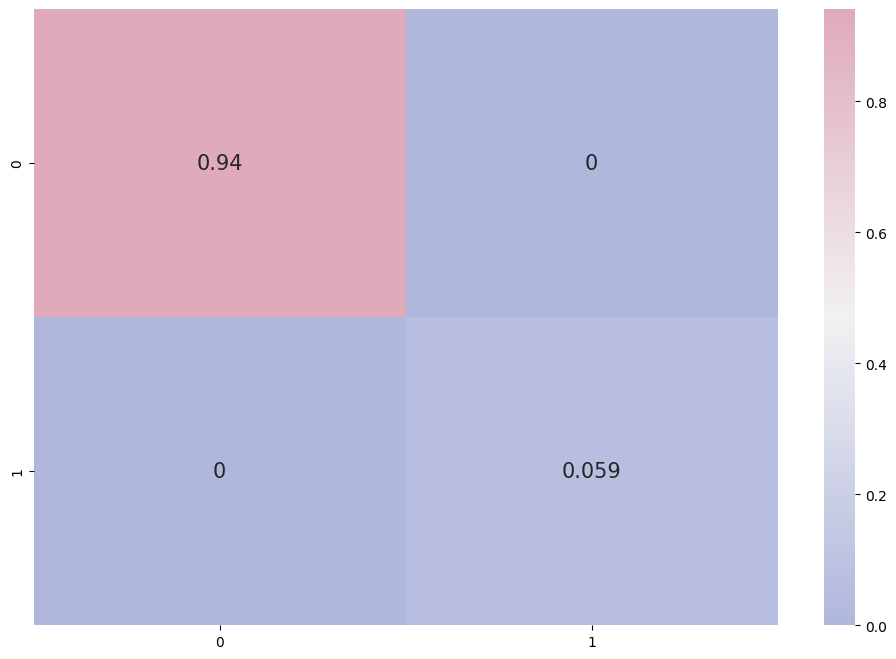

In [28]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,train_set,10)
print(para1)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_Pool)
computeMetric(y_Pool,y_pre)

1.0
acc: 0.9995270078516697
precision: 0.999748743718593
recall: 0.9960063897763578
cm: [[9945    0]
 [   5  621]]
f1: 0.9978695287387895
balanced acc: 0.9960063897763578
MCC: 0.9957481010117561
Kappa: 0.9957390617713104


0.9978695287387895

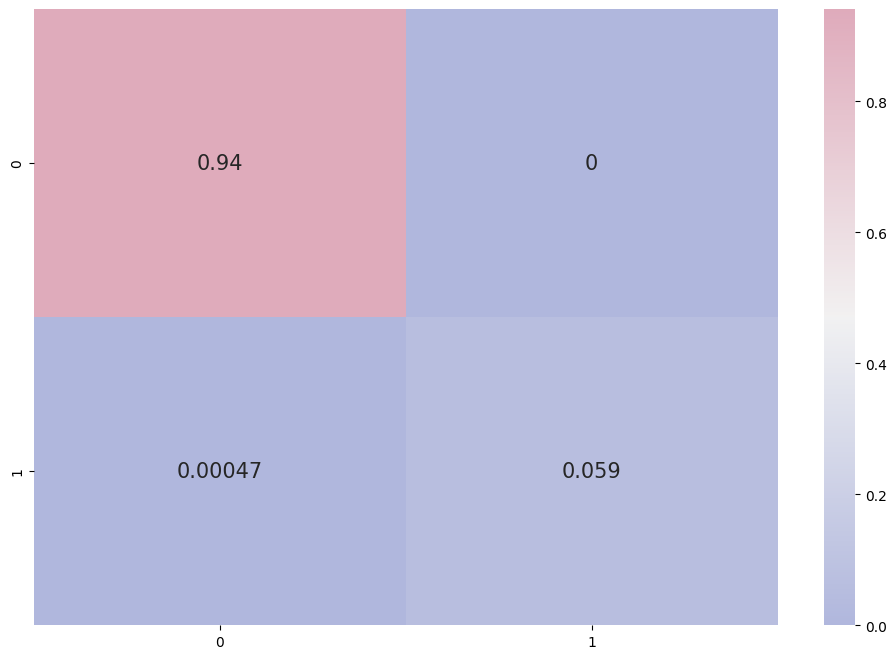

In [29]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,train_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt',
                          #objective='multiclass',
                          num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_Pool)
computeMetric(y_Pool,y_pre)

1.0
acc: 1.0
precision: 1.0
recall: 1.0
cm: [[9945    0]
 [   0  626]]
f1: 1.0
balanced acc: 1.0
MCC: 1.0
Kappa: 1.0


1.0

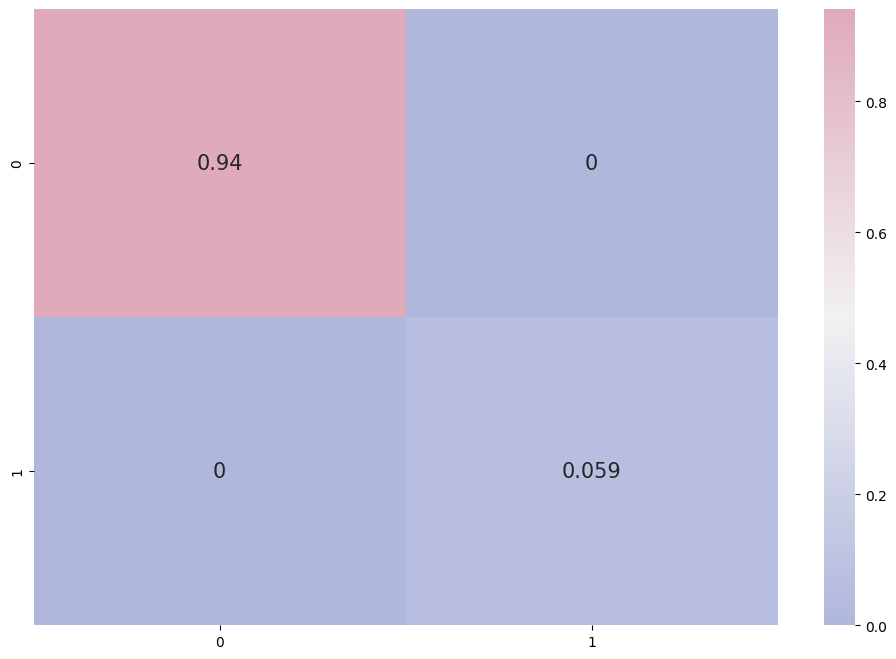

In [30]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,train_set,10)
clf3 = xgb.XGBClassifier(booster='gbtree',n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],
                         #objective='multi:softprob',
                    n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_Pool)
computeMetric(y_Pool,y_pre)

Learning rate set to 0.028199
0:	learn: 0.6019736	total: 58.2ms	remaining: 58.2s
1:	learn: 0.5204237	total: 62.9ms	remaining: 31.4s
2:	learn: 0.4498865	total: 67.5ms	remaining: 22.4s
3:	learn: 0.3897870	total: 72.2ms	remaining: 18s
4:	learn: 0.3361169	total: 76.7ms	remaining: 15.3s
5:	learn: 0.2866583	total: 80.7ms	remaining: 13.4s
6:	learn: 0.2478559	total: 85.2ms	remaining: 12.1s
7:	learn: 0.2124579	total: 89.8ms	remaining: 11.1s
8:	learn: 0.1834523	total: 94ms	remaining: 10.3s
9:	learn: 0.1614569	total: 99.2ms	remaining: 9.82s
10:	learn: 0.1399589	total: 103ms	remaining: 9.3s
11:	learn: 0.1220672	total: 108ms	remaining: 8.93s
12:	learn: 0.1066848	total: 113ms	remaining: 8.59s
13:	learn: 0.0929844	total: 118ms	remaining: 8.32s
14:	learn: 0.0814919	total: 123ms	remaining: 8.08s
15:	learn: 0.0704999	total: 127ms	remaining: 7.82s
16:	learn: 0.0623371	total: 132ms	remaining: 7.64s
17:	learn: 0.0558183	total: 137ms	remaining: 7.49s
18:	learn: 0.0497974	total: 142ms	remaining: 7.36s
19:	le

196:	learn: 0.0004779	total: 982ms	remaining: 4s
197:	learn: 0.0004735	total: 988ms	remaining: 4s
198:	learn: 0.0004672	total: 993ms	remaining: 4s
199:	learn: 0.0004603	total: 997ms	remaining: 3.99s
200:	learn: 0.0004558	total: 1s	remaining: 3.98s
201:	learn: 0.0004526	total: 1s	remaining: 3.97s
202:	learn: 0.0004477	total: 1.01s	remaining: 3.96s
203:	learn: 0.0004443	total: 1.01s	remaining: 3.95s
204:	learn: 0.0004412	total: 1.02s	remaining: 3.94s
205:	learn: 0.0004387	total: 1.02s	remaining: 3.94s
206:	learn: 0.0004357	total: 1.02s	remaining: 3.93s
207:	learn: 0.0004316	total: 1.03s	remaining: 3.92s
208:	learn: 0.0004287	total: 1.03s	remaining: 3.91s
209:	learn: 0.0004256	total: 1.04s	remaining: 3.9s
210:	learn: 0.0004222	total: 1.04s	remaining: 3.89s
211:	learn: 0.0004174	total: 1.04s	remaining: 3.88s
212:	learn: 0.0004141	total: 1.05s	remaining: 3.88s
213:	learn: 0.0004092	total: 1.05s	remaining: 3.87s
214:	learn: 0.0004049	total: 1.06s	remaining: 3.86s
215:	learn: 0.0004022	total:

394:	learn: 0.0001528	total: 1.77s	remaining: 2.71s
395:	learn: 0.0001528	total: 1.77s	remaining: 2.71s
396:	learn: 0.0001524	total: 1.78s	remaining: 2.7s
397:	learn: 0.0001517	total: 1.78s	remaining: 2.7s
398:	learn: 0.0001517	total: 1.79s	remaining: 2.69s
399:	learn: 0.0001510	total: 1.79s	remaining: 2.69s
400:	learn: 0.0001510	total: 1.79s	remaining: 2.68s
401:	learn: 0.0001506	total: 1.8s	remaining: 2.67s
402:	learn: 0.0001506	total: 1.8s	remaining: 2.67s
403:	learn: 0.0001503	total: 1.8s	remaining: 2.66s
404:	learn: 0.0001503	total: 1.81s	remaining: 2.66s
405:	learn: 0.0001495	total: 1.81s	remaining: 2.65s
406:	learn: 0.0001486	total: 1.82s	remaining: 2.65s
407:	learn: 0.0001480	total: 1.82s	remaining: 2.64s
408:	learn: 0.0001472	total: 1.82s	remaining: 2.64s
409:	learn: 0.0001472	total: 1.83s	remaining: 2.63s
410:	learn: 0.0001464	total: 1.83s	remaining: 2.63s
411:	learn: 0.0001464	total: 1.83s	remaining: 2.62s
412:	learn: 0.0001464	total: 1.84s	remaining: 2.61s
413:	learn: 0.000

555:	learn: 0.0001325	total: 2.36s	remaining: 1.88s
556:	learn: 0.0001323	total: 2.36s	remaining: 1.88s
557:	learn: 0.0001323	total: 2.37s	remaining: 1.87s
558:	learn: 0.0001319	total: 2.37s	remaining: 1.87s
559:	learn: 0.0001319	total: 2.37s	remaining: 1.86s
560:	learn: 0.0001317	total: 2.38s	remaining: 1.86s
561:	learn: 0.0001315	total: 2.38s	remaining: 1.86s
562:	learn: 0.0001307	total: 2.39s	remaining: 1.85s
563:	learn: 0.0001303	total: 2.39s	remaining: 1.85s
564:	learn: 0.0001299	total: 2.4s	remaining: 1.84s
565:	learn: 0.0001299	total: 2.4s	remaining: 1.84s
566:	learn: 0.0001299	total: 2.4s	remaining: 1.83s
567:	learn: 0.0001299	total: 2.41s	remaining: 1.83s
568:	learn: 0.0001296	total: 2.41s	remaining: 1.83s
569:	learn: 0.0001296	total: 2.41s	remaining: 1.82s
570:	learn: 0.0001288	total: 2.42s	remaining: 1.82s
571:	learn: 0.0001284	total: 2.42s	remaining: 1.81s
572:	learn: 0.0001284	total: 2.43s	remaining: 1.81s
573:	learn: 0.0001280	total: 2.43s	remaining: 1.8s
574:	learn: 0.00

724:	learn: 0.0001230	total: 2.94s	remaining: 1.11s
725:	learn: 0.0001230	total: 2.94s	remaining: 1.11s
726:	learn: 0.0001230	total: 2.94s	remaining: 1.11s
727:	learn: 0.0001230	total: 2.95s	remaining: 1.1s
728:	learn: 0.0001230	total: 2.95s	remaining: 1.1s
729:	learn: 0.0001230	total: 2.96s	remaining: 1.09s
730:	learn: 0.0001230	total: 2.96s	remaining: 1.09s
731:	learn: 0.0001230	total: 2.97s	remaining: 1.08s
732:	learn: 0.0001230	total: 2.97s	remaining: 1.08s
733:	learn: 0.0001230	total: 2.97s	remaining: 1.08s
734:	learn: 0.0001230	total: 2.98s	remaining: 1.07s
735:	learn: 0.0001230	total: 2.98s	remaining: 1.07s
736:	learn: 0.0001230	total: 2.98s	remaining: 1.06s
737:	learn: 0.0001230	total: 2.99s	remaining: 1.06s
738:	learn: 0.0001230	total: 2.99s	remaining: 1.05s
739:	learn: 0.0001230	total: 2.99s	remaining: 1.05s
740:	learn: 0.0001230	total: 3s	remaining: 1.05s
741:	learn: 0.0001230	total: 3s	remaining: 1.04s
742:	learn: 0.0001230	total: 3s	remaining: 1.04s
743:	learn: 0.0001230	t

895:	learn: 0.0001230	total: 3.52s	remaining: 409ms
896:	learn: 0.0001230	total: 3.53s	remaining: 405ms
897:	learn: 0.0001230	total: 3.53s	remaining: 401ms
898:	learn: 0.0001230	total: 3.53s	remaining: 397ms
899:	learn: 0.0001230	total: 3.54s	remaining: 393ms
900:	learn: 0.0001230	total: 3.54s	remaining: 389ms
901:	learn: 0.0001230	total: 3.54s	remaining: 385ms
902:	learn: 0.0001230	total: 3.55s	remaining: 381ms
903:	learn: 0.0001230	total: 3.55s	remaining: 377ms
904:	learn: 0.0001229	total: 3.55s	remaining: 373ms
905:	learn: 0.0001230	total: 3.56s	remaining: 369ms
906:	learn: 0.0001230	total: 3.56s	remaining: 365ms
907:	learn: 0.0001230	total: 3.56s	remaining: 361ms
908:	learn: 0.0001230	total: 3.57s	remaining: 357ms
909:	learn: 0.0001230	total: 3.57s	remaining: 353ms
910:	learn: 0.0001230	total: 3.57s	remaining: 349ms
911:	learn: 0.0001230	total: 3.58s	remaining: 345ms
912:	learn: 0.0001230	total: 3.58s	remaining: 341ms
913:	learn: 0.0001230	total: 3.58s	remaining: 337ms
914:	learn: 

1.0

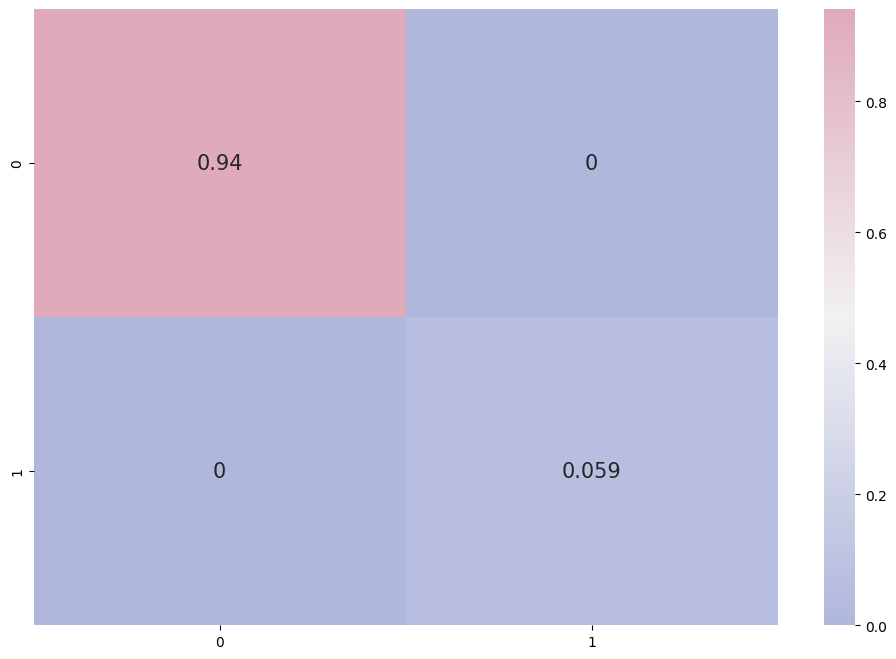

In [31]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_Pool)
computeMetric(y_Pool,y_pre)

## random sampling

In [32]:
sampling=random_sampling

In [66]:
metric01,instance01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
#instance01.to_csv("./query/random_Knn_"+float_cd+".csv")

        Date  Latitude  longitude  Pressure  Salinity  Temperature
0   1.682634  0.114396  -2.294765 -1.188040  2.130701     1.997820
1  -1.344521 -0.902827   0.580599  0.519859 -0.661706    -0.697855
2   1.613339 -0.518051  -1.969538 -0.912422 -0.127628     0.160840
3  -1.644976 -0.610928   0.758970  0.790831 -0.611699    -0.765807
4  -0.373963  1.155944   0.336678  1.719878 -0.591696    -0.914383
..       ...       ...        ...       ...       ...          ...
95 -1.275207 -0.495938   0.596987 -0.409188 -0.483680    -0.196174
96  0.203716 -0.498149  -0.659803 -0.602740 -0.225642    -0.046115
97  1.174293 -1.398171  -1.539683 -0.873712 -0.025613     0.152211
98 -0.050469  0.733575  -0.185198  1.255354 -0.557691    -0.835646
99  0.226831 -0.051456  -0.545091 -1.188040  2.118700     2.059031

[100 rows x 6 columns]
1 --------------------> 1.0
1 --------------------> 1.0
2 --------------------> 1.0
2 --------------------> 1.0
3 --------------------> 1.0
3 --------------------> 1.0
4 --

129 --------------------> 1.0
129 --------------------> 1.0
130 --------------------> 1.0
130 --------------------> 1.0
131 --------------------> 1.0
131 --------------------> 1.0
132 --------------------> 1.0
132 --------------------> 1.0
133 --------------------> 1.0
133 --------------------> 1.0
134 --------------------> 1.0
134 --------------------> 1.0
135 --------------------> 1.0
135 --------------------> 1.0
136 --------------------> 1.0
136 --------------------> 1.0
137 --------------------> 1.0
137 --------------------> 1.0
138 --------------------> 1.0
138 --------------------> 1.0
139 --------------------> 1.0
139 --------------------> 1.0
140 --------------------> 1.0
140 --------------------> 1.0
141 --------------------> 1.0
141 --------------------> 1.0
142 --------------------> 1.0
142 --------------------> 1.0
143 --------------------> 1.0
143 --------------------> 1.0
144 --------------------> 1.0
144 --------------------> 1.0
145 --------------------> 1.0
145 ------

In [67]:
metric02,instance02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
#instance02.to_csv("./query/random_Lg_"+float_cd+".csv")

        Date  Latitude  longitude  Pressure  Salinity  Temperature
0   1.682634  0.114396  -2.294765 -1.188040  2.130701     1.997820
1  -1.344521 -0.902827   0.580599  0.519859 -0.661706    -0.697855
2   1.613339 -0.518051  -1.969538 -0.912422 -0.127628     0.160840
3  -1.644976 -0.610928   0.758970  0.790831 -0.611699    -0.765807
4  -0.373963  1.155944   0.336678  1.719878 -0.591696    -0.914383
..       ...       ...        ...       ...       ...          ...
95 -1.275207 -0.495938   0.596987 -0.409188 -0.483680    -0.196174
96  0.203716 -0.498149  -0.659803 -0.602740 -0.225642    -0.046115
97  1.174293 -1.398171  -1.539683 -0.873712 -0.025613     0.152211
98 -0.050469  0.733575  -0.185198  1.255354 -0.557691    -0.835646
99  0.226831 -0.051456  -0.545091 -1.188040  2.118700     2.059031

[100 rows x 6 columns]
1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --

135 --------------------> 0.0
135 --------------------> 0.0
136 --------------------> 0.0
136 --------------------> 0.0
137 --------------------> 0.0
137 --------------------> 0.0
138 --------------------> 0.0
138 --------------------> 0.0
139 --------------------> 0.0
139 --------------------> 0.0
140 --------------------> 0.0
140 --------------------> 0.0
141 --------------------> 0.0
141 --------------------> 0.0
142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 ------

In [68]:
metric03,instance03= al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
#instance03.to_csv("./query/random_XB_"+float_cd+".csv")

        Date  Latitude  longitude  Pressure  Salinity  Temperature
0   1.682634  0.114396  -2.294765 -1.188040  2.130701     1.997820
1  -1.344521 -0.902827   0.580599  0.519859 -0.661706    -0.697855
2   1.613339 -0.518051  -1.969538 -0.912422 -0.127628     0.160840
3  -1.644976 -0.610928   0.758970  0.790831 -0.611699    -0.765807
4  -0.373963  1.155944   0.336678  1.719878 -0.591696    -0.914383
..       ...       ...        ...       ...       ...          ...
95 -1.275207 -0.495938   0.596987 -0.409188 -0.483680    -0.196174
96  0.203716 -0.498149  -0.659803 -0.602740 -0.225642    -0.046115
97  1.174293 -1.398171  -1.539683 -0.873712 -0.025613     0.152211
98 -0.050469  0.733575  -0.185198  1.255354 -0.557691    -0.835646
99  0.226831 -0.051456  -0.545091 -1.188040  2.118700     2.059031

[100 rows x 6 columns]
1 --------------------> 0.9280114041339986
1 --------------------> 0.9333333333333333
2 --------------------> 1.0
2 --------------------> 1.0
3 --------------------> 1.0
3 

127 --------------------> 1.0
127 --------------------> 1.0
128 --------------------> 1.0
128 --------------------> 1.0
129 --------------------> 1.0
129 --------------------> 1.0
130 --------------------> 1.0
130 --------------------> 1.0
131 --------------------> 1.0
131 --------------------> 1.0
132 --------------------> 1.0
132 --------------------> 1.0
133 --------------------> 1.0
133 --------------------> 1.0
134 --------------------> 1.0
134 --------------------> 1.0
135 --------------------> 1.0
135 --------------------> 1.0
136 --------------------> 1.0
136 --------------------> 1.0
137 --------------------> 1.0
137 --------------------> 1.0
138 --------------------> 1.0
138 --------------------> 1.0
139 --------------------> 1.0
139 --------------------> 1.0
140 --------------------> 1.0
140 --------------------> 1.0
141 --------------------> 1.0
141 --------------------> 1.0
142 --------------------> 1.0
142 --------------------> 1.0
143 --------------------> 1.0
143 ------

In [69]:
metric04,instance04= al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
#instance04.to_csv("./query/random_CB_"+float_cd+".csv")

Learning rate set to 0.003854
0:	learn: 0.6853439	total: 1.61ms	remaining: 1.61s
1:	learn: 0.6799080	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6740748	total: 3.58ms	remaining: 1.19s
3:	learn: 0.6683112	total: 4.53ms	remaining: 1.13s
4:	learn: 0.6624788	total: 5.73ms	remaining: 1.14s
5:	learn: 0.6588631	total: 6.51ms	remaining: 1.08s
6:	learn: 0.6528271	total: 7.43ms	remaining: 1.05s
7:	learn: 0.6465627	total: 8.46ms	remaining: 1.05s
8:	learn: 0.6407413	total: 9.27ms	remaining: 1.02s
9:	learn: 0.6355907	total: 10ms	remaining: 994ms
10:	learn: 0.6302812	total: 10.8ms	remaining: 971ms
11:	learn: 0.6256635	total: 11.6ms	remaining: 958ms
12:	learn: 0.6196570	total: 12.5ms	remaining: 952ms
13:	learn: 0.6152802	total: 13.5ms	remaining: 950ms
14:	learn: 0.6101451	total: 14.3ms	remaining: 937ms
15:	learn: 0.6050122	total: 15.1ms	remaining: 929ms
16:	learn: 0.5996200	total: 15.9ms	remaining: 922ms
17:	learn: 0.5941521	total: 16.9ms	remaining: 921ms
18:	learn: 0.5881834	total: 17.8ms	remaining: 

202:	learn: 0.1467136	total: 169ms	remaining: 663ms
203:	learn: 0.1457257	total: 171ms	remaining: 665ms
204:	learn: 0.1448433	total: 172ms	remaining: 666ms
205:	learn: 0.1439944	total: 173ms	remaining: 668ms
206:	learn: 0.1432044	total: 175ms	remaining: 670ms
207:	learn: 0.1423562	total: 176ms	remaining: 671ms
208:	learn: 0.1415629	total: 177ms	remaining: 672ms
209:	learn: 0.1404138	total: 179ms	remaining: 672ms
210:	learn: 0.1395230	total: 180ms	remaining: 675ms
211:	learn: 0.1386182	total: 182ms	remaining: 677ms
212:	learn: 0.1377165	total: 183ms	remaining: 677ms
213:	learn: 0.1370187	total: 185ms	remaining: 678ms
214:	learn: 0.1361234	total: 186ms	remaining: 680ms
215:	learn: 0.1352562	total: 188ms	remaining: 681ms
216:	learn: 0.1343844	total: 189ms	remaining: 682ms
217:	learn: 0.1335755	total: 190ms	remaining: 681ms
218:	learn: 0.1327495	total: 191ms	remaining: 682ms
219:	learn: 0.1319946	total: 193ms	remaining: 683ms
220:	learn: 0.1314480	total: 194ms	remaining: 685ms
221:	learn: 

403:	learn: 0.0539631	total: 350ms	remaining: 517ms
404:	learn: 0.0537146	total: 351ms	remaining: 516ms
405:	learn: 0.0534315	total: 352ms	remaining: 515ms
406:	learn: 0.0532322	total: 353ms	remaining: 514ms
407:	learn: 0.0530769	total: 354ms	remaining: 513ms
408:	learn: 0.0528467	total: 354ms	remaining: 512ms
409:	learn: 0.0527137	total: 355ms	remaining: 511ms
410:	learn: 0.0524815	total: 356ms	remaining: 510ms
411:	learn: 0.0523333	total: 356ms	remaining: 509ms
412:	learn: 0.0521303	total: 357ms	remaining: 508ms
413:	learn: 0.0519163	total: 358ms	remaining: 507ms
414:	learn: 0.0517698	total: 359ms	remaining: 506ms
415:	learn: 0.0515526	total: 359ms	remaining: 505ms
416:	learn: 0.0513932	total: 361ms	remaining: 504ms
417:	learn: 0.0511701	total: 362ms	remaining: 504ms
418:	learn: 0.0509868	total: 362ms	remaining: 503ms
419:	learn: 0.0508178	total: 363ms	remaining: 502ms
420:	learn: 0.0505630	total: 364ms	remaining: 501ms
421:	learn: 0.0504118	total: 365ms	remaining: 500ms
422:	learn: 

655:	learn: 0.0242553	total: 530ms	remaining: 278ms
656:	learn: 0.0241889	total: 532ms	remaining: 278ms
657:	learn: 0.0240895	total: 533ms	remaining: 277ms
658:	learn: 0.0240432	total: 533ms	remaining: 276ms
659:	learn: 0.0239863	total: 534ms	remaining: 275ms
660:	learn: 0.0239397	total: 535ms	remaining: 274ms
661:	learn: 0.0238666	total: 536ms	remaining: 273ms
662:	learn: 0.0237966	total: 536ms	remaining: 273ms
663:	learn: 0.0237451	total: 537ms	remaining: 272ms
664:	learn: 0.0236970	total: 538ms	remaining: 271ms
665:	learn: 0.0236204	total: 538ms	remaining: 270ms
666:	learn: 0.0235763	total: 539ms	remaining: 269ms
667:	learn: 0.0235427	total: 540ms	remaining: 268ms
668:	learn: 0.0234873	total: 541ms	remaining: 268ms
669:	learn: 0.0234366	total: 542ms	remaining: 267ms
670:	learn: 0.0233917	total: 543ms	remaining: 266ms
671:	learn: 0.0233288	total: 544ms	remaining: 265ms
672:	learn: 0.0232739	total: 544ms	remaining: 265ms
673:	learn: 0.0232276	total: 545ms	remaining: 264ms
674:	learn: 

906:	learn: 0.0142533	total: 711ms	remaining: 72.9ms
907:	learn: 0.0142362	total: 712ms	remaining: 72.2ms
908:	learn: 0.0142047	total: 713ms	remaining: 71.4ms
909:	learn: 0.0141790	total: 714ms	remaining: 70.6ms
910:	learn: 0.0141439	total: 714ms	remaining: 69.8ms
911:	learn: 0.0141231	total: 715ms	remaining: 69ms
912:	learn: 0.0141007	total: 716ms	remaining: 68.2ms
913:	learn: 0.0140856	total: 717ms	remaining: 67.4ms
914:	learn: 0.0140625	total: 718ms	remaining: 66.7ms
915:	learn: 0.0140386	total: 719ms	remaining: 65.9ms
916:	learn: 0.0140194	total: 719ms	remaining: 65.1ms
917:	learn: 0.0139951	total: 720ms	remaining: 64.3ms
918:	learn: 0.0139665	total: 721ms	remaining: 63.5ms
919:	learn: 0.0139366	total: 722ms	remaining: 62.8ms
920:	learn: 0.0139063	total: 723ms	remaining: 62ms
921:	learn: 0.0138800	total: 723ms	remaining: 61.2ms
922:	learn: 0.0138600	total: 724ms	remaining: 60.4ms
923:	learn: 0.0138308	total: 725ms	remaining: 59.6ms
924:	learn: 0.0138057	total: 726ms	remaining: 58.9

123:	learn: 0.2483926	total: 89.1ms	remaining: 629ms
124:	learn: 0.2468772	total: 90.1ms	remaining: 631ms
125:	learn: 0.2453250	total: 90.9ms	remaining: 631ms
126:	learn: 0.2438797	total: 91.7ms	remaining: 630ms
127:	learn: 0.2418918	total: 92.6ms	remaining: 631ms
128:	learn: 0.2400418	total: 94.1ms	remaining: 635ms
129:	learn: 0.2384762	total: 94.8ms	remaining: 635ms
130:	learn: 0.2364847	total: 95.5ms	remaining: 634ms
131:	learn: 0.2344138	total: 96.3ms	remaining: 633ms
132:	learn: 0.2327079	total: 97.1ms	remaining: 633ms
133:	learn: 0.2311892	total: 97.8ms	remaining: 632ms
134:	learn: 0.2299760	total: 98.6ms	remaining: 632ms
135:	learn: 0.2284119	total: 99.8ms	remaining: 634ms
136:	learn: 0.2267414	total: 101ms	remaining: 635ms
137:	learn: 0.2249431	total: 102ms	remaining: 634ms
138:	learn: 0.2233200	total: 102ms	remaining: 635ms
139:	learn: 0.2217454	total: 103ms	remaining: 633ms
140:	learn: 0.2204390	total: 104ms	remaining: 633ms
141:	learn: 0.2192885	total: 105ms	remaining: 634ms

366:	learn: 0.0617646	total: 270ms	remaining: 465ms
367:	learn: 0.0614794	total: 271ms	remaining: 465ms
368:	learn: 0.0612180	total: 272ms	remaining: 465ms
369:	learn: 0.0610059	total: 272ms	remaining: 464ms
370:	learn: 0.0607759	total: 273ms	remaining: 463ms
371:	learn: 0.0605114	total: 274ms	remaining: 463ms
372:	learn: 0.0602382	total: 275ms	remaining: 462ms
373:	learn: 0.0600422	total: 276ms	remaining: 461ms
374:	learn: 0.0597624	total: 276ms	remaining: 461ms
375:	learn: 0.0594456	total: 277ms	remaining: 460ms
376:	learn: 0.0591819	total: 278ms	remaining: 459ms
377:	learn: 0.0589767	total: 279ms	remaining: 458ms
378:	learn: 0.0586622	total: 279ms	remaining: 458ms
379:	learn: 0.0584827	total: 280ms	remaining: 457ms
380:	learn: 0.0582376	total: 281ms	remaining: 457ms
381:	learn: 0.0580336	total: 282ms	remaining: 457ms
382:	learn: 0.0577817	total: 283ms	remaining: 456ms
383:	learn: 0.0575747	total: 284ms	remaining: 455ms
384:	learn: 0.0573290	total: 284ms	remaining: 454ms
385:	learn: 

555:	learn: 0.0307360	total: 452ms	remaining: 361ms
556:	learn: 0.0306480	total: 452ms	remaining: 360ms
557:	learn: 0.0305520	total: 453ms	remaining: 359ms
558:	learn: 0.0304726	total: 454ms	remaining: 358ms
559:	learn: 0.0303828	total: 455ms	remaining: 357ms
560:	learn: 0.0302957	total: 456ms	remaining: 357ms
561:	learn: 0.0301917	total: 456ms	remaining: 356ms
562:	learn: 0.0300885	total: 457ms	remaining: 355ms
563:	learn: 0.0299687	total: 458ms	remaining: 354ms
564:	learn: 0.0298776	total: 459ms	remaining: 353ms
565:	learn: 0.0297504	total: 459ms	remaining: 352ms
566:	learn: 0.0296873	total: 460ms	remaining: 351ms
567:	learn: 0.0295996	total: 461ms	remaining: 350ms
568:	learn: 0.0295324	total: 461ms	remaining: 350ms
569:	learn: 0.0294363	total: 463ms	remaining: 349ms
570:	learn: 0.0293292	total: 465ms	remaining: 349ms
571:	learn: 0.0292656	total: 466ms	remaining: 348ms
572:	learn: 0.0291801	total: 466ms	remaining: 348ms
573:	learn: 0.0290968	total: 467ms	remaining: 347ms
574:	learn: 

799:	learn: 0.0169213	total: 632ms	remaining: 158ms
800:	learn: 0.0168807	total: 633ms	remaining: 157ms
801:	learn: 0.0168527	total: 634ms	remaining: 157ms
802:	learn: 0.0168310	total: 635ms	remaining: 156ms
803:	learn: 0.0168019	total: 636ms	remaining: 155ms
804:	learn: 0.0167796	total: 636ms	remaining: 154ms
805:	learn: 0.0167483	total: 637ms	remaining: 153ms
806:	learn: 0.0167300	total: 638ms	remaining: 153ms
807:	learn: 0.0166857	total: 639ms	remaining: 152ms
808:	learn: 0.0166552	total: 639ms	remaining: 151ms
809:	learn: 0.0166252	total: 640ms	remaining: 150ms
810:	learn: 0.0165911	total: 641ms	remaining: 149ms
811:	learn: 0.0165698	total: 642ms	remaining: 149ms
812:	learn: 0.0165410	total: 643ms	remaining: 148ms
813:	learn: 0.0164981	total: 644ms	remaining: 147ms
814:	learn: 0.0164576	total: 645ms	remaining: 146ms
815:	learn: 0.0164326	total: 646ms	remaining: 146ms
816:	learn: 0.0164100	total: 647ms	remaining: 145ms
817:	learn: 0.0163803	total: 648ms	remaining: 144ms
818:	learn: 

Learning rate set to 0.003887
0:	learn: 0.6861174	total: 922us	remaining: 921ms
1:	learn: 0.6809847	total: 1.67ms	remaining: 833ms
2:	learn: 0.6750393	total: 2.45ms	remaining: 814ms
3:	learn: 0.6684893	total: 3.07ms	remaining: 764ms
4:	learn: 0.6624074	total: 3.81ms	remaining: 759ms
5:	learn: 0.6587203	total: 4.61ms	remaining: 764ms
6:	learn: 0.6525969	total: 5.36ms	remaining: 760ms
7:	learn: 0.6459419	total: 6.11ms	remaining: 758ms
8:	learn: 0.6406604	total: 6.88ms	remaining: 757ms
9:	learn: 0.6356370	total: 7.7ms	remaining: 762ms
10:	learn: 0.6297865	total: 8.59ms	remaining: 772ms
11:	learn: 0.6251145	total: 9.33ms	remaining: 769ms
12:	learn: 0.6191994	total: 10.2ms	remaining: 771ms
13:	learn: 0.6141750	total: 11.6ms	remaining: 820ms
14:	learn: 0.6090145	total: 12.7ms	remaining: 836ms
15:	learn: 0.6037274	total: 13.5ms	remaining: 833ms
16:	learn: 0.5983830	total: 14.4ms	remaining: 830ms
17:	learn: 0.5929454	total: 15.3ms	remaining: 834ms
18:	learn: 0.5869845	total: 16ms	remaining: 82

246:	learn: 0.1091818	total: 181ms	remaining: 551ms
247:	learn: 0.1087387	total: 182ms	remaining: 551ms
248:	learn: 0.1081107	total: 183ms	remaining: 551ms
249:	learn: 0.1076782	total: 183ms	remaining: 550ms
250:	learn: 0.1071051	total: 184ms	remaining: 550ms
251:	learn: 0.1065025	total: 185ms	remaining: 549ms
252:	learn: 0.1057674	total: 186ms	remaining: 548ms
253:	learn: 0.1049666	total: 186ms	remaining: 548ms
254:	learn: 0.1043589	total: 187ms	remaining: 547ms
255:	learn: 0.1038537	total: 188ms	remaining: 547ms
256:	learn: 0.1031333	total: 189ms	remaining: 546ms
257:	learn: 0.1024096	total: 190ms	remaining: 545ms
258:	learn: 0.1015821	total: 190ms	remaining: 545ms
259:	learn: 0.1011467	total: 191ms	remaining: 544ms
260:	learn: 0.1007100	total: 192ms	remaining: 544ms
261:	learn: 0.1001210	total: 193ms	remaining: 543ms
262:	learn: 0.0995720	total: 194ms	remaining: 544ms
263:	learn: 0.0990842	total: 195ms	remaining: 544ms
264:	learn: 0.0984888	total: 196ms	remaining: 544ms
265:	learn: 

496:	learn: 0.0357354	total: 361ms	remaining: 366ms
497:	learn: 0.0356033	total: 363ms	remaining: 366ms
498:	learn: 0.0354808	total: 364ms	remaining: 365ms
499:	learn: 0.0353648	total: 364ms	remaining: 364ms
500:	learn: 0.0352902	total: 365ms	remaining: 364ms
501:	learn: 0.0351737	total: 366ms	remaining: 363ms
502:	learn: 0.0350892	total: 367ms	remaining: 363ms
503:	learn: 0.0350035	total: 368ms	remaining: 362ms
504:	learn: 0.0348927	total: 369ms	remaining: 361ms
505:	learn: 0.0347709	total: 369ms	remaining: 360ms
506:	learn: 0.0346434	total: 370ms	remaining: 360ms
507:	learn: 0.0345111	total: 371ms	remaining: 359ms
508:	learn: 0.0344039	total: 371ms	remaining: 358ms
509:	learn: 0.0342929	total: 372ms	remaining: 358ms
510:	learn: 0.0342100	total: 373ms	remaining: 357ms
511:	learn: 0.0341193	total: 374ms	remaining: 356ms
512:	learn: 0.0340123	total: 374ms	remaining: 355ms
513:	learn: 0.0338835	total: 376ms	remaining: 355ms
514:	learn: 0.0337747	total: 377ms	remaining: 355ms
515:	learn: 

675:	learn: 0.0215188	total: 544ms	remaining: 261ms
676:	learn: 0.0214693	total: 546ms	remaining: 260ms
677:	learn: 0.0214380	total: 546ms	remaining: 259ms
678:	learn: 0.0213718	total: 547ms	remaining: 259ms
679:	learn: 0.0212971	total: 548ms	remaining: 258ms
680:	learn: 0.0212190	total: 549ms	remaining: 257ms
681:	learn: 0.0211803	total: 549ms	remaining: 256ms
682:	learn: 0.0211467	total: 550ms	remaining: 255ms
683:	learn: 0.0210977	total: 551ms	remaining: 255ms
684:	learn: 0.0210456	total: 552ms	remaining: 254ms
685:	learn: 0.0210089	total: 553ms	remaining: 253ms
686:	learn: 0.0209517	total: 553ms	remaining: 252ms
687:	learn: 0.0209203	total: 554ms	remaining: 251ms
688:	learn: 0.0208715	total: 555ms	remaining: 251ms
689:	learn: 0.0208206	total: 556ms	remaining: 250ms
690:	learn: 0.0207852	total: 557ms	remaining: 249ms
691:	learn: 0.0207288	total: 558ms	remaining: 248ms
692:	learn: 0.0206776	total: 559ms	remaining: 248ms
693:	learn: 0.0206359	total: 560ms	remaining: 247ms
694:	learn: 

920:	learn: 0.0130809	total: 726ms	remaining: 62.3ms
921:	learn: 0.0130571	total: 727ms	remaining: 61.5ms
922:	learn: 0.0130355	total: 728ms	remaining: 60.7ms
923:	learn: 0.0130160	total: 729ms	remaining: 60ms
924:	learn: 0.0129981	total: 730ms	remaining: 59.2ms
925:	learn: 0.0129828	total: 730ms	remaining: 58.4ms
926:	learn: 0.0129580	total: 731ms	remaining: 57.6ms
927:	learn: 0.0129297	total: 732ms	remaining: 56.8ms
928:	learn: 0.0129083	total: 733ms	remaining: 56ms
929:	learn: 0.0128816	total: 734ms	remaining: 55.2ms
930:	learn: 0.0128575	total: 734ms	remaining: 54.4ms
931:	learn: 0.0128197	total: 735ms	remaining: 53.6ms
932:	learn: 0.0127957	total: 736ms	remaining: 52.8ms
933:	learn: 0.0127779	total: 736ms	remaining: 52ms
934:	learn: 0.0127635	total: 737ms	remaining: 51.2ms
935:	learn: 0.0127421	total: 738ms	remaining: 50.4ms
936:	learn: 0.0127271	total: 739ms	remaining: 49.7ms
937:	learn: 0.0127124	total: 739ms	remaining: 48.9ms
938:	learn: 0.0126901	total: 741ms	remaining: 48.1ms

147:	learn: 0.2060064	total: 107ms	remaining: 614ms
148:	learn: 0.2045514	total: 108ms	remaining: 615ms
149:	learn: 0.2030994	total: 109ms	remaining: 615ms
150:	learn: 0.2014142	total: 109ms	remaining: 614ms
151:	learn: 0.1998522	total: 110ms	remaining: 613ms
152:	learn: 0.1984179	total: 111ms	remaining: 613ms
153:	learn: 0.1972815	total: 111ms	remaining: 612ms
154:	learn: 0.1959666	total: 112ms	remaining: 612ms
155:	learn: 0.1943706	total: 113ms	remaining: 612ms
156:	learn: 0.1928624	total: 114ms	remaining: 611ms
157:	learn: 0.1916777	total: 114ms	remaining: 610ms
158:	learn: 0.1905393	total: 115ms	remaining: 609ms
159:	learn: 0.1894761	total: 116ms	remaining: 610ms
160:	learn: 0.1881080	total: 117ms	remaining: 610ms
161:	learn: 0.1871537	total: 118ms	remaining: 609ms
162:	learn: 0.1859053	total: 118ms	remaining: 608ms
163:	learn: 0.1847179	total: 119ms	remaining: 609ms
164:	learn: 0.1833273	total: 121ms	remaining: 611ms
165:	learn: 0.1815310	total: 121ms	remaining: 610ms
166:	learn: 

397:	learn: 0.0523034	total: 288ms	remaining: 435ms
398:	learn: 0.0520700	total: 289ms	remaining: 435ms
399:	learn: 0.0518468	total: 289ms	remaining: 434ms
400:	learn: 0.0515875	total: 290ms	remaining: 434ms
401:	learn: 0.0514003	total: 291ms	remaining: 433ms
402:	learn: 0.0512241	total: 292ms	remaining: 432ms
403:	learn: 0.0510536	total: 293ms	remaining: 432ms
404:	learn: 0.0507336	total: 293ms	remaining: 431ms
405:	learn: 0.0505323	total: 294ms	remaining: 430ms
406:	learn: 0.0503368	total: 295ms	remaining: 429ms
407:	learn: 0.0501553	total: 296ms	remaining: 429ms
408:	learn: 0.0499726	total: 296ms	remaining: 428ms
409:	learn: 0.0497887	total: 297ms	remaining: 428ms
410:	learn: 0.0496514	total: 298ms	remaining: 427ms
411:	learn: 0.0494598	total: 299ms	remaining: 426ms
412:	learn: 0.0492630	total: 299ms	remaining: 426ms
413:	learn: 0.0490266	total: 300ms	remaining: 425ms
414:	learn: 0.0488875	total: 301ms	remaining: 425ms
415:	learn: 0.0487220	total: 302ms	remaining: 424ms
416:	learn: 

643:	learn: 0.0233467	total: 468ms	remaining: 259ms
644:	learn: 0.0232926	total: 470ms	remaining: 258ms
645:	learn: 0.0232365	total: 470ms	remaining: 258ms
646:	learn: 0.0231509	total: 471ms	remaining: 257ms
647:	learn: 0.0230901	total: 472ms	remaining: 256ms
648:	learn: 0.0230319	total: 472ms	remaining: 256ms
649:	learn: 0.0229543	total: 473ms	remaining: 255ms
650:	learn: 0.0228964	total: 474ms	remaining: 254ms
651:	learn: 0.0228269	total: 475ms	remaining: 253ms
652:	learn: 0.0227879	total: 475ms	remaining: 253ms
653:	learn: 0.0227186	total: 476ms	remaining: 252ms
654:	learn: 0.0226679	total: 477ms	remaining: 251ms
655:	learn: 0.0226321	total: 478ms	remaining: 251ms
656:	learn: 0.0225460	total: 479ms	remaining: 250ms
657:	learn: 0.0225015	total: 479ms	remaining: 249ms
658:	learn: 0.0224626	total: 480ms	remaining: 248ms
659:	learn: 0.0224233	total: 481ms	remaining: 248ms
660:	learn: 0.0223557	total: 482ms	remaining: 247ms
661:	learn: 0.0222873	total: 483ms	remaining: 247ms
662:	learn: 

861:	learn: 0.0144969	total: 650ms	remaining: 104ms
862:	learn: 0.0144681	total: 652ms	remaining: 103ms
863:	learn: 0.0144403	total: 652ms	remaining: 103ms
864:	learn: 0.0144034	total: 653ms	remaining: 102ms
865:	learn: 0.0143753	total: 654ms	remaining: 101ms
866:	learn: 0.0143549	total: 655ms	remaining: 100ms
867:	learn: 0.0143251	total: 656ms	remaining: 99.7ms
868:	learn: 0.0143045	total: 656ms	remaining: 98.9ms
869:	learn: 0.0142754	total: 657ms	remaining: 98.2ms
870:	learn: 0.0142513	total: 658ms	remaining: 97.4ms
871:	learn: 0.0142188	total: 659ms	remaining: 96.7ms
872:	learn: 0.0141995	total: 659ms	remaining: 95.9ms
873:	learn: 0.0141717	total: 660ms	remaining: 95.2ms
874:	learn: 0.0141485	total: 661ms	remaining: 94.4ms
875:	learn: 0.0141256	total: 662ms	remaining: 93.7ms
876:	learn: 0.0141013	total: 663ms	remaining: 92.9ms
877:	learn: 0.0140733	total: 663ms	remaining: 92.2ms
878:	learn: 0.0140366	total: 665ms	remaining: 91.6ms
879:	learn: 0.0140077	total: 666ms	remaining: 90.8ms

84:	learn: 0.3361435	total: 61.4ms	remaining: 661ms
85:	learn: 0.3325368	total: 62.2ms	remaining: 661ms
86:	learn: 0.3297015	total: 63ms	remaining: 662ms
87:	learn: 0.3268840	total: 63.8ms	remaining: 661ms
88:	learn: 0.3241305	total: 64.6ms	remaining: 662ms
89:	learn: 0.3212804	total: 65.5ms	remaining: 662ms
90:	learn: 0.3192514	total: 66.2ms	remaining: 661ms
91:	learn: 0.3174772	total: 66.9ms	remaining: 661ms
92:	learn: 0.3145724	total: 67.6ms	remaining: 659ms
93:	learn: 0.3127215	total: 68.3ms	remaining: 658ms
94:	learn: 0.3101638	total: 69.1ms	remaining: 658ms
95:	learn: 0.3074525	total: 69.8ms	remaining: 657ms
96:	learn: 0.3055172	total: 70.6ms	remaining: 657ms
97:	learn: 0.3030154	total: 71.4ms	remaining: 657ms
98:	learn: 0.3009038	total: 72.1ms	remaining: 656ms
99:	learn: 0.2988407	total: 72.8ms	remaining: 655ms
100:	learn: 0.2963741	total: 73.5ms	remaining: 654ms
101:	learn: 0.2939950	total: 74.3ms	remaining: 654ms
102:	learn: 0.2915060	total: 75.1ms	remaining: 654ms
103:	learn:

332:	learn: 0.0699683	total: 243ms	remaining: 487ms
333:	learn: 0.0696023	total: 244ms	remaining: 487ms
334:	learn: 0.0693097	total: 245ms	remaining: 486ms
335:	learn: 0.0690201	total: 246ms	remaining: 486ms
336:	learn: 0.0686882	total: 247ms	remaining: 485ms
337:	learn: 0.0683036	total: 247ms	remaining: 484ms
338:	learn: 0.0678517	total: 248ms	remaining: 484ms
339:	learn: 0.0676119	total: 249ms	remaining: 483ms
340:	learn: 0.0673925	total: 249ms	remaining: 482ms
341:	learn: 0.0670391	total: 250ms	remaining: 481ms
342:	learn: 0.0667473	total: 251ms	remaining: 481ms
343:	learn: 0.0663657	total: 252ms	remaining: 480ms
344:	learn: 0.0660182	total: 253ms	remaining: 479ms
345:	learn: 0.0656603	total: 254ms	remaining: 479ms
346:	learn: 0.0653811	total: 254ms	remaining: 478ms
347:	learn: 0.0650971	total: 255ms	remaining: 478ms
348:	learn: 0.0648839	total: 256ms	remaining: 478ms
349:	learn: 0.0645420	total: 257ms	remaining: 477ms
350:	learn: 0.0642689	total: 258ms	remaining: 477ms
351:	learn: 

579:	learn: 0.0277117	total: 424ms	remaining: 307ms
580:	learn: 0.0276176	total: 425ms	remaining: 307ms
581:	learn: 0.0275638	total: 426ms	remaining: 306ms
582:	learn: 0.0274830	total: 427ms	remaining: 305ms
583:	learn: 0.0274194	total: 428ms	remaining: 305ms
584:	learn: 0.0273256	total: 428ms	remaining: 304ms
585:	learn: 0.0272584	total: 429ms	remaining: 303ms
586:	learn: 0.0271710	total: 430ms	remaining: 303ms
587:	learn: 0.0271092	total: 431ms	remaining: 302ms
588:	learn: 0.0270144	total: 432ms	remaining: 301ms
589:	learn: 0.0269189	total: 432ms	remaining: 300ms
590:	learn: 0.0268179	total: 433ms	remaining: 300ms
591:	learn: 0.0267482	total: 434ms	remaining: 299ms
592:	learn: 0.0266842	total: 435ms	remaining: 298ms
593:	learn: 0.0266333	total: 435ms	remaining: 298ms
594:	learn: 0.0265780	total: 436ms	remaining: 297ms
595:	learn: 0.0264998	total: 437ms	remaining: 296ms
596:	learn: 0.0264325	total: 438ms	remaining: 296ms
597:	learn: 0.0263385	total: 440ms	remaining: 295ms
598:	learn: 

824:	learn: 0.0154248	total: 606ms	remaining: 128ms
825:	learn: 0.0153964	total: 607ms	remaining: 128ms
826:	learn: 0.0153730	total: 608ms	remaining: 127ms
827:	learn: 0.0153551	total: 608ms	remaining: 126ms
828:	learn: 0.0153310	total: 609ms	remaining: 126ms
829:	learn: 0.0152961	total: 610ms	remaining: 125ms
830:	learn: 0.0152697	total: 611ms	remaining: 124ms
831:	learn: 0.0152348	total: 612ms	remaining: 123ms
832:	learn: 0.0152033	total: 612ms	remaining: 123ms
833:	learn: 0.0151709	total: 613ms	remaining: 122ms
834:	learn: 0.0151528	total: 614ms	remaining: 121ms
835:	learn: 0.0151117	total: 614ms	remaining: 121ms
836:	learn: 0.0150839	total: 615ms	remaining: 120ms
837:	learn: 0.0150499	total: 616ms	remaining: 119ms
838:	learn: 0.0150253	total: 617ms	remaining: 118ms
839:	learn: 0.0149809	total: 617ms	remaining: 118ms
840:	learn: 0.0149439	total: 618ms	remaining: 117ms
841:	learn: 0.0149139	total: 619ms	remaining: 116ms
842:	learn: 0.0148906	total: 620ms	remaining: 115ms
843:	learn: 

4 --------------------> 1.0
4 --------------------> 1.0
Learning rate set to 0.003935
0:	learn: 0.6855490	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6799776	total: 2.44ms	remaining: 1.22s
2:	learn: 0.6739034	total: 3.27ms	remaining: 1.08s
3:	learn: 0.6673904	total: 4.04ms	remaining: 1s
4:	learn: 0.6607380	total: 4.68ms	remaining: 932ms
5:	learn: 0.6544795	total: 5.41ms	remaining: 897ms
6:	learn: 0.6493101	total: 6.54ms	remaining: 928ms
7:	learn: 0.6442800	total: 8.38ms	remaining: 1.04s
8:	learn: 0.6384687	total: 9.44ms	remaining: 1.04s
9:	learn: 0.6323827	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6270456	total: 11.2ms	remaining: 1.01s
11:	learn: 0.6235429	total: 12.1ms	remaining: 995ms
12:	learn: 0.6191389	total: 12.9ms	remaining: 983ms
13:	learn: 0.6142692	total: 13.9ms	remaining: 982ms
14:	learn: 0.6079415	total: 15.8ms	remaining: 1.03s
15:	learn: 0.6021047	total: 16.7ms	remaining: 1.03s
16:	learn: 0.5961349	total: 18.3ms	remaining: 1.06s
17:	learn: 0.5921687	total: 19.4ms	remainin

192:	learn: 0.1542155	total: 160ms	remaining: 667ms
193:	learn: 0.1530271	total: 161ms	remaining: 668ms
194:	learn: 0.1522975	total: 162ms	remaining: 668ms
195:	learn: 0.1513898	total: 163ms	remaining: 667ms
196:	learn: 0.1505611	total: 163ms	remaining: 666ms
197:	learn: 0.1495841	total: 164ms	remaining: 665ms
198:	learn: 0.1485321	total: 165ms	remaining: 664ms
199:	learn: 0.1467248	total: 165ms	remaining: 662ms
200:	learn: 0.1458626	total: 166ms	remaining: 661ms
201:	learn: 0.1448213	total: 167ms	remaining: 659ms
202:	learn: 0.1437828	total: 168ms	remaining: 658ms
203:	learn: 0.1429893	total: 168ms	remaining: 657ms
204:	learn: 0.1420373	total: 170ms	remaining: 660ms
205:	learn: 0.1410658	total: 171ms	remaining: 659ms
206:	learn: 0.1403066	total: 172ms	remaining: 658ms
207:	learn: 0.1394003	total: 173ms	remaining: 657ms
208:	learn: 0.1386191	total: 174ms	remaining: 657ms
209:	learn: 0.1377455	total: 174ms	remaining: 656ms
210:	learn: 0.1367993	total: 175ms	remaining: 655ms
211:	learn: 

388:	learn: 0.0541314	total: 338ms	remaining: 531ms
389:	learn: 0.0539272	total: 340ms	remaining: 532ms
390:	learn: 0.0537226	total: 342ms	remaining: 532ms
391:	learn: 0.0534348	total: 343ms	remaining: 532ms
392:	learn: 0.0532355	total: 344ms	remaining: 531ms
393:	learn: 0.0530360	total: 345ms	remaining: 530ms
394:	learn: 0.0528433	total: 345ms	remaining: 529ms
395:	learn: 0.0525744	total: 346ms	remaining: 528ms
396:	learn: 0.0523660	total: 348ms	remaining: 529ms
397:	learn: 0.0521123	total: 349ms	remaining: 528ms
398:	learn: 0.0518669	total: 351ms	remaining: 528ms
399:	learn: 0.0515818	total: 352ms	remaining: 528ms
400:	learn: 0.0513495	total: 353ms	remaining: 527ms
401:	learn: 0.0511596	total: 354ms	remaining: 527ms
402:	learn: 0.0509082	total: 355ms	remaining: 526ms
403:	learn: 0.0507344	total: 356ms	remaining: 526ms
404:	learn: 0.0504434	total: 357ms	remaining: 525ms
405:	learn: 0.0501927	total: 358ms	remaining: 523ms
406:	learn: 0.0499640	total: 358ms	remaining: 522ms
407:	learn: 

570:	learn: 0.0279976	total: 517ms	remaining: 389ms
571:	learn: 0.0279130	total: 519ms	remaining: 388ms
572:	learn: 0.0278343	total: 520ms	remaining: 388ms
573:	learn: 0.0277522	total: 521ms	remaining: 387ms
574:	learn: 0.0276752	total: 522ms	remaining: 386ms
575:	learn: 0.0275999	total: 523ms	remaining: 385ms
576:	learn: 0.0274861	total: 523ms	remaining: 384ms
577:	learn: 0.0273843	total: 524ms	remaining: 383ms
578:	learn: 0.0272976	total: 525ms	remaining: 382ms
579:	learn: 0.0271784	total: 527ms	remaining: 381ms
580:	learn: 0.0270815	total: 528ms	remaining: 381ms
581:	learn: 0.0269890	total: 529ms	remaining: 380ms
582:	learn: 0.0269104	total: 530ms	remaining: 379ms
583:	learn: 0.0268576	total: 532ms	remaining: 379ms
584:	learn: 0.0267845	total: 533ms	remaining: 378ms
585:	learn: 0.0267040	total: 534ms	remaining: 377ms
586:	learn: 0.0266247	total: 535ms	remaining: 376ms
587:	learn: 0.0265665	total: 535ms	remaining: 375ms
588:	learn: 0.0264822	total: 536ms	remaining: 374ms
589:	learn: 

784:	learn: 0.0167031	total: 698ms	remaining: 191ms
785:	learn: 0.0166701	total: 699ms	remaining: 190ms
786:	learn: 0.0166357	total: 700ms	remaining: 189ms
787:	learn: 0.0165890	total: 701ms	remaining: 189ms
788:	learn: 0.0165639	total: 702ms	remaining: 188ms
789:	learn: 0.0165281	total: 702ms	remaining: 187ms
790:	learn: 0.0164863	total: 703ms	remaining: 186ms
791:	learn: 0.0164446	total: 704ms	remaining: 185ms
792:	learn: 0.0164122	total: 705ms	remaining: 184ms
793:	learn: 0.0163750	total: 705ms	remaining: 183ms
794:	learn: 0.0163460	total: 706ms	remaining: 182ms
795:	learn: 0.0163039	total: 707ms	remaining: 181ms
796:	learn: 0.0162611	total: 709ms	remaining: 181ms
797:	learn: 0.0162351	total: 710ms	remaining: 180ms
798:	learn: 0.0161956	total: 710ms	remaining: 179ms
799:	learn: 0.0161567	total: 711ms	remaining: 178ms
800:	learn: 0.0161302	total: 712ms	remaining: 177ms
801:	learn: 0.0161058	total: 713ms	remaining: 176ms
802:	learn: 0.0160694	total: 714ms	remaining: 175ms
803:	learn: 

949:	learn: 0.0122045	total: 876ms	remaining: 46.1ms
950:	learn: 0.0121851	total: 878ms	remaining: 45.2ms
951:	learn: 0.0121587	total: 879ms	remaining: 44.3ms
952:	learn: 0.0121420	total: 880ms	remaining: 43.4ms
953:	learn: 0.0121234	total: 881ms	remaining: 42.5ms
954:	learn: 0.0121120	total: 883ms	remaining: 41.6ms
955:	learn: 0.0120833	total: 884ms	remaining: 40.7ms
956:	learn: 0.0120628	total: 885ms	remaining: 39.8ms
957:	learn: 0.0120409	total: 886ms	remaining: 38.8ms
958:	learn: 0.0120283	total: 887ms	remaining: 37.9ms
959:	learn: 0.0120098	total: 888ms	remaining: 37ms
960:	learn: 0.0119526	total: 888ms	remaining: 36.1ms
961:	learn: 0.0119243	total: 889ms	remaining: 35.1ms
962:	learn: 0.0119024	total: 890ms	remaining: 34.2ms
963:	learn: 0.0118788	total: 891ms	remaining: 33.3ms
964:	learn: 0.0118604	total: 893ms	remaining: 32.4ms
965:	learn: 0.0118433	total: 893ms	remaining: 31.4ms
966:	learn: 0.0118163	total: 894ms	remaining: 30.5ms
967:	learn: 0.0117983	total: 895ms	remaining: 29

130:	learn: 0.2323442	total: 116ms	remaining: 769ms
131:	learn: 0.2310117	total: 117ms	remaining: 773ms
132:	learn: 0.2289727	total: 119ms	remaining: 774ms
133:	learn: 0.2275997	total: 120ms	remaining: 774ms
134:	learn: 0.2258836	total: 121ms	remaining: 774ms
135:	learn: 0.2241433	total: 122ms	remaining: 775ms
136:	learn: 0.2226189	total: 123ms	remaining: 776ms
137:	learn: 0.2209140	total: 124ms	remaining: 776ms
138:	learn: 0.2191704	total: 126ms	remaining: 783ms
139:	learn: 0.2177205	total: 127ms	remaining: 783ms
140:	learn: 0.2160127	total: 128ms	remaining: 781ms
141:	learn: 0.2144753	total: 129ms	remaining: 780ms
142:	learn: 0.2128272	total: 131ms	remaining: 783ms
143:	learn: 0.2116283	total: 132ms	remaining: 782ms
144:	learn: 0.2098407	total: 132ms	remaining: 781ms
145:	learn: 0.2087138	total: 134ms	remaining: 782ms
146:	learn: 0.2072107	total: 135ms	remaining: 782ms
147:	learn: 0.2059091	total: 135ms	remaining: 780ms
148:	learn: 0.2047058	total: 136ms	remaining: 778ms
149:	learn: 

333:	learn: 0.0667869	total: 297ms	remaining: 593ms
334:	learn: 0.0664466	total: 298ms	remaining: 592ms
335:	learn: 0.0661266	total: 299ms	remaining: 591ms
336:	learn: 0.0658669	total: 300ms	remaining: 590ms
337:	learn: 0.0655081	total: 301ms	remaining: 589ms
338:	learn: 0.0650569	total: 301ms	remaining: 588ms
339:	learn: 0.0646613	total: 302ms	remaining: 587ms
340:	learn: 0.0644336	total: 303ms	remaining: 586ms
341:	learn: 0.0640168	total: 304ms	remaining: 585ms
342:	learn: 0.0636480	total: 305ms	remaining: 583ms
343:	learn: 0.0633824	total: 305ms	remaining: 583ms
344:	learn: 0.0630226	total: 306ms	remaining: 581ms
345:	learn: 0.0627248	total: 307ms	remaining: 581ms
346:	learn: 0.0623986	total: 308ms	remaining: 580ms
347:	learn: 0.0621346	total: 309ms	remaining: 579ms
348:	learn: 0.0617915	total: 310ms	remaining: 578ms
349:	learn: 0.0616115	total: 311ms	remaining: 577ms
350:	learn: 0.0612920	total: 324ms	remaining: 599ms
351:	learn: 0.0610416	total: 325ms	remaining: 599ms
352:	learn: 

501:	learn: 0.0336844	total: 491ms	remaining: 487ms
502:	learn: 0.0336083	total: 492ms	remaining: 487ms
503:	learn: 0.0335246	total: 493ms	remaining: 485ms
504:	learn: 0.0334401	total: 494ms	remaining: 484ms
505:	learn: 0.0333253	total: 495ms	remaining: 483ms
506:	learn: 0.0332123	total: 496ms	remaining: 482ms
507:	learn: 0.0330873	total: 497ms	remaining: 481ms
508:	learn: 0.0329889	total: 497ms	remaining: 480ms
509:	learn: 0.0328819	total: 498ms	remaining: 479ms
510:	learn: 0.0328104	total: 499ms	remaining: 478ms
511:	learn: 0.0327229	total: 500ms	remaining: 476ms
512:	learn: 0.0326184	total: 501ms	remaining: 475ms
513:	learn: 0.0324970	total: 502ms	remaining: 474ms
514:	learn: 0.0323602	total: 502ms	remaining: 473ms
515:	learn: 0.0322620	total: 503ms	remaining: 472ms
516:	learn: 0.0321615	total: 504ms	remaining: 471ms
517:	learn: 0.0320455	total: 504ms	remaining: 469ms
518:	learn: 0.0319109	total: 505ms	remaining: 468ms
519:	learn: 0.0318317	total: 506ms	remaining: 467ms
520:	learn: 

731:	learn: 0.0181951	total: 662ms	remaining: 242ms
732:	learn: 0.0181555	total: 663ms	remaining: 241ms
733:	learn: 0.0181160	total: 664ms	remaining: 241ms
734:	learn: 0.0180801	total: 665ms	remaining: 240ms
735:	learn: 0.0180411	total: 665ms	remaining: 239ms
736:	learn: 0.0180047	total: 666ms	remaining: 238ms
737:	learn: 0.0179629	total: 667ms	remaining: 237ms
738:	learn: 0.0179315	total: 668ms	remaining: 236ms
739:	learn: 0.0179004	total: 668ms	remaining: 235ms
740:	learn: 0.0178672	total: 669ms	remaining: 234ms
741:	learn: 0.0178396	total: 670ms	remaining: 233ms
742:	learn: 0.0177974	total: 671ms	remaining: 232ms
743:	learn: 0.0177571	total: 672ms	remaining: 231ms
744:	learn: 0.0176944	total: 673ms	remaining: 230ms
745:	learn: 0.0176466	total: 674ms	remaining: 229ms
746:	learn: 0.0176198	total: 675ms	remaining: 228ms
747:	learn: 0.0175971	total: 675ms	remaining: 228ms
748:	learn: 0.0175468	total: 676ms	remaining: 227ms
749:	learn: 0.0175096	total: 677ms	remaining: 226ms
750:	learn: 

967:	learn: 0.0115312	total: 843ms	remaining: 27.9ms
968:	learn: 0.0115051	total: 845ms	remaining: 27ms
969:	learn: 0.0114876	total: 845ms	remaining: 26.1ms
970:	learn: 0.0114704	total: 846ms	remaining: 25.3ms
971:	learn: 0.0114439	total: 847ms	remaining: 24.4ms
972:	learn: 0.0114260	total: 848ms	remaining: 23.5ms
973:	learn: 0.0114047	total: 848ms	remaining: 22.6ms
974:	learn: 0.0113921	total: 849ms	remaining: 21.8ms
975:	learn: 0.0113693	total: 850ms	remaining: 20.9ms
976:	learn: 0.0113556	total: 851ms	remaining: 20ms
977:	learn: 0.0113325	total: 851ms	remaining: 19.1ms
978:	learn: 0.0113178	total: 852ms	remaining: 18.3ms
979:	learn: 0.0113010	total: 853ms	remaining: 17.4ms
980:	learn: 0.0112794	total: 855ms	remaining: 16.6ms
981:	learn: 0.0112598	total: 856ms	remaining: 15.7ms
982:	learn: 0.0112407	total: 857ms	remaining: 14.8ms
983:	learn: 0.0112241	total: 857ms	remaining: 13.9ms
984:	learn: 0.0111985	total: 858ms	remaining: 13.1ms
985:	learn: 0.0111809	total: 859ms	remaining: 12.2

190:	learn: 0.1524670	total: 138ms	remaining: 586ms
191:	learn: 0.1513599	total: 139ms	remaining: 586ms
192:	learn: 0.1500963	total: 140ms	remaining: 585ms
193:	learn: 0.1492893	total: 141ms	remaining: 585ms
194:	learn: 0.1483631	total: 142ms	remaining: 584ms
195:	learn: 0.1473452	total: 142ms	remaining: 584ms
196:	learn: 0.1463540	total: 143ms	remaining: 583ms
197:	learn: 0.1452159	total: 144ms	remaining: 583ms
198:	learn: 0.1441385	total: 145ms	remaining: 582ms
199:	learn: 0.1432011	total: 145ms	remaining: 581ms
200:	learn: 0.1423584	total: 146ms	remaining: 580ms
201:	learn: 0.1412203	total: 147ms	remaining: 580ms
202:	learn: 0.1403142	total: 147ms	remaining: 579ms
203:	learn: 0.1394578	total: 148ms	remaining: 578ms
204:	learn: 0.1385838	total: 149ms	remaining: 578ms
205:	learn: 0.1373636	total: 151ms	remaining: 581ms
206:	learn: 0.1368054	total: 152ms	remaining: 582ms
207:	learn: 0.1357238	total: 153ms	remaining: 581ms
208:	learn: 0.1349903	total: 154ms	remaining: 581ms
209:	learn: 

432:	learn: 0.0437291	total: 321ms	remaining: 420ms
433:	learn: 0.0435895	total: 322ms	remaining: 420ms
434:	learn: 0.0434216	total: 323ms	remaining: 419ms
435:	learn: 0.0432767	total: 324ms	remaining: 419ms
436:	learn: 0.0430689	total: 325ms	remaining: 418ms
437:	learn: 0.0429383	total: 325ms	remaining: 418ms
438:	learn: 0.0427224	total: 326ms	remaining: 417ms
439:	learn: 0.0425745	total: 327ms	remaining: 416ms
440:	learn: 0.0424489	total: 328ms	remaining: 415ms
441:	learn: 0.0422580	total: 329ms	remaining: 415ms
442:	learn: 0.0420425	total: 329ms	remaining: 414ms
443:	learn: 0.0418987	total: 330ms	remaining: 413ms
444:	learn: 0.0417726	total: 331ms	remaining: 413ms
445:	learn: 0.0416155	total: 332ms	remaining: 412ms
446:	learn: 0.0414628	total: 334ms	remaining: 413ms
447:	learn: 0.0411752	total: 334ms	remaining: 412ms
448:	learn: 0.0409389	total: 335ms	remaining: 411ms
449:	learn: 0.0408108	total: 336ms	remaining: 411ms
450:	learn: 0.0406193	total: 337ms	remaining: 410ms
451:	learn: 

607:	learn: 0.0243853	total: 504ms	remaining: 325ms
608:	learn: 0.0243016	total: 505ms	remaining: 324ms
609:	learn: 0.0242569	total: 506ms	remaining: 323ms
610:	learn: 0.0242001	total: 507ms	remaining: 323ms
611:	learn: 0.0241527	total: 508ms	remaining: 322ms
612:	learn: 0.0240672	total: 509ms	remaining: 321ms
613:	learn: 0.0239905	total: 510ms	remaining: 321ms
614:	learn: 0.0239203	total: 511ms	remaining: 320ms
615:	learn: 0.0238486	total: 511ms	remaining: 319ms
616:	learn: 0.0237774	total: 512ms	remaining: 318ms
617:	learn: 0.0237330	total: 513ms	remaining: 317ms
618:	learn: 0.0236701	total: 514ms	remaining: 317ms
619:	learn: 0.0236059	total: 515ms	remaining: 316ms
620:	learn: 0.0235565	total: 517ms	remaining: 316ms
621:	learn: 0.0234876	total: 518ms	remaining: 315ms
622:	learn: 0.0234327	total: 519ms	remaining: 314ms
623:	learn: 0.0233777	total: 520ms	remaining: 313ms
624:	learn: 0.0233326	total: 521ms	remaining: 313ms
625:	learn: 0.0232884	total: 522ms	remaining: 312ms
626:	learn: 

824:	learn: 0.0147649	total: 684ms	remaining: 145ms
825:	learn: 0.0147350	total: 686ms	remaining: 144ms
826:	learn: 0.0147140	total: 686ms	remaining: 144ms
827:	learn: 0.0146849	total: 687ms	remaining: 143ms
828:	learn: 0.0146509	total: 689ms	remaining: 142ms
829:	learn: 0.0146301	total: 689ms	remaining: 141ms
830:	learn: 0.0146066	total: 690ms	remaining: 140ms
831:	learn: 0.0145766	total: 691ms	remaining: 140ms
832:	learn: 0.0145189	total: 691ms	remaining: 139ms
833:	learn: 0.0144924	total: 692ms	remaining: 138ms
834:	learn: 0.0144596	total: 693ms	remaining: 137ms
835:	learn: 0.0144389	total: 694ms	remaining: 136ms
836:	learn: 0.0143974	total: 695ms	remaining: 135ms
837:	learn: 0.0143605	total: 696ms	remaining: 135ms
838:	learn: 0.0143321	total: 697ms	remaining: 134ms
839:	learn: 0.0143020	total: 698ms	remaining: 133ms
840:	learn: 0.0142786	total: 699ms	remaining: 132ms
841:	learn: 0.0142655	total: 700ms	remaining: 131ms
842:	learn: 0.0142362	total: 701ms	remaining: 131ms
843:	learn: 

21:	learn: 0.5680310	total: 16.2ms	remaining: 719ms
22:	learn: 0.5625157	total: 17.5ms	remaining: 744ms
23:	learn: 0.5577774	total: 18.2ms	remaining: 741ms
24:	learn: 0.5525092	total: 19.1ms	remaining: 743ms
25:	learn: 0.5478730	total: 19.8ms	remaining: 743ms
26:	learn: 0.5434353	total: 20.7ms	remaining: 745ms
27:	learn: 0.5386686	total: 21.4ms	remaining: 743ms
28:	learn: 0.5346790	total: 22.2ms	remaining: 742ms
29:	learn: 0.5285813	total: 22.9ms	remaining: 740ms
30:	learn: 0.5243778	total: 23.6ms	remaining: 739ms
31:	learn: 0.5207620	total: 24.4ms	remaining: 737ms
32:	learn: 0.5171613	total: 25ms	remaining: 734ms
33:	learn: 0.5136905	total: 25.9ms	remaining: 735ms
34:	learn: 0.5092712	total: 26.7ms	remaining: 736ms
35:	learn: 0.5048577	total: 27.4ms	remaining: 734ms
36:	learn: 0.5002922	total: 28.2ms	remaining: 734ms
37:	learn: 0.4960291	total: 28.9ms	remaining: 732ms
38:	learn: 0.4917509	total: 29.7ms	remaining: 731ms
39:	learn: 0.4875851	total: 31.5ms	remaining: 756ms
40:	learn: 0.4

240:	learn: 0.1090868	total: 196ms	remaining: 618ms
241:	learn: 0.1083392	total: 198ms	remaining: 619ms
242:	learn: 0.1076905	total: 198ms	remaining: 618ms
243:	learn: 0.1071656	total: 199ms	remaining: 618ms
244:	learn: 0.1065777	total: 200ms	remaining: 618ms
245:	learn: 0.1061560	total: 201ms	remaining: 617ms
246:	learn: 0.1056591	total: 202ms	remaining: 616ms
247:	learn: 0.1049885	total: 203ms	remaining: 615ms
248:	learn: 0.1042948	total: 204ms	remaining: 615ms
249:	learn: 0.1037827	total: 205ms	remaining: 614ms
250:	learn: 0.1030966	total: 205ms	remaining: 613ms
251:	learn: 0.1026732	total: 206ms	remaining: 612ms
252:	learn: 0.1019593	total: 207ms	remaining: 612ms
253:	learn: 0.1013423	total: 208ms	remaining: 612ms
254:	learn: 0.1006253	total: 209ms	remaining: 611ms
255:	learn: 0.1000344	total: 210ms	remaining: 611ms
256:	learn: 0.0995211	total: 211ms	remaining: 610ms
257:	learn: 0.0989879	total: 212ms	remaining: 611ms
258:	learn: 0.0983512	total: 214ms	remaining: 612ms
259:	learn: 

437:	learn: 0.0421733	total: 360ms	remaining: 462ms
438:	learn: 0.0420634	total: 361ms	remaining: 461ms
439:	learn: 0.0418744	total: 362ms	remaining: 460ms
440:	learn: 0.0416818	total: 363ms	remaining: 460ms
441:	learn: 0.0415464	total: 364ms	remaining: 459ms
442:	learn: 0.0413722	total: 365ms	remaining: 458ms
443:	learn: 0.0412450	total: 365ms	remaining: 457ms
444:	learn: 0.0410645	total: 366ms	remaining: 457ms
445:	learn: 0.0409022	total: 367ms	remaining: 456ms
446:	learn: 0.0407248	total: 368ms	remaining: 455ms
447:	learn: 0.0405502	total: 369ms	remaining: 454ms
448:	learn: 0.0404414	total: 370ms	remaining: 454ms
449:	learn: 0.0401968	total: 370ms	remaining: 453ms
450:	learn: 0.0400750	total: 371ms	remaining: 452ms
451:	learn: 0.0399362	total: 372ms	remaining: 451ms
452:	learn: 0.0397754	total: 373ms	remaining: 450ms
453:	learn: 0.0396704	total: 374ms	remaining: 449ms
454:	learn: 0.0395142	total: 374ms	remaining: 448ms
455:	learn: 0.0393906	total: 375ms	remaining: 448ms
456:	learn: 

667:	learn: 0.0204780	total: 540ms	remaining: 269ms
668:	learn: 0.0204124	total: 541ms	remaining: 268ms
669:	learn: 0.0203399	total: 542ms	remaining: 267ms
670:	learn: 0.0202835	total: 543ms	remaining: 266ms
671:	learn: 0.0202325	total: 544ms	remaining: 265ms
672:	learn: 0.0201781	total: 544ms	remaining: 265ms
673:	learn: 0.0201217	total: 545ms	remaining: 264ms
674:	learn: 0.0200866	total: 546ms	remaining: 263ms
675:	learn: 0.0200377	total: 547ms	remaining: 262ms
676:	learn: 0.0199949	total: 548ms	remaining: 261ms
677:	learn: 0.0199404	total: 548ms	remaining: 260ms
678:	learn: 0.0199094	total: 549ms	remaining: 260ms
679:	learn: 0.0198532	total: 550ms	remaining: 259ms
680:	learn: 0.0198095	total: 551ms	remaining: 258ms
681:	learn: 0.0197606	total: 552ms	remaining: 257ms
682:	learn: 0.0197263	total: 552ms	remaining: 256ms
683:	learn: 0.0196846	total: 553ms	remaining: 255ms
684:	learn: 0.0196369	total: 554ms	remaining: 255ms
685:	learn: 0.0195985	total: 554ms	remaining: 254ms
686:	learn: 

901:	learn: 0.0126405	total: 722ms	remaining: 78.4ms
902:	learn: 0.0126182	total: 723ms	remaining: 77.7ms
903:	learn: 0.0125898	total: 724ms	remaining: 76.9ms
904:	learn: 0.0125656	total: 725ms	remaining: 76.1ms
905:	learn: 0.0125434	total: 726ms	remaining: 75.3ms
906:	learn: 0.0125187	total: 727ms	remaining: 74.6ms
907:	learn: 0.0125028	total: 728ms	remaining: 73.8ms
908:	learn: 0.0124818	total: 729ms	remaining: 72.9ms
909:	learn: 0.0124683	total: 729ms	remaining: 72.1ms
910:	learn: 0.0124454	total: 730ms	remaining: 71.3ms
911:	learn: 0.0124149	total: 731ms	remaining: 70.5ms
912:	learn: 0.0123955	total: 732ms	remaining: 69.7ms
913:	learn: 0.0123785	total: 733ms	remaining: 69ms
914:	learn: 0.0123611	total: 734ms	remaining: 68.2ms
915:	learn: 0.0123355	total: 735ms	remaining: 67.4ms
916:	learn: 0.0123164	total: 736ms	remaining: 66.6ms
917:	learn: 0.0123009	total: 737ms	remaining: 65.9ms
918:	learn: 0.0122852	total: 738ms	remaining: 65.1ms
919:	learn: 0.0122683	total: 739ms	remaining: 64

76:	learn: 0.3527118	total: 63.4ms	remaining: 760ms
77:	learn: 0.3494523	total: 64.4ms	remaining: 762ms
78:	learn: 0.3466358	total: 65.7ms	remaining: 766ms
79:	learn: 0.3438087	total: 66.7ms	remaining: 767ms
80:	learn: 0.3407644	total: 67.5ms	remaining: 766ms
81:	learn: 0.3376376	total: 68.2ms	remaining: 764ms
82:	learn: 0.3359136	total: 69ms	remaining: 762ms
83:	learn: 0.3322096	total: 69.5ms	remaining: 758ms
84:	learn: 0.3289330	total: 70.3ms	remaining: 756ms
85:	learn: 0.3253140	total: 71ms	remaining: 755ms
86:	learn: 0.3225530	total: 72.1ms	remaining: 757ms
87:	learn: 0.3197476	total: 73ms	remaining: 757ms
88:	learn: 0.3170587	total: 74ms	remaining: 757ms
89:	learn: 0.3142536	total: 74.8ms	remaining: 757ms
90:	learn: 0.3122618	total: 75.8ms	remaining: 757ms
91:	learn: 0.3105014	total: 76.8ms	remaining: 758ms
92:	learn: 0.3076123	total: 77.6ms	remaining: 756ms
93:	learn: 0.3056041	total: 78.6ms	remaining: 758ms
94:	learn: 0.3030193	total: 79.7ms	remaining: 759ms
95:	learn: 0.3002525

283:	learn: 0.0846240	total: 244ms	remaining: 614ms
284:	learn: 0.0840867	total: 245ms	remaining: 615ms
285:	learn: 0.0835089	total: 246ms	remaining: 615ms
286:	learn: 0.0830948	total: 248ms	remaining: 616ms
287:	learn: 0.0824420	total: 249ms	remaining: 616ms
288:	learn: 0.0821335	total: 251ms	remaining: 616ms
289:	learn: 0.0817254	total: 252ms	remaining: 617ms
290:	learn: 0.0812052	total: 254ms	remaining: 618ms
291:	learn: 0.0807895	total: 255ms	remaining: 619ms
292:	learn: 0.0802596	total: 257ms	remaining: 619ms
293:	learn: 0.0798641	total: 258ms	remaining: 619ms
294:	learn: 0.0795685	total: 259ms	remaining: 618ms
295:	learn: 0.0790803	total: 260ms	remaining: 619ms
296:	learn: 0.0786501	total: 262ms	remaining: 619ms
297:	learn: 0.0782527	total: 263ms	remaining: 619ms
298:	learn: 0.0779516	total: 264ms	remaining: 619ms
299:	learn: 0.0776515	total: 265ms	remaining: 619ms
300:	learn: 0.0772248	total: 266ms	remaining: 619ms
301:	learn: 0.0768891	total: 267ms	remaining: 618ms
302:	learn: 

462:	learn: 0.0376381	total: 427ms	remaining: 495ms
463:	learn: 0.0374616	total: 429ms	remaining: 495ms
464:	learn: 0.0372819	total: 429ms	remaining: 494ms
465:	learn: 0.0371626	total: 430ms	remaining: 493ms
466:	learn: 0.0370413	total: 431ms	remaining: 492ms
467:	learn: 0.0369048	total: 432ms	remaining: 491ms
468:	learn: 0.0368279	total: 433ms	remaining: 490ms
469:	learn: 0.0367097	total: 433ms	remaining: 489ms
470:	learn: 0.0365788	total: 434ms	remaining: 488ms
471:	learn: 0.0364044	total: 435ms	remaining: 487ms
472:	learn: 0.0362960	total: 436ms	remaining: 486ms
473:	learn: 0.0360348	total: 437ms	remaining: 485ms
474:	learn: 0.0358834	total: 438ms	remaining: 484ms
475:	learn: 0.0357860	total: 438ms	remaining: 483ms
476:	learn: 0.0356502	total: 439ms	remaining: 482ms
477:	learn: 0.0354765	total: 440ms	remaining: 480ms
478:	learn: 0.0353900	total: 441ms	remaining: 480ms
479:	learn: 0.0352921	total: 442ms	remaining: 479ms
480:	learn: 0.0351969	total: 443ms	remaining: 478ms
481:	learn: 

689:	learn: 0.0192059	total: 608ms	remaining: 273ms
690:	learn: 0.0191721	total: 609ms	remaining: 272ms
691:	learn: 0.0191217	total: 610ms	remaining: 272ms
692:	learn: 0.0190587	total: 611ms	remaining: 271ms
693:	learn: 0.0190180	total: 612ms	remaining: 270ms
694:	learn: 0.0189526	total: 613ms	remaining: 269ms
695:	learn: 0.0189107	total: 613ms	remaining: 268ms
696:	learn: 0.0188636	total: 614ms	remaining: 267ms
697:	learn: 0.0188300	total: 615ms	remaining: 266ms
698:	learn: 0.0187840	total: 616ms	remaining: 265ms
699:	learn: 0.0187252	total: 617ms	remaining: 264ms
700:	learn: 0.0186659	total: 618ms	remaining: 263ms
701:	learn: 0.0186047	total: 618ms	remaining: 262ms
702:	learn: 0.0185428	total: 619ms	remaining: 262ms
703:	learn: 0.0184952	total: 620ms	remaining: 261ms
704:	learn: 0.0184607	total: 621ms	remaining: 260ms
705:	learn: 0.0184153	total: 622ms	remaining: 259ms
706:	learn: 0.0183736	total: 622ms	remaining: 258ms
707:	learn: 0.0183226	total: 623ms	remaining: 257ms
708:	learn: 

850:	learn: 0.0136110	total: 790ms	remaining: 138ms
851:	learn: 0.0135759	total: 790ms	remaining: 137ms
852:	learn: 0.0135537	total: 791ms	remaining: 136ms
853:	learn: 0.0135323	total: 792ms	remaining: 135ms
854:	learn: 0.0135117	total: 793ms	remaining: 134ms
855:	learn: 0.0134813	total: 794ms	remaining: 134ms
856:	learn: 0.0134667	total: 795ms	remaining: 133ms
857:	learn: 0.0134077	total: 795ms	remaining: 132ms
858:	learn: 0.0133859	total: 796ms	remaining: 131ms
859:	learn: 0.0133668	total: 797ms	remaining: 130ms
860:	learn: 0.0133436	total: 797ms	remaining: 129ms
861:	learn: 0.0133163	total: 798ms	remaining: 128ms
862:	learn: 0.0132906	total: 799ms	remaining: 127ms
863:	learn: 0.0132578	total: 800ms	remaining: 126ms
864:	learn: 0.0132332	total: 800ms	remaining: 125ms
865:	learn: 0.0132153	total: 801ms	remaining: 124ms
866:	learn: 0.0131876	total: 802ms	remaining: 123ms
867:	learn: 0.0131723	total: 803ms	remaining: 122ms
868:	learn: 0.0131445	total: 804ms	remaining: 121ms
869:	learn: 

59:	learn: 0.4083625	total: 46.7ms	remaining: 732ms
60:	learn: 0.4047770	total: 48ms	remaining: 738ms
61:	learn: 0.4010183	total: 48.6ms	remaining: 736ms
62:	learn: 0.3976887	total: 49.5ms	remaining: 736ms
63:	learn: 0.3945543	total: 50.2ms	remaining: 735ms
64:	learn: 0.3917731	total: 51ms	remaining: 734ms
65:	learn: 0.3896861	total: 51.8ms	remaining: 733ms
66:	learn: 0.3868730	total: 52.6ms	remaining: 732ms
67:	learn: 0.3823635	total: 53ms	remaining: 726ms
68:	learn: 0.3789370	total: 53.9ms	remaining: 728ms
69:	learn: 0.3755062	total: 54.8ms	remaining: 728ms
70:	learn: 0.3713916	total: 55.7ms	remaining: 728ms
71:	learn: 0.3680471	total: 56.6ms	remaining: 729ms
72:	learn: 0.3648872	total: 57.4ms	remaining: 729ms
73:	learn: 0.3617674	total: 58.2ms	remaining: 728ms
74:	learn: 0.3587147	total: 59ms	remaining: 728ms
75:	learn: 0.3552782	total: 59.9ms	remaining: 728ms
76:	learn: 0.3521657	total: 60.7ms	remaining: 727ms
77:	learn: 0.3489144	total: 61.5ms	remaining: 727ms
78:	learn: 0.3462086

271:	learn: 0.0897521	total: 227ms	remaining: 606ms
272:	learn: 0.0893586	total: 228ms	remaining: 608ms
273:	learn: 0.0885881	total: 229ms	remaining: 607ms
274:	learn: 0.0881931	total: 230ms	remaining: 606ms
275:	learn: 0.0877870	total: 231ms	remaining: 605ms
276:	learn: 0.0872958	total: 231ms	remaining: 604ms
277:	learn: 0.0868741	total: 232ms	remaining: 602ms
278:	learn: 0.0864160	total: 233ms	remaining: 601ms
279:	learn: 0.0858109	total: 234ms	remaining: 601ms
280:	learn: 0.0853624	total: 234ms	remaining: 600ms
281:	learn: 0.0848857	total: 236ms	remaining: 600ms
282:	learn: 0.0843655	total: 236ms	remaining: 599ms
283:	learn: 0.0838657	total: 237ms	remaining: 598ms
284:	learn: 0.0834054	total: 239ms	remaining: 599ms
285:	learn: 0.0829699	total: 240ms	remaining: 599ms
286:	learn: 0.0825842	total: 241ms	remaining: 598ms
287:	learn: 0.0819734	total: 241ms	remaining: 597ms
288:	learn: 0.0815083	total: 242ms	remaining: 596ms
289:	learn: 0.0811424	total: 243ms	remaining: 595ms
290:	learn: 

488:	learn: 0.0337837	total: 408ms	remaining: 426ms
489:	learn: 0.0336291	total: 408ms	remaining: 425ms
490:	learn: 0.0335425	total: 409ms	remaining: 424ms
491:	learn: 0.0333879	total: 410ms	remaining: 423ms
492:	learn: 0.0332826	total: 410ms	remaining: 422ms
493:	learn: 0.0331506	total: 411ms	remaining: 421ms
494:	learn: 0.0330152	total: 412ms	remaining: 420ms
495:	learn: 0.0329241	total: 413ms	remaining: 420ms
496:	learn: 0.0327901	total: 414ms	remaining: 419ms
497:	learn: 0.0326863	total: 415ms	remaining: 418ms
498:	learn: 0.0325945	total: 415ms	remaining: 417ms
499:	learn: 0.0324920	total: 416ms	remaining: 416ms
500:	learn: 0.0324133	total: 417ms	remaining: 415ms
501:	learn: 0.0323089	total: 418ms	remaining: 414ms
502:	learn: 0.0322403	total: 419ms	remaining: 414ms
503:	learn: 0.0321687	total: 420ms	remaining: 413ms
504:	learn: 0.0320655	total: 421ms	remaining: 412ms
505:	learn: 0.0319373	total: 421ms	remaining: 411ms
506:	learn: 0.0318294	total: 422ms	remaining: 411ms
507:	learn: 

706:	learn: 0.0180084	total: 587ms	remaining: 243ms
707:	learn: 0.0179581	total: 588ms	remaining: 243ms
708:	learn: 0.0179238	total: 589ms	remaining: 242ms
709:	learn: 0.0178952	total: 590ms	remaining: 241ms
710:	learn: 0.0178292	total: 591ms	remaining: 240ms
711:	learn: 0.0177759	total: 592ms	remaining: 239ms
712:	learn: 0.0177299	total: 592ms	remaining: 238ms
713:	learn: 0.0176947	total: 593ms	remaining: 238ms
714:	learn: 0.0176645	total: 594ms	remaining: 237ms
715:	learn: 0.0176270	total: 594ms	remaining: 236ms
716:	learn: 0.0176004	total: 595ms	remaining: 235ms
717:	learn: 0.0175595	total: 596ms	remaining: 234ms
718:	learn: 0.0175112	total: 597ms	remaining: 233ms
719:	learn: 0.0174767	total: 597ms	remaining: 232ms
720:	learn: 0.0174584	total: 598ms	remaining: 231ms
721:	learn: 0.0174039	total: 599ms	remaining: 231ms
722:	learn: 0.0173411	total: 600ms	remaining: 230ms
723:	learn: 0.0173082	total: 600ms	remaining: 229ms
724:	learn: 0.0172625	total: 601ms	remaining: 228ms
725:	learn: 

929:	learn: 0.0115434	total: 768ms	remaining: 57.8ms
930:	learn: 0.0115167	total: 770ms	remaining: 57ms
931:	learn: 0.0114887	total: 771ms	remaining: 56.2ms
932:	learn: 0.0114683	total: 771ms	remaining: 55.4ms
933:	learn: 0.0114457	total: 772ms	remaining: 54.6ms
934:	learn: 0.0114348	total: 773ms	remaining: 53.8ms
935:	learn: 0.0114066	total: 774ms	remaining: 52.9ms
936:	learn: 0.0113847	total: 775ms	remaining: 52.1ms
937:	learn: 0.0113740	total: 777ms	remaining: 51.3ms
938:	learn: 0.0113629	total: 778ms	remaining: 50.5ms
939:	learn: 0.0113317	total: 778ms	remaining: 49.7ms
940:	learn: 0.0113124	total: 779ms	remaining: 48.8ms
941:	learn: 0.0112975	total: 780ms	remaining: 48ms
942:	learn: 0.0112830	total: 780ms	remaining: 47.2ms
943:	learn: 0.0112679	total: 781ms	remaining: 46.3ms
944:	learn: 0.0112548	total: 782ms	remaining: 45.5ms
945:	learn: 0.0112382	total: 783ms	remaining: 44.7ms
946:	learn: 0.0112251	total: 784ms	remaining: 43.9ms
947:	learn: 0.0112053	total: 785ms	remaining: 43ms

95:	learn: 0.2922637	total: 97.2ms	remaining: 915ms
96:	learn: 0.2897510	total: 98.7ms	remaining: 918ms
97:	learn: 0.2873927	total: 99.8ms	remaining: 919ms
98:	learn: 0.2842563	total: 101ms	remaining: 921ms
99:	learn: 0.2825325	total: 102ms	remaining: 922ms
100:	learn: 0.2799355	total: 103ms	remaining: 921ms
101:	learn: 0.2772328	total: 105ms	remaining: 921ms
102:	learn: 0.2751602	total: 106ms	remaining: 920ms
103:	learn: 0.2728036	total: 106ms	remaining: 916ms
104:	learn: 0.2706843	total: 107ms	remaining: 912ms
105:	learn: 0.2684470	total: 108ms	remaining: 909ms
106:	learn: 0.2660248	total: 109ms	remaining: 906ms
107:	learn: 0.2634238	total: 109ms	remaining: 902ms
108:	learn: 0.2609535	total: 110ms	remaining: 899ms
109:	learn: 0.2588268	total: 111ms	remaining: 897ms
110:	learn: 0.2564709	total: 112ms	remaining: 895ms
111:	learn: 0.2540640	total: 112ms	remaining: 892ms
112:	learn: 0.2520689	total: 114ms	remaining: 892ms
113:	learn: 0.2504738	total: 114ms	remaining: 890ms
114:	learn: 0.

270:	learn: 0.0865113	total: 252ms	remaining: 677ms
271:	learn: 0.0860553	total: 253ms	remaining: 677ms
272:	learn: 0.0855270	total: 254ms	remaining: 677ms
273:	learn: 0.0851390	total: 255ms	remaining: 676ms
274:	learn: 0.0846811	total: 256ms	remaining: 675ms
275:	learn: 0.0842731	total: 257ms	remaining: 673ms
276:	learn: 0.0838226	total: 258ms	remaining: 672ms
277:	learn: 0.0832436	total: 258ms	remaining: 671ms
278:	learn: 0.0828109	total: 259ms	remaining: 670ms
279:	learn: 0.0823601	total: 262ms	remaining: 673ms
280:	learn: 0.0818556	total: 264ms	remaining: 676ms
281:	learn: 0.0813479	total: 267ms	remaining: 679ms
282:	learn: 0.0809544	total: 269ms	remaining: 682ms
283:	learn: 0.0805332	total: 271ms	remaining: 684ms
284:	learn: 0.0801583	total: 273ms	remaining: 686ms
285:	learn: 0.0795712	total: 277ms	remaining: 691ms
286:	learn: 0.0791254	total: 280ms	remaining: 697ms
287:	learn: 0.0787732	total: 284ms	remaining: 702ms
288:	learn: 0.0783533	total: 286ms	remaining: 703ms
289:	learn: 

441:	learn: 0.0391036	total: 457ms	remaining: 577ms
442:	learn: 0.0388853	total: 459ms	remaining: 577ms
443:	learn: 0.0387663	total: 460ms	remaining: 576ms
444:	learn: 0.0385991	total: 461ms	remaining: 575ms
445:	learn: 0.0384509	total: 462ms	remaining: 574ms
446:	learn: 0.0382864	total: 463ms	remaining: 573ms
447:	learn: 0.0381225	total: 464ms	remaining: 571ms
448:	learn: 0.0380200	total: 465ms	remaining: 570ms
449:	learn: 0.0377981	total: 465ms	remaining: 569ms
450:	learn: 0.0376894	total: 466ms	remaining: 567ms
451:	learn: 0.0375589	total: 467ms	remaining: 566ms
452:	learn: 0.0374081	total: 468ms	remaining: 565ms
453:	learn: 0.0372979	total: 469ms	remaining: 564ms
454:	learn: 0.0371566	total: 470ms	remaining: 563ms
455:	learn: 0.0370415	total: 471ms	remaining: 561ms
456:	learn: 0.0368502	total: 472ms	remaining: 560ms
457:	learn: 0.0367189	total: 472ms	remaining: 559ms
458:	learn: 0.0365431	total: 473ms	remaining: 558ms
459:	learn: 0.0363963	total: 474ms	remaining: 557ms
460:	learn: 

606:	learn: 0.0227947	total: 612ms	remaining: 396ms
607:	learn: 0.0227135	total: 613ms	remaining: 395ms
608:	learn: 0.0226615	total: 614ms	remaining: 394ms
609:	learn: 0.0226133	total: 614ms	remaining: 393ms
610:	learn: 0.0225563	total: 615ms	remaining: 392ms
611:	learn: 0.0225096	total: 616ms	remaining: 391ms
612:	learn: 0.0224333	total: 617ms	remaining: 389ms
613:	learn: 0.0223996	total: 618ms	remaining: 388ms
614:	learn: 0.0223345	total: 619ms	remaining: 387ms
615:	learn: 0.0222584	total: 620ms	remaining: 386ms
616:	learn: 0.0221895	total: 620ms	remaining: 385ms
617:	learn: 0.0221136	total: 621ms	remaining: 384ms
618:	learn: 0.0220477	total: 622ms	remaining: 383ms
619:	learn: 0.0219710	total: 623ms	remaining: 382ms
620:	learn: 0.0219039	total: 624ms	remaining: 381ms
621:	learn: 0.0218466	total: 625ms	remaining: 380ms
622:	learn: 0.0217914	total: 626ms	remaining: 379ms
623:	learn: 0.0217490	total: 627ms	remaining: 378ms
624:	learn: 0.0216904	total: 628ms	remaining: 377ms
625:	learn: 

773:	learn: 0.0151175	total: 767ms	remaining: 224ms
774:	learn: 0.0150784	total: 769ms	remaining: 223ms
775:	learn: 0.0150405	total: 770ms	remaining: 222ms
776:	learn: 0.0150153	total: 771ms	remaining: 221ms
777:	learn: 0.0149745	total: 772ms	remaining: 220ms
778:	learn: 0.0149491	total: 772ms	remaining: 219ms
779:	learn: 0.0149193	total: 773ms	remaining: 218ms
780:	learn: 0.0148925	total: 774ms	remaining: 217ms
781:	learn: 0.0148677	total: 775ms	remaining: 216ms
782:	learn: 0.0148402	total: 776ms	remaining: 215ms
783:	learn: 0.0148099	total: 777ms	remaining: 214ms
784:	learn: 0.0147774	total: 778ms	remaining: 213ms
785:	learn: 0.0147461	total: 778ms	remaining: 212ms
786:	learn: 0.0147257	total: 779ms	remaining: 211ms
787:	learn: 0.0146872	total: 780ms	remaining: 210ms
788:	learn: 0.0146667	total: 781ms	remaining: 209ms
789:	learn: 0.0146145	total: 782ms	remaining: 208ms
790:	learn: 0.0145917	total: 783ms	remaining: 207ms
791:	learn: 0.0145610	total: 784ms	remaining: 206ms
792:	learn: 

941:	learn: 0.0111571	total: 906ms	remaining: 55.8ms
942:	learn: 0.0111447	total: 907ms	remaining: 54.8ms
943:	learn: 0.0111240	total: 908ms	remaining: 53.9ms
944:	learn: 0.0111048	total: 909ms	remaining: 52.9ms
945:	learn: 0.0110855	total: 910ms	remaining: 51.9ms
946:	learn: 0.0110707	total: 910ms	remaining: 51ms
947:	learn: 0.0110578	total: 911ms	remaining: 50ms
948:	learn: 0.0110380	total: 912ms	remaining: 49ms
949:	learn: 0.0110232	total: 913ms	remaining: 48ms
950:	learn: 0.0110080	total: 914ms	remaining: 47.1ms
951:	learn: 0.0109876	total: 915ms	remaining: 46.1ms
952:	learn: 0.0109700	total: 916ms	remaining: 45.2ms
953:	learn: 0.0109524	total: 916ms	remaining: 44.2ms
954:	learn: 0.0109405	total: 917ms	remaining: 43.2ms
955:	learn: 0.0109200	total: 918ms	remaining: 42.3ms
956:	learn: 0.0108975	total: 919ms	remaining: 41.3ms
957:	learn: 0.0108768	total: 920ms	remaining: 40.3ms
958:	learn: 0.0108585	total: 920ms	remaining: 39.4ms
959:	learn: 0.0108066	total: 921ms	remaining: 38.4ms
9

127:	learn: 0.2276474	total: 99.1ms	remaining: 675ms
128:	learn: 0.2260050	total: 101ms	remaining: 684ms
129:	learn: 0.2241508	total: 102ms	remaining: 684ms
130:	learn: 0.2222121	total: 103ms	remaining: 683ms
131:	learn: 0.2203955	total: 104ms	remaining: 682ms
132:	learn: 0.2185019	total: 104ms	remaining: 681ms
133:	learn: 0.2171337	total: 105ms	remaining: 680ms
134:	learn: 0.2151986	total: 106ms	remaining: 679ms
135:	learn: 0.2126485	total: 107ms	remaining: 677ms
136:	learn: 0.2111187	total: 107ms	remaining: 677ms
137:	learn: 0.2093665	total: 108ms	remaining: 676ms
138:	learn: 0.2079218	total: 109ms	remaining: 675ms
139:	learn: 0.2062670	total: 110ms	remaining: 673ms
140:	learn: 0.2048166	total: 110ms	remaining: 673ms
141:	learn: 0.2032162	total: 111ms	remaining: 673ms
142:	learn: 0.2020837	total: 112ms	remaining: 672ms
143:	learn: 0.2004991	total: 113ms	remaining: 671ms
144:	learn: 0.1993442	total: 114ms	remaining: 670ms
145:	learn: 0.1975766	total: 114ms	remaining: 669ms
146:	learn:

305:	learn: 0.0720655	total: 283ms	remaining: 643ms
306:	learn: 0.0717507	total: 284ms	remaining: 642ms
307:	learn: 0.0714136	total: 285ms	remaining: 641ms
308:	learn: 0.0710837	total: 286ms	remaining: 640ms
309:	learn: 0.0706705	total: 287ms	remaining: 639ms
310:	learn: 0.0703981	total: 288ms	remaining: 638ms
311:	learn: 0.0701238	total: 289ms	remaining: 637ms
312:	learn: 0.0697678	total: 290ms	remaining: 635ms
313:	learn: 0.0694160	total: 290ms	remaining: 634ms
314:	learn: 0.0690553	total: 291ms	remaining: 633ms
315:	learn: 0.0685788	total: 292ms	remaining: 631ms
316:	learn: 0.0682934	total: 292ms	remaining: 630ms
317:	learn: 0.0678717	total: 293ms	remaining: 629ms
318:	learn: 0.0674857	total: 294ms	remaining: 628ms
319:	learn: 0.0671773	total: 295ms	remaining: 627ms
320:	learn: 0.0668383	total: 296ms	remaining: 626ms
321:	learn: 0.0664094	total: 297ms	remaining: 624ms
322:	learn: 0.0660601	total: 297ms	remaining: 623ms
323:	learn: 0.0656697	total: 298ms	remaining: 622ms
324:	learn: 

530:	learn: 0.0284380	total: 464ms	remaining: 410ms
531:	learn: 0.0283638	total: 465ms	remaining: 409ms
532:	learn: 0.0282150	total: 466ms	remaining: 408ms
533:	learn: 0.0281184	total: 467ms	remaining: 408ms
534:	learn: 0.0280169	total: 468ms	remaining: 407ms
535:	learn: 0.0279228	total: 469ms	remaining: 406ms
536:	learn: 0.0278429	total: 470ms	remaining: 405ms
537:	learn: 0.0277235	total: 471ms	remaining: 404ms
538:	learn: 0.0276598	total: 471ms	remaining: 403ms
539:	learn: 0.0275606	total: 472ms	remaining: 402ms
540:	learn: 0.0275011	total: 473ms	remaining: 401ms
541:	learn: 0.0273803	total: 474ms	remaining: 400ms
542:	learn: 0.0272840	total: 475ms	remaining: 400ms
543:	learn: 0.0272042	total: 476ms	remaining: 399ms
544:	learn: 0.0271274	total: 476ms	remaining: 398ms
545:	learn: 0.0270290	total: 477ms	remaining: 397ms
546:	learn: 0.0269424	total: 478ms	remaining: 396ms
547:	learn: 0.0268701	total: 479ms	remaining: 395ms
548:	learn: 0.0267836	total: 480ms	remaining: 394ms
549:	learn: 

748:	learn: 0.0157894	total: 645ms	remaining: 216ms
749:	learn: 0.0157451	total: 646ms	remaining: 215ms
750:	learn: 0.0157005	total: 646ms	remaining: 214ms
751:	learn: 0.0156586	total: 647ms	remaining: 213ms
752:	learn: 0.0156191	total: 648ms	remaining: 213ms
753:	learn: 0.0155878	total: 649ms	remaining: 212ms
754:	learn: 0.0155566	total: 650ms	remaining: 211ms
755:	learn: 0.0155217	total: 651ms	remaining: 210ms
756:	learn: 0.0154912	total: 652ms	remaining: 209ms
757:	learn: 0.0154683	total: 652ms	remaining: 208ms
758:	learn: 0.0154351	total: 653ms	remaining: 207ms
759:	learn: 0.0153923	total: 654ms	remaining: 207ms
760:	learn: 0.0153682	total: 655ms	remaining: 206ms
761:	learn: 0.0153350	total: 656ms	remaining: 205ms
762:	learn: 0.0153044	total: 656ms	remaining: 204ms
763:	learn: 0.0152722	total: 657ms	remaining: 203ms
764:	learn: 0.0152472	total: 658ms	remaining: 202ms
765:	learn: 0.0152147	total: 659ms	remaining: 201ms
766:	learn: 0.0151853	total: 660ms	remaining: 201ms
767:	learn: 

958:	learn: 0.0106923	total: 825ms	remaining: 35.3ms
959:	learn: 0.0106771	total: 826ms	remaining: 34.4ms
960:	learn: 0.0106260	total: 827ms	remaining: 33.6ms
961:	learn: 0.0106002	total: 828ms	remaining: 32.7ms
962:	learn: 0.0105805	total: 828ms	remaining: 31.8ms
963:	learn: 0.0105629	total: 829ms	remaining: 31ms
964:	learn: 0.0105415	total: 830ms	remaining: 30.1ms
965:	learn: 0.0105309	total: 831ms	remaining: 29.2ms
966:	learn: 0.0105110	total: 832ms	remaining: 28.4ms
967:	learn: 0.0104983	total: 833ms	remaining: 27.5ms
968:	learn: 0.0104836	total: 834ms	remaining: 26.7ms
969:	learn: 0.0104578	total: 835ms	remaining: 25.8ms
970:	learn: 0.0104426	total: 836ms	remaining: 25ms
971:	learn: 0.0104222	total: 837ms	remaining: 24.1ms
972:	learn: 0.0104087	total: 837ms	remaining: 23.2ms
973:	learn: 0.0103887	total: 838ms	remaining: 22.4ms
974:	learn: 0.0103766	total: 840ms	remaining: 21.5ms
975:	learn: 0.0103450	total: 841ms	remaining: 20.7ms
976:	learn: 0.0103290	total: 842ms	remaining: 19.8

151:	learn: 0.1924798	total: 122ms	remaining: 681ms
152:	learn: 0.1912290	total: 123ms	remaining: 682ms
153:	learn: 0.1899355	total: 124ms	remaining: 681ms
154:	learn: 0.1885502	total: 125ms	remaining: 680ms
155:	learn: 0.1871647	total: 126ms	remaining: 680ms
156:	learn: 0.1858465	total: 126ms	remaining: 679ms
157:	learn: 0.1845489	total: 127ms	remaining: 678ms
158:	learn: 0.1829890	total: 128ms	remaining: 678ms
159:	learn: 0.1815406	total: 129ms	remaining: 677ms
160:	learn: 0.1800364	total: 130ms	remaining: 676ms
161:	learn: 0.1785722	total: 130ms	remaining: 675ms
162:	learn: 0.1769469	total: 131ms	remaining: 674ms
163:	learn: 0.1756127	total: 132ms	remaining: 673ms
164:	learn: 0.1743497	total: 133ms	remaining: 672ms
165:	learn: 0.1731626	total: 134ms	remaining: 672ms
166:	learn: 0.1721315	total: 135ms	remaining: 671ms
167:	learn: 0.1710517	total: 136ms	remaining: 671ms
168:	learn: 0.1699215	total: 136ms	remaining: 670ms
169:	learn: 0.1686860	total: 137ms	remaining: 670ms
170:	learn: 

389:	learn: 0.0483653	total: 305ms	remaining: 476ms
390:	learn: 0.0482010	total: 306ms	remaining: 476ms
391:	learn: 0.0479746	total: 306ms	remaining: 475ms
392:	learn: 0.0477173	total: 307ms	remaining: 474ms
393:	learn: 0.0475463	total: 308ms	remaining: 474ms
394:	learn: 0.0473205	total: 309ms	remaining: 473ms
395:	learn: 0.0471490	total: 309ms	remaining: 472ms
396:	learn: 0.0469737	total: 310ms	remaining: 471ms
397:	learn: 0.0467812	total: 311ms	remaining: 470ms
398:	learn: 0.0465798	total: 312ms	remaining: 469ms
399:	learn: 0.0463586	total: 312ms	remaining: 468ms
400:	learn: 0.0461557	total: 313ms	remaining: 468ms
401:	learn: 0.0460070	total: 314ms	remaining: 467ms
402:	learn: 0.0458208	total: 315ms	remaining: 467ms
403:	learn: 0.0455585	total: 316ms	remaining: 466ms
404:	learn: 0.0453254	total: 317ms	remaining: 465ms
405:	learn: 0.0451288	total: 317ms	remaining: 464ms
406:	learn: 0.0449593	total: 318ms	remaining: 464ms
407:	learn: 0.0447141	total: 319ms	remaining: 463ms
408:	learn: 

631:	learn: 0.0210494	total: 488ms	remaining: 284ms
632:	learn: 0.0209823	total: 489ms	remaining: 283ms
633:	learn: 0.0208999	total: 490ms	remaining: 283ms
634:	learn: 0.0208641	total: 491ms	remaining: 282ms
635:	learn: 0.0208026	total: 491ms	remaining: 281ms
636:	learn: 0.0207544	total: 492ms	remaining: 281ms
637:	learn: 0.0206767	total: 493ms	remaining: 280ms
638:	learn: 0.0206154	total: 494ms	remaining: 279ms
639:	learn: 0.0205820	total: 495ms	remaining: 278ms
640:	learn: 0.0205036	total: 496ms	remaining: 278ms
641:	learn: 0.0204568	total: 497ms	remaining: 277ms
642:	learn: 0.0204053	total: 497ms	remaining: 276ms
643:	learn: 0.0203342	total: 498ms	remaining: 275ms
644:	learn: 0.0202814	total: 499ms	remaining: 275ms
645:	learn: 0.0202319	total: 500ms	remaining: 274ms
646:	learn: 0.0201769	total: 500ms	remaining: 273ms
647:	learn: 0.0201181	total: 501ms	remaining: 272ms
648:	learn: 0.0200715	total: 502ms	remaining: 272ms
649:	learn: 0.0200255	total: 503ms	remaining: 271ms
650:	learn: 

859:	learn: 0.0126536	total: 670ms	remaining: 109ms
860:	learn: 0.0126340	total: 671ms	remaining: 108ms
861:	learn: 0.0126137	total: 672ms	remaining: 108ms
862:	learn: 0.0125968	total: 673ms	remaining: 107ms
863:	learn: 0.0125741	total: 674ms	remaining: 106ms
864:	learn: 0.0125446	total: 674ms	remaining: 105ms
865:	learn: 0.0125254	total: 675ms	remaining: 104ms
866:	learn: 0.0124910	total: 676ms	remaining: 104ms
867:	learn: 0.0124599	total: 677ms	remaining: 103ms
868:	learn: 0.0124279	total: 677ms	remaining: 102ms
869:	learn: 0.0124100	total: 678ms	remaining: 101ms
870:	learn: 0.0123931	total: 679ms	remaining: 101ms
871:	learn: 0.0123713	total: 680ms	remaining: 99.8ms
872:	learn: 0.0123541	total: 681ms	remaining: 99ms
873:	learn: 0.0123275	total: 682ms	remaining: 98.3ms
874:	learn: 0.0123068	total: 682ms	remaining: 97.5ms
875:	learn: 0.0122824	total: 683ms	remaining: 96.7ms
876:	learn: 0.0122596	total: 684ms	remaining: 95.9ms
877:	learn: 0.0122370	total: 685ms	remaining: 95.1ms
878:	le

47:	learn: 0.4498340	total: 40.4ms	remaining: 801ms
48:	learn: 0.4457836	total: 41.5ms	remaining: 805ms
49:	learn: 0.4418051	total: 42.1ms	remaining: 801ms
50:	learn: 0.4379175	total: 43ms	remaining: 800ms
51:	learn: 0.4342694	total: 44ms	remaining: 803ms
52:	learn: 0.4302064	total: 44.9ms	remaining: 802ms
53:	learn: 0.4264462	total: 45.8ms	remaining: 802ms
54:	learn: 0.4229826	total: 46.5ms	remaining: 799ms
55:	learn: 0.4190176	total: 47.3ms	remaining: 797ms
56:	learn: 0.4144894	total: 48.1ms	remaining: 796ms
57:	learn: 0.4113561	total: 49ms	remaining: 796ms
58:	learn: 0.4076337	total: 49.8ms	remaining: 794ms
59:	learn: 0.4037649	total: 50.6ms	remaining: 793ms
60:	learn: 0.3991486	total: 51.3ms	remaining: 790ms
61:	learn: 0.3960904	total: 52.3ms	remaining: 791ms
62:	learn: 0.3918440	total: 53ms	remaining: 789ms
63:	learn: 0.3874275	total: 53.8ms	remaining: 787ms
64:	learn: 0.3842989	total: 54.5ms	remaining: 785ms
65:	learn: 0.3810310	total: 55.2ms	remaining: 782ms
66:	learn: 0.3768290

269:	learn: 0.0883061	total: 222ms	remaining: 601ms
270:	learn: 0.0878615	total: 224ms	remaining: 602ms
271:	learn: 0.0873525	total: 225ms	remaining: 602ms
272:	learn: 0.0867563	total: 226ms	remaining: 601ms
273:	learn: 0.0862195	total: 227ms	remaining: 600ms
274:	learn: 0.0857431	total: 227ms	remaining: 599ms
275:	learn: 0.0852107	total: 228ms	remaining: 598ms
276:	learn: 0.0846411	total: 229ms	remaining: 598ms
277:	learn: 0.0841967	total: 230ms	remaining: 597ms
278:	learn: 0.0837134	total: 231ms	remaining: 596ms
279:	learn: 0.0833276	total: 232ms	remaining: 597ms
280:	learn: 0.0828497	total: 233ms	remaining: 596ms
281:	learn: 0.0823570	total: 234ms	remaining: 595ms
282:	learn: 0.0819618	total: 234ms	remaining: 594ms
283:	learn: 0.0815699	total: 235ms	remaining: 593ms
284:	learn: 0.0811090	total: 236ms	remaining: 592ms
285:	learn: 0.0806131	total: 237ms	remaining: 591ms
286:	learn: 0.0801521	total: 238ms	remaining: 590ms
287:	learn: 0.0796222	total: 239ms	remaining: 590ms
288:	learn: 

432:	learn: 0.0404702	total: 405ms	remaining: 530ms
433:	learn: 0.0402867	total: 406ms	remaining: 530ms
434:	learn: 0.0401728	total: 407ms	remaining: 529ms
435:	learn: 0.0400170	total: 408ms	remaining: 528ms
436:	learn: 0.0399166	total: 409ms	remaining: 527ms
437:	learn: 0.0397338	total: 410ms	remaining: 526ms
438:	learn: 0.0395545	total: 411ms	remaining: 525ms
439:	learn: 0.0394102	total: 412ms	remaining: 524ms
440:	learn: 0.0391941	total: 412ms	remaining: 523ms
441:	learn: 0.0390768	total: 413ms	remaining: 522ms
442:	learn: 0.0389105	total: 414ms	remaining: 521ms
443:	learn: 0.0387517	total: 415ms	remaining: 520ms
444:	learn: 0.0386024	total: 416ms	remaining: 519ms
445:	learn: 0.0384435	total: 417ms	remaining: 518ms
446:	learn: 0.0383406	total: 418ms	remaining: 517ms
447:	learn: 0.0381152	total: 418ms	remaining: 515ms
448:	learn: 0.0379972	total: 419ms	remaining: 514ms
449:	learn: 0.0378611	total: 420ms	remaining: 513ms
450:	learn: 0.0377022	total: 421ms	remaining: 512ms
451:	learn: 

652:	learn: 0.0200725	total: 586ms	remaining: 312ms
653:	learn: 0.0200271	total: 588ms	remaining: 311ms
654:	learn: 0.0199540	total: 588ms	remaining: 310ms
655:	learn: 0.0199052	total: 589ms	remaining: 309ms
656:	learn: 0.0198475	total: 590ms	remaining: 308ms
657:	learn: 0.0197953	total: 591ms	remaining: 307ms
658:	learn: 0.0197323	total: 591ms	remaining: 306ms
659:	learn: 0.0196756	total: 592ms	remaining: 305ms
660:	learn: 0.0196364	total: 593ms	remaining: 304ms
661:	learn: 0.0195980	total: 594ms	remaining: 303ms
662:	learn: 0.0195500	total: 594ms	remaining: 302ms
663:	learn: 0.0195136	total: 595ms	remaining: 301ms
664:	learn: 0.0194781	total: 596ms	remaining: 300ms
665:	learn: 0.0194122	total: 597ms	remaining: 299ms
666:	learn: 0.0193691	total: 598ms	remaining: 299ms
667:	learn: 0.0193277	total: 599ms	remaining: 298ms
668:	learn: 0.0192709	total: 600ms	remaining: 297ms
669:	learn: 0.0192285	total: 600ms	remaining: 296ms
670:	learn: 0.0191886	total: 602ms	remaining: 295ms
671:	learn: 

875:	learn: 0.0123752	total: 767ms	remaining: 109ms
876:	learn: 0.0123525	total: 769ms	remaining: 108ms
877:	learn: 0.0123288	total: 769ms	remaining: 107ms
878:	learn: 0.0123014	total: 770ms	remaining: 106ms
879:	learn: 0.0122753	total: 771ms	remaining: 105ms
880:	learn: 0.0122433	total: 772ms	remaining: 104ms
881:	learn: 0.0122094	total: 773ms	remaining: 103ms
882:	learn: 0.0121847	total: 773ms	remaining: 102ms
883:	learn: 0.0121637	total: 774ms	remaining: 102ms
884:	learn: 0.0121316	total: 775ms	remaining: 101ms
885:	learn: 0.0121126	total: 776ms	remaining: 99.8ms
886:	learn: 0.0120943	total: 776ms	remaining: 98.9ms
887:	learn: 0.0120788	total: 777ms	remaining: 98ms
888:	learn: 0.0120445	total: 778ms	remaining: 97.1ms
889:	learn: 0.0120240	total: 779ms	remaining: 96.3ms
890:	learn: 0.0120117	total: 780ms	remaining: 95.4ms
891:	learn: 0.0119939	total: 781ms	remaining: 94.5ms
892:	learn: 0.0119797	total: 781ms	remaining: 93.6ms
893:	learn: 0.0119647	total: 782ms	remaining: 92.7ms
894:	

67:	learn: 0.3664836	total: 61.5ms	remaining: 842ms
68:	learn: 0.3635115	total: 63.3ms	remaining: 854ms
69:	learn: 0.3610324	total: 64.8ms	remaining: 860ms
70:	learn: 0.3575367	total: 66.2ms	remaining: 866ms
71:	learn: 0.3546898	total: 67.5ms	remaining: 870ms
72:	learn: 0.3517457	total: 69.1ms	remaining: 878ms
73:	learn: 0.3486136	total: 70.9ms	remaining: 888ms
74:	learn: 0.3452402	total: 72.4ms	remaining: 893ms
75:	learn: 0.3429722	total: 73.6ms	remaining: 895ms
76:	learn: 0.3398249	total: 75ms	remaining: 899ms
77:	learn: 0.3364526	total: 76.8ms	remaining: 908ms
78:	learn: 0.3345794	total: 77.7ms	remaining: 906ms
79:	learn: 0.3316980	total: 78.8ms	remaining: 907ms
80:	learn: 0.3283186	total: 79.9ms	remaining: 907ms
81:	learn: 0.3257012	total: 81.4ms	remaining: 911ms
82:	learn: 0.3227020	total: 83.1ms	remaining: 918ms
83:	learn: 0.3195099	total: 85.3ms	remaining: 930ms
84:	learn: 0.3166877	total: 86.4ms	remaining: 930ms
85:	learn: 0.3135757	total: 87.8ms	remaining: 933ms
86:	learn: 0.3

242:	learn: 0.0981238	total: 242ms	remaining: 754ms
243:	learn: 0.0976281	total: 243ms	remaining: 754ms
244:	learn: 0.0968377	total: 244ms	remaining: 753ms
245:	learn: 0.0963242	total: 246ms	remaining: 753ms
246:	learn: 0.0957402	total: 246ms	remaining: 751ms
247:	learn: 0.0953722	total: 248ms	remaining: 752ms
248:	learn: 0.0948600	total: 249ms	remaining: 750ms
249:	learn: 0.0942820	total: 250ms	remaining: 749ms
250:	learn: 0.0936620	total: 250ms	remaining: 747ms
251:	learn: 0.0930375	total: 251ms	remaining: 745ms
252:	learn: 0.0924818	total: 252ms	remaining: 744ms
253:	learn: 0.0918793	total: 253ms	remaining: 742ms
254:	learn: 0.0913158	total: 253ms	remaining: 740ms
255:	learn: 0.0907363	total: 255ms	remaining: 740ms
256:	learn: 0.0902316	total: 255ms	remaining: 739ms
257:	learn: 0.0898258	total: 256ms	remaining: 737ms
258:	learn: 0.0894374	total: 258ms	remaining: 737ms
259:	learn: 0.0889410	total: 258ms	remaining: 735ms
260:	learn: 0.0884377	total: 259ms	remaining: 734ms
261:	learn: 

445:	learn: 0.0366429	total: 423ms	remaining: 525ms
446:	learn: 0.0365030	total: 424ms	remaining: 524ms
447:	learn: 0.0363589	total: 425ms	remaining: 523ms
448:	learn: 0.0362647	total: 426ms	remaining: 522ms
449:	learn: 0.0360565	total: 426ms	remaining: 521ms
450:	learn: 0.0359479	total: 427ms	remaining: 520ms
451:	learn: 0.0358228	total: 428ms	remaining: 519ms
452:	learn: 0.0356756	total: 429ms	remaining: 518ms
453:	learn: 0.0355299	total: 430ms	remaining: 517ms
454:	learn: 0.0353791	total: 431ms	remaining: 516ms
455:	learn: 0.0352650	total: 432ms	remaining: 515ms
456:	learn: 0.0350775	total: 433ms	remaining: 514ms
457:	learn: 0.0349430	total: 434ms	remaining: 513ms
458:	learn: 0.0347473	total: 434ms	remaining: 512ms
459:	learn: 0.0346130	total: 435ms	remaining: 511ms
460:	learn: 0.0344545	total: 436ms	remaining: 510ms
461:	learn: 0.0343057	total: 437ms	remaining: 509ms
462:	learn: 0.0341911	total: 438ms	remaining: 508ms
463:	learn: 0.0340800	total: 439ms	remaining: 507ms
464:	learn: 

671:	learn: 0.0184184	total: 605ms	remaining: 296ms
672:	learn: 0.0183804	total: 607ms	remaining: 295ms
673:	learn: 0.0183476	total: 608ms	remaining: 294ms
674:	learn: 0.0183161	total: 608ms	remaining: 293ms
675:	learn: 0.0182772	total: 609ms	remaining: 292ms
676:	learn: 0.0182341	total: 611ms	remaining: 291ms
677:	learn: 0.0181758	total: 611ms	remaining: 290ms
678:	learn: 0.0181291	total: 612ms	remaining: 289ms
679:	learn: 0.0180835	total: 613ms	remaining: 289ms
680:	learn: 0.0180465	total: 614ms	remaining: 288ms
681:	learn: 0.0180212	total: 615ms	remaining: 287ms
682:	learn: 0.0179791	total: 615ms	remaining: 286ms
683:	learn: 0.0179157	total: 616ms	remaining: 285ms
684:	learn: 0.0178776	total: 617ms	remaining: 284ms
685:	learn: 0.0178438	total: 618ms	remaining: 283ms
686:	learn: 0.0177877	total: 619ms	remaining: 282ms
687:	learn: 0.0177361	total: 620ms	remaining: 281ms
688:	learn: 0.0176827	total: 621ms	remaining: 280ms
689:	learn: 0.0176326	total: 621ms	remaining: 279ms
690:	learn: 

849:	learn: 0.0124728	total: 769ms	remaining: 136ms
850:	learn: 0.0124461	total: 770ms	remaining: 135ms
851:	learn: 0.0124246	total: 771ms	remaining: 134ms
852:	learn: 0.0123955	total: 772ms	remaining: 133ms
853:	learn: 0.0123667	total: 772ms	remaining: 132ms
854:	learn: 0.0123497	total: 773ms	remaining: 131ms
855:	learn: 0.0123114	total: 774ms	remaining: 130ms
856:	learn: 0.0122779	total: 775ms	remaining: 129ms
857:	learn: 0.0122549	total: 776ms	remaining: 128ms
858:	learn: 0.0122247	total: 777ms	remaining: 128ms
859:	learn: 0.0121897	total: 778ms	remaining: 127ms
860:	learn: 0.0121611	total: 779ms	remaining: 126ms
861:	learn: 0.0121424	total: 780ms	remaining: 125ms
862:	learn: 0.0121139	total: 781ms	remaining: 124ms
863:	learn: 0.0120921	total: 782ms	remaining: 123ms
864:	learn: 0.0120643	total: 783ms	remaining: 122ms
865:	learn: 0.0120478	total: 784ms	remaining: 121ms
866:	learn: 0.0120296	total: 784ms	remaining: 120ms
867:	learn: 0.0120157	total: 785ms	remaining: 119ms
868:	learn: 

32:	learn: 0.5055091	total: 29.8ms	remaining: 875ms
33:	learn: 0.5011655	total: 31ms	remaining: 880ms
34:	learn: 0.4972963	total: 31.9ms	remaining: 880ms
35:	learn: 0.4925690	total: 32.9ms	remaining: 880ms
36:	learn: 0.4881487	total: 34.3ms	remaining: 893ms
37:	learn: 0.4827720	total: 35.5ms	remaining: 898ms
38:	learn: 0.4786150	total: 36.3ms	remaining: 893ms
39:	learn: 0.4741472	total: 37.2ms	remaining: 893ms
40:	learn: 0.4705220	total: 38.1ms	remaining: 890ms
41:	learn: 0.4657591	total: 38.9ms	remaining: 886ms
42:	learn: 0.4613661	total: 39.7ms	remaining: 885ms
43:	learn: 0.4564585	total: 40.7ms	remaining: 884ms
44:	learn: 0.4538049	total: 41.9ms	remaining: 889ms
45:	learn: 0.4506055	total: 42.7ms	remaining: 886ms
46:	learn: 0.4459509	total: 43.5ms	remaining: 882ms
47:	learn: 0.4419062	total: 44.3ms	remaining: 878ms
48:	learn: 0.4376111	total: 45ms	remaining: 874ms
49:	learn: 0.4332532	total: 46ms	remaining: 874ms
50:	learn: 0.4285364	total: 46.8ms	remaining: 871ms
51:	learn: 0.42465

193:	learn: 0.1322129	total: 213ms	remaining: 886ms
194:	learn: 0.1311983	total: 215ms	remaining: 888ms
195:	learn: 0.1304065	total: 216ms	remaining: 886ms
196:	learn: 0.1291831	total: 217ms	remaining: 885ms
197:	learn: 0.1284671	total: 218ms	remaining: 885ms
198:	learn: 0.1275420	total: 219ms	remaining: 883ms
199:	learn: 0.1268250	total: 220ms	remaining: 881ms
200:	learn: 0.1258270	total: 221ms	remaining: 879ms
201:	learn: 0.1249622	total: 222ms	remaining: 878ms
202:	learn: 0.1241666	total: 223ms	remaining: 876ms
203:	learn: 0.1233411	total: 224ms	remaining: 874ms
204:	learn: 0.1226256	total: 225ms	remaining: 873ms
205:	learn: 0.1217186	total: 226ms	remaining: 871ms
206:	learn: 0.1208721	total: 227ms	remaining: 869ms
207:	learn: 0.1200385	total: 228ms	remaining: 868ms
208:	learn: 0.1190054	total: 229ms	remaining: 867ms
209:	learn: 0.1181375	total: 230ms	remaining: 866ms
210:	learn: 0.1173322	total: 231ms	remaining: 865ms
211:	learn: 0.1165856	total: 233ms	remaining: 865ms
212:	learn: 

472:	learn: 0.0324034	total: 582ms	remaining: 648ms
473:	learn: 0.0321667	total: 582ms	remaining: 646ms
474:	learn: 0.0320406	total: 583ms	remaining: 645ms
475:	learn: 0.0319628	total: 584ms	remaining: 643ms
476:	learn: 0.0318352	total: 585ms	remaining: 642ms
477:	learn: 0.0316888	total: 586ms	remaining: 640ms
478:	learn: 0.0315756	total: 587ms	remaining: 638ms
479:	learn: 0.0314661	total: 588ms	remaining: 637ms
480:	learn: 0.0313656	total: 588ms	remaining: 635ms
481:	learn: 0.0312316	total: 589ms	remaining: 633ms
482:	learn: 0.0310957	total: 590ms	remaining: 631ms
483:	learn: 0.0309690	total: 591ms	remaining: 630ms
484:	learn: 0.0308840	total: 591ms	remaining: 628ms
485:	learn: 0.0307724	total: 592ms	remaining: 626ms
486:	learn: 0.0306757	total: 593ms	remaining: 625ms
487:	learn: 0.0305838	total: 594ms	remaining: 623ms
488:	learn: 0.0304970	total: 595ms	remaining: 622ms
489:	learn: 0.0304215	total: 596ms	remaining: 620ms
490:	learn: 0.0303230	total: 597ms	remaining: 619ms
491:	learn: 

700:	learn: 0.0167724	total: 764ms	remaining: 326ms
701:	learn: 0.0166834	total: 765ms	remaining: 325ms
702:	learn: 0.0166558	total: 766ms	remaining: 324ms
703:	learn: 0.0166026	total: 767ms	remaining: 322ms
704:	learn: 0.0165757	total: 767ms	remaining: 321ms
705:	learn: 0.0165057	total: 768ms	remaining: 320ms
706:	learn: 0.0164725	total: 769ms	remaining: 319ms
707:	learn: 0.0164309	total: 770ms	remaining: 317ms
708:	learn: 0.0163781	total: 770ms	remaining: 316ms
709:	learn: 0.0163501	total: 771ms	remaining: 315ms
710:	learn: 0.0163023	total: 772ms	remaining: 314ms
711:	learn: 0.0162772	total: 773ms	remaining: 313ms
712:	learn: 0.0162332	total: 774ms	remaining: 312ms
713:	learn: 0.0161837	total: 775ms	remaining: 310ms
714:	learn: 0.0161517	total: 775ms	remaining: 309ms
715:	learn: 0.0161069	total: 776ms	remaining: 308ms
716:	learn: 0.0160707	total: 777ms	remaining: 307ms
717:	learn: 0.0160272	total: 778ms	remaining: 305ms
718:	learn: 0.0159990	total: 779ms	remaining: 304ms
719:	learn: 

891:	learn: 0.0111651	total: 944ms	remaining: 114ms
892:	learn: 0.0111362	total: 945ms	remaining: 113ms
893:	learn: 0.0111188	total: 946ms	remaining: 112ms
894:	learn: 0.0111071	total: 947ms	remaining: 111ms
895:	learn: 0.0110872	total: 948ms	remaining: 110ms
896:	learn: 0.0110749	total: 949ms	remaining: 109ms
897:	learn: 0.0110621	total: 950ms	remaining: 108ms
898:	learn: 0.0110459	total: 951ms	remaining: 107ms
899:	learn: 0.0110334	total: 952ms	remaining: 106ms
900:	learn: 0.0110207	total: 953ms	remaining: 105ms
901:	learn: 0.0109944	total: 954ms	remaining: 104ms
902:	learn: 0.0109749	total: 954ms	remaining: 103ms
903:	learn: 0.0109567	total: 955ms	remaining: 101ms
904:	learn: 0.0109359	total: 956ms	remaining: 100ms
905:	learn: 0.0109170	total: 957ms	remaining: 99.3ms
906:	learn: 0.0108997	total: 958ms	remaining: 98.2ms
907:	learn: 0.0108840	total: 959ms	remaining: 97.1ms
908:	learn: 0.0108704	total: 959ms	remaining: 96ms
909:	learn: 0.0108521	total: 960ms	remaining: 95ms
910:	learn:

94:	learn: 0.2853240	total: 74.8ms	remaining: 713ms
95:	learn: 0.2827491	total: 75.8ms	remaining: 714ms
96:	learn: 0.2805795	total: 76.6ms	remaining: 713ms
97:	learn: 0.2781608	total: 77.4ms	remaining: 713ms
98:	learn: 0.2752503	total: 78.1ms	remaining: 711ms
99:	learn: 0.2724601	total: 78.8ms	remaining: 709ms
100:	learn: 0.2703881	total: 79.6ms	remaining: 709ms
101:	learn: 0.2679727	total: 80.4ms	remaining: 708ms
102:	learn: 0.2657665	total: 81.2ms	remaining: 707ms
103:	learn: 0.2635031	total: 82ms	remaining: 706ms
104:	learn: 0.2613451	total: 82.7ms	remaining: 705ms
105:	learn: 0.2591084	total: 83.5ms	remaining: 704ms
106:	learn: 0.2571829	total: 84.3ms	remaining: 704ms
107:	learn: 0.2549118	total: 85.1ms	remaining: 703ms
108:	learn: 0.2527056	total: 85.9ms	remaining: 702ms
109:	learn: 0.2506628	total: 86.6ms	remaining: 701ms
110:	learn: 0.2486677	total: 87.4ms	remaining: 700ms
111:	learn: 0.2464293	total: 88.2ms	remaining: 699ms
112:	learn: 0.2446305	total: 89ms	remaining: 698ms
113

299:	learn: 0.0700422	total: 255ms	remaining: 595ms
300:	learn: 0.0696369	total: 257ms	remaining: 596ms
301:	learn: 0.0691472	total: 257ms	remaining: 595ms
302:	learn: 0.0687055	total: 258ms	remaining: 594ms
303:	learn: 0.0684222	total: 259ms	remaining: 594ms
304:	learn: 0.0680418	total: 260ms	remaining: 592ms
305:	learn: 0.0677778	total: 261ms	remaining: 591ms
306:	learn: 0.0673432	total: 262ms	remaining: 591ms
307:	learn: 0.0669000	total: 263ms	remaining: 591ms
308:	learn: 0.0665601	total: 264ms	remaining: 590ms
309:	learn: 0.0662194	total: 265ms	remaining: 589ms
310:	learn: 0.0659515	total: 266ms	remaining: 588ms
311:	learn: 0.0655406	total: 266ms	remaining: 587ms
312:	learn: 0.0652233	total: 267ms	remaining: 586ms
313:	learn: 0.0649285	total: 268ms	remaining: 585ms
314:	learn: 0.0645609	total: 269ms	remaining: 584ms
315:	learn: 0.0642058	total: 269ms	remaining: 583ms
316:	learn: 0.0638693	total: 270ms	remaining: 582ms
317:	learn: 0.0635352	total: 271ms	remaining: 581ms
318:	learn: 

530:	learn: 0.0266672	total: 437ms	remaining: 386ms
531:	learn: 0.0266070	total: 439ms	remaining: 386ms
532:	learn: 0.0264971	total: 440ms	remaining: 385ms
533:	learn: 0.0263919	total: 440ms	remaining: 384ms
534:	learn: 0.0262727	total: 441ms	remaining: 384ms
535:	learn: 0.0261946	total: 442ms	remaining: 383ms
536:	learn: 0.0260866	total: 443ms	remaining: 382ms
537:	learn: 0.0259738	total: 444ms	remaining: 381ms
538:	learn: 0.0258968	total: 445ms	remaining: 380ms
539:	learn: 0.0258479	total: 446ms	remaining: 380ms
540:	learn: 0.0257204	total: 446ms	remaining: 379ms
541:	learn: 0.0255985	total: 447ms	remaining: 378ms
542:	learn: 0.0255369	total: 448ms	remaining: 377ms
543:	learn: 0.0254505	total: 448ms	remaining: 376ms
544:	learn: 0.0253708	total: 449ms	remaining: 375ms
545:	learn: 0.0252860	total: 450ms	remaining: 374ms
546:	learn: 0.0252218	total: 451ms	remaining: 374ms
547:	learn: 0.0251463	total: 452ms	remaining: 373ms
548:	learn: 0.0250678	total: 453ms	remaining: 372ms
549:	learn: 

748:	learn: 0.0147911	total: 618ms	remaining: 207ms
749:	learn: 0.0147657	total: 619ms	remaining: 206ms
750:	learn: 0.0147398	total: 620ms	remaining: 205ms
751:	learn: 0.0147039	total: 621ms	remaining: 205ms
752:	learn: 0.0146691	total: 621ms	remaining: 204ms
753:	learn: 0.0146337	total: 622ms	remaining: 203ms
754:	learn: 0.0146024	total: 623ms	remaining: 202ms
755:	learn: 0.0145721	total: 624ms	remaining: 201ms
756:	learn: 0.0145475	total: 625ms	remaining: 201ms
757:	learn: 0.0145241	total: 625ms	remaining: 200ms
758:	learn: 0.0144840	total: 626ms	remaining: 199ms
759:	learn: 0.0144548	total: 627ms	remaining: 198ms
760:	learn: 0.0144173	total: 628ms	remaining: 197ms
761:	learn: 0.0143866	total: 629ms	remaining: 196ms
762:	learn: 0.0143508	total: 629ms	remaining: 195ms
763:	learn: 0.0143232	total: 630ms	remaining: 195ms
764:	learn: 0.0142946	total: 631ms	remaining: 194ms
765:	learn: 0.0142643	total: 632ms	remaining: 193ms
766:	learn: 0.0142323	total: 633ms	remaining: 192ms
767:	learn: 

938:	learn: 0.0102412	total: 780ms	remaining: 50.6ms
939:	learn: 0.0102257	total: 781ms	remaining: 49.8ms
940:	learn: 0.0102063	total: 781ms	remaining: 49ms
941:	learn: 0.0101877	total: 782ms	remaining: 48.2ms
942:	learn: 0.0101687	total: 783ms	remaining: 47.3ms
943:	learn: 0.0101538	total: 784ms	remaining: 46.5ms
944:	learn: 0.0101408	total: 785ms	remaining: 45.7ms
945:	learn: 0.0101248	total: 785ms	remaining: 44.8ms
946:	learn: 0.0101056	total: 786ms	remaining: 44ms
947:	learn: 0.0100940	total: 787ms	remaining: 43.2ms
948:	learn: 0.0100828	total: 788ms	remaining: 42.3ms
949:	learn: 0.0100718	total: 788ms	remaining: 41.5ms
950:	learn: 0.0100548	total: 789ms	remaining: 40.7ms
951:	learn: 0.0100375	total: 790ms	remaining: 39.8ms
952:	learn: 0.0100151	total: 791ms	remaining: 39ms
953:	learn: 0.0099992	total: 792ms	remaining: 38.2ms
954:	learn: 0.0099874	total: 792ms	remaining: 37.3ms
955:	learn: 0.0099601	total: 793ms	remaining: 36.5ms
956:	learn: 0.0099420	total: 794ms	remaining: 35.7ms

154:	learn: 0.1719235	total: 118ms	remaining: 642ms
155:	learn: 0.1706043	total: 119ms	remaining: 643ms
156:	learn: 0.1694061	total: 120ms	remaining: 643ms
157:	learn: 0.1681240	total: 120ms	remaining: 642ms
158:	learn: 0.1666743	total: 121ms	remaining: 642ms
159:	learn: 0.1653622	total: 122ms	remaining: 642ms
160:	learn: 0.1639905	total: 123ms	remaining: 641ms
161:	learn: 0.1626666	total: 124ms	remaining: 641ms
162:	learn: 0.1613952	total: 125ms	remaining: 641ms
163:	learn: 0.1601534	total: 126ms	remaining: 640ms
164:	learn: 0.1590204	total: 126ms	remaining: 640ms
165:	learn: 0.1579189	total: 127ms	remaining: 640ms
166:	learn: 0.1570748	total: 128ms	remaining: 639ms
167:	learn: 0.1560972	total: 129ms	remaining: 639ms
168:	learn: 0.1550494	total: 130ms	remaining: 639ms
169:	learn: 0.1539611	total: 131ms	remaining: 639ms
170:	learn: 0.1522454	total: 131ms	remaining: 637ms
171:	learn: 0.1511892	total: 132ms	remaining: 636ms
172:	learn: 0.1501545	total: 133ms	remaining: 636ms
173:	learn: 

365:	learn: 0.0483836	total: 298ms	remaining: 516ms
366:	learn: 0.0481889	total: 299ms	remaining: 516ms
367:	learn: 0.0480369	total: 300ms	remaining: 515ms
368:	learn: 0.0478005	total: 301ms	remaining: 514ms
369:	learn: 0.0475779	total: 302ms	remaining: 514ms
370:	learn: 0.0473918	total: 303ms	remaining: 513ms
371:	learn: 0.0472169	total: 304ms	remaining: 512ms
372:	learn: 0.0469563	total: 304ms	remaining: 512ms
373:	learn: 0.0467276	total: 305ms	remaining: 511ms
374:	learn: 0.0465977	total: 306ms	remaining: 510ms
375:	learn: 0.0463922	total: 307ms	remaining: 509ms
376:	learn: 0.0461667	total: 307ms	remaining: 508ms
377:	learn: 0.0459183	total: 308ms	remaining: 507ms
378:	learn: 0.0457814	total: 309ms	remaining: 507ms
379:	learn: 0.0455914	total: 310ms	remaining: 506ms
380:	learn: 0.0453524	total: 312ms	remaining: 506ms
381:	learn: 0.0451957	total: 313ms	remaining: 506ms
382:	learn: 0.0450345	total: 313ms	remaining: 505ms
383:	learn: 0.0448464	total: 314ms	remaining: 504ms
384:	learn: 

532:	learn: 0.0257771	total: 480ms	remaining: 420ms
533:	learn: 0.0257196	total: 481ms	remaining: 420ms
534:	learn: 0.0256151	total: 482ms	remaining: 419ms
535:	learn: 0.0255428	total: 482ms	remaining: 418ms
536:	learn: 0.0254292	total: 483ms	remaining: 417ms
537:	learn: 0.0253546	total: 484ms	remaining: 416ms
538:	learn: 0.0252549	total: 485ms	remaining: 415ms
539:	learn: 0.0251534	total: 486ms	remaining: 414ms
540:	learn: 0.0250796	total: 487ms	remaining: 413ms
541:	learn: 0.0250336	total: 487ms	remaining: 412ms
542:	learn: 0.0249117	total: 488ms	remaining: 411ms
543:	learn: 0.0247956	total: 489ms	remaining: 410ms
544:	learn: 0.0247331	total: 490ms	remaining: 409ms
545:	learn: 0.0246499	total: 491ms	remaining: 408ms
546:	learn: 0.0245756	total: 491ms	remaining: 407ms
547:	learn: 0.0244977	total: 492ms	remaining: 406ms
548:	learn: 0.0244361	total: 493ms	remaining: 405ms
549:	learn: 0.0243628	total: 494ms	remaining: 404ms
550:	learn: 0.0242869	total: 495ms	remaining: 403ms
551:	learn: 

725:	learn: 0.0152577	total: 644ms	remaining: 243ms
726:	learn: 0.0152178	total: 646ms	remaining: 242ms
727:	learn: 0.0151922	total: 646ms	remaining: 242ms
728:	learn: 0.0151643	total: 648ms	remaining: 241ms
729:	learn: 0.0151242	total: 649ms	remaining: 240ms
730:	learn: 0.0151003	total: 650ms	remaining: 239ms
731:	learn: 0.0150643	total: 650ms	remaining: 238ms
732:	learn: 0.0150429	total: 651ms	remaining: 237ms
733:	learn: 0.0149840	total: 652ms	remaining: 236ms
734:	learn: 0.0149455	total: 653ms	remaining: 235ms
735:	learn: 0.0149127	total: 654ms	remaining: 235ms
736:	learn: 0.0148880	total: 655ms	remaining: 234ms
737:	learn: 0.0148510	total: 656ms	remaining: 233ms
738:	learn: 0.0148212	total: 657ms	remaining: 232ms
739:	learn: 0.0147974	total: 658ms	remaining: 231ms
740:	learn: 0.0147637	total: 658ms	remaining: 230ms
741:	learn: 0.0147414	total: 659ms	remaining: 229ms
742:	learn: 0.0147063	total: 660ms	remaining: 228ms
743:	learn: 0.0146716	total: 661ms	remaining: 227ms
744:	learn: 

899:	learn: 0.0107954	total: 844ms	remaining: 93.8ms
900:	learn: 0.0107733	total: 846ms	remaining: 92.9ms
901:	learn: 0.0107547	total: 846ms	remaining: 92ms
902:	learn: 0.0107370	total: 847ms	remaining: 91ms
903:	learn: 0.0107167	total: 848ms	remaining: 90ms
904:	learn: 0.0106975	total: 849ms	remaining: 89.1ms
905:	learn: 0.0106819	total: 850ms	remaining: 88.2ms
906:	learn: 0.0106662	total: 851ms	remaining: 87.2ms
907:	learn: 0.0106529	total: 852ms	remaining: 86.3ms
908:	learn: 0.0106400	total: 852ms	remaining: 85.3ms
909:	learn: 0.0106287	total: 853ms	remaining: 84.4ms
910:	learn: 0.0106114	total: 855ms	remaining: 83.5ms
911:	learn: 0.0105839	total: 856ms	remaining: 82.5ms
912:	learn: 0.0105656	total: 856ms	remaining: 81.6ms
913:	learn: 0.0105519	total: 857ms	remaining: 80.7ms
914:	learn: 0.0105374	total: 859ms	remaining: 79.8ms
915:	learn: 0.0105175	total: 860ms	remaining: 78.8ms
916:	learn: 0.0104994	total: 861ms	remaining: 77.9ms
917:	learn: 0.0104869	total: 862ms	remaining: 77ms
9

62:	learn: 0.3772960	total: 59.9ms	remaining: 891ms
63:	learn: 0.3737485	total: 61ms	remaining: 893ms
64:	learn: 0.3709794	total: 61.8ms	remaining: 889ms
65:	learn: 0.3679468	total: 62.7ms	remaining: 888ms
66:	learn: 0.3642653	total: 63.8ms	remaining: 889ms
67:	learn: 0.3598013	total: 64.4ms	remaining: 882ms
68:	learn: 0.3562528	total: 65.2ms	remaining: 880ms
69:	learn: 0.3525963	total: 66ms	remaining: 876ms
70:	learn: 0.3491235	total: 66.6ms	remaining: 872ms
71:	learn: 0.3458231	total: 67.4ms	remaining: 869ms
72:	learn: 0.3427363	total: 68.1ms	remaining: 865ms
73:	learn: 0.3392201	total: 69ms	remaining: 864ms
74:	learn: 0.3361668	total: 70ms	remaining: 864ms
75:	learn: 0.3326089	total: 71.5ms	remaining: 870ms
76:	learn: 0.3298167	total: 73ms	remaining: 875ms
77:	learn: 0.3268177	total: 73.8ms	remaining: 872ms
78:	learn: 0.3237334	total: 74.8ms	remaining: 872ms
79:	learn: 0.3210249	total: 75.8ms	remaining: 871ms
80:	learn: 0.3178801	total: 76.5ms	remaining: 868ms
81:	learn: 0.3147970	t

224:	learn: 0.1036880	total: 241ms	remaining: 830ms
225:	learn: 0.1030714	total: 242ms	remaining: 830ms
226:	learn: 0.1022238	total: 243ms	remaining: 828ms
227:	learn: 0.1015600	total: 244ms	remaining: 827ms
228:	learn: 0.1010673	total: 246ms	remaining: 827ms
229:	learn: 0.1002771	total: 247ms	remaining: 825ms
230:	learn: 0.0995116	total: 248ms	remaining: 825ms
231:	learn: 0.0988526	total: 249ms	remaining: 824ms
232:	learn: 0.0983097	total: 250ms	remaining: 824ms
233:	learn: 0.0977445	total: 252ms	remaining: 824ms
234:	learn: 0.0972524	total: 253ms	remaining: 823ms
235:	learn: 0.0966761	total: 254ms	remaining: 822ms
236:	learn: 0.0961296	total: 255ms	remaining: 821ms
237:	learn: 0.0956252	total: 256ms	remaining: 819ms
238:	learn: 0.0951041	total: 257ms	remaining: 818ms
239:	learn: 0.0945977	total: 258ms	remaining: 816ms
240:	learn: 0.0940924	total: 260ms	remaining: 817ms
241:	learn: 0.0935418	total: 261ms	remaining: 816ms
242:	learn: 0.0930756	total: 262ms	remaining: 816ms
243:	learn: 

392:	learn: 0.0425099	total: 403ms	remaining: 622ms
393:	learn: 0.0423549	total: 404ms	remaining: 622ms
394:	learn: 0.0421708	total: 405ms	remaining: 620ms
395:	learn: 0.0419903	total: 406ms	remaining: 619ms
396:	learn: 0.0418283	total: 407ms	remaining: 617ms
397:	learn: 0.0416738	total: 407ms	remaining: 616ms
398:	learn: 0.0415108	total: 408ms	remaining: 615ms
399:	learn: 0.0413471	total: 409ms	remaining: 613ms
400:	learn: 0.0411573	total: 410ms	remaining: 612ms
401:	learn: 0.0409970	total: 411ms	remaining: 611ms
402:	learn: 0.0408541	total: 411ms	remaining: 609ms
403:	learn: 0.0407150	total: 412ms	remaining: 608ms
404:	learn: 0.0404763	total: 413ms	remaining: 607ms
405:	learn: 0.0402838	total: 414ms	remaining: 606ms
406:	learn: 0.0401190	total: 415ms	remaining: 605ms
407:	learn: 0.0399900	total: 416ms	remaining: 603ms
408:	learn: 0.0397645	total: 417ms	remaining: 602ms
409:	learn: 0.0396270	total: 418ms	remaining: 601ms
410:	learn: 0.0395077	total: 418ms	remaining: 600ms
411:	learn: 

601:	learn: 0.0206850	total: 583ms	remaining: 385ms
602:	learn: 0.0206356	total: 584ms	remaining: 384ms
603:	learn: 0.0205882	total: 585ms	remaining: 383ms
604:	learn: 0.0205476	total: 586ms	remaining: 382ms
605:	learn: 0.0204797	total: 587ms	remaining: 381ms
606:	learn: 0.0204181	total: 588ms	remaining: 380ms
607:	learn: 0.0203713	total: 588ms	remaining: 379ms
608:	learn: 0.0203225	total: 589ms	remaining: 378ms
609:	learn: 0.0202525	total: 590ms	remaining: 377ms
610:	learn: 0.0202181	total: 591ms	remaining: 376ms
611:	learn: 0.0201670	total: 592ms	remaining: 375ms
612:	learn: 0.0201283	total: 593ms	remaining: 374ms
613:	learn: 0.0200614	total: 594ms	remaining: 374ms
614:	learn: 0.0199783	total: 595ms	remaining: 373ms
615:	learn: 0.0199188	total: 596ms	remaining: 371ms
616:	learn: 0.0198623	total: 597ms	remaining: 371ms
617:	learn: 0.0198084	total: 599ms	remaining: 370ms
618:	learn: 0.0197766	total: 600ms	remaining: 369ms
619:	learn: 0.0197205	total: 601ms	remaining: 369ms
620:	learn: 

803:	learn: 0.0127937	total: 763ms	remaining: 186ms
804:	learn: 0.0127639	total: 764ms	remaining: 185ms
805:	learn: 0.0127431	total: 765ms	remaining: 184ms
806:	learn: 0.0127100	total: 766ms	remaining: 183ms
807:	learn: 0.0126944	total: 767ms	remaining: 182ms
808:	learn: 0.0126756	total: 768ms	remaining: 181ms
809:	learn: 0.0126513	total: 769ms	remaining: 180ms
810:	learn: 0.0126315	total: 769ms	remaining: 179ms
811:	learn: 0.0126108	total: 770ms	remaining: 178ms
812:	learn: 0.0125788	total: 771ms	remaining: 177ms
813:	learn: 0.0125590	total: 772ms	remaining: 176ms
814:	learn: 0.0125305	total: 773ms	remaining: 175ms
815:	learn: 0.0125140	total: 774ms	remaining: 174ms
816:	learn: 0.0124911	total: 774ms	remaining: 173ms
817:	learn: 0.0124716	total: 775ms	remaining: 172ms
818:	learn: 0.0124411	total: 776ms	remaining: 171ms
819:	learn: 0.0124101	total: 777ms	remaining: 171ms
820:	learn: 0.0123863	total: 778ms	remaining: 170ms
821:	learn: 0.0123644	total: 779ms	remaining: 169ms
822:	learn: 

19 --------------------> 1.0
19 --------------------> 1.0
Learning rate set to 0.004166
0:	learn: 0.6856452	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6796435	total: 2.41ms	remaining: 1.2s
2:	learn: 0.6728085	total: 3.31ms	remaining: 1.1s
3:	learn: 0.6659774	total: 3.94ms	remaining: 982ms
4:	learn: 0.6596432	total: 4.74ms	remaining: 943ms
5:	learn: 0.6551013	total: 5.57ms	remaining: 923ms
6:	learn: 0.6483264	total: 6.34ms	remaining: 900ms
7:	learn: 0.6414768	total: 7.23ms	remaining: 897ms
8:	learn: 0.6343838	total: 7.97ms	remaining: 878ms
9:	learn: 0.6292355	total: 8.92ms	remaining: 883ms
10:	learn: 0.6227445	total: 9.67ms	remaining: 869ms
11:	learn: 0.6174781	total: 11.1ms	remaining: 913ms
12:	learn: 0.6109249	total: 12.1ms	remaining: 921ms
13:	learn: 0.6053219	total: 13ms	remaining: 913ms
14:	learn: 0.5987808	total: 14.1ms	remaining: 926ms
15:	learn: 0.5931296	total: 15.9ms	remaining: 980ms
16:	learn: 0.5870054	total: 18.1ms	remaining: 1.05s
17:	learn: 0.5815392	total: 19ms	remaining

198:	learn: 0.1264492	total: 178ms	remaining: 718ms
199:	learn: 0.1257313	total: 180ms	remaining: 718ms
200:	learn: 0.1247842	total: 180ms	remaining: 717ms
201:	learn: 0.1239613	total: 182ms	remaining: 718ms
202:	learn: 0.1231378	total: 183ms	remaining: 717ms
203:	learn: 0.1224051	total: 184ms	remaining: 717ms
204:	learn: 0.1212481	total: 184ms	remaining: 714ms
205:	learn: 0.1203830	total: 185ms	remaining: 713ms
206:	learn: 0.1197074	total: 186ms	remaining: 712ms
207:	learn: 0.1188682	total: 188ms	remaining: 714ms
208:	learn: 0.1182225	total: 189ms	remaining: 715ms
209:	learn: 0.1174933	total: 190ms	remaining: 713ms
210:	learn: 0.1167112	total: 191ms	remaining: 713ms
211:	learn: 0.1160152	total: 191ms	remaining: 711ms
212:	learn: 0.1152025	total: 193ms	remaining: 712ms
213:	learn: 0.1143646	total: 193ms	remaining: 710ms
214:	learn: 0.1135734	total: 194ms	remaining: 709ms
215:	learn: 0.1127982	total: 195ms	remaining: 708ms
216:	learn: 0.1120883	total: 197ms	remaining: 711ms
217:	learn: 

401:	learn: 0.0415094	total: 359ms	remaining: 534ms
402:	learn: 0.0413654	total: 360ms	remaining: 534ms
403:	learn: 0.0411179	total: 361ms	remaining: 533ms
404:	learn: 0.0409201	total: 362ms	remaining: 532ms
405:	learn: 0.0407511	total: 363ms	remaining: 531ms
406:	learn: 0.0406185	total: 364ms	remaining: 530ms
407:	learn: 0.0403866	total: 364ms	remaining: 529ms
408:	learn: 0.0402452	total: 365ms	remaining: 528ms
409:	learn: 0.0400731	total: 366ms	remaining: 527ms
410:	learn: 0.0399514	total: 367ms	remaining: 526ms
411:	learn: 0.0397955	total: 368ms	remaining: 525ms
412:	learn: 0.0395285	total: 368ms	remaining: 523ms
413:	learn: 0.0394140	total: 369ms	remaining: 523ms
414:	learn: 0.0392218	total: 370ms	remaining: 522ms
415:	learn: 0.0391159	total: 371ms	remaining: 521ms
416:	learn: 0.0390124	total: 372ms	remaining: 520ms
417:	learn: 0.0388008	total: 372ms	remaining: 519ms
418:	learn: 0.0386458	total: 373ms	remaining: 518ms
419:	learn: 0.0384941	total: 374ms	remaining: 517ms
420:	learn: 

601:	learn: 0.0209261	total: 539ms	remaining: 357ms
602:	learn: 0.0208656	total: 541ms	remaining: 356ms
603:	learn: 0.0208225	total: 541ms	remaining: 355ms
604:	learn: 0.0207622	total: 543ms	remaining: 354ms
605:	learn: 0.0206845	total: 544ms	remaining: 353ms
606:	learn: 0.0206069	total: 544ms	remaining: 352ms
607:	learn: 0.0205482	total: 545ms	remaining: 351ms
608:	learn: 0.0205102	total: 546ms	remaining: 351ms
609:	learn: 0.0204571	total: 547ms	remaining: 350ms
610:	learn: 0.0203985	total: 548ms	remaining: 349ms
611:	learn: 0.0203362	total: 549ms	remaining: 348ms
612:	learn: 0.0202954	total: 550ms	remaining: 347ms
613:	learn: 0.0202360	total: 551ms	remaining: 346ms
614:	learn: 0.0201640	total: 552ms	remaining: 345ms
615:	learn: 0.0200952	total: 553ms	remaining: 345ms
616:	learn: 0.0200089	total: 554ms	remaining: 344ms
617:	learn: 0.0199465	total: 554ms	remaining: 343ms
618:	learn: 0.0198709	total: 555ms	remaining: 342ms
619:	learn: 0.0198146	total: 556ms	remaining: 341ms
620:	learn: 

798:	learn: 0.0127866	total: 720ms	remaining: 181ms
799:	learn: 0.0127626	total: 721ms	remaining: 180ms
800:	learn: 0.0127459	total: 723ms	remaining: 180ms
801:	learn: 0.0127179	total: 724ms	remaining: 179ms
802:	learn: 0.0126889	total: 725ms	remaining: 178ms
803:	learn: 0.0126619	total: 726ms	remaining: 177ms
804:	learn: 0.0126446	total: 726ms	remaining: 176ms
805:	learn: 0.0126126	total: 727ms	remaining: 175ms
806:	learn: 0.0125939	total: 728ms	remaining: 174ms
807:	learn: 0.0125733	total: 729ms	remaining: 173ms
808:	learn: 0.0125459	total: 731ms	remaining: 172ms
809:	learn: 0.0125139	total: 732ms	remaining: 172ms
810:	learn: 0.0124967	total: 732ms	remaining: 171ms
811:	learn: 0.0124728	total: 733ms	remaining: 170ms
812:	learn: 0.0124386	total: 734ms	remaining: 169ms
813:	learn: 0.0124144	total: 735ms	remaining: 168ms
814:	learn: 0.0123921	total: 736ms	remaining: 167ms
815:	learn: 0.0123672	total: 737ms	remaining: 166ms
816:	learn: 0.0123253	total: 738ms	remaining: 165ms
817:	learn: 

985:	learn: 0.0090513	total: 901ms	remaining: 12.8ms
986:	learn: 0.0090367	total: 903ms	remaining: 11.9ms
987:	learn: 0.0090219	total: 904ms	remaining: 11ms
988:	learn: 0.0090056	total: 905ms	remaining: 10.1ms
989:	learn: 0.0089848	total: 906ms	remaining: 9.15ms
990:	learn: 0.0089735	total: 908ms	remaining: 8.24ms
991:	learn: 0.0089648	total: 909ms	remaining: 7.33ms
992:	learn: 0.0089483	total: 910ms	remaining: 6.41ms
993:	learn: 0.0089316	total: 911ms	remaining: 5.5ms
994:	learn: 0.0089182	total: 912ms	remaining: 4.58ms
995:	learn: 0.0088992	total: 913ms	remaining: 3.67ms
996:	learn: 0.0088851	total: 914ms	remaining: 2.75ms
997:	learn: 0.0088716	total: 915ms	remaining: 1.83ms
998:	learn: 0.0088527	total: 916ms	remaining: 917us
999:	learn: 0.0088174	total: 917ms	remaining: 0us
20 --------------------> 1.0
20 --------------------> 1.0
Learning rate set to 0.004181
0:	learn: 0.6856258	total: 1.31ms	remaining: 1.31s
1:	learn: 0.6798142	total: 2.46ms	remaining: 1.23s
2:	learn: 0.6729208	to

171:	learn: 0.1515653	total: 161ms	remaining: 774ms
172:	learn: 0.1506036	total: 162ms	remaining: 774ms
173:	learn: 0.1494234	total: 163ms	remaining: 775ms
174:	learn: 0.1482556	total: 164ms	remaining: 773ms
175:	learn: 0.1473802	total: 165ms	remaining: 772ms
176:	learn: 0.1466029	total: 166ms	remaining: 770ms
177:	learn: 0.1454203	total: 166ms	remaining: 769ms
178:	learn: 0.1446341	total: 167ms	remaining: 767ms
179:	learn: 0.1438188	total: 168ms	remaining: 765ms
180:	learn: 0.1429557	total: 169ms	remaining: 765ms
181:	learn: 0.1418469	total: 170ms	remaining: 764ms
182:	learn: 0.1408870	total: 171ms	remaining: 762ms
183:	learn: 0.1399708	total: 172ms	remaining: 761ms
184:	learn: 0.1390053	total: 172ms	remaining: 759ms
185:	learn: 0.1381471	total: 173ms	remaining: 758ms
186:	learn: 0.1372433	total: 174ms	remaining: 758ms
187:	learn: 0.1363505	total: 175ms	remaining: 757ms
188:	learn: 0.1352602	total: 176ms	remaining: 756ms
189:	learn: 0.1345013	total: 177ms	remaining: 754ms
190:	learn: 

331:	learn: 0.0568896	total: 292ms	remaining: 588ms
332:	learn: 0.0566163	total: 293ms	remaining: 587ms
333:	learn: 0.0563054	total: 294ms	remaining: 586ms
334:	learn: 0.0560554	total: 295ms	remaining: 586ms
335:	learn: 0.0557779	total: 296ms	remaining: 585ms
336:	learn: 0.0553754	total: 297ms	remaining: 583ms
337:	learn: 0.0550016	total: 297ms	remaining: 582ms
338:	learn: 0.0547454	total: 298ms	remaining: 581ms
339:	learn: 0.0543960	total: 299ms	remaining: 580ms
340:	learn: 0.0540756	total: 300ms	remaining: 579ms
341:	learn: 0.0538023	total: 300ms	remaining: 578ms
342:	learn: 0.0534514	total: 301ms	remaining: 577ms
343:	learn: 0.0531883	total: 302ms	remaining: 575ms
344:	learn: 0.0528393	total: 303ms	remaining: 574ms
345:	learn: 0.0525801	total: 303ms	remaining: 573ms
346:	learn: 0.0522959	total: 304ms	remaining: 572ms
347:	learn: 0.0519858	total: 305ms	remaining: 571ms
348:	learn: 0.0517661	total: 306ms	remaining: 570ms
349:	learn: 0.0515034	total: 307ms	remaining: 570ms
350:	learn: 

525:	learn: 0.0256808	total: 472ms	remaining: 425ms
526:	learn: 0.0256181	total: 474ms	remaining: 426ms
527:	learn: 0.0255498	total: 476ms	remaining: 425ms
528:	learn: 0.0254728	total: 477ms	remaining: 425ms
529:	learn: 0.0253753	total: 478ms	remaining: 424ms
530:	learn: 0.0252883	total: 480ms	remaining: 424ms
531:	learn: 0.0252225	total: 481ms	remaining: 423ms
532:	learn: 0.0251202	total: 482ms	remaining: 422ms
533:	learn: 0.0250640	total: 483ms	remaining: 422ms
534:	learn: 0.0249583	total: 484ms	remaining: 421ms
535:	learn: 0.0248870	total: 486ms	remaining: 421ms
536:	learn: 0.0247770	total: 487ms	remaining: 420ms
537:	learn: 0.0247029	total: 488ms	remaining: 419ms
538:	learn: 0.0246051	total: 489ms	remaining: 419ms
539:	learn: 0.0245277	total: 490ms	remaining: 418ms
540:	learn: 0.0244554	total: 491ms	remaining: 417ms
541:	learn: 0.0244102	total: 492ms	remaining: 416ms
542:	learn: 0.0242928	total: 493ms	remaining: 415ms
543:	learn: 0.0241792	total: 495ms	remaining: 415ms
544:	learn: 

727:	learn: 0.0145967	total: 653ms	remaining: 244ms
728:	learn: 0.0145592	total: 654ms	remaining: 243ms
729:	learn: 0.0145194	total: 655ms	remaining: 242ms
730:	learn: 0.0144887	total: 656ms	remaining: 241ms
731:	learn: 0.0144650	total: 657ms	remaining: 240ms
732:	learn: 0.0144259	total: 658ms	remaining: 240ms
733:	learn: 0.0143986	total: 659ms	remaining: 239ms
734:	learn: 0.0143747	total: 659ms	remaining: 238ms
735:	learn: 0.0143541	total: 660ms	remaining: 237ms
736:	learn: 0.0143208	total: 661ms	remaining: 236ms
737:	learn: 0.0142971	total: 662ms	remaining: 235ms
738:	learn: 0.0142549	total: 663ms	remaining: 234ms
739:	learn: 0.0142112	total: 663ms	remaining: 233ms
740:	learn: 0.0141845	total: 664ms	remaining: 232ms
741:	learn: 0.0141512	total: 665ms	remaining: 231ms
742:	learn: 0.0141132	total: 666ms	remaining: 230ms
743:	learn: 0.0140741	total: 667ms	remaining: 229ms
744:	learn: 0.0140408	total: 667ms	remaining: 228ms
745:	learn: 0.0140140	total: 668ms	remaining: 227ms
746:	learn: 

942:	learn: 0.0096120	total: 834ms	remaining: 50.4ms
943:	learn: 0.0095967	total: 835ms	remaining: 49.5ms
944:	learn: 0.0095777	total: 836ms	remaining: 48.7ms
945:	learn: 0.0095543	total: 837ms	remaining: 47.8ms
946:	learn: 0.0095386	total: 838ms	remaining: 46.9ms
947:	learn: 0.0095303	total: 839ms	remaining: 46ms
948:	learn: 0.0095054	total: 840ms	remaining: 45.1ms
949:	learn: 0.0094940	total: 841ms	remaining: 44.3ms
950:	learn: 0.0094756	total: 842ms	remaining: 43.4ms
951:	learn: 0.0094558	total: 843ms	remaining: 42.5ms
952:	learn: 0.0094374	total: 844ms	remaining: 41.6ms
953:	learn: 0.0094239	total: 845ms	remaining: 40.7ms
954:	learn: 0.0094106	total: 845ms	remaining: 39.8ms
955:	learn: 0.0093973	total: 846ms	remaining: 38.9ms
956:	learn: 0.0093808	total: 847ms	remaining: 38.1ms
957:	learn: 0.0093667	total: 848ms	remaining: 37.2ms
958:	learn: 0.0093511	total: 849ms	remaining: 36.3ms
959:	learn: 0.0093377	total: 850ms	remaining: 35.4ms
960:	learn: 0.0093222	total: 851ms	remaining: 34

119:	learn: 0.2236027	total: 109ms	remaining: 801ms
120:	learn: 0.2218269	total: 110ms	remaining: 802ms
121:	learn: 0.2195010	total: 111ms	remaining: 801ms
122:	learn: 0.2176403	total: 112ms	remaining: 799ms
123:	learn: 0.2160077	total: 113ms	remaining: 798ms
124:	learn: 0.2138556	total: 114ms	remaining: 797ms
125:	learn: 0.2125423	total: 115ms	remaining: 797ms
126:	learn: 0.2108515	total: 116ms	remaining: 795ms
127:	learn: 0.2090686	total: 116ms	remaining: 793ms
128:	learn: 0.2069266	total: 118ms	remaining: 796ms
129:	learn: 0.2054520	total: 119ms	remaining: 795ms
130:	learn: 0.2036345	total: 120ms	remaining: 794ms
131:	learn: 0.2016119	total: 121ms	remaining: 796ms
132:	learn: 0.2000612	total: 122ms	remaining: 795ms
133:	learn: 0.1984288	total: 123ms	remaining: 795ms
134:	learn: 0.1967362	total: 124ms	remaining: 795ms
135:	learn: 0.1953884	total: 125ms	remaining: 795ms
136:	learn: 0.1935338	total: 126ms	remaining: 794ms
137:	learn: 0.1921852	total: 127ms	remaining: 793ms
138:	learn: 

319:	learn: 0.0585829	total: 290ms	remaining: 616ms
320:	learn: 0.0582184	total: 291ms	remaining: 616ms
321:	learn: 0.0579200	total: 292ms	remaining: 615ms
322:	learn: 0.0576578	total: 293ms	remaining: 613ms
323:	learn: 0.0573349	total: 294ms	remaining: 612ms
324:	learn: 0.0570912	total: 294ms	remaining: 611ms
325:	learn: 0.0568285	total: 295ms	remaining: 610ms
326:	learn: 0.0564358	total: 296ms	remaining: 609ms
327:	learn: 0.0560966	total: 297ms	remaining: 608ms
328:	learn: 0.0556699	total: 298ms	remaining: 607ms
329:	learn: 0.0554320	total: 298ms	remaining: 606ms
330:	learn: 0.0551517	total: 299ms	remaining: 605ms
331:	learn: 0.0547544	total: 300ms	remaining: 603ms
332:	learn: 0.0544180	total: 301ms	remaining: 602ms
333:	learn: 0.0541605	total: 301ms	remaining: 601ms
334:	learn: 0.0538626	total: 302ms	remaining: 600ms
335:	learn: 0.0536320	total: 303ms	remaining: 599ms
336:	learn: 0.0533688	total: 304ms	remaining: 598ms
337:	learn: 0.0529892	total: 305ms	remaining: 597ms
338:	learn: 

539:	learn: 0.0239147	total: 471ms	remaining: 401ms
540:	learn: 0.0238667	total: 472ms	remaining: 400ms
541:	learn: 0.0237876	total: 473ms	remaining: 399ms
542:	learn: 0.0237101	total: 473ms	remaining: 398ms
543:	learn: 0.0236505	total: 474ms	remaining: 397ms
544:	learn: 0.0235889	total: 475ms	remaining: 397ms
545:	learn: 0.0235055	total: 476ms	remaining: 396ms
546:	learn: 0.0234251	total: 476ms	remaining: 395ms
547:	learn: 0.0233549	total: 477ms	remaining: 394ms
548:	learn: 0.0232683	total: 478ms	remaining: 393ms
549:	learn: 0.0231836	total: 479ms	remaining: 392ms
550:	learn: 0.0231269	total: 480ms	remaining: 391ms
551:	learn: 0.0230622	total: 481ms	remaining: 390ms
552:	learn: 0.0229961	total: 482ms	remaining: 389ms
553:	learn: 0.0229216	total: 483ms	remaining: 389ms
554:	learn: 0.0228384	total: 484ms	remaining: 388ms
555:	learn: 0.0227689	total: 485ms	remaining: 387ms
556:	learn: 0.0226814	total: 486ms	remaining: 386ms
557:	learn: 0.0226209	total: 486ms	remaining: 385ms
558:	learn: 

753:	learn: 0.0135892	total: 651ms	remaining: 212ms
754:	learn: 0.0135683	total: 652ms	remaining: 212ms
755:	learn: 0.0135418	total: 653ms	remaining: 211ms
756:	learn: 0.0135115	total: 654ms	remaining: 210ms
757:	learn: 0.0134832	total: 655ms	remaining: 209ms
758:	learn: 0.0134471	total: 656ms	remaining: 208ms
759:	learn: 0.0134128	total: 657ms	remaining: 207ms
760:	learn: 0.0133927	total: 658ms	remaining: 207ms
761:	learn: 0.0133601	total: 658ms	remaining: 206ms
762:	learn: 0.0133301	total: 659ms	remaining: 205ms
763:	learn: 0.0133032	total: 661ms	remaining: 204ms
764:	learn: 0.0132732	total: 661ms	remaining: 203ms
765:	learn: 0.0132384	total: 662ms	remaining: 202ms
766:	learn: 0.0132090	total: 663ms	remaining: 201ms
767:	learn: 0.0131824	total: 664ms	remaining: 201ms
768:	learn: 0.0131516	total: 665ms	remaining: 200ms
769:	learn: 0.0131236	total: 666ms	remaining: 199ms
770:	learn: 0.0130788	total: 666ms	remaining: 198ms
771:	learn: 0.0130363	total: 667ms	remaining: 197ms
772:	learn: 

972:	learn: 0.0089411	total: 833ms	remaining: 23.1ms
973:	learn: 0.0089248	total: 834ms	remaining: 22.3ms
974:	learn: 0.0089097	total: 835ms	remaining: 21.4ms
975:	learn: 0.0088875	total: 836ms	remaining: 20.6ms
976:	learn: 0.0088733	total: 837ms	remaining: 19.7ms
977:	learn: 0.0088595	total: 837ms	remaining: 18.8ms
978:	learn: 0.0088450	total: 838ms	remaining: 18ms
979:	learn: 0.0088288	total: 839ms	remaining: 17.1ms
980:	learn: 0.0088144	total: 840ms	remaining: 16.3ms
981:	learn: 0.0088035	total: 841ms	remaining: 15.4ms
982:	learn: 0.0087843	total: 841ms	remaining: 14.6ms
983:	learn: 0.0087732	total: 842ms	remaining: 13.7ms
984:	learn: 0.0087638	total: 843ms	remaining: 12.8ms
985:	learn: 0.0087523	total: 844ms	remaining: 12ms
986:	learn: 0.0087304	total: 845ms	remaining: 11.1ms
987:	learn: 0.0087165	total: 846ms	remaining: 10.3ms
988:	learn: 0.0087025	total: 846ms	remaining: 9.41ms
989:	learn: 0.0086871	total: 847ms	remaining: 8.56ms
990:	learn: 0.0086692	total: 848ms	remaining: 7.7m

172:	learn: 0.1483262	total: 140ms	remaining: 672ms
173:	learn: 0.1471521	total: 142ms	remaining: 672ms
174:	learn: 0.1460088	total: 142ms	remaining: 672ms
175:	learn: 0.1451427	total: 143ms	remaining: 671ms
176:	learn: 0.1444347	total: 144ms	remaining: 670ms
177:	learn: 0.1432471	total: 145ms	remaining: 669ms
178:	learn: 0.1425257	total: 146ms	remaining: 669ms
179:	learn: 0.1417176	total: 147ms	remaining: 668ms
180:	learn: 0.1408687	total: 147ms	remaining: 667ms
181:	learn: 0.1397081	total: 148ms	remaining: 667ms
182:	learn: 0.1387618	total: 149ms	remaining: 666ms
183:	learn: 0.1378516	total: 150ms	remaining: 665ms
184:	learn: 0.1368933	total: 151ms	remaining: 664ms
185:	learn: 0.1360404	total: 152ms	remaining: 664ms
186:	learn: 0.1351446	total: 153ms	remaining: 663ms
187:	learn: 0.1341132	total: 153ms	remaining: 662ms
188:	learn: 0.1330317	total: 154ms	remaining: 661ms
189:	learn: 0.1322827	total: 155ms	remaining: 660ms
190:	learn: 0.1314376	total: 156ms	remaining: 659ms
191:	learn: 

404:	learn: 0.0396696	total: 322ms	remaining: 474ms
405:	learn: 0.0395152	total: 324ms	remaining: 473ms
406:	learn: 0.0393699	total: 324ms	remaining: 473ms
407:	learn: 0.0391376	total: 325ms	remaining: 471ms
408:	learn: 0.0389889	total: 326ms	remaining: 471ms
409:	learn: 0.0387531	total: 327ms	remaining: 470ms
410:	learn: 0.0385400	total: 327ms	remaining: 469ms
411:	learn: 0.0383279	total: 328ms	remaining: 468ms
412:	learn: 0.0381557	total: 329ms	remaining: 467ms
413:	learn: 0.0380516	total: 330ms	remaining: 467ms
414:	learn: 0.0379486	total: 330ms	remaining: 466ms
415:	learn: 0.0377562	total: 331ms	remaining: 465ms
416:	learn: 0.0375985	total: 332ms	remaining: 464ms
417:	learn: 0.0374442	total: 333ms	remaining: 463ms
418:	learn: 0.0373027	total: 333ms	remaining: 462ms
419:	learn: 0.0371635	total: 334ms	remaining: 461ms
420:	learn: 0.0370509	total: 335ms	remaining: 461ms
421:	learn: 0.0369176	total: 336ms	remaining: 460ms
422:	learn: 0.0367162	total: 337ms	remaining: 459ms
423:	learn: 

624:	learn: 0.0186783	total: 505ms	remaining: 303ms
625:	learn: 0.0186334	total: 506ms	remaining: 303ms
626:	learn: 0.0185963	total: 508ms	remaining: 302ms
627:	learn: 0.0185527	total: 509ms	remaining: 301ms
628:	learn: 0.0185184	total: 509ms	remaining: 301ms
629:	learn: 0.0184755	total: 510ms	remaining: 300ms
630:	learn: 0.0184363	total: 511ms	remaining: 299ms
631:	learn: 0.0183841	total: 512ms	remaining: 298ms
632:	learn: 0.0183172	total: 513ms	remaining: 298ms
633:	learn: 0.0182574	total: 514ms	remaining: 297ms
634:	learn: 0.0182162	total: 515ms	remaining: 296ms
635:	learn: 0.0181820	total: 516ms	remaining: 295ms
636:	learn: 0.0181546	total: 517ms	remaining: 295ms
637:	learn: 0.0181198	total: 518ms	remaining: 294ms
638:	learn: 0.0180901	total: 519ms	remaining: 293ms
639:	learn: 0.0180419	total: 520ms	remaining: 292ms
640:	learn: 0.0179982	total: 520ms	remaining: 291ms
641:	learn: 0.0179552	total: 521ms	remaining: 291ms
642:	learn: 0.0179110	total: 522ms	remaining: 290ms
643:	learn: 

832:	learn: 0.0116441	total: 686ms	remaining: 138ms
833:	learn: 0.0116203	total: 687ms	remaining: 137ms
834:	learn: 0.0116017	total: 688ms	remaining: 136ms
835:	learn: 0.0115836	total: 689ms	remaining: 135ms
836:	learn: 0.0115667	total: 690ms	remaining: 134ms
837:	learn: 0.0115411	total: 691ms	remaining: 134ms
838:	learn: 0.0115220	total: 692ms	remaining: 133ms
839:	learn: 0.0115052	total: 692ms	remaining: 132ms
840:	learn: 0.0114864	total: 693ms	remaining: 131ms
841:	learn: 0.0114648	total: 694ms	remaining: 130ms
842:	learn: 0.0114418	total: 695ms	remaining: 129ms
843:	learn: 0.0114250	total: 696ms	remaining: 129ms
844:	learn: 0.0114070	total: 697ms	remaining: 128ms
845:	learn: 0.0113774	total: 698ms	remaining: 127ms
846:	learn: 0.0113520	total: 699ms	remaining: 126ms
847:	learn: 0.0113338	total: 699ms	remaining: 125ms
848:	learn: 0.0113075	total: 700ms	remaining: 125ms
849:	learn: 0.0112858	total: 701ms	remaining: 124ms
850:	learn: 0.0112650	total: 702ms	remaining: 123ms
851:	learn: 

1:	learn: 0.6793532	total: 2ms	remaining: 996ms
2:	learn: 0.6723083	total: 3.09ms	remaining: 1.03s
3:	learn: 0.6655107	total: 3.8ms	remaining: 946ms
4:	learn: 0.6588120	total: 4.65ms	remaining: 926ms
5:	learn: 0.6524925	total: 5.47ms	remaining: 906ms
6:	learn: 0.6451114	total: 6.28ms	remaining: 891ms
7:	learn: 0.6388079	total: 7.34ms	remaining: 910ms
8:	learn: 0.6326989	total: 8.15ms	remaining: 897ms
9:	learn: 0.6263471	total: 9.01ms	remaining: 892ms
10:	learn: 0.6193680	total: 9.94ms	remaining: 894ms
11:	learn: 0.6149847	total: 10.8ms	remaining: 887ms
12:	learn: 0.6097378	total: 11.6ms	remaining: 884ms
13:	learn: 0.6042499	total: 12.6ms	remaining: 891ms
14:	learn: 0.5972813	total: 13.2ms	remaining: 868ms
15:	learn: 0.5924482	total: 14.1ms	remaining: 868ms
16:	learn: 0.5873323	total: 14.9ms	remaining: 860ms
17:	learn: 0.5813227	total: 15.6ms	remaining: 852ms
18:	learn: 0.5751386	total: 16.4ms	remaining: 847ms
19:	learn: 0.5708061	total: 17.2ms	remaining: 843ms
20:	learn: 0.5640618	tota

234:	learn: 0.0940856	total: 184ms	remaining: 599ms
235:	learn: 0.0935137	total: 185ms	remaining: 599ms
236:	learn: 0.0927728	total: 186ms	remaining: 598ms
237:	learn: 0.0922553	total: 187ms	remaining: 598ms
238:	learn: 0.0917448	total: 188ms	remaining: 597ms
239:	learn: 0.0912461	total: 188ms	remaining: 596ms
240:	learn: 0.0907796	total: 189ms	remaining: 595ms
241:	learn: 0.0903134	total: 190ms	remaining: 595ms
242:	learn: 0.0898603	total: 191ms	remaining: 594ms
243:	learn: 0.0892900	total: 191ms	remaining: 593ms
244:	learn: 0.0887992	total: 192ms	remaining: 592ms
245:	learn: 0.0881014	total: 193ms	remaining: 591ms
246:	learn: 0.0876047	total: 194ms	remaining: 591ms
247:	learn: 0.0869350	total: 195ms	remaining: 591ms
248:	learn: 0.0866033	total: 196ms	remaining: 590ms
249:	learn: 0.0861530	total: 196ms	remaining: 589ms
250:	learn: 0.0856666	total: 197ms	remaining: 588ms
251:	learn: 0.0851018	total: 198ms	remaining: 588ms
252:	learn: 0.0844523	total: 199ms	remaining: 587ms
253:	learn: 

444:	learn: 0.0326610	total: 366ms	remaining: 456ms
445:	learn: 0.0324917	total: 367ms	remaining: 456ms
446:	learn: 0.0323146	total: 367ms	remaining: 455ms
447:	learn: 0.0321946	total: 368ms	remaining: 454ms
448:	learn: 0.0320821	total: 369ms	remaining: 453ms
449:	learn: 0.0319527	total: 370ms	remaining: 452ms
450:	learn: 0.0318323	total: 371ms	remaining: 451ms
451:	learn: 0.0317083	total: 372ms	remaining: 451ms
452:	learn: 0.0315893	total: 373ms	remaining: 450ms
453:	learn: 0.0314812	total: 374ms	remaining: 449ms
454:	learn: 0.0313413	total: 375ms	remaining: 449ms
455:	learn: 0.0312082	total: 375ms	remaining: 448ms
456:	learn: 0.0311021	total: 376ms	remaining: 447ms
457:	learn: 0.0310043	total: 377ms	remaining: 446ms
458:	learn: 0.0309231	total: 378ms	remaining: 446ms
459:	learn: 0.0308018	total: 379ms	remaining: 445ms
460:	learn: 0.0307215	total: 380ms	remaining: 444ms
461:	learn: 0.0305967	total: 381ms	remaining: 444ms
462:	learn: 0.0304827	total: 382ms	remaining: 443ms
463:	learn: 

623:	learn: 0.0182019	total: 548ms	remaining: 330ms
624:	learn: 0.0181576	total: 549ms	remaining: 330ms
625:	learn: 0.0181087	total: 550ms	remaining: 329ms
626:	learn: 0.0180651	total: 551ms	remaining: 328ms
627:	learn: 0.0180236	total: 552ms	remaining: 327ms
628:	learn: 0.0179900	total: 553ms	remaining: 326ms
629:	learn: 0.0179402	total: 554ms	remaining: 325ms
630:	learn: 0.0178971	total: 555ms	remaining: 324ms
631:	learn: 0.0178638	total: 556ms	remaining: 324ms
632:	learn: 0.0178201	total: 557ms	remaining: 323ms
633:	learn: 0.0177581	total: 557ms	remaining: 322ms
634:	learn: 0.0177214	total: 558ms	remaining: 321ms
635:	learn: 0.0176642	total: 559ms	remaining: 320ms
636:	learn: 0.0176245	total: 560ms	remaining: 319ms
637:	learn: 0.0175808	total: 561ms	remaining: 318ms
638:	learn: 0.0175330	total: 562ms	remaining: 318ms
639:	learn: 0.0174889	total: 563ms	remaining: 317ms
640:	learn: 0.0174519	total: 564ms	remaining: 316ms
641:	learn: 0.0174231	total: 565ms	remaining: 315ms
642:	learn: 

830:	learn: 0.0114112	total: 729ms	remaining: 148ms
831:	learn: 0.0113944	total: 731ms	remaining: 148ms
832:	learn: 0.0113785	total: 732ms	remaining: 147ms
833:	learn: 0.0113569	total: 732ms	remaining: 146ms
834:	learn: 0.0113123	total: 733ms	remaining: 145ms
835:	learn: 0.0112777	total: 734ms	remaining: 144ms
836:	learn: 0.0112464	total: 734ms	remaining: 143ms
837:	learn: 0.0112284	total: 735ms	remaining: 142ms
838:	learn: 0.0111913	total: 736ms	remaining: 141ms
839:	learn: 0.0111664	total: 737ms	remaining: 140ms
840:	learn: 0.0111445	total: 738ms	remaining: 140ms
841:	learn: 0.0111223	total: 739ms	remaining: 139ms
842:	learn: 0.0111007	total: 740ms	remaining: 138ms
843:	learn: 0.0110865	total: 741ms	remaining: 137ms
844:	learn: 0.0110657	total: 742ms	remaining: 136ms
845:	learn: 0.0110468	total: 743ms	remaining: 135ms
846:	learn: 0.0110199	total: 744ms	remaining: 134ms
847:	learn: 0.0110041	total: 745ms	remaining: 134ms
848:	learn: 0.0109838	total: 746ms	remaining: 133ms
849:	learn: 

17:	learn: 0.5812044	total: 17.1ms	remaining: 931ms
18:	learn: 0.5749405	total: 18.2ms	remaining: 939ms
19:	learn: 0.5690147	total: 19.1ms	remaining: 936ms
20:	learn: 0.5626506	total: 19.9ms	remaining: 929ms
21:	learn: 0.5584049	total: 20.8ms	remaining: 924ms
22:	learn: 0.5517954	total: 21.7ms	remaining: 921ms
23:	learn: 0.5475682	total: 22.7ms	remaining: 922ms
24:	learn: 0.5417590	total: 23.5ms	remaining: 917ms
25:	learn: 0.5383073	total: 24.5ms	remaining: 919ms
26:	learn: 0.5339484	total: 25.4ms	remaining: 914ms
27:	learn: 0.5291153	total: 26.2ms	remaining: 909ms
28:	learn: 0.5241798	total: 27ms	remaining: 905ms
29:	learn: 0.5193439	total: 27.8ms	remaining: 899ms
30:	learn: 0.5139411	total: 28.6ms	remaining: 894ms
31:	learn: 0.5088309	total: 29.4ms	remaining: 889ms
32:	learn: 0.5038441	total: 30.5ms	remaining: 892ms
33:	learn: 0.4994575	total: 31.3ms	remaining: 888ms
34:	learn: 0.4938593	total: 32.1ms	remaining: 885ms
35:	learn: 0.4892226	total: 32.9ms	remaining: 881ms
36:	learn: 0.4

232:	learn: 0.0954677	total: 199ms	remaining: 654ms
233:	learn: 0.0947990	total: 200ms	remaining: 653ms
234:	learn: 0.0942123	total: 200ms	remaining: 652ms
235:	learn: 0.0936923	total: 201ms	remaining: 651ms
236:	learn: 0.0932245	total: 202ms	remaining: 650ms
237:	learn: 0.0926086	total: 203ms	remaining: 650ms
238:	learn: 0.0918247	total: 204ms	remaining: 649ms
239:	learn: 0.0911781	total: 204ms	remaining: 648ms
240:	learn: 0.0906442	total: 205ms	remaining: 646ms
241:	learn: 0.0901758	total: 206ms	remaining: 645ms
242:	learn: 0.0896201	total: 207ms	remaining: 644ms
243:	learn: 0.0892101	total: 208ms	remaining: 643ms
244:	learn: 0.0885670	total: 208ms	remaining: 642ms
245:	learn: 0.0880210	total: 209ms	remaining: 641ms
246:	learn: 0.0876074	total: 210ms	remaining: 641ms
247:	learn: 0.0871404	total: 211ms	remaining: 640ms
248:	learn: 0.0866437	total: 212ms	remaining: 639ms
249:	learn: 0.0860588	total: 213ms	remaining: 638ms
250:	learn: 0.0854016	total: 213ms	remaining: 637ms
251:	learn: 

459:	learn: 0.0304209	total: 380ms	remaining: 447ms
460:	learn: 0.0303129	total: 382ms	remaining: 446ms
461:	learn: 0.0302018	total: 382ms	remaining: 445ms
462:	learn: 0.0300848	total: 383ms	remaining: 445ms
463:	learn: 0.0299486	total: 384ms	remaining: 444ms
464:	learn: 0.0298435	total: 385ms	remaining: 443ms
465:	learn: 0.0297434	total: 386ms	remaining: 442ms
466:	learn: 0.0296657	total: 387ms	remaining: 441ms
467:	learn: 0.0295777	total: 387ms	remaining: 440ms
468:	learn: 0.0294427	total: 388ms	remaining: 439ms
469:	learn: 0.0293657	total: 389ms	remaining: 438ms
470:	learn: 0.0293010	total: 390ms	remaining: 438ms
471:	learn: 0.0292131	total: 390ms	remaining: 437ms
472:	learn: 0.0291028	total: 391ms	remaining: 436ms
473:	learn: 0.0290113	total: 392ms	remaining: 435ms
474:	learn: 0.0289044	total: 393ms	remaining: 434ms
475:	learn: 0.0287832	total: 394ms	remaining: 433ms
476:	learn: 0.0286494	total: 395ms	remaining: 433ms
477:	learn: 0.0285687	total: 395ms	remaining: 432ms
478:	learn: 

669:	learn: 0.0161229	total: 562ms	remaining: 277ms
670:	learn: 0.0160899	total: 563ms	remaining: 276ms
671:	learn: 0.0160587	total: 565ms	remaining: 276ms
672:	learn: 0.0160309	total: 566ms	remaining: 275ms
673:	learn: 0.0159906	total: 567ms	remaining: 274ms
674:	learn: 0.0159577	total: 568ms	remaining: 274ms
675:	learn: 0.0159232	total: 569ms	remaining: 273ms
676:	learn: 0.0158743	total: 570ms	remaining: 272ms
677:	learn: 0.0158353	total: 571ms	remaining: 271ms
678:	learn: 0.0157961	total: 572ms	remaining: 270ms
679:	learn: 0.0157636	total: 573ms	remaining: 269ms
680:	learn: 0.0157427	total: 573ms	remaining: 269ms
681:	learn: 0.0156952	total: 574ms	remaining: 268ms
682:	learn: 0.0156446	total: 575ms	remaining: 267ms
683:	learn: 0.0156145	total: 576ms	remaining: 266ms
684:	learn: 0.0155854	total: 577ms	remaining: 265ms
685:	learn: 0.0155286	total: 578ms	remaining: 265ms
686:	learn: 0.0154815	total: 579ms	remaining: 264ms
687:	learn: 0.0154408	total: 580ms	remaining: 263ms
688:	learn: 

867:	learn: 0.0105111	total: 743ms	remaining: 113ms
868:	learn: 0.0104954	total: 745ms	remaining: 112ms
869:	learn: 0.0104760	total: 746ms	remaining: 111ms
870:	learn: 0.0104586	total: 747ms	remaining: 111ms
871:	learn: 0.0104406	total: 748ms	remaining: 110ms
872:	learn: 0.0104200	total: 749ms	remaining: 109ms
873:	learn: 0.0104007	total: 750ms	remaining: 108ms
874:	learn: 0.0103751	total: 751ms	remaining: 107ms
875:	learn: 0.0103501	total: 752ms	remaining: 106ms
876:	learn: 0.0103311	total: 752ms	remaining: 106ms
877:	learn: 0.0103146	total: 753ms	remaining: 105ms
878:	learn: 0.0102915	total: 754ms	remaining: 104ms
879:	learn: 0.0102727	total: 755ms	remaining: 103ms
880:	learn: 0.0102477	total: 756ms	remaining: 102ms
881:	learn: 0.0102218	total: 756ms	remaining: 101ms
882:	learn: 0.0102027	total: 757ms	remaining: 100ms
883:	learn: 0.0101846	total: 758ms	remaining: 99.5ms
884:	learn: 0.0101627	total: 759ms	remaining: 98.6ms
885:	learn: 0.0101478	total: 760ms	remaining: 97.8ms
886:	lear

28:	learn: 0.5232614	total: 24.4ms	remaining: 818ms
29:	learn: 0.5183802	total: 25.7ms	remaining: 829ms
30:	learn: 0.5129472	total: 26.5ms	remaining: 827ms
31:	learn: 0.5077468	total: 27.4ms	remaining: 828ms
32:	learn: 0.5027490	total: 28.2ms	remaining: 826ms
33:	learn: 0.4983407	total: 29ms	remaining: 823ms
34:	learn: 0.4927194	total: 29.7ms	remaining: 820ms
35:	learn: 0.4880945	total: 30.6ms	remaining: 818ms
36:	learn: 0.4831215	total: 31.3ms	remaining: 816ms
37:	learn: 0.4785974	total: 32.1ms	remaining: 812ms
38:	learn: 0.4737193	total: 32.9ms	remaining: 812ms
39:	learn: 0.4693288	total: 33.7ms	remaining: 809ms
40:	learn: 0.4637139	total: 34.5ms	remaining: 808ms
41:	learn: 0.4589775	total: 35.4ms	remaining: 806ms
42:	learn: 0.4551174	total: 36.1ms	remaining: 804ms
43:	learn: 0.4499404	total: 36.9ms	remaining: 802ms
44:	learn: 0.4443354	total: 37.7ms	remaining: 801ms
45:	learn: 0.4402180	total: 38.6ms	remaining: 801ms
46:	learn: 0.4362820	total: 39.5ms	remaining: 801ms
47:	learn: 0.4

243:	learn: 0.0885297	total: 206ms	remaining: 638ms
244:	learn: 0.0878915	total: 207ms	remaining: 638ms
245:	learn: 0.0873479	total: 208ms	remaining: 638ms
246:	learn: 0.0869376	total: 209ms	remaining: 637ms
247:	learn: 0.0864710	total: 210ms	remaining: 637ms
248:	learn: 0.0859761	total: 211ms	remaining: 636ms
249:	learn: 0.0853858	total: 211ms	remaining: 634ms
250:	learn: 0.0847331	total: 212ms	remaining: 634ms
251:	learn: 0.0841576	total: 213ms	remaining: 633ms
252:	learn: 0.0835986	total: 214ms	remaining: 632ms
253:	learn: 0.0830304	total: 215ms	remaining: 630ms
254:	learn: 0.0824770	total: 215ms	remaining: 629ms
255:	learn: 0.0819189	total: 216ms	remaining: 628ms
256:	learn: 0.0815343	total: 217ms	remaining: 628ms
257:	learn: 0.0811826	total: 218ms	remaining: 627ms
258:	learn: 0.0806834	total: 219ms	remaining: 627ms
259:	learn: 0.0801903	total: 220ms	remaining: 626ms
260:	learn: 0.0798306	total: 221ms	remaining: 625ms
261:	learn: 0.0792857	total: 222ms	remaining: 624ms
262:	learn: 

458:	learn: 0.0300484	total: 386ms	remaining: 455ms
459:	learn: 0.0299324	total: 387ms	remaining: 455ms
460:	learn: 0.0298024	total: 388ms	remaining: 454ms
461:	learn: 0.0296984	total: 389ms	remaining: 453ms
462:	learn: 0.0295901	total: 390ms	remaining: 452ms
463:	learn: 0.0294748	total: 391ms	remaining: 452ms
464:	learn: 0.0293412	total: 392ms	remaining: 451ms
465:	learn: 0.0292386	total: 393ms	remaining: 450ms
466:	learn: 0.0291416	total: 393ms	remaining: 449ms
467:	learn: 0.0290650	total: 394ms	remaining: 448ms
468:	learn: 0.0289797	total: 395ms	remaining: 447ms
469:	learn: 0.0288478	total: 396ms	remaining: 447ms
470:	learn: 0.0287719	total: 397ms	remaining: 446ms
471:	learn: 0.0287092	total: 398ms	remaining: 445ms
472:	learn: 0.0286233	total: 399ms	remaining: 444ms
473:	learn: 0.0285169	total: 399ms	remaining: 443ms
474:	learn: 0.0284271	total: 400ms	remaining: 442ms
475:	learn: 0.0283242	total: 401ms	remaining: 442ms
476:	learn: 0.0282056	total: 402ms	remaining: 441ms
477:	learn: 

663:	learn: 0.0161225	total: 551ms	remaining: 279ms
664:	learn: 0.0160686	total: 552ms	remaining: 278ms
665:	learn: 0.0160388	total: 553ms	remaining: 277ms
666:	learn: 0.0160119	total: 554ms	remaining: 277ms
667:	learn: 0.0159711	total: 555ms	remaining: 276ms
668:	learn: 0.0159404	total: 556ms	remaining: 275ms
669:	learn: 0.0159081	total: 556ms	remaining: 274ms
670:	learn: 0.0158603	total: 557ms	remaining: 273ms
671:	learn: 0.0158278	total: 558ms	remaining: 272ms
672:	learn: 0.0157979	total: 559ms	remaining: 272ms
673:	learn: 0.0157700	total: 560ms	remaining: 271ms
674:	learn: 0.0157303	total: 561ms	remaining: 270ms
675:	learn: 0.0156985	total: 561ms	remaining: 269ms
676:	learn: 0.0156644	total: 562ms	remaining: 268ms
677:	learn: 0.0156169	total: 563ms	remaining: 267ms
678:	learn: 0.0155693	total: 564ms	remaining: 267ms
679:	learn: 0.0155306	total: 565ms	remaining: 266ms
680:	learn: 0.0154982	total: 565ms	remaining: 265ms
681:	learn: 0.0154781	total: 566ms	remaining: 264ms
682:	learn: 

892:	learn: 0.0099080	total: 734ms	remaining: 87.9ms
893:	learn: 0.0098863	total: 735ms	remaining: 87.2ms
894:	learn: 0.0098715	total: 736ms	remaining: 86.3ms
895:	learn: 0.0098477	total: 737ms	remaining: 85.5ms
896:	learn: 0.0098360	total: 738ms	remaining: 84.7ms
897:	learn: 0.0098238	total: 739ms	remaining: 83.9ms
898:	learn: 0.0098043	total: 739ms	remaining: 83.1ms
899:	learn: 0.0097910	total: 740ms	remaining: 82.2ms
900:	learn: 0.0097778	total: 741ms	remaining: 81.4ms
901:	learn: 0.0097550	total: 742ms	remaining: 80.6ms
902:	learn: 0.0097381	total: 743ms	remaining: 79.8ms
903:	learn: 0.0097154	total: 743ms	remaining: 78.9ms
904:	learn: 0.0096972	total: 744ms	remaining: 78.1ms
905:	learn: 0.0096739	total: 745ms	remaining: 77.3ms
906:	learn: 0.0096608	total: 746ms	remaining: 76.5ms
907:	learn: 0.0096456	total: 746ms	remaining: 75.6ms
908:	learn: 0.0096204	total: 747ms	remaining: 74.8ms
909:	learn: 0.0096066	total: 748ms	remaining: 74ms
910:	learn: 0.0095888	total: 749ms	remaining: 73

93:	learn: 0.2753390	total: 77.9ms	remaining: 751ms
94:	learn: 0.2726523	total: 78.9ms	remaining: 752ms
95:	learn: 0.2701819	total: 79.7ms	remaining: 751ms
96:	learn: 0.2673993	total: 80.5ms	remaining: 750ms
97:	learn: 0.2649873	total: 81.3ms	remaining: 748ms
98:	learn: 0.2630018	total: 82.1ms	remaining: 747ms
99:	learn: 0.2608275	total: 83.1ms	remaining: 748ms
100:	learn: 0.2586246	total: 83.9ms	remaining: 747ms
101:	learn: 0.2564311	total: 84.7ms	remaining: 746ms
102:	learn: 0.2543017	total: 85.6ms	remaining: 745ms
103:	learn: 0.2517787	total: 86.4ms	remaining: 744ms
104:	learn: 0.2495728	total: 87.2ms	remaining: 743ms
105:	learn: 0.2472658	total: 88.1ms	remaining: 743ms
106:	learn: 0.2452411	total: 88.9ms	remaining: 742ms
107:	learn: 0.2431943	total: 89.7ms	remaining: 741ms
108:	learn: 0.2411078	total: 90.5ms	remaining: 740ms
109:	learn: 0.2396214	total: 91.3ms	remaining: 739ms
110:	learn: 0.2376117	total: 92.1ms	remaining: 738ms
111:	learn: 0.2353028	total: 92.9ms	remaining: 737ms


310:	learn: 0.0583351	total: 259ms	remaining: 575ms
311:	learn: 0.0579995	total: 261ms	remaining: 575ms
312:	learn: 0.0577265	total: 262ms	remaining: 574ms
313:	learn: 0.0574830	total: 263ms	remaining: 574ms
314:	learn: 0.0571839	total: 264ms	remaining: 573ms
315:	learn: 0.0568268	total: 264ms	remaining: 572ms
316:	learn: 0.0565557	total: 265ms	remaining: 572ms
317:	learn: 0.0562216	total: 266ms	remaining: 571ms
318:	learn: 0.0558832	total: 267ms	remaining: 570ms
319:	learn: 0.0556283	total: 268ms	remaining: 569ms
320:	learn: 0.0553774	total: 269ms	remaining: 568ms
321:	learn: 0.0550787	total: 269ms	remaining: 567ms
322:	learn: 0.0548636	total: 270ms	remaining: 566ms
323:	learn: 0.0546078	total: 271ms	remaining: 565ms
324:	learn: 0.0542288	total: 272ms	remaining: 565ms
325:	learn: 0.0539042	total: 273ms	remaining: 564ms
326:	learn: 0.0534956	total: 274ms	remaining: 563ms
327:	learn: 0.0532684	total: 274ms	remaining: 562ms
328:	learn: 0.0530025	total: 275ms	remaining: 562ms
329:	learn: 

521:	learn: 0.0240074	total: 441ms	remaining: 403ms
522:	learn: 0.0239181	total: 442ms	remaining: 403ms
523:	learn: 0.0238408	total: 442ms	remaining: 402ms
524:	learn: 0.0237755	total: 443ms	remaining: 401ms
525:	learn: 0.0237152	total: 444ms	remaining: 400ms
526:	learn: 0.0236439	total: 445ms	remaining: 399ms
527:	learn: 0.0235525	total: 446ms	remaining: 399ms
528:	learn: 0.0234811	total: 447ms	remaining: 398ms
529:	learn: 0.0234231	total: 448ms	remaining: 397ms
530:	learn: 0.0233072	total: 449ms	remaining: 396ms
531:	learn: 0.0232529	total: 450ms	remaining: 395ms
532:	learn: 0.0231564	total: 450ms	remaining: 395ms
533:	learn: 0.0230635	total: 451ms	remaining: 394ms
534:	learn: 0.0229647	total: 452ms	remaining: 393ms
535:	learn: 0.0228950	total: 453ms	remaining: 392ms
536:	learn: 0.0228079	total: 454ms	remaining: 391ms
537:	learn: 0.0227132	total: 455ms	remaining: 391ms
538:	learn: 0.0226457	total: 456ms	remaining: 390ms
539:	learn: 0.0226024	total: 456ms	remaining: 389ms
540:	learn: 

709:	learn: 0.0142461	total: 623ms	remaining: 254ms
710:	learn: 0.0142027	total: 624ms	remaining: 254ms
711:	learn: 0.0141739	total: 625ms	remaining: 253ms
712:	learn: 0.0141417	total: 626ms	remaining: 252ms
713:	learn: 0.0141102	total: 627ms	remaining: 251ms
714:	learn: 0.0140701	total: 628ms	remaining: 250ms
715:	learn: 0.0140447	total: 628ms	remaining: 249ms
716:	learn: 0.0140026	total: 629ms	remaining: 248ms
717:	learn: 0.0139565	total: 630ms	remaining: 247ms
718:	learn: 0.0139269	total: 631ms	remaining: 246ms
719:	learn: 0.0138901	total: 631ms	remaining: 245ms
720:	learn: 0.0138680	total: 632ms	remaining: 245ms
721:	learn: 0.0138346	total: 633ms	remaining: 244ms
722:	learn: 0.0138070	total: 634ms	remaining: 243ms
723:	learn: 0.0137711	total: 634ms	remaining: 242ms
724:	learn: 0.0137472	total: 635ms	remaining: 241ms
725:	learn: 0.0137201	total: 636ms	remaining: 240ms
726:	learn: 0.0136783	total: 637ms	remaining: 239ms
727:	learn: 0.0136569	total: 638ms	remaining: 238ms
728:	learn: 

930:	learn: 0.0092069	total: 806ms	remaining: 59.7ms
931:	learn: 0.0091843	total: 807ms	remaining: 58.9ms
932:	learn: 0.0091664	total: 808ms	remaining: 58ms
933:	learn: 0.0091591	total: 808ms	remaining: 57.1ms
934:	learn: 0.0091472	total: 809ms	remaining: 56.3ms
935:	learn: 0.0091152	total: 810ms	remaining: 55.4ms
936:	learn: 0.0091012	total: 811ms	remaining: 54.5ms
937:	learn: 0.0090894	total: 812ms	remaining: 53.6ms
938:	learn: 0.0090791	total: 812ms	remaining: 52.8ms
939:	learn: 0.0090625	total: 813ms	remaining: 51.9ms
940:	learn: 0.0090459	total: 814ms	remaining: 51ms
941:	learn: 0.0090284	total: 815ms	remaining: 50.2ms
942:	learn: 0.0090120	total: 816ms	remaining: 49.3ms
943:	learn: 0.0089956	total: 816ms	remaining: 48.4ms
944:	learn: 0.0089883	total: 817ms	remaining: 47.6ms
945:	learn: 0.0089649	total: 818ms	remaining: 46.7ms
946:	learn: 0.0089512	total: 819ms	remaining: 45.8ms
947:	learn: 0.0089335	total: 820ms	remaining: 45ms
948:	learn: 0.0089201	total: 820ms	remaining: 44.1ms

128:	learn: 0.2020409	total: 108ms	remaining: 728ms
129:	learn: 0.1999707	total: 109ms	remaining: 729ms
130:	learn: 0.1978242	total: 110ms	remaining: 728ms
131:	learn: 0.1961256	total: 111ms	remaining: 727ms
132:	learn: 0.1943483	total: 111ms	remaining: 726ms
133:	learn: 0.1925881	total: 112ms	remaining: 726ms
134:	learn: 0.1905603	total: 113ms	remaining: 725ms
135:	learn: 0.1892050	total: 114ms	remaining: 724ms
136:	learn: 0.1873193	total: 115ms	remaining: 723ms
137:	learn: 0.1857578	total: 116ms	remaining: 721ms
138:	learn: 0.1842429	total: 116ms	remaining: 720ms
139:	learn: 0.1826379	total: 117ms	remaining: 719ms
140:	learn: 0.1812222	total: 118ms	remaining: 718ms
141:	learn: 0.1795891	total: 119ms	remaining: 718ms
142:	learn: 0.1784696	total: 120ms	remaining: 717ms
143:	learn: 0.1769436	total: 120ms	remaining: 716ms
144:	learn: 0.1757282	total: 121ms	remaining: 715ms
145:	learn: 0.1746621	total: 122ms	remaining: 715ms
146:	learn: 0.1734242	total: 123ms	remaining: 714ms
147:	learn: 

326:	learn: 0.0530076	total: 289ms	remaining: 595ms
327:	learn: 0.0526642	total: 292ms	remaining: 597ms
328:	learn: 0.0523597	total: 292ms	remaining: 596ms
329:	learn: 0.0520463	total: 293ms	remaining: 596ms
330:	learn: 0.0518407	total: 295ms	remaining: 595ms
331:	learn: 0.0516365	total: 296ms	remaining: 595ms
332:	learn: 0.0513441	total: 297ms	remaining: 595ms
333:	learn: 0.0510513	total: 298ms	remaining: 594ms
334:	learn: 0.0506582	total: 299ms	remaining: 594ms
335:	learn: 0.0504644	total: 300ms	remaining: 593ms
336:	learn: 0.0501682	total: 301ms	remaining: 592ms
337:	learn: 0.0499429	total: 302ms	remaining: 591ms
338:	learn: 0.0496833	total: 303ms	remaining: 590ms
339:	learn: 0.0494105	total: 304ms	remaining: 590ms
340:	learn: 0.0491461	total: 305ms	remaining: 590ms
341:	learn: 0.0489180	total: 306ms	remaining: 589ms
342:	learn: 0.0486790	total: 307ms	remaining: 589ms
343:	learn: 0.0484204	total: 308ms	remaining: 588ms
344:	learn: 0.0481546	total: 309ms	remaining: 587ms
345:	learn: 

502:	learn: 0.0249080	total: 471ms	remaining: 465ms
503:	learn: 0.0248403	total: 472ms	remaining: 465ms
504:	learn: 0.0247610	total: 473ms	remaining: 464ms
505:	learn: 0.0246822	total: 474ms	remaining: 463ms
506:	learn: 0.0245775	total: 475ms	remaining: 462ms
507:	learn: 0.0245141	total: 476ms	remaining: 461ms
508:	learn: 0.0244416	total: 478ms	remaining: 461ms
509:	learn: 0.0243317	total: 479ms	remaining: 460ms
510:	learn: 0.0242500	total: 480ms	remaining: 459ms
511:	learn: 0.0241575	total: 480ms	remaining: 458ms
512:	learn: 0.0240895	total: 481ms	remaining: 457ms
513:	learn: 0.0240064	total: 482ms	remaining: 456ms
514:	learn: 0.0239466	total: 484ms	remaining: 455ms
515:	learn: 0.0238971	total: 485ms	remaining: 455ms
516:	learn: 0.0238324	total: 485ms	remaining: 454ms
517:	learn: 0.0237482	total: 486ms	remaining: 452ms
518:	learn: 0.0236510	total: 487ms	remaining: 451ms
519:	learn: 0.0235800	total: 488ms	remaining: 450ms
520:	learn: 0.0234998	total: 489ms	remaining: 449ms
521:	learn: 

712:	learn: 0.0136509	total: 653ms	remaining: 263ms
713:	learn: 0.0136291	total: 654ms	remaining: 262ms
714:	learn: 0.0136127	total: 655ms	remaining: 261ms
715:	learn: 0.0135776	total: 656ms	remaining: 260ms
716:	learn: 0.0135263	total: 657ms	remaining: 259ms
717:	learn: 0.0135006	total: 658ms	remaining: 258ms
718:	learn: 0.0134708	total: 658ms	remaining: 257ms
719:	learn: 0.0134545	total: 659ms	remaining: 256ms
720:	learn: 0.0134406	total: 660ms	remaining: 255ms
721:	learn: 0.0134142	total: 661ms	remaining: 254ms
722:	learn: 0.0133929	total: 662ms	remaining: 254ms
723:	learn: 0.0133615	total: 662ms	remaining: 253ms
724:	learn: 0.0133251	total: 663ms	remaining: 252ms
725:	learn: 0.0132820	total: 664ms	remaining: 251ms
726:	learn: 0.0132501	total: 665ms	remaining: 250ms
727:	learn: 0.0132231	total: 666ms	remaining: 249ms
728:	learn: 0.0131815	total: 667ms	remaining: 248ms
729:	learn: 0.0131248	total: 668ms	remaining: 247ms
730:	learn: 0.0130964	total: 669ms	remaining: 246ms
731:	learn: 

899:	learn: 0.0092397	total: 834ms	remaining: 92.7ms
900:	learn: 0.0092244	total: 836ms	remaining: 91.9ms
901:	learn: 0.0092095	total: 837ms	remaining: 90.9ms
902:	learn: 0.0091940	total: 838ms	remaining: 90.1ms
903:	learn: 0.0091755	total: 840ms	remaining: 89.2ms
904:	learn: 0.0091635	total: 841ms	remaining: 88.3ms
905:	learn: 0.0091524	total: 842ms	remaining: 87.4ms
906:	learn: 0.0091397	total: 843ms	remaining: 86.5ms
907:	learn: 0.0091305	total: 844ms	remaining: 85.6ms
908:	learn: 0.0091160	total: 846ms	remaining: 84.7ms
909:	learn: 0.0090931	total: 846ms	remaining: 83.7ms
910:	learn: 0.0090798	total: 847ms	remaining: 82.8ms
911:	learn: 0.0090696	total: 848ms	remaining: 81.9ms
912:	learn: 0.0090604	total: 849ms	remaining: 80.9ms
913:	learn: 0.0090446	total: 851ms	remaining: 80.1ms
914:	learn: 0.0090256	total: 853ms	remaining: 79.2ms
915:	learn: 0.0090147	total: 854ms	remaining: 78.3ms
916:	learn: 0.0090061	total: 855ms	remaining: 77.4ms
917:	learn: 0.0089972	total: 857ms	remaining: 

104:	learn: 0.2493776	total: 95.9ms	remaining: 817ms
105:	learn: 0.2470536	total: 97.6ms	remaining: 823ms
106:	learn: 0.2449125	total: 98.6ms	remaining: 823ms
107:	learn: 0.2429890	total: 99.8ms	remaining: 824ms
108:	learn: 0.2408988	total: 101ms	remaining: 825ms
109:	learn: 0.2393044	total: 102ms	remaining: 824ms
110:	learn: 0.2372856	total: 103ms	remaining: 824ms
111:	learn: 0.2349470	total: 104ms	remaining: 827ms
112:	learn: 0.2334616	total: 105ms	remaining: 826ms
113:	learn: 0.2315297	total: 106ms	remaining: 826ms
114:	learn: 0.2293831	total: 107ms	remaining: 824ms
115:	learn: 0.2274965	total: 108ms	remaining: 822ms
116:	learn: 0.2251183	total: 109ms	remaining: 820ms
117:	learn: 0.2233921	total: 110ms	remaining: 821ms
118:	learn: 0.2212520	total: 111ms	remaining: 821ms
119:	learn: 0.2190828	total: 112ms	remaining: 821ms
120:	learn: 0.2171985	total: 113ms	remaining: 823ms
121:	learn: 0.2155617	total: 114ms	remaining: 822ms
122:	learn: 0.2133760	total: 115ms	remaining: 822ms
123:	lea

295:	learn: 0.0627525	total: 278ms	remaining: 661ms
296:	learn: 0.0624578	total: 279ms	remaining: 661ms
297:	learn: 0.0621005	total: 280ms	remaining: 661ms
298:	learn: 0.0618587	total: 281ms	remaining: 660ms
299:	learn: 0.0614636	total: 282ms	remaining: 659ms
300:	learn: 0.0610647	total: 283ms	remaining: 658ms
301:	learn: 0.0608051	total: 284ms	remaining: 657ms
302:	learn: 0.0604074	total: 285ms	remaining: 656ms
303:	learn: 0.0600680	total: 286ms	remaining: 655ms
304:	learn: 0.0597855	total: 287ms	remaining: 654ms
305:	learn: 0.0593665	total: 288ms	remaining: 653ms
306:	learn: 0.0590211	total: 289ms	remaining: 652ms
307:	learn: 0.0587765	total: 290ms	remaining: 651ms
308:	learn: 0.0583030	total: 290ms	remaining: 650ms
309:	learn: 0.0579529	total: 291ms	remaining: 648ms
310:	learn: 0.0576392	total: 292ms	remaining: 647ms
311:	learn: 0.0574147	total: 293ms	remaining: 646ms
312:	learn: 0.0570939	total: 294ms	remaining: 644ms
313:	learn: 0.0568552	total: 295ms	remaining: 644ms
314:	learn: 

495:	learn: 0.0254733	total: 458ms	remaining: 466ms
496:	learn: 0.0254115	total: 460ms	remaining: 465ms
497:	learn: 0.0253339	total: 461ms	remaining: 465ms
498:	learn: 0.0251837	total: 462ms	remaining: 464ms
499:	learn: 0.0251027	total: 463ms	remaining: 463ms
500:	learn: 0.0250194	total: 464ms	remaining: 462ms
501:	learn: 0.0249305	total: 464ms	remaining: 461ms
502:	learn: 0.0248652	total: 465ms	remaining: 460ms
503:	learn: 0.0247969	total: 466ms	remaining: 459ms
504:	learn: 0.0247175	total: 467ms	remaining: 458ms
505:	learn: 0.0246285	total: 468ms	remaining: 457ms
506:	learn: 0.0245234	total: 469ms	remaining: 456ms
507:	learn: 0.0244592	total: 470ms	remaining: 455ms
508:	learn: 0.0243874	total: 471ms	remaining: 454ms
509:	learn: 0.0242786	total: 472ms	remaining: 453ms
510:	learn: 0.0241976	total: 473ms	remaining: 452ms
511:	learn: 0.0241052	total: 474ms	remaining: 451ms
512:	learn: 0.0240367	total: 475ms	remaining: 451ms
513:	learn: 0.0239532	total: 476ms	remaining: 450ms
514:	learn: 

662:	learn: 0.0155743	total: 639ms	remaining: 325ms
663:	learn: 0.0155219	total: 640ms	remaining: 324ms
664:	learn: 0.0154934	total: 641ms	remaining: 323ms
665:	learn: 0.0154664	total: 642ms	remaining: 322ms
666:	learn: 0.0154279	total: 643ms	remaining: 321ms
667:	learn: 0.0153979	total: 644ms	remaining: 320ms
668:	learn: 0.0153574	total: 645ms	remaining: 319ms
669:	learn: 0.0153109	total: 645ms	remaining: 318ms
670:	learn: 0.0152792	total: 646ms	remaining: 317ms
671:	learn: 0.0152468	total: 647ms	remaining: 316ms
672:	learn: 0.0152202	total: 648ms	remaining: 315ms
673:	learn: 0.0151821	total: 649ms	remaining: 314ms
674:	learn: 0.0151514	total: 650ms	remaining: 313ms
675:	learn: 0.0151189	total: 651ms	remaining: 312ms
676:	learn: 0.0150736	total: 652ms	remaining: 311ms
677:	learn: 0.0150301	total: 653ms	remaining: 310ms
678:	learn: 0.0149927	total: 653ms	remaining: 309ms
679:	learn: 0.0149618	total: 654ms	remaining: 308ms
680:	learn: 0.0149421	total: 655ms	remaining: 307ms
681:	learn: 

848:	learn: 0.0101856	total: 820ms	remaining: 146ms
849:	learn: 0.0101670	total: 822ms	remaining: 145ms
850:	learn: 0.0101496	total: 823ms	remaining: 144ms
851:	learn: 0.0101293	total: 824ms	remaining: 143ms
852:	learn: 0.0101105	total: 825ms	remaining: 142ms
853:	learn: 0.0100881	total: 826ms	remaining: 141ms
854:	learn: 0.0100607	total: 827ms	remaining: 140ms
855:	learn: 0.0100376	total: 829ms	remaining: 139ms
856:	learn: 0.0100158	total: 830ms	remaining: 138ms
857:	learn: 0.0099952	total: 831ms	remaining: 138ms
858:	learn: 0.0099731	total: 832ms	remaining: 137ms
859:	learn: 0.0099555	total: 833ms	remaining: 136ms
860:	learn: 0.0099427	total: 834ms	remaining: 135ms
861:	learn: 0.0099197	total: 835ms	remaining: 134ms
862:	learn: 0.0099012	total: 836ms	remaining: 133ms
863:	learn: 0.0098746	total: 837ms	remaining: 132ms
864:	learn: 0.0098613	total: 838ms	remaining: 131ms
865:	learn: 0.0098472	total: 839ms	remaining: 130ms
866:	learn: 0.0098347	total: 841ms	remaining: 129ms
867:	learn: 

85:	learn: 0.2941448	total: 90.7ms	remaining: 964ms
86:	learn: 0.2910879	total: 92ms	remaining: 965ms
87:	learn: 0.2881590	total: 93.4ms	remaining: 968ms
88:	learn: 0.2857635	total: 94.9ms	remaining: 972ms
89:	learn: 0.2831233	total: 96.4ms	remaining: 975ms
90:	learn: 0.2810230	total: 98.2ms	remaining: 981ms
91:	learn: 0.2792930	total: 99.6ms	remaining: 983ms
92:	learn: 0.2766498	total: 101ms	remaining: 984ms
93:	learn: 0.2738863	total: 102ms	remaining: 985ms
94:	learn: 0.2713396	total: 103ms	remaining: 986ms
95:	learn: 0.2686579	total: 105ms	remaining: 985ms
96:	learn: 0.2662051	total: 106ms	remaining: 984ms
97:	learn: 0.2640831	total: 107ms	remaining: 981ms
98:	learn: 0.2614084	total: 107ms	remaining: 977ms
99:	learn: 0.2590277	total: 108ms	remaining: 975ms
100:	learn: 0.2572667	total: 109ms	remaining: 973ms
101:	learn: 0.2553972	total: 111ms	remaining: 978ms
102:	learn: 0.2530702	total: 112ms	remaining: 977ms
103:	learn: 0.2504215	total: 113ms	remaining: 974ms
104:	learn: 0.2481170	

274:	learn: 0.0703187	total: 279ms	remaining: 737ms
275:	learn: 0.0699423	total: 281ms	remaining: 737ms
276:	learn: 0.0695128	total: 282ms	remaining: 736ms
277:	learn: 0.0691466	total: 283ms	remaining: 735ms
278:	learn: 0.0688482	total: 284ms	remaining: 734ms
279:	learn: 0.0684605	total: 285ms	remaining: 732ms
280:	learn: 0.0681499	total: 286ms	remaining: 731ms
281:	learn: 0.0678460	total: 287ms	remaining: 730ms
282:	learn: 0.0674863	total: 288ms	remaining: 728ms
283:	learn: 0.0671806	total: 289ms	remaining: 728ms
284:	learn: 0.0667610	total: 290ms	remaining: 727ms
285:	learn: 0.0663531	total: 290ms	remaining: 725ms
286:	learn: 0.0659956	total: 291ms	remaining: 724ms
287:	learn: 0.0656599	total: 292ms	remaining: 723ms
288:	learn: 0.0653081	total: 293ms	remaining: 722ms
289:	learn: 0.0650054	total: 294ms	remaining: 720ms
290:	learn: 0.0646649	total: 295ms	remaining: 719ms
291:	learn: 0.0642754	total: 297ms	remaining: 719ms
292:	learn: 0.0639534	total: 298ms	remaining: 718ms
293:	learn: 

445:	learn: 0.0306956	total: 458ms	remaining: 570ms
446:	learn: 0.0305793	total: 460ms	remaining: 569ms
447:	learn: 0.0304553	total: 461ms	remaining: 568ms
448:	learn: 0.0303464	total: 462ms	remaining: 568ms
449:	learn: 0.0302621	total: 463ms	remaining: 566ms
450:	learn: 0.0301042	total: 464ms	remaining: 565ms
451:	learn: 0.0299908	total: 465ms	remaining: 564ms
452:	learn: 0.0298655	total: 466ms	remaining: 562ms
453:	learn: 0.0297331	total: 467ms	remaining: 561ms
454:	learn: 0.0296155	total: 468ms	remaining: 560ms
455:	learn: 0.0295002	total: 469ms	remaining: 560ms
456:	learn: 0.0294053	total: 470ms	remaining: 559ms
457:	learn: 0.0292590	total: 472ms	remaining: 558ms
458:	learn: 0.0291251	total: 473ms	remaining: 557ms
459:	learn: 0.0289718	total: 474ms	remaining: 556ms
460:	learn: 0.0288337	total: 475ms	remaining: 555ms
461:	learn: 0.0287102	total: 477ms	remaining: 555ms
462:	learn: 0.0285900	total: 478ms	remaining: 554ms
463:	learn: 0.0284855	total: 479ms	remaining: 554ms
464:	learn: 

630:	learn: 0.0166236	total: 640ms	remaining: 375ms
631:	learn: 0.0165758	total: 642ms	remaining: 374ms
632:	learn: 0.0165203	total: 643ms	remaining: 373ms
633:	learn: 0.0164826	total: 644ms	remaining: 372ms
634:	learn: 0.0164533	total: 645ms	remaining: 371ms
635:	learn: 0.0164191	total: 646ms	remaining: 370ms
636:	learn: 0.0163866	total: 647ms	remaining: 369ms
637:	learn: 0.0163634	total: 648ms	remaining: 368ms
638:	learn: 0.0163202	total: 649ms	remaining: 366ms
639:	learn: 0.0162791	total: 650ms	remaining: 365ms
640:	learn: 0.0162402	total: 651ms	remaining: 365ms
641:	learn: 0.0162024	total: 652ms	remaining: 364ms
642:	learn: 0.0161575	total: 653ms	remaining: 362ms
643:	learn: 0.0161108	total: 654ms	remaining: 361ms
644:	learn: 0.0160737	total: 654ms	remaining: 360ms
645:	learn: 0.0160243	total: 656ms	remaining: 359ms
646:	learn: 0.0159886	total: 657ms	remaining: 358ms
647:	learn: 0.0159503	total: 658ms	remaining: 358ms
648:	learn: 0.0159092	total: 659ms	remaining: 356ms
649:	learn: 

801:	learn: 0.0112592	total: 823ms	remaining: 203ms
802:	learn: 0.0112356	total: 824ms	remaining: 202ms
803:	learn: 0.0112133	total: 825ms	remaining: 201ms
804:	learn: 0.0111948	total: 827ms	remaining: 200ms
805:	learn: 0.0111760	total: 828ms	remaining: 199ms
806:	learn: 0.0111544	total: 829ms	remaining: 198ms
807:	learn: 0.0111199	total: 830ms	remaining: 197ms
808:	learn: 0.0110977	total: 831ms	remaining: 196ms
809:	learn: 0.0110759	total: 832ms	remaining: 195ms
810:	learn: 0.0110575	total: 833ms	remaining: 194ms
811:	learn: 0.0110353	total: 834ms	remaining: 193ms
812:	learn: 0.0110075	total: 836ms	remaining: 192ms
813:	learn: 0.0109891	total: 837ms	remaining: 191ms
814:	learn: 0.0109719	total: 839ms	remaining: 190ms
815:	learn: 0.0109531	total: 840ms	remaining: 189ms
816:	learn: 0.0109305	total: 841ms	remaining: 188ms
817:	learn: 0.0109025	total: 842ms	remaining: 187ms
818:	learn: 0.0108777	total: 843ms	remaining: 186ms
819:	learn: 0.0108558	total: 844ms	remaining: 185ms
820:	learn: 

36:	learn: 0.4844869	total: 35ms	remaining: 910ms
37:	learn: 0.4784830	total: 36.4ms	remaining: 921ms
38:	learn: 0.4740155	total: 37.4ms	remaining: 921ms
39:	learn: 0.4688759	total: 38.2ms	remaining: 917ms
40:	learn: 0.4643519	total: 39.1ms	remaining: 915ms
41:	learn: 0.4592362	total: 40.1ms	remaining: 914ms
42:	learn: 0.4542936	total: 41.1ms	remaining: 914ms
43:	learn: 0.4493624	total: 41.9ms	remaining: 911ms
44:	learn: 0.4458469	total: 42.8ms	remaining: 908ms
45:	learn: 0.4423494	total: 43.6ms	remaining: 905ms
46:	learn: 0.4374623	total: 44.7ms	remaining: 907ms
47:	learn: 0.4331379	total: 45.7ms	remaining: 907ms
48:	learn: 0.4289200	total: 46.8ms	remaining: 907ms
49:	learn: 0.4247303	total: 47.8ms	remaining: 907ms
50:	learn: 0.4198737	total: 48.6ms	remaining: 904ms
51:	learn: 0.4153763	total: 49.6ms	remaining: 905ms
52:	learn: 0.4115421	total: 50.4ms	remaining: 901ms
53:	learn: 0.4071764	total: 51.2ms	remaining: 898ms
54:	learn: 0.4028925	total: 52ms	remaining: 894ms
55:	learn: 0.399

233:	learn: 0.0898002	total: 217ms	remaining: 710ms
234:	learn: 0.0890560	total: 218ms	remaining: 709ms
235:	learn: 0.0883026	total: 219ms	remaining: 710ms
236:	learn: 0.0877237	total: 220ms	remaining: 709ms
237:	learn: 0.0873360	total: 221ms	remaining: 708ms
238:	learn: 0.0868981	total: 222ms	remaining: 707ms
239:	learn: 0.0863443	total: 223ms	remaining: 706ms
240:	learn: 0.0858826	total: 224ms	remaining: 705ms
241:	learn: 0.0854350	total: 225ms	remaining: 704ms
242:	learn: 0.0848168	total: 226ms	remaining: 704ms
243:	learn: 0.0844485	total: 227ms	remaining: 703ms
244:	learn: 0.0839680	total: 228ms	remaining: 703ms
245:	learn: 0.0835444	total: 229ms	remaining: 702ms
246:	learn: 0.0829492	total: 230ms	remaining: 701ms
247:	learn: 0.0826013	total: 231ms	remaining: 700ms
248:	learn: 0.0822463	total: 232ms	remaining: 699ms
249:	learn: 0.0817007	total: 233ms	remaining: 698ms
250:	learn: 0.0811326	total: 233ms	remaining: 697ms
251:	learn: 0.0805298	total: 234ms	remaining: 696ms
252:	learn: 

391:	learn: 0.0380750	total: 381ms	remaining: 591ms
392:	learn: 0.0378218	total: 382ms	remaining: 590ms
393:	learn: 0.0376371	total: 383ms	remaining: 590ms
394:	learn: 0.0374566	total: 384ms	remaining: 589ms
395:	learn: 0.0372712	total: 385ms	remaining: 588ms
396:	learn: 0.0371253	total: 386ms	remaining: 587ms
397:	learn: 0.0370003	total: 388ms	remaining: 586ms
398:	learn: 0.0368703	total: 389ms	remaining: 585ms
399:	learn: 0.0367151	total: 390ms	remaining: 585ms
400:	learn: 0.0365431	total: 391ms	remaining: 583ms
401:	learn: 0.0364371	total: 391ms	remaining: 582ms
402:	learn: 0.0362974	total: 393ms	remaining: 582ms
403:	learn: 0.0361898	total: 394ms	remaining: 581ms
404:	learn: 0.0359961	total: 395ms	remaining: 580ms
405:	learn: 0.0358399	total: 395ms	remaining: 579ms
406:	learn: 0.0357031	total: 396ms	remaining: 577ms
407:	learn: 0.0355294	total: 397ms	remaining: 576ms
408:	learn: 0.0353723	total: 398ms	remaining: 576ms
409:	learn: 0.0352169	total: 399ms	remaining: 575ms
410:	learn: 

568:	learn: 0.0197576	total: 561ms	remaining: 425ms
569:	learn: 0.0196856	total: 562ms	remaining: 424ms
570:	learn: 0.0196308	total: 564ms	remaining: 423ms
571:	learn: 0.0195771	total: 565ms	remaining: 423ms
572:	learn: 0.0195095	total: 566ms	remaining: 422ms
573:	learn: 0.0194532	total: 567ms	remaining: 421ms
574:	learn: 0.0194086	total: 568ms	remaining: 420ms
575:	learn: 0.0193758	total: 569ms	remaining: 419ms
576:	learn: 0.0193270	total: 570ms	remaining: 418ms
577:	learn: 0.0192613	total: 571ms	remaining: 417ms
578:	learn: 0.0191788	total: 572ms	remaining: 416ms
579:	learn: 0.0191349	total: 573ms	remaining: 415ms
580:	learn: 0.0190704	total: 574ms	remaining: 414ms
581:	learn: 0.0190174	total: 575ms	remaining: 413ms
582:	learn: 0.0189573	total: 576ms	remaining: 412ms
583:	learn: 0.0189121	total: 577ms	remaining: 411ms
584:	learn: 0.0188501	total: 578ms	remaining: 410ms
585:	learn: 0.0187942	total: 579ms	remaining: 409ms
586:	learn: 0.0187287	total: 581ms	remaining: 409ms
587:	learn: 

733:	learn: 0.0127974	total: 742ms	remaining: 269ms
734:	learn: 0.0127801	total: 744ms	remaining: 268ms
735:	learn: 0.0127463	total: 746ms	remaining: 267ms
736:	learn: 0.0127068	total: 747ms	remaining: 266ms
737:	learn: 0.0126750	total: 748ms	remaining: 266ms
738:	learn: 0.0126468	total: 749ms	remaining: 265ms
739:	learn: 0.0126111	total: 750ms	remaining: 264ms
740:	learn: 0.0125777	total: 751ms	remaining: 263ms
741:	learn: 0.0125546	total: 753ms	remaining: 262ms
742:	learn: 0.0125178	total: 754ms	remaining: 261ms
743:	learn: 0.0124846	total: 755ms	remaining: 260ms
744:	learn: 0.0124506	total: 756ms	remaining: 259ms
745:	learn: 0.0124226	total: 757ms	remaining: 258ms
746:	learn: 0.0124066	total: 758ms	remaining: 257ms
747:	learn: 0.0123812	total: 758ms	remaining: 256ms
748:	learn: 0.0123583	total: 759ms	remaining: 254ms
749:	learn: 0.0123358	total: 760ms	remaining: 253ms
750:	learn: 0.0123060	total: 761ms	remaining: 252ms
751:	learn: 0.0122757	total: 762ms	remaining: 251ms
752:	learn: 

923:	learn: 0.0088590	total: 923ms	remaining: 75.9ms
924:	learn: 0.0088468	total: 925ms	remaining: 75ms
925:	learn: 0.0088339	total: 926ms	remaining: 74ms
926:	learn: 0.0088175	total: 927ms	remaining: 73ms
927:	learn: 0.0087880	total: 928ms	remaining: 72ms
928:	learn: 0.0087667	total: 929ms	remaining: 71ms
929:	learn: 0.0087480	total: 930ms	remaining: 70ms
930:	learn: 0.0087321	total: 930ms	remaining: 69ms
931:	learn: 0.0087137	total: 931ms	remaining: 68ms
932:	learn: 0.0087059	total: 932ms	remaining: 66.9ms
933:	learn: 0.0086854	total: 933ms	remaining: 65.9ms
934:	learn: 0.0086710	total: 934ms	remaining: 64.9ms
935:	learn: 0.0086605	total: 935ms	remaining: 63.9ms
936:	learn: 0.0086494	total: 936ms	remaining: 62.9ms
937:	learn: 0.0086194	total: 937ms	remaining: 61.9ms
938:	learn: 0.0086065	total: 937ms	remaining: 60.9ms
939:	learn: 0.0085957	total: 938ms	remaining: 59.9ms
940:	learn: 0.0085870	total: 939ms	remaining: 58.9ms
941:	learn: 0.0085717	total: 940ms	remaining: 57.9ms
942:	lear

135:	learn: 0.1868018	total: 145ms	remaining: 923ms
136:	learn: 0.1849278	total: 147ms	remaining: 926ms
137:	learn: 0.1832598	total: 148ms	remaining: 925ms
138:	learn: 0.1817387	total: 149ms	remaining: 926ms
139:	learn: 0.1801382	total: 151ms	remaining: 927ms
140:	learn: 0.1787055	total: 152ms	remaining: 927ms
141:	learn: 0.1770767	total: 153ms	remaining: 926ms
142:	learn: 0.1760067	total: 155ms	remaining: 928ms
143:	learn: 0.1744943	total: 156ms	remaining: 928ms
144:	learn: 0.1731708	total: 158ms	remaining: 930ms
145:	learn: 0.1718143	total: 159ms	remaining: 930ms
146:	learn: 0.1702450	total: 161ms	remaining: 934ms
147:	learn: 0.1689245	total: 162ms	remaining: 935ms
148:	learn: 0.1677521	total: 164ms	remaining: 939ms
149:	learn: 0.1666942	total: 166ms	remaining: 939ms
150:	learn: 0.1654595	total: 167ms	remaining: 939ms
151:	learn: 0.1642195	total: 168ms	remaining: 939ms
152:	learn: 0.1627318	total: 170ms	remaining: 939ms
153:	learn: 0.1615407	total: 171ms	remaining: 939ms
154:	learn: 

300:	learn: 0.0601498	total: 327ms	remaining: 758ms
301:	learn: 0.0597814	total: 328ms	remaining: 758ms
302:	learn: 0.0595021	total: 330ms	remaining: 759ms
303:	learn: 0.0591486	total: 331ms	remaining: 758ms
304:	learn: 0.0587921	total: 332ms	remaining: 757ms
305:	learn: 0.0584192	total: 333ms	remaining: 756ms
306:	learn: 0.0580864	total: 334ms	remaining: 755ms
307:	learn: 0.0577338	total: 335ms	remaining: 753ms
308:	learn: 0.0573354	total: 336ms	remaining: 752ms
309:	learn: 0.0570472	total: 337ms	remaining: 751ms
310:	learn: 0.0567325	total: 338ms	remaining: 750ms
311:	learn: 0.0564171	total: 339ms	remaining: 748ms
312:	learn: 0.0561510	total: 340ms	remaining: 747ms
313:	learn: 0.0558274	total: 341ms	remaining: 746ms
314:	learn: 0.0555043	total: 343ms	remaining: 745ms
315:	learn: 0.0551993	total: 343ms	remaining: 743ms
316:	learn: 0.0549384	total: 344ms	remaining: 742ms
317:	learn: 0.0546679	total: 346ms	remaining: 741ms
318:	learn: 0.0544362	total: 347ms	remaining: 740ms
319:	learn: 

471:	learn: 0.0272688	total: 511ms	remaining: 571ms
472:	learn: 0.0271610	total: 513ms	remaining: 571ms
473:	learn: 0.0270569	total: 514ms	remaining: 571ms
474:	learn: 0.0269599	total: 515ms	remaining: 570ms
475:	learn: 0.0268481	total: 517ms	remaining: 569ms
476:	learn: 0.0267241	total: 518ms	remaining: 568ms
477:	learn: 0.0266466	total: 519ms	remaining: 567ms
478:	learn: 0.0264644	total: 520ms	remaining: 566ms
479:	learn: 0.0263342	total: 521ms	remaining: 565ms
480:	learn: 0.0261941	total: 523ms	remaining: 564ms
481:	learn: 0.0261052	total: 524ms	remaining: 563ms
482:	learn: 0.0260057	total: 525ms	remaining: 562ms
483:	learn: 0.0258865	total: 526ms	remaining: 561ms
484:	learn: 0.0257570	total: 527ms	remaining: 560ms
485:	learn: 0.0256654	total: 528ms	remaining: 559ms
486:	learn: 0.0255782	total: 530ms	remaining: 558ms
487:	learn: 0.0254505	total: 531ms	remaining: 557ms
488:	learn: 0.0253538	total: 532ms	remaining: 556ms
489:	learn: 0.0252786	total: 533ms	remaining: 555ms
490:	learn: 

637:	learn: 0.0158284	total: 687ms	remaining: 390ms
638:	learn: 0.0157901	total: 688ms	remaining: 389ms
639:	learn: 0.0157517	total: 689ms	remaining: 388ms
640:	learn: 0.0157148	total: 690ms	remaining: 386ms
641:	learn: 0.0156722	total: 691ms	remaining: 385ms
642:	learn: 0.0156274	total: 692ms	remaining: 384ms
643:	learn: 0.0155913	total: 692ms	remaining: 383ms
644:	learn: 0.0155442	total: 693ms	remaining: 382ms
645:	learn: 0.0155092	total: 694ms	remaining: 380ms
646:	learn: 0.0154728	total: 695ms	remaining: 379ms
647:	learn: 0.0154326	total: 696ms	remaining: 378ms
648:	learn: 0.0153985	total: 697ms	remaining: 377ms
649:	learn: 0.0153604	total: 698ms	remaining: 376ms
650:	learn: 0.0153087	total: 698ms	remaining: 374ms
651:	learn: 0.0152842	total: 699ms	remaining: 373ms
652:	learn: 0.0152484	total: 700ms	remaining: 372ms
653:	learn: 0.0152077	total: 701ms	remaining: 371ms
654:	learn: 0.0151635	total: 702ms	remaining: 370ms
655:	learn: 0.0151130	total: 703ms	remaining: 369ms
656:	learn: 

849:	learn: 0.0099615	total: 869ms	remaining: 153ms
850:	learn: 0.0099271	total: 870ms	remaining: 152ms
851:	learn: 0.0099088	total: 871ms	remaining: 151ms
852:	learn: 0.0098849	total: 872ms	remaining: 150ms
853:	learn: 0.0098617	total: 873ms	remaining: 149ms
854:	learn: 0.0098397	total: 874ms	remaining: 148ms
855:	learn: 0.0098237	total: 875ms	remaining: 147ms
856:	learn: 0.0098102	total: 875ms	remaining: 146ms
857:	learn: 0.0097829	total: 876ms	remaining: 145ms
858:	learn: 0.0097696	total: 877ms	remaining: 144ms
859:	learn: 0.0097550	total: 878ms	remaining: 143ms
860:	learn: 0.0097429	total: 879ms	remaining: 142ms
861:	learn: 0.0097293	total: 880ms	remaining: 141ms
862:	learn: 0.0097099	total: 881ms	remaining: 140ms
863:	learn: 0.0096961	total: 881ms	remaining: 139ms
864:	learn: 0.0096842	total: 882ms	remaining: 138ms
865:	learn: 0.0096579	total: 883ms	remaining: 137ms
866:	learn: 0.0096372	total: 884ms	remaining: 136ms
867:	learn: 0.0096242	total: 885ms	remaining: 135ms
868:	learn: 

33:	learn: 0.4946644	total: 30.4ms	remaining: 864ms
34:	learn: 0.4885424	total: 31.6ms	remaining: 870ms
35:	learn: 0.4837679	total: 32.8ms	remaining: 880ms
36:	learn: 0.4786161	total: 34ms	remaining: 884ms
37:	learn: 0.4740786	total: 34.9ms	remaining: 885ms
38:	learn: 0.4689604	total: 35.8ms	remaining: 881ms
39:	learn: 0.4644095	total: 36.6ms	remaining: 879ms
40:	learn: 0.4590849	total: 37.4ms	remaining: 875ms
41:	learn: 0.4542397	total: 38.2ms	remaining: 872ms
42:	learn: 0.4502398	total: 39.1ms	remaining: 871ms
43:	learn: 0.4449064	total: 40ms	remaining: 870ms
44:	learn: 0.4393328	total: 41ms	remaining: 871ms
45:	learn: 0.4351111	total: 42ms	remaining: 870ms
46:	learn: 0.4310182	total: 43ms	remaining: 871ms
47:	learn: 0.4261206	total: 44ms	remaining: 872ms
48:	learn: 0.4222994	total: 44.8ms	remaining: 870ms
49:	learn: 0.4178560	total: 45.7ms	remaining: 869ms
50:	learn: 0.4136125	total: 46.6ms	remaining: 868ms
51:	learn: 0.4109219	total: 48.3ms	remaining: 880ms
52:	learn: 0.4071064	tot

231:	learn: 0.0892691	total: 213ms	remaining: 705ms
232:	learn: 0.0886412	total: 214ms	remaining: 705ms
233:	learn: 0.0880878	total: 215ms	remaining: 705ms
234:	learn: 0.0875567	total: 216ms	remaining: 704ms
235:	learn: 0.0870766	total: 217ms	remaining: 704ms
236:	learn: 0.0866111	total: 219ms	remaining: 704ms
237:	learn: 0.0861268	total: 220ms	remaining: 704ms
238:	learn: 0.0855262	total: 221ms	remaining: 705ms
239:	learn: 0.0850275	total: 222ms	remaining: 704ms
240:	learn: 0.0844268	total: 223ms	remaining: 703ms
241:	learn: 0.0838945	total: 224ms	remaining: 702ms
242:	learn: 0.0834174	total: 225ms	remaining: 702ms
243:	learn: 0.0826614	total: 226ms	remaining: 700ms
244:	learn: 0.0821958	total: 227ms	remaining: 699ms
245:	learn: 0.0815765	total: 228ms	remaining: 698ms
246:	learn: 0.0812169	total: 228ms	remaining: 696ms
247:	learn: 0.0807472	total: 230ms	remaining: 696ms
248:	learn: 0.0802542	total: 230ms	remaining: 695ms
249:	learn: 0.0797090	total: 231ms	remaining: 694ms
250:	learn: 

428:	learn: 0.0311560	total: 395ms	remaining: 526ms
429:	learn: 0.0310005	total: 396ms	remaining: 525ms
430:	learn: 0.0308983	total: 398ms	remaining: 525ms
431:	learn: 0.0307666	total: 399ms	remaining: 524ms
432:	learn: 0.0305991	total: 400ms	remaining: 523ms
433:	learn: 0.0304732	total: 401ms	remaining: 523ms
434:	learn: 0.0303311	total: 402ms	remaining: 522ms
435:	learn: 0.0302111	total: 403ms	remaining: 522ms
436:	learn: 0.0301016	total: 404ms	remaining: 521ms
437:	learn: 0.0299443	total: 405ms	remaining: 520ms
438:	learn: 0.0298558	total: 406ms	remaining: 519ms
439:	learn: 0.0297546	total: 407ms	remaining: 518ms
440:	learn: 0.0295990	total: 408ms	remaining: 518ms
441:	learn: 0.0294612	total: 409ms	remaining: 517ms
442:	learn: 0.0293619	total: 410ms	remaining: 516ms
443:	learn: 0.0292533	total: 411ms	remaining: 515ms
444:	learn: 0.0291416	total: 412ms	remaining: 514ms
445:	learn: 0.0290216	total: 413ms	remaining: 513ms
446:	learn: 0.0289113	total: 414ms	remaining: 512ms
447:	learn: 

618:	learn: 0.0163580	total: 576ms	remaining: 355ms
619:	learn: 0.0163152	total: 577ms	remaining: 354ms
620:	learn: 0.0162639	total: 578ms	remaining: 353ms
621:	learn: 0.0162333	total: 579ms	remaining: 352ms
622:	learn: 0.0161869	total: 580ms	remaining: 351ms
623:	learn: 0.0161536	total: 581ms	remaining: 350ms
624:	learn: 0.0161093	total: 582ms	remaining: 349ms
625:	learn: 0.0160387	total: 583ms	remaining: 348ms
626:	learn: 0.0159953	total: 584ms	remaining: 347ms
627:	learn: 0.0159576	total: 585ms	remaining: 346ms
628:	learn: 0.0159040	total: 586ms	remaining: 345ms
629:	learn: 0.0158614	total: 587ms	remaining: 345ms
630:	learn: 0.0158130	total: 587ms	remaining: 344ms
631:	learn: 0.0157606	total: 588ms	remaining: 343ms
632:	learn: 0.0157228	total: 589ms	remaining: 342ms
633:	learn: 0.0156925	total: 590ms	remaining: 341ms
634:	learn: 0.0156699	total: 591ms	remaining: 340ms
635:	learn: 0.0156374	total: 592ms	remaining: 339ms
636:	learn: 0.0155952	total: 593ms	remaining: 338ms
637:	learn: 

820:	learn: 0.0102581	total: 759ms	remaining: 165ms
821:	learn: 0.0102365	total: 760ms	remaining: 165ms
822:	learn: 0.0102098	total: 761ms	remaining: 164ms
823:	learn: 0.0101926	total: 763ms	remaining: 163ms
824:	learn: 0.0101720	total: 764ms	remaining: 162ms
825:	learn: 0.0101569	total: 765ms	remaining: 161ms
826:	learn: 0.0101371	total: 765ms	remaining: 160ms
827:	learn: 0.0101180	total: 767ms	remaining: 159ms
828:	learn: 0.0101019	total: 768ms	remaining: 158ms
829:	learn: 0.0100831	total: 769ms	remaining: 158ms
830:	learn: 0.0100672	total: 770ms	remaining: 157ms
831:	learn: 0.0100510	total: 771ms	remaining: 156ms
832:	learn: 0.0100329	total: 773ms	remaining: 155ms
833:	learn: 0.0100127	total: 774ms	remaining: 154ms
834:	learn: 0.0099966	total: 775ms	remaining: 153ms
835:	learn: 0.0099830	total: 776ms	remaining: 152ms
836:	learn: 0.0099483	total: 777ms	remaining: 151ms
837:	learn: 0.0099298	total: 779ms	remaining: 151ms
838:	learn: 0.0099083	total: 780ms	remaining: 150ms
839:	learn: 

993:	learn: 0.0076236	total: 937ms	remaining: 5.66ms
994:	learn: 0.0076140	total: 938ms	remaining: 4.71ms
995:	learn: 0.0076008	total: 939ms	remaining: 3.77ms
996:	learn: 0.0075952	total: 940ms	remaining: 2.83ms
997:	learn: 0.0075809	total: 941ms	remaining: 1.89ms
998:	learn: 0.0075616	total: 942ms	remaining: 943us
999:	learn: 0.0075513	total: 943ms	remaining: 0us
33 --------------------> 1.0
33 --------------------> 1.0
Learning rate set to 0.004367
0:	learn: 0.6853639	total: 919us	remaining: 918ms
1:	learn: 0.6797148	total: 2.13ms	remaining: 1.06s
2:	learn: 0.6716664	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6647418	total: 4.17ms	remaining: 1.04s
4:	learn: 0.6580888	total: 4.93ms	remaining: 981ms
5:	learn: 0.6513464	total: 5.74ms	remaining: 952ms
6:	learn: 0.6447675	total: 6.6ms	remaining: 936ms
7:	learn: 0.6388980	total: 7.45ms	remaining: 923ms
8:	learn: 0.6323680	total: 8.56ms	remaining: 942ms
9:	learn: 0.6261184	total: 9.72ms	remaining: 962ms
10:	learn: 0.6189791	total: 10.8ms	re

163:	learn: 0.1480986	total: 155ms	remaining: 791ms
164:	learn: 0.1472539	total: 157ms	remaining: 792ms
165:	learn: 0.1462455	total: 158ms	remaining: 793ms
166:	learn: 0.1451673	total: 159ms	remaining: 792ms
167:	learn: 0.1440830	total: 160ms	remaining: 791ms
168:	learn: 0.1423504	total: 160ms	remaining: 788ms
169:	learn: 0.1410082	total: 161ms	remaining: 787ms
170:	learn: 0.1400047	total: 162ms	remaining: 786ms
171:	learn: 0.1390019	total: 163ms	remaining: 785ms
172:	learn: 0.1377687	total: 164ms	remaining: 784ms
173:	learn: 0.1368038	total: 165ms	remaining: 783ms
174:	learn: 0.1354721	total: 166ms	remaining: 782ms
175:	learn: 0.1342721	total: 167ms	remaining: 781ms
176:	learn: 0.1331101	total: 168ms	remaining: 779ms
177:	learn: 0.1322799	total: 168ms	remaining: 778ms
178:	learn: 0.1312970	total: 169ms	remaining: 777ms
179:	learn: 0.1303849	total: 170ms	remaining: 775ms
180:	learn: 0.1291950	total: 171ms	remaining: 774ms
181:	learn: 0.1279263	total: 172ms	remaining: 773ms
182:	learn: 

372:	learn: 0.0396412	total: 338ms	remaining: 568ms
373:	learn: 0.0394576	total: 339ms	remaining: 568ms
374:	learn: 0.0392854	total: 340ms	remaining: 567ms
375:	learn: 0.0390785	total: 341ms	remaining: 566ms
376:	learn: 0.0389216	total: 342ms	remaining: 565ms
377:	learn: 0.0387287	total: 343ms	remaining: 564ms
378:	learn: 0.0385113	total: 344ms	remaining: 563ms
379:	learn: 0.0383548	total: 345ms	remaining: 562ms
380:	learn: 0.0381997	total: 345ms	remaining: 561ms
381:	learn: 0.0380887	total: 346ms	remaining: 561ms
382:	learn: 0.0379086	total: 347ms	remaining: 559ms
383:	learn: 0.0377691	total: 348ms	remaining: 559ms
384:	learn: 0.0376247	total: 349ms	remaining: 558ms
385:	learn: 0.0374135	total: 350ms	remaining: 557ms
386:	learn: 0.0372669	total: 351ms	remaining: 556ms
387:	learn: 0.0370593	total: 352ms	remaining: 555ms
388:	learn: 0.0369161	total: 353ms	remaining: 555ms
389:	learn: 0.0367596	total: 354ms	remaining: 554ms
390:	learn: 0.0366129	total: 355ms	remaining: 553ms
391:	learn: 

579:	learn: 0.0181146	total: 519ms	remaining: 376ms
580:	learn: 0.0180583	total: 521ms	remaining: 376ms
581:	learn: 0.0180159	total: 522ms	remaining: 375ms
582:	learn: 0.0179564	total: 523ms	remaining: 374ms
583:	learn: 0.0179041	total: 524ms	remaining: 373ms
584:	learn: 0.0178458	total: 525ms	remaining: 372ms
585:	learn: 0.0177802	total: 526ms	remaining: 371ms
586:	learn: 0.0177251	total: 526ms	remaining: 370ms
587:	learn: 0.0176726	total: 527ms	remaining: 369ms
588:	learn: 0.0176299	total: 528ms	remaining: 369ms
589:	learn: 0.0175706	total: 529ms	remaining: 368ms
590:	learn: 0.0175352	total: 531ms	remaining: 367ms
591:	learn: 0.0174866	total: 532ms	remaining: 366ms
592:	learn: 0.0174567	total: 532ms	remaining: 365ms
593:	learn: 0.0173832	total: 533ms	remaining: 364ms
594:	learn: 0.0173207	total: 534ms	remaining: 363ms
595:	learn: 0.0172873	total: 535ms	remaining: 363ms
596:	learn: 0.0172171	total: 536ms	remaining: 362ms
597:	learn: 0.0171393	total: 537ms	remaining: 361ms
598:	learn: 

766:	learn: 0.0113472	total: 701ms	remaining: 213ms
767:	learn: 0.0113252	total: 702ms	remaining: 212ms
768:	learn: 0.0113090	total: 703ms	remaining: 211ms
769:	learn: 0.0112931	total: 704ms	remaining: 210ms
770:	learn: 0.0112731	total: 705ms	remaining: 209ms
771:	learn: 0.0112596	total: 706ms	remaining: 209ms
772:	learn: 0.0112246	total: 707ms	remaining: 208ms
773:	learn: 0.0111974	total: 708ms	remaining: 207ms
774:	learn: 0.0111731	total: 709ms	remaining: 206ms
775:	learn: 0.0111395	total: 710ms	remaining: 205ms
776:	learn: 0.0111146	total: 711ms	remaining: 204ms
777:	learn: 0.0110938	total: 712ms	remaining: 203ms
778:	learn: 0.0110598	total: 713ms	remaining: 202ms
779:	learn: 0.0110408	total: 714ms	remaining: 201ms
780:	learn: 0.0110279	total: 715ms	remaining: 200ms
781:	learn: 0.0110057	total: 715ms	remaining: 199ms
782:	learn: 0.0109867	total: 716ms	remaining: 199ms
783:	learn: 0.0109721	total: 717ms	remaining: 198ms
784:	learn: 0.0109503	total: 718ms	remaining: 197ms
785:	learn: 

958:	learn: 0.0080491	total: 884ms	remaining: 37.8ms
959:	learn: 0.0080319	total: 885ms	remaining: 36.9ms
960:	learn: 0.0080174	total: 886ms	remaining: 35.9ms
961:	learn: 0.0080090	total: 887ms	remaining: 35ms
962:	learn: 0.0079962	total: 888ms	remaining: 34.1ms
963:	learn: 0.0079864	total: 889ms	remaining: 33.2ms
964:	learn: 0.0079768	total: 889ms	remaining: 32.3ms
965:	learn: 0.0079655	total: 890ms	remaining: 31.3ms
966:	learn: 0.0079539	total: 891ms	remaining: 30.4ms
967:	learn: 0.0079386	total: 892ms	remaining: 29.5ms
968:	learn: 0.0079295	total: 893ms	remaining: 28.6ms
969:	learn: 0.0079183	total: 894ms	remaining: 27.6ms
970:	learn: 0.0079046	total: 895ms	remaining: 26.7ms
971:	learn: 0.0078964	total: 896ms	remaining: 25.8ms
972:	learn: 0.0078783	total: 897ms	remaining: 24.9ms
973:	learn: 0.0078696	total: 897ms	remaining: 24ms
974:	learn: 0.0078486	total: 898ms	remaining: 23ms
975:	learn: 0.0078310	total: 899ms	remaining: 22.1ms
976:	learn: 0.0078179	total: 900ms	remaining: 21.2ms

147:	learn: 0.1633084	total: 128ms	remaining: 740ms
148:	learn: 0.1620986	total: 130ms	remaining: 741ms
149:	learn: 0.1608610	total: 131ms	remaining: 741ms
150:	learn: 0.1596998	total: 132ms	remaining: 740ms
151:	learn: 0.1586152	total: 133ms	remaining: 741ms
152:	learn: 0.1574325	total: 134ms	remaining: 740ms
153:	learn: 0.1562389	total: 135ms	remaining: 739ms
154:	learn: 0.1548376	total: 135ms	remaining: 738ms
155:	learn: 0.1537035	total: 137ms	remaining: 739ms
156:	learn: 0.1525432	total: 138ms	remaining: 739ms
157:	learn: 0.1513506	total: 139ms	remaining: 739ms
158:	learn: 0.1500273	total: 139ms	remaining: 737ms
159:	learn: 0.1487989	total: 140ms	remaining: 736ms
160:	learn: 0.1474913	total: 141ms	remaining: 735ms
161:	learn: 0.1461492	total: 142ms	remaining: 733ms
162:	learn: 0.1448903	total: 143ms	remaining: 732ms
163:	learn: 0.1438346	total: 143ms	remaining: 731ms
164:	learn: 0.1426832	total: 144ms	remaining: 730ms
165:	learn: 0.1415808	total: 145ms	remaining: 729ms
166:	learn: 

358:	learn: 0.0416668	total: 310ms	remaining: 554ms
359:	learn: 0.0414939	total: 311ms	remaining: 554ms
360:	learn: 0.0413158	total: 312ms	remaining: 553ms
361:	learn: 0.0411568	total: 313ms	remaining: 552ms
362:	learn: 0.0409788	total: 314ms	remaining: 551ms
363:	learn: 0.0407929	total: 315ms	remaining: 550ms
364:	learn: 0.0406157	total: 316ms	remaining: 549ms
365:	learn: 0.0403749	total: 316ms	remaining: 548ms
366:	learn: 0.0401720	total: 317ms	remaining: 547ms
367:	learn: 0.0400481	total: 318ms	remaining: 547ms
368:	learn: 0.0398337	total: 319ms	remaining: 546ms
369:	learn: 0.0396233	total: 320ms	remaining: 545ms
370:	learn: 0.0394623	total: 321ms	remaining: 544ms
371:	learn: 0.0392716	total: 322ms	remaining: 543ms
372:	learn: 0.0390606	total: 323ms	remaining: 542ms
373:	learn: 0.0388342	total: 323ms	remaining: 541ms
374:	learn: 0.0385876	total: 324ms	remaining: 540ms
375:	learn: 0.0384094	total: 325ms	remaining: 540ms
376:	learn: 0.0382429	total: 326ms	remaining: 539ms
377:	learn: 

566:	learn: 0.0184742	total: 493ms	remaining: 377ms
567:	learn: 0.0184260	total: 494ms	remaining: 376ms
568:	learn: 0.0183688	total: 496ms	remaining: 375ms
569:	learn: 0.0183025	total: 497ms	remaining: 375ms
570:	learn: 0.0182539	total: 497ms	remaining: 374ms
571:	learn: 0.0182040	total: 498ms	remaining: 373ms
572:	learn: 0.0181433	total: 499ms	remaining: 372ms
573:	learn: 0.0180810	total: 500ms	remaining: 371ms
574:	learn: 0.0180393	total: 501ms	remaining: 370ms
575:	learn: 0.0180020	total: 502ms	remaining: 369ms
576:	learn: 0.0179569	total: 503ms	remaining: 369ms
577:	learn: 0.0178928	total: 504ms	remaining: 368ms
578:	learn: 0.0178233	total: 505ms	remaining: 367ms
579:	learn: 0.0177834	total: 506ms	remaining: 366ms
580:	learn: 0.0177199	total: 507ms	remaining: 366ms
581:	learn: 0.0176700	total: 508ms	remaining: 365ms
582:	learn: 0.0176154	total: 509ms	remaining: 364ms
583:	learn: 0.0175745	total: 510ms	remaining: 364ms
584:	learn: 0.0175164	total: 511ms	remaining: 363ms
585:	learn: 

763:	learn: 0.0112837	total: 675ms	remaining: 209ms
764:	learn: 0.0112589	total: 677ms	remaining: 208ms
765:	learn: 0.0112221	total: 677ms	remaining: 207ms
766:	learn: 0.0112015	total: 679ms	remaining: 206ms
767:	learn: 0.0111786	total: 680ms	remaining: 205ms
768:	learn: 0.0111509	total: 680ms	remaining: 204ms
769:	learn: 0.0111297	total: 681ms	remaining: 204ms
770:	learn: 0.0111113	total: 682ms	remaining: 203ms
771:	learn: 0.0110867	total: 683ms	remaining: 202ms
772:	learn: 0.0110697	total: 684ms	remaining: 201ms
773:	learn: 0.0110351	total: 685ms	remaining: 200ms
774:	learn: 0.0110091	total: 686ms	remaining: 199ms
775:	learn: 0.0109852	total: 687ms	remaining: 198ms
776:	learn: 0.0109523	total: 688ms	remaining: 198ms
777:	learn: 0.0109280	total: 689ms	remaining: 197ms
778:	learn: 0.0109075	total: 690ms	remaining: 196ms
779:	learn: 0.0108747	total: 691ms	remaining: 195ms
780:	learn: 0.0108558	total: 692ms	remaining: 194ms
781:	learn: 0.0108432	total: 693ms	remaining: 193ms
782:	learn: 

960:	learn: 0.0078683	total: 858ms	remaining: 34.8ms
961:	learn: 0.0078539	total: 860ms	remaining: 34ms
962:	learn: 0.0078381	total: 861ms	remaining: 33.1ms
963:	learn: 0.0078228	total: 862ms	remaining: 32.2ms
964:	learn: 0.0078110	total: 863ms	remaining: 31.3ms
965:	learn: 0.0077952	total: 864ms	remaining: 30.4ms
966:	learn: 0.0077880	total: 864ms	remaining: 29.5ms
967:	learn: 0.0077762	total: 865ms	remaining: 28.6ms
968:	learn: 0.0077566	total: 866ms	remaining: 27.7ms
969:	learn: 0.0077415	total: 867ms	remaining: 26.8ms
970:	learn: 0.0077292	total: 868ms	remaining: 25.9ms
971:	learn: 0.0077175	total: 869ms	remaining: 25ms
972:	learn: 0.0077022	total: 870ms	remaining: 24.1ms
973:	learn: 0.0076891	total: 871ms	remaining: 23.3ms
974:	learn: 0.0076734	total: 872ms	remaining: 22.4ms
975:	learn: 0.0076598	total: 873ms	remaining: 21.5ms
976:	learn: 0.0076473	total: 875ms	remaining: 20.6ms
977:	learn: 0.0076345	total: 876ms	remaining: 19.7ms
978:	learn: 0.0076143	total: 877ms	remaining: 18.8

142:	learn: 0.1713098	total: 127ms	remaining: 764ms
143:	learn: 0.1699934	total: 129ms	remaining: 765ms
144:	learn: 0.1684061	total: 129ms	remaining: 763ms
145:	learn: 0.1670087	total: 130ms	remaining: 762ms
146:	learn: 0.1657473	total: 131ms	remaining: 762ms
147:	learn: 0.1642618	total: 132ms	remaining: 760ms
148:	learn: 0.1630533	total: 133ms	remaining: 759ms
149:	learn: 0.1619454	total: 134ms	remaining: 758ms
150:	learn: 0.1607214	total: 135ms	remaining: 757ms
151:	learn: 0.1594832	total: 135ms	remaining: 755ms
152:	learn: 0.1580403	total: 136ms	remaining: 754ms
153:	learn: 0.1568612	total: 137ms	remaining: 753ms
154:	learn: 0.1556529	total: 138ms	remaining: 753ms
155:	learn: 0.1544178	total: 139ms	remaining: 753ms
156:	learn: 0.1530491	total: 140ms	remaining: 753ms
157:	learn: 0.1517755	total: 141ms	remaining: 752ms
158:	learn: 0.1504265	total: 142ms	remaining: 751ms
159:	learn: 0.1491043	total: 143ms	remaining: 749ms
160:	learn: 0.1477839	total: 144ms	remaining: 749ms
161:	learn: 

341:	learn: 0.0450931	total: 311ms	remaining: 598ms
342:	learn: 0.0448659	total: 312ms	remaining: 598ms
343:	learn: 0.0446090	total: 314ms	remaining: 598ms
344:	learn: 0.0443567	total: 315ms	remaining: 598ms
345:	learn: 0.0441243	total: 316ms	remaining: 598ms
346:	learn: 0.0439207	total: 317ms	remaining: 597ms
347:	learn: 0.0437655	total: 318ms	remaining: 596ms
348:	learn: 0.0435089	total: 319ms	remaining: 595ms
349:	learn: 0.0432604	total: 320ms	remaining: 594ms
350:	learn: 0.0429933	total: 321ms	remaining: 594ms
351:	learn: 0.0428304	total: 323ms	remaining: 594ms
352:	learn: 0.0426498	total: 324ms	remaining: 593ms
353:	learn: 0.0424041	total: 324ms	remaining: 592ms
354:	learn: 0.0421760	total: 325ms	remaining: 591ms
355:	learn: 0.0419453	total: 326ms	remaining: 590ms
356:	learn: 0.0417324	total: 327ms	remaining: 589ms
357:	learn: 0.0415578	total: 328ms	remaining: 588ms
358:	learn: 0.0413017	total: 329ms	remaining: 587ms
359:	learn: 0.0411409	total: 330ms	remaining: 586ms
360:	learn: 

535:	learn: 0.0203432	total: 494ms	remaining: 427ms
536:	learn: 0.0202858	total: 495ms	remaining: 427ms
537:	learn: 0.0202094	total: 496ms	remaining: 426ms
538:	learn: 0.0201663	total: 497ms	remaining: 425ms
539:	learn: 0.0200829	total: 498ms	remaining: 424ms
540:	learn: 0.0200272	total: 499ms	remaining: 424ms
541:	learn: 0.0199850	total: 500ms	remaining: 423ms
542:	learn: 0.0199330	total: 501ms	remaining: 422ms
543:	learn: 0.0198661	total: 502ms	remaining: 421ms
544:	learn: 0.0198021	total: 503ms	remaining: 420ms
545:	learn: 0.0197526	total: 504ms	remaining: 419ms
546:	learn: 0.0196890	total: 505ms	remaining: 418ms
547:	learn: 0.0196175	total: 506ms	remaining: 418ms
548:	learn: 0.0195642	total: 507ms	remaining: 417ms
549:	learn: 0.0195107	total: 508ms	remaining: 416ms
550:	learn: 0.0194560	total: 509ms	remaining: 415ms
551:	learn: 0.0193884	total: 510ms	remaining: 414ms
552:	learn: 0.0193269	total: 511ms	remaining: 413ms
553:	learn: 0.0192570	total: 512ms	remaining: 412ms
554:	learn: 

731:	learn: 0.0121219	total: 676ms	remaining: 247ms
732:	learn: 0.0120957	total: 677ms	remaining: 247ms
733:	learn: 0.0120706	total: 679ms	remaining: 246ms
734:	learn: 0.0120467	total: 680ms	remaining: 245ms
735:	learn: 0.0120268	total: 681ms	remaining: 244ms
736:	learn: 0.0120002	total: 682ms	remaining: 243ms
737:	learn: 0.0119811	total: 683ms	remaining: 243ms
738:	learn: 0.0119557	total: 684ms	remaining: 242ms
739:	learn: 0.0119277	total: 685ms	remaining: 241ms
740:	learn: 0.0118909	total: 686ms	remaining: 240ms
741:	learn: 0.0118561	total: 687ms	remaining: 239ms
742:	learn: 0.0118391	total: 689ms	remaining: 238ms
743:	learn: 0.0118214	total: 691ms	remaining: 238ms
744:	learn: 0.0117846	total: 692ms	remaining: 237ms
745:	learn: 0.0117585	total: 693ms	remaining: 236ms
746:	learn: 0.0117379	total: 695ms	remaining: 235ms
747:	learn: 0.0117144	total: 696ms	remaining: 235ms
748:	learn: 0.0116836	total: 697ms	remaining: 234ms
749:	learn: 0.0116492	total: 698ms	remaining: 233ms
750:	learn: 

902:	learn: 0.0086895	total: 857ms	remaining: 92.1ms
903:	learn: 0.0086688	total: 859ms	remaining: 91.2ms
904:	learn: 0.0086570	total: 860ms	remaining: 90.3ms
905:	learn: 0.0086478	total: 861ms	remaining: 89.3ms
906:	learn: 0.0086322	total: 862ms	remaining: 88.4ms
907:	learn: 0.0086188	total: 863ms	remaining: 87.5ms
908:	learn: 0.0086072	total: 865ms	remaining: 86.6ms
909:	learn: 0.0085968	total: 866ms	remaining: 85.6ms
910:	learn: 0.0085889	total: 867ms	remaining: 84.7ms
911:	learn: 0.0085752	total: 868ms	remaining: 83.7ms
912:	learn: 0.0085611	total: 869ms	remaining: 82.8ms
913:	learn: 0.0085463	total: 870ms	remaining: 81.9ms
914:	learn: 0.0085291	total: 871ms	remaining: 80.9ms
915:	learn: 0.0085142	total: 872ms	remaining: 80ms
916:	learn: 0.0085007	total: 873ms	remaining: 79ms
917:	learn: 0.0084899	total: 875ms	remaining: 78.1ms
918:	learn: 0.0084773	total: 875ms	remaining: 77.2ms
919:	learn: 0.0084659	total: 876ms	remaining: 76.2ms
920:	learn: 0.0084526	total: 877ms	remaining: 75.3

64:	learn: 0.3550538	total: 64.7ms	remaining: 931ms
65:	learn: 0.3508150	total: 65.8ms	remaining: 931ms
66:	learn: 0.3474720	total: 67ms	remaining: 933ms
67:	learn: 0.3442059	total: 67.9ms	remaining: 931ms
68:	learn: 0.3417018	total: 68.8ms	remaining: 928ms
69:	learn: 0.3379573	total: 69.8ms	remaining: 927ms
70:	learn: 0.3342403	total: 70.6ms	remaining: 924ms
71:	learn: 0.3306274	total: 71.5ms	remaining: 921ms
72:	learn: 0.3277847	total: 72.3ms	remaining: 919ms
73:	learn: 0.3245558	total: 73.1ms	remaining: 915ms
74:	learn: 0.3215630	total: 73.9ms	remaining: 912ms
75:	learn: 0.3185107	total: 74.8ms	remaining: 909ms
76:	learn: 0.3151042	total: 75.6ms	remaining: 906ms
77:	learn: 0.3128018	total: 76.7ms	remaining: 907ms
78:	learn: 0.3096480	total: 77.6ms	remaining: 905ms
79:	learn: 0.3060099	total: 78.5ms	remaining: 903ms
80:	learn: 0.3032824	total: 79.5ms	remaining: 901ms
81:	learn: 0.3005510	total: 80.6ms	remaining: 902ms
82:	learn: 0.2972062	total: 81.5ms	remaining: 900ms
83:	learn: 0.2

252:	learn: 0.0761303	total: 246ms	remaining: 728ms
253:	learn: 0.0755467	total: 248ms	remaining: 728ms
254:	learn: 0.0749846	total: 249ms	remaining: 727ms
255:	learn: 0.0745697	total: 250ms	remaining: 726ms
256:	learn: 0.0742932	total: 251ms	remaining: 725ms
257:	learn: 0.0738033	total: 252ms	remaining: 724ms
258:	learn: 0.0733401	total: 252ms	remaining: 722ms
259:	learn: 0.0729332	total: 253ms	remaining: 721ms
260:	learn: 0.0724327	total: 254ms	remaining: 719ms
261:	learn: 0.0720021	total: 255ms	remaining: 718ms
262:	learn: 0.0716306	total: 256ms	remaining: 716ms
263:	learn: 0.0711382	total: 257ms	remaining: 715ms
264:	learn: 0.0707775	total: 257ms	remaining: 714ms
265:	learn: 0.0703615	total: 258ms	remaining: 713ms
266:	learn: 0.0698599	total: 259ms	remaining: 712ms
267:	learn: 0.0691837	total: 260ms	remaining: 711ms
268:	learn: 0.0688349	total: 261ms	remaining: 710ms
269:	learn: 0.0682565	total: 262ms	remaining: 708ms
270:	learn: 0.0677465	total: 263ms	remaining: 707ms
271:	learn: 

463:	learn: 0.0260956	total: 429ms	remaining: 495ms
464:	learn: 0.0260245	total: 430ms	remaining: 495ms
465:	learn: 0.0259385	total: 431ms	remaining: 494ms
466:	learn: 0.0258700	total: 432ms	remaining: 493ms
467:	learn: 0.0257816	total: 433ms	remaining: 492ms
468:	learn: 0.0256522	total: 434ms	remaining: 491ms
469:	learn: 0.0255757	total: 435ms	remaining: 490ms
470:	learn: 0.0255161	total: 436ms	remaining: 489ms
471:	learn: 0.0254444	total: 437ms	remaining: 488ms
472:	learn: 0.0253400	total: 437ms	remaining: 487ms
473:	learn: 0.0252485	total: 438ms	remaining: 487ms
474:	learn: 0.0251447	total: 439ms	remaining: 486ms
475:	learn: 0.0250401	total: 441ms	remaining: 485ms
476:	learn: 0.0249241	total: 442ms	remaining: 484ms
477:	learn: 0.0248522	total: 443ms	remaining: 483ms
478:	learn: 0.0246828	total: 443ms	remaining: 482ms
479:	learn: 0.0245854	total: 444ms	remaining: 481ms
480:	learn: 0.0244572	total: 445ms	remaining: 480ms
481:	learn: 0.0243735	total: 446ms	remaining: 479ms
482:	learn: 

672:	learn: 0.0137383	total: 611ms	remaining: 297ms
673:	learn: 0.0137041	total: 612ms	remaining: 296ms
674:	learn: 0.0136761	total: 613ms	remaining: 295ms
675:	learn: 0.0136478	total: 614ms	remaining: 294ms
676:	learn: 0.0136117	total: 615ms	remaining: 293ms
677:	learn: 0.0135739	total: 616ms	remaining: 292ms
678:	learn: 0.0135398	total: 616ms	remaining: 291ms
679:	learn: 0.0135100	total: 617ms	remaining: 290ms
680:	learn: 0.0134931	total: 618ms	remaining: 290ms
681:	learn: 0.0134509	total: 619ms	remaining: 289ms
682:	learn: 0.0134108	total: 620ms	remaining: 288ms
683:	learn: 0.0133852	total: 621ms	remaining: 287ms
684:	learn: 0.0133651	total: 622ms	remaining: 286ms
685:	learn: 0.0133212	total: 623ms	remaining: 285ms
686:	learn: 0.0132824	total: 623ms	remaining: 284ms
687:	learn: 0.0132487	total: 624ms	remaining: 283ms
688:	learn: 0.0132173	total: 625ms	remaining: 282ms
689:	learn: 0.0131852	total: 626ms	remaining: 281ms
690:	learn: 0.0131494	total: 627ms	remaining: 280ms
691:	learn: 

842:	learn: 0.0095456	total: 776ms	remaining: 145ms
843:	learn: 0.0095251	total: 778ms	remaining: 144ms
844:	learn: 0.0095088	total: 779ms	remaining: 143ms
845:	learn: 0.0094939	total: 780ms	remaining: 142ms
846:	learn: 0.0094744	total: 781ms	remaining: 141ms
847:	learn: 0.0094568	total: 782ms	remaining: 140ms
848:	learn: 0.0094307	total: 783ms	remaining: 139ms
849:	learn: 0.0094123	total: 783ms	remaining: 138ms
850:	learn: 0.0093871	total: 784ms	remaining: 137ms
851:	learn: 0.0093631	total: 785ms	remaining: 136ms
852:	learn: 0.0093482	total: 786ms	remaining: 135ms
853:	learn: 0.0093260	total: 787ms	remaining: 135ms
854:	learn: 0.0093030	total: 788ms	remaining: 134ms
855:	learn: 0.0092881	total: 789ms	remaining: 133ms
856:	learn: 0.0092755	total: 790ms	remaining: 132ms
857:	learn: 0.0092482	total: 791ms	remaining: 131ms
858:	learn: 0.0092353	total: 792ms	remaining: 130ms
859:	learn: 0.0092217	total: 793ms	remaining: 129ms
860:	learn: 0.0092106	total: 794ms	remaining: 128ms
861:	learn: 

12:	learn: 0.6052969	total: 11.2ms	remaining: 850ms
13:	learn: 0.5994771	total: 12.3ms	remaining: 870ms
14:	learn: 0.5921542	total: 13.3ms	remaining: 873ms
15:	learn: 0.5853968	total: 14.3ms	remaining: 881ms
16:	learn: 0.5784967	total: 15.3ms	remaining: 884ms
17:	learn: 0.5738583	total: 16.1ms	remaining: 876ms
18:	learn: 0.5673355	total: 16.8ms	remaining: 870ms
19:	learn: 0.5604758	total: 17.7ms	remaining: 865ms
20:	learn: 0.5538488	total: 18.5ms	remaining: 862ms
21:	learn: 0.5474928	total: 19.3ms	remaining: 856ms
22:	learn: 0.5420477	total: 20.2ms	remaining: 857ms
23:	learn: 0.5377927	total: 21.3ms	remaining: 864ms
24:	learn: 0.5318856	total: 22.2ms	remaining: 867ms
25:	learn: 0.5282392	total: 23.1ms	remaining: 866ms
26:	learn: 0.5244292	total: 24ms	remaining: 865ms
27:	learn: 0.5200906	total: 25.3ms	remaining: 878ms
28:	learn: 0.5151317	total: 26.3ms	remaining: 880ms
29:	learn: 0.5100946	total: 27.4ms	remaining: 886ms
30:	learn: 0.5044556	total: 28.6ms	remaining: 894ms
31:	learn: 0.4

206:	learn: 0.1016996	total: 194ms	remaining: 744ms
207:	learn: 0.1009382	total: 196ms	remaining: 746ms
208:	learn: 0.1002070	total: 197ms	remaining: 746ms
209:	learn: 0.0994608	total: 198ms	remaining: 746ms
210:	learn: 0.0987654	total: 199ms	remaining: 745ms
211:	learn: 0.0981142	total: 200ms	remaining: 745ms
212:	learn: 0.0974101	total: 201ms	remaining: 744ms
213:	learn: 0.0967068	total: 202ms	remaining: 743ms
214:	learn: 0.0960558	total: 203ms	remaining: 741ms
215:	learn: 0.0952845	total: 204ms	remaining: 740ms
216:	learn: 0.0944716	total: 205ms	remaining: 740ms
217:	learn: 0.0940191	total: 206ms	remaining: 740ms
218:	learn: 0.0933415	total: 208ms	remaining: 741ms
219:	learn: 0.0926729	total: 209ms	remaining: 741ms
220:	learn: 0.0918744	total: 210ms	remaining: 742ms
221:	learn: 0.0913171	total: 212ms	remaining: 742ms
222:	learn: 0.0906656	total: 213ms	remaining: 743ms
223:	learn: 0.0899404	total: 214ms	remaining: 742ms
224:	learn: 0.0893155	total: 215ms	remaining: 742ms
225:	learn: 

392:	learn: 0.0345529	total: 377ms	remaining: 582ms
393:	learn: 0.0344175	total: 378ms	remaining: 581ms
394:	learn: 0.0342503	total: 379ms	remaining: 580ms
395:	learn: 0.0341025	total: 380ms	remaining: 579ms
396:	learn: 0.0339685	total: 381ms	remaining: 578ms
397:	learn: 0.0338103	total: 381ms	remaining: 577ms
398:	learn: 0.0336189	total: 382ms	remaining: 575ms
399:	learn: 0.0334783	total: 383ms	remaining: 574ms
400:	learn: 0.0332853	total: 384ms	remaining: 573ms
401:	learn: 0.0330918	total: 384ms	remaining: 572ms
402:	learn: 0.0329885	total: 385ms	remaining: 571ms
403:	learn: 0.0328713	total: 386ms	remaining: 569ms
404:	learn: 0.0327632	total: 387ms	remaining: 568ms
405:	learn: 0.0325770	total: 387ms	remaining: 567ms
406:	learn: 0.0324471	total: 388ms	remaining: 566ms
407:	learn: 0.0322620	total: 389ms	remaining: 565ms
408:	learn: 0.0320853	total: 390ms	remaining: 564ms
409:	learn: 0.0319196	total: 391ms	remaining: 563ms
410:	learn: 0.0317772	total: 392ms	remaining: 562ms
411:	learn: 

592:	learn: 0.0165102	total: 559ms	remaining: 384ms
593:	learn: 0.0164783	total: 561ms	remaining: 383ms
594:	learn: 0.0164354	total: 562ms	remaining: 382ms
595:	learn: 0.0163831	total: 563ms	remaining: 382ms
596:	learn: 0.0163389	total: 564ms	remaining: 381ms
597:	learn: 0.0162978	total: 565ms	remaining: 380ms
598:	learn: 0.0162531	total: 566ms	remaining: 379ms
599:	learn: 0.0162225	total: 568ms	remaining: 378ms
600:	learn: 0.0161656	total: 569ms	remaining: 378ms
601:	learn: 0.0161243	total: 570ms	remaining: 377ms
602:	learn: 0.0160836	total: 571ms	remaining: 376ms
603:	learn: 0.0160245	total: 573ms	remaining: 376ms
604:	learn: 0.0159768	total: 574ms	remaining: 375ms
605:	learn: 0.0159493	total: 575ms	remaining: 374ms
606:	learn: 0.0158991	total: 576ms	remaining: 373ms
607:	learn: 0.0158436	total: 577ms	remaining: 372ms
608:	learn: 0.0158041	total: 578ms	remaining: 371ms
609:	learn: 0.0157540	total: 579ms	remaining: 370ms
610:	learn: 0.0157136	total: 580ms	remaining: 369ms
611:	learn: 

773:	learn: 0.0106440	total: 739ms	remaining: 216ms
774:	learn: 0.0106214	total: 741ms	remaining: 215ms
775:	learn: 0.0105899	total: 742ms	remaining: 214ms
776:	learn: 0.0105665	total: 743ms	remaining: 213ms
777:	learn: 0.0105467	total: 744ms	remaining: 212ms
778:	learn: 0.0105151	total: 745ms	remaining: 211ms
779:	learn: 0.0104969	total: 746ms	remaining: 210ms
780:	learn: 0.0104846	total: 747ms	remaining: 209ms
781:	learn: 0.0104640	total: 748ms	remaining: 208ms
782:	learn: 0.0104457	total: 749ms	remaining: 207ms
783:	learn: 0.0104318	total: 750ms	remaining: 207ms
784:	learn: 0.0104112	total: 751ms	remaining: 206ms
785:	learn: 0.0103894	total: 752ms	remaining: 205ms
786:	learn: 0.0103741	total: 753ms	remaining: 204ms
787:	learn: 0.0103522	total: 754ms	remaining: 203ms
788:	learn: 0.0103300	total: 755ms	remaining: 202ms
789:	learn: 0.0103103	total: 756ms	remaining: 201ms
790:	learn: 0.0102924	total: 757ms	remaining: 200ms
791:	learn: 0.0102746	total: 758ms	remaining: 199ms
792:	learn: 

956:	learn: 0.0076576	total: 921ms	remaining: 41.4ms
957:	learn: 0.0076403	total: 922ms	remaining: 40.4ms
958:	learn: 0.0076272	total: 923ms	remaining: 39.5ms
959:	learn: 0.0076109	total: 924ms	remaining: 38.5ms
960:	learn: 0.0076009	total: 925ms	remaining: 37.6ms
961:	learn: 0.0075930	total: 927ms	remaining: 36.6ms
962:	learn: 0.0075810	total: 928ms	remaining: 35.6ms
963:	learn: 0.0075710	total: 928ms	remaining: 34.7ms
964:	learn: 0.0075625	total: 930ms	remaining: 33.7ms
965:	learn: 0.0075522	total: 931ms	remaining: 32.8ms
966:	learn: 0.0075415	total: 932ms	remaining: 31.8ms
967:	learn: 0.0075268	total: 934ms	remaining: 30.9ms
968:	learn: 0.0075180	total: 935ms	remaining: 29.9ms
969:	learn: 0.0075074	total: 936ms	remaining: 28.9ms
970:	learn: 0.0074939	total: 937ms	remaining: 28ms
971:	learn: 0.0074866	total: 938ms	remaining: 27ms
972:	learn: 0.0074694	total: 939ms	remaining: 26.1ms
973:	learn: 0.0074610	total: 940ms	remaining: 25.1ms
974:	learn: 0.0074427	total: 941ms	remaining: 24.1

114:	learn: 0.2143991	total: 119ms	remaining: 918ms
115:	learn: 0.2123154	total: 121ms	remaining: 919ms
116:	learn: 0.2106275	total: 122ms	remaining: 918ms
117:	learn: 0.2084967	total: 122ms	remaining: 916ms
118:	learn: 0.2067967	total: 123ms	remaining: 913ms
119:	learn: 0.2049414	total: 124ms	remaining: 910ms
120:	learn: 0.2032016	total: 125ms	remaining: 908ms
121:	learn: 0.2013039	total: 126ms	remaining: 908ms
122:	learn: 0.2000233	total: 127ms	remaining: 906ms
123:	learn: 0.1982637	total: 128ms	remaining: 906ms
124:	learn: 0.1967188	total: 130ms	remaining: 907ms
125:	learn: 0.1950893	total: 130ms	remaining: 905ms
126:	learn: 0.1934938	total: 131ms	remaining: 903ms
127:	learn: 0.1918122	total: 132ms	remaining: 901ms
128:	learn: 0.1901475	total: 134ms	remaining: 903ms
129:	learn: 0.1887014	total: 135ms	remaining: 901ms
130:	learn: 0.1870272	total: 135ms	remaining: 899ms
131:	learn: 0.1855128	total: 136ms	remaining: 897ms
132:	learn: 0.1840586	total: 137ms	remaining: 896ms
133:	learn: 

316:	learn: 0.0502669	total: 301ms	remaining: 648ms
317:	learn: 0.0499569	total: 302ms	remaining: 648ms
318:	learn: 0.0497274	total: 303ms	remaining: 646ms
319:	learn: 0.0495026	total: 304ms	remaining: 645ms
320:	learn: 0.0492396	total: 305ms	remaining: 644ms
321:	learn: 0.0490208	total: 305ms	remaining: 643ms
322:	learn: 0.0488041	total: 306ms	remaining: 642ms
323:	learn: 0.0484586	total: 307ms	remaining: 641ms
324:	learn: 0.0481658	total: 308ms	remaining: 640ms
325:	learn: 0.0477892	total: 309ms	remaining: 639ms
326:	learn: 0.0475622	total: 310ms	remaining: 638ms
327:	learn: 0.0473151	total: 311ms	remaining: 637ms
328:	learn: 0.0469593	total: 311ms	remaining: 635ms
329:	learn: 0.0466558	total: 313ms	remaining: 635ms
330:	learn: 0.0464356	total: 314ms	remaining: 634ms
331:	learn: 0.0461241	total: 315ms	remaining: 633ms
332:	learn: 0.0458213	total: 315ms	remaining: 632ms
333:	learn: 0.0455901	total: 316ms	remaining: 630ms
334:	learn: 0.0452528	total: 317ms	remaining: 629ms
335:	learn: 

512:	learn: 0.0211148	total: 482ms	remaining: 458ms
513:	learn: 0.0210345	total: 484ms	remaining: 458ms
514:	learn: 0.0209652	total: 485ms	remaining: 457ms
515:	learn: 0.0208978	total: 486ms	remaining: 456ms
516:	learn: 0.0208234	total: 487ms	remaining: 455ms
517:	learn: 0.0207479	total: 488ms	remaining: 454ms
518:	learn: 0.0206858	total: 489ms	remaining: 454ms
519:	learn: 0.0206133	total: 490ms	remaining: 453ms
520:	learn: 0.0205548	total: 491ms	remaining: 452ms
521:	learn: 0.0204622	total: 492ms	remaining: 451ms
522:	learn: 0.0203819	total: 493ms	remaining: 450ms
523:	learn: 0.0203248	total: 495ms	remaining: 449ms
524:	learn: 0.0202550	total: 496ms	remaining: 448ms
525:	learn: 0.0202057	total: 496ms	remaining: 447ms
526:	learn: 0.0201475	total: 498ms	remaining: 447ms
527:	learn: 0.0201130	total: 498ms	remaining: 446ms
528:	learn: 0.0200624	total: 499ms	remaining: 445ms
529:	learn: 0.0200091	total: 500ms	remaining: 444ms
530:	learn: 0.0199282	total: 501ms	remaining: 443ms
531:	learn: 

686:	learn: 0.0129852	total: 665ms	remaining: 303ms
687:	learn: 0.0129514	total: 667ms	remaining: 302ms
688:	learn: 0.0129203	total: 668ms	remaining: 301ms
689:	learn: 0.0128854	total: 669ms	remaining: 300ms
690:	learn: 0.0128607	total: 670ms	remaining: 299ms
691:	learn: 0.0128403	total: 671ms	remaining: 299ms
692:	learn: 0.0128021	total: 672ms	remaining: 298ms
693:	learn: 0.0127732	total: 673ms	remaining: 297ms
694:	learn: 0.0127417	total: 674ms	remaining: 296ms
695:	learn: 0.0127161	total: 675ms	remaining: 295ms
696:	learn: 0.0126894	total: 676ms	remaining: 294ms
697:	learn: 0.0126181	total: 677ms	remaining: 293ms
698:	learn: 0.0125925	total: 678ms	remaining: 292ms
699:	learn: 0.0125573	total: 679ms	remaining: 291ms
700:	learn: 0.0125349	total: 680ms	remaining: 290ms
701:	learn: 0.0124840	total: 681ms	remaining: 289ms
702:	learn: 0.0124594	total: 682ms	remaining: 288ms
703:	learn: 0.0124308	total: 683ms	remaining: 287ms
704:	learn: 0.0123996	total: 683ms	remaining: 286ms
705:	learn: 

855:	learn: 0.0090544	total: 848ms	remaining: 143ms
856:	learn: 0.0090284	total: 849ms	remaining: 142ms
857:	learn: 0.0090158	total: 850ms	remaining: 141ms
858:	learn: 0.0090030	total: 851ms	remaining: 140ms
859:	learn: 0.0089919	total: 852ms	remaining: 139ms
860:	learn: 0.0089793	total: 853ms	remaining: 138ms
861:	learn: 0.0089607	total: 854ms	remaining: 137ms
862:	learn: 0.0089479	total: 855ms	remaining: 136ms
863:	learn: 0.0089366	total: 856ms	remaining: 135ms
864:	learn: 0.0089123	total: 857ms	remaining: 134ms
865:	learn: 0.0088935	total: 858ms	remaining: 133ms
866:	learn: 0.0088812	total: 859ms	remaining: 132ms
867:	learn: 0.0088667	total: 861ms	remaining: 131ms
868:	learn: 0.0088492	total: 862ms	remaining: 130ms
869:	learn: 0.0088387	total: 863ms	remaining: 129ms
870:	learn: 0.0088171	total: 864ms	remaining: 128ms
871:	learn: 0.0088041	total: 865ms	remaining: 127ms
872:	learn: 0.0087893	total: 866ms	remaining: 126ms
873:	learn: 0.0087746	total: 867ms	remaining: 125ms
874:	learn: 

23:	learn: 0.5351426	total: 21.5ms	remaining: 875ms
24:	learn: 0.5291900	total: 22.7ms	remaining: 885ms
25:	learn: 0.5255054	total: 23.7ms	remaining: 889ms
26:	learn: 0.5216793	total: 24.8ms	remaining: 893ms
27:	learn: 0.5173548	total: 25.8ms	remaining: 895ms
28:	learn: 0.5124026	total: 27.1ms	remaining: 908ms
29:	learn: 0.5073803	total: 28.3ms	remaining: 915ms
30:	learn: 0.5016961	total: 29.2ms	remaining: 914ms
31:	learn: 0.4964365	total: 30.3ms	remaining: 917ms
32:	learn: 0.4913343	total: 31.3ms	remaining: 917ms
33:	learn: 0.4860688	total: 32.1ms	remaining: 913ms
34:	learn: 0.4803055	total: 33.1ms	remaining: 912ms
35:	learn: 0.4755811	total: 34ms	remaining: 911ms
36:	learn: 0.4701993	total: 35ms	remaining: 910ms
37:	learn: 0.4658400	total: 35.9ms	remaining: 909ms
38:	learn: 0.4605855	total: 36.8ms	remaining: 906ms
39:	learn: 0.4559668	total: 37.8ms	remaining: 908ms
40:	learn: 0.4510276	total: 39ms	remaining: 913ms
41:	learn: 0.4459404	total: 40ms	remaining: 912ms
42:	learn: 0.4418597

214:	learn: 0.0937045	total: 204ms	remaining: 743ms
215:	learn: 0.0929003	total: 205ms	remaining: 743ms
216:	learn: 0.0921132	total: 206ms	remaining: 742ms
217:	learn: 0.0916635	total: 207ms	remaining: 741ms
218:	learn: 0.0911029	total: 207ms	remaining: 740ms
219:	learn: 0.0904679	total: 208ms	remaining: 738ms
220:	learn: 0.0898048	total: 209ms	remaining: 737ms
221:	learn: 0.0893233	total: 210ms	remaining: 736ms
222:	learn: 0.0888016	total: 211ms	remaining: 734ms
223:	learn: 0.0883187	total: 212ms	remaining: 734ms
224:	learn: 0.0875473	total: 213ms	remaining: 733ms
225:	learn: 0.0869049	total: 214ms	remaining: 732ms
226:	learn: 0.0864478	total: 215ms	remaining: 731ms
227:	learn: 0.0857339	total: 216ms	remaining: 730ms
228:	learn: 0.0852137	total: 216ms	remaining: 729ms
229:	learn: 0.0845994	total: 217ms	remaining: 728ms
230:	learn: 0.0838186	total: 218ms	remaining: 726ms
231:	learn: 0.0833178	total: 219ms	remaining: 725ms
232:	learn: 0.0827473	total: 220ms	remaining: 724ms
233:	learn: 

396:	learn: 0.0336988	total: 386ms	remaining: 586ms
397:	learn: 0.0335547	total: 387ms	remaining: 585ms
398:	learn: 0.0334177	total: 388ms	remaining: 585ms
399:	learn: 0.0333245	total: 389ms	remaining: 584ms
400:	learn: 0.0331966	total: 390ms	remaining: 583ms
401:	learn: 0.0330912	total: 391ms	remaining: 582ms
402:	learn: 0.0329217	total: 392ms	remaining: 581ms
403:	learn: 0.0327715	total: 393ms	remaining: 579ms
404:	learn: 0.0326483	total: 394ms	remaining: 578ms
405:	learn: 0.0324943	total: 395ms	remaining: 577ms
406:	learn: 0.0323580	total: 396ms	remaining: 577ms
407:	learn: 0.0322164	total: 397ms	remaining: 576ms
408:	learn: 0.0320742	total: 398ms	remaining: 575ms
409:	learn: 0.0319377	total: 399ms	remaining: 575ms
410:	learn: 0.0318382	total: 400ms	remaining: 574ms
411:	learn: 0.0316812	total: 402ms	remaining: 573ms
412:	learn: 0.0315613	total: 403ms	remaining: 572ms
413:	learn: 0.0314757	total: 404ms	remaining: 571ms
414:	learn: 0.0313718	total: 405ms	remaining: 570ms
415:	learn: 

560:	learn: 0.0183429	total: 567ms	remaining: 444ms
561:	learn: 0.0182855	total: 569ms	remaining: 443ms
562:	learn: 0.0182369	total: 571ms	remaining: 443ms
563:	learn: 0.0181516	total: 572ms	remaining: 442ms
564:	learn: 0.0181094	total: 574ms	remaining: 442ms
565:	learn: 0.0180724	total: 575ms	remaining: 441ms
566:	learn: 0.0180174	total: 576ms	remaining: 440ms
567:	learn: 0.0179629	total: 577ms	remaining: 439ms
568:	learn: 0.0178856	total: 578ms	remaining: 438ms
569:	learn: 0.0178344	total: 580ms	remaining: 437ms
570:	learn: 0.0177990	total: 581ms	remaining: 436ms
571:	learn: 0.0177576	total: 582ms	remaining: 435ms
572:	learn: 0.0177121	total: 583ms	remaining: 434ms
573:	learn: 0.0176372	total: 584ms	remaining: 433ms
574:	learn: 0.0175707	total: 585ms	remaining: 432ms
575:	learn: 0.0175184	total: 586ms	remaining: 431ms
576:	learn: 0.0174727	total: 586ms	remaining: 430ms
577:	learn: 0.0174303	total: 587ms	remaining: 429ms
578:	learn: 0.0173869	total: 588ms	remaining: 428ms
579:	learn: 

742:	learn: 0.0114213	total: 749ms	remaining: 259ms
743:	learn: 0.0114049	total: 751ms	remaining: 258ms
744:	learn: 0.0113695	total: 752ms	remaining: 257ms
745:	learn: 0.0113439	total: 753ms	remaining: 256ms
746:	learn: 0.0113271	total: 754ms	remaining: 255ms
747:	learn: 0.0113066	total: 755ms	remaining: 254ms
748:	learn: 0.0112766	total: 757ms	remaining: 254ms
749:	learn: 0.0112433	total: 757ms	remaining: 252ms
750:	learn: 0.0112104	total: 759ms	remaining: 252ms
751:	learn: 0.0111784	total: 760ms	remaining: 251ms
752:	learn: 0.0111628	total: 761ms	remaining: 250ms
753:	learn: 0.0111373	total: 763ms	remaining: 249ms
754:	learn: 0.0111188	total: 764ms	remaining: 248ms
755:	learn: 0.0110982	total: 765ms	remaining: 247ms
756:	learn: 0.0110767	total: 766ms	remaining: 246ms
757:	learn: 0.0110598	total: 767ms	remaining: 245ms
758:	learn: 0.0110344	total: 768ms	remaining: 244ms
759:	learn: 0.0110125	total: 769ms	remaining: 243ms
760:	learn: 0.0109872	total: 770ms	remaining: 242ms
761:	learn: 

929:	learn: 0.0078693	total: 930ms	remaining: 70ms
930:	learn: 0.0078532	total: 931ms	remaining: 69ms
931:	learn: 0.0078416	total: 932ms	remaining: 68ms
932:	learn: 0.0078271	total: 933ms	remaining: 67ms
933:	learn: 0.0078159	total: 934ms	remaining: 66ms
934:	learn: 0.0078033	total: 936ms	remaining: 65ms
935:	learn: 0.0077880	total: 936ms	remaining: 64ms
936:	learn: 0.0077770	total: 937ms	remaining: 63ms
937:	learn: 0.0077577	total: 938ms	remaining: 62ms
938:	learn: 0.0077456	total: 940ms	remaining: 61ms
939:	learn: 0.0077352	total: 941ms	remaining: 60.1ms
940:	learn: 0.0077237	total: 942ms	remaining: 59.1ms
941:	learn: 0.0077087	total: 943ms	remaining: 58ms
942:	learn: 0.0076946	total: 944ms	remaining: 57ms
943:	learn: 0.0076794	total: 944ms	remaining: 56ms
944:	learn: 0.0076710	total: 945ms	remaining: 55ms
945:	learn: 0.0076645	total: 946ms	remaining: 54ms
946:	learn: 0.0076514	total: 948ms	remaining: 53ms
947:	learn: 0.0076423	total: 949ms	remaining: 52ms
948:	learn: 0.0076323	total

94:	learn: 0.2578574	total: 90.5ms	remaining: 862ms
95:	learn: 0.2554802	total: 91.6ms	remaining: 863ms
96:	learn: 0.2526249	total: 92.6ms	remaining: 862ms
97:	learn: 0.2498414	total: 93.4ms	remaining: 860ms
98:	learn: 0.2473572	total: 94.5ms	remaining: 860ms
99:	learn: 0.2451746	total: 95.4ms	remaining: 859ms
100:	learn: 0.2430770	total: 96.3ms	remaining: 857ms
101:	learn: 0.2408935	total: 97.4ms	remaining: 857ms
102:	learn: 0.2387628	total: 98.3ms	remaining: 856ms
103:	learn: 0.2362436	total: 99.2ms	remaining: 854ms
104:	learn: 0.2340737	total: 100ms	remaining: 852ms
105:	learn: 0.2319055	total: 101ms	remaining: 852ms
106:	learn: 0.2300237	total: 102ms	remaining: 851ms
107:	learn: 0.2281306	total: 103ms	remaining: 850ms
108:	learn: 0.2262304	total: 104ms	remaining: 848ms
109:	learn: 0.2241940	total: 105ms	remaining: 848ms
110:	learn: 0.2218336	total: 106ms	remaining: 845ms
111:	learn: 0.2204066	total: 106ms	remaining: 844ms
112:	learn: 0.2183084	total: 107ms	remaining: 842ms
113:	lea

289:	learn: 0.0575458	total: 273ms	remaining: 669ms
290:	learn: 0.0572539	total: 274ms	remaining: 668ms
291:	learn: 0.0569672	total: 276ms	remaining: 668ms
292:	learn: 0.0567012	total: 277ms	remaining: 667ms
293:	learn: 0.0563878	total: 278ms	remaining: 667ms
294:	learn: 0.0560391	total: 279ms	remaining: 666ms
295:	learn: 0.0557105	total: 280ms	remaining: 666ms
296:	learn: 0.0554314	total: 281ms	remaining: 665ms
297:	learn: 0.0550914	total: 282ms	remaining: 665ms
298:	learn: 0.0548048	total: 284ms	remaining: 665ms
299:	learn: 0.0543834	total: 285ms	remaining: 664ms
300:	learn: 0.0540543	total: 286ms	remaining: 663ms
301:	learn: 0.0538218	total: 286ms	remaining: 662ms
302:	learn: 0.0535065	total: 287ms	remaining: 661ms
303:	learn: 0.0532854	total: 288ms	remaining: 659ms
304:	learn: 0.0529469	total: 289ms	remaining: 658ms
305:	learn: 0.0526403	total: 290ms	remaining: 657ms
306:	learn: 0.0523075	total: 291ms	remaining: 657ms
307:	learn: 0.0519353	total: 292ms	remaining: 655ms
308:	learn: 

469:	learn: 0.0244960	total: 455ms	remaining: 513ms
470:	learn: 0.0244218	total: 456ms	remaining: 512ms
471:	learn: 0.0243347	total: 457ms	remaining: 511ms
472:	learn: 0.0242369	total: 458ms	remaining: 510ms
473:	learn: 0.0241365	total: 459ms	remaining: 509ms
474:	learn: 0.0240240	total: 460ms	remaining: 508ms
475:	learn: 0.0239564	total: 460ms	remaining: 507ms
476:	learn: 0.0238617	total: 461ms	remaining: 506ms
477:	learn: 0.0237613	total: 462ms	remaining: 505ms
478:	learn: 0.0236861	total: 463ms	remaining: 504ms
479:	learn: 0.0235661	total: 464ms	remaining: 503ms
480:	learn: 0.0234726	total: 465ms	remaining: 502ms
481:	learn: 0.0233716	total: 466ms	remaining: 501ms
482:	learn: 0.0232708	total: 467ms	remaining: 500ms
483:	learn: 0.0232112	total: 468ms	remaining: 499ms
484:	learn: 0.0230546	total: 468ms	remaining: 497ms
485:	learn: 0.0229567	total: 470ms	remaining: 497ms
486:	learn: 0.0228705	total: 471ms	remaining: 496ms
487:	learn: 0.0228104	total: 472ms	remaining: 495ms
488:	learn: 

667:	learn: 0.0133895	total: 639ms	remaining: 318ms
668:	learn: 0.0133497	total: 640ms	remaining: 317ms
669:	learn: 0.0133213	total: 641ms	remaining: 316ms
670:	learn: 0.0132964	total: 642ms	remaining: 315ms
671:	learn: 0.0132638	total: 643ms	remaining: 314ms
672:	learn: 0.0132370	total: 644ms	remaining: 313ms
673:	learn: 0.0132096	total: 645ms	remaining: 312ms
674:	learn: 0.0131757	total: 646ms	remaining: 311ms
675:	learn: 0.0131429	total: 647ms	remaining: 310ms
676:	learn: 0.0131100	total: 648ms	remaining: 309ms
677:	learn: 0.0130779	total: 649ms	remaining: 308ms
678:	learn: 0.0130616	total: 649ms	remaining: 307ms
679:	learn: 0.0130204	total: 650ms	remaining: 306ms
680:	learn: 0.0129844	total: 651ms	remaining: 305ms
681:	learn: 0.0129595	total: 652ms	remaining: 304ms
682:	learn: 0.0129346	total: 653ms	remaining: 303ms
683:	learn: 0.0128965	total: 654ms	remaining: 302ms
684:	learn: 0.0128462	total: 654ms	remaining: 301ms
685:	learn: 0.0128179	total: 656ms	remaining: 300ms
686:	learn: 

855:	learn: 0.0089067	total: 822ms	remaining: 138ms
856:	learn: 0.0088939	total: 823ms	remaining: 137ms
857:	learn: 0.0088823	total: 824ms	remaining: 136ms
858:	learn: 0.0088717	total: 825ms	remaining: 136ms
859:	learn: 0.0088552	total: 827ms	remaining: 135ms
860:	learn: 0.0088368	total: 828ms	remaining: 134ms
861:	learn: 0.0088247	total: 829ms	remaining: 133ms
862:	learn: 0.0088072	total: 830ms	remaining: 132ms
863:	learn: 0.0087833	total: 831ms	remaining: 131ms
864:	learn: 0.0087643	total: 832ms	remaining: 130ms
865:	learn: 0.0087521	total: 833ms	remaining: 129ms
866:	learn: 0.0087393	total: 834ms	remaining: 128ms
867:	learn: 0.0087226	total: 836ms	remaining: 127ms
868:	learn: 0.0087082	total: 837ms	remaining: 126ms
869:	learn: 0.0086899	total: 838ms	remaining: 125ms
870:	learn: 0.0086775	total: 839ms	remaining: 124ms
871:	learn: 0.0086595	total: 841ms	remaining: 123ms
872:	learn: 0.0086448	total: 842ms	remaining: 122ms
873:	learn: 0.0086316	total: 843ms	remaining: 121ms
874:	learn: 

23:	learn: 0.5364946	total: 22.3ms	remaining: 906ms
24:	learn: 0.5303979	total: 23.5ms	remaining: 917ms
25:	learn: 0.5266527	total: 24.5ms	remaining: 916ms
26:	learn: 0.5223733	total: 25.2ms	remaining: 908ms
27:	learn: 0.5181809	total: 26.2ms	remaining: 909ms
28:	learn: 0.5131410	total: 27ms	remaining: 905ms
29:	learn: 0.5079695	total: 27.9ms	remaining: 901ms
30:	learn: 0.5022206	total: 28.6ms	remaining: 895ms
31:	learn: 0.4969362	total: 29.5ms	remaining: 892ms
32:	learn: 0.4917590	total: 30.3ms	remaining: 888ms
33:	learn: 0.4861948	total: 31.1ms	remaining: 882ms
34:	learn: 0.4804228	total: 32.3ms	remaining: 890ms
35:	learn: 0.4753517	total: 33.3ms	remaining: 892ms
36:	learn: 0.4699521	total: 34.2ms	remaining: 889ms
37:	learn: 0.4645176	total: 35.1ms	remaining: 887ms
38:	learn: 0.4592584	total: 35.9ms	remaining: 884ms
39:	learn: 0.4546333	total: 36.6ms	remaining: 879ms
40:	learn: 0.4496847	total: 37.6ms	remaining: 879ms
41:	learn: 0.4446054	total: 38.4ms	remaining: 875ms
42:	learn: 0.4

209:	learn: 0.0959419	total: 204ms	remaining: 767ms
210:	learn: 0.0953009	total: 206ms	remaining: 772ms
211:	learn: 0.0946088	total: 208ms	remaining: 772ms
212:	learn: 0.0939725	total: 209ms	remaining: 772ms
213:	learn: 0.0932854	total: 210ms	remaining: 771ms
214:	learn: 0.0925998	total: 211ms	remaining: 771ms
215:	learn: 0.0918108	total: 212ms	remaining: 770ms
216:	learn: 0.0910315	total: 213ms	remaining: 768ms
217:	learn: 0.0905792	total: 214ms	remaining: 767ms
218:	learn: 0.0900218	total: 215ms	remaining: 767ms
219:	learn: 0.0892260	total: 216ms	remaining: 765ms
220:	learn: 0.0885597	total: 217ms	remaining: 764ms
221:	learn: 0.0880815	total: 218ms	remaining: 763ms
222:	learn: 0.0875741	total: 218ms	remaining: 761ms
223:	learn: 0.0870946	total: 219ms	remaining: 760ms
224:	learn: 0.0863266	total: 220ms	remaining: 758ms
225:	learn: 0.0856845	total: 221ms	remaining: 757ms
226:	learn: 0.0851683	total: 222ms	remaining: 756ms
227:	learn: 0.0844563	total: 223ms	remaining: 755ms
228:	learn: 

386:	learn: 0.0343286	total: 386ms	remaining: 612ms
387:	learn: 0.0342017	total: 387ms	remaining: 611ms
388:	learn: 0.0340209	total: 388ms	remaining: 610ms
389:	learn: 0.0338415	total: 389ms	remaining: 609ms
390:	learn: 0.0337274	total: 390ms	remaining: 608ms
391:	learn: 0.0335662	total: 391ms	remaining: 606ms
392:	learn: 0.0334468	total: 392ms	remaining: 605ms
393:	learn: 0.0332890	total: 393ms	remaining: 604ms
394:	learn: 0.0330968	total: 394ms	remaining: 603ms
395:	learn: 0.0329706	total: 395ms	remaining: 602ms
396:	learn: 0.0328157	total: 396ms	remaining: 601ms
397:	learn: 0.0326964	total: 397ms	remaining: 600ms
398:	learn: 0.0325750	total: 398ms	remaining: 600ms
399:	learn: 0.0324693	total: 399ms	remaining: 599ms
400:	learn: 0.0322722	total: 400ms	remaining: 598ms
401:	learn: 0.0321307	total: 401ms	remaining: 597ms
402:	learn: 0.0319952	total: 402ms	remaining: 596ms
403:	learn: 0.0318868	total: 403ms	remaining: 595ms
404:	learn: 0.0317432	total: 404ms	remaining: 594ms
405:	learn: 

580:	learn: 0.0166030	total: 568ms	remaining: 410ms
581:	learn: 0.0165631	total: 570ms	remaining: 409ms
582:	learn: 0.0165129	total: 571ms	remaining: 408ms
583:	learn: 0.0164707	total: 572ms	remaining: 407ms
584:	learn: 0.0164234	total: 573ms	remaining: 406ms
585:	learn: 0.0163646	total: 574ms	remaining: 405ms
586:	learn: 0.0163162	total: 575ms	remaining: 404ms
587:	learn: 0.0162391	total: 575ms	remaining: 403ms
588:	learn: 0.0161936	total: 576ms	remaining: 402ms
589:	learn: 0.0161277	total: 577ms	remaining: 401ms
590:	learn: 0.0160740	total: 578ms	remaining: 400ms
591:	learn: 0.0160290	total: 579ms	remaining: 399ms
592:	learn: 0.0159866	total: 580ms	remaining: 398ms
593:	learn: 0.0159360	total: 581ms	remaining: 397ms
594:	learn: 0.0158930	total: 582ms	remaining: 396ms
595:	learn: 0.0158529	total: 583ms	remaining: 395ms
596:	learn: 0.0158097	total: 583ms	remaining: 394ms
597:	learn: 0.0157794	total: 584ms	remaining: 393ms
598:	learn: 0.0157229	total: 585ms	remaining: 392ms
599:	learn: 

765:	learn: 0.0104406	total: 752ms	remaining: 230ms
766:	learn: 0.0104203	total: 754ms	remaining: 229ms
767:	learn: 0.0104031	total: 755ms	remaining: 228ms
768:	learn: 0.0103804	total: 756ms	remaining: 227ms
769:	learn: 0.0103651	total: 757ms	remaining: 226ms
770:	learn: 0.0103275	total: 757ms	remaining: 225ms
771:	learn: 0.0103025	total: 758ms	remaining: 224ms
772:	learn: 0.0102812	total: 759ms	remaining: 223ms
773:	learn: 0.0102503	total: 760ms	remaining: 222ms
774:	learn: 0.0102278	total: 761ms	remaining: 221ms
775:	learn: 0.0102093	total: 762ms	remaining: 220ms
776:	learn: 0.0101808	total: 762ms	remaining: 219ms
777:	learn: 0.0101627	total: 763ms	remaining: 218ms
778:	learn: 0.0101504	total: 764ms	remaining: 217ms
779:	learn: 0.0101308	total: 765ms	remaining: 216ms
780:	learn: 0.0101132	total: 766ms	remaining: 215ms
781:	learn: 0.0100996	total: 767ms	remaining: 214ms
782:	learn: 0.0100788	total: 768ms	remaining: 213ms
783:	learn: 0.0100572	total: 769ms	remaining: 212ms
784:	learn: 

945:	learn: 0.0074918	total: 935ms	remaining: 53.4ms
946:	learn: 0.0074798	total: 936ms	remaining: 52.4ms
947:	learn: 0.0074713	total: 937ms	remaining: 51.4ms
948:	learn: 0.0074645	total: 939ms	remaining: 50.4ms
949:	learn: 0.0074512	total: 940ms	remaining: 49.5ms
950:	learn: 0.0074381	total: 941ms	remaining: 48.5ms
951:	learn: 0.0074273	total: 941ms	remaining: 47.5ms
952:	learn: 0.0074172	total: 942ms	remaining: 46.5ms
953:	learn: 0.0073994	total: 943ms	remaining: 45.5ms
954:	learn: 0.0073884	total: 944ms	remaining: 44.5ms
955:	learn: 0.0073707	total: 945ms	remaining: 43.5ms
956:	learn: 0.0073592	total: 946ms	remaining: 42.5ms
957:	learn: 0.0073439	total: 947ms	remaining: 41.5ms
958:	learn: 0.0073342	total: 948ms	remaining: 40.5ms
959:	learn: 0.0073197	total: 949ms	remaining: 39.6ms
960:	learn: 0.0073088	total: 950ms	remaining: 38.6ms
961:	learn: 0.0072994	total: 951ms	remaining: 37.6ms
962:	learn: 0.0072903	total: 952ms	remaining: 36.6ms
963:	learn: 0.0072793	total: 953ms	remaining: 

113:	learn: 0.2137748	total: 114ms	remaining: 886ms
114:	learn: 0.2115508	total: 115ms	remaining: 888ms
115:	learn: 0.2097754	total: 116ms	remaining: 886ms
116:	learn: 0.2072640	total: 117ms	remaining: 885ms
117:	learn: 0.2056034	total: 118ms	remaining: 883ms
118:	learn: 0.2039802	total: 119ms	remaining: 881ms
119:	learn: 0.2019068	total: 120ms	remaining: 880ms
120:	learn: 0.2002483	total: 121ms	remaining: 878ms
121:	learn: 0.1986527	total: 122ms	remaining: 877ms
122:	learn: 0.1965517	total: 123ms	remaining: 877ms
123:	learn: 0.1943464	total: 124ms	remaining: 877ms
124:	learn: 0.1925657	total: 125ms	remaining: 878ms
125:	learn: 0.1906524	total: 126ms	remaining: 877ms
126:	learn: 0.1889163	total: 128ms	remaining: 879ms
127:	learn: 0.1875209	total: 129ms	remaining: 879ms
128:	learn: 0.1856021	total: 131ms	remaining: 882ms
129:	learn: 0.1836061	total: 132ms	remaining: 881ms
130:	learn: 0.1816133	total: 132ms	remaining: 878ms
131:	learn: 0.1799858	total: 133ms	remaining: 876ms
132:	learn: 

295:	learn: 0.0545868	total: 297ms	remaining: 706ms
296:	learn: 0.0543122	total: 298ms	remaining: 705ms
297:	learn: 0.0539788	total: 299ms	remaining: 704ms
298:	learn: 0.0536991	total: 300ms	remaining: 703ms
299:	learn: 0.0532876	total: 301ms	remaining: 702ms
300:	learn: 0.0529640	total: 301ms	remaining: 700ms
301:	learn: 0.0526960	total: 302ms	remaining: 699ms
302:	learn: 0.0523873	total: 303ms	remaining: 698ms
303:	learn: 0.0521682	total: 304ms	remaining: 697ms
304:	learn: 0.0518359	total: 305ms	remaining: 696ms
305:	learn: 0.0515341	total: 306ms	remaining: 695ms
306:	learn: 0.0512036	total: 307ms	remaining: 693ms
307:	learn: 0.0508326	total: 308ms	remaining: 693ms
308:	learn: 0.0505758	total: 309ms	remaining: 692ms
309:	learn: 0.0502994	total: 310ms	remaining: 690ms
310:	learn: 0.0500232	total: 311ms	remaining: 689ms
311:	learn: 0.0498255	total: 312ms	remaining: 688ms
312:	learn: 0.0494624	total: 313ms	remaining: 687ms
313:	learn: 0.0491256	total: 314ms	remaining: 686ms
314:	learn: 

488:	learn: 0.0222114	total: 480ms	remaining: 502ms
489:	learn: 0.0221126	total: 481ms	remaining: 501ms
490:	learn: 0.0220427	total: 482ms	remaining: 500ms
491:	learn: 0.0219687	total: 483ms	remaining: 499ms
492:	learn: 0.0219090	total: 484ms	remaining: 498ms
493:	learn: 0.0218336	total: 485ms	remaining: 497ms
494:	learn: 0.0217738	total: 486ms	remaining: 496ms
495:	learn: 0.0217107	total: 487ms	remaining: 495ms
496:	learn: 0.0216017	total: 488ms	remaining: 494ms
497:	learn: 0.0215501	total: 489ms	remaining: 493ms
498:	learn: 0.0214803	total: 490ms	remaining: 492ms
499:	learn: 0.0214164	total: 491ms	remaining: 491ms
500:	learn: 0.0213484	total: 492ms	remaining: 490ms
501:	learn: 0.0212933	total: 493ms	remaining: 489ms
502:	learn: 0.0212079	total: 494ms	remaining: 488ms
503:	learn: 0.0211305	total: 495ms	remaining: 487ms
504:	learn: 0.0210571	total: 496ms	remaining: 486ms
505:	learn: 0.0209875	total: 497ms	remaining: 485ms
506:	learn: 0.0208997	total: 498ms	remaining: 484ms
507:	learn: 

677:	learn: 0.0127965	total: 661ms	remaining: 314ms
678:	learn: 0.0127805	total: 662ms	remaining: 313ms
679:	learn: 0.0127412	total: 664ms	remaining: 312ms
680:	learn: 0.0127057	total: 665ms	remaining: 311ms
681:	learn: 0.0126811	total: 666ms	remaining: 310ms
682:	learn: 0.0126569	total: 667ms	remaining: 310ms
683:	learn: 0.0126197	total: 668ms	remaining: 309ms
684:	learn: 0.0125703	total: 668ms	remaining: 307ms
685:	learn: 0.0125429	total: 669ms	remaining: 306ms
686:	learn: 0.0125105	total: 670ms	remaining: 305ms
687:	learn: 0.0124797	total: 671ms	remaining: 304ms
688:	learn: 0.0124463	total: 672ms	remaining: 303ms
689:	learn: 0.0124197	total: 673ms	remaining: 302ms
690:	learn: 0.0123996	total: 674ms	remaining: 301ms
691:	learn: 0.0123548	total: 674ms	remaining: 300ms
692:	learn: 0.0123259	total: 675ms	remaining: 299ms
693:	learn: 0.0122953	total: 676ms	remaining: 298ms
694:	learn: 0.0122697	total: 677ms	remaining: 297ms
695:	learn: 0.0122440	total: 678ms	remaining: 296ms
696:	learn: 

858:	learn: 0.0086774	total: 844ms	remaining: 139ms
859:	learn: 0.0086613	total: 845ms	remaining: 138ms
860:	learn: 0.0086432	total: 846ms	remaining: 137ms
861:	learn: 0.0086312	total: 847ms	remaining: 136ms
862:	learn: 0.0086142	total: 848ms	remaining: 135ms
863:	learn: 0.0085932	total: 850ms	remaining: 134ms
864:	learn: 0.0085748	total: 850ms	remaining: 133ms
865:	learn: 0.0085624	total: 851ms	remaining: 132ms
866:	learn: 0.0085471	total: 852ms	remaining: 131ms
867:	learn: 0.0085304	total: 853ms	remaining: 130ms
868:	learn: 0.0085200	total: 854ms	remaining: 129ms
869:	learn: 0.0085027	total: 855ms	remaining: 128ms
870:	learn: 0.0084905	total: 856ms	remaining: 127ms
871:	learn: 0.0084726	total: 857ms	remaining: 126ms
872:	learn: 0.0084584	total: 858ms	remaining: 125ms
873:	learn: 0.0084451	total: 858ms	remaining: 124ms
874:	learn: 0.0084320	total: 859ms	remaining: 123ms
875:	learn: 0.0084211	total: 860ms	remaining: 122ms
876:	learn: 0.0084016	total: 861ms	remaining: 121ms
877:	learn: 

38:	learn: 0.4580495	total: 35.9ms	remaining: 886ms
39:	learn: 0.4534353	total: 37.5ms	remaining: 899ms
40:	learn: 0.4484529	total: 38.3ms	remaining: 896ms
41:	learn: 0.4433867	total: 39.1ms	remaining: 892ms
42:	learn: 0.4392180	total: 39.9ms	remaining: 888ms
43:	learn: 0.4339130	total: 40.8ms	remaining: 887ms
44:	learn: 0.4282881	total: 41.6ms	remaining: 883ms
45:	learn: 0.4238786	total: 42.5ms	remaining: 881ms
46:	learn: 0.4196285	total: 43.4ms	remaining: 881ms
47:	learn: 0.4141838	total: 44.5ms	remaining: 882ms
48:	learn: 0.4109174	total: 45.4ms	remaining: 881ms
49:	learn: 0.4063482	total: 46.4ms	remaining: 883ms
50:	learn: 0.4015153	total: 47.3ms	remaining: 880ms
51:	learn: 0.3987444	total: 48.2ms	remaining: 878ms
52:	learn: 0.3937474	total: 49.1ms	remaining: 877ms
53:	learn: 0.3904335	total: 50ms	remaining: 875ms
54:	learn: 0.3863149	total: 50.9ms	remaining: 874ms
55:	learn: 0.3817025	total: 52ms	remaining: 876ms
56:	learn: 0.3772950	total: 52.9ms	remaining: 876ms
57:	learn: 0.373

233:	learn: 0.0793266	total: 217ms	remaining: 712ms
234:	learn: 0.0788478	total: 219ms	remaining: 713ms
235:	learn: 0.0784154	total: 220ms	remaining: 713ms
236:	learn: 0.0779816	total: 221ms	remaining: 712ms
237:	learn: 0.0774862	total: 222ms	remaining: 712ms
238:	learn: 0.0770673	total: 224ms	remaining: 712ms
239:	learn: 0.0766192	total: 225ms	remaining: 711ms
240:	learn: 0.0760575	total: 226ms	remaining: 711ms
241:	learn: 0.0755767	total: 227ms	remaining: 710ms
242:	learn: 0.0751333	total: 228ms	remaining: 709ms
243:	learn: 0.0746502	total: 229ms	remaining: 708ms
244:	learn: 0.0741534	total: 230ms	remaining: 708ms
245:	learn: 0.0735747	total: 231ms	remaining: 707ms
246:	learn: 0.0731154	total: 232ms	remaining: 707ms
247:	learn: 0.0726006	total: 233ms	remaining: 706ms
248:	learn: 0.0721982	total: 234ms	remaining: 705ms
249:	learn: 0.0718410	total: 235ms	remaining: 704ms
250:	learn: 0.0714936	total: 236ms	remaining: 703ms
251:	learn: 0.0710168	total: 237ms	remaining: 702ms
252:	learn: 

406:	learn: 0.0306750	total: 401ms	remaining: 585ms
407:	learn: 0.0305390	total: 403ms	remaining: 584ms
408:	learn: 0.0304069	total: 404ms	remaining: 584ms
409:	learn: 0.0302764	total: 405ms	remaining: 582ms
410:	learn: 0.0301818	total: 406ms	remaining: 581ms
411:	learn: 0.0300333	total: 407ms	remaining: 580ms
412:	learn: 0.0299240	total: 407ms	remaining: 579ms
413:	learn: 0.0298410	total: 408ms	remaining: 578ms
414:	learn: 0.0297239	total: 409ms	remaining: 577ms
415:	learn: 0.0295663	total: 410ms	remaining: 575ms
416:	learn: 0.0294049	total: 411ms	remaining: 574ms
417:	learn: 0.0292296	total: 412ms	remaining: 574ms
418:	learn: 0.0291308	total: 413ms	remaining: 572ms
419:	learn: 0.0289837	total: 414ms	remaining: 572ms
420:	learn: 0.0288695	total: 415ms	remaining: 571ms
421:	learn: 0.0287703	total: 416ms	remaining: 570ms
422:	learn: 0.0286459	total: 417ms	remaining: 568ms
423:	learn: 0.0285270	total: 418ms	remaining: 567ms
424:	learn: 0.0283440	total: 418ms	remaining: 566ms
425:	learn: 

606:	learn: 0.0152749	total: 585ms	remaining: 379ms
607:	learn: 0.0152160	total: 587ms	remaining: 378ms
608:	learn: 0.0151718	total: 588ms	remaining: 377ms
609:	learn: 0.0151300	total: 589ms	remaining: 376ms
610:	learn: 0.0150868	total: 590ms	remaining: 375ms
611:	learn: 0.0150383	total: 591ms	remaining: 374ms
612:	learn: 0.0149986	total: 592ms	remaining: 373ms
613:	learn: 0.0149635	total: 592ms	remaining: 372ms
614:	learn: 0.0149262	total: 593ms	remaining: 372ms
615:	learn: 0.0148657	total: 594ms	remaining: 371ms
616:	learn: 0.0148113	total: 596ms	remaining: 370ms
617:	learn: 0.0147673	total: 597ms	remaining: 369ms
618:	learn: 0.0147317	total: 598ms	remaining: 368ms
619:	learn: 0.0146848	total: 599ms	remaining: 367ms
620:	learn: 0.0146498	total: 600ms	remaining: 366ms
621:	learn: 0.0146006	total: 601ms	remaining: 365ms
622:	learn: 0.0145678	total: 602ms	remaining: 365ms
623:	learn: 0.0145270	total: 604ms	remaining: 364ms
624:	learn: 0.0144872	total: 605ms	remaining: 363ms
625:	learn: 

792:	learn: 0.0097879	total: 768ms	remaining: 200ms
793:	learn: 0.0097701	total: 769ms	remaining: 200ms
794:	learn: 0.0097550	total: 770ms	remaining: 199ms
795:	learn: 0.0097418	total: 772ms	remaining: 198ms
796:	learn: 0.0097178	total: 773ms	remaining: 197ms
797:	learn: 0.0096989	total: 774ms	remaining: 196ms
798:	learn: 0.0096858	total: 775ms	remaining: 195ms
799:	learn: 0.0096668	total: 777ms	remaining: 194ms
800:	learn: 0.0096456	total: 778ms	remaining: 193ms
801:	learn: 0.0096281	total: 779ms	remaining: 192ms
802:	learn: 0.0096126	total: 780ms	remaining: 191ms
803:	learn: 0.0095954	total: 782ms	remaining: 191ms
804:	learn: 0.0095786	total: 782ms	remaining: 190ms
805:	learn: 0.0095523	total: 784ms	remaining: 189ms
806:	learn: 0.0095330	total: 785ms	remaining: 188ms
807:	learn: 0.0095148	total: 787ms	remaining: 187ms
808:	learn: 0.0094895	total: 789ms	remaining: 186ms
809:	learn: 0.0094701	total: 790ms	remaining: 185ms
810:	learn: 0.0094450	total: 791ms	remaining: 184ms
811:	learn: 

965:	learn: 0.0072036	total: 949ms	remaining: 33.4ms
966:	learn: 0.0071860	total: 950ms	remaining: 32.4ms
967:	learn: 0.0071729	total: 951ms	remaining: 31.4ms
968:	learn: 0.0071629	total: 952ms	remaining: 30.5ms
969:	learn: 0.0071507	total: 953ms	remaining: 29.5ms
970:	learn: 0.0071395	total: 954ms	remaining: 28.5ms
971:	learn: 0.0071296	total: 955ms	remaining: 27.5ms
972:	learn: 0.0071211	total: 956ms	remaining: 26.5ms
973:	learn: 0.0071047	total: 957ms	remaining: 25.5ms
974:	learn: 0.0070917	total: 958ms	remaining: 24.6ms
975:	learn: 0.0070777	total: 959ms	remaining: 23.6ms
976:	learn: 0.0070622	total: 959ms	remaining: 22.6ms
977:	learn: 0.0070525	total: 960ms	remaining: 21.6ms
978:	learn: 0.0070431	total: 961ms	remaining: 20.6ms
979:	learn: 0.0070340	total: 962ms	remaining: 19.6ms
980:	learn: 0.0070226	total: 963ms	remaining: 18.6ms
981:	learn: 0.0070119	total: 964ms	remaining: 17.7ms
982:	learn: 0.0070027	total: 965ms	remaining: 16.7ms
983:	learn: 0.0069882	total: 966ms	remaining: 

148:	learn: 0.1524261	total: 131ms	remaining: 749ms
149:	learn: 0.1512309	total: 132ms	remaining: 751ms
150:	learn: 0.1500036	total: 134ms	remaining: 751ms
151:	learn: 0.1490159	total: 134ms	remaining: 750ms
152:	learn: 0.1478598	total: 135ms	remaining: 750ms
153:	learn: 0.1465829	total: 136ms	remaining: 749ms
154:	learn: 0.1450908	total: 138ms	remaining: 750ms
155:	learn: 0.1440337	total: 139ms	remaining: 751ms
156:	learn: 0.1429055	total: 140ms	remaining: 749ms
157:	learn: 0.1417646	total: 140ms	remaining: 749ms
158:	learn: 0.1404603	total: 141ms	remaining: 747ms
159:	learn: 0.1391098	total: 142ms	remaining: 746ms
160:	learn: 0.1378284	total: 143ms	remaining: 746ms
161:	learn: 0.1365867	total: 144ms	remaining: 745ms
162:	learn: 0.1353401	total: 145ms	remaining: 744ms
163:	learn: 0.1343082	total: 146ms	remaining: 744ms
164:	learn: 0.1333392	total: 147ms	remaining: 744ms
165:	learn: 0.1322644	total: 148ms	remaining: 743ms
166:	learn: 0.1314617	total: 149ms	remaining: 741ms
167:	learn: 

351:	learn: 0.0390372	total: 313ms	remaining: 577ms
352:	learn: 0.0388294	total: 314ms	remaining: 576ms
353:	learn: 0.0386167	total: 315ms	remaining: 575ms
354:	learn: 0.0384333	total: 316ms	remaining: 574ms
355:	learn: 0.0381571	total: 317ms	remaining: 573ms
356:	learn: 0.0379583	total: 318ms	remaining: 572ms
357:	learn: 0.0377662	total: 319ms	remaining: 571ms
358:	learn: 0.0375966	total: 319ms	remaining: 570ms
359:	learn: 0.0373064	total: 320ms	remaining: 569ms
360:	learn: 0.0371614	total: 321ms	remaining: 568ms
361:	learn: 0.0370030	total: 322ms	remaining: 567ms
362:	learn: 0.0368284	total: 323ms	remaining: 567ms
363:	learn: 0.0366694	total: 324ms	remaining: 566ms
364:	learn: 0.0364690	total: 325ms	remaining: 565ms
365:	learn: 0.0363120	total: 325ms	remaining: 564ms
366:	learn: 0.0361965	total: 326ms	remaining: 563ms
367:	learn: 0.0360296	total: 327ms	remaining: 562ms
368:	learn: 0.0358362	total: 328ms	remaining: 561ms
369:	learn: 0.0357240	total: 329ms	remaining: 560ms
370:	learn: 

560:	learn: 0.0170845	total: 496ms	remaining: 388ms
561:	learn: 0.0170413	total: 497ms	remaining: 387ms
562:	learn: 0.0169825	total: 498ms	remaining: 386ms
563:	learn: 0.0169388	total: 499ms	remaining: 386ms
564:	learn: 0.0168755	total: 500ms	remaining: 385ms
565:	learn: 0.0168369	total: 501ms	remaining: 384ms
566:	learn: 0.0168031	total: 502ms	remaining: 383ms
567:	learn: 0.0167540	total: 503ms	remaining: 383ms
568:	learn: 0.0167031	total: 504ms	remaining: 382ms
569:	learn: 0.0166353	total: 505ms	remaining: 381ms
570:	learn: 0.0165848	total: 506ms	remaining: 380ms
571:	learn: 0.0165517	total: 506ms	remaining: 379ms
572:	learn: 0.0165141	total: 507ms	remaining: 378ms
573:	learn: 0.0164727	total: 508ms	remaining: 377ms
574:	learn: 0.0164058	total: 509ms	remaining: 376ms
575:	learn: 0.0163470	total: 510ms	remaining: 376ms
576:	learn: 0.0162977	total: 511ms	remaining: 375ms
577:	learn: 0.0162501	total: 512ms	remaining: 374ms
578:	learn: 0.0162106	total: 513ms	remaining: 373ms
579:	learn: 

764:	learn: 0.0101640	total: 679ms	remaining: 209ms
765:	learn: 0.0101452	total: 680ms	remaining: 208ms
766:	learn: 0.0101209	total: 681ms	remaining: 207ms
767:	learn: 0.0100961	total: 682ms	remaining: 206ms
768:	learn: 0.0100764	total: 683ms	remaining: 205ms
769:	learn: 0.0100571	total: 684ms	remaining: 204ms
770:	learn: 0.0100307	total: 685ms	remaining: 203ms
771:	learn: 0.0100162	total: 685ms	remaining: 202ms
772:	learn: 0.0099978	total: 687ms	remaining: 202ms
773:	learn: 0.0099735	total: 687ms	remaining: 201ms
774:	learn: 0.0099530	total: 689ms	remaining: 200ms
775:	learn: 0.0099235	total: 690ms	remaining: 199ms
776:	learn: 0.0099007	total: 691ms	remaining: 198ms
777:	learn: 0.0098833	total: 691ms	remaining: 197ms
778:	learn: 0.0098559	total: 692ms	remaining: 196ms
779:	learn: 0.0098386	total: 693ms	remaining: 196ms
780:	learn: 0.0098265	total: 694ms	remaining: 195ms
781:	learn: 0.0098075	total: 695ms	remaining: 194ms
782:	learn: 0.0097901	total: 696ms	remaining: 193ms
783:	learn: 

963:	learn: 0.0069726	total: 863ms	remaining: 32.2ms
964:	learn: 0.0069639	total: 864ms	remaining: 31.3ms
965:	learn: 0.0069535	total: 866ms	remaining: 30.5ms
966:	learn: 0.0069450	total: 867ms	remaining: 29.6ms
967:	learn: 0.0069341	total: 868ms	remaining: 28.7ms
968:	learn: 0.0069176	total: 869ms	remaining: 27.8ms
969:	learn: 0.0069045	total: 870ms	remaining: 26.9ms
970:	learn: 0.0068901	total: 871ms	remaining: 26ms
971:	learn: 0.0068802	total: 872ms	remaining: 25.1ms
972:	learn: 0.0068654	total: 873ms	remaining: 24.2ms
973:	learn: 0.0068541	total: 874ms	remaining: 23.3ms
974:	learn: 0.0068398	total: 875ms	remaining: 22.4ms
975:	learn: 0.0068264	total: 876ms	remaining: 21.5ms
976:	learn: 0.0068160	total: 877ms	remaining: 20.6ms
977:	learn: 0.0068039	total: 878ms	remaining: 19.7ms
978:	learn: 0.0067902	total: 879ms	remaining: 18.9ms
979:	learn: 0.0067772	total: 880ms	remaining: 18ms
980:	learn: 0.0067622	total: 881ms	remaining: 17.1ms
981:	learn: 0.0067445	total: 881ms	remaining: 16.2

137:	learn: 0.1700515	total: 128ms	remaining: 802ms
138:	learn: 0.1682602	total: 130ms	remaining: 804ms
139:	learn: 0.1669037	total: 131ms	remaining: 804ms
140:	learn: 0.1654344	total: 132ms	remaining: 803ms
141:	learn: 0.1643221	total: 133ms	remaining: 801ms
142:	learn: 0.1628308	total: 133ms	remaining: 800ms
143:	learn: 0.1617387	total: 135ms	remaining: 800ms
144:	learn: 0.1603725	total: 135ms	remaining: 799ms
145:	learn: 0.1592668	total: 136ms	remaining: 797ms
146:	learn: 0.1581942	total: 137ms	remaining: 795ms
147:	learn: 0.1568650	total: 138ms	remaining: 793ms
148:	learn: 0.1557034	total: 139ms	remaining: 792ms
149:	learn: 0.1547425	total: 140ms	remaining: 791ms
150:	learn: 0.1537484	total: 141ms	remaining: 790ms
151:	learn: 0.1523710	total: 141ms	remaining: 789ms
152:	learn: 0.1508102	total: 143ms	remaining: 790ms
153:	learn: 0.1495888	total: 144ms	remaining: 790ms
154:	learn: 0.1481561	total: 145ms	remaining: 788ms
155:	learn: 0.1470874	total: 146ms	remaining: 788ms
156:	learn: 

342:	learn: 0.0413775	total: 311ms	remaining: 596ms
343:	learn: 0.0411488	total: 312ms	remaining: 595ms
344:	learn: 0.0408848	total: 313ms	remaining: 595ms
345:	learn: 0.0407265	total: 314ms	remaining: 594ms
346:	learn: 0.0405458	total: 315ms	remaining: 594ms
347:	learn: 0.0403210	total: 316ms	remaining: 593ms
348:	learn: 0.0401263	total: 317ms	remaining: 591ms
349:	learn: 0.0399555	total: 318ms	remaining: 590ms
350:	learn: 0.0397681	total: 319ms	remaining: 589ms
351:	learn: 0.0393744	total: 320ms	remaining: 588ms
352:	learn: 0.0392185	total: 320ms	remaining: 587ms
353:	learn: 0.0389995	total: 322ms	remaining: 587ms
354:	learn: 0.0388398	total: 323ms	remaining: 586ms
355:	learn: 0.0386291	total: 324ms	remaining: 586ms
356:	learn: 0.0384393	total: 325ms	remaining: 585ms
357:	learn: 0.0382528	total: 326ms	remaining: 584ms
358:	learn: 0.0380462	total: 326ms	remaining: 583ms
359:	learn: 0.0378559	total: 327ms	remaining: 582ms
360:	learn: 0.0377524	total: 328ms	remaining: 581ms
361:	learn: 

545:	learn: 0.0181728	total: 493ms	remaining: 410ms
546:	learn: 0.0181193	total: 494ms	remaining: 410ms
547:	learn: 0.0180609	total: 495ms	remaining: 409ms
548:	learn: 0.0179653	total: 496ms	remaining: 408ms
549:	learn: 0.0179120	total: 497ms	remaining: 407ms
550:	learn: 0.0178529	total: 498ms	remaining: 406ms
551:	learn: 0.0177997	total: 499ms	remaining: 405ms
552:	learn: 0.0177407	total: 500ms	remaining: 404ms
553:	learn: 0.0176890	total: 501ms	remaining: 403ms
554:	learn: 0.0176468	total: 502ms	remaining: 402ms
555:	learn: 0.0175962	total: 503ms	remaining: 402ms
556:	learn: 0.0175442	total: 504ms	remaining: 401ms
557:	learn: 0.0174863	total: 505ms	remaining: 400ms
558:	learn: 0.0174219	total: 506ms	remaining: 399ms
559:	learn: 0.0173839	total: 507ms	remaining: 398ms
560:	learn: 0.0173295	total: 508ms	remaining: 397ms
561:	learn: 0.0172749	total: 509ms	remaining: 396ms
562:	learn: 0.0172305	total: 509ms	remaining: 395ms
563:	learn: 0.0171556	total: 510ms	remaining: 394ms
564:	learn: 

746:	learn: 0.0106602	total: 676ms	remaining: 229ms
747:	learn: 0.0106396	total: 677ms	remaining: 228ms
748:	learn: 0.0106121	total: 678ms	remaining: 227ms
749:	learn: 0.0105956	total: 679ms	remaining: 226ms
750:	learn: 0.0105752	total: 680ms	remaining: 225ms
751:	learn: 0.0105502	total: 680ms	remaining: 224ms
752:	learn: 0.0105237	total: 681ms	remaining: 223ms
753:	learn: 0.0104974	total: 682ms	remaining: 223ms
754:	learn: 0.0104746	total: 683ms	remaining: 222ms
755:	learn: 0.0104424	total: 684ms	remaining: 221ms
756:	learn: 0.0104134	total: 685ms	remaining: 220ms
757:	learn: 0.0103854	total: 686ms	remaining: 219ms
758:	learn: 0.0103654	total: 687ms	remaining: 218ms
759:	learn: 0.0103415	total: 688ms	remaining: 217ms
760:	learn: 0.0103143	total: 689ms	remaining: 216ms
761:	learn: 0.0102866	total: 690ms	remaining: 216ms
762:	learn: 0.0102691	total: 691ms	remaining: 215ms
763:	learn: 0.0102512	total: 692ms	remaining: 214ms
764:	learn: 0.0102274	total: 693ms	remaining: 213ms
765:	learn: 

953:	learn: 0.0071726	total: 858ms	remaining: 41.4ms
954:	learn: 0.0071614	total: 860ms	remaining: 40.5ms
955:	learn: 0.0071514	total: 861ms	remaining: 39.6ms
956:	learn: 0.0071380	total: 862ms	remaining: 38.7ms
957:	learn: 0.0071272	total: 863ms	remaining: 37.8ms
958:	learn: 0.0071160	total: 863ms	remaining: 36.9ms
959:	learn: 0.0071035	total: 864ms	remaining: 36ms
960:	learn: 0.0070927	total: 865ms	remaining: 35.1ms
961:	learn: 0.0070828	total: 866ms	remaining: 34.2ms
962:	learn: 0.0070734	total: 867ms	remaining: 33.3ms
963:	learn: 0.0070611	total: 868ms	remaining: 32.4ms
964:	learn: 0.0070483	total: 869ms	remaining: 31.5ms
965:	learn: 0.0070394	total: 870ms	remaining: 30.6ms
966:	learn: 0.0070286	total: 871ms	remaining: 29.7ms
967:	learn: 0.0070203	total: 871ms	remaining: 28.8ms
968:	learn: 0.0070042	total: 872ms	remaining: 27.9ms
969:	learn: 0.0069961	total: 873ms	remaining: 27ms
970:	learn: 0.0069864	total: 874ms	remaining: 26.1ms
971:	learn: 0.0069711	total: 875ms	remaining: 25.2

129:	learn: 0.1813206	total: 124ms	remaining: 829ms
130:	learn: 0.1799764	total: 125ms	remaining: 831ms
131:	learn: 0.1782580	total: 127ms	remaining: 832ms
132:	learn: 0.1767634	total: 128ms	remaining: 832ms
133:	learn: 0.1751300	total: 129ms	remaining: 833ms
134:	learn: 0.1732548	total: 130ms	remaining: 834ms
135:	learn: 0.1720879	total: 132ms	remaining: 836ms
136:	learn: 0.1706792	total: 133ms	remaining: 837ms
137:	learn: 0.1693518	total: 134ms	remaining: 835ms
138:	learn: 0.1675779	total: 135ms	remaining: 833ms
139:	learn: 0.1662216	total: 136ms	remaining: 833ms
140:	learn: 0.1647515	total: 137ms	remaining: 834ms
141:	learn: 0.1636321	total: 138ms	remaining: 833ms
142:	learn: 0.1621483	total: 139ms	remaining: 833ms
143:	learn: 0.1610524	total: 140ms	remaining: 831ms
144:	learn: 0.1596887	total: 141ms	remaining: 830ms
145:	learn: 0.1585908	total: 142ms	remaining: 829ms
146:	learn: 0.1575168	total: 143ms	remaining: 829ms
147:	learn: 0.1561913	total: 144ms	remaining: 828ms
148:	learn: 

312:	learn: 0.0488956	total: 308ms	remaining: 676ms
313:	learn: 0.0486587	total: 309ms	remaining: 675ms
314:	learn: 0.0483404	total: 310ms	remaining: 673ms
315:	learn: 0.0480311	total: 311ms	remaining: 672ms
316:	learn: 0.0477973	total: 312ms	remaining: 671ms
317:	learn: 0.0475288	total: 312ms	remaining: 670ms
318:	learn: 0.0472203	total: 314ms	remaining: 669ms
319:	learn: 0.0470365	total: 314ms	remaining: 668ms
320:	learn: 0.0468629	total: 315ms	remaining: 667ms
321:	learn: 0.0465648	total: 316ms	remaining: 666ms
322:	learn: 0.0464119	total: 317ms	remaining: 665ms
323:	learn: 0.0461540	total: 318ms	remaining: 663ms
324:	learn: 0.0458544	total: 319ms	remaining: 662ms
325:	learn: 0.0456654	total: 320ms	remaining: 661ms
326:	learn: 0.0452980	total: 321ms	remaining: 660ms
327:	learn: 0.0450703	total: 322ms	remaining: 659ms
328:	learn: 0.0448261	total: 322ms	remaining: 658ms
329:	learn: 0.0444362	total: 323ms	remaining: 656ms
330:	learn: 0.0441468	total: 324ms	remaining: 655ms
331:	learn: 

517:	learn: 0.0199587	total: 489ms	remaining: 455ms
518:	learn: 0.0199025	total: 491ms	remaining: 455ms
519:	learn: 0.0198272	total: 492ms	remaining: 454ms
520:	learn: 0.0197260	total: 493ms	remaining: 453ms
521:	learn: 0.0196551	total: 494ms	remaining: 453ms
522:	learn: 0.0195721	total: 495ms	remaining: 452ms
523:	learn: 0.0194944	total: 496ms	remaining: 451ms
524:	learn: 0.0194439	total: 497ms	remaining: 449ms
525:	learn: 0.0193964	total: 498ms	remaining: 448ms
526:	learn: 0.0193427	total: 498ms	remaining: 447ms
527:	learn: 0.0192894	total: 499ms	remaining: 446ms
528:	learn: 0.0192438	total: 500ms	remaining: 446ms
529:	learn: 0.0191964	total: 501ms	remaining: 445ms
530:	learn: 0.0191612	total: 502ms	remaining: 443ms
531:	learn: 0.0190751	total: 503ms	remaining: 443ms
532:	learn: 0.0190129	total: 504ms	remaining: 442ms
533:	learn: 0.0189364	total: 505ms	remaining: 441ms
534:	learn: 0.0188825	total: 506ms	remaining: 439ms
535:	learn: 0.0188372	total: 507ms	remaining: 439ms
536:	learn: 

706:	learn: 0.0116848	total: 671ms	remaining: 278ms
707:	learn: 0.0116533	total: 673ms	remaining: 277ms
708:	learn: 0.0116249	total: 674ms	remaining: 276ms
709:	learn: 0.0116015	total: 675ms	remaining: 276ms
710:	learn: 0.0115749	total: 675ms	remaining: 275ms
711:	learn: 0.0115442	total: 676ms	remaining: 274ms
712:	learn: 0.0115221	total: 677ms	remaining: 273ms
713:	learn: 0.0114981	total: 678ms	remaining: 271ms
714:	learn: 0.0114790	total: 679ms	remaining: 271ms
715:	learn: 0.0114621	total: 680ms	remaining: 270ms
716:	learn: 0.0114398	total: 680ms	remaining: 269ms
717:	learn: 0.0114071	total: 682ms	remaining: 268ms
718:	learn: 0.0113613	total: 682ms	remaining: 267ms
719:	learn: 0.0113386	total: 684ms	remaining: 266ms
720:	learn: 0.0113179	total: 684ms	remaining: 265ms
721:	learn: 0.0112897	total: 685ms	remaining: 264ms
722:	learn: 0.0112654	total: 686ms	remaining: 263ms
723:	learn: 0.0112392	total: 687ms	remaining: 262ms
724:	learn: 0.0112243	total: 688ms	remaining: 261ms
725:	learn: 

897:	learn: 0.0078618	total: 854ms	remaining: 97ms
898:	learn: 0.0078529	total: 855ms	remaining: 96.1ms
899:	learn: 0.0078417	total: 856ms	remaining: 95.1ms
900:	learn: 0.0078303	total: 857ms	remaining: 94.2ms
901:	learn: 0.0078174	total: 859ms	remaining: 93.3ms
902:	learn: 0.0078046	total: 860ms	remaining: 92.3ms
903:	learn: 0.0077940	total: 861ms	remaining: 91.4ms
904:	learn: 0.0077822	total: 862ms	remaining: 90.5ms
905:	learn: 0.0077741	total: 863ms	remaining: 89.5ms
906:	learn: 0.0077607	total: 864ms	remaining: 88.6ms
907:	learn: 0.0077502	total: 865ms	remaining: 87.6ms
908:	learn: 0.0077369	total: 866ms	remaining: 86.7ms
909:	learn: 0.0077181	total: 867ms	remaining: 85.7ms
910:	learn: 0.0077063	total: 868ms	remaining: 84.8ms
911:	learn: 0.0076972	total: 869ms	remaining: 83.9ms
912:	learn: 0.0076888	total: 871ms	remaining: 83ms
913:	learn: 0.0076779	total: 872ms	remaining: 82ms
914:	learn: 0.0076651	total: 873ms	remaining: 81.1ms
915:	learn: 0.0076560	total: 874ms	remaining: 80.1ms

57:	learn: 0.3655556	total: 55.9ms	remaining: 908ms
58:	learn: 0.3620173	total: 57.3ms	remaining: 915ms
59:	learn: 0.3577922	total: 58.2ms	remaining: 912ms
60:	learn: 0.3540262	total: 59.5ms	remaining: 915ms
61:	learn: 0.3499739	total: 60.4ms	remaining: 914ms
62:	learn: 0.3455442	total: 61.3ms	remaining: 912ms
63:	learn: 0.3411115	total: 62.2ms	remaining: 910ms
64:	learn: 0.3367128	total: 62.9ms	remaining: 904ms
65:	learn: 0.3331480	total: 63.8ms	remaining: 903ms
66:	learn: 0.3291715	total: 64.8ms	remaining: 902ms
67:	learn: 0.3265495	total: 66ms	remaining: 905ms
68:	learn: 0.3234095	total: 67.3ms	remaining: 908ms
69:	learn: 0.3189502	total: 68.3ms	remaining: 908ms
70:	learn: 0.3156230	total: 69.2ms	remaining: 906ms
71:	learn: 0.3123021	total: 70.1ms	remaining: 903ms
72:	learn: 0.3085530	total: 71.2ms	remaining: 904ms
73:	learn: 0.3055116	total: 72.1ms	remaining: 902ms
74:	learn: 0.3021098	total: 73ms	remaining: 900ms
75:	learn: 0.2989951	total: 74ms	remaining: 900ms
76:	learn: 0.29637

256:	learn: 0.0659241	total: 239ms	remaining: 690ms
257:	learn: 0.0655410	total: 240ms	remaining: 690ms
258:	learn: 0.0650841	total: 241ms	remaining: 689ms
259:	learn: 0.0646260	total: 242ms	remaining: 688ms
260:	learn: 0.0641562	total: 242ms	remaining: 687ms
261:	learn: 0.0638196	total: 243ms	remaining: 686ms
262:	learn: 0.0634876	total: 244ms	remaining: 685ms
263:	learn: 0.0630450	total: 245ms	remaining: 683ms
264:	learn: 0.0625731	total: 246ms	remaining: 682ms
265:	learn: 0.0621763	total: 247ms	remaining: 681ms
266:	learn: 0.0618147	total: 248ms	remaining: 680ms
267:	learn: 0.0613532	total: 249ms	remaining: 679ms
268:	learn: 0.0609736	total: 249ms	remaining: 678ms
269:	learn: 0.0606671	total: 250ms	remaining: 677ms
270:	learn: 0.0602501	total: 251ms	remaining: 676ms
271:	learn: 0.0597752	total: 252ms	remaining: 674ms
272:	learn: 0.0594422	total: 253ms	remaining: 673ms
273:	learn: 0.0590848	total: 254ms	remaining: 672ms
274:	learn: 0.0586940	total: 254ms	remaining: 671ms
275:	learn: 

457:	learn: 0.0238745	total: 422ms	remaining: 499ms
458:	learn: 0.0237783	total: 423ms	remaining: 499ms
459:	learn: 0.0237024	total: 424ms	remaining: 498ms
460:	learn: 0.0235967	total: 426ms	remaining: 498ms
461:	learn: 0.0234813	total: 427ms	remaining: 497ms
462:	learn: 0.0233876	total: 428ms	remaining: 496ms
463:	learn: 0.0232973	total: 429ms	remaining: 496ms
464:	learn: 0.0231690	total: 430ms	remaining: 495ms
465:	learn: 0.0230653	total: 431ms	remaining: 494ms
466:	learn: 0.0229859	total: 432ms	remaining: 493ms
467:	learn: 0.0229291	total: 433ms	remaining: 492ms
468:	learn: 0.0228769	total: 434ms	remaining: 491ms
469:	learn: 0.0227843	total: 435ms	remaining: 490ms
470:	learn: 0.0227202	total: 436ms	remaining: 489ms
471:	learn: 0.0226610	total: 437ms	remaining: 488ms
472:	learn: 0.0224888	total: 437ms	remaining: 487ms
473:	learn: 0.0224082	total: 438ms	remaining: 486ms
474:	learn: 0.0223301	total: 439ms	remaining: 485ms
475:	learn: 0.0222768	total: 440ms	remaining: 485ms
476:	learn: 

660:	learn: 0.0126251	total: 605ms	remaining: 310ms
661:	learn: 0.0125825	total: 606ms	remaining: 310ms
662:	learn: 0.0125535	total: 608ms	remaining: 309ms
663:	learn: 0.0125083	total: 608ms	remaining: 308ms
664:	learn: 0.0124760	total: 609ms	remaining: 307ms
665:	learn: 0.0124364	total: 610ms	remaining: 306ms
666:	learn: 0.0124101	total: 611ms	remaining: 305ms
667:	learn: 0.0123841	total: 612ms	remaining: 304ms
668:	learn: 0.0123552	total: 613ms	remaining: 303ms
669:	learn: 0.0123167	total: 614ms	remaining: 302ms
670:	learn: 0.0122823	total: 615ms	remaining: 302ms
671:	learn: 0.0122577	total: 616ms	remaining: 301ms
672:	learn: 0.0122302	total: 617ms	remaining: 300ms
673:	learn: 0.0122114	total: 618ms	remaining: 299ms
674:	learn: 0.0121809	total: 619ms	remaining: 298ms
675:	learn: 0.0121548	total: 619ms	remaining: 297ms
676:	learn: 0.0121337	total: 620ms	remaining: 296ms
677:	learn: 0.0121088	total: 622ms	remaining: 295ms
678:	learn: 0.0120756	total: 622ms	remaining: 294ms
679:	learn: 

837:	learn: 0.0085372	total: 787ms	remaining: 152ms
838:	learn: 0.0085149	total: 788ms	remaining: 151ms
839:	learn: 0.0084997	total: 789ms	remaining: 150ms
840:	learn: 0.0084825	total: 790ms	remaining: 149ms
841:	learn: 0.0084625	total: 791ms	remaining: 149ms
842:	learn: 0.0084532	total: 792ms	remaining: 148ms
843:	learn: 0.0084383	total: 793ms	remaining: 147ms
844:	learn: 0.0084210	total: 794ms	remaining: 146ms
845:	learn: 0.0084099	total: 795ms	remaining: 145ms
846:	learn: 0.0083983	total: 796ms	remaining: 144ms
847:	learn: 0.0083836	total: 797ms	remaining: 143ms
848:	learn: 0.0083661	total: 798ms	remaining: 142ms
849:	learn: 0.0083440	total: 799ms	remaining: 141ms
850:	learn: 0.0083307	total: 800ms	remaining: 140ms
851:	learn: 0.0083192	total: 801ms	remaining: 139ms
852:	learn: 0.0083051	total: 802ms	remaining: 138ms
853:	learn: 0.0082913	total: 803ms	remaining: 137ms
854:	learn: 0.0082741	total: 803ms	remaining: 136ms
855:	learn: 0.0082621	total: 804ms	remaining: 135ms
856:	learn: 

17:	learn: 0.5689372	total: 15.9ms	remaining: 866ms
18:	learn: 0.5627689	total: 17.1ms	remaining: 882ms
19:	learn: 0.5556020	total: 18.3ms	remaining: 895ms
20:	learn: 0.5492355	total: 19.1ms	remaining: 892ms
21:	learn: 0.5426648	total: 20.1ms	remaining: 895ms
22:	learn: 0.5370257	total: 21.4ms	remaining: 911ms
23:	learn: 0.5325142	total: 22.3ms	remaining: 907ms
24:	learn: 0.5263058	total: 23.4ms	remaining: 913ms
25:	learn: 0.5226148	total: 24.4ms	remaining: 913ms
26:	learn: 0.5157639	total: 25.3ms	remaining: 910ms
27:	learn: 0.5101183	total: 26.1ms	remaining: 907ms
28:	learn: 0.5040213	total: 26.9ms	remaining: 901ms
29:	learn: 0.4982029	total: 27.8ms	remaining: 899ms
30:	learn: 0.4924154	total: 28.8ms	remaining: 901ms
31:	learn: 0.4875016	total: 29.8ms	remaining: 901ms
32:	learn: 0.4813249	total: 30.7ms	remaining: 899ms
33:	learn: 0.4758256	total: 31.9ms	remaining: 907ms
34:	learn: 0.4697646	total: 32.7ms	remaining: 903ms
35:	learn: 0.4653732	total: 33.8ms	remaining: 904ms
36:	learn: 0

207:	learn: 0.0933507	total: 198ms	remaining: 753ms
208:	learn: 0.0923544	total: 199ms	remaining: 753ms
209:	learn: 0.0915464	total: 200ms	remaining: 753ms
210:	learn: 0.0909770	total: 201ms	remaining: 753ms
211:	learn: 0.0902935	total: 203ms	remaining: 753ms
212:	learn: 0.0896738	total: 204ms	remaining: 753ms
213:	learn: 0.0890777	total: 205ms	remaining: 752ms
214:	learn: 0.0883447	total: 206ms	remaining: 751ms
215:	learn: 0.0875693	total: 207ms	remaining: 750ms
216:	learn: 0.0868905	total: 207ms	remaining: 748ms
217:	learn: 0.0864230	total: 209ms	remaining: 749ms
218:	learn: 0.0859432	total: 210ms	remaining: 748ms
219:	learn: 0.0854734	total: 211ms	remaining: 747ms
220:	learn: 0.0849107	total: 212ms	remaining: 748ms
221:	learn: 0.0843263	total: 213ms	remaining: 747ms
222:	learn: 0.0838499	total: 214ms	remaining: 746ms
223:	learn: 0.0833060	total: 215ms	remaining: 745ms
224:	learn: 0.0825928	total: 216ms	remaining: 743ms
225:	learn: 0.0820580	total: 217ms	remaining: 743ms
226:	learn: 

386:	learn: 0.0324754	total: 379ms	remaining: 601ms
387:	learn: 0.0323670	total: 380ms	remaining: 600ms
388:	learn: 0.0321782	total: 381ms	remaining: 599ms
389:	learn: 0.0320410	total: 382ms	remaining: 597ms
390:	learn: 0.0319501	total: 383ms	remaining: 596ms
391:	learn: 0.0317968	total: 384ms	remaining: 595ms
392:	learn: 0.0316684	total: 384ms	remaining: 594ms
393:	learn: 0.0315230	total: 385ms	remaining: 593ms
394:	learn: 0.0313389	total: 386ms	remaining: 591ms
395:	learn: 0.0311875	total: 387ms	remaining: 590ms
396:	learn: 0.0310436	total: 388ms	remaining: 589ms
397:	learn: 0.0309243	total: 389ms	remaining: 588ms
398:	learn: 0.0307969	total: 390ms	remaining: 587ms
399:	learn: 0.0306783	total: 391ms	remaining: 586ms
400:	learn: 0.0304807	total: 392ms	remaining: 585ms
401:	learn: 0.0303667	total: 393ms	remaining: 584ms
402:	learn: 0.0302343	total: 394ms	remaining: 583ms
403:	learn: 0.0301349	total: 394ms	remaining: 582ms
404:	learn: 0.0300094	total: 395ms	remaining: 581ms
405:	learn: 

587:	learn: 0.0155299	total: 561ms	remaining: 393ms
588:	learn: 0.0154749	total: 563ms	remaining: 393ms
589:	learn: 0.0154180	total: 564ms	remaining: 392ms
590:	learn: 0.0153860	total: 565ms	remaining: 391ms
591:	learn: 0.0153190	total: 566ms	remaining: 390ms
592:	learn: 0.0152652	total: 567ms	remaining: 389ms
593:	learn: 0.0152306	total: 569ms	remaining: 389ms
594:	learn: 0.0151701	total: 570ms	remaining: 388ms
595:	learn: 0.0151236	total: 571ms	remaining: 387ms
596:	learn: 0.0150644	total: 573ms	remaining: 387ms
597:	learn: 0.0150264	total: 574ms	remaining: 386ms
598:	learn: 0.0149726	total: 576ms	remaining: 385ms
599:	learn: 0.0149354	total: 577ms	remaining: 384ms
600:	learn: 0.0148800	total: 578ms	remaining: 383ms
601:	learn: 0.0148307	total: 579ms	remaining: 382ms
602:	learn: 0.0147852	total: 580ms	remaining: 382ms
603:	learn: 0.0147377	total: 581ms	remaining: 381ms
604:	learn: 0.0146997	total: 582ms	remaining: 380ms
605:	learn: 0.0146726	total: 583ms	remaining: 379ms
606:	learn: 

750:	learn: 0.0101837	total: 743ms	remaining: 246ms
751:	learn: 0.0101591	total: 744ms	remaining: 246ms
752:	learn: 0.0101408	total: 746ms	remaining: 245ms
753:	learn: 0.0101225	total: 747ms	remaining: 244ms
754:	learn: 0.0100921	total: 748ms	remaining: 243ms
755:	learn: 0.0100762	total: 749ms	remaining: 242ms
756:	learn: 0.0100450	total: 750ms	remaining: 241ms
757:	learn: 0.0100141	total: 751ms	remaining: 240ms
758:	learn: 0.0099977	total: 752ms	remaining: 239ms
759:	learn: 0.0099787	total: 753ms	remaining: 238ms
760:	learn: 0.0099522	total: 754ms	remaining: 237ms
761:	learn: 0.0099303	total: 756ms	remaining: 236ms
762:	learn: 0.0099156	total: 757ms	remaining: 235ms
763:	learn: 0.0099004	total: 758ms	remaining: 234ms
764:	learn: 0.0098842	total: 759ms	remaining: 233ms
765:	learn: 0.0098662	total: 760ms	remaining: 232ms
766:	learn: 0.0098382	total: 762ms	remaining: 231ms
767:	learn: 0.0098191	total: 763ms	remaining: 230ms
768:	learn: 0.0097995	total: 764ms	remaining: 230ms
769:	learn: 

929:	learn: 0.0072187	total: 925ms	remaining: 69.6ms
930:	learn: 0.0072064	total: 927ms	remaining: 68.7ms
931:	learn: 0.0071950	total: 928ms	remaining: 67.7ms
932:	learn: 0.0071822	total: 929ms	remaining: 66.7ms
933:	learn: 0.0071668	total: 930ms	remaining: 65.7ms
934:	learn: 0.0071582	total: 931ms	remaining: 64.7ms
935:	learn: 0.0071462	total: 933ms	remaining: 63.8ms
936:	learn: 0.0071378	total: 934ms	remaining: 62.8ms
937:	learn: 0.0071264	total: 935ms	remaining: 61.8ms
938:	learn: 0.0071140	total: 936ms	remaining: 60.8ms
939:	learn: 0.0071009	total: 938ms	remaining: 59.9ms
940:	learn: 0.0070871	total: 939ms	remaining: 58.9ms
941:	learn: 0.0070793	total: 940ms	remaining: 57.9ms
942:	learn: 0.0070716	total: 941ms	remaining: 56.9ms
943:	learn: 0.0070604	total: 942ms	remaining: 55.9ms
944:	learn: 0.0070509	total: 943ms	remaining: 54.9ms
945:	learn: 0.0070406	total: 945ms	remaining: 53.9ms
946:	learn: 0.0070291	total: 946ms	remaining: 52.9ms
947:	learn: 0.0070214	total: 947ms	remaining: 

187:	learn: 0.1084462	total: 208ms	remaining: 897ms
188:	learn: 0.1075591	total: 209ms	remaining: 898ms
189:	learn: 0.1068396	total: 210ms	remaining: 896ms
190:	learn: 0.1061128	total: 211ms	remaining: 894ms
191:	learn: 0.1052330	total: 212ms	remaining: 892ms
192:	learn: 0.1045303	total: 213ms	remaining: 891ms
193:	learn: 0.1036268	total: 214ms	remaining: 890ms
194:	learn: 0.1026391	total: 215ms	remaining: 888ms
195:	learn: 0.1019019	total: 216ms	remaining: 886ms
196:	learn: 0.1008173	total: 217ms	remaining: 884ms
197:	learn: 0.1000910	total: 218ms	remaining: 882ms
198:	learn: 0.0992050	total: 219ms	remaining: 881ms
199:	learn: 0.0986596	total: 220ms	remaining: 880ms
200:	learn: 0.0978908	total: 221ms	remaining: 878ms
201:	learn: 0.0970814	total: 222ms	remaining: 877ms
202:	learn: 0.0963788	total: 223ms	remaining: 877ms
203:	learn: 0.0956891	total: 224ms	remaining: 875ms
204:	learn: 0.0949904	total: 225ms	remaining: 873ms
205:	learn: 0.0941095	total: 226ms	remaining: 871ms
206:	learn: 

376:	learn: 0.0337983	total: 390ms	remaining: 645ms
377:	learn: 0.0336201	total: 391ms	remaining: 644ms
378:	learn: 0.0334811	total: 393ms	remaining: 644ms
379:	learn: 0.0333316	total: 394ms	remaining: 643ms
380:	learn: 0.0331568	total: 395ms	remaining: 642ms
381:	learn: 0.0330619	total: 396ms	remaining: 641ms
382:	learn: 0.0329215	total: 397ms	remaining: 640ms
383:	learn: 0.0327808	total: 398ms	remaining: 638ms
384:	learn: 0.0326407	total: 399ms	remaining: 638ms
385:	learn: 0.0324716	total: 400ms	remaining: 637ms
386:	learn: 0.0322779	total: 401ms	remaining: 635ms
387:	learn: 0.0321761	total: 402ms	remaining: 634ms
388:	learn: 0.0320922	total: 403ms	remaining: 633ms
389:	learn: 0.0319458	total: 404ms	remaining: 632ms
390:	learn: 0.0318399	total: 405ms	remaining: 631ms
391:	learn: 0.0317086	total: 406ms	remaining: 630ms
392:	learn: 0.0315113	total: 408ms	remaining: 629ms
393:	learn: 0.0313838	total: 408ms	remaining: 628ms
394:	learn: 0.0312328	total: 410ms	remaining: 627ms
395:	learn: 

557:	learn: 0.0170654	total: 573ms	remaining: 454ms
558:	learn: 0.0170154	total: 574ms	remaining: 453ms
559:	learn: 0.0169605	total: 575ms	remaining: 452ms
560:	learn: 0.0168965	total: 576ms	remaining: 451ms
561:	learn: 0.0168565	total: 577ms	remaining: 450ms
562:	learn: 0.0168040	total: 578ms	remaining: 449ms
563:	learn: 0.0167513	total: 579ms	remaining: 448ms
564:	learn: 0.0167077	total: 580ms	remaining: 447ms
565:	learn: 0.0166361	total: 581ms	remaining: 446ms
566:	learn: 0.0165839	total: 582ms	remaining: 445ms
567:	learn: 0.0165491	total: 583ms	remaining: 443ms
568:	learn: 0.0165017	total: 584ms	remaining: 442ms
569:	learn: 0.0164566	total: 585ms	remaining: 441ms
570:	learn: 0.0164050	total: 586ms	remaining: 440ms
571:	learn: 0.0163553	total: 587ms	remaining: 439ms
572:	learn: 0.0163215	total: 588ms	remaining: 438ms
573:	learn: 0.0162819	total: 589ms	remaining: 437ms
574:	learn: 0.0162475	total: 590ms	remaining: 436ms
575:	learn: 0.0161410	total: 591ms	remaining: 435ms
576:	learn: 

747:	learn: 0.0102179	total: 757ms	remaining: 255ms
748:	learn: 0.0101801	total: 758ms	remaining: 254ms
749:	learn: 0.0101654	total: 759ms	remaining: 253ms
750:	learn: 0.0101514	total: 760ms	remaining: 252ms
751:	learn: 0.0101240	total: 761ms	remaining: 251ms
752:	learn: 0.0100992	total: 762ms	remaining: 250ms
753:	learn: 0.0100780	total: 763ms	remaining: 249ms
754:	learn: 0.0100592	total: 765ms	remaining: 248ms
755:	learn: 0.0100349	total: 766ms	remaining: 247ms
756:	learn: 0.0100149	total: 767ms	remaining: 246ms
757:	learn: 0.0099972	total: 768ms	remaining: 245ms
758:	learn: 0.0099697	total: 769ms	remaining: 244ms
759:	learn: 0.0099519	total: 770ms	remaining: 243ms
760:	learn: 0.0099255	total: 771ms	remaining: 242ms
761:	learn: 0.0099026	total: 772ms	remaining: 241ms
762:	learn: 0.0098800	total: 774ms	remaining: 240ms
763:	learn: 0.0098618	total: 775ms	remaining: 239ms
764:	learn: 0.0098355	total: 776ms	remaining: 238ms
765:	learn: 0.0098135	total: 777ms	remaining: 237ms
766:	learn: 

941:	learn: 0.0070482	total: 938ms	remaining: 57.8ms
942:	learn: 0.0070360	total: 940ms	remaining: 56.8ms
943:	learn: 0.0070231	total: 941ms	remaining: 55.8ms
944:	learn: 0.0070073	total: 942ms	remaining: 54.8ms
945:	learn: 0.0069999	total: 943ms	remaining: 53.8ms
946:	learn: 0.0069923	total: 944ms	remaining: 52.8ms
947:	learn: 0.0069823	total: 945ms	remaining: 51.8ms
948:	learn: 0.0069731	total: 946ms	remaining: 50.8ms
949:	learn: 0.0069628	total: 946ms	remaining: 49.8ms
950:	learn: 0.0069511	total: 947ms	remaining: 48.8ms
951:	learn: 0.0069439	total: 948ms	remaining: 47.8ms
952:	learn: 0.0069360	total: 950ms	remaining: 46.8ms
953:	learn: 0.0069249	total: 951ms	remaining: 45.9ms
954:	learn: 0.0069121	total: 952ms	remaining: 44.9ms
955:	learn: 0.0069026	total: 953ms	remaining: 43.9ms
956:	learn: 0.0068934	total: 954ms	remaining: 42.9ms
957:	learn: 0.0068806	total: 955ms	remaining: 41.9ms
958:	learn: 0.0068702	total: 956ms	remaining: 40.9ms
959:	learn: 0.0068598	total: 957ms	remaining: 

111:	learn: 0.2090451	total: 107ms	remaining: 852ms
112:	learn: 0.2075151	total: 109ms	remaining: 854ms
113:	learn: 0.2056056	total: 110ms	remaining: 853ms
114:	learn: 0.2035767	total: 111ms	remaining: 853ms
115:	learn: 0.2013857	total: 112ms	remaining: 852ms
116:	learn: 0.1990814	total: 113ms	remaining: 851ms
117:	learn: 0.1972908	total: 114ms	remaining: 850ms
118:	learn: 0.1952307	total: 115ms	remaining: 849ms
119:	learn: 0.1928061	total: 116ms	remaining: 849ms
120:	learn: 0.1912160	total: 117ms	remaining: 849ms
121:	learn: 0.1890957	total: 118ms	remaining: 850ms
122:	learn: 0.1875822	total: 119ms	remaining: 849ms
123:	learn: 0.1862716	total: 120ms	remaining: 848ms
124:	learn: 0.1842970	total: 121ms	remaining: 848ms
125:	learn: 0.1827131	total: 122ms	remaining: 846ms
126:	learn: 0.1811189	total: 123ms	remaining: 845ms
127:	learn: 0.1793714	total: 124ms	remaining: 844ms
128:	learn: 0.1772669	total: 125ms	remaining: 845ms
129:	learn: 0.1755970	total: 126ms	remaining: 843ms
130:	learn: 

297:	learn: 0.0503310	total: 291ms	remaining: 686ms
298:	learn: 0.0500024	total: 293ms	remaining: 686ms
299:	learn: 0.0497824	total: 294ms	remaining: 685ms
300:	learn: 0.0495517	total: 295ms	remaining: 685ms
301:	learn: 0.0492103	total: 296ms	remaining: 684ms
302:	learn: 0.0489061	total: 297ms	remaining: 683ms
303:	learn: 0.0486311	total: 299ms	remaining: 684ms
304:	learn: 0.0483269	total: 300ms	remaining: 683ms
305:	learn: 0.0479789	total: 301ms	remaining: 683ms
306:	learn: 0.0476797	total: 303ms	remaining: 683ms
307:	learn: 0.0474359	total: 304ms	remaining: 682ms
308:	learn: 0.0472007	total: 305ms	remaining: 683ms
309:	learn: 0.0468558	total: 307ms	remaining: 683ms
310:	learn: 0.0466435	total: 308ms	remaining: 682ms
311:	learn: 0.0463575	total: 309ms	remaining: 681ms
312:	learn: 0.0461363	total: 310ms	remaining: 680ms
313:	learn: 0.0459797	total: 311ms	remaining: 679ms
314:	learn: 0.0456559	total: 312ms	remaining: 679ms
315:	learn: 0.0454376	total: 313ms	remaining: 678ms
316:	learn: 

483:	learn: 0.0212325	total: 473ms	remaining: 505ms
484:	learn: 0.0211503	total: 475ms	remaining: 504ms
485:	learn: 0.0210470	total: 475ms	remaining: 503ms
486:	learn: 0.0209766	total: 476ms	remaining: 502ms
487:	learn: 0.0208997	total: 477ms	remaining: 501ms
488:	learn: 0.0208302	total: 478ms	remaining: 500ms
489:	learn: 0.0207473	total: 479ms	remaining: 499ms
490:	learn: 0.0206633	total: 480ms	remaining: 498ms
491:	learn: 0.0205854	total: 481ms	remaining: 497ms
492:	learn: 0.0205064	total: 482ms	remaining: 496ms
493:	learn: 0.0204455	total: 483ms	remaining: 495ms
494:	learn: 0.0203983	total: 484ms	remaining: 494ms
495:	learn: 0.0203381	total: 485ms	remaining: 493ms
496:	learn: 0.0202584	total: 486ms	remaining: 492ms
497:	learn: 0.0201780	total: 487ms	remaining: 491ms
498:	learn: 0.0201095	total: 488ms	remaining: 490ms
499:	learn: 0.0200630	total: 489ms	remaining: 489ms
500:	learn: 0.0199983	total: 490ms	remaining: 488ms
501:	learn: 0.0199212	total: 491ms	remaining: 487ms
502:	learn: 

662:	learn: 0.0122381	total: 656ms	remaining: 334ms
663:	learn: 0.0122003	total: 658ms	remaining: 333ms
664:	learn: 0.0121699	total: 659ms	remaining: 332ms
665:	learn: 0.0121480	total: 661ms	remaining: 331ms
666:	learn: 0.0121121	total: 662ms	remaining: 330ms
667:	learn: 0.0120754	total: 663ms	remaining: 330ms
668:	learn: 0.0120496	total: 664ms	remaining: 329ms
669:	learn: 0.0120228	total: 665ms	remaining: 328ms
670:	learn: 0.0119987	total: 666ms	remaining: 327ms
671:	learn: 0.0119625	total: 667ms	remaining: 326ms
672:	learn: 0.0119309	total: 668ms	remaining: 325ms
673:	learn: 0.0118879	total: 669ms	remaining: 324ms
674:	learn: 0.0118643	total: 670ms	remaining: 323ms
675:	learn: 0.0118232	total: 671ms	remaining: 322ms
676:	learn: 0.0118041	total: 672ms	remaining: 321ms
677:	learn: 0.0117828	total: 674ms	remaining: 320ms
678:	learn: 0.0117448	total: 674ms	remaining: 319ms
679:	learn: 0.0117166	total: 675ms	remaining: 318ms
680:	learn: 0.0116916	total: 676ms	remaining: 317ms
681:	learn: 

845:	learn: 0.0081597	total: 839ms	remaining: 153ms
846:	learn: 0.0081459	total: 840ms	remaining: 152ms
847:	learn: 0.0081281	total: 841ms	remaining: 151ms
848:	learn: 0.0081140	total: 842ms	remaining: 150ms
849:	learn: 0.0080961	total: 843ms	remaining: 149ms
850:	learn: 0.0080872	total: 844ms	remaining: 148ms
851:	learn: 0.0080685	total: 845ms	remaining: 147ms
852:	learn: 0.0080558	total: 846ms	remaining: 146ms
853:	learn: 0.0080394	total: 847ms	remaining: 145ms
854:	learn: 0.0080204	total: 848ms	remaining: 144ms
855:	learn: 0.0080062	total: 849ms	remaining: 143ms
856:	learn: 0.0079957	total: 850ms	remaining: 142ms
857:	learn: 0.0079786	total: 851ms	remaining: 141ms
858:	learn: 0.0079626	total: 852ms	remaining: 140ms
859:	learn: 0.0079532	total: 853ms	remaining: 139ms
860:	learn: 0.0079375	total: 854ms	remaining: 138ms
861:	learn: 0.0079277	total: 855ms	remaining: 137ms
862:	learn: 0.0079076	total: 856ms	remaining: 136ms
863:	learn: 0.0078869	total: 857ms	remaining: 135ms
864:	learn: 

52:	learn: 0.3799339	total: 59.9ms	remaining: 1.07s
53:	learn: 0.3759499	total: 61.2ms	remaining: 1.07s
54:	learn: 0.3715707	total: 62.1ms	remaining: 1.07s
55:	learn: 0.3680958	total: 63.1ms	remaining: 1.06s
56:	learn: 0.3637975	total: 64.5ms	remaining: 1.07s
57:	learn: 0.3595670	total: 65.5ms	remaining: 1.06s
58:	learn: 0.3563895	total: 66.7ms	remaining: 1.06s
59:	learn: 0.3518519	total: 67.5ms	remaining: 1.06s
60:	learn: 0.3476293	total: 68.6ms	remaining: 1.05s
61:	learn: 0.3440695	total: 69.4ms	remaining: 1.05s
62:	learn: 0.3404973	total: 70.3ms	remaining: 1.05s
63:	learn: 0.3363410	total: 71.2ms	remaining: 1.04s
64:	learn: 0.3326778	total: 72.1ms	remaining: 1.04s
65:	learn: 0.3293830	total: 73.1ms	remaining: 1.03s
66:	learn: 0.3255108	total: 74.1ms	remaining: 1.03s
67:	learn: 0.3218476	total: 75ms	remaining: 1.03s
68:	learn: 0.3178959	total: 75.8ms	remaining: 1.02s
69:	learn: 0.3148465	total: 77ms	remaining: 1.02s
70:	learn: 0.3120813	total: 78.1ms	remaining: 1.02s
71:	learn: 0.308

221:	learn: 0.0817930	total: 242ms	remaining: 850ms
222:	learn: 0.0810158	total: 244ms	remaining: 849ms
223:	learn: 0.0804721	total: 245ms	remaining: 847ms
224:	learn: 0.0800629	total: 246ms	remaining: 847ms
225:	learn: 0.0795560	total: 247ms	remaining: 847ms
226:	learn: 0.0788784	total: 248ms	remaining: 846ms
227:	learn: 0.0783125	total: 249ms	remaining: 844ms
228:	learn: 0.0778296	total: 250ms	remaining: 843ms
229:	learn: 0.0771618	total: 251ms	remaining: 841ms
230:	learn: 0.0766324	total: 252ms	remaining: 840ms
231:	learn: 0.0760555	total: 254ms	remaining: 839ms
232:	learn: 0.0753737	total: 254ms	remaining: 838ms
233:	learn: 0.0747476	total: 256ms	remaining: 837ms
234:	learn: 0.0741413	total: 257ms	remaining: 836ms
235:	learn: 0.0736366	total: 259ms	remaining: 837ms
236:	learn: 0.0731127	total: 260ms	remaining: 836ms
237:	learn: 0.0726931	total: 261ms	remaining: 836ms
238:	learn: 0.0722243	total: 262ms	remaining: 834ms
239:	learn: 0.0717052	total: 263ms	remaining: 833ms
240:	learn: 

393:	learn: 0.0305871	total: 426ms	remaining: 655ms
394:	learn: 0.0304636	total: 427ms	remaining: 654ms
395:	learn: 0.0303299	total: 428ms	remaining: 653ms
396:	learn: 0.0301615	total: 429ms	remaining: 651ms
397:	learn: 0.0300404	total: 430ms	remaining: 650ms
398:	learn: 0.0298982	total: 431ms	remaining: 649ms
399:	learn: 0.0297801	total: 432ms	remaining: 648ms
400:	learn: 0.0296570	total: 433ms	remaining: 647ms
401:	learn: 0.0295490	total: 434ms	remaining: 645ms
402:	learn: 0.0293578	total: 435ms	remaining: 644ms
403:	learn: 0.0292500	total: 436ms	remaining: 643ms
404:	learn: 0.0291207	total: 437ms	remaining: 642ms
405:	learn: 0.0290226	total: 438ms	remaining: 640ms
406:	learn: 0.0289049	total: 439ms	remaining: 639ms
407:	learn: 0.0288064	total: 440ms	remaining: 638ms
408:	learn: 0.0287110	total: 441ms	remaining: 637ms
409:	learn: 0.0286305	total: 442ms	remaining: 636ms
410:	learn: 0.0284934	total: 443ms	remaining: 635ms
411:	learn: 0.0283858	total: 444ms	remaining: 633ms
412:	learn: 

554:	learn: 0.0166014	total: 607ms	remaining: 487ms
555:	learn: 0.0165618	total: 609ms	remaining: 486ms
556:	learn: 0.0165089	total: 611ms	remaining: 486ms
557:	learn: 0.0164603	total: 612ms	remaining: 485ms
558:	learn: 0.0164095	total: 614ms	remaining: 484ms
559:	learn: 0.0163485	total: 615ms	remaining: 483ms
560:	learn: 0.0163099	total: 616ms	remaining: 482ms
561:	learn: 0.0162594	total: 617ms	remaining: 481ms
562:	learn: 0.0162216	total: 619ms	remaining: 481ms
563:	learn: 0.0161801	total: 620ms	remaining: 480ms
564:	learn: 0.0161140	total: 622ms	remaining: 479ms
565:	learn: 0.0160538	total: 623ms	remaining: 478ms
566:	learn: 0.0160178	total: 625ms	remaining: 477ms
567:	learn: 0.0159728	total: 626ms	remaining: 476ms
568:	learn: 0.0159292	total: 627ms	remaining: 475ms
569:	learn: 0.0158941	total: 628ms	remaining: 474ms
570:	learn: 0.0158464	total: 630ms	remaining: 473ms
571:	learn: 0.0158143	total: 631ms	remaining: 472ms
572:	learn: 0.0157763	total: 632ms	remaining: 471ms
573:	learn: 

820:	learn: 0.0086243	total: 908ms	remaining: 198ms
821:	learn: 0.0085866	total: 909ms	remaining: 197ms
822:	learn: 0.0085675	total: 911ms	remaining: 196ms
823:	learn: 0.0085437	total: 912ms	remaining: 195ms
824:	learn: 0.0085299	total: 913ms	remaining: 194ms
825:	learn: 0.0085154	total: 914ms	remaining: 192ms
826:	learn: 0.0085034	total: 915ms	remaining: 191ms
827:	learn: 0.0084875	total: 916ms	remaining: 190ms
828:	learn: 0.0084741	total: 918ms	remaining: 189ms
829:	learn: 0.0084557	total: 919ms	remaining: 188ms
830:	learn: 0.0084384	total: 920ms	remaining: 187ms
831:	learn: 0.0084188	total: 921ms	remaining: 186ms
832:	learn: 0.0084081	total: 923ms	remaining: 185ms
833:	learn: 0.0083908	total: 925ms	remaining: 184ms
834:	learn: 0.0083776	total: 926ms	remaining: 183ms
835:	learn: 0.0083572	total: 928ms	remaining: 182ms
836:	learn: 0.0083434	total: 929ms	remaining: 181ms
837:	learn: 0.0083271	total: 930ms	remaining: 180ms
838:	learn: 0.0083120	total: 931ms	remaining: 179ms
839:	learn: 

994:	learn: 0.0064239	total: 1.09s	remaining: 5.48ms
995:	learn: 0.0064173	total: 1.09s	remaining: 4.38ms
996:	learn: 0.0064052	total: 1.09s	remaining: 3.29ms
997:	learn: 0.0063954	total: 1.09s	remaining: 2.19ms
998:	learn: 0.0063807	total: 1.09s	remaining: 1.09ms
999:	learn: 0.0063668	total: 1.09s	remaining: 0us
52 --------------------> 1.0
52 --------------------> 1.0
Learning rate set to 0.004622
0:	learn: 0.6840201	total: 987us	remaining: 986ms
1:	learn: 0.6763065	total: 2.06ms	remaining: 1.02s
2:	learn: 0.6676691	total: 3.13ms	remaining: 1.04s
3:	learn: 0.6592392	total: 4.17ms	remaining: 1.04s
4:	learn: 0.6516432	total: 5.33ms	remaining: 1.06s
5:	learn: 0.6441738	total: 6.29ms	remaining: 1.04s
6:	learn: 0.6353319	total: 7.38ms	remaining: 1.05s
7:	learn: 0.6291502	total: 8.42ms	remaining: 1.04s
8:	learn: 0.6221974	total: 9.53ms	remaining: 1.05s
9:	learn: 0.6170201	total: 10.4ms	remaining: 1.03s
10:	learn: 0.6085819	total: 11.3ms	remaining: 1.01s
11:	learn: 0.6039008	total: 12.1ms	r

152:	learn: 0.1400807	total: 159ms	remaining: 878ms
153:	learn: 0.1387449	total: 160ms	remaining: 878ms
154:	learn: 0.1373862	total: 161ms	remaining: 878ms
155:	learn: 0.1363457	total: 162ms	remaining: 876ms
156:	learn: 0.1350201	total: 163ms	remaining: 876ms
157:	learn: 0.1338730	total: 164ms	remaining: 874ms
158:	learn: 0.1328045	total: 165ms	remaining: 872ms
159:	learn: 0.1314505	total: 166ms	remaining: 870ms
160:	learn: 0.1303455	total: 167ms	remaining: 869ms
161:	learn: 0.1291089	total: 168ms	remaining: 867ms
162:	learn: 0.1278974	total: 169ms	remaining: 867ms
163:	learn: 0.1267408	total: 170ms	remaining: 867ms
164:	learn: 0.1256396	total: 171ms	remaining: 865ms
165:	learn: 0.1244789	total: 172ms	remaining: 864ms
166:	learn: 0.1237344	total: 173ms	remaining: 862ms
167:	learn: 0.1229874	total: 174ms	remaining: 862ms
168:	learn: 0.1220955	total: 175ms	remaining: 862ms
169:	learn: 0.1212076	total: 176ms	remaining: 860ms
170:	learn: 0.1199311	total: 177ms	remaining: 857ms
171:	learn: 

333:	learn: 0.0402438	total: 342ms	remaining: 682ms
334:	learn: 0.0400320	total: 343ms	remaining: 681ms
335:	learn: 0.0397849	total: 344ms	remaining: 680ms
336:	learn: 0.0395348	total: 345ms	remaining: 679ms
337:	learn: 0.0393381	total: 346ms	remaining: 678ms
338:	learn: 0.0390929	total: 347ms	remaining: 677ms
339:	learn: 0.0388939	total: 348ms	remaining: 676ms
340:	learn: 0.0386443	total: 350ms	remaining: 675ms
341:	learn: 0.0384628	total: 351ms	remaining: 675ms
342:	learn: 0.0382538	total: 352ms	remaining: 674ms
343:	learn: 0.0380345	total: 353ms	remaining: 673ms
344:	learn: 0.0378258	total: 354ms	remaining: 672ms
345:	learn: 0.0376319	total: 355ms	remaining: 670ms
346:	learn: 0.0374346	total: 356ms	remaining: 670ms
347:	learn: 0.0372362	total: 357ms	remaining: 669ms
348:	learn: 0.0371034	total: 358ms	remaining: 667ms
349:	learn: 0.0369269	total: 359ms	remaining: 666ms
350:	learn: 0.0367602	total: 360ms	remaining: 665ms
351:	learn: 0.0365763	total: 361ms	remaining: 664ms
352:	learn: 

512:	learn: 0.0189264	total: 526ms	remaining: 499ms
513:	learn: 0.0188910	total: 527ms	remaining: 498ms
514:	learn: 0.0187346	total: 527ms	remaining: 497ms
515:	learn: 0.0186681	total: 529ms	remaining: 496ms
516:	learn: 0.0186195	total: 531ms	remaining: 496ms
517:	learn: 0.0185395	total: 532ms	remaining: 495ms
518:	learn: 0.0184904	total: 533ms	remaining: 494ms
519:	learn: 0.0184236	total: 535ms	remaining: 494ms
520:	learn: 0.0183372	total: 536ms	remaining: 493ms
521:	learn: 0.0182702	total: 537ms	remaining: 492ms
522:	learn: 0.0181958	total: 539ms	remaining: 491ms
523:	learn: 0.0181407	total: 540ms	remaining: 491ms
524:	learn: 0.0180924	total: 541ms	remaining: 490ms
525:	learn: 0.0180501	total: 542ms	remaining: 489ms
526:	learn: 0.0180040	total: 544ms	remaining: 488ms
527:	learn: 0.0179508	total: 545ms	remaining: 487ms
528:	learn: 0.0178859	total: 546ms	remaining: 486ms
529:	learn: 0.0178384	total: 547ms	remaining: 485ms
530:	learn: 0.0177886	total: 549ms	remaining: 485ms
531:	learn: 

681:	learn: 0.0116170	total: 708ms	remaining: 330ms
682:	learn: 0.0115908	total: 710ms	remaining: 329ms
683:	learn: 0.0115659	total: 711ms	remaining: 328ms
684:	learn: 0.0115419	total: 712ms	remaining: 327ms
685:	learn: 0.0115177	total: 713ms	remaining: 326ms
686:	learn: 0.0115033	total: 714ms	remaining: 325ms
687:	learn: 0.0114748	total: 715ms	remaining: 324ms
688:	learn: 0.0114388	total: 716ms	remaining: 323ms
689:	learn: 0.0114121	total: 717ms	remaining: 322ms
690:	learn: 0.0113876	total: 719ms	remaining: 321ms
691:	learn: 0.0113458	total: 720ms	remaining: 320ms
692:	learn: 0.0113203	total: 721ms	remaining: 319ms
693:	learn: 0.0112899	total: 722ms	remaining: 318ms
694:	learn: 0.0112660	total: 723ms	remaining: 317ms
695:	learn: 0.0112272	total: 724ms	remaining: 316ms
696:	learn: 0.0111995	total: 725ms	remaining: 315ms
697:	learn: 0.0111689	total: 726ms	remaining: 314ms
698:	learn: 0.0111496	total: 727ms	remaining: 313ms
699:	learn: 0.0111262	total: 728ms	remaining: 312ms
700:	learn: 

873:	learn: 0.0077394	total: 891ms	remaining: 128ms
874:	learn: 0.0077263	total: 892ms	remaining: 127ms
875:	learn: 0.0077086	total: 893ms	remaining: 126ms
876:	learn: 0.0077001	total: 894ms	remaining: 125ms
877:	learn: 0.0076901	total: 895ms	remaining: 124ms
878:	learn: 0.0076726	total: 896ms	remaining: 123ms
879:	learn: 0.0076511	total: 896ms	remaining: 122ms
880:	learn: 0.0076329	total: 897ms	remaining: 121ms
881:	learn: 0.0076182	total: 898ms	remaining: 120ms
882:	learn: 0.0076050	total: 899ms	remaining: 119ms
883:	learn: 0.0075921	total: 900ms	remaining: 118ms
884:	learn: 0.0075819	total: 901ms	remaining: 117ms
885:	learn: 0.0075664	total: 902ms	remaining: 116ms
886:	learn: 0.0075583	total: 903ms	remaining: 115ms
887:	learn: 0.0075406	total: 904ms	remaining: 114ms
888:	learn: 0.0075253	total: 905ms	remaining: 113ms
889:	learn: 0.0075172	total: 906ms	remaining: 112ms
890:	learn: 0.0075023	total: 907ms	remaining: 111ms
891:	learn: 0.0074900	total: 908ms	remaining: 110ms
892:	learn: 

34:	learn: 0.4651236	total: 37.8ms	remaining: 1.04s
35:	learn: 0.4601227	total: 39.2ms	remaining: 1.05s
36:	learn: 0.4552557	total: 40.4ms	remaining: 1.05s
37:	learn: 0.4492863	total: 42.4ms	remaining: 1.07s
38:	learn: 0.4439871	total: 43.3ms	remaining: 1.06s
39:	learn: 0.4390258	total: 44.5ms	remaining: 1.07s
40:	learn: 0.4334370	total: 45.5ms	remaining: 1.06s
41:	learn: 0.4276326	total: 47.2ms	remaining: 1.08s
42:	learn: 0.4221681	total: 48.5ms	remaining: 1.08s
43:	learn: 0.4172896	total: 49.4ms	remaining: 1.07s
44:	learn: 0.4134875	total: 50.3ms	remaining: 1.07s
45:	learn: 0.4092253	total: 51.2ms	remaining: 1.06s
46:	learn: 0.4039386	total: 52.2ms	remaining: 1.06s
47:	learn: 0.3992966	total: 53.9ms	remaining: 1.07s
48:	learn: 0.3952911	total: 55ms	remaining: 1.07s
49:	learn: 0.3910977	total: 56.1ms	remaining: 1.07s
50:	learn: 0.3862257	total: 57.2ms	remaining: 1.06s
51:	learn: 0.3821590	total: 58.3ms	remaining: 1.06s
52:	learn: 0.3779346	total: 59.4ms	remaining: 1.06s
53:	learn: 0.3

210:	learn: 0.0861070	total: 220ms	remaining: 823ms
211:	learn: 0.0855782	total: 222ms	remaining: 824ms
212:	learn: 0.0849433	total: 223ms	remaining: 823ms
213:	learn: 0.0843878	total: 224ms	remaining: 823ms
214:	learn: 0.0838613	total: 225ms	remaining: 823ms
215:	learn: 0.0832035	total: 227ms	remaining: 823ms
216:	learn: 0.0825782	total: 228ms	remaining: 822ms
217:	learn: 0.0820226	total: 229ms	remaining: 822ms
218:	learn: 0.0816113	total: 230ms	remaining: 821ms
219:	learn: 0.0811595	total: 231ms	remaining: 820ms
220:	learn: 0.0807609	total: 232ms	remaining: 819ms
221:	learn: 0.0801651	total: 234ms	remaining: 818ms
222:	learn: 0.0795609	total: 235ms	remaining: 820ms
223:	learn: 0.0791294	total: 237ms	remaining: 820ms
224:	learn: 0.0784806	total: 238ms	remaining: 819ms
225:	learn: 0.0778123	total: 239ms	remaining: 818ms
226:	learn: 0.0772550	total: 240ms	remaining: 816ms
227:	learn: 0.0767772	total: 240ms	remaining: 814ms
228:	learn: 0.0761191	total: 242ms	remaining: 814ms
229:	learn: 

424:	learn: 0.0260790	total: 466ms	remaining: 630ms
425:	learn: 0.0259554	total: 467ms	remaining: 629ms
426:	learn: 0.0258545	total: 468ms	remaining: 627ms
427:	learn: 0.0257793	total: 469ms	remaining: 626ms
428:	learn: 0.0256580	total: 470ms	remaining: 625ms
429:	learn: 0.0255754	total: 471ms	remaining: 624ms
430:	learn: 0.0254443	total: 472ms	remaining: 623ms
431:	learn: 0.0253331	total: 472ms	remaining: 621ms
432:	learn: 0.0252345	total: 473ms	remaining: 620ms
433:	learn: 0.0251606	total: 474ms	remaining: 618ms
434:	learn: 0.0250878	total: 475ms	remaining: 617ms
435:	learn: 0.0249970	total: 476ms	remaining: 616ms
436:	learn: 0.0248710	total: 477ms	remaining: 615ms
437:	learn: 0.0247901	total: 478ms	remaining: 614ms
438:	learn: 0.0247156	total: 479ms	remaining: 613ms
439:	learn: 0.0245943	total: 480ms	remaining: 611ms
440:	learn: 0.0244684	total: 481ms	remaining: 610ms
441:	learn: 0.0243689	total: 482ms	remaining: 608ms
442:	learn: 0.0242704	total: 483ms	remaining: 607ms
443:	learn: 

679:	learn: 0.0115458	total: 776ms	remaining: 365ms
680:	learn: 0.0115208	total: 777ms	remaining: 364ms
681:	learn: 0.0114987	total: 778ms	remaining: 363ms
682:	learn: 0.0114683	total: 779ms	remaining: 361ms
683:	learn: 0.0114405	total: 780ms	remaining: 360ms
684:	learn: 0.0114140	total: 781ms	remaining: 359ms
685:	learn: 0.0113772	total: 782ms	remaining: 358ms
686:	learn: 0.0113428	total: 783ms	remaining: 357ms
687:	learn: 0.0113146	total: 783ms	remaining: 355ms
688:	learn: 0.0112902	total: 784ms	remaining: 354ms
689:	learn: 0.0112696	total: 785ms	remaining: 353ms
690:	learn: 0.0112508	total: 786ms	remaining: 351ms
691:	learn: 0.0112309	total: 787ms	remaining: 350ms
692:	learn: 0.0112112	total: 788ms	remaining: 349ms
693:	learn: 0.0111921	total: 788ms	remaining: 348ms
694:	learn: 0.0111549	total: 789ms	remaining: 346ms
695:	learn: 0.0111318	total: 790ms	remaining: 345ms
696:	learn: 0.0111059	total: 791ms	remaining: 344ms
697:	learn: 0.0110839	total: 792ms	remaining: 343ms
698:	learn: 

867:	learn: 0.0077015	total: 959ms	remaining: 146ms
868:	learn: 0.0076877	total: 960ms	remaining: 145ms
869:	learn: 0.0076754	total: 961ms	remaining: 144ms
870:	learn: 0.0076595	total: 962ms	remaining: 143ms
871:	learn: 0.0076506	total: 963ms	remaining: 141ms
872:	learn: 0.0076383	total: 965ms	remaining: 140ms
873:	learn: 0.0076252	total: 966ms	remaining: 139ms
874:	learn: 0.0076090	total: 967ms	remaining: 138ms
875:	learn: 0.0076008	total: 968ms	remaining: 137ms
876:	learn: 0.0075910	total: 968ms	remaining: 136ms
877:	learn: 0.0075740	total: 969ms	remaining: 135ms
878:	learn: 0.0075527	total: 970ms	remaining: 134ms
879:	learn: 0.0075368	total: 971ms	remaining: 132ms
880:	learn: 0.0075225	total: 972ms	remaining: 131ms
881:	learn: 0.0075112	total: 973ms	remaining: 130ms
882:	learn: 0.0074939	total: 974ms	remaining: 129ms
883:	learn: 0.0074838	total: 975ms	remaining: 128ms
884:	learn: 0.0074692	total: 976ms	remaining: 127ms
885:	learn: 0.0074611	total: 977ms	remaining: 126ms
886:	learn: 

33:	learn: 0.4708295	total: 34.2ms	remaining: 971ms
34:	learn: 0.4649255	total: 35.5ms	remaining: 980ms
35:	learn: 0.4606553	total: 36.4ms	remaining: 976ms
36:	learn: 0.4557342	total: 37.6ms	remaining: 979ms
37:	learn: 0.4499373	total: 38.4ms	remaining: 972ms
38:	learn: 0.4448216	total: 39.2ms	remaining: 966ms
39:	learn: 0.4394959	total: 40.1ms	remaining: 962ms
40:	learn: 0.4342322	total: 41ms	remaining: 958ms
41:	learn: 0.4294984	total: 41.8ms	remaining: 954ms
42:	learn: 0.4249177	total: 42.7ms	remaining: 951ms
43:	learn: 0.4199212	total: 43.7ms	remaining: 949ms
44:	learn: 0.4147114	total: 44.6ms	remaining: 947ms
45:	learn: 0.4101229	total: 45.6ms	remaining: 945ms
46:	learn: 0.4059186	total: 46.5ms	remaining: 943ms
47:	learn: 0.3998844	total: 47.4ms	remaining: 939ms
48:	learn: 0.3958695	total: 48.5ms	remaining: 940ms
49:	learn: 0.3912259	total: 49.6ms	remaining: 942ms
50:	learn: 0.3874903	total: 50.5ms	remaining: 939ms
51:	learn: 0.3830854	total: 51.4ms	remaining: 937ms
52:	learn: 0.3

232:	learn: 0.0744157	total: 217ms	remaining: 713ms
233:	learn: 0.0738728	total: 218ms	remaining: 714ms
234:	learn: 0.0733428	total: 219ms	remaining: 712ms
235:	learn: 0.0729189	total: 220ms	remaining: 712ms
236:	learn: 0.0724361	total: 221ms	remaining: 711ms
237:	learn: 0.0719039	total: 222ms	remaining: 710ms
238:	learn: 0.0715478	total: 223ms	remaining: 709ms
239:	learn: 0.0711564	total: 224ms	remaining: 708ms
240:	learn: 0.0707332	total: 224ms	remaining: 707ms
241:	learn: 0.0702868	total: 225ms	remaining: 706ms
242:	learn: 0.0697645	total: 226ms	remaining: 705ms
243:	learn: 0.0692738	total: 227ms	remaining: 704ms
244:	learn: 0.0688289	total: 228ms	remaining: 703ms
245:	learn: 0.0683197	total: 229ms	remaining: 703ms
246:	learn: 0.0679511	total: 230ms	remaining: 702ms
247:	learn: 0.0674534	total: 231ms	remaining: 702ms
248:	learn: 0.0670703	total: 232ms	remaining: 701ms
249:	learn: 0.0667550	total: 233ms	remaining: 699ms
250:	learn: 0.0664708	total: 234ms	remaining: 698ms
251:	learn: 

426:	learn: 0.0258233	total: 399ms	remaining: 536ms
427:	learn: 0.0257006	total: 401ms	remaining: 536ms
428:	learn: 0.0256171	total: 402ms	remaining: 535ms
429:	learn: 0.0254852	total: 403ms	remaining: 535ms
430:	learn: 0.0253733	total: 404ms	remaining: 533ms
431:	learn: 0.0252746	total: 405ms	remaining: 533ms
432:	learn: 0.0251569	total: 406ms	remaining: 531ms
433:	learn: 0.0250843	total: 407ms	remaining: 530ms
434:	learn: 0.0249922	total: 407ms	remaining: 529ms
435:	learn: 0.0248650	total: 408ms	remaining: 528ms
436:	learn: 0.0247844	total: 409ms	remaining: 527ms
437:	learn: 0.0247097	total: 411ms	remaining: 527ms
438:	learn: 0.0245880	total: 412ms	remaining: 526ms
439:	learn: 0.0244609	total: 413ms	remaining: 525ms
440:	learn: 0.0243602	total: 414ms	remaining: 524ms
441:	learn: 0.0242618	total: 415ms	remaining: 524ms
442:	learn: 0.0241842	total: 416ms	remaining: 523ms
443:	learn: 0.0241109	total: 417ms	remaining: 523ms
444:	learn: 0.0240013	total: 418ms	remaining: 522ms
445:	learn: 

605:	learn: 0.0139373	total: 581ms	remaining: 378ms
606:	learn: 0.0139120	total: 583ms	remaining: 377ms
607:	learn: 0.0138588	total: 583ms	remaining: 376ms
608:	learn: 0.0138267	total: 584ms	remaining: 375ms
609:	learn: 0.0137795	total: 585ms	remaining: 374ms
610:	learn: 0.0137411	total: 586ms	remaining: 373ms
611:	learn: 0.0137079	total: 587ms	remaining: 372ms
612:	learn: 0.0136478	total: 588ms	remaining: 371ms
613:	learn: 0.0136135	total: 589ms	remaining: 370ms
614:	learn: 0.0135549	total: 589ms	remaining: 369ms
615:	learn: 0.0135233	total: 591ms	remaining: 368ms
616:	learn: 0.0134685	total: 592ms	remaining: 367ms
617:	learn: 0.0134382	total: 593ms	remaining: 366ms
618:	learn: 0.0134051	total: 594ms	remaining: 365ms
619:	learn: 0.0133713	total: 595ms	remaining: 364ms
620:	learn: 0.0133432	total: 595ms	remaining: 363ms
621:	learn: 0.0132945	total: 596ms	remaining: 362ms
622:	learn: 0.0132457	total: 597ms	remaining: 362ms
623:	learn: 0.0132011	total: 598ms	remaining: 361ms
624:	learn: 

792:	learn: 0.0088252	total: 762ms	remaining: 199ms
793:	learn: 0.0088085	total: 764ms	remaining: 198ms
794:	learn: 0.0087932	total: 765ms	remaining: 197ms
795:	learn: 0.0087717	total: 766ms	remaining: 196ms
796:	learn: 0.0087540	total: 767ms	remaining: 195ms
797:	learn: 0.0087307	total: 768ms	remaining: 194ms
798:	learn: 0.0087141	total: 769ms	remaining: 194ms
799:	learn: 0.0086962	total: 771ms	remaining: 193ms
800:	learn: 0.0086843	total: 772ms	remaining: 192ms
801:	learn: 0.0086725	total: 773ms	remaining: 191ms
802:	learn: 0.0086595	total: 774ms	remaining: 190ms
803:	learn: 0.0086493	total: 775ms	remaining: 189ms
804:	learn: 0.0086326	total: 776ms	remaining: 188ms
805:	learn: 0.0086139	total: 777ms	remaining: 187ms
806:	learn: 0.0085913	total: 778ms	remaining: 186ms
807:	learn: 0.0085687	total: 779ms	remaining: 185ms
808:	learn: 0.0085526	total: 780ms	remaining: 184ms
809:	learn: 0.0085253	total: 781ms	remaining: 183ms
810:	learn: 0.0085023	total: 782ms	remaining: 182ms
811:	learn: 

975:	learn: 0.0063918	total: 946ms	remaining: 23.3ms
976:	learn: 0.0063790	total: 947ms	remaining: 22.3ms
977:	learn: 0.0063698	total: 948ms	remaining: 21.3ms
978:	learn: 0.0063606	total: 949ms	remaining: 20.4ms
979:	learn: 0.0063489	total: 950ms	remaining: 19.4ms
980:	learn: 0.0063404	total: 952ms	remaining: 18.4ms
981:	learn: 0.0063308	total: 953ms	remaining: 17.5ms
982:	learn: 0.0063230	total: 954ms	remaining: 16.5ms
983:	learn: 0.0063131	total: 955ms	remaining: 15.5ms
984:	learn: 0.0063009	total: 957ms	remaining: 14.6ms
985:	learn: 0.0062932	total: 958ms	remaining: 13.6ms
986:	learn: 0.0062842	total: 959ms	remaining: 12.6ms
987:	learn: 0.0062773	total: 960ms	remaining: 11.7ms
988:	learn: 0.0062686	total: 961ms	remaining: 10.7ms
989:	learn: 0.0062571	total: 962ms	remaining: 9.71ms
990:	learn: 0.0062496	total: 963ms	remaining: 8.74ms
991:	learn: 0.0062406	total: 964ms	remaining: 7.77ms
992:	learn: 0.0062322	total: 965ms	remaining: 6.8ms
993:	learn: 0.0062236	total: 966ms	remaining: 5

136:	learn: 0.1582381	total: 137ms	remaining: 861ms
137:	learn: 0.1565986	total: 138ms	remaining: 862ms
138:	learn: 0.1549737	total: 139ms	remaining: 861ms
139:	learn: 0.1538454	total: 140ms	remaining: 861ms
140:	learn: 0.1528489	total: 141ms	remaining: 860ms
141:	learn: 0.1510033	total: 142ms	remaining: 856ms
142:	learn: 0.1497555	total: 143ms	remaining: 854ms
143:	learn: 0.1483472	total: 143ms	remaining: 853ms
144:	learn: 0.1469182	total: 144ms	remaining: 852ms
145:	learn: 0.1456133	total: 146ms	remaining: 854ms
146:	learn: 0.1443359	total: 147ms	remaining: 854ms
147:	learn: 0.1428348	total: 148ms	remaining: 854ms
148:	learn: 0.1415893	total: 150ms	remaining: 854ms
149:	learn: 0.1401263	total: 151ms	remaining: 853ms
150:	learn: 0.1390282	total: 152ms	remaining: 853ms
151:	learn: 0.1379785	total: 153ms	remaining: 852ms
152:	learn: 0.1368114	total: 154ms	remaining: 851ms
153:	learn: 0.1357933	total: 155ms	remaining: 849ms
154:	learn: 0.1349156	total: 156ms	remaining: 848ms
155:	learn: 

312:	learn: 0.0436532	total: 318ms	remaining: 698ms
313:	learn: 0.0433505	total: 319ms	remaining: 698ms
314:	learn: 0.0431433	total: 320ms	remaining: 697ms
315:	learn: 0.0429529	total: 321ms	remaining: 695ms
316:	learn: 0.0427566	total: 322ms	remaining: 694ms
317:	learn: 0.0425253	total: 323ms	remaining: 693ms
318:	learn: 0.0423626	total: 324ms	remaining: 692ms
319:	learn: 0.0421487	total: 325ms	remaining: 691ms
320:	learn: 0.0419174	total: 326ms	remaining: 690ms
321:	learn: 0.0416325	total: 327ms	remaining: 689ms
322:	learn: 0.0414265	total: 328ms	remaining: 688ms
323:	learn: 0.0412071	total: 329ms	remaining: 687ms
324:	learn: 0.0409941	total: 330ms	remaining: 685ms
325:	learn: 0.0407638	total: 331ms	remaining: 684ms
326:	learn: 0.0404833	total: 332ms	remaining: 683ms
327:	learn: 0.0402610	total: 333ms	remaining: 682ms
328:	learn: 0.0400814	total: 334ms	remaining: 681ms
329:	learn: 0.0398428	total: 335ms	remaining: 680ms
330:	learn: 0.0395687	total: 336ms	remaining: 678ms
331:	learn: 

506:	learn: 0.0187196	total: 501ms	remaining: 487ms
507:	learn: 0.0186688	total: 502ms	remaining: 487ms
508:	learn: 0.0185839	total: 504ms	remaining: 486ms
509:	learn: 0.0185173	total: 505ms	remaining: 485ms
510:	learn: 0.0184785	total: 505ms	remaining: 484ms
511:	learn: 0.0184381	total: 506ms	remaining: 483ms
512:	learn: 0.0183674	total: 507ms	remaining: 482ms
513:	learn: 0.0183063	total: 508ms	remaining: 480ms
514:	learn: 0.0182312	total: 509ms	remaining: 479ms
515:	learn: 0.0181683	total: 510ms	remaining: 478ms
516:	learn: 0.0180968	total: 511ms	remaining: 477ms
517:	learn: 0.0180494	total: 512ms	remaining: 476ms
518:	learn: 0.0180029	total: 513ms	remaining: 475ms
519:	learn: 0.0179563	total: 513ms	remaining: 474ms
520:	learn: 0.0178839	total: 514ms	remaining: 473ms
521:	learn: 0.0178309	total: 515ms	remaining: 472ms
522:	learn: 0.0177843	total: 516ms	remaining: 471ms
523:	learn: 0.0177419	total: 517ms	remaining: 470ms
524:	learn: 0.0176969	total: 518ms	remaining: 468ms
525:	learn: 

692:	learn: 0.0110216	total: 683ms	remaining: 302ms
693:	learn: 0.0109855	total: 684ms	remaining: 302ms
694:	learn: 0.0109624	total: 685ms	remaining: 301ms
695:	learn: 0.0109366	total: 686ms	remaining: 300ms
696:	learn: 0.0109148	total: 687ms	remaining: 299ms
697:	learn: 0.0108893	total: 688ms	remaining: 298ms
698:	learn: 0.0108766	total: 689ms	remaining: 297ms
699:	learn: 0.0108485	total: 690ms	remaining: 296ms
700:	learn: 0.0108260	total: 691ms	remaining: 295ms
701:	learn: 0.0107953	total: 692ms	remaining: 294ms
702:	learn: 0.0107593	total: 693ms	remaining: 293ms
703:	learn: 0.0107302	total: 694ms	remaining: 292ms
704:	learn: 0.0106995	total: 695ms	remaining: 291ms
705:	learn: 0.0106793	total: 696ms	remaining: 290ms
706:	learn: 0.0106621	total: 697ms	remaining: 289ms
707:	learn: 0.0106391	total: 698ms	remaining: 288ms
708:	learn: 0.0106061	total: 699ms	remaining: 287ms
709:	learn: 0.0105768	total: 700ms	remaining: 286ms
710:	learn: 0.0105471	total: 701ms	remaining: 285ms
711:	learn: 

862:	learn: 0.0075939	total: 846ms	remaining: 134ms
863:	learn: 0.0075828	total: 847ms	remaining: 133ms
864:	learn: 0.0075737	total: 848ms	remaining: 132ms
865:	learn: 0.0075624	total: 849ms	remaining: 131ms
866:	learn: 0.0075533	total: 850ms	remaining: 130ms
867:	learn: 0.0075394	total: 851ms	remaining: 129ms
868:	learn: 0.0075276	total: 852ms	remaining: 128ms
869:	learn: 0.0075122	total: 853ms	remaining: 127ms
870:	learn: 0.0075039	total: 854ms	remaining: 126ms
871:	learn: 0.0074915	total: 855ms	remaining: 126ms
872:	learn: 0.0074798	total: 856ms	remaining: 125ms
873:	learn: 0.0074633	total: 857ms	remaining: 124ms
874:	learn: 0.0074552	total: 858ms	remaining: 123ms
875:	learn: 0.0074453	total: 859ms	remaining: 122ms
876:	learn: 0.0074288	total: 860ms	remaining: 121ms
877:	learn: 0.0074080	total: 860ms	remaining: 120ms
878:	learn: 0.0073923	total: 862ms	remaining: 119ms
879:	learn: 0.0073789	total: 863ms	remaining: 118ms
880:	learn: 0.0073677	total: 864ms	remaining: 117ms
881:	learn: 

35:	learn: 0.4601842	total: 35ms	remaining: 937ms
36:	learn: 0.4552926	total: 36.1ms	remaining: 939ms
37:	learn: 0.4494651	total: 37.2ms	remaining: 943ms
38:	learn: 0.4441703	total: 38.2ms	remaining: 942ms
39:	learn: 0.4388804	total: 39.1ms	remaining: 938ms
40:	learn: 0.4335833	total: 40.2ms	remaining: 940ms
41:	learn: 0.4288731	total: 41.1ms	remaining: 937ms
42:	learn: 0.4242440	total: 42ms	remaining: 934ms
43:	learn: 0.4192671	total: 42.8ms	remaining: 929ms
44:	learn: 0.4150027	total: 43.8ms	remaining: 929ms
45:	learn: 0.4103840	total: 44.7ms	remaining: 927ms
46:	learn: 0.4061642	total: 45.6ms	remaining: 924ms
47:	learn: 0.4000459	total: 46.4ms	remaining: 921ms
48:	learn: 0.3960588	total: 47.3ms	remaining: 919ms
49:	learn: 0.3918368	total: 48.3ms	remaining: 918ms
50:	learn: 0.3880679	total: 49.6ms	remaining: 923ms
51:	learn: 0.3836242	total: 50.7ms	remaining: 925ms
52:	learn: 0.3792638	total: 52.3ms	remaining: 935ms
53:	learn: 0.3755694	total: 53.2ms	remaining: 932ms
54:	learn: 0.371

216:	learn: 0.0822263	total: 218ms	remaining: 786ms
217:	learn: 0.0817258	total: 219ms	remaining: 785ms
218:	learn: 0.0812720	total: 220ms	remaining: 784ms
219:	learn: 0.0808651	total: 221ms	remaining: 783ms
220:	learn: 0.0801661	total: 222ms	remaining: 782ms
221:	learn: 0.0795272	total: 223ms	remaining: 780ms
222:	learn: 0.0790954	total: 224ms	remaining: 779ms
223:	learn: 0.0783829	total: 224ms	remaining: 777ms
224:	learn: 0.0777180	total: 225ms	remaining: 776ms
225:	learn: 0.0771519	total: 226ms	remaining: 774ms
226:	learn: 0.0766693	total: 227ms	remaining: 772ms
227:	learn: 0.0760127	total: 228ms	remaining: 771ms
228:	learn: 0.0755827	total: 229ms	remaining: 770ms
229:	learn: 0.0751031	total: 230ms	remaining: 769ms
230:	learn: 0.0744283	total: 231ms	remaining: 768ms
231:	learn: 0.0738002	total: 232ms	remaining: 768ms
232:	learn: 0.0731963	total: 233ms	remaining: 766ms
233:	learn: 0.0727746	total: 234ms	remaining: 765ms
234:	learn: 0.0722451	total: 234ms	remaining: 763ms
235:	learn: 

406:	learn: 0.0274884	total: 400ms	remaining: 584ms
407:	learn: 0.0274206	total: 402ms	remaining: 583ms
408:	learn: 0.0272878	total: 403ms	remaining: 582ms
409:	learn: 0.0271290	total: 403ms	remaining: 581ms
410:	learn: 0.0270058	total: 404ms	remaining: 579ms
411:	learn: 0.0268657	total: 405ms	remaining: 578ms
412:	learn: 0.0267723	total: 406ms	remaining: 577ms
413:	learn: 0.0266887	total: 407ms	remaining: 576ms
414:	learn: 0.0265535	total: 408ms	remaining: 575ms
415:	learn: 0.0264740	total: 409ms	remaining: 574ms
416:	learn: 0.0263720	total: 409ms	remaining: 572ms
417:	learn: 0.0262721	total: 411ms	remaining: 572ms
418:	learn: 0.0261726	total: 412ms	remaining: 571ms
419:	learn: 0.0261014	total: 413ms	remaining: 571ms
420:	learn: 0.0259718	total: 414ms	remaining: 569ms
421:	learn: 0.0258478	total: 415ms	remaining: 568ms
422:	learn: 0.0257063	total: 416ms	remaining: 567ms
423:	learn: 0.0256131	total: 417ms	remaining: 566ms
424:	learn: 0.0254908	total: 418ms	remaining: 565ms
425:	learn: 

595:	learn: 0.0141685	total: 583ms	remaining: 395ms
596:	learn: 0.0141104	total: 584ms	remaining: 394ms
597:	learn: 0.0140754	total: 585ms	remaining: 393ms
598:	learn: 0.0140352	total: 586ms	remaining: 392ms
599:	learn: 0.0139983	total: 587ms	remaining: 391ms
600:	learn: 0.0139485	total: 588ms	remaining: 390ms
601:	learn: 0.0139104	total: 589ms	remaining: 389ms
602:	learn: 0.0138665	total: 589ms	remaining: 388ms
603:	learn: 0.0138325	total: 591ms	remaining: 387ms
604:	learn: 0.0137718	total: 592ms	remaining: 386ms
605:	learn: 0.0137464	total: 593ms	remaining: 385ms
606:	learn: 0.0137180	total: 594ms	remaining: 384ms
607:	learn: 0.0136870	total: 595ms	remaining: 383ms
608:	learn: 0.0136500	total: 596ms	remaining: 382ms
609:	learn: 0.0136041	total: 596ms	remaining: 381ms
610:	learn: 0.0135731	total: 598ms	remaining: 380ms
611:	learn: 0.0135298	total: 599ms	remaining: 380ms
612:	learn: 0.0134850	total: 600ms	remaining: 378ms
613:	learn: 0.0134539	total: 600ms	remaining: 377ms
614:	learn: 

780:	learn: 0.0090391	total: 765ms	remaining: 214ms
781:	learn: 0.0090231	total: 766ms	remaining: 213ms
782:	learn: 0.0089971	total: 767ms	remaining: 213ms
783:	learn: 0.0089806	total: 768ms	remaining: 212ms
784:	learn: 0.0089418	total: 769ms	remaining: 211ms
785:	learn: 0.0089266	total: 770ms	remaining: 210ms
786:	learn: 0.0089080	total: 771ms	remaining: 209ms
787:	learn: 0.0088946	total: 772ms	remaining: 208ms
788:	learn: 0.0088671	total: 773ms	remaining: 207ms
789:	learn: 0.0088515	total: 774ms	remaining: 206ms
790:	learn: 0.0088242	total: 775ms	remaining: 205ms
791:	learn: 0.0088096	total: 776ms	remaining: 204ms
792:	learn: 0.0087924	total: 777ms	remaining: 203ms
793:	learn: 0.0087771	total: 778ms	remaining: 202ms
794:	learn: 0.0087567	total: 779ms	remaining: 201ms
795:	learn: 0.0087386	total: 779ms	remaining: 200ms
796:	learn: 0.0087155	total: 780ms	remaining: 199ms
797:	learn: 0.0087043	total: 782ms	remaining: 198ms
798:	learn: 0.0086789	total: 783ms	remaining: 197ms
799:	learn: 

968:	learn: 0.0064284	total: 945ms	remaining: 30.2ms
969:	learn: 0.0064189	total: 947ms	remaining: 29.3ms
970:	learn: 0.0064052	total: 947ms	remaining: 28.3ms
971:	learn: 0.0063958	total: 948ms	remaining: 27.3ms
972:	learn: 0.0063880	total: 949ms	remaining: 26.3ms
973:	learn: 0.0063737	total: 950ms	remaining: 25.4ms
974:	learn: 0.0063631	total: 951ms	remaining: 24.4ms
975:	learn: 0.0063502	total: 952ms	remaining: 23.4ms
976:	learn: 0.0063412	total: 953ms	remaining: 22.4ms
977:	learn: 0.0063327	total: 954ms	remaining: 21.5ms
978:	learn: 0.0063215	total: 955ms	remaining: 20.5ms
979:	learn: 0.0063127	total: 956ms	remaining: 19.5ms
980:	learn: 0.0062977	total: 957ms	remaining: 18.5ms
981:	learn: 0.0062902	total: 958ms	remaining: 17.6ms
982:	learn: 0.0062801	total: 959ms	remaining: 16.6ms
983:	learn: 0.0062683	total: 960ms	remaining: 15.6ms
984:	learn: 0.0062605	total: 961ms	remaining: 14.6ms
985:	learn: 0.0062514	total: 962ms	remaining: 13.7ms
986:	learn: 0.0062445	total: 963ms	remaining: 

150:	learn: 0.1426979	total: 134ms	remaining: 754ms
151:	learn: 0.1412933	total: 135ms	remaining: 756ms
152:	learn: 0.1399118	total: 136ms	remaining: 755ms
153:	learn: 0.1388329	total: 137ms	remaining: 755ms
154:	learn: 0.1374055	total: 139ms	remaining: 755ms
155:	learn: 0.1362175	total: 140ms	remaining: 756ms
156:	learn: 0.1349715	total: 141ms	remaining: 757ms
157:	learn: 0.1335385	total: 142ms	remaining: 758ms
158:	learn: 0.1322615	total: 144ms	remaining: 759ms
159:	learn: 0.1309249	total: 144ms	remaining: 758ms
160:	learn: 0.1296613	total: 146ms	remaining: 759ms
161:	learn: 0.1282798	total: 147ms	remaining: 759ms
162:	learn: 0.1271219	total: 148ms	remaining: 758ms
163:	learn: 0.1259083	total: 148ms	remaining: 757ms
164:	learn: 0.1249738	total: 150ms	remaining: 758ms
165:	learn: 0.1241882	total: 151ms	remaining: 757ms
166:	learn: 0.1232566	total: 152ms	remaining: 756ms
167:	learn: 0.1223342	total: 153ms	remaining: 756ms
168:	learn: 0.1210093	total: 153ms	remaining: 752ms
169:	learn: 

338:	learn: 0.0375267	total: 316ms	remaining: 617ms
339:	learn: 0.0373210	total: 318ms	remaining: 617ms
340:	learn: 0.0371136	total: 319ms	remaining: 616ms
341:	learn: 0.0368754	total: 320ms	remaining: 615ms
342:	learn: 0.0366748	total: 321ms	remaining: 614ms
343:	learn: 0.0364696	total: 322ms	remaining: 614ms
344:	learn: 0.0362267	total: 323ms	remaining: 613ms
345:	learn: 0.0360399	total: 324ms	remaining: 612ms
346:	learn: 0.0359105	total: 325ms	remaining: 611ms
347:	learn: 0.0357602	total: 325ms	remaining: 610ms
348:	learn: 0.0355958	total: 327ms	remaining: 609ms
349:	learn: 0.0353609	total: 328ms	remaining: 608ms
350:	learn: 0.0352057	total: 329ms	remaining: 608ms
351:	learn: 0.0350737	total: 330ms	remaining: 607ms
352:	learn: 0.0349222	total: 331ms	remaining: 606ms
353:	learn: 0.0347728	total: 332ms	remaining: 605ms
354:	learn: 0.0345906	total: 332ms	remaining: 604ms
355:	learn: 0.0344323	total: 333ms	remaining: 603ms
356:	learn: 0.0343059	total: 334ms	remaining: 602ms
357:	learn: 

522:	learn: 0.0176435	total: 498ms	remaining: 455ms
523:	learn: 0.0175987	total: 500ms	remaining: 454ms
524:	learn: 0.0175459	total: 501ms	remaining: 453ms
525:	learn: 0.0174964	total: 502ms	remaining: 452ms
526:	learn: 0.0174526	total: 503ms	remaining: 451ms
527:	learn: 0.0174034	total: 504ms	remaining: 450ms
528:	learn: 0.0173289	total: 505ms	remaining: 449ms
529:	learn: 0.0172734	total: 505ms	remaining: 448ms
530:	learn: 0.0172002	total: 506ms	remaining: 447ms
531:	learn: 0.0171544	total: 507ms	remaining: 446ms
532:	learn: 0.0171064	total: 508ms	remaining: 445ms
533:	learn: 0.0170356	total: 509ms	remaining: 444ms
534:	learn: 0.0169782	total: 510ms	remaining: 443ms
535:	learn: 0.0169086	total: 511ms	remaining: 442ms
536:	learn: 0.0168731	total: 512ms	remaining: 441ms
537:	learn: 0.0168102	total: 513ms	remaining: 440ms
538:	learn: 0.0167605	total: 514ms	remaining: 440ms
539:	learn: 0.0167290	total: 515ms	remaining: 439ms
540:	learn: 0.0166953	total: 516ms	remaining: 438ms
541:	learn: 

713:	learn: 0.0103172	total: 681ms	remaining: 273ms
714:	learn: 0.0102909	total: 682ms	remaining: 272ms
715:	learn: 0.0102705	total: 683ms	remaining: 271ms
716:	learn: 0.0102517	total: 684ms	remaining: 270ms
717:	learn: 0.0102251	total: 685ms	remaining: 269ms
718:	learn: 0.0101997	total: 686ms	remaining: 268ms
719:	learn: 0.0101712	total: 687ms	remaining: 267ms
720:	learn: 0.0101523	total: 688ms	remaining: 266ms
721:	learn: 0.0101370	total: 689ms	remaining: 265ms
722:	learn: 0.0101177	total: 690ms	remaining: 264ms
723:	learn: 0.0100880	total: 690ms	remaining: 263ms
724:	learn: 0.0100502	total: 692ms	remaining: 262ms
725:	learn: 0.0100311	total: 693ms	remaining: 261ms
726:	learn: 0.0100139	total: 694ms	remaining: 261ms
727:	learn: 0.0099978	total: 695ms	remaining: 260ms
728:	learn: 0.0099680	total: 696ms	remaining: 259ms
729:	learn: 0.0099542	total: 697ms	remaining: 258ms
730:	learn: 0.0099309	total: 699ms	remaining: 257ms
731:	learn: 0.0098997	total: 700ms	remaining: 256ms
732:	learn: 

905:	learn: 0.0069564	total: 863ms	remaining: 89.5ms
906:	learn: 0.0069444	total: 864ms	remaining: 88.6ms
907:	learn: 0.0069309	total: 865ms	remaining: 87.7ms
908:	learn: 0.0069134	total: 866ms	remaining: 86.7ms
909:	learn: 0.0069045	total: 867ms	remaining: 85.7ms
910:	learn: 0.0068959	total: 868ms	remaining: 84.8ms
911:	learn: 0.0068865	total: 869ms	remaining: 83.9ms
912:	learn: 0.0068772	total: 870ms	remaining: 82.9ms
913:	learn: 0.0068666	total: 871ms	remaining: 81.9ms
914:	learn: 0.0068545	total: 872ms	remaining: 81ms
915:	learn: 0.0068448	total: 873ms	remaining: 80ms
916:	learn: 0.0068387	total: 873ms	remaining: 79.1ms
917:	learn: 0.0068259	total: 874ms	remaining: 78.1ms
918:	learn: 0.0068166	total: 875ms	remaining: 77.1ms
919:	learn: 0.0068103	total: 876ms	remaining: 76.2ms
920:	learn: 0.0068033	total: 877ms	remaining: 75.2ms
921:	learn: 0.0067867	total: 878ms	remaining: 74.3ms
922:	learn: 0.0067720	total: 879ms	remaining: 73.3ms
923:	learn: 0.0067568	total: 880ms	remaining: 72.4

72:	learn: 0.3026211	total: 74.2ms	remaining: 942ms
73:	learn: 0.2999698	total: 75.8ms	remaining: 948ms
74:	learn: 0.2969815	total: 76.7ms	remaining: 946ms
75:	learn: 0.2937955	total: 77.8ms	remaining: 946ms
76:	learn: 0.2900811	total: 78.9ms	remaining: 946ms
77:	learn: 0.2876739	total: 79.7ms	remaining: 942ms
78:	learn: 0.2847507	total: 80.6ms	remaining: 939ms
79:	learn: 0.2813186	total: 81.4ms	remaining: 936ms
80:	learn: 0.2787112	total: 82.2ms	remaining: 933ms
81:	learn: 0.2753351	total: 83ms	remaining: 930ms
82:	learn: 0.2719129	total: 83.8ms	remaining: 926ms
83:	learn: 0.2687038	total: 84.9ms	remaining: 926ms
84:	learn: 0.2659486	total: 85.8ms	remaining: 924ms
85:	learn: 0.2631678	total: 86.7ms	remaining: 922ms
86:	learn: 0.2605602	total: 87.7ms	remaining: 921ms
87:	learn: 0.2582502	total: 89ms	remaining: 922ms
88:	learn: 0.2559632	total: 89.9ms	remaining: 920ms
89:	learn: 0.2539909	total: 90.8ms	remaining: 918ms
90:	learn: 0.2512973	total: 91.7ms	remaining: 916ms
91:	learn: 0.248

258:	learn: 0.0607797	total: 258ms	remaining: 737ms
259:	learn: 0.0603989	total: 259ms	remaining: 738ms
260:	learn: 0.0600997	total: 260ms	remaining: 737ms
261:	learn: 0.0596512	total: 262ms	remaining: 737ms
262:	learn: 0.0591773	total: 263ms	remaining: 736ms
263:	learn: 0.0587695	total: 264ms	remaining: 735ms
264:	learn: 0.0583965	total: 265ms	remaining: 735ms
265:	learn: 0.0579611	total: 266ms	remaining: 734ms
266:	learn: 0.0576025	total: 267ms	remaining: 732ms
267:	learn: 0.0573041	total: 267ms	remaining: 731ms
268:	learn: 0.0569900	total: 269ms	remaining: 730ms
269:	learn: 0.0565531	total: 270ms	remaining: 730ms
270:	learn: 0.0562040	total: 271ms	remaining: 729ms
271:	learn: 0.0557053	total: 272ms	remaining: 728ms
272:	learn: 0.0553075	total: 273ms	remaining: 726ms
273:	learn: 0.0550075	total: 274ms	remaining: 725ms
274:	learn: 0.0546783	total: 275ms	remaining: 724ms
275:	learn: 0.0543513	total: 275ms	remaining: 723ms
276:	learn: 0.0539719	total: 277ms	remaining: 722ms
277:	learn: 

422:	learn: 0.0253628	total: 429ms	remaining: 585ms
423:	learn: 0.0252693	total: 430ms	remaining: 584ms
424:	learn: 0.0251494	total: 431ms	remaining: 584ms
425:	learn: 0.0250524	total: 433ms	remaining: 583ms
426:	learn: 0.0249808	total: 434ms	remaining: 582ms
427:	learn: 0.0248608	total: 435ms	remaining: 581ms
428:	learn: 0.0247725	total: 436ms	remaining: 581ms
429:	learn: 0.0246479	total: 437ms	remaining: 580ms
430:	learn: 0.0245475	total: 439ms	remaining: 579ms
431:	learn: 0.0244510	total: 440ms	remaining: 578ms
432:	learn: 0.0243409	total: 441ms	remaining: 578ms
433:	learn: 0.0242677	total: 442ms	remaining: 577ms
434:	learn: 0.0241795	total: 443ms	remaining: 575ms
435:	learn: 0.0240534	total: 444ms	remaining: 574ms
436:	learn: 0.0239766	total: 445ms	remaining: 573ms
437:	learn: 0.0239165	total: 446ms	remaining: 572ms
438:	learn: 0.0237844	total: 447ms	remaining: 571ms
439:	learn: 0.0236431	total: 447ms	remaining: 569ms
440:	learn: 0.0235466	total: 448ms	remaining: 568ms
441:	learn: 

600:	learn: 0.0137007	total: 611ms	remaining: 406ms
601:	learn: 0.0136628	total: 612ms	remaining: 405ms
602:	learn: 0.0136187	total: 613ms	remaining: 404ms
603:	learn: 0.0135859	total: 614ms	remaining: 403ms
604:	learn: 0.0135250	total: 615ms	remaining: 402ms
605:	learn: 0.0135008	total: 616ms	remaining: 401ms
606:	learn: 0.0134732	total: 617ms	remaining: 400ms
607:	learn: 0.0134358	total: 618ms	remaining: 398ms
608:	learn: 0.0133996	total: 619ms	remaining: 397ms
609:	learn: 0.0133544	total: 621ms	remaining: 397ms
610:	learn: 0.0133198	total: 622ms	remaining: 396ms
611:	learn: 0.0132781	total: 623ms	remaining: 395ms
612:	learn: 0.0132462	total: 624ms	remaining: 394ms
613:	learn: 0.0132157	total: 625ms	remaining: 393ms
614:	learn: 0.0131801	total: 625ms	remaining: 392ms
615:	learn: 0.0131496	total: 626ms	remaining: 390ms
616:	learn: 0.0131175	total: 627ms	remaining: 389ms
617:	learn: 0.0130664	total: 628ms	remaining: 388ms
618:	learn: 0.0130366	total: 629ms	remaining: 387ms
619:	learn: 

782:	learn: 0.0088498	total: 793ms	remaining: 220ms
783:	learn: 0.0088358	total: 795ms	remaining: 219ms
784:	learn: 0.0087975	total: 796ms	remaining: 218ms
785:	learn: 0.0087817	total: 796ms	remaining: 217ms
786:	learn: 0.0087636	total: 797ms	remaining: 216ms
787:	learn: 0.0087503	total: 799ms	remaining: 215ms
788:	learn: 0.0087231	total: 800ms	remaining: 214ms
789:	learn: 0.0087046	total: 801ms	remaining: 213ms
790:	learn: 0.0086776	total: 802ms	remaining: 212ms
791:	learn: 0.0086635	total: 803ms	remaining: 211ms
792:	learn: 0.0086465	total: 804ms	remaining: 210ms
793:	learn: 0.0086311	total: 806ms	remaining: 209ms
794:	learn: 0.0086108	total: 807ms	remaining: 208ms
795:	learn: 0.0085957	total: 808ms	remaining: 207ms
796:	learn: 0.0085727	total: 809ms	remaining: 206ms
797:	learn: 0.0085621	total: 810ms	remaining: 205ms
798:	learn: 0.0085446	total: 811ms	remaining: 204ms
799:	learn: 0.0085349	total: 812ms	remaining: 203ms
800:	learn: 0.0085230	total: 813ms	remaining: 202ms
801:	learn: 

967:	learn: 0.0063005	total: 977ms	remaining: 32.3ms
968:	learn: 0.0062915	total: 978ms	remaining: 31.3ms
969:	learn: 0.0062843	total: 979ms	remaining: 30.3ms
970:	learn: 0.0062710	total: 980ms	remaining: 29.3ms
971:	learn: 0.0062620	total: 981ms	remaining: 28.2ms
972:	learn: 0.0062542	total: 981ms	remaining: 27.2ms
973:	learn: 0.0062410	total: 982ms	remaining: 26.2ms
974:	learn: 0.0062310	total: 983ms	remaining: 25.2ms
975:	learn: 0.0062177	total: 984ms	remaining: 24.2ms
976:	learn: 0.0062087	total: 985ms	remaining: 23.2ms
977:	learn: 0.0062001	total: 987ms	remaining: 22.2ms
978:	learn: 0.0061898	total: 988ms	remaining: 21.2ms
979:	learn: 0.0061806	total: 989ms	remaining: 20.2ms
980:	learn: 0.0061663	total: 990ms	remaining: 19.2ms
981:	learn: 0.0061585	total: 991ms	remaining: 18.2ms
982:	learn: 0.0061486	total: 991ms	remaining: 17.1ms
983:	learn: 0.0061372	total: 992ms	remaining: 16.1ms
984:	learn: 0.0061295	total: 993ms	remaining: 15.1ms
985:	learn: 0.0061181	total: 994ms	remaining: 

134:	learn: 0.1612320	total: 132ms	remaining: 847ms
135:	learn: 0.1601281	total: 134ms	remaining: 849ms
136:	learn: 0.1587401	total: 135ms	remaining: 849ms
137:	learn: 0.1574391	total: 136ms	remaining: 847ms
138:	learn: 0.1558377	total: 137ms	remaining: 847ms
139:	learn: 0.1542674	total: 138ms	remaining: 845ms
140:	learn: 0.1526232	total: 139ms	remaining: 845ms
141:	learn: 0.1516639	total: 140ms	remaining: 845ms
142:	learn: 0.1503401	total: 141ms	remaining: 847ms
143:	learn: 0.1492493	total: 142ms	remaining: 846ms
144:	learn: 0.1479792	total: 143ms	remaining: 845ms
145:	learn: 0.1468963	total: 144ms	remaining: 844ms
146:	learn: 0.1458455	total: 145ms	remaining: 842ms
147:	learn: 0.1446155	total: 146ms	remaining: 841ms
148:	learn: 0.1434514	total: 147ms	remaining: 840ms
149:	learn: 0.1425367	total: 148ms	remaining: 840ms
150:	learn: 0.1415825	total: 149ms	remaining: 838ms
151:	learn: 0.1401740	total: 150ms	remaining: 837ms
152:	learn: 0.1387943	total: 151ms	remaining: 838ms
153:	learn: 

314:	learn: 0.0432926	total: 315ms	remaining: 684ms
315:	learn: 0.0430902	total: 316ms	remaining: 685ms
316:	learn: 0.0428897	total: 317ms	remaining: 683ms
317:	learn: 0.0426407	total: 318ms	remaining: 682ms
318:	learn: 0.0424637	total: 319ms	remaining: 681ms
319:	learn: 0.0422546	total: 320ms	remaining: 680ms
320:	learn: 0.0420261	total: 321ms	remaining: 679ms
321:	learn: 0.0417509	total: 322ms	remaining: 678ms
322:	learn: 0.0415369	total: 323ms	remaining: 677ms
323:	learn: 0.0413124	total: 324ms	remaining: 676ms
324:	learn: 0.0410867	total: 325ms	remaining: 675ms
325:	learn: 0.0408524	total: 326ms	remaining: 674ms
326:	learn: 0.0405750	total: 327ms	remaining: 673ms
327:	learn: 0.0403648	total: 328ms	remaining: 671ms
328:	learn: 0.0401684	total: 329ms	remaining: 670ms
329:	learn: 0.0399406	total: 330ms	remaining: 670ms
330:	learn: 0.0396663	total: 331ms	remaining: 669ms
331:	learn: 0.0394261	total: 332ms	remaining: 668ms
332:	learn: 0.0391851	total: 333ms	remaining: 667ms
333:	learn: 

491:	learn: 0.0195471	total: 496ms	remaining: 512ms
492:	learn: 0.0194882	total: 497ms	remaining: 511ms
493:	learn: 0.0194304	total: 498ms	remaining: 510ms
494:	learn: 0.0193726	total: 499ms	remaining: 509ms
495:	learn: 0.0193027	total: 500ms	remaining: 508ms
496:	learn: 0.0192401	total: 500ms	remaining: 506ms
497:	learn: 0.0191663	total: 501ms	remaining: 505ms
498:	learn: 0.0191107	total: 503ms	remaining: 505ms
499:	learn: 0.0190509	total: 504ms	remaining: 504ms
500:	learn: 0.0189835	total: 505ms	remaining: 503ms
501:	learn: 0.0189278	total: 505ms	remaining: 501ms
502:	learn: 0.0188556	total: 506ms	remaining: 500ms
503:	learn: 0.0187870	total: 507ms	remaining: 499ms
504:	learn: 0.0187174	total: 508ms	remaining: 498ms
505:	learn: 0.0186646	total: 509ms	remaining: 497ms
506:	learn: 0.0186170	total: 510ms	remaining: 496ms
507:	learn: 0.0185624	total: 511ms	remaining: 494ms
508:	learn: 0.0184716	total: 511ms	remaining: 493ms
509:	learn: 0.0184064	total: 512ms	remaining: 492ms
510:	learn: 

685:	learn: 0.0111022	total: 679ms	remaining: 311ms
686:	learn: 0.0110683	total: 681ms	remaining: 310ms
687:	learn: 0.0110430	total: 682ms	remaining: 309ms
688:	learn: 0.0110224	total: 683ms	remaining: 308ms
689:	learn: 0.0109849	total: 684ms	remaining: 307ms
690:	learn: 0.0109659	total: 685ms	remaining: 306ms
691:	learn: 0.0109338	total: 686ms	remaining: 305ms
692:	learn: 0.0109129	total: 686ms	remaining: 304ms
693:	learn: 0.0108733	total: 687ms	remaining: 303ms
694:	learn: 0.0108456	total: 688ms	remaining: 302ms
695:	learn: 0.0108164	total: 689ms	remaining: 301ms
696:	learn: 0.0107971	total: 690ms	remaining: 300ms
697:	learn: 0.0107735	total: 691ms	remaining: 299ms
698:	learn: 0.0107472	total: 691ms	remaining: 298ms
699:	learn: 0.0107201	total: 692ms	remaining: 297ms
700:	learn: 0.0106946	total: 693ms	remaining: 296ms
701:	learn: 0.0106782	total: 694ms	remaining: 295ms
702:	learn: 0.0106474	total: 695ms	remaining: 294ms
703:	learn: 0.0106177	total: 696ms	remaining: 293ms
704:	learn: 

882:	learn: 0.0072523	total: 862ms	remaining: 114ms
883:	learn: 0.0072385	total: 864ms	remaining: 113ms
884:	learn: 0.0072302	total: 865ms	remaining: 112ms
885:	learn: 0.0072198	total: 866ms	remaining: 111ms
886:	learn: 0.0072077	total: 867ms	remaining: 110ms
887:	learn: 0.0071991	total: 868ms	remaining: 109ms
888:	learn: 0.0071845	total: 869ms	remaining: 108ms
889:	learn: 0.0071728	total: 870ms	remaining: 108ms
890:	learn: 0.0071602	total: 871ms	remaining: 107ms
891:	learn: 0.0071419	total: 872ms	remaining: 106ms
892:	learn: 0.0071336	total: 873ms	remaining: 105ms
893:	learn: 0.0071249	total: 874ms	remaining: 104ms
894:	learn: 0.0071120	total: 875ms	remaining: 103ms
895:	learn: 0.0071010	total: 875ms	remaining: 102ms
896:	learn: 0.0070876	total: 877ms	remaining: 101ms
897:	learn: 0.0070799	total: 878ms	remaining: 99.7ms
898:	learn: 0.0070692	total: 879ms	remaining: 98.7ms
899:	learn: 0.0070555	total: 879ms	remaining: 97.7ms
900:	learn: 0.0070384	total: 881ms	remaining: 96.7ms
901:	lea

64:	learn: 0.3291802	total: 81ms	remaining: 1.16s
65:	learn: 0.3251528	total: 82.6ms	remaining: 1.17s
66:	learn: 0.3220527	total: 84.1ms	remaining: 1.17s
67:	learn: 0.3184150	total: 85.1ms	remaining: 1.17s
68:	learn: 0.3143911	total: 86.3ms	remaining: 1.16s
69:	learn: 0.3110816	total: 87.1ms	remaining: 1.16s
70:	learn: 0.3077680	total: 88.4ms	remaining: 1.16s
71:	learn: 0.3038820	total: 89.7ms	remaining: 1.16s
72:	learn: 0.3004101	total: 90.8ms	remaining: 1.15s
73:	learn: 0.2977683	total: 92.2ms	remaining: 1.15s
74:	learn: 0.2947888	total: 93ms	remaining: 1.15s
75:	learn: 0.2915934	total: 93.9ms	remaining: 1.14s
76:	learn: 0.2880462	total: 94.9ms	remaining: 1.14s
77:	learn: 0.2858935	total: 96.2ms	remaining: 1.14s
78:	learn: 0.2829893	total: 97ms	remaining: 1.13s
79:	learn: 0.2795772	total: 97.9ms	remaining: 1.13s
80:	learn: 0.2769961	total: 98.8ms	remaining: 1.12s
81:	learn: 0.2736395	total: 99.7ms	remaining: 1.11s
82:	learn: 0.2702185	total: 100ms	remaining: 1.11s
83:	learn: 0.267030

233:	learn: 0.0708746	total: 231ms	remaining: 758ms
234:	learn: 0.0703655	total: 233ms	remaining: 759ms
235:	learn: 0.0699584	total: 234ms	remaining: 758ms
236:	learn: 0.0694900	total: 235ms	remaining: 757ms
237:	learn: 0.0689738	total: 236ms	remaining: 756ms
238:	learn: 0.0686294	total: 237ms	remaining: 754ms
239:	learn: 0.0681546	total: 238ms	remaining: 752ms
240:	learn: 0.0677447	total: 238ms	remaining: 751ms
241:	learn: 0.0673125	total: 239ms	remaining: 749ms
242:	learn: 0.0668049	total: 240ms	remaining: 748ms
243:	learn: 0.0663340	total: 241ms	remaining: 747ms
244:	learn: 0.0659530	total: 242ms	remaining: 746ms
245:	learn: 0.0654607	total: 243ms	remaining: 744ms
246:	learn: 0.0650996	total: 244ms	remaining: 743ms
247:	learn: 0.0646211	total: 245ms	remaining: 742ms
248:	learn: 0.0642425	total: 246ms	remaining: 741ms
249:	learn: 0.0639036	total: 247ms	remaining: 740ms
250:	learn: 0.0636279	total: 248ms	remaining: 739ms
251:	learn: 0.0632295	total: 249ms	remaining: 738ms
252:	learn: 

437:	learn: 0.0235603	total: 415ms	remaining: 533ms
438:	learn: 0.0234321	total: 416ms	remaining: 532ms
439:	learn: 0.0232920	total: 417ms	remaining: 531ms
440:	learn: 0.0231966	total: 418ms	remaining: 530ms
441:	learn: 0.0230916	total: 419ms	remaining: 529ms
442:	learn: 0.0229779	total: 420ms	remaining: 528ms
443:	learn: 0.0228911	total: 420ms	remaining: 527ms
444:	learn: 0.0228065	total: 421ms	remaining: 525ms
445:	learn: 0.0226791	total: 422ms	remaining: 524ms
446:	learn: 0.0225932	total: 423ms	remaining: 524ms
447:	learn: 0.0225091	total: 424ms	remaining: 523ms
448:	learn: 0.0224533	total: 425ms	remaining: 522ms
449:	learn: 0.0223608	total: 426ms	remaining: 520ms
450:	learn: 0.0222745	total: 427ms	remaining: 519ms
451:	learn: 0.0222092	total: 428ms	remaining: 518ms
452:	learn: 0.0220998	total: 429ms	remaining: 518ms
453:	learn: 0.0220082	total: 430ms	remaining: 517ms
454:	learn: 0.0219334	total: 430ms	remaining: 516ms
455:	learn: 0.0218532	total: 432ms	remaining: 515ms
456:	learn: 

635:	learn: 0.0123060	total: 598ms	remaining: 342ms
636:	learn: 0.0122763	total: 599ms	remaining: 341ms
637:	learn: 0.0122535	total: 600ms	remaining: 340ms
638:	learn: 0.0122247	total: 601ms	remaining: 340ms
639:	learn: 0.0121998	total: 602ms	remaining: 339ms
640:	learn: 0.0121707	total: 603ms	remaining: 338ms
641:	learn: 0.0121320	total: 604ms	remaining: 337ms
642:	learn: 0.0120999	total: 604ms	remaining: 336ms
643:	learn: 0.0120744	total: 605ms	remaining: 335ms
644:	learn: 0.0120386	total: 606ms	remaining: 334ms
645:	learn: 0.0120023	total: 607ms	remaining: 333ms
646:	learn: 0.0119672	total: 608ms	remaining: 332ms
647:	learn: 0.0119251	total: 609ms	remaining: 331ms
648:	learn: 0.0119050	total: 610ms	remaining: 330ms
649:	learn: 0.0118642	total: 611ms	remaining: 329ms
650:	learn: 0.0118283	total: 612ms	remaining: 328ms
651:	learn: 0.0117978	total: 613ms	remaining: 327ms
652:	learn: 0.0117590	total: 614ms	remaining: 326ms
653:	learn: 0.0117285	total: 614ms	remaining: 325ms
654:	learn: 

842:	learn: 0.0075973	total: 782ms	remaining: 146ms
843:	learn: 0.0075844	total: 783ms	remaining: 145ms
844:	learn: 0.0075734	total: 784ms	remaining: 144ms
845:	learn: 0.0075541	total: 785ms	remaining: 143ms
846:	learn: 0.0075392	total: 786ms	remaining: 142ms
847:	learn: 0.0075269	total: 787ms	remaining: 141ms
848:	learn: 0.0075155	total: 787ms	remaining: 140ms
849:	learn: 0.0075042	total: 789ms	remaining: 139ms
850:	learn: 0.0074851	total: 790ms	remaining: 138ms
851:	learn: 0.0074765	total: 791ms	remaining: 137ms
852:	learn: 0.0074635	total: 792ms	remaining: 136ms
853:	learn: 0.0074528	total: 793ms	remaining: 135ms
854:	learn: 0.0074343	total: 794ms	remaining: 135ms
855:	learn: 0.0074191	total: 795ms	remaining: 134ms
856:	learn: 0.0074092	total: 795ms	remaining: 133ms
857:	learn: 0.0074016	total: 796ms	remaining: 132ms
858:	learn: 0.0073904	total: 797ms	remaining: 131ms
859:	learn: 0.0073797	total: 798ms	remaining: 130ms
860:	learn: 0.0073687	total: 799ms	remaining: 129ms
861:	learn: 

24:	learn: 0.5164783	total: 23.2ms	remaining: 904ms
25:	learn: 0.5128561	total: 24.3ms	remaining: 912ms
26:	learn: 0.5059876	total: 25.3ms	remaining: 910ms
27:	learn: 0.5001647	total: 26.1ms	remaining: 905ms
28:	learn: 0.4929139	total: 26.9ms	remaining: 902ms
29:	learn: 0.4869353	total: 27.8ms	remaining: 898ms
30:	learn: 0.4811547	total: 28.6ms	remaining: 894ms
31:	learn: 0.4761668	total: 29.6ms	remaining: 896ms
32:	learn: 0.4700878	total: 30.7ms	remaining: 899ms
33:	learn: 0.4648303	total: 31.7ms	remaining: 901ms
34:	learn: 0.4589246	total: 32.8ms	remaining: 905ms
35:	learn: 0.4543992	total: 33.8ms	remaining: 906ms
36:	learn: 0.4494465	total: 34.7ms	remaining: 903ms
37:	learn: 0.4435580	total: 35.6ms	remaining: 902ms
38:	learn: 0.4381776	total: 36.5ms	remaining: 899ms
39:	learn: 0.4334395	total: 37.5ms	remaining: 899ms
40:	learn: 0.4282209	total: 38.4ms	remaining: 899ms
41:	learn: 0.4229855	total: 39.5ms	remaining: 900ms
42:	learn: 0.4183151	total: 40.5ms	remaining: 901ms
43:	learn: 0

211:	learn: 0.0821034	total: 207ms	remaining: 771ms
212:	learn: 0.0815505	total: 209ms	remaining: 774ms
213:	learn: 0.0810257	total: 211ms	remaining: 775ms
214:	learn: 0.0803866	total: 213ms	remaining: 777ms
215:	learn: 0.0798054	total: 215ms	remaining: 779ms
216:	learn: 0.0792236	total: 217ms	remaining: 783ms
217:	learn: 0.0787353	total: 219ms	remaining: 785ms
218:	learn: 0.0782952	total: 221ms	remaining: 787ms
219:	learn: 0.0779169	total: 222ms	remaining: 788ms
220:	learn: 0.0771332	total: 224ms	remaining: 790ms
221:	learn: 0.0765745	total: 225ms	remaining: 789ms
222:	learn: 0.0761624	total: 226ms	remaining: 789ms
223:	learn: 0.0756611	total: 228ms	remaining: 791ms
224:	learn: 0.0750185	total: 229ms	remaining: 790ms
225:	learn: 0.0744736	total: 231ms	remaining: 791ms
226:	learn: 0.0740025	total: 232ms	remaining: 791ms
227:	learn: 0.0733585	total: 234ms	remaining: 791ms
228:	learn: 0.0729880	total: 235ms	remaining: 791ms
229:	learn: 0.0725175	total: 237ms	remaining: 793ms
230:	learn: 

372:	learn: 0.0306647	total: 391ms	remaining: 657ms
373:	learn: 0.0305245	total: 392ms	remaining: 657ms
374:	learn: 0.0304087	total: 393ms	remaining: 656ms
375:	learn: 0.0302196	total: 394ms	remaining: 654ms
376:	learn: 0.0300777	total: 395ms	remaining: 653ms
377:	learn: 0.0299407	total: 396ms	remaining: 652ms
378:	learn: 0.0298247	total: 397ms	remaining: 651ms
379:	learn: 0.0297073	total: 398ms	remaining: 650ms
380:	learn: 0.0295776	total: 399ms	remaining: 648ms
381:	learn: 0.0294721	total: 400ms	remaining: 647ms
382:	learn: 0.0293341	total: 401ms	remaining: 646ms
383:	learn: 0.0291988	total: 402ms	remaining: 645ms
384:	learn: 0.0290723	total: 403ms	remaining: 644ms
385:	learn: 0.0289822	total: 404ms	remaining: 643ms
386:	learn: 0.0288188	total: 405ms	remaining: 642ms
387:	learn: 0.0286485	total: 406ms	remaining: 641ms
388:	learn: 0.0285477	total: 408ms	remaining: 640ms
389:	learn: 0.0284353	total: 409ms	remaining: 639ms
390:	learn: 0.0283308	total: 410ms	remaining: 639ms
391:	learn: 

545:	learn: 0.0154653	total: 573ms	remaining: 477ms
546:	learn: 0.0154041	total: 574ms	remaining: 476ms
547:	learn: 0.0153630	total: 575ms	remaining: 475ms
548:	learn: 0.0153227	total: 577ms	remaining: 474ms
549:	learn: 0.0152680	total: 578ms	remaining: 473ms
550:	learn: 0.0152037	total: 579ms	remaining: 472ms
551:	learn: 0.0151549	total: 580ms	remaining: 471ms
552:	learn: 0.0150880	total: 581ms	remaining: 470ms
553:	learn: 0.0150519	total: 582ms	remaining: 468ms
554:	learn: 0.0149891	total: 583ms	remaining: 467ms
555:	learn: 0.0149453	total: 584ms	remaining: 467ms
556:	learn: 0.0148967	total: 585ms	remaining: 466ms
557:	learn: 0.0148454	total: 586ms	remaining: 464ms
558:	learn: 0.0148090	total: 587ms	remaining: 463ms
559:	learn: 0.0147646	total: 588ms	remaining: 462ms
560:	learn: 0.0147304	total: 589ms	remaining: 461ms
561:	learn: 0.0146927	total: 590ms	remaining: 460ms
562:	learn: 0.0146349	total: 591ms	remaining: 459ms
563:	learn: 0.0145864	total: 593ms	remaining: 458ms
564:	learn: 

733:	learn: 0.0094137	total: 755ms	remaining: 274ms
734:	learn: 0.0094000	total: 757ms	remaining: 273ms
735:	learn: 0.0093821	total: 758ms	remaining: 272ms
736:	learn: 0.0093604	total: 759ms	remaining: 271ms
737:	learn: 0.0093421	total: 760ms	remaining: 270ms
738:	learn: 0.0093192	total: 761ms	remaining: 269ms
739:	learn: 0.0092914	total: 761ms	remaining: 268ms
740:	learn: 0.0092539	total: 762ms	remaining: 266ms
741:	learn: 0.0092223	total: 763ms	remaining: 265ms
742:	learn: 0.0091983	total: 764ms	remaining: 264ms
743:	learn: 0.0091830	total: 765ms	remaining: 263ms
744:	learn: 0.0091664	total: 766ms	remaining: 262ms
745:	learn: 0.0091443	total: 766ms	remaining: 261ms
746:	learn: 0.0091247	total: 767ms	remaining: 260ms
747:	learn: 0.0091088	total: 768ms	remaining: 259ms
748:	learn: 0.0090900	total: 769ms	remaining: 258ms
749:	learn: 0.0090620	total: 770ms	remaining: 257ms
750:	learn: 0.0090448	total: 771ms	remaining: 256ms
751:	learn: 0.0090220	total: 772ms	remaining: 255ms
752:	learn: 

937:	learn: 0.0063310	total: 939ms	remaining: 62.1ms
938:	learn: 0.0063234	total: 940ms	remaining: 61.1ms
939:	learn: 0.0063125	total: 941ms	remaining: 60.1ms
940:	learn: 0.0063030	total: 942ms	remaining: 59.1ms
941:	learn: 0.0062899	total: 943ms	remaining: 58.1ms
942:	learn: 0.0062782	total: 944ms	remaining: 57.1ms
943:	learn: 0.0062717	total: 945ms	remaining: 56.1ms
944:	learn: 0.0062641	total: 946ms	remaining: 55.1ms
945:	learn: 0.0062546	total: 947ms	remaining: 54ms
946:	learn: 0.0062455	total: 948ms	remaining: 53ms
947:	learn: 0.0062381	total: 948ms	remaining: 52ms
948:	learn: 0.0062278	total: 950ms	remaining: 51ms
949:	learn: 0.0062205	total: 951ms	remaining: 50ms
950:	learn: 0.0062132	total: 952ms	remaining: 49ms
951:	learn: 0.0062036	total: 952ms	remaining: 48ms
952:	learn: 0.0061939	total: 953ms	remaining: 47ms
953:	learn: 0.0061806	total: 954ms	remaining: 46ms
954:	learn: 0.0061732	total: 955ms	remaining: 45ms
955:	learn: 0.0061618	total: 957ms	remaining: 44ms
956:	learn: 0.0

227:	learn: 0.0726709	total: 222ms	remaining: 753ms
228:	learn: 0.0720909	total: 223ms	remaining: 752ms
229:	learn: 0.0716810	total: 224ms	remaining: 751ms
230:	learn: 0.0712269	total: 225ms	remaining: 750ms
231:	learn: 0.0707803	total: 226ms	remaining: 748ms
232:	learn: 0.0702341	total: 227ms	remaining: 747ms
233:	learn: 0.0696230	total: 228ms	remaining: 746ms
234:	learn: 0.0692105	total: 229ms	remaining: 744ms
235:	learn: 0.0688114	total: 229ms	remaining: 743ms
236:	learn: 0.0683848	total: 230ms	remaining: 742ms
237:	learn: 0.0679293	total: 231ms	remaining: 740ms
238:	learn: 0.0673559	total: 232ms	remaining: 739ms
239:	learn: 0.0669054	total: 233ms	remaining: 739ms
240:	learn: 0.0664702	total: 234ms	remaining: 738ms
241:	learn: 0.0660931	total: 235ms	remaining: 737ms
242:	learn: 0.0656579	total: 236ms	remaining: 736ms
243:	learn: 0.0651786	total: 237ms	remaining: 735ms
244:	learn: 0.0647491	total: 238ms	remaining: 733ms
245:	learn: 0.0643722	total: 239ms	remaining: 732ms
246:	learn: 

407:	learn: 0.0264809	total: 407ms	remaining: 590ms
408:	learn: 0.0264148	total: 408ms	remaining: 589ms
409:	learn: 0.0262852	total: 409ms	remaining: 589ms
410:	learn: 0.0261318	total: 410ms	remaining: 587ms
411:	learn: 0.0260121	total: 411ms	remaining: 586ms
412:	learn: 0.0258824	total: 412ms	remaining: 585ms
413:	learn: 0.0257904	total: 413ms	remaining: 585ms
414:	learn: 0.0257108	total: 415ms	remaining: 585ms
415:	learn: 0.0255825	total: 416ms	remaining: 584ms
416:	learn: 0.0255053	total: 417ms	remaining: 584ms
417:	learn: 0.0254058	total: 419ms	remaining: 583ms
418:	learn: 0.0253082	total: 420ms	remaining: 582ms
419:	learn: 0.0252090	total: 421ms	remaining: 581ms
420:	learn: 0.0251428	total: 422ms	remaining: 581ms
421:	learn: 0.0250147	total: 424ms	remaining: 580ms
422:	learn: 0.0248997	total: 426ms	remaining: 582ms
423:	learn: 0.0247606	total: 428ms	remaining: 581ms
424:	learn: 0.0246664	total: 429ms	remaining: 581ms
425:	learn: 0.0245468	total: 431ms	remaining: 580ms
426:	learn: 

594:	learn: 0.0134376	total: 652ms	remaining: 444ms
595:	learn: 0.0133916	total: 654ms	remaining: 443ms
596:	learn: 0.0133561	total: 655ms	remaining: 442ms
597:	learn: 0.0133127	total: 656ms	remaining: 441ms
598:	learn: 0.0132836	total: 657ms	remaining: 440ms
599:	learn: 0.0132481	total: 658ms	remaining: 439ms
600:	learn: 0.0132145	total: 659ms	remaining: 438ms
601:	learn: 0.0131742	total: 660ms	remaining: 437ms
602:	learn: 0.0131389	total: 662ms	remaining: 436ms
603:	learn: 0.0131037	total: 663ms	remaining: 435ms
604:	learn: 0.0130573	total: 664ms	remaining: 433ms
605:	learn: 0.0130201	total: 665ms	remaining: 432ms
606:	learn: 0.0129760	total: 666ms	remaining: 431ms
607:	learn: 0.0129470	total: 667ms	remaining: 430ms
608:	learn: 0.0128967	total: 668ms	remaining: 429ms
609:	learn: 0.0128668	total: 669ms	remaining: 428ms
610:	learn: 0.0128338	total: 670ms	remaining: 427ms
611:	learn: 0.0127949	total: 671ms	remaining: 426ms
612:	learn: 0.0127632	total: 673ms	remaining: 425ms
613:	learn: 

752:	learn: 0.0089785	total: 834ms	remaining: 273ms
753:	learn: 0.0089580	total: 835ms	remaining: 272ms
754:	learn: 0.0089384	total: 836ms	remaining: 271ms
755:	learn: 0.0089150	total: 837ms	remaining: 270ms
756:	learn: 0.0088873	total: 838ms	remaining: 269ms
757:	learn: 0.0088754	total: 839ms	remaining: 268ms
758:	learn: 0.0088573	total: 840ms	remaining: 267ms
759:	learn: 0.0088353	total: 841ms	remaining: 266ms
760:	learn: 0.0088149	total: 842ms	remaining: 264ms
761:	learn: 0.0088005	total: 843ms	remaining: 263ms
762:	learn: 0.0087889	total: 844ms	remaining: 262ms
763:	learn: 0.0087634	total: 845ms	remaining: 261ms
764:	learn: 0.0087290	total: 846ms	remaining: 260ms
765:	learn: 0.0087167	total: 847ms	remaining: 259ms
766:	learn: 0.0087063	total: 848ms	remaining: 257ms
767:	learn: 0.0086870	total: 849ms	remaining: 256ms
768:	learn: 0.0086712	total: 850ms	remaining: 255ms
769:	learn: 0.0086605	total: 851ms	remaining: 254ms
770:	learn: 0.0086400	total: 852ms	remaining: 253ms
771:	learn: 

939:	learn: 0.0062791	total: 1.02s	remaining: 64.9ms
940:	learn: 0.0062681	total: 1.02s	remaining: 63.9ms
941:	learn: 0.0062588	total: 1.02s	remaining: 62.8ms
942:	learn: 0.0062458	total: 1.02s	remaining: 61.7ms
943:	learn: 0.0062332	total: 1.02s	remaining: 60.6ms
944:	learn: 0.0062267	total: 1.02s	remaining: 59.5ms
945:	learn: 0.0062192	total: 1.02s	remaining: 58.5ms
946:	learn: 0.0062097	total: 1.02s	remaining: 57.4ms
947:	learn: 0.0062013	total: 1.03s	remaining: 56.3ms
948:	learn: 0.0061940	total: 1.03s	remaining: 55.2ms
949:	learn: 0.0061842	total: 1.03s	remaining: 54.1ms
950:	learn: 0.0061771	total: 1.03s	remaining: 53ms
951:	learn: 0.0061704	total: 1.03s	remaining: 51.9ms
952:	learn: 0.0061605	total: 1.03s	remaining: 50.9ms
953:	learn: 0.0061505	total: 1.03s	remaining: 49.8ms
954:	learn: 0.0061380	total: 1.03s	remaining: 48.7ms
955:	learn: 0.0061303	total: 1.03s	remaining: 47.6ms
956:	learn: 0.0061193	total: 1.03s	remaining: 46.5ms
957:	learn: 0.0061095	total: 1.03s	remaining: 45

162:	learn: 0.1219553	total: 192ms	remaining: 987ms
163:	learn: 0.1208134	total: 193ms	remaining: 986ms
164:	learn: 0.1200468	total: 195ms	remaining: 988ms
165:	learn: 0.1192738	total: 201ms	remaining: 1.01s
166:	learn: 0.1182106	total: 203ms	remaining: 1.01s
167:	learn: 0.1172822	total: 205ms	remaining: 1.02s
168:	learn: 0.1159861	total: 206ms	remaining: 1.01s
169:	learn: 0.1149500	total: 208ms	remaining: 1.01s
170:	learn: 0.1139600	total: 209ms	remaining: 1.01s
171:	learn: 0.1129120	total: 211ms	remaining: 1.01s
172:	learn: 0.1121945	total: 212ms	remaining: 1.01s
173:	learn: 0.1113202	total: 213ms	remaining: 1.01s
174:	learn: 0.1101734	total: 215ms	remaining: 1.01s
175:	learn: 0.1091797	total: 216ms	remaining: 1.01s
176:	learn: 0.1081949	total: 217ms	remaining: 1.01s
177:	learn: 0.1072728	total: 218ms	remaining: 1.01s
178:	learn: 0.1063478	total: 220ms	remaining: 1.01s
179:	learn: 0.1055391	total: 221ms	remaining: 1s
180:	learn: 0.1043301	total: 222ms	remaining: 1.01s
181:	learn: 0.1

362:	learn: 0.0315890	total: 433ms	remaining: 759ms
363:	learn: 0.0314539	total: 435ms	remaining: 760ms
364:	learn: 0.0312642	total: 436ms	remaining: 758ms
365:	learn: 0.0311198	total: 437ms	remaining: 757ms
366:	learn: 0.0309687	total: 439ms	remaining: 756ms
367:	learn: 0.0308283	total: 440ms	remaining: 756ms
368:	learn: 0.0306415	total: 441ms	remaining: 754ms
369:	learn: 0.0304778	total: 443ms	remaining: 753ms
370:	learn: 0.0303421	total: 443ms	remaining: 752ms
371:	learn: 0.0302429	total: 444ms	remaining: 750ms
372:	learn: 0.0301105	total: 446ms	remaining: 750ms
373:	learn: 0.0299340	total: 447ms	remaining: 749ms
374:	learn: 0.0297866	total: 448ms	remaining: 747ms
375:	learn: 0.0296062	total: 449ms	remaining: 746ms
376:	learn: 0.0294912	total: 450ms	remaining: 744ms
377:	learn: 0.0293796	total: 452ms	remaining: 743ms
378:	learn: 0.0292521	total: 454ms	remaining: 743ms
379:	learn: 0.0291006	total: 455ms	remaining: 742ms
380:	learn: 0.0289390	total: 456ms	remaining: 740ms
381:	learn: 

530:	learn: 0.0161831	total: 614ms	remaining: 542ms
531:	learn: 0.0161389	total: 615ms	remaining: 541ms
532:	learn: 0.0160927	total: 616ms	remaining: 540ms
533:	learn: 0.0160275	total: 617ms	remaining: 539ms
534:	learn: 0.0159691	total: 618ms	remaining: 537ms
535:	learn: 0.0159032	total: 619ms	remaining: 536ms
536:	learn: 0.0158702	total: 620ms	remaining: 535ms
537:	learn: 0.0158094	total: 621ms	remaining: 534ms
538:	learn: 0.0157614	total: 622ms	remaining: 532ms
539:	learn: 0.0157328	total: 623ms	remaining: 531ms
540:	learn: 0.0157075	total: 624ms	remaining: 529ms
541:	learn: 0.0156431	total: 625ms	remaining: 528ms
542:	learn: 0.0155929	total: 626ms	remaining: 527ms
543:	learn: 0.0155325	total: 628ms	remaining: 526ms
544:	learn: 0.0154749	total: 629ms	remaining: 525ms
545:	learn: 0.0154129	total: 630ms	remaining: 524ms
546:	learn: 0.0153720	total: 631ms	remaining: 523ms
547:	learn: 0.0153311	total: 632ms	remaining: 522ms
548:	learn: 0.0152747	total: 634ms	remaining: 520ms
549:	learn: 

698:	learn: 0.0100086	total: 796ms	remaining: 343ms
699:	learn: 0.0099884	total: 798ms	remaining: 342ms
700:	learn: 0.0099619	total: 799ms	remaining: 341ms
701:	learn: 0.0099337	total: 800ms	remaining: 340ms
702:	learn: 0.0099052	total: 801ms	remaining: 339ms
703:	learn: 0.0098754	total: 802ms	remaining: 337ms
704:	learn: 0.0098571	total: 803ms	remaining: 336ms
705:	learn: 0.0098406	total: 804ms	remaining: 335ms
706:	learn: 0.0098203	total: 805ms	remaining: 334ms
707:	learn: 0.0097896	total: 806ms	remaining: 333ms
708:	learn: 0.0097683	total: 807ms	remaining: 331ms
709:	learn: 0.0097393	total: 809ms	remaining: 330ms
710:	learn: 0.0097244	total: 810ms	remaining: 329ms
711:	learn: 0.0097075	total: 811ms	remaining: 328ms
712:	learn: 0.0096851	total: 811ms	remaining: 327ms
713:	learn: 0.0096600	total: 812ms	remaining: 325ms
714:	learn: 0.0096379	total: 814ms	remaining: 324ms
715:	learn: 0.0096196	total: 815ms	remaining: 323ms
716:	learn: 0.0095946	total: 816ms	remaining: 322ms
717:	learn: 

894:	learn: 0.0066689	total: 979ms	remaining: 115ms
895:	learn: 0.0066565	total: 980ms	remaining: 114ms
896:	learn: 0.0066500	total: 981ms	remaining: 113ms
897:	learn: 0.0066410	total: 982ms	remaining: 112ms
898:	learn: 0.0066291	total: 983ms	remaining: 110ms
899:	learn: 0.0066140	total: 984ms	remaining: 109ms
900:	learn: 0.0066046	total: 985ms	remaining: 108ms
901:	learn: 0.0065954	total: 986ms	remaining: 107ms
902:	learn: 0.0065843	total: 987ms	remaining: 106ms
903:	learn: 0.0065745	total: 988ms	remaining: 105ms
904:	learn: 0.0065662	total: 989ms	remaining: 104ms
905:	learn: 0.0065570	total: 990ms	remaining: 103ms
906:	learn: 0.0065440	total: 991ms	remaining: 102ms
907:	learn: 0.0065269	total: 992ms	remaining: 100ms
908:	learn: 0.0065183	total: 993ms	remaining: 99.4ms
909:	learn: 0.0065102	total: 994ms	remaining: 98.3ms
910:	learn: 0.0065013	total: 995ms	remaining: 97.2ms
911:	learn: 0.0064925	total: 996ms	remaining: 96.1ms
912:	learn: 0.0064822	total: 997ms	remaining: 95ms
913:	lear

135:	learn: 0.1531105	total: 152ms	remaining: 968ms
136:	learn: 0.1515594	total: 154ms	remaining: 969ms
137:	learn: 0.1503448	total: 155ms	remaining: 966ms
138:	learn: 0.1491948	total: 156ms	remaining: 963ms
139:	learn: 0.1480873	total: 157ms	remaining: 964ms
140:	learn: 0.1471171	total: 158ms	remaining: 964ms
141:	learn: 0.1452957	total: 159ms	remaining: 961ms
142:	learn: 0.1440704	total: 160ms	remaining: 961ms
143:	learn: 0.1424713	total: 161ms	remaining: 959ms
144:	learn: 0.1410705	total: 162ms	remaining: 956ms
145:	learn: 0.1398454	total: 163ms	remaining: 955ms
146:	learn: 0.1386020	total: 164ms	remaining: 953ms
147:	learn: 0.1371411	total: 165ms	remaining: 952ms
148:	learn: 0.1359283	total: 166ms	remaining: 951ms
149:	learn: 0.1347819	total: 168ms	remaining: 951ms
150:	learn: 0.1336908	total: 169ms	remaining: 950ms
151:	learn: 0.1326262	total: 170ms	remaining: 947ms
152:	learn: 0.1315157	total: 171ms	remaining: 947ms
153:	learn: 0.1306007	total: 172ms	remaining: 947ms
154:	learn: 

304:	learn: 0.0430388	total: 336ms	remaining: 765ms
305:	learn: 0.0427651	total: 337ms	remaining: 764ms
306:	learn: 0.0425470	total: 338ms	remaining: 763ms
307:	learn: 0.0422753	total: 339ms	remaining: 762ms
308:	learn: 0.0419498	total: 340ms	remaining: 761ms
309:	learn: 0.0416875	total: 341ms	remaining: 759ms
310:	learn: 0.0414278	total: 342ms	remaining: 758ms
311:	learn: 0.0412293	total: 343ms	remaining: 756ms
312:	learn: 0.0409990	total: 344ms	remaining: 755ms
313:	learn: 0.0407088	total: 345ms	remaining: 754ms
314:	learn: 0.0405060	total: 346ms	remaining: 752ms
315:	learn: 0.0403102	total: 347ms	remaining: 751ms
316:	learn: 0.0401266	total: 348ms	remaining: 750ms
317:	learn: 0.0399049	total: 349ms	remaining: 748ms
318:	learn: 0.0397348	total: 350ms	remaining: 747ms
319:	learn: 0.0395396	total: 351ms	remaining: 746ms
320:	learn: 0.0393291	total: 352ms	remaining: 745ms
321:	learn: 0.0390754	total: 354ms	remaining: 744ms
322:	learn: 0.0388742	total: 354ms	remaining: 743ms
323:	learn: 

512:	learn: 0.0168840	total: 579ms	remaining: 550ms
513:	learn: 0.0167415	total: 580ms	remaining: 548ms
514:	learn: 0.0166818	total: 581ms	remaining: 547ms
515:	learn: 0.0166396	total: 582ms	remaining: 546ms
516:	learn: 0.0165604	total: 583ms	remaining: 544ms
517:	learn: 0.0165028	total: 584ms	remaining: 543ms
518:	learn: 0.0164316	total: 585ms	remaining: 542ms
519:	learn: 0.0163553	total: 586ms	remaining: 541ms
520:	learn: 0.0162936	total: 587ms	remaining: 539ms
521:	learn: 0.0162321	total: 587ms	remaining: 538ms
522:	learn: 0.0161822	total: 588ms	remaining: 537ms
523:	learn: 0.0161407	total: 589ms	remaining: 535ms
524:	learn: 0.0161030	total: 590ms	remaining: 534ms
525:	learn: 0.0160628	total: 591ms	remaining: 533ms
526:	learn: 0.0160150	total: 592ms	remaining: 532ms
527:	learn: 0.0159698	total: 593ms	remaining: 530ms
528:	learn: 0.0159305	total: 594ms	remaining: 529ms
529:	learn: 0.0158860	total: 595ms	remaining: 528ms
530:	learn: 0.0158184	total: 596ms	remaining: 527ms
531:	learn: 

708:	learn: 0.0096830	total: 763ms	remaining: 313ms
709:	learn: 0.0096609	total: 764ms	remaining: 312ms
710:	learn: 0.0096357	total: 765ms	remaining: 311ms
711:	learn: 0.0096167	total: 766ms	remaining: 310ms
712:	learn: 0.0095961	total: 767ms	remaining: 309ms
713:	learn: 0.0095806	total: 768ms	remaining: 307ms
714:	learn: 0.0095650	total: 768ms	remaining: 306ms
715:	learn: 0.0095480	total: 769ms	remaining: 305ms
716:	learn: 0.0095268	total: 770ms	remaining: 304ms
717:	learn: 0.0094850	total: 771ms	remaining: 303ms
718:	learn: 0.0094678	total: 772ms	remaining: 302ms
719:	learn: 0.0094452	total: 773ms	remaining: 301ms
720:	learn: 0.0094244	total: 774ms	remaining: 299ms
721:	learn: 0.0094041	total: 775ms	remaining: 298ms
722:	learn: 0.0093828	total: 776ms	remaining: 297ms
723:	learn: 0.0093702	total: 777ms	remaining: 296ms
724:	learn: 0.0093546	total: 778ms	remaining: 295ms
725:	learn: 0.0093332	total: 779ms	remaining: 294ms
726:	learn: 0.0093065	total: 780ms	remaining: 293ms
727:	learn: 

885:	learn: 0.0067192	total: 945ms	remaining: 122ms
886:	learn: 0.0067044	total: 946ms	remaining: 121ms
887:	learn: 0.0066938	total: 947ms	remaining: 119ms
888:	learn: 0.0066860	total: 948ms	remaining: 118ms
889:	learn: 0.0066736	total: 949ms	remaining: 117ms
890:	learn: 0.0066630	total: 950ms	remaining: 116ms
891:	learn: 0.0066516	total: 951ms	remaining: 115ms
892:	learn: 0.0066359	total: 952ms	remaining: 114ms
893:	learn: 0.0066279	total: 953ms	remaining: 113ms
894:	learn: 0.0066190	total: 955ms	remaining: 112ms
895:	learn: 0.0066068	total: 956ms	remaining: 111ms
896:	learn: 0.0065964	total: 957ms	remaining: 110ms
897:	learn: 0.0065846	total: 958ms	remaining: 109ms
898:	learn: 0.0065738	total: 959ms	remaining: 108ms
899:	learn: 0.0065653	total: 960ms	remaining: 107ms
900:	learn: 0.0065539	total: 961ms	remaining: 106ms
901:	learn: 0.0065389	total: 962ms	remaining: 105ms
902:	learn: 0.0065296	total: 964ms	remaining: 104ms
903:	learn: 0.0065204	total: 965ms	remaining: 102ms
904:	learn: 

145:	learn: 0.1365954	total: 137ms	remaining: 801ms
146:	learn: 0.1355176	total: 138ms	remaining: 802ms
147:	learn: 0.1340165	total: 139ms	remaining: 801ms
148:	learn: 0.1327823	total: 140ms	remaining: 800ms
149:	learn: 0.1315360	total: 141ms	remaining: 798ms
150:	learn: 0.1304731	total: 142ms	remaining: 797ms
151:	learn: 0.1294803	total: 143ms	remaining: 795ms
152:	learn: 0.1286124	total: 143ms	remaining: 794ms
153:	learn: 0.1273290	total: 144ms	remaining: 793ms
154:	learn: 0.1260875	total: 145ms	remaining: 792ms
155:	learn: 0.1251248	total: 146ms	remaining: 791ms
156:	learn: 0.1237931	total: 147ms	remaining: 790ms
157:	learn: 0.1227155	total: 148ms	remaining: 789ms
158:	learn: 0.1215980	total: 149ms	remaining: 787ms
159:	learn: 0.1202624	total: 150ms	remaining: 786ms
160:	learn: 0.1191500	total: 151ms	remaining: 785ms
161:	learn: 0.1180208	total: 152ms	remaining: 785ms
162:	learn: 0.1168545	total: 153ms	remaining: 785ms
163:	learn: 0.1157058	total: 154ms	remaining: 784ms
164:	learn: 

342:	learn: 0.0336897	total: 320ms	remaining: 613ms
343:	learn: 0.0335349	total: 321ms	remaining: 612ms
344:	learn: 0.0333700	total: 322ms	remaining: 612ms
345:	learn: 0.0331683	total: 323ms	remaining: 611ms
346:	learn: 0.0329603	total: 324ms	remaining: 610ms
347:	learn: 0.0327949	total: 325ms	remaining: 609ms
348:	learn: 0.0326684	total: 326ms	remaining: 609ms
349:	learn: 0.0325268	total: 327ms	remaining: 608ms
350:	learn: 0.0323980	total: 328ms	remaining: 607ms
351:	learn: 0.0322731	total: 329ms	remaining: 606ms
352:	learn: 0.0321290	total: 330ms	remaining: 606ms
353:	learn: 0.0319333	total: 331ms	remaining: 605ms
354:	learn: 0.0317651	total: 332ms	remaining: 604ms
355:	learn: 0.0316444	total: 333ms	remaining: 603ms
356:	learn: 0.0314683	total: 334ms	remaining: 602ms
357:	learn: 0.0312585	total: 335ms	remaining: 601ms
358:	learn: 0.0311064	total: 337ms	remaining: 601ms
359:	learn: 0.0309854	total: 337ms	remaining: 600ms
360:	learn: 0.0307917	total: 339ms	remaining: 600ms
361:	learn: 

517:	learn: 0.0162306	total: 503ms	remaining: 468ms
518:	learn: 0.0161752	total: 504ms	remaining: 467ms
519:	learn: 0.0161071	total: 506ms	remaining: 467ms
520:	learn: 0.0160336	total: 507ms	remaining: 466ms
521:	learn: 0.0159844	total: 508ms	remaining: 465ms
522:	learn: 0.0159246	total: 509ms	remaining: 464ms
523:	learn: 0.0158625	total: 510ms	remaining: 463ms
524:	learn: 0.0158224	total: 511ms	remaining: 463ms
525:	learn: 0.0157862	total: 512ms	remaining: 462ms
526:	learn: 0.0157476	total: 513ms	remaining: 461ms
527:	learn: 0.0157012	total: 514ms	remaining: 460ms
528:	learn: 0.0156567	total: 515ms	remaining: 459ms
529:	learn: 0.0156184	total: 516ms	remaining: 458ms
530:	learn: 0.0155749	total: 517ms	remaining: 457ms
531:	learn: 0.0155105	total: 519ms	remaining: 456ms
532:	learn: 0.0154667	total: 520ms	remaining: 455ms
533:	learn: 0.0154022	total: 521ms	remaining: 454ms
534:	learn: 0.0153609	total: 522ms	remaining: 453ms
535:	learn: 0.0153182	total: 523ms	remaining: 452ms
536:	learn: 

715:	learn: 0.0094219	total: 733ms	remaining: 291ms
716:	learn: 0.0094052	total: 734ms	remaining: 290ms
717:	learn: 0.0093780	total: 736ms	remaining: 289ms
718:	learn: 0.0093447	total: 737ms	remaining: 288ms
719:	learn: 0.0093329	total: 738ms	remaining: 287ms
720:	learn: 0.0093002	total: 738ms	remaining: 286ms
721:	learn: 0.0092607	total: 739ms	remaining: 285ms
722:	learn: 0.0092335	total: 740ms	remaining: 284ms
723:	learn: 0.0092105	total: 741ms	remaining: 282ms
724:	learn: 0.0091900	total: 742ms	remaining: 281ms
725:	learn: 0.0091735	total: 743ms	remaining: 280ms
726:	learn: 0.0091453	total: 744ms	remaining: 279ms
727:	learn: 0.0091276	total: 745ms	remaining: 278ms
728:	learn: 0.0091060	total: 746ms	remaining: 277ms
729:	learn: 0.0090891	total: 747ms	remaining: 276ms
730:	learn: 0.0090628	total: 748ms	remaining: 275ms
731:	learn: 0.0090510	total: 749ms	remaining: 274ms
732:	learn: 0.0090333	total: 750ms	remaining: 273ms
733:	learn: 0.0090091	total: 751ms	remaining: 272ms
734:	learn: 

883:	learn: 0.0066051	total: 916ms	remaining: 120ms
884:	learn: 0.0065954	total: 917ms	remaining: 119ms
885:	learn: 0.0065851	total: 918ms	remaining: 118ms
886:	learn: 0.0065776	total: 919ms	remaining: 117ms
887:	learn: 0.0065609	total: 920ms	remaining: 116ms
888:	learn: 0.0065506	total: 921ms	remaining: 115ms
889:	learn: 0.0065430	total: 922ms	remaining: 114ms
890:	learn: 0.0065318	total: 923ms	remaining: 113ms
891:	learn: 0.0065219	total: 924ms	remaining: 112ms
892:	learn: 0.0065109	total: 925ms	remaining: 111ms
893:	learn: 0.0064955	total: 926ms	remaining: 110ms
894:	learn: 0.0064881	total: 927ms	remaining: 109ms
895:	learn: 0.0064790	total: 927ms	remaining: 108ms
896:	learn: 0.0064676	total: 928ms	remaining: 107ms
897:	learn: 0.0064539	total: 929ms	remaining: 106ms
898:	learn: 0.0064424	total: 931ms	remaining: 105ms
899:	learn: 0.0064359	total: 932ms	remaining: 104ms
900:	learn: 0.0064275	total: 933ms	remaining: 103ms
901:	learn: 0.0064167	total: 934ms	remaining: 101ms
902:	learn: 

51:	learn: 0.3690198	total: 48.9ms	remaining: 892ms
52:	learn: 0.3646237	total: 50.3ms	remaining: 900ms
53:	learn: 0.3606589	total: 51.3ms	remaining: 899ms
54:	learn: 0.3572530	total: 52.3ms	remaining: 898ms
55:	learn: 0.3535919	total: 53.2ms	remaining: 898ms
56:	learn: 0.3488351	total: 54.3ms	remaining: 899ms
57:	learn: 0.3456365	total: 55.4ms	remaining: 899ms
58:	learn: 0.3419146	total: 56.3ms	remaining: 898ms
59:	learn: 0.3376416	total: 57.3ms	remaining: 898ms
60:	learn: 0.3334238	total: 58.2ms	remaining: 896ms
61:	learn: 0.3291785	total: 59.3ms	remaining: 897ms
62:	learn: 0.3254124	total: 60.2ms	remaining: 895ms
63:	learn: 0.3213109	total: 61.3ms	remaining: 897ms
64:	learn: 0.3183885	total: 62.4ms	remaining: 898ms
65:	learn: 0.3140816	total: 63.2ms	remaining: 894ms
66:	learn: 0.3107413	total: 64.4ms	remaining: 896ms
67:	learn: 0.3068730	total: 65.2ms	remaining: 894ms
68:	learn: 0.3033564	total: 66.2ms	remaining: 893ms
69:	learn: 0.2994075	total: 67.2ms	remaining: 892ms
70:	learn: 0

232:	learn: 0.0659501	total: 232ms	remaining: 764ms
233:	learn: 0.0653989	total: 233ms	remaining: 764ms
234:	learn: 0.0648665	total: 234ms	remaining: 763ms
235:	learn: 0.0643416	total: 236ms	remaining: 762ms
236:	learn: 0.0638855	total: 237ms	remaining: 762ms
237:	learn: 0.0635225	total: 238ms	remaining: 761ms
238:	learn: 0.0631083	total: 239ms	remaining: 760ms
239:	learn: 0.0626429	total: 240ms	remaining: 758ms
240:	learn: 0.0623416	total: 240ms	remaining: 757ms
241:	learn: 0.0619298	total: 242ms	remaining: 757ms
242:	learn: 0.0615587	total: 243ms	remaining: 756ms
243:	learn: 0.0611268	total: 244ms	remaining: 755ms
244:	learn: 0.0606712	total: 245ms	remaining: 754ms
245:	learn: 0.0602545	total: 246ms	remaining: 753ms
246:	learn: 0.0598617	total: 246ms	remaining: 751ms
247:	learn: 0.0594208	total: 247ms	remaining: 750ms
248:	learn: 0.0591009	total: 248ms	remaining: 749ms
249:	learn: 0.0586758	total: 249ms	remaining: 747ms
250:	learn: 0.0583316	total: 250ms	remaining: 746ms
251:	learn: 

415:	learn: 0.0238321	total: 416ms	remaining: 585ms
416:	learn: 0.0237007	total: 418ms	remaining: 585ms
417:	learn: 0.0236285	total: 420ms	remaining: 585ms
418:	learn: 0.0235252	total: 421ms	remaining: 584ms
419:	learn: 0.0234459	total: 423ms	remaining: 584ms
420:	learn: 0.0233440	total: 424ms	remaining: 583ms
421:	learn: 0.0232465	total: 426ms	remaining: 583ms
422:	learn: 0.0231607	total: 427ms	remaining: 583ms
423:	learn: 0.0230742	total: 429ms	remaining: 583ms
424:	learn: 0.0229485	total: 431ms	remaining: 583ms
425:	learn: 0.0228624	total: 432ms	remaining: 582ms
426:	learn: 0.0227542	total: 434ms	remaining: 582ms
427:	learn: 0.0226695	total: 435ms	remaining: 582ms
428:	learn: 0.0225916	total: 437ms	remaining: 581ms
429:	learn: 0.0224844	total: 438ms	remaining: 581ms
430:	learn: 0.0224022	total: 440ms	remaining: 581ms
431:	learn: 0.0222943	total: 441ms	remaining: 580ms
432:	learn: 0.0222057	total: 443ms	remaining: 579ms
433:	learn: 0.0221101	total: 444ms	remaining: 579ms
434:	learn: 

588:	learn: 0.0128563	total: 601ms	remaining: 419ms
589:	learn: 0.0128230	total: 602ms	remaining: 418ms
590:	learn: 0.0127695	total: 603ms	remaining: 417ms
591:	learn: 0.0127323	total: 604ms	remaining: 416ms
592:	learn: 0.0127083	total: 605ms	remaining: 415ms
593:	learn: 0.0126865	total: 606ms	remaining: 414ms
594:	learn: 0.0126294	total: 607ms	remaining: 413ms
595:	learn: 0.0125904	total: 608ms	remaining: 412ms
596:	learn: 0.0125620	total: 609ms	remaining: 411ms
597:	learn: 0.0125163	total: 610ms	remaining: 410ms
598:	learn: 0.0124789	total: 611ms	remaining: 409ms
599:	learn: 0.0124313	total: 612ms	remaining: 408ms
600:	learn: 0.0123970	total: 613ms	remaining: 407ms
601:	learn: 0.0123628	total: 614ms	remaining: 406ms
602:	learn: 0.0123328	total: 614ms	remaining: 405ms
603:	learn: 0.0122901	total: 615ms	remaining: 403ms
604:	learn: 0.0122572	total: 617ms	remaining: 403ms
605:	learn: 0.0122184	total: 617ms	remaining: 401ms
606:	learn: 0.0121898	total: 618ms	remaining: 400ms
607:	learn: 

785:	learn: 0.0079392	total: 784ms	remaining: 214ms
786:	learn: 0.0079307	total: 785ms	remaining: 213ms
787:	learn: 0.0079187	total: 786ms	remaining: 212ms
788:	learn: 0.0079058	total: 787ms	remaining: 211ms
789:	learn: 0.0078866	total: 788ms	remaining: 210ms
790:	learn: 0.0078704	total: 789ms	remaining: 208ms
791:	learn: 0.0078527	total: 790ms	remaining: 207ms
792:	learn: 0.0078386	total: 791ms	remaining: 206ms
793:	learn: 0.0078184	total: 792ms	remaining: 205ms
794:	learn: 0.0078030	total: 793ms	remaining: 204ms
795:	learn: 0.0077909	total: 794ms	remaining: 203ms
796:	learn: 0.0077781	total: 794ms	remaining: 202ms
797:	learn: 0.0077633	total: 795ms	remaining: 201ms
798:	learn: 0.0077452	total: 796ms	remaining: 200ms
799:	learn: 0.0077256	total: 797ms	remaining: 199ms
800:	learn: 0.0077162	total: 798ms	remaining: 198ms
801:	learn: 0.0077002	total: 799ms	remaining: 197ms
802:	learn: 0.0076900	total: 800ms	remaining: 196ms
803:	learn: 0.0076791	total: 802ms	remaining: 195ms
804:	learn: 

979:	learn: 0.0056041	total: 966ms	remaining: 19.7ms
980:	learn: 0.0055938	total: 968ms	remaining: 18.7ms
981:	learn: 0.0055817	total: 970ms	remaining: 17.8ms
982:	learn: 0.0055749	total: 971ms	remaining: 16.8ms
983:	learn: 0.0055645	total: 972ms	remaining: 15.8ms
984:	learn: 0.0055581	total: 972ms	remaining: 14.8ms
985:	learn: 0.0055535	total: 973ms	remaining: 13.8ms
986:	learn: 0.0055412	total: 974ms	remaining: 12.8ms
987:	learn: 0.0055345	total: 976ms	remaining: 11.9ms
988:	learn: 0.0055261	total: 977ms	remaining: 10.9ms
989:	learn: 0.0055152	total: 978ms	remaining: 9.87ms
990:	learn: 0.0055086	total: 978ms	remaining: 8.89ms
991:	learn: 0.0055007	total: 979ms	remaining: 7.9ms
992:	learn: 0.0054894	total: 980ms	remaining: 6.91ms
993:	learn: 0.0054834	total: 981ms	remaining: 5.92ms
994:	learn: 0.0054738	total: 982ms	remaining: 4.94ms
995:	learn: 0.0054642	total: 983ms	remaining: 3.95ms
996:	learn: 0.0054588	total: 984ms	remaining: 2.96ms
997:	learn: 0.0054491	total: 985ms	remaining: 1

142:	learn: 0.1399199	total: 144ms	remaining: 861ms
143:	learn: 0.1386982	total: 145ms	remaining: 860ms
144:	learn: 0.1376978	total: 146ms	remaining: 860ms
145:	learn: 0.1365104	total: 147ms	remaining: 858ms
146:	learn: 0.1356345	total: 148ms	remaining: 857ms
147:	learn: 0.1345871	total: 149ms	remaining: 856ms
148:	learn: 0.1333836	total: 150ms	remaining: 855ms
149:	learn: 0.1322863	total: 151ms	remaining: 854ms
150:	learn: 0.1314443	total: 152ms	remaining: 853ms
151:	learn: 0.1303599	total: 153ms	remaining: 851ms
152:	learn: 0.1290376	total: 154ms	remaining: 850ms
153:	learn: 0.1277580	total: 154ms	remaining: 848ms
154:	learn: 0.1267633	total: 155ms	remaining: 847ms
155:	learn: 0.1253915	total: 156ms	remaining: 845ms
156:	learn: 0.1242842	total: 157ms	remaining: 843ms
157:	learn: 0.1231473	total: 158ms	remaining: 842ms
158:	learn: 0.1217783	total: 159ms	remaining: 842ms
159:	learn: 0.1206145	total: 160ms	remaining: 841ms
160:	learn: 0.1194543	total: 161ms	remaining: 840ms
161:	learn: 

311:	learn: 0.0395717	total: 327ms	remaining: 721ms
312:	learn: 0.0393881	total: 328ms	remaining: 720ms
313:	learn: 0.0391104	total: 329ms	remaining: 719ms
314:	learn: 0.0389153	total: 330ms	remaining: 719ms
315:	learn: 0.0387396	total: 331ms	remaining: 717ms
316:	learn: 0.0385665	total: 332ms	remaining: 716ms
317:	learn: 0.0383465	total: 333ms	remaining: 715ms
318:	learn: 0.0381856	total: 334ms	remaining: 714ms
319:	learn: 0.0379973	total: 335ms	remaining: 712ms
320:	learn: 0.0377986	total: 336ms	remaining: 711ms
321:	learn: 0.0375534	total: 337ms	remaining: 710ms
322:	learn: 0.0373619	total: 338ms	remaining: 709ms
323:	learn: 0.0371618	total: 339ms	remaining: 707ms
324:	learn: 0.0369771	total: 340ms	remaining: 706ms
325:	learn: 0.0367648	total: 341ms	remaining: 705ms
326:	learn: 0.0365181	total: 342ms	remaining: 704ms
327:	learn: 0.0363237	total: 343ms	remaining: 703ms
328:	learn: 0.0361507	total: 344ms	remaining: 702ms
329:	learn: 0.0359427	total: 345ms	remaining: 701ms
330:	learn: 

509:	learn: 0.0165113	total: 511ms	remaining: 491ms
510:	learn: 0.0164375	total: 512ms	remaining: 490ms
511:	learn: 0.0163623	total: 513ms	remaining: 489ms
512:	learn: 0.0163322	total: 515ms	remaining: 488ms
513:	learn: 0.0161942	total: 515ms	remaining: 487ms
514:	learn: 0.0161371	total: 516ms	remaining: 486ms
515:	learn: 0.0160971	total: 517ms	remaining: 485ms
516:	learn: 0.0160218	total: 518ms	remaining: 484ms
517:	learn: 0.0159671	total: 519ms	remaining: 483ms
518:	learn: 0.0158990	total: 520ms	remaining: 482ms
519:	learn: 0.0158261	total: 520ms	remaining: 480ms
520:	learn: 0.0157774	total: 521ms	remaining: 479ms
521:	learn: 0.0157179	total: 522ms	remaining: 478ms
522:	learn: 0.0156575	total: 523ms	remaining: 477ms
523:	learn: 0.0156177	total: 524ms	remaining: 476ms
524:	learn: 0.0155818	total: 525ms	remaining: 475ms
525:	learn: 0.0155438	total: 526ms	remaining: 474ms
526:	learn: 0.0154976	total: 527ms	remaining: 473ms
527:	learn: 0.0154532	total: 528ms	remaining: 472ms
528:	learn: 

704:	learn: 0.0094983	total: 694ms	remaining: 290ms
705:	learn: 0.0094672	total: 696ms	remaining: 290ms
706:	learn: 0.0094431	total: 697ms	remaining: 289ms
707:	learn: 0.0094185	total: 698ms	remaining: 288ms
708:	learn: 0.0094055	total: 699ms	remaining: 287ms
709:	learn: 0.0093889	total: 700ms	remaining: 286ms
710:	learn: 0.0093593	total: 701ms	remaining: 285ms
711:	learn: 0.0093355	total: 702ms	remaining: 284ms
712:	learn: 0.0093171	total: 703ms	remaining: 283ms
713:	learn: 0.0092887	total: 704ms	remaining: 282ms
714:	learn: 0.0092714	total: 705ms	remaining: 281ms
715:	learn: 0.0092548	total: 706ms	remaining: 280ms
716:	learn: 0.0092287	total: 707ms	remaining: 279ms
717:	learn: 0.0091957	total: 708ms	remaining: 278ms
718:	learn: 0.0091840	total: 708ms	remaining: 277ms
719:	learn: 0.0091553	total: 709ms	remaining: 276ms
720:	learn: 0.0091165	total: 710ms	remaining: 275ms
721:	learn: 0.0090899	total: 712ms	remaining: 274ms
722:	learn: 0.0090676	total: 713ms	remaining: 273ms
723:	learn: 

878:	learn: 0.0065334	total: 876ms	remaining: 121ms
879:	learn: 0.0065213	total: 878ms	remaining: 120ms
880:	learn: 0.0065060	total: 878ms	remaining: 119ms
881:	learn: 0.0064958	total: 879ms	remaining: 118ms
882:	learn: 0.0064866	total: 880ms	remaining: 117ms
883:	learn: 0.0064767	total: 881ms	remaining: 116ms
884:	learn: 0.0064668	total: 883ms	remaining: 115ms
885:	learn: 0.0064593	total: 884ms	remaining: 114ms
886:	learn: 0.0064431	total: 884ms	remaining: 113ms
887:	learn: 0.0064330	total: 885ms	remaining: 112ms
888:	learn: 0.0064256	total: 886ms	remaining: 111ms
889:	learn: 0.0064148	total: 887ms	remaining: 110ms
890:	learn: 0.0064050	total: 888ms	remaining: 109ms
891:	learn: 0.0063943	total: 889ms	remaining: 108ms
892:	learn: 0.0063792	total: 890ms	remaining: 107ms
893:	learn: 0.0063722	total: 891ms	remaining: 106ms
894:	learn: 0.0063630	total: 892ms	remaining: 105ms
895:	learn: 0.0063518	total: 893ms	remaining: 104ms
896:	learn: 0.0063385	total: 894ms	remaining: 103ms
897:	learn: 

52:	learn: 0.3620862	total: 51.6ms	remaining: 923ms
53:	learn: 0.3580768	total: 53.1ms	remaining: 930ms
54:	learn: 0.3538797	total: 54ms	remaining: 927ms
55:	learn: 0.3502735	total: 54.8ms	remaining: 924ms
56:	learn: 0.3457800	total: 55.9ms	remaining: 924ms
57:	learn: 0.3414625	total: 56.8ms	remaining: 923ms
58:	learn: 0.3382816	total: 57.8ms	remaining: 922ms
59:	learn: 0.3337304	total: 58.8ms	remaining: 921ms
60:	learn: 0.3295021	total: 59.7ms	remaining: 919ms
61:	learn: 0.3257740	total: 60.6ms	remaining: 917ms
62:	learn: 0.3212849	total: 61.5ms	remaining: 914ms
63:	learn: 0.3173535	total: 62.3ms	remaining: 911ms
64:	learn: 0.3136896	total: 63.2ms	remaining: 910ms
65:	learn: 0.3103921	total: 64.3ms	remaining: 910ms
66:	learn: 0.3063225	total: 65.2ms	remaining: 908ms
67:	learn: 0.3027003	total: 66.3ms	remaining: 908ms
68:	learn: 0.2996613	total: 67.3ms	remaining: 908ms
69:	learn: 0.2956207	total: 68.2ms	remaining: 906ms
70:	learn: 0.2926830	total: 69ms	remaining: 903ms
71:	learn: 0.289

232:	learn: 0.0647822	total: 236ms	remaining: 776ms
233:	learn: 0.0642556	total: 237ms	remaining: 776ms
234:	learn: 0.0637298	total: 238ms	remaining: 775ms
235:	learn: 0.0632749	total: 239ms	remaining: 775ms
236:	learn: 0.0629130	total: 241ms	remaining: 775ms
237:	learn: 0.0624952	total: 242ms	remaining: 774ms
238:	learn: 0.0620349	total: 243ms	remaining: 774ms
239:	learn: 0.0617333	total: 244ms	remaining: 774ms
240:	learn: 0.0613197	total: 246ms	remaining: 773ms
241:	learn: 0.0609470	total: 247ms	remaining: 772ms
242:	learn: 0.0605245	total: 248ms	remaining: 772ms
243:	learn: 0.0600730	total: 249ms	remaining: 771ms
244:	learn: 0.0596610	total: 250ms	remaining: 770ms
245:	learn: 0.0592640	total: 251ms	remaining: 769ms
246:	learn: 0.0588228	total: 252ms	remaining: 768ms
247:	learn: 0.0584831	total: 253ms	remaining: 767ms
248:	learn: 0.0580668	total: 254ms	remaining: 766ms
249:	learn: 0.0577237	total: 255ms	remaining: 765ms
250:	learn: 0.0574291	total: 256ms	remaining: 764ms
251:	learn: 

400:	learn: 0.0249703	total: 418ms	remaining: 625ms
401:	learn: 0.0248136	total: 420ms	remaining: 624ms
402:	learn: 0.0247192	total: 421ms	remaining: 623ms
403:	learn: 0.0246012	total: 422ms	remaining: 622ms
404:	learn: 0.0245183	total: 423ms	remaining: 621ms
405:	learn: 0.0244219	total: 424ms	remaining: 620ms
406:	learn: 0.0243380	total: 424ms	remaining: 618ms
407:	learn: 0.0242262	total: 425ms	remaining: 617ms
408:	learn: 0.0241201	total: 426ms	remaining: 616ms
409:	learn: 0.0240058	total: 427ms	remaining: 615ms
410:	learn: 0.0239199	total: 428ms	remaining: 614ms
411:	learn: 0.0238241	total: 430ms	remaining: 613ms
412:	learn: 0.0236871	total: 431ms	remaining: 612ms
413:	learn: 0.0236221	total: 432ms	remaining: 611ms
414:	learn: 0.0235396	total: 433ms	remaining: 610ms
415:	learn: 0.0234282	total: 433ms	remaining: 609ms
416:	learn: 0.0233238	total: 434ms	remaining: 607ms
417:	learn: 0.0231996	total: 435ms	remaining: 606ms
418:	learn: 0.0230934	total: 436ms	remaining: 605ms
419:	learn: 

580:	learn: 0.0129866	total: 601ms	remaining: 433ms
581:	learn: 0.0129617	total: 602ms	remaining: 432ms
582:	learn: 0.0129288	total: 603ms	remaining: 431ms
583:	learn: 0.0128915	total: 604ms	remaining: 430ms
584:	learn: 0.0128638	total: 605ms	remaining: 429ms
585:	learn: 0.0128193	total: 606ms	remaining: 428ms
586:	learn: 0.0127834	total: 608ms	remaining: 427ms
587:	learn: 0.0127289	total: 608ms	remaining: 426ms
588:	learn: 0.0126876	total: 609ms	remaining: 425ms
589:	learn: 0.0126540	total: 611ms	remaining: 424ms
590:	learn: 0.0126123	total: 612ms	remaining: 423ms
591:	learn: 0.0125758	total: 613ms	remaining: 422ms
592:	learn: 0.0125453	total: 614ms	remaining: 421ms
593:	learn: 0.0125177	total: 615ms	remaining: 420ms
594:	learn: 0.0124646	total: 616ms	remaining: 419ms
595:	learn: 0.0124189	total: 617ms	remaining: 418ms
596:	learn: 0.0123869	total: 618ms	remaining: 417ms
597:	learn: 0.0123467	total: 620ms	remaining: 417ms
598:	learn: 0.0123203	total: 621ms	remaining: 416ms
599:	learn: 

864:	learn: 0.0066039	total: 917ms	remaining: 143ms
865:	learn: 0.0065954	total: 919ms	remaining: 142ms
866:	learn: 0.0065766	total: 920ms	remaining: 141ms
867:	learn: 0.0065690	total: 921ms	remaining: 140ms
868:	learn: 0.0065565	total: 922ms	remaining: 139ms
869:	learn: 0.0065455	total: 923ms	remaining: 138ms
870:	learn: 0.0065343	total: 924ms	remaining: 137ms
871:	learn: 0.0065236	total: 926ms	remaining: 136ms
872:	learn: 0.0065136	total: 927ms	remaining: 135ms
873:	learn: 0.0065045	total: 928ms	remaining: 134ms
874:	learn: 0.0064886	total: 929ms	remaining: 133ms
875:	learn: 0.0064816	total: 930ms	remaining: 132ms
876:	learn: 0.0064734	total: 931ms	remaining: 131ms
877:	learn: 0.0064598	total: 932ms	remaining: 130ms
878:	learn: 0.0064425	total: 933ms	remaining: 128ms
879:	learn: 0.0064308	total: 934ms	remaining: 127ms
880:	learn: 0.0064163	total: 935ms	remaining: 126ms
881:	learn: 0.0064059	total: 936ms	remaining: 125ms
882:	learn: 0.0063965	total: 937ms	remaining: 124ms
883:	learn: 

23:	learn: 0.5167194	total: 23.2ms	remaining: 945ms
24:	learn: 0.5107342	total: 24.5ms	remaining: 955ms
25:	learn: 0.5047284	total: 25.5ms	remaining: 954ms
26:	learn: 0.4971735	total: 26.5ms	remaining: 954ms
27:	learn: 0.4903866	total: 27.5ms	remaining: 954ms
28:	learn: 0.4856844	total: 28.6ms	remaining: 958ms
29:	learn: 0.4799780	total: 29.6ms	remaining: 957ms
30:	learn: 0.4735591	total: 30.7ms	remaining: 961ms
31:	learn: 0.4674956	total: 31.7ms	remaining: 960ms
32:	learn: 0.4620847	total: 32.9ms	remaining: 964ms
33:	learn: 0.4571042	total: 34ms	remaining: 965ms
34:	learn: 0.4522198	total: 35ms	remaining: 966ms
35:	learn: 0.4464834	total: 36.5ms	remaining: 977ms
36:	learn: 0.4410193	total: 37.6ms	remaining: 978ms
37:	learn: 0.4351777	total: 38.8ms	remaining: 981ms
38:	learn: 0.4299061	total: 39.7ms	remaining: 978ms
39:	learn: 0.4247539	total: 40.7ms	remaining: 977ms
40:	learn: 0.4188841	total: 41.7ms	remaining: 975ms
41:	learn: 0.4131913	total: 42.8ms	remaining: 977ms
42:	learn: 0.407

191:	learn: 0.0898822	total: 206ms	remaining: 867ms
192:	learn: 0.0890938	total: 207ms	remaining: 866ms
193:	learn: 0.0882467	total: 208ms	remaining: 865ms
194:	learn: 0.0876365	total: 210ms	remaining: 865ms
195:	learn: 0.0867291	total: 211ms	remaining: 864ms
196:	learn: 0.0860648	total: 212ms	remaining: 863ms
197:	learn: 0.0853487	total: 213ms	remaining: 862ms
198:	learn: 0.0847890	total: 214ms	remaining: 861ms
199:	learn: 0.0840727	total: 215ms	remaining: 860ms
200:	learn: 0.0833780	total: 216ms	remaining: 859ms
201:	learn: 0.0827866	total: 217ms	remaining: 858ms
202:	learn: 0.0821252	total: 218ms	remaining: 857ms
203:	learn: 0.0815127	total: 220ms	remaining: 857ms
204:	learn: 0.0807542	total: 221ms	remaining: 858ms
205:	learn: 0.0802280	total: 222ms	remaining: 857ms
206:	learn: 0.0795598	total: 223ms	remaining: 855ms
207:	learn: 0.0788813	total: 224ms	remaining: 854ms
208:	learn: 0.0782135	total: 226ms	remaining: 854ms
209:	learn: 0.0773470	total: 226ms	remaining: 852ms
210:	learn: 

367:	learn: 0.0289373	total: 389ms	remaining: 668ms
368:	learn: 0.0288052	total: 390ms	remaining: 667ms
369:	learn: 0.0286411	total: 391ms	remaining: 666ms
370:	learn: 0.0284881	total: 392ms	remaining: 665ms
371:	learn: 0.0283734	total: 393ms	remaining: 664ms
372:	learn: 0.0282466	total: 394ms	remaining: 663ms
373:	learn: 0.0280928	total: 395ms	remaining: 661ms
374:	learn: 0.0280079	total: 396ms	remaining: 660ms
375:	learn: 0.0278591	total: 397ms	remaining: 659ms
376:	learn: 0.0277343	total: 398ms	remaining: 657ms
377:	learn: 0.0276148	total: 399ms	remaining: 656ms
378:	learn: 0.0274921	total: 400ms	remaining: 655ms
379:	learn: 0.0273870	total: 401ms	remaining: 654ms
380:	learn: 0.0272730	total: 402ms	remaining: 653ms
381:	learn: 0.0271598	total: 403ms	remaining: 652ms
382:	learn: 0.0270187	total: 404ms	remaining: 650ms
383:	learn: 0.0269165	total: 405ms	remaining: 649ms
384:	learn: 0.0267978	total: 405ms	remaining: 648ms
385:	learn: 0.0267035	total: 406ms	remaining: 646ms
386:	learn: 

559:	learn: 0.0136299	total: 572ms	remaining: 450ms
560:	learn: 0.0135901	total: 574ms	remaining: 449ms
561:	learn: 0.0135538	total: 575ms	remaining: 448ms
562:	learn: 0.0135155	total: 576ms	remaining: 447ms
563:	learn: 0.0134642	total: 577ms	remaining: 446ms
564:	learn: 0.0134218	total: 578ms	remaining: 445ms
565:	learn: 0.0133921	total: 579ms	remaining: 444ms
566:	learn: 0.0133557	total: 580ms	remaining: 443ms
567:	learn: 0.0133200	total: 581ms	remaining: 442ms
568:	learn: 0.0132813	total: 582ms	remaining: 441ms
569:	learn: 0.0132433	total: 582ms	remaining: 439ms
570:	learn: 0.0132155	total: 584ms	remaining: 439ms
571:	learn: 0.0131857	total: 585ms	remaining: 438ms
572:	learn: 0.0131448	total: 586ms	remaining: 436ms
573:	learn: 0.0130650	total: 586ms	remaining: 435ms
574:	learn: 0.0130381	total: 587ms	remaining: 434ms
575:	learn: 0.0129965	total: 588ms	remaining: 433ms
576:	learn: 0.0129641	total: 589ms	remaining: 432ms
577:	learn: 0.0129200	total: 590ms	remaining: 431ms
578:	learn: 

752:	learn: 0.0083145	total: 755ms	remaining: 248ms
753:	learn: 0.0082944	total: 757ms	remaining: 247ms
754:	learn: 0.0082757	total: 757ms	remaining: 246ms
755:	learn: 0.0082592	total: 758ms	remaining: 245ms
756:	learn: 0.0082377	total: 759ms	remaining: 244ms
757:	learn: 0.0082118	total: 760ms	remaining: 243ms
758:	learn: 0.0081976	total: 761ms	remaining: 242ms
759:	learn: 0.0081778	total: 762ms	remaining: 241ms
760:	learn: 0.0081498	total: 763ms	remaining: 240ms
761:	learn: 0.0081314	total: 764ms	remaining: 239ms
762:	learn: 0.0081203	total: 765ms	remaining: 238ms
763:	learn: 0.0081099	total: 766ms	remaining: 236ms
764:	learn: 0.0080865	total: 766ms	remaining: 235ms
765:	learn: 0.0080624	total: 767ms	remaining: 234ms
766:	learn: 0.0080439	total: 768ms	remaining: 233ms
767:	learn: 0.0080264	total: 769ms	remaining: 232ms
768:	learn: 0.0080085	total: 770ms	remaining: 231ms
769:	learn: 0.0079947	total: 771ms	remaining: 230ms
770:	learn: 0.0079789	total: 772ms	remaining: 229ms
771:	learn: 

953:	learn: 0.0056875	total: 938ms	remaining: 45.3ms
954:	learn: 0.0056789	total: 940ms	remaining: 44.3ms
955:	learn: 0.0056673	total: 941ms	remaining: 43.3ms
956:	learn: 0.0056618	total: 942ms	remaining: 42.3ms
957:	learn: 0.0056517	total: 943ms	remaining: 41.3ms
958:	learn: 0.0056385	total: 944ms	remaining: 40.3ms
959:	learn: 0.0056318	total: 945ms	remaining: 39.4ms
960:	learn: 0.0056258	total: 946ms	remaining: 38.4ms
961:	learn: 0.0056181	total: 947ms	remaining: 37.4ms
962:	learn: 0.0056077	total: 947ms	remaining: 36.4ms
963:	learn: 0.0055960	total: 948ms	remaining: 35.4ms
964:	learn: 0.0055887	total: 949ms	remaining: 34.4ms
965:	learn: 0.0055791	total: 950ms	remaining: 33.4ms
966:	learn: 0.0055690	total: 951ms	remaining: 32.5ms
967:	learn: 0.0055620	total: 952ms	remaining: 31.5ms
968:	learn: 0.0055529	total: 953ms	remaining: 30.5ms
969:	learn: 0.0055415	total: 954ms	remaining: 29.5ms
970:	learn: 0.0055342	total: 955ms	remaining: 28.5ms
971:	learn: 0.0055272	total: 955ms	remaining: 

122:	learn: 0.1668672	total: 123ms	remaining: 879ms
123:	learn: 0.1650683	total: 125ms	remaining: 880ms
124:	learn: 0.1637450	total: 126ms	remaining: 880ms
125:	learn: 0.1622516	total: 127ms	remaining: 880ms
126:	learn: 0.1609334	total: 128ms	remaining: 878ms
127:	learn: 0.1589356	total: 129ms	remaining: 876ms
128:	learn: 0.1574753	total: 130ms	remaining: 879ms
129:	learn: 0.1561562	total: 131ms	remaining: 878ms
130:	learn: 0.1543060	total: 132ms	remaining: 878ms
131:	learn: 0.1531332	total: 134ms	remaining: 880ms
132:	learn: 0.1513254	total: 135ms	remaining: 881ms
133:	learn: 0.1499172	total: 136ms	remaining: 879ms
134:	learn: 0.1484727	total: 138ms	remaining: 881ms
135:	learn: 0.1467289	total: 139ms	remaining: 882ms
136:	learn: 0.1455127	total: 140ms	remaining: 882ms
137:	learn: 0.1442096	total: 141ms	remaining: 881ms
138:	learn: 0.1430073	total: 142ms	remaining: 879ms
139:	learn: 0.1414821	total: 143ms	remaining: 878ms
140:	learn: 0.1403227	total: 144ms	remaining: 877ms
141:	learn: 

282:	learn: 0.0463436	total: 309ms	remaining: 782ms
283:	learn: 0.0460506	total: 310ms	remaining: 781ms
284:	learn: 0.0457790	total: 311ms	remaining: 780ms
285:	learn: 0.0454450	total: 312ms	remaining: 779ms
286:	learn: 0.0452226	total: 313ms	remaining: 777ms
287:	learn: 0.0449061	total: 314ms	remaining: 775ms
288:	learn: 0.0446826	total: 315ms	remaining: 774ms
289:	learn: 0.0444060	total: 316ms	remaining: 773ms
290:	learn: 0.0441213	total: 316ms	remaining: 771ms
291:	learn: 0.0437802	total: 318ms	remaining: 770ms
292:	learn: 0.0434446	total: 319ms	remaining: 769ms
293:	learn: 0.0432272	total: 320ms	remaining: 767ms
294:	learn: 0.0430369	total: 320ms	remaining: 766ms
295:	learn: 0.0428623	total: 321ms	remaining: 764ms
296:	learn: 0.0424932	total: 322ms	remaining: 762ms
297:	learn: 0.0422826	total: 323ms	remaining: 760ms
298:	learn: 0.0420864	total: 324ms	remaining: 759ms
299:	learn: 0.0418310	total: 325ms	remaining: 758ms
300:	learn: 0.0415408	total: 326ms	remaining: 757ms
301:	learn: 

453:	learn: 0.0200571	total: 492ms	remaining: 591ms
454:	learn: 0.0200056	total: 493ms	remaining: 590ms
455:	learn: 0.0199345	total: 494ms	remaining: 589ms
456:	learn: 0.0198272	total: 494ms	remaining: 587ms
457:	learn: 0.0197650	total: 495ms	remaining: 586ms
458:	learn: 0.0196562	total: 496ms	remaining: 585ms
459:	learn: 0.0195810	total: 497ms	remaining: 583ms
460:	learn: 0.0195205	total: 498ms	remaining: 582ms
461:	learn: 0.0194507	total: 499ms	remaining: 581ms
462:	learn: 0.0193516	total: 500ms	remaining: 580ms
463:	learn: 0.0192889	total: 501ms	remaining: 579ms
464:	learn: 0.0192175	total: 502ms	remaining: 577ms
465:	learn: 0.0191369	total: 503ms	remaining: 576ms
466:	learn: 0.0190589	total: 503ms	remaining: 575ms
467:	learn: 0.0189935	total: 504ms	remaining: 573ms
468:	learn: 0.0189507	total: 505ms	remaining: 572ms
469:	learn: 0.0188916	total: 506ms	remaining: 571ms
470:	learn: 0.0187872	total: 507ms	remaining: 570ms
471:	learn: 0.0187233	total: 508ms	remaining: 568ms
472:	learn: 

640:	learn: 0.0109286	total: 675ms	remaining: 378ms
641:	learn: 0.0109056	total: 677ms	remaining: 377ms
642:	learn: 0.0108753	total: 678ms	remaining: 376ms
643:	learn: 0.0108510	total: 679ms	remaining: 375ms
644:	learn: 0.0108286	total: 680ms	remaining: 374ms
645:	learn: 0.0108040	total: 681ms	remaining: 373ms
646:	learn: 0.0107689	total: 682ms	remaining: 372ms
647:	learn: 0.0107398	total: 683ms	remaining: 371ms
648:	learn: 0.0107179	total: 684ms	remaining: 370ms
649:	learn: 0.0106854	total: 685ms	remaining: 369ms
650:	learn: 0.0106466	total: 686ms	remaining: 368ms
651:	learn: 0.0106098	total: 688ms	remaining: 367ms
652:	learn: 0.0105741	total: 689ms	remaining: 366ms
653:	learn: 0.0105563	total: 690ms	remaining: 365ms
654:	learn: 0.0105214	total: 691ms	remaining: 364ms
655:	learn: 0.0104895	total: 692ms	remaining: 363ms
656:	learn: 0.0104596	total: 693ms	remaining: 362ms
657:	learn: 0.0104234	total: 694ms	remaining: 361ms
658:	learn: 0.0104048	total: 695ms	remaining: 360ms
659:	learn: 

837:	learn: 0.0069747	total: 859ms	remaining: 166ms
838:	learn: 0.0069639	total: 860ms	remaining: 165ms
839:	learn: 0.0069515	total: 861ms	remaining: 164ms
840:	learn: 0.0069398	total: 862ms	remaining: 163ms
841:	learn: 0.0069271	total: 863ms	remaining: 162ms
842:	learn: 0.0068971	total: 864ms	remaining: 161ms
843:	learn: 0.0068874	total: 865ms	remaining: 160ms
844:	learn: 0.0068684	total: 866ms	remaining: 159ms
845:	learn: 0.0068529	total: 867ms	remaining: 158ms
846:	learn: 0.0068399	total: 869ms	remaining: 157ms
847:	learn: 0.0068264	total: 870ms	remaining: 156ms
848:	learn: 0.0068141	total: 871ms	remaining: 155ms
849:	learn: 0.0068042	total: 873ms	remaining: 154ms
850:	learn: 0.0067874	total: 874ms	remaining: 153ms
851:	learn: 0.0067745	total: 875ms	remaining: 152ms
852:	learn: 0.0067640	total: 876ms	remaining: 151ms
853:	learn: 0.0067531	total: 877ms	remaining: 150ms
854:	learn: 0.0067383	total: 878ms	remaining: 149ms
855:	learn: 0.0067243	total: 880ms	remaining: 148ms
856:	learn: 

996:	learn: 0.0053744	total: 1.04s	remaining: 3.13ms
997:	learn: 0.0053678	total: 1.04s	remaining: 2.09ms
998:	learn: 0.0053629	total: 1.04s	remaining: 1.04ms
999:	learn: 0.0053514	total: 1.04s	remaining: 0us
71 --------------------> 1.0
71 --------------------> 1.0
Learning rate set to 0.004859
0:	learn: 0.6827061	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6741834	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6648753	total: 3.19ms	remaining: 1.06s
3:	learn: 0.6574452	total: 4.13ms	remaining: 1.03s
4:	learn: 0.6497123	total: 5.15ms	remaining: 1.02s
5:	learn: 0.6409518	total: 6.2ms	remaining: 1.03s
6:	learn: 0.6326997	total: 7.73ms	remaining: 1.1s
7:	learn: 0.6266721	total: 8.88ms	remaining: 1.1s
8:	learn: 0.6190548	total: 9.83ms	remaining: 1.08s
9:	learn: 0.6129267	total: 10.7ms	remaining: 1.06s
10:	learn: 0.6045816	total: 11.6ms	remaining: 1.04s
11:	learn: 0.5990601	total: 12.4ms	remaining: 1.02s
12:	learn: 0.5912446	total: 13.2ms	remaining: 1s
13:	learn: 0.5845236	total: 14.2ms	remainin

156:	learn: 0.1218719	total: 159ms	remaining: 855ms
157:	learn: 0.1207660	total: 160ms	remaining: 855ms
158:	learn: 0.1194204	total: 161ms	remaining: 854ms
159:	learn: 0.1182643	total: 163ms	remaining: 853ms
160:	learn: 0.1170781	total: 164ms	remaining: 854ms
161:	learn: 0.1160718	total: 165ms	remaining: 853ms
162:	learn: 0.1148556	total: 166ms	remaining: 852ms
163:	learn: 0.1138040	total: 167ms	remaining: 851ms
164:	learn: 0.1127223	total: 168ms	remaining: 852ms
165:	learn: 0.1120013	total: 170ms	remaining: 853ms
166:	learn: 0.1110894	total: 171ms	remaining: 852ms
167:	learn: 0.1102751	total: 172ms	remaining: 851ms
168:	learn: 0.1093976	total: 173ms	remaining: 850ms
169:	learn: 0.1081657	total: 173ms	remaining: 847ms
170:	learn: 0.1071904	total: 174ms	remaining: 846ms
171:	learn: 0.1060519	total: 175ms	remaining: 845ms
172:	learn: 0.1050456	total: 177ms	remaining: 845ms
173:	learn: 0.1042040	total: 178ms	remaining: 844ms
174:	learn: 0.1033792	total: 179ms	remaining: 844ms
175:	learn: 

323:	learn: 0.0361694	total: 341ms	remaining: 712ms
324:	learn: 0.0359757	total: 343ms	remaining: 712ms
325:	learn: 0.0357664	total: 344ms	remaining: 711ms
326:	learn: 0.0355288	total: 345ms	remaining: 710ms
327:	learn: 0.0353377	total: 346ms	remaining: 708ms
328:	learn: 0.0351793	total: 347ms	remaining: 707ms
329:	learn: 0.0349718	total: 348ms	remaining: 706ms
330:	learn: 0.0347242	total: 349ms	remaining: 705ms
331:	learn: 0.0345253	total: 350ms	remaining: 704ms
332:	learn: 0.0343109	total: 351ms	remaining: 702ms
333:	learn: 0.0341010	total: 352ms	remaining: 701ms
334:	learn: 0.0338923	total: 353ms	remaining: 700ms
335:	learn: 0.0336626	total: 354ms	remaining: 699ms
336:	learn: 0.0334941	total: 355ms	remaining: 698ms
337:	learn: 0.0333060	total: 356ms	remaining: 697ms
338:	learn: 0.0331041	total: 357ms	remaining: 696ms
339:	learn: 0.0328513	total: 358ms	remaining: 695ms
340:	learn: 0.0326583	total: 359ms	remaining: 694ms
341:	learn: 0.0324770	total: 360ms	remaining: 692ms
342:	learn: 

515:	learn: 0.0155480	total: 524ms	remaining: 492ms
516:	learn: 0.0154769	total: 526ms	remaining: 491ms
517:	learn: 0.0154241	total: 527ms	remaining: 490ms
518:	learn: 0.0153569	total: 527ms	remaining: 489ms
519:	learn: 0.0153003	total: 528ms	remaining: 488ms
520:	learn: 0.0152539	total: 529ms	remaining: 487ms
521:	learn: 0.0151966	total: 530ms	remaining: 485ms
522:	learn: 0.0151386	total: 531ms	remaining: 484ms
523:	learn: 0.0150927	total: 532ms	remaining: 483ms
524:	learn: 0.0150577	total: 533ms	remaining: 482ms
525:	learn: 0.0150204	total: 534ms	remaining: 481ms
526:	learn: 0.0149758	total: 535ms	remaining: 480ms
527:	learn: 0.0149321	total: 535ms	remaining: 479ms
528:	learn: 0.0148943	total: 536ms	remaining: 478ms
529:	learn: 0.0148651	total: 537ms	remaining: 476ms
530:	learn: 0.0148031	total: 538ms	remaining: 475ms
531:	learn: 0.0147618	total: 539ms	remaining: 474ms
532:	learn: 0.0147010	total: 540ms	remaining: 473ms
533:	learn: 0.0146615	total: 541ms	remaining: 472ms
534:	learn: 

674:	learn: 0.0097762	total: 691ms	remaining: 333ms
675:	learn: 0.0097619	total: 693ms	remaining: 332ms
676:	learn: 0.0097397	total: 694ms	remaining: 331ms
677:	learn: 0.0097185	total: 695ms	remaining: 330ms
678:	learn: 0.0096945	total: 696ms	remaining: 329ms
679:	learn: 0.0096781	total: 697ms	remaining: 328ms
680:	learn: 0.0096605	total: 698ms	remaining: 327ms
681:	learn: 0.0096359	total: 699ms	remaining: 326ms
682:	learn: 0.0096189	total: 700ms	remaining: 325ms
683:	learn: 0.0096053	total: 701ms	remaining: 324ms
684:	learn: 0.0095771	total: 702ms	remaining: 323ms
685:	learn: 0.0095494	total: 703ms	remaining: 322ms
686:	learn: 0.0095314	total: 704ms	remaining: 321ms
687:	learn: 0.0095120	total: 705ms	remaining: 320ms
688:	learn: 0.0094955	total: 706ms	remaining: 319ms
689:	learn: 0.0094708	total: 707ms	remaining: 318ms
690:	learn: 0.0094501	total: 708ms	remaining: 317ms
691:	learn: 0.0094372	total: 709ms	remaining: 316ms
692:	learn: 0.0094111	total: 710ms	remaining: 315ms
693:	learn: 

874:	learn: 0.0064190	total: 873ms	remaining: 125ms
875:	learn: 0.0064120	total: 875ms	remaining: 124ms
876:	learn: 0.0064059	total: 875ms	remaining: 123ms
877:	learn: 0.0063921	total: 876ms	remaining: 122ms
878:	learn: 0.0063745	total: 877ms	remaining: 121ms
879:	learn: 0.0063647	total: 878ms	remaining: 120ms
880:	learn: 0.0063507	total: 879ms	remaining: 119ms
881:	learn: 0.0063406	total: 880ms	remaining: 118ms
882:	learn: 0.0063313	total: 881ms	remaining: 117ms
883:	learn: 0.0063225	total: 882ms	remaining: 116ms
884:	learn: 0.0063119	total: 883ms	remaining: 115ms
885:	learn: 0.0063043	total: 884ms	remaining: 114ms
886:	learn: 0.0062961	total: 885ms	remaining: 113ms
887:	learn: 0.0062857	total: 886ms	remaining: 112ms
888:	learn: 0.0062784	total: 887ms	remaining: 111ms
889:	learn: 0.0062679	total: 888ms	remaining: 110ms
890:	learn: 0.0062576	total: 889ms	remaining: 109ms
891:	learn: 0.0062473	total: 890ms	remaining: 108ms
892:	learn: 0.0062313	total: 891ms	remaining: 107ms
893:	learn: 

36:	learn: 0.4368728	total: 32.9ms	remaining: 857ms
37:	learn: 0.4310428	total: 34.4ms	remaining: 871ms
38:	learn: 0.4256857	total: 35.6ms	remaining: 876ms
39:	learn: 0.4200766	total: 36.6ms	remaining: 879ms
40:	learn: 0.4149218	total: 37.5ms	remaining: 877ms
41:	learn: 0.4095805	total: 38.4ms	remaining: 876ms
42:	learn: 0.4048084	total: 39.4ms	remaining: 876ms
43:	learn: 0.3999162	total: 40.2ms	remaining: 874ms
44:	learn: 0.3946027	total: 41.3ms	remaining: 876ms
45:	learn: 0.3891284	total: 42.2ms	remaining: 874ms
46:	learn: 0.3848803	total: 43ms	remaining: 872ms
47:	learn: 0.3788600	total: 43.9ms	remaining: 870ms
48:	learn: 0.3746188	total: 44.8ms	remaining: 870ms
49:	learn: 0.3702168	total: 45.6ms	remaining: 867ms
50:	learn: 0.3664829	total: 46.4ms	remaining: 864ms
51:	learn: 0.3619837	total: 47.3ms	remaining: 862ms
52:	learn: 0.3576331	total: 48.2ms	remaining: 861ms
53:	learn: 0.3543623	total: 49.2ms	remaining: 861ms
54:	learn: 0.3507499	total: 50.1ms	remaining: 861ms
55:	learn: 0.3

223:	learn: 0.0685777	total: 216ms	remaining: 748ms
224:	learn: 0.0681431	total: 218ms	remaining: 750ms
225:	learn: 0.0675737	total: 219ms	remaining: 750ms
226:	learn: 0.0670732	total: 220ms	remaining: 750ms
227:	learn: 0.0666400	total: 221ms	remaining: 749ms
228:	learn: 0.0660478	total: 222ms	remaining: 749ms
229:	learn: 0.0655750	total: 224ms	remaining: 748ms
230:	learn: 0.0650553	total: 225ms	remaining: 748ms
231:	learn: 0.0644874	total: 226ms	remaining: 748ms
232:	learn: 0.0639352	total: 227ms	remaining: 747ms
233:	learn: 0.0634096	total: 229ms	remaining: 748ms
234:	learn: 0.0628900	total: 230ms	remaining: 748ms
235:	learn: 0.0624316	total: 231ms	remaining: 748ms
236:	learn: 0.0620670	total: 232ms	remaining: 748ms
237:	learn: 0.0616489	total: 234ms	remaining: 748ms
238:	learn: 0.0611875	total: 235ms	remaining: 747ms
239:	learn: 0.0608854	total: 236ms	remaining: 747ms
240:	learn: 0.0604741	total: 237ms	remaining: 746ms
241:	learn: 0.0600924	total: 238ms	remaining: 745ms
242:	learn: 

406:	learn: 0.0237005	total: 399ms	remaining: 582ms
407:	learn: 0.0235957	total: 400ms	remaining: 581ms
408:	learn: 0.0235193	total: 401ms	remaining: 580ms
409:	learn: 0.0234073	total: 402ms	remaining: 579ms
410:	learn: 0.0233282	total: 403ms	remaining: 578ms
411:	learn: 0.0232339	total: 404ms	remaining: 577ms
412:	learn: 0.0230988	total: 405ms	remaining: 576ms
413:	learn: 0.0230349	total: 406ms	remaining: 574ms
414:	learn: 0.0229541	total: 407ms	remaining: 573ms
415:	learn: 0.0228440	total: 408ms	remaining: 572ms
416:	learn: 0.0227399	total: 408ms	remaining: 571ms
417:	learn: 0.0226271	total: 409ms	remaining: 570ms
418:	learn: 0.0225211	total: 410ms	remaining: 569ms
419:	learn: 0.0223783	total: 411ms	remaining: 568ms
420:	learn: 0.0222992	total: 412ms	remaining: 567ms
421:	learn: 0.0222238	total: 413ms	remaining: 566ms
422:	learn: 0.0221291	total: 414ms	remaining: 565ms
423:	learn: 0.0219944	total: 415ms	remaining: 564ms
424:	learn: 0.0219250	total: 416ms	remaining: 563ms
425:	learn: 

584:	learn: 0.0123639	total: 583ms	remaining: 414ms
585:	learn: 0.0123113	total: 585ms	remaining: 413ms
586:	learn: 0.0122783	total: 586ms	remaining: 412ms
587:	learn: 0.0122374	total: 587ms	remaining: 411ms
588:	learn: 0.0122062	total: 588ms	remaining: 410ms
589:	learn: 0.0121667	total: 589ms	remaining: 409ms
590:	learn: 0.0121194	total: 590ms	remaining: 408ms
591:	learn: 0.0120926	total: 590ms	remaining: 407ms
592:	learn: 0.0120713	total: 592ms	remaining: 406ms
593:	learn: 0.0120193	total: 593ms	remaining: 405ms
594:	learn: 0.0119847	total: 594ms	remaining: 404ms
595:	learn: 0.0119572	total: 595ms	remaining: 403ms
596:	learn: 0.0119138	total: 596ms	remaining: 402ms
597:	learn: 0.0118788	total: 597ms	remaining: 401ms
598:	learn: 0.0118328	total: 597ms	remaining: 400ms
599:	learn: 0.0117978	total: 598ms	remaining: 399ms
600:	learn: 0.0117656	total: 600ms	remaining: 398ms
601:	learn: 0.0117300	total: 601ms	remaining: 397ms
602:	learn: 0.0116889	total: 602ms	remaining: 396ms
603:	learn: 

781:	learn: 0.0076109	total: 767ms	remaining: 214ms
782:	learn: 0.0075954	total: 768ms	remaining: 213ms
783:	learn: 0.0075833	total: 770ms	remaining: 212ms
784:	learn: 0.0075679	total: 770ms	remaining: 211ms
785:	learn: 0.0075552	total: 771ms	remaining: 210ms
786:	learn: 0.0075225	total: 772ms	remaining: 209ms
787:	learn: 0.0075099	total: 773ms	remaining: 208ms
788:	learn: 0.0074949	total: 774ms	remaining: 207ms
789:	learn: 0.0074836	total: 775ms	remaining: 206ms
790:	learn: 0.0074626	total: 776ms	remaining: 205ms
791:	learn: 0.0074490	total: 777ms	remaining: 204ms
792:	learn: 0.0074263	total: 778ms	remaining: 203ms
793:	learn: 0.0074035	total: 779ms	remaining: 202ms
794:	learn: 0.0073886	total: 780ms	remaining: 201ms
795:	learn: 0.0073748	total: 781ms	remaining: 200ms
796:	learn: 0.0073592	total: 782ms	remaining: 199ms
797:	learn: 0.0073430	total: 783ms	remaining: 198ms
798:	learn: 0.0073245	total: 784ms	remaining: 197ms
799:	learn: 0.0073153	total: 785ms	remaining: 196ms
800:	learn: 

963:	learn: 0.0054549	total: 951ms	remaining: 35.5ms
964:	learn: 0.0054462	total: 952ms	remaining: 34.5ms
965:	learn: 0.0054378	total: 953ms	remaining: 33.5ms
966:	learn: 0.0054305	total: 954ms	remaining: 32.6ms
967:	learn: 0.0054235	total: 955ms	remaining: 31.6ms
968:	learn: 0.0054152	total: 956ms	remaining: 30.6ms
969:	learn: 0.0054085	total: 957ms	remaining: 29.6ms
970:	learn: 0.0054021	total: 958ms	remaining: 28.6ms
971:	learn: 0.0053933	total: 959ms	remaining: 27.6ms
972:	learn: 0.0053870	total: 960ms	remaining: 26.6ms
973:	learn: 0.0053804	total: 961ms	remaining: 25.7ms
974:	learn: 0.0053678	total: 962ms	remaining: 24.7ms
975:	learn: 0.0053559	total: 963ms	remaining: 23.7ms
976:	learn: 0.0053509	total: 964ms	remaining: 22.7ms
977:	learn: 0.0053391	total: 965ms	remaining: 21.7ms
978:	learn: 0.0053310	total: 966ms	remaining: 20.7ms
979:	learn: 0.0053214	total: 967ms	remaining: 19.7ms
980:	learn: 0.0053088	total: 968ms	remaining: 18.7ms
981:	learn: 0.0053018	total: 969ms	remaining: 

126:	learn: 0.1590439	total: 127ms	remaining: 872ms
127:	learn: 0.1570552	total: 129ms	remaining: 878ms
128:	learn: 0.1555973	total: 131ms	remaining: 882ms
129:	learn: 0.1542827	total: 133ms	remaining: 887ms
130:	learn: 0.1524179	total: 134ms	remaining: 890ms
131:	learn: 0.1512454	total: 136ms	remaining: 893ms
132:	learn: 0.1494477	total: 137ms	remaining: 894ms
133:	learn: 0.1480474	total: 139ms	remaining: 896ms
134:	learn: 0.1466091	total: 140ms	remaining: 899ms
135:	learn: 0.1448542	total: 142ms	remaining: 900ms
136:	learn: 0.1436491	total: 143ms	remaining: 903ms
137:	learn: 0.1423490	total: 145ms	remaining: 907ms
138:	learn: 0.1411522	total: 147ms	remaining: 909ms
139:	learn: 0.1396201	total: 148ms	remaining: 912ms
140:	learn: 0.1384666	total: 150ms	remaining: 913ms
141:	learn: 0.1369672	total: 151ms	remaining: 913ms
142:	learn: 0.1359956	total: 153ms	remaining: 916ms
143:	learn: 0.1347848	total: 156ms	remaining: 927ms
144:	learn: 0.1337995	total: 158ms	remaining: 934ms
145:	learn: 

295:	learn: 0.0419481	total: 363ms	remaining: 864ms
296:	learn: 0.0416847	total: 364ms	remaining: 863ms
297:	learn: 0.0414381	total: 366ms	remaining: 861ms
298:	learn: 0.0412170	total: 367ms	remaining: 860ms
299:	learn: 0.0410389	total: 368ms	remaining: 858ms
300:	learn: 0.0407146	total: 368ms	remaining: 856ms
301:	learn: 0.0404612	total: 369ms	remaining: 854ms
302:	learn: 0.0402157	total: 370ms	remaining: 852ms
303:	learn: 0.0399203	total: 371ms	remaining: 850ms
304:	learn: 0.0395525	total: 372ms	remaining: 848ms
305:	learn: 0.0392972	total: 373ms	remaining: 846ms
306:	learn: 0.0390900	total: 374ms	remaining: 844ms
307:	learn: 0.0388854	total: 375ms	remaining: 842ms
308:	learn: 0.0385919	total: 376ms	remaining: 841ms
309:	learn: 0.0383506	total: 377ms	remaining: 840ms
310:	learn: 0.0381091	total: 378ms	remaining: 838ms
311:	learn: 0.0379242	total: 379ms	remaining: 836ms
312:	learn: 0.0377364	total: 380ms	remaining: 834ms
313:	learn: 0.0374706	total: 381ms	remaining: 832ms
314:	learn: 

478:	learn: 0.0175762	total: 546ms	remaining: 594ms
479:	learn: 0.0175127	total: 547ms	remaining: 593ms
480:	learn: 0.0174211	total: 549ms	remaining: 592ms
481:	learn: 0.0173510	total: 550ms	remaining: 591ms
482:	learn: 0.0173040	total: 551ms	remaining: 590ms
483:	learn: 0.0172340	total: 552ms	remaining: 588ms
484:	learn: 0.0171709	total: 553ms	remaining: 587ms
485:	learn: 0.0170388	total: 554ms	remaining: 586ms
486:	learn: 0.0169577	total: 555ms	remaining: 584ms
487:	learn: 0.0168869	total: 556ms	remaining: 583ms
488:	learn: 0.0168420	total: 557ms	remaining: 582ms
489:	learn: 0.0167862	total: 558ms	remaining: 581ms
490:	learn: 0.0167044	total: 559ms	remaining: 580ms
491:	learn: 0.0166551	total: 560ms	remaining: 579ms
492:	learn: 0.0166083	total: 562ms	remaining: 578ms
493:	learn: 0.0165591	total: 563ms	remaining: 577ms
494:	learn: 0.0165004	total: 564ms	remaining: 576ms
495:	learn: 0.0164673	total: 565ms	remaining: 575ms
496:	learn: 0.0164175	total: 566ms	remaining: 573ms
497:	learn: 

648:	learn: 0.0102809	total: 729ms	remaining: 394ms
649:	learn: 0.0102475	total: 730ms	remaining: 393ms
650:	learn: 0.0102304	total: 731ms	remaining: 392ms
651:	learn: 0.0101954	total: 732ms	remaining: 391ms
652:	learn: 0.0101651	total: 733ms	remaining: 389ms
653:	learn: 0.0101361	total: 734ms	remaining: 388ms
654:	learn: 0.0101005	total: 735ms	remaining: 387ms
655:	learn: 0.0100824	total: 736ms	remaining: 386ms
656:	learn: 0.0100626	total: 737ms	remaining: 385ms
657:	learn: 0.0100393	total: 737ms	remaining: 383ms
658:	learn: 0.0100043	total: 739ms	remaining: 382ms
659:	learn: 0.0099801	total: 740ms	remaining: 381ms
660:	learn: 0.0099576	total: 741ms	remaining: 380ms
661:	learn: 0.0099338	total: 742ms	remaining: 379ms
662:	learn: 0.0099015	total: 742ms	remaining: 377ms
663:	learn: 0.0098832	total: 743ms	remaining: 376ms
664:	learn: 0.0098619	total: 744ms	remaining: 375ms
665:	learn: 0.0098440	total: 745ms	remaining: 374ms
666:	learn: 0.0098200	total: 746ms	remaining: 372ms
667:	learn: 

841:	learn: 0.0066234	total: 912ms	remaining: 171ms
842:	learn: 0.0066086	total: 913ms	remaining: 170ms
843:	learn: 0.0065963	total: 914ms	remaining: 169ms
844:	learn: 0.0065834	total: 915ms	remaining: 168ms
845:	learn: 0.0065723	total: 916ms	remaining: 167ms
846:	learn: 0.0065625	total: 917ms	remaining: 166ms
847:	learn: 0.0065465	total: 918ms	remaining: 165ms
848:	learn: 0.0065360	total: 919ms	remaining: 163ms
849:	learn: 0.0065257	total: 920ms	remaining: 162ms
850:	learn: 0.0065154	total: 921ms	remaining: 161ms
851:	learn: 0.0065011	total: 922ms	remaining: 160ms
852:	learn: 0.0064868	total: 923ms	remaining: 159ms
853:	learn: 0.0064774	total: 924ms	remaining: 158ms
854:	learn: 0.0064681	total: 925ms	remaining: 157ms
855:	learn: 0.0064586	total: 926ms	remaining: 156ms
856:	learn: 0.0064418	total: 927ms	remaining: 155ms
857:	learn: 0.0064287	total: 928ms	remaining: 154ms
858:	learn: 0.0064200	total: 929ms	remaining: 152ms
859:	learn: 0.0064143	total: 929ms	remaining: 151ms
860:	learn: 

21:	learn: 0.5263029	total: 22.7ms	remaining: 1.01s
22:	learn: 0.5195391	total: 24ms	remaining: 1.02s
23:	learn: 0.5144408	total: 25ms	remaining: 1.02s
24:	learn: 0.5076097	total: 26ms	remaining: 1.01s
25:	learn: 0.5013626	total: 27ms	remaining: 1.01s
26:	learn: 0.4943255	total: 28.1ms	remaining: 1.01s
27:	learn: 0.4895715	total: 29.1ms	remaining: 1.01s
28:	learn: 0.4829303	total: 30.1ms	remaining: 1.01s
29:	learn: 0.4765305	total: 31ms	remaining: 1s
30:	learn: 0.4700738	total: 31.9ms	remaining: 996ms
31:	learn: 0.4649041	total: 32.7ms	remaining: 989ms
32:	learn: 0.4585364	total: 33.6ms	remaining: 985ms
33:	learn: 0.4525715	total: 34.5ms	remaining: 979ms
34:	learn: 0.4460393	total: 35.4ms	remaining: 977ms
35:	learn: 0.4406159	total: 36.3ms	remaining: 973ms
36:	learn: 0.4357855	total: 37.3ms	remaining: 970ms
37:	learn: 0.4299768	total: 38.1ms	remaining: 964ms
38:	learn: 0.4246167	total: 39ms	remaining: 960ms
39:	learn: 0.4187874	total: 39.8ms	remaining: 955ms
40:	learn: 0.4136633	total:

195:	learn: 0.0844651	total: 207ms	remaining: 849ms
196:	learn: 0.0838110	total: 209ms	remaining: 850ms
197:	learn: 0.0831086	total: 210ms	remaining: 849ms
198:	learn: 0.0825676	total: 211ms	remaining: 848ms
199:	learn: 0.0818782	total: 212ms	remaining: 847ms
200:	learn: 0.0812015	total: 213ms	remaining: 846ms
201:	learn: 0.0805744	total: 214ms	remaining: 845ms
202:	learn: 0.0799282	total: 215ms	remaining: 845ms
203:	learn: 0.0793272	total: 216ms	remaining: 844ms
204:	learn: 0.0785818	total: 217ms	remaining: 842ms
205:	learn: 0.0780698	total: 218ms	remaining: 841ms
206:	learn: 0.0774140	total: 219ms	remaining: 840ms
207:	learn: 0.0767457	total: 220ms	remaining: 839ms
208:	learn: 0.0760809	total: 221ms	remaining: 837ms
209:	learn: 0.0752274	total: 222ms	remaining: 834ms
210:	learn: 0.0746325	total: 223ms	remaining: 833ms
211:	learn: 0.0741478	total: 224ms	remaining: 831ms
212:	learn: 0.0735605	total: 224ms	remaining: 829ms
213:	learn: 0.0730542	total: 226ms	remaining: 828ms
214:	learn: 

371:	learn: 0.0276779	total: 389ms	remaining: 657ms
372:	learn: 0.0275671	total: 391ms	remaining: 657ms
373:	learn: 0.0274670	total: 392ms	remaining: 656ms
374:	learn: 0.0273418	total: 393ms	remaining: 655ms
375:	learn: 0.0271913	total: 394ms	remaining: 654ms
376:	learn: 0.0270717	total: 395ms	remaining: 653ms
377:	learn: 0.0269226	total: 396ms	remaining: 652ms
378:	learn: 0.0267738	total: 397ms	remaining: 650ms
379:	learn: 0.0266661	total: 398ms	remaining: 649ms
380:	learn: 0.0265400	total: 399ms	remaining: 648ms
381:	learn: 0.0264297	total: 400ms	remaining: 647ms
382:	learn: 0.0262717	total: 401ms	remaining: 646ms
383:	learn: 0.0261462	total: 402ms	remaining: 645ms
384:	learn: 0.0260151	total: 403ms	remaining: 643ms
385:	learn: 0.0259359	total: 404ms	remaining: 642ms
386:	learn: 0.0258580	total: 405ms	remaining: 641ms
387:	learn: 0.0257453	total: 406ms	remaining: 640ms
388:	learn: 0.0256512	total: 407ms	remaining: 639ms
389:	learn: 0.0255376	total: 408ms	remaining: 638ms
390:	learn: 

562:	learn: 0.0131865	total: 572ms	remaining: 444ms
563:	learn: 0.0131516	total: 573ms	remaining: 443ms
564:	learn: 0.0131006	total: 575ms	remaining: 442ms
565:	learn: 0.0130602	total: 575ms	remaining: 441ms
566:	learn: 0.0130314	total: 576ms	remaining: 440ms
567:	learn: 0.0129967	total: 577ms	remaining: 439ms
568:	learn: 0.0129607	total: 578ms	remaining: 438ms
569:	learn: 0.0129223	total: 579ms	remaining: 437ms
570:	learn: 0.0128837	total: 580ms	remaining: 436ms
571:	learn: 0.0128479	total: 581ms	remaining: 434ms
572:	learn: 0.0128177	total: 582ms	remaining: 433ms
573:	learn: 0.0127786	total: 583ms	remaining: 433ms
574:	learn: 0.0127000	total: 583ms	remaining: 431ms
575:	learn: 0.0126669	total: 584ms	remaining: 430ms
576:	learn: 0.0126250	total: 585ms	remaining: 429ms
577:	learn: 0.0125917	total: 586ms	remaining: 428ms
578:	learn: 0.0125489	total: 587ms	remaining: 427ms
579:	learn: 0.0124957	total: 588ms	remaining: 426ms
580:	learn: 0.0124537	total: 589ms	remaining: 425ms
581:	learn: 

749:	learn: 0.0081330	total: 755ms	remaining: 252ms
750:	learn: 0.0081176	total: 757ms	remaining: 251ms
751:	learn: 0.0080985	total: 758ms	remaining: 250ms
752:	learn: 0.0080789	total: 759ms	remaining: 249ms
753:	learn: 0.0080569	total: 761ms	remaining: 248ms
754:	learn: 0.0080383	total: 762ms	remaining: 247ms
755:	learn: 0.0080229	total: 763ms	remaining: 246ms
756:	learn: 0.0079996	total: 764ms	remaining: 245ms
757:	learn: 0.0079739	total: 765ms	remaining: 244ms
758:	learn: 0.0079584	total: 766ms	remaining: 243ms
759:	learn: 0.0079394	total: 767ms	remaining: 242ms
760:	learn: 0.0079177	total: 769ms	remaining: 241ms
761:	learn: 0.0079005	total: 770ms	remaining: 240ms
762:	learn: 0.0078873	total: 771ms	remaining: 240ms
763:	learn: 0.0078736	total: 772ms	remaining: 239ms
764:	learn: 0.0078521	total: 773ms	remaining: 238ms
765:	learn: 0.0078280	total: 775ms	remaining: 237ms
766:	learn: 0.0078102	total: 776ms	remaining: 236ms
767:	learn: 0.0077967	total: 777ms	remaining: 235ms
768:	learn: 

928:	learn: 0.0057270	total: 939ms	remaining: 71.8ms
929:	learn: 0.0057154	total: 940ms	remaining: 70.8ms
930:	learn: 0.0057083	total: 942ms	remaining: 69.8ms
931:	learn: 0.0056948	total: 942ms	remaining: 68.8ms
932:	learn: 0.0056852	total: 944ms	remaining: 67.8ms
933:	learn: 0.0056749	total: 945ms	remaining: 66.8ms
934:	learn: 0.0056650	total: 946ms	remaining: 65.8ms
935:	learn: 0.0056565	total: 947ms	remaining: 64.7ms
936:	learn: 0.0056486	total: 948ms	remaining: 63.7ms
937:	learn: 0.0056372	total: 949ms	remaining: 62.7ms
938:	learn: 0.0056300	total: 950ms	remaining: 61.7ms
939:	learn: 0.0056205	total: 951ms	remaining: 60.7ms
940:	learn: 0.0056144	total: 952ms	remaining: 59.7ms
941:	learn: 0.0056043	total: 953ms	remaining: 58.6ms
942:	learn: 0.0055957	total: 953ms	remaining: 57.6ms
943:	learn: 0.0055847	total: 954ms	remaining: 56.6ms
944:	learn: 0.0055729	total: 955ms	remaining: 55.6ms
945:	learn: 0.0055671	total: 957ms	remaining: 54.6ms
946:	learn: 0.0055604	total: 958ms	remaining: 

89:	learn: 0.2305866	total: 91.7ms	remaining: 927ms
90:	learn: 0.2287710	total: 93.1ms	remaining: 930ms
91:	learn: 0.2262265	total: 94.2ms	remaining: 930ms
92:	learn: 0.2238296	total: 95.7ms	remaining: 933ms
93:	learn: 0.2216318	total: 96.9ms	remaining: 934ms
94:	learn: 0.2195936	total: 97.9ms	remaining: 933ms
95:	learn: 0.2171206	total: 99.1ms	remaining: 933ms
96:	learn: 0.2150771	total: 100ms	remaining: 932ms
97:	learn: 0.2121166	total: 101ms	remaining: 934ms
98:	learn: 0.2094686	total: 103ms	remaining: 935ms
99:	learn: 0.2075326	total: 104ms	remaining: 932ms
100:	learn: 0.2056662	total: 105ms	remaining: 931ms
101:	learn: 0.2038663	total: 105ms	remaining: 928ms
102:	learn: 0.2016300	total: 106ms	remaining: 926ms
103:	learn: 0.1997180	total: 107ms	remaining: 923ms
104:	learn: 0.1974168	total: 108ms	remaining: 921ms
105:	learn: 0.1954666	total: 109ms	remaining: 920ms
106:	learn: 0.1931525	total: 110ms	remaining: 920ms
107:	learn: 0.1906955	total: 111ms	remaining: 917ms
108:	learn: 0.18

278:	learn: 0.0455317	total: 276ms	remaining: 712ms
279:	learn: 0.0453063	total: 277ms	remaining: 713ms
280:	learn: 0.0450134	total: 278ms	remaining: 712ms
281:	learn: 0.0447618	total: 279ms	remaining: 711ms
282:	learn: 0.0444707	total: 280ms	remaining: 710ms
283:	learn: 0.0442300	total: 281ms	remaining: 709ms
284:	learn: 0.0439625	total: 282ms	remaining: 707ms
285:	learn: 0.0436943	total: 283ms	remaining: 706ms
286:	learn: 0.0434385	total: 284ms	remaining: 705ms
287:	learn: 0.0431907	total: 285ms	remaining: 704ms
288:	learn: 0.0428718	total: 286ms	remaining: 703ms
289:	learn: 0.0425619	total: 287ms	remaining: 702ms
290:	learn: 0.0423048	total: 288ms	remaining: 701ms
291:	learn: 0.0420216	total: 289ms	remaining: 700ms
292:	learn: 0.0418078	total: 290ms	remaining: 699ms
293:	learn: 0.0415991	total: 291ms	remaining: 699ms
294:	learn: 0.0413389	total: 292ms	remaining: 698ms
295:	learn: 0.0411270	total: 293ms	remaining: 698ms
296:	learn: 0.0408582	total: 294ms	remaining: 697ms
297:	learn: 

450:	learn: 0.0191841	total: 441ms	remaining: 537ms
451:	learn: 0.0191346	total: 442ms	remaining: 536ms
452:	learn: 0.0190466	total: 443ms	remaining: 535ms
453:	learn: 0.0189436	total: 444ms	remaining: 534ms
454:	learn: 0.0188838	total: 445ms	remaining: 533ms
455:	learn: 0.0187784	total: 446ms	remaining: 532ms
456:	learn: 0.0187132	total: 447ms	remaining: 531ms
457:	learn: 0.0186517	total: 448ms	remaining: 530ms
458:	learn: 0.0185872	total: 449ms	remaining: 529ms
459:	learn: 0.0184925	total: 450ms	remaining: 528ms
460:	learn: 0.0184334	total: 451ms	remaining: 527ms
461:	learn: 0.0183647	total: 452ms	remaining: 526ms
462:	learn: 0.0182881	total: 453ms	remaining: 525ms
463:	learn: 0.0182145	total: 454ms	remaining: 525ms
464:	learn: 0.0181505	total: 455ms	remaining: 524ms
465:	learn: 0.0181102	total: 456ms	remaining: 523ms
466:	learn: 0.0180525	total: 457ms	remaining: 522ms
467:	learn: 0.0179538	total: 458ms	remaining: 520ms
468:	learn: 0.0178992	total: 459ms	remaining: 520ms
469:	learn: 

620:	learn: 0.0108492	total: 624ms	remaining: 381ms
621:	learn: 0.0108144	total: 626ms	remaining: 380ms
622:	learn: 0.0107896	total: 628ms	remaining: 380ms
623:	learn: 0.0107662	total: 629ms	remaining: 379ms
624:	learn: 0.0107426	total: 630ms	remaining: 378ms
625:	learn: 0.0107085	total: 632ms	remaining: 378ms
626:	learn: 0.0106870	total: 633ms	remaining: 377ms
627:	learn: 0.0106659	total: 635ms	remaining: 376ms
628:	learn: 0.0106327	total: 637ms	remaining: 375ms
629:	learn: 0.0106053	total: 638ms	remaining: 375ms
630:	learn: 0.0105607	total: 639ms	remaining: 374ms
631:	learn: 0.0105377	total: 641ms	remaining: 373ms
632:	learn: 0.0105168	total: 643ms	remaining: 373ms
633:	learn: 0.0104953	total: 644ms	remaining: 372ms
634:	learn: 0.0104728	total: 646ms	remaining: 371ms
635:	learn: 0.0104619	total: 647ms	remaining: 370ms
636:	learn: 0.0104347	total: 648ms	remaining: 369ms
637:	learn: 0.0104037	total: 649ms	remaining: 368ms
638:	learn: 0.0103820	total: 650ms	remaining: 367ms
639:	learn: 

781:	learn: 0.0074426	total: 808ms	remaining: 225ms
782:	learn: 0.0074285	total: 809ms	remaining: 224ms
783:	learn: 0.0074164	total: 810ms	remaining: 223ms
784:	learn: 0.0074010	total: 811ms	remaining: 222ms
785:	learn: 0.0073885	total: 812ms	remaining: 221ms
786:	learn: 0.0073566	total: 813ms	remaining: 220ms
787:	learn: 0.0073440	total: 814ms	remaining: 219ms
788:	learn: 0.0073291	total: 815ms	remaining: 218ms
789:	learn: 0.0073183	total: 816ms	remaining: 217ms
790:	learn: 0.0072984	total: 817ms	remaining: 216ms
791:	learn: 0.0072846	total: 818ms	remaining: 215ms
792:	learn: 0.0072623	total: 818ms	remaining: 214ms
793:	learn: 0.0072401	total: 820ms	remaining: 213ms
794:	learn: 0.0072255	total: 820ms	remaining: 212ms
795:	learn: 0.0072125	total: 822ms	remaining: 211ms
796:	learn: 0.0071972	total: 823ms	remaining: 209ms
797:	learn: 0.0071817	total: 823ms	remaining: 208ms
798:	learn: 0.0071636	total: 824ms	remaining: 207ms
799:	learn: 0.0071541	total: 825ms	remaining: 206ms
800:	learn: 

960:	learn: 0.0053835	total: 989ms	remaining: 40.1ms
961:	learn: 0.0053746	total: 991ms	remaining: 39.1ms
962:	learn: 0.0053653	total: 992ms	remaining: 38.1ms
963:	learn: 0.0053555	total: 993ms	remaining: 37.1ms
964:	learn: 0.0053380	total: 993ms	remaining: 36ms
965:	learn: 0.0053301	total: 994ms	remaining: 35ms
966:	learn: 0.0053205	total: 995ms	remaining: 34ms
967:	learn: 0.0053120	total: 997ms	remaining: 32.9ms
968:	learn: 0.0053065	total: 997ms	remaining: 31.9ms
969:	learn: 0.0053014	total: 998ms	remaining: 30.9ms
970:	learn: 0.0052939	total: 999ms	remaining: 29.8ms
971:	learn: 0.0052879	total: 1s	remaining: 28.8ms
972:	learn: 0.0052827	total: 1s	remaining: 27.8ms
973:	learn: 0.0052778	total: 1s	remaining: 26.8ms
974:	learn: 0.0052725	total: 1s	remaining: 25.7ms
975:	learn: 0.0052660	total: 1s	remaining: 24.7ms
976:	learn: 0.0052550	total: 1s	remaining: 23.7ms
977:	learn: 0.0052457	total: 1.01s	remaining: 22.6ms
978:	learn: 0.0052387	total: 1.01s	remaining: 21.6ms
979:	learn: 0.005

125:	learn: 0.1580890	total: 125ms	remaining: 865ms
126:	learn: 0.1567860	total: 126ms	remaining: 865ms
127:	learn: 0.1548130	total: 127ms	remaining: 864ms
128:	learn: 0.1533638	total: 129ms	remaining: 868ms
129:	learn: 0.1520660	total: 129ms	remaining: 866ms
130:	learn: 0.1502338	total: 131ms	remaining: 868ms
131:	learn: 0.1490098	total: 132ms	remaining: 869ms
132:	learn: 0.1472336	total: 133ms	remaining: 868ms
133:	learn: 0.1458540	total: 135ms	remaining: 869ms
134:	learn: 0.1443252	total: 135ms	remaining: 867ms
135:	learn: 0.1425758	total: 136ms	remaining: 866ms
136:	learn: 0.1414147	total: 137ms	remaining: 864ms
137:	learn: 0.1401218	total: 138ms	remaining: 862ms
138:	learn: 0.1389331	total: 139ms	remaining: 862ms
139:	learn: 0.1374172	total: 140ms	remaining: 861ms
140:	learn: 0.1362906	total: 141ms	remaining: 860ms
141:	learn: 0.1350041	total: 142ms	remaining: 860ms
142:	learn: 0.1341072	total: 143ms	remaining: 859ms
143:	learn: 0.1329072	total: 145ms	remaining: 862ms
144:	learn: 

307:	learn: 0.0379430	total: 307ms	remaining: 690ms
308:	learn: 0.0376674	total: 309ms	remaining: 690ms
309:	learn: 0.0374753	total: 310ms	remaining: 690ms
310:	learn: 0.0372398	total: 311ms	remaining: 689ms
311:	learn: 0.0370603	total: 312ms	remaining: 688ms
312:	learn: 0.0368813	total: 313ms	remaining: 687ms
313:	learn: 0.0366224	total: 314ms	remaining: 686ms
314:	learn: 0.0364384	total: 315ms	remaining: 685ms
315:	learn: 0.0362733	total: 316ms	remaining: 684ms
316:	learn: 0.0361062	total: 317ms	remaining: 683ms
317:	learn: 0.0359019	total: 318ms	remaining: 682ms
318:	learn: 0.0357473	total: 319ms	remaining: 680ms
319:	learn: 0.0355694	total: 320ms	remaining: 679ms
320:	learn: 0.0353822	total: 321ms	remaining: 678ms
321:	learn: 0.0351593	total: 321ms	remaining: 677ms
322:	learn: 0.0349741	total: 322ms	remaining: 676ms
323:	learn: 0.0347817	total: 323ms	remaining: 675ms
324:	learn: 0.0345933	total: 324ms	remaining: 673ms
325:	learn: 0.0343901	total: 325ms	remaining: 673ms
326:	learn: 

482:	learn: 0.0169901	total: 490ms	remaining: 525ms
483:	learn: 0.0169216	total: 492ms	remaining: 524ms
484:	learn: 0.0168597	total: 493ms	remaining: 523ms
485:	learn: 0.0167297	total: 493ms	remaining: 522ms
486:	learn: 0.0166705	total: 494ms	remaining: 521ms
487:	learn: 0.0166121	total: 495ms	remaining: 520ms
488:	learn: 0.0165690	total: 497ms	remaining: 519ms
489:	learn: 0.0165147	total: 498ms	remaining: 518ms
490:	learn: 0.0164386	total: 499ms	remaining: 517ms
491:	learn: 0.0163835	total: 500ms	remaining: 516ms
492:	learn: 0.0163377	total: 501ms	remaining: 515ms
493:	learn: 0.0162818	total: 502ms	remaining: 514ms
494:	learn: 0.0162239	total: 503ms	remaining: 513ms
495:	learn: 0.0161875	total: 504ms	remaining: 512ms
496:	learn: 0.0161393	total: 504ms	remaining: 510ms
497:	learn: 0.0160711	total: 505ms	remaining: 509ms
498:	learn: 0.0160292	total: 506ms	remaining: 508ms
499:	learn: 0.0159771	total: 507ms	remaining: 507ms
500:	learn: 0.0159286	total: 508ms	remaining: 506ms
501:	learn: 

669:	learn: 0.0096191	total: 674ms	remaining: 332ms
670:	learn: 0.0095960	total: 675ms	remaining: 331ms
671:	learn: 0.0095829	total: 676ms	remaining: 330ms
672:	learn: 0.0095601	total: 677ms	remaining: 329ms
673:	learn: 0.0095359	total: 678ms	remaining: 328ms
674:	learn: 0.0095103	total: 679ms	remaining: 327ms
675:	learn: 0.0094876	total: 681ms	remaining: 326ms
676:	learn: 0.0094661	total: 682ms	remaining: 325ms
677:	learn: 0.0094452	total: 683ms	remaining: 324ms
678:	learn: 0.0094229	total: 684ms	remaining: 323ms
679:	learn: 0.0094071	total: 685ms	remaining: 322ms
680:	learn: 0.0093870	total: 686ms	remaining: 321ms
681:	learn: 0.0093680	total: 687ms	remaining: 320ms
682:	learn: 0.0093506	total: 688ms	remaining: 319ms
683:	learn: 0.0093376	total: 689ms	remaining: 318ms
684:	learn: 0.0093156	total: 691ms	remaining: 318ms
685:	learn: 0.0092887	total: 692ms	remaining: 317ms
686:	learn: 0.0092712	total: 693ms	remaining: 316ms
687:	learn: 0.0092533	total: 694ms	remaining: 315ms
688:	learn: 

910:	learn: 0.0058626	total: 920ms	remaining: 89.9ms
911:	learn: 0.0058557	total: 921ms	remaining: 88.9ms
912:	learn: 0.0058479	total: 923ms	remaining: 87.9ms
913:	learn: 0.0058399	total: 924ms	remaining: 86.9ms
914:	learn: 0.0058303	total: 925ms	remaining: 85.9ms
915:	learn: 0.0058209	total: 926ms	remaining: 84.9ms
916:	learn: 0.0058122	total: 927ms	remaining: 83.9ms
917:	learn: 0.0058063	total: 928ms	remaining: 82.9ms
918:	learn: 0.0057939	total: 930ms	remaining: 81.9ms
919:	learn: 0.0057860	total: 930ms	remaining: 80.9ms
920:	learn: 0.0057803	total: 932ms	remaining: 79.9ms
921:	learn: 0.0057742	total: 933ms	remaining: 78.9ms
922:	learn: 0.0057623	total: 934ms	remaining: 77.9ms
923:	learn: 0.0057500	total: 935ms	remaining: 76.9ms
924:	learn: 0.0057355	total: 936ms	remaining: 75.9ms
925:	learn: 0.0057206	total: 937ms	remaining: 74.9ms
926:	learn: 0.0057117	total: 938ms	remaining: 73.9ms
927:	learn: 0.0057031	total: 939ms	remaining: 72.9ms
928:	learn: 0.0056916	total: 940ms	remaining: 

106:	learn: 0.1902239	total: 116ms	remaining: 969ms
107:	learn: 0.1878238	total: 118ms	remaining: 972ms
108:	learn: 0.1859377	total: 119ms	remaining: 972ms
109:	learn: 0.1839379	total: 120ms	remaining: 971ms
110:	learn: 0.1822433	total: 121ms	remaining: 968ms
111:	learn: 0.1808354	total: 122ms	remaining: 966ms
112:	learn: 0.1789116	total: 123ms	remaining: 965ms
113:	learn: 0.1771815	total: 124ms	remaining: 962ms
114:	learn: 0.1750914	total: 125ms	remaining: 959ms
115:	learn: 0.1732590	total: 126ms	remaining: 958ms
116:	learn: 0.1715590	total: 127ms	remaining: 960ms
117:	learn: 0.1696557	total: 129ms	remaining: 963ms
118:	learn: 0.1673397	total: 130ms	remaining: 963ms
119:	learn: 0.1656577	total: 131ms	remaining: 961ms
120:	learn: 0.1635607	total: 132ms	remaining: 960ms
121:	learn: 0.1619468	total: 133ms	remaining: 958ms
122:	learn: 0.1605949	total: 134ms	remaining: 955ms
123:	learn: 0.1588615	total: 135ms	remaining: 953ms
124:	learn: 0.1575673	total: 136ms	remaining: 954ms
125:	learn: 

279:	learn: 0.0445479	total: 299ms	remaining: 769ms
280:	learn: 0.0442589	total: 300ms	remaining: 768ms
281:	learn: 0.0440762	total: 301ms	remaining: 767ms
282:	learn: 0.0437882	total: 302ms	remaining: 765ms
283:	learn: 0.0435555	total: 303ms	remaining: 764ms
284:	learn: 0.0432958	total: 304ms	remaining: 763ms
285:	learn: 0.0430405	total: 305ms	remaining: 761ms
286:	learn: 0.0427891	total: 306ms	remaining: 760ms
287:	learn: 0.0425477	total: 307ms	remaining: 758ms
288:	learn: 0.0422310	total: 308ms	remaining: 758ms
289:	learn: 0.0419290	total: 309ms	remaining: 757ms
290:	learn: 0.0416759	total: 310ms	remaining: 756ms
291:	learn: 0.0413984	total: 311ms	remaining: 755ms
292:	learn: 0.0411558	total: 313ms	remaining: 755ms
293:	learn: 0.0409521	total: 314ms	remaining: 753ms
294:	learn: 0.0406998	total: 315ms	remaining: 752ms
295:	learn: 0.0404921	total: 316ms	remaining: 751ms
296:	learn: 0.0402263	total: 317ms	remaining: 750ms
297:	learn: 0.0399861	total: 318ms	remaining: 750ms
298:	learn: 

457:	learn: 0.0185086	total: 482ms	remaining: 570ms
458:	learn: 0.0184261	total: 483ms	remaining: 569ms
459:	learn: 0.0183639	total: 484ms	remaining: 568ms
460:	learn: 0.0183090	total: 485ms	remaining: 567ms
461:	learn: 0.0182449	total: 486ms	remaining: 566ms
462:	learn: 0.0181623	total: 487ms	remaining: 565ms
463:	learn: 0.0180860	total: 488ms	remaining: 564ms
464:	learn: 0.0180153	total: 489ms	remaining: 563ms
465:	learn: 0.0179619	total: 490ms	remaining: 562ms
466:	learn: 0.0179013	total: 492ms	remaining: 561ms
467:	learn: 0.0178369	total: 493ms	remaining: 560ms
468:	learn: 0.0177518	total: 494ms	remaining: 559ms
469:	learn: 0.0176733	total: 495ms	remaining: 558ms
470:	learn: 0.0176096	total: 496ms	remaining: 557ms
471:	learn: 0.0175345	total: 497ms	remaining: 556ms
472:	learn: 0.0174474	total: 498ms	remaining: 555ms
473:	learn: 0.0174023	total: 499ms	remaining: 554ms
474:	learn: 0.0172928	total: 500ms	remaining: 552ms
475:	learn: 0.0172361	total: 500ms	remaining: 551ms
476:	learn: 

643:	learn: 0.0101554	total: 665ms	remaining: 368ms
644:	learn: 0.0101295	total: 666ms	remaining: 367ms
645:	learn: 0.0100955	total: 667ms	remaining: 366ms
646:	learn: 0.0100725	total: 668ms	remaining: 365ms
647:	learn: 0.0100556	total: 669ms	remaining: 364ms
648:	learn: 0.0100343	total: 671ms	remaining: 363ms
649:	learn: 0.0100062	total: 672ms	remaining: 362ms
650:	learn: 0.0099894	total: 673ms	remaining: 361ms
651:	learn: 0.0099702	total: 674ms	remaining: 359ms
652:	learn: 0.0099407	total: 675ms	remaining: 358ms
653:	learn: 0.0099225	total: 676ms	remaining: 358ms
654:	learn: 0.0098878	total: 677ms	remaining: 357ms
655:	learn: 0.0098584	total: 678ms	remaining: 356ms
656:	learn: 0.0098317	total: 679ms	remaining: 354ms
657:	learn: 0.0098004	total: 680ms	remaining: 353ms
658:	learn: 0.0097781	total: 681ms	remaining: 352ms
659:	learn: 0.0097527	total: 682ms	remaining: 351ms
660:	learn: 0.0097288	total: 683ms	remaining: 350ms
661:	learn: 0.0096955	total: 684ms	remaining: 349ms
662:	learn: 

816:	learn: 0.0067888	total: 847ms	remaining: 190ms
817:	learn: 0.0067756	total: 848ms	remaining: 189ms
818:	learn: 0.0067628	total: 849ms	remaining: 188ms
819:	learn: 0.0067516	total: 850ms	remaining: 187ms
820:	learn: 0.0067231	total: 851ms	remaining: 186ms
821:	learn: 0.0067043	total: 852ms	remaining: 185ms
822:	learn: 0.0066868	total: 853ms	remaining: 184ms
823:	learn: 0.0066770	total: 854ms	remaining: 182ms
824:	learn: 0.0066687	total: 855ms	remaining: 181ms
825:	learn: 0.0066555	total: 856ms	remaining: 180ms
826:	learn: 0.0066440	total: 857ms	remaining: 179ms
827:	learn: 0.0066340	total: 859ms	remaining: 178ms
828:	learn: 0.0066201	total: 860ms	remaining: 177ms
829:	learn: 0.0066112	total: 860ms	remaining: 176ms
830:	learn: 0.0065971	total: 861ms	remaining: 175ms
831:	learn: 0.0065850	total: 862ms	remaining: 174ms
832:	learn: 0.0065739	total: 863ms	remaining: 173ms
833:	learn: 0.0065642	total: 864ms	remaining: 172ms
834:	learn: 0.0065489	total: 865ms	remaining: 171ms
835:	learn: 

78 --------------------> 1.0
78 --------------------> 1.0
Learning rate set to 0.004942
0:	learn: 0.6828151	total: 964us	remaining: 963ms
1:	learn: 0.6727526	total: 1.86ms	remaining: 930ms
2:	learn: 0.6632364	total: 3.1ms	remaining: 1.03s
3:	learn: 0.6559528	total: 3.99ms	remaining: 994ms
4:	learn: 0.6479202	total: 4.89ms	remaining: 973ms
5:	learn: 0.6390821	total: 5.8ms	remaining: 961ms
6:	learn: 0.6310533	total: 6.7ms	remaining: 950ms
7:	learn: 0.6226286	total: 7.95ms	remaining: 986ms
8:	learn: 0.6148903	total: 9.53ms	remaining: 1.05s
9:	learn: 0.6071369	total: 10.9ms	remaining: 1.08s
10:	learn: 0.5987250	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5932270	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5853083	total: 13.8ms	remaining: 1.05s
13:	learn: 0.5785099	total: 15ms	remaining: 1.06s
14:	learn: 0.5702823	total: 16.1ms	remaining: 1.05s
15:	learn: 0.5619429	total: 17.1ms	remaining: 1.05s
16:	learn: 0.5555870	total: 18.4ms	remaining: 1.06s
17:	learn: 0.5483311	total: 19.6ms	remaining

159:	learn: 0.1107558	total: 181ms	remaining: 949ms
160:	learn: 0.1096612	total: 182ms	remaining: 948ms
161:	learn: 0.1085184	total: 183ms	remaining: 946ms
162:	learn: 0.1074245	total: 184ms	remaining: 944ms
163:	learn: 0.1064691	total: 185ms	remaining: 942ms
164:	learn: 0.1054497	total: 186ms	remaining: 940ms
165:	learn: 0.1047797	total: 187ms	remaining: 938ms
166:	learn: 0.1039384	total: 188ms	remaining: 936ms
167:	learn: 0.1031740	total: 189ms	remaining: 934ms
168:	learn: 0.1023528	total: 190ms	remaining: 933ms
169:	learn: 0.1011757	total: 191ms	remaining: 931ms
170:	learn: 0.1003733	total: 192ms	remaining: 930ms
171:	learn: 0.0993903	total: 193ms	remaining: 929ms
172:	learn: 0.0984367	total: 194ms	remaining: 926ms
173:	learn: 0.0976738	total: 195ms	remaining: 926ms
174:	learn: 0.0968915	total: 196ms	remaining: 925ms
175:	learn: 0.0960142	total: 197ms	remaining: 923ms
176:	learn: 0.0951682	total: 198ms	remaining: 921ms
177:	learn: 0.0942450	total: 199ms	remaining: 919ms
178:	learn: 

334:	learn: 0.0319988	total: 365ms	remaining: 724ms
335:	learn: 0.0317938	total: 366ms	remaining: 724ms
336:	learn: 0.0316365	total: 368ms	remaining: 724ms
337:	learn: 0.0314566	total: 369ms	remaining: 723ms
338:	learn: 0.0312528	total: 370ms	remaining: 722ms
339:	learn: 0.0310257	total: 372ms	remaining: 721ms
340:	learn: 0.0308496	total: 373ms	remaining: 721ms
341:	learn: 0.0306840	total: 374ms	remaining: 720ms
342:	learn: 0.0305207	total: 376ms	remaining: 720ms
343:	learn: 0.0303804	total: 377ms	remaining: 719ms
344:	learn: 0.0302278	total: 378ms	remaining: 718ms
345:	learn: 0.0300667	total: 379ms	remaining: 717ms
346:	learn: 0.0298753	total: 381ms	remaining: 716ms
347:	learn: 0.0297217	total: 382ms	remaining: 715ms
348:	learn: 0.0295893	total: 383ms	remaining: 714ms
349:	learn: 0.0294690	total: 384ms	remaining: 712ms
350:	learn: 0.0293579	total: 385ms	remaining: 711ms
351:	learn: 0.0292181	total: 386ms	remaining: 710ms
352:	learn: 0.0290549	total: 387ms	remaining: 710ms
353:	learn: 

500:	learn: 0.0155637	total: 549ms	remaining: 547ms
501:	learn: 0.0155001	total: 550ms	remaining: 546ms
502:	learn: 0.0154420	total: 551ms	remaining: 544ms
503:	learn: 0.0153738	total: 552ms	remaining: 543ms
504:	learn: 0.0153407	total: 554ms	remaining: 543ms
505:	learn: 0.0152680	total: 555ms	remaining: 542ms
506:	learn: 0.0152202	total: 556ms	remaining: 541ms
507:	learn: 0.0151633	total: 557ms	remaining: 539ms
508:	learn: 0.0150963	total: 558ms	remaining: 538ms
509:	learn: 0.0150446	total: 559ms	remaining: 537ms
510:	learn: 0.0149892	total: 560ms	remaining: 536ms
511:	learn: 0.0149326	total: 561ms	remaining: 535ms
512:	learn: 0.0149053	total: 562ms	remaining: 534ms
513:	learn: 0.0147781	total: 563ms	remaining: 532ms
514:	learn: 0.0147258	total: 564ms	remaining: 531ms
515:	learn: 0.0146894	total: 565ms	remaining: 530ms
516:	learn: 0.0146258	total: 566ms	remaining: 528ms
517:	learn: 0.0145816	total: 567ms	remaining: 527ms
518:	learn: 0.0145188	total: 568ms	remaining: 526ms
519:	learn: 

680:	learn: 0.0091797	total: 731ms	remaining: 342ms
681:	learn: 0.0091531	total: 732ms	remaining: 342ms
682:	learn: 0.0091373	total: 734ms	remaining: 340ms
683:	learn: 0.0091167	total: 735ms	remaining: 339ms
684:	learn: 0.0090966	total: 736ms	remaining: 338ms
685:	learn: 0.0090709	total: 737ms	remaining: 337ms
686:	learn: 0.0090537	total: 738ms	remaining: 336ms
687:	learn: 0.0090361	total: 739ms	remaining: 335ms
688:	learn: 0.0090172	total: 740ms	remaining: 334ms
689:	learn: 0.0089940	total: 741ms	remaining: 333ms
690:	learn: 0.0089742	total: 742ms	remaining: 332ms
691:	learn: 0.0089574	total: 743ms	remaining: 331ms
692:	learn: 0.0089346	total: 744ms	remaining: 330ms
693:	learn: 0.0089161	total: 745ms	remaining: 329ms
694:	learn: 0.0088986	total: 746ms	remaining: 327ms
695:	learn: 0.0088811	total: 747ms	remaining: 326ms
696:	learn: 0.0088631	total: 748ms	remaining: 325ms
697:	learn: 0.0088426	total: 749ms	remaining: 324ms
698:	learn: 0.0088163	total: 750ms	remaining: 323ms
699:	learn: 

855:	learn: 0.0062986	total: 912ms	remaining: 153ms
856:	learn: 0.0062873	total: 914ms	remaining: 152ms
857:	learn: 0.0062737	total: 915ms	remaining: 151ms
858:	learn: 0.0062648	total: 916ms	remaining: 150ms
859:	learn: 0.0062567	total: 917ms	remaining: 149ms
860:	learn: 0.0062465	total: 918ms	remaining: 148ms
861:	learn: 0.0062369	total: 919ms	remaining: 147ms
862:	learn: 0.0062242	total: 920ms	remaining: 146ms
863:	learn: 0.0062113	total: 921ms	remaining: 145ms
864:	learn: 0.0062010	total: 922ms	remaining: 144ms
865:	learn: 0.0061932	total: 923ms	remaining: 143ms
866:	learn: 0.0061823	total: 924ms	remaining: 142ms
867:	learn: 0.0061753	total: 925ms	remaining: 141ms
868:	learn: 0.0061638	total: 926ms	remaining: 140ms
869:	learn: 0.0061536	total: 927ms	remaining: 138ms
870:	learn: 0.0061453	total: 928ms	remaining: 137ms
871:	learn: 0.0061357	total: 929ms	remaining: 136ms
872:	learn: 0.0061253	total: 930ms	remaining: 135ms
873:	learn: 0.0061154	total: 931ms	remaining: 134ms
874:	learn: 

16:	learn: 0.5577261	total: 18.6ms	remaining: 1.08s
17:	learn: 0.5504056	total: 20ms	remaining: 1.09s
18:	learn: 0.5440509	total: 21.2ms	remaining: 1.09s
19:	learn: 0.5371642	total: 22.5ms	remaining: 1.1s
20:	learn: 0.5307794	total: 23.7ms	remaining: 1.1s
21:	learn: 0.5241632	total: 24.7ms	remaining: 1.1s
22:	learn: 0.5174725	total: 25.6ms	remaining: 1.09s
23:	learn: 0.5124570	total: 26.6ms	remaining: 1.08s
24:	learn: 0.5060973	total: 27.5ms	remaining: 1.07s
25:	learn: 0.5001217	total: 28.4ms	remaining: 1.06s
26:	learn: 0.4930748	total: 29.5ms	remaining: 1.06s
27:	learn: 0.4883117	total: 30.4ms	remaining: 1.06s
28:	learn: 0.4809428	total: 31.4ms	remaining: 1.05s
29:	learn: 0.4734469	total: 32.3ms	remaining: 1.04s
30:	learn: 0.4676213	total: 33.3ms	remaining: 1.04s
31:	learn: 0.4624006	total: 34.5ms	remaining: 1.04s
32:	learn: 0.4560302	total: 35.5ms	remaining: 1.04s
33:	learn: 0.4494832	total: 36.8ms	remaining: 1.04s
34:	learn: 0.4430337	total: 38.1ms	remaining: 1.05s
35:	learn: 0.4383

177:	learn: 0.0941394	total: 202ms	remaining: 935ms
178:	learn: 0.0930377	total: 204ms	remaining: 935ms
179:	learn: 0.0922576	total: 205ms	remaining: 933ms
180:	learn: 0.0912696	total: 206ms	remaining: 933ms
181:	learn: 0.0905035	total: 207ms	remaining: 930ms
182:	learn: 0.0896020	total: 208ms	remaining: 928ms
183:	learn: 0.0888009	total: 209ms	remaining: 925ms
184:	learn: 0.0881537	total: 209ms	remaining: 923ms
185:	learn: 0.0872737	total: 210ms	remaining: 921ms
186:	learn: 0.0865435	total: 212ms	remaining: 920ms
187:	learn: 0.0858496	total: 213ms	remaining: 918ms
188:	learn: 0.0852210	total: 213ms	remaining: 916ms
189:	learn: 0.0846530	total: 214ms	remaining: 914ms
190:	learn: 0.0838923	total: 215ms	remaining: 913ms
191:	learn: 0.0830629	total: 217ms	remaining: 912ms
192:	learn: 0.0824774	total: 218ms	remaining: 911ms
193:	learn: 0.0818960	total: 219ms	remaining: 910ms
194:	learn: 0.0811982	total: 220ms	remaining: 908ms
195:	learn: 0.0804029	total: 221ms	remaining: 907ms
196:	learn: 

363:	learn: 0.0273962	total: 386ms	remaining: 674ms
364:	learn: 0.0272803	total: 387ms	remaining: 674ms
365:	learn: 0.0271132	total: 388ms	remaining: 672ms
366:	learn: 0.0270105	total: 389ms	remaining: 672ms
367:	learn: 0.0268813	total: 390ms	remaining: 670ms
368:	learn: 0.0267541	total: 391ms	remaining: 669ms
369:	learn: 0.0265915	total: 392ms	remaining: 668ms
370:	learn: 0.0264425	total: 393ms	remaining: 667ms
371:	learn: 0.0263305	total: 394ms	remaining: 666ms
372:	learn: 0.0262070	total: 395ms	remaining: 665ms
373:	learn: 0.0260629	total: 396ms	remaining: 663ms
374:	learn: 0.0259847	total: 397ms	remaining: 662ms
375:	learn: 0.0258607	total: 398ms	remaining: 661ms
376:	learn: 0.0257482	total: 399ms	remaining: 660ms
377:	learn: 0.0256346	total: 400ms	remaining: 659ms
378:	learn: 0.0255180	total: 401ms	remaining: 657ms
379:	learn: 0.0254199	total: 403ms	remaining: 657ms
380:	learn: 0.0253121	total: 404ms	remaining: 656ms
381:	learn: 0.0252052	total: 405ms	remaining: 656ms
382:	learn: 

544:	learn: 0.0134358	total: 568ms	remaining: 474ms
545:	learn: 0.0134088	total: 569ms	remaining: 473ms
546:	learn: 0.0133626	total: 570ms	remaining: 472ms
547:	learn: 0.0132642	total: 571ms	remaining: 471ms
548:	learn: 0.0132303	total: 572ms	remaining: 470ms
549:	learn: 0.0131884	total: 573ms	remaining: 469ms
550:	learn: 0.0131429	total: 574ms	remaining: 467ms
551:	learn: 0.0130951	total: 574ms	remaining: 466ms
552:	learn: 0.0130489	total: 575ms	remaining: 465ms
553:	learn: 0.0130217	total: 576ms	remaining: 464ms
554:	learn: 0.0129837	total: 577ms	remaining: 463ms
555:	learn: 0.0129500	total: 578ms	remaining: 462ms
556:	learn: 0.0129175	total: 579ms	remaining: 460ms
557:	learn: 0.0128749	total: 580ms	remaining: 459ms
558:	learn: 0.0128538	total: 581ms	remaining: 458ms
559:	learn: 0.0128148	total: 582ms	remaining: 457ms
560:	learn: 0.0127770	total: 583ms	remaining: 456ms
561:	learn: 0.0127312	total: 583ms	remaining: 455ms
562:	learn: 0.0126939	total: 584ms	remaining: 454ms
563:	learn: 

736:	learn: 0.0080439	total: 753ms	remaining: 269ms
737:	learn: 0.0080317	total: 754ms	remaining: 268ms
738:	learn: 0.0080146	total: 756ms	remaining: 267ms
739:	learn: 0.0079874	total: 756ms	remaining: 266ms
740:	learn: 0.0079638	total: 757ms	remaining: 265ms
741:	learn: 0.0079469	total: 758ms	remaining: 264ms
742:	learn: 0.0079366	total: 759ms	remaining: 263ms
743:	learn: 0.0079163	total: 760ms	remaining: 261ms
744:	learn: 0.0079004	total: 761ms	remaining: 260ms
745:	learn: 0.0078856	total: 762ms	remaining: 259ms
746:	learn: 0.0078618	total: 763ms	remaining: 258ms
747:	learn: 0.0078502	total: 764ms	remaining: 257ms
748:	learn: 0.0078323	total: 765ms	remaining: 256ms
749:	learn: 0.0078102	total: 766ms	remaining: 255ms
750:	learn: 0.0077958	total: 767ms	remaining: 254ms
751:	learn: 0.0077870	total: 767ms	remaining: 253ms
752:	learn: 0.0077609	total: 768ms	remaining: 252ms
753:	learn: 0.0077467	total: 769ms	remaining: 251ms
754:	learn: 0.0077309	total: 770ms	remaining: 250ms
755:	learn: 

936:	learn: 0.0054293	total: 938ms	remaining: 63.1ms
937:	learn: 0.0054208	total: 939ms	remaining: 62.1ms
938:	learn: 0.0054094	total: 940ms	remaining: 61.1ms
939:	learn: 0.0053973	total: 941ms	remaining: 60ms
940:	learn: 0.0053868	total: 942ms	remaining: 59ms
941:	learn: 0.0053795	total: 942ms	remaining: 58ms
942:	learn: 0.0053719	total: 943ms	remaining: 57ms
943:	learn: 0.0053621	total: 944ms	remaining: 56ms
944:	learn: 0.0053549	total: 945ms	remaining: 55ms
945:	learn: 0.0053491	total: 946ms	remaining: 54ms
946:	learn: 0.0053426	total: 947ms	remaining: 53ms
947:	learn: 0.0053342	total: 948ms	remaining: 52ms
948:	learn: 0.0053276	total: 949ms	remaining: 51ms
949:	learn: 0.0053157	total: 950ms	remaining: 50ms
950:	learn: 0.0053083	total: 951ms	remaining: 49ms
951:	learn: 0.0053006	total: 952ms	remaining: 48ms
952:	learn: 0.0052869	total: 953ms	remaining: 47ms
953:	learn: 0.0052764	total: 954ms	remaining: 46ms
954:	learn: 0.0052702	total: 954ms	remaining: 45ms
955:	learn: 0.0052625	tot

224:	learn: 0.0636559	total: 225ms	remaining: 776ms
225:	learn: 0.0631352	total: 226ms	remaining: 775ms
226:	learn: 0.0626548	total: 227ms	remaining: 774ms
227:	learn: 0.0622394	total: 228ms	remaining: 773ms
228:	learn: 0.0616872	total: 229ms	remaining: 771ms
229:	learn: 0.0612394	total: 230ms	remaining: 770ms
230:	learn: 0.0608178	total: 231ms	remaining: 769ms
231:	learn: 0.0602583	total: 232ms	remaining: 768ms
232:	learn: 0.0597425	total: 233ms	remaining: 766ms
233:	learn: 0.0592491	total: 234ms	remaining: 765ms
234:	learn: 0.0588283	total: 235ms	remaining: 764ms
235:	learn: 0.0583960	total: 236ms	remaining: 763ms
236:	learn: 0.0580560	total: 236ms	remaining: 761ms
237:	learn: 0.0576870	total: 237ms	remaining: 760ms
238:	learn: 0.0572499	total: 238ms	remaining: 759ms
239:	learn: 0.0569814	total: 239ms	remaining: 758ms
240:	learn: 0.0565993	total: 240ms	remaining: 756ms
241:	learn: 0.0562349	total: 241ms	remaining: 755ms
242:	learn: 0.0558430	total: 242ms	remaining: 754ms
243:	learn: 

430:	learn: 0.0201363	total: 410ms	remaining: 541ms
431:	learn: 0.0200601	total: 411ms	remaining: 540ms
432:	learn: 0.0199936	total: 412ms	remaining: 540ms
433:	learn: 0.0199229	total: 413ms	remaining: 539ms
434:	learn: 0.0198488	total: 414ms	remaining: 538ms
435:	learn: 0.0197421	total: 415ms	remaining: 537ms
436:	learn: 0.0196747	total: 416ms	remaining: 536ms
437:	learn: 0.0195526	total: 417ms	remaining: 535ms
438:	learn: 0.0194780	total: 418ms	remaining: 534ms
439:	learn: 0.0194074	total: 418ms	remaining: 533ms
440:	learn: 0.0193291	total: 419ms	remaining: 532ms
441:	learn: 0.0192760	total: 420ms	remaining: 531ms
442:	learn: 0.0191761	total: 421ms	remaining: 530ms
443:	learn: 0.0191094	total: 422ms	remaining: 529ms
444:	learn: 0.0190562	total: 423ms	remaining: 527ms
445:	learn: 0.0189840	total: 424ms	remaining: 526ms
446:	learn: 0.0189370	total: 425ms	remaining: 525ms
447:	learn: 0.0188656	total: 426ms	remaining: 524ms
448:	learn: 0.0187858	total: 426ms	remaining: 523ms
449:	learn: 

634:	learn: 0.0101722	total: 594ms	remaining: 342ms
635:	learn: 0.0101447	total: 596ms	remaining: 341ms
636:	learn: 0.0101223	total: 597ms	remaining: 340ms
637:	learn: 0.0101018	total: 598ms	remaining: 339ms
638:	learn: 0.0100620	total: 599ms	remaining: 338ms
639:	learn: 0.0100377	total: 599ms	remaining: 337ms
640:	learn: 0.0100169	total: 600ms	remaining: 336ms
641:	learn: 0.0099943	total: 601ms	remaining: 335ms
642:	learn: 0.0099760	total: 602ms	remaining: 334ms
643:	learn: 0.0099519	total: 603ms	remaining: 333ms
644:	learn: 0.0099272	total: 604ms	remaining: 332ms
645:	learn: 0.0098938	total: 605ms	remaining: 332ms
646:	learn: 0.0098708	total: 606ms	remaining: 331ms
647:	learn: 0.0098544	total: 607ms	remaining: 330ms
648:	learn: 0.0098335	total: 608ms	remaining: 329ms
649:	learn: 0.0098064	total: 609ms	remaining: 328ms
650:	learn: 0.0097848	total: 610ms	remaining: 327ms
651:	learn: 0.0097677	total: 610ms	remaining: 326ms
652:	learn: 0.0097397	total: 611ms	remaining: 325ms
653:	learn: 

841:	learn: 0.0063668	total: 779ms	remaining: 146ms
842:	learn: 0.0063554	total: 780ms	remaining: 145ms
843:	learn: 0.0063464	total: 781ms	remaining: 144ms
844:	learn: 0.0063334	total: 783ms	remaining: 144ms
845:	learn: 0.0063215	total: 783ms	remaining: 143ms
846:	learn: 0.0063110	total: 785ms	remaining: 142ms
847:	learn: 0.0062987	total: 786ms	remaining: 141ms
848:	learn: 0.0062899	total: 786ms	remaining: 140ms
849:	learn: 0.0062783	total: 787ms	remaining: 139ms
850:	learn: 0.0062688	total: 788ms	remaining: 138ms
851:	learn: 0.0062561	total: 789ms	remaining: 137ms
852:	learn: 0.0062449	total: 790ms	remaining: 136ms
853:	learn: 0.0062344	total: 791ms	remaining: 135ms
854:	learn: 0.0062260	total: 792ms	remaining: 134ms
855:	learn: 0.0062119	total: 793ms	remaining: 133ms
856:	learn: 0.0062052	total: 794ms	remaining: 132ms
857:	learn: 0.0061950	total: 795ms	remaining: 132ms
858:	learn: 0.0061803	total: 796ms	remaining: 131ms
859:	learn: 0.0061728	total: 796ms	remaining: 130ms
860:	learn: 

23:	learn: 0.5108658	total: 21.9ms	remaining: 892ms
24:	learn: 0.5044915	total: 23ms	remaining: 898ms
25:	learn: 0.4984799	total: 24ms	remaining: 898ms
26:	learn: 0.4914272	total: 25ms	remaining: 900ms
27:	learn: 0.4862500	total: 25.9ms	remaining: 898ms
28:	learn: 0.4796719	total: 26.8ms	remaining: 898ms
29:	learn: 0.4721490	total: 27.7ms	remaining: 897ms
30:	learn: 0.4662992	total: 28.6ms	remaining: 895ms
31:	learn: 0.4610570	total: 29.5ms	remaining: 894ms
32:	learn: 0.4546245	total: 30.6ms	remaining: 897ms
33:	learn: 0.4480379	total: 31.5ms	remaining: 894ms
34:	learn: 0.4415266	total: 32.4ms	remaining: 893ms
35:	learn: 0.4364815	total: 33.3ms	remaining: 892ms
36:	learn: 0.4306099	total: 34.3ms	remaining: 892ms
37:	learn: 0.4248972	total: 35.3ms	remaining: 893ms
38:	learn: 0.4195274	total: 36.3ms	remaining: 893ms
39:	learn: 0.4134538	total: 37.1ms	remaining: 891ms
40:	learn: 0.4082983	total: 38ms	remaining: 889ms
41:	learn: 0.4028041	total: 38.9ms	remaining: 886ms
42:	learn: 0.3979369

229:	learn: 0.0613708	total: 206ms	remaining: 688ms
230:	learn: 0.0609550	total: 207ms	remaining: 688ms
231:	learn: 0.0604195	total: 208ms	remaining: 687ms
232:	learn: 0.0598986	total: 209ms	remaining: 686ms
233:	learn: 0.0593992	total: 209ms	remaining: 686ms
234:	learn: 0.0588888	total: 210ms	remaining: 685ms
235:	learn: 0.0584539	total: 211ms	remaining: 684ms
236:	learn: 0.0581128	total: 212ms	remaining: 683ms
237:	learn: 0.0577455	total: 213ms	remaining: 682ms
238:	learn: 0.0573067	total: 214ms	remaining: 681ms
239:	learn: 0.0570442	total: 215ms	remaining: 681ms
240:	learn: 0.0566618	total: 216ms	remaining: 680ms
241:	learn: 0.0562943	total: 217ms	remaining: 679ms
242:	learn: 0.0559265	total: 218ms	remaining: 678ms
243:	learn: 0.0554963	total: 218ms	remaining: 677ms
244:	learn: 0.0551122	total: 219ms	remaining: 676ms
245:	learn: 0.0547838	total: 220ms	remaining: 675ms
246:	learn: 0.0543746	total: 221ms	remaining: 674ms
247:	learn: 0.0540442	total: 222ms	remaining: 673ms
248:	learn: 

434:	learn: 0.0198143	total: 391ms	remaining: 507ms
435:	learn: 0.0197078	total: 392ms	remaining: 507ms
436:	learn: 0.0196404	total: 393ms	remaining: 506ms
437:	learn: 0.0195491	total: 394ms	remaining: 505ms
438:	learn: 0.0194740	total: 395ms	remaining: 504ms
439:	learn: 0.0194046	total: 395ms	remaining: 503ms
440:	learn: 0.0193286	total: 396ms	remaining: 502ms
441:	learn: 0.0191501	total: 397ms	remaining: 501ms
442:	learn: 0.0190715	total: 398ms	remaining: 500ms
443:	learn: 0.0189997	total: 399ms	remaining: 499ms
444:	learn: 0.0189136	total: 400ms	remaining: 499ms
445:	learn: 0.0188500	total: 401ms	remaining: 498ms
446:	learn: 0.0187757	total: 401ms	remaining: 497ms
447:	learn: 0.0187175	total: 402ms	remaining: 496ms
448:	learn: 0.0186709	total: 403ms	remaining: 495ms
449:	learn: 0.0185767	total: 404ms	remaining: 494ms
450:	learn: 0.0185153	total: 405ms	remaining: 493ms
451:	learn: 0.0184684	total: 406ms	remaining: 492ms
452:	learn: 0.0183801	total: 407ms	remaining: 491ms
453:	learn: 

641:	learn: 0.0099424	total: 575ms	remaining: 321ms
642:	learn: 0.0099208	total: 576ms	remaining: 320ms
643:	learn: 0.0098874	total: 578ms	remaining: 319ms
644:	learn: 0.0098607	total: 579ms	remaining: 318ms
645:	learn: 0.0098398	total: 579ms	remaining: 318ms
646:	learn: 0.0098097	total: 580ms	remaining: 317ms
647:	learn: 0.0097756	total: 581ms	remaining: 316ms
648:	learn: 0.0097546	total: 582ms	remaining: 315ms
649:	learn: 0.0097257	total: 583ms	remaining: 314ms
650:	learn: 0.0097090	total: 584ms	remaining: 313ms
651:	learn: 0.0096750	total: 585ms	remaining: 312ms
652:	learn: 0.0096453	total: 586ms	remaining: 311ms
653:	learn: 0.0096195	total: 587ms	remaining: 310ms
654:	learn: 0.0095850	total: 588ms	remaining: 309ms
655:	learn: 0.0095678	total: 589ms	remaining: 309ms
656:	learn: 0.0095496	total: 590ms	remaining: 308ms
657:	learn: 0.0095308	total: 590ms	remaining: 307ms
658:	learn: 0.0095023	total: 592ms	remaining: 306ms
659:	learn: 0.0094787	total: 592ms	remaining: 305ms
660:	learn: 

808:	learn: 0.0067910	total: 761ms	remaining: 180ms
809:	learn: 0.0067781	total: 763ms	remaining: 179ms
810:	learn: 0.0067557	total: 764ms	remaining: 178ms
811:	learn: 0.0067382	total: 765ms	remaining: 177ms
812:	learn: 0.0067291	total: 766ms	remaining: 176ms
813:	learn: 0.0067177	total: 767ms	remaining: 175ms
814:	learn: 0.0067060	total: 768ms	remaining: 174ms
815:	learn: 0.0066667	total: 769ms	remaining: 173ms
816:	learn: 0.0066422	total: 769ms	remaining: 172ms
817:	learn: 0.0066300	total: 770ms	remaining: 171ms
818:	learn: 0.0066172	total: 771ms	remaining: 170ms
819:	learn: 0.0066066	total: 772ms	remaining: 170ms
820:	learn: 0.0065782	total: 773ms	remaining: 168ms
821:	learn: 0.0065654	total: 774ms	remaining: 168ms
822:	learn: 0.0065486	total: 775ms	remaining: 167ms
823:	learn: 0.0065370	total: 776ms	remaining: 166ms
824:	learn: 0.0065289	total: 777ms	remaining: 165ms
825:	learn: 0.0065172	total: 778ms	remaining: 164ms
826:	learn: 0.0065058	total: 779ms	remaining: 163ms
827:	learn: 

82 --------------------> 1.0
82 --------------------> 1.0
Learning rate set to 0.004989
0:	learn: 0.6827448	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6730503	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6633696	total: 3.05ms	remaining: 1.01s
3:	learn: 0.6560771	total: 3.93ms	remaining: 980ms
4:	learn: 0.6481614	total: 4.97ms	remaining: 990ms
5:	learn: 0.6392809	total: 5.87ms	remaining: 972ms
6:	learn: 0.6314531	total: 6.76ms	remaining: 959ms
7:	learn: 0.6229243	total: 7.82ms	remaining: 969ms
8:	learn: 0.6151121	total: 8.75ms	remaining: 964ms
9:	learn: 0.6073007	total: 9.73ms	remaining: 964ms
10:	learn: 0.5988018	total: 10.7ms	remaining: 964ms
11:	learn: 0.5932283	total: 11.6ms	remaining: 956ms
12:	learn: 0.5865453	total: 12.6ms	remaining: 955ms
13:	learn: 0.5794699	total: 13.6ms	remaining: 956ms
14:	learn: 0.5709551	total: 14.5ms	remaining: 951ms
15:	learn: 0.5624853	total: 15.6ms	remaining: 959ms
16:	learn: 0.5560140	total: 16.5ms	remaining: 956ms
17:	learn: 0.5503676	total: 17.4ms	rem

198:	learn: 0.0772885	total: 183ms	remaining: 738ms
199:	learn: 0.0766694	total: 184ms	remaining: 738ms
200:	learn: 0.0760492	total: 185ms	remaining: 737ms
201:	learn: 0.0754702	total: 187ms	remaining: 737ms
202:	learn: 0.0748749	total: 188ms	remaining: 736ms
203:	learn: 0.0743136	total: 188ms	remaining: 735ms
204:	learn: 0.0735954	total: 189ms	remaining: 735ms
205:	learn: 0.0730888	total: 190ms	remaining: 733ms
206:	learn: 0.0724591	total: 191ms	remaining: 733ms
207:	learn: 0.0718224	total: 192ms	remaining: 732ms
208:	learn: 0.0710752	total: 193ms	remaining: 731ms
209:	learn: 0.0702705	total: 194ms	remaining: 729ms
210:	learn: 0.0696994	total: 195ms	remaining: 728ms
211:	learn: 0.0692798	total: 196ms	remaining: 727ms
212:	learn: 0.0687330	total: 197ms	remaining: 726ms
213:	learn: 0.0682618	total: 198ms	remaining: 726ms
214:	learn: 0.0677008	total: 199ms	remaining: 725ms
215:	learn: 0.0671276	total: 199ms	remaining: 724ms
216:	learn: 0.0666624	total: 200ms	remaining: 723ms
217:	learn: 

398:	learn: 0.0228315	total: 367ms	remaining: 553ms
399:	learn: 0.0227277	total: 368ms	remaining: 552ms
400:	learn: 0.0226456	total: 369ms	remaining: 551ms
401:	learn: 0.0225016	total: 370ms	remaining: 550ms
402:	learn: 0.0224164	total: 371ms	remaining: 549ms
403:	learn: 0.0223048	total: 372ms	remaining: 548ms
404:	learn: 0.0222303	total: 373ms	remaining: 548ms
405:	learn: 0.0221337	total: 374ms	remaining: 547ms
406:	learn: 0.0220670	total: 375ms	remaining: 546ms
407:	learn: 0.0219960	total: 376ms	remaining: 545ms
408:	learn: 0.0219221	total: 377ms	remaining: 544ms
409:	learn: 0.0218305	total: 378ms	remaining: 543ms
410:	learn: 0.0217298	total: 379ms	remaining: 542ms
411:	learn: 0.0216332	total: 380ms	remaining: 542ms
412:	learn: 0.0215081	total: 380ms	remaining: 541ms
413:	learn: 0.0214489	total: 381ms	remaining: 540ms
414:	learn: 0.0213751	total: 382ms	remaining: 539ms
415:	learn: 0.0212758	total: 383ms	remaining: 538ms
416:	learn: 0.0211782	total: 384ms	remaining: 537ms
417:	learn: 

579:	learn: 0.0116519	total: 552ms	remaining: 399ms
580:	learn: 0.0116305	total: 553ms	remaining: 399ms
581:	learn: 0.0116011	total: 554ms	remaining: 398ms
582:	learn: 0.0115640	total: 555ms	remaining: 397ms
583:	learn: 0.0115346	total: 557ms	remaining: 397ms
584:	learn: 0.0115026	total: 558ms	remaining: 396ms
585:	learn: 0.0114524	total: 559ms	remaining: 395ms
586:	learn: 0.0114214	total: 560ms	remaining: 394ms
587:	learn: 0.0113831	total: 561ms	remaining: 393ms
588:	learn: 0.0113531	total: 562ms	remaining: 392ms
589:	learn: 0.0112994	total: 563ms	remaining: 391ms
590:	learn: 0.0112649	total: 564ms	remaining: 391ms
591:	learn: 0.0112372	total: 566ms	remaining: 390ms
592:	learn: 0.0112154	total: 567ms	remaining: 389ms
593:	learn: 0.0111718	total: 568ms	remaining: 388ms
594:	learn: 0.0111352	total: 569ms	remaining: 387ms
595:	learn: 0.0111069	total: 570ms	remaining: 386ms
596:	learn: 0.0110682	total: 571ms	remaining: 385ms
597:	learn: 0.0110351	total: 572ms	remaining: 384ms
598:	learn: 

777:	learn: 0.0071654	total: 737ms	remaining: 210ms
778:	learn: 0.0071536	total: 738ms	remaining: 209ms
779:	learn: 0.0071377	total: 739ms	remaining: 208ms
780:	learn: 0.0071248	total: 740ms	remaining: 207ms
781:	learn: 0.0071089	total: 741ms	remaining: 206ms
782:	learn: 0.0070931	total: 742ms	remaining: 206ms
783:	learn: 0.0070809	total: 742ms	remaining: 205ms
784:	learn: 0.0070656	total: 743ms	remaining: 204ms
785:	learn: 0.0070530	total: 744ms	remaining: 203ms
786:	learn: 0.0070220	total: 745ms	remaining: 202ms
787:	learn: 0.0070108	total: 746ms	remaining: 201ms
788:	learn: 0.0069968	total: 747ms	remaining: 200ms
789:	learn: 0.0069860	total: 748ms	remaining: 199ms
790:	learn: 0.0069667	total: 749ms	remaining: 198ms
791:	learn: 0.0069532	total: 749ms	remaining: 197ms
792:	learn: 0.0069292	total: 751ms	remaining: 196ms
793:	learn: 0.0069177	total: 752ms	remaining: 195ms
794:	learn: 0.0069037	total: 753ms	remaining: 194ms
795:	learn: 0.0068931	total: 754ms	remaining: 193ms
796:	learn: 

957:	learn: 0.0051240	total: 920ms	remaining: 40.3ms
958:	learn: 0.0051112	total: 921ms	remaining: 39.4ms
959:	learn: 0.0051007	total: 922ms	remaining: 38.4ms
960:	learn: 0.0050941	total: 923ms	remaining: 37.5ms
961:	learn: 0.0050862	total: 924ms	remaining: 36.5ms
962:	learn: 0.0050796	total: 925ms	remaining: 35.5ms
963:	learn: 0.0050726	total: 926ms	remaining: 34.6ms
964:	learn: 0.0050653	total: 927ms	remaining: 33.6ms
965:	learn: 0.0050578	total: 928ms	remaining: 32.7ms
966:	learn: 0.0050490	total: 929ms	remaining: 31.7ms
967:	learn: 0.0050426	total: 930ms	remaining: 30.7ms
968:	learn: 0.0050346	total: 931ms	remaining: 29.8ms
969:	learn: 0.0050288	total: 932ms	remaining: 28.8ms
970:	learn: 0.0050221	total: 933ms	remaining: 27.9ms
971:	learn: 0.0050151	total: 934ms	remaining: 26.9ms
972:	learn: 0.0050088	total: 935ms	remaining: 25.9ms
973:	learn: 0.0050026	total: 936ms	remaining: 25ms
974:	learn: 0.0049910	total: 936ms	remaining: 24ms
975:	learn: 0.0049805	total: 937ms	remaining: 23ms

139:	learn: 0.1309698	total: 125ms	remaining: 767ms
140:	learn: 0.1298815	total: 126ms	remaining: 770ms
141:	learn: 0.1286164	total: 127ms	remaining: 769ms
142:	learn: 0.1276685	total: 128ms	remaining: 768ms
143:	learn: 0.1265179	total: 129ms	remaining: 767ms
144:	learn: 0.1255696	total: 130ms	remaining: 767ms
145:	learn: 0.1244515	total: 131ms	remaining: 766ms
146:	learn: 0.1231050	total: 132ms	remaining: 765ms
147:	learn: 0.1221159	total: 133ms	remaining: 763ms
148:	learn: 0.1208769	total: 134ms	remaining: 763ms
149:	learn: 0.1198353	total: 134ms	remaining: 762ms
150:	learn: 0.1189272	total: 135ms	remaining: 761ms
151:	learn: 0.1181103	total: 136ms	remaining: 760ms
152:	learn: 0.1168569	total: 137ms	remaining: 760ms
153:	learn: 0.1157443	total: 138ms	remaining: 759ms
154:	learn: 0.1145457	total: 139ms	remaining: 759ms
155:	learn: 0.1133149	total: 140ms	remaining: 758ms
156:	learn: 0.1122953	total: 141ms	remaining: 757ms
157:	learn: 0.1113073	total: 142ms	remaining: 757ms
158:	learn: 

341:	learn: 0.0294994	total: 309ms	remaining: 594ms
342:	learn: 0.0293334	total: 310ms	remaining: 593ms
343:	learn: 0.0291955	total: 311ms	remaining: 593ms
344:	learn: 0.0290517	total: 312ms	remaining: 592ms
345:	learn: 0.0288942	total: 313ms	remaining: 591ms
346:	learn: 0.0287215	total: 314ms	remaining: 590ms
347:	learn: 0.0285637	total: 315ms	remaining: 589ms
348:	learn: 0.0284330	total: 316ms	remaining: 589ms
349:	learn: 0.0283170	total: 317ms	remaining: 588ms
350:	learn: 0.0282119	total: 317ms	remaining: 587ms
351:	learn: 0.0280797	total: 318ms	remaining: 586ms
352:	learn: 0.0279239	total: 319ms	remaining: 585ms
353:	learn: 0.0277579	total: 320ms	remaining: 584ms
354:	learn: 0.0276449	total: 321ms	remaining: 584ms
355:	learn: 0.0275096	total: 322ms	remaining: 583ms
356:	learn: 0.0273345	total: 323ms	remaining: 582ms
357:	learn: 0.0271960	total: 324ms	remaining: 581ms
358:	learn: 0.0270916	total: 325ms	remaining: 580ms
359:	learn: 0.0268851	total: 326ms	remaining: 579ms
360:	learn: 

541:	learn: 0.0130914	total: 492ms	remaining: 416ms
542:	learn: 0.0130646	total: 493ms	remaining: 415ms
543:	learn: 0.0130137	total: 494ms	remaining: 414ms
544:	learn: 0.0129602	total: 495ms	remaining: 414ms
545:	learn: 0.0129135	total: 496ms	remaining: 413ms
546:	learn: 0.0128818	total: 497ms	remaining: 412ms
547:	learn: 0.0128326	total: 498ms	remaining: 411ms
548:	learn: 0.0127996	total: 499ms	remaining: 410ms
549:	learn: 0.0127657	total: 500ms	remaining: 409ms
550:	learn: 0.0127186	total: 501ms	remaining: 408ms
551:	learn: 0.0126646	total: 502ms	remaining: 407ms
552:	learn: 0.0126260	total: 503ms	remaining: 406ms
553:	learn: 0.0125941	total: 504ms	remaining: 406ms
554:	learn: 0.0125630	total: 505ms	remaining: 405ms
555:	learn: 0.0125308	total: 506ms	remaining: 404ms
556:	learn: 0.0124959	total: 507ms	remaining: 403ms
557:	learn: 0.0124554	total: 508ms	remaining: 402ms
558:	learn: 0.0124001	total: 509ms	remaining: 401ms
559:	learn: 0.0123641	total: 510ms	remaining: 400ms
560:	learn: 

701:	learn: 0.0085054	total: 677ms	remaining: 288ms
702:	learn: 0.0084889	total: 679ms	remaining: 287ms
703:	learn: 0.0084699	total: 679ms	remaining: 286ms
704:	learn: 0.0084405	total: 680ms	remaining: 285ms
705:	learn: 0.0084242	total: 681ms	remaining: 284ms
706:	learn: 0.0083990	total: 682ms	remaining: 283ms
707:	learn: 0.0083844	total: 683ms	remaining: 282ms
708:	learn: 0.0083655	total: 684ms	remaining: 281ms
709:	learn: 0.0083492	total: 685ms	remaining: 280ms
710:	learn: 0.0083286	total: 686ms	remaining: 279ms
711:	learn: 0.0083102	total: 687ms	remaining: 278ms
712:	learn: 0.0082961	total: 688ms	remaining: 277ms
713:	learn: 0.0082774	total: 689ms	remaining: 276ms
714:	learn: 0.0082566	total: 690ms	remaining: 275ms
715:	learn: 0.0082446	total: 691ms	remaining: 274ms
716:	learn: 0.0082271	total: 692ms	remaining: 273ms
717:	learn: 0.0082105	total: 693ms	remaining: 272ms
718:	learn: 0.0081939	total: 693ms	remaining: 271ms
719:	learn: 0.0081779	total: 694ms	remaining: 270ms
720:	learn: 

900:	learn: 0.0056927	total: 861ms	remaining: 94.6ms
901:	learn: 0.0056806	total: 862ms	remaining: 93.7ms
902:	learn: 0.0056677	total: 863ms	remaining: 92.7ms
903:	learn: 0.0056555	total: 864ms	remaining: 91.8ms
904:	learn: 0.0056406	total: 865ms	remaining: 90.8ms
905:	learn: 0.0056276	total: 866ms	remaining: 89.8ms
906:	learn: 0.0056170	total: 867ms	remaining: 88.9ms
907:	learn: 0.0056036	total: 868ms	remaining: 87.9ms
908:	learn: 0.0055926	total: 869ms	remaining: 87ms
909:	learn: 0.0055858	total: 870ms	remaining: 86ms
910:	learn: 0.0055789	total: 871ms	remaining: 85ms
911:	learn: 0.0055695	total: 871ms	remaining: 84.1ms
912:	learn: 0.0055616	total: 872ms	remaining: 83.1ms
913:	learn: 0.0055532	total: 874ms	remaining: 82.2ms
914:	learn: 0.0055439	total: 874ms	remaining: 81.2ms
915:	learn: 0.0055345	total: 875ms	remaining: 80.3ms
916:	learn: 0.0055223	total: 876ms	remaining: 79.3ms
917:	learn: 0.0055117	total: 877ms	remaining: 78.3ms
918:	learn: 0.0055041	total: 878ms	remaining: 77.4ms

80:	learn: 0.2484251	total: 72.1ms	remaining: 818ms
81:	learn: 0.2457672	total: 73.4ms	remaining: 821ms
82:	learn: 0.2420793	total: 74ms	remaining: 817ms
83:	learn: 0.2386670	total: 75ms	remaining: 818ms
84:	learn: 0.2348992	total: 75.6ms	remaining: 813ms
85:	learn: 0.2319781	total: 76.5ms	remaining: 813ms
86:	learn: 0.2292611	total: 77.4ms	remaining: 812ms
87:	learn: 0.2269371	total: 78.3ms	remaining: 812ms
88:	learn: 0.2248161	total: 79.3ms	remaining: 812ms
89:	learn: 0.2224360	total: 80.2ms	remaining: 811ms
90:	learn: 0.2203782	total: 81.1ms	remaining: 810ms
91:	learn: 0.2178348	total: 82ms	remaining: 809ms
92:	learn: 0.2152407	total: 83ms	remaining: 809ms
93:	learn: 0.2131284	total: 83.9ms	remaining: 809ms
94:	learn: 0.2112357	total: 84.8ms	remaining: 808ms
95:	learn: 0.2088812	total: 85.8ms	remaining: 807ms
96:	learn: 0.2068315	total: 86.6ms	remaining: 806ms
97:	learn: 0.2039931	total: 87.5ms	remaining: 805ms
98:	learn: 0.2012760	total: 88.7ms	remaining: 808ms
99:	learn: 0.1993819

255:	learn: 0.0500754	total: 256ms	remaining: 744ms
256:	learn: 0.0497191	total: 258ms	remaining: 745ms
257:	learn: 0.0493240	total: 258ms	remaining: 743ms
258:	learn: 0.0488617	total: 259ms	remaining: 742ms
259:	learn: 0.0484587	total: 260ms	remaining: 741ms
260:	learn: 0.0480970	total: 261ms	remaining: 740ms
261:	learn: 0.0478828	total: 262ms	remaining: 738ms
262:	learn: 0.0475221	total: 263ms	remaining: 737ms
263:	learn: 0.0471138	total: 264ms	remaining: 736ms
264:	learn: 0.0467312	total: 265ms	remaining: 735ms
265:	learn: 0.0464310	total: 266ms	remaining: 733ms
266:	learn: 0.0460796	total: 267ms	remaining: 732ms
267:	learn: 0.0458046	total: 268ms	remaining: 731ms
268:	learn: 0.0455124	total: 269ms	remaining: 731ms
269:	learn: 0.0452409	total: 270ms	remaining: 729ms
270:	learn: 0.0449111	total: 271ms	remaining: 728ms
271:	learn: 0.0446339	total: 272ms	remaining: 727ms
272:	learn: 0.0442650	total: 272ms	remaining: 725ms
273:	learn: 0.0439594	total: 273ms	remaining: 724ms
274:	learn: 

453:	learn: 0.0177605	total: 440ms	remaining: 529ms
454:	learn: 0.0177019	total: 441ms	remaining: 529ms
455:	learn: 0.0175980	total: 442ms	remaining: 528ms
456:	learn: 0.0174894	total: 443ms	remaining: 526ms
457:	learn: 0.0173979	total: 444ms	remaining: 525ms
458:	learn: 0.0173374	total: 445ms	remaining: 524ms
459:	learn: 0.0172616	total: 446ms	remaining: 524ms
460:	learn: 0.0171962	total: 447ms	remaining: 523ms
461:	learn: 0.0171230	total: 448ms	remaining: 522ms
462:	learn: 0.0170439	total: 449ms	remaining: 520ms
463:	learn: 0.0169723	total: 450ms	remaining: 519ms
464:	learn: 0.0169196	total: 451ms	remaining: 519ms
465:	learn: 0.0168401	total: 452ms	remaining: 517ms
466:	learn: 0.0167664	total: 453ms	remaining: 517ms
467:	learn: 0.0166983	total: 453ms	remaining: 515ms
468:	learn: 0.0166574	total: 454ms	remaining: 514ms
469:	learn: 0.0165583	total: 455ms	remaining: 513ms
470:	learn: 0.0164937	total: 456ms	remaining: 512ms
471:	learn: 0.0164337	total: 457ms	remaining: 511ms
472:	learn: 

654:	learn: 0.0093568	total: 625ms	remaining: 329ms
655:	learn: 0.0093433	total: 626ms	remaining: 328ms
656:	learn: 0.0093227	total: 627ms	remaining: 327ms
657:	learn: 0.0093012	total: 628ms	remaining: 326ms
658:	learn: 0.0092831	total: 629ms	remaining: 326ms
659:	learn: 0.0092596	total: 630ms	remaining: 325ms
660:	learn: 0.0092413	total: 631ms	remaining: 324ms
661:	learn: 0.0092194	total: 632ms	remaining: 323ms
662:	learn: 0.0091876	total: 633ms	remaining: 322ms
663:	learn: 0.0091699	total: 634ms	remaining: 321ms
664:	learn: 0.0091486	total: 635ms	remaining: 320ms
665:	learn: 0.0091324	total: 636ms	remaining: 319ms
666:	learn: 0.0091127	total: 637ms	remaining: 318ms
667:	learn: 0.0090931	total: 638ms	remaining: 317ms
668:	learn: 0.0090635	total: 638ms	remaining: 316ms
669:	learn: 0.0090393	total: 639ms	remaining: 315ms
670:	learn: 0.0090113	total: 640ms	remaining: 314ms
671:	learn: 0.0089908	total: 641ms	remaining: 313ms
672:	learn: 0.0089694	total: 642ms	remaining: 312ms
673:	learn: 

855:	learn: 0.0060286	total: 808ms	remaining: 136ms
856:	learn: 0.0060150	total: 809ms	remaining: 135ms
857:	learn: 0.0060055	total: 810ms	remaining: 134ms
858:	learn: 0.0059988	total: 811ms	remaining: 133ms
859:	learn: 0.0059843	total: 812ms	remaining: 132ms
860:	learn: 0.0059771	total: 813ms	remaining: 131ms
861:	learn: 0.0059686	total: 814ms	remaining: 130ms
862:	learn: 0.0059584	total: 815ms	remaining: 129ms
863:	learn: 0.0059498	total: 816ms	remaining: 128ms
864:	learn: 0.0059415	total: 816ms	remaining: 127ms
865:	learn: 0.0059317	total: 817ms	remaining: 126ms
866:	learn: 0.0059222	total: 818ms	remaining: 126ms
867:	learn: 0.0059122	total: 819ms	remaining: 125ms
868:	learn: 0.0058973	total: 820ms	remaining: 124ms
869:	learn: 0.0058878	total: 821ms	remaining: 123ms
870:	learn: 0.0058822	total: 822ms	remaining: 122ms
871:	learn: 0.0058695	total: 823ms	remaining: 121ms
872:	learn: 0.0058542	total: 824ms	remaining: 120ms
873:	learn: 0.0058414	total: 825ms	remaining: 119ms
874:	learn: 

13:	learn: 0.5756338	total: 24ms	remaining: 1.69s
14:	learn: 0.5672063	total: 26ms	remaining: 1.71s
15:	learn: 0.5587298	total: 27.4ms	remaining: 1.69s
16:	learn: 0.5522627	total: 29.2ms	remaining: 1.69s
17:	learn: 0.5449028	total: 30.7ms	remaining: 1.67s
18:	learn: 0.5380887	total: 32.3ms	remaining: 1.67s
19:	learn: 0.5311944	total: 33.8ms	remaining: 1.65s
20:	learn: 0.5247453	total: 35.2ms	remaining: 1.64s
21:	learn: 0.5181333	total: 36.8ms	remaining: 1.63s
22:	learn: 0.5106412	total: 38ms	remaining: 1.62s
23:	learn: 0.5057043	total: 39.3ms	remaining: 1.6s
24:	learn: 0.4992865	total: 40.7ms	remaining: 1.58s
25:	learn: 0.4932801	total: 41.9ms	remaining: 1.57s
26:	learn: 0.4863460	total: 43.1ms	remaining: 1.55s
27:	learn: 0.4803731	total: 44.8ms	remaining: 1.55s
28:	learn: 0.4730329	total: 46.6ms	remaining: 1.56s
29:	learn: 0.4655191	total: 48.2ms	remaining: 1.56s
30:	learn: 0.4590768	total: 49.9ms	remaining: 1.56s
31:	learn: 0.4538881	total: 51.4ms	remaining: 1.55s
32:	learn: 0.447583

198:	learn: 0.0769523	total: 208ms	remaining: 837ms
199:	learn: 0.0763387	total: 209ms	remaining: 836ms
200:	learn: 0.0757128	total: 210ms	remaining: 835ms
201:	learn: 0.0751328	total: 211ms	remaining: 834ms
202:	learn: 0.0745424	total: 212ms	remaining: 832ms
203:	learn: 0.0739960	total: 213ms	remaining: 830ms
204:	learn: 0.0732704	total: 214ms	remaining: 829ms
205:	learn: 0.0727593	total: 215ms	remaining: 827ms
206:	learn: 0.0721289	total: 216ms	remaining: 826ms
207:	learn: 0.0714872	total: 216ms	remaining: 824ms
208:	learn: 0.0707498	total: 217ms	remaining: 823ms
209:	learn: 0.0699412	total: 218ms	remaining: 820ms
210:	learn: 0.0693764	total: 219ms	remaining: 819ms
211:	learn: 0.0689563	total: 220ms	remaining: 817ms
212:	learn: 0.0684516	total: 221ms	remaining: 816ms
213:	learn: 0.0679801	total: 222ms	remaining: 814ms
214:	learn: 0.0674594	total: 223ms	remaining: 812ms
215:	learn: 0.0668925	total: 224ms	remaining: 811ms
216:	learn: 0.0664292	total: 224ms	remaining: 810ms
217:	learn: 

399:	learn: 0.0226082	total: 392ms	remaining: 588ms
400:	learn: 0.0225260	total: 393ms	remaining: 588ms
401:	learn: 0.0223810	total: 395ms	remaining: 587ms
402:	learn: 0.0222960	total: 395ms	remaining: 586ms
403:	learn: 0.0221820	total: 397ms	remaining: 585ms
404:	learn: 0.0221070	total: 398ms	remaining: 584ms
405:	learn: 0.0220013	total: 399ms	remaining: 583ms
406:	learn: 0.0219359	total: 400ms	remaining: 582ms
407:	learn: 0.0218408	total: 401ms	remaining: 582ms
408:	learn: 0.0217672	total: 402ms	remaining: 581ms
409:	learn: 0.0216753	total: 403ms	remaining: 579ms
410:	learn: 0.0215783	total: 404ms	remaining: 578ms
411:	learn: 0.0214862	total: 404ms	remaining: 577ms
412:	learn: 0.0213608	total: 405ms	remaining: 576ms
413:	learn: 0.0213037	total: 406ms	remaining: 575ms
414:	learn: 0.0212312	total: 407ms	remaining: 574ms
415:	learn: 0.0211316	total: 408ms	remaining: 573ms
416:	learn: 0.0210539	total: 409ms	remaining: 572ms
417:	learn: 0.0209403	total: 410ms	remaining: 571ms
418:	learn: 

592:	learn: 0.0113236	total: 577ms	remaining: 396ms
593:	learn: 0.0112818	total: 578ms	remaining: 395ms
594:	learn: 0.0112440	total: 579ms	remaining: 394ms
595:	learn: 0.0112115	total: 580ms	remaining: 393ms
596:	learn: 0.0111881	total: 581ms	remaining: 392ms
597:	learn: 0.0111457	total: 582ms	remaining: 391ms
598:	learn: 0.0111238	total: 583ms	remaining: 390ms
599:	learn: 0.0110826	total: 584ms	remaining: 389ms
600:	learn: 0.0110500	total: 585ms	remaining: 389ms
601:	learn: 0.0110242	total: 586ms	remaining: 388ms
602:	learn: 0.0110063	total: 587ms	remaining: 387ms
603:	learn: 0.0109776	total: 588ms	remaining: 385ms
604:	learn: 0.0109578	total: 589ms	remaining: 385ms
605:	learn: 0.0109304	total: 590ms	remaining: 383ms
606:	learn: 0.0108932	total: 591ms	remaining: 382ms
607:	learn: 0.0108584	total: 592ms	remaining: 381ms
608:	learn: 0.0108259	total: 592ms	remaining: 380ms
609:	learn: 0.0108010	total: 593ms	remaining: 379ms
610:	learn: 0.0107830	total: 594ms	remaining: 378ms
611:	learn: 

777:	learn: 0.0071786	total: 762ms	remaining: 217ms
778:	learn: 0.0071605	total: 763ms	remaining: 216ms
779:	learn: 0.0071457	total: 764ms	remaining: 215ms
780:	learn: 0.0071392	total: 765ms	remaining: 214ms
781:	learn: 0.0071319	total: 766ms	remaining: 213ms
782:	learn: 0.0071083	total: 767ms	remaining: 213ms
783:	learn: 0.0070961	total: 768ms	remaining: 212ms
784:	learn: 0.0070792	total: 769ms	remaining: 211ms
785:	learn: 0.0070647	total: 770ms	remaining: 210ms
786:	learn: 0.0070332	total: 770ms	remaining: 209ms
787:	learn: 0.0070224	total: 771ms	remaining: 208ms
788:	learn: 0.0070080	total: 772ms	remaining: 207ms
789:	learn: 0.0069999	total: 773ms	remaining: 206ms
790:	learn: 0.0069813	total: 774ms	remaining: 205ms
791:	learn: 0.0069677	total: 775ms	remaining: 204ms
792:	learn: 0.0069436	total: 776ms	remaining: 202ms
793:	learn: 0.0069318	total: 776ms	remaining: 201ms
794:	learn: 0.0069177	total: 777ms	remaining: 200ms
795:	learn: 0.0069059	total: 778ms	remaining: 199ms
796:	learn: 

980:	learn: 0.0049735	total: 946ms	remaining: 18.3ms
981:	learn: 0.0049616	total: 948ms	remaining: 17.4ms
982:	learn: 0.0049543	total: 949ms	remaining: 16.4ms
983:	learn: 0.0049474	total: 950ms	remaining: 15.4ms
984:	learn: 0.0049410	total: 951ms	remaining: 14.5ms
985:	learn: 0.0049360	total: 952ms	remaining: 13.5ms
986:	learn: 0.0049287	total: 953ms	remaining: 12.6ms
987:	learn: 0.0049229	total: 954ms	remaining: 11.6ms
988:	learn: 0.0049136	total: 955ms	remaining: 10.6ms
989:	learn: 0.0049077	total: 956ms	remaining: 9.65ms
990:	learn: 0.0049016	total: 957ms	remaining: 8.69ms
991:	learn: 0.0048945	total: 958ms	remaining: 7.72ms
992:	learn: 0.0048837	total: 958ms	remaining: 6.76ms
993:	learn: 0.0048741	total: 959ms	remaining: 5.79ms
994:	learn: 0.0048630	total: 960ms	remaining: 4.83ms
995:	learn: 0.0048547	total: 961ms	remaining: 3.86ms
996:	learn: 0.0048482	total: 962ms	remaining: 2.89ms
997:	learn: 0.0048426	total: 963ms	remaining: 1.93ms
998:	learn: 0.0048356	total: 964ms	remaining: 

154:	learn: 0.1136485	total: 146ms	remaining: 799ms
155:	learn: 0.1124254	total: 148ms	remaining: 799ms
156:	learn: 0.1113941	total: 149ms	remaining: 799ms
157:	learn: 0.1104032	total: 150ms	remaining: 797ms
158:	learn: 0.1091028	total: 151ms	remaining: 796ms
159:	learn: 0.1077830	total: 151ms	remaining: 795ms
160:	learn: 0.1064576	total: 152ms	remaining: 793ms
161:	learn: 0.1054957	total: 153ms	remaining: 792ms
162:	learn: 0.1045197	total: 154ms	remaining: 791ms
163:	learn: 0.1037024	total: 155ms	remaining: 790ms
164:	learn: 0.1028256	total: 156ms	remaining: 789ms
165:	learn: 0.1017816	total: 157ms	remaining: 788ms
166:	learn: 0.1008177	total: 158ms	remaining: 787ms
167:	learn: 0.0996914	total: 159ms	remaining: 786ms
168:	learn: 0.0988936	total: 160ms	remaining: 785ms
169:	learn: 0.0978951	total: 161ms	remaining: 784ms
170:	learn: 0.0968077	total: 161ms	remaining: 782ms
171:	learn: 0.0959815	total: 162ms	remaining: 782ms
172:	learn: 0.0953478	total: 163ms	remaining: 781ms
173:	learn: 

351:	learn: 0.0281128	total: 329ms	remaining: 606ms
352:	learn: 0.0279471	total: 331ms	remaining: 607ms
353:	learn: 0.0277792	total: 332ms	remaining: 606ms
354:	learn: 0.0276654	total: 333ms	remaining: 606ms
355:	learn: 0.0275278	total: 334ms	remaining: 605ms
356:	learn: 0.0273546	total: 335ms	remaining: 604ms
357:	learn: 0.0272196	total: 336ms	remaining: 603ms
358:	learn: 0.0271171	total: 337ms	remaining: 602ms
359:	learn: 0.0269332	total: 338ms	remaining: 601ms
360:	learn: 0.0268103	total: 339ms	remaining: 600ms
361:	learn: 0.0266883	total: 340ms	remaining: 599ms
362:	learn: 0.0265916	total: 341ms	remaining: 598ms
363:	learn: 0.0264272	total: 342ms	remaining: 597ms
364:	learn: 0.0263138	total: 343ms	remaining: 596ms
365:	learn: 0.0261897	total: 343ms	remaining: 595ms
366:	learn: 0.0260939	total: 344ms	remaining: 594ms
367:	learn: 0.0259642	total: 346ms	remaining: 593ms
368:	learn: 0.0258473	total: 346ms	remaining: 592ms
369:	learn: 0.0256865	total: 347ms	remaining: 591ms
370:	learn: 

522:	learn: 0.0139718	total: 495ms	remaining: 452ms
523:	learn: 0.0139336	total: 496ms	remaining: 451ms
524:	learn: 0.0138993	total: 498ms	remaining: 450ms
525:	learn: 0.0138558	total: 498ms	remaining: 449ms
526:	learn: 0.0138194	total: 499ms	remaining: 448ms
527:	learn: 0.0137902	total: 500ms	remaining: 447ms
528:	learn: 0.0137426	total: 501ms	remaining: 446ms
529:	learn: 0.0136905	total: 502ms	remaining: 445ms
530:	learn: 0.0136590	total: 503ms	remaining: 444ms
531:	learn: 0.0136032	total: 504ms	remaining: 443ms
532:	learn: 0.0135673	total: 505ms	remaining: 442ms
533:	learn: 0.0135103	total: 506ms	remaining: 442ms
534:	learn: 0.0134612	total: 507ms	remaining: 441ms
535:	learn: 0.0134169	total: 508ms	remaining: 440ms
536:	learn: 0.0133719	total: 509ms	remaining: 439ms
537:	learn: 0.0133339	total: 510ms	remaining: 438ms
538:	learn: 0.0132967	total: 511ms	remaining: 437ms
539:	learn: 0.0132297	total: 512ms	remaining: 436ms
540:	learn: 0.0131788	total: 513ms	remaining: 435ms
541:	learn: 

712:	learn: 0.0083008	total: 679ms	remaining: 273ms
713:	learn: 0.0082843	total: 680ms	remaining: 272ms
714:	learn: 0.0082586	total: 681ms	remaining: 271ms
715:	learn: 0.0082383	total: 682ms	remaining: 270ms
716:	learn: 0.0082206	total: 683ms	remaining: 270ms
717:	learn: 0.0081989	total: 684ms	remaining: 269ms
718:	learn: 0.0081810	total: 685ms	remaining: 268ms
719:	learn: 0.0081606	total: 686ms	remaining: 267ms
720:	learn: 0.0081395	total: 687ms	remaining: 266ms
721:	learn: 0.0081274	total: 687ms	remaining: 265ms
722:	learn: 0.0081135	total: 688ms	remaining: 264ms
723:	learn: 0.0080975	total: 689ms	remaining: 263ms
724:	learn: 0.0080782	total: 690ms	remaining: 262ms
725:	learn: 0.0080470	total: 691ms	remaining: 261ms
726:	learn: 0.0080317	total: 692ms	remaining: 260ms
727:	learn: 0.0080180	total: 693ms	remaining: 259ms
728:	learn: 0.0080007	total: 694ms	remaining: 258ms
729:	learn: 0.0079768	total: 695ms	remaining: 257ms
730:	learn: 0.0079614	total: 696ms	remaining: 256ms
731:	learn: 

896:	learn: 0.0056689	total: 863ms	remaining: 99ms
897:	learn: 0.0056560	total: 864ms	remaining: 98.1ms
898:	learn: 0.0056474	total: 865ms	remaining: 97.2ms
899:	learn: 0.0056401	total: 867ms	remaining: 96.3ms
900:	learn: 0.0056328	total: 868ms	remaining: 95.3ms
901:	learn: 0.0056232	total: 869ms	remaining: 94.4ms
902:	learn: 0.0056099	total: 870ms	remaining: 93.5ms
903:	learn: 0.0055983	total: 871ms	remaining: 92.5ms
904:	learn: 0.0055834	total: 872ms	remaining: 91.6ms
905:	learn: 0.0055702	total: 874ms	remaining: 90.6ms
906:	learn: 0.0055589	total: 875ms	remaining: 89.7ms
907:	learn: 0.0055498	total: 876ms	remaining: 88.7ms
908:	learn: 0.0055399	total: 877ms	remaining: 87.8ms
909:	learn: 0.0055338	total: 878ms	remaining: 86.8ms
910:	learn: 0.0055265	total: 879ms	remaining: 85.8ms
911:	learn: 0.0055172	total: 880ms	remaining: 84.9ms
912:	learn: 0.0055091	total: 881ms	remaining: 83.9ms
913:	learn: 0.0055017	total: 882ms	remaining: 83ms
914:	learn: 0.0054922	total: 883ms	remaining: 82ms

69:	learn: 0.2774322	total: 63.3ms	remaining: 841ms
70:	learn: 0.2748105	total: 64.5ms	remaining: 844ms
71:	learn: 0.2710549	total: 65.5ms	remaining: 844ms
72:	learn: 0.2677765	total: 66.4ms	remaining: 843ms
73:	learn: 0.2646316	total: 67.4ms	remaining: 843ms
74:	learn: 0.2620335	total: 68.2ms	remaining: 841ms
75:	learn: 0.2591721	total: 69.3ms	remaining: 842ms
76:	learn: 0.2557655	total: 70.2ms	remaining: 842ms
77:	learn: 0.2527538	total: 71.3ms	remaining: 843ms
78:	learn: 0.2496339	total: 72.3ms	remaining: 843ms
79:	learn: 0.2462020	total: 73.4ms	remaining: 844ms
80:	learn: 0.2429408	total: 74.4ms	remaining: 844ms
81:	learn: 0.2403149	total: 75.3ms	remaining: 843ms
82:	learn: 0.2366870	total: 76ms	remaining: 839ms
83:	learn: 0.2332270	total: 76.9ms	remaining: 839ms
84:	learn: 0.2295234	total: 77.6ms	remaining: 835ms
85:	learn: 0.2268494	total: 78.5ms	remaining: 835ms
86:	learn: 0.2241824	total: 79.5ms	remaining: 834ms
87:	learn: 0.2219102	total: 80.3ms	remaining: 833ms
88:	learn: 0.2

268:	learn: 0.0447250	total: 247ms	remaining: 670ms
269:	learn: 0.0444568	total: 248ms	remaining: 671ms
270:	learn: 0.0441164	total: 249ms	remaining: 670ms
271:	learn: 0.0438118	total: 250ms	remaining: 669ms
272:	learn: 0.0434442	total: 251ms	remaining: 668ms
273:	learn: 0.0431400	total: 252ms	remaining: 667ms
274:	learn: 0.0428941	total: 253ms	remaining: 666ms
275:	learn: 0.0426403	total: 254ms	remaining: 665ms
276:	learn: 0.0423902	total: 255ms	remaining: 664ms
277:	learn: 0.0420872	total: 256ms	remaining: 664ms
278:	learn: 0.0418022	total: 257ms	remaining: 663ms
279:	learn: 0.0416210	total: 258ms	remaining: 662ms
280:	learn: 0.0413539	total: 259ms	remaining: 662ms
281:	learn: 0.0411428	total: 259ms	remaining: 661ms
282:	learn: 0.0408894	total: 260ms	remaining: 660ms
283:	learn: 0.0406741	total: 261ms	remaining: 659ms
284:	learn: 0.0404149	total: 262ms	remaining: 658ms
285:	learn: 0.0401750	total: 263ms	remaining: 657ms
286:	learn: 0.0399364	total: 264ms	remaining: 656ms
287:	learn: 

465:	learn: 0.0168080	total: 431ms	remaining: 493ms
466:	learn: 0.0167347	total: 432ms	remaining: 493ms
467:	learn: 0.0166650	total: 433ms	remaining: 492ms
468:	learn: 0.0166056	total: 434ms	remaining: 491ms
469:	learn: 0.0165604	total: 435ms	remaining: 490ms
470:	learn: 0.0165122	total: 435ms	remaining: 489ms
471:	learn: 0.0164579	total: 436ms	remaining: 488ms
472:	learn: 0.0163975	total: 437ms	remaining: 487ms
473:	learn: 0.0163426	total: 438ms	remaining: 486ms
474:	learn: 0.0162998	total: 439ms	remaining: 485ms
475:	learn: 0.0161898	total: 440ms	remaining: 484ms
476:	learn: 0.0161493	total: 441ms	remaining: 483ms
477:	learn: 0.0160896	total: 442ms	remaining: 483ms
478:	learn: 0.0160439	total: 443ms	remaining: 482ms
479:	learn: 0.0159923	total: 444ms	remaining: 481ms
480:	learn: 0.0159369	total: 445ms	remaining: 480ms
481:	learn: 0.0158840	total: 446ms	remaining: 479ms
482:	learn: 0.0158203	total: 447ms	remaining: 478ms
483:	learn: 0.0157436	total: 447ms	remaining: 477ms
484:	learn: 

662:	learn: 0.0092420	total: 614ms	remaining: 312ms
663:	learn: 0.0092176	total: 616ms	remaining: 311ms
664:	learn: 0.0092070	total: 616ms	remaining: 311ms
665:	learn: 0.0091785	total: 618ms	remaining: 310ms
666:	learn: 0.0091504	total: 619ms	remaining: 309ms
667:	learn: 0.0091301	total: 620ms	remaining: 308ms
668:	learn: 0.0091101	total: 621ms	remaining: 307ms
669:	learn: 0.0090846	total: 622ms	remaining: 306ms
670:	learn: 0.0090629	total: 623ms	remaining: 305ms
671:	learn: 0.0090400	total: 624ms	remaining: 304ms
672:	learn: 0.0090042	total: 624ms	remaining: 303ms
673:	learn: 0.0089859	total: 625ms	remaining: 302ms
674:	learn: 0.0089602	total: 626ms	remaining: 302ms
675:	learn: 0.0089402	total: 627ms	remaining: 301ms
676:	learn: 0.0089215	total: 628ms	remaining: 300ms
677:	learn: 0.0088997	total: 629ms	remaining: 299ms
678:	learn: 0.0088720	total: 630ms	remaining: 298ms
679:	learn: 0.0088504	total: 631ms	remaining: 297ms
680:	learn: 0.0088304	total: 632ms	remaining: 296ms
681:	learn: 

862:	learn: 0.0059515	total: 800ms	remaining: 127ms
863:	learn: 0.0059428	total: 801ms	remaining: 126ms
864:	learn: 0.0059345	total: 802ms	remaining: 125ms
865:	learn: 0.0059262	total: 803ms	remaining: 124ms
866:	learn: 0.0059127	total: 804ms	remaining: 123ms
867:	learn: 0.0059022	total: 805ms	remaining: 122ms
868:	learn: 0.0058879	total: 806ms	remaining: 121ms
869:	learn: 0.0058813	total: 807ms	remaining: 121ms
870:	learn: 0.0058751	total: 808ms	remaining: 120ms
871:	learn: 0.0058629	total: 809ms	remaining: 119ms
872:	learn: 0.0058477	total: 810ms	remaining: 118ms
873:	learn: 0.0058350	total: 811ms	remaining: 117ms
874:	learn: 0.0058248	total: 812ms	remaining: 116ms
875:	learn: 0.0058129	total: 812ms	remaining: 115ms
876:	learn: 0.0057934	total: 813ms	remaining: 114ms
877:	learn: 0.0057846	total: 814ms	remaining: 113ms
878:	learn: 0.0057748	total: 815ms	remaining: 112ms
879:	learn: 0.0057658	total: 816ms	remaining: 111ms
880:	learn: 0.0057544	total: 817ms	remaining: 110ms
881:	learn: 

45:	learn: 0.3738971	total: 42.1ms	remaining: 874ms
46:	learn: 0.3689086	total: 43.3ms	remaining: 878ms
47:	learn: 0.3639716	total: 44.2ms	remaining: 877ms
48:	learn: 0.3605331	total: 45.1ms	remaining: 876ms
49:	learn: 0.3564497	total: 46.1ms	remaining: 877ms
50:	learn: 0.3514231	total: 47ms	remaining: 875ms
51:	learn: 0.3476543	total: 47.9ms	remaining: 873ms
52:	learn: 0.3436735	total: 48.8ms	remaining: 873ms
53:	learn: 0.3398850	total: 49.7ms	remaining: 871ms
54:	learn: 0.3360133	total: 50.6ms	remaining: 869ms
55:	learn: 0.3316760	total: 51.5ms	remaining: 868ms
56:	learn: 0.3268426	total: 52.6ms	remaining: 870ms
57:	learn: 0.3222906	total: 53.5ms	remaining: 869ms
58:	learn: 0.3190144	total: 54.4ms	remaining: 867ms
59:	learn: 0.3148385	total: 55.3ms	remaining: 866ms
60:	learn: 0.3110773	total: 56.2ms	remaining: 865ms
61:	learn: 0.3072515	total: 57.1ms	remaining: 864ms
62:	learn: 0.3028878	total: 58.1ms	remaining: 865ms
63:	learn: 0.2989614	total: 59ms	remaining: 863ms
64:	learn: 0.295

245:	learn: 0.0516292	total: 226ms	remaining: 693ms
246:	learn: 0.0513236	total: 227ms	remaining: 693ms
247:	learn: 0.0510482	total: 228ms	remaining: 693ms
248:	learn: 0.0506529	total: 230ms	remaining: 692ms
249:	learn: 0.0503240	total: 230ms	remaining: 691ms
250:	learn: 0.0498647	total: 231ms	remaining: 690ms
251:	learn: 0.0495302	total: 232ms	remaining: 689ms
252:	learn: 0.0491010	total: 233ms	remaining: 689ms
253:	learn: 0.0487999	total: 234ms	remaining: 688ms
254:	learn: 0.0484929	total: 235ms	remaining: 687ms
255:	learn: 0.0481925	total: 236ms	remaining: 686ms
256:	learn: 0.0478489	total: 237ms	remaining: 686ms
257:	learn: 0.0474879	total: 238ms	remaining: 685ms
258:	learn: 0.0470705	total: 239ms	remaining: 683ms
259:	learn: 0.0467130	total: 240ms	remaining: 683ms
260:	learn: 0.0464345	total: 241ms	remaining: 682ms
261:	learn: 0.0461331	total: 242ms	remaining: 681ms
262:	learn: 0.0458351	total: 243ms	remaining: 680ms
263:	learn: 0.0454871	total: 244ms	remaining: 679ms
264:	learn: 

422:	learn: 0.0195694	total: 413ms	remaining: 563ms
423:	learn: 0.0194950	total: 415ms	remaining: 564ms
424:	learn: 0.0194192	total: 416ms	remaining: 563ms
425:	learn: 0.0193030	total: 418ms	remaining: 563ms
426:	learn: 0.0192365	total: 420ms	remaining: 563ms
427:	learn: 0.0191565	total: 421ms	remaining: 563ms
428:	learn: 0.0190983	total: 422ms	remaining: 562ms
429:	learn: 0.0190238	total: 423ms	remaining: 561ms
430:	learn: 0.0189656	total: 425ms	remaining: 561ms
431:	learn: 0.0189027	total: 426ms	remaining: 560ms
432:	learn: 0.0188225	total: 428ms	remaining: 560ms
433:	learn: 0.0187509	total: 429ms	remaining: 560ms
434:	learn: 0.0186898	total: 431ms	remaining: 560ms
435:	learn: 0.0186363	total: 433ms	remaining: 560ms
436:	learn: 0.0185726	total: 435ms	remaining: 560ms
437:	learn: 0.0184976	total: 436ms	remaining: 560ms
438:	learn: 0.0184364	total: 438ms	remaining: 560ms
439:	learn: 0.0183500	total: 439ms	remaining: 559ms
440:	learn: 0.0182824	total: 440ms	remaining: 558ms
441:	learn: 

602:	learn: 0.0106646	total: 598ms	remaining: 394ms
603:	learn: 0.0106262	total: 599ms	remaining: 393ms
604:	learn: 0.0105843	total: 600ms	remaining: 392ms
605:	learn: 0.0105554	total: 601ms	remaining: 391ms
606:	learn: 0.0105180	total: 602ms	remaining: 390ms
607:	learn: 0.0104773	total: 603ms	remaining: 389ms
608:	learn: 0.0104522	total: 604ms	remaining: 388ms
609:	learn: 0.0104150	total: 605ms	remaining: 387ms
610:	learn: 0.0103888	total: 606ms	remaining: 386ms
611:	learn: 0.0103626	total: 607ms	remaining: 385ms
612:	learn: 0.0103323	total: 608ms	remaining: 384ms
613:	learn: 0.0103091	total: 609ms	remaining: 383ms
614:	learn: 0.0102740	total: 610ms	remaining: 382ms
615:	learn: 0.0102479	total: 611ms	remaining: 381ms
616:	learn: 0.0102300	total: 612ms	remaining: 380ms
617:	learn: 0.0101943	total: 613ms	remaining: 379ms
618:	learn: 0.0101732	total: 614ms	remaining: 378ms
619:	learn: 0.0101495	total: 614ms	remaining: 377ms
620:	learn: 0.0101118	total: 615ms	remaining: 375ms
621:	learn: 

800:	learn: 0.0067008	total: 783ms	remaining: 194ms
801:	learn: 0.0066848	total: 784ms	remaining: 194ms
802:	learn: 0.0066735	total: 785ms	remaining: 193ms
803:	learn: 0.0066645	total: 786ms	remaining: 192ms
804:	learn: 0.0066542	total: 787ms	remaining: 191ms
805:	learn: 0.0066446	total: 788ms	remaining: 190ms
806:	learn: 0.0066303	total: 789ms	remaining: 189ms
807:	learn: 0.0066186	total: 790ms	remaining: 188ms
808:	learn: 0.0066026	total: 791ms	remaining: 187ms
809:	learn: 0.0065893	total: 792ms	remaining: 186ms
810:	learn: 0.0065755	total: 793ms	remaining: 185ms
811:	learn: 0.0065548	total: 794ms	remaining: 184ms
812:	learn: 0.0065364	total: 795ms	remaining: 183ms
813:	learn: 0.0065279	total: 796ms	remaining: 182ms
814:	learn: 0.0065170	total: 797ms	remaining: 181ms
815:	learn: 0.0065057	total: 797ms	remaining: 180ms
816:	learn: 0.0064670	total: 798ms	remaining: 179ms
817:	learn: 0.0064426	total: 799ms	remaining: 178ms
818:	learn: 0.0064305	total: 800ms	remaining: 177ms
819:	learn: 

998:	learn: 0.0047322	total: 967ms	remaining: 968us
999:	learn: 0.0047255	total: 968ms	remaining: 0us
89 --------------------> 1.0
89 --------------------> 1.0
Learning rate set to 0.005069
0:	learn: 0.6829907	total: 1ms	remaining: 1s
1:	learn: 0.6734930	total: 2.04ms	remaining: 1.02s
2:	learn: 0.6635793	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6542826	total: 4.03ms	remaining: 1s
4:	learn: 0.6459745	total: 4.89ms	remaining: 974ms
5:	learn: 0.6372248	total: 5.83ms	remaining: 966ms
6:	learn: 0.6279002	total: 6.84ms	remaining: 970ms
7:	learn: 0.6212543	total: 7.68ms	remaining: 952ms
8:	learn: 0.6133045	total: 8.72ms	remaining: 961ms
9:	learn: 0.6055079	total: 9.85ms	remaining: 975ms
10:	learn: 0.5969158	total: 10.9ms	remaining: 976ms
11:	learn: 0.5881162	total: 11.8ms	remaining: 971ms
12:	learn: 0.5813580	total: 12.8ms	remaining: 972ms
13:	learn: 0.5742592	total: 13.8ms	remaining: 973ms
14:	learn: 0.5657837	total: 14.7ms	remaining: 963ms
15:	learn: 0.5573105	total: 15.5ms	remaining: 956

175:	learn: 0.0916543	total: 166ms	remaining: 778ms
176:	learn: 0.0908496	total: 167ms	remaining: 778ms
177:	learn: 0.0899465	total: 168ms	remaining: 777ms
178:	learn: 0.0891462	total: 169ms	remaining: 776ms
179:	learn: 0.0883239	total: 170ms	remaining: 775ms
180:	learn: 0.0875445	total: 171ms	remaining: 774ms
181:	learn: 0.0866808	total: 172ms	remaining: 773ms
182:	learn: 0.0855371	total: 173ms	remaining: 773ms
183:	learn: 0.0847675	total: 174ms	remaining: 772ms
184:	learn: 0.0840998	total: 175ms	remaining: 771ms
185:	learn: 0.0834488	total: 176ms	remaining: 771ms
186:	learn: 0.0827261	total: 177ms	remaining: 770ms
187:	learn: 0.0820798	total: 178ms	remaining: 768ms
188:	learn: 0.0814233	total: 179ms	remaining: 767ms
189:	learn: 0.0809329	total: 180ms	remaining: 767ms
190:	learn: 0.0803005	total: 181ms	remaining: 766ms
191:	learn: 0.0797004	total: 182ms	remaining: 765ms
192:	learn: 0.0789826	total: 183ms	remaining: 764ms
193:	learn: 0.0782535	total: 184ms	remaining: 763ms
194:	learn: 

369:	learn: 0.0245279	total: 350ms	remaining: 596ms
370:	learn: 0.0244437	total: 351ms	remaining: 596ms
371:	learn: 0.0243408	total: 353ms	remaining: 595ms
372:	learn: 0.0242228	total: 354ms	remaining: 594ms
373:	learn: 0.0241382	total: 354ms	remaining: 593ms
374:	learn: 0.0240513	total: 355ms	remaining: 592ms
375:	learn: 0.0239133	total: 356ms	remaining: 591ms
376:	learn: 0.0237833	total: 357ms	remaining: 590ms
377:	learn: 0.0236751	total: 358ms	remaining: 589ms
378:	learn: 0.0235487	total: 359ms	remaining: 588ms
379:	learn: 0.0234195	total: 360ms	remaining: 587ms
380:	learn: 0.0233307	total: 361ms	remaining: 587ms
381:	learn: 0.0232404	total: 362ms	remaining: 586ms
382:	learn: 0.0231437	total: 363ms	remaining: 585ms
383:	learn: 0.0230207	total: 364ms	remaining: 584ms
384:	learn: 0.0229128	total: 365ms	remaining: 584ms
385:	learn: 0.0227976	total: 366ms	remaining: 583ms
386:	learn: 0.0227315	total: 367ms	remaining: 582ms
387:	learn: 0.0226725	total: 368ms	remaining: 581ms
388:	learn: 

566:	learn: 0.0117867	total: 534ms	remaining: 408ms
567:	learn: 0.0117628	total: 535ms	remaining: 407ms
568:	learn: 0.0117402	total: 536ms	remaining: 406ms
569:	learn: 0.0117037	total: 537ms	remaining: 405ms
570:	learn: 0.0116720	total: 538ms	remaining: 404ms
571:	learn: 0.0116356	total: 539ms	remaining: 403ms
572:	learn: 0.0115982	total: 540ms	remaining: 402ms
573:	learn: 0.0115719	total: 541ms	remaining: 401ms
574:	learn: 0.0115479	total: 542ms	remaining: 400ms
575:	learn: 0.0115084	total: 542ms	remaining: 399ms
576:	learn: 0.0114686	total: 544ms	remaining: 398ms
577:	learn: 0.0114326	total: 544ms	remaining: 398ms
578:	learn: 0.0114018	total: 545ms	remaining: 397ms
579:	learn: 0.0113567	total: 546ms	remaining: 396ms
580:	learn: 0.0113316	total: 547ms	remaining: 395ms
581:	learn: 0.0113099	total: 548ms	remaining: 394ms
582:	learn: 0.0112819	total: 549ms	remaining: 393ms
583:	learn: 0.0112449	total: 550ms	remaining: 392ms
584:	learn: 0.0112155	total: 551ms	remaining: 391ms
585:	learn: 

766:	learn: 0.0071536	total: 720ms	remaining: 219ms
767:	learn: 0.0071410	total: 721ms	remaining: 218ms
768:	learn: 0.0071246	total: 722ms	remaining: 217ms
769:	learn: 0.0070940	total: 723ms	remaining: 216ms
770:	learn: 0.0070732	total: 724ms	remaining: 215ms
771:	learn: 0.0070612	total: 725ms	remaining: 214ms
772:	learn: 0.0070507	total: 725ms	remaining: 213ms
773:	learn: 0.0070355	total: 726ms	remaining: 212ms
774:	learn: 0.0070190	total: 727ms	remaining: 211ms
775:	learn: 0.0070107	total: 728ms	remaining: 210ms
776:	learn: 0.0069961	total: 729ms	remaining: 209ms
777:	learn: 0.0069840	total: 730ms	remaining: 208ms
778:	learn: 0.0069656	total: 731ms	remaining: 207ms
779:	learn: 0.0069468	total: 732ms	remaining: 206ms
780:	learn: 0.0069372	total: 733ms	remaining: 205ms
781:	learn: 0.0069277	total: 734ms	remaining: 205ms
782:	learn: 0.0069119	total: 735ms	remaining: 204ms
783:	learn: 0.0068974	total: 735ms	remaining: 203ms
784:	learn: 0.0068878	total: 736ms	remaining: 202ms
785:	learn: 

967:	learn: 0.0049478	total: 904ms	remaining: 29.9ms
968:	learn: 0.0049385	total: 905ms	remaining: 28.9ms
969:	learn: 0.0049307	total: 906ms	remaining: 28ms
970:	learn: 0.0049247	total: 907ms	remaining: 27.1ms
971:	learn: 0.0049186	total: 908ms	remaining: 26.1ms
972:	learn: 0.0049134	total: 908ms	remaining: 25.2ms
973:	learn: 0.0049063	total: 909ms	remaining: 24.3ms
974:	learn: 0.0048984	total: 910ms	remaining: 23.3ms
975:	learn: 0.0048866	total: 911ms	remaining: 22.4ms
976:	learn: 0.0048759	total: 912ms	remaining: 21.5ms
977:	learn: 0.0048703	total: 913ms	remaining: 20.5ms
978:	learn: 0.0048626	total: 914ms	remaining: 19.6ms
979:	learn: 0.0048554	total: 915ms	remaining: 18.7ms
980:	learn: 0.0048478	total: 916ms	remaining: 17.7ms
981:	learn: 0.0048373	total: 917ms	remaining: 16.8ms
982:	learn: 0.0048300	total: 918ms	remaining: 15.9ms
983:	learn: 0.0048227	total: 919ms	remaining: 14.9ms
984:	learn: 0.0048160	total: 920ms	remaining: 14ms
985:	learn: 0.0048095	total: 921ms	remaining: 13.1

147:	learn: 0.1176220	total: 137ms	remaining: 786ms
148:	learn: 0.1165207	total: 138ms	remaining: 786ms
149:	learn: 0.1155063	total: 139ms	remaining: 785ms
150:	learn: 0.1146335	total: 140ms	remaining: 784ms
151:	learn: 0.1138354	total: 140ms	remaining: 784ms
152:	learn: 0.1125569	total: 142ms	remaining: 784ms
153:	learn: 0.1114965	total: 142ms	remaining: 783ms
154:	learn: 0.1103589	total: 143ms	remaining: 782ms
155:	learn: 0.1091691	total: 144ms	remaining: 781ms
156:	learn: 0.1080266	total: 145ms	remaining: 781ms
157:	learn: 0.1069300	total: 146ms	remaining: 780ms
158:	learn: 0.1056757	total: 147ms	remaining: 780ms
159:	learn: 0.1044303	total: 149ms	remaining: 780ms
160:	learn: 0.1031412	total: 149ms	remaining: 778ms
161:	learn: 0.1022056	total: 150ms	remaining: 777ms
162:	learn: 0.1012734	total: 151ms	remaining: 776ms
163:	learn: 0.1004213	total: 152ms	remaining: 776ms
164:	learn: 0.0995641	total: 153ms	remaining: 775ms
165:	learn: 0.0985752	total: 154ms	remaining: 773ms
166:	learn: 

313:	learn: 0.0323778	total: 322ms	remaining: 703ms
314:	learn: 0.0322166	total: 324ms	remaining: 704ms
315:	learn: 0.0319955	total: 325ms	remaining: 704ms
316:	learn: 0.0318634	total: 327ms	remaining: 704ms
317:	learn: 0.0316879	total: 328ms	remaining: 704ms
318:	learn: 0.0315001	total: 330ms	remaining: 704ms
319:	learn: 0.0313045	total: 331ms	remaining: 704ms
320:	learn: 0.0311456	total: 332ms	remaining: 703ms
321:	learn: 0.0309669	total: 333ms	remaining: 701ms
322:	learn: 0.0308586	total: 334ms	remaining: 700ms
323:	learn: 0.0306578	total: 335ms	remaining: 699ms
324:	learn: 0.0304656	total: 336ms	remaining: 697ms
325:	learn: 0.0303306	total: 337ms	remaining: 696ms
326:	learn: 0.0301158	total: 338ms	remaining: 695ms
327:	learn: 0.0299713	total: 339ms	remaining: 694ms
328:	learn: 0.0297980	total: 340ms	remaining: 693ms
329:	learn: 0.0295475	total: 341ms	remaining: 691ms
330:	learn: 0.0293531	total: 342ms	remaining: 691ms
331:	learn: 0.0292121	total: 343ms	remaining: 691ms
332:	learn: 

503:	learn: 0.0139658	total: 505ms	remaining: 497ms
504:	learn: 0.0139219	total: 507ms	remaining: 497ms
505:	learn: 0.0138878	total: 508ms	remaining: 496ms
506:	learn: 0.0138297	total: 509ms	remaining: 495ms
507:	learn: 0.0137716	total: 510ms	remaining: 494ms
508:	learn: 0.0137301	total: 511ms	remaining: 493ms
509:	learn: 0.0136783	total: 512ms	remaining: 492ms
510:	learn: 0.0136369	total: 513ms	remaining: 491ms
511:	learn: 0.0135886	total: 514ms	remaining: 490ms
512:	learn: 0.0135438	total: 515ms	remaining: 489ms
513:	learn: 0.0134958	total: 516ms	remaining: 488ms
514:	learn: 0.0134648	total: 516ms	remaining: 486ms
515:	learn: 0.0134167	total: 518ms	remaining: 485ms
516:	learn: 0.0133858	total: 518ms	remaining: 484ms
517:	learn: 0.0133493	total: 519ms	remaining: 483ms
518:	learn: 0.0133180	total: 520ms	remaining: 482ms
519:	learn: 0.0132799	total: 521ms	remaining: 481ms
520:	learn: 0.0132284	total: 522ms	remaining: 480ms
521:	learn: 0.0131873	total: 523ms	remaining: 479ms
522:	learn: 

700:	learn: 0.0080928	total: 690ms	remaining: 294ms
701:	learn: 0.0080763	total: 691ms	remaining: 294ms
702:	learn: 0.0080626	total: 693ms	remaining: 293ms
703:	learn: 0.0080465	total: 694ms	remaining: 292ms
704:	learn: 0.0080303	total: 694ms	remaining: 291ms
705:	learn: 0.0080093	total: 695ms	remaining: 290ms
706:	learn: 0.0079877	total: 697ms	remaining: 289ms
707:	learn: 0.0079626	total: 698ms	remaining: 288ms
708:	learn: 0.0079454	total: 698ms	remaining: 287ms
709:	learn: 0.0079301	total: 699ms	remaining: 286ms
710:	learn: 0.0079168	total: 700ms	remaining: 285ms
711:	learn: 0.0079045	total: 701ms	remaining: 284ms
712:	learn: 0.0078825	total: 702ms	remaining: 283ms
713:	learn: 0.0078681	total: 703ms	remaining: 282ms
714:	learn: 0.0078562	total: 704ms	remaining: 281ms
715:	learn: 0.0078403	total: 705ms	remaining: 280ms
716:	learn: 0.0078295	total: 706ms	remaining: 279ms
717:	learn: 0.0078165	total: 707ms	remaining: 278ms
718:	learn: 0.0077944	total: 708ms	remaining: 277ms
719:	learn: 

900:	learn: 0.0054186	total: 876ms	remaining: 96.2ms
901:	learn: 0.0054105	total: 877ms	remaining: 95.3ms
902:	learn: 0.0054033	total: 878ms	remaining: 94.3ms
903:	learn: 0.0053940	total: 879ms	remaining: 93.3ms
904:	learn: 0.0053821	total: 880ms	remaining: 92.4ms
905:	learn: 0.0053705	total: 881ms	remaining: 91.4ms
906:	learn: 0.0053563	total: 882ms	remaining: 90.4ms
907:	learn: 0.0053459	total: 883ms	remaining: 89.4ms
908:	learn: 0.0053362	total: 884ms	remaining: 88.5ms
909:	learn: 0.0053227	total: 884ms	remaining: 87.5ms
910:	learn: 0.0053136	total: 885ms	remaining: 86.5ms
911:	learn: 0.0053083	total: 886ms	remaining: 85.5ms
912:	learn: 0.0053014	total: 887ms	remaining: 84.5ms
913:	learn: 0.0052922	total: 888ms	remaining: 83.6ms
914:	learn: 0.0052825	total: 889ms	remaining: 82.6ms
915:	learn: 0.0052755	total: 890ms	remaining: 81.6ms
916:	learn: 0.0052671	total: 891ms	remaining: 80.7ms
917:	learn: 0.0052578	total: 892ms	remaining: 79.7ms
918:	learn: 0.0052505	total: 893ms	remaining: 

73:	learn: 0.2601056	total: 66.7ms	remaining: 835ms
74:	learn: 0.2574371	total: 67.9ms	remaining: 837ms
75:	learn: 0.2544180	total: 68.8ms	remaining: 836ms
76:	learn: 0.2510866	total: 69.7ms	remaining: 835ms
77:	learn: 0.2481893	total: 70.6ms	remaining: 835ms
78:	learn: 0.2451403	total: 71.6ms	remaining: 834ms
79:	learn: 0.2417754	total: 72.4ms	remaining: 833ms
80:	learn: 0.2385304	total: 73.3ms	remaining: 832ms
81:	learn: 0.2361448	total: 74.3ms	remaining: 832ms
82:	learn: 0.2325450	total: 75ms	remaining: 828ms
83:	learn: 0.2291420	total: 75.9ms	remaining: 827ms
84:	learn: 0.2254783	total: 76.5ms	remaining: 823ms
85:	learn: 0.2228270	total: 77.7ms	remaining: 825ms
86:	learn: 0.2201548	total: 78.5ms	remaining: 824ms
87:	learn: 0.2179149	total: 79.4ms	remaining: 823ms
88:	learn: 0.2159022	total: 80.3ms	remaining: 822ms
89:	learn: 0.2135736	total: 81.3ms	remaining: 822ms
90:	learn: 0.2119361	total: 82.2ms	remaining: 821ms
91:	learn: 0.2094226	total: 83ms	remaining: 819ms
92:	learn: 0.206

274:	learn: 0.0413902	total: 252ms	remaining: 664ms
275:	learn: 0.0411257	total: 253ms	remaining: 664ms
276:	learn: 0.0408778	total: 254ms	remaining: 663ms
277:	learn: 0.0405901	total: 255ms	remaining: 662ms
278:	learn: 0.0403198	total: 256ms	remaining: 661ms
279:	learn: 0.0400448	total: 257ms	remaining: 660ms
280:	learn: 0.0397562	total: 258ms	remaining: 659ms
281:	learn: 0.0394841	total: 258ms	remaining: 658ms
282:	learn: 0.0392828	total: 259ms	remaining: 657ms
283:	learn: 0.0390708	total: 260ms	remaining: 656ms
284:	learn: 0.0387844	total: 261ms	remaining: 656ms
285:	learn: 0.0385419	total: 262ms	remaining: 655ms
286:	learn: 0.0383193	total: 263ms	remaining: 655ms
287:	learn: 0.0381601	total: 264ms	remaining: 654ms
288:	learn: 0.0378814	total: 265ms	remaining: 653ms
289:	learn: 0.0376346	total: 266ms	remaining: 652ms
290:	learn: 0.0373330	total: 267ms	remaining: 651ms
291:	learn: 0.0371097	total: 268ms	remaining: 650ms
292:	learn: 0.0368949	total: 269ms	remaining: 649ms
293:	learn: 

479:	learn: 0.0150803	total: 437ms	remaining: 473ms
480:	learn: 0.0150258	total: 438ms	remaining: 473ms
481:	learn: 0.0149783	total: 439ms	remaining: 472ms
482:	learn: 0.0149329	total: 440ms	remaining: 471ms
483:	learn: 0.0148846	total: 441ms	remaining: 470ms
484:	learn: 0.0148361	total: 442ms	remaining: 469ms
485:	learn: 0.0147735	total: 443ms	remaining: 468ms
486:	learn: 0.0147090	total: 443ms	remaining: 467ms
487:	learn: 0.0146680	total: 444ms	remaining: 466ms
488:	learn: 0.0146198	total: 445ms	remaining: 465ms
489:	learn: 0.0145658	total: 446ms	remaining: 464ms
490:	learn: 0.0145283	total: 447ms	remaining: 464ms
491:	learn: 0.0144825	total: 448ms	remaining: 463ms
492:	learn: 0.0144172	total: 449ms	remaining: 462ms
493:	learn: 0.0143752	total: 450ms	remaining: 461ms
494:	learn: 0.0143069	total: 451ms	remaining: 460ms
495:	learn: 0.0142619	total: 452ms	remaining: 459ms
496:	learn: 0.0142181	total: 453ms	remaining: 458ms
497:	learn: 0.0141792	total: 454ms	remaining: 457ms
498:	learn: 

684:	learn: 0.0083470	total: 623ms	remaining: 286ms
685:	learn: 0.0083309	total: 624ms	remaining: 286ms
686:	learn: 0.0083130	total: 625ms	remaining: 285ms
687:	learn: 0.0082886	total: 626ms	remaining: 284ms
688:	learn: 0.0082720	total: 626ms	remaining: 283ms
689:	learn: 0.0082529	total: 627ms	remaining: 282ms
690:	learn: 0.0082385	total: 628ms	remaining: 281ms
691:	learn: 0.0082170	total: 629ms	remaining: 280ms
692:	learn: 0.0081991	total: 630ms	remaining: 279ms
693:	learn: 0.0081884	total: 631ms	remaining: 278ms
694:	learn: 0.0081689	total: 632ms	remaining: 277ms
695:	learn: 0.0081523	total: 633ms	remaining: 277ms
696:	learn: 0.0081299	total: 635ms	remaining: 276ms
697:	learn: 0.0081126	total: 636ms	remaining: 275ms
698:	learn: 0.0080959	total: 637ms	remaining: 274ms
699:	learn: 0.0080771	total: 637ms	remaining: 273ms
700:	learn: 0.0080408	total: 638ms	remaining: 272ms
701:	learn: 0.0080243	total: 639ms	remaining: 271ms
702:	learn: 0.0080104	total: 640ms	remaining: 270ms
703:	learn: 

864:	learn: 0.0057216	total: 808ms	remaining: 126ms
865:	learn: 0.0057135	total: 810ms	remaining: 125ms
866:	learn: 0.0057071	total: 812ms	remaining: 124ms
867:	learn: 0.0056997	total: 813ms	remaining: 124ms
868:	learn: 0.0056898	total: 815ms	remaining: 123ms
869:	learn: 0.0056814	total: 817ms	remaining: 122ms
870:	learn: 0.0056684	total: 819ms	remaining: 121ms
871:	learn: 0.0056626	total: 820ms	remaining: 120ms
872:	learn: 0.0056557	total: 822ms	remaining: 120ms
873:	learn: 0.0056441	total: 824ms	remaining: 119ms
874:	learn: 0.0056309	total: 825ms	remaining: 118ms
875:	learn: 0.0056194	total: 827ms	remaining: 117ms
876:	learn: 0.0056095	total: 828ms	remaining: 116ms
877:	learn: 0.0055988	total: 829ms	remaining: 115ms
878:	learn: 0.0055800	total: 830ms	remaining: 114ms
879:	learn: 0.0055717	total: 831ms	remaining: 113ms
880:	learn: 0.0055617	total: 832ms	remaining: 112ms
881:	learn: 0.0055536	total: 833ms	remaining: 111ms
882:	learn: 0.0055431	total: 834ms	remaining: 111ms
883:	learn: 

33:	learn: 0.4336498	total: 31.6ms	remaining: 897ms
34:	learn: 0.4278185	total: 32.7ms	remaining: 902ms
35:	learn: 0.4225857	total: 33.7ms	remaining: 901ms
36:	learn: 0.4166739	total: 34.7ms	remaining: 903ms
37:	learn: 0.4110521	total: 35.6ms	remaining: 902ms
38:	learn: 0.4056585	total: 36.6ms	remaining: 903ms
39:	learn: 0.3992358	total: 37.6ms	remaining: 902ms
40:	learn: 0.3941533	total: 38.5ms	remaining: 900ms
41:	learn: 0.3885293	total: 39.4ms	remaining: 898ms
42:	learn: 0.3836453	total: 40.3ms	remaining: 896ms
43:	learn: 0.3788195	total: 41.2ms	remaining: 896ms
44:	learn: 0.3733742	total: 42.1ms	remaining: 895ms
45:	learn: 0.3687429	total: 43.2ms	remaining: 896ms
46:	learn: 0.3636351	total: 44.2ms	remaining: 897ms
47:	learn: 0.3580673	total: 45.2ms	remaining: 896ms
48:	learn: 0.3532921	total: 46.2ms	remaining: 896ms
49:	learn: 0.3488598	total: 47.1ms	remaining: 895ms
50:	learn: 0.3445278	total: 48ms	remaining: 893ms
51:	learn: 0.3399653	total: 48.9ms	remaining: 892ms
52:	learn: 0.3

228:	learn: 0.0559847	total: 215ms	remaining: 724ms
229:	learn: 0.0554393	total: 216ms	remaining: 724ms
230:	learn: 0.0548878	total: 217ms	remaining: 724ms
231:	learn: 0.0544830	total: 218ms	remaining: 723ms
232:	learn: 0.0541102	total: 220ms	remaining: 723ms
233:	learn: 0.0537623	total: 221ms	remaining: 722ms
234:	learn: 0.0535138	total: 221ms	remaining: 721ms
235:	learn: 0.0530970	total: 222ms	remaining: 720ms
236:	learn: 0.0527697	total: 223ms	remaining: 719ms
237:	learn: 0.0524401	total: 224ms	remaining: 718ms
238:	learn: 0.0520972	total: 225ms	remaining: 717ms
239:	learn: 0.0516805	total: 226ms	remaining: 716ms
240:	learn: 0.0512689	total: 227ms	remaining: 716ms
241:	learn: 0.0509441	total: 228ms	remaining: 715ms
242:	learn: 0.0506261	total: 229ms	remaining: 715ms
243:	learn: 0.0503188	total: 230ms	remaining: 714ms
244:	learn: 0.0499869	total: 231ms	remaining: 713ms
245:	learn: 0.0495514	total: 232ms	remaining: 712ms
246:	learn: 0.0492024	total: 233ms	remaining: 711ms
247:	learn: 

425:	learn: 0.0184603	total: 399ms	remaining: 537ms
426:	learn: 0.0183837	total: 400ms	remaining: 537ms
427:	learn: 0.0182977	total: 401ms	remaining: 536ms
428:	learn: 0.0182290	total: 402ms	remaining: 535ms
429:	learn: 0.0181721	total: 403ms	remaining: 534ms
430:	learn: 0.0180883	total: 404ms	remaining: 533ms
431:	learn: 0.0180261	total: 405ms	remaining: 532ms
432:	learn: 0.0179452	total: 406ms	remaining: 531ms
433:	learn: 0.0178770	total: 407ms	remaining: 530ms
434:	learn: 0.0177608	total: 407ms	remaining: 529ms
435:	learn: 0.0177196	total: 408ms	remaining: 528ms
436:	learn: 0.0176066	total: 409ms	remaining: 527ms
437:	learn: 0.0175090	total: 410ms	remaining: 526ms
438:	learn: 0.0174623	total: 411ms	remaining: 525ms
439:	learn: 0.0173848	total: 412ms	remaining: 524ms
440:	learn: 0.0172982	total: 413ms	remaining: 523ms
441:	learn: 0.0172358	total: 414ms	remaining: 522ms
442:	learn: 0.0171820	total: 415ms	remaining: 521ms
443:	learn: 0.0171189	total: 415ms	remaining: 520ms
444:	learn: 

620:	learn: 0.0096220	total: 583ms	remaining: 356ms
621:	learn: 0.0095871	total: 584ms	remaining: 355ms
622:	learn: 0.0095631	total: 585ms	remaining: 354ms
623:	learn: 0.0095310	total: 586ms	remaining: 353ms
624:	learn: 0.0095100	total: 587ms	remaining: 352ms
625:	learn: 0.0094894	total: 588ms	remaining: 351ms
626:	learn: 0.0094680	total: 589ms	remaining: 350ms
627:	learn: 0.0094374	total: 590ms	remaining: 350ms
628:	learn: 0.0094130	total: 591ms	remaining: 349ms
629:	learn: 0.0093941	total: 592ms	remaining: 348ms
630:	learn: 0.0093686	total: 593ms	remaining: 347ms
631:	learn: 0.0093454	total: 594ms	remaining: 346ms
632:	learn: 0.0093117	total: 595ms	remaining: 345ms
633:	learn: 0.0092983	total: 596ms	remaining: 344ms
634:	learn: 0.0092801	total: 597ms	remaining: 343ms
635:	learn: 0.0092570	total: 598ms	remaining: 342ms
636:	learn: 0.0092386	total: 599ms	remaining: 341ms
637:	learn: 0.0092249	total: 600ms	remaining: 340ms
638:	learn: 0.0092000	total: 601ms	remaining: 340ms
639:	learn: 

815:	learn: 0.0062053	total: 767ms	remaining: 173ms
816:	learn: 0.0061948	total: 769ms	remaining: 172ms
817:	learn: 0.0061582	total: 769ms	remaining: 171ms
818:	learn: 0.0061354	total: 770ms	remaining: 170ms
819:	learn: 0.0061243	total: 771ms	remaining: 169ms
820:	learn: 0.0061132	total: 772ms	remaining: 168ms
821:	learn: 0.0061039	total: 773ms	remaining: 167ms
822:	learn: 0.0060777	total: 773ms	remaining: 166ms
823:	learn: 0.0060614	total: 774ms	remaining: 165ms
824:	learn: 0.0060465	total: 776ms	remaining: 165ms
825:	learn: 0.0060373	total: 777ms	remaining: 164ms
826:	learn: 0.0060295	total: 778ms	remaining: 163ms
827:	learn: 0.0060174	total: 779ms	remaining: 162ms
828:	learn: 0.0060072	total: 780ms	remaining: 161ms
829:	learn: 0.0059982	total: 781ms	remaining: 160ms
830:	learn: 0.0059868	total: 783ms	remaining: 159ms
831:	learn: 0.0059788	total: 784ms	remaining: 158ms
832:	learn: 0.0059659	total: 785ms	remaining: 157ms
833:	learn: 0.0059571	total: 786ms	remaining: 156ms
834:	learn: 

991:	learn: 0.0045856	total: 952ms	remaining: 7.68ms
992:	learn: 0.0045802	total: 953ms	remaining: 6.72ms
993:	learn: 0.0045737	total: 954ms	remaining: 5.76ms
994:	learn: 0.0045636	total: 955ms	remaining: 4.8ms
995:	learn: 0.0045546	total: 956ms	remaining: 3.84ms
996:	learn: 0.0045447	total: 957ms	remaining: 2.88ms
997:	learn: 0.0045289	total: 958ms	remaining: 1.92ms
998:	learn: 0.0045225	total: 959ms	remaining: 959us
999:	learn: 0.0045138	total: 960ms	remaining: 0us
93 --------------------> 1.0
93 --------------------> 1.0
Learning rate set to 0.005115
0:	learn: 0.6821972	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6726425	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6626591	total: 3.11ms	remaining: 1.03s
3:	learn: 0.6533234	total: 4.18ms	remaining: 1.04s
4:	learn: 0.6450032	total: 5.04ms	remaining: 1s
5:	learn: 0.6362632	total: 5.94ms	remaining: 984ms
6:	learn: 0.6268933	total: 6.87ms	remaining: 975ms
7:	learn: 0.6202804	total: 7.87ms	remaining: 976ms
8:	learn: 0.6122736	total: 8.87ms	r

166:	learn: 0.0953686	total: 159ms	remaining: 791ms
167:	learn: 0.0942905	total: 160ms	remaining: 791ms
168:	learn: 0.0935390	total: 161ms	remaining: 790ms
169:	learn: 0.0925855	total: 162ms	remaining: 789ms
170:	learn: 0.0915828	total: 163ms	remaining: 788ms
171:	learn: 0.0909172	total: 164ms	remaining: 788ms
172:	learn: 0.0902156	total: 165ms	remaining: 788ms
173:	learn: 0.0893663	total: 166ms	remaining: 789ms
174:	learn: 0.0885404	total: 167ms	remaining: 788ms
175:	learn: 0.0877182	total: 168ms	remaining: 787ms
176:	learn: 0.0867438	total: 169ms	remaining: 786ms
177:	learn: 0.0860643	total: 170ms	remaining: 785ms
178:	learn: 0.0852242	total: 171ms	remaining: 782ms
179:	learn: 0.0844768	total: 172ms	remaining: 782ms
180:	learn: 0.0837296	total: 173ms	remaining: 781ms
181:	learn: 0.0825642	total: 173ms	remaining: 778ms
182:	learn: 0.0815436	total: 174ms	remaining: 777ms
183:	learn: 0.0808062	total: 175ms	remaining: 776ms
184:	learn: 0.0801660	total: 176ms	remaining: 775ms
185:	learn: 

354:	learn: 0.0259125	total: 343ms	remaining: 623ms
355:	learn: 0.0257860	total: 344ms	remaining: 622ms
356:	learn: 0.0256433	total: 345ms	remaining: 621ms
357:	learn: 0.0255164	total: 346ms	remaining: 620ms
358:	learn: 0.0254110	total: 347ms	remaining: 619ms
359:	learn: 0.0252205	total: 348ms	remaining: 619ms
360:	learn: 0.0250996	total: 349ms	remaining: 617ms
361:	learn: 0.0249857	total: 350ms	remaining: 616ms
362:	learn: 0.0248576	total: 351ms	remaining: 615ms
363:	learn: 0.0247763	total: 351ms	remaining: 614ms
364:	learn: 0.0246461	total: 352ms	remaining: 613ms
365:	learn: 0.0244999	total: 353ms	remaining: 612ms
366:	learn: 0.0243895	total: 354ms	remaining: 611ms
367:	learn: 0.0242826	total: 355ms	remaining: 610ms
368:	learn: 0.0241842	total: 356ms	remaining: 609ms
369:	learn: 0.0240707	total: 357ms	remaining: 608ms
370:	learn: 0.0239816	total: 358ms	remaining: 607ms
371:	learn: 0.0238674	total: 359ms	remaining: 606ms
372:	learn: 0.0237342	total: 360ms	remaining: 605ms
373:	learn: 

547:	learn: 0.0119855	total: 527ms	remaining: 435ms
548:	learn: 0.0119580	total: 528ms	remaining: 434ms
549:	learn: 0.0119285	total: 529ms	remaining: 433ms
550:	learn: 0.0118845	total: 530ms	remaining: 432ms
551:	learn: 0.0118341	total: 531ms	remaining: 431ms
552:	learn: 0.0117995	total: 532ms	remaining: 430ms
553:	learn: 0.0117603	total: 533ms	remaining: 429ms
554:	learn: 0.0117373	total: 534ms	remaining: 428ms
555:	learn: 0.0117083	total: 535ms	remaining: 427ms
556:	learn: 0.0116741	total: 536ms	remaining: 426ms
557:	learn: 0.0116368	total: 537ms	remaining: 425ms
558:	learn: 0.0115838	total: 538ms	remaining: 424ms
559:	learn: 0.0115547	total: 539ms	remaining: 423ms
560:	learn: 0.0115202	total: 540ms	remaining: 422ms
561:	learn: 0.0114923	total: 541ms	remaining: 421ms
562:	learn: 0.0114675	total: 542ms	remaining: 420ms
563:	learn: 0.0114291	total: 543ms	remaining: 420ms
564:	learn: 0.0113877	total: 544ms	remaining: 418ms
565:	learn: 0.0113593	total: 545ms	remaining: 418ms
566:	learn: 

745:	learn: 0.0071864	total: 713ms	remaining: 243ms
746:	learn: 0.0071748	total: 714ms	remaining: 242ms
747:	learn: 0.0071607	total: 715ms	remaining: 241ms
748:	learn: 0.0071494	total: 716ms	remaining: 240ms
749:	learn: 0.0071362	total: 717ms	remaining: 239ms
750:	learn: 0.0071199	total: 718ms	remaining: 238ms
751:	learn: 0.0071064	total: 719ms	remaining: 237ms
752:	learn: 0.0070875	total: 720ms	remaining: 236ms
753:	learn: 0.0070711	total: 721ms	remaining: 235ms
754:	learn: 0.0070585	total: 722ms	remaining: 234ms
755:	learn: 0.0070434	total: 723ms	remaining: 233ms
756:	learn: 0.0070328	total: 724ms	remaining: 232ms
757:	learn: 0.0070143	total: 725ms	remaining: 231ms
758:	learn: 0.0070026	total: 725ms	remaining: 230ms
759:	learn: 0.0069892	total: 726ms	remaining: 229ms
760:	learn: 0.0069728	total: 727ms	remaining: 228ms
761:	learn: 0.0069527	total: 728ms	remaining: 227ms
762:	learn: 0.0069419	total: 730ms	remaining: 227ms
763:	learn: 0.0069253	total: 731ms	remaining: 226ms
764:	learn: 

939:	learn: 0.0049599	total: 896ms	remaining: 57.2ms
940:	learn: 0.0049501	total: 898ms	remaining: 56.3ms
941:	learn: 0.0049402	total: 899ms	remaining: 55.3ms
942:	learn: 0.0049327	total: 900ms	remaining: 54.4ms
943:	learn: 0.0049260	total: 901ms	remaining: 53.4ms
944:	learn: 0.0049166	total: 902ms	remaining: 52.5ms
945:	learn: 0.0049108	total: 903ms	remaining: 51.5ms
946:	learn: 0.0049050	total: 903ms	remaining: 50.6ms
947:	learn: 0.0048994	total: 904ms	remaining: 49.6ms
948:	learn: 0.0048922	total: 905ms	remaining: 48.6ms
949:	learn: 0.0048845	total: 906ms	remaining: 47.7ms
950:	learn: 0.0048768	total: 907ms	remaining: 46.7ms
951:	learn: 0.0048686	total: 908ms	remaining: 45.8ms
952:	learn: 0.0048617	total: 909ms	remaining: 44.8ms
953:	learn: 0.0048490	total: 910ms	remaining: 43.9ms
954:	learn: 0.0048406	total: 911ms	remaining: 42.9ms
955:	learn: 0.0048312	total: 912ms	remaining: 42ms
956:	learn: 0.0048242	total: 913ms	remaining: 41ms
957:	learn: 0.0048190	total: 914ms	remaining: 40.1

112:	learn: 0.1634253	total: 109ms	remaining: 853ms
113:	learn: 0.1618424	total: 110ms	remaining: 853ms
114:	learn: 0.1599499	total: 111ms	remaining: 853ms
115:	learn: 0.1582574	total: 112ms	remaining: 852ms
116:	learn: 0.1566739	total: 113ms	remaining: 851ms
117:	learn: 0.1548600	total: 114ms	remaining: 850ms
118:	learn: 0.1527157	total: 115ms	remaining: 848ms
119:	learn: 0.1511359	total: 115ms	remaining: 847ms
120:	learn: 0.1491725	total: 116ms	remaining: 845ms
121:	learn: 0.1476606	total: 117ms	remaining: 844ms
122:	learn: 0.1461237	total: 118ms	remaining: 844ms
123:	learn: 0.1445147	total: 119ms	remaining: 843ms
124:	learn: 0.1433077	total: 120ms	remaining: 842ms
125:	learn: 0.1419472	total: 121ms	remaining: 842ms
126:	learn: 0.1404179	total: 123ms	remaining: 842ms
127:	learn: 0.1384937	total: 124ms	remaining: 842ms
128:	learn: 0.1371547	total: 125ms	remaining: 844ms
129:	learn: 0.1359668	total: 126ms	remaining: 842ms
130:	learn: 0.1343467	total: 127ms	remaining: 841ms
131:	learn: 

309:	learn: 0.0321307	total: 293ms	remaining: 651ms
310:	learn: 0.0319426	total: 294ms	remaining: 651ms
311:	learn: 0.0317135	total: 295ms	remaining: 650ms
312:	learn: 0.0315116	total: 296ms	remaining: 649ms
313:	learn: 0.0313513	total: 297ms	remaining: 648ms
314:	learn: 0.0311932	total: 298ms	remaining: 647ms
315:	learn: 0.0309783	total: 298ms	remaining: 646ms
316:	learn: 0.0308500	total: 299ms	remaining: 645ms
317:	learn: 0.0306751	total: 300ms	remaining: 644ms
318:	learn: 0.0304936	total: 301ms	remaining: 643ms
319:	learn: 0.0303033	total: 302ms	remaining: 642ms
320:	learn: 0.0301523	total: 303ms	remaining: 641ms
321:	learn: 0.0299799	total: 304ms	remaining: 640ms
322:	learn: 0.0298755	total: 305ms	remaining: 639ms
323:	learn: 0.0296857	total: 306ms	remaining: 638ms
324:	learn: 0.0294985	total: 307ms	remaining: 637ms
325:	learn: 0.0293687	total: 308ms	remaining: 636ms
326:	learn: 0.0291611	total: 309ms	remaining: 635ms
327:	learn: 0.0290218	total: 310ms	remaining: 634ms
328:	learn: 

508:	learn: 0.0132169	total: 478ms	remaining: 461ms
509:	learn: 0.0131667	total: 479ms	remaining: 460ms
510:	learn: 0.0131274	total: 480ms	remaining: 459ms
511:	learn: 0.0130792	total: 481ms	remaining: 458ms
512:	learn: 0.0130361	total: 482ms	remaining: 457ms
513:	learn: 0.0129907	total: 483ms	remaining: 456ms
514:	learn: 0.0129606	total: 484ms	remaining: 455ms
515:	learn: 0.0129184	total: 485ms	remaining: 455ms
516:	learn: 0.0128869	total: 486ms	remaining: 454ms
517:	learn: 0.0128522	total: 486ms	remaining: 453ms
518:	learn: 0.0128222	total: 487ms	remaining: 452ms
519:	learn: 0.0127849	total: 488ms	remaining: 451ms
520:	learn: 0.0127354	total: 489ms	remaining: 450ms
521:	learn: 0.0126958	total: 490ms	remaining: 449ms
522:	learn: 0.0126421	total: 491ms	remaining: 448ms
523:	learn: 0.0126035	total: 492ms	remaining: 447ms
524:	learn: 0.0125687	total: 493ms	remaining: 446ms
525:	learn: 0.0125094	total: 494ms	remaining: 445ms
526:	learn: 0.0124759	total: 495ms	remaining: 445ms
527:	learn: 

698:	learn: 0.0078380	total: 661ms	remaining: 285ms
699:	learn: 0.0078206	total: 663ms	remaining: 284ms
700:	learn: 0.0077860	total: 664ms	remaining: 283ms
701:	learn: 0.0077702	total: 665ms	remaining: 282ms
702:	learn: 0.0077575	total: 666ms	remaining: 281ms
703:	learn: 0.0077422	total: 667ms	remaining: 281ms
704:	learn: 0.0077239	total: 668ms	remaining: 280ms
705:	learn: 0.0077031	total: 669ms	remaining: 279ms
706:	learn: 0.0076838	total: 670ms	remaining: 278ms
707:	learn: 0.0076622	total: 671ms	remaining: 277ms
708:	learn: 0.0076456	total: 672ms	remaining: 276ms
709:	learn: 0.0076311	total: 673ms	remaining: 275ms
710:	learn: 0.0076206	total: 674ms	remaining: 274ms
711:	learn: 0.0076087	total: 675ms	remaining: 273ms
712:	learn: 0.0075880	total: 676ms	remaining: 272ms
713:	learn: 0.0075743	total: 677ms	remaining: 271ms
714:	learn: 0.0075625	total: 678ms	remaining: 270ms
715:	learn: 0.0075490	total: 679ms	remaining: 269ms
716:	learn: 0.0075384	total: 680ms	remaining: 268ms
717:	learn: 

893:	learn: 0.0052915	total: 845ms	remaining: 100ms
894:	learn: 0.0052835	total: 847ms	remaining: 99.4ms
895:	learn: 0.0052685	total: 848ms	remaining: 98.4ms
896:	learn: 0.0052594	total: 849ms	remaining: 97.5ms
897:	learn: 0.0052503	total: 850ms	remaining: 96.5ms
898:	learn: 0.0052420	total: 851ms	remaining: 95.6ms
899:	learn: 0.0052303	total: 852ms	remaining: 94.7ms
900:	learn: 0.0052226	total: 853ms	remaining: 93.7ms
901:	learn: 0.0052151	total: 854ms	remaining: 92.8ms
902:	learn: 0.0052081	total: 855ms	remaining: 91.9ms
903:	learn: 0.0051991	total: 856ms	remaining: 90.9ms
904:	learn: 0.0051875	total: 857ms	remaining: 90ms
905:	learn: 0.0051769	total: 858ms	remaining: 89ms
906:	learn: 0.0051633	total: 859ms	remaining: 88.1ms
907:	learn: 0.0051516	total: 860ms	remaining: 87.1ms
908:	learn: 0.0051417	total: 861ms	remaining: 86.2ms
909:	learn: 0.0051296	total: 862ms	remaining: 85.3ms
910:	learn: 0.0051210	total: 863ms	remaining: 84.3ms
911:	learn: 0.0051160	total: 864ms	remaining: 83.4m

65:	learn: 0.2840647	total: 61.4ms	remaining: 869ms
66:	learn: 0.2814126	total: 62.6ms	remaining: 872ms
67:	learn: 0.2778644	total: 63.5ms	remaining: 871ms
68:	learn: 0.2742586	total: 64.4ms	remaining: 869ms
69:	learn: 0.2709325	total: 65.3ms	remaining: 868ms
70:	learn: 0.2674932	total: 66.3ms	remaining: 867ms
71:	learn: 0.2638542	total: 67.2ms	remaining: 866ms
72:	learn: 0.2609602	total: 68.1ms	remaining: 865ms
73:	learn: 0.2584136	total: 69.1ms	remaining: 864ms
74:	learn: 0.2559002	total: 70ms	remaining: 864ms
75:	learn: 0.2526780	total: 71.1ms	remaining: 865ms
76:	learn: 0.2494710	total: 72ms	remaining: 863ms
77:	learn: 0.2467863	total: 72.8ms	remaining: 861ms
78:	learn: 0.2442238	total: 73.8ms	remaining: 861ms
79:	learn: 0.2408825	total: 74.9ms	remaining: 862ms
80:	learn: 0.2382007	total: 75.9ms	remaining: 862ms
81:	learn: 0.2351365	total: 77ms	remaining: 862ms
82:	learn: 0.2317175	total: 77.9ms	remaining: 861ms
83:	learn: 0.2288835	total: 79ms	remaining: 862ms
84:	learn: 0.2264182

260:	learn: 0.0454760	total: 246ms	remaining: 696ms
261:	learn: 0.0450966	total: 247ms	remaining: 697ms
262:	learn: 0.0447064	total: 248ms	remaining: 696ms
263:	learn: 0.0443623	total: 250ms	remaining: 696ms
264:	learn: 0.0440771	total: 251ms	remaining: 695ms
265:	learn: 0.0437431	total: 251ms	remaining: 694ms
266:	learn: 0.0434977	total: 252ms	remaining: 693ms
267:	learn: 0.0432117	total: 253ms	remaining: 692ms
268:	learn: 0.0429240	total: 254ms	remaining: 691ms
269:	learn: 0.0425868	total: 255ms	remaining: 690ms
270:	learn: 0.0423038	total: 256ms	remaining: 689ms
271:	learn: 0.0419490	total: 257ms	remaining: 688ms
272:	learn: 0.0416570	total: 258ms	remaining: 687ms
273:	learn: 0.0414143	total: 259ms	remaining: 686ms
274:	learn: 0.0411632	total: 260ms	remaining: 686ms
275:	learn: 0.0409215	total: 261ms	remaining: 685ms
276:	learn: 0.0406219	total: 262ms	remaining: 684ms
277:	learn: 0.0403382	total: 263ms	remaining: 684ms
278:	learn: 0.0401634	total: 264ms	remaining: 682ms
279:	learn: 

452:	learn: 0.0169462	total: 429ms	remaining: 518ms
453:	learn: 0.0168900	total: 431ms	remaining: 518ms
454:	learn: 0.0167807	total: 432ms	remaining: 517ms
455:	learn: 0.0167200	total: 433ms	remaining: 516ms
456:	learn: 0.0166356	total: 433ms	remaining: 515ms
457:	learn: 0.0165751	total: 434ms	remaining: 514ms
458:	learn: 0.0164968	total: 435ms	remaining: 513ms
459:	learn: 0.0164437	total: 436ms	remaining: 512ms
460:	learn: 0.0163691	total: 437ms	remaining: 511ms
461:	learn: 0.0163004	total: 438ms	remaining: 510ms
462:	learn: 0.0162451	total: 439ms	remaining: 509ms
463:	learn: 0.0161791	total: 440ms	remaining: 508ms
464:	learn: 0.0161424	total: 441ms	remaining: 508ms
465:	learn: 0.0160936	total: 442ms	remaining: 507ms
466:	learn: 0.0160075	total: 443ms	remaining: 506ms
467:	learn: 0.0159539	total: 444ms	remaining: 505ms
468:	learn: 0.0159175	total: 445ms	remaining: 504ms
469:	learn: 0.0158608	total: 446ms	remaining: 503ms
470:	learn: 0.0158271	total: 447ms	remaining: 502ms
471:	learn: 

649:	learn: 0.0089179	total: 615ms	remaining: 331ms
650:	learn: 0.0088867	total: 616ms	remaining: 330ms
651:	learn: 0.0088642	total: 617ms	remaining: 329ms
652:	learn: 0.0088460	total: 618ms	remaining: 328ms
653:	learn: 0.0088118	total: 619ms	remaining: 327ms
654:	learn: 0.0088004	total: 620ms	remaining: 326ms
655:	learn: 0.0087791	total: 621ms	remaining: 325ms
656:	learn: 0.0087623	total: 621ms	remaining: 324ms
657:	learn: 0.0087374	total: 622ms	remaining: 323ms
658:	learn: 0.0087112	total: 623ms	remaining: 323ms
659:	learn: 0.0086916	total: 624ms	remaining: 322ms
660:	learn: 0.0086711	total: 625ms	remaining: 321ms
661:	learn: 0.0086446	total: 626ms	remaining: 320ms
662:	learn: 0.0086247	total: 627ms	remaining: 319ms
663:	learn: 0.0086027	total: 628ms	remaining: 318ms
664:	learn: 0.0085824	total: 629ms	remaining: 317ms
665:	learn: 0.0085639	total: 630ms	remaining: 316ms
666:	learn: 0.0085420	total: 631ms	remaining: 315ms
667:	learn: 0.0085145	total: 632ms	remaining: 314ms
668:	learn: 

847:	learn: 0.0057642	total: 799ms	remaining: 143ms
848:	learn: 0.0057558	total: 800ms	remaining: 142ms
849:	learn: 0.0057457	total: 801ms	remaining: 141ms
850:	learn: 0.0057369	total: 802ms	remaining: 140ms
851:	learn: 0.0057298	total: 803ms	remaining: 140ms
852:	learn: 0.0057200	total: 804ms	remaining: 139ms
853:	learn: 0.0057133	total: 805ms	remaining: 138ms
854:	learn: 0.0057069	total: 806ms	remaining: 137ms
855:	learn: 0.0056944	total: 807ms	remaining: 136ms
856:	learn: 0.0056835	total: 808ms	remaining: 135ms
857:	learn: 0.0056737	total: 809ms	remaining: 134ms
858:	learn: 0.0056593	total: 810ms	remaining: 133ms
859:	learn: 0.0056502	total: 811ms	remaining: 132ms
860:	learn: 0.0056420	total: 812ms	remaining: 131ms
861:	learn: 0.0056322	total: 813ms	remaining: 130ms
862:	learn: 0.0056242	total: 813ms	remaining: 129ms
863:	learn: 0.0056179	total: 814ms	remaining: 128ms
864:	learn: 0.0056112	total: 815ms	remaining: 127ms
865:	learn: 0.0056022	total: 816ms	remaining: 126ms
866:	learn: 

20:	learn: 0.5182028	total: 19.6ms	remaining: 912ms
21:	learn: 0.5104881	total: 20.8ms	remaining: 923ms
22:	learn: 0.5031013	total: 21.7ms	remaining: 923ms
23:	learn: 0.4977573	total: 22.6ms	remaining: 919ms
24:	learn: 0.4912354	total: 23.6ms	remaining: 919ms
25:	learn: 0.4850345	total: 24.7ms	remaining: 925ms
26:	learn: 0.4778500	total: 25.7ms	remaining: 927ms
27:	learn: 0.4721871	total: 26.7ms	remaining: 928ms
28:	learn: 0.4654730	total: 27.7ms	remaining: 929ms
29:	learn: 0.4578865	total: 28.7ms	remaining: 928ms
30:	learn: 0.4513365	total: 29.8ms	remaining: 931ms
31:	learn: 0.4460429	total: 30.8ms	remaining: 931ms
32:	learn: 0.4395709	total: 31.7ms	remaining: 929ms
33:	learn: 0.4335460	total: 32.6ms	remaining: 926ms
34:	learn: 0.4270417	total: 33.4ms	remaining: 921ms
35:	learn: 0.4217542	total: 34.5ms	remaining: 924ms
36:	learn: 0.4157894	total: 35.5ms	remaining: 925ms
37:	learn: 0.4100437	total: 36.5ms	remaining: 925ms
38:	learn: 0.4045276	total: 37.5ms	remaining: 924ms
39:	learn: 0

215:	learn: 0.0627907	total: 204ms	remaining: 741ms
216:	learn: 0.0623620	total: 205ms	remaining: 741ms
217:	learn: 0.0619108	total: 206ms	remaining: 740ms
218:	learn: 0.0615422	total: 207ms	remaining: 739ms
219:	learn: 0.0610848	total: 208ms	remaining: 738ms
220:	learn: 0.0605622	total: 209ms	remaining: 738ms
221:	learn: 0.0600874	total: 210ms	remaining: 737ms
222:	learn: 0.0596075	total: 211ms	remaining: 737ms
223:	learn: 0.0591410	total: 212ms	remaining: 735ms
224:	learn: 0.0586437	total: 213ms	remaining: 734ms
225:	learn: 0.0581907	total: 214ms	remaining: 733ms
226:	learn: 0.0577832	total: 215ms	remaining: 732ms
227:	learn: 0.0572461	total: 216ms	remaining: 731ms
228:	learn: 0.0568192	total: 217ms	remaining: 730ms
229:	learn: 0.0564024	total: 218ms	remaining: 729ms
230:	learn: 0.0558465	total: 219ms	remaining: 728ms
231:	learn: 0.0553504	total: 220ms	remaining: 727ms
232:	learn: 0.0548745	total: 220ms	remaining: 726ms
233:	learn: 0.0543928	total: 221ms	remaining: 725ms
234:	learn: 

411:	learn: 0.0197933	total: 389ms	remaining: 555ms
412:	learn: 0.0197417	total: 390ms	remaining: 555ms
413:	learn: 0.0196639	total: 391ms	remaining: 554ms
414:	learn: 0.0195721	total: 392ms	remaining: 553ms
415:	learn: 0.0194849	total: 393ms	remaining: 552ms
416:	learn: 0.0193870	total: 394ms	remaining: 551ms
417:	learn: 0.0193141	total: 395ms	remaining: 550ms
418:	learn: 0.0192229	total: 396ms	remaining: 549ms
419:	learn: 0.0191566	total: 397ms	remaining: 548ms
420:	learn: 0.0190879	total: 398ms	remaining: 547ms
421:	learn: 0.0190042	total: 399ms	remaining: 547ms
422:	learn: 0.0188814	total: 400ms	remaining: 546ms
423:	learn: 0.0188163	total: 401ms	remaining: 545ms
424:	learn: 0.0187447	total: 402ms	remaining: 544ms
425:	learn: 0.0186864	total: 403ms	remaining: 543ms
426:	learn: 0.0186028	total: 404ms	remaining: 542ms
427:	learn: 0.0185446	total: 405ms	remaining: 541ms
428:	learn: 0.0184819	total: 406ms	remaining: 540ms
429:	learn: 0.0184004	total: 407ms	remaining: 539ms
430:	learn: 

608:	learn: 0.0098959	total: 574ms	remaining: 369ms
609:	learn: 0.0098673	total: 575ms	remaining: 368ms
610:	learn: 0.0098447	total: 577ms	remaining: 367ms
611:	learn: 0.0098108	total: 578ms	remaining: 366ms
612:	learn: 0.0097846	total: 579ms	remaining: 365ms
613:	learn: 0.0097651	total: 580ms	remaining: 364ms
614:	learn: 0.0097338	total: 581ms	remaining: 363ms
615:	learn: 0.0097125	total: 582ms	remaining: 363ms
616:	learn: 0.0096902	total: 583ms	remaining: 362ms
617:	learn: 0.0096548	total: 584ms	remaining: 361ms
618:	learn: 0.0096303	total: 585ms	remaining: 360ms
619:	learn: 0.0095974	total: 586ms	remaining: 359ms
620:	learn: 0.0095751	total: 586ms	remaining: 358ms
621:	learn: 0.0095539	total: 587ms	remaining: 357ms
622:	learn: 0.0095320	total: 588ms	remaining: 356ms
623:	learn: 0.0094994	total: 589ms	remaining: 355ms
624:	learn: 0.0094741	total: 590ms	remaining: 354ms
625:	learn: 0.0094544	total: 591ms	remaining: 353ms
626:	learn: 0.0094258	total: 592ms	remaining: 352ms
627:	learn: 

804:	learn: 0.0062872	total: 758ms	remaining: 184ms
805:	learn: 0.0062728	total: 759ms	remaining: 183ms
806:	learn: 0.0062569	total: 760ms	remaining: 182ms
807:	learn: 0.0062429	total: 761ms	remaining: 181ms
808:	learn: 0.0062236	total: 762ms	remaining: 180ms
809:	learn: 0.0062054	total: 763ms	remaining: 179ms
810:	learn: 0.0061973	total: 764ms	remaining: 178ms
811:	learn: 0.0061854	total: 765ms	remaining: 177ms
812:	learn: 0.0061747	total: 766ms	remaining: 176ms
813:	learn: 0.0061376	total: 767ms	remaining: 175ms
814:	learn: 0.0061142	total: 767ms	remaining: 174ms
815:	learn: 0.0061033	total: 768ms	remaining: 173ms
816:	learn: 0.0060919	total: 769ms	remaining: 172ms
817:	learn: 0.0060823	total: 770ms	remaining: 171ms
818:	learn: 0.0060559	total: 771ms	remaining: 170ms
819:	learn: 0.0060392	total: 772ms	remaining: 169ms
820:	learn: 0.0060238	total: 772ms	remaining: 168ms
821:	learn: 0.0060149	total: 773ms	remaining: 167ms
822:	learn: 0.0060067	total: 774ms	remaining: 167ms
823:	learn: 

966:	learn: 0.0046912	total: 945ms	remaining: 32.2ms
967:	learn: 0.0046856	total: 946ms	remaining: 31.3ms
968:	learn: 0.0046799	total: 947ms	remaining: 30.3ms
969:	learn: 0.0046716	total: 948ms	remaining: 29.3ms
970:	learn: 0.0046645	total: 949ms	remaining: 28.3ms
971:	learn: 0.0046573	total: 950ms	remaining: 27.4ms
972:	learn: 0.0046462	total: 950ms	remaining: 26.4ms
973:	learn: 0.0046360	total: 951ms	remaining: 25.4ms
974:	learn: 0.0046296	total: 952ms	remaining: 24.4ms
975:	learn: 0.0046180	total: 953ms	remaining: 23.4ms
976:	learn: 0.0046112	total: 954ms	remaining: 22.5ms
977:	learn: 0.0046043	total: 955ms	remaining: 21.5ms
978:	learn: 0.0045943	total: 956ms	remaining: 20.5ms
979:	learn: 0.0045872	total: 957ms	remaining: 19.5ms
980:	learn: 0.0045802	total: 958ms	remaining: 18.6ms
981:	learn: 0.0045741	total: 959ms	remaining: 17.6ms
982:	learn: 0.0045680	total: 960ms	remaining: 16.6ms
983:	learn: 0.0045608	total: 961ms	remaining: 15.6ms
984:	learn: 0.0045533	total: 962ms	remaining: 

143:	learn: 0.1187341	total: 134ms	remaining: 796ms
144:	learn: 0.1176503	total: 135ms	remaining: 797ms
145:	learn: 0.1163690	total: 136ms	remaining: 796ms
146:	learn: 0.1154448	total: 137ms	remaining: 795ms
147:	learn: 0.1143330	total: 138ms	remaining: 794ms
148:	learn: 0.1133119	total: 139ms	remaining: 793ms
149:	learn: 0.1124535	total: 140ms	remaining: 791ms
150:	learn: 0.1116488	total: 141ms	remaining: 790ms
151:	learn: 0.1105931	total: 142ms	remaining: 790ms
152:	learn: 0.1094691	total: 143ms	remaining: 789ms
153:	learn: 0.1083257	total: 144ms	remaining: 789ms
154:	learn: 0.1071351	total: 145ms	remaining: 789ms
155:	learn: 0.1059822	total: 146ms	remaining: 788ms
156:	learn: 0.1049482	total: 147ms	remaining: 788ms
157:	learn: 0.1037140	total: 148ms	remaining: 786ms
158:	learn: 0.1025401	total: 149ms	remaining: 786ms
159:	learn: 0.1014818	total: 149ms	remaining: 785ms
160:	learn: 0.1004435	total: 151ms	remaining: 785ms
161:	learn: 0.0994341	total: 152ms	remaining: 785ms
162:	learn: 

340:	learn: 0.0273672	total: 318ms	remaining: 614ms
341:	learn: 0.0272004	total: 319ms	remaining: 614ms
342:	learn: 0.0270763	total: 320ms	remaining: 613ms
343:	learn: 0.0269767	total: 321ms	remaining: 612ms
344:	learn: 0.0268334	total: 322ms	remaining: 612ms
345:	learn: 0.0267071	total: 323ms	remaining: 611ms
346:	learn: 0.0265632	total: 324ms	remaining: 610ms
347:	learn: 0.0264361	total: 325ms	remaining: 609ms
348:	learn: 0.0263228	total: 326ms	remaining: 608ms
349:	learn: 0.0262030	total: 327ms	remaining: 607ms
350:	learn: 0.0260791	total: 328ms	remaining: 606ms
351:	learn: 0.0259369	total: 329ms	remaining: 606ms
352:	learn: 0.0257824	total: 330ms	remaining: 605ms
353:	learn: 0.0256718	total: 331ms	remaining: 604ms
354:	learn: 0.0255362	total: 332ms	remaining: 603ms
355:	learn: 0.0253949	total: 333ms	remaining: 602ms
356:	learn: 0.0252678	total: 334ms	remaining: 601ms
357:	learn: 0.0251616	total: 334ms	remaining: 600ms
358:	learn: 0.0249713	total: 335ms	remaining: 599ms
359:	learn: 

503:	learn: 0.0136149	total: 504ms	remaining: 496ms
504:	learn: 0.0135754	total: 505ms	remaining: 495ms
505:	learn: 0.0135222	total: 506ms	remaining: 494ms
506:	learn: 0.0134814	total: 507ms	remaining: 493ms
507:	learn: 0.0134310	total: 508ms	remaining: 492ms
508:	learn: 0.0133853	total: 509ms	remaining: 491ms
509:	learn: 0.0133373	total: 510ms	remaining: 490ms
510:	learn: 0.0133055	total: 511ms	remaining: 489ms
511:	learn: 0.0132604	total: 512ms	remaining: 488ms
512:	learn: 0.0132271	total: 513ms	remaining: 487ms
513:	learn: 0.0131897	total: 514ms	remaining: 486ms
514:	learn: 0.0131584	total: 515ms	remaining: 485ms
515:	learn: 0.0131187	total: 516ms	remaining: 484ms
516:	learn: 0.0130645	total: 517ms	remaining: 483ms
517:	learn: 0.0130249	total: 518ms	remaining: 482ms
518:	learn: 0.0129694	total: 519ms	remaining: 481ms
519:	learn: 0.0129288	total: 519ms	remaining: 479ms
520:	learn: 0.0128917	total: 520ms	remaining: 478ms
521:	learn: 0.0128295	total: 521ms	remaining: 477ms
522:	learn: 

698:	learn: 0.0078163	total: 690ms	remaining: 297ms
699:	learn: 0.0078004	total: 691ms	remaining: 296ms
700:	learn: 0.0077824	total: 692ms	remaining: 295ms
701:	learn: 0.0077606	total: 693ms	remaining: 294ms
702:	learn: 0.0077410	total: 694ms	remaining: 293ms
703:	learn: 0.0077182	total: 694ms	remaining: 292ms
704:	learn: 0.0077008	total: 695ms	remaining: 291ms
705:	learn: 0.0076858	total: 696ms	remaining: 290ms
706:	learn: 0.0076749	total: 697ms	remaining: 289ms
707:	learn: 0.0076626	total: 698ms	remaining: 288ms
708:	learn: 0.0076410	total: 699ms	remaining: 287ms
709:	learn: 0.0076268	total: 700ms	remaining: 286ms
710:	learn: 0.0076145	total: 701ms	remaining: 285ms
711:	learn: 0.0076007	total: 702ms	remaining: 284ms
712:	learn: 0.0075900	total: 703ms	remaining: 283ms
713:	learn: 0.0075726	total: 704ms	remaining: 282ms
714:	learn: 0.0075573	total: 705ms	remaining: 281ms
715:	learn: 0.0075326	total: 706ms	remaining: 280ms
716:	learn: 0.0075186	total: 707ms	remaining: 279ms
717:	learn: 

887:	learn: 0.0053000	total: 874ms	remaining: 110ms
888:	learn: 0.0052864	total: 875ms	remaining: 109ms
889:	learn: 0.0052796	total: 876ms	remaining: 108ms
890:	learn: 0.0052714	total: 877ms	remaining: 107ms
891:	learn: 0.0052559	total: 878ms	remaining: 106ms
892:	learn: 0.0052471	total: 879ms	remaining: 105ms
893:	learn: 0.0052377	total: 880ms	remaining: 104ms
894:	learn: 0.0052294	total: 881ms	remaining: 103ms
895:	learn: 0.0052173	total: 882ms	remaining: 102ms
896:	learn: 0.0052091	total: 883ms	remaining: 101ms
897:	learn: 0.0052014	total: 884ms	remaining: 100ms
898:	learn: 0.0051944	total: 885ms	remaining: 99.4ms
899:	learn: 0.0051850	total: 886ms	remaining: 98.4ms
900:	learn: 0.0051734	total: 887ms	remaining: 97.4ms
901:	learn: 0.0051625	total: 888ms	remaining: 96.5ms
902:	learn: 0.0051472	total: 889ms	remaining: 95.5ms
903:	learn: 0.0051356	total: 890ms	remaining: 94.5ms
904:	learn: 0.0051259	total: 891ms	remaining: 93.5ms
905:	learn: 0.0051135	total: 892ms	remaining: 92.5ms
906:

59:	learn: 0.3047528	total: 56.9ms	remaining: 891ms
60:	learn: 0.3026089	total: 58.2ms	remaining: 896ms
61:	learn: 0.2982422	total: 59.3ms	remaining: 897ms
62:	learn: 0.2944253	total: 60.2ms	remaining: 895ms
63:	learn: 0.2902986	total: 61.1ms	remaining: 894ms
64:	learn: 0.2864318	total: 62ms	remaining: 892ms
65:	learn: 0.2820981	total: 62.8ms	remaining: 889ms
66:	learn: 0.2794242	total: 63.7ms	remaining: 888ms
67:	learn: 0.2758597	total: 64.6ms	remaining: 886ms
68:	learn: 0.2721974	total: 65.6ms	remaining: 885ms
69:	learn: 0.2688563	total: 66.5ms	remaining: 884ms
70:	learn: 0.2654084	total: 67.4ms	remaining: 882ms
71:	learn: 0.2618200	total: 68.4ms	remaining: 881ms
72:	learn: 0.2589360	total: 69.5ms	remaining: 882ms
73:	learn: 0.2563740	total: 70.4ms	remaining: 881ms
74:	learn: 0.2538754	total: 71.3ms	remaining: 880ms
75:	learn: 0.2506418	total: 72.3ms	remaining: 879ms
76:	learn: 0.2474406	total: 73.4ms	remaining: 880ms
77:	learn: 0.2447494	total: 74.4ms	remaining: 880ms
78:	learn: 0.2

255:	learn: 0.0457784	total: 241ms	remaining: 700ms
256:	learn: 0.0454547	total: 242ms	remaining: 699ms
257:	learn: 0.0450613	total: 243ms	remaining: 699ms
258:	learn: 0.0447949	total: 244ms	remaining: 698ms
259:	learn: 0.0444554	total: 245ms	remaining: 698ms
260:	learn: 0.0442655	total: 246ms	remaining: 697ms
261:	learn: 0.0438985	total: 247ms	remaining: 696ms
262:	learn: 0.0435154	total: 248ms	remaining: 695ms
263:	learn: 0.0431835	total: 249ms	remaining: 694ms
264:	learn: 0.0429051	total: 250ms	remaining: 693ms
265:	learn: 0.0425791	total: 251ms	remaining: 692ms
266:	learn: 0.0423385	total: 252ms	remaining: 691ms
267:	learn: 0.0420598	total: 253ms	remaining: 691ms
268:	learn: 0.0417937	total: 254ms	remaining: 690ms
269:	learn: 0.0414635	total: 255ms	remaining: 689ms
270:	learn: 0.0411853	total: 256ms	remaining: 689ms
271:	learn: 0.0408387	total: 257ms	remaining: 689ms
272:	learn: 0.0405530	total: 258ms	remaining: 688ms
273:	learn: 0.0403152	total: 259ms	remaining: 687ms
274:	learn: 

444:	learn: 0.0169305	total: 425ms	remaining: 531ms
445:	learn: 0.0168598	total: 427ms	remaining: 530ms
446:	learn: 0.0168067	total: 427ms	remaining: 529ms
447:	learn: 0.0167626	total: 429ms	remaining: 528ms
448:	learn: 0.0166784	total: 430ms	remaining: 527ms
449:	learn: 0.0166281	total: 431ms	remaining: 526ms
450:	learn: 0.0165889	total: 432ms	remaining: 525ms
451:	learn: 0.0165318	total: 433ms	remaining: 524ms
452:	learn: 0.0164538	total: 434ms	remaining: 523ms
453:	learn: 0.0163987	total: 434ms	remaining: 522ms
454:	learn: 0.0162968	total: 435ms	remaining: 521ms
455:	learn: 0.0162396	total: 436ms	remaining: 520ms
456:	learn: 0.0161576	total: 437ms	remaining: 519ms
457:	learn: 0.0160984	total: 438ms	remaining: 519ms
458:	learn: 0.0160224	total: 439ms	remaining: 518ms
459:	learn: 0.0159710	total: 440ms	remaining: 517ms
460:	learn: 0.0158983	total: 441ms	remaining: 516ms
461:	learn: 0.0158322	total: 442ms	remaining: 515ms
462:	learn: 0.0157786	total: 443ms	remaining: 514ms
463:	learn: 

636:	learn: 0.0090345	total: 608ms	remaining: 347ms
637:	learn: 0.0090143	total: 610ms	remaining: 346ms
638:	learn: 0.0089876	total: 611ms	remaining: 345ms
639:	learn: 0.0089666	total: 612ms	remaining: 344ms
640:	learn: 0.0089468	total: 613ms	remaining: 343ms
641:	learn: 0.0089153	total: 614ms	remaining: 342ms
642:	learn: 0.0088909	total: 615ms	remaining: 341ms
643:	learn: 0.0088727	total: 616ms	remaining: 340ms
644:	learn: 0.0088447	total: 617ms	remaining: 339ms
645:	learn: 0.0088127	total: 618ms	remaining: 338ms
646:	learn: 0.0087860	total: 619ms	remaining: 338ms
647:	learn: 0.0087597	total: 619ms	remaining: 336ms
648:	learn: 0.0087447	total: 621ms	remaining: 336ms
649:	learn: 0.0087141	total: 622ms	remaining: 335ms
650:	learn: 0.0086928	total: 623ms	remaining: 334ms
651:	learn: 0.0086697	total: 624ms	remaining: 333ms
652:	learn: 0.0086358	total: 625ms	remaining: 332ms
653:	learn: 0.0086248	total: 626ms	remaining: 331ms
654:	learn: 0.0086038	total: 626ms	remaining: 330ms
655:	learn: 

825:	learn: 0.0058664	total: 792ms	remaining: 167ms
826:	learn: 0.0058555	total: 793ms	remaining: 166ms
827:	learn: 0.0058477	total: 794ms	remaining: 165ms
828:	learn: 0.0058348	total: 795ms	remaining: 164ms
829:	learn: 0.0058262	total: 796ms	remaining: 163ms
830:	learn: 0.0058155	total: 797ms	remaining: 162ms
831:	learn: 0.0058066	total: 798ms	remaining: 161ms
832:	learn: 0.0057936	total: 798ms	remaining: 160ms
833:	learn: 0.0057847	total: 799ms	remaining: 159ms
834:	learn: 0.0057742	total: 800ms	remaining: 158ms
835:	learn: 0.0057651	total: 801ms	remaining: 157ms
836:	learn: 0.0057548	total: 802ms	remaining: 156ms
837:	learn: 0.0057455	total: 803ms	remaining: 155ms
838:	learn: 0.0057383	total: 804ms	remaining: 154ms
839:	learn: 0.0057219	total: 805ms	remaining: 153ms
840:	learn: 0.0057093	total: 806ms	remaining: 152ms
841:	learn: 0.0056995	total: 807ms	remaining: 151ms
842:	learn: 0.0056912	total: 808ms	remaining: 150ms
843:	learn: 0.0056798	total: 809ms	remaining: 150ms
844:	learn: 

2:	learn: 0.6628667	total: 3.73ms	remaining: 1.24s
3:	learn: 0.6533958	total: 4.93ms	remaining: 1.23s
4:	learn: 0.6449262	total: 5.92ms	remaining: 1.18s
5:	learn: 0.6360754	total: 6.83ms	remaining: 1.13s
6:	learn: 0.6265717	total: 7.75ms	remaining: 1.1s
7:	learn: 0.6179475	total: 8.84ms	remaining: 1.09s
8:	learn: 0.6097860	total: 9.78ms	remaining: 1.08s
9:	learn: 0.6017810	total: 10.7ms	remaining: 1.06s
10:	learn: 0.5930945	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5839886	total: 13ms	remaining: 1.07s
12:	learn: 0.5763395	total: 13.9ms	remaining: 1.06s
13:	learn: 0.5691304	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5604692	total: 15.9ms	remaining: 1.05s
15:	learn: 0.5517575	total: 17.1ms	remaining: 1.05s
16:	learn: 0.5451650	total: 18ms	remaining: 1.04s
17:	learn: 0.5378598	total: 18.9ms	remaining: 1.03s
18:	learn: 0.5304070	total: 19.9ms	remaining: 1.03s
19:	learn: 0.5232468	total: 21ms	remaining: 1.03s
20:	learn: 0.5166051	total: 21.9ms	remaining: 1.02s
21:	learn: 0.5088602	total:

288:	learn: 0.0361403	total: 379ms	remaining: 933ms
289:	learn: 0.0359349	total: 381ms	remaining: 932ms
290:	learn: 0.0356940	total: 382ms	remaining: 930ms
291:	learn: 0.0354755	total: 383ms	remaining: 928ms
292:	learn: 0.0352563	total: 384ms	remaining: 926ms
293:	learn: 0.0350242	total: 385ms	remaining: 924ms
294:	learn: 0.0348491	total: 386ms	remaining: 922ms
295:	learn: 0.0346455	total: 387ms	remaining: 919ms
296:	learn: 0.0344360	total: 387ms	remaining: 917ms
297:	learn: 0.0342572	total: 388ms	remaining: 915ms
298:	learn: 0.0340905	total: 390ms	remaining: 914ms
299:	learn: 0.0338196	total: 391ms	remaining: 912ms
300:	learn: 0.0336137	total: 392ms	remaining: 910ms
301:	learn: 0.0334339	total: 393ms	remaining: 908ms
302:	learn: 0.0332540	total: 394ms	remaining: 906ms
303:	learn: 0.0330780	total: 395ms	remaining: 904ms
304:	learn: 0.0328777	total: 396ms	remaining: 902ms
305:	learn: 0.0327013	total: 397ms	remaining: 900ms
306:	learn: 0.0325334	total: 398ms	remaining: 897ms
307:	learn: 

482:	learn: 0.0144372	total: 564ms	remaining: 604ms
483:	learn: 0.0143802	total: 565ms	remaining: 602ms
484:	learn: 0.0142652	total: 566ms	remaining: 601ms
485:	learn: 0.0141934	total: 566ms	remaining: 599ms
486:	learn: 0.0141301	total: 567ms	remaining: 598ms
487:	learn: 0.0140992	total: 568ms	remaining: 596ms
488:	learn: 0.0140531	total: 569ms	remaining: 595ms
489:	learn: 0.0139909	total: 570ms	remaining: 593ms
490:	learn: 0.0139480	total: 571ms	remaining: 592ms
491:	learn: 0.0139010	total: 572ms	remaining: 591ms
492:	learn: 0.0138452	total: 573ms	remaining: 589ms
493:	learn: 0.0137780	total: 574ms	remaining: 588ms
494:	learn: 0.0137326	total: 575ms	remaining: 587ms
495:	learn: 0.0136803	total: 576ms	remaining: 586ms
496:	learn: 0.0136210	total: 577ms	remaining: 584ms
497:	learn: 0.0135687	total: 578ms	remaining: 583ms
498:	learn: 0.0135216	total: 579ms	remaining: 581ms
499:	learn: 0.0134821	total: 580ms	remaining: 580ms
500:	learn: 0.0134373	total: 581ms	remaining: 579ms
501:	learn: 

672:	learn: 0.0081461	total: 748ms	remaining: 363ms
673:	learn: 0.0081328	total: 749ms	remaining: 362ms
674:	learn: 0.0081152	total: 750ms	remaining: 361ms
675:	learn: 0.0080961	total: 751ms	remaining: 360ms
676:	learn: 0.0080728	total: 752ms	remaining: 359ms
677:	learn: 0.0080591	total: 753ms	remaining: 358ms
678:	learn: 0.0080435	total: 755ms	remaining: 357ms
679:	learn: 0.0080266	total: 756ms	remaining: 356ms
680:	learn: 0.0080116	total: 757ms	remaining: 355ms
681:	learn: 0.0079961	total: 758ms	remaining: 353ms
682:	learn: 0.0079714	total: 759ms	remaining: 352ms
683:	learn: 0.0079458	total: 760ms	remaining: 351ms
684:	learn: 0.0079295	total: 761ms	remaining: 350ms
685:	learn: 0.0079133	total: 762ms	remaining: 349ms
686:	learn: 0.0078989	total: 763ms	remaining: 348ms
687:	learn: 0.0078780	total: 764ms	remaining: 347ms
688:	learn: 0.0078601	total: 765ms	remaining: 345ms
689:	learn: 0.0078473	total: 766ms	remaining: 344ms
690:	learn: 0.0078288	total: 767ms	remaining: 343ms
691:	learn: 

863:	learn: 0.0054321	total: 933ms	remaining: 147ms
864:	learn: 0.0054237	total: 934ms	remaining: 146ms
865:	learn: 0.0054129	total: 935ms	remaining: 145ms
866:	learn: 0.0054013	total: 936ms	remaining: 144ms
867:	learn: 0.0053955	total: 937ms	remaining: 142ms
868:	learn: 0.0053904	total: 938ms	remaining: 141ms
869:	learn: 0.0053788	total: 939ms	remaining: 140ms
870:	learn: 0.0053663	total: 940ms	remaining: 139ms
871:	learn: 0.0053552	total: 941ms	remaining: 138ms
872:	learn: 0.0053467	total: 942ms	remaining: 137ms
873:	learn: 0.0053384	total: 943ms	remaining: 136ms
874:	learn: 0.0053202	total: 943ms	remaining: 135ms
875:	learn: 0.0053120	total: 944ms	remaining: 134ms
876:	learn: 0.0053028	total: 945ms	remaining: 133ms
877:	learn: 0.0052946	total: 946ms	remaining: 131ms
878:	learn: 0.0052843	total: 947ms	remaining: 130ms
879:	learn: 0.0052784	total: 948ms	remaining: 129ms
880:	learn: 0.0052667	total: 949ms	remaining: 128ms
881:	learn: 0.0052581	total: 950ms	remaining: 127ms
882:	learn: 

35:	learn: 0.4192973	total: 34.3ms	remaining: 919ms
36:	learn: 0.4132392	total: 35.8ms	remaining: 932ms
37:	learn: 0.4070850	total: 37.5ms	remaining: 950ms
38:	learn: 0.4015394	total: 38.4ms	remaining: 946ms
39:	learn: 0.3947935	total: 39.6ms	remaining: 950ms
40:	learn: 0.3896101	total: 40.7ms	remaining: 951ms
41:	learn: 0.3828147	total: 41.6ms	remaining: 948ms
42:	learn: 0.3778437	total: 42.5ms	remaining: 946ms
43:	learn: 0.3730681	total: 43.4ms	remaining: 942ms
44:	learn: 0.3675711	total: 44.4ms	remaining: 943ms
45:	learn: 0.3628725	total: 45.4ms	remaining: 942ms
46:	learn: 0.3585083	total: 46.3ms	remaining: 939ms
47:	learn: 0.3527632	total: 47.4ms	remaining: 940ms
48:	learn: 0.3479045	total: 48.2ms	remaining: 936ms
49:	learn: 0.3434865	total: 49ms	remaining: 932ms
50:	learn: 0.3391060	total: 50ms	remaining: 931ms
51:	learn: 0.3344810	total: 50.9ms	remaining: 927ms
52:	learn: 0.3300542	total: 51.9ms	remaining: 928ms
53:	learn: 0.3257143	total: 53.1ms	remaining: 930ms
54:	learn: 0.322

227:	learn: 0.0556803	total: 218ms	remaining: 739ms
228:	learn: 0.0552556	total: 220ms	remaining: 739ms
229:	learn: 0.0548605	total: 221ms	remaining: 739ms
230:	learn: 0.0543247	total: 222ms	remaining: 738ms
231:	learn: 0.0538335	total: 222ms	remaining: 737ms
232:	learn: 0.0533691	total: 223ms	remaining: 735ms
233:	learn: 0.0528963	total: 224ms	remaining: 735ms
234:	learn: 0.0524783	total: 225ms	remaining: 734ms
235:	learn: 0.0521648	total: 226ms	remaining: 733ms
236:	learn: 0.0518545	total: 227ms	remaining: 732ms
237:	learn: 0.0513539	total: 228ms	remaining: 731ms
238:	learn: 0.0511013	total: 229ms	remaining: 730ms
239:	learn: 0.0507512	total: 231ms	remaining: 730ms
240:	learn: 0.0504099	total: 232ms	remaining: 730ms
241:	learn: 0.0500385	total: 233ms	remaining: 729ms
242:	learn: 0.0496355	total: 234ms	remaining: 728ms
243:	learn: 0.0492916	total: 234ms	remaining: 726ms
244:	learn: 0.0489830	total: 235ms	remaining: 725ms
245:	learn: 0.0485896	total: 236ms	remaining: 724ms
246:	learn: 

421:	learn: 0.0183666	total: 403ms	remaining: 553ms
422:	learn: 0.0182487	total: 405ms	remaining: 552ms
423:	learn: 0.0181870	total: 406ms	remaining: 551ms
424:	learn: 0.0181183	total: 407ms	remaining: 551ms
425:	learn: 0.0180619	total: 408ms	remaining: 550ms
426:	learn: 0.0179553	total: 409ms	remaining: 549ms
427:	learn: 0.0178986	total: 410ms	remaining: 547ms
428:	learn: 0.0178391	total: 411ms	remaining: 547ms
429:	learn: 0.0177627	total: 412ms	remaining: 546ms
430:	learn: 0.0176814	total: 413ms	remaining: 545ms
431:	learn: 0.0176208	total: 414ms	remaining: 544ms
432:	learn: 0.0175374	total: 414ms	remaining: 543ms
433:	learn: 0.0174859	total: 415ms	remaining: 542ms
434:	learn: 0.0174166	total: 417ms	remaining: 541ms
435:	learn: 0.0173566	total: 417ms	remaining: 540ms
436:	learn: 0.0172719	total: 418ms	remaining: 539ms
437:	learn: 0.0172066	total: 419ms	remaining: 538ms
438:	learn: 0.0171550	total: 420ms	remaining: 537ms
439:	learn: 0.0170980	total: 421ms	remaining: 536ms
440:	learn: 

593:	learn: 0.0098860	total: 581ms	remaining: 397ms
594:	learn: 0.0098616	total: 583ms	remaining: 397ms
595:	learn: 0.0098320	total: 584ms	remaining: 396ms
596:	learn: 0.0098064	total: 585ms	remaining: 395ms
597:	learn: 0.0097676	total: 586ms	remaining: 394ms
598:	learn: 0.0097412	total: 587ms	remaining: 393ms
599:	learn: 0.0097146	total: 588ms	remaining: 392ms
600:	learn: 0.0096864	total: 589ms	remaining: 391ms
601:	learn: 0.0096512	total: 590ms	remaining: 390ms
602:	learn: 0.0096130	total: 591ms	remaining: 389ms
603:	learn: 0.0095855	total: 592ms	remaining: 388ms
604:	learn: 0.0095516	total: 593ms	remaining: 387ms
605:	learn: 0.0095082	total: 594ms	remaining: 386ms
606:	learn: 0.0094859	total: 595ms	remaining: 385ms
607:	learn: 0.0094594	total: 596ms	remaining: 384ms
608:	learn: 0.0094332	total: 597ms	remaining: 383ms
609:	learn: 0.0094098	total: 598ms	remaining: 382ms
610:	learn: 0.0093833	total: 599ms	remaining: 381ms
611:	learn: 0.0093624	total: 600ms	remaining: 380ms
612:	learn: 

789:	learn: 0.0062143	total: 766ms	remaining: 204ms
790:	learn: 0.0062025	total: 767ms	remaining: 203ms
791:	learn: 0.0061738	total: 768ms	remaining: 202ms
792:	learn: 0.0061548	total: 769ms	remaining: 201ms
793:	learn: 0.0061440	total: 770ms	remaining: 200ms
794:	learn: 0.0061345	total: 771ms	remaining: 199ms
795:	learn: 0.0061205	total: 771ms	remaining: 198ms
796:	learn: 0.0061090	total: 772ms	remaining: 197ms
797:	learn: 0.0060966	total: 773ms	remaining: 196ms
798:	learn: 0.0060846	total: 774ms	remaining: 195ms
799:	learn: 0.0060702	total: 775ms	remaining: 194ms
800:	learn: 0.0060597	total: 776ms	remaining: 193ms
801:	learn: 0.0060506	total: 777ms	remaining: 192ms
802:	learn: 0.0060408	total: 778ms	remaining: 191ms
803:	learn: 0.0060344	total: 779ms	remaining: 190ms
804:	learn: 0.0060226	total: 780ms	remaining: 189ms
805:	learn: 0.0060130	total: 781ms	remaining: 188ms
806:	learn: 0.0059917	total: 782ms	remaining: 187ms
807:	learn: 0.0059758	total: 783ms	remaining: 186ms
808:	learn: 

983:	learn: 0.0043628	total: 951ms	remaining: 15.5ms
984:	learn: 0.0043559	total: 952ms	remaining: 14.5ms
985:	learn: 0.0043482	total: 954ms	remaining: 13.5ms
986:	learn: 0.0043429	total: 954ms	remaining: 12.6ms
987:	learn: 0.0043364	total: 956ms	remaining: 11.6ms
988:	learn: 0.0043316	total: 957ms	remaining: 10.6ms
989:	learn: 0.0043264	total: 958ms	remaining: 9.68ms
990:	learn: 0.0043201	total: 959ms	remaining: 8.71ms
991:	learn: 0.0043094	total: 960ms	remaining: 7.74ms
992:	learn: 0.0042987	total: 961ms	remaining: 6.77ms
993:	learn: 0.0042883	total: 962ms	remaining: 5.8ms
994:	learn: 0.0042811	total: 963ms	remaining: 4.84ms
995:	learn: 0.0042760	total: 964ms	remaining: 3.87ms
996:	learn: 0.0042696	total: 965ms	remaining: 2.9ms
997:	learn: 0.0042597	total: 966ms	remaining: 1.94ms
998:	learn: 0.0042542	total: 967ms	remaining: 967us
999:	learn: 0.0042489	total: 968ms	remaining: 0us
101 --------------------> 1.0
101 --------------------> 1.0
Learning rate set to 0.005204
0:	learn: 0.682

178:	learn: 0.0829230	total: 183ms	remaining: 840ms
179:	learn: 0.0821829	total: 185ms	remaining: 841ms
180:	learn: 0.0813097	total: 186ms	remaining: 841ms
181:	learn: 0.0804154	total: 187ms	remaining: 840ms
182:	learn: 0.0796682	total: 188ms	remaining: 839ms
183:	learn: 0.0790175	total: 189ms	remaining: 837ms
184:	learn: 0.0783912	total: 190ms	remaining: 836ms
185:	learn: 0.0777096	total: 191ms	remaining: 834ms
186:	learn: 0.0770951	total: 192ms	remaining: 833ms
187:	learn: 0.0764732	total: 193ms	remaining: 832ms
188:	learn: 0.0759979	total: 194ms	remaining: 831ms
189:	learn: 0.0754644	total: 195ms	remaining: 829ms
190:	learn: 0.0749008	total: 196ms	remaining: 829ms
191:	learn: 0.0742091	total: 197ms	remaining: 828ms
192:	learn: 0.0735181	total: 198ms	remaining: 827ms
193:	learn: 0.0729927	total: 199ms	remaining: 826ms
194:	learn: 0.0722713	total: 200ms	remaining: 824ms
195:	learn: 0.0715946	total: 201ms	remaining: 822ms
196:	learn: 0.0708662	total: 201ms	remaining: 821ms
197:	learn: 

371:	learn: 0.0227503	total: 367ms	remaining: 619ms
372:	learn: 0.0226206	total: 368ms	remaining: 619ms
373:	learn: 0.0225342	total: 369ms	remaining: 618ms
374:	learn: 0.0224158	total: 370ms	remaining: 617ms
375:	learn: 0.0223304	total: 371ms	remaining: 616ms
376:	learn: 0.0222261	total: 372ms	remaining: 615ms
377:	learn: 0.0221202	total: 373ms	remaining: 614ms
378:	learn: 0.0220350	total: 374ms	remaining: 613ms
379:	learn: 0.0219404	total: 375ms	remaining: 612ms
380:	learn: 0.0218555	total: 376ms	remaining: 612ms
381:	learn: 0.0217401	total: 377ms	remaining: 610ms
382:	learn: 0.0216661	total: 378ms	remaining: 609ms
383:	learn: 0.0215681	total: 379ms	remaining: 608ms
384:	learn: 0.0214765	total: 380ms	remaining: 607ms
385:	learn: 0.0213855	total: 381ms	remaining: 606ms
386:	learn: 0.0213214	total: 382ms	remaining: 605ms
387:	learn: 0.0212435	total: 383ms	remaining: 604ms
388:	learn: 0.0211008	total: 384ms	remaining: 603ms
389:	learn: 0.0210089	total: 385ms	remaining: 602ms
390:	learn: 

565:	learn: 0.0108604	total: 551ms	remaining: 423ms
566:	learn: 0.0108272	total: 553ms	remaining: 422ms
567:	learn: 0.0107896	total: 554ms	remaining: 421ms
568:	learn: 0.0107589	total: 555ms	remaining: 420ms
569:	learn: 0.0107388	total: 556ms	remaining: 420ms
570:	learn: 0.0107047	total: 557ms	remaining: 419ms
571:	learn: 0.0106417	total: 558ms	remaining: 417ms
572:	learn: 0.0106116	total: 559ms	remaining: 416ms
573:	learn: 0.0105754	total: 560ms	remaining: 415ms
574:	learn: 0.0105416	total: 561ms	remaining: 415ms
575:	learn: 0.0105118	total: 562ms	remaining: 414ms
576:	learn: 0.0104692	total: 563ms	remaining: 413ms
577:	learn: 0.0104385	total: 564ms	remaining: 412ms
578:	learn: 0.0104202	total: 565ms	remaining: 411ms
579:	learn: 0.0103944	total: 566ms	remaining: 410ms
580:	learn: 0.0103616	total: 567ms	remaining: 409ms
581:	learn: 0.0103347	total: 568ms	remaining: 408ms
582:	learn: 0.0103067	total: 569ms	remaining: 407ms
583:	learn: 0.0102595	total: 570ms	remaining: 406ms
584:	learn: 

754:	learn: 0.0065771	total: 735ms	remaining: 238ms
755:	learn: 0.0065534	total: 736ms	remaining: 238ms
756:	learn: 0.0065367	total: 737ms	remaining: 237ms
757:	learn: 0.0065244	total: 738ms	remaining: 236ms
758:	learn: 0.0065052	total: 739ms	remaining: 235ms
759:	learn: 0.0064912	total: 740ms	remaining: 234ms
760:	learn: 0.0064801	total: 741ms	remaining: 233ms
761:	learn: 0.0064713	total: 742ms	remaining: 232ms
762:	learn: 0.0064532	total: 743ms	remaining: 231ms
763:	learn: 0.0064335	total: 744ms	remaining: 230ms
764:	learn: 0.0064208	total: 745ms	remaining: 229ms
765:	learn: 0.0064094	total: 746ms	remaining: 228ms
766:	learn: 0.0063991	total: 747ms	remaining: 227ms
767:	learn: 0.0063885	total: 748ms	remaining: 226ms
768:	learn: 0.0063779	total: 749ms	remaining: 225ms
769:	learn: 0.0063589	total: 750ms	remaining: 224ms
770:	learn: 0.0063457	total: 751ms	remaining: 223ms
771:	learn: 0.0063328	total: 752ms	remaining: 222ms
772:	learn: 0.0063212	total: 753ms	remaining: 221ms
773:	learn: 

947:	learn: 0.0045302	total: 919ms	remaining: 50.4ms
948:	learn: 0.0045231	total: 920ms	remaining: 49.4ms
949:	learn: 0.0045154	total: 921ms	remaining: 48.5ms
950:	learn: 0.0045084	total: 922ms	remaining: 47.5ms
951:	learn: 0.0045021	total: 923ms	remaining: 46.5ms
952:	learn: 0.0044915	total: 924ms	remaining: 45.6ms
953:	learn: 0.0044832	total: 925ms	remaining: 44.6ms
954:	learn: 0.0044778	total: 926ms	remaining: 43.6ms
955:	learn: 0.0044715	total: 927ms	remaining: 42.6ms
956:	learn: 0.0044662	total: 928ms	remaining: 41.7ms
957:	learn: 0.0044563	total: 929ms	remaining: 40.7ms
958:	learn: 0.0044482	total: 930ms	remaining: 39.8ms
959:	learn: 0.0044427	total: 931ms	remaining: 38.8ms
960:	learn: 0.0044370	total: 932ms	remaining: 37.8ms
961:	learn: 0.0044315	total: 933ms	remaining: 36.8ms
962:	learn: 0.0044256	total: 933ms	remaining: 35.9ms
963:	learn: 0.0044202	total: 935ms	remaining: 34.9ms
964:	learn: 0.0044138	total: 935ms	remaining: 33.9ms
965:	learn: 0.0044062	total: 936ms	remaining: 

120:	learn: 0.1466589	total: 117ms	remaining: 848ms
121:	learn: 0.1451480	total: 118ms	remaining: 849ms
122:	learn: 0.1435158	total: 119ms	remaining: 848ms
123:	learn: 0.1423038	total: 120ms	remaining: 847ms
124:	learn: 0.1409000	total: 121ms	remaining: 845ms
125:	learn: 0.1395113	total: 122ms	remaining: 846ms
126:	learn: 0.1375904	total: 123ms	remaining: 845ms
127:	learn: 0.1360735	total: 124ms	remaining: 845ms
128:	learn: 0.1348589	total: 126ms	remaining: 847ms
129:	learn: 0.1332059	total: 127ms	remaining: 848ms
130:	learn: 0.1320139	total: 128ms	remaining: 846ms
131:	learn: 0.1304468	total: 129ms	remaining: 845ms
132:	learn: 0.1291108	total: 130ms	remaining: 845ms
133:	learn: 0.1278119	total: 131ms	remaining: 844ms
134:	learn: 0.1262653	total: 132ms	remaining: 844ms
135:	learn: 0.1252143	total: 133ms	remaining: 843ms
136:	learn: 0.1239565	total: 134ms	remaining: 842ms
137:	learn: 0.1226819	total: 135ms	remaining: 840ms
138:	learn: 0.1212008	total: 135ms	remaining: 839ms
139:	learn: 

311:	learn: 0.0311326	total: 301ms	remaining: 665ms
312:	learn: 0.0309199	total: 303ms	remaining: 664ms
313:	learn: 0.0307637	total: 304ms	remaining: 663ms
314:	learn: 0.0306002	total: 305ms	remaining: 662ms
315:	learn: 0.0303836	total: 306ms	remaining: 662ms
316:	learn: 0.0302328	total: 307ms	remaining: 661ms
317:	learn: 0.0300562	total: 308ms	remaining: 660ms
318:	learn: 0.0298770	total: 309ms	remaining: 659ms
319:	learn: 0.0296838	total: 310ms	remaining: 658ms
320:	learn: 0.0295348	total: 311ms	remaining: 657ms
321:	learn: 0.0293633	total: 312ms	remaining: 657ms
322:	learn: 0.0291990	total: 313ms	remaining: 656ms
323:	learn: 0.0290046	total: 314ms	remaining: 655ms
324:	learn: 0.0288357	total: 315ms	remaining: 654ms
325:	learn: 0.0286568	total: 316ms	remaining: 653ms
326:	learn: 0.0284498	total: 317ms	remaining: 652ms
327:	learn: 0.0283004	total: 318ms	remaining: 651ms
328:	learn: 0.0281274	total: 319ms	remaining: 650ms
329:	learn: 0.0278825	total: 320ms	remaining: 649ms
330:	learn: 

498:	learn: 0.0131725	total: 486ms	remaining: 488ms
499:	learn: 0.0131335	total: 487ms	remaining: 487ms
500:	learn: 0.0131011	total: 488ms	remaining: 486ms
501:	learn: 0.0130557	total: 490ms	remaining: 486ms
502:	learn: 0.0130178	total: 491ms	remaining: 485ms
503:	learn: 0.0129762	total: 491ms	remaining: 484ms
504:	learn: 0.0129436	total: 492ms	remaining: 483ms
505:	learn: 0.0128873	total: 493ms	remaining: 482ms
506:	learn: 0.0128310	total: 494ms	remaining: 481ms
507:	learn: 0.0127865	total: 495ms	remaining: 480ms
508:	learn: 0.0127350	total: 496ms	remaining: 479ms
509:	learn: 0.0126969	total: 498ms	remaining: 478ms
510:	learn: 0.0126498	total: 498ms	remaining: 477ms
511:	learn: 0.0126073	total: 499ms	remaining: 476ms
512:	learn: 0.0125633	total: 500ms	remaining: 475ms
513:	learn: 0.0125315	total: 501ms	remaining: 474ms
514:	learn: 0.0124889	total: 502ms	remaining: 473ms
515:	learn: 0.0124591	total: 503ms	remaining: 472ms
516:	learn: 0.0124252	total: 504ms	remaining: 471ms
517:	learn: 

690:	learn: 0.0076270	total: 671ms	remaining: 300ms
691:	learn: 0.0076103	total: 672ms	remaining: 299ms
692:	learn: 0.0075979	total: 673ms	remaining: 298ms
693:	learn: 0.0075803	total: 674ms	remaining: 297ms
694:	learn: 0.0075636	total: 675ms	remaining: 296ms
695:	learn: 0.0075495	total: 676ms	remaining: 295ms
696:	learn: 0.0075350	total: 677ms	remaining: 294ms
697:	learn: 0.0075190	total: 678ms	remaining: 293ms
698:	learn: 0.0074962	total: 679ms	remaining: 292ms
699:	learn: 0.0074735	total: 680ms	remaining: 291ms
700:	learn: 0.0074584	total: 681ms	remaining: 290ms
701:	learn: 0.0074460	total: 682ms	remaining: 289ms
702:	learn: 0.0074336	total: 683ms	remaining: 289ms
703:	learn: 0.0074166	total: 684ms	remaining: 288ms
704:	learn: 0.0073967	total: 685ms	remaining: 287ms
705:	learn: 0.0073782	total: 686ms	remaining: 286ms
706:	learn: 0.0073573	total: 687ms	remaining: 285ms
707:	learn: 0.0073418	total: 688ms	remaining: 284ms
708:	learn: 0.0073257	total: 689ms	remaining: 283ms
709:	learn: 

884:	learn: 0.0050665	total: 855ms	remaining: 111ms
885:	learn: 0.0050598	total: 856ms	remaining: 110ms
886:	learn: 0.0050538	total: 857ms	remaining: 109ms
887:	learn: 0.0050461	total: 858ms	remaining: 108ms
888:	learn: 0.0050386	total: 859ms	remaining: 107ms
889:	learn: 0.0050302	total: 860ms	remaining: 106ms
890:	learn: 0.0050217	total: 861ms	remaining: 105ms
891:	learn: 0.0050094	total: 862ms	remaining: 104ms
892:	learn: 0.0050032	total: 863ms	remaining: 103ms
893:	learn: 0.0049924	total: 864ms	remaining: 102ms
894:	learn: 0.0049779	total: 865ms	remaining: 101ms
895:	learn: 0.0049654	total: 866ms	remaining: 101ms
896:	learn: 0.0049567	total: 867ms	remaining: 99.5ms
897:	learn: 0.0049494	total: 868ms	remaining: 98.6ms
898:	learn: 0.0049383	total: 869ms	remaining: 97.6ms
899:	learn: 0.0049299	total: 870ms	remaining: 96.6ms
900:	learn: 0.0049228	total: 871ms	remaining: 95.7ms
901:	learn: 0.0049164	total: 872ms	remaining: 94.7ms
902:	learn: 0.0049076	total: 873ms	remaining: 93.7ms
903:	

55:	learn: 0.3142711	total: 57.6ms	remaining: 971ms
56:	learn: 0.3097097	total: 59ms	remaining: 976ms
57:	learn: 0.3065582	total: 60.2ms	remaining: 977ms
58:	learn: 0.3034010	total: 61.3ms	remaining: 978ms
59:	learn: 0.2991512	total: 62.6ms	remaining: 981ms
60:	learn: 0.2961568	total: 63.7ms	remaining: 981ms
61:	learn: 0.2918801	total: 64.9ms	remaining: 982ms
62:	learn: 0.2880294	total: 66.1ms	remaining: 984ms
63:	learn: 0.2840229	total: 67ms	remaining: 981ms
64:	learn: 0.2802490	total: 68.2ms	remaining: 981ms
65:	learn: 0.2761108	total: 69.5ms	remaining: 983ms
66:	learn: 0.2734526	total: 70.7ms	remaining: 985ms
67:	learn: 0.2699009	total: 71.7ms	remaining: 982ms
68:	learn: 0.2663151	total: 72.6ms	remaining: 980ms
69:	learn: 0.2629911	total: 74.1ms	remaining: 984ms
70:	learn: 0.2595927	total: 75.5ms	remaining: 988ms
71:	learn: 0.2560576	total: 76.6ms	remaining: 987ms
72:	learn: 0.2532284	total: 77.8ms	remaining: 988ms
73:	learn: 0.2505422	total: 79.1ms	remaining: 990ms
74:	learn: 0.247

229:	learn: 0.0536618	total: 242ms	remaining: 811ms
230:	learn: 0.0531568	total: 243ms	remaining: 810ms
231:	learn: 0.0528257	total: 244ms	remaining: 809ms
232:	learn: 0.0524497	total: 245ms	remaining: 808ms
233:	learn: 0.0520012	total: 246ms	remaining: 806ms
234:	learn: 0.0515860	total: 247ms	remaining: 805ms
235:	learn: 0.0511665	total: 248ms	remaining: 804ms
236:	learn: 0.0507687	total: 249ms	remaining: 803ms
237:	learn: 0.0503468	total: 250ms	remaining: 801ms
238:	learn: 0.0499593	total: 251ms	remaining: 800ms
239:	learn: 0.0496043	total: 252ms	remaining: 799ms
240:	learn: 0.0493694	total: 253ms	remaining: 797ms
241:	learn: 0.0490931	total: 254ms	remaining: 797ms
242:	learn: 0.0488014	total: 255ms	remaining: 795ms
243:	learn: 0.0484349	total: 257ms	remaining: 795ms
244:	learn: 0.0480634	total: 258ms	remaining: 794ms
245:	learn: 0.0478085	total: 259ms	remaining: 793ms
246:	learn: 0.0475088	total: 260ms	remaining: 791ms
247:	learn: 0.0472440	total: 261ms	remaining: 790ms
248:	learn: 

389:	learn: 0.0202388	total: 426ms	remaining: 667ms
390:	learn: 0.0201433	total: 428ms	remaining: 666ms
391:	learn: 0.0200235	total: 429ms	remaining: 665ms
392:	learn: 0.0199536	total: 430ms	remaining: 664ms
393:	learn: 0.0198544	total: 431ms	remaining: 663ms
394:	learn: 0.0197725	total: 432ms	remaining: 661ms
395:	learn: 0.0196837	total: 433ms	remaining: 660ms
396:	learn: 0.0196292	total: 434ms	remaining: 659ms
397:	learn: 0.0195336	total: 435ms	remaining: 657ms
398:	learn: 0.0194521	total: 436ms	remaining: 656ms
399:	learn: 0.0193575	total: 436ms	remaining: 655ms
400:	learn: 0.0193052	total: 437ms	remaining: 653ms
401:	learn: 0.0192110	total: 439ms	remaining: 652ms
402:	learn: 0.0191458	total: 440ms	remaining: 651ms
403:	learn: 0.0190524	total: 440ms	remaining: 650ms
404:	learn: 0.0189398	total: 441ms	remaining: 649ms
405:	learn: 0.0188463	total: 443ms	remaining: 648ms
406:	learn: 0.0187656	total: 444ms	remaining: 646ms
407:	learn: 0.0186768	total: 445ms	remaining: 645ms
408:	learn: 

582:	learn: 0.0100237	total: 611ms	remaining: 437ms
583:	learn: 0.0099927	total: 612ms	remaining: 436ms
584:	learn: 0.0099672	total: 613ms	remaining: 435ms
585:	learn: 0.0099406	total: 614ms	remaining: 434ms
586:	learn: 0.0098963	total: 615ms	remaining: 433ms
587:	learn: 0.0098695	total: 616ms	remaining: 432ms
588:	learn: 0.0098363	total: 617ms	remaining: 431ms
589:	learn: 0.0098092	total: 618ms	remaining: 429ms
590:	learn: 0.0097700	total: 619ms	remaining: 428ms
591:	learn: 0.0097407	total: 620ms	remaining: 427ms
592:	learn: 0.0097213	total: 621ms	remaining: 426ms
593:	learn: 0.0097033	total: 622ms	remaining: 425ms
594:	learn: 0.0096681	total: 623ms	remaining: 424ms
595:	learn: 0.0096358	total: 625ms	remaining: 423ms
596:	learn: 0.0096122	total: 626ms	remaining: 422ms
597:	learn: 0.0095852	total: 627ms	remaining: 421ms
598:	learn: 0.0095602	total: 628ms	remaining: 420ms
599:	learn: 0.0095217	total: 629ms	remaining: 420ms
600:	learn: 0.0094963	total: 630ms	remaining: 418ms
601:	learn: 

752:	learn: 0.0065577	total: 795ms	remaining: 261ms
753:	learn: 0.0065399	total: 796ms	remaining: 260ms
754:	learn: 0.0065253	total: 797ms	remaining: 259ms
755:	learn: 0.0065154	total: 798ms	remaining: 258ms
756:	learn: 0.0064952	total: 799ms	remaining: 257ms
757:	learn: 0.0064856	total: 800ms	remaining: 255ms
758:	learn: 0.0064684	total: 801ms	remaining: 254ms
759:	learn: 0.0064561	total: 802ms	remaining: 253ms
760:	learn: 0.0064437	total: 803ms	remaining: 252ms
761:	learn: 0.0064302	total: 804ms	remaining: 251ms
762:	learn: 0.0064118	total: 805ms	remaining: 250ms
763:	learn: 0.0064017	total: 806ms	remaining: 249ms
764:	learn: 0.0063866	total: 807ms	remaining: 248ms
765:	learn: 0.0063736	total: 808ms	remaining: 247ms
766:	learn: 0.0063570	total: 809ms	remaining: 246ms
767:	learn: 0.0063435	total: 810ms	remaining: 245ms
768:	learn: 0.0063289	total: 811ms	remaining: 244ms
769:	learn: 0.0063029	total: 812ms	remaining: 242ms
770:	learn: 0.0062845	total: 813ms	remaining: 241ms
771:	learn: 

944:	learn: 0.0044933	total: 978ms	remaining: 56.9ms
945:	learn: 0.0044842	total: 980ms	remaining: 55.9ms
946:	learn: 0.0044789	total: 981ms	remaining: 54.9ms
947:	learn: 0.0044737	total: 982ms	remaining: 53.9ms
948:	learn: 0.0044659	total: 983ms	remaining: 52.8ms
949:	learn: 0.0044597	total: 984ms	remaining: 51.8ms
950:	learn: 0.0044527	total: 985ms	remaining: 50.8ms
951:	learn: 0.0044455	total: 986ms	remaining: 49.7ms
952:	learn: 0.0044380	total: 987ms	remaining: 48.7ms
953:	learn: 0.0044308	total: 988ms	remaining: 47.6ms
954:	learn: 0.0044201	total: 989ms	remaining: 46.6ms
955:	learn: 0.0044103	total: 990ms	remaining: 45.6ms
956:	learn: 0.0044052	total: 991ms	remaining: 44.5ms
957:	learn: 0.0043986	total: 992ms	remaining: 43.5ms
958:	learn: 0.0043937	total: 993ms	remaining: 42.5ms
959:	learn: 0.0043836	total: 994ms	remaining: 41.4ms
960:	learn: 0.0043762	total: 995ms	remaining: 40.4ms
961:	learn: 0.0043705	total: 996ms	remaining: 39.3ms
962:	learn: 0.0043663	total: 997ms	remaining: 

112:	learn: 0.1600805	total: 108ms	remaining: 848ms
113:	learn: 0.1578317	total: 110ms	remaining: 854ms
114:	learn: 0.1561051	total: 111ms	remaining: 853ms
115:	learn: 0.1544976	total: 112ms	remaining: 851ms
116:	learn: 0.1526400	total: 113ms	remaining: 851ms
117:	learn: 0.1505015	total: 114ms	remaining: 849ms
118:	learn: 0.1488896	total: 115ms	remaining: 849ms
119:	learn: 0.1468941	total: 116ms	remaining: 848ms
120:	learn: 0.1453654	total: 117ms	remaining: 847ms
121:	learn: 0.1438759	total: 118ms	remaining: 846ms
122:	learn: 0.1422494	total: 119ms	remaining: 846ms
123:	learn: 0.1408554	total: 120ms	remaining: 846ms
124:	learn: 0.1394544	total: 121ms	remaining: 845ms
125:	learn: 0.1379221	total: 122ms	remaining: 844ms
126:	learn: 0.1360328	total: 123ms	remaining: 843ms
127:	learn: 0.1345328	total: 124ms	remaining: 843ms
128:	learn: 0.1333282	total: 125ms	remaining: 847ms
129:	learn: 0.1316955	total: 126ms	remaining: 845ms
130:	learn: 0.1305320	total: 127ms	remaining: 844ms
131:	learn: 

303:	learn: 0.0321062	total: 294ms	remaining: 672ms
304:	learn: 0.0319383	total: 295ms	remaining: 672ms
305:	learn: 0.0317804	total: 296ms	remaining: 671ms
306:	learn: 0.0315695	total: 297ms	remaining: 670ms
307:	learn: 0.0314014	total: 298ms	remaining: 669ms
308:	learn: 0.0311828	total: 299ms	remaining: 668ms
309:	learn: 0.0310115	total: 300ms	remaining: 667ms
310:	learn: 0.0308086	total: 301ms	remaining: 666ms
311:	learn: 0.0305866	total: 302ms	remaining: 666ms
312:	learn: 0.0303796	total: 303ms	remaining: 665ms
313:	learn: 0.0302262	total: 304ms	remaining: 664ms
314:	learn: 0.0300646	total: 305ms	remaining: 663ms
315:	learn: 0.0298513	total: 306ms	remaining: 662ms
316:	learn: 0.0297029	total: 307ms	remaining: 661ms
317:	learn: 0.0295289	total: 308ms	remaining: 660ms
318:	learn: 0.0293521	total: 309ms	remaining: 659ms
319:	learn: 0.0291622	total: 310ms	remaining: 659ms
320:	learn: 0.0290147	total: 311ms	remaining: 657ms
321:	learn: 0.0288469	total: 312ms	remaining: 656ms
322:	learn: 

531:	learn: 0.0116111	total: 554ms	remaining: 488ms
532:	learn: 0.0115735	total: 556ms	remaining: 487ms
533:	learn: 0.0115326	total: 557ms	remaining: 486ms
534:	learn: 0.0114898	total: 558ms	remaining: 485ms
535:	learn: 0.0114348	total: 559ms	remaining: 484ms
536:	learn: 0.0114017	total: 560ms	remaining: 483ms
537:	learn: 0.0113638	total: 561ms	remaining: 482ms
538:	learn: 0.0113189	total: 562ms	remaining: 481ms
539:	learn: 0.0112805	total: 563ms	remaining: 479ms
540:	learn: 0.0112562	total: 564ms	remaining: 479ms
541:	learn: 0.0112080	total: 565ms	remaining: 478ms
542:	learn: 0.0111668	total: 566ms	remaining: 476ms
543:	learn: 0.0111245	total: 567ms	remaining: 475ms
544:	learn: 0.0110735	total: 568ms	remaining: 474ms
545:	learn: 0.0110411	total: 569ms	remaining: 473ms
546:	learn: 0.0110078	total: 570ms	remaining: 472ms
547:	learn: 0.0109779	total: 571ms	remaining: 471ms
548:	learn: 0.0109416	total: 572ms	remaining: 470ms
549:	learn: 0.0109113	total: 573ms	remaining: 469ms
550:	learn: 

724:	learn: 0.0068573	total: 740ms	remaining: 281ms
725:	learn: 0.0068448	total: 741ms	remaining: 280ms
726:	learn: 0.0068235	total: 742ms	remaining: 279ms
727:	learn: 0.0067980	total: 743ms	remaining: 278ms
728:	learn: 0.0067849	total: 744ms	remaining: 277ms
729:	learn: 0.0067731	total: 745ms	remaining: 276ms
730:	learn: 0.0067628	total: 746ms	remaining: 275ms
731:	learn: 0.0067427	total: 747ms	remaining: 274ms
732:	learn: 0.0067322	total: 748ms	remaining: 273ms
733:	learn: 0.0067138	total: 749ms	remaining: 272ms
734:	learn: 0.0066966	total: 750ms	remaining: 270ms
735:	learn: 0.0066797	total: 751ms	remaining: 269ms
736:	learn: 0.0066634	total: 752ms	remaining: 268ms
737:	learn: 0.0066421	total: 753ms	remaining: 267ms
738:	learn: 0.0066211	total: 754ms	remaining: 266ms
739:	learn: 0.0066032	total: 755ms	remaining: 265ms
740:	learn: 0.0065887	total: 756ms	remaining: 264ms
741:	learn: 0.0065789	total: 757ms	remaining: 263ms
742:	learn: 0.0065586	total: 758ms	remaining: 262ms
743:	learn: 

921:	learn: 0.0046034	total: 925ms	remaining: 78.3ms
922:	learn: 0.0045921	total: 926ms	remaining: 77.2ms
923:	learn: 0.0045850	total: 927ms	remaining: 76.2ms
924:	learn: 0.0045779	total: 928ms	remaining: 75.2ms
925:	learn: 0.0045704	total: 929ms	remaining: 74.2ms
926:	learn: 0.0045636	total: 930ms	remaining: 73.2ms
927:	learn: 0.0045575	total: 931ms	remaining: 72.2ms
928:	learn: 0.0045472	total: 932ms	remaining: 71.2ms
929:	learn: 0.0045417	total: 933ms	remaining: 70.2ms
930:	learn: 0.0045367	total: 934ms	remaining: 69.2ms
931:	learn: 0.0045307	total: 935ms	remaining: 68.2ms
932:	learn: 0.0045224	total: 936ms	remaining: 67.2ms
933:	learn: 0.0045169	total: 937ms	remaining: 66.2ms
934:	learn: 0.0045095	total: 938ms	remaining: 65.2ms
935:	learn: 0.0045028	total: 939ms	remaining: 64.2ms
936:	learn: 0.0044932	total: 940ms	remaining: 63.2ms
937:	learn: 0.0044836	total: 940ms	remaining: 62.2ms
938:	learn: 0.0044773	total: 941ms	remaining: 61.2ms
939:	learn: 0.0044703	total: 942ms	remaining: 

95:	learn: 0.1926483	total: 88.5ms	remaining: 833ms
96:	learn: 0.1903070	total: 89.8ms	remaining: 836ms
97:	learn: 0.1877132	total: 90.8ms	remaining: 835ms
98:	learn: 0.1854321	total: 91.7ms	remaining: 835ms
99:	learn: 0.1831284	total: 92.8ms	remaining: 835ms
100:	learn: 0.1814452	total: 93.7ms	remaining: 834ms
101:	learn: 0.1793360	total: 94.6ms	remaining: 833ms
102:	learn: 0.1774537	total: 95.6ms	remaining: 832ms
103:	learn: 0.1752155	total: 96.5ms	remaining: 831ms
104:	learn: 0.1733325	total: 97.4ms	remaining: 830ms
105:	learn: 0.1712488	total: 98.4ms	remaining: 830ms
106:	learn: 0.1690193	total: 99.4ms	remaining: 829ms
107:	learn: 0.1671568	total: 100ms	remaining: 829ms
108:	learn: 0.1649281	total: 101ms	remaining: 828ms
109:	learn: 0.1634014	total: 102ms	remaining: 826ms
110:	learn: 0.1620261	total: 103ms	remaining: 825ms
111:	learn: 0.1599880	total: 104ms	remaining: 824ms
112:	learn: 0.1583979	total: 105ms	remaining: 823ms
113:	learn: 0.1562080	total: 106ms	remaining: 823ms
114:	

292:	learn: 0.0340781	total: 273ms	remaining: 659ms
293:	learn: 0.0338866	total: 274ms	remaining: 658ms
294:	learn: 0.0337396	total: 275ms	remaining: 657ms
295:	learn: 0.0335797	total: 276ms	remaining: 657ms
296:	learn: 0.0334198	total: 277ms	remaining: 656ms
297:	learn: 0.0331752	total: 278ms	remaining: 655ms
298:	learn: 0.0329752	total: 279ms	remaining: 655ms
299:	learn: 0.0327652	total: 280ms	remaining: 654ms
300:	learn: 0.0325243	total: 281ms	remaining: 654ms
301:	learn: 0.0323500	total: 282ms	remaining: 653ms
302:	learn: 0.0321958	total: 284ms	remaining: 652ms
303:	learn: 0.0320082	total: 284ms	remaining: 651ms
304:	learn: 0.0318551	total: 285ms	remaining: 650ms
305:	learn: 0.0316613	total: 286ms	remaining: 649ms
306:	learn: 0.0314823	total: 287ms	remaining: 649ms
307:	learn: 0.0313287	total: 288ms	remaining: 648ms
308:	learn: 0.0311839	total: 289ms	remaining: 647ms
309:	learn: 0.0310089	total: 290ms	remaining: 646ms
310:	learn: 0.0308057	total: 291ms	remaining: 645ms
311:	learn: 

485:	learn: 0.0136804	total: 458ms	remaining: 484ms
486:	learn: 0.0136337	total: 459ms	remaining: 483ms
487:	learn: 0.0135978	total: 460ms	remaining: 482ms
488:	learn: 0.0135563	total: 461ms	remaining: 482ms
489:	learn: 0.0134974	total: 462ms	remaining: 481ms
490:	learn: 0.0134562	total: 463ms	remaining: 480ms
491:	learn: 0.0133905	total: 464ms	remaining: 479ms
492:	learn: 0.0133493	total: 465ms	remaining: 478ms
493:	learn: 0.0133149	total: 466ms	remaining: 477ms
494:	learn: 0.0132813	total: 467ms	remaining: 476ms
495:	learn: 0.0132356	total: 467ms	remaining: 475ms
496:	learn: 0.0131850	total: 468ms	remaining: 474ms
497:	learn: 0.0131466	total: 469ms	remaining: 473ms
498:	learn: 0.0131134	total: 470ms	remaining: 472ms
499:	learn: 0.0130664	total: 471ms	remaining: 471ms
500:	learn: 0.0130276	total: 472ms	remaining: 470ms
501:	learn: 0.0129874	total: 473ms	remaining: 469ms
502:	learn: 0.0129543	total: 474ms	remaining: 469ms
503:	learn: 0.0128966	total: 475ms	remaining: 468ms
504:	learn: 

679:	learn: 0.0076977	total: 643ms	remaining: 303ms
680:	learn: 0.0076827	total: 644ms	remaining: 302ms
681:	learn: 0.0076682	total: 645ms	remaining: 301ms
682:	learn: 0.0076543	total: 646ms	remaining: 300ms
683:	learn: 0.0076313	total: 647ms	remaining: 299ms
684:	learn: 0.0076072	total: 648ms	remaining: 298ms
685:	learn: 0.0075915	total: 649ms	remaining: 297ms
686:	learn: 0.0075735	total: 650ms	remaining: 296ms
687:	learn: 0.0075598	total: 651ms	remaining: 295ms
688:	learn: 0.0075338	total: 652ms	remaining: 294ms
689:	learn: 0.0075171	total: 653ms	remaining: 293ms
690:	learn: 0.0075047	total: 654ms	remaining: 293ms
691:	learn: 0.0074873	total: 655ms	remaining: 292ms
692:	learn: 0.0074712	total: 656ms	remaining: 291ms
693:	learn: 0.0074574	total: 657ms	remaining: 290ms
694:	learn: 0.0074440	total: 658ms	remaining: 289ms
695:	learn: 0.0074281	total: 659ms	remaining: 288ms
696:	learn: 0.0074064	total: 660ms	remaining: 287ms
697:	learn: 0.0073845	total: 661ms	remaining: 286ms
698:	learn: 

873:	learn: 0.0050357	total: 828ms	remaining: 119ms
874:	learn: 0.0050267	total: 829ms	remaining: 118ms
875:	learn: 0.0050173	total: 830ms	remaining: 117ms
876:	learn: 0.0050091	total: 831ms	remaining: 117ms
877:	learn: 0.0050012	total: 832ms	remaining: 116ms
878:	learn: 0.0049877	total: 833ms	remaining: 115ms
879:	learn: 0.0049829	total: 834ms	remaining: 114ms
880:	learn: 0.0049777	total: 835ms	remaining: 113ms
881:	learn: 0.0049670	total: 836ms	remaining: 112ms
882:	learn: 0.0049604	total: 836ms	remaining: 111ms
883:	learn: 0.0049528	total: 838ms	remaining: 110ms
884:	learn: 0.0049472	total: 839ms	remaining: 109ms
885:	learn: 0.0049396	total: 840ms	remaining: 108ms
886:	learn: 0.0049328	total: 840ms	remaining: 107ms
887:	learn: 0.0049246	total: 841ms	remaining: 106ms
888:	learn: 0.0049161	total: 843ms	remaining: 105ms
889:	learn: 0.0049095	total: 844ms	remaining: 104ms
890:	learn: 0.0049039	total: 845ms	remaining: 103ms
891:	learn: 0.0048940	total: 845ms	remaining: 102ms
892:	learn: 

45:	learn: 0.3577034	total: 44.1ms	remaining: 915ms
46:	learn: 0.3526538	total: 45.2ms	remaining: 917ms
47:	learn: 0.3470268	total: 46.3ms	remaining: 917ms
48:	learn: 0.3424830	total: 47.2ms	remaining: 916ms
49:	learn: 0.3381362	total: 48.2ms	remaining: 915ms
50:	learn: 0.3340977	total: 49.1ms	remaining: 913ms
51:	learn: 0.3294669	total: 50ms	remaining: 912ms
52:	learn: 0.3249971	total: 51ms	remaining: 911ms
53:	learn: 0.3200208	total: 51.9ms	remaining: 908ms
54:	learn: 0.3165108	total: 52.8ms	remaining: 907ms
55:	learn: 0.3126895	total: 53.7ms	remaining: 905ms
56:	learn: 0.3081153	total: 54.6ms	remaining: 904ms
57:	learn: 0.3048671	total: 55.7ms	remaining: 905ms
58:	learn: 0.3012211	total: 56.7ms	remaining: 904ms
59:	learn: 0.2969706	total: 57.7ms	remaining: 904ms
60:	learn: 0.2940168	total: 58.6ms	remaining: 903ms
61:	learn: 0.2897535	total: 59.6ms	remaining: 902ms
62:	learn: 0.2859595	total: 60.6ms	remaining: 901ms
63:	learn: 0.2819553	total: 61.6ms	remaining: 900ms
64:	learn: 0.278

239:	learn: 0.0488144	total: 229ms	remaining: 724ms
240:	learn: 0.0483973	total: 230ms	remaining: 724ms
241:	learn: 0.0480448	total: 231ms	remaining: 723ms
242:	learn: 0.0476533	total: 232ms	remaining: 722ms
243:	learn: 0.0473261	total: 233ms	remaining: 721ms
244:	learn: 0.0470270	total: 234ms	remaining: 721ms
245:	learn: 0.0466548	total: 235ms	remaining: 720ms
246:	learn: 0.0462905	total: 235ms	remaining: 718ms
247:	learn: 0.0459867	total: 236ms	remaining: 717ms
248:	learn: 0.0456247	total: 237ms	remaining: 716ms
249:	learn: 0.0452701	total: 238ms	remaining: 715ms
250:	learn: 0.0449454	total: 239ms	remaining: 714ms
251:	learn: 0.0446725	total: 240ms	remaining: 713ms
252:	learn: 0.0443324	total: 241ms	remaining: 712ms
253:	learn: 0.0440772	total: 242ms	remaining: 711ms
254:	learn: 0.0437524	total: 243ms	remaining: 710ms
255:	learn: 0.0434902	total: 244ms	remaining: 709ms
256:	learn: 0.0431729	total: 245ms	remaining: 709ms
257:	learn: 0.0428199	total: 246ms	remaining: 708ms
258:	learn: 

434:	learn: 0.0167318	total: 413ms	remaining: 536ms
435:	learn: 0.0166654	total: 414ms	remaining: 536ms
436:	learn: 0.0165718	total: 415ms	remaining: 535ms
437:	learn: 0.0165019	total: 416ms	remaining: 534ms
438:	learn: 0.0164402	total: 417ms	remaining: 533ms
439:	learn: 0.0163886	total: 418ms	remaining: 532ms
440:	learn: 0.0163252	total: 419ms	remaining: 531ms
441:	learn: 0.0161695	total: 420ms	remaining: 530ms
442:	learn: 0.0161048	total: 421ms	remaining: 529ms
443:	learn: 0.0160355	total: 422ms	remaining: 528ms
444:	learn: 0.0159637	total: 423ms	remaining: 527ms
445:	learn: 0.0159040	total: 424ms	remaining: 526ms
446:	learn: 0.0158379	total: 425ms	remaining: 525ms
447:	learn: 0.0157889	total: 426ms	remaining: 525ms
448:	learn: 0.0157482	total: 427ms	remaining: 524ms
449:	learn: 0.0156614	total: 428ms	remaining: 523ms
450:	learn: 0.0156128	total: 429ms	remaining: 522ms
451:	learn: 0.0155765	total: 430ms	remaining: 521ms
452:	learn: 0.0155228	total: 431ms	remaining: 520ms
453:	learn: 

625:	learn: 0.0088187	total: 597ms	remaining: 357ms
626:	learn: 0.0088010	total: 598ms	remaining: 356ms
627:	learn: 0.0087745	total: 599ms	remaining: 355ms
628:	learn: 0.0087424	total: 600ms	remaining: 354ms
629:	learn: 0.0087130	total: 601ms	remaining: 353ms
630:	learn: 0.0086971	total: 602ms	remaining: 352ms
631:	learn: 0.0086799	total: 603ms	remaining: 351ms
632:	learn: 0.0086624	total: 604ms	remaining: 350ms
633:	learn: 0.0086461	total: 605ms	remaining: 349ms
634:	learn: 0.0086337	total: 606ms	remaining: 348ms
635:	learn: 0.0086105	total: 607ms	remaining: 347ms
636:	learn: 0.0085884	total: 608ms	remaining: 347ms
637:	learn: 0.0085631	total: 609ms	remaining: 346ms
638:	learn: 0.0085444	total: 610ms	remaining: 345ms
639:	learn: 0.0085263	total: 611ms	remaining: 344ms
640:	learn: 0.0085067	total: 612ms	remaining: 343ms
641:	learn: 0.0084877	total: 613ms	remaining: 342ms
642:	learn: 0.0084573	total: 614ms	remaining: 341ms
643:	learn: 0.0084366	total: 615ms	remaining: 340ms
644:	learn: 

813:	learn: 0.0057280	total: 782ms	remaining: 179ms
814:	learn: 0.0056935	total: 783ms	remaining: 178ms
815:	learn: 0.0056716	total: 783ms	remaining: 177ms
816:	learn: 0.0056615	total: 785ms	remaining: 176ms
817:	learn: 0.0056513	total: 786ms	remaining: 175ms
818:	learn: 0.0056421	total: 787ms	remaining: 174ms
819:	learn: 0.0056178	total: 787ms	remaining: 173ms
820:	learn: 0.0056037	total: 789ms	remaining: 172ms
821:	learn: 0.0055861	total: 790ms	remaining: 171ms
822:	learn: 0.0055763	total: 791ms	remaining: 170ms
823:	learn: 0.0055687	total: 792ms	remaining: 169ms
824:	learn: 0.0055566	total: 793ms	remaining: 168ms
825:	learn: 0.0055473	total: 794ms	remaining: 167ms
826:	learn: 0.0055388	total: 795ms	remaining: 166ms
827:	learn: 0.0055287	total: 796ms	remaining: 165ms
828:	learn: 0.0055176	total: 797ms	remaining: 164ms
829:	learn: 0.0055078	total: 798ms	remaining: 163ms
830:	learn: 0.0055006	total: 799ms	remaining: 162ms
831:	learn: 0.0054901	total: 800ms	remaining: 162ms
832:	learn: 

107 --------------------> 1.0
107 --------------------> 1.0
Learning rate set to 0.005269
0:	learn: 0.6827448	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6728515	total: 1.94ms	remaining: 970ms
2:	learn: 0.6623811	total: 2.85ms	remaining: 946ms
3:	learn: 0.6530088	total: 3.8ms	remaining: 947ms
4:	learn: 0.6444158	total: 4.77ms	remaining: 949ms
5:	learn: 0.6356196	total: 5.64ms	remaining: 935ms
6:	learn: 0.6260163	total: 6.53ms	remaining: 926ms
7:	learn: 0.6169859	total: 7.43ms	remaining: 921ms
8:	learn: 0.6078056	total: 8.48ms	remaining: 934ms
9:	learn: 0.5998843	total: 9.51ms	remaining: 942ms
10:	learn: 0.5910758	total: 10.4ms	remaining: 935ms
11:	learn: 0.5818944	total: 11.3ms	remaining: 933ms
12:	learn: 0.5741988	total: 12.3ms	remaining: 931ms
13:	learn: 0.5669509	total: 13.2ms	remaining: 927ms
14:	learn: 0.5578734	total: 14ms	remaining: 922ms
15:	learn: 0.5490623	total: 14.9ms	remaining: 918ms
16:	learn: 0.5422426	total: 15.8ms	remaining: 913ms
17:	learn: 0.5348337	total: 16.8ms	rema

188:	learn: 0.0738561	total: 184ms	remaining: 788ms
189:	learn: 0.0732008	total: 185ms	remaining: 788ms
190:	learn: 0.0726633	total: 186ms	remaining: 787ms
191:	learn: 0.0719967	total: 187ms	remaining: 786ms
192:	learn: 0.0713310	total: 188ms	remaining: 785ms
193:	learn: 0.0708261	total: 189ms	remaining: 784ms
194:	learn: 0.0701608	total: 190ms	remaining: 784ms
195:	learn: 0.0695931	total: 191ms	remaining: 784ms
196:	learn: 0.0688742	total: 192ms	remaining: 783ms
197:	learn: 0.0683688	total: 193ms	remaining: 781ms
198:	learn: 0.0678204	total: 194ms	remaining: 780ms
199:	learn: 0.0672574	total: 195ms	remaining: 779ms
200:	learn: 0.0667504	total: 196ms	remaining: 779ms
201:	learn: 0.0661346	total: 197ms	remaining: 778ms
202:	learn: 0.0656287	total: 198ms	remaining: 779ms
203:	learn: 0.0650194	total: 199ms	remaining: 778ms
204:	learn: 0.0644682	total: 200ms	remaining: 777ms
205:	learn: 0.0638902	total: 201ms	remaining: 775ms
206:	learn: 0.0632849	total: 202ms	remaining: 774ms
207:	learn: 

374:	learn: 0.0209260	total: 368ms	remaining: 613ms
375:	learn: 0.0208100	total: 369ms	remaining: 612ms
376:	learn: 0.0207258	total: 370ms	remaining: 612ms
377:	learn: 0.0206372	total: 371ms	remaining: 611ms
378:	learn: 0.0205305	total: 372ms	remaining: 610ms
379:	learn: 0.0204630	total: 373ms	remaining: 609ms
380:	learn: 0.0203727	total: 374ms	remaining: 608ms
381:	learn: 0.0202869	total: 375ms	remaining: 607ms
382:	learn: 0.0201902	total: 376ms	remaining: 606ms
383:	learn: 0.0201154	total: 377ms	remaining: 605ms
384:	learn: 0.0200114	total: 378ms	remaining: 604ms
385:	learn: 0.0199526	total: 379ms	remaining: 603ms
386:	learn: 0.0198964	total: 380ms	remaining: 602ms
387:	learn: 0.0197864	total: 381ms	remaining: 601ms
388:	learn: 0.0197227	total: 382ms	remaining: 600ms
389:	learn: 0.0196279	total: 383ms	remaining: 599ms
390:	learn: 0.0195115	total: 384ms	remaining: 598ms
391:	learn: 0.0194431	total: 385ms	remaining: 597ms
392:	learn: 0.0193350	total: 386ms	remaining: 596ms
393:	learn: 

546:	learn: 0.0108618	total: 553ms	remaining: 458ms
547:	learn: 0.0108289	total: 555ms	remaining: 458ms
548:	learn: 0.0107970	total: 556ms	remaining: 457ms
549:	learn: 0.0107706	total: 557ms	remaining: 456ms
550:	learn: 0.0107443	total: 558ms	remaining: 455ms
551:	learn: 0.0107197	total: 559ms	remaining: 454ms
552:	learn: 0.0106872	total: 560ms	remaining: 453ms
553:	learn: 0.0106566	total: 561ms	remaining: 451ms
554:	learn: 0.0106111	total: 562ms	remaining: 450ms
555:	learn: 0.0105891	total: 563ms	remaining: 449ms
556:	learn: 0.0105637	total: 564ms	remaining: 448ms
557:	learn: 0.0105323	total: 565ms	remaining: 447ms
558:	learn: 0.0104977	total: 566ms	remaining: 446ms
559:	learn: 0.0104743	total: 567ms	remaining: 445ms
560:	learn: 0.0104388	total: 568ms	remaining: 444ms
561:	learn: 0.0104168	total: 569ms	remaining: 443ms
562:	learn: 0.0103926	total: 570ms	remaining: 442ms
563:	learn: 0.0103694	total: 571ms	remaining: 441ms
564:	learn: 0.0103416	total: 572ms	remaining: 441ms
565:	learn: 

737:	learn: 0.0066584	total: 738ms	remaining: 262ms
738:	learn: 0.0066425	total: 740ms	remaining: 261ms
739:	learn: 0.0066322	total: 741ms	remaining: 260ms
740:	learn: 0.0066179	total: 742ms	remaining: 259ms
741:	learn: 0.0066049	total: 743ms	remaining: 258ms
742:	learn: 0.0065941	total: 744ms	remaining: 257ms
743:	learn: 0.0065735	total: 745ms	remaining: 256ms
744:	learn: 0.0065588	total: 746ms	remaining: 255ms
745:	learn: 0.0065453	total: 747ms	remaining: 254ms
746:	learn: 0.0065361	total: 748ms	remaining: 253ms
747:	learn: 0.0065232	total: 749ms	remaining: 252ms
748:	learn: 0.0065073	total: 750ms	remaining: 251ms
749:	learn: 0.0064881	total: 750ms	remaining: 250ms
750:	learn: 0.0064745	total: 751ms	remaining: 249ms
751:	learn: 0.0064558	total: 752ms	remaining: 248ms
752:	learn: 0.0064442	total: 753ms	remaining: 247ms
753:	learn: 0.0064293	total: 755ms	remaining: 246ms
754:	learn: 0.0064188	total: 756ms	remaining: 245ms
755:	learn: 0.0064056	total: 757ms	remaining: 244ms
756:	learn: 

927:	learn: 0.0046163	total: 923ms	remaining: 71.6ms
928:	learn: 0.0046079	total: 924ms	remaining: 70.6ms
929:	learn: 0.0046019	total: 925ms	remaining: 69.7ms
930:	learn: 0.0045935	total: 926ms	remaining: 68.7ms
931:	learn: 0.0045870	total: 927ms	remaining: 67.7ms
932:	learn: 0.0045764	total: 928ms	remaining: 66.7ms
933:	learn: 0.0045670	total: 929ms	remaining: 65.7ms
934:	learn: 0.0045604	total: 930ms	remaining: 64.7ms
935:	learn: 0.0045530	total: 931ms	remaining: 63.7ms
936:	learn: 0.0045445	total: 932ms	remaining: 62.7ms
937:	learn: 0.0045366	total: 933ms	remaining: 61.7ms
938:	learn: 0.0045234	total: 934ms	remaining: 60.7ms
939:	learn: 0.0045153	total: 935ms	remaining: 59.7ms
940:	learn: 0.0045095	total: 936ms	remaining: 58.7ms
941:	learn: 0.0045035	total: 937ms	remaining: 57.7ms
942:	learn: 0.0044940	total: 938ms	remaining: 56.7ms
943:	learn: 0.0044884	total: 939ms	remaining: 55.7ms
944:	learn: 0.0044832	total: 940ms	remaining: 54.7ms
945:	learn: 0.0044775	total: 941ms	remaining: 

117:	learn: 0.1466576	total: 128ms	remaining: 958ms
118:	learn: 0.1450098	total: 130ms	remaining: 959ms
119:	learn: 0.1430589	total: 131ms	remaining: 957ms
120:	learn: 0.1415584	total: 132ms	remaining: 957ms
121:	learn: 0.1401108	total: 148ms	remaining: 1.06s
122:	learn: 0.1383721	total: 149ms	remaining: 1.06s
123:	learn: 0.1372066	total: 150ms	remaining: 1.06s
124:	learn: 0.1358146	total: 152ms	remaining: 1.06s
125:	learn: 0.1346851	total: 153ms	remaining: 1.06s
126:	learn: 0.1328426	total: 154ms	remaining: 1.06s
127:	learn: 0.1313737	total: 155ms	remaining: 1.05s
128:	learn: 0.1301842	total: 156ms	remaining: 1.05s
129:	learn: 0.1285921	total: 157ms	remaining: 1.05s
130:	learn: 0.1274668	total: 158ms	remaining: 1.05s
131:	learn: 0.1259481	total: 160ms	remaining: 1.05s
132:	learn: 0.1246535	total: 161ms	remaining: 1.05s
133:	learn: 0.1233811	total: 163ms	remaining: 1.05s
134:	learn: 0.1218681	total: 164ms	remaining: 1.05s
135:	learn: 0.1208752	total: 165ms	remaining: 1.05s
136:	learn: 

279:	learn: 0.0358832	total: 314ms	remaining: 808ms
280:	learn: 0.0356238	total: 316ms	remaining: 807ms
281:	learn: 0.0354345	total: 317ms	remaining: 806ms
282:	learn: 0.0352426	total: 318ms	remaining: 805ms
283:	learn: 0.0349829	total: 319ms	remaining: 805ms
284:	learn: 0.0347610	total: 320ms	remaining: 803ms
285:	learn: 0.0345588	total: 321ms	remaining: 803ms
286:	learn: 0.0344007	total: 322ms	remaining: 801ms
287:	learn: 0.0341508	total: 324ms	remaining: 800ms
288:	learn: 0.0339193	total: 325ms	remaining: 799ms
289:	learn: 0.0337214	total: 326ms	remaining: 798ms
290:	learn: 0.0335129	total: 327ms	remaining: 796ms
291:	learn: 0.0333414	total: 328ms	remaining: 795ms
292:	learn: 0.0331432	total: 329ms	remaining: 794ms
293:	learn: 0.0330067	total: 330ms	remaining: 792ms
294:	learn: 0.0327072	total: 330ms	remaining: 790ms
295:	learn: 0.0325141	total: 331ms	remaining: 788ms
296:	learn: 0.0323646	total: 332ms	remaining: 787ms
297:	learn: 0.0321471	total: 333ms	remaining: 785ms
298:	learn: 

466:	learn: 0.0140458	total: 498ms	remaining: 568ms
467:	learn: 0.0140028	total: 499ms	remaining: 567ms
468:	learn: 0.0139442	total: 500ms	remaining: 566ms
469:	learn: 0.0139137	total: 501ms	remaining: 565ms
470:	learn: 0.0138764	total: 503ms	remaining: 565ms
471:	learn: 0.0138295	total: 504ms	remaining: 564ms
472:	learn: 0.0137914	total: 505ms	remaining: 563ms
473:	learn: 0.0137529	total: 506ms	remaining: 561ms
474:	learn: 0.0137055	total: 507ms	remaining: 560ms
475:	learn: 0.0136809	total: 508ms	remaining: 559ms
476:	learn: 0.0135900	total: 509ms	remaining: 558ms
477:	learn: 0.0135435	total: 510ms	remaining: 557ms
478:	learn: 0.0134980	total: 511ms	remaining: 556ms
479:	learn: 0.0134599	total: 512ms	remaining: 555ms
480:	learn: 0.0134166	total: 513ms	remaining: 554ms
481:	learn: 0.0133624	total: 514ms	remaining: 552ms
482:	learn: 0.0133215	total: 515ms	remaining: 551ms
483:	learn: 0.0132638	total: 516ms	remaining: 550ms
484:	learn: 0.0132059	total: 517ms	remaining: 549ms
485:	learn: 

651:	learn: 0.0080437	total: 682ms	remaining: 364ms
652:	learn: 0.0080297	total: 684ms	remaining: 363ms
653:	learn: 0.0080039	total: 685ms	remaining: 362ms
654:	learn: 0.0079786	total: 687ms	remaining: 362ms
655:	learn: 0.0079494	total: 688ms	remaining: 361ms
656:	learn: 0.0079291	total: 689ms	remaining: 360ms
657:	learn: 0.0079157	total: 690ms	remaining: 359ms
658:	learn: 0.0079012	total: 691ms	remaining: 357ms
659:	learn: 0.0078791	total: 692ms	remaining: 356ms
660:	learn: 0.0078565	total: 693ms	remaining: 355ms
661:	learn: 0.0078361	total: 693ms	remaining: 354ms
662:	learn: 0.0078139	total: 694ms	remaining: 353ms
663:	learn: 0.0077998	total: 695ms	remaining: 352ms
664:	learn: 0.0077789	total: 696ms	remaining: 351ms
665:	learn: 0.0077520	total: 697ms	remaining: 350ms
666:	learn: 0.0077390	total: 698ms	remaining: 349ms
667:	learn: 0.0077194	total: 699ms	remaining: 348ms
668:	learn: 0.0077037	total: 700ms	remaining: 347ms
669:	learn: 0.0076753	total: 702ms	remaining: 346ms
670:	learn: 

840:	learn: 0.0053133	total: 867ms	remaining: 164ms
841:	learn: 0.0052998	total: 868ms	remaining: 163ms
842:	learn: 0.0052888	total: 869ms	remaining: 162ms
843:	learn: 0.0052801	total: 870ms	remaining: 161ms
844:	learn: 0.0052715	total: 871ms	remaining: 160ms
845:	learn: 0.0052614	total: 873ms	remaining: 159ms
846:	learn: 0.0052513	total: 873ms	remaining: 158ms
847:	learn: 0.0052447	total: 874ms	remaining: 157ms
848:	learn: 0.0052349	total: 875ms	remaining: 156ms
849:	learn: 0.0052286	total: 876ms	remaining: 155ms
850:	learn: 0.0052199	total: 877ms	remaining: 154ms
851:	learn: 0.0052108	total: 878ms	remaining: 153ms
852:	learn: 0.0052041	total: 879ms	remaining: 151ms
853:	learn: 0.0051954	total: 880ms	remaining: 150ms
854:	learn: 0.0051898	total: 881ms	remaining: 149ms
855:	learn: 0.0051831	total: 882ms	remaining: 148ms
856:	learn: 0.0051747	total: 883ms	remaining: 147ms
857:	learn: 0.0051654	total: 884ms	remaining: 146ms
858:	learn: 0.0051590	total: 885ms	remaining: 145ms
859:	learn: 

10:	learn: 0.5882327	total: 11.1ms	remaining: 994ms
11:	learn: 0.5790494	total: 12.8ms	remaining: 1.06s
12:	learn: 0.5713177	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5640543	total: 15.2ms	remaining: 1.07s
14:	learn: 0.5550035	total: 16.3ms	remaining: 1.07s
15:	learn: 0.5455328	total: 17.5ms	remaining: 1.08s
16:	learn: 0.5387139	total: 18.5ms	remaining: 1.07s
17:	learn: 0.5313182	total: 19.4ms	remaining: 1.06s
18:	learn: 0.5237158	total: 20.3ms	remaining: 1.05s
19:	learn: 0.5167142	total: 21.2ms	remaining: 1.04s
20:	learn: 0.5101716	total: 22.1ms	remaining: 1.03s
21:	learn: 0.5024567	total: 22.9ms	remaining: 1.02s
22:	learn: 0.4949958	total: 23.8ms	remaining: 1.01s
23:	learn: 0.4879828	total: 24.8ms	remaining: 1.01s
24:	learn: 0.4813574	total: 25.7ms	remaining: 1s
25:	learn: 0.4749568	total: 26.8ms	remaining: 1s
26:	learn: 0.4679357	total: 27.8ms	remaining: 1s
27:	learn: 0.4595203	total: 28.7ms	remaining: 998ms
28:	learn: 0.4528773	total: 29.6ms	remaining: 992ms
29:	learn: 0.4455351	

302:	learn: 0.0310443	total: 345ms	remaining: 793ms
303:	learn: 0.0308841	total: 346ms	remaining: 792ms
304:	learn: 0.0307552	total: 347ms	remaining: 791ms
305:	learn: 0.0305467	total: 348ms	remaining: 789ms
306:	learn: 0.0303826	total: 349ms	remaining: 788ms
307:	learn: 0.0302061	total: 350ms	remaining: 786ms
308:	learn: 0.0300323	total: 351ms	remaining: 785ms
309:	learn: 0.0297875	total: 352ms	remaining: 783ms
310:	learn: 0.0295808	total: 353ms	remaining: 782ms
311:	learn: 0.0293749	total: 354ms	remaining: 780ms
312:	learn: 0.0292308	total: 355ms	remaining: 779ms
313:	learn: 0.0290721	total: 356ms	remaining: 778ms
314:	learn: 0.0288637	total: 357ms	remaining: 776ms
315:	learn: 0.0287173	total: 358ms	remaining: 775ms
316:	learn: 0.0285477	total: 359ms	remaining: 773ms
317:	learn: 0.0283827	total: 360ms	remaining: 772ms
318:	learn: 0.0282006	total: 361ms	remaining: 770ms
319:	learn: 0.0280573	total: 362ms	remaining: 768ms
320:	learn: 0.0278995	total: 363ms	remaining: 767ms
321:	learn: 

490:	learn: 0.0128024	total: 529ms	remaining: 548ms
491:	learn: 0.0127567	total: 530ms	remaining: 547ms
492:	learn: 0.0126976	total: 531ms	remaining: 546ms
493:	learn: 0.0126596	total: 532ms	remaining: 545ms
494:	learn: 0.0126238	total: 533ms	remaining: 544ms
495:	learn: 0.0125886	total: 534ms	remaining: 543ms
496:	learn: 0.0125379	total: 535ms	remaining: 542ms
497:	learn: 0.0124907	total: 536ms	remaining: 541ms
498:	learn: 0.0124553	total: 537ms	remaining: 539ms
499:	learn: 0.0124244	total: 538ms	remaining: 538ms
500:	learn: 0.0123818	total: 539ms	remaining: 537ms
501:	learn: 0.0123457	total: 540ms	remaining: 536ms
502:	learn: 0.0123081	total: 541ms	remaining: 535ms
503:	learn: 0.0122773	total: 542ms	remaining: 533ms
504:	learn: 0.0122278	total: 543ms	remaining: 532ms
505:	learn: 0.0121880	total: 544ms	remaining: 531ms
506:	learn: 0.0121424	total: 545ms	remaining: 530ms
507:	learn: 0.0120926	total: 546ms	remaining: 529ms
508:	learn: 0.0120559	total: 547ms	remaining: 528ms
509:	learn: 

679:	learn: 0.0074406	total: 713ms	remaining: 336ms
680:	learn: 0.0074290	total: 715ms	remaining: 335ms
681:	learn: 0.0074114	total: 716ms	remaining: 334ms
682:	learn: 0.0073974	total: 717ms	remaining: 333ms
683:	learn: 0.0073841	total: 718ms	remaining: 332ms
684:	learn: 0.0073687	total: 719ms	remaining: 331ms
685:	learn: 0.0073460	total: 720ms	remaining: 329ms
686:	learn: 0.0073308	total: 721ms	remaining: 328ms
687:	learn: 0.0073137	total: 722ms	remaining: 327ms
688:	learn: 0.0072999	total: 723ms	remaining: 326ms
689:	learn: 0.0072760	total: 724ms	remaining: 325ms
690:	learn: 0.0072601	total: 725ms	remaining: 324ms
691:	learn: 0.0072414	total: 726ms	remaining: 323ms
692:	learn: 0.0072258	total: 727ms	remaining: 322ms
693:	learn: 0.0072106	total: 727ms	remaining: 321ms
694:	learn: 0.0071975	total: 728ms	remaining: 320ms
695:	learn: 0.0071845	total: 730ms	remaining: 319ms
696:	learn: 0.0071697	total: 731ms	remaining: 318ms
697:	learn: 0.0071490	total: 732ms	remaining: 317ms
698:	learn: 

863:	learn: 0.0050582	total: 899ms	remaining: 141ms
864:	learn: 0.0050522	total: 900ms	remaining: 140ms
865:	learn: 0.0050409	total: 901ms	remaining: 139ms
866:	learn: 0.0050346	total: 902ms	remaining: 138ms
867:	learn: 0.0050245	total: 903ms	remaining: 137ms
868:	learn: 0.0050179	total: 904ms	remaining: 136ms
869:	learn: 0.0050076	total: 905ms	remaining: 135ms
870:	learn: 0.0049902	total: 906ms	remaining: 134ms
871:	learn: 0.0049837	total: 907ms	remaining: 133ms
872:	learn: 0.0049754	total: 908ms	remaining: 132ms
873:	learn: 0.0049675	total: 909ms	remaining: 131ms
874:	learn: 0.0049614	total: 910ms	remaining: 130ms
875:	learn: 0.0049552	total: 911ms	remaining: 129ms
876:	learn: 0.0049484	total: 912ms	remaining: 128ms
877:	learn: 0.0049332	total: 913ms	remaining: 127ms
878:	learn: 0.0049215	total: 914ms	remaining: 126ms
879:	learn: 0.0049133	total: 915ms	remaining: 125ms
880:	learn: 0.0049014	total: 916ms	remaining: 124ms
881:	learn: 0.0048962	total: 917ms	remaining: 123ms
882:	learn: 

34:	learn: 0.4163366	total: 34.2ms	remaining: 942ms
35:	learn: 0.4107640	total: 35.4ms	remaining: 947ms
36:	learn: 0.4061010	total: 36.4ms	remaining: 948ms
37:	learn: 0.4000578	total: 37.4ms	remaining: 946ms
38:	learn: 0.3941929	total: 38.3ms	remaining: 944ms
39:	learn: 0.3875566	total: 39.3ms	remaining: 943ms
40:	learn: 0.3822564	total: 40.2ms	remaining: 941ms
41:	learn: 0.3756933	total: 41.2ms	remaining: 941ms
42:	learn: 0.3706234	total: 42.1ms	remaining: 937ms
43:	learn: 0.3655076	total: 43.1ms	remaining: 937ms
44:	learn: 0.3599908	total: 44.2ms	remaining: 937ms
45:	learn: 0.3553156	total: 45.1ms	remaining: 936ms
46:	learn: 0.3502354	total: 46.1ms	remaining: 935ms
47:	learn: 0.3444196	total: 47.1ms	remaining: 933ms
48:	learn: 0.3398807	total: 48.1ms	remaining: 934ms
49:	learn: 0.3355367	total: 49.1ms	remaining: 933ms
50:	learn: 0.3314545	total: 50ms	remaining: 931ms
51:	learn: 0.3268458	total: 50.9ms	remaining: 929ms
52:	learn: 0.3223742	total: 51.9ms	remaining: 927ms
53:	learn: 0.3

217:	learn: 0.0560476	total: 219ms	remaining: 785ms
218:	learn: 0.0556443	total: 220ms	remaining: 784ms
219:	learn: 0.0552496	total: 221ms	remaining: 783ms
220:	learn: 0.0547269	total: 222ms	remaining: 782ms
221:	learn: 0.0543758	total: 223ms	remaining: 781ms
222:	learn: 0.0538898	total: 224ms	remaining: 780ms
223:	learn: 0.0532705	total: 225ms	remaining: 778ms
224:	learn: 0.0528548	total: 226ms	remaining: 777ms
225:	learn: 0.0524687	total: 227ms	remaining: 776ms
226:	learn: 0.0521259	total: 228ms	remaining: 775ms
227:	learn: 0.0515968	total: 229ms	remaining: 774ms
228:	learn: 0.0511090	total: 230ms	remaining: 773ms
229:	learn: 0.0505817	total: 231ms	remaining: 772ms
230:	learn: 0.0501471	total: 232ms	remaining: 771ms
231:	learn: 0.0497814	total: 233ms	remaining: 770ms
232:	learn: 0.0494571	total: 234ms	remaining: 769ms
233:	learn: 0.0492152	total: 235ms	remaining: 768ms
234:	learn: 0.0488630	total: 236ms	remaining: 767ms
235:	learn: 0.0485534	total: 237ms	remaining: 766ms
236:	learn: 

402:	learn: 0.0180649	total: 403ms	remaining: 597ms
403:	learn: 0.0179584	total: 404ms	remaining: 597ms
404:	learn: 0.0178659	total: 406ms	remaining: 596ms
405:	learn: 0.0178000	total: 407ms	remaining: 595ms
406:	learn: 0.0177210	total: 408ms	remaining: 594ms
407:	learn: 0.0176539	total: 408ms	remaining: 593ms
408:	learn: 0.0175722	total: 409ms	remaining: 591ms
409:	learn: 0.0174951	total: 410ms	remaining: 590ms
410:	learn: 0.0174331	total: 411ms	remaining: 590ms
411:	learn: 0.0173446	total: 413ms	remaining: 589ms
412:	learn: 0.0172740	total: 414ms	remaining: 588ms
413:	learn: 0.0171905	total: 415ms	remaining: 587ms
414:	learn: 0.0171262	total: 416ms	remaining: 586ms
415:	learn: 0.0170584	total: 417ms	remaining: 585ms
416:	learn: 0.0169705	total: 418ms	remaining: 584ms
417:	learn: 0.0168978	total: 418ms	remaining: 583ms
418:	learn: 0.0168185	total: 419ms	remaining: 582ms
419:	learn: 0.0167404	total: 420ms	remaining: 581ms
420:	learn: 0.0166628	total: 421ms	remaining: 580ms
421:	learn: 

591:	learn: 0.0092879	total: 588ms	remaining: 405ms
592:	learn: 0.0092694	total: 589ms	remaining: 404ms
593:	learn: 0.0092336	total: 590ms	remaining: 403ms
594:	learn: 0.0092027	total: 591ms	remaining: 402ms
595:	learn: 0.0091854	total: 592ms	remaining: 401ms
596:	learn: 0.0091615	total: 593ms	remaining: 400ms
597:	learn: 0.0091376	total: 594ms	remaining: 399ms
598:	learn: 0.0091002	total: 595ms	remaining: 398ms
599:	learn: 0.0090761	total: 596ms	remaining: 397ms
600:	learn: 0.0090525	total: 597ms	remaining: 396ms
601:	learn: 0.0090292	total: 598ms	remaining: 395ms
602:	learn: 0.0089990	total: 599ms	remaining: 394ms
603:	learn: 0.0089645	total: 600ms	remaining: 393ms
604:	learn: 0.0089383	total: 601ms	remaining: 392ms
605:	learn: 0.0089070	total: 602ms	remaining: 391ms
606:	learn: 0.0088671	total: 603ms	remaining: 390ms
607:	learn: 0.0088461	total: 604ms	remaining: 389ms
608:	learn: 0.0088147	total: 605ms	remaining: 388ms
609:	learn: 0.0087917	total: 606ms	remaining: 387ms
610:	learn: 

778:	learn: 0.0059149	total: 772ms	remaining: 219ms
779:	learn: 0.0059061	total: 773ms	remaining: 218ms
780:	learn: 0.0058972	total: 774ms	remaining: 217ms
781:	learn: 0.0058825	total: 775ms	remaining: 216ms
782:	learn: 0.0058696	total: 776ms	remaining: 215ms
783:	learn: 0.0058608	total: 777ms	remaining: 214ms
784:	learn: 0.0058463	total: 778ms	remaining: 213ms
785:	learn: 0.0058365	total: 779ms	remaining: 212ms
786:	learn: 0.0058250	total: 780ms	remaining: 211ms
787:	learn: 0.0058143	total: 781ms	remaining: 210ms
788:	learn: 0.0057998	total: 782ms	remaining: 209ms
789:	learn: 0.0057894	total: 783ms	remaining: 208ms
790:	learn: 0.0057798	total: 784ms	remaining: 207ms
791:	learn: 0.0057690	total: 785ms	remaining: 206ms
792:	learn: 0.0057427	total: 785ms	remaining: 205ms
793:	learn: 0.0057244	total: 786ms	remaining: 204ms
794:	learn: 0.0057140	total: 787ms	remaining: 203ms
795:	learn: 0.0057051	total: 788ms	remaining: 202ms
796:	learn: 0.0056951	total: 789ms	remaining: 201ms
797:	learn: 

968:	learn: 0.0042281	total: 956ms	remaining: 30.6ms
969:	learn: 0.0042221	total: 957ms	remaining: 29.6ms
970:	learn: 0.0042149	total: 958ms	remaining: 28.6ms
971:	learn: 0.0042083	total: 959ms	remaining: 27.6ms
972:	learn: 0.0042034	total: 960ms	remaining: 26.6ms
973:	learn: 0.0041974	total: 961ms	remaining: 25.7ms
974:	learn: 0.0041878	total: 962ms	remaining: 24.7ms
975:	learn: 0.0041831	total: 963ms	remaining: 23.7ms
976:	learn: 0.0041773	total: 964ms	remaining: 22.7ms
977:	learn: 0.0041735	total: 965ms	remaining: 21.7ms
978:	learn: 0.0041577	total: 966ms	remaining: 20.7ms
979:	learn: 0.0041513	total: 967ms	remaining: 19.7ms
980:	learn: 0.0041443	total: 968ms	remaining: 18.7ms
981:	learn: 0.0041376	total: 969ms	remaining: 17.8ms
982:	learn: 0.0041333	total: 970ms	remaining: 16.8ms
983:	learn: 0.0041272	total: 971ms	remaining: 15.8ms
984:	learn: 0.0041200	total: 972ms	remaining: 14.8ms
985:	learn: 0.0041129	total: 973ms	remaining: 13.8ms
986:	learn: 0.0041085	total: 974ms	remaining: 

134:	learn: 0.1199322	total: 134ms	remaining: 861ms
135:	learn: 0.1187385	total: 136ms	remaining: 862ms
136:	learn: 0.1175116	total: 137ms	remaining: 861ms
137:	learn: 0.1162699	total: 138ms	remaining: 860ms
138:	learn: 0.1148656	total: 139ms	remaining: 859ms
139:	learn: 0.1138264	total: 140ms	remaining: 858ms
140:	learn: 0.1126759	total: 141ms	remaining: 858ms
141:	learn: 0.1117736	total: 142ms	remaining: 857ms
142:	learn: 0.1106558	total: 143ms	remaining: 856ms
143:	learn: 0.1097293	total: 144ms	remaining: 856ms
144:	learn: 0.1087005	total: 145ms	remaining: 855ms
145:	learn: 0.1076452	total: 146ms	remaining: 854ms
146:	learn: 0.1067939	total: 147ms	remaining: 854ms
147:	learn: 0.1057272	total: 148ms	remaining: 853ms
148:	learn: 0.1047501	total: 149ms	remaining: 852ms
149:	learn: 0.1039468	total: 150ms	remaining: 851ms
150:	learn: 0.1025488	total: 151ms	remaining: 850ms
151:	learn: 0.1015600	total: 152ms	remaining: 848ms
152:	learn: 0.1005177	total: 153ms	remaining: 847ms
153:	learn: 

319:	learn: 0.0275638	total: 318ms	remaining: 676ms
320:	learn: 0.0274113	total: 320ms	remaining: 677ms
321:	learn: 0.0272817	total: 321ms	remaining: 676ms
322:	learn: 0.0270848	total: 322ms	remaining: 676ms
323:	learn: 0.0269134	total: 324ms	remaining: 676ms
324:	learn: 0.0267676	total: 326ms	remaining: 676ms
325:	learn: 0.0265722	total: 327ms	remaining: 676ms
326:	learn: 0.0264449	total: 328ms	remaining: 675ms
327:	learn: 0.0262884	total: 329ms	remaining: 674ms
328:	learn: 0.0260562	total: 329ms	remaining: 672ms
329:	learn: 0.0258973	total: 331ms	remaining: 671ms
330:	learn: 0.0257655	total: 332ms	remaining: 670ms
331:	learn: 0.0256174	total: 333ms	remaining: 669ms
332:	learn: 0.0254996	total: 334ms	remaining: 668ms
333:	learn: 0.0253247	total: 335ms	remaining: 667ms
334:	learn: 0.0251975	total: 335ms	remaining: 666ms
335:	learn: 0.0250166	total: 336ms	remaining: 665ms
336:	learn: 0.0248672	total: 338ms	remaining: 664ms
337:	learn: 0.0247607	total: 338ms	remaining: 663ms
338:	learn: 

500:	learn: 0.0122024	total: 503ms	remaining: 501ms
501:	learn: 0.0121669	total: 504ms	remaining: 500ms
502:	learn: 0.0121260	total: 505ms	remaining: 499ms
503:	learn: 0.0120961	total: 507ms	remaining: 498ms
504:	learn: 0.0120399	total: 507ms	remaining: 497ms
505:	learn: 0.0120007	total: 508ms	remaining: 496ms
506:	learn: 0.0119562	total: 509ms	remaining: 495ms
507:	learn: 0.0119070	total: 510ms	remaining: 494ms
508:	learn: 0.0118716	total: 511ms	remaining: 493ms
509:	learn: 0.0118269	total: 512ms	remaining: 492ms
510:	learn: 0.0117873	total: 513ms	remaining: 491ms
511:	learn: 0.0117469	total: 514ms	remaining: 490ms
512:	learn: 0.0117062	total: 515ms	remaining: 489ms
513:	learn: 0.0116723	total: 516ms	remaining: 488ms
514:	learn: 0.0116450	total: 517ms	remaining: 487ms
515:	learn: 0.0116143	total: 518ms	remaining: 486ms
516:	learn: 0.0115902	total: 519ms	remaining: 485ms
517:	learn: 0.0115549	total: 520ms	remaining: 484ms
518:	learn: 0.0115182	total: 521ms	remaining: 483ms
519:	learn: 

684:	learn: 0.0072270	total: 688ms	remaining: 316ms
685:	learn: 0.0072053	total: 689ms	remaining: 315ms
686:	learn: 0.0071900	total: 690ms	remaining: 314ms
687:	learn: 0.0071732	total: 691ms	remaining: 313ms
688:	learn: 0.0071599	total: 692ms	remaining: 312ms
689:	learn: 0.0071364	total: 693ms	remaining: 311ms
690:	learn: 0.0071209	total: 694ms	remaining: 310ms
691:	learn: 0.0071022	total: 695ms	remaining: 309ms
692:	learn: 0.0070878	total: 696ms	remaining: 308ms
693:	learn: 0.0070731	total: 697ms	remaining: 307ms
694:	learn: 0.0070599	total: 698ms	remaining: 306ms
695:	learn: 0.0070476	total: 699ms	remaining: 305ms
696:	learn: 0.0070331	total: 700ms	remaining: 304ms
697:	learn: 0.0070127	total: 701ms	remaining: 303ms
698:	learn: 0.0069925	total: 702ms	remaining: 302ms
699:	learn: 0.0069795	total: 703ms	remaining: 301ms
700:	learn: 0.0069654	total: 704ms	remaining: 300ms
701:	learn: 0.0069528	total: 705ms	remaining: 299ms
702:	learn: 0.0069366	total: 706ms	remaining: 298ms
703:	learn: 

874:	learn: 0.0048435	total: 872ms	remaining: 125ms
875:	learn: 0.0048335	total: 873ms	remaining: 124ms
876:	learn: 0.0048132	total: 874ms	remaining: 123ms
877:	learn: 0.0048068	total: 875ms	remaining: 122ms
878:	learn: 0.0047927	total: 876ms	remaining: 121ms
879:	learn: 0.0047867	total: 877ms	remaining: 120ms
880:	learn: 0.0047773	total: 878ms	remaining: 119ms
881:	learn: 0.0047696	total: 879ms	remaining: 118ms
882:	learn: 0.0047595	total: 880ms	remaining: 117ms
883:	learn: 0.0047532	total: 881ms	remaining: 116ms
884:	learn: 0.0047467	total: 882ms	remaining: 115ms
885:	learn: 0.0047399	total: 883ms	remaining: 114ms
886:	learn: 0.0047330	total: 884ms	remaining: 113ms
887:	learn: 0.0047265	total: 885ms	remaining: 112ms
888:	learn: 0.0047189	total: 886ms	remaining: 111ms
889:	learn: 0.0047110	total: 887ms	remaining: 110ms
890:	learn: 0.0047027	total: 888ms	remaining: 109ms
891:	learn: 0.0046973	total: 889ms	remaining: 108ms
892:	learn: 0.0046883	total: 890ms	remaining: 107ms
893:	learn: 

41:	learn: 0.3757540	total: 39.3ms	remaining: 897ms
42:	learn: 0.3706923	total: 41ms	remaining: 912ms
43:	learn: 0.3655830	total: 41.9ms	remaining: 911ms
44:	learn: 0.3600227	total: 43ms	remaining: 913ms
45:	learn: 0.3553989	total: 43.9ms	remaining: 911ms
46:	learn: 0.3503072	total: 44.9ms	remaining: 911ms
47:	learn: 0.3446910	total: 45.8ms	remaining: 909ms
48:	learn: 0.3401738	total: 46.8ms	remaining: 908ms
49:	learn: 0.3357962	total: 47.8ms	remaining: 908ms
50:	learn: 0.3317087	total: 48.8ms	remaining: 907ms
51:	learn: 0.3270780	total: 49.8ms	remaining: 908ms
52:	learn: 0.3225920	total: 50.8ms	remaining: 908ms
53:	learn: 0.3182900	total: 51.7ms	remaining: 905ms
54:	learn: 0.3148028	total: 52.6ms	remaining: 905ms
55:	learn: 0.3109732	total: 53.6ms	remaining: 904ms
56:	learn: 0.3063970	total: 54.6ms	remaining: 903ms
57:	learn: 0.3029835	total: 55.7ms	remaining: 904ms
58:	learn: 0.2992475	total: 56.6ms	remaining: 902ms
59:	learn: 0.2949688	total: 57.6ms	remaining: 902ms
60:	learn: 0.291

203:	learn: 0.0624638	total: 224ms	remaining: 874ms
204:	learn: 0.0618725	total: 225ms	remaining: 874ms
205:	learn: 0.0613850	total: 226ms	remaining: 873ms
206:	learn: 0.0609174	total: 227ms	remaining: 871ms
207:	learn: 0.0604633	total: 228ms	remaining: 869ms
208:	learn: 0.0598791	total: 229ms	remaining: 867ms
209:	learn: 0.0593279	total: 230ms	remaining: 866ms
210:	learn: 0.0588514	total: 231ms	remaining: 864ms
211:	learn: 0.0582846	total: 232ms	remaining: 863ms
212:	learn: 0.0577989	total: 233ms	remaining: 862ms
213:	learn: 0.0573461	total: 234ms	remaining: 861ms
214:	learn: 0.0568227	total: 235ms	remaining: 859ms
215:	learn: 0.0562948	total: 236ms	remaining: 858ms
216:	learn: 0.0556988	total: 237ms	remaining: 856ms
217:	learn: 0.0552539	total: 238ms	remaining: 855ms
218:	learn: 0.0548514	total: 239ms	remaining: 853ms
219:	learn: 0.0544372	total: 240ms	remaining: 852ms
220:	learn: 0.0539471	total: 241ms	remaining: 850ms
221:	learn: 0.0535107	total: 242ms	remaining: 849ms
222:	learn: 

393:	learn: 0.0185483	total: 408ms	remaining: 628ms
394:	learn: 0.0184954	total: 410ms	remaining: 627ms
395:	learn: 0.0184439	total: 411ms	remaining: 626ms
396:	learn: 0.0183605	total: 412ms	remaining: 625ms
397:	learn: 0.0182695	total: 413ms	remaining: 624ms
398:	learn: 0.0181872	total: 414ms	remaining: 623ms
399:	learn: 0.0181318	total: 415ms	remaining: 622ms
400:	learn: 0.0180586	total: 416ms	remaining: 621ms
401:	learn: 0.0179964	total: 417ms	remaining: 620ms
402:	learn: 0.0179051	total: 418ms	remaining: 619ms
403:	learn: 0.0177998	total: 419ms	remaining: 618ms
404:	learn: 0.0177065	total: 420ms	remaining: 617ms
405:	learn: 0.0176425	total: 421ms	remaining: 616ms
406:	learn: 0.0175651	total: 422ms	remaining: 615ms
407:	learn: 0.0174980	total: 423ms	remaining: 614ms
408:	learn: 0.0174164	total: 424ms	remaining: 612ms
409:	learn: 0.0173385	total: 425ms	remaining: 611ms
410:	learn: 0.0172843	total: 426ms	remaining: 610ms
411:	learn: 0.0171973	total: 427ms	remaining: 609ms
412:	learn: 

583:	learn: 0.0093957	total: 593ms	remaining: 422ms
584:	learn: 0.0093754	total: 594ms	remaining: 421ms
585:	learn: 0.0093394	total: 595ms	remaining: 420ms
586:	learn: 0.0093151	total: 596ms	remaining: 419ms
587:	learn: 0.0092848	total: 597ms	remaining: 418ms
588:	learn: 0.0092546	total: 598ms	remaining: 417ms
589:	learn: 0.0092120	total: 599ms	remaining: 416ms
590:	learn: 0.0091862	total: 600ms	remaining: 415ms
591:	learn: 0.0091675	total: 600ms	remaining: 414ms
592:	learn: 0.0091493	total: 601ms	remaining: 413ms
593:	learn: 0.0091138	total: 602ms	remaining: 412ms
594:	learn: 0.0090768	total: 603ms	remaining: 411ms
595:	learn: 0.0090566	total: 604ms	remaining: 410ms
596:	learn: 0.0090291	total: 605ms	remaining: 409ms
597:	learn: 0.0090056	total: 606ms	remaining: 408ms
598:	learn: 0.0089683	total: 607ms	remaining: 407ms
599:	learn: 0.0089450	total: 608ms	remaining: 406ms
600:	learn: 0.0089225	total: 609ms	remaining: 405ms
601:	learn: 0.0088996	total: 610ms	remaining: 403ms
602:	learn: 

777:	learn: 0.0058379	total: 779ms	remaining: 222ms
778:	learn: 0.0058233	total: 780ms	remaining: 221ms
779:	learn: 0.0058150	total: 781ms	remaining: 220ms
780:	learn: 0.0058063	total: 782ms	remaining: 219ms
781:	learn: 0.0057920	total: 783ms	remaining: 218ms
782:	learn: 0.0057794	total: 784ms	remaining: 217ms
783:	learn: 0.0057717	total: 785ms	remaining: 216ms
784:	learn: 0.0057574	total: 786ms	remaining: 215ms
785:	learn: 0.0057480	total: 787ms	remaining: 214ms
786:	learn: 0.0057366	total: 788ms	remaining: 213ms
787:	learn: 0.0057264	total: 789ms	remaining: 212ms
788:	learn: 0.0057123	total: 790ms	remaining: 211ms
789:	learn: 0.0057022	total: 791ms	remaining: 210ms
790:	learn: 0.0056923	total: 792ms	remaining: 209ms
791:	learn: 0.0056821	total: 793ms	remaining: 208ms
792:	learn: 0.0056557	total: 794ms	remaining: 207ms
793:	learn: 0.0056381	total: 795ms	remaining: 206ms
794:	learn: 0.0056277	total: 796ms	remaining: 205ms
795:	learn: 0.0056189	total: 797ms	remaining: 204ms
796:	learn: 

965:	learn: 0.0041228	total: 964ms	remaining: 33.9ms
966:	learn: 0.0041169	total: 965ms	remaining: 32.9ms
967:	learn: 0.0041109	total: 966ms	remaining: 31.9ms
968:	learn: 0.0041045	total: 967ms	remaining: 30.9ms
969:	learn: 0.0040981	total: 968ms	remaining: 29.9ms
970:	learn: 0.0040925	total: 969ms	remaining: 28.9ms
971:	learn: 0.0040872	total: 970ms	remaining: 27.9ms
972:	learn: 0.0040805	total: 971ms	remaining: 26.9ms
973:	learn: 0.0040719	total: 972ms	remaining: 25.9ms
974:	learn: 0.0040673	total: 973ms	remaining: 24.9ms
975:	learn: 0.0040626	total: 974ms	remaining: 24ms
976:	learn: 0.0040544	total: 975ms	remaining: 23ms
977:	learn: 0.0040503	total: 976ms	remaining: 22ms
978:	learn: 0.0040447	total: 977ms	remaining: 21ms
979:	learn: 0.0040408	total: 978ms	remaining: 20ms
980:	learn: 0.0040260	total: 979ms	remaining: 19ms
981:	learn: 0.0040198	total: 979ms	remaining: 18ms
982:	learn: 0.0040133	total: 980ms	remaining: 17ms
983:	learn: 0.0040050	total: 982ms	remaining: 16ms
984:	learn:

138:	learn: 0.1134252	total: 134ms	remaining: 831ms
139:	learn: 0.1123950	total: 135ms	remaining: 832ms
140:	learn: 0.1112531	total: 136ms	remaining: 831ms
141:	learn: 0.1103907	total: 137ms	remaining: 830ms
142:	learn: 0.1092799	total: 138ms	remaining: 829ms
143:	learn: 0.1083628	total: 139ms	remaining: 828ms
144:	learn: 0.1073427	total: 140ms	remaining: 827ms
145:	learn: 0.1062958	total: 141ms	remaining: 826ms
146:	learn: 0.1054486	total: 142ms	remaining: 824ms
147:	learn: 0.1043924	total: 143ms	remaining: 823ms
148:	learn: 0.1034223	total: 144ms	remaining: 823ms
149:	learn: 0.1026269	total: 145ms	remaining: 822ms
150:	learn: 0.1012430	total: 146ms	remaining: 821ms
151:	learn: 0.1002602	total: 147ms	remaining: 821ms
152:	learn: 0.0992305	total: 148ms	remaining: 820ms
153:	learn: 0.0981974	total: 149ms	remaining: 819ms
154:	learn: 0.0970457	total: 150ms	remaining: 819ms
155:	learn: 0.0960017	total: 151ms	remaining: 818ms
156:	learn: 0.0950862	total: 152ms	remaining: 817ms
157:	learn: 

325:	learn: 0.0261150	total: 318ms	remaining: 658ms
326:	learn: 0.0259920	total: 320ms	remaining: 659ms
327:	learn: 0.0258384	total: 321ms	remaining: 658ms
328:	learn: 0.0256097	total: 322ms	remaining: 657ms
329:	learn: 0.0254527	total: 323ms	remaining: 655ms
330:	learn: 0.0253226	total: 324ms	remaining: 655ms
331:	learn: 0.0251775	total: 325ms	remaining: 653ms
332:	learn: 0.0250571	total: 326ms	remaining: 653ms
333:	learn: 0.0248857	total: 327ms	remaining: 652ms
334:	learn: 0.0247603	total: 328ms	remaining: 651ms
335:	learn: 0.0245820	total: 329ms	remaining: 650ms
336:	learn: 0.0244203	total: 330ms	remaining: 649ms
337:	learn: 0.0243165	total: 331ms	remaining: 649ms
338:	learn: 0.0242074	total: 332ms	remaining: 648ms
339:	learn: 0.0240232	total: 333ms	remaining: 646ms
340:	learn: 0.0238652	total: 334ms	remaining: 646ms
341:	learn: 0.0237566	total: 335ms	remaining: 645ms
342:	learn: 0.0235881	total: 336ms	remaining: 644ms
343:	learn: 0.0234734	total: 337ms	remaining: 643ms
344:	learn: 

513:	learn: 0.0114959	total: 502ms	remaining: 475ms
514:	learn: 0.0114690	total: 504ms	remaining: 474ms
515:	learn: 0.0114386	total: 505ms	remaining: 474ms
516:	learn: 0.0114150	total: 506ms	remaining: 473ms
517:	learn: 0.0113808	total: 507ms	remaining: 472ms
518:	learn: 0.0113441	total: 508ms	remaining: 471ms
519:	learn: 0.0113119	total: 509ms	remaining: 470ms
520:	learn: 0.0112719	total: 510ms	remaining: 469ms
521:	learn: 0.0112272	total: 511ms	remaining: 468ms
522:	learn: 0.0111969	total: 512ms	remaining: 467ms
523:	learn: 0.0111428	total: 513ms	remaining: 466ms
524:	learn: 0.0111225	total: 514ms	remaining: 465ms
525:	learn: 0.0110996	total: 515ms	remaining: 464ms
526:	learn: 0.0110677	total: 516ms	remaining: 463ms
527:	learn: 0.0110337	total: 517ms	remaining: 462ms
528:	learn: 0.0110032	total: 517ms	remaining: 461ms
529:	learn: 0.0109534	total: 518ms	remaining: 460ms
530:	learn: 0.0109118	total: 519ms	remaining: 459ms
531:	learn: 0.0108782	total: 520ms	remaining: 458ms
532:	learn: 

700:	learn: 0.0068675	total: 686ms	remaining: 293ms
701:	learn: 0.0068550	total: 688ms	remaining: 292ms
702:	learn: 0.0068391	total: 689ms	remaining: 291ms
703:	learn: 0.0068203	total: 690ms	remaining: 290ms
704:	learn: 0.0068088	total: 691ms	remaining: 289ms
705:	learn: 0.0067904	total: 692ms	remaining: 288ms
706:	learn: 0.0067769	total: 693ms	remaining: 287ms
707:	learn: 0.0067641	total: 693ms	remaining: 286ms
708:	learn: 0.0067550	total: 694ms	remaining: 285ms
709:	learn: 0.0067453	total: 695ms	remaining: 284ms
710:	learn: 0.0067234	total: 696ms	remaining: 283ms
711:	learn: 0.0067078	total: 697ms	remaining: 282ms
712:	learn: 0.0066930	total: 698ms	remaining: 281ms
713:	learn: 0.0066793	total: 699ms	remaining: 280ms
714:	learn: 0.0066687	total: 700ms	remaining: 279ms
715:	learn: 0.0066516	total: 701ms	remaining: 278ms
716:	learn: 0.0066345	total: 702ms	remaining: 277ms
717:	learn: 0.0066111	total: 703ms	remaining: 276ms
718:	learn: 0.0066036	total: 704ms	remaining: 275ms
719:	learn: 

890:	learn: 0.0046292	total: 872ms	remaining: 107ms
891:	learn: 0.0046238	total: 873ms	remaining: 106ms
892:	learn: 0.0046155	total: 874ms	remaining: 105ms
893:	learn: 0.0046018	total: 875ms	remaining: 104ms
894:	learn: 0.0045907	total: 876ms	remaining: 103ms
895:	learn: 0.0045827	total: 877ms	remaining: 102ms
896:	learn: 0.0045762	total: 878ms	remaining: 101ms
897:	learn: 0.0045656	total: 879ms	remaining: 99.9ms
898:	learn: 0.0045583	total: 880ms	remaining: 98.9ms
899:	learn: 0.0045527	total: 881ms	remaining: 97.9ms
900:	learn: 0.0045468	total: 882ms	remaining: 96.9ms
901:	learn: 0.0045395	total: 883ms	remaining: 96ms
902:	learn: 0.0045292	total: 884ms	remaining: 95ms
903:	learn: 0.0045191	total: 885ms	remaining: 94ms
904:	learn: 0.0045075	total: 886ms	remaining: 93ms
905:	learn: 0.0044996	total: 887ms	remaining: 92.1ms
906:	learn: 0.0044897	total: 888ms	remaining: 91.1ms
907:	learn: 0.0044808	total: 889ms	remaining: 90.1ms
908:	learn: 0.0044727	total: 890ms	remaining: 89.1ms
909:	lea

55:	learn: 0.3069402	total: 64.6ms	remaining: 1.09s
56:	learn: 0.3023993	total: 65.9ms	remaining: 1.09s
57:	learn: 0.2990807	total: 66.9ms	remaining: 1.08s
58:	learn: 0.2953485	total: 67.8ms	remaining: 1.08s
59:	learn: 0.2911631	total: 68.7ms	remaining: 1.08s
60:	learn: 0.2885742	total: 69.6ms	remaining: 1.07s
61:	learn: 0.2843609	total: 71.3ms	remaining: 1.08s
62:	learn: 0.2805396	total: 72.8ms	remaining: 1.08s
63:	learn: 0.2765967	total: 74ms	remaining: 1.08s
64:	learn: 0.2728124	total: 75ms	remaining: 1.08s
65:	learn: 0.2685022	total: 76.1ms	remaining: 1.08s
66:	learn: 0.2657773	total: 76.9ms	remaining: 1.07s
67:	learn: 0.2621933	total: 78ms	remaining: 1.07s
68:	learn: 0.2586628	total: 79ms	remaining: 1.07s
69:	learn: 0.2553109	total: 80ms	remaining: 1.06s
70:	learn: 0.2519319	total: 80.9ms	remaining: 1.06s
71:	learn: 0.2483849	total: 81.9ms	remaining: 1.05s
72:	learn: 0.2455918	total: 82.8ms	remaining: 1.05s
73:	learn: 0.2430514	total: 83.7ms	remaining: 1.05s
74:	learn: 0.2403590	t

242:	learn: 0.0450660	total: 250ms	remaining: 778ms
243:	learn: 0.0447789	total: 251ms	remaining: 778ms
244:	learn: 0.0444341	total: 252ms	remaining: 777ms
245:	learn: 0.0440737	total: 254ms	remaining: 777ms
246:	learn: 0.0437557	total: 255ms	remaining: 776ms
247:	learn: 0.0434329	total: 256ms	remaining: 775ms
248:	learn: 0.0430237	total: 257ms	remaining: 775ms
249:	learn: 0.0427145	total: 258ms	remaining: 774ms
250:	learn: 0.0424705	total: 259ms	remaining: 773ms
251:	learn: 0.0421628	total: 260ms	remaining: 772ms
252:	learn: 0.0418678	total: 261ms	remaining: 772ms
253:	learn: 0.0415850	total: 263ms	remaining: 771ms
254:	learn: 0.0411718	total: 264ms	remaining: 770ms
255:	learn: 0.0408761	total: 265ms	remaining: 769ms
256:	learn: 0.0405755	total: 266ms	remaining: 768ms
257:	learn: 0.0402960	total: 266ms	remaining: 766ms
258:	learn: 0.0400052	total: 267ms	remaining: 765ms
259:	learn: 0.0397205	total: 269ms	remaining: 764ms
260:	learn: 0.0394103	total: 270ms	remaining: 764ms
261:	learn: 

430:	learn: 0.0154916	total: 435ms	remaining: 574ms
431:	learn: 0.0154299	total: 436ms	remaining: 573ms
432:	learn: 0.0153638	total: 437ms	remaining: 572ms
433:	learn: 0.0153126	total: 438ms	remaining: 571ms
434:	learn: 0.0152674	total: 439ms	remaining: 571ms
435:	learn: 0.0152209	total: 440ms	remaining: 570ms
436:	learn: 0.0151642	total: 441ms	remaining: 569ms
437:	learn: 0.0151066	total: 442ms	remaining: 567ms
438:	learn: 0.0150462	total: 443ms	remaining: 566ms
439:	learn: 0.0149944	total: 444ms	remaining: 565ms
440:	learn: 0.0149498	total: 445ms	remaining: 564ms
441:	learn: 0.0149056	total: 446ms	remaining: 563ms
442:	learn: 0.0147643	total: 447ms	remaining: 562ms
443:	learn: 0.0147052	total: 448ms	remaining: 561ms
444:	learn: 0.0146443	total: 449ms	remaining: 560ms
445:	learn: 0.0145803	total: 450ms	remaining: 559ms
446:	learn: 0.0145220	total: 451ms	remaining: 558ms
447:	learn: 0.0144649	total: 452ms	remaining: 557ms
448:	learn: 0.0144203	total: 453ms	remaining: 556ms
449:	learn: 

616:	learn: 0.0083250	total: 619ms	remaining: 384ms
617:	learn: 0.0083073	total: 620ms	remaining: 384ms
618:	learn: 0.0082899	total: 622ms	remaining: 383ms
619:	learn: 0.0082640	total: 623ms	remaining: 382ms
620:	learn: 0.0082479	total: 624ms	remaining: 381ms
621:	learn: 0.0082215	total: 625ms	remaining: 380ms
622:	learn: 0.0082047	total: 626ms	remaining: 379ms
623:	learn: 0.0081766	total: 627ms	remaining: 378ms
624:	learn: 0.0081589	total: 628ms	remaining: 377ms
625:	learn: 0.0081328	total: 629ms	remaining: 376ms
626:	learn: 0.0081123	total: 630ms	remaining: 375ms
627:	learn: 0.0080965	total: 631ms	remaining: 374ms
628:	learn: 0.0080711	total: 632ms	remaining: 373ms
629:	learn: 0.0080454	total: 633ms	remaining: 372ms
630:	learn: 0.0080214	total: 634ms	remaining: 371ms
631:	learn: 0.0080080	total: 635ms	remaining: 370ms
632:	learn: 0.0079926	total: 636ms	remaining: 369ms
633:	learn: 0.0079775	total: 637ms	remaining: 368ms
634:	learn: 0.0079630	total: 638ms	remaining: 367ms
635:	learn: 

804:	learn: 0.0054320	total: 804ms	remaining: 195ms
805:	learn: 0.0054211	total: 806ms	remaining: 194ms
806:	learn: 0.0054109	total: 807ms	remaining: 193ms
807:	learn: 0.0053958	total: 809ms	remaining: 192ms
808:	learn: 0.0053824	total: 810ms	remaining: 191ms
809:	learn: 0.0053709	total: 811ms	remaining: 190ms
810:	learn: 0.0053554	total: 812ms	remaining: 189ms
811:	learn: 0.0053407	total: 813ms	remaining: 188ms
812:	learn: 0.0053307	total: 814ms	remaining: 187ms
813:	learn: 0.0053231	total: 815ms	remaining: 186ms
814:	learn: 0.0053146	total: 816ms	remaining: 185ms
815:	learn: 0.0052825	total: 816ms	remaining: 184ms
816:	learn: 0.0052623	total: 817ms	remaining: 183ms
817:	learn: 0.0052537	total: 818ms	remaining: 182ms
818:	learn: 0.0052450	total: 819ms	remaining: 181ms
819:	learn: 0.0052349	total: 820ms	remaining: 180ms
820:	learn: 0.0052228	total: 822ms	remaining: 179ms
821:	learn: 0.0052080	total: 823ms	remaining: 178ms
822:	learn: 0.0052013	total: 824ms	remaining: 177ms
823:	learn: 

985:	learn: 0.0039130	total: 989ms	remaining: 14ms
986:	learn: 0.0039081	total: 990ms	remaining: 13ms
987:	learn: 0.0039032	total: 991ms	remaining: 12ms
988:	learn: 0.0038968	total: 992ms	remaining: 11ms
989:	learn: 0.0038919	total: 993ms	remaining: 10ms
990:	learn: 0.0038882	total: 995ms	remaining: 9.03ms
991:	learn: 0.0038831	total: 995ms	remaining: 8.03ms
992:	learn: 0.0038756	total: 996ms	remaining: 7.02ms
993:	learn: 0.0038633	total: 998ms	remaining: 6.02ms
994:	learn: 0.0038537	total: 999ms	remaining: 5.02ms
995:	learn: 0.0038472	total: 1000ms	remaining: 4.01ms
996:	learn: 0.0038415	total: 1s	remaining: 3.01ms
997:	learn: 0.0038372	total: 1s	remaining: 2.01ms
998:	learn: 0.0038315	total: 1s	remaining: 1ms
999:	learn: 0.0038276	total: 1s	remaining: 0us
115 --------------------> 1.0
115 --------------------> 1.0
Learning rate set to 0.005355
0:	learn: 0.6818458	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6717924	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6611166	total: 3.34ms	remaining

145:	learn: 0.1055066	total: 152ms	remaining: 889ms
146:	learn: 0.1046735	total: 153ms	remaining: 890ms
147:	learn: 0.1036224	total: 155ms	remaining: 891ms
148:	learn: 0.1026609	total: 156ms	remaining: 893ms
149:	learn: 0.1018654	total: 157ms	remaining: 892ms
150:	learn: 0.1004920	total: 159ms	remaining: 892ms
151:	learn: 0.0993680	total: 160ms	remaining: 890ms
152:	learn: 0.0983479	total: 161ms	remaining: 889ms
153:	learn: 0.0973320	total: 162ms	remaining: 888ms
154:	learn: 0.0961773	total: 163ms	remaining: 887ms
155:	learn: 0.0951500	total: 164ms	remaining: 887ms
156:	learn: 0.0942401	total: 165ms	remaining: 886ms
157:	learn: 0.0930734	total: 166ms	remaining: 887ms
158:	learn: 0.0919792	total: 167ms	remaining: 886ms
159:	learn: 0.0908637	total: 169ms	remaining: 885ms
160:	learn: 0.0900474	total: 170ms	remaining: 884ms
161:	learn: 0.0891333	total: 171ms	remaining: 883ms
162:	learn: 0.0883008	total: 172ms	remaining: 882ms
163:	learn: 0.0873299	total: 173ms	remaining: 880ms
164:	learn: 

317:	learn: 0.0269651	total: 336ms	remaining: 721ms
318:	learn: 0.0267953	total: 338ms	remaining: 721ms
319:	learn: 0.0266571	total: 339ms	remaining: 720ms
320:	learn: 0.0265119	total: 340ms	remaining: 720ms
321:	learn: 0.0263876	total: 341ms	remaining: 719ms
322:	learn: 0.0261986	total: 342ms	remaining: 717ms
323:	learn: 0.0260322	total: 344ms	remaining: 717ms
324:	learn: 0.0258677	total: 345ms	remaining: 716ms
325:	learn: 0.0256792	total: 346ms	remaining: 715ms
326:	learn: 0.0255578	total: 347ms	remaining: 715ms
327:	learn: 0.0254068	total: 349ms	remaining: 714ms
328:	learn: 0.0251807	total: 349ms	remaining: 712ms
329:	learn: 0.0250271	total: 350ms	remaining: 711ms
330:	learn: 0.0249004	total: 352ms	remaining: 711ms
331:	learn: 0.0247589	total: 353ms	remaining: 710ms
332:	learn: 0.0246585	total: 354ms	remaining: 708ms
333:	learn: 0.0244922	total: 355ms	remaining: 707ms
334:	learn: 0.0243802	total: 356ms	remaining: 706ms
335:	learn: 0.0242031	total: 357ms	remaining: 705ms
336:	learn: 

501:	learn: 0.0117734	total: 520ms	remaining: 516ms
502:	learn: 0.0117233	total: 521ms	remaining: 515ms
503:	learn: 0.0116939	total: 522ms	remaining: 514ms
504:	learn: 0.0116410	total: 523ms	remaining: 513ms
505:	learn: 0.0116013	total: 524ms	remaining: 512ms
506:	learn: 0.0115580	total: 526ms	remaining: 511ms
507:	learn: 0.0115100	total: 527ms	remaining: 510ms
508:	learn: 0.0114761	total: 527ms	remaining: 509ms
509:	learn: 0.0114330	total: 529ms	remaining: 508ms
510:	learn: 0.0113950	total: 530ms	remaining: 507ms
511:	learn: 0.0113523	total: 531ms	remaining: 506ms
512:	learn: 0.0113126	total: 532ms	remaining: 505ms
513:	learn: 0.0112623	total: 533ms	remaining: 504ms
514:	learn: 0.0112365	total: 534ms	remaining: 503ms
515:	learn: 0.0112081	total: 535ms	remaining: 502ms
516:	learn: 0.0111848	total: 536ms	remaining: 501ms
517:	learn: 0.0111517	total: 537ms	remaining: 500ms
518:	learn: 0.0111161	total: 538ms	remaining: 499ms
519:	learn: 0.0110843	total: 539ms	remaining: 497ms
520:	learn: 

691:	learn: 0.0068514	total: 706ms	remaining: 314ms
692:	learn: 0.0068378	total: 707ms	remaining: 313ms
693:	learn: 0.0068242	total: 708ms	remaining: 312ms
694:	learn: 0.0068110	total: 710ms	remaining: 311ms
695:	learn: 0.0067994	total: 711ms	remaining: 310ms
696:	learn: 0.0067863	total: 712ms	remaining: 309ms
697:	learn: 0.0067663	total: 713ms	remaining: 308ms
698:	learn: 0.0067472	total: 714ms	remaining: 307ms
699:	learn: 0.0067345	total: 715ms	remaining: 306ms
700:	learn: 0.0067191	total: 716ms	remaining: 305ms
701:	learn: 0.0067080	total: 717ms	remaining: 304ms
702:	learn: 0.0066927	total: 718ms	remaining: 303ms
703:	learn: 0.0066742	total: 719ms	remaining: 302ms
704:	learn: 0.0066585	total: 720ms	remaining: 301ms
705:	learn: 0.0066395	total: 721ms	remaining: 300ms
706:	learn: 0.0066261	total: 723ms	remaining: 299ms
707:	learn: 0.0066131	total: 723ms	remaining: 298ms
708:	learn: 0.0066044	total: 724ms	remaining: 297ms
709:	learn: 0.0065933	total: 725ms	remaining: 296ms
710:	learn: 

869:	learn: 0.0047115	total: 890ms	remaining: 133ms
870:	learn: 0.0047016	total: 892ms	remaining: 132ms
871:	learn: 0.0046947	total: 892ms	remaining: 131ms
872:	learn: 0.0046842	total: 894ms	remaining: 130ms
873:	learn: 0.0046766	total: 895ms	remaining: 129ms
874:	learn: 0.0046672	total: 896ms	remaining: 128ms
875:	learn: 0.0046577	total: 897ms	remaining: 127ms
876:	learn: 0.0046380	total: 898ms	remaining: 126ms
877:	learn: 0.0046323	total: 899ms	remaining: 125ms
878:	learn: 0.0046179	total: 900ms	remaining: 124ms
879:	learn: 0.0046110	total: 901ms	remaining: 123ms
880:	learn: 0.0046022	total: 902ms	remaining: 122ms
881:	learn: 0.0045945	total: 903ms	remaining: 121ms
882:	learn: 0.0045856	total: 904ms	remaining: 120ms
883:	learn: 0.0045775	total: 905ms	remaining: 119ms
884:	learn: 0.0045705	total: 906ms	remaining: 118ms
885:	learn: 0.0045620	total: 907ms	remaining: 117ms
886:	learn: 0.0045551	total: 908ms	remaining: 116ms
887:	learn: 0.0045487	total: 908ms	remaining: 115ms
888:	learn: 

31:	learn: 0.4315214	total: 34ms	remaining: 1.03s
32:	learn: 0.4252515	total: 35.4ms	remaining: 1.04s
33:	learn: 0.4189922	total: 36.4ms	remaining: 1.03s
34:	learn: 0.4129996	total: 37.4ms	remaining: 1.03s
35:	learn: 0.4057740	total: 38.3ms	remaining: 1.03s
36:	learn: 0.4007329	total: 39.3ms	remaining: 1.02s
37:	learn: 0.3946418	total: 40.4ms	remaining: 1.02s
38:	learn: 0.3888062	total: 42.1ms	remaining: 1.04s
39:	learn: 0.3817314	total: 52.4ms	remaining: 1.26s
40:	learn: 0.3763728	total: 53.7ms	remaining: 1.26s
41:	learn: 0.3699658	total: 56.4ms	remaining: 1.29s
42:	learn: 0.3649333	total: 57.6ms	remaining: 1.28s
43:	learn: 0.3599548	total: 58.8ms	remaining: 1.28s
44:	learn: 0.3544029	total: 59.9ms	remaining: 1.27s
45:	learn: 0.3497565	total: 60.9ms	remaining: 1.26s
46:	learn: 0.3447047	total: 62.1ms	remaining: 1.26s
47:	learn: 0.3391461	total: 63ms	remaining: 1.25s
48:	learn: 0.3346901	total: 64ms	remaining: 1.24s
49:	learn: 0.3304008	total: 65.1ms	remaining: 1.24s
50:	learn: 0.32632

196:	learn: 0.0649250	total: 219ms	remaining: 893ms
197:	learn: 0.0644290	total: 221ms	remaining: 893ms
198:	learn: 0.0639040	total: 222ms	remaining: 893ms
199:	learn: 0.0633740	total: 223ms	remaining: 892ms
200:	learn: 0.0628959	total: 224ms	remaining: 892ms
201:	learn: 0.0623114	total: 225ms	remaining: 891ms
202:	learn: 0.0617928	total: 226ms	remaining: 889ms
203:	learn: 0.0612095	total: 227ms	remaining: 887ms
204:	learn: 0.0606910	total: 229ms	remaining: 887ms
205:	learn: 0.0601565	total: 230ms	remaining: 886ms
206:	learn: 0.0594829	total: 231ms	remaining: 884ms
207:	learn: 0.0588281	total: 232ms	remaining: 883ms
208:	learn: 0.0583642	total: 233ms	remaining: 881ms
209:	learn: 0.0576790	total: 234ms	remaining: 879ms
210:	learn: 0.0572359	total: 235ms	remaining: 877ms
211:	learn: 0.0568655	total: 236ms	remaining: 876ms
212:	learn: 0.0564648	total: 237ms	remaining: 874ms
213:	learn: 0.0559760	total: 238ms	remaining: 872ms
214:	learn: 0.0554557	total: 239ms	remaining: 872ms
215:	learn: 

378:	learn: 0.0191911	total: 404ms	remaining: 662ms
379:	learn: 0.0191201	total: 405ms	remaining: 661ms
380:	learn: 0.0190278	total: 406ms	remaining: 660ms
381:	learn: 0.0189457	total: 407ms	remaining: 659ms
382:	learn: 0.0188454	total: 408ms	remaining: 658ms
383:	learn: 0.0187779	total: 409ms	remaining: 657ms
384:	learn: 0.0186637	total: 411ms	remaining: 656ms
385:	learn: 0.0186095	total: 412ms	remaining: 655ms
386:	learn: 0.0185584	total: 413ms	remaining: 654ms
387:	learn: 0.0184695	total: 414ms	remaining: 653ms
388:	learn: 0.0183937	total: 415ms	remaining: 652ms
389:	learn: 0.0183162	total: 416ms	remaining: 650ms
390:	learn: 0.0182109	total: 417ms	remaining: 649ms
391:	learn: 0.0181487	total: 418ms	remaining: 648ms
392:	learn: 0.0180543	total: 419ms	remaining: 647ms
393:	learn: 0.0179697	total: 420ms	remaining: 646ms
394:	learn: 0.0179065	total: 421ms	remaining: 645ms
395:	learn: 0.0178577	total: 422ms	remaining: 644ms
396:	learn: 0.0177807	total: 423ms	remaining: 643ms
397:	learn: 

558:	learn: 0.0096795	total: 589ms	remaining: 464ms
559:	learn: 0.0096513	total: 590ms	remaining: 464ms
560:	learn: 0.0096170	total: 591ms	remaining: 463ms
561:	learn: 0.0095996	total: 593ms	remaining: 462ms
562:	learn: 0.0095809	total: 594ms	remaining: 461ms
563:	learn: 0.0095598	total: 595ms	remaining: 460ms
564:	learn: 0.0095346	total: 596ms	remaining: 459ms
565:	learn: 0.0095057	total: 598ms	remaining: 458ms
566:	learn: 0.0094761	total: 599ms	remaining: 457ms
567:	learn: 0.0094512	total: 600ms	remaining: 456ms
568:	learn: 0.0094206	total: 601ms	remaining: 455ms
569:	learn: 0.0093893	total: 601ms	remaining: 454ms
570:	learn: 0.0093587	total: 603ms	remaining: 453ms
571:	learn: 0.0093365	total: 604ms	remaining: 452ms
572:	learn: 0.0093175	total: 605ms	remaining: 451ms
573:	learn: 0.0092924	total: 606ms	remaining: 450ms
574:	learn: 0.0092625	total: 607ms	remaining: 449ms
575:	learn: 0.0092265	total: 609ms	remaining: 448ms
576:	learn: 0.0092010	total: 609ms	remaining: 447ms
577:	learn: 

727:	learn: 0.0062927	total: 774ms	remaining: 289ms
728:	learn: 0.0062808	total: 775ms	remaining: 288ms
729:	learn: 0.0062662	total: 776ms	remaining: 287ms
730:	learn: 0.0062548	total: 777ms	remaining: 286ms
731:	learn: 0.0062400	total: 778ms	remaining: 285ms
732:	learn: 0.0062296	total: 779ms	remaining: 284ms
733:	learn: 0.0062178	total: 780ms	remaining: 283ms
734:	learn: 0.0062039	total: 781ms	remaining: 282ms
735:	learn: 0.0061907	total: 782ms	remaining: 281ms
736:	learn: 0.0061767	total: 783ms	remaining: 280ms
737:	learn: 0.0061587	total: 784ms	remaining: 278ms
738:	learn: 0.0061411	total: 785ms	remaining: 277ms
739:	learn: 0.0061235	total: 786ms	remaining: 276ms
740:	learn: 0.0061051	total: 787ms	remaining: 275ms
741:	learn: 0.0060916	total: 788ms	remaining: 274ms
742:	learn: 0.0060764	total: 790ms	remaining: 273ms
743:	learn: 0.0060584	total: 791ms	remaining: 272ms
744:	learn: 0.0060427	total: 792ms	remaining: 271ms
745:	learn: 0.0060325	total: 793ms	remaining: 270ms
746:	learn: 

894:	learn: 0.0045219	total: 957ms	remaining: 112ms
895:	learn: 0.0045148	total: 959ms	remaining: 111ms
896:	learn: 0.0045070	total: 960ms	remaining: 110ms
897:	learn: 0.0045001	total: 961ms	remaining: 109ms
898:	learn: 0.0044935	total: 962ms	remaining: 108ms
899:	learn: 0.0044865	total: 963ms	remaining: 107ms
900:	learn: 0.0044741	total: 964ms	remaining: 106ms
901:	learn: 0.0044639	total: 965ms	remaining: 105ms
902:	learn: 0.0044551	total: 966ms	remaining: 104ms
903:	learn: 0.0044482	total: 967ms	remaining: 103ms
904:	learn: 0.0044388	total: 968ms	remaining: 102ms
905:	learn: 0.0044296	total: 969ms	remaining: 101ms
906:	learn: 0.0044221	total: 971ms	remaining: 99.5ms
907:	learn: 0.0044179	total: 972ms	remaining: 98.5ms
908:	learn: 0.0044118	total: 973ms	remaining: 97.4ms
909:	learn: 0.0044054	total: 974ms	remaining: 96.3ms
910:	learn: 0.0043979	total: 975ms	remaining: 95.2ms
911:	learn: 0.0043920	total: 976ms	remaining: 94.2ms
912:	learn: 0.0043853	total: 977ms	remaining: 93.1ms
913:	

61:	learn: 0.2802327	total: 64.2ms	remaining: 972ms
62:	learn: 0.2764523	total: 65.6ms	remaining: 976ms
63:	learn: 0.2726045	total: 66.7ms	remaining: 975ms
64:	learn: 0.2688931	total: 67.8ms	remaining: 975ms
65:	learn: 0.2643839	total: 68.7ms	remaining: 972ms
66:	learn: 0.2616482	total: 69.8ms	remaining: 973ms
67:	learn: 0.2581792	total: 71.5ms	remaining: 980ms
68:	learn: 0.2551027	total: 72.7ms	remaining: 981ms
69:	learn: 0.2517721	total: 73.6ms	remaining: 977ms
70:	learn: 0.2484244	total: 74.4ms	remaining: 974ms
71:	learn: 0.2450540	total: 75.3ms	remaining: 970ms
72:	learn: 0.2421818	total: 76.2ms	remaining: 968ms
73:	learn: 0.2396914	total: 77.2ms	remaining: 966ms
74:	learn: 0.2370219	total: 78.2ms	remaining: 964ms
75:	learn: 0.2339889	total: 79.3ms	remaining: 964ms
76:	learn: 0.2307449	total: 80.3ms	remaining: 962ms
77:	learn: 0.2280886	total: 81.5ms	remaining: 963ms
78:	learn: 0.2258178	total: 82.6ms	remaining: 962ms
79:	learn: 0.2225231	total: 83.7ms	remaining: 963ms
80:	learn: 0

243:	learn: 0.0440326	total: 248ms	remaining: 770ms
244:	learn: 0.0436504	total: 250ms	remaining: 770ms
245:	learn: 0.0433425	total: 251ms	remaining: 770ms
246:	learn: 0.0431220	total: 252ms	remaining: 769ms
247:	learn: 0.0427456	total: 253ms	remaining: 767ms
248:	learn: 0.0424139	total: 254ms	remaining: 766ms
249:	learn: 0.0420870	total: 255ms	remaining: 765ms
250:	learn: 0.0418217	total: 256ms	remaining: 765ms
251:	learn: 0.0414587	total: 257ms	remaining: 764ms
252:	learn: 0.0411727	total: 258ms	remaining: 762ms
253:	learn: 0.0409168	total: 259ms	remaining: 762ms
254:	learn: 0.0406540	total: 260ms	remaining: 761ms
255:	learn: 0.0402687	total: 261ms	remaining: 760ms
256:	learn: 0.0399465	total: 263ms	remaining: 759ms
257:	learn: 0.0395715	total: 264ms	remaining: 758ms
258:	learn: 0.0392555	total: 265ms	remaining: 757ms
259:	learn: 0.0390309	total: 266ms	remaining: 756ms
260:	learn: 0.0387771	total: 267ms	remaining: 755ms
261:	learn: 0.0385414	total: 268ms	remaining: 754ms
262:	learn: 

428:	learn: 0.0153311	total: 434ms	remaining: 578ms
429:	learn: 0.0152862	total: 436ms	remaining: 577ms
430:	learn: 0.0152227	total: 437ms	remaining: 577ms
431:	learn: 0.0151526	total: 438ms	remaining: 575ms
432:	learn: 0.0150710	total: 439ms	remaining: 574ms
433:	learn: 0.0149958	total: 440ms	remaining: 574ms
434:	learn: 0.0149527	total: 441ms	remaining: 573ms
435:	learn: 0.0149082	total: 442ms	remaining: 572ms
436:	learn: 0.0148527	total: 443ms	remaining: 571ms
437:	learn: 0.0147970	total: 444ms	remaining: 570ms
438:	learn: 0.0147382	total: 445ms	remaining: 569ms
439:	learn: 0.0146880	total: 446ms	remaining: 568ms
440:	learn: 0.0146418	total: 447ms	remaining: 567ms
441:	learn: 0.0145842	total: 448ms	remaining: 566ms
442:	learn: 0.0144448	total: 449ms	remaining: 564ms
443:	learn: 0.0143875	total: 450ms	remaining: 563ms
444:	learn: 0.0143293	total: 451ms	remaining: 563ms
445:	learn: 0.0142666	total: 452ms	remaining: 562ms
446:	learn: 0.0142099	total: 453ms	remaining: 561ms
447:	learn: 

610:	learn: 0.0082198	total: 619ms	remaining: 394ms
611:	learn: 0.0081970	total: 621ms	remaining: 393ms
612:	learn: 0.0081792	total: 622ms	remaining: 392ms
613:	learn: 0.0081514	total: 623ms	remaining: 391ms
614:	learn: 0.0081252	total: 624ms	remaining: 390ms
615:	learn: 0.0081100	total: 625ms	remaining: 389ms
616:	learn: 0.0080866	total: 626ms	remaining: 389ms
617:	learn: 0.0080693	total: 627ms	remaining: 388ms
618:	learn: 0.0080528	total: 629ms	remaining: 387ms
619:	learn: 0.0080277	total: 630ms	remaining: 386ms
620:	learn: 0.0080085	total: 631ms	remaining: 385ms
621:	learn: 0.0079845	total: 632ms	remaining: 384ms
622:	learn: 0.0079686	total: 633ms	remaining: 383ms
623:	learn: 0.0079414	total: 634ms	remaining: 382ms
624:	learn: 0.0079239	total: 635ms	remaining: 381ms
625:	learn: 0.0078987	total: 636ms	remaining: 380ms
626:	learn: 0.0078784	total: 637ms	remaining: 379ms
627:	learn: 0.0078631	total: 638ms	remaining: 378ms
628:	learn: 0.0078393	total: 639ms	remaining: 377ms
629:	learn: 

791:	learn: 0.0054438	total: 805ms	remaining: 211ms
792:	learn: 0.0054192	total: 805ms	remaining: 210ms
793:	learn: 0.0054015	total: 806ms	remaining: 209ms
794:	learn: 0.0053913	total: 807ms	remaining: 208ms
795:	learn: 0.0053830	total: 808ms	remaining: 207ms
796:	learn: 0.0053709	total: 810ms	remaining: 206ms
797:	learn: 0.0053607	total: 811ms	remaining: 205ms
798:	learn: 0.0053488	total: 812ms	remaining: 204ms
799:	learn: 0.0053416	total: 813ms	remaining: 203ms
800:	learn: 0.0053275	total: 814ms	remaining: 202ms
801:	learn: 0.0053202	total: 815ms	remaining: 201ms
802:	learn: 0.0053140	total: 816ms	remaining: 200ms
803:	learn: 0.0053061	total: 817ms	remaining: 199ms
804:	learn: 0.0053007	total: 818ms	remaining: 198ms
805:	learn: 0.0052884	total: 819ms	remaining: 197ms
806:	learn: 0.0052784	total: 820ms	remaining: 196ms
807:	learn: 0.0052660	total: 821ms	remaining: 195ms
808:	learn: 0.0052525	total: 822ms	remaining: 194ms
809:	learn: 0.0052416	total: 823ms	remaining: 193ms
810:	learn: 

976:	learn: 0.0039103	total: 989ms	remaining: 23.3ms
977:	learn: 0.0039044	total: 990ms	remaining: 22.3ms
978:	learn: 0.0038947	total: 991ms	remaining: 21.3ms
979:	learn: 0.0038897	total: 992ms	remaining: 20.3ms
980:	learn: 0.0038835	total: 993ms	remaining: 19.2ms
981:	learn: 0.0038780	total: 995ms	remaining: 18.2ms
982:	learn: 0.0038728	total: 996ms	remaining: 17.2ms
983:	learn: 0.0038677	total: 998ms	remaining: 16.2ms
984:	learn: 0.0038615	total: 999ms	remaining: 15.2ms
985:	learn: 0.0038567	total: 1000ms	remaining: 14.2ms
986:	learn: 0.0038500	total: 1s	remaining: 13.2ms
987:	learn: 0.0038448	total: 1s	remaining: 12.2ms
988:	learn: 0.0038411	total: 1s	remaining: 11.2ms
989:	learn: 0.0038362	total: 1s	remaining: 10.1ms
990:	learn: 0.0038290	total: 1s	remaining: 9.12ms
991:	learn: 0.0038171	total: 1s	remaining: 8.11ms
992:	learn: 0.0038079	total: 1.01s	remaining: 7.09ms
993:	learn: 0.0038014	total: 1.01s	remaining: 6.08ms
994:	learn: 0.0037957	total: 1.01s	remaining: 5.07ms
995:	learn

138:	learn: 0.1108226	total: 141ms	remaining: 872ms
139:	learn: 0.1098072	total: 142ms	remaining: 874ms
140:	learn: 0.1086804	total: 143ms	remaining: 874ms
141:	learn: 0.1077933	total: 144ms	remaining: 873ms
142:	learn: 0.1066859	total: 146ms	remaining: 873ms
143:	learn: 0.1057927	total: 147ms	remaining: 872ms
144:	learn: 0.1047917	total: 148ms	remaining: 871ms
145:	learn: 0.1037645	total: 149ms	remaining: 871ms
146:	learn: 0.1029495	total: 150ms	remaining: 870ms
147:	learn: 0.1019112	total: 151ms	remaining: 869ms
148:	learn: 0.1008554	total: 152ms	remaining: 868ms
149:	learn: 0.1000729	total: 153ms	remaining: 866ms
150:	learn: 0.0992022	total: 154ms	remaining: 866ms
151:	learn: 0.0981143	total: 155ms	remaining: 865ms
152:	learn: 0.0971051	total: 156ms	remaining: 864ms
153:	learn: 0.0961105	total: 157ms	remaining: 864ms
154:	learn: 0.0949668	total: 158ms	remaining: 863ms
155:	learn: 0.0939614	total: 159ms	remaining: 863ms
156:	learn: 0.0930719	total: 160ms	remaining: 861ms
157:	learn: 

318:	learn: 0.0263779	total: 325ms	remaining: 694ms
319:	learn: 0.0262443	total: 326ms	remaining: 693ms
320:	learn: 0.0260814	total: 328ms	remaining: 693ms
321:	learn: 0.0258830	total: 329ms	remaining: 692ms
322:	learn: 0.0257023	total: 330ms	remaining: 691ms
323:	learn: 0.0255547	total: 331ms	remaining: 690ms
324:	learn: 0.0253313	total: 332ms	remaining: 689ms
325:	learn: 0.0251469	total: 333ms	remaining: 688ms
326:	learn: 0.0250301	total: 334ms	remaining: 687ms
327:	learn: 0.0248827	total: 335ms	remaining: 687ms
328:	learn: 0.0246608	total: 336ms	remaining: 685ms
329:	learn: 0.0245163	total: 337ms	remaining: 684ms
330:	learn: 0.0243942	total: 338ms	remaining: 683ms
331:	learn: 0.0242557	total: 339ms	remaining: 682ms
332:	learn: 0.0241581	total: 340ms	remaining: 681ms
333:	learn: 0.0239960	total: 341ms	remaining: 680ms
334:	learn: 0.0238854	total: 342ms	remaining: 679ms
335:	learn: 0.0237070	total: 343ms	remaining: 678ms
336:	learn: 0.0235613	total: 344ms	remaining: 677ms
337:	learn: 

505:	learn: 0.0113659	total: 510ms	remaining: 498ms
506:	learn: 0.0113397	total: 511ms	remaining: 497ms
507:	learn: 0.0113087	total: 512ms	remaining: 496ms
508:	learn: 0.0112689	total: 513ms	remaining: 495ms
509:	learn: 0.0112311	total: 514ms	remaining: 494ms
510:	learn: 0.0111904	total: 515ms	remaining: 493ms
511:	learn: 0.0111442	total: 516ms	remaining: 492ms
512:	learn: 0.0110879	total: 517ms	remaining: 491ms
513:	learn: 0.0110630	total: 518ms	remaining: 490ms
514:	learn: 0.0110220	total: 519ms	remaining: 489ms
515:	learn: 0.0109963	total: 521ms	remaining: 488ms
516:	learn: 0.0109633	total: 522ms	remaining: 487ms
517:	learn: 0.0109283	total: 523ms	remaining: 487ms
518:	learn: 0.0108971	total: 524ms	remaining: 486ms
519:	learn: 0.0108586	total: 525ms	remaining: 485ms
520:	learn: 0.0108090	total: 527ms	remaining: 484ms
521:	learn: 0.0107723	total: 528ms	remaining: 484ms
522:	learn: 0.0107196	total: 529ms	remaining: 483ms
523:	learn: 0.0106918	total: 530ms	remaining: 482ms
524:	learn: 

673:	learn: 0.0070073	total: 695ms	remaining: 336ms
674:	learn: 0.0069977	total: 697ms	remaining: 336ms
675:	learn: 0.0069807	total: 698ms	remaining: 334ms
676:	learn: 0.0069642	total: 699ms	remaining: 333ms
677:	learn: 0.0069447	total: 700ms	remaining: 332ms
678:	learn: 0.0069310	total: 701ms	remaining: 331ms
679:	learn: 0.0069181	total: 702ms	remaining: 330ms
680:	learn: 0.0069052	total: 703ms	remaining: 329ms
681:	learn: 0.0068931	total: 705ms	remaining: 329ms
682:	learn: 0.0068812	total: 706ms	remaining: 328ms
683:	learn: 0.0068682	total: 707ms	remaining: 326ms
684:	learn: 0.0068485	total: 707ms	remaining: 325ms
685:	learn: 0.0068346	total: 709ms	remaining: 324ms
686:	learn: 0.0068172	total: 710ms	remaining: 323ms
687:	learn: 0.0067987	total: 711ms	remaining: 322ms
688:	learn: 0.0067763	total: 712ms	remaining: 321ms
689:	learn: 0.0067582	total: 713ms	remaining: 320ms
690:	learn: 0.0067399	total: 714ms	remaining: 319ms
691:	learn: 0.0067269	total: 715ms	remaining: 318ms
692:	learn: 

860:	learn: 0.0047361	total: 882ms	remaining: 142ms
861:	learn: 0.0047312	total: 883ms	remaining: 141ms
862:	learn: 0.0047238	total: 884ms	remaining: 140ms
863:	learn: 0.0047178	total: 885ms	remaining: 139ms
864:	learn: 0.0047081	total: 886ms	remaining: 138ms
865:	learn: 0.0047024	total: 887ms	remaining: 137ms
866:	learn: 0.0046911	total: 888ms	remaining: 136ms
867:	learn: 0.0046858	total: 889ms	remaining: 135ms
868:	learn: 0.0046783	total: 891ms	remaining: 134ms
869:	learn: 0.0046690	total: 892ms	remaining: 133ms
870:	learn: 0.0046624	total: 893ms	remaining: 132ms
871:	learn: 0.0046544	total: 894ms	remaining: 131ms
872:	learn: 0.0046468	total: 895ms	remaining: 130ms
873:	learn: 0.0046406	total: 896ms	remaining: 129ms
874:	learn: 0.0046340	total: 897ms	remaining: 128ms
875:	learn: 0.0046275	total: 898ms	remaining: 127ms
876:	learn: 0.0046153	total: 899ms	remaining: 126ms
877:	learn: 0.0046045	total: 900ms	remaining: 125ms
878:	learn: 0.0045979	total: 901ms	remaining: 124ms
879:	learn: 

27:	learn: 0.4559172	total: 28.9ms	remaining: 1s
28:	learn: 0.4492323	total: 30.4ms	remaining: 1.02s
29:	learn: 0.4419789	total: 31.5ms	remaining: 1.02s
30:	learn: 0.4354240	total: 32.7ms	remaining: 1.02s
31:	learn: 0.4301362	total: 33.7ms	remaining: 1.02s
32:	learn: 0.4238400	total: 34.7ms	remaining: 1.02s
33:	learn: 0.4175434	total: 35.7ms	remaining: 1.01s
34:	learn: 0.4111927	total: 36.6ms	remaining: 1.01s
35:	learn: 0.4064853	total: 37.5ms	remaining: 1s
36:	learn: 0.4017191	total: 38.7ms	remaining: 1.01s
37:	learn: 0.3955476	total: 39.7ms	remaining: 1s
38:	learn: 0.3896264	total: 40.6ms	remaining: 1s
39:	learn: 0.3825248	total: 41.7ms	remaining: 1000ms
40:	learn: 0.3770732	total: 42.8ms	remaining: 1s
41:	learn: 0.3705962	total: 44ms	remaining: 1s
42:	learn: 0.3654855	total: 45.1ms	remaining: 1s
43:	learn: 0.3604555	total: 46ms	remaining: 1s
44:	learn: 0.3548353	total: 47.1ms	remaining: 999ms
45:	learn: 0.3501324	total: 48ms	remaining: 996ms
46:	learn: 0.3450276	total: 49.2ms	remain

186:	learn: 0.0695479	total: 183ms	remaining: 797ms
187:	learn: 0.0690175	total: 185ms	remaining: 799ms
188:	learn: 0.0685235	total: 186ms	remaining: 798ms
189:	learn: 0.0680276	total: 187ms	remaining: 797ms
190:	learn: 0.0675258	total: 188ms	remaining: 797ms
191:	learn: 0.0669119	total: 189ms	remaining: 796ms
192:	learn: 0.0661900	total: 190ms	remaining: 794ms
193:	learn: 0.0657248	total: 191ms	remaining: 794ms
194:	learn: 0.0650165	total: 192ms	remaining: 793ms
195:	learn: 0.0644614	total: 193ms	remaining: 792ms
196:	learn: 0.0637780	total: 194ms	remaining: 790ms
197:	learn: 0.0632931	total: 195ms	remaining: 790ms
198:	learn: 0.0627772	total: 196ms	remaining: 788ms
199:	learn: 0.0622637	total: 197ms	remaining: 787ms
200:	learn: 0.0618025	total: 198ms	remaining: 786ms
201:	learn: 0.0612350	total: 199ms	remaining: 785ms
202:	learn: 0.0607360	total: 200ms	remaining: 784ms
203:	learn: 0.0601609	total: 201ms	remaining: 783ms
204:	learn: 0.0596523	total: 202ms	remaining: 782ms
205:	learn: 

369:	learn: 0.0197160	total: 368ms	remaining: 626ms
370:	learn: 0.0196479	total: 369ms	remaining: 625ms
371:	learn: 0.0195696	total: 370ms	remaining: 624ms
372:	learn: 0.0194256	total: 371ms	remaining: 623ms
373:	learn: 0.0192847	total: 372ms	remaining: 622ms
374:	learn: 0.0192077	total: 373ms	remaining: 621ms
375:	learn: 0.0191572	total: 374ms	remaining: 620ms
376:	learn: 0.0190750	total: 375ms	remaining: 619ms
377:	learn: 0.0189939	total: 376ms	remaining: 618ms
378:	learn: 0.0189091	total: 377ms	remaining: 618ms
379:	learn: 0.0188266	total: 378ms	remaining: 617ms
380:	learn: 0.0187573	total: 379ms	remaining: 615ms
381:	learn: 0.0186792	total: 380ms	remaining: 615ms
382:	learn: 0.0185949	total: 381ms	remaining: 614ms
383:	learn: 0.0185080	total: 382ms	remaining: 613ms
384:	learn: 0.0183933	total: 383ms	remaining: 612ms
385:	learn: 0.0182818	total: 384ms	remaining: 611ms
386:	learn: 0.0181756	total: 385ms	remaining: 610ms
387:	learn: 0.0180771	total: 386ms	remaining: 609ms
388:	learn: 

549:	learn: 0.0097616	total: 552ms	remaining: 452ms
550:	learn: 0.0097284	total: 554ms	remaining: 451ms
551:	learn: 0.0096997	total: 555ms	remaining: 450ms
552:	learn: 0.0096702	total: 556ms	remaining: 449ms
553:	learn: 0.0096310	total: 557ms	remaining: 448ms
554:	learn: 0.0096127	total: 558ms	remaining: 447ms
555:	learn: 0.0095887	total: 559ms	remaining: 446ms
556:	learn: 0.0095615	total: 560ms	remaining: 445ms
557:	learn: 0.0095337	total: 561ms	remaining: 444ms
558:	learn: 0.0095060	total: 562ms	remaining: 443ms
559:	learn: 0.0094721	total: 563ms	remaining: 442ms
560:	learn: 0.0094554	total: 564ms	remaining: 441ms
561:	learn: 0.0094365	total: 565ms	remaining: 440ms
562:	learn: 0.0094165	total: 566ms	remaining: 439ms
563:	learn: 0.0093910	total: 567ms	remaining: 438ms
564:	learn: 0.0093619	total: 568ms	remaining: 437ms
565:	learn: 0.0093327	total: 569ms	remaining: 436ms
566:	learn: 0.0093081	total: 570ms	remaining: 435ms
567:	learn: 0.0092774	total: 570ms	remaining: 434ms
568:	learn: 

735:	learn: 0.0060861	total: 737ms	remaining: 264ms
736:	learn: 0.0060680	total: 738ms	remaining: 263ms
737:	learn: 0.0060516	total: 739ms	remaining: 262ms
738:	learn: 0.0060341	total: 740ms	remaining: 261ms
739:	learn: 0.0060159	total: 741ms	remaining: 260ms
740:	learn: 0.0060021	total: 742ms	remaining: 259ms
741:	learn: 0.0059873	total: 743ms	remaining: 258ms
742:	learn: 0.0059696	total: 744ms	remaining: 257ms
743:	learn: 0.0059538	total: 745ms	remaining: 256ms
744:	learn: 0.0059440	total: 746ms	remaining: 255ms
745:	learn: 0.0059345	total: 747ms	remaining: 254ms
746:	learn: 0.0059237	total: 748ms	remaining: 253ms
747:	learn: 0.0059129	total: 749ms	remaining: 252ms
748:	learn: 0.0059015	total: 751ms	remaining: 252ms
749:	learn: 0.0058912	total: 751ms	remaining: 250ms
750:	learn: 0.0058809	total: 752ms	remaining: 249ms
751:	learn: 0.0058673	total: 753ms	remaining: 248ms
752:	learn: 0.0058562	total: 754ms	remaining: 247ms
753:	learn: 0.0058461	total: 755ms	remaining: 246ms
754:	learn: 

919:	learn: 0.0042362	total: 921ms	remaining: 80.1ms
920:	learn: 0.0042308	total: 922ms	remaining: 79.1ms
921:	learn: 0.0042219	total: 924ms	remaining: 78.1ms
922:	learn: 0.0042156	total: 925ms	remaining: 77.1ms
923:	learn: 0.0042099	total: 926ms	remaining: 76.1ms
924:	learn: 0.0042022	total: 926ms	remaining: 75.1ms
925:	learn: 0.0041968	total: 928ms	remaining: 74.1ms
926:	learn: 0.0041897	total: 929ms	remaining: 73.1ms
927:	learn: 0.0041836	total: 930ms	remaining: 72.1ms
928:	learn: 0.0041772	total: 931ms	remaining: 71.1ms
929:	learn: 0.0041717	total: 932ms	remaining: 70.1ms
930:	learn: 0.0041649	total: 933ms	remaining: 69.1ms
931:	learn: 0.0041567	total: 934ms	remaining: 68.1ms
932:	learn: 0.0041467	total: 935ms	remaining: 67.2ms
933:	learn: 0.0041402	total: 936ms	remaining: 66.1ms
934:	learn: 0.0041322	total: 937ms	remaining: 65.1ms
935:	learn: 0.0041261	total: 938ms	remaining: 64.1ms
936:	learn: 0.0041177	total: 939ms	remaining: 63.1ms
937:	learn: 0.0041097	total: 940ms	remaining: 

81:	learn: 0.2174587	total: 80ms	remaining: 896ms
82:	learn: 0.2141889	total: 81.1ms	remaining: 896ms
83:	learn: 0.2109939	total: 82ms	remaining: 894ms
84:	learn: 0.2084805	total: 83.2ms	remaining: 895ms
85:	learn: 0.2057167	total: 84.1ms	remaining: 894ms
86:	learn: 0.2033519	total: 85.1ms	remaining: 893ms
87:	learn: 0.2013155	total: 86.1ms	remaining: 892ms
88:	learn: 0.1990894	total: 87.2ms	remaining: 892ms
89:	learn: 0.1966900	total: 88.2ms	remaining: 892ms
90:	learn: 0.1938208	total: 89.4ms	remaining: 893ms
91:	learn: 0.1914166	total: 90.5ms	remaining: 894ms
92:	learn: 0.1892726	total: 91.5ms	remaining: 892ms
93:	learn: 0.1875094	total: 92.4ms	remaining: 891ms
94:	learn: 0.1852614	total: 93.6ms	remaining: 892ms
95:	learn: 0.1826532	total: 94.6ms	remaining: 891ms
96:	learn: 0.1803740	total: 95.7ms	remaining: 891ms
97:	learn: 0.1785572	total: 96.7ms	remaining: 890ms
98:	learn: 0.1765851	total: 97.7ms	remaining: 889ms
99:	learn: 0.1743513	total: 98.7ms	remaining: 888ms
100:	learn: 0.17

261:	learn: 0.0381542	total: 266ms	remaining: 748ms
262:	learn: 0.0378436	total: 267ms	remaining: 747ms
263:	learn: 0.0375527	total: 268ms	remaining: 747ms
264:	learn: 0.0373484	total: 269ms	remaining: 746ms
265:	learn: 0.0370184	total: 270ms	remaining: 745ms
266:	learn: 0.0367025	total: 271ms	remaining: 744ms
267:	learn: 0.0365036	total: 272ms	remaining: 744ms
268:	learn: 0.0362839	total: 273ms	remaining: 742ms
269:	learn: 0.0359565	total: 274ms	remaining: 740ms
270:	learn: 0.0357227	total: 275ms	remaining: 739ms
271:	learn: 0.0354568	total: 276ms	remaining: 739ms
272:	learn: 0.0351691	total: 277ms	remaining: 738ms
273:	learn: 0.0348871	total: 278ms	remaining: 737ms
274:	learn: 0.0346767	total: 279ms	remaining: 735ms
275:	learn: 0.0344573	total: 280ms	remaining: 734ms
276:	learn: 0.0342258	total: 281ms	remaining: 733ms
277:	learn: 0.0339844	total: 282ms	remaining: 732ms
278:	learn: 0.0337341	total: 283ms	remaining: 731ms
279:	learn: 0.0334686	total: 284ms	remaining: 731ms
280:	learn: 

444:	learn: 0.0141153	total: 449ms	remaining: 560ms
445:	learn: 0.0140601	total: 450ms	remaining: 560ms
446:	learn: 0.0140038	total: 451ms	remaining: 559ms
447:	learn: 0.0139592	total: 453ms	remaining: 558ms
448:	learn: 0.0139256	total: 454ms	remaining: 557ms
449:	learn: 0.0138562	total: 455ms	remaining: 556ms
450:	learn: 0.0138147	total: 456ms	remaining: 555ms
451:	learn: 0.0137850	total: 457ms	remaining: 554ms
452:	learn: 0.0137336	total: 458ms	remaining: 553ms
453:	learn: 0.0136520	total: 459ms	remaining: 552ms
454:	learn: 0.0136122	total: 460ms	remaining: 551ms
455:	learn: 0.0135430	total: 461ms	remaining: 550ms
456:	learn: 0.0134565	total: 462ms	remaining: 549ms
457:	learn: 0.0133897	total: 463ms	remaining: 548ms
458:	learn: 0.0133105	total: 464ms	remaining: 546ms
459:	learn: 0.0132405	total: 465ms	remaining: 545ms
460:	learn: 0.0131930	total: 466ms	remaining: 544ms
461:	learn: 0.0131422	total: 467ms	remaining: 543ms
462:	learn: 0.0130775	total: 468ms	remaining: 542ms
463:	learn: 

625:	learn: 0.0078060	total: 634ms	remaining: 379ms
626:	learn: 0.0077897	total: 636ms	remaining: 378ms
627:	learn: 0.0077661	total: 637ms	remaining: 377ms
628:	learn: 0.0077419	total: 638ms	remaining: 376ms
629:	learn: 0.0077175	total: 639ms	remaining: 375ms
630:	learn: 0.0077075	total: 640ms	remaining: 374ms
631:	learn: 0.0076956	total: 641ms	remaining: 373ms
632:	learn: 0.0076801	total: 642ms	remaining: 373ms
633:	learn: 0.0076667	total: 643ms	remaining: 371ms
634:	learn: 0.0076577	total: 645ms	remaining: 371ms
635:	learn: 0.0076373	total: 646ms	remaining: 370ms
636:	learn: 0.0076171	total: 647ms	remaining: 369ms
637:	learn: 0.0075945	total: 648ms	remaining: 368ms
638:	learn: 0.0075793	total: 649ms	remaining: 367ms
639:	learn: 0.0075623	total: 650ms	remaining: 366ms
640:	learn: 0.0075454	total: 651ms	remaining: 365ms
641:	learn: 0.0075295	total: 652ms	remaining: 364ms
642:	learn: 0.0075069	total: 653ms	remaining: 363ms
643:	learn: 0.0074886	total: 654ms	remaining: 362ms
644:	learn: 

811:	learn: 0.0051387	total: 820ms	remaining: 190ms
812:	learn: 0.0051328	total: 821ms	remaining: 189ms
813:	learn: 0.0051254	total: 822ms	remaining: 188ms
814:	learn: 0.0051138	total: 823ms	remaining: 187ms
815:	learn: 0.0051072	total: 824ms	remaining: 186ms
816:	learn: 0.0050973	total: 825ms	remaining: 185ms
817:	learn: 0.0050899	total: 826ms	remaining: 184ms
818:	learn: 0.0050775	total: 827ms	remaining: 183ms
819:	learn: 0.0050676	total: 828ms	remaining: 182ms
820:	learn: 0.0050615	total: 829ms	remaining: 181ms
821:	learn: 0.0050489	total: 830ms	remaining: 180ms
822:	learn: 0.0050398	total: 831ms	remaining: 179ms
823:	learn: 0.0050284	total: 832ms	remaining: 178ms
824:	learn: 0.0050204	total: 833ms	remaining: 177ms
825:	learn: 0.0050105	total: 834ms	remaining: 176ms
826:	learn: 0.0050003	total: 835ms	remaining: 175ms
827:	learn: 0.0049906	total: 836ms	remaining: 174ms
828:	learn: 0.0049848	total: 837ms	remaining: 173ms
829:	learn: 0.0049770	total: 838ms	remaining: 172ms
830:	learn: 

998:	learn: 0.0036983	total: 1s	remaining: 1ms
999:	learn: 0.0036916	total: 1s	remaining: 0us
121 --------------------> 1.0
121 --------------------> 1.0
Learning rate set to 0.005418
0:	learn: 0.6817542	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6715936	total: 2.24ms	remaining: 1.11s
2:	learn: 0.6607863	total: 3.25ms	remaining: 1.08s
3:	learn: 0.6509161	total: 4.17ms	remaining: 1.04s
4:	learn: 0.6420905	total: 5.29ms	remaining: 1.05s
5:	learn: 0.6319161	total: 6.32ms	remaining: 1.05s
6:	learn: 0.6220632	total: 7.28ms	remaining: 1.03s
7:	learn: 0.6128514	total: 8.36ms	remaining: 1.04s
8:	learn: 0.6035812	total: 9.48ms	remaining: 1.04s
9:	learn: 0.5960369	total: 10.6ms	remaining: 1.05s
10:	learn: 0.5869785	total: 11.7ms	remaining: 1.05s
11:	learn: 0.5774685	total: 12.8ms	remaining: 1.06s
12:	learn: 0.5698949	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5622717	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5529734	total: 16.2ms	remaining: 1.06s
15:	learn: 0.5433852	total: 17.2ms	remaining: 

161:	learn: 0.0869124	total: 165ms	remaining: 855ms
162:	learn: 0.0860986	total: 167ms	remaining: 855ms
163:	learn: 0.0851266	total: 168ms	remaining: 854ms
164:	learn: 0.0845208	total: 169ms	remaining: 853ms
165:	learn: 0.0837562	total: 170ms	remaining: 852ms
166:	learn: 0.0831098	total: 171ms	remaining: 851ms
167:	learn: 0.0822696	total: 172ms	remaining: 852ms
168:	learn: 0.0812105	total: 173ms	remaining: 849ms
169:	learn: 0.0803760	total: 174ms	remaining: 848ms
170:	learn: 0.0795537	total: 175ms	remaining: 849ms
171:	learn: 0.0786971	total: 176ms	remaining: 848ms
172:	learn: 0.0778795	total: 177ms	remaining: 847ms
173:	learn: 0.0770869	total: 178ms	remaining: 847ms
174:	learn: 0.0763931	total: 179ms	remaining: 846ms
175:	learn: 0.0756584	total: 180ms	remaining: 845ms
176:	learn: 0.0749288	total: 181ms	remaining: 844ms
177:	learn: 0.0743996	total: 182ms	remaining: 842ms
178:	learn: 0.0736520	total: 183ms	remaining: 841ms
179:	learn: 0.0729466	total: 185ms	remaining: 842ms
180:	learn: 

347:	learn: 0.0217451	total: 386ms	remaining: 724ms
348:	learn: 0.0216203	total: 388ms	remaining: 723ms
349:	learn: 0.0214615	total: 389ms	remaining: 722ms
350:	learn: 0.0213718	total: 390ms	remaining: 720ms
351:	learn: 0.0212522	total: 391ms	remaining: 719ms
352:	learn: 0.0210949	total: 392ms	remaining: 718ms
353:	learn: 0.0209862	total: 393ms	remaining: 716ms
354:	learn: 0.0208833	total: 394ms	remaining: 715ms
355:	learn: 0.0207798	total: 395ms	remaining: 714ms
356:	learn: 0.0207024	total: 396ms	remaining: 713ms
357:	learn: 0.0206185	total: 397ms	remaining: 712ms
358:	learn: 0.0205463	total: 398ms	remaining: 711ms
359:	learn: 0.0204299	total: 399ms	remaining: 709ms
360:	learn: 0.0203530	total: 400ms	remaining: 708ms
361:	learn: 0.0202555	total: 401ms	remaining: 706ms
362:	learn: 0.0201528	total: 402ms	remaining: 705ms
363:	learn: 0.0200481	total: 403ms	remaining: 704ms
364:	learn: 0.0199290	total: 404ms	remaining: 703ms
365:	learn: 0.0198034	total: 405ms	remaining: 701ms
366:	learn: 

528:	learn: 0.0102930	total: 570ms	remaining: 508ms
529:	learn: 0.0102554	total: 572ms	remaining: 507ms
530:	learn: 0.0102280	total: 573ms	remaining: 506ms
531:	learn: 0.0101923	total: 574ms	remaining: 505ms
532:	learn: 0.0101613	total: 575ms	remaining: 504ms
533:	learn: 0.0101130	total: 576ms	remaining: 503ms
534:	learn: 0.0100838	total: 577ms	remaining: 502ms
535:	learn: 0.0100510	total: 578ms	remaining: 500ms
536:	learn: 0.0100135	total: 579ms	remaining: 499ms
537:	learn: 0.0099794	total: 580ms	remaining: 498ms
538:	learn: 0.0099575	total: 581ms	remaining: 497ms
539:	learn: 0.0099252	total: 582ms	remaining: 496ms
540:	learn: 0.0098906	total: 583ms	remaining: 495ms
541:	learn: 0.0098650	total: 584ms	remaining: 494ms
542:	learn: 0.0098221	total: 585ms	remaining: 492ms
543:	learn: 0.0097937	total: 586ms	remaining: 491ms
544:	learn: 0.0097645	total: 587ms	remaining: 490ms
545:	learn: 0.0097298	total: 588ms	remaining: 489ms
546:	learn: 0.0096967	total: 589ms	remaining: 488ms
547:	learn: 

710:	learn: 0.0063099	total: 755ms	remaining: 307ms
711:	learn: 0.0062961	total: 756ms	remaining: 306ms
712:	learn: 0.0062824	total: 757ms	remaining: 305ms
713:	learn: 0.0062679	total: 758ms	remaining: 304ms
714:	learn: 0.0062529	total: 760ms	remaining: 303ms
715:	learn: 0.0062373	total: 761ms	remaining: 302ms
716:	learn: 0.0062162	total: 762ms	remaining: 301ms
717:	learn: 0.0062083	total: 763ms	remaining: 300ms
718:	learn: 0.0061946	total: 764ms	remaining: 299ms
719:	learn: 0.0061819	total: 765ms	remaining: 298ms
720:	learn: 0.0061723	total: 767ms	remaining: 297ms
721:	learn: 0.0061572	total: 768ms	remaining: 296ms
722:	learn: 0.0061429	total: 769ms	remaining: 295ms
723:	learn: 0.0061271	total: 771ms	remaining: 294ms
724:	learn: 0.0061112	total: 772ms	remaining: 293ms
725:	learn: 0.0060978	total: 773ms	remaining: 292ms
726:	learn: 0.0060847	total: 775ms	remaining: 291ms
727:	learn: 0.0060735	total: 776ms	remaining: 290ms
728:	learn: 0.0060615	total: 777ms	remaining: 289ms
729:	learn: 

876:	learn: 0.0044783	total: 940ms	remaining: 132ms
877:	learn: 0.0044722	total: 942ms	remaining: 131ms
878:	learn: 0.0044634	total: 943ms	remaining: 130ms
879:	learn: 0.0044564	total: 944ms	remaining: 129ms
880:	learn: 0.0044471	total: 945ms	remaining: 128ms
881:	learn: 0.0044395	total: 946ms	remaining: 127ms
882:	learn: 0.0044325	total: 947ms	remaining: 125ms
883:	learn: 0.0044248	total: 948ms	remaining: 124ms
884:	learn: 0.0044190	total: 949ms	remaining: 123ms
885:	learn: 0.0044130	total: 950ms	remaining: 122ms
886:	learn: 0.0044065	total: 951ms	remaining: 121ms
887:	learn: 0.0043991	total: 952ms	remaining: 120ms
888:	learn: 0.0043909	total: 954ms	remaining: 119ms
889:	learn: 0.0043857	total: 955ms	remaining: 118ms
890:	learn: 0.0043784	total: 955ms	remaining: 117ms
891:	learn: 0.0043665	total: 957ms	remaining: 116ms
892:	learn: 0.0043561	total: 958ms	remaining: 115ms
893:	learn: 0.0043492	total: 959ms	remaining: 114ms
894:	learn: 0.0043435	total: 960ms	remaining: 113ms
895:	learn: 

38:	learn: 0.3856840	total: 40.1ms	remaining: 989ms
39:	learn: 0.3785964	total: 42ms	remaining: 1.01s
40:	learn: 0.3731094	total: 43.3ms	remaining: 1.01s
41:	learn: 0.3673887	total: 44.3ms	remaining: 1.01s
42:	learn: 0.3623093	total: 45.3ms	remaining: 1.01s
43:	learn: 0.3572887	total: 46.3ms	remaining: 1.01s
44:	learn: 0.3516261	total: 47.4ms	remaining: 1.01s
45:	learn: 0.3469368	total: 48.4ms	remaining: 1s
46:	learn: 0.3418352	total: 49.4ms	remaining: 1s
47:	learn: 0.3362247	total: 50.3ms	remaining: 998ms
48:	learn: 0.3312626	total: 51.3ms	remaining: 995ms
49:	learn: 0.3269139	total: 52.4ms	remaining: 995ms
50:	learn: 0.3228456	total: 53.4ms	remaining: 994ms
51:	learn: 0.3176619	total: 54.4ms	remaining: 992ms
52:	learn: 0.3128987	total: 55.4ms	remaining: 990ms
53:	learn: 0.3082387	total: 56.7ms	remaining: 993ms
54:	learn: 0.3048433	total: 57.7ms	remaining: 991ms
55:	learn: 0.3010657	total: 58.8ms	remaining: 991ms
56:	learn: 0.2965207	total: 60.1ms	remaining: 994ms
57:	learn: 0.2933063

221:	learn: 0.0507898	total: 224ms	remaining: 786ms
222:	learn: 0.0503914	total: 226ms	remaining: 787ms
223:	learn: 0.0499780	total: 227ms	remaining: 786ms
224:	learn: 0.0496408	total: 228ms	remaining: 785ms
225:	learn: 0.0491721	total: 229ms	remaining: 784ms
226:	learn: 0.0488463	total: 230ms	remaining: 783ms
227:	learn: 0.0483380	total: 231ms	remaining: 782ms
228:	learn: 0.0478410	total: 232ms	remaining: 781ms
229:	learn: 0.0473611	total: 233ms	remaining: 780ms
230:	learn: 0.0468524	total: 234ms	remaining: 779ms
231:	learn: 0.0464852	total: 235ms	remaining: 779ms
232:	learn: 0.0461797	total: 236ms	remaining: 778ms
233:	learn: 0.0458876	total: 237ms	remaining: 777ms
234:	learn: 0.0455401	total: 238ms	remaining: 776ms
235:	learn: 0.0452362	total: 240ms	remaining: 775ms
236:	learn: 0.0449324	total: 241ms	remaining: 775ms
237:	learn: 0.0446676	total: 242ms	remaining: 775ms
238:	learn: 0.0443716	total: 243ms	remaining: 774ms
239:	learn: 0.0439422	total: 244ms	remaining: 773ms
240:	learn: 

404:	learn: 0.0164047	total: 410ms	remaining: 603ms
405:	learn: 0.0163263	total: 412ms	remaining: 602ms
406:	learn: 0.0162733	total: 413ms	remaining: 601ms
407:	learn: 0.0162007	total: 414ms	remaining: 601ms
408:	learn: 0.0161308	total: 415ms	remaining: 599ms
409:	learn: 0.0160551	total: 416ms	remaining: 598ms
410:	learn: 0.0160048	total: 417ms	remaining: 597ms
411:	learn: 0.0159573	total: 418ms	remaining: 596ms
412:	learn: 0.0158707	total: 419ms	remaining: 595ms
413:	learn: 0.0158168	total: 420ms	remaining: 594ms
414:	learn: 0.0157717	total: 421ms	remaining: 593ms
415:	learn: 0.0157001	total: 422ms	remaining: 592ms
416:	learn: 0.0156438	total: 423ms	remaining: 592ms
417:	learn: 0.0155690	total: 425ms	remaining: 591ms
418:	learn: 0.0155131	total: 426ms	remaining: 590ms
419:	learn: 0.0154461	total: 427ms	remaining: 589ms
420:	learn: 0.0153902	total: 428ms	remaining: 588ms
421:	learn: 0.0153051	total: 429ms	remaining: 587ms
422:	learn: 0.0152449	total: 430ms	remaining: 586ms
423:	learn: 

584:	learn: 0.0086380	total: 595ms	remaining: 422ms
585:	learn: 0.0086084	total: 597ms	remaining: 422ms
586:	learn: 0.0085781	total: 598ms	remaining: 421ms
587:	learn: 0.0085538	total: 599ms	remaining: 420ms
588:	learn: 0.0085204	total: 600ms	remaining: 419ms
589:	learn: 0.0084933	total: 601ms	remaining: 417ms
590:	learn: 0.0084755	total: 602ms	remaining: 416ms
591:	learn: 0.0084594	total: 603ms	remaining: 415ms
592:	learn: 0.0084259	total: 604ms	remaining: 414ms
593:	learn: 0.0083931	total: 605ms	remaining: 414ms
594:	learn: 0.0083736	total: 606ms	remaining: 413ms
595:	learn: 0.0083535	total: 607ms	remaining: 412ms
596:	learn: 0.0083317	total: 609ms	remaining: 411ms
597:	learn: 0.0082975	total: 610ms	remaining: 410ms
598:	learn: 0.0082777	total: 611ms	remaining: 409ms
599:	learn: 0.0082579	total: 611ms	remaining: 408ms
600:	learn: 0.0082370	total: 612ms	remaining: 407ms
601:	learn: 0.0082055	total: 613ms	remaining: 405ms
602:	learn: 0.0081806	total: 614ms	remaining: 404ms
603:	learn: 

763:	learn: 0.0055804	total: 779ms	remaining: 241ms
764:	learn: 0.0055652	total: 781ms	remaining: 240ms
765:	learn: 0.0055537	total: 782ms	remaining: 239ms
766:	learn: 0.0055429	total: 783ms	remaining: 238ms
767:	learn: 0.0055223	total: 783ms	remaining: 237ms
768:	learn: 0.0055052	total: 784ms	remaining: 236ms
769:	learn: 0.0054970	total: 785ms	remaining: 235ms
770:	learn: 0.0054872	total: 786ms	remaining: 234ms
771:	learn: 0.0054743	total: 787ms	remaining: 233ms
772:	learn: 0.0054624	total: 789ms	remaining: 232ms
773:	learn: 0.0054520	total: 791ms	remaining: 231ms
774:	learn: 0.0054416	total: 792ms	remaining: 230ms
775:	learn: 0.0054308	total: 793ms	remaining: 229ms
776:	learn: 0.0054193	total: 795ms	remaining: 228ms
777:	learn: 0.0054068	total: 796ms	remaining: 227ms
778:	learn: 0.0053999	total: 797ms	remaining: 226ms
779:	learn: 0.0053923	total: 798ms	remaining: 225ms
780:	learn: 0.0053794	total: 799ms	remaining: 224ms
781:	learn: 0.0053669	total: 800ms	remaining: 223ms
782:	learn: 

942:	learn: 0.0039788	total: 964ms	remaining: 58.3ms
943:	learn: 0.0039676	total: 965ms	remaining: 57.3ms
944:	learn: 0.0039633	total: 967ms	remaining: 56.3ms
945:	learn: 0.0039583	total: 968ms	remaining: 55.2ms
946:	learn: 0.0039551	total: 969ms	remaining: 54.2ms
947:	learn: 0.0039474	total: 970ms	remaining: 53.2ms
948:	learn: 0.0039408	total: 971ms	remaining: 52.2ms
949:	learn: 0.0039348	total: 972ms	remaining: 51.2ms
950:	learn: 0.0039281	total: 974ms	remaining: 50.2ms
951:	learn: 0.0039221	total: 975ms	remaining: 49.1ms
952:	learn: 0.0039150	total: 975ms	remaining: 48.1ms
953:	learn: 0.0039099	total: 977ms	remaining: 47.1ms
954:	learn: 0.0039041	total: 978ms	remaining: 46.1ms
955:	learn: 0.0038988	total: 979ms	remaining: 45ms
956:	learn: 0.0038897	total: 980ms	remaining: 44ms
957:	learn: 0.0038829	total: 981ms	remaining: 43ms
958:	learn: 0.0038777	total: 982ms	remaining: 42ms
959:	learn: 0.0038733	total: 983ms	remaining: 41ms
960:	learn: 0.0038686	total: 984ms	remaining: 39.9ms
961

107:	learn: 0.1557945	total: 107ms	remaining: 880ms
108:	learn: 0.1536652	total: 108ms	remaining: 880ms
109:	learn: 0.1521133	total: 109ms	remaining: 879ms
110:	learn: 0.1507522	total: 110ms	remaining: 878ms
111:	learn: 0.1489093	total: 111ms	remaining: 877ms
112:	learn: 0.1474217	total: 112ms	remaining: 876ms
113:	learn: 0.1452925	total: 113ms	remaining: 875ms
114:	learn: 0.1436340	total: 114ms	remaining: 875ms
115:	learn: 0.1420950	total: 115ms	remaining: 875ms
116:	learn: 0.1402784	total: 116ms	remaining: 875ms
117:	learn: 0.1381673	total: 117ms	remaining: 875ms
118:	learn: 0.1365148	total: 118ms	remaining: 874ms
119:	learn: 0.1346420	total: 119ms	remaining: 873ms
120:	learn: 0.1331879	total: 120ms	remaining: 872ms
121:	learn: 0.1318887	total: 121ms	remaining: 871ms
122:	learn: 0.1302984	total: 122ms	remaining: 870ms
123:	learn: 0.1289983	total: 123ms	remaining: 868ms
124:	learn: 0.1277303	total: 124ms	remaining: 867ms
125:	learn: 0.1266736	total: 125ms	remaining: 865ms
126:	learn: 

287:	learn: 0.0309790	total: 290ms	remaining: 718ms
288:	learn: 0.0307641	total: 292ms	remaining: 718ms
289:	learn: 0.0305411	total: 293ms	remaining: 717ms
290:	learn: 0.0303162	total: 294ms	remaining: 716ms
291:	learn: 0.0301581	total: 295ms	remaining: 715ms
292:	learn: 0.0300141	total: 296ms	remaining: 714ms
293:	learn: 0.0298569	total: 297ms	remaining: 714ms
294:	learn: 0.0295854	total: 298ms	remaining: 712ms
295:	learn: 0.0294134	total: 299ms	remaining: 711ms
296:	learn: 0.0292825	total: 300ms	remaining: 710ms
297:	learn: 0.0290454	total: 301ms	remaining: 709ms
298:	learn: 0.0288461	total: 302ms	remaining: 708ms
299:	learn: 0.0286856	total: 303ms	remaining: 707ms
300:	learn: 0.0284780	total: 304ms	remaining: 706ms
301:	learn: 0.0283501	total: 305ms	remaining: 705ms
302:	learn: 0.0281714	total: 306ms	remaining: 704ms
303:	learn: 0.0280184	total: 307ms	remaining: 704ms
304:	learn: 0.0278223	total: 308ms	remaining: 703ms
305:	learn: 0.0276319	total: 309ms	remaining: 702ms
306:	learn: 

450:	learn: 0.0134570	total: 476ms	remaining: 579ms
451:	learn: 0.0134289	total: 477ms	remaining: 578ms
452:	learn: 0.0133784	total: 478ms	remaining: 577ms
453:	learn: 0.0133012	total: 479ms	remaining: 576ms
454:	learn: 0.0132631	total: 480ms	remaining: 575ms
455:	learn: 0.0131940	total: 481ms	remaining: 574ms
456:	learn: 0.0131094	total: 482ms	remaining: 573ms
457:	learn: 0.0130450	total: 483ms	remaining: 572ms
458:	learn: 0.0129692	total: 484ms	remaining: 570ms
459:	learn: 0.0129010	total: 485ms	remaining: 569ms
460:	learn: 0.0128549	total: 486ms	remaining: 568ms
461:	learn: 0.0128063	total: 488ms	remaining: 568ms
462:	learn: 0.0127416	total: 489ms	remaining: 567ms
463:	learn: 0.0126923	total: 490ms	remaining: 566ms
464:	learn: 0.0126422	total: 491ms	remaining: 565ms
465:	learn: 0.0125771	total: 492ms	remaining: 564ms
466:	learn: 0.0125319	total: 494ms	remaining: 563ms
467:	learn: 0.0124900	total: 495ms	remaining: 562ms
468:	learn: 0.0124627	total: 496ms	remaining: 561ms
469:	learn: 

631:	learn: 0.0074872	total: 662ms	remaining: 385ms
632:	learn: 0.0074725	total: 663ms	remaining: 385ms
633:	learn: 0.0074598	total: 665ms	remaining: 384ms
634:	learn: 0.0074508	total: 666ms	remaining: 383ms
635:	learn: 0.0074309	total: 667ms	remaining: 382ms
636:	learn: 0.0074109	total: 668ms	remaining: 381ms
637:	learn: 0.0073888	total: 669ms	remaining: 380ms
638:	learn: 0.0073743	total: 670ms	remaining: 378ms
639:	learn: 0.0073584	total: 671ms	remaining: 377ms
640:	learn: 0.0073473	total: 672ms	remaining: 376ms
641:	learn: 0.0073272	total: 673ms	remaining: 375ms
642:	learn: 0.0073054	total: 674ms	remaining: 374ms
643:	learn: 0.0072880	total: 675ms	remaining: 373ms
644:	learn: 0.0072726	total: 677ms	remaining: 372ms
645:	learn: 0.0072509	total: 678ms	remaining: 371ms
646:	learn: 0.0072270	total: 679ms	remaining: 370ms
647:	learn: 0.0072127	total: 680ms	remaining: 369ms
648:	learn: 0.0071898	total: 681ms	remaining: 368ms
649:	learn: 0.0071756	total: 682ms	remaining: 367ms
650:	learn: 

810:	learn: 0.0050165	total: 847ms	remaining: 197ms
811:	learn: 0.0050070	total: 849ms	remaining: 196ms
812:	learn: 0.0050012	total: 850ms	remaining: 195ms
813:	learn: 0.0049925	total: 851ms	remaining: 194ms
814:	learn: 0.0049812	total: 852ms	remaining: 193ms
815:	learn: 0.0049749	total: 853ms	remaining: 192ms
816:	learn: 0.0049658	total: 854ms	remaining: 191ms
817:	learn: 0.0049582	total: 855ms	remaining: 190ms
818:	learn: 0.0049466	total: 856ms	remaining: 189ms
819:	learn: 0.0049358	total: 857ms	remaining: 188ms
820:	learn: 0.0049294	total: 858ms	remaining: 187ms
821:	learn: 0.0049171	total: 859ms	remaining: 186ms
822:	learn: 0.0049063	total: 860ms	remaining: 185ms
823:	learn: 0.0048954	total: 861ms	remaining: 184ms
824:	learn: 0.0048876	total: 862ms	remaining: 183ms
825:	learn: 0.0048778	total: 863ms	remaining: 182ms
826:	learn: 0.0048681	total: 864ms	remaining: 181ms
827:	learn: 0.0048546	total: 865ms	remaining: 180ms
828:	learn: 0.0048488	total: 866ms	remaining: 179ms
829:	learn: 

976:	learn: 0.0037350	total: 1.03s	remaining: 24.3ms
977:	learn: 0.0037291	total: 1.03s	remaining: 23.2ms
978:	learn: 0.0037204	total: 1.03s	remaining: 22.2ms
979:	learn: 0.0037157	total: 1.03s	remaining: 21.1ms
980:	learn: 0.0037099	total: 1.04s	remaining: 20.1ms
981:	learn: 0.0037046	total: 1.04s	remaining: 19ms
982:	learn: 0.0036994	total: 1.04s	remaining: 18ms
983:	learn: 0.0036950	total: 1.04s	remaining: 16.9ms
984:	learn: 0.0036888	total: 1.04s	remaining: 15.8ms
985:	learn: 0.0036833	total: 1.04s	remaining: 14.8ms
986:	learn: 0.0036772	total: 1.04s	remaining: 13.7ms
987:	learn: 0.0036725	total: 1.04s	remaining: 12.7ms
988:	learn: 0.0036691	total: 1.04s	remaining: 11.6ms
989:	learn: 0.0036644	total: 1.05s	remaining: 10.6ms
990:	learn: 0.0036584	total: 1.05s	remaining: 9.51ms
991:	learn: 0.0036503	total: 1.05s	remaining: 8.45ms
992:	learn: 0.0036411	total: 1.05s	remaining: 7.4ms
993:	learn: 0.0036350	total: 1.05s	remaining: 6.34ms
994:	learn: 0.0036293	total: 1.05s	remaining: 5.28m

252:	learn: 0.0394284	total: 294ms	remaining: 868ms
253:	learn: 0.0391831	total: 296ms	remaining: 868ms
254:	learn: 0.0389459	total: 297ms	remaining: 867ms
255:	learn: 0.0386382	total: 297ms	remaining: 865ms
256:	learn: 0.0383282	total: 299ms	remaining: 864ms
257:	learn: 0.0379664	total: 300ms	remaining: 862ms
258:	learn: 0.0376598	total: 301ms	remaining: 861ms
259:	learn: 0.0374411	total: 302ms	remaining: 859ms
260:	learn: 0.0372018	total: 303ms	remaining: 857ms
261:	learn: 0.0369897	total: 304ms	remaining: 855ms
262:	learn: 0.0366911	total: 304ms	remaining: 853ms
263:	learn: 0.0364070	total: 306ms	remaining: 852ms
264:	learn: 0.0362129	total: 307ms	remaining: 850ms
265:	learn: 0.0358920	total: 308ms	remaining: 849ms
266:	learn: 0.0355873	total: 309ms	remaining: 848ms
267:	learn: 0.0353209	total: 310ms	remaining: 846ms
268:	learn: 0.0351081	total: 311ms	remaining: 844ms
269:	learn: 0.0347954	total: 311ms	remaining: 842ms
270:	learn: 0.0346058	total: 312ms	remaining: 841ms
271:	learn: 

436:	learn: 0.0141517	total: 480ms	remaining: 618ms
437:	learn: 0.0140956	total: 481ms	remaining: 617ms
438:	learn: 0.0140487	total: 482ms	remaining: 616ms
439:	learn: 0.0140053	total: 483ms	remaining: 614ms
440:	learn: 0.0139538	total: 484ms	remaining: 613ms
441:	learn: 0.0138195	total: 484ms	remaining: 611ms
442:	learn: 0.0137618	total: 485ms	remaining: 610ms
443:	learn: 0.0137065	total: 486ms	remaining: 609ms
444:	learn: 0.0136469	total: 487ms	remaining: 608ms
445:	learn: 0.0135939	total: 488ms	remaining: 606ms
446:	learn: 0.0135404	total: 489ms	remaining: 605ms
447:	learn: 0.0134979	total: 490ms	remaining: 604ms
448:	learn: 0.0134657	total: 491ms	remaining: 603ms
449:	learn: 0.0133995	total: 492ms	remaining: 601ms
450:	learn: 0.0133609	total: 493ms	remaining: 600ms
451:	learn: 0.0133327	total: 494ms	remaining: 599ms
452:	learn: 0.0132828	total: 495ms	remaining: 598ms
453:	learn: 0.0132064	total: 496ms	remaining: 597ms
454:	learn: 0.0131683	total: 497ms	remaining: 595ms
455:	learn: 

621:	learn: 0.0076311	total: 664ms	remaining: 404ms
622:	learn: 0.0076047	total: 665ms	remaining: 403ms
623:	learn: 0.0075885	total: 666ms	remaining: 402ms
624:	learn: 0.0075649	total: 667ms	remaining: 400ms
625:	learn: 0.0075457	total: 668ms	remaining: 399ms
626:	learn: 0.0075310	total: 669ms	remaining: 398ms
627:	learn: 0.0075023	total: 670ms	remaining: 397ms
628:	learn: 0.0074794	total: 671ms	remaining: 396ms
629:	learn: 0.0074564	total: 672ms	remaining: 395ms
630:	learn: 0.0074474	total: 673ms	remaining: 394ms
631:	learn: 0.0074356	total: 675ms	remaining: 393ms
632:	learn: 0.0074208	total: 676ms	remaining: 392ms
633:	learn: 0.0074084	total: 677ms	remaining: 391ms
634:	learn: 0.0073996	total: 678ms	remaining: 390ms
635:	learn: 0.0073797	total: 679ms	remaining: 389ms
636:	learn: 0.0073599	total: 680ms	remaining: 387ms
637:	learn: 0.0073379	total: 681ms	remaining: 386ms
638:	learn: 0.0073238	total: 682ms	remaining: 385ms
639:	learn: 0.0073079	total: 683ms	remaining: 384ms
640:	learn: 

806:	learn: 0.0050694	total: 850ms	remaining: 203ms
807:	learn: 0.0050528	total: 851ms	remaining: 202ms
808:	learn: 0.0050429	total: 852ms	remaining: 201ms
809:	learn: 0.0050331	total: 853ms	remaining: 200ms
810:	learn: 0.0050222	total: 854ms	remaining: 199ms
811:	learn: 0.0050122	total: 855ms	remaining: 198ms
812:	learn: 0.0050069	total: 856ms	remaining: 197ms
813:	learn: 0.0049997	total: 857ms	remaining: 196ms
814:	learn: 0.0049884	total: 858ms	remaining: 195ms
815:	learn: 0.0049821	total: 859ms	remaining: 194ms
816:	learn: 0.0049728	total: 860ms	remaining: 193ms
817:	learn: 0.0049654	total: 861ms	remaining: 192ms
818:	learn: 0.0049548	total: 862ms	remaining: 191ms
819:	learn: 0.0049441	total: 863ms	remaining: 189ms
820:	learn: 0.0049378	total: 864ms	remaining: 188ms
821:	learn: 0.0049251	total: 865ms	remaining: 187ms
822:	learn: 0.0049144	total: 866ms	remaining: 186ms
823:	learn: 0.0049033	total: 867ms	remaining: 185ms
824:	learn: 0.0048954	total: 868ms	remaining: 184ms
825:	learn: 

987:	learn: 0.0036737	total: 1.03s	remaining: 12.6ms
988:	learn: 0.0036706	total: 1.04s	remaining: 11.5ms
989:	learn: 0.0036657	total: 1.04s	remaining: 10.5ms
990:	learn: 0.0036596	total: 1.04s	remaining: 9.43ms
991:	learn: 0.0036515	total: 1.04s	remaining: 8.38ms
992:	learn: 0.0036422	total: 1.04s	remaining: 7.34ms
993:	learn: 0.0036362	total: 1.04s	remaining: 6.29ms
994:	learn: 0.0036304	total: 1.04s	remaining: 5.24ms
995:	learn: 0.0036265	total: 1.04s	remaining: 4.19ms
996:	learn: 0.0036209	total: 1.04s	remaining: 3.15ms
997:	learn: 0.0036078	total: 1.05s	remaining: 2.1ms
998:	learn: 0.0036026	total: 1.05s	remaining: 1.05ms
999:	learn: 0.0035959	total: 1.05s	remaining: 0us
125 --------------------> 1.0
125 --------------------> 1.0
Learning rate set to 0.005459
0:	learn: 0.6814922	total: 1.24ms	remaining: 1.24s
1:	learn: 0.6701028	total: 2.42ms	remaining: 1.21s
2:	learn: 0.6592322	total: 3.42ms	remaining: 1.14s
3:	learn: 0.6492301	total: 4.71ms	remaining: 1.17s
4:	learn: 0.6404395	t

172:	learn: 0.0767954	total: 191ms	remaining: 911ms
173:	learn: 0.0760045	total: 192ms	remaining: 911ms
174:	learn: 0.0753164	total: 193ms	remaining: 910ms
175:	learn: 0.0745830	total: 194ms	remaining: 909ms
176:	learn: 0.0738686	total: 195ms	remaining: 908ms
177:	learn: 0.0733405	total: 196ms	remaining: 906ms
178:	learn: 0.0725963	total: 197ms	remaining: 905ms
179:	learn: 0.0718957	total: 198ms	remaining: 904ms
180:	learn: 0.0710082	total: 199ms	remaining: 902ms
181:	learn: 0.0702964	total: 200ms	remaining: 901ms
182:	learn: 0.0697152	total: 201ms	remaining: 899ms
183:	learn: 0.0691158	total: 202ms	remaining: 898ms
184:	learn: 0.0685477	total: 203ms	remaining: 896ms
185:	learn: 0.0680119	total: 205ms	remaining: 896ms
186:	learn: 0.0674734	total: 206ms	remaining: 895ms
187:	learn: 0.0669640	total: 207ms	remaining: 894ms
188:	learn: 0.0664836	total: 208ms	remaining: 893ms
189:	learn: 0.0658958	total: 209ms	remaining: 891ms
190:	learn: 0.0654108	total: 210ms	remaining: 890ms
191:	learn: 

352:	learn: 0.0205639	total: 376ms	remaining: 688ms
353:	learn: 0.0204587	total: 377ms	remaining: 688ms
354:	learn: 0.0203587	total: 378ms	remaining: 687ms
355:	learn: 0.0202587	total: 379ms	remaining: 685ms
356:	learn: 0.0201828	total: 380ms	remaining: 684ms
357:	learn: 0.0201015	total: 381ms	remaining: 683ms
358:	learn: 0.0200215	total: 382ms	remaining: 682ms
359:	learn: 0.0199067	total: 383ms	remaining: 681ms
360:	learn: 0.0198302	total: 384ms	remaining: 680ms
361:	learn: 0.0197480	total: 385ms	remaining: 679ms
362:	learn: 0.0196470	total: 386ms	remaining: 678ms
363:	learn: 0.0195463	total: 387ms	remaining: 677ms
364:	learn: 0.0194306	total: 389ms	remaining: 676ms
365:	learn: 0.0193070	total: 390ms	remaining: 675ms
366:	learn: 0.0192274	total: 391ms	remaining: 674ms
367:	learn: 0.0191504	total: 392ms	remaining: 673ms
368:	learn: 0.0190692	total: 393ms	remaining: 671ms
369:	learn: 0.0189866	total: 394ms	remaining: 670ms
370:	learn: 0.0189208	total: 395ms	remaining: 669ms
371:	learn: 

526:	learn: 0.0100928	total: 561ms	remaining: 504ms
527:	learn: 0.0100653	total: 562ms	remaining: 503ms
528:	learn: 0.0100221	total: 563ms	remaining: 502ms
529:	learn: 0.0099859	total: 564ms	remaining: 501ms
530:	learn: 0.0099594	total: 565ms	remaining: 499ms
531:	learn: 0.0099249	total: 566ms	remaining: 498ms
532:	learn: 0.0098944	total: 568ms	remaining: 498ms
533:	learn: 0.0098472	total: 569ms	remaining: 497ms
534:	learn: 0.0098187	total: 570ms	remaining: 496ms
535:	learn: 0.0097866	total: 571ms	remaining: 495ms
536:	learn: 0.0097507	total: 573ms	remaining: 494ms
537:	learn: 0.0097170	total: 574ms	remaining: 493ms
538:	learn: 0.0096957	total: 575ms	remaining: 492ms
539:	learn: 0.0096645	total: 576ms	remaining: 490ms
540:	learn: 0.0096309	total: 576ms	remaining: 489ms
541:	learn: 0.0095961	total: 577ms	remaining: 488ms
542:	learn: 0.0095510	total: 578ms	remaining: 487ms
543:	learn: 0.0095230	total: 579ms	remaining: 486ms
544:	learn: 0.0094948	total: 580ms	remaining: 485ms
545:	learn: 

709:	learn: 0.0061465	total: 747ms	remaining: 305ms
710:	learn: 0.0061267	total: 748ms	remaining: 304ms
711:	learn: 0.0061157	total: 749ms	remaining: 303ms
712:	learn: 0.0061021	total: 751ms	remaining: 302ms
713:	learn: 0.0060892	total: 752ms	remaining: 301ms
714:	learn: 0.0060750	total: 753ms	remaining: 300ms
715:	learn: 0.0060608	total: 755ms	remaining: 299ms
716:	learn: 0.0060459	total: 756ms	remaining: 298ms
717:	learn: 0.0060256	total: 757ms	remaining: 297ms
718:	learn: 0.0060187	total: 758ms	remaining: 296ms
719:	learn: 0.0060056	total: 759ms	remaining: 295ms
720:	learn: 0.0059936	total: 760ms	remaining: 294ms
721:	learn: 0.0059837	total: 761ms	remaining: 293ms
722:	learn: 0.0059693	total: 762ms	remaining: 292ms
723:	learn: 0.0059559	total: 763ms	remaining: 291ms
724:	learn: 0.0059454	total: 764ms	remaining: 290ms
725:	learn: 0.0059299	total: 765ms	remaining: 289ms
726:	learn: 0.0059169	total: 766ms	remaining: 288ms
727:	learn: 0.0059023	total: 768ms	remaining: 287ms
728:	learn: 

891:	learn: 0.0042546	total: 933ms	remaining: 113ms
892:	learn: 0.0042414	total: 934ms	remaining: 112ms
893:	learn: 0.0042297	total: 936ms	remaining: 111ms
894:	learn: 0.0042231	total: 937ms	remaining: 110ms
895:	learn: 0.0042174	total: 938ms	remaining: 109ms
896:	learn: 0.0042078	total: 939ms	remaining: 108ms
897:	learn: 0.0042016	total: 940ms	remaining: 107ms
898:	learn: 0.0041955	total: 941ms	remaining: 106ms
899:	learn: 0.0041905	total: 942ms	remaining: 105ms
900:	learn: 0.0041829	total: 943ms	remaining: 104ms
901:	learn: 0.0041755	total: 944ms	remaining: 103ms
902:	learn: 0.0041666	total: 945ms	remaining: 102ms
903:	learn: 0.0041539	total: 946ms	remaining: 100ms
904:	learn: 0.0041467	total: 947ms	remaining: 99.4ms
905:	learn: 0.0041389	total: 948ms	remaining: 98.4ms
906:	learn: 0.0041308	total: 949ms	remaining: 97.3ms
907:	learn: 0.0041253	total: 950ms	remaining: 96.3ms
908:	learn: 0.0041219	total: 951ms	remaining: 95.2ms
909:	learn: 0.0041163	total: 952ms	remaining: 94.2ms
910:	l

54:	learn: 0.3033140	total: 58.6ms	remaining: 1.01s
55:	learn: 0.2995090	total: 60.6ms	remaining: 1.02s
56:	learn: 0.2949311	total: 61.7ms	remaining: 1.02s
57:	learn: 0.2913036	total: 63ms	remaining: 1.02s
58:	learn: 0.2875399	total: 64.3ms	remaining: 1.02s
59:	learn: 0.2832665	total: 65.5ms	remaining: 1.03s
60:	learn: 0.2794122	total: 66.5ms	remaining: 1.02s
61:	learn: 0.2752898	total: 67.6ms	remaining: 1.02s
62:	learn: 0.2715046	total: 68.6ms	remaining: 1.02s
63:	learn: 0.2676601	total: 69.7ms	remaining: 1.02s
64:	learn: 0.2644604	total: 70.6ms	remaining: 1.02s
65:	learn: 0.2599598	total: 71.5ms	remaining: 1.01s
66:	learn: 0.2570862	total: 72.7ms	remaining: 1.01s
67:	learn: 0.2535728	total: 73.6ms	remaining: 1.01s
68:	learn: 0.2501594	total: 74.6ms	remaining: 1.01s
69:	learn: 0.2467906	total: 75.8ms	remaining: 1.01s
70:	learn: 0.2434232	total: 76.9ms	remaining: 1.01s
71:	learn: 0.2400983	total: 78.1ms	remaining: 1.01s
72:	learn: 0.2373682	total: 79.2ms	remaining: 1s
73:	learn: 0.2349

235:	learn: 0.0441654	total: 244ms	remaining: 789ms
236:	learn: 0.0438678	total: 245ms	remaining: 789ms
237:	learn: 0.0436065	total: 247ms	remaining: 790ms
238:	learn: 0.0433158	total: 248ms	remaining: 789ms
239:	learn: 0.0428958	total: 249ms	remaining: 789ms
240:	learn: 0.0425453	total: 251ms	remaining: 789ms
241:	learn: 0.0422645	total: 252ms	remaining: 789ms
242:	learn: 0.0419590	total: 253ms	remaining: 788ms
243:	learn: 0.0416651	total: 254ms	remaining: 787ms
244:	learn: 0.0413029	total: 255ms	remaining: 786ms
245:	learn: 0.0410545	total: 256ms	remaining: 785ms
246:	learn: 0.0408482	total: 257ms	remaining: 785ms
247:	learn: 0.0404803	total: 259ms	remaining: 785ms
248:	learn: 0.0401725	total: 260ms	remaining: 785ms
249:	learn: 0.0398683	total: 261ms	remaining: 784ms
250:	learn: 0.0396163	total: 263ms	remaining: 784ms
251:	learn: 0.0392703	total: 264ms	remaining: 783ms
252:	learn: 0.0389923	total: 265ms	remaining: 782ms
253:	learn: 0.0387494	total: 266ms	remaining: 782ms
254:	learn: 

504:	learn: 0.0108237	total: 577ms	remaining: 565ms
505:	learn: 0.0107727	total: 578ms	remaining: 564ms
506:	learn: 0.0107283	total: 579ms	remaining: 563ms
507:	learn: 0.0106957	total: 580ms	remaining: 561ms
508:	learn: 0.0106481	total: 581ms	remaining: 560ms
509:	learn: 0.0106114	total: 582ms	remaining: 559ms
510:	learn: 0.0105741	total: 583ms	remaining: 558ms
511:	learn: 0.0105360	total: 584ms	remaining: 557ms
512:	learn: 0.0105016	total: 585ms	remaining: 556ms
513:	learn: 0.0104784	total: 586ms	remaining: 554ms
514:	learn: 0.0104392	total: 587ms	remaining: 553ms
515:	learn: 0.0104154	total: 588ms	remaining: 552ms
516:	learn: 0.0103836	total: 589ms	remaining: 551ms
517:	learn: 0.0103505	total: 590ms	remaining: 549ms
518:	learn: 0.0103212	total: 591ms	remaining: 548ms
519:	learn: 0.0102855	total: 592ms	remaining: 547ms
520:	learn: 0.0102494	total: 593ms	remaining: 546ms
521:	learn: 0.0102162	total: 594ms	remaining: 544ms
522:	learn: 0.0101652	total: 596ms	remaining: 543ms
523:	learn: 

678:	learn: 0.0065375	total: 762ms	remaining: 360ms
679:	learn: 0.0065251	total: 763ms	remaining: 359ms
680:	learn: 0.0065123	total: 765ms	remaining: 358ms
681:	learn: 0.0065011	total: 766ms	remaining: 357ms
682:	learn: 0.0064894	total: 767ms	remaining: 356ms
683:	learn: 0.0064759	total: 768ms	remaining: 355ms
684:	learn: 0.0064577	total: 769ms	remaining: 354ms
685:	learn: 0.0064437	total: 770ms	remaining: 352ms
686:	learn: 0.0064278	total: 771ms	remaining: 351ms
687:	learn: 0.0064147	total: 772ms	remaining: 350ms
688:	learn: 0.0063940	total: 773ms	remaining: 349ms
689:	learn: 0.0063768	total: 774ms	remaining: 348ms
690:	learn: 0.0063595	total: 775ms	remaining: 347ms
691:	learn: 0.0063443	total: 776ms	remaining: 345ms
692:	learn: 0.0063303	total: 777ms	remaining: 344ms
693:	learn: 0.0063187	total: 778ms	remaining: 343ms
694:	learn: 0.0063048	total: 780ms	remaining: 342ms
695:	learn: 0.0062932	total: 781ms	remaining: 341ms
696:	learn: 0.0062781	total: 782ms	remaining: 340ms
697:	learn: 

859:	learn: 0.0044761	total: 949ms	remaining: 154ms
860:	learn: 0.0044684	total: 950ms	remaining: 153ms
861:	learn: 0.0044624	total: 952ms	remaining: 152ms
862:	learn: 0.0044548	total: 953ms	remaining: 151ms
863:	learn: 0.0044467	total: 954ms	remaining: 150ms
864:	learn: 0.0044388	total: 955ms	remaining: 149ms
865:	learn: 0.0044319	total: 956ms	remaining: 148ms
866:	learn: 0.0044233	total: 957ms	remaining: 147ms
867:	learn: 0.0044153	total: 958ms	remaining: 146ms
868:	learn: 0.0044060	total: 959ms	remaining: 145ms
869:	learn: 0.0044005	total: 960ms	remaining: 143ms
870:	learn: 0.0043906	total: 961ms	remaining: 142ms
871:	learn: 0.0043812	total: 962ms	remaining: 141ms
872:	learn: 0.0043724	total: 963ms	remaining: 140ms
873:	learn: 0.0043639	total: 964ms	remaining: 139ms
874:	learn: 0.0043456	total: 965ms	remaining: 138ms
875:	learn: 0.0043398	total: 966ms	remaining: 137ms
876:	learn: 0.0043271	total: 967ms	remaining: 136ms
877:	learn: 0.0043214	total: 968ms	remaining: 135ms
878:	learn: 

20:	learn: 0.5033040	total: 21.9ms	remaining: 1.02s
21:	learn: 0.4954380	total: 23.2ms	remaining: 1.03s
22:	learn: 0.4878213	total: 24.2ms	remaining: 1.03s
23:	learn: 0.4804433	total: 25.2ms	remaining: 1.02s
24:	learn: 0.4735322	total: 26.1ms	remaining: 1.02s
25:	learn: 0.4667676	total: 27.1ms	remaining: 1.01s
26:	learn: 0.4595327	total: 28.1ms	remaining: 1.01s
27:	learn: 0.4515860	total: 28.9ms	remaining: 1s
28:	learn: 0.4448321	total: 29.9ms	remaining: 1s
29:	learn: 0.4376295	total: 30.7ms	remaining: 993ms
30:	learn: 0.4309882	total: 31.7ms	remaining: 991ms
31:	learn: 0.4255945	total: 32.6ms	remaining: 986ms
32:	learn: 0.4193060	total: 33.5ms	remaining: 983ms
33:	learn: 0.4124662	total: 34.8ms	remaining: 989ms
34:	learn: 0.4062229	total: 35.9ms	remaining: 990ms
35:	learn: 0.3999086	total: 36.9ms	remaining: 989ms
36:	learn: 0.3951261	total: 37.9ms	remaining: 987ms
37:	learn: 0.3886520	total: 39.1ms	remaining: 989ms
38:	learn: 0.3827581	total: 40ms	remaining: 986ms
39:	learn: 0.3761121

200:	learn: 0.0588949	total: 208ms	remaining: 825ms
201:	learn: 0.0583533	total: 209ms	remaining: 825ms
202:	learn: 0.0578837	total: 210ms	remaining: 824ms
203:	learn: 0.0573281	total: 211ms	remaining: 822ms
204:	learn: 0.0568339	total: 212ms	remaining: 821ms
205:	learn: 0.0563301	total: 213ms	remaining: 820ms
206:	learn: 0.0556944	total: 214ms	remaining: 818ms
207:	learn: 0.0550803	total: 215ms	remaining: 818ms
208:	learn: 0.0546446	total: 216ms	remaining: 818ms
209:	learn: 0.0540056	total: 217ms	remaining: 817ms
210:	learn: 0.0535954	total: 218ms	remaining: 816ms
211:	learn: 0.0532408	total: 219ms	remaining: 815ms
212:	learn: 0.0528537	total: 221ms	remaining: 815ms
213:	learn: 0.0524099	total: 221ms	remaining: 813ms
214:	learn: 0.0519059	total: 222ms	remaining: 812ms
215:	learn: 0.0515113	total: 223ms	remaining: 811ms
216:	learn: 0.0511503	total: 224ms	remaining: 810ms
217:	learn: 0.0507892	total: 225ms	remaining: 809ms
218:	learn: 0.0504029	total: 226ms	remaining: 807ms
219:	learn: 

380:	learn: 0.0177255	total: 392ms	remaining: 637ms
381:	learn: 0.0176604	total: 393ms	remaining: 636ms
382:	learn: 0.0175732	total: 394ms	remaining: 635ms
383:	learn: 0.0175169	total: 395ms	remaining: 634ms
384:	learn: 0.0174451	total: 396ms	remaining: 632ms
385:	learn: 0.0173707	total: 398ms	remaining: 632ms
386:	learn: 0.0173066	total: 399ms	remaining: 633ms
387:	learn: 0.0172541	total: 401ms	remaining: 633ms
388:	learn: 0.0171672	total: 403ms	remaining: 633ms
389:	learn: 0.0170493	total: 404ms	remaining: 632ms
390:	learn: 0.0169790	total: 405ms	remaining: 632ms
391:	learn: 0.0168872	total: 407ms	remaining: 631ms
392:	learn: 0.0168233	total: 408ms	remaining: 630ms
393:	learn: 0.0167454	total: 410ms	remaining: 631ms
394:	learn: 0.0166512	total: 412ms	remaining: 631ms
395:	learn: 0.0165706	total: 413ms	remaining: 631ms
396:	learn: 0.0164764	total: 415ms	remaining: 631ms
397:	learn: 0.0164080	total: 417ms	remaining: 631ms
398:	learn: 0.0163371	total: 419ms	remaining: 631ms
399:	learn: 

557:	learn: 0.0090314	total: 615ms	remaining: 487ms
558:	learn: 0.0090034	total: 616ms	remaining: 486ms
559:	learn: 0.0089752	total: 618ms	remaining: 485ms
560:	learn: 0.0089593	total: 619ms	remaining: 484ms
561:	learn: 0.0089404	total: 620ms	remaining: 483ms
562:	learn: 0.0089213	total: 621ms	remaining: 482ms
563:	learn: 0.0088879	total: 622ms	remaining: 481ms
564:	learn: 0.0088607	total: 623ms	remaining: 480ms
565:	learn: 0.0088336	total: 624ms	remaining: 479ms
566:	learn: 0.0088158	total: 625ms	remaining: 477ms
567:	learn: 0.0087862	total: 626ms	remaining: 476ms
568:	learn: 0.0087576	total: 627ms	remaining: 475ms
569:	learn: 0.0087293	total: 628ms	remaining: 474ms
570:	learn: 0.0087086	total: 629ms	remaining: 473ms
571:	learn: 0.0086910	total: 630ms	remaining: 472ms
572:	learn: 0.0086673	total: 631ms	remaining: 471ms
573:	learn: 0.0086393	total: 633ms	remaining: 469ms
574:	learn: 0.0086063	total: 634ms	remaining: 468ms
575:	learn: 0.0085787	total: 635ms	remaining: 467ms
576:	learn: 

727:	learn: 0.0058349	total: 801ms	remaining: 299ms
728:	learn: 0.0058206	total: 802ms	remaining: 298ms
729:	learn: 0.0058103	total: 803ms	remaining: 297ms
730:	learn: 0.0057964	total: 805ms	remaining: 296ms
731:	learn: 0.0057844	total: 806ms	remaining: 295ms
732:	learn: 0.0057737	total: 807ms	remaining: 294ms
733:	learn: 0.0057610	total: 808ms	remaining: 293ms
734:	learn: 0.0057497	total: 809ms	remaining: 292ms
735:	learn: 0.0057372	total: 811ms	remaining: 291ms
736:	learn: 0.0057206	total: 812ms	remaining: 290ms
737:	learn: 0.0057054	total: 813ms	remaining: 289ms
738:	learn: 0.0056890	total: 814ms	remaining: 288ms
739:	learn: 0.0056723	total: 815ms	remaining: 286ms
740:	learn: 0.0056593	total: 816ms	remaining: 285ms
741:	learn: 0.0056453	total: 817ms	remaining: 284ms
742:	learn: 0.0056256	total: 818ms	remaining: 283ms
743:	learn: 0.0056109	total: 819ms	remaining: 282ms
744:	learn: 0.0055962	total: 820ms	remaining: 281ms
745:	learn: 0.0055877	total: 821ms	remaining: 280ms
746:	learn: 

895:	learn: 0.0041563	total: 986ms	remaining: 115ms
896:	learn: 0.0041489	total: 988ms	remaining: 113ms
897:	learn: 0.0041442	total: 989ms	remaining: 112ms
898:	learn: 0.0041392	total: 989ms	remaining: 111ms
899:	learn: 0.0041317	total: 990ms	remaining: 110ms
900:	learn: 0.0041240	total: 991ms	remaining: 109ms
901:	learn: 0.0041145	total: 992ms	remaining: 108ms
902:	learn: 0.0041021	total: 993ms	remaining: 107ms
903:	learn: 0.0040950	total: 994ms	remaining: 106ms
904:	learn: 0.0040860	total: 995ms	remaining: 104ms
905:	learn: 0.0040786	total: 996ms	remaining: 103ms
906:	learn: 0.0040731	total: 997ms	remaining: 102ms
907:	learn: 0.0040694	total: 998ms	remaining: 101ms
908:	learn: 0.0040643	total: 999ms	remaining: 100ms
909:	learn: 0.0040590	total: 1s	remaining: 99ms
910:	learn: 0.0040533	total: 1s	remaining: 97.8ms
911:	learn: 0.0040458	total: 1s	remaining: 96.7ms
912:	learn: 0.0040397	total: 1s	remaining: 95.6ms
913:	learn: 0.0040331	total: 1s	remaining: 94.5ms
914:	learn: 0.0040248	to

51:	learn: 0.3166674	total: 59.2ms	remaining: 1.08s
52:	learn: 0.3118666	total: 60.4ms	remaining: 1.08s
53:	learn: 0.3071592	total: 61.4ms	remaining: 1.07s
54:	learn: 0.3036642	total: 62.3ms	remaining: 1.07s
55:	learn: 0.2998292	total: 63.5ms	remaining: 1.07s
56:	learn: 0.2952144	total: 64.4ms	remaining: 1.06s
57:	learn: 0.2915763	total: 65.3ms	remaining: 1.06s
58:	learn: 0.2877017	total: 66.3ms	remaining: 1.06s
59:	learn: 0.2833991	total: 67.3ms	remaining: 1.05s
60:	learn: 0.2790486	total: 68.3ms	remaining: 1.05s
61:	learn: 0.2748995	total: 69.3ms	remaining: 1.05s
62:	learn: 0.2711124	total: 70.4ms	remaining: 1.05s
63:	learn: 0.2672880	total: 71.6ms	remaining: 1.05s
64:	learn: 0.2641261	total: 72.5ms	remaining: 1.04s
65:	learn: 0.2596319	total: 73.5ms	remaining: 1.04s
66:	learn: 0.2567379	total: 74.5ms	remaining: 1.04s
67:	learn: 0.2532326	total: 75.4ms	remaining: 1.03s
68:	learn: 0.2498383	total: 76.3ms	remaining: 1.03s
69:	learn: 0.2464541	total: 77.3ms	remaining: 1.03s
70:	learn: 0

227:	learn: 0.0466344	total: 245ms	remaining: 830ms
228:	learn: 0.0461614	total: 246ms	remaining: 830ms
229:	learn: 0.0457015	total: 248ms	remaining: 829ms
230:	learn: 0.0452019	total: 249ms	remaining: 828ms
231:	learn: 0.0448537	total: 250ms	remaining: 827ms
232:	learn: 0.0445602	total: 251ms	remaining: 826ms
233:	learn: 0.0442945	total: 252ms	remaining: 825ms
234:	learn: 0.0439535	total: 253ms	remaining: 824ms
235:	learn: 0.0436579	total: 255ms	remaining: 824ms
236:	learn: 0.0433601	total: 256ms	remaining: 823ms
237:	learn: 0.0431027	total: 256ms	remaining: 821ms
238:	learn: 0.0428113	total: 258ms	remaining: 820ms
239:	learn: 0.0424032	total: 259ms	remaining: 819ms
240:	learn: 0.0420543	total: 260ms	remaining: 818ms
241:	learn: 0.0417756	total: 261ms	remaining: 818ms
242:	learn: 0.0414717	total: 262ms	remaining: 817ms
243:	learn: 0.0411807	total: 264ms	remaining: 817ms
244:	learn: 0.0408253	total: 265ms	remaining: 815ms
245:	learn: 0.0405820	total: 265ms	remaining: 814ms
246:	learn: 

405:	learn: 0.0157592	total: 433ms	remaining: 633ms
406:	learn: 0.0157081	total: 434ms	remaining: 632ms
407:	learn: 0.0156406	total: 435ms	remaining: 631ms
408:	learn: 0.0155737	total: 436ms	remaining: 630ms
409:	learn: 0.0154975	total: 437ms	remaining: 629ms
410:	learn: 0.0154482	total: 438ms	remaining: 628ms
411:	learn: 0.0153948	total: 439ms	remaining: 627ms
412:	learn: 0.0153130	total: 440ms	remaining: 626ms
413:	learn: 0.0152613	total: 441ms	remaining: 624ms
414:	learn: 0.0152044	total: 442ms	remaining: 623ms
415:	learn: 0.0151180	total: 443ms	remaining: 622ms
416:	learn: 0.0150642	total: 444ms	remaining: 621ms
417:	learn: 0.0149926	total: 445ms	remaining: 620ms
418:	learn: 0.0149390	total: 446ms	remaining: 619ms
419:	learn: 0.0148756	total: 448ms	remaining: 618ms
420:	learn: 0.0148239	total: 449ms	remaining: 617ms
421:	learn: 0.0147437	total: 450ms	remaining: 616ms
422:	learn: 0.0146861	total: 451ms	remaining: 615ms
423:	learn: 0.0145991	total: 452ms	remaining: 613ms
424:	learn: 

569:	learn: 0.0086785	total: 619ms	remaining: 467ms
570:	learn: 0.0086583	total: 621ms	remaining: 466ms
571:	learn: 0.0086407	total: 622ms	remaining: 465ms
572:	learn: 0.0086168	total: 624ms	remaining: 465ms
573:	learn: 0.0085894	total: 625ms	remaining: 464ms
574:	learn: 0.0085565	total: 626ms	remaining: 463ms
575:	learn: 0.0085303	total: 627ms	remaining: 462ms
576:	learn: 0.0085097	total: 628ms	remaining: 461ms
577:	learn: 0.0084760	total: 630ms	remaining: 460ms
578:	learn: 0.0084441	total: 632ms	remaining: 459ms
579:	learn: 0.0084313	total: 633ms	remaining: 458ms
580:	learn: 0.0084139	total: 634ms	remaining: 457ms
581:	learn: 0.0083932	total: 635ms	remaining: 456ms
582:	learn: 0.0083715	total: 636ms	remaining: 455ms
583:	learn: 0.0083532	total: 638ms	remaining: 454ms
584:	learn: 0.0083156	total: 639ms	remaining: 453ms
585:	learn: 0.0082891	total: 640ms	remaining: 452ms
586:	learn: 0.0082599	total: 641ms	remaining: 451ms
587:	learn: 0.0082376	total: 642ms	remaining: 450ms
588:	learn: 

831:	learn: 0.0046884	total: 947ms	remaining: 191ms
832:	learn: 0.0046759	total: 949ms	remaining: 190ms
833:	learn: 0.0046681	total: 950ms	remaining: 189ms
834:	learn: 0.0046592	total: 951ms	remaining: 188ms
835:	learn: 0.0046523	total: 952ms	remaining: 187ms
836:	learn: 0.0046452	total: 954ms	remaining: 186ms
837:	learn: 0.0046338	total: 955ms	remaining: 185ms
838:	learn: 0.0046223	total: 956ms	remaining: 183ms
839:	learn: 0.0046168	total: 957ms	remaining: 182ms
840:	learn: 0.0046093	total: 958ms	remaining: 181ms
841:	learn: 0.0046018	total: 959ms	remaining: 180ms
842:	learn: 0.0045940	total: 960ms	remaining: 179ms
843:	learn: 0.0045853	total: 961ms	remaining: 178ms
844:	learn: 0.0045776	total: 962ms	remaining: 177ms
845:	learn: 0.0045652	total: 964ms	remaining: 175ms
846:	learn: 0.0045567	total: 965ms	remaining: 174ms
847:	learn: 0.0045464	total: 966ms	remaining: 173ms
848:	learn: 0.0045327	total: 967ms	remaining: 172ms
849:	learn: 0.0045263	total: 968ms	remaining: 171ms
850:	learn: 

0:	learn: 0.6814447	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6701096	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6591209	total: 4.1ms	remaining: 1.36s
3:	learn: 0.6490788	total: 5.43ms	remaining: 1.35s
4:	learn: 0.6402033	total: 6.64ms	remaining: 1.32s
5:	learn: 0.6298424	total: 7.72ms	remaining: 1.28s
6:	learn: 0.6199640	total: 8.83ms	remaining: 1.25s
7:	learn: 0.6106597	total: 9.97ms	remaining: 1.24s
8:	learn: 0.6012520	total: 11ms	remaining: 1.22s
9:	learn: 0.5935900	total: 11.9ms	remaining: 1.18s
10:	learn: 0.5844345	total: 13ms	remaining: 1.17s
11:	learn: 0.5785731	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5708777	total: 15.9ms	remaining: 1.21s
13:	learn: 0.5630365	total: 17.3ms	remaining: 1.22s
14:	learn: 0.5530799	total: 18.4ms	remaining: 1.21s
15:	learn: 0.5434625	total: 19.9ms	remaining: 1.22s
16:	learn: 0.5361876	total: 20.8ms	remaining: 1.2s
17:	learn: 0.5286024	total: 21.8ms	remaining: 1.19s
18:	learn: 0.5199317	total: 22.9ms	remaining: 1.18s
19:	learn: 0.5124153	total: 23

286:	learn: 0.0301687	total: 328ms	remaining: 814ms
287:	learn: 0.0299586	total: 330ms	remaining: 815ms
288:	learn: 0.0297507	total: 331ms	remaining: 814ms
289:	learn: 0.0295333	total: 332ms	remaining: 813ms
290:	learn: 0.0293131	total: 333ms	remaining: 812ms
291:	learn: 0.0291590	total: 334ms	remaining: 810ms
292:	learn: 0.0290200	total: 335ms	remaining: 809ms
293:	learn: 0.0288667	total: 337ms	remaining: 809ms
294:	learn: 0.0286029	total: 338ms	remaining: 807ms
295:	learn: 0.0284273	total: 339ms	remaining: 805ms
296:	learn: 0.0282845	total: 340ms	remaining: 804ms
297:	learn: 0.0280576	total: 341ms	remaining: 803ms
298:	learn: 0.0278664	total: 342ms	remaining: 802ms
299:	learn: 0.0277128	total: 343ms	remaining: 801ms
300:	learn: 0.0275099	total: 345ms	remaining: 800ms
301:	learn: 0.0273908	total: 346ms	remaining: 799ms
302:	learn: 0.0271631	total: 347ms	remaining: 798ms
303:	learn: 0.0270345	total: 348ms	remaining: 796ms
304:	learn: 0.0269238	total: 349ms	remaining: 795ms
305:	learn: 

453:	learn: 0.0129475	total: 512ms	remaining: 616ms
454:	learn: 0.0128964	total: 514ms	remaining: 615ms
455:	learn: 0.0128286	total: 515ms	remaining: 614ms
456:	learn: 0.0127712	total: 516ms	remaining: 613ms
457:	learn: 0.0127028	total: 517ms	remaining: 612ms
458:	learn: 0.0126579	total: 518ms	remaining: 610ms
459:	learn: 0.0126133	total: 519ms	remaining: 610ms
460:	learn: 0.0125798	total: 520ms	remaining: 608ms
461:	learn: 0.0125353	total: 522ms	remaining: 608ms
462:	learn: 0.0124664	total: 523ms	remaining: 607ms
463:	learn: 0.0124184	total: 524ms	remaining: 605ms
464:	learn: 0.0123553	total: 525ms	remaining: 604ms
465:	learn: 0.0123141	total: 526ms	remaining: 602ms
466:	learn: 0.0122633	total: 527ms	remaining: 601ms
467:	learn: 0.0122270	total: 528ms	remaining: 600ms
468:	learn: 0.0121664	total: 529ms	remaining: 599ms
469:	learn: 0.0121180	total: 530ms	remaining: 597ms
470:	learn: 0.0120720	total: 531ms	remaining: 596ms
471:	learn: 0.0120373	total: 532ms	remaining: 595ms
472:	learn: 

648:	learn: 0.0069001	total: 738ms	remaining: 399ms
649:	learn: 0.0068841	total: 740ms	remaining: 398ms
650:	learn: 0.0068670	total: 741ms	remaining: 397ms
651:	learn: 0.0068547	total: 742ms	remaining: 396ms
652:	learn: 0.0068395	total: 743ms	remaining: 395ms
653:	learn: 0.0068239	total: 744ms	remaining: 394ms
654:	learn: 0.0067955	total: 745ms	remaining: 393ms
655:	learn: 0.0067795	total: 747ms	remaining: 392ms
656:	learn: 0.0067614	total: 748ms	remaining: 390ms
657:	learn: 0.0067458	total: 749ms	remaining: 389ms
658:	learn: 0.0067316	total: 750ms	remaining: 388ms
659:	learn: 0.0067153	total: 751ms	remaining: 387ms
660:	learn: 0.0066979	total: 752ms	remaining: 386ms
661:	learn: 0.0066739	total: 754ms	remaining: 385ms
662:	learn: 0.0066549	total: 755ms	remaining: 384ms
663:	learn: 0.0066386	total: 756ms	remaining: 383ms
664:	learn: 0.0066187	total: 758ms	remaining: 382ms
665:	learn: 0.0066022	total: 759ms	remaining: 380ms
666:	learn: 0.0065908	total: 760ms	remaining: 379ms
667:	learn: 

811:	learn: 0.0047610	total: 924ms	remaining: 214ms
812:	learn: 0.0047549	total: 925ms	remaining: 213ms
813:	learn: 0.0047485	total: 926ms	remaining: 212ms
814:	learn: 0.0047398	total: 927ms	remaining: 211ms
815:	learn: 0.0047340	total: 929ms	remaining: 209ms
816:	learn: 0.0047256	total: 930ms	remaining: 208ms
817:	learn: 0.0047187	total: 931ms	remaining: 207ms
818:	learn: 0.0047078	total: 932ms	remaining: 206ms
819:	learn: 0.0046975	total: 933ms	remaining: 205ms
820:	learn: 0.0046917	total: 934ms	remaining: 204ms
821:	learn: 0.0046800	total: 935ms	remaining: 203ms
822:	learn: 0.0046697	total: 936ms	remaining: 201ms
823:	learn: 0.0046562	total: 937ms	remaining: 200ms
824:	learn: 0.0046490	total: 939ms	remaining: 199ms
825:	learn: 0.0046399	total: 940ms	remaining: 198ms
826:	learn: 0.0046305	total: 941ms	remaining: 197ms
827:	learn: 0.0046175	total: 942ms	remaining: 196ms
828:	learn: 0.0046122	total: 944ms	remaining: 195ms
829:	learn: 0.0046050	total: 944ms	remaining: 193ms
830:	learn: 

969:	learn: 0.0036096	total: 1.11s	remaining: 34.3ms
970:	learn: 0.0036048	total: 1.11s	remaining: 33.2ms
971:	learn: 0.0036006	total: 1.11s	remaining: 32ms
972:	learn: 0.0035906	total: 1.11s	remaining: 30.9ms
973:	learn: 0.0035852	total: 1.11s	remaining: 29.7ms
974:	learn: 0.0035805	total: 1.11s	remaining: 28.6ms
975:	learn: 0.0035749	total: 1.12s	remaining: 27.4ms
976:	learn: 0.0035695	total: 1.12s	remaining: 26.3ms
977:	learn: 0.0035639	total: 1.12s	remaining: 25.2ms
978:	learn: 0.0035560	total: 1.12s	remaining: 24ms
979:	learn: 0.0035513	total: 1.12s	remaining: 22.9ms
980:	learn: 0.0035459	total: 1.12s	remaining: 21.7ms
981:	learn: 0.0035411	total: 1.12s	remaining: 20.6ms
982:	learn: 0.0035367	total: 1.12s	remaining: 19.4ms
983:	learn: 0.0035325	total: 1.13s	remaining: 18.3ms
984:	learn: 0.0035268	total: 1.13s	remaining: 17.2ms
985:	learn: 0.0035218	total: 1.13s	remaining: 16ms
986:	learn: 0.0035162	total: 1.13s	remaining: 14.9ms
987:	learn: 0.0035118	total: 1.13s	remaining: 13.7ms

247:	learn: 0.0393383	total: 270ms	remaining: 819ms
248:	learn: 0.0390376	total: 272ms	remaining: 820ms
249:	learn: 0.0387457	total: 273ms	remaining: 819ms
250:	learn: 0.0385065	total: 274ms	remaining: 818ms
251:	learn: 0.0381707	total: 276ms	remaining: 818ms
252:	learn: 0.0378973	total: 277ms	remaining: 818ms
253:	learn: 0.0376591	total: 278ms	remaining: 817ms
254:	learn: 0.0374342	total: 279ms	remaining: 815ms
255:	learn: 0.0371410	total: 280ms	remaining: 814ms
256:	learn: 0.0368381	total: 281ms	remaining: 813ms
257:	learn: 0.0364901	total: 282ms	remaining: 812ms
258:	learn: 0.0361919	total: 284ms	remaining: 812ms
259:	learn: 0.0359815	total: 285ms	remaining: 811ms
260:	learn: 0.0357760	total: 286ms	remaining: 810ms
261:	learn: 0.0355635	total: 287ms	remaining: 809ms
262:	learn: 0.0352782	total: 288ms	remaining: 808ms
263:	learn: 0.0350252	total: 289ms	remaining: 806ms
264:	learn: 0.0348410	total: 290ms	remaining: 805ms
265:	learn: 0.0345322	total: 292ms	remaining: 805ms
266:	learn: 

418:	learn: 0.0147073	total: 501ms	remaining: 694ms
419:	learn: 0.0146451	total: 502ms	remaining: 693ms
420:	learn: 0.0145940	total: 503ms	remaining: 692ms
421:	learn: 0.0145152	total: 504ms	remaining: 691ms
422:	learn: 0.0144588	total: 506ms	remaining: 690ms
423:	learn: 0.0143737	total: 507ms	remaining: 689ms
424:	learn: 0.0143288	total: 508ms	remaining: 687ms
425:	learn: 0.0142688	total: 509ms	remaining: 686ms
426:	learn: 0.0142325	total: 510ms	remaining: 684ms
427:	learn: 0.0141531	total: 511ms	remaining: 684ms
428:	learn: 0.0141073	total: 513ms	remaining: 683ms
429:	learn: 0.0140465	total: 514ms	remaining: 681ms
430:	learn: 0.0139831	total: 515ms	remaining: 680ms
431:	learn: 0.0139060	total: 516ms	remaining: 678ms
432:	learn: 0.0138385	total: 518ms	remaining: 678ms
433:	learn: 0.0137987	total: 519ms	remaining: 677ms
434:	learn: 0.0137587	total: 521ms	remaining: 676ms
435:	learn: 0.0137087	total: 522ms	remaining: 675ms
436:	learn: 0.0136426	total: 523ms	remaining: 674ms
437:	learn: 

581:	learn: 0.0082747	total: 686ms	remaining: 493ms
582:	learn: 0.0082536	total: 687ms	remaining: 491ms
583:	learn: 0.0082360	total: 688ms	remaining: 490ms
584:	learn: 0.0081990	total: 689ms	remaining: 489ms
585:	learn: 0.0081738	total: 690ms	remaining: 488ms
586:	learn: 0.0081445	total: 691ms	remaining: 486ms
587:	learn: 0.0081229	total: 692ms	remaining: 485ms
588:	learn: 0.0080917	total: 694ms	remaining: 484ms
589:	learn: 0.0080671	total: 695ms	remaining: 483ms
590:	learn: 0.0080498	total: 696ms	remaining: 482ms
591:	learn: 0.0080357	total: 698ms	remaining: 481ms
592:	learn: 0.0080041	total: 699ms	remaining: 480ms
593:	learn: 0.0079740	total: 700ms	remaining: 478ms
594:	learn: 0.0079553	total: 701ms	remaining: 477ms
595:	learn: 0.0079360	total: 702ms	remaining: 476ms
596:	learn: 0.0079118	total: 703ms	remaining: 475ms
597:	learn: 0.0078789	total: 704ms	remaining: 474ms
598:	learn: 0.0078618	total: 706ms	remaining: 472ms
599:	learn: 0.0078435	total: 707ms	remaining: 471ms
600:	learn: 

741:	learn: 0.0055521	total: 871ms	remaining: 303ms
742:	learn: 0.0055328	total: 872ms	remaining: 302ms
743:	learn: 0.0055189	total: 874ms	remaining: 301ms
744:	learn: 0.0055040	total: 875ms	remaining: 299ms
745:	learn: 0.0054955	total: 876ms	remaining: 298ms
746:	learn: 0.0054863	total: 877ms	remaining: 297ms
747:	learn: 0.0054756	total: 878ms	remaining: 296ms
748:	learn: 0.0054648	total: 879ms	remaining: 295ms
749:	learn: 0.0054532	total: 881ms	remaining: 294ms
750:	learn: 0.0054439	total: 882ms	remaining: 292ms
751:	learn: 0.0054292	total: 883ms	remaining: 291ms
752:	learn: 0.0054189	total: 884ms	remaining: 290ms
753:	learn: 0.0054100	total: 886ms	remaining: 289ms
754:	learn: 0.0053976	total: 887ms	remaining: 288ms
755:	learn: 0.0053862	total: 888ms	remaining: 287ms
756:	learn: 0.0053743	total: 889ms	remaining: 285ms
757:	learn: 0.0053641	total: 891ms	remaining: 284ms
758:	learn: 0.0053551	total: 892ms	remaining: 283ms
759:	learn: 0.0053459	total: 893ms	remaining: 282ms
760:	learn: 

908:	learn: 0.0039835	total: 1.05s	remaining: 106ms
909:	learn: 0.0039786	total: 1.06s	remaining: 105ms
910:	learn: 0.0039686	total: 1.06s	remaining: 103ms
911:	learn: 0.0039615	total: 1.06s	remaining: 102ms
912:	learn: 0.0039556	total: 1.06s	remaining: 101ms
913:	learn: 0.0039501	total: 1.06s	remaining: 100ms
914:	learn: 0.0039425	total: 1.06s	remaining: 98.8ms
915:	learn: 0.0039356	total: 1.06s	remaining: 97.7ms
916:	learn: 0.0039293	total: 1.07s	remaining: 96.5ms
917:	learn: 0.0039238	total: 1.07s	remaining: 95.4ms
918:	learn: 0.0039131	total: 1.07s	remaining: 94.2ms
919:	learn: 0.0039016	total: 1.07s	remaining: 93ms
920:	learn: 0.0038969	total: 1.07s	remaining: 91.9ms
921:	learn: 0.0038898	total: 1.07s	remaining: 90.7ms
922:	learn: 0.0038849	total: 1.07s	remaining: 89.5ms
923:	learn: 0.0038795	total: 1.07s	remaining: 88.4ms
924:	learn: 0.0038725	total: 1.07s	remaining: 87.2ms
925:	learn: 0.0038676	total: 1.08s	remaining: 86.1ms
926:	learn: 0.0038616	total: 1.08s	remaining: 84.9ms
9

173:	learn: 0.0734346	total: 197ms	remaining: 934ms
174:	learn: 0.0727679	total: 198ms	remaining: 934ms
175:	learn: 0.0720507	total: 199ms	remaining: 932ms
176:	learn: 0.0713737	total: 200ms	remaining: 932ms
177:	learn: 0.0708586	total: 201ms	remaining: 930ms
178:	learn: 0.0701338	total: 203ms	remaining: 929ms
179:	learn: 0.0694732	total: 204ms	remaining: 928ms
180:	learn: 0.0686078	total: 205ms	remaining: 927ms
181:	learn: 0.0679340	total: 206ms	remaining: 926ms
182:	learn: 0.0673721	total: 207ms	remaining: 924ms
183:	learn: 0.0667876	total: 208ms	remaining: 923ms
184:	learn: 0.0662293	total: 209ms	remaining: 921ms
185:	learn: 0.0657513	total: 210ms	remaining: 919ms
186:	learn: 0.0652301	total: 211ms	remaining: 918ms
187:	learn: 0.0647890	total: 212ms	remaining: 916ms
188:	learn: 0.0643308	total: 213ms	remaining: 915ms
189:	learn: 0.0637664	total: 214ms	remaining: 914ms
190:	learn: 0.0632962	total: 215ms	remaining: 912ms
191:	learn: 0.0628002	total: 216ms	remaining: 910ms
192:	learn: 

339:	learn: 0.0213292	total: 381ms	remaining: 740ms
340:	learn: 0.0211971	total: 383ms	remaining: 741ms
341:	learn: 0.0210890	total: 384ms	remaining: 739ms
342:	learn: 0.0209427	total: 385ms	remaining: 738ms
343:	learn: 0.0208604	total: 386ms	remaining: 736ms
344:	learn: 0.0207830	total: 387ms	remaining: 735ms
345:	learn: 0.0206452	total: 388ms	remaining: 734ms
346:	learn: 0.0205162	total: 389ms	remaining: 732ms
347:	learn: 0.0204260	total: 390ms	remaining: 731ms
348:	learn: 0.0203072	total: 392ms	remaining: 730ms
349:	learn: 0.0201597	total: 393ms	remaining: 729ms
350:	learn: 0.0200752	total: 394ms	remaining: 728ms
351:	learn: 0.0199561	total: 395ms	remaining: 727ms
352:	learn: 0.0198048	total: 396ms	remaining: 725ms
353:	learn: 0.0197028	total: 397ms	remaining: 724ms
354:	learn: 0.0196060	total: 398ms	remaining: 723ms
355:	learn: 0.0195111	total: 399ms	remaining: 722ms
356:	learn: 0.0194394	total: 400ms	remaining: 720ms
357:	learn: 0.0193769	total: 401ms	remaining: 719ms
358:	learn: 

511:	learn: 0.0102058	total: 564ms	remaining: 538ms
512:	learn: 0.0101727	total: 566ms	remaining: 537ms
513:	learn: 0.0101499	total: 567ms	remaining: 536ms
514:	learn: 0.0101141	total: 568ms	remaining: 535ms
515:	learn: 0.0100910	total: 569ms	remaining: 534ms
516:	learn: 0.0100598	total: 570ms	remaining: 533ms
517:	learn: 0.0100278	total: 571ms	remaining: 531ms
518:	learn: 0.0099991	total: 572ms	remaining: 530ms
519:	learn: 0.0099642	total: 573ms	remaining: 529ms
520:	learn: 0.0099239	total: 574ms	remaining: 528ms
521:	learn: 0.0098918	total: 575ms	remaining: 527ms
522:	learn: 0.0098424	total: 576ms	remaining: 526ms
523:	learn: 0.0098171	total: 577ms	remaining: 524ms
524:	learn: 0.0097814	total: 578ms	remaining: 523ms
525:	learn: 0.0097531	total: 579ms	remaining: 522ms
526:	learn: 0.0097224	total: 580ms	remaining: 521ms
527:	learn: 0.0096960	total: 581ms	remaining: 520ms
528:	learn: 0.0096562	total: 582ms	remaining: 519ms
529:	learn: 0.0096247	total: 583ms	remaining: 517ms
530:	learn: 

678:	learn: 0.0063567	total: 750ms	remaining: 355ms
679:	learn: 0.0063447	total: 751ms	remaining: 354ms
680:	learn: 0.0063320	total: 753ms	remaining: 353ms
681:	learn: 0.0063229	total: 754ms	remaining: 351ms
682:	learn: 0.0063120	total: 755ms	remaining: 350ms
683:	learn: 0.0062987	total: 756ms	remaining: 349ms
684:	learn: 0.0062808	total: 757ms	remaining: 348ms
685:	learn: 0.0062655	total: 758ms	remaining: 347ms
686:	learn: 0.0062499	total: 759ms	remaining: 346ms
687:	learn: 0.0062369	total: 760ms	remaining: 345ms
688:	learn: 0.0062170	total: 761ms	remaining: 343ms
689:	learn: 0.0062004	total: 762ms	remaining: 342ms
690:	learn: 0.0061832	total: 763ms	remaining: 341ms
691:	learn: 0.0061683	total: 764ms	remaining: 340ms
692:	learn: 0.0061546	total: 766ms	remaining: 339ms
693:	learn: 0.0061410	total: 767ms	remaining: 338ms
694:	learn: 0.0061253	total: 768ms	remaining: 337ms
695:	learn: 0.0061143	total: 769ms	remaining: 336ms
696:	learn: 0.0061003	total: 770ms	remaining: 335ms
697:	learn: 

858:	learn: 0.0043658	total: 979ms	remaining: 161ms
859:	learn: 0.0043580	total: 981ms	remaining: 160ms
860:	learn: 0.0043503	total: 982ms	remaining: 158ms
861:	learn: 0.0043442	total: 983ms	remaining: 157ms
862:	learn: 0.0043371	total: 984ms	remaining: 156ms
863:	learn: 0.0043294	total: 985ms	remaining: 155ms
864:	learn: 0.0043218	total: 987ms	remaining: 154ms
865:	learn: 0.0043152	total: 988ms	remaining: 153ms
866:	learn: 0.0043069	total: 989ms	remaining: 152ms
867:	learn: 0.0042993	total: 990ms	remaining: 151ms
868:	learn: 0.0042905	total: 991ms	remaining: 149ms
869:	learn: 0.0042848	total: 993ms	remaining: 148ms
870:	learn: 0.0042751	total: 994ms	remaining: 147ms
871:	learn: 0.0042683	total: 995ms	remaining: 146ms
872:	learn: 0.0042603	total: 996ms	remaining: 145ms
873:	learn: 0.0042520	total: 997ms	remaining: 144ms
874:	learn: 0.0042337	total: 997ms	remaining: 142ms
875:	learn: 0.0042290	total: 999ms	remaining: 141ms
876:	learn: 0.0042170	total: 1000ms	remaining: 140ms
877:	learn:

126:	learn: 0.1202782	total: 142ms	remaining: 975ms
127:	learn: 0.1188897	total: 143ms	remaining: 975ms
128:	learn: 0.1177516	total: 145ms	remaining: 976ms
129:	learn: 0.1162743	total: 146ms	remaining: 975ms
130:	learn: 0.1147571	total: 147ms	remaining: 975ms
131:	learn: 0.1134307	total: 148ms	remaining: 974ms
132:	learn: 0.1120768	total: 149ms	remaining: 974ms
133:	learn: 0.1108682	total: 151ms	remaining: 973ms
134:	learn: 0.1095131	total: 152ms	remaining: 971ms
135:	learn: 0.1086200	total: 153ms	remaining: 969ms
136:	learn: 0.1074343	total: 154ms	remaining: 971ms
137:	learn: 0.1061878	total: 155ms	remaining: 969ms
138:	learn: 0.1048672	total: 156ms	remaining: 968ms
139:	learn: 0.1038846	total: 157ms	remaining: 967ms
140:	learn: 0.1027688	total: 158ms	remaining: 965ms
141:	learn: 0.1019528	total: 160ms	remaining: 964ms
142:	learn: 0.1007721	total: 161ms	remaining: 964ms
143:	learn: 0.0996260	total: 162ms	remaining: 964ms
144:	learn: 0.0985029	total: 163ms	remaining: 963ms
145:	learn: 

289:	learn: 0.0290192	total: 326ms	remaining: 798ms
290:	learn: 0.0288342	total: 328ms	remaining: 798ms
291:	learn: 0.0286583	total: 329ms	remaining: 798ms
292:	learn: 0.0285318	total: 330ms	remaining: 797ms
293:	learn: 0.0283048	total: 331ms	remaining: 796ms
294:	learn: 0.0281668	total: 332ms	remaining: 795ms
295:	learn: 0.0280051	total: 334ms	remaining: 793ms
296:	learn: 0.0278703	total: 335ms	remaining: 792ms
297:	learn: 0.0276518	total: 336ms	remaining: 791ms
298:	learn: 0.0274643	total: 337ms	remaining: 790ms
299:	learn: 0.0272812	total: 338ms	remaining: 789ms
300:	learn: 0.0270831	total: 339ms	remaining: 788ms
301:	learn: 0.0269261	total: 340ms	remaining: 787ms
302:	learn: 0.0267214	total: 342ms	remaining: 786ms
303:	learn: 0.0265956	total: 343ms	remaining: 785ms
304:	learn: 0.0264439	total: 344ms	remaining: 783ms
305:	learn: 0.0262563	total: 345ms	remaining: 783ms
306:	learn: 0.0261166	total: 346ms	remaining: 781ms
307:	learn: 0.0259354	total: 347ms	remaining: 780ms
308:	learn: 

459:	learn: 0.0122434	total: 510ms	remaining: 599ms
460:	learn: 0.0121993	total: 512ms	remaining: 599ms
461:	learn: 0.0121469	total: 513ms	remaining: 597ms
462:	learn: 0.0120852	total: 514ms	remaining: 596ms
463:	learn: 0.0120483	total: 516ms	remaining: 596ms
464:	learn: 0.0120001	total: 517ms	remaining: 595ms
465:	learn: 0.0119386	total: 518ms	remaining: 593ms
466:	learn: 0.0118966	total: 519ms	remaining: 592ms
467:	learn: 0.0118508	total: 520ms	remaining: 591ms
468:	learn: 0.0118253	total: 521ms	remaining: 590ms
469:	learn: 0.0117879	total: 522ms	remaining: 589ms
470:	learn: 0.0117398	total: 523ms	remaining: 587ms
471:	learn: 0.0117061	total: 524ms	remaining: 586ms
472:	learn: 0.0116743	total: 526ms	remaining: 586ms
473:	learn: 0.0116327	total: 527ms	remaining: 585ms
474:	learn: 0.0116008	total: 528ms	remaining: 583ms
475:	learn: 0.0115598	total: 529ms	remaining: 582ms
476:	learn: 0.0115232	total: 530ms	remaining: 581ms
477:	learn: 0.0114906	total: 531ms	remaining: 580ms
478:	learn: 

652:	learn: 0.0067609	total: 740ms	remaining: 393ms
653:	learn: 0.0067360	total: 741ms	remaining: 392ms
654:	learn: 0.0067273	total: 743ms	remaining: 391ms
655:	learn: 0.0067152	total: 744ms	remaining: 390ms
656:	learn: 0.0067043	total: 745ms	remaining: 389ms
657:	learn: 0.0066900	total: 746ms	remaining: 388ms
658:	learn: 0.0066696	total: 747ms	remaining: 387ms
659:	learn: 0.0066491	total: 749ms	remaining: 386ms
660:	learn: 0.0066343	total: 750ms	remaining: 384ms
661:	learn: 0.0066115	total: 751ms	remaining: 383ms
662:	learn: 0.0065960	total: 752ms	remaining: 382ms
663:	learn: 0.0065746	total: 753ms	remaining: 381ms
664:	learn: 0.0065542	total: 754ms	remaining: 380ms
665:	learn: 0.0065397	total: 755ms	remaining: 379ms
666:	learn: 0.0065278	total: 756ms	remaining: 378ms
667:	learn: 0.0065110	total: 758ms	remaining: 376ms
668:	learn: 0.0064951	total: 759ms	remaining: 375ms
669:	learn: 0.0064735	total: 760ms	remaining: 374ms
670:	learn: 0.0064637	total: 761ms	remaining: 373ms
671:	learn: 

923:	learn: 0.0038736	total: 1.06s	remaining: 87.4ms
924:	learn: 0.0038673	total: 1.06s	remaining: 86.3ms
925:	learn: 0.0038625	total: 1.06s	remaining: 85.2ms
926:	learn: 0.0038588	total: 1.07s	remaining: 84ms
927:	learn: 0.0038529	total: 1.07s	remaining: 82.8ms
928:	learn: 0.0038469	total: 1.07s	remaining: 81.7ms
929:	learn: 0.0038427	total: 1.07s	remaining: 80.5ms
930:	learn: 0.0038362	total: 1.07s	remaining: 79.4ms
931:	learn: 0.0038291	total: 1.07s	remaining: 78.2ms
932:	learn: 0.0038196	total: 1.07s	remaining: 77.1ms
933:	learn: 0.0038132	total: 1.07s	remaining: 75.9ms
934:	learn: 0.0038071	total: 1.07s	remaining: 74.7ms
935:	learn: 0.0038011	total: 1.08s	remaining: 73.6ms
936:	learn: 0.0037930	total: 1.08s	remaining: 72.4ms
937:	learn: 0.0037852	total: 1.08s	remaining: 71.3ms
938:	learn: 0.0037766	total: 1.08s	remaining: 70.1ms
939:	learn: 0.0037694	total: 1.08s	remaining: 69ms
940:	learn: 0.0037635	total: 1.08s	remaining: 67.8ms
941:	learn: 0.0037582	total: 1.08s	remaining: 66.7

111:	learn: 0.1425414	total: 121ms	remaining: 960ms
112:	learn: 0.1411040	total: 122ms	remaining: 961ms
113:	learn: 0.1391730	total: 123ms	remaining: 959ms
114:	learn: 0.1375492	total: 125ms	remaining: 959ms
115:	learn: 0.1360343	total: 126ms	remaining: 957ms
116:	learn: 0.1342677	total: 127ms	remaining: 955ms
117:	learn: 0.1322778	total: 127ms	remaining: 953ms
118:	learn: 0.1306947	total: 129ms	remaining: 954ms
119:	learn: 0.1288668	total: 130ms	remaining: 955ms
120:	learn: 0.1274558	total: 131ms	remaining: 953ms
121:	learn: 0.1262275	total: 132ms	remaining: 951ms
122:	learn: 0.1247682	total: 133ms	remaining: 949ms
123:	learn: 0.1234953	total: 134ms	remaining: 947ms
124:	learn: 0.1222507	total: 135ms	remaining: 945ms
125:	learn: 0.1209000	total: 136ms	remaining: 944ms
126:	learn: 0.1191598	total: 137ms	remaining: 943ms
127:	learn: 0.1177849	total: 138ms	remaining: 942ms
128:	learn: 0.1166631	total: 140ms	remaining: 943ms
129:	learn: 0.1152043	total: 141ms	remaining: 940ms
130:	learn: 

292:	learn: 0.0280740	total: 306ms	remaining: 737ms
293:	learn: 0.0279261	total: 307ms	remaining: 737ms
294:	learn: 0.0276728	total: 308ms	remaining: 735ms
295:	learn: 0.0275151	total: 308ms	remaining: 734ms
296:	learn: 0.0273848	total: 310ms	remaining: 733ms
297:	learn: 0.0271712	total: 311ms	remaining: 732ms
298:	learn: 0.0269880	total: 311ms	remaining: 730ms
299:	learn: 0.0268104	total: 313ms	remaining: 729ms
300:	learn: 0.0266156	total: 314ms	remaining: 728ms
301:	learn: 0.0264620	total: 315ms	remaining: 727ms
302:	learn: 0.0262615	total: 316ms	remaining: 726ms
303:	learn: 0.0261396	total: 317ms	remaining: 725ms
304:	learn: 0.0259907	total: 317ms	remaining: 723ms
305:	learn: 0.0258102	total: 318ms	remaining: 722ms
306:	learn: 0.0256737	total: 319ms	remaining: 721ms
307:	learn: 0.0254998	total: 321ms	remaining: 721ms
308:	learn: 0.0253475	total: 322ms	remaining: 720ms
309:	learn: 0.0251578	total: 323ms	remaining: 718ms
310:	learn: 0.0250073	total: 324ms	remaining: 717ms
311:	learn: 

479:	learn: 0.0112508	total: 490ms	remaining: 531ms
480:	learn: 0.0112038	total: 492ms	remaining: 531ms
481:	learn: 0.0111615	total: 493ms	remaining: 529ms
482:	learn: 0.0111239	total: 494ms	remaining: 528ms
483:	learn: 0.0110759	total: 495ms	remaining: 527ms
484:	learn: 0.0110452	total: 496ms	remaining: 526ms
485:	learn: 0.0109920	total: 497ms	remaining: 525ms
486:	learn: 0.0109310	total: 498ms	remaining: 524ms
487:	learn: 0.0108950	total: 499ms	remaining: 523ms
488:	learn: 0.0108739	total: 500ms	remaining: 522ms
489:	learn: 0.0108367	total: 501ms	remaining: 521ms
490:	learn: 0.0107992	total: 502ms	remaining: 520ms
491:	learn: 0.0107588	total: 503ms	remaining: 519ms
492:	learn: 0.0107269	total: 504ms	remaining: 518ms
493:	learn: 0.0106905	total: 505ms	remaining: 517ms
494:	learn: 0.0106421	total: 506ms	remaining: 516ms
495:	learn: 0.0106089	total: 507ms	remaining: 515ms
496:	learn: 0.0105568	total: 508ms	remaining: 514ms
497:	learn: 0.0105357	total: 509ms	remaining: 513ms
498:	learn: 

658:	learn: 0.0065540	total: 677ms	remaining: 350ms
659:	learn: 0.0065341	total: 678ms	remaining: 349ms
660:	learn: 0.0065197	total: 680ms	remaining: 349ms
661:	learn: 0.0064978	total: 681ms	remaining: 348ms
662:	learn: 0.0064827	total: 682ms	remaining: 347ms
663:	learn: 0.0064623	total: 684ms	remaining: 346ms
664:	learn: 0.0064505	total: 686ms	remaining: 345ms
665:	learn: 0.0064361	total: 687ms	remaining: 345ms
666:	learn: 0.0064246	total: 689ms	remaining: 344ms
667:	learn: 0.0064088	total: 691ms	remaining: 343ms
668:	learn: 0.0063930	total: 693ms	remaining: 343ms
669:	learn: 0.0063719	total: 695ms	remaining: 342ms
670:	learn: 0.0063623	total: 696ms	remaining: 341ms
671:	learn: 0.0063475	total: 698ms	remaining: 341ms
672:	learn: 0.0063336	total: 699ms	remaining: 340ms
673:	learn: 0.0063144	total: 701ms	remaining: 339ms
674:	learn: 0.0063060	total: 703ms	remaining: 339ms
675:	learn: 0.0062915	total: 705ms	remaining: 338ms
676:	learn: 0.0062766	total: 707ms	remaining: 337ms
677:	learn: 

922:	learn: 0.0038283	total: 1s	remaining: 83.6ms
923:	learn: 0.0038220	total: 1s	remaining: 82.5ms
924:	learn: 0.0038176	total: 1s	remaining: 81.4ms
925:	learn: 0.0038137	total: 1s	remaining: 80.4ms
926:	learn: 0.0038082	total: 1.01s	remaining: 79.3ms
927:	learn: 0.0038020	total: 1.01s	remaining: 78.2ms
928:	learn: 0.0037979	total: 1.01s	remaining: 77.2ms
929:	learn: 0.0037918	total: 1.01s	remaining: 76.1ms
930:	learn: 0.0037849	total: 1.01s	remaining: 75ms
931:	learn: 0.0037754	total: 1.01s	remaining: 73.9ms
932:	learn: 0.0037690	total: 1.01s	remaining: 72.8ms
933:	learn: 0.0037631	total: 1.01s	remaining: 71.8ms
934:	learn: 0.0037572	total: 1.02s	remaining: 70.7ms
935:	learn: 0.0037495	total: 1.02s	remaining: 69.6ms
936:	learn: 0.0037418	total: 1.02s	remaining: 68.5ms
937:	learn: 0.0037332	total: 1.02s	remaining: 67.4ms
938:	learn: 0.0037263	total: 1.02s	remaining: 66.3ms
939:	learn: 0.0037177	total: 1.02s	remaining: 65.3ms
940:	learn: 0.0037128	total: 1.02s	remaining: 64.2ms
941:	le

115:	learn: 0.1355718	total: 120ms	remaining: 914ms
116:	learn: 0.1338068	total: 122ms	remaining: 917ms
117:	learn: 0.1318348	total: 123ms	remaining: 918ms
118:	learn: 0.1302466	total: 124ms	remaining: 916ms
119:	learn: 0.1284213	total: 125ms	remaining: 916ms
120:	learn: 0.1270133	total: 126ms	remaining: 914ms
121:	learn: 0.1257982	total: 127ms	remaining: 912ms
122:	learn: 0.1243540	total: 128ms	remaining: 912ms
123:	learn: 0.1230859	total: 129ms	remaining: 912ms
124:	learn: 0.1218421	total: 130ms	remaining: 912ms
125:	learn: 0.1206684	total: 132ms	remaining: 917ms
126:	learn: 0.1189501	total: 133ms	remaining: 916ms
127:	learn: 0.1175714	total: 134ms	remaining: 916ms
128:	learn: 0.1164461	total: 136ms	remaining: 918ms
129:	learn: 0.1149902	total: 137ms	remaining: 918ms
130:	learn: 0.1135229	total: 138ms	remaining: 917ms
131:	learn: 0.1122130	total: 139ms	remaining: 917ms
132:	learn: 0.1108678	total: 141ms	remaining: 916ms
133:	learn: 0.1096676	total: 142ms	remaining: 915ms
134:	learn: 

281:	learn: 0.0299578	total: 305ms	remaining: 777ms
282:	learn: 0.0298110	total: 306ms	remaining: 776ms
283:	learn: 0.0295680	total: 308ms	remaining: 777ms
284:	learn: 0.0293908	total: 309ms	remaining: 776ms
285:	learn: 0.0292299	total: 311ms	remaining: 775ms
286:	learn: 0.0290900	total: 312ms	remaining: 774ms
287:	learn: 0.0288897	total: 313ms	remaining: 773ms
288:	learn: 0.0286898	total: 314ms	remaining: 771ms
289:	learn: 0.0284798	total: 315ms	remaining: 771ms
290:	learn: 0.0282682	total: 316ms	remaining: 770ms
291:	learn: 0.0281041	total: 317ms	remaining: 768ms
292:	learn: 0.0279725	total: 318ms	remaining: 767ms
293:	learn: 0.0278254	total: 319ms	remaining: 766ms
294:	learn: 0.0275727	total: 320ms	remaining: 764ms
295:	learn: 0.0274141	total: 321ms	remaining: 762ms
296:	learn: 0.0272916	total: 322ms	remaining: 762ms
297:	learn: 0.0270794	total: 323ms	remaining: 761ms
298:	learn: 0.0268975	total: 324ms	remaining: 760ms
299:	learn: 0.0267204	total: 325ms	remaining: 759ms
300:	learn: 

447:	learn: 0.0126834	total: 490ms	remaining: 603ms
448:	learn: 0.0126530	total: 492ms	remaining: 603ms
449:	learn: 0.0125902	total: 494ms	remaining: 603ms
450:	learn: 0.0125545	total: 494ms	remaining: 602ms
451:	learn: 0.0125287	total: 495ms	remaining: 601ms
452:	learn: 0.0124834	total: 497ms	remaining: 600ms
453:	learn: 0.0124155	total: 498ms	remaining: 598ms
454:	learn: 0.0123790	total: 499ms	remaining: 598ms
455:	learn: 0.0123155	total: 500ms	remaining: 597ms
456:	learn: 0.0122351	total: 501ms	remaining: 595ms
457:	learn: 0.0121760	total: 502ms	remaining: 594ms
458:	learn: 0.0121122	total: 503ms	remaining: 592ms
459:	learn: 0.0120461	total: 504ms	remaining: 591ms
460:	learn: 0.0120028	total: 505ms	remaining: 590ms
461:	learn: 0.0119412	total: 506ms	remaining: 589ms
462:	learn: 0.0118806	total: 507ms	remaining: 588ms
463:	learn: 0.0118320	total: 509ms	remaining: 588ms
464:	learn: 0.0117847	total: 510ms	remaining: 586ms
465:	learn: 0.0117255	total: 511ms	remaining: 585ms
466:	learn: 

609:	learn: 0.0073610	total: 674ms	remaining: 431ms
610:	learn: 0.0073403	total: 676ms	remaining: 430ms
611:	learn: 0.0073219	total: 678ms	remaining: 430ms
612:	learn: 0.0072971	total: 679ms	remaining: 429ms
613:	learn: 0.0072753	total: 680ms	remaining: 427ms
614:	learn: 0.0072622	total: 681ms	remaining: 426ms
615:	learn: 0.0072416	total: 682ms	remaining: 425ms
616:	learn: 0.0072250	total: 684ms	remaining: 424ms
617:	learn: 0.0072118	total: 685ms	remaining: 423ms
618:	learn: 0.0071876	total: 686ms	remaining: 422ms
619:	learn: 0.0071735	total: 687ms	remaining: 421ms
620:	learn: 0.0071503	total: 688ms	remaining: 420ms
621:	learn: 0.0071367	total: 689ms	remaining: 419ms
622:	learn: 0.0071116	total: 691ms	remaining: 418ms
623:	learn: 0.0070961	total: 692ms	remaining: 417ms
624:	learn: 0.0070737	total: 693ms	remaining: 416ms
625:	learn: 0.0070548	total: 694ms	remaining: 415ms
626:	learn: 0.0070403	total: 695ms	remaining: 413ms
627:	learn: 0.0070167	total: 696ms	remaining: 412ms
628:	learn: 

776:	learn: 0.0050113	total: 858ms	remaining: 246ms
777:	learn: 0.0050004	total: 860ms	remaining: 245ms
778:	learn: 0.0049901	total: 861ms	remaining: 244ms
779:	learn: 0.0049812	total: 862ms	remaining: 243ms
780:	learn: 0.0049684	total: 863ms	remaining: 242ms
781:	learn: 0.0049570	total: 864ms	remaining: 241ms
782:	learn: 0.0049504	total: 865ms	remaining: 240ms
783:	learn: 0.0049384	total: 866ms	remaining: 239ms
784:	learn: 0.0049302	total: 868ms	remaining: 238ms
785:	learn: 0.0049207	total: 869ms	remaining: 237ms
786:	learn: 0.0049122	total: 870ms	remaining: 235ms
787:	learn: 0.0049021	total: 871ms	remaining: 234ms
788:	learn: 0.0048933	total: 872ms	remaining: 233ms
789:	learn: 0.0048849	total: 873ms	remaining: 232ms
790:	learn: 0.0048761	total: 874ms	remaining: 231ms
791:	learn: 0.0048537	total: 875ms	remaining: 230ms
792:	learn: 0.0048392	total: 876ms	remaining: 229ms
793:	learn: 0.0048298	total: 877ms	remaining: 228ms
794:	learn: 0.0048224	total: 878ms	remaining: 226ms
795:	learn: 

946:	learn: 0.0036541	total: 1.04s	remaining: 58.3ms
947:	learn: 0.0036475	total: 1.04s	remaining: 57.3ms
948:	learn: 0.0036413	total: 1.04s	remaining: 56.2ms
949:	learn: 0.0036360	total: 1.04s	remaining: 55.1ms
950:	learn: 0.0036302	total: 1.05s	remaining: 54ms
951:	learn: 0.0036248	total: 1.05s	remaining: 52.8ms
952:	learn: 0.0036164	total: 1.05s	remaining: 51.8ms
953:	learn: 0.0036091	total: 1.05s	remaining: 50.7ms
954:	learn: 0.0036031	total: 1.05s	remaining: 49.6ms
955:	learn: 0.0035992	total: 1.05s	remaining: 48.5ms
956:	learn: 0.0035907	total: 1.05s	remaining: 47.4ms
957:	learn: 0.0035850	total: 1.05s	remaining: 46.3ms
958:	learn: 0.0035778	total: 1.06s	remaining: 45.2ms
959:	learn: 0.0035734	total: 1.06s	remaining: 44.1ms
960:	learn: 0.0035678	total: 1.06s	remaining: 43ms
961:	learn: 0.0035637	total: 1.06s	remaining: 41.9ms
962:	learn: 0.0035598	total: 1.06s	remaining: 40.8ms
963:	learn: 0.0035524	total: 1.06s	remaining: 39.7ms
964:	learn: 0.0035470	total: 1.06s	remaining: 38.6

106:	learn: 0.1497670	total: 108ms	remaining: 903ms
107:	learn: 0.1480561	total: 110ms	remaining: 905ms
108:	learn: 0.1460211	total: 111ms	remaining: 904ms
109:	learn: 0.1445806	total: 112ms	remaining: 904ms
110:	learn: 0.1432171	total: 113ms	remaining: 904ms
111:	learn: 0.1414456	total: 114ms	remaining: 903ms
112:	learn: 0.1400164	total: 115ms	remaining: 902ms
113:	learn: 0.1381293	total: 116ms	remaining: 901ms
114:	learn: 0.1365078	total: 117ms	remaining: 900ms
115:	learn: 0.1350002	total: 118ms	remaining: 899ms
116:	learn: 0.1332386	total: 119ms	remaining: 898ms
117:	learn: 0.1312866	total: 120ms	remaining: 897ms
118:	learn: 0.1296967	total: 121ms	remaining: 896ms
119:	learn: 0.1278778	total: 122ms	remaining: 895ms
120:	learn: 0.1264693	total: 123ms	remaining: 895ms
121:	learn: 0.1252631	total: 124ms	remaining: 893ms
122:	learn: 0.1238266	total: 125ms	remaining: 894ms
123:	learn: 0.1225438	total: 126ms	remaining: 893ms
124:	learn: 0.1213073	total: 127ms	remaining: 891ms
125:	learn: 

287:	learn: 0.0286675	total: 294ms	remaining: 726ms
288:	learn: 0.0284673	total: 295ms	remaining: 725ms
289:	learn: 0.0282582	total: 296ms	remaining: 725ms
290:	learn: 0.0280418	total: 297ms	remaining: 724ms
291:	learn: 0.0278786	total: 298ms	remaining: 723ms
292:	learn: 0.0277497	total: 299ms	remaining: 722ms
293:	learn: 0.0276015	total: 300ms	remaining: 721ms
294:	learn: 0.0273506	total: 301ms	remaining: 719ms
295:	learn: 0.0271929	total: 302ms	remaining: 718ms
296:	learn: 0.0270717	total: 303ms	remaining: 716ms
297:	learn: 0.0268635	total: 304ms	remaining: 715ms
298:	learn: 0.0266836	total: 305ms	remaining: 715ms
299:	learn: 0.0265083	total: 306ms	remaining: 714ms
300:	learn: 0.0263186	total: 307ms	remaining: 713ms
301:	learn: 0.0261671	total: 308ms	remaining: 712ms
302:	learn: 0.0259729	total: 309ms	remaining: 711ms
303:	learn: 0.0258322	total: 310ms	remaining: 710ms
304:	learn: 0.0256861	total: 311ms	remaining: 709ms
305:	learn: 0.0255060	total: 312ms	remaining: 708ms
306:	learn: 

557:	learn: 0.0085492	total: 618ms	remaining: 490ms
558:	learn: 0.0085182	total: 619ms	remaining: 489ms
559:	learn: 0.0084914	total: 620ms	remaining: 487ms
560:	learn: 0.0084771	total: 621ms	remaining: 486ms
561:	learn: 0.0084598	total: 622ms	remaining: 485ms
562:	learn: 0.0084309	total: 623ms	remaining: 484ms
563:	learn: 0.0084004	total: 624ms	remaining: 483ms
564:	learn: 0.0083751	total: 625ms	remaining: 481ms
565:	learn: 0.0083505	total: 626ms	remaining: 480ms
566:	learn: 0.0083335	total: 627ms	remaining: 479ms
567:	learn: 0.0083092	total: 629ms	remaining: 478ms
568:	learn: 0.0082849	total: 630ms	remaining: 477ms
569:	learn: 0.0082594	total: 631ms	remaining: 476ms
570:	learn: 0.0082406	total: 632ms	remaining: 475ms
571:	learn: 0.0082239	total: 633ms	remaining: 474ms
572:	learn: 0.0082026	total: 634ms	remaining: 473ms
573:	learn: 0.0081761	total: 635ms	remaining: 472ms
574:	learn: 0.0081477	total: 637ms	remaining: 471ms
575:	learn: 0.0081249	total: 638ms	remaining: 469ms
576:	learn: 

724:	learn: 0.0055869	total: 802ms	remaining: 304ms
725:	learn: 0.0055737	total: 804ms	remaining: 303ms
726:	learn: 0.0055589	total: 805ms	remaining: 302ms
727:	learn: 0.0055514	total: 806ms	remaining: 301ms
728:	learn: 0.0055378	total: 807ms	remaining: 300ms
729:	learn: 0.0055280	total: 809ms	remaining: 299ms
730:	learn: 0.0055140	total: 809ms	remaining: 298ms
731:	learn: 0.0055039	total: 811ms	remaining: 297ms
732:	learn: 0.0054944	total: 812ms	remaining: 296ms
733:	learn: 0.0054829	total: 813ms	remaining: 295ms
734:	learn: 0.0054723	total: 815ms	remaining: 294ms
735:	learn: 0.0054541	total: 816ms	remaining: 293ms
736:	learn: 0.0054387	total: 817ms	remaining: 291ms
737:	learn: 0.0054257	total: 818ms	remaining: 290ms
738:	learn: 0.0054116	total: 819ms	remaining: 289ms
739:	learn: 0.0053966	total: 820ms	remaining: 288ms
740:	learn: 0.0053842	total: 821ms	remaining: 287ms
741:	learn: 0.0053713	total: 822ms	remaining: 286ms
742:	learn: 0.0053570	total: 823ms	remaining: 285ms
743:	learn: 

895:	learn: 0.0039674	total: 986ms	remaining: 114ms
896:	learn: 0.0039616	total: 988ms	remaining: 113ms
897:	learn: 0.0039554	total: 989ms	remaining: 112ms
898:	learn: 0.0039496	total: 990ms	remaining: 111ms
899:	learn: 0.0039423	total: 991ms	remaining: 110ms
900:	learn: 0.0039336	total: 992ms	remaining: 109ms
901:	learn: 0.0039246	total: 993ms	remaining: 108ms
902:	learn: 0.0039131	total: 994ms	remaining: 107ms
903:	learn: 0.0039073	total: 995ms	remaining: 106ms
904:	learn: 0.0038988	total: 996ms	remaining: 105ms
905:	learn: 0.0038908	total: 997ms	remaining: 103ms
906:	learn: 0.0038858	total: 999ms	remaining: 102ms
907:	learn: 0.0038824	total: 1000ms	remaining: 101ms
908:	learn: 0.0038769	total: 1s	remaining: 100ms
909:	learn: 0.0038722	total: 1s	remaining: 99.1ms
910:	learn: 0.0038672	total: 1s	remaining: 98ms
911:	learn: 0.0038601	total: 1s	remaining: 96.9ms
912:	learn: 0.0038550	total: 1s	remaining: 95.7ms
913:	learn: 0.0038465	total: 1s	remaining: 94.6ms
914:	learn: 0.0038397	tota

55:	learn: 0.2935361	total: 55.4ms	remaining: 933ms
56:	learn: 0.2889162	total: 56.7ms	remaining: 938ms
57:	learn: 0.2852006	total: 57.7ms	remaining: 937ms
58:	learn: 0.2814070	total: 58.7ms	remaining: 937ms
59:	learn: 0.2771413	total: 59.8ms	remaining: 936ms
60:	learn: 0.2728242	total: 60.7ms	remaining: 935ms
61:	learn: 0.2687073	total: 61.9ms	remaining: 936ms
62:	learn: 0.2649205	total: 63ms	remaining: 936ms
63:	learn: 0.2607111	total: 64ms	remaining: 936ms
64:	learn: 0.2576741	total: 65.2ms	remaining: 938ms
65:	learn: 0.2532853	total: 66.2ms	remaining: 937ms
66:	learn: 0.2504511	total: 67.2ms	remaining: 935ms
67:	learn: 0.2470556	total: 68.2ms	remaining: 934ms
68:	learn: 0.2432973	total: 69.2ms	remaining: 934ms
69:	learn: 0.2397351	total: 70.3ms	remaining: 934ms
70:	learn: 0.2363324	total: 71.3ms	remaining: 933ms
71:	learn: 0.2331322	total: 72.3ms	remaining: 931ms
72:	learn: 0.2302851	total: 73.2ms	remaining: 929ms
73:	learn: 0.2276566	total: 74.1ms	remaining: 928ms
74:	learn: 0.224

229:	learn: 0.0432997	total: 241ms	remaining: 806ms
230:	learn: 0.0428167	total: 243ms	remaining: 807ms
231:	learn: 0.0424562	total: 243ms	remaining: 806ms
232:	learn: 0.0421771	total: 244ms	remaining: 805ms
233:	learn: 0.0419189	total: 245ms	remaining: 803ms
234:	learn: 0.0415190	total: 247ms	remaining: 803ms
235:	learn: 0.0412223	total: 248ms	remaining: 802ms
236:	learn: 0.0409384	total: 249ms	remaining: 801ms
237:	learn: 0.0406406	total: 250ms	remaining: 800ms
238:	learn: 0.0403738	total: 251ms	remaining: 798ms
239:	learn: 0.0399921	total: 252ms	remaining: 797ms
240:	learn: 0.0396528	total: 252ms	remaining: 795ms
241:	learn: 0.0393677	total: 253ms	remaining: 793ms
242:	learn: 0.0390818	total: 254ms	remaining: 792ms
243:	learn: 0.0388038	total: 255ms	remaining: 790ms
244:	learn: 0.0384936	total: 256ms	remaining: 789ms
245:	learn: 0.0382684	total: 257ms	remaining: 788ms
246:	learn: 0.0380458	total: 258ms	remaining: 787ms
247:	learn: 0.0377013	total: 259ms	remaining: 786ms
248:	learn: 

403:	learn: 0.0151025	total: 425ms	remaining: 627ms
404:	learn: 0.0150588	total: 427ms	remaining: 627ms
405:	learn: 0.0149702	total: 428ms	remaining: 626ms
406:	learn: 0.0149104	total: 429ms	remaining: 625ms
407:	learn: 0.0148484	total: 430ms	remaining: 624ms
408:	learn: 0.0147890	total: 431ms	remaining: 623ms
409:	learn: 0.0147159	total: 432ms	remaining: 622ms
410:	learn: 0.0146720	total: 433ms	remaining: 621ms
411:	learn: 0.0146317	total: 434ms	remaining: 620ms
412:	learn: 0.0145530	total: 436ms	remaining: 619ms
413:	learn: 0.0145091	total: 436ms	remaining: 618ms
414:	learn: 0.0144540	total: 438ms	remaining: 617ms
415:	learn: 0.0143766	total: 439ms	remaining: 616ms
416:	learn: 0.0143016	total: 440ms	remaining: 615ms
417:	learn: 0.0142405	total: 441ms	remaining: 613ms
418:	learn: 0.0141940	total: 442ms	remaining: 612ms
419:	learn: 0.0141312	total: 443ms	remaining: 611ms
420:	learn: 0.0140798	total: 444ms	remaining: 611ms
421:	learn: 0.0140148	total: 445ms	remaining: 610ms
422:	learn: 

567:	learn: 0.0081919	total: 608ms	remaining: 463ms
568:	learn: 0.0081679	total: 610ms	remaining: 462ms
569:	learn: 0.0081395	total: 611ms	remaining: 461ms
570:	learn: 0.0081221	total: 613ms	remaining: 460ms
571:	learn: 0.0080985	total: 614ms	remaining: 459ms
572:	learn: 0.0080776	total: 615ms	remaining: 458ms
573:	learn: 0.0080520	total: 616ms	remaining: 457ms
574:	learn: 0.0080247	total: 617ms	remaining: 456ms
575:	learn: 0.0080028	total: 618ms	remaining: 455ms
576:	learn: 0.0079834	total: 619ms	remaining: 454ms
577:	learn: 0.0079473	total: 620ms	remaining: 453ms
578:	learn: 0.0079190	total: 621ms	remaining: 452ms
579:	learn: 0.0079038	total: 622ms	remaining: 451ms
580:	learn: 0.0078869	total: 623ms	remaining: 450ms
581:	learn: 0.0078659	total: 625ms	remaining: 449ms
582:	learn: 0.0078448	total: 626ms	remaining: 448ms
583:	learn: 0.0078288	total: 627ms	remaining: 447ms
584:	learn: 0.0077928	total: 628ms	remaining: 446ms
585:	learn: 0.0077613	total: 630ms	remaining: 445ms
586:	learn: 

725:	learn: 0.0054889	total: 794ms	remaining: 300ms
726:	learn: 0.0054744	total: 795ms	remaining: 298ms
727:	learn: 0.0054671	total: 796ms	remaining: 297ms
728:	learn: 0.0054537	total: 797ms	remaining: 296ms
729:	learn: 0.0054447	total: 798ms	remaining: 295ms
730:	learn: 0.0054310	total: 799ms	remaining: 294ms
731:	learn: 0.0054210	total: 801ms	remaining: 293ms
732:	learn: 0.0054119	total: 801ms	remaining: 292ms
733:	learn: 0.0054004	total: 803ms	remaining: 291ms
734:	learn: 0.0053895	total: 804ms	remaining: 290ms
735:	learn: 0.0053753	total: 805ms	remaining: 289ms
736:	learn: 0.0053551	total: 805ms	remaining: 287ms
737:	learn: 0.0053438	total: 806ms	remaining: 286ms
738:	learn: 0.0053358	total: 807ms	remaining: 285ms
739:	learn: 0.0053257	total: 808ms	remaining: 284ms
740:	learn: 0.0053139	total: 810ms	remaining: 283ms
741:	learn: 0.0053025	total: 811ms	remaining: 282ms
742:	learn: 0.0052918	total: 812ms	remaining: 281ms
743:	learn: 0.0052782	total: 813ms	remaining: 280ms
744:	learn: 

893:	learn: 0.0039107	total: 979ms	remaining: 116ms
894:	learn: 0.0039057	total: 980ms	remaining: 115ms
895:	learn: 0.0038965	total: 981ms	remaining: 114ms
896:	learn: 0.0038886	total: 983ms	remaining: 113ms
897:	learn: 0.0038823	total: 984ms	remaining: 112ms
898:	learn: 0.0038766	total: 985ms	remaining: 111ms
899:	learn: 0.0038697	total: 986ms	remaining: 110ms
900:	learn: 0.0038609	total: 987ms	remaining: 108ms
901:	learn: 0.0038510	total: 988ms	remaining: 107ms
902:	learn: 0.0038398	total: 989ms	remaining: 106ms
903:	learn: 0.0038338	total: 991ms	remaining: 105ms
904:	learn: 0.0038255	total: 992ms	remaining: 104ms
905:	learn: 0.0038204	total: 993ms	remaining: 103ms
906:	learn: 0.0038157	total: 994ms	remaining: 102ms
907:	learn: 0.0038121	total: 995ms	remaining: 101ms
908:	learn: 0.0038070	total: 996ms	remaining: 99.7ms
909:	learn: 0.0038021	total: 997ms	remaining: 98.6ms
910:	learn: 0.0037960	total: 998ms	remaining: 97.5ms
911:	learn: 0.0037891	total: 999ms	remaining: 96.4ms
912:	lea

84:	learn: 0.1953696	total: 98.1ms	remaining: 1.05s
85:	learn: 0.1926371	total: 99.7ms	remaining: 1.06s
86:	learn: 0.1904269	total: 101ms	remaining: 1.06s
87:	learn: 0.1884102	total: 102ms	remaining: 1.06s
88:	learn: 0.1862474	total: 103ms	remaining: 1.06s
89:	learn: 0.1839329	total: 105ms	remaining: 1.06s
90:	learn: 0.1813389	total: 106ms	remaining: 1.05s
91:	learn: 0.1787837	total: 107ms	remaining: 1.05s
92:	learn: 0.1767228	total: 108ms	remaining: 1.05s
93:	learn: 0.1749436	total: 109ms	remaining: 1.05s
94:	learn: 0.1730401	total: 110ms	remaining: 1.05s
95:	learn: 0.1709256	total: 112ms	remaining: 1.05s
96:	learn: 0.1688950	total: 113ms	remaining: 1.05s
97:	learn: 0.1663825	total: 114ms	remaining: 1.05s
98:	learn: 0.1643800	total: 116ms	remaining: 1.05s
99:	learn: 0.1622695	total: 117ms	remaining: 1.05s
100:	learn: 0.1606667	total: 118ms	remaining: 1.05s
101:	learn: 0.1585064	total: 119ms	remaining: 1.05s
102:	learn: 0.1566877	total: 120ms	remaining: 1.05s
103:	learn: 0.1545046	tota

245:	learn: 0.0381503	total: 285ms	remaining: 872ms
246:	learn: 0.0379274	total: 286ms	remaining: 872ms
247:	learn: 0.0375840	total: 287ms	remaining: 871ms
248:	learn: 0.0372944	total: 288ms	remaining: 869ms
249:	learn: 0.0370175	total: 289ms	remaining: 868ms
250:	learn: 0.0367921	total: 290ms	remaining: 866ms
251:	learn: 0.0364829	total: 292ms	remaining: 865ms
252:	learn: 0.0362155	total: 293ms	remaining: 864ms
253:	learn: 0.0359859	total: 294ms	remaining: 862ms
254:	learn: 0.0357731	total: 295ms	remaining: 861ms
255:	learn: 0.0354916	total: 295ms	remaining: 859ms
256:	learn: 0.0352001	total: 297ms	remaining: 857ms
257:	learn: 0.0348695	total: 298ms	remaining: 856ms
258:	learn: 0.0345819	total: 299ms	remaining: 855ms
259:	learn: 0.0343790	total: 300ms	remaining: 854ms
260:	learn: 0.0341934	total: 301ms	remaining: 853ms
261:	learn: 0.0339301	total: 302ms	remaining: 851ms
262:	learn: 0.0336687	total: 303ms	remaining: 850ms
263:	learn: 0.0334376	total: 305ms	remaining: 849ms
264:	learn: 

413:	learn: 0.0144321	total: 469ms	remaining: 664ms
414:	learn: 0.0143773	total: 470ms	remaining: 663ms
415:	learn: 0.0143006	total: 471ms	remaining: 661ms
416:	learn: 0.0142259	total: 472ms	remaining: 660ms
417:	learn: 0.0141650	total: 473ms	remaining: 659ms
418:	learn: 0.0141190	total: 474ms	remaining: 658ms
419:	learn: 0.0140559	total: 475ms	remaining: 656ms
420:	learn: 0.0140050	total: 476ms	remaining: 655ms
421:	learn: 0.0139403	total: 477ms	remaining: 654ms
422:	learn: 0.0138843	total: 478ms	remaining: 653ms
423:	learn: 0.0138052	total: 480ms	remaining: 651ms
424:	learn: 0.0137493	total: 481ms	remaining: 650ms
425:	learn: 0.0137031	total: 482ms	remaining: 649ms
426:	learn: 0.0136615	total: 483ms	remaining: 648ms
427:	learn: 0.0135870	total: 484ms	remaining: 647ms
428:	learn: 0.0135532	total: 485ms	remaining: 646ms
429:	learn: 0.0134938	total: 486ms	remaining: 644ms
430:	learn: 0.0134321	total: 487ms	remaining: 643ms
431:	learn: 0.0133666	total: 488ms	remaining: 642ms
432:	learn: 

580:	learn: 0.0078480	total: 653ms	remaining: 471ms
581:	learn: 0.0078267	total: 655ms	remaining: 470ms
582:	learn: 0.0078059	total: 656ms	remaining: 469ms
583:	learn: 0.0077900	total: 657ms	remaining: 468ms
584:	learn: 0.0077541	total: 658ms	remaining: 467ms
585:	learn: 0.0077227	total: 659ms	remaining: 466ms
586:	learn: 0.0076950	total: 660ms	remaining: 464ms
587:	learn: 0.0076745	total: 661ms	remaining: 463ms
588:	learn: 0.0076475	total: 662ms	remaining: 462ms
589:	learn: 0.0076236	total: 663ms	remaining: 461ms
590:	learn: 0.0076085	total: 665ms	remaining: 460ms
591:	learn: 0.0075944	total: 666ms	remaining: 459ms
592:	learn: 0.0075642	total: 667ms	remaining: 458ms
593:	learn: 0.0075348	total: 668ms	remaining: 457ms
594:	learn: 0.0075180	total: 669ms	remaining: 455ms
595:	learn: 0.0075014	total: 671ms	remaining: 455ms
596:	learn: 0.0074807	total: 672ms	remaining: 453ms
597:	learn: 0.0074499	total: 673ms	remaining: 452ms
598:	learn: 0.0074317	total: 674ms	remaining: 451ms
599:	learn: 

748:	learn: 0.0051950	total: 838ms	remaining: 281ms
749:	learn: 0.0051839	total: 840ms	remaining: 280ms
750:	learn: 0.0051711	total: 841ms	remaining: 279ms
751:	learn: 0.0051576	total: 842ms	remaining: 278ms
752:	learn: 0.0051426	total: 843ms	remaining: 277ms
753:	learn: 0.0051333	total: 844ms	remaining: 275ms
754:	learn: 0.0051160	total: 845ms	remaining: 274ms
755:	learn: 0.0050976	total: 846ms	remaining: 273ms
756:	learn: 0.0050873	total: 847ms	remaining: 272ms
757:	learn: 0.0050788	total: 849ms	remaining: 271ms
758:	learn: 0.0050656	total: 850ms	remaining: 270ms
759:	learn: 0.0050538	total: 851ms	remaining: 269ms
760:	learn: 0.0050445	total: 852ms	remaining: 268ms
761:	learn: 0.0050371	total: 853ms	remaining: 266ms
762:	learn: 0.0050214	total: 854ms	remaining: 265ms
763:	learn: 0.0050041	total: 856ms	remaining: 264ms
764:	learn: 0.0049943	total: 857ms	remaining: 263ms
765:	learn: 0.0049831	total: 858ms	remaining: 262ms
766:	learn: 0.0049743	total: 859ms	remaining: 261ms
767:	learn: 

911:	learn: 0.0037718	total: 1.02s	remaining: 98.7ms
912:	learn: 0.0037667	total: 1.02s	remaining: 97.6ms
913:	learn: 0.0037585	total: 1.02s	remaining: 96.5ms
914:	learn: 0.0037520	total: 1.03s	remaining: 95.4ms
915:	learn: 0.0037456	total: 1.03s	remaining: 94.2ms
916:	learn: 0.0037395	total: 1.03s	remaining: 93.1ms
917:	learn: 0.0037347	total: 1.03s	remaining: 92ms
918:	learn: 0.0037248	total: 1.03s	remaining: 90.8ms
919:	learn: 0.0037173	total: 1.03s	remaining: 89.7ms
920:	learn: 0.0037113	total: 1.03s	remaining: 88.6ms
921:	learn: 0.0037052	total: 1.03s	remaining: 87.5ms
922:	learn: 0.0037001	total: 1.03s	remaining: 86.3ms
923:	learn: 0.0036952	total: 1.04s	remaining: 85.2ms
924:	learn: 0.0036895	total: 1.04s	remaining: 84.1ms
925:	learn: 0.0036852	total: 1.04s	remaining: 83ms
926:	learn: 0.0036805	total: 1.04s	remaining: 81.9ms
927:	learn: 0.0036748	total: 1.04s	remaining: 80.7ms
928:	learn: 0.0036689	total: 1.04s	remaining: 79.6ms
929:	learn: 0.0036651	total: 1.04s	remaining: 78.5

180:	learn: 0.0656521	total: 198ms	remaining: 894ms
181:	learn: 0.0650453	total: 199ms	remaining: 894ms
182:	learn: 0.0645216	total: 200ms	remaining: 893ms
183:	learn: 0.0638172	total: 201ms	remaining: 891ms
184:	learn: 0.0632761	total: 202ms	remaining: 889ms
185:	learn: 0.0628154	total: 203ms	remaining: 887ms
186:	learn: 0.0622635	total: 204ms	remaining: 886ms
187:	learn: 0.0618573	total: 205ms	remaining: 884ms
188:	learn: 0.0614378	total: 206ms	remaining: 883ms
189:	learn: 0.0608464	total: 207ms	remaining: 881ms
190:	learn: 0.0603178	total: 208ms	remaining: 880ms
191:	learn: 0.0598621	total: 209ms	remaining: 879ms
192:	learn: 0.0591515	total: 210ms	remaining: 876ms
193:	learn: 0.0585962	total: 211ms	remaining: 875ms
194:	learn: 0.0581277	total: 212ms	remaining: 874ms
195:	learn: 0.0575167	total: 213ms	remaining: 872ms
196:	learn: 0.0570320	total: 214ms	remaining: 870ms
197:	learn: 0.0565477	total: 215ms	remaining: 870ms
198:	learn: 0.0560243	total: 216ms	remaining: 869ms
199:	learn: 

352:	learn: 0.0191322	total: 383ms	remaining: 701ms
353:	learn: 0.0190347	total: 384ms	remaining: 701ms
354:	learn: 0.0189412	total: 385ms	remaining: 700ms
355:	learn: 0.0188519	total: 386ms	remaining: 698ms
356:	learn: 0.0187835	total: 387ms	remaining: 697ms
357:	learn: 0.0187164	total: 388ms	remaining: 696ms
358:	learn: 0.0186506	total: 389ms	remaining: 695ms
359:	learn: 0.0185402	total: 390ms	remaining: 694ms
360:	learn: 0.0184740	total: 392ms	remaining: 693ms
361:	learn: 0.0183782	total: 393ms	remaining: 692ms
362:	learn: 0.0182813	total: 394ms	remaining: 691ms
363:	learn: 0.0182082	total: 395ms	remaining: 690ms
364:	learn: 0.0181064	total: 396ms	remaining: 689ms
365:	learn: 0.0179994	total: 397ms	remaining: 688ms
366:	learn: 0.0179059	total: 398ms	remaining: 687ms
367:	learn: 0.0178295	total: 399ms	remaining: 685ms
368:	learn: 0.0177532	total: 400ms	remaining: 684ms
369:	learn: 0.0176745	total: 401ms	remaining: 683ms
370:	learn: 0.0176146	total: 403ms	remaining: 683ms
371:	learn: 

543:	learn: 0.0086913	total: 622ms	remaining: 522ms
544:	learn: 0.0086667	total: 623ms	remaining: 521ms
545:	learn: 0.0086305	total: 624ms	remaining: 519ms
546:	learn: 0.0086039	total: 626ms	remaining: 518ms
547:	learn: 0.0085709	total: 627ms	remaining: 517ms
548:	learn: 0.0085442	total: 628ms	remaining: 516ms
549:	learn: 0.0085189	total: 629ms	remaining: 515ms
550:	learn: 0.0084943	total: 630ms	remaining: 513ms
551:	learn: 0.0084686	total: 631ms	remaining: 512ms
552:	learn: 0.0084456	total: 632ms	remaining: 511ms
553:	learn: 0.0084146	total: 633ms	remaining: 510ms
554:	learn: 0.0083992	total: 634ms	remaining: 509ms
555:	learn: 0.0083720	total: 636ms	remaining: 508ms
556:	learn: 0.0083526	total: 637ms	remaining: 506ms
557:	learn: 0.0083310	total: 638ms	remaining: 505ms
558:	learn: 0.0082996	total: 639ms	remaining: 504ms
559:	learn: 0.0082794	total: 640ms	remaining: 503ms
560:	learn: 0.0082659	total: 641ms	remaining: 502ms
561:	learn: 0.0082492	total: 642ms	remaining: 501ms
562:	learn: 

708:	learn: 0.0056409	total: 807ms	remaining: 331ms
709:	learn: 0.0056228	total: 809ms	remaining: 330ms
710:	learn: 0.0056121	total: 810ms	remaining: 329ms
711:	learn: 0.0056002	total: 811ms	remaining: 328ms
712:	learn: 0.0055874	total: 812ms	remaining: 327ms
713:	learn: 0.0055753	total: 813ms	remaining: 326ms
714:	learn: 0.0055655	total: 814ms	remaining: 325ms
715:	learn: 0.0055521	total: 815ms	remaining: 323ms
716:	learn: 0.0055338	total: 816ms	remaining: 322ms
717:	learn: 0.0055255	total: 818ms	remaining: 321ms
718:	learn: 0.0055134	total: 819ms	remaining: 320ms
719:	learn: 0.0055022	total: 820ms	remaining: 319ms
720:	learn: 0.0054942	total: 821ms	remaining: 318ms
721:	learn: 0.0054820	total: 822ms	remaining: 317ms
722:	learn: 0.0054695	total: 823ms	remaining: 315ms
723:	learn: 0.0054607	total: 824ms	remaining: 314ms
724:	learn: 0.0054498	total: 825ms	remaining: 313ms
725:	learn: 0.0054376	total: 826ms	remaining: 312ms
726:	learn: 0.0054269	total: 827ms	remaining: 311ms
727:	learn: 

980:	learn: 0.0033457	total: 1.12s	remaining: 21.7ms
981:	learn: 0.0033416	total: 1.12s	remaining: 20.5ms
982:	learn: 0.0033343	total: 1.12s	remaining: 19.4ms
983:	learn: 0.0033306	total: 1.12s	remaining: 18.3ms
984:	learn: 0.0033260	total: 1.13s	remaining: 17.1ms
985:	learn: 0.0033209	total: 1.13s	remaining: 16ms
986:	learn: 0.0033168	total: 1.13s	remaining: 14.9ms
987:	learn: 0.0033134	total: 1.13s	remaining: 13.7ms
988:	learn: 0.0033092	total: 1.13s	remaining: 12.6ms
989:	learn: 0.0033026	total: 1.13s	remaining: 11.4ms
990:	learn: 0.0032939	total: 1.13s	remaining: 10.3ms
991:	learn: 0.0032871	total: 1.14s	remaining: 9.16ms
992:	learn: 0.0032810	total: 1.14s	remaining: 8.02ms
993:	learn: 0.0032763	total: 1.14s	remaining: 6.87ms
994:	learn: 0.0032728	total: 1.14s	remaining: 5.73ms
995:	learn: 0.0032665	total: 1.14s	remaining: 4.58ms
996:	learn: 0.0032562	total: 1.14s	remaining: 3.43ms
997:	learn: 0.0032524	total: 1.14s	remaining: 2.29ms
998:	learn: 0.0032472	total: 1.14s	remaining: 1.

188:	learn: 0.0613815	total: 212ms	remaining: 908ms
189:	learn: 0.0607898	total: 213ms	remaining: 909ms
190:	learn: 0.0602635	total: 214ms	remaining: 907ms
191:	learn: 0.0598060	total: 215ms	remaining: 906ms
192:	learn: 0.0590947	total: 216ms	remaining: 903ms
193:	learn: 0.0585377	total: 217ms	remaining: 901ms
194:	learn: 0.0580686	total: 218ms	remaining: 900ms
195:	learn: 0.0574594	total: 219ms	remaining: 898ms
196:	learn: 0.0569953	total: 220ms	remaining: 897ms
197:	learn: 0.0565096	total: 221ms	remaining: 895ms
198:	learn: 0.0559851	total: 222ms	remaining: 894ms
199:	learn: 0.0554783	total: 223ms	remaining: 892ms
200:	learn: 0.0551104	total: 224ms	remaining: 891ms
201:	learn: 0.0544881	total: 225ms	remaining: 890ms
202:	learn: 0.0540774	total: 227ms	remaining: 891ms
203:	learn: 0.0535748	total: 228ms	remaining: 890ms
204:	learn: 0.0531704	total: 229ms	remaining: 889ms
205:	learn: 0.0527014	total: 231ms	remaining: 889ms
206:	learn: 0.0522235	total: 232ms	remaining: 888ms
207:	learn: 

383:	learn: 0.0164619	total: 450ms	remaining: 721ms
384:	learn: 0.0163906	total: 451ms	remaining: 721ms
385:	learn: 0.0163188	total: 452ms	remaining: 719ms
386:	learn: 0.0162572	total: 453ms	remaining: 718ms
387:	learn: 0.0161856	total: 454ms	remaining: 717ms
388:	learn: 0.0161087	total: 455ms	remaining: 715ms
389:	learn: 0.0159962	total: 457ms	remaining: 715ms
390:	learn: 0.0159310	total: 458ms	remaining: 714ms
391:	learn: 0.0158313	total: 460ms	remaining: 713ms
392:	learn: 0.0157700	total: 461ms	remaining: 711ms
393:	learn: 0.0156978	total: 462ms	remaining: 710ms
394:	learn: 0.0156194	total: 463ms	remaining: 709ms
395:	learn: 0.0155320	total: 464ms	remaining: 708ms
396:	learn: 0.0154443	total: 466ms	remaining: 707ms
397:	learn: 0.0153716	total: 467ms	remaining: 706ms
398:	learn: 0.0153099	total: 468ms	remaining: 704ms
399:	learn: 0.0152148	total: 469ms	remaining: 703ms
400:	learn: 0.0151673	total: 470ms	remaining: 702ms
401:	learn: 0.0150752	total: 471ms	remaining: 701ms
402:	learn: 

542:	learn: 0.0086816	total: 633ms	remaining: 533ms
543:	learn: 0.0086555	total: 635ms	remaining: 532ms
544:	learn: 0.0086310	total: 636ms	remaining: 531ms
545:	learn: 0.0085953	total: 638ms	remaining: 530ms
546:	learn: 0.0085688	total: 640ms	remaining: 530ms
547:	learn: 0.0085358	total: 641ms	remaining: 529ms
548:	learn: 0.0085096	total: 642ms	remaining: 527ms
549:	learn: 0.0084842	total: 643ms	remaining: 526ms
550:	learn: 0.0084597	total: 645ms	remaining: 525ms
551:	learn: 0.0084343	total: 646ms	remaining: 524ms
552:	learn: 0.0084112	total: 648ms	remaining: 523ms
553:	learn: 0.0083804	total: 649ms	remaining: 522ms
554:	learn: 0.0083654	total: 650ms	remaining: 521ms
555:	learn: 0.0083335	total: 651ms	remaining: 520ms
556:	learn: 0.0083084	total: 652ms	remaining: 519ms
557:	learn: 0.0082872	total: 654ms	remaining: 518ms
558:	learn: 0.0082561	total: 655ms	remaining: 517ms
559:	learn: 0.0082359	total: 656ms	remaining: 516ms
560:	learn: 0.0082223	total: 657ms	remaining: 514ms
561:	learn: 

805:	learn: 0.0045510	total: 950ms	remaining: 229ms
806:	learn: 0.0045437	total: 951ms	remaining: 228ms
807:	learn: 0.0045295	total: 953ms	remaining: 226ms
808:	learn: 0.0045194	total: 954ms	remaining: 225ms
809:	learn: 0.0045062	total: 955ms	remaining: 224ms
810:	learn: 0.0044919	total: 956ms	remaining: 223ms
811:	learn: 0.0044847	total: 957ms	remaining: 222ms
812:	learn: 0.0044788	total: 958ms	remaining: 220ms
813:	learn: 0.0044725	total: 959ms	remaining: 219ms
814:	learn: 0.0044612	total: 960ms	remaining: 218ms
815:	learn: 0.0044551	total: 961ms	remaining: 217ms
816:	learn: 0.0044444	total: 963ms	remaining: 216ms
817:	learn: 0.0044282	total: 963ms	remaining: 214ms
818:	learn: 0.0044211	total: 964ms	remaining: 213ms
819:	learn: 0.0044102	total: 965ms	remaining: 212ms
820:	learn: 0.0044028	total: 966ms	remaining: 211ms
821:	learn: 0.0043971	total: 967ms	remaining: 209ms
822:	learn: 0.0043876	total: 968ms	remaining: 208ms
823:	learn: 0.0043791	total: 970ms	remaining: 207ms
824:	learn: 

44:	learn: 0.3426170	total: 53.9ms	remaining: 1.14s
45:	learn: 0.3378604	total: 55.7ms	remaining: 1.15s
46:	learn: 0.3326886	total: 57.1ms	remaining: 1.16s
47:	learn: 0.3269417	total: 58.5ms	remaining: 1.16s
48:	learn: 0.3226310	total: 59.7ms	remaining: 1.16s
49:	learn: 0.3182531	total: 60.7ms	remaining: 1.15s
50:	learn: 0.3137402	total: 62.1ms	remaining: 1.16s
51:	learn: 0.3083696	total: 63.7ms	remaining: 1.16s
52:	learn: 0.3035471	total: 64.7ms	remaining: 1.16s
53:	learn: 0.2989916	total: 65.7ms	remaining: 1.15s
54:	learn: 0.2955823	total: 66.9ms	remaining: 1.15s
55:	learn: 0.2918891	total: 68.1ms	remaining: 1.15s
56:	learn: 0.2872466	total: 69.5ms	remaining: 1.15s
57:	learn: 0.2834351	total: 70.6ms	remaining: 1.15s
58:	learn: 0.2796539	total: 71.9ms	remaining: 1.15s
59:	learn: 0.2753215	total: 73.1ms	remaining: 1.14s
60:	learn: 0.2718867	total: 74.1ms	remaining: 1.14s
61:	learn: 0.2677691	total: 75.1ms	remaining: 1.14s
62:	learn: 0.2639709	total: 76.6ms	remaining: 1.14s
63:	learn: 0

233:	learn: 0.0414894	total: 289ms	remaining: 944ms
234:	learn: 0.0411291	total: 290ms	remaining: 943ms
235:	learn: 0.0408267	total: 291ms	remaining: 943ms
236:	learn: 0.0405436	total: 293ms	remaining: 943ms
237:	learn: 0.0402459	total: 294ms	remaining: 942ms
238:	learn: 0.0399785	total: 295ms	remaining: 940ms
239:	learn: 0.0396022	total: 296ms	remaining: 938ms
240:	learn: 0.0392599	total: 298ms	remaining: 937ms
241:	learn: 0.0389811	total: 299ms	remaining: 936ms
242:	learn: 0.0386930	total: 300ms	remaining: 934ms
243:	learn: 0.0384147	total: 302ms	remaining: 934ms
244:	learn: 0.0381055	total: 303ms	remaining: 934ms
245:	learn: 0.0378802	total: 305ms	remaining: 934ms
246:	learn: 0.0376595	total: 306ms	remaining: 933ms
247:	learn: 0.0373224	total: 307ms	remaining: 932ms
248:	learn: 0.0370347	total: 308ms	remaining: 930ms
249:	learn: 0.0367585	total: 309ms	remaining: 928ms
250:	learn: 0.0365331	total: 310ms	remaining: 926ms
251:	learn: 0.0362281	total: 312ms	remaining: 925ms
252:	learn: 

496:	learn: 0.0101434	total: 607ms	remaining: 614ms
497:	learn: 0.0101165	total: 608ms	remaining: 613ms
498:	learn: 0.0100911	total: 610ms	remaining: 612ms
499:	learn: 0.0100437	total: 611ms	remaining: 611ms
500:	learn: 0.0100106	total: 612ms	remaining: 610ms
501:	learn: 0.0099750	total: 614ms	remaining: 609ms
502:	learn: 0.0099495	total: 615ms	remaining: 607ms
503:	learn: 0.0099197	total: 616ms	remaining: 606ms
504:	learn: 0.0098888	total: 617ms	remaining: 605ms
505:	learn: 0.0098462	total: 618ms	remaining: 604ms
506:	learn: 0.0098097	total: 620ms	remaining: 602ms
507:	learn: 0.0097764	total: 621ms	remaining: 601ms
508:	learn: 0.0097382	total: 622ms	remaining: 600ms
509:	learn: 0.0096906	total: 623ms	remaining: 599ms
510:	learn: 0.0096587	total: 624ms	remaining: 597ms
511:	learn: 0.0096253	total: 625ms	remaining: 596ms
512:	learn: 0.0095941	total: 626ms	remaining: 595ms
513:	learn: 0.0095725	total: 628ms	remaining: 594ms
514:	learn: 0.0095365	total: 629ms	remaining: 593ms
515:	learn: 

690:	learn: 0.0058014	total: 841ms	remaining: 376ms
691:	learn: 0.0057877	total: 843ms	remaining: 375ms
692:	learn: 0.0057736	total: 844ms	remaining: 374ms
693:	learn: 0.0057614	total: 845ms	remaining: 373ms
694:	learn: 0.0057481	total: 847ms	remaining: 372ms
695:	learn: 0.0057387	total: 848ms	remaining: 370ms
696:	learn: 0.0057265	total: 849ms	remaining: 369ms
697:	learn: 0.0057114	total: 851ms	remaining: 368ms
698:	learn: 0.0057003	total: 852ms	remaining: 367ms
699:	learn: 0.0056910	total: 853ms	remaining: 365ms
700:	learn: 0.0056818	total: 854ms	remaining: 364ms
701:	learn: 0.0056696	total: 855ms	remaining: 363ms
702:	learn: 0.0056575	total: 856ms	remaining: 361ms
703:	learn: 0.0056479	total: 857ms	remaining: 360ms
704:	learn: 0.0056316	total: 858ms	remaining: 359ms
705:	learn: 0.0056209	total: 859ms	remaining: 358ms
706:	learn: 0.0056110	total: 860ms	remaining: 356ms
707:	learn: 0.0056018	total: 861ms	remaining: 355ms
708:	learn: 0.0055938	total: 862ms	remaining: 354ms
709:	learn: 

858:	learn: 0.0040951	total: 1.02s	remaining: 168ms
859:	learn: 0.0040879	total: 1.03s	remaining: 167ms
860:	learn: 0.0040789	total: 1.03s	remaining: 166ms
861:	learn: 0.0040745	total: 1.03s	remaining: 165ms
862:	learn: 0.0040650	total: 1.03s	remaining: 164ms
863:	learn: 0.0040586	total: 1.03s	remaining: 162ms
864:	learn: 0.0040517	total: 1.03s	remaining: 161ms
865:	learn: 0.0040465	total: 1.03s	remaining: 160ms
866:	learn: 0.0040344	total: 1.03s	remaining: 159ms
867:	learn: 0.0040246	total: 1.03s	remaining: 157ms
868:	learn: 0.0040164	total: 1.04s	remaining: 156ms
869:	learn: 0.0040100	total: 1.04s	remaining: 155ms
870:	learn: 0.0040049	total: 1.04s	remaining: 154ms
871:	learn: 0.0039964	total: 1.04s	remaining: 153ms
872:	learn: 0.0039909	total: 1.04s	remaining: 151ms
873:	learn: 0.0039863	total: 1.04s	remaining: 150ms
874:	learn: 0.0039804	total: 1.04s	remaining: 149ms
875:	learn: 0.0039758	total: 1.04s	remaining: 148ms
876:	learn: 0.0039663	total: 1.04s	remaining: 146ms
877:	learn: 

16:	learn: 0.5310239	total: 18.6ms	remaining: 1.07s
17:	learn: 0.5232390	total: 20ms	remaining: 1.09s
18:	learn: 0.5144645	total: 21.1ms	remaining: 1.09s
19:	learn: 0.5061911	total: 22.3ms	remaining: 1.09s
20:	learn: 0.4988048	total: 23.4ms	remaining: 1.09s
21:	learn: 0.4907740	total: 24.4ms	remaining: 1.08s
22:	learn: 0.4821250	total: 25.4ms	remaining: 1.08s
23:	learn: 0.4765974	total: 26.4ms	remaining: 1.07s
24:	learn: 0.4693593	total: 27.3ms	remaining: 1.07s
25:	learn: 0.4622225	total: 28.4ms	remaining: 1.06s
26:	learn: 0.4544984	total: 29.4ms	remaining: 1.06s
27:	learn: 0.4466312	total: 30.5ms	remaining: 1.06s
28:	learn: 0.4391384	total: 31.6ms	remaining: 1.06s
29:	learn: 0.4320342	total: 32.6ms	remaining: 1.05s
30:	learn: 0.4251256	total: 33.8ms	remaining: 1.05s
31:	learn: 0.4195304	total: 34.9ms	remaining: 1.06s
32:	learn: 0.4133017	total: 36ms	remaining: 1.05s
33:	learn: 0.4071669	total: 37ms	remaining: 1.05s
34:	learn: 0.4003753	total: 38.2ms	remaining: 1.05s
35:	learn: 0.39430

181:	learn: 0.0641904	total: 204ms	remaining: 918ms
182:	learn: 0.0636701	total: 206ms	remaining: 920ms
183:	learn: 0.0630564	total: 208ms	remaining: 921ms
184:	learn: 0.0625171	total: 209ms	remaining: 920ms
185:	learn: 0.0620600	total: 210ms	remaining: 918ms
186:	learn: 0.0615137	total: 211ms	remaining: 917ms
187:	learn: 0.0611100	total: 212ms	remaining: 915ms
188:	learn: 0.0605884	total: 213ms	remaining: 915ms
189:	learn: 0.0600050	total: 215ms	remaining: 915ms
190:	learn: 0.0594872	total: 216ms	remaining: 913ms
191:	learn: 0.0590345	total: 217ms	remaining: 912ms
192:	learn: 0.0583316	total: 218ms	remaining: 910ms
193:	learn: 0.0577772	total: 219ms	remaining: 908ms
194:	learn: 0.0573117	total: 220ms	remaining: 907ms
195:	learn: 0.0567118	total: 221ms	remaining: 907ms
196:	learn: 0.0562499	total: 222ms	remaining: 906ms
197:	learn: 0.0557698	total: 224ms	remaining: 906ms
198:	learn: 0.0552502	total: 225ms	remaining: 904ms
199:	learn: 0.0547500	total: 225ms	remaining: 902ms
200:	learn: 

358:	learn: 0.0183255	total: 390ms	remaining: 697ms
359:	learn: 0.0182139	total: 391ms	remaining: 696ms
360:	learn: 0.0181488	total: 393ms	remaining: 695ms
361:	learn: 0.0180460	total: 394ms	remaining: 694ms
362:	learn: 0.0179515	total: 395ms	remaining: 693ms
363:	learn: 0.0178786	total: 396ms	remaining: 692ms
364:	learn: 0.0177792	total: 397ms	remaining: 690ms
365:	learn: 0.0176725	total: 398ms	remaining: 690ms
366:	learn: 0.0175812	total: 399ms	remaining: 689ms
367:	learn: 0.0175075	total: 401ms	remaining: 689ms
368:	learn: 0.0174323	total: 402ms	remaining: 687ms
369:	learn: 0.0173552	total: 403ms	remaining: 686ms
370:	learn: 0.0172960	total: 404ms	remaining: 685ms
371:	learn: 0.0172053	total: 405ms	remaining: 684ms
372:	learn: 0.0170856	total: 406ms	remaining: 683ms
373:	learn: 0.0169472	total: 407ms	remaining: 681ms
374:	learn: 0.0168567	total: 408ms	remaining: 680ms
375:	learn: 0.0167827	total: 409ms	remaining: 679ms
376:	learn: 0.0167131	total: 410ms	remaining: 678ms
377:	learn: 

534:	learn: 0.0087921	total: 575ms	remaining: 500ms
535:	learn: 0.0087647	total: 576ms	remaining: 499ms
536:	learn: 0.0087385	total: 578ms	remaining: 498ms
537:	learn: 0.0087081	total: 579ms	remaining: 497ms
538:	learn: 0.0086879	total: 580ms	remaining: 496ms
539:	learn: 0.0086599	total: 581ms	remaining: 495ms
540:	learn: 0.0086163	total: 582ms	remaining: 494ms
541:	learn: 0.0085901	total: 583ms	remaining: 492ms
542:	learn: 0.0085538	total: 584ms	remaining: 491ms
543:	learn: 0.0085281	total: 585ms	remaining: 491ms
544:	learn: 0.0085041	total: 586ms	remaining: 489ms
545:	learn: 0.0084695	total: 588ms	remaining: 489ms
546:	learn: 0.0084435	total: 589ms	remaining: 488ms
547:	learn: 0.0084146	total: 590ms	remaining: 487ms
548:	learn: 0.0083891	total: 591ms	remaining: 486ms
549:	learn: 0.0083644	total: 592ms	remaining: 485ms
550:	learn: 0.0083405	total: 593ms	remaining: 484ms
551:	learn: 0.0083154	total: 595ms	remaining: 483ms
552:	learn: 0.0082929	total: 596ms	remaining: 482ms
553:	learn: 

705:	learn: 0.0055715	total: 760ms	remaining: 316ms
706:	learn: 0.0055620	total: 761ms	remaining: 315ms
707:	learn: 0.0055526	total: 762ms	remaining: 314ms
708:	learn: 0.0055447	total: 763ms	remaining: 313ms
709:	learn: 0.0055268	total: 764ms	remaining: 312ms
710:	learn: 0.0055163	total: 765ms	remaining: 311ms
711:	learn: 0.0055045	total: 766ms	remaining: 310ms
712:	learn: 0.0054918	total: 767ms	remaining: 309ms
713:	learn: 0.0054798	total: 768ms	remaining: 308ms
714:	learn: 0.0054707	total: 769ms	remaining: 307ms
715:	learn: 0.0054582	total: 770ms	remaining: 306ms
716:	learn: 0.0054405	total: 772ms	remaining: 305ms
717:	learn: 0.0054326	total: 773ms	remaining: 304ms
718:	learn: 0.0054207	total: 774ms	remaining: 302ms
719:	learn: 0.0054094	total: 775ms	remaining: 301ms
720:	learn: 0.0054017	total: 776ms	remaining: 300ms
721:	learn: 0.0053902	total: 777ms	remaining: 299ms
722:	learn: 0.0053779	total: 778ms	remaining: 298ms
723:	learn: 0.0053651	total: 779ms	remaining: 297ms
724:	learn: 

987:	learn: 0.0032678	total: 1.06s	remaining: 12.9ms
988:	learn: 0.0032638	total: 1.06s	remaining: 11.8ms
989:	learn: 0.0032574	total: 1.06s	remaining: 10.8ms
990:	learn: 0.0032516	total: 1.07s	remaining: 9.69ms
991:	learn: 0.0032449	total: 1.07s	remaining: 8.61ms
992:	learn: 0.0032394	total: 1.07s	remaining: 7.53ms
993:	learn: 0.0032347	total: 1.07s	remaining: 6.46ms
994:	learn: 0.0032304	total: 1.07s	remaining: 5.38ms
995:	learn: 0.0032239	total: 1.07s	remaining: 4.3ms
996:	learn: 0.0032138	total: 1.07s	remaining: 3.23ms
997:	learn: 0.0032099	total: 1.07s	remaining: 2.15ms
998:	learn: 0.0032047	total: 1.07s	remaining: 1.07ms
999:	learn: 0.0032001	total: 1.07s	remaining: 0us
142 --------------------> 1.0
142 --------------------> 1.0
Learning rate set to 0.005631
0:	learn: 0.6813323	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6687090	total: 2.1ms	remaining: 1.05s
2:	learn: 0.6573094	total: 3.06ms	remaining: 1.02s
3:	learn: 0.6468649	total: 4.13ms	remaining: 1.03s
4:	learn: 0.6367837	to

169:	learn: 0.0715275	total: 186ms	remaining: 910ms
170:	learn: 0.0707718	total: 188ms	remaining: 912ms
171:	learn: 0.0699149	total: 189ms	remaining: 912ms
172:	learn: 0.0692238	total: 190ms	remaining: 910ms
173:	learn: 0.0685191	total: 192ms	remaining: 910ms
174:	learn: 0.0679033	total: 193ms	remaining: 908ms
175:	learn: 0.0672298	total: 194ms	remaining: 907ms
176:	learn: 0.0665973	total: 195ms	remaining: 906ms
177:	learn: 0.0660444	total: 196ms	remaining: 904ms
178:	learn: 0.0653479	total: 197ms	remaining: 903ms
179:	learn: 0.0646826	total: 198ms	remaining: 902ms
180:	learn: 0.0638651	total: 199ms	remaining: 901ms
181:	learn: 0.0632803	total: 200ms	remaining: 900ms
182:	learn: 0.0627684	total: 201ms	remaining: 898ms
183:	learn: 0.0621651	total: 202ms	remaining: 897ms
184:	learn: 0.0616348	total: 203ms	remaining: 895ms
185:	learn: 0.0611852	total: 204ms	remaining: 894ms
186:	learn: 0.0606477	total: 205ms	remaining: 893ms
187:	learn: 0.0602521	total: 206ms	remaining: 892ms
188:	learn: 

419:	learn: 0.0136239	total: 508ms	remaining: 701ms
420:	learn: 0.0135645	total: 510ms	remaining: 701ms
421:	learn: 0.0135025	total: 511ms	remaining: 699ms
422:	learn: 0.0134432	total: 512ms	remaining: 698ms
423:	learn: 0.0133674	total: 513ms	remaining: 697ms
424:	learn: 0.0133262	total: 515ms	remaining: 697ms
425:	learn: 0.0132813	total: 517ms	remaining: 696ms
426:	learn: 0.0132415	total: 518ms	remaining: 695ms
427:	learn: 0.0131680	total: 519ms	remaining: 693ms
428:	learn: 0.0131356	total: 520ms	remaining: 692ms
429:	learn: 0.0130778	total: 521ms	remaining: 691ms
430:	learn: 0.0130136	total: 523ms	remaining: 690ms
431:	learn: 0.0129518	total: 524ms	remaining: 689ms
432:	learn: 0.0128755	total: 525ms	remaining: 688ms
433:	learn: 0.0128120	total: 527ms	remaining: 687ms
434:	learn: 0.0127766	total: 528ms	remaining: 686ms
435:	learn: 0.0127291	total: 529ms	remaining: 685ms
436:	learn: 0.0126651	total: 531ms	remaining: 684ms
437:	learn: 0.0126141	total: 532ms	remaining: 682ms
438:	learn: 

599:	learn: 0.0071543	total: 744ms	remaining: 496ms
600:	learn: 0.0071357	total: 746ms	remaining: 495ms
601:	learn: 0.0071122	total: 748ms	remaining: 494ms
602:	learn: 0.0070864	total: 750ms	remaining: 494ms
603:	learn: 0.0070649	total: 751ms	remaining: 492ms
604:	learn: 0.0070425	total: 752ms	remaining: 491ms
605:	learn: 0.0070072	total: 753ms	remaining: 490ms
606:	learn: 0.0069877	total: 754ms	remaining: 488ms
607:	learn: 0.0069707	total: 755ms	remaining: 487ms
608:	learn: 0.0069533	total: 756ms	remaining: 485ms
609:	learn: 0.0069338	total: 757ms	remaining: 484ms
610:	learn: 0.0069140	total: 758ms	remaining: 483ms
611:	learn: 0.0068964	total: 760ms	remaining: 482ms
612:	learn: 0.0068734	total: 761ms	remaining: 481ms
613:	learn: 0.0068541	total: 763ms	remaining: 479ms
614:	learn: 0.0068419	total: 764ms	remaining: 478ms
615:	learn: 0.0068266	total: 765ms	remaining: 477ms
616:	learn: 0.0068115	total: 766ms	remaining: 476ms
617:	learn: 0.0068000	total: 768ms	remaining: 475ms
618:	learn: 

837:	learn: 0.0042283	total: 1.06s	remaining: 206ms
838:	learn: 0.0042204	total: 1.06s	remaining: 204ms
839:	learn: 0.0042153	total: 1.07s	remaining: 203ms
840:	learn: 0.0042053	total: 1.07s	remaining: 202ms
841:	learn: 0.0041992	total: 1.07s	remaining: 201ms
842:	learn: 0.0041876	total: 1.07s	remaining: 200ms
843:	learn: 0.0041791	total: 1.07s	remaining: 198ms
844:	learn: 0.0041672	total: 1.07s	remaining: 197ms
845:	learn: 0.0041605	total: 1.07s	remaining: 196ms
846:	learn: 0.0041554	total: 1.08s	remaining: 194ms
847:	learn: 0.0041448	total: 1.08s	remaining: 193ms
848:	learn: 0.0041380	total: 1.08s	remaining: 192ms
849:	learn: 0.0041271	total: 1.08s	remaining: 190ms
850:	learn: 0.0041215	total: 1.08s	remaining: 189ms
851:	learn: 0.0041124	total: 1.08s	remaining: 188ms
852:	learn: 0.0041074	total: 1.08s	remaining: 187ms
853:	learn: 0.0041009	total: 1.08s	remaining: 185ms
854:	learn: 0.0040928	total: 1.08s	remaining: 184ms
855:	learn: 0.0040826	total: 1.09s	remaining: 183ms
856:	learn: 

6:	learn: 0.6166925	total: 8.89ms	remaining: 1.26s
7:	learn: 0.6066247	total: 10.7ms	remaining: 1.33s
8:	learn: 0.5970490	total: 12.1ms	remaining: 1.34s
9:	learn: 0.5893387	total: 13.2ms	remaining: 1.31s
10:	learn: 0.5799020	total: 14.4ms	remaining: 1.29s
11:	learn: 0.5740768	total: 15.6ms	remaining: 1.29s
12:	learn: 0.5657287	total: 16.9ms	remaining: 1.28s
13:	learn: 0.5575997	total: 18.1ms	remaining: 1.28s
14:	learn: 0.5477506	total: 19.4ms	remaining: 1.27s
15:	learn: 0.5380598	total: 20.6ms	remaining: 1.27s
16:	learn: 0.5305146	total: 21.8ms	remaining: 1.26s
17:	learn: 0.5226881	total: 22.9ms	remaining: 1.25s
18:	learn: 0.5138623	total: 23.9ms	remaining: 1.24s
19:	learn: 0.5055492	total: 25.1ms	remaining: 1.23s
20:	learn: 0.4981272	total: 26.3ms	remaining: 1.22s
21:	learn: 0.4900676	total: 27.4ms	remaining: 1.22s
22:	learn: 0.4816286	total: 28.5ms	remaining: 1.21s
23:	learn: 0.4750779	total: 29.7ms	remaining: 1.21s
24:	learn: 0.4678274	total: 30.8ms	remaining: 1.2s
25:	learn: 0.4606

266:	learn: 0.0314891	total: 326ms	remaining: 896ms
267:	learn: 0.0312683	total: 328ms	remaining: 896ms
268:	learn: 0.0310634	total: 329ms	remaining: 895ms
269:	learn: 0.0307908	total: 330ms	remaining: 893ms
270:	learn: 0.0306278	total: 331ms	remaining: 892ms
271:	learn: 0.0304136	total: 333ms	remaining: 890ms
272:	learn: 0.0301833	total: 334ms	remaining: 890ms
273:	learn: 0.0299415	total: 336ms	remaining: 889ms
274:	learn: 0.0297738	total: 337ms	remaining: 888ms
275:	learn: 0.0296115	total: 339ms	remaining: 888ms
276:	learn: 0.0293861	total: 340ms	remaining: 887ms
277:	learn: 0.0291834	total: 341ms	remaining: 886ms
278:	learn: 0.0289428	total: 342ms	remaining: 884ms
279:	learn: 0.0287179	total: 343ms	remaining: 883ms
280:	learn: 0.0285215	total: 345ms	remaining: 883ms
281:	learn: 0.0283697	total: 346ms	remaining: 881ms
282:	learn: 0.0282312	total: 347ms	remaining: 880ms
283:	learn: 0.0280048	total: 348ms	remaining: 878ms
284:	learn: 0.0278403	total: 350ms	remaining: 877ms
285:	learn: 

463:	learn: 0.0111287	total: 563ms	remaining: 651ms
464:	learn: 0.0110846	total: 565ms	remaining: 650ms
465:	learn: 0.0110301	total: 567ms	remaining: 650ms
466:	learn: 0.0109574	total: 569ms	remaining: 649ms
467:	learn: 0.0109183	total: 571ms	remaining: 649ms
468:	learn: 0.0108944	total: 572ms	remaining: 648ms
469:	learn: 0.0108609	total: 574ms	remaining: 647ms
470:	learn: 0.0108027	total: 575ms	remaining: 646ms
471:	learn: 0.0107718	total: 577ms	remaining: 645ms
472:	learn: 0.0107414	total: 578ms	remaining: 644ms
473:	learn: 0.0107033	total: 580ms	remaining: 643ms
474:	learn: 0.0106755	total: 582ms	remaining: 643ms
475:	learn: 0.0106377	total: 583ms	remaining: 642ms
476:	learn: 0.0105986	total: 585ms	remaining: 642ms
477:	learn: 0.0105686	total: 587ms	remaining: 641ms
478:	learn: 0.0105258	total: 589ms	remaining: 640ms
479:	learn: 0.0104734	total: 590ms	remaining: 640ms
480:	learn: 0.0104302	total: 592ms	remaining: 639ms
481:	learn: 0.0103794	total: 594ms	remaining: 638ms
482:	learn: 

683:	learn: 0.0057366	total: 883ms	remaining: 408ms
684:	learn: 0.0057172	total: 884ms	remaining: 407ms
685:	learn: 0.0056948	total: 886ms	remaining: 406ms
686:	learn: 0.0056826	total: 888ms	remaining: 405ms
687:	learn: 0.0056695	total: 889ms	remaining: 403ms
688:	learn: 0.0056620	total: 890ms	remaining: 402ms
689:	learn: 0.0056516	total: 892ms	remaining: 401ms
690:	learn: 0.0056382	total: 894ms	remaining: 400ms
691:	learn: 0.0056257	total: 895ms	remaining: 399ms
692:	learn: 0.0056177	total: 897ms	remaining: 397ms
693:	learn: 0.0056054	total: 899ms	remaining: 396ms
694:	learn: 0.0055875	total: 900ms	remaining: 395ms
695:	learn: 0.0055742	total: 902ms	remaining: 394ms
696:	learn: 0.0055634	total: 903ms	remaining: 393ms
697:	learn: 0.0055503	total: 905ms	remaining: 391ms
698:	learn: 0.0055338	total: 906ms	remaining: 390ms
699:	learn: 0.0055245	total: 908ms	remaining: 389ms
700:	learn: 0.0055124	total: 909ms	remaining: 388ms
701:	learn: 0.0055029	total: 910ms	remaining: 386ms
702:	learn: 

855:	learn: 0.0040676	total: 1.12s	remaining: 188ms
856:	learn: 0.0040612	total: 1.12s	remaining: 187ms
857:	learn: 0.0040496	total: 1.12s	remaining: 186ms
858:	learn: 0.0040422	total: 1.13s	remaining: 185ms
859:	learn: 0.0040375	total: 1.13s	remaining: 183ms
860:	learn: 0.0040303	total: 1.13s	remaining: 182ms
861:	learn: 0.0040241	total: 1.13s	remaining: 181ms
862:	learn: 0.0040132	total: 1.13s	remaining: 180ms
863:	learn: 0.0040077	total: 1.13s	remaining: 178ms
864:	learn: 0.0039964	total: 1.13s	remaining: 177ms
865:	learn: 0.0039927	total: 1.14s	remaining: 176ms
866:	learn: 0.0039865	total: 1.14s	remaining: 174ms
867:	learn: 0.0039792	total: 1.14s	remaining: 173ms
868:	learn: 0.0039723	total: 1.14s	remaining: 172ms
869:	learn: 0.0039662	total: 1.14s	remaining: 170ms
870:	learn: 0.0039560	total: 1.14s	remaining: 169ms
871:	learn: 0.0039434	total: 1.14s	remaining: 168ms
872:	learn: 0.0039358	total: 1.14s	remaining: 166ms
873:	learn: 0.0039279	total: 1.15s	remaining: 165ms
874:	learn: 

84:	learn: 0.1905184	total: 103ms	remaining: 1.11s
85:	learn: 0.1880238	total: 105ms	remaining: 1.11s
86:	learn: 0.1852192	total: 106ms	remaining: 1.11s
87:	learn: 0.1824178	total: 108ms	remaining: 1.12s
88:	learn: 0.1801027	total: 110ms	remaining: 1.12s
89:	learn: 0.1776883	total: 111ms	remaining: 1.12s
90:	learn: 0.1755363	total: 112ms	remaining: 1.12s
91:	learn: 0.1732294	total: 113ms	remaining: 1.12s
92:	learn: 0.1707960	total: 115ms	remaining: 1.12s
93:	learn: 0.1680463	total: 116ms	remaining: 1.12s
94:	learn: 0.1659827	total: 118ms	remaining: 1.12s
95:	learn: 0.1638626	total: 119ms	remaining: 1.12s
96:	learn: 0.1617141	total: 120ms	remaining: 1.12s
97:	learn: 0.1595347	total: 121ms	remaining: 1.11s
98:	learn: 0.1578216	total: 122ms	remaining: 1.11s
99:	learn: 0.1561023	total: 123ms	remaining: 1.11s
100:	learn: 0.1540526	total: 124ms	remaining: 1.11s
101:	learn: 0.1520994	total: 126ms	remaining: 1.1s
102:	learn: 0.1503506	total: 127ms	remaining: 1.11s
103:	learn: 0.1476299	total: 

265:	learn: 0.0314560	total: 342ms	remaining: 944ms
266:	learn: 0.0312179	total: 344ms	remaining: 944ms
267:	learn: 0.0310022	total: 345ms	remaining: 943ms
268:	learn: 0.0307987	total: 346ms	remaining: 941ms
269:	learn: 0.0305281	total: 347ms	remaining: 939ms
270:	learn: 0.0303668	total: 348ms	remaining: 937ms
271:	learn: 0.0301581	total: 350ms	remaining: 936ms
272:	learn: 0.0299325	total: 351ms	remaining: 934ms
273:	learn: 0.0296802	total: 352ms	remaining: 933ms
274:	learn: 0.0295138	total: 353ms	remaining: 932ms
275:	learn: 0.0293541	total: 355ms	remaining: 930ms
276:	learn: 0.0291313	total: 356ms	remaining: 928ms
277:	learn: 0.0289306	total: 357ms	remaining: 926ms
278:	learn: 0.0286914	total: 358ms	remaining: 925ms
279:	learn: 0.0284688	total: 359ms	remaining: 924ms
280:	learn: 0.0282711	total: 360ms	remaining: 922ms
281:	learn: 0.0281192	total: 361ms	remaining: 920ms
282:	learn: 0.0279823	total: 363ms	remaining: 919ms
283:	learn: 0.0277546	total: 364ms	remaining: 918ms
284:	learn: 

523:	learn: 0.0089042	total: 659ms	remaining: 598ms
524:	learn: 0.0088725	total: 660ms	remaining: 597ms
525:	learn: 0.0088414	total: 662ms	remaining: 596ms
526:	learn: 0.0088144	total: 663ms	remaining: 595ms
527:	learn: 0.0087917	total: 664ms	remaining: 593ms
528:	learn: 0.0087538	total: 665ms	remaining: 592ms
529:	learn: 0.0087152	total: 666ms	remaining: 591ms
530:	learn: 0.0086777	total: 668ms	remaining: 590ms
531:	learn: 0.0086472	total: 669ms	remaining: 588ms
532:	learn: 0.0086227	total: 670ms	remaining: 587ms
533:	learn: 0.0085914	total: 671ms	remaining: 585ms
534:	learn: 0.0085668	total: 672ms	remaining: 584ms
535:	learn: 0.0085320	total: 673ms	remaining: 583ms
536:	learn: 0.0085059	total: 674ms	remaining: 581ms
537:	learn: 0.0084769	total: 676ms	remaining: 580ms
538:	learn: 0.0084574	total: 677ms	remaining: 579ms
539:	learn: 0.0084303	total: 678ms	remaining: 578ms
540:	learn: 0.0083886	total: 679ms	remaining: 576ms
541:	learn: 0.0083629	total: 680ms	remaining: 575ms
542:	learn: 

716:	learn: 0.0052813	total: 896ms	remaining: 353ms
717:	learn: 0.0052693	total: 897ms	remaining: 352ms
718:	learn: 0.0052589	total: 899ms	remaining: 351ms
719:	learn: 0.0052486	total: 900ms	remaining: 350ms
720:	learn: 0.0052390	total: 901ms	remaining: 349ms
721:	learn: 0.0052256	total: 902ms	remaining: 347ms
722:	learn: 0.0052183	total: 903ms	remaining: 346ms
723:	learn: 0.0052099	total: 904ms	remaining: 345ms
724:	learn: 0.0051973	total: 906ms	remaining: 344ms
725:	learn: 0.0051832	total: 907ms	remaining: 342ms
726:	learn: 0.0051731	total: 908ms	remaining: 341ms
727:	learn: 0.0051596	total: 909ms	remaining: 340ms
728:	learn: 0.0051508	total: 910ms	remaining: 338ms
729:	learn: 0.0051400	total: 911ms	remaining: 337ms
730:	learn: 0.0051329	total: 913ms	remaining: 336ms
731:	learn: 0.0051180	total: 915ms	remaining: 335ms
732:	learn: 0.0051085	total: 916ms	remaining: 334ms
733:	learn: 0.0050969	total: 917ms	remaining: 332ms
734:	learn: 0.0050876	total: 918ms	remaining: 331ms
735:	learn: 

970:	learn: 0.0033035	total: 1.21s	remaining: 36.3ms
971:	learn: 0.0032946	total: 1.22s	remaining: 35ms
972:	learn: 0.0032900	total: 1.22s	remaining: 33.8ms
973:	learn: 0.0032865	total: 1.22s	remaining: 32.5ms
974:	learn: 0.0032817	total: 1.22s	remaining: 31.3ms
975:	learn: 0.0032771	total: 1.22s	remaining: 30ms
976:	learn: 0.0032720	total: 1.22s	remaining: 28.7ms
977:	learn: 0.0032676	total: 1.22s	remaining: 27.5ms
978:	learn: 0.0032634	total: 1.22s	remaining: 26.2ms
979:	learn: 0.0032582	total: 1.22s	remaining: 25ms
980:	learn: 0.0032544	total: 1.23s	remaining: 23.7ms
981:	learn: 0.0032501	total: 1.23s	remaining: 22.5ms
982:	learn: 0.0032432	total: 1.23s	remaining: 21.2ms
983:	learn: 0.0032380	total: 1.23s	remaining: 20ms
984:	learn: 0.0032335	total: 1.23s	remaining: 18.7ms
985:	learn: 0.0032253	total: 1.23s	remaining: 17.5ms
986:	learn: 0.0032215	total: 1.23s	remaining: 16.2ms
987:	learn: 0.0032178	total: 1.23s	remaining: 15ms
988:	learn: 0.0032140	total: 1.23s	remaining: 13.7ms
989

165:	learn: 0.0725208	total: 187ms	remaining: 940ms
166:	learn: 0.0719279	total: 189ms	remaining: 940ms
167:	learn: 0.0712245	total: 190ms	remaining: 939ms
168:	learn: 0.0702642	total: 190ms	remaining: 936ms
169:	learn: 0.0695369	total: 191ms	remaining: 934ms
170:	learn: 0.0688037	total: 193ms	remaining: 935ms
171:	learn: 0.0679703	total: 194ms	remaining: 934ms
172:	learn: 0.0673018	total: 195ms	remaining: 932ms
173:	learn: 0.0666182	total: 196ms	remaining: 931ms
174:	learn: 0.0660191	total: 197ms	remaining: 930ms
175:	learn: 0.0653587	total: 198ms	remaining: 929ms
176:	learn: 0.0647321	total: 199ms	remaining: 927ms
177:	learn: 0.0640860	total: 200ms	remaining: 925ms
178:	learn: 0.0634124	total: 201ms	remaining: 924ms
179:	learn: 0.0627653	total: 203ms	remaining: 923ms
180:	learn: 0.0619726	total: 204ms	remaining: 923ms
181:	learn: 0.0614112	total: 205ms	remaining: 923ms
182:	learn: 0.0609154	total: 206ms	remaining: 922ms
183:	learn: 0.0603422	total: 207ms	remaining: 920ms
184:	learn: 

326:	learn: 0.0210223	total: 372ms	remaining: 765ms
327:	learn: 0.0209404	total: 373ms	remaining: 764ms
328:	learn: 0.0207468	total: 374ms	remaining: 762ms
329:	learn: 0.0206324	total: 375ms	remaining: 761ms
330:	learn: 0.0205276	total: 376ms	remaining: 760ms
331:	learn: 0.0204249	total: 377ms	remaining: 759ms
332:	learn: 0.0202931	total: 378ms	remaining: 758ms
333:	learn: 0.0201643	total: 379ms	remaining: 756ms
334:	learn: 0.0200304	total: 380ms	remaining: 755ms
335:	learn: 0.0198988	total: 381ms	remaining: 753ms
336:	learn: 0.0197960	total: 383ms	remaining: 753ms
337:	learn: 0.0197245	total: 383ms	remaining: 751ms
338:	learn: 0.0195789	total: 385ms	remaining: 750ms
339:	learn: 0.0194822	total: 386ms	remaining: 750ms
340:	learn: 0.0193727	total: 387ms	remaining: 749ms
341:	learn: 0.0192362	total: 389ms	remaining: 748ms
342:	learn: 0.0191567	total: 390ms	remaining: 747ms
343:	learn: 0.0190326	total: 391ms	remaining: 745ms
344:	learn: 0.0189430	total: 392ms	remaining: 744ms
345:	learn: 

580:	learn: 0.0074287	total: 688ms	remaining: 496ms
581:	learn: 0.0074085	total: 689ms	remaining: 495ms
582:	learn: 0.0073887	total: 690ms	remaining: 493ms
583:	learn: 0.0073737	total: 691ms	remaining: 493ms
584:	learn: 0.0073393	total: 693ms	remaining: 491ms
585:	learn: 0.0073128	total: 694ms	remaining: 490ms
586:	learn: 0.0072859	total: 695ms	remaining: 489ms
587:	learn: 0.0072640	total: 696ms	remaining: 487ms
588:	learn: 0.0072397	total: 697ms	remaining: 486ms
589:	learn: 0.0072176	total: 698ms	remaining: 485ms
590:	learn: 0.0072034	total: 699ms	remaining: 484ms
591:	learn: 0.0071900	total: 700ms	remaining: 482ms
592:	learn: 0.0071606	total: 701ms	remaining: 481ms
593:	learn: 0.0071308	total: 702ms	remaining: 480ms
594:	learn: 0.0071169	total: 703ms	remaining: 478ms
595:	learn: 0.0070946	total: 704ms	remaining: 477ms
596:	learn: 0.0070754	total: 705ms	remaining: 476ms
597:	learn: 0.0070457	total: 706ms	remaining: 475ms
598:	learn: 0.0070308	total: 708ms	remaining: 474ms
599:	learn: 

770:	learn: 0.0047250	total: 923ms	remaining: 274ms
771:	learn: 0.0047150	total: 924ms	remaining: 273ms
772:	learn: 0.0047047	total: 925ms	remaining: 272ms
773:	learn: 0.0046999	total: 926ms	remaining: 270ms
774:	learn: 0.0046912	total: 928ms	remaining: 269ms
775:	learn: 0.0046792	total: 929ms	remaining: 268ms
776:	learn: 0.0046725	total: 930ms	remaining: 267ms
777:	learn: 0.0046597	total: 931ms	remaining: 266ms
778:	learn: 0.0046533	total: 932ms	remaining: 264ms
779:	learn: 0.0046409	total: 933ms	remaining: 263ms
780:	learn: 0.0046338	total: 934ms	remaining: 262ms
781:	learn: 0.0046255	total: 936ms	remaining: 261ms
782:	learn: 0.0046163	total: 937ms	remaining: 260ms
783:	learn: 0.0046036	total: 938ms	remaining: 258ms
784:	learn: 0.0045936	total: 939ms	remaining: 257ms
785:	learn: 0.0045860	total: 940ms	remaining: 256ms
786:	learn: 0.0045786	total: 941ms	remaining: 255ms
787:	learn: 0.0045711	total: 942ms	remaining: 253ms
788:	learn: 0.0045597	total: 944ms	remaining: 252ms
789:	learn: 

937:	learn: 0.0034645	total: 1.11s	remaining: 73.3ms
938:	learn: 0.0034592	total: 1.11s	remaining: 72.1ms
939:	learn: 0.0034517	total: 1.11s	remaining: 70.9ms
940:	learn: 0.0034472	total: 1.11s	remaining: 69.7ms
941:	learn: 0.0034398	total: 1.11s	remaining: 68.6ms
942:	learn: 0.0034312	total: 1.11s	remaining: 67.4ms
943:	learn: 0.0034269	total: 1.11s	remaining: 66.2ms
944:	learn: 0.0034217	total: 1.12s	remaining: 65ms
945:	learn: 0.0034189	total: 1.12s	remaining: 63.8ms
946:	learn: 0.0034095	total: 1.12s	remaining: 62.6ms
947:	learn: 0.0034035	total: 1.12s	remaining: 61.5ms
948:	learn: 0.0033987	total: 1.12s	remaining: 60.3ms
949:	learn: 0.0033934	total: 1.12s	remaining: 59.1ms
950:	learn: 0.0033881	total: 1.12s	remaining: 57.9ms
951:	learn: 0.0033801	total: 1.13s	remaining: 56.7ms
952:	learn: 0.0033727	total: 1.13s	remaining: 55.6ms
953:	learn: 0.0033677	total: 1.13s	remaining: 54.4ms
954:	learn: 0.0033639	total: 1.13s	remaining: 53.2ms
955:	learn: 0.0033560	total: 1.13s	remaining: 52

192:	learn: 0.0558604	total: 234ms	remaining: 978ms
193:	learn: 0.0553961	total: 235ms	remaining: 978ms
194:	learn: 0.0547461	total: 237ms	remaining: 976ms
195:	learn: 0.0541882	total: 238ms	remaining: 975ms
196:	learn: 0.0535956	total: 239ms	remaining: 976ms
197:	learn: 0.0531866	total: 241ms	remaining: 975ms
198:	learn: 0.0527420	total: 242ms	remaining: 976ms
199:	learn: 0.0522566	total: 244ms	remaining: 977ms
200:	learn: 0.0518473	total: 246ms	remaining: 977ms
201:	learn: 0.0513601	total: 247ms	remaining: 976ms
202:	learn: 0.0509423	total: 248ms	remaining: 975ms
203:	learn: 0.0504854	total: 250ms	remaining: 974ms
204:	learn: 0.0501119	total: 252ms	remaining: 976ms
205:	learn: 0.0496753	total: 253ms	remaining: 977ms
206:	learn: 0.0490372	total: 255ms	remaining: 976ms
207:	learn: 0.0484805	total: 256ms	remaining: 975ms
208:	learn: 0.0480770	total: 258ms	remaining: 975ms
209:	learn: 0.0475089	total: 259ms	remaining: 975ms
210:	learn: 0.0471652	total: 261ms	remaining: 974ms
211:	learn: 

372:	learn: 0.0165092	total: 468ms	remaining: 786ms
373:	learn: 0.0163768	total: 470ms	remaining: 786ms
374:	learn: 0.0162891	total: 471ms	remaining: 785ms
375:	learn: 0.0162167	total: 473ms	remaining: 784ms
376:	learn: 0.0161498	total: 474ms	remaining: 783ms
377:	learn: 0.0160715	total: 475ms	remaining: 781ms
378:	learn: 0.0159310	total: 475ms	remaining: 779ms
379:	learn: 0.0158326	total: 477ms	remaining: 778ms
380:	learn: 0.0157619	total: 478ms	remaining: 776ms
381:	learn: 0.0156785	total: 479ms	remaining: 774ms
382:	learn: 0.0155980	total: 480ms	remaining: 774ms
383:	learn: 0.0155517	total: 482ms	remaining: 773ms
384:	learn: 0.0154631	total: 483ms	remaining: 771ms
385:	learn: 0.0153954	total: 484ms	remaining: 770ms
386:	learn: 0.0153297	total: 485ms	remaining: 769ms
387:	learn: 0.0152510	total: 487ms	remaining: 768ms
388:	learn: 0.0151638	total: 488ms	remaining: 767ms
389:	learn: 0.0150750	total: 490ms	remaining: 766ms
390:	learn: 0.0150094	total: 491ms	remaining: 764ms
391:	learn: 

628:	learn: 0.0064697	total: 787ms	remaining: 464ms
629:	learn: 0.0064522	total: 788ms	remaining: 463ms
630:	learn: 0.0064431	total: 790ms	remaining: 462ms
631:	learn: 0.0064246	total: 791ms	remaining: 460ms
632:	learn: 0.0064062	total: 792ms	remaining: 459ms
633:	learn: 0.0063965	total: 793ms	remaining: 458ms
634:	learn: 0.0063889	total: 794ms	remaining: 456ms
635:	learn: 0.0063723	total: 796ms	remaining: 455ms
636:	learn: 0.0063539	total: 797ms	remaining: 454ms
637:	learn: 0.0063348	total: 798ms	remaining: 453ms
638:	learn: 0.0063223	total: 799ms	remaining: 451ms
639:	learn: 0.0063090	total: 800ms	remaining: 450ms
640:	learn: 0.0062917	total: 801ms	remaining: 449ms
641:	learn: 0.0062756	total: 802ms	remaining: 447ms
642:	learn: 0.0062538	total: 804ms	remaining: 446ms
643:	learn: 0.0062403	total: 805ms	remaining: 445ms
644:	learn: 0.0062288	total: 807ms	remaining: 444ms
645:	learn: 0.0062094	total: 808ms	remaining: 443ms
646:	learn: 0.0061818	total: 809ms	remaining: 442ms
647:	learn: 

815:	learn: 0.0043218	total: 1.02s	remaining: 230ms
816:	learn: 0.0043139	total: 1.02s	remaining: 229ms
817:	learn: 0.0043063	total: 1.02s	remaining: 228ms
818:	learn: 0.0043005	total: 1.02s	remaining: 227ms
819:	learn: 0.0042903	total: 1.03s	remaining: 225ms
820:	learn: 0.0042822	total: 1.03s	remaining: 224ms
821:	learn: 0.0042754	total: 1.03s	remaining: 223ms
822:	learn: 0.0042690	total: 1.03s	remaining: 221ms
823:	learn: 0.0042616	total: 1.03s	remaining: 220ms
824:	learn: 0.0042565	total: 1.03s	remaining: 219ms
825:	learn: 0.0042455	total: 1.03s	remaining: 217ms
826:	learn: 0.0042397	total: 1.03s	remaining: 216ms
827:	learn: 0.0042321	total: 1.03s	remaining: 215ms
828:	learn: 0.0042257	total: 1.03s	remaining: 214ms
829:	learn: 0.0042154	total: 1.04s	remaining: 212ms
830:	learn: 0.0042089	total: 1.04s	remaining: 211ms
831:	learn: 0.0042022	total: 1.04s	remaining: 210ms
832:	learn: 0.0041912	total: 1.04s	remaining: 209ms
833:	learn: 0.0041817	total: 1.04s	remaining: 207ms
834:	learn: 

979:	learn: 0.0032320	total: 1.21s	remaining: 24.6ms
980:	learn: 0.0032290	total: 1.21s	remaining: 23.4ms
981:	learn: 0.0032242	total: 1.21s	remaining: 22.2ms
982:	learn: 0.0032191	total: 1.21s	remaining: 20.9ms
983:	learn: 0.0032127	total: 1.21s	remaining: 19.7ms
984:	learn: 0.0032097	total: 1.21s	remaining: 18.5ms
985:	learn: 0.0032034	total: 1.21s	remaining: 17.2ms
986:	learn: 0.0031973	total: 1.21s	remaining: 16ms
987:	learn: 0.0031930	total: 1.22s	remaining: 14.8ms
988:	learn: 0.0031884	total: 1.22s	remaining: 13.5ms
989:	learn: 0.0031803	total: 1.22s	remaining: 12.3ms
990:	learn: 0.0031747	total: 1.22s	remaining: 11.1ms
991:	learn: 0.0031703	total: 1.22s	remaining: 9.84ms
992:	learn: 0.0031664	total: 1.22s	remaining: 8.61ms
993:	learn: 0.0031611	total: 1.22s	remaining: 7.38ms
994:	learn: 0.0031561	total: 1.22s	remaining: 6.15ms
995:	learn: 0.0031514	total: 1.22s	remaining: 4.92ms
996:	learn: 0.0031420	total: 1.23s	remaining: 3.69ms
997:	learn: 0.0031384	total: 1.23s	remaining: 2.

226:	learn: 0.0412577	total: 263ms	remaining: 896ms
227:	learn: 0.0408163	total: 264ms	remaining: 895ms
228:	learn: 0.0403816	total: 266ms	remaining: 895ms
229:	learn: 0.0400278	total: 267ms	remaining: 894ms
230:	learn: 0.0397276	total: 268ms	remaining: 894ms
231:	learn: 0.0393220	total: 270ms	remaining: 893ms
232:	learn: 0.0390626	total: 271ms	remaining: 892ms
233:	learn: 0.0387342	total: 272ms	remaining: 890ms
234:	learn: 0.0383926	total: 273ms	remaining: 889ms
235:	learn: 0.0381188	total: 275ms	remaining: 889ms
236:	learn: 0.0378534	total: 276ms	remaining: 888ms
237:	learn: 0.0375745	total: 278ms	remaining: 889ms
238:	learn: 0.0373288	total: 279ms	remaining: 888ms
239:	learn: 0.0369901	total: 280ms	remaining: 886ms
240:	learn: 0.0367066	total: 281ms	remaining: 885ms
241:	learn: 0.0364521	total: 282ms	remaining: 884ms
242:	learn: 0.0361854	total: 283ms	remaining: 883ms
243:	learn: 0.0359238	total: 285ms	remaining: 884ms
244:	learn: 0.0356376	total: 286ms	remaining: 883ms
245:	learn: 

404:	learn: 0.0138509	total: 497ms	remaining: 730ms
405:	learn: 0.0137908	total: 500ms	remaining: 731ms
406:	learn: 0.0137100	total: 502ms	remaining: 731ms
407:	learn: 0.0136553	total: 503ms	remaining: 729ms
408:	learn: 0.0136012	total: 504ms	remaining: 729ms
409:	learn: 0.0135396	total: 505ms	remaining: 727ms
410:	learn: 0.0134792	total: 507ms	remaining: 726ms
411:	learn: 0.0134001	total: 509ms	remaining: 726ms
412:	learn: 0.0133363	total: 510ms	remaining: 725ms
413:	learn: 0.0132859	total: 511ms	remaining: 723ms
414:	learn: 0.0132371	total: 512ms	remaining: 722ms
415:	learn: 0.0131766	total: 513ms	remaining: 721ms
416:	learn: 0.0131006	total: 515ms	remaining: 719ms
417:	learn: 0.0130376	total: 516ms	remaining: 718ms
418:	learn: 0.0129970	total: 517ms	remaining: 717ms
419:	learn: 0.0129005	total: 518ms	remaining: 716ms
420:	learn: 0.0128537	total: 519ms	remaining: 714ms
421:	learn: 0.0128058	total: 521ms	remaining: 713ms
422:	learn: 0.0127556	total: 522ms	remaining: 712ms
423:	learn: 

682:	learn: 0.0056021	total: 817ms	remaining: 379ms
683:	learn: 0.0055847	total: 819ms	remaining: 378ms
684:	learn: 0.0055659	total: 820ms	remaining: 377ms
685:	learn: 0.0055475	total: 822ms	remaining: 376ms
686:	learn: 0.0055369	total: 823ms	remaining: 375ms
687:	learn: 0.0055242	total: 824ms	remaining: 374ms
688:	learn: 0.0055165	total: 825ms	remaining: 372ms
689:	learn: 0.0055066	total: 826ms	remaining: 371ms
690:	learn: 0.0054914	total: 828ms	remaining: 370ms
691:	learn: 0.0054790	total: 829ms	remaining: 369ms
692:	learn: 0.0054714	total: 831ms	remaining: 368ms
693:	learn: 0.0054596	total: 832ms	remaining: 367ms
694:	learn: 0.0054437	total: 834ms	remaining: 366ms
695:	learn: 0.0054330	total: 835ms	remaining: 365ms
696:	learn: 0.0054227	total: 837ms	remaining: 364ms
697:	learn: 0.0054096	total: 838ms	remaining: 362ms
698:	learn: 0.0053939	total: 839ms	remaining: 361ms
699:	learn: 0.0053845	total: 841ms	remaining: 360ms
700:	learn: 0.0053701	total: 842ms	remaining: 359ms
701:	learn: 

852:	learn: 0.0039748	total: 1.05s	remaining: 181ms
853:	learn: 0.0039685	total: 1.05s	remaining: 180ms
854:	learn: 0.0039604	total: 1.05s	remaining: 179ms
855:	learn: 0.0039515	total: 1.05s	remaining: 178ms
856:	learn: 0.0039454	total: 1.06s	remaining: 176ms
857:	learn: 0.0039340	total: 1.06s	remaining: 175ms
858:	learn: 0.0039273	total: 1.06s	remaining: 174ms
859:	learn: 0.0039224	total: 1.06s	remaining: 173ms
860:	learn: 0.0039144	total: 1.06s	remaining: 171ms
861:	learn: 0.0039082	total: 1.06s	remaining: 170ms
862:	learn: 0.0038978	total: 1.06s	remaining: 169ms
863:	learn: 0.0038920	total: 1.06s	remaining: 168ms
864:	learn: 0.0038813	total: 1.07s	remaining: 167ms
865:	learn: 0.0038776	total: 1.07s	remaining: 165ms
866:	learn: 0.0038718	total: 1.07s	remaining: 164ms
867:	learn: 0.0038636	total: 1.07s	remaining: 163ms
868:	learn: 0.0038571	total: 1.07s	remaining: 162ms
869:	learn: 0.0038508	total: 1.07s	remaining: 160ms
870:	learn: 0.0038399	total: 1.07s	remaining: 159ms
871:	learn: 

86:	learn: 0.1818097	total: 114ms	remaining: 1.19s
87:	learn: 0.1790666	total: 116ms	remaining: 1.2s
88:	learn: 0.1767850	total: 118ms	remaining: 1.21s
89:	learn: 0.1743983	total: 120ms	remaining: 1.21s
90:	learn: 0.1722729	total: 121ms	remaining: 1.21s
91:	learn: 0.1700067	total: 122ms	remaining: 1.21s
92:	learn: 0.1676160	total: 124ms	remaining: 1.21s
93:	learn: 0.1649486	total: 125ms	remaining: 1.2s
94:	learn: 0.1630591	total: 126ms	remaining: 1.2s
95:	learn: 0.1609622	total: 127ms	remaining: 1.2s
96:	learn: 0.1588611	total: 128ms	remaining: 1.19s
97:	learn: 0.1566917	total: 129ms	remaining: 1.19s
98:	learn: 0.1549973	total: 131ms	remaining: 1.19s
99:	learn: 0.1533250	total: 132ms	remaining: 1.19s
100:	learn: 0.1512938	total: 134ms	remaining: 1.19s
101:	learn: 0.1493678	total: 135ms	remaining: 1.19s
102:	learn: 0.1476659	total: 136ms	remaining: 1.19s
103:	learn: 0.1450300	total: 138ms	remaining: 1.19s
104:	learn: 0.1431725	total: 139ms	remaining: 1.18s
105:	learn: 0.1415272	total: 1

271:	learn: 0.0291093	total: 367ms	remaining: 983ms
272:	learn: 0.0288927	total: 369ms	remaining: 983ms
273:	learn: 0.0286529	total: 371ms	remaining: 982ms
274:	learn: 0.0284934	total: 372ms	remaining: 982ms
275:	learn: 0.0283446	total: 374ms	remaining: 981ms
276:	learn: 0.0281371	total: 375ms	remaining: 980ms
277:	learn: 0.0279637	total: 377ms	remaining: 979ms
278:	learn: 0.0277395	total: 379ms	remaining: 980ms
279:	learn: 0.0275312	total: 381ms	remaining: 979ms
280:	learn: 0.0273702	total: 382ms	remaining: 977ms
281:	learn: 0.0272233	total: 384ms	remaining: 978ms
282:	learn: 0.0270904	total: 386ms	remaining: 977ms
283:	learn: 0.0268756	total: 387ms	remaining: 975ms
284:	learn: 0.0267210	total: 388ms	remaining: 973ms
285:	learn: 0.0265766	total: 389ms	remaining: 972ms
286:	learn: 0.0264484	total: 391ms	remaining: 971ms
287:	learn: 0.0262648	total: 392ms	remaining: 968ms
288:	learn: 0.0260889	total: 394ms	remaining: 969ms
289:	learn: 0.0259383	total: 395ms	remaining: 967ms
290:	learn: 

499:	learn: 0.0094206	total: 669ms	remaining: 669ms
500:	learn: 0.0093896	total: 670ms	remaining: 668ms
501:	learn: 0.0093568	total: 672ms	remaining: 666ms
502:	learn: 0.0093328	total: 673ms	remaining: 665ms
503:	learn: 0.0092988	total: 674ms	remaining: 663ms
504:	learn: 0.0092706	total: 675ms	remaining: 662ms
505:	learn: 0.0092245	total: 676ms	remaining: 660ms
506:	learn: 0.0091898	total: 677ms	remaining: 659ms
507:	learn: 0.0091596	total: 678ms	remaining: 657ms
508:	learn: 0.0091237	total: 680ms	remaining: 656ms
509:	learn: 0.0090805	total: 681ms	remaining: 654ms
510:	learn: 0.0090514	total: 682ms	remaining: 653ms
511:	learn: 0.0090190	total: 683ms	remaining: 651ms
512:	learn: 0.0089901	total: 684ms	remaining: 650ms
513:	learn: 0.0089699	total: 686ms	remaining: 648ms
514:	learn: 0.0089383	total: 687ms	remaining: 647ms
515:	learn: 0.0089181	total: 688ms	remaining: 645ms
516:	learn: 0.0088881	total: 689ms	remaining: 644ms
517:	learn: 0.0088598	total: 691ms	remaining: 643ms
518:	learn: 

701:	learn: 0.0053078	total: 922ms	remaining: 392ms
702:	learn: 0.0052964	total: 924ms	remaining: 390ms
703:	learn: 0.0052864	total: 925ms	remaining: 389ms
704:	learn: 0.0052644	total: 926ms	remaining: 387ms
705:	learn: 0.0052532	total: 927ms	remaining: 386ms
706:	learn: 0.0052441	total: 928ms	remaining: 385ms
707:	learn: 0.0052387	total: 929ms	remaining: 383ms
708:	learn: 0.0052271	total: 931ms	remaining: 382ms
709:	learn: 0.0052153	total: 932ms	remaining: 381ms
710:	learn: 0.0052049	total: 933ms	remaining: 379ms
711:	learn: 0.0051978	total: 934ms	remaining: 378ms
712:	learn: 0.0051883	total: 935ms	remaining: 376ms
713:	learn: 0.0051731	total: 936ms	remaining: 375ms
714:	learn: 0.0051642	total: 937ms	remaining: 373ms
715:	learn: 0.0051501	total: 938ms	remaining: 372ms
716:	learn: 0.0051276	total: 939ms	remaining: 371ms
717:	learn: 0.0051183	total: 940ms	remaining: 369ms
718:	learn: 0.0051078	total: 941ms	remaining: 368ms
719:	learn: 0.0050981	total: 942ms	remaining: 367ms
720:	learn: 

866:	learn: 0.0038431	total: 1.11s	remaining: 170ms
867:	learn: 0.0038352	total: 1.11s	remaining: 169ms
868:	learn: 0.0038285	total: 1.11s	remaining: 167ms
869:	learn: 0.0038222	total: 1.11s	remaining: 166ms
870:	learn: 0.0038115	total: 1.11s	remaining: 165ms
871:	learn: 0.0037992	total: 1.11s	remaining: 164ms
872:	learn: 0.0037920	total: 1.11s	remaining: 162ms
873:	learn: 0.0037842	total: 1.12s	remaining: 161ms
874:	learn: 0.0037773	total: 1.12s	remaining: 160ms
875:	learn: 0.0037707	total: 1.12s	remaining: 158ms
876:	learn: 0.0037602	total: 1.12s	remaining: 157ms
877:	learn: 0.0037549	total: 1.12s	remaining: 156ms
878:	learn: 0.0037507	total: 1.12s	remaining: 154ms
879:	learn: 0.0037409	total: 1.12s	remaining: 153ms
880:	learn: 0.0037358	total: 1.12s	remaining: 152ms
881:	learn: 0.0037308	total: 1.13s	remaining: 151ms
882:	learn: 0.0037235	total: 1.13s	remaining: 149ms
883:	learn: 0.0037185	total: 1.13s	remaining: 148ms
884:	learn: 0.0037133	total: 1.13s	remaining: 147ms
885:	learn: 

94:	learn: 0.1615796	total: 127ms	remaining: 1.21s
95:	learn: 0.1595042	total: 129ms	remaining: 1.21s
96:	learn: 0.1574218	total: 130ms	remaining: 1.21s
97:	learn: 0.1552723	total: 132ms	remaining: 1.21s
98:	learn: 0.1535999	total: 133ms	remaining: 1.21s
99:	learn: 0.1519442	total: 134ms	remaining: 1.21s
100:	learn: 0.1499336	total: 136ms	remaining: 1.21s
101:	learn: 0.1480289	total: 137ms	remaining: 1.21s
102:	learn: 0.1463546	total: 138ms	remaining: 1.2s
103:	learn: 0.1437592	total: 140ms	remaining: 1.2s
104:	learn: 0.1419300	total: 141ms	remaining: 1.2s
105:	learn: 0.1402970	total: 142ms	remaining: 1.2s
106:	learn: 0.1385084	total: 143ms	remaining: 1.2s
107:	learn: 0.1369816	total: 145ms	remaining: 1.2s
108:	learn: 0.1354753	total: 146ms	remaining: 1.19s
109:	learn: 0.1340121	total: 148ms	remaining: 1.2s
110:	learn: 0.1325830	total: 149ms	remaining: 1.2s
111:	learn: 0.1309020	total: 150ms	remaining: 1.19s
112:	learn: 0.1295529	total: 152ms	remaining: 1.19s
113:	learn: 0.1277640	tota

290:	learn: 0.0256994	total: 383ms	remaining: 932ms
291:	learn: 0.0255148	total: 384ms	remaining: 932ms
292:	learn: 0.0253869	total: 386ms	remaining: 931ms
293:	learn: 0.0252494	total: 387ms	remaining: 929ms
294:	learn: 0.0250193	total: 388ms	remaining: 926ms
295:	learn: 0.0248759	total: 389ms	remaining: 925ms
296:	learn: 0.0247571	total: 390ms	remaining: 923ms
297:	learn: 0.0245658	total: 391ms	remaining: 921ms
298:	learn: 0.0243884	total: 392ms	remaining: 920ms
299:	learn: 0.0242333	total: 394ms	remaining: 919ms
300:	learn: 0.0240546	total: 395ms	remaining: 917ms
301:	learn: 0.0239578	total: 396ms	remaining: 915ms
302:	learn: 0.0237918	total: 397ms	remaining: 913ms
303:	learn: 0.0236630	total: 398ms	remaining: 912ms
304:	learn: 0.0234847	total: 400ms	remaining: 910ms
305:	learn: 0.0233180	total: 401ms	remaining: 909ms
306:	learn: 0.0231927	total: 402ms	remaining: 907ms
307:	learn: 0.0230521	total: 403ms	remaining: 906ms
308:	learn: 0.0229112	total: 404ms	remaining: 904ms
309:	learn: 

523:	learn: 0.0087105	total: 682ms	remaining: 619ms
524:	learn: 0.0086793	total: 684ms	remaining: 618ms
525:	learn: 0.0086483	total: 685ms	remaining: 617ms
526:	learn: 0.0086217	total: 686ms	remaining: 616ms
527:	learn: 0.0085992	total: 687ms	remaining: 614ms
528:	learn: 0.0085632	total: 688ms	remaining: 613ms
529:	learn: 0.0085266	total: 689ms	remaining: 611ms
530:	learn: 0.0084903	total: 691ms	remaining: 610ms
531:	learn: 0.0084590	total: 692ms	remaining: 609ms
532:	learn: 0.0084354	total: 693ms	remaining: 607ms
533:	learn: 0.0084046	total: 694ms	remaining: 606ms
534:	learn: 0.0083800	total: 695ms	remaining: 604ms
535:	learn: 0.0083459	total: 697ms	remaining: 604ms
536:	learn: 0.0083161	total: 698ms	remaining: 602ms
537:	learn: 0.0082874	total: 700ms	remaining: 601ms
538:	learn: 0.0082684	total: 701ms	remaining: 600ms
539:	learn: 0.0082415	total: 702ms	remaining: 598ms
540:	learn: 0.0082027	total: 703ms	remaining: 597ms
541:	learn: 0.0081777	total: 704ms	remaining: 595ms
542:	learn: 

734:	learn: 0.0049704	total: 938ms	remaining: 338ms
735:	learn: 0.0049580	total: 940ms	remaining: 337ms
736:	learn: 0.0049419	total: 941ms	remaining: 336ms
737:	learn: 0.0049306	total: 942ms	remaining: 334ms
738:	learn: 0.0049181	total: 944ms	remaining: 333ms
739:	learn: 0.0049047	total: 945ms	remaining: 332ms
740:	learn: 0.0048925	total: 946ms	remaining: 331ms
741:	learn: 0.0048809	total: 947ms	remaining: 329ms
742:	learn: 0.0048637	total: 948ms	remaining: 328ms
743:	learn: 0.0048534	total: 950ms	remaining: 327ms
744:	learn: 0.0048406	total: 951ms	remaining: 325ms
745:	learn: 0.0048330	total: 952ms	remaining: 324ms
746:	learn: 0.0048258	total: 953ms	remaining: 323ms
747:	learn: 0.0048162	total: 954ms	remaining: 322ms
748:	learn: 0.0048002	total: 956ms	remaining: 320ms
749:	learn: 0.0047903	total: 957ms	remaining: 319ms
750:	learn: 0.0047832	total: 958ms	remaining: 318ms
751:	learn: 0.0047700	total: 960ms	remaining: 317ms
752:	learn: 0.0047609	total: 961ms	remaining: 315ms
753:	learn: 

968:	learn: 0.0031669	total: 1.24s	remaining: 39.6ms
969:	learn: 0.0031628	total: 1.24s	remaining: 38.3ms
970:	learn: 0.0031585	total: 1.24s	remaining: 37.1ms
971:	learn: 0.0031531	total: 1.24s	remaining: 35.8ms
972:	learn: 0.0031459	total: 1.24s	remaining: 34.5ms
973:	learn: 0.0031416	total: 1.24s	remaining: 33.2ms
974:	learn: 0.0031368	total: 1.25s	remaining: 31.9ms
975:	learn: 0.0031344	total: 1.25s	remaining: 30.7ms
976:	learn: 0.0031303	total: 1.25s	remaining: 29.4ms
977:	learn: 0.0031261	total: 1.25s	remaining: 28.1ms
978:	learn: 0.0031206	total: 1.25s	remaining: 26.8ms
979:	learn: 0.0031157	total: 1.25s	remaining: 25.6ms
980:	learn: 0.0031131	total: 1.25s	remaining: 24.3ms
981:	learn: 0.0031082	total: 1.25s	remaining: 23ms
982:	learn: 0.0031019	total: 1.26s	remaining: 21.7ms
983:	learn: 0.0030955	total: 1.26s	remaining: 20.4ms
984:	learn: 0.0030929	total: 1.26s	remaining: 19.2ms
985:	learn: 0.0030884	total: 1.26s	remaining: 17.9ms
986:	learn: 0.0030833	total: 1.26s	remaining: 16

133:	learn: 0.0996967	total: 186ms	remaining: 1.2s
134:	learn: 0.0984790	total: 187ms	remaining: 1.2s
135:	learn: 0.0974245	total: 189ms	remaining: 1.2s
136:	learn: 0.0961016	total: 191ms	remaining: 1.2s
137:	learn: 0.0948922	total: 192ms	remaining: 1.2s
138:	learn: 0.0941131	total: 194ms	remaining: 1.2s
139:	learn: 0.0931073	total: 195ms	remaining: 1.2s
140:	learn: 0.0916994	total: 196ms	remaining: 1.19s
141:	learn: 0.0906174	total: 197ms	remaining: 1.19s
142:	learn: 0.0894687	total: 198ms	remaining: 1.19s
143:	learn: 0.0885674	total: 200ms	remaining: 1.19s
144:	learn: 0.0876855	total: 201ms	remaining: 1.19s
145:	learn: 0.0866747	total: 203ms	remaining: 1.18s
146:	learn: 0.0856578	total: 204ms	remaining: 1.18s
147:	learn: 0.0847653	total: 205ms	remaining: 1.18s
148:	learn: 0.0838010	total: 207ms	remaining: 1.18s
149:	learn: 0.0830102	total: 208ms	remaining: 1.18s
150:	learn: 0.0822749	total: 210ms	remaining: 1.18s
151:	learn: 0.0812783	total: 211ms	remaining: 1.18s
152:	learn: 0.08058

350:	learn: 0.0177297	total: 479ms	remaining: 886ms
351:	learn: 0.0176319	total: 481ms	remaining: 886ms
352:	learn: 0.0174936	total: 482ms	remaining: 884ms
353:	learn: 0.0174049	total: 484ms	remaining: 883ms
354:	learn: 0.0173188	total: 485ms	remaining: 881ms
355:	learn: 0.0172410	total: 486ms	remaining: 880ms
356:	learn: 0.0171752	total: 488ms	remaining: 878ms
357:	learn: 0.0171179	total: 489ms	remaining: 877ms
358:	learn: 0.0170452	total: 490ms	remaining: 876ms
359:	learn: 0.0169454	total: 492ms	remaining: 874ms
360:	learn: 0.0168843	total: 493ms	remaining: 872ms
361:	learn: 0.0168161	total: 494ms	remaining: 870ms
362:	learn: 0.0167300	total: 495ms	remaining: 869ms
363:	learn: 0.0166364	total: 496ms	remaining: 867ms
364:	learn: 0.0165424	total: 498ms	remaining: 866ms
365:	learn: 0.0164441	total: 499ms	remaining: 865ms
366:	learn: 0.0163602	total: 501ms	remaining: 863ms
367:	learn: 0.0162915	total: 502ms	remaining: 861ms
368:	learn: 0.0162220	total: 503ms	remaining: 860ms
369:	learn: 

546:	learn: 0.0078971	total: 743ms	remaining: 615ms
547:	learn: 0.0078709	total: 744ms	remaining: 614ms
548:	learn: 0.0078475	total: 746ms	remaining: 613ms
549:	learn: 0.0078245	total: 747ms	remaining: 611ms
550:	learn: 0.0078026	total: 749ms	remaining: 610ms
551:	learn: 0.0077792	total: 750ms	remaining: 609ms
552:	learn: 0.0077572	total: 752ms	remaining: 608ms
553:	learn: 0.0077291	total: 753ms	remaining: 606ms
554:	learn: 0.0077149	total: 755ms	remaining: 605ms
555:	learn: 0.0076811	total: 757ms	remaining: 604ms
556:	learn: 0.0076574	total: 758ms	remaining: 603ms
557:	learn: 0.0076397	total: 759ms	remaining: 602ms
558:	learn: 0.0076121	total: 761ms	remaining: 600ms
559:	learn: 0.0075889	total: 762ms	remaining: 599ms
560:	learn: 0.0075762	total: 764ms	remaining: 598ms
561:	learn: 0.0075613	total: 765ms	remaining: 596ms
562:	learn: 0.0075385	total: 766ms	remaining: 595ms
563:	learn: 0.0075131	total: 768ms	remaining: 594ms
564:	learn: 0.0074949	total: 769ms	remaining: 592ms
565:	learn: 

735:	learn: 0.0048901	total: 1.03s	remaining: 371ms
736:	learn: 0.0048745	total: 1.04s	remaining: 370ms
737:	learn: 0.0048630	total: 1.04s	remaining: 369ms
738:	learn: 0.0048510	total: 1.04s	remaining: 367ms
739:	learn: 0.0048378	total: 1.04s	remaining: 366ms
740:	learn: 0.0048258	total: 1.04s	remaining: 364ms
741:	learn: 0.0048110	total: 1.04s	remaining: 363ms
742:	learn: 0.0047940	total: 1.04s	remaining: 361ms
743:	learn: 0.0047839	total: 1.05s	remaining: 360ms
744:	learn: 0.0047714	total: 1.05s	remaining: 359ms
745:	learn: 0.0047638	total: 1.05s	remaining: 357ms
746:	learn: 0.0047568	total: 1.05s	remaining: 356ms
747:	learn: 0.0047478	total: 1.05s	remaining: 354ms
748:	learn: 0.0047319	total: 1.05s	remaining: 353ms
749:	learn: 0.0047221	total: 1.05s	remaining: 351ms
750:	learn: 0.0047150	total: 1.05s	remaining: 350ms
751:	learn: 0.0047024	total: 1.06s	remaining: 348ms
752:	learn: 0.0046938	total: 1.06s	remaining: 347ms
753:	learn: 0.0046864	total: 1.06s	remaining: 345ms
754:	learn: 

920:	learn: 0.0033774	total: 1.29s	remaining: 111ms
921:	learn: 0.0033730	total: 1.29s	remaining: 110ms
922:	learn: 0.0033685	total: 1.3s	remaining: 108ms
923:	learn: 0.0033634	total: 1.3s	remaining: 107ms
924:	learn: 0.0033581	total: 1.3s	remaining: 105ms
925:	learn: 0.0033540	total: 1.3s	remaining: 104ms
926:	learn: 0.0033485	total: 1.3s	remaining: 103ms
927:	learn: 0.0033423	total: 1.3s	remaining: 101ms
928:	learn: 0.0033389	total: 1.3s	remaining: 99.8ms
929:	learn: 0.0033313	total: 1.31s	remaining: 98.4ms
930:	learn: 0.0033273	total: 1.31s	remaining: 97ms
931:	learn: 0.0033198	total: 1.31s	remaining: 95.6ms
932:	learn: 0.0033121	total: 1.31s	remaining: 94.1ms
933:	learn: 0.0033071	total: 1.31s	remaining: 92.7ms
934:	learn: 0.0033004	total: 1.31s	remaining: 91.3ms
935:	learn: 0.0032948	total: 1.31s	remaining: 89.9ms
936:	learn: 0.0032883	total: 1.32s	remaining: 88.5ms
937:	learn: 0.0032812	total: 1.32s	remaining: 87.1ms
938:	learn: 0.0032754	total: 1.32s	remaining: 85.7ms
939:	learn

134:	learn: 0.0984928	total: 183ms	remaining: 1.17s
135:	learn: 0.0976807	total: 184ms	remaining: 1.17s
136:	learn: 0.0965275	total: 186ms	remaining: 1.17s
137:	learn: 0.0951702	total: 188ms	remaining: 1.17s
138:	learn: 0.0939515	total: 189ms	remaining: 1.17s
139:	learn: 0.0930393	total: 190ms	remaining: 1.17s
140:	learn: 0.0918708	total: 192ms	remaining: 1.17s
141:	learn: 0.0911383	total: 194ms	remaining: 1.17s
142:	learn: 0.0900688	total: 196ms	remaining: 1.17s
143:	learn: 0.0891201	total: 197ms	remaining: 1.17s
144:	learn: 0.0881439	total: 198ms	remaining: 1.17s
145:	learn: 0.0872384	total: 200ms	remaining: 1.17s
146:	learn: 0.0864945	total: 201ms	remaining: 1.17s
147:	learn: 0.0855732	total: 202ms	remaining: 1.17s
148:	learn: 0.0848543	total: 204ms	remaining: 1.16s
149:	learn: 0.0841963	total: 205ms	remaining: 1.16s
150:	learn: 0.0829862	total: 206ms	remaining: 1.16s
151:	learn: 0.0819886	total: 207ms	remaining: 1.15s
152:	learn: 0.0811367	total: 208ms	remaining: 1.15s
153:	learn: 

316:	learn: 0.0215019	total: 436ms	remaining: 940ms
317:	learn: 0.0213876	total: 438ms	remaining: 939ms
318:	learn: 0.0212350	total: 439ms	remaining: 938ms
319:	learn: 0.0211296	total: 441ms	remaining: 936ms
320:	learn: 0.0210229	total: 442ms	remaining: 935ms
321:	learn: 0.0208630	total: 444ms	remaining: 934ms
322:	learn: 0.0207273	total: 445ms	remaining: 932ms
323:	learn: 0.0206074	total: 446ms	remaining: 931ms
324:	learn: 0.0204670	total: 448ms	remaining: 930ms
325:	learn: 0.0203097	total: 449ms	remaining: 928ms
326:	learn: 0.0202070	total: 450ms	remaining: 926ms
327:	learn: 0.0201274	total: 451ms	remaining: 924ms
328:	learn: 0.0199429	total: 452ms	remaining: 922ms
329:	learn: 0.0198332	total: 454ms	remaining: 921ms
330:	learn: 0.0197396	total: 455ms	remaining: 919ms
331:	learn: 0.0196412	total: 456ms	remaining: 918ms
332:	learn: 0.0195188	total: 458ms	remaining: 917ms
333:	learn: 0.0193952	total: 459ms	remaining: 916ms
334:	learn: 0.0192669	total: 460ms	remaining: 914ms
335:	learn: 

552:	learn: 0.0077662	total: 737ms	remaining: 595ms
553:	learn: 0.0077376	total: 739ms	remaining: 595ms
554:	learn: 0.0077163	total: 740ms	remaining: 594ms
555:	learn: 0.0076826	total: 742ms	remaining: 592ms
556:	learn: 0.0076677	total: 743ms	remaining: 591ms
557:	learn: 0.0076500	total: 745ms	remaining: 590ms
558:	learn: 0.0076223	total: 746ms	remaining: 589ms
559:	learn: 0.0075989	total: 748ms	remaining: 588ms
560:	learn: 0.0075865	total: 749ms	remaining: 586ms
561:	learn: 0.0075715	total: 751ms	remaining: 585ms
562:	learn: 0.0075486	total: 753ms	remaining: 584ms
563:	learn: 0.0075235	total: 754ms	remaining: 583ms
564:	learn: 0.0075050	total: 755ms	remaining: 582ms
565:	learn: 0.0074810	total: 757ms	remaining: 580ms
566:	learn: 0.0074605	total: 759ms	remaining: 579ms
567:	learn: 0.0074389	total: 760ms	remaining: 578ms
568:	learn: 0.0074133	total: 762ms	remaining: 577ms
569:	learn: 0.0073865	total: 764ms	remaining: 576ms
570:	learn: 0.0073693	total: 766ms	remaining: 575ms
571:	learn: 

757:	learn: 0.0046362	total: 992ms	remaining: 317ms
758:	learn: 0.0046291	total: 993ms	remaining: 315ms
759:	learn: 0.0046212	total: 994ms	remaining: 314ms
760:	learn: 0.0046122	total: 995ms	remaining: 313ms
761:	learn: 0.0046046	total: 996ms	remaining: 311ms
762:	learn: 0.0045947	total: 997ms	remaining: 310ms
763:	learn: 0.0045855	total: 998ms	remaining: 308ms
764:	learn: 0.0045724	total: 1000ms	remaining: 307ms
765:	learn: 0.0045649	total: 1s	remaining: 306ms
766:	learn: 0.0045570	total: 1s	remaining: 304ms
767:	learn: 0.0045405	total: 1s	remaining: 303ms
768:	learn: 0.0045265	total: 1s	remaining: 302ms
769:	learn: 0.0045206	total: 1s	remaining: 300ms
770:	learn: 0.0045135	total: 1.01s	remaining: 299ms
771:	learn: 0.0045042	total: 1.01s	remaining: 298ms
772:	learn: 0.0044946	total: 1.01s	remaining: 296ms
773:	learn: 0.0044868	total: 1.01s	remaining: 295ms
774:	learn: 0.0044781	total: 1.01s	remaining: 293ms
775:	learn: 0.0044695	total: 1.01s	remaining: 292ms
776:	learn: 0.0044606	tota

998:	learn: 0.0029789	total: 1.29s	remaining: 1.29ms
999:	learn: 0.0029717	total: 1.29s	remaining: 0us
152 --------------------> 1.0
152 --------------------> 1.0
Learning rate set to 0.005729
0:	learn: 0.6814030	total: 1.71ms	remaining: 1.71s
1:	learn: 0.6687201	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6569730	total: 3.88ms	remaining: 1.29s
3:	learn: 0.6463423	total: 4.9ms	remaining: 1.22s
4:	learn: 0.6341170	total: 6ms	remaining: 1.19s
5:	learn: 0.6230228	total: 7.7ms	remaining: 1.27s
6:	learn: 0.6128380	total: 8.8ms	remaining: 1.25s
7:	learn: 0.6026144	total: 9.86ms	remaining: 1.22s
8:	learn: 0.5929375	total: 10.9ms	remaining: 1.2s
9:	learn: 0.5850284	total: 12.1ms	remaining: 1.19s
10:	learn: 0.5754675	total: 13.5ms	remaining: 1.22s
11:	learn: 0.5654084	total: 14.7ms	remaining: 1.21s
12:	learn: 0.5569923	total: 15.8ms	remaining: 1.2s
13:	learn: 0.5487349	total: 16.9ms	remaining: 1.19s
14:	learn: 0.5389437	total: 18.1ms	remaining: 1.19s
15:	learn: 0.5284395	total: 19.3ms	remaining: 

176:	learn: 0.0622191	total: 231ms	remaining: 1.07s
177:	learn: 0.0614795	total: 233ms	remaining: 1.07s
178:	learn: 0.0608292	total: 234ms	remaining: 1.07s
179:	learn: 0.0601939	total: 236ms	remaining: 1.07s
180:	learn: 0.0594287	total: 237ms	remaining: 1.07s
181:	learn: 0.0588919	total: 239ms	remaining: 1.07s
182:	learn: 0.0584143	total: 240ms	remaining: 1.07s
183:	learn: 0.0578707	total: 242ms	remaining: 1.07s
184:	learn: 0.0573674	total: 243ms	remaining: 1.07s
185:	learn: 0.0569617	total: 244ms	remaining: 1.07s
186:	learn: 0.0564518	total: 245ms	remaining: 1.06s
187:	learn: 0.0560782	total: 246ms	remaining: 1.06s
188:	learn: 0.0557107	total: 247ms	remaining: 1.06s
189:	learn: 0.0551923	total: 248ms	remaining: 1.06s
190:	learn: 0.0547252	total: 249ms	remaining: 1.05s
191:	learn: 0.0543034	total: 251ms	remaining: 1.05s
192:	learn: 0.0537155	total: 252ms	remaining: 1.05s
193:	learn: 0.0532984	total: 254ms	remaining: 1.05s
194:	learn: 0.0527196	total: 255ms	remaining: 1.05s
195:	learn: 

417:	learn: 0.0127634	total: 535ms	remaining: 746ms
418:	learn: 0.0127204	total: 537ms	remaining: 745ms
419:	learn: 0.0126708	total: 538ms	remaining: 743ms
420:	learn: 0.0126174	total: 539ms	remaining: 742ms
421:	learn: 0.0125598	total: 541ms	remaining: 741ms
422:	learn: 0.0125061	total: 542ms	remaining: 739ms
423:	learn: 0.0124449	total: 543ms	remaining: 738ms
424:	learn: 0.0124060	total: 544ms	remaining: 737ms
425:	learn: 0.0123647	total: 546ms	remaining: 735ms
426:	learn: 0.0123287	total: 547ms	remaining: 734ms
427:	learn: 0.0122633	total: 548ms	remaining: 732ms
428:	learn: 0.0122323	total: 549ms	remaining: 731ms
429:	learn: 0.0121908	total: 551ms	remaining: 730ms
430:	learn: 0.0121408	total: 552ms	remaining: 729ms
431:	learn: 0.0120976	total: 553ms	remaining: 727ms
432:	learn: 0.0120281	total: 554ms	remaining: 726ms
433:	learn: 0.0119915	total: 555ms	remaining: 724ms
434:	learn: 0.0119579	total: 556ms	remaining: 723ms
435:	learn: 0.0119135	total: 557ms	remaining: 721ms
436:	learn: 

609:	learn: 0.0065370	total: 787ms	remaining: 503ms
610:	learn: 0.0065185	total: 788ms	remaining: 502ms
611:	learn: 0.0065020	total: 790ms	remaining: 501ms
612:	learn: 0.0064809	total: 791ms	remaining: 499ms
613:	learn: 0.0064702	total: 793ms	remaining: 498ms
614:	learn: 0.0064589	total: 794ms	remaining: 497ms
615:	learn: 0.0064456	total: 796ms	remaining: 496ms
616:	learn: 0.0064308	total: 797ms	remaining: 495ms
617:	learn: 0.0064203	total: 799ms	remaining: 494ms
618:	learn: 0.0064003	total: 800ms	remaining: 492ms
619:	learn: 0.0063834	total: 801ms	remaining: 491ms
620:	learn: 0.0063653	total: 802ms	remaining: 489ms
621:	learn: 0.0063516	total: 803ms	remaining: 488ms
622:	learn: 0.0063297	total: 805ms	remaining: 487ms
623:	learn: 0.0063081	total: 806ms	remaining: 486ms
624:	learn: 0.0062895	total: 807ms	remaining: 484ms
625:	learn: 0.0062675	total: 808ms	remaining: 483ms
626:	learn: 0.0062553	total: 809ms	remaining: 482ms
627:	learn: 0.0062378	total: 811ms	remaining: 480ms
628:	learn: 

840:	learn: 0.0038952	total: 1.09s	remaining: 206ms
841:	learn: 0.0038876	total: 1.09s	remaining: 205ms
842:	learn: 0.0038782	total: 1.09s	remaining: 204ms
843:	learn: 0.0038700	total: 1.09s	remaining: 203ms
844:	learn: 0.0038619	total: 1.1s	remaining: 201ms
845:	learn: 0.0038547	total: 1.1s	remaining: 200ms
846:	learn: 0.0038504	total: 1.1s	remaining: 199ms
847:	learn: 0.0038405	total: 1.1s	remaining: 197ms
848:	learn: 0.0038331	total: 1.1s	remaining: 196ms
849:	learn: 0.0038226	total: 1.1s	remaining: 195ms
850:	learn: 0.0038151	total: 1.1s	remaining: 193ms
851:	learn: 0.0038058	total: 1.1s	remaining: 192ms
852:	learn: 0.0037977	total: 1.1s	remaining: 191ms
853:	learn: 0.0037921	total: 1.11s	remaining: 189ms
854:	learn: 0.0037868	total: 1.11s	remaining: 188ms
855:	learn: 0.0037779	total: 1.11s	remaining: 187ms
856:	learn: 0.0037733	total: 1.11s	remaining: 185ms
857:	learn: 0.0037677	total: 1.11s	remaining: 184ms
858:	learn: 0.0037622	total: 1.11s	remaining: 183ms
859:	learn: 0.0037556

23:	learn: 0.4641202	total: 27ms	remaining: 1.1s
24:	learn: 0.4569431	total: 28.5ms	remaining: 1.11s
25:	learn: 0.4495307	total: 29.7ms	remaining: 1.11s
26:	learn: 0.4419976	total: 30.9ms	remaining: 1.11s
27:	learn: 0.4347539	total: 32.1ms	remaining: 1.11s
28:	learn: 0.4278305	total: 33.1ms	remaining: 1.11s
29:	learn: 0.4209890	total: 34.2ms	remaining: 1.1s
30:	learn: 0.4141183	total: 35.3ms	remaining: 1.1s
31:	learn: 0.4085220	total: 36.5ms	remaining: 1.1s
32:	learn: 0.4023452	total: 37.6ms	remaining: 1.1s
33:	learn: 0.3956380	total: 38.7ms	remaining: 1.1s
34:	learn: 0.3892608	total: 39.7ms	remaining: 1.09s
35:	learn: 0.3819672	total: 40.9ms	remaining: 1.1s
36:	learn: 0.3757504	total: 42.1ms	remaining: 1.1s
37:	learn: 0.3693251	total: 43.3ms	remaining: 1.1s
38:	learn: 0.3635843	total: 44.5ms	remaining: 1.09s
39:	learn: 0.3563457	total: 45.6ms	remaining: 1.09s
40:	learn: 0.3506356	total: 46.7ms	remaining: 1.09s
41:	learn: 0.3442659	total: 47.8ms	remaining: 1.09s
42:	learn: 0.3391441	to

285:	learn: 0.0257232	total: 333ms	remaining: 831ms
286:	learn: 0.0255986	total: 335ms	remaining: 831ms
287:	learn: 0.0254206	total: 336ms	remaining: 831ms
288:	learn: 0.0252479	total: 337ms	remaining: 830ms
289:	learn: 0.0250579	total: 338ms	remaining: 829ms
290:	learn: 0.0248654	total: 339ms	remaining: 827ms
291:	learn: 0.0246905	total: 341ms	remaining: 827ms
292:	learn: 0.0245667	total: 342ms	remaining: 826ms
293:	learn: 0.0244102	total: 343ms	remaining: 824ms
294:	learn: 0.0241888	total: 344ms	remaining: 823ms
295:	learn: 0.0240507	total: 345ms	remaining: 821ms
296:	learn: 0.0239376	total: 346ms	remaining: 820ms
297:	learn: 0.0237546	total: 348ms	remaining: 819ms
298:	learn: 0.0235932	total: 349ms	remaining: 819ms
299:	learn: 0.0234461	total: 350ms	remaining: 818ms
300:	learn: 0.0232718	total: 351ms	remaining: 816ms
301:	learn: 0.0231781	total: 353ms	remaining: 815ms
302:	learn: 0.0230231	total: 354ms	remaining: 814ms
303:	learn: 0.0228989	total: 355ms	remaining: 813ms
304:	learn: 

502:	learn: 0.0090546	total: 583ms	remaining: 576ms
503:	learn: 0.0090225	total: 585ms	remaining: 575ms
504:	learn: 0.0089933	total: 586ms	remaining: 574ms
505:	learn: 0.0089521	total: 587ms	remaining: 573ms
506:	learn: 0.0089179	total: 588ms	remaining: 572ms
507:	learn: 0.0088884	total: 589ms	remaining: 571ms
508:	learn: 0.0088533	total: 590ms	remaining: 569ms
509:	learn: 0.0088115	total: 592ms	remaining: 569ms
510:	learn: 0.0087830	total: 593ms	remaining: 568ms
511:	learn: 0.0087502	total: 595ms	remaining: 567ms
512:	learn: 0.0087215	total: 596ms	remaining: 566ms
513:	learn: 0.0087023	total: 597ms	remaining: 564ms
514:	learn: 0.0086730	total: 598ms	remaining: 563ms
515:	learn: 0.0086532	total: 599ms	remaining: 562ms
516:	learn: 0.0086243	total: 600ms	remaining: 561ms
517:	learn: 0.0085966	total: 601ms	remaining: 560ms
518:	learn: 0.0085697	total: 603ms	remaining: 559ms
519:	learn: 0.0085385	total: 604ms	remaining: 557ms
520:	learn: 0.0085096	total: 605ms	remaining: 556ms
521:	learn: 

661:	learn: 0.0056458	total: 768ms	remaining: 392ms
662:	learn: 0.0056332	total: 770ms	remaining: 391ms
663:	learn: 0.0056141	total: 771ms	remaining: 390ms
664:	learn: 0.0055968	total: 772ms	remaining: 389ms
665:	learn: 0.0055853	total: 773ms	remaining: 388ms
666:	learn: 0.0055693	total: 774ms	remaining: 387ms
667:	learn: 0.0055567	total: 775ms	remaining: 385ms
668:	learn: 0.0055430	total: 777ms	remaining: 384ms
669:	learn: 0.0055290	total: 778ms	remaining: 383ms
670:	learn: 0.0055213	total: 779ms	remaining: 382ms
671:	learn: 0.0055095	total: 780ms	remaining: 381ms
672:	learn: 0.0054979	total: 781ms	remaining: 380ms
673:	learn: 0.0054753	total: 782ms	remaining: 378ms
674:	learn: 0.0054562	total: 784ms	remaining: 377ms
675:	learn: 0.0054452	total: 785ms	remaining: 376ms
676:	learn: 0.0054321	total: 786ms	remaining: 375ms
677:	learn: 0.0054176	total: 787ms	remaining: 374ms
678:	learn: 0.0054029	total: 788ms	remaining: 372ms
679:	learn: 0.0053955	total: 789ms	remaining: 371ms
680:	learn: 

831:	learn: 0.0039156	total: 954ms	remaining: 193ms
832:	learn: 0.0039090	total: 955ms	remaining: 192ms
833:	learn: 0.0038971	total: 957ms	remaining: 190ms
834:	learn: 0.0038912	total: 958ms	remaining: 189ms
835:	learn: 0.0038838	total: 959ms	remaining: 188ms
836:	learn: 0.0038753	total: 961ms	remaining: 187ms
837:	learn: 0.0038693	total: 962ms	remaining: 186ms
838:	learn: 0.0038615	total: 964ms	remaining: 185ms
839:	learn: 0.0038536	total: 966ms	remaining: 184ms
840:	learn: 0.0038488	total: 967ms	remaining: 183ms
841:	learn: 0.0038396	total: 968ms	remaining: 182ms
842:	learn: 0.0038303	total: 969ms	remaining: 180ms
843:	learn: 0.0038220	total: 970ms	remaining: 179ms
844:	learn: 0.0038141	total: 971ms	remaining: 178ms
845:	learn: 0.0038071	total: 972ms	remaining: 177ms
846:	learn: 0.0038012	total: 974ms	remaining: 176ms
847:	learn: 0.0037914	total: 975ms	remaining: 175ms
848:	learn: 0.0037843	total: 976ms	remaining: 174ms
849:	learn: 0.0037742	total: 977ms	remaining: 172ms
850:	learn: 

57:	learn: 0.2700177	total: 65.8ms	remaining: 1.07s
58:	learn: 0.2662282	total: 67.5ms	remaining: 1.08s
59:	learn: 0.2620216	total: 68.9ms	remaining: 1.08s
60:	learn: 0.2576936	total: 70.2ms	remaining: 1.08s
61:	learn: 0.2536877	total: 71.3ms	remaining: 1.08s
62:	learn: 0.2500226	total: 72.4ms	remaining: 1.08s
63:	learn: 0.2460105	total: 73.4ms	remaining: 1.07s
64:	learn: 0.2428572	total: 74.8ms	remaining: 1.08s
65:	learn: 0.2386509	total: 76ms	remaining: 1.08s
66:	learn: 0.2360163	total: 77.1ms	remaining: 1.07s
67:	learn: 0.2324297	total: 78.5ms	remaining: 1.07s
68:	learn: 0.2289893	total: 79.6ms	remaining: 1.07s
69:	learn: 0.2255685	total: 80.7ms	remaining: 1.07s
70:	learn: 0.2222158	total: 82.2ms	remaining: 1.07s
71:	learn: 0.2196478	total: 83.4ms	remaining: 1.07s
72:	learn: 0.2169377	total: 84.5ms	remaining: 1.07s
73:	learn: 0.2145264	total: 85.6ms	remaining: 1.07s
74:	learn: 0.2117465	total: 86.9ms	remaining: 1.07s
75:	learn: 0.2086738	total: 88ms	remaining: 1.07s
76:	learn: 0.205

261:	learn: 0.0300452	total: 316ms	remaining: 889ms
262:	learn: 0.0298184	total: 317ms	remaining: 890ms
263:	learn: 0.0296111	total: 319ms	remaining: 889ms
264:	learn: 0.0294580	total: 320ms	remaining: 887ms
265:	learn: 0.0291895	total: 321ms	remaining: 887ms
266:	learn: 0.0289613	total: 323ms	remaining: 887ms
267:	learn: 0.0287670	total: 324ms	remaining: 886ms
268:	learn: 0.0285751	total: 326ms	remaining: 887ms
269:	learn: 0.0283247	total: 327ms	remaining: 884ms
270:	learn: 0.0281721	total: 328ms	remaining: 882ms
271:	learn: 0.0279830	total: 329ms	remaining: 881ms
272:	learn: 0.0277787	total: 330ms	remaining: 879ms
273:	learn: 0.0275833	total: 332ms	remaining: 879ms
274:	learn: 0.0274333	total: 333ms	remaining: 878ms
275:	learn: 0.0272909	total: 335ms	remaining: 878ms
276:	learn: 0.0270908	total: 336ms	remaining: 877ms
277:	learn: 0.0269231	total: 337ms	remaining: 875ms
278:	learn: 0.0267065	total: 339ms	remaining: 876ms
279:	learn: 0.0265076	total: 341ms	remaining: 877ms
280:	learn: 

508:	learn: 0.0088178	total: 621ms	remaining: 599ms
509:	learn: 0.0087760	total: 623ms	remaining: 598ms
510:	learn: 0.0087478	total: 624ms	remaining: 597ms
511:	learn: 0.0087141	total: 625ms	remaining: 596ms
512:	learn: 0.0086857	total: 627ms	remaining: 595ms
513:	learn: 0.0086665	total: 628ms	remaining: 594ms
514:	learn: 0.0086373	total: 630ms	remaining: 593ms
515:	learn: 0.0086178	total: 631ms	remaining: 592ms
516:	learn: 0.0085883	total: 632ms	remaining: 591ms
517:	learn: 0.0085608	total: 633ms	remaining: 589ms
518:	learn: 0.0085344	total: 635ms	remaining: 588ms
519:	learn: 0.0085032	total: 636ms	remaining: 587ms
520:	learn: 0.0084744	total: 637ms	remaining: 586ms
521:	learn: 0.0084571	total: 638ms	remaining: 585ms
522:	learn: 0.0084139	total: 640ms	remaining: 583ms
523:	learn: 0.0083995	total: 641ms	remaining: 582ms
524:	learn: 0.0083693	total: 642ms	remaining: 581ms
525:	learn: 0.0083391	total: 643ms	remaining: 580ms
526:	learn: 0.0083136	total: 645ms	remaining: 579ms
527:	learn: 

708:	learn: 0.0050469	total: 871ms	remaining: 357ms
709:	learn: 0.0050306	total: 872ms	remaining: 356ms
710:	learn: 0.0050214	total: 874ms	remaining: 355ms
711:	learn: 0.0050096	total: 875ms	remaining: 354ms
712:	learn: 0.0049987	total: 876ms	remaining: 353ms
713:	learn: 0.0049841	total: 877ms	remaining: 351ms
714:	learn: 0.0049751	total: 879ms	remaining: 350ms
715:	learn: 0.0049646	total: 880ms	remaining: 349ms
716:	learn: 0.0049489	total: 881ms	remaining: 348ms
717:	learn: 0.0049438	total: 882ms	remaining: 347ms
718:	learn: 0.0049330	total: 884ms	remaining: 345ms
719:	learn: 0.0049227	total: 885ms	remaining: 344ms
720:	learn: 0.0049152	total: 887ms	remaining: 343ms
721:	learn: 0.0049058	total: 888ms	remaining: 342ms
722:	learn: 0.0048948	total: 889ms	remaining: 340ms
723:	learn: 0.0048812	total: 890ms	remaining: 339ms
724:	learn: 0.0048722	total: 891ms	remaining: 338ms
725:	learn: 0.0048616	total: 892ms	remaining: 337ms
726:	learn: 0.0048533	total: 893ms	remaining: 335ms
727:	learn: 

868:	learn: 0.0036292	total: 1.05s	remaining: 159ms
869:	learn: 0.0036177	total: 1.06s	remaining: 158ms
870:	learn: 0.0036134	total: 1.06s	remaining: 157ms
871:	learn: 0.0036041	total: 1.06s	remaining: 155ms
872:	learn: 0.0035949	total: 1.06s	remaining: 154ms
873:	learn: 0.0035875	total: 1.06s	remaining: 153ms
874:	learn: 0.0035803	total: 1.06s	remaining: 152ms
875:	learn: 0.0035759	total: 1.06s	remaining: 151ms
876:	learn: 0.0035667	total: 1.06s	remaining: 149ms
877:	learn: 0.0035614	total: 1.06s	remaining: 148ms
878:	learn: 0.0035547	total: 1.07s	remaining: 147ms
879:	learn: 0.0035470	total: 1.07s	remaining: 146ms
880:	learn: 0.0035438	total: 1.07s	remaining: 144ms
881:	learn: 0.0035388	total: 1.07s	remaining: 143ms
882:	learn: 0.0035345	total: 1.07s	remaining: 142ms
883:	learn: 0.0035299	total: 1.07s	remaining: 141ms
884:	learn: 0.0035246	total: 1.07s	remaining: 139ms
885:	learn: 0.0035178	total: 1.07s	remaining: 138ms
886:	learn: 0.0035118	total: 1.07s	remaining: 137ms
887:	learn: 

104:	learn: 0.1394401	total: 138ms	remaining: 1.18s
105:	learn: 0.1377974	total: 140ms	remaining: 1.18s
106:	learn: 0.1360160	total: 141ms	remaining: 1.17s
107:	learn: 0.1343673	total: 142ms	remaining: 1.18s
108:	learn: 0.1328816	total: 144ms	remaining: 1.17s
109:	learn: 0.1314326	total: 145ms	remaining: 1.18s
110:	learn: 0.1299970	total: 146ms	remaining: 1.17s
111:	learn: 0.1283510	total: 147ms	remaining: 1.17s
112:	learn: 0.1271710	total: 149ms	remaining: 1.17s
113:	learn: 0.1255259	total: 150ms	remaining: 1.17s
114:	learn: 0.1239927	total: 151ms	remaining: 1.16s
115:	learn: 0.1223958	total: 152ms	remaining: 1.16s
116:	learn: 0.1207062	total: 154ms	remaining: 1.16s
117:	learn: 0.1187219	total: 155ms	remaining: 1.16s
118:	learn: 0.1173137	total: 156ms	remaining: 1.16s
119:	learn: 0.1156034	total: 158ms	remaining: 1.16s
120:	learn: 0.1142877	total: 159ms	remaining: 1.15s
121:	learn: 0.1129611	total: 160ms	remaining: 1.15s
122:	learn: 0.1118013	total: 161ms	remaining: 1.15s
123:	learn: 

307:	learn: 0.0220100	total: 389ms	remaining: 875ms
308:	learn: 0.0218758	total: 391ms	remaining: 874ms
309:	learn: 0.0217214	total: 392ms	remaining: 873ms
310:	learn: 0.0215960	total: 393ms	remaining: 872ms
311:	learn: 0.0214414	total: 395ms	remaining: 870ms
312:	learn: 0.0213268	total: 396ms	remaining: 869ms
313:	learn: 0.0212097	total: 397ms	remaining: 868ms
314:	learn: 0.0210552	total: 398ms	remaining: 866ms
315:	learn: 0.0209697	total: 400ms	remaining: 865ms
316:	learn: 0.0208508	total: 401ms	remaining: 864ms
317:	learn: 0.0207411	total: 402ms	remaining: 863ms
318:	learn: 0.0206071	total: 403ms	remaining: 861ms
319:	learn: 0.0205095	total: 405ms	remaining: 860ms
320:	learn: 0.0204028	total: 406ms	remaining: 858ms
321:	learn: 0.0202876	total: 407ms	remaining: 857ms
322:	learn: 0.0201563	total: 408ms	remaining: 856ms
323:	learn: 0.0200321	total: 410ms	remaining: 855ms
324:	learn: 0.0198842	total: 411ms	remaining: 853ms
325:	learn: 0.0197301	total: 412ms	remaining: 851ms
326:	learn: 

552:	learn: 0.0075561	total: 694ms	remaining: 561ms
553:	learn: 0.0075284	total: 697ms	remaining: 561ms
554:	learn: 0.0075088	total: 698ms	remaining: 560ms
555:	learn: 0.0074855	total: 699ms	remaining: 558ms
556:	learn: 0.0074713	total: 700ms	remaining: 557ms
557:	learn: 0.0074538	total: 701ms	remaining: 556ms
558:	learn: 0.0074272	total: 702ms	remaining: 554ms
559:	learn: 0.0074097	total: 704ms	remaining: 553ms
560:	learn: 0.0073975	total: 705ms	remaining: 552ms
561:	learn: 0.0073827	total: 706ms	remaining: 550ms
562:	learn: 0.0073610	total: 707ms	remaining: 549ms
563:	learn: 0.0073373	total: 708ms	remaining: 548ms
564:	learn: 0.0073194	total: 709ms	remaining: 546ms
565:	learn: 0.0072962	total: 711ms	remaining: 545ms
566:	learn: 0.0072761	total: 712ms	remaining: 544ms
567:	learn: 0.0072548	total: 713ms	remaining: 543ms
568:	learn: 0.0072302	total: 714ms	remaining: 541ms
569:	learn: 0.0072041	total: 715ms	remaining: 540ms
570:	learn: 0.0071867	total: 717ms	remaining: 538ms
571:	learn: 

766:	learn: 0.0044212	total: 945ms	remaining: 287ms
767:	learn: 0.0044056	total: 947ms	remaining: 286ms
768:	learn: 0.0043958	total: 948ms	remaining: 285ms
769:	learn: 0.0043904	total: 949ms	remaining: 284ms
770:	learn: 0.0043816	total: 951ms	remaining: 282ms
771:	learn: 0.0043728	total: 952ms	remaining: 281ms
772:	learn: 0.0043638	total: 953ms	remaining: 280ms
773:	learn: 0.0043563	total: 954ms	remaining: 278ms
774:	learn: 0.0043478	total: 955ms	remaining: 277ms
775:	learn: 0.0043423	total: 956ms	remaining: 276ms
776:	learn: 0.0043339	total: 957ms	remaining: 275ms
777:	learn: 0.0043239	total: 958ms	remaining: 273ms
778:	learn: 0.0043161	total: 959ms	remaining: 272ms
779:	learn: 0.0043069	total: 960ms	remaining: 271ms
780:	learn: 0.0042968	total: 962ms	remaining: 270ms
781:	learn: 0.0042848	total: 963ms	remaining: 268ms
782:	learn: 0.0042753	total: 964ms	remaining: 267ms
783:	learn: 0.0042654	total: 965ms	remaining: 266ms
784:	learn: 0.0042571	total: 966ms	remaining: 265ms
785:	learn: 

156 --------------------> 1.0
156 --------------------> 1.0
Learning rate set to 0.005767
0:	learn: 0.6813184	total: 1.99ms	remaining: 1.99s
1:	learn: 0.6685567	total: 3.23ms	remaining: 1.61s
2:	learn: 0.6566723	total: 4.78ms	remaining: 1.59s
3:	learn: 0.6460400	total: 6.52ms	remaining: 1.62s
4:	learn: 0.6344311	total: 7.79ms	remaining: 1.55s
5:	learn: 0.6231480	total: 8.77ms	remaining: 1.45s
6:	learn: 0.6128915	total: 12.5ms	remaining: 1.78s
7:	learn: 0.6025761	total: 23.3ms	remaining: 2.89s
8:	learn: 0.5927939	total: 28.6ms	remaining: 3.15s
9:	learn: 0.5837362	total: 30.2ms	remaining: 2.99s
10:	learn: 0.5741065	total: 31.5ms	remaining: 2.83s
11:	learn: 0.5680485	total: 32.6ms	remaining: 2.68s
12:	learn: 0.5593868	total: 33.6ms	remaining: 2.55s
13:	learn: 0.5509637	total: 34.8ms	remaining: 2.45s
14:	learn: 0.5410237	total: 35.9ms	remaining: 2.36s
15:	learn: 0.5303060	total: 37.2ms	remaining: 2.29s
16:	learn: 0.5221392	total: 38.3ms	remaining: 2.21s
17:	learn: 0.5142072	total: 39.5ms	r

165:	learn: 0.0687787	total: 233ms	remaining: 1.17s
166:	learn: 0.0681780	total: 235ms	remaining: 1.17s
167:	learn: 0.0675057	total: 236ms	remaining: 1.17s
168:	learn: 0.0665841	total: 237ms	remaining: 1.17s
169:	learn: 0.0658790	total: 239ms	remaining: 1.17s
170:	learn: 0.0651910	total: 240ms	remaining: 1.16s
171:	learn: 0.0643973	total: 242ms	remaining: 1.16s
172:	learn: 0.0637687	total: 243ms	remaining: 1.16s
173:	learn: 0.0631134	total: 244ms	remaining: 1.16s
174:	learn: 0.0625304	total: 246ms	remaining: 1.16s
175:	learn: 0.0618800	total: 248ms	remaining: 1.16s
176:	learn: 0.0612769	total: 249ms	remaining: 1.16s
177:	learn: 0.0605439	total: 251ms	remaining: 1.16s
178:	learn: 0.0598998	total: 252ms	remaining: 1.16s
179:	learn: 0.0592701	total: 254ms	remaining: 1.16s
180:	learn: 0.0585085	total: 255ms	remaining: 1.15s
181:	learn: 0.0579829	total: 257ms	remaining: 1.15s
182:	learn: 0.0575112	total: 258ms	remaining: 1.15s
183:	learn: 0.0569747	total: 259ms	remaining: 1.15s
184:	learn: 

436:	learn: 0.0114733	total: 546ms	remaining: 703ms
437:	learn: 0.0114095	total: 547ms	remaining: 702ms
438:	learn: 0.0113786	total: 549ms	remaining: 701ms
439:	learn: 0.0113442	total: 550ms	remaining: 700ms
440:	learn: 0.0113033	total: 551ms	remaining: 698ms
441:	learn: 0.0112000	total: 551ms	remaining: 696ms
442:	learn: 0.0111364	total: 553ms	remaining: 695ms
443:	learn: 0.0110873	total: 554ms	remaining: 693ms
444:	learn: 0.0110390	total: 555ms	remaining: 692ms
445:	learn: 0.0109939	total: 556ms	remaining: 691ms
446:	learn: 0.0109546	total: 557ms	remaining: 689ms
447:	learn: 0.0109138	total: 558ms	remaining: 688ms
448:	learn: 0.0108875	total: 560ms	remaining: 687ms
449:	learn: 0.0108342	total: 561ms	remaining: 686ms
450:	learn: 0.0108043	total: 562ms	remaining: 684ms
451:	learn: 0.0107821	total: 563ms	remaining: 683ms
452:	learn: 0.0107430	total: 564ms	remaining: 682ms
453:	learn: 0.0106900	total: 565ms	remaining: 680ms
454:	learn: 0.0106576	total: 567ms	remaining: 679ms
455:	learn: 

608:	learn: 0.0063421	total: 731ms	remaining: 470ms
609:	learn: 0.0063266	total: 733ms	remaining: 469ms
610:	learn: 0.0063089	total: 734ms	remaining: 467ms
611:	learn: 0.0062928	total: 735ms	remaining: 466ms
612:	learn: 0.0062728	total: 736ms	remaining: 465ms
613:	learn: 0.0062624	total: 737ms	remaining: 463ms
614:	learn: 0.0062517	total: 738ms	remaining: 462ms
615:	learn: 0.0062389	total: 739ms	remaining: 461ms
616:	learn: 0.0062252	total: 740ms	remaining: 459ms
617:	learn: 0.0062154	total: 741ms	remaining: 458ms
618:	learn: 0.0061960	total: 742ms	remaining: 457ms
619:	learn: 0.0061797	total: 743ms	remaining: 456ms
620:	learn: 0.0061623	total: 744ms	remaining: 454ms
621:	learn: 0.0061483	total: 745ms	remaining: 453ms
622:	learn: 0.0061272	total: 746ms	remaining: 452ms
623:	learn: 0.0061067	total: 747ms	remaining: 450ms
624:	learn: 0.0060889	total: 748ms	remaining: 449ms
625:	learn: 0.0060722	total: 749ms	remaining: 448ms
626:	learn: 0.0060608	total: 750ms	remaining: 446ms
627:	learn: 

805:	learn: 0.0040490	total: 974ms	remaining: 235ms
806:	learn: 0.0040430	total: 977ms	remaining: 234ms
807:	learn: 0.0040330	total: 978ms	remaining: 232ms
808:	learn: 0.0040242	total: 980ms	remaining: 231ms
809:	learn: 0.0040128	total: 982ms	remaining: 230ms
810:	learn: 0.0039994	total: 983ms	remaining: 229ms
811:	learn: 0.0039936	total: 985ms	remaining: 228ms
812:	learn: 0.0039879	total: 987ms	remaining: 227ms
813:	learn: 0.0039828	total: 989ms	remaining: 226ms
814:	learn: 0.0039734	total: 990ms	remaining: 225ms
815:	learn: 0.0039676	total: 992ms	remaining: 224ms
816:	learn: 0.0039599	total: 993ms	remaining: 222ms
817:	learn: 0.0039452	total: 994ms	remaining: 221ms
818:	learn: 0.0039389	total: 995ms	remaining: 220ms
819:	learn: 0.0039313	total: 997ms	remaining: 219ms
820:	learn: 0.0039252	total: 998ms	remaining: 218ms
821:	learn: 0.0039204	total: 999ms	remaining: 216ms
822:	learn: 0.0039126	total: 1s	remaining: 215ms
823:	learn: 0.0039049	total: 1s	remaining: 214ms
824:	learn: 0.0038

967:	learn: 0.0030125	total: 1.16s	remaining: 38.4ms
968:	learn: 0.0030089	total: 1.16s	remaining: 37.2ms
969:	learn: 0.0030049	total: 1.16s	remaining: 36ms
970:	learn: 0.0030000	total: 1.16s	remaining: 34.8ms
971:	learn: 0.0029952	total: 1.17s	remaining: 33.6ms
972:	learn: 0.0029881	total: 1.17s	remaining: 32.4ms
973:	learn: 0.0029842	total: 1.17s	remaining: 31.2ms
974:	learn: 0.0029800	total: 1.17s	remaining: 30ms
975:	learn: 0.0029767	total: 1.17s	remaining: 28.8ms
976:	learn: 0.0029730	total: 1.17s	remaining: 27.6ms
977:	learn: 0.0029689	total: 1.17s	remaining: 26.4ms
978:	learn: 0.0029638	total: 1.17s	remaining: 25.2ms
979:	learn: 0.0029590	total: 1.18s	remaining: 24ms
980:	learn: 0.0029566	total: 1.18s	remaining: 22.8ms
981:	learn: 0.0029522	total: 1.18s	remaining: 21.6ms
982:	learn: 0.0029467	total: 1.18s	remaining: 20.4ms
983:	learn: 0.0029405	total: 1.18s	remaining: 19.2ms
984:	learn: 0.0029382	total: 1.18s	remaining: 18ms
985:	learn: 0.0029324	total: 1.18s	remaining: 16.8ms
9

212:	learn: 0.0435669	total: 256ms	remaining: 947ms
213:	learn: 0.0431032	total: 258ms	remaining: 948ms
214:	learn: 0.0426679	total: 259ms	remaining: 946ms
215:	learn: 0.0423452	total: 260ms	remaining: 945ms
216:	learn: 0.0419872	total: 261ms	remaining: 943ms
217:	learn: 0.0416001	total: 262ms	remaining: 941ms
218:	learn: 0.0412739	total: 264ms	remaining: 940ms
219:	learn: 0.0409328	total: 265ms	remaining: 939ms
220:	learn: 0.0406994	total: 266ms	remaining: 939ms
221:	learn: 0.0403085	total: 267ms	remaining: 937ms
222:	learn: 0.0400025	total: 268ms	remaining: 935ms
223:	learn: 0.0396963	total: 270ms	remaining: 934ms
224:	learn: 0.0394035	total: 271ms	remaining: 932ms
225:	learn: 0.0390857	total: 272ms	remaining: 931ms
226:	learn: 0.0387663	total: 273ms	remaining: 929ms
227:	learn: 0.0383367	total: 274ms	remaining: 928ms
228:	learn: 0.0379367	total: 275ms	remaining: 927ms
229:	learn: 0.0376015	total: 276ms	remaining: 925ms
230:	learn: 0.0373186	total: 278ms	remaining: 924ms
231:	learn: 

372:	learn: 0.0152108	total: 441ms	remaining: 742ms
373:	learn: 0.0150902	total: 443ms	remaining: 742ms
374:	learn: 0.0150118	total: 444ms	remaining: 740ms
375:	learn: 0.0149474	total: 446ms	remaining: 740ms
376:	learn: 0.0148674	total: 447ms	remaining: 738ms
377:	learn: 0.0147984	total: 448ms	remaining: 737ms
378:	learn: 0.0146807	total: 449ms	remaining: 736ms
379:	learn: 0.0145841	total: 451ms	remaining: 735ms
380:	learn: 0.0145102	total: 452ms	remaining: 734ms
381:	learn: 0.0144469	total: 453ms	remaining: 732ms
382:	learn: 0.0143798	total: 454ms	remaining: 731ms
383:	learn: 0.0143397	total: 455ms	remaining: 730ms
384:	learn: 0.0142790	total: 456ms	remaining: 729ms
385:	learn: 0.0142158	total: 457ms	remaining: 728ms
386:	learn: 0.0141618	total: 459ms	remaining: 727ms
387:	learn: 0.0141032	total: 460ms	remaining: 726ms
388:	learn: 0.0140398	total: 461ms	remaining: 724ms
389:	learn: 0.0139417	total: 462ms	remaining: 723ms
390:	learn: 0.0138852	total: 463ms	remaining: 722ms
391:	learn: 

530:	learn: 0.0080303	total: 628ms	remaining: 555ms
531:	learn: 0.0079951	total: 629ms	remaining: 553ms
532:	learn: 0.0079726	total: 630ms	remaining: 552ms
533:	learn: 0.0079434	total: 632ms	remaining: 551ms
534:	learn: 0.0079202	total: 633ms	remaining: 550ms
535:	learn: 0.0078972	total: 634ms	remaining: 549ms
536:	learn: 0.0078717	total: 635ms	remaining: 548ms
537:	learn: 0.0078444	total: 636ms	remaining: 546ms
538:	learn: 0.0078267	total: 637ms	remaining: 545ms
539:	learn: 0.0078047	total: 638ms	remaining: 544ms
540:	learn: 0.0077633	total: 639ms	remaining: 542ms
541:	learn: 0.0077396	total: 640ms	remaining: 541ms
542:	learn: 0.0077102	total: 641ms	remaining: 540ms
543:	learn: 0.0076874	total: 643ms	remaining: 539ms
544:	learn: 0.0076644	total: 644ms	remaining: 537ms
545:	learn: 0.0076284	total: 645ms	remaining: 536ms
546:	learn: 0.0076051	total: 646ms	remaining: 535ms
547:	learn: 0.0075673	total: 647ms	remaining: 533ms
548:	learn: 0.0075452	total: 648ms	remaining: 532ms
549:	learn: 

695:	learn: 0.0050815	total: 813ms	remaining: 355ms
696:	learn: 0.0050690	total: 815ms	remaining: 354ms
697:	learn: 0.0050558	total: 816ms	remaining: 353ms
698:	learn: 0.0050459	total: 817ms	remaining: 352ms
699:	learn: 0.0050381	total: 818ms	remaining: 351ms
700:	learn: 0.0050284	total: 819ms	remaining: 349ms
701:	learn: 0.0050198	total: 820ms	remaining: 348ms
702:	learn: 0.0050105	total: 821ms	remaining: 347ms
703:	learn: 0.0050019	total: 822ms	remaining: 346ms
704:	learn: 0.0049878	total: 823ms	remaining: 345ms
705:	learn: 0.0049761	total: 824ms	remaining: 343ms
706:	learn: 0.0049676	total: 825ms	remaining: 342ms
707:	learn: 0.0049623	total: 826ms	remaining: 341ms
708:	learn: 0.0049551	total: 827ms	remaining: 340ms
709:	learn: 0.0049394	total: 829ms	remaining: 338ms
710:	learn: 0.0049303	total: 830ms	remaining: 337ms
711:	learn: 0.0049192	total: 831ms	remaining: 336ms
712:	learn: 0.0049085	total: 832ms	remaining: 335ms
713:	learn: 0.0048948	total: 833ms	remaining: 334ms
714:	learn: 

877:	learn: 0.0035006	total: 1000ms	remaining: 139ms
878:	learn: 0.0034937	total: 1s	remaining: 138ms
879:	learn: 0.0034837	total: 1s	remaining: 137ms
880:	learn: 0.0034804	total: 1s	remaining: 136ms
881:	learn: 0.0034755	total: 1s	remaining: 134ms
882:	learn: 0.0034707	total: 1s	remaining: 133ms
883:	learn: 0.0034660	total: 1.01s	remaining: 132ms
884:	learn: 0.0034611	total: 1.01s	remaining: 131ms
885:	learn: 0.0034545	total: 1.01s	remaining: 130ms
886:	learn: 0.0034487	total: 1.01s	remaining: 129ms
887:	learn: 0.0034410	total: 1.01s	remaining: 127ms
888:	learn: 0.0034346	total: 1.01s	remaining: 126ms
889:	learn: 0.0034264	total: 1.01s	remaining: 125ms
890:	learn: 0.0034213	total: 1.01s	remaining: 124ms
891:	learn: 0.0034160	total: 1.01s	remaining: 123ms
892:	learn: 0.0034051	total: 1.01s	remaining: 122ms
893:	learn: 0.0033984	total: 1.02s	remaining: 121ms
894:	learn: 0.0033934	total: 1.02s	remaining: 119ms
895:	learn: 0.0033849	total: 1.02s	remaining: 118ms
896:	learn: 0.0033797	tota

62:	learn: 0.2485006	total: 73.7ms	remaining: 1.1s
63:	learn: 0.2444780	total: 75.7ms	remaining: 1.11s
64:	learn: 0.2411706	total: 77ms	remaining: 1.11s
65:	learn: 0.2369892	total: 78.2ms	remaining: 1.11s
66:	learn: 0.2343420	total: 79.3ms	remaining: 1.1s
67:	learn: 0.2307646	total: 80.4ms	remaining: 1.1s
68:	learn: 0.2273211	total: 81.7ms	remaining: 1.1s
69:	learn: 0.2238825	total: 82.8ms	remaining: 1.1s
70:	learn: 0.2205282	total: 84.1ms	remaining: 1.1s
71:	learn: 0.2179475	total: 85.1ms	remaining: 1.1s
72:	learn: 0.2152439	total: 86.3ms	remaining: 1.09s
73:	learn: 0.2128143	total: 87.3ms	remaining: 1.09s
74:	learn: 0.2100396	total: 88.5ms	remaining: 1.09s
75:	learn: 0.2069859	total: 89.8ms	remaining: 1.09s
76:	learn: 0.2036230	total: 91.1ms	remaining: 1.09s
77:	learn: 0.2007391	total: 92.3ms	remaining: 1.09s
78:	learn: 0.1982805	total: 93.4ms	remaining: 1.09s
79:	learn: 0.1949137	total: 94.5ms	remaining: 1.09s
80:	learn: 0.1925027	total: 95.6ms	remaining: 1.08s
81:	learn: 0.1895573	

322:	learn: 0.0198096	total: 388ms	remaining: 814ms
323:	learn: 0.0196893	total: 390ms	remaining: 813ms
324:	learn: 0.0195436	total: 391ms	remaining: 813ms
325:	learn: 0.0193911	total: 393ms	remaining: 812ms
326:	learn: 0.0192890	total: 394ms	remaining: 810ms
327:	learn: 0.0192133	total: 395ms	remaining: 809ms
328:	learn: 0.0190397	total: 396ms	remaining: 807ms
329:	learn: 0.0189358	total: 397ms	remaining: 807ms
330:	learn: 0.0188452	total: 399ms	remaining: 806ms
331:	learn: 0.0187505	total: 400ms	remaining: 805ms
332:	learn: 0.0186277	total: 401ms	remaining: 804ms
333:	learn: 0.0185092	total: 402ms	remaining: 802ms
334:	learn: 0.0183859	total: 403ms	remaining: 801ms
335:	learn: 0.0182668	total: 405ms	remaining: 799ms
336:	learn: 0.0181725	total: 406ms	remaining: 798ms
337:	learn: 0.0181074	total: 407ms	remaining: 797ms
338:	learn: 0.0179714	total: 408ms	remaining: 796ms
339:	learn: 0.0178744	total: 409ms	remaining: 794ms
340:	learn: 0.0177914	total: 410ms	remaining: 793ms
341:	learn: 

491:	learn: 0.0091587	total: 630ms	remaining: 651ms
492:	learn: 0.0091237	total: 632ms	remaining: 650ms
493:	learn: 0.0090901	total: 633ms	remaining: 648ms
494:	learn: 0.0090503	total: 634ms	remaining: 647ms
495:	learn: 0.0090266	total: 635ms	remaining: 646ms
496:	learn: 0.0089814	total: 636ms	remaining: 644ms
497:	learn: 0.0089614	total: 638ms	remaining: 643ms
498:	learn: 0.0089396	total: 639ms	remaining: 642ms
499:	learn: 0.0089059	total: 641ms	remaining: 641ms
500:	learn: 0.0088751	total: 643ms	remaining: 641ms
501:	learn: 0.0088435	total: 645ms	remaining: 640ms
502:	learn: 0.0088205	total: 646ms	remaining: 638ms
503:	learn: 0.0087888	total: 647ms	remaining: 637ms
504:	learn: 0.0087605	total: 648ms	remaining: 635ms
505:	learn: 0.0087214	total: 650ms	remaining: 634ms
506:	learn: 0.0086881	total: 651ms	remaining: 633ms
507:	learn: 0.0086590	total: 652ms	remaining: 632ms
508:	learn: 0.0086257	total: 653ms	remaining: 630ms
509:	learn: 0.0085846	total: 654ms	remaining: 629ms
510:	learn: 

719:	learn: 0.0048074	total: 941ms	remaining: 366ms
720:	learn: 0.0047987	total: 942ms	remaining: 365ms
721:	learn: 0.0047839	total: 943ms	remaining: 363ms
722:	learn: 0.0047747	total: 944ms	remaining: 362ms
723:	learn: 0.0047650	total: 946ms	remaining: 361ms
724:	learn: 0.0047509	total: 948ms	remaining: 360ms
725:	learn: 0.0047399	total: 949ms	remaining: 358ms
726:	learn: 0.0047312	total: 950ms	remaining: 357ms
727:	learn: 0.0047223	total: 951ms	remaining: 355ms
728:	learn: 0.0047074	total: 953ms	remaining: 354ms
729:	learn: 0.0046967	total: 954ms	remaining: 353ms
730:	learn: 0.0046858	total: 955ms	remaining: 351ms
731:	learn: 0.0046732	total: 956ms	remaining: 350ms
732:	learn: 0.0046607	total: 957ms	remaining: 349ms
733:	learn: 0.0046503	total: 959ms	remaining: 347ms
734:	learn: 0.0046371	total: 960ms	remaining: 346ms
735:	learn: 0.0046222	total: 962ms	remaining: 345ms
736:	learn: 0.0046029	total: 963ms	remaining: 344ms
737:	learn: 0.0045916	total: 964ms	remaining: 342ms
738:	learn: 

912:	learn: 0.0032314	total: 1.18s	remaining: 113ms
913:	learn: 0.0032263	total: 1.18s	remaining: 111ms
914:	learn: 0.0032213	total: 1.19s	remaining: 110ms
915:	learn: 0.0032173	total: 1.19s	remaining: 109ms
916:	learn: 0.0032141	total: 1.19s	remaining: 108ms
917:	learn: 0.0032022	total: 1.19s	remaining: 106ms
918:	learn: 0.0031938	total: 1.19s	remaining: 105ms
919:	learn: 0.0031886	total: 1.19s	remaining: 104ms
920:	learn: 0.0031831	total: 1.19s	remaining: 102ms
921:	learn: 0.0031787	total: 1.19s	remaining: 101ms
922:	learn: 0.0031758	total: 1.2s	remaining: 99.8ms
923:	learn: 0.0031710	total: 1.2s	remaining: 98.5ms
924:	learn: 0.0031663	total: 1.2s	remaining: 97.2ms
925:	learn: 0.0031627	total: 1.2s	remaining: 95.9ms
926:	learn: 0.0031576	total: 1.2s	remaining: 94.6ms
927:	learn: 0.0031511	total: 1.2s	remaining: 93.3ms
928:	learn: 0.0031476	total: 1.2s	remaining: 91.9ms
929:	learn: 0.0031410	total: 1.2s	remaining: 90.6ms
930:	learn: 0.0031353	total: 1.21s	remaining: 89.4ms
931:	learn:

162:	learn: 0.0695437	total: 186ms	remaining: 955ms
163:	learn: 0.0686752	total: 187ms	remaining: 955ms
164:	learn: 0.0681298	total: 189ms	remaining: 956ms
165:	learn: 0.0675467	total: 190ms	remaining: 957ms
166:	learn: 0.0667416	total: 192ms	remaining: 956ms
167:	learn: 0.0660853	total: 193ms	remaining: 955ms
168:	learn: 0.0651824	total: 193ms	remaining: 951ms
169:	learn: 0.0644907	total: 195ms	remaining: 950ms
170:	learn: 0.0638195	total: 196ms	remaining: 949ms
171:	learn: 0.0630521	total: 197ms	remaining: 947ms
172:	learn: 0.0624468	total: 198ms	remaining: 948ms
173:	learn: 0.0618031	total: 199ms	remaining: 947ms
174:	learn: 0.0612323	total: 201ms	remaining: 946ms
175:	learn: 0.0605913	total: 202ms	remaining: 945ms
176:	learn: 0.0599626	total: 203ms	remaining: 944ms
177:	learn: 0.0592441	total: 204ms	remaining: 943ms
178:	learn: 0.0586142	total: 206ms	remaining: 943ms
179:	learn: 0.0579974	total: 207ms	remaining: 942ms
180:	learn: 0.0572526	total: 208ms	remaining: 941ms
181:	learn: 

334:	learn: 0.0182303	total: 425ms	remaining: 844ms
335:	learn: 0.0181133	total: 427ms	remaining: 843ms
336:	learn: 0.0180201	total: 428ms	remaining: 841ms
337:	learn: 0.0179556	total: 429ms	remaining: 840ms
338:	learn: 0.0178207	total: 430ms	remaining: 838ms
339:	learn: 0.0177253	total: 431ms	remaining: 837ms
340:	learn: 0.0176431	total: 432ms	remaining: 835ms
341:	learn: 0.0175162	total: 434ms	remaining: 834ms
342:	learn: 0.0174280	total: 435ms	remaining: 832ms
343:	learn: 0.0173076	total: 436ms	remaining: 831ms
344:	learn: 0.0172463	total: 437ms	remaining: 829ms
345:	learn: 0.0171795	total: 438ms	remaining: 828ms
346:	learn: 0.0170625	total: 439ms	remaining: 826ms
347:	learn: 0.0169673	total: 440ms	remaining: 825ms
348:	learn: 0.0168781	total: 441ms	remaining: 823ms
349:	learn: 0.0167559	total: 442ms	remaining: 822ms
350:	learn: 0.0166839	total: 443ms	remaining: 820ms
351:	learn: 0.0165940	total: 445ms	remaining: 818ms
352:	learn: 0.0164616	total: 446ms	remaining: 817ms
353:	learn: 

493:	learn: 0.0089935	total: 622ms	remaining: 637ms
494:	learn: 0.0089544	total: 626ms	remaining: 639ms
495:	learn: 0.0089313	total: 628ms	remaining: 638ms
496:	learn: 0.0088863	total: 629ms	remaining: 636ms
497:	learn: 0.0088671	total: 630ms	remaining: 635ms
498:	learn: 0.0088454	total: 632ms	remaining: 635ms
499:	learn: 0.0088071	total: 634ms	remaining: 634ms
500:	learn: 0.0087775	total: 635ms	remaining: 632ms
501:	learn: 0.0087459	total: 636ms	remaining: 631ms
502:	learn: 0.0087234	total: 638ms	remaining: 631ms
503:	learn: 0.0086871	total: 641ms	remaining: 631ms
504:	learn: 0.0086592	total: 642ms	remaining: 630ms
505:	learn: 0.0086302	total: 644ms	remaining: 629ms
506:	learn: 0.0085972	total: 647ms	remaining: 629ms
507:	learn: 0.0085694	total: 649ms	remaining: 628ms
508:	learn: 0.0085371	total: 650ms	remaining: 627ms
509:	learn: 0.0084962	total: 651ms	remaining: 626ms
510:	learn: 0.0084692	total: 653ms	remaining: 625ms
511:	learn: 0.0084367	total: 655ms	remaining: 624ms
512:	learn: 

732:	learn: 0.0046475	total: 924ms	remaining: 337ms
733:	learn: 0.0046368	total: 926ms	remaining: 335ms
734:	learn: 0.0046292	total: 927ms	remaining: 334ms
735:	learn: 0.0046175	total: 928ms	remaining: 333ms
736:	learn: 0.0046039	total: 929ms	remaining: 332ms
737:	learn: 0.0045934	total: 930ms	remaining: 330ms
738:	learn: 0.0045807	total: 931ms	remaining: 329ms
739:	learn: 0.0045681	total: 932ms	remaining: 328ms
740:	learn: 0.0045594	total: 933ms	remaining: 326ms
741:	learn: 0.0045468	total: 934ms	remaining: 325ms
742:	learn: 0.0045357	total: 935ms	remaining: 324ms
743:	learn: 0.0045265	total: 936ms	remaining: 322ms
744:	learn: 0.0045145	total: 937ms	remaining: 321ms
745:	learn: 0.0045073	total: 938ms	remaining: 319ms
746:	learn: 0.0045003	total: 939ms	remaining: 318ms
747:	learn: 0.0044917	total: 940ms	remaining: 317ms
748:	learn: 0.0044768	total: 941ms	remaining: 315ms
749:	learn: 0.0044685	total: 942ms	remaining: 314ms
750:	learn: 0.0044617	total: 943ms	remaining: 313ms
751:	learn: 

907:	learn: 0.0032649	total: 1.11s	remaining: 112ms
908:	learn: 0.0032618	total: 1.11s	remaining: 111ms
909:	learn: 0.0032522	total: 1.11s	remaining: 110ms
910:	learn: 0.0032473	total: 1.11s	remaining: 109ms
911:	learn: 0.0032431	total: 1.11s	remaining: 108ms
912:	learn: 0.0032367	total: 1.12s	remaining: 106ms
913:	learn: 0.0032315	total: 1.12s	remaining: 105ms
914:	learn: 0.0032266	total: 1.12s	remaining: 104ms
915:	learn: 0.0032225	total: 1.12s	remaining: 103ms
916:	learn: 0.0032192	total: 1.12s	remaining: 101ms
917:	learn: 0.0032066	total: 1.12s	remaining: 100ms
918:	learn: 0.0031982	total: 1.12s	remaining: 98.9ms
919:	learn: 0.0031929	total: 1.12s	remaining: 97.6ms
920:	learn: 0.0031877	total: 1.12s	remaining: 96.4ms
921:	learn: 0.0031833	total: 1.12s	remaining: 95.1ms
922:	learn: 0.0031801	total: 1.13s	remaining: 93.9ms
923:	learn: 0.0031756	total: 1.13s	remaining: 92.7ms
924:	learn: 0.0031707	total: 1.13s	remaining: 91.4ms
925:	learn: 0.0031658	total: 1.13s	remaining: 90.2ms
926:

71:	learn: 0.2171134	total: 73.4ms	remaining: 946ms
72:	learn: 0.2140825	total: 74.7ms	remaining: 949ms
73:	learn: 0.2116521	total: 75.8ms	remaining: 948ms
74:	learn: 0.2088765	total: 76.9ms	remaining: 949ms
75:	learn: 0.2058246	total: 78ms	remaining: 949ms
76:	learn: 0.2024947	total: 79.1ms	remaining: 948ms
77:	learn: 0.1998181	total: 80.1ms	remaining: 947ms
78:	learn: 0.1973698	total: 81.1ms	remaining: 945ms
79:	learn: 0.1940115	total: 82.1ms	remaining: 944ms
80:	learn: 0.1915888	total: 83ms	remaining: 942ms
81:	learn: 0.1886583	total: 84.2ms	remaining: 942ms
82:	learn: 0.1858147	total: 85.3ms	remaining: 942ms
83:	learn: 0.1827511	total: 86.4ms	remaining: 942ms
84:	learn: 0.1800478	total: 87.3ms	remaining: 940ms
85:	learn: 0.1771620	total: 88.3ms	remaining: 939ms
86:	learn: 0.1744341	total: 89.3ms	remaining: 937ms
87:	learn: 0.1717551	total: 90.3ms	remaining: 936ms
88:	learn: 0.1694958	total: 91.2ms	remaining: 934ms
89:	learn: 0.1673770	total: 92.2ms	remaining: 932ms
90:	learn: 0.165

253:	learn: 0.0308921	total: 328ms	remaining: 963ms
254:	learn: 0.0307095	total: 329ms	remaining: 962ms
255:	learn: 0.0304106	total: 330ms	remaining: 960ms
256:	learn: 0.0301557	total: 331ms	remaining: 958ms
257:	learn: 0.0298862	total: 333ms	remaining: 957ms
258:	learn: 0.0296262	total: 334ms	remaining: 955ms
259:	learn: 0.0294326	total: 335ms	remaining: 954ms
260:	learn: 0.0292744	total: 336ms	remaining: 952ms
261:	learn: 0.0290965	total: 337ms	remaining: 950ms
262:	learn: 0.0288761	total: 338ms	remaining: 948ms
263:	learn: 0.0286750	total: 339ms	remaining: 946ms
264:	learn: 0.0285253	total: 341ms	remaining: 945ms
265:	learn: 0.0282652	total: 342ms	remaining: 943ms
266:	learn: 0.0280463	total: 343ms	remaining: 941ms
267:	learn: 0.0278590	total: 344ms	remaining: 939ms
268:	learn: 0.0276748	total: 345ms	remaining: 937ms
269:	learn: 0.0273837	total: 346ms	remaining: 934ms
270:	learn: 0.0272365	total: 347ms	remaining: 932ms
271:	learn: 0.0270554	total: 348ms	remaining: 931ms
272:	learn: 

515:	learn: 0.0083113	total: 629ms	remaining: 590ms
516:	learn: 0.0082853	total: 630ms	remaining: 589ms
517:	learn: 0.0082591	total: 632ms	remaining: 588ms
518:	learn: 0.0082339	total: 633ms	remaining: 587ms
519:	learn: 0.0082039	total: 634ms	remaining: 585ms
520:	learn: 0.0081768	total: 635ms	remaining: 584ms
521:	learn: 0.0081603	total: 636ms	remaining: 583ms
522:	learn: 0.0081185	total: 638ms	remaining: 582ms
523:	learn: 0.0081044	total: 639ms	remaining: 580ms
524:	learn: 0.0080792	total: 640ms	remaining: 579ms
525:	learn: 0.0080494	total: 641ms	remaining: 577ms
526:	learn: 0.0080247	total: 642ms	remaining: 576ms
527:	learn: 0.0080039	total: 643ms	remaining: 575ms
528:	learn: 0.0079703	total: 644ms	remaining: 574ms
529:	learn: 0.0079383	total: 645ms	remaining: 572ms
530:	learn: 0.0079121	total: 646ms	remaining: 571ms
531:	learn: 0.0078787	total: 647ms	remaining: 569ms
532:	learn: 0.0078570	total: 648ms	remaining: 568ms
533:	learn: 0.0078277	total: 649ms	remaining: 567ms
534:	learn: 

688:	learn: 0.0050831	total: 814ms	remaining: 368ms
689:	learn: 0.0050704	total: 816ms	remaining: 367ms
690:	learn: 0.0050613	total: 817ms	remaining: 365ms
691:	learn: 0.0050491	total: 818ms	remaining: 364ms
692:	learn: 0.0050388	total: 819ms	remaining: 363ms
693:	learn: 0.0050297	total: 820ms	remaining: 362ms
694:	learn: 0.0050189	total: 822ms	remaining: 361ms
695:	learn: 0.0050056	total: 823ms	remaining: 359ms
696:	learn: 0.0049933	total: 824ms	remaining: 358ms
697:	learn: 0.0049802	total: 825ms	remaining: 357ms
698:	learn: 0.0049703	total: 826ms	remaining: 356ms
699:	learn: 0.0049623	total: 827ms	remaining: 354ms
700:	learn: 0.0049512	total: 828ms	remaining: 353ms
701:	learn: 0.0049426	total: 829ms	remaining: 352ms
702:	learn: 0.0049333	total: 830ms	remaining: 351ms
703:	learn: 0.0049212	total: 831ms	remaining: 349ms
704:	learn: 0.0049078	total: 832ms	remaining: 348ms
705:	learn: 0.0048956	total: 833ms	remaining: 347ms
706:	learn: 0.0048838	total: 834ms	remaining: 346ms
707:	learn: 

865:	learn: 0.0035193	total: 1.03s	remaining: 160ms
866:	learn: 0.0035126	total: 1.03s	remaining: 159ms
867:	learn: 0.0035079	total: 1.04s	remaining: 158ms
868:	learn: 0.0035024	total: 1.04s	remaining: 157ms
869:	learn: 0.0034952	total: 1.04s	remaining: 155ms
870:	learn: 0.0034911	total: 1.04s	remaining: 154ms
871:	learn: 0.0034818	total: 1.04s	remaining: 153ms
872:	learn: 0.0034733	total: 1.04s	remaining: 152ms
873:	learn: 0.0034679	total: 1.04s	remaining: 151ms
874:	learn: 0.0034616	total: 1.04s	remaining: 149ms
875:	learn: 0.0034511	total: 1.05s	remaining: 148ms
876:	learn: 0.0034420	total: 1.05s	remaining: 147ms
877:	learn: 0.0034369	total: 1.05s	remaining: 146ms
878:	learn: 0.0034302	total: 1.05s	remaining: 144ms
879:	learn: 0.0034202	total: 1.05s	remaining: 143ms
880:	learn: 0.0034169	total: 1.05s	remaining: 142ms
881:	learn: 0.0034122	total: 1.05s	remaining: 141ms
882:	learn: 0.0034078	total: 1.05s	remaining: 140ms
883:	learn: 0.0034032	total: 1.05s	remaining: 138ms
884:	learn: 

69:	learn: 0.2224321	total: 91.9ms	remaining: 1.22s
70:	learn: 0.2190883	total: 93.5ms	remaining: 1.22s
71:	learn: 0.2165062	total: 94.8ms	remaining: 1.22s
72:	learn: 0.2135233	total: 96ms	remaining: 1.22s
73:	learn: 0.2110894	total: 97.1ms	remaining: 1.21s
74:	learn: 0.2083120	total: 98.4ms	remaining: 1.21s
75:	learn: 0.2052567	total: 99.5ms	remaining: 1.21s
76:	learn: 0.2019242	total: 101ms	remaining: 1.21s
77:	learn: 0.1992415	total: 103ms	remaining: 1.21s
78:	learn: 0.1967961	total: 104ms	remaining: 1.21s
79:	learn: 0.1934345	total: 105ms	remaining: 1.21s
80:	learn: 0.1910143	total: 106ms	remaining: 1.2s
81:	learn: 0.1880832	total: 107ms	remaining: 1.2s
82:	learn: 0.1852447	total: 109ms	remaining: 1.2s
83:	learn: 0.1821814	total: 110ms	remaining: 1.2s
84:	learn: 0.1794791	total: 111ms	remaining: 1.2s
85:	learn: 0.1765980	total: 113ms	remaining: 1.2s
86:	learn: 0.1738716	total: 114ms	remaining: 1.2s
87:	learn: 0.1711962	total: 115ms	remaining: 1.2s
88:	learn: 0.1689387	total: 117ms	

259:	learn: 0.0292716	total: 348ms	remaining: 990ms
260:	learn: 0.0291143	total: 350ms	remaining: 991ms
261:	learn: 0.0289384	total: 351ms	remaining: 989ms
262:	learn: 0.0287188	total: 352ms	remaining: 986ms
263:	learn: 0.0285183	total: 353ms	remaining: 984ms
264:	learn: 0.0283693	total: 354ms	remaining: 982ms
265:	learn: 0.0281099	total: 355ms	remaining: 979ms
266:	learn: 0.0278929	total: 356ms	remaining: 977ms
267:	learn: 0.0277073	total: 357ms	remaining: 975ms
268:	learn: 0.0275243	total: 358ms	remaining: 973ms
269:	learn: 0.0272339	total: 359ms	remaining: 970ms
270:	learn: 0.0270877	total: 360ms	remaining: 968ms
271:	learn: 0.0269091	total: 361ms	remaining: 967ms
272:	learn: 0.0267118	total: 362ms	remaining: 965ms
273:	learn: 0.0265246	total: 363ms	remaining: 963ms
274:	learn: 0.0263807	total: 364ms	remaining: 961ms
275:	learn: 0.0262465	total: 366ms	remaining: 960ms
276:	learn: 0.0260545	total: 367ms	remaining: 958ms
277:	learn: 0.0258931	total: 368ms	remaining: 956ms
278:	learn: 

455:	learn: 0.0102512	total: 634ms	remaining: 757ms
456:	learn: 0.0102021	total: 637ms	remaining: 757ms
457:	learn: 0.0101680	total: 638ms	remaining: 755ms
458:	learn: 0.0101448	total: 641ms	remaining: 755ms
459:	learn: 0.0101071	total: 643ms	remaining: 754ms
460:	learn: 0.0100613	total: 645ms	remaining: 754ms
461:	learn: 0.0100398	total: 647ms	remaining: 753ms
462:	learn: 0.0099981	total: 649ms	remaining: 752ms
463:	learn: 0.0099510	total: 651ms	remaining: 752ms
464:	learn: 0.0099131	total: 652ms	remaining: 751ms
465:	learn: 0.0098656	total: 654ms	remaining: 750ms
466:	learn: 0.0098061	total: 655ms	remaining: 748ms
467:	learn: 0.0097712	total: 657ms	remaining: 746ms
468:	learn: 0.0097480	total: 658ms	remaining: 745ms
469:	learn: 0.0097183	total: 659ms	remaining: 743ms
470:	learn: 0.0096627	total: 660ms	remaining: 742ms
471:	learn: 0.0096346	total: 662ms	remaining: 740ms
472:	learn: 0.0096065	total: 663ms	remaining: 739ms
473:	learn: 0.0095715	total: 664ms	remaining: 737ms
474:	learn: 

640:	learn: 0.0057177	total: 893ms	remaining: 500ms
641:	learn: 0.0056974	total: 894ms	remaining: 499ms
642:	learn: 0.0056759	total: 896ms	remaining: 497ms
643:	learn: 0.0056610	total: 897ms	remaining: 496ms
644:	learn: 0.0056507	total: 898ms	remaining: 494ms
645:	learn: 0.0056318	total: 900ms	remaining: 493ms
646:	learn: 0.0056079	total: 901ms	remaining: 492ms
647:	learn: 0.0055962	total: 903ms	remaining: 490ms
648:	learn: 0.0055775	total: 904ms	remaining: 489ms
649:	learn: 0.0055675	total: 905ms	remaining: 488ms
650:	learn: 0.0055563	total: 907ms	remaining: 486ms
651:	learn: 0.0055437	total: 908ms	remaining: 485ms
652:	learn: 0.0055271	total: 910ms	remaining: 483ms
653:	learn: 0.0055083	total: 911ms	remaining: 482ms
654:	learn: 0.0055013	total: 913ms	remaining: 481ms
655:	learn: 0.0054903	total: 914ms	remaining: 479ms
656:	learn: 0.0054808	total: 915ms	remaining: 478ms
657:	learn: 0.0054672	total: 916ms	remaining: 476ms
658:	learn: 0.0054504	total: 917ms	remaining: 475ms
659:	learn: 

875:	learn: 0.0034175	total: 1.19s	remaining: 169ms
876:	learn: 0.0034080	total: 1.19s	remaining: 167ms
877:	learn: 0.0034048	total: 1.2s	remaining: 166ms
878:	learn: 0.0034015	total: 1.2s	remaining: 165ms
879:	learn: 0.0033932	total: 1.2s	remaining: 163ms
880:	learn: 0.0033872	total: 1.2s	remaining: 162ms
881:	learn: 0.0033806	total: 1.2s	remaining: 161ms
882:	learn: 0.0033749	total: 1.2s	remaining: 159ms
883:	learn: 0.0033699	total: 1.2s	remaining: 158ms
884:	learn: 0.0033654	total: 1.2s	remaining: 156ms
885:	learn: 0.0033618	total: 1.21s	remaining: 155ms
886:	learn: 0.0033559	total: 1.21s	remaining: 154ms
887:	learn: 0.0033490	total: 1.21s	remaining: 152ms
888:	learn: 0.0033448	total: 1.21s	remaining: 151ms
889:	learn: 0.0033396	total: 1.21s	remaining: 150ms
890:	learn: 0.0033309	total: 1.21s	remaining: 148ms
891:	learn: 0.0033219	total: 1.21s	remaining: 147ms
892:	learn: 0.0033166	total: 1.21s	remaining: 146ms
893:	learn: 0.0033124	total: 1.22s	remaining: 144ms
894:	learn: 0.003305

52:	learn: 0.2843310	total: 63.2ms	remaining: 1.13s
53:	learn: 0.2804083	total: 64.9ms	remaining: 1.14s
54:	learn: 0.2770266	total: 66ms	remaining: 1.13s
55:	learn: 0.2734246	total: 67.6ms	remaining: 1.14s
56:	learn: 0.2688575	total: 69ms	remaining: 1.14s
57:	learn: 0.2651491	total: 70.3ms	remaining: 1.14s
58:	learn: 0.2613934	total: 71.3ms	remaining: 1.14s
59:	learn: 0.2572102	total: 72.7ms	remaining: 1.14s
60:	learn: 0.2530968	total: 73.9ms	remaining: 1.14s
61:	learn: 0.2491090	total: 75ms	remaining: 1.14s
62:	learn: 0.2454068	total: 76.1ms	remaining: 1.13s
63:	learn: 0.2414227	total: 77.2ms	remaining: 1.13s
64:	learn: 0.2381246	total: 78.2ms	remaining: 1.12s
65:	learn: 0.2339300	total: 79.2ms	remaining: 1.12s
66:	learn: 0.2313211	total: 80.4ms	remaining: 1.12s
67:	learn: 0.2277865	total: 81.8ms	remaining: 1.12s
68:	learn: 0.2243905	total: 83.1ms	remaining: 1.12s
69:	learn: 0.2210116	total: 84.2ms	remaining: 1.12s
70:	learn: 0.2176825	total: 85.2ms	remaining: 1.11s
71:	learn: 0.21511

213:	learn: 0.0417852	total: 249ms	remaining: 916ms
214:	learn: 0.0413489	total: 251ms	remaining: 916ms
215:	learn: 0.0410357	total: 252ms	remaining: 915ms
216:	learn: 0.0407139	total: 253ms	remaining: 913ms
217:	learn: 0.0403379	total: 254ms	remaining: 912ms
218:	learn: 0.0400203	total: 255ms	remaining: 911ms
219:	learn: 0.0396896	total: 257ms	remaining: 910ms
220:	learn: 0.0394630	total: 258ms	remaining: 909ms
221:	learn: 0.0390912	total: 259ms	remaining: 908ms
222:	learn: 0.0387958	total: 260ms	remaining: 907ms
223:	learn: 0.0384972	total: 262ms	remaining: 906ms
224:	learn: 0.0382108	total: 263ms	remaining: 905ms
225:	learn: 0.0379036	total: 264ms	remaining: 904ms
226:	learn: 0.0375975	total: 265ms	remaining: 903ms
227:	learn: 0.0371782	total: 266ms	remaining: 901ms
228:	learn: 0.0368006	total: 267ms	remaining: 900ms
229:	learn: 0.0364734	total: 268ms	remaining: 899ms
230:	learn: 0.0362009	total: 270ms	remaining: 897ms
231:	learn: 0.0358605	total: 271ms	remaining: 896ms
232:	learn: 

378:	learn: 0.0142561	total: 436ms	remaining: 714ms
379:	learn: 0.0141660	total: 437ms	remaining: 713ms
380:	learn: 0.0140939	total: 438ms	remaining: 711ms
381:	learn: 0.0140326	total: 439ms	remaining: 710ms
382:	learn: 0.0139668	total: 440ms	remaining: 709ms
383:	learn: 0.0139278	total: 441ms	remaining: 708ms
384:	learn: 0.0138689	total: 443ms	remaining: 707ms
385:	learn: 0.0138076	total: 444ms	remaining: 706ms
386:	learn: 0.0137356	total: 445ms	remaining: 705ms
387:	learn: 0.0136784	total: 446ms	remaining: 704ms
388:	learn: 0.0136174	total: 447ms	remaining: 703ms
389:	learn: 0.0135268	total: 449ms	remaining: 702ms
390:	learn: 0.0134725	total: 450ms	remaining: 701ms
391:	learn: 0.0133913	total: 451ms	remaining: 700ms
392:	learn: 0.0133347	total: 452ms	remaining: 699ms
393:	learn: 0.0132731	total: 453ms	remaining: 697ms
394:	learn: 0.0132175	total: 454ms	remaining: 696ms
395:	learn: 0.0131429	total: 455ms	remaining: 694ms
396:	learn: 0.0130800	total: 457ms	remaining: 694ms
397:	learn: 

617:	learn: 0.0060091	total: 740ms	remaining: 457ms
618:	learn: 0.0059903	total: 741ms	remaining: 456ms
619:	learn: 0.0059785	total: 742ms	remaining: 455ms
620:	learn: 0.0059621	total: 744ms	remaining: 454ms
621:	learn: 0.0059486	total: 745ms	remaining: 453ms
622:	learn: 0.0059283	total: 746ms	remaining: 452ms
623:	learn: 0.0059082	total: 747ms	remaining: 450ms
624:	learn: 0.0058906	total: 749ms	remaining: 449ms
625:	learn: 0.0058711	total: 750ms	remaining: 448ms
626:	learn: 0.0058600	total: 751ms	remaining: 447ms
627:	learn: 0.0058444	total: 752ms	remaining: 445ms
628:	learn: 0.0058300	total: 753ms	remaining: 444ms
629:	learn: 0.0058144	total: 754ms	remaining: 443ms
630:	learn: 0.0058070	total: 755ms	remaining: 442ms
631:	learn: 0.0057913	total: 756ms	remaining: 440ms
632:	learn: 0.0057769	total: 758ms	remaining: 439ms
633:	learn: 0.0057685	total: 759ms	remaining: 438ms
634:	learn: 0.0057617	total: 760ms	remaining: 437ms
635:	learn: 0.0057447	total: 762ms	remaining: 436ms
636:	learn: 

779:	learn: 0.0041247	total: 926ms	remaining: 261ms
780:	learn: 0.0041150	total: 927ms	remaining: 260ms
781:	learn: 0.0041037	total: 928ms	remaining: 259ms
782:	learn: 0.0040949	total: 930ms	remaining: 258ms
783:	learn: 0.0040847	total: 931ms	remaining: 256ms
784:	learn: 0.0040770	total: 932ms	remaining: 255ms
785:	learn: 0.0040689	total: 933ms	remaining: 254ms
786:	learn: 0.0040620	total: 934ms	remaining: 253ms
787:	learn: 0.0040546	total: 935ms	remaining: 252ms
788:	learn: 0.0040473	total: 936ms	remaining: 250ms
789:	learn: 0.0040377	total: 938ms	remaining: 249ms
790:	learn: 0.0040309	total: 939ms	remaining: 248ms
791:	learn: 0.0040128	total: 939ms	remaining: 247ms
792:	learn: 0.0040020	total: 940ms	remaining: 245ms
793:	learn: 0.0039936	total: 941ms	remaining: 244ms
794:	learn: 0.0039859	total: 943ms	remaining: 243ms
795:	learn: 0.0039776	total: 944ms	remaining: 242ms
796:	learn: 0.0039656	total: 946ms	remaining: 241ms
797:	learn: 0.0039585	total: 947ms	remaining: 240ms
798:	learn: 

981:	learn: 0.0028547	total: 1.18s	remaining: 21.6ms
982:	learn: 0.0028491	total: 1.18s	remaining: 20.4ms
983:	learn: 0.0028435	total: 1.18s	remaining: 19.2ms
984:	learn: 0.0028409	total: 1.18s	remaining: 18ms
985:	learn: 0.0028348	total: 1.18s	remaining: 16.8ms
986:	learn: 0.0028304	total: 1.18s	remaining: 15.6ms
987:	learn: 0.0028267	total: 1.18s	remaining: 14.4ms
988:	learn: 0.0028225	total: 1.19s	remaining: 13.2ms
989:	learn: 0.0028155	total: 1.19s	remaining: 12ms
990:	learn: 0.0028109	total: 1.19s	remaining: 10.8ms
991:	learn: 0.0028075	total: 1.19s	remaining: 9.59ms
992:	learn: 0.0028033	total: 1.19s	remaining: 8.39ms
993:	learn: 0.0027997	total: 1.19s	remaining: 7.19ms
994:	learn: 0.0027955	total: 1.19s	remaining: 5.99ms
995:	learn: 0.0027885	total: 1.19s	remaining: 4.79ms
996:	learn: 0.0027859	total: 1.2s	remaining: 3.6ms
997:	learn: 0.0027828	total: 1.2s	remaining: 2.4ms
998:	learn: 0.0027785	total: 1.2s	remaining: 1.2ms
999:	learn: 0.0027729	total: 1.2s	remaining: 0us
163 ---

214:	learn: 0.0413564	total: 263ms	remaining: 962ms
215:	learn: 0.0408693	total: 265ms	remaining: 963ms
216:	learn: 0.0404862	total: 267ms	remaining: 963ms
217:	learn: 0.0401890	total: 268ms	remaining: 961ms
218:	learn: 0.0398952	total: 269ms	remaining: 959ms
219:	learn: 0.0395841	total: 270ms	remaining: 957ms
220:	learn: 0.0391532	total: 271ms	remaining: 956ms
221:	learn: 0.0388680	total: 272ms	remaining: 954ms
222:	learn: 0.0385464	total: 274ms	remaining: 953ms
223:	learn: 0.0380677	total: 275ms	remaining: 951ms
224:	learn: 0.0377589	total: 276ms	remaining: 950ms
225:	learn: 0.0374461	total: 277ms	remaining: 948ms
226:	learn: 0.0371860	total: 278ms	remaining: 947ms
227:	learn: 0.0367723	total: 279ms	remaining: 945ms
228:	learn: 0.0363996	total: 280ms	remaining: 944ms
229:	learn: 0.0360771	total: 281ms	remaining: 942ms
230:	learn: 0.0356624	total: 283ms	remaining: 941ms
231:	learn: 0.0353303	total: 284ms	remaining: 940ms
232:	learn: 0.0350946	total: 285ms	remaining: 939ms
233:	learn: 

416:	learn: 0.0117551	total: 513ms	remaining: 717ms
417:	learn: 0.0117002	total: 514ms	remaining: 716ms
418:	learn: 0.0116610	total: 516ms	remaining: 715ms
419:	learn: 0.0116061	total: 517ms	remaining: 714ms
420:	learn: 0.0115586	total: 518ms	remaining: 713ms
421:	learn: 0.0115064	total: 519ms	remaining: 711ms
422:	learn: 0.0114709	total: 520ms	remaining: 710ms
423:	learn: 0.0114146	total: 521ms	remaining: 708ms
424:	learn: 0.0113794	total: 523ms	remaining: 707ms
425:	learn: 0.0113419	total: 524ms	remaining: 706ms
426:	learn: 0.0113088	total: 525ms	remaining: 705ms
427:	learn: 0.0112599	total: 526ms	remaining: 703ms
428:	learn: 0.0112109	total: 527ms	remaining: 702ms
429:	learn: 0.0111718	total: 529ms	remaining: 701ms
430:	learn: 0.0111150	total: 530ms	remaining: 699ms
431:	learn: 0.0110737	total: 531ms	remaining: 698ms
432:	learn: 0.0110204	total: 532ms	remaining: 697ms
433:	learn: 0.0109633	total: 533ms	remaining: 696ms
434:	learn: 0.0109325	total: 535ms	remaining: 694ms
435:	learn: 

650:	learn: 0.0053981	total: 817ms	remaining: 438ms
651:	learn: 0.0053864	total: 819ms	remaining: 437ms
652:	learn: 0.0053704	total: 820ms	remaining: 436ms
653:	learn: 0.0053518	total: 821ms	remaining: 435ms
654:	learn: 0.0053453	total: 823ms	remaining: 433ms
655:	learn: 0.0053358	total: 824ms	remaining: 432ms
656:	learn: 0.0053267	total: 825ms	remaining: 431ms
657:	learn: 0.0053133	total: 826ms	remaining: 430ms
658:	learn: 0.0052970	total: 827ms	remaining: 428ms
659:	learn: 0.0052825	total: 829ms	remaining: 427ms
660:	learn: 0.0052698	total: 830ms	remaining: 426ms
661:	learn: 0.0052564	total: 831ms	remaining: 424ms
662:	learn: 0.0052444	total: 832ms	remaining: 423ms
663:	learn: 0.0052227	total: 833ms	remaining: 422ms
664:	learn: 0.0052067	total: 834ms	remaining: 420ms
665:	learn: 0.0051955	total: 836ms	remaining: 419ms
666:	learn: 0.0051817	total: 837ms	remaining: 418ms
667:	learn: 0.0051701	total: 838ms	remaining: 416ms
668:	learn: 0.0051574	total: 839ms	remaining: 415ms
669:	learn: 

808:	learn: 0.0037694	total: 1s	remaining: 237ms
809:	learn: 0.0037593	total: 1s	remaining: 236ms
810:	learn: 0.0037470	total: 1.01s	remaining: 234ms
811:	learn: 0.0037418	total: 1.01s	remaining: 233ms
812:	learn: 0.0037373	total: 1.01s	remaining: 232ms
813:	learn: 0.0037326	total: 1.01s	remaining: 231ms
814:	learn: 0.0037233	total: 1.01s	remaining: 229ms
815:	learn: 0.0037184	total: 1.01s	remaining: 228ms
816:	learn: 0.0037102	total: 1.01s	remaining: 227ms
817:	learn: 0.0036972	total: 1.01s	remaining: 226ms
818:	learn: 0.0036914	total: 1.02s	remaining: 225ms
819:	learn: 0.0036838	total: 1.02s	remaining: 223ms
820:	learn: 0.0036778	total: 1.02s	remaining: 222ms
821:	learn: 0.0036734	total: 1.02s	remaining: 221ms
822:	learn: 0.0036664	total: 1.02s	remaining: 220ms
823:	learn: 0.0036594	total: 1.02s	remaining: 218ms
824:	learn: 0.0036516	total: 1.02s	remaining: 217ms
825:	learn: 0.0036455	total: 1.02s	remaining: 216ms
826:	learn: 0.0036367	total: 1.02s	remaining: 215ms
827:	learn: 0.0036

976:	learn: 0.0028003	total: 1.19s	remaining: 28ms
977:	learn: 0.0027954	total: 1.19s	remaining: 26.8ms
978:	learn: 0.0027911	total: 1.19s	remaining: 25.6ms
979:	learn: 0.0027866	total: 1.19s	remaining: 24.3ms
980:	learn: 0.0027841	total: 1.19s	remaining: 23.1ms
981:	learn: 0.0027802	total: 1.19s	remaining: 21.9ms
982:	learn: 0.0027752	total: 1.2s	remaining: 20.7ms
983:	learn: 0.0027697	total: 1.2s	remaining: 19.5ms
984:	learn: 0.0027673	total: 1.2s	remaining: 18.2ms
985:	learn: 0.0027613	total: 1.2s	remaining: 17ms
986:	learn: 0.0027572	total: 1.2s	remaining: 15.8ms
987:	learn: 0.0027537	total: 1.2s	remaining: 14.6ms
988:	learn: 0.0027496	total: 1.2s	remaining: 13.4ms
989:	learn: 0.0027432	total: 1.2s	remaining: 12.2ms
990:	learn: 0.0027388	total: 1.2s	remaining: 10.9ms
991:	learn: 0.0027352	total: 1.21s	remaining: 9.72ms
992:	learn: 0.0027309	total: 1.21s	remaining: 8.51ms
993:	learn: 0.0027275	total: 1.21s	remaining: 7.29ms
994:	learn: 0.0027233	total: 1.21s	remaining: 6.08ms
995:	l

188:	learn: 0.0526536	total: 207ms	remaining: 890ms
189:	learn: 0.0521695	total: 209ms	remaining: 890ms
190:	learn: 0.0516772	total: 210ms	remaining: 889ms
191:	learn: 0.0512819	total: 211ms	remaining: 888ms
192:	learn: 0.0508207	total: 212ms	remaining: 888ms
193:	learn: 0.0503236	total: 214ms	remaining: 887ms
194:	learn: 0.0498192	total: 215ms	remaining: 886ms
195:	learn: 0.0493734	total: 216ms	remaining: 886ms
196:	learn: 0.0489713	total: 217ms	remaining: 885ms
197:	learn: 0.0486352	total: 218ms	remaining: 884ms
198:	learn: 0.0481452	total: 219ms	remaining: 882ms
199:	learn: 0.0477115	total: 220ms	remaining: 881ms
200:	learn: 0.0471355	total: 221ms	remaining: 880ms
201:	learn: 0.0465869	total: 222ms	remaining: 879ms
202:	learn: 0.0462037	total: 224ms	remaining: 878ms
203:	learn: 0.0458269	total: 225ms	remaining: 877ms
204:	learn: 0.0453318	total: 226ms	remaining: 876ms
205:	learn: 0.0449266	total: 227ms	remaining: 875ms
206:	learn: 0.0445588	total: 228ms	remaining: 874ms
207:	learn: 

428:	learn: 0.0112231	total: 513ms	remaining: 682ms
429:	learn: 0.0111662	total: 514ms	remaining: 682ms
430:	learn: 0.0111257	total: 516ms	remaining: 681ms
431:	learn: 0.0110726	total: 517ms	remaining: 679ms
432:	learn: 0.0110388	total: 518ms	remaining: 678ms
433:	learn: 0.0109979	total: 519ms	remaining: 677ms
434:	learn: 0.0109585	total: 520ms	remaining: 675ms
435:	learn: 0.0109047	total: 521ms	remaining: 674ms
436:	learn: 0.0108443	total: 522ms	remaining: 672ms
437:	learn: 0.0108146	total: 523ms	remaining: 671ms
438:	learn: 0.0107826	total: 524ms	remaining: 669ms
439:	learn: 0.0107447	total: 525ms	remaining: 668ms
440:	learn: 0.0106457	total: 525ms	remaining: 666ms
441:	learn: 0.0105861	total: 526ms	remaining: 664ms
442:	learn: 0.0105369	total: 528ms	remaining: 663ms
443:	learn: 0.0104928	total: 529ms	remaining: 662ms
444:	learn: 0.0104506	total: 530ms	remaining: 661ms
445:	learn: 0.0104049	total: 531ms	remaining: 659ms
446:	learn: 0.0103548	total: 532ms	remaining: 658ms
447:	learn: 

602:	learn: 0.0060583	total: 699ms	remaining: 460ms
603:	learn: 0.0060394	total: 701ms	remaining: 460ms
604:	learn: 0.0060078	total: 702ms	remaining: 459ms
605:	learn: 0.0059917	total: 703ms	remaining: 457ms
606:	learn: 0.0059794	total: 704ms	remaining: 456ms
607:	learn: 0.0059615	total: 705ms	remaining: 455ms
608:	learn: 0.0059476	total: 707ms	remaining: 454ms
609:	learn: 0.0059308	total: 708ms	remaining: 453ms
610:	learn: 0.0059101	total: 709ms	remaining: 452ms
611:	learn: 0.0058913	total: 711ms	remaining: 451ms
612:	learn: 0.0058818	total: 712ms	remaining: 449ms
613:	learn: 0.0058743	total: 713ms	remaining: 448ms
614:	learn: 0.0058626	total: 714ms	remaining: 447ms
615:	learn: 0.0058502	total: 715ms	remaining: 446ms
616:	learn: 0.0058409	total: 717ms	remaining: 445ms
617:	learn: 0.0058234	total: 717ms	remaining: 443ms
618:	learn: 0.0058119	total: 718ms	remaining: 442ms
619:	learn: 0.0057958	total: 720ms	remaining: 441ms
620:	learn: 0.0057831	total: 721ms	remaining: 440ms
621:	learn: 

807:	learn: 0.0037758	total: 951ms	remaining: 226ms
808:	learn: 0.0037655	total: 953ms	remaining: 225ms
809:	learn: 0.0037534	total: 954ms	remaining: 224ms
810:	learn: 0.0037480	total: 955ms	remaining: 223ms
811:	learn: 0.0037437	total: 956ms	remaining: 221ms
812:	learn: 0.0037389	total: 957ms	remaining: 220ms
813:	learn: 0.0037292	total: 959ms	remaining: 219ms
814:	learn: 0.0037242	total: 960ms	remaining: 218ms
815:	learn: 0.0037153	total: 962ms	remaining: 217ms
816:	learn: 0.0037019	total: 962ms	remaining: 216ms
817:	learn: 0.0036963	total: 963ms	remaining: 214ms
818:	learn: 0.0036896	total: 964ms	remaining: 213ms
819:	learn: 0.0036833	total: 966ms	remaining: 212ms
820:	learn: 0.0036787	total: 967ms	remaining: 211ms
821:	learn: 0.0036717	total: 969ms	remaining: 210ms
822:	learn: 0.0036646	total: 970ms	remaining: 209ms
823:	learn: 0.0036568	total: 971ms	remaining: 207ms
824:	learn: 0.0036508	total: 973ms	remaining: 206ms
825:	learn: 0.0036414	total: 974ms	remaining: 205ms
826:	learn: 

51:	learn: 0.2898959	total: 53ms	remaining: 966ms
52:	learn: 0.2843658	total: 54.4ms	remaining: 972ms
53:	learn: 0.2804381	total: 55.5ms	remaining: 972ms
54:	learn: 0.2770288	total: 56.6ms	remaining: 972ms
55:	learn: 0.2734046	total: 57.6ms	remaining: 971ms
56:	learn: 0.2687690	total: 59ms	remaining: 976ms
57:	learn: 0.2650456	total: 60ms	remaining: 974ms
58:	learn: 0.2612944	total: 61.2ms	remaining: 976ms
59:	learn: 0.2570900	total: 62.3ms	remaining: 976ms
60:	learn: 0.2547064	total: 63.4ms	remaining: 976ms
61:	learn: 0.2507014	total: 64.5ms	remaining: 975ms
62:	learn: 0.2470078	total: 65.5ms	remaining: 975ms
63:	learn: 0.2434372	total: 66.6ms	remaining: 974ms
64:	learn: 0.2400721	total: 67.6ms	remaining: 973ms
65:	learn: 0.2358181	total: 68.7ms	remaining: 972ms
66:	learn: 0.2331763	total: 69.8ms	remaining: 972ms
67:	learn: 0.2296509	total: 70.9ms	remaining: 972ms
68:	learn: 0.2263054	total: 72ms	remaining: 971ms
69:	learn: 0.2229757	total: 73.2ms	remaining: 972ms
70:	learn: 0.2195965

246:	learn: 0.0319492	total: 306ms	remaining: 933ms
247:	learn: 0.0316741	total: 307ms	remaining: 932ms
248:	learn: 0.0313989	total: 309ms	remaining: 931ms
249:	learn: 0.0311610	total: 310ms	remaining: 929ms
250:	learn: 0.0309478	total: 311ms	remaining: 928ms
251:	learn: 0.0306888	total: 312ms	remaining: 926ms
252:	learn: 0.0304861	total: 313ms	remaining: 924ms
253:	learn: 0.0302736	total: 314ms	remaining: 924ms
254:	learn: 0.0300133	total: 316ms	remaining: 922ms
255:	learn: 0.0298020	total: 317ms	remaining: 921ms
256:	learn: 0.0295723	total: 318ms	remaining: 920ms
257:	learn: 0.0293629	total: 320ms	remaining: 919ms
258:	learn: 0.0291633	total: 321ms	remaining: 918ms
259:	learn: 0.0289455	total: 322ms	remaining: 917ms
260:	learn: 0.0287316	total: 323ms	remaining: 915ms
261:	learn: 0.0285245	total: 324ms	remaining: 913ms
262:	learn: 0.0282931	total: 326ms	remaining: 912ms
263:	learn: 0.0280637	total: 327ms	remaining: 911ms
264:	learn: 0.0278621	total: 328ms	remaining: 910ms
265:	learn: 

408:	learn: 0.0121708	total: 492ms	remaining: 711ms
409:	learn: 0.0121346	total: 493ms	remaining: 710ms
410:	learn: 0.0120962	total: 495ms	remaining: 709ms
411:	learn: 0.0120254	total: 496ms	remaining: 708ms
412:	learn: 0.0119924	total: 497ms	remaining: 707ms
413:	learn: 0.0119480	total: 498ms	remaining: 706ms
414:	learn: 0.0118904	total: 500ms	remaining: 704ms
415:	learn: 0.0118326	total: 501ms	remaining: 703ms
416:	learn: 0.0117765	total: 502ms	remaining: 702ms
417:	learn: 0.0117369	total: 503ms	remaining: 701ms
418:	learn: 0.0116808	total: 505ms	remaining: 700ms
419:	learn: 0.0116329	total: 506ms	remaining: 698ms
420:	learn: 0.0115808	total: 507ms	remaining: 697ms
421:	learn: 0.0115441	total: 508ms	remaining: 696ms
422:	learn: 0.0114871	total: 509ms	remaining: 694ms
423:	learn: 0.0114441	total: 510ms	remaining: 693ms
424:	learn: 0.0114068	total: 511ms	remaining: 692ms
425:	learn: 0.0113621	total: 513ms	remaining: 691ms
426:	learn: 0.0113124	total: 514ms	remaining: 690ms
427:	learn: 

665:	learn: 0.0051050	total: 796ms	remaining: 399ms
666:	learn: 0.0050966	total: 798ms	remaining: 398ms
667:	learn: 0.0050864	total: 799ms	remaining: 397ms
668:	learn: 0.0050735	total: 800ms	remaining: 396ms
669:	learn: 0.0050603	total: 801ms	remaining: 395ms
670:	learn: 0.0050460	total: 802ms	remaining: 393ms
671:	learn: 0.0050283	total: 803ms	remaining: 392ms
672:	learn: 0.0050119	total: 805ms	remaining: 391ms
673:	learn: 0.0049960	total: 806ms	remaining: 390ms
674:	learn: 0.0049822	total: 807ms	remaining: 389ms
675:	learn: 0.0049721	total: 808ms	remaining: 387ms
676:	learn: 0.0049605	total: 809ms	remaining: 386ms
677:	learn: 0.0049501	total: 810ms	remaining: 385ms
678:	learn: 0.0049382	total: 812ms	remaining: 384ms
679:	learn: 0.0049273	total: 813ms	remaining: 383ms
680:	learn: 0.0049176	total: 814ms	remaining: 381ms
681:	learn: 0.0049033	total: 815ms	remaining: 380ms
682:	learn: 0.0048932	total: 816ms	remaining: 379ms
683:	learn: 0.0048798	total: 817ms	remaining: 378ms
684:	learn: 

830:	learn: 0.0035514	total: 981ms	remaining: 200ms
831:	learn: 0.0035461	total: 983ms	remaining: 199ms
832:	learn: 0.0035400	total: 985ms	remaining: 197ms
833:	learn: 0.0035294	total: 986ms	remaining: 196ms
834:	learn: 0.0035240	total: 988ms	remaining: 195ms
835:	learn: 0.0035174	total: 989ms	remaining: 194ms
836:	learn: 0.0035109	total: 990ms	remaining: 193ms
837:	learn: 0.0035041	total: 991ms	remaining: 192ms
838:	learn: 0.0034968	total: 992ms	remaining: 190ms
839:	learn: 0.0034903	total: 993ms	remaining: 189ms
840:	learn: 0.0034863	total: 994ms	remaining: 188ms
841:	learn: 0.0034783	total: 995ms	remaining: 187ms
842:	learn: 0.0034699	total: 996ms	remaining: 185ms
843:	learn: 0.0034630	total: 997ms	remaining: 184ms
844:	learn: 0.0034556	total: 998ms	remaining: 183ms
845:	learn: 0.0034497	total: 999ms	remaining: 182ms
846:	learn: 0.0034459	total: 1s	remaining: 181ms
847:	learn: 0.0034373	total: 1s	remaining: 180ms
848:	learn: 0.0034311	total: 1s	remaining: 178ms
849:	learn: 0.0034226

997:	learn: 0.0026700	total: 1.17s	remaining: 2.34ms
998:	learn: 0.0026652	total: 1.17s	remaining: 1.17ms
999:	learn: 0.0026588	total: 1.17s	remaining: 0us
166 --------------------> 1.0
166 --------------------> 1.0
Learning rate set to 0.005862
0:	learn: 0.6812065	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6685297	total: 2.54ms	remaining: 1.26s
2:	learn: 0.6564718	total: 3.63ms	remaining: 1.21s
3:	learn: 0.6457498	total: 4.86ms	remaining: 1.21s
4:	learn: 0.6340678	total: 5.93ms	remaining: 1.18s
5:	learn: 0.6225307	total: 7.21ms	remaining: 1.19s
6:	learn: 0.6128524	total: 8.29ms	remaining: 1.18s
7:	learn: 0.6022626	total: 9.48ms	remaining: 1.18s
8:	learn: 0.5922728	total: 10.6ms	remaining: 1.17s
9:	learn: 0.5831027	total: 11.8ms	remaining: 1.17s
10:	learn: 0.5731576	total: 12.9ms	remaining: 1.16s
11:	learn: 0.5670415	total: 14ms	remaining: 1.15s
12:	learn: 0.5578747	total: 15.1ms	remaining: 1.15s
13:	learn: 0.5493769	total: 16.1ms	remaining: 1.13s
14:	learn: 0.5393282	total: 17.1ms	rem

195:	learn: 0.0486922	total: 231ms	remaining: 949ms
196:	learn: 0.0482973	total: 233ms	remaining: 948ms
197:	learn: 0.0479566	total: 234ms	remaining: 947ms
198:	learn: 0.0474642	total: 235ms	remaining: 946ms
199:	learn: 0.0470449	total: 236ms	remaining: 944ms
200:	learn: 0.0464789	total: 237ms	remaining: 943ms
201:	learn: 0.0459371	total: 239ms	remaining: 942ms
202:	learn: 0.0455601	total: 240ms	remaining: 941ms
203:	learn: 0.0452274	total: 241ms	remaining: 939ms
204:	learn: 0.0447397	total: 242ms	remaining: 938ms
205:	learn: 0.0442704	total: 243ms	remaining: 936ms
206:	learn: 0.0439107	total: 244ms	remaining: 935ms
207:	learn: 0.0435600	total: 245ms	remaining: 933ms
208:	learn: 0.0431732	total: 246ms	remaining: 931ms
209:	learn: 0.0427213	total: 247ms	remaining: 930ms
210:	learn: 0.0423970	total: 248ms	remaining: 929ms
211:	learn: 0.0419576	total: 249ms	remaining: 927ms
212:	learn: 0.0416905	total: 251ms	remaining: 926ms
213:	learn: 0.0413701	total: 252ms	remaining: 925ms
214:	learn: 

364:	learn: 0.0148603	total: 417ms	remaining: 726ms
365:	learn: 0.0147868	total: 419ms	remaining: 726ms
366:	learn: 0.0147249	total: 420ms	remaining: 725ms
367:	learn: 0.0146624	total: 421ms	remaining: 724ms
368:	learn: 0.0145896	total: 423ms	remaining: 723ms
369:	learn: 0.0145397	total: 424ms	remaining: 722ms
370:	learn: 0.0144850	total: 425ms	remaining: 721ms
371:	learn: 0.0144011	total: 426ms	remaining: 720ms
372:	learn: 0.0142862	total: 427ms	remaining: 719ms
373:	learn: 0.0142131	total: 429ms	remaining: 718ms
374:	learn: 0.0141497	total: 430ms	remaining: 717ms
375:	learn: 0.0140971	total: 431ms	remaining: 716ms
376:	learn: 0.0140327	total: 433ms	remaining: 715ms
377:	learn: 0.0139240	total: 434ms	remaining: 714ms
378:	learn: 0.0138511	total: 435ms	remaining: 713ms
379:	learn: 0.0137814	total: 436ms	remaining: 712ms
380:	learn: 0.0137190	total: 438ms	remaining: 711ms
381:	learn: 0.0136630	total: 439ms	remaining: 710ms
382:	learn: 0.0136251	total: 440ms	remaining: 709ms
383:	learn: 

607:	learn: 0.0059365	total: 721ms	remaining: 465ms
608:	learn: 0.0059175	total: 722ms	remaining: 464ms
609:	learn: 0.0059002	total: 723ms	remaining: 462ms
610:	learn: 0.0058881	total: 724ms	remaining: 461ms
611:	learn: 0.0058754	total: 726ms	remaining: 460ms
612:	learn: 0.0058574	total: 727ms	remaining: 459ms
613:	learn: 0.0058437	total: 729ms	remaining: 458ms
614:	learn: 0.0058260	total: 730ms	remaining: 457ms
615:	learn: 0.0058100	total: 732ms	remaining: 456ms
616:	learn: 0.0057893	total: 733ms	remaining: 455ms
617:	learn: 0.0057749	total: 734ms	remaining: 454ms
618:	learn: 0.0057516	total: 735ms	remaining: 453ms
619:	learn: 0.0057378	total: 736ms	remaining: 451ms
620:	learn: 0.0057223	total: 738ms	remaining: 450ms
621:	learn: 0.0057035	total: 739ms	remaining: 449ms
622:	learn: 0.0056911	total: 740ms	remaining: 448ms
623:	learn: 0.0056708	total: 741ms	remaining: 446ms
624:	learn: 0.0056576	total: 742ms	remaining: 445ms
625:	learn: 0.0056424	total: 743ms	remaining: 444ms
626:	learn: 

807:	learn: 0.0036872	total: 972ms	remaining: 231ms
808:	learn: 0.0036788	total: 975ms	remaining: 230ms
809:	learn: 0.0036689	total: 977ms	remaining: 229ms
810:	learn: 0.0036572	total: 979ms	remaining: 228ms
811:	learn: 0.0036522	total: 981ms	remaining: 227ms
812:	learn: 0.0036480	total: 983ms	remaining: 226ms
813:	learn: 0.0036437	total: 984ms	remaining: 225ms
814:	learn: 0.0036343	total: 986ms	remaining: 224ms
815:	learn: 0.0036296	total: 987ms	remaining: 223ms
816:	learn: 0.0036208	total: 988ms	remaining: 221ms
817:	learn: 0.0036079	total: 989ms	remaining: 220ms
818:	learn: 0.0036026	total: 991ms	remaining: 219ms
819:	learn: 0.0035961	total: 993ms	remaining: 218ms
820:	learn: 0.0035907	total: 995ms	remaining: 217ms
821:	learn: 0.0035864	total: 997ms	remaining: 216ms
822:	learn: 0.0035796	total: 1000ms	remaining: 215ms
823:	learn: 0.0035720	total: 1s	remaining: 214ms
824:	learn: 0.0035648	total: 1s	remaining: 213ms
825:	learn: 0.0035591	total: 1s	remaining: 212ms
826:	learn: 0.003550

992:	learn: 0.0026695	total: 1.27s	remaining: 8.99ms
993:	learn: 0.0026655	total: 1.28s	remaining: 7.71ms
994:	learn: 0.0026616	total: 1.28s	remaining: 6.43ms
995:	learn: 0.0026577	total: 1.28s	remaining: 5.15ms
996:	learn: 0.0026549	total: 1.28s	remaining: 3.86ms
997:	learn: 0.0026521	total: 1.28s	remaining: 2.57ms
998:	learn: 0.0026477	total: 1.28s	remaining: 1.29ms
999:	learn: 0.0026412	total: 1.29s	remaining: 0us
167 --------------------> 1.0
167 --------------------> 1.0
Learning rate set to 0.005871
0:	learn: 0.6812054	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6685619	total: 2.68ms	remaining: 1.34s
2:	learn: 0.6565650	total: 3.8ms	remaining: 1.26s
3:	learn: 0.6454624	total: 5.03ms	remaining: 1.25s
4:	learn: 0.6338177	total: 6.22ms	remaining: 1.24s
5:	learn: 0.6222835	total: 7.55ms	remaining: 1.25s
6:	learn: 0.6125934	total: 8.88ms	remaining: 1.26s
7:	learn: 0.6019775	total: 10.1ms	remaining: 1.25s
8:	learn: 0.5920082	total: 11.4ms	remaining: 1.26s
9:	learn: 0.5828288	total: 12.6

185:	learn: 0.0531555	total: 218ms	remaining: 954ms
186:	learn: 0.0527118	total: 220ms	remaining: 956ms
187:	learn: 0.0523564	total: 221ms	remaining: 955ms
188:	learn: 0.0517694	total: 222ms	remaining: 953ms
189:	learn: 0.0512907	total: 223ms	remaining: 953ms
190:	learn: 0.0508113	total: 225ms	remaining: 953ms
191:	learn: 0.0504229	total: 226ms	remaining: 952ms
192:	learn: 0.0499777	total: 227ms	remaining: 950ms
193:	learn: 0.0494892	total: 228ms	remaining: 949ms
194:	learn: 0.0489939	total: 230ms	remaining: 948ms
195:	learn: 0.0485535	total: 231ms	remaining: 947ms
196:	learn: 0.0481582	total: 232ms	remaining: 945ms
197:	learn: 0.0478195	total: 233ms	remaining: 946ms
198:	learn: 0.0473245	total: 235ms	remaining: 945ms
199:	learn: 0.0469057	total: 236ms	remaining: 943ms
200:	learn: 0.0463401	total: 237ms	remaining: 942ms
201:	learn: 0.0457988	total: 238ms	remaining: 941ms
202:	learn: 0.0454216	total: 239ms	remaining: 940ms
203:	learn: 0.0450890	total: 240ms	remaining: 938ms
204:	learn: 

425:	learn: 0.0112392	total: 518ms	remaining: 697ms
426:	learn: 0.0111902	total: 519ms	remaining: 696ms
427:	learn: 0.0111412	total: 520ms	remaining: 695ms
428:	learn: 0.0110961	total: 522ms	remaining: 695ms
429:	learn: 0.0110397	total: 523ms	remaining: 693ms
430:	learn: 0.0109858	total: 524ms	remaining: 692ms
431:	learn: 0.0109337	total: 525ms	remaining: 690ms
432:	learn: 0.0109007	total: 526ms	remaining: 689ms
433:	learn: 0.0108606	total: 528ms	remaining: 688ms
434:	learn: 0.0108220	total: 529ms	remaining: 687ms
435:	learn: 0.0107712	total: 530ms	remaining: 686ms
436:	learn: 0.0107110	total: 531ms	remaining: 684ms
437:	learn: 0.0106825	total: 532ms	remaining: 683ms
438:	learn: 0.0106503	total: 534ms	remaining: 683ms
439:	learn: 0.0106133	total: 535ms	remaining: 681ms
440:	learn: 0.0105157	total: 536ms	remaining: 679ms
441:	learn: 0.0104587	total: 537ms	remaining: 678ms
442:	learn: 0.0104099	total: 538ms	remaining: 676ms
443:	learn: 0.0103672	total: 539ms	remaining: 675ms
444:	learn: 

623:	learn: 0.0056534	total: 769ms	remaining: 463ms
624:	learn: 0.0056400	total: 771ms	remaining: 462ms
625:	learn: 0.0056251	total: 772ms	remaining: 461ms
626:	learn: 0.0056086	total: 773ms	remaining: 460ms
627:	learn: 0.0055948	total: 774ms	remaining: 459ms
628:	learn: 0.0055737	total: 775ms	remaining: 457ms
629:	learn: 0.0055540	total: 776ms	remaining: 456ms
630:	learn: 0.0055428	total: 777ms	remaining: 454ms
631:	learn: 0.0055319	total: 779ms	remaining: 453ms
632:	learn: 0.0055201	total: 780ms	remaining: 452ms
633:	learn: 0.0055035	total: 781ms	remaining: 451ms
634:	learn: 0.0054895	total: 782ms	remaining: 450ms
635:	learn: 0.0054771	total: 784ms	remaining: 448ms
636:	learn: 0.0054592	total: 785ms	remaining: 447ms
637:	learn: 0.0054456	total: 786ms	remaining: 446ms
638:	learn: 0.0054251	total: 787ms	remaining: 445ms
639:	learn: 0.0054143	total: 788ms	remaining: 443ms
640:	learn: 0.0054009	total: 789ms	remaining: 442ms
641:	learn: 0.0053870	total: 790ms	remaining: 441ms
642:	learn: 

879:	learn: 0.0032158	total: 1.07s	remaining: 146ms
880:	learn: 0.0032108	total: 1.07s	remaining: 145ms
881:	learn: 0.0032058	total: 1.07s	remaining: 143ms
882:	learn: 0.0032018	total: 1.07s	remaining: 142ms
883:	learn: 0.0031975	total: 1.07s	remaining: 141ms
884:	learn: 0.0031932	total: 1.08s	remaining: 140ms
885:	learn: 0.0031869	total: 1.08s	remaining: 139ms
886:	learn: 0.0031818	total: 1.08s	remaining: 137ms
887:	learn: 0.0031755	total: 1.08s	remaining: 136ms
888:	learn: 0.0031705	total: 1.08s	remaining: 135ms
889:	learn: 0.0031616	total: 1.08s	remaining: 134ms
890:	learn: 0.0031572	total: 1.08s	remaining: 132ms
891:	learn: 0.0031526	total: 1.08s	remaining: 131ms
892:	learn: 0.0031441	total: 1.08s	remaining: 130ms
893:	learn: 0.0031382	total: 1.08s	remaining: 129ms
894:	learn: 0.0031342	total: 1.09s	remaining: 128ms
895:	learn: 0.0031287	total: 1.09s	remaining: 126ms
896:	learn: 0.0031246	total: 1.09s	remaining: 125ms
897:	learn: 0.0031203	total: 1.09s	remaining: 124ms
898:	learn: 

74:	learn: 0.2073932	total: 94.6ms	remaining: 1.17s
75:	learn: 0.2038958	total: 96ms	remaining: 1.17s
76:	learn: 0.2005898	total: 97.4ms	remaining: 1.17s
77:	learn: 0.1978874	total: 99.7ms	remaining: 1.18s
78:	learn: 0.1954630	total: 101ms	remaining: 1.18s
79:	learn: 0.1920802	total: 103ms	remaining: 1.18s
80:	learn: 0.1896064	total: 104ms	remaining: 1.18s
81:	learn: 0.1866848	total: 105ms	remaining: 1.18s
82:	learn: 0.1839200	total: 106ms	remaining: 1.17s
83:	learn: 0.1808410	total: 107ms	remaining: 1.17s
84:	learn: 0.1781074	total: 109ms	remaining: 1.17s
85:	learn: 0.1752454	total: 110ms	remaining: 1.17s
86:	learn: 0.1724936	total: 112ms	remaining: 1.17s
87:	learn: 0.1697891	total: 113ms	remaining: 1.17s
88:	learn: 0.1675232	total: 115ms	remaining: 1.17s
89:	learn: 0.1654437	total: 116ms	remaining: 1.18s
90:	learn: 0.1627573	total: 117ms	remaining: 1.17s
91:	learn: 0.1605697	total: 118ms	remaining: 1.17s
92:	learn: 0.1582342	total: 119ms	remaining: 1.16s
93:	learn: 0.1556621	total: 1

309:	learn: 0.0198737	total: 397ms	remaining: 884ms
310:	learn: 0.0197607	total: 399ms	remaining: 883ms
311:	learn: 0.0196212	total: 400ms	remaining: 881ms
312:	learn: 0.0195191	total: 401ms	remaining: 880ms
313:	learn: 0.0194124	total: 402ms	remaining: 878ms
314:	learn: 0.0192687	total: 403ms	remaining: 876ms
315:	learn: 0.0191914	total: 404ms	remaining: 875ms
316:	learn: 0.0190805	total: 405ms	remaining: 873ms
317:	learn: 0.0189797	total: 406ms	remaining: 872ms
318:	learn: 0.0188619	total: 407ms	remaining: 870ms
319:	learn: 0.0187713	total: 409ms	remaining: 868ms
320:	learn: 0.0186721	total: 410ms	remaining: 867ms
321:	learn: 0.0185695	total: 411ms	remaining: 866ms
322:	learn: 0.0184086	total: 413ms	remaining: 865ms
323:	learn: 0.0182784	total: 414ms	remaining: 863ms
324:	learn: 0.0181483	total: 415ms	remaining: 862ms
325:	learn: 0.0180058	total: 416ms	remaining: 860ms
326:	learn: 0.0179011	total: 417ms	remaining: 859ms
327:	learn: 0.0178020	total: 419ms	remaining: 858ms
328:	learn: 

518:	learn: 0.0076392	total: 651ms	remaining: 603ms
519:	learn: 0.0076107	total: 652ms	remaining: 602ms
520:	learn: 0.0075884	total: 653ms	remaining: 601ms
521:	learn: 0.0075639	total: 655ms	remaining: 600ms
522:	learn: 0.0075447	total: 656ms	remaining: 598ms
523:	learn: 0.0075294	total: 657ms	remaining: 597ms
524:	learn: 0.0074960	total: 658ms	remaining: 596ms
525:	learn: 0.0074766	total: 660ms	remaining: 595ms
526:	learn: 0.0074498	total: 661ms	remaining: 593ms
527:	learn: 0.0074239	total: 662ms	remaining: 592ms
528:	learn: 0.0074024	total: 664ms	remaining: 591ms
529:	learn: 0.0073683	total: 665ms	remaining: 590ms
530:	learn: 0.0073419	total: 666ms	remaining: 589ms
531:	learn: 0.0073160	total: 667ms	remaining: 587ms
532:	learn: 0.0073009	total: 668ms	remaining: 586ms
533:	learn: 0.0072808	total: 670ms	remaining: 584ms
534:	learn: 0.0072651	total: 671ms	remaining: 583ms
535:	learn: 0.0072316	total: 673ms	remaining: 582ms
536:	learn: 0.0072112	total: 674ms	remaining: 581ms
537:	learn: 

757:	learn: 0.0040123	total: 950ms	remaining: 303ms
758:	learn: 0.0040029	total: 952ms	remaining: 302ms
759:	learn: 0.0039928	total: 953ms	remaining: 301ms
760:	learn: 0.0039835	total: 954ms	remaining: 300ms
761:	learn: 0.0039762	total: 956ms	remaining: 299ms
762:	learn: 0.0039708	total: 957ms	remaining: 297ms
763:	learn: 0.0039589	total: 958ms	remaining: 296ms
764:	learn: 0.0039467	total: 959ms	remaining: 295ms
765:	learn: 0.0039388	total: 960ms	remaining: 293ms
766:	learn: 0.0039316	total: 962ms	remaining: 292ms
767:	learn: 0.0039243	total: 963ms	remaining: 291ms
768:	learn: 0.0039151	total: 964ms	remaining: 290ms
769:	learn: 0.0039082	total: 966ms	remaining: 288ms
770:	learn: 0.0039003	total: 967ms	remaining: 287ms
771:	learn: 0.0038920	total: 968ms	remaining: 286ms
772:	learn: 0.0038836	total: 969ms	remaining: 285ms
773:	learn: 0.0038768	total: 970ms	remaining: 283ms
774:	learn: 0.0038645	total: 971ms	remaining: 282ms
775:	learn: 0.0038555	total: 972ms	remaining: 281ms
776:	learn: 

951:	learn: 0.0028014	total: 1.19s	remaining: 60ms
952:	learn: 0.0027955	total: 1.19s	remaining: 58.8ms
953:	learn: 0.0027914	total: 1.19s	remaining: 57.5ms
954:	learn: 0.0027873	total: 1.19s	remaining: 56.3ms
955:	learn: 0.0027842	total: 1.2s	remaining: 55ms
956:	learn: 0.0027780	total: 1.2s	remaining: 53.8ms
957:	learn: 0.0027739	total: 1.2s	remaining: 52.6ms
958:	learn: 0.0027687	total: 1.2s	remaining: 51.3ms
959:	learn: 0.0027658	total: 1.2s	remaining: 50ms
960:	learn: 0.0027619	total: 1.2s	remaining: 48.8ms
961:	learn: 0.0027590	total: 1.2s	remaining: 47.5ms
962:	learn: 0.0027560	total: 1.2s	remaining: 46.3ms
963:	learn: 0.0027505	total: 1.21s	remaining: 45ms
964:	learn: 0.0027467	total: 1.21s	remaining: 43.8ms
965:	learn: 0.0027432	total: 1.21s	remaining: 42.5ms
966:	learn: 0.0027387	total: 1.21s	remaining: 41.3ms
967:	learn: 0.0027352	total: 1.21s	remaining: 40ms
968:	learn: 0.0027327	total: 1.21s	remaining: 38.8ms
969:	learn: 0.0027281	total: 1.21s	remaining: 37.5ms
970:	learn:

176:	learn: 0.0573470	total: 219ms	remaining: 1.02s
177:	learn: 0.0568024	total: 221ms	remaining: 1.02s
178:	learn: 0.0561969	total: 222ms	remaining: 1.02s
179:	learn: 0.0555490	total: 223ms	remaining: 1.01s
180:	learn: 0.0549738	total: 224ms	remaining: 1.01s
181:	learn: 0.0543467	total: 225ms	remaining: 1.01s
182:	learn: 0.0538410	total: 227ms	remaining: 1.01s
183:	learn: 0.0533585	total: 228ms	remaining: 1.01s
184:	learn: 0.0528025	total: 229ms	remaining: 1.01s
185:	learn: 0.0523489	total: 231ms	remaining: 1.01s
186:	learn: 0.0519106	total: 232ms	remaining: 1.01s
187:	learn: 0.0515578	total: 233ms	remaining: 1.01s
188:	learn: 0.0509851	total: 234ms	remaining: 1s
189:	learn: 0.0505162	total: 235ms	remaining: 1s
190:	learn: 0.0500381	total: 237ms	remaining: 1s
191:	learn: 0.0496394	total: 238ms	remaining: 1s
192:	learn: 0.0491978	total: 239ms	remaining: 999ms
193:	learn: 0.0487157	total: 240ms	remaining: 998ms
194:	learn: 0.0482238	total: 241ms	remaining: 995ms
195:	learn: 0.0477975	to

388:	learn: 0.0129344	total: 475ms	remaining: 746ms
389:	learn: 0.0128510	total: 477ms	remaining: 745ms
390:	learn: 0.0128009	total: 478ms	remaining: 744ms
391:	learn: 0.0127260	total: 479ms	remaining: 743ms
392:	learn: 0.0126725	total: 480ms	remaining: 742ms
393:	learn: 0.0126025	total: 481ms	remaining: 740ms
394:	learn: 0.0125398	total: 482ms	remaining: 739ms
395:	learn: 0.0124697	total: 483ms	remaining: 737ms
396:	learn: 0.0124105	total: 485ms	remaining: 736ms
397:	learn: 0.0123560	total: 486ms	remaining: 735ms
398:	learn: 0.0122976	total: 487ms	remaining: 734ms
399:	learn: 0.0122222	total: 488ms	remaining: 732ms
400:	learn: 0.0121846	total: 490ms	remaining: 732ms
401:	learn: 0.0121049	total: 492ms	remaining: 731ms
402:	learn: 0.0120627	total: 493ms	remaining: 731ms
403:	learn: 0.0120037	total: 495ms	remaining: 730ms
404:	learn: 0.0119687	total: 496ms	remaining: 729ms
405:	learn: 0.0119192	total: 497ms	remaining: 728ms
406:	learn: 0.0118757	total: 499ms	remaining: 726ms
407:	learn: 

627:	learn: 0.0054809	total: 771ms	remaining: 457ms
628:	learn: 0.0054678	total: 772ms	remaining: 456ms
629:	learn: 0.0054477	total: 774ms	remaining: 454ms
630:	learn: 0.0054282	total: 775ms	remaining: 453ms
631:	learn: 0.0054158	total: 777ms	remaining: 452ms
632:	learn: 0.0054041	total: 778ms	remaining: 451ms
633:	learn: 0.0053931	total: 779ms	remaining: 450ms
634:	learn: 0.0053770	total: 780ms	remaining: 448ms
635:	learn: 0.0053636	total: 781ms	remaining: 447ms
636:	learn: 0.0053523	total: 782ms	remaining: 446ms
637:	learn: 0.0053353	total: 783ms	remaining: 444ms
638:	learn: 0.0053219	total: 784ms	remaining: 443ms
639:	learn: 0.0052999	total: 785ms	remaining: 442ms
640:	learn: 0.0052893	total: 786ms	remaining: 440ms
641:	learn: 0.0052766	total: 787ms	remaining: 439ms
642:	learn: 0.0052636	total: 788ms	remaining: 438ms
643:	learn: 0.0052529	total: 790ms	remaining: 437ms
644:	learn: 0.0052412	total: 791ms	remaining: 435ms
645:	learn: 0.0052239	total: 792ms	remaining: 434ms
646:	learn: 

824:	learn: 0.0035020	total: 1.04s	remaining: 220ms
825:	learn: 0.0034941	total: 1.04s	remaining: 219ms
826:	learn: 0.0034883	total: 1.04s	remaining: 218ms
827:	learn: 0.0034798	total: 1.04s	remaining: 216ms
828:	learn: 0.0034748	total: 1.04s	remaining: 215ms
829:	learn: 0.0034667	total: 1.04s	remaining: 214ms
830:	learn: 0.0034593	total: 1.04s	remaining: 213ms
831:	learn: 0.0034553	total: 1.05s	remaining: 211ms
832:	learn: 0.0034501	total: 1.05s	remaining: 210ms
833:	learn: 0.0034445	total: 1.05s	remaining: 209ms
834:	learn: 0.0034338	total: 1.05s	remaining: 208ms
835:	learn: 0.0034288	total: 1.05s	remaining: 207ms
836:	learn: 0.0034225	total: 1.05s	remaining: 206ms
837:	learn: 0.0034163	total: 1.06s	remaining: 204ms
838:	learn: 0.0034097	total: 1.06s	remaining: 203ms
839:	learn: 0.0034003	total: 1.06s	remaining: 202ms
840:	learn: 0.0033941	total: 1.06s	remaining: 201ms
841:	learn: 0.0033903	total: 1.06s	remaining: 199ms
842:	learn: 0.0033828	total: 1.06s	remaining: 198ms
843:	learn: 

41:	learn: 0.3399616	total: 44.8ms	remaining: 1.02s
42:	learn: 0.3347128	total: 46.2ms	remaining: 1.03s
43:	learn: 0.3300356	total: 47.4ms	remaining: 1.03s
44:	learn: 0.3240341	total: 48.4ms	remaining: 1.03s
45:	learn: 0.3191281	total: 49.4ms	remaining: 1.02s
46:	learn: 0.3138933	total: 50.3ms	remaining: 1.02s
47:	learn: 0.3081847	total: 51.4ms	remaining: 1.02s
48:	learn: 0.3039450	total: 52.4ms	remaining: 1.02s
49:	learn: 0.2994564	total: 53.3ms	remaining: 1.01s
50:	learn: 0.2949187	total: 54.5ms	remaining: 1.01s
51:	learn: 0.2891483	total: 55.7ms	remaining: 1.01s
52:	learn: 0.2836065	total: 56.9ms	remaining: 1.02s
53:	learn: 0.2796523	total: 58ms	remaining: 1.01s
54:	learn: 0.2761880	total: 59.2ms	remaining: 1.02s
55:	learn: 0.2725250	total: 60.3ms	remaining: 1.02s
56:	learn: 0.2678815	total: 61.5ms	remaining: 1.02s
57:	learn: 0.2641522	total: 62.7ms	remaining: 1.02s
58:	learn: 0.2603918	total: 63.8ms	remaining: 1.02s
59:	learn: 0.2561215	total: 64.9ms	remaining: 1.02s
60:	learn: 0.2

261:	learn: 0.0274743	total: 309ms	remaining: 870ms
262:	learn: 0.0272638	total: 310ms	remaining: 870ms
263:	learn: 0.0270743	total: 312ms	remaining: 869ms
264:	learn: 0.0269430	total: 313ms	remaining: 869ms
265:	learn: 0.0266932	total: 314ms	remaining: 867ms
266:	learn: 0.0264938	total: 315ms	remaining: 866ms
267:	learn: 0.0263181	total: 316ms	remaining: 864ms
268:	learn: 0.0261891	total: 317ms	remaining: 863ms
269:	learn: 0.0259139	total: 318ms	remaining: 861ms
270:	learn: 0.0257641	total: 320ms	remaining: 860ms
271:	learn: 0.0255940	total: 321ms	remaining: 859ms
272:	learn: 0.0254077	total: 322ms	remaining: 858ms
273:	learn: 0.0251978	total: 323ms	remaining: 856ms
274:	learn: 0.0250599	total: 324ms	remaining: 855ms
275:	learn: 0.0249366	total: 325ms	remaining: 853ms
276:	learn: 0.0247786	total: 326ms	remaining: 852ms
277:	learn: 0.0246232	total: 328ms	remaining: 851ms
278:	learn: 0.0244318	total: 329ms	remaining: 851ms
279:	learn: 0.0242522	total: 331ms	remaining: 850ms
280:	learn: 

419:	learn: 0.0112358	total: 495ms	remaining: 683ms
420:	learn: 0.0111860	total: 496ms	remaining: 682ms
421:	learn: 0.0111374	total: 497ms	remaining: 681ms
422:	learn: 0.0111019	total: 498ms	remaining: 680ms
423:	learn: 0.0110531	total: 500ms	remaining: 679ms
424:	learn: 0.0110115	total: 501ms	remaining: 678ms
425:	learn: 0.0109760	total: 502ms	remaining: 677ms
426:	learn: 0.0109446	total: 503ms	remaining: 676ms
427:	learn: 0.0108965	total: 504ms	remaining: 674ms
428:	learn: 0.0108494	total: 505ms	remaining: 673ms
429:	learn: 0.0108055	total: 506ms	remaining: 671ms
430:	learn: 0.0107504	total: 507ms	remaining: 670ms
431:	learn: 0.0106984	total: 509ms	remaining: 669ms
432:	learn: 0.0106581	total: 510ms	remaining: 668ms
433:	learn: 0.0106250	total: 511ms	remaining: 667ms
434:	learn: 0.0105887	total: 512ms	remaining: 665ms
435:	learn: 0.0105513	total: 513ms	remaining: 664ms
436:	learn: 0.0105009	total: 515ms	remaining: 664ms
437:	learn: 0.0104424	total: 516ms	remaining: 663ms
438:	learn: 

653:	learn: 0.0051004	total: 786ms	remaining: 416ms
654:	learn: 0.0050898	total: 787ms	remaining: 415ms
655:	learn: 0.0050681	total: 789ms	remaining: 414ms
656:	learn: 0.0050560	total: 790ms	remaining: 412ms
657:	learn: 0.0050425	total: 791ms	remaining: 411ms
658:	learn: 0.0050318	total: 793ms	remaining: 410ms
659:	learn: 0.0050138	total: 794ms	remaining: 409ms
660:	learn: 0.0050044	total: 796ms	remaining: 408ms
661:	learn: 0.0049883	total: 797ms	remaining: 407ms
662:	learn: 0.0049710	total: 798ms	remaining: 406ms
663:	learn: 0.0049597	total: 800ms	remaining: 405ms
664:	learn: 0.0049496	total: 801ms	remaining: 404ms
665:	learn: 0.0049371	total: 802ms	remaining: 402ms
666:	learn: 0.0049218	total: 803ms	remaining: 401ms
667:	learn: 0.0049139	total: 804ms	remaining: 400ms
668:	learn: 0.0049044	total: 806ms	remaining: 399ms
669:	learn: 0.0048914	total: 807ms	remaining: 398ms
670:	learn: 0.0048786	total: 808ms	remaining: 396ms
671:	learn: 0.0048655	total: 810ms	remaining: 395ms
672:	learn: 

870:	learn: 0.0031957	total: 1.05s	remaining: 156ms
871:	learn: 0.0031924	total: 1.05s	remaining: 154ms
872:	learn: 0.0031838	total: 1.05s	remaining: 153ms
873:	learn: 0.0031768	total: 1.05s	remaining: 152ms
874:	learn: 0.0031704	total: 1.05s	remaining: 151ms
875:	learn: 0.0031648	total: 1.06s	remaining: 150ms
876:	learn: 0.0031601	total: 1.06s	remaining: 148ms
877:	learn: 0.0031520	total: 1.06s	remaining: 147ms
878:	learn: 0.0031473	total: 1.06s	remaining: 146ms
879:	learn: 0.0031428	total: 1.06s	remaining: 145ms
880:	learn: 0.0031341	total: 1.06s	remaining: 144ms
881:	learn: 0.0031293	total: 1.06s	remaining: 143ms
882:	learn: 0.0031246	total: 1.07s	remaining: 141ms
883:	learn: 0.0031207	total: 1.07s	remaining: 140ms
884:	learn: 0.0031164	total: 1.07s	remaining: 139ms
885:	learn: 0.0031125	total: 1.07s	remaining: 138ms
886:	learn: 0.0031024	total: 1.07s	remaining: 137ms
887:	learn: 0.0030976	total: 1.07s	remaining: 135ms
888:	learn: 0.0030916	total: 1.07s	remaining: 134ms
889:	learn: 

89:	learn: 0.1631748	total: 115ms	remaining: 1.16s
90:	learn: 0.1605051	total: 116ms	remaining: 1.16s
91:	learn: 0.1583269	total: 118ms	remaining: 1.17s
92:	learn: 0.1560127	total: 120ms	remaining: 1.17s
93:	learn: 0.1534559	total: 121ms	remaining: 1.16s
94:	learn: 0.1516131	total: 122ms	remaining: 1.16s
95:	learn: 0.1496801	total: 124ms	remaining: 1.17s
96:	learn: 0.1476604	total: 125ms	remaining: 1.17s
97:	learn: 0.1455379	total: 127ms	remaining: 1.17s
98:	learn: 0.1438949	total: 128ms	remaining: 1.16s
99:	learn: 0.1422641	total: 129ms	remaining: 1.16s
100:	learn: 0.1402505	total: 130ms	remaining: 1.16s
101:	learn: 0.1383685	total: 131ms	remaining: 1.16s
102:	learn: 0.1366663	total: 133ms	remaining: 1.16s
103:	learn: 0.1345989	total: 134ms	remaining: 1.16s
104:	learn: 0.1328655	total: 136ms	remaining: 1.16s
105:	learn: 0.1312552	total: 137ms	remaining: 1.16s
106:	learn: 0.1296361	total: 139ms	remaining: 1.16s
107:	learn: 0.1282832	total: 140ms	remaining: 1.15s
108:	learn: 0.1268355	t

302:	learn: 0.0207377	total: 377ms	remaining: 867ms
303:	learn: 0.0205926	total: 378ms	remaining: 866ms
304:	learn: 0.0204420	total: 380ms	remaining: 866ms
305:	learn: 0.0203304	total: 381ms	remaining: 865ms
306:	learn: 0.0201718	total: 383ms	remaining: 864ms
307:	learn: 0.0200505	total: 384ms	remaining: 864ms
308:	learn: 0.0199099	total: 385ms	remaining: 862ms
309:	learn: 0.0197947	total: 387ms	remaining: 861ms
310:	learn: 0.0196531	total: 388ms	remaining: 859ms
311:	learn: 0.0195489	total: 389ms	remaining: 858ms
312:	learn: 0.0194008	total: 390ms	remaining: 856ms
313:	learn: 0.0192553	total: 392ms	remaining: 856ms
314:	learn: 0.0191761	total: 393ms	remaining: 854ms
315:	learn: 0.0190639	total: 394ms	remaining: 854ms
316:	learn: 0.0189624	total: 396ms	remaining: 853ms
317:	learn: 0.0188286	total: 397ms	remaining: 852ms
318:	learn: 0.0187365	total: 399ms	remaining: 851ms
319:	learn: 0.0186368	total: 400ms	remaining: 850ms
320:	learn: 0.0185328	total: 402ms	remaining: 850ms
321:	learn: 

542:	learn: 0.0069854	total: 671ms	remaining: 564ms
543:	learn: 0.0069656	total: 673ms	remaining: 564ms
544:	learn: 0.0069377	total: 674ms	remaining: 563ms
545:	learn: 0.0069149	total: 675ms	remaining: 561ms
546:	learn: 0.0068866	total: 676ms	remaining: 560ms
547:	learn: 0.0068576	total: 678ms	remaining: 559ms
548:	learn: 0.0068318	total: 679ms	remaining: 558ms
549:	learn: 0.0068113	total: 680ms	remaining: 556ms
550:	learn: 0.0067836	total: 681ms	remaining: 555ms
551:	learn: 0.0067659	total: 682ms	remaining: 554ms
552:	learn: 0.0067485	total: 683ms	remaining: 552ms
553:	learn: 0.0067301	total: 684ms	remaining: 551ms
554:	learn: 0.0067124	total: 685ms	remaining: 549ms
555:	learn: 0.0066982	total: 687ms	remaining: 548ms
556:	learn: 0.0066819	total: 688ms	remaining: 547ms
557:	learn: 0.0066551	total: 689ms	remaining: 546ms
558:	learn: 0.0066404	total: 690ms	remaining: 545ms
559:	learn: 0.0066190	total: 691ms	remaining: 543ms
560:	learn: 0.0066063	total: 693ms	remaining: 542ms
561:	learn: 

749:	learn: 0.0040564	total: 915ms	remaining: 305ms
750:	learn: 0.0040481	total: 916ms	remaining: 304ms
751:	learn: 0.0040424	total: 918ms	remaining: 303ms
752:	learn: 0.0040313	total: 919ms	remaining: 301ms
753:	learn: 0.0040217	total: 920ms	remaining: 300ms
754:	learn: 0.0040156	total: 921ms	remaining: 299ms
755:	learn: 0.0040043	total: 922ms	remaining: 298ms
756:	learn: 0.0039976	total: 924ms	remaining: 296ms
757:	learn: 0.0039877	total: 925ms	remaining: 295ms
758:	learn: 0.0039802	total: 926ms	remaining: 294ms
759:	learn: 0.0039716	total: 927ms	remaining: 293ms
760:	learn: 0.0039672	total: 928ms	remaining: 292ms
761:	learn: 0.0039598	total: 929ms	remaining: 290ms
762:	learn: 0.0039532	total: 931ms	remaining: 289ms
763:	learn: 0.0039447	total: 932ms	remaining: 288ms
764:	learn: 0.0039337	total: 933ms	remaining: 287ms
765:	learn: 0.0039221	total: 934ms	remaining: 285ms
766:	learn: 0.0039158	total: 935ms	remaining: 284ms
767:	learn: 0.0039072	total: 936ms	remaining: 283ms
768:	learn: 

992:	learn: 0.0025998	total: 1.21s	remaining: 8.52ms
993:	learn: 0.0025961	total: 1.21s	remaining: 7.3ms
994:	learn: 0.0025922	total: 1.21s	remaining: 6.09ms
995:	learn: 0.0025883	total: 1.21s	remaining: 4.87ms
996:	learn: 0.0025845	total: 1.21s	remaining: 3.65ms
997:	learn: 0.0025818	total: 1.21s	remaining: 2.43ms
998:	learn: 0.0025792	total: 1.22s	remaining: 1.22ms
999:	learn: 0.0025751	total: 1.22s	remaining: 0us
172 --------------------> 1.0
172 --------------------> 1.0
Learning rate set to 0.005918
0:	learn: 0.6810995	total: 1.22ms	remaining: 1.22s
1:	learn: 0.6682895	total: 2.31ms	remaining: 1.15s
2:	learn: 0.6560516	total: 3.38ms	remaining: 1.12s
3:	learn: 0.6448086	total: 4.56ms	remaining: 1.14s
4:	learn: 0.6329933	total: 5.75ms	remaining: 1.15s
5:	learn: 0.6212829	total: 6.92ms	remaining: 1.15s
6:	learn: 0.6115026	total: 7.97ms	remaining: 1.13s
7:	learn: 0.6005385	total: 9ms	remaining: 1.12s
8:	learn: 0.5904607	total: 10.1ms	remaining: 1.12s
9:	learn: 0.5811912	total: 11.2ms	

208:	learn: 0.0415819	total: 236ms	remaining: 894ms
209:	learn: 0.0411576	total: 238ms	remaining: 895ms
210:	learn: 0.0408477	total: 239ms	remaining: 894ms
211:	learn: 0.0404232	total: 240ms	remaining: 893ms
212:	learn: 0.0401681	total: 241ms	remaining: 891ms
213:	learn: 0.0398661	total: 242ms	remaining: 890ms
214:	learn: 0.0395479	total: 243ms	remaining: 888ms
215:	learn: 0.0391156	total: 244ms	remaining: 886ms
216:	learn: 0.0387477	total: 245ms	remaining: 885ms
217:	learn: 0.0384607	total: 246ms	remaining: 883ms
218:	learn: 0.0381350	total: 247ms	remaining: 882ms
219:	learn: 0.0378692	total: 249ms	remaining: 882ms
220:	learn: 0.0374849	total: 250ms	remaining: 880ms
221:	learn: 0.0371439	total: 251ms	remaining: 879ms
222:	learn: 0.0368656	total: 252ms	remaining: 878ms
223:	learn: 0.0365329	total: 253ms	remaining: 878ms
224:	learn: 0.0362834	total: 254ms	remaining: 876ms
225:	learn: 0.0359717	total: 256ms	remaining: 875ms
226:	learn: 0.0356460	total: 256ms	remaining: 873ms
227:	learn: 

367:	learn: 0.0141455	total: 422ms	remaining: 724ms
368:	learn: 0.0140743	total: 423ms	remaining: 724ms
369:	learn: 0.0140273	total: 424ms	remaining: 723ms
370:	learn: 0.0139748	total: 426ms	remaining: 722ms
371:	learn: 0.0138946	total: 427ms	remaining: 721ms
372:	learn: 0.0137828	total: 428ms	remaining: 719ms
373:	learn: 0.0136867	total: 429ms	remaining: 718ms
374:	learn: 0.0136255	total: 430ms	remaining: 716ms
375:	learn: 0.0135744	total: 431ms	remaining: 715ms
376:	learn: 0.0135127	total: 433ms	remaining: 715ms
377:	learn: 0.0134086	total: 434ms	remaining: 713ms
378:	learn: 0.0133387	total: 435ms	remaining: 713ms
379:	learn: 0.0132721	total: 436ms	remaining: 711ms
380:	learn: 0.0132120	total: 437ms	remaining: 710ms
381:	learn: 0.0131499	total: 438ms	remaining: 709ms
382:	learn: 0.0131139	total: 440ms	remaining: 708ms
383:	learn: 0.0130579	total: 441ms	remaining: 707ms
384:	learn: 0.0129992	total: 442ms	remaining: 706ms
385:	learn: 0.0129315	total: 443ms	remaining: 705ms
386:	learn: 

531:	learn: 0.0071892	total: 607ms	remaining: 534ms
532:	learn: 0.0071694	total: 608ms	remaining: 533ms
533:	learn: 0.0071540	total: 610ms	remaining: 532ms
534:	learn: 0.0071208	total: 611ms	remaining: 531ms
535:	learn: 0.0071006	total: 612ms	remaining: 530ms
536:	learn: 0.0070827	total: 613ms	remaining: 529ms
537:	learn: 0.0070619	total: 614ms	remaining: 527ms
538:	learn: 0.0070354	total: 616ms	remaining: 526ms
539:	learn: 0.0070144	total: 617ms	remaining: 525ms
540:	learn: 0.0069875	total: 618ms	remaining: 524ms
541:	learn: 0.0069686	total: 619ms	remaining: 523ms
542:	learn: 0.0069486	total: 620ms	remaining: 522ms
543:	learn: 0.0069286	total: 621ms	remaining: 521ms
544:	learn: 0.0069007	total: 623ms	remaining: 520ms
545:	learn: 0.0068779	total: 624ms	remaining: 519ms
546:	learn: 0.0068529	total: 625ms	remaining: 517ms
547:	learn: 0.0068240	total: 626ms	remaining: 516ms
548:	learn: 0.0067986	total: 627ms	remaining: 515ms
549:	learn: 0.0067780	total: 628ms	remaining: 514ms
550:	learn: 

701:	learn: 0.0044706	total: 793ms	remaining: 337ms
702:	learn: 0.0044608	total: 794ms	remaining: 335ms
703:	learn: 0.0044544	total: 795ms	remaining: 334ms
704:	learn: 0.0044410	total: 796ms	remaining: 333ms
705:	learn: 0.0044339	total: 797ms	remaining: 332ms
706:	learn: 0.0044241	total: 798ms	remaining: 331ms
707:	learn: 0.0044137	total: 800ms	remaining: 330ms
708:	learn: 0.0044050	total: 801ms	remaining: 329ms
709:	learn: 0.0043965	total: 802ms	remaining: 328ms
710:	learn: 0.0043865	total: 803ms	remaining: 326ms
711:	learn: 0.0043756	total: 804ms	remaining: 325ms
712:	learn: 0.0043648	total: 805ms	remaining: 324ms
713:	learn: 0.0043572	total: 806ms	remaining: 323ms
714:	learn: 0.0043461	total: 807ms	remaining: 322ms
715:	learn: 0.0043368	total: 808ms	remaining: 321ms
716:	learn: 0.0043260	total: 810ms	remaining: 320ms
717:	learn: 0.0043124	total: 811ms	remaining: 318ms
718:	learn: 0.0043041	total: 812ms	remaining: 317ms
719:	learn: 0.0042928	total: 813ms	remaining: 316ms
720:	learn: 

867:	learn: 0.0031745	total: 979ms	remaining: 149ms
868:	learn: 0.0031692	total: 980ms	remaining: 148ms
869:	learn: 0.0031606	total: 981ms	remaining: 147ms
870:	learn: 0.0031570	total: 983ms	remaining: 146ms
871:	learn: 0.0031488	total: 984ms	remaining: 144ms
872:	learn: 0.0031418	total: 985ms	remaining: 143ms
873:	learn: 0.0031383	total: 986ms	remaining: 142ms
874:	learn: 0.0031321	total: 987ms	remaining: 141ms
875:	learn: 0.0031277	total: 988ms	remaining: 140ms
876:	learn: 0.0031200	total: 989ms	remaining: 139ms
877:	learn: 0.0031153	total: 990ms	remaining: 138ms
878:	learn: 0.0031094	total: 991ms	remaining: 136ms
879:	learn: 0.0031010	total: 992ms	remaining: 135ms
880:	learn: 0.0030962	total: 993ms	remaining: 134ms
881:	learn: 0.0030915	total: 994ms	remaining: 133ms
882:	learn: 0.0030877	total: 995ms	remaining: 132ms
883:	learn: 0.0030837	total: 996ms	remaining: 131ms
884:	learn: 0.0030798	total: 997ms	remaining: 130ms
885:	learn: 0.0030692	total: 999ms	remaining: 129ms
886:	learn: 

124:	learn: 0.1029336	total: 136ms	remaining: 951ms
125:	learn: 0.1019662	total: 137ms	remaining: 952ms
126:	learn: 0.1002017	total: 138ms	remaining: 952ms
127:	learn: 0.0989682	total: 140ms	remaining: 951ms
128:	learn: 0.0977157	total: 141ms	remaining: 953ms
129:	learn: 0.0964298	total: 142ms	remaining: 952ms
130:	learn: 0.0952042	total: 143ms	remaining: 950ms
131:	learn: 0.0940738	total: 144ms	remaining: 949ms
132:	learn: 0.0927906	total: 146ms	remaining: 949ms
133:	learn: 0.0918769	total: 147ms	remaining: 948ms
134:	learn: 0.0907626	total: 148ms	remaining: 947ms
135:	learn: 0.0898185	total: 149ms	remaining: 947ms
136:	learn: 0.0887150	total: 150ms	remaining: 946ms
137:	learn: 0.0874971	total: 151ms	remaining: 944ms
138:	learn: 0.0863389	total: 152ms	remaining: 942ms
139:	learn: 0.0854374	total: 153ms	remaining: 941ms
140:	learn: 0.0843520	total: 154ms	remaining: 939ms
141:	learn: 0.0835108	total: 155ms	remaining: 938ms
142:	learn: 0.0825036	total: 157ms	remaining: 938ms
143:	learn: 

291:	learn: 0.0221429	total: 321ms	remaining: 779ms
292:	learn: 0.0219819	total: 322ms	remaining: 778ms
293:	learn: 0.0218681	total: 324ms	remaining: 777ms
294:	learn: 0.0217290	total: 325ms	remaining: 776ms
295:	learn: 0.0216156	total: 326ms	remaining: 774ms
296:	learn: 0.0214542	total: 327ms	remaining: 773ms
297:	learn: 0.0213105	total: 328ms	remaining: 772ms
298:	learn: 0.0211786	total: 329ms	remaining: 770ms
299:	learn: 0.0209834	total: 330ms	remaining: 769ms
300:	learn: 0.0208949	total: 330ms	remaining: 767ms
301:	learn: 0.0207342	total: 332ms	remaining: 767ms
302:	learn: 0.0206276	total: 333ms	remaining: 767ms
303:	learn: 0.0204877	total: 335ms	remaining: 767ms
304:	learn: 0.0203399	total: 336ms	remaining: 767ms
305:	learn: 0.0202283	total: 338ms	remaining: 766ms
306:	learn: 0.0200725	total: 339ms	remaining: 765ms
307:	learn: 0.0199505	total: 340ms	remaining: 763ms
308:	learn: 0.0198113	total: 341ms	remaining: 762ms
309:	learn: 0.0196971	total: 342ms	remaining: 761ms
310:	learn: 

456:	learn: 0.0094915	total: 507ms	remaining: 602ms
457:	learn: 0.0094370	total: 508ms	remaining: 602ms
458:	learn: 0.0093834	total: 509ms	remaining: 600ms
459:	learn: 0.0093487	total: 510ms	remaining: 599ms
460:	learn: 0.0093099	total: 512ms	remaining: 598ms
461:	learn: 0.0092598	total: 513ms	remaining: 597ms
462:	learn: 0.0092198	total: 514ms	remaining: 596ms
463:	learn: 0.0091861	total: 515ms	remaining: 595ms
464:	learn: 0.0091415	total: 516ms	remaining: 594ms
465:	learn: 0.0090925	total: 517ms	remaining: 592ms
466:	learn: 0.0090514	total: 518ms	remaining: 592ms
467:	learn: 0.0090305	total: 519ms	remaining: 590ms
468:	learn: 0.0090039	total: 520ms	remaining: 589ms
469:	learn: 0.0089556	total: 521ms	remaining: 588ms
470:	learn: 0.0089299	total: 522ms	remaining: 587ms
471:	learn: 0.0089035	total: 524ms	remaining: 586ms
472:	learn: 0.0088709	total: 525ms	remaining: 584ms
473:	learn: 0.0088443	total: 526ms	remaining: 583ms
474:	learn: 0.0087893	total: 526ms	remaining: 582ms
475:	learn: 

627:	learn: 0.0054061	total: 693ms	remaining: 411ms
628:	learn: 0.0053860	total: 694ms	remaining: 410ms
629:	learn: 0.0053667	total: 696ms	remaining: 409ms
630:	learn: 0.0053560	total: 697ms	remaining: 408ms
631:	learn: 0.0053454	total: 698ms	remaining: 406ms
632:	learn: 0.0053282	total: 699ms	remaining: 405ms
633:	learn: 0.0053118	total: 700ms	remaining: 404ms
634:	learn: 0.0052984	total: 701ms	remaining: 403ms
635:	learn: 0.0052860	total: 703ms	remaining: 402ms
636:	learn: 0.0052654	total: 704ms	remaining: 401ms
637:	learn: 0.0052522	total: 705ms	remaining: 400ms
638:	learn: 0.0052332	total: 706ms	remaining: 399ms
639:	learn: 0.0052227	total: 707ms	remaining: 398ms
640:	learn: 0.0052096	total: 708ms	remaining: 397ms
641:	learn: 0.0051891	total: 709ms	remaining: 395ms
642:	learn: 0.0051783	total: 710ms	remaining: 394ms
643:	learn: 0.0051666	total: 711ms	remaining: 393ms
644:	learn: 0.0051490	total: 712ms	remaining: 392ms
645:	learn: 0.0051370	total: 714ms	remaining: 391ms
646:	learn: 

795:	learn: 0.0036254	total: 880ms	remaining: 225ms
796:	learn: 0.0036151	total: 881ms	remaining: 224ms
797:	learn: 0.0036098	total: 882ms	remaining: 223ms
798:	learn: 0.0036062	total: 883ms	remaining: 222ms
799:	learn: 0.0035982	total: 884ms	remaining: 221ms
800:	learn: 0.0035919	total: 885ms	remaining: 220ms
801:	learn: 0.0035871	total: 887ms	remaining: 219ms
802:	learn: 0.0035797	total: 888ms	remaining: 218ms
803:	learn: 0.0035749	total: 889ms	remaining: 217ms
804:	learn: 0.0035681	total: 890ms	remaining: 216ms
805:	learn: 0.0035612	total: 891ms	remaining: 214ms
806:	learn: 0.0035551	total: 892ms	remaining: 213ms
807:	learn: 0.0035482	total: 893ms	remaining: 212ms
808:	learn: 0.0035401	total: 894ms	remaining: 211ms
809:	learn: 0.0035306	total: 895ms	remaining: 210ms
810:	learn: 0.0035195	total: 896ms	remaining: 209ms
811:	learn: 0.0035147	total: 898ms	remaining: 208ms
812:	learn: 0.0035087	total: 899ms	remaining: 207ms
813:	learn: 0.0035021	total: 900ms	remaining: 206ms
814:	learn: 

964:	learn: 0.0026727	total: 1.07s	remaining: 38.7ms
965:	learn: 0.0026688	total: 1.07s	remaining: 37.6ms
966:	learn: 0.0026654	total: 1.07s	remaining: 36.5ms
967:	learn: 0.0026630	total: 1.07s	remaining: 35.4ms
968:	learn: 0.0026597	total: 1.07s	remaining: 34.3ms
969:	learn: 0.0026561	total: 1.07s	remaining: 33.2ms
970:	learn: 0.0026531	total: 1.07s	remaining: 32.1ms
971:	learn: 0.0026490	total: 1.07s	remaining: 30.9ms
972:	learn: 0.0026430	total: 1.07s	remaining: 29.8ms
973:	learn: 0.0026391	total: 1.08s	remaining: 28.7ms
974:	learn: 0.0026352	total: 1.08s	remaining: 27.6ms
975:	learn: 0.0026331	total: 1.08s	remaining: 26.5ms
976:	learn: 0.0026297	total: 1.08s	remaining: 25.4ms
977:	learn: 0.0026250	total: 1.08s	remaining: 24.3ms
978:	learn: 0.0026213	total: 1.08s	remaining: 23.2ms
979:	learn: 0.0026174	total: 1.08s	remaining: 22.1ms
980:	learn: 0.0026138	total: 1.08s	remaining: 21ms
981:	learn: 0.0026111	total: 1.08s	remaining: 19.9ms
982:	learn: 0.0026062	total: 1.09s	remaining: 18

175:	learn: 0.0569767	total: 199ms	remaining: 930ms
176:	learn: 0.0564101	total: 200ms	remaining: 931ms
177:	learn: 0.0558653	total: 201ms	remaining: 930ms
178:	learn: 0.0552646	total: 202ms	remaining: 928ms
179:	learn: 0.0546253	total: 203ms	remaining: 926ms
180:	learn: 0.0540626	total: 204ms	remaining: 925ms
181:	learn: 0.0534440	total: 206ms	remaining: 924ms
182:	learn: 0.0529444	total: 207ms	remaining: 925ms
183:	learn: 0.0524716	total: 208ms	remaining: 923ms
184:	learn: 0.0519174	total: 210ms	remaining: 923ms
185:	learn: 0.0514693	total: 211ms	remaining: 922ms
186:	learn: 0.0511487	total: 212ms	remaining: 921ms
187:	learn: 0.0507969	total: 213ms	remaining: 920ms
188:	learn: 0.0502411	total: 214ms	remaining: 920ms
189:	learn: 0.0497787	total: 215ms	remaining: 919ms
190:	learn: 0.0493040	total: 217ms	remaining: 917ms
191:	learn: 0.0488908	total: 218ms	remaining: 915ms
192:	learn: 0.0484478	total: 219ms	remaining: 914ms
193:	learn: 0.0479743	total: 220ms	remaining: 913ms
194:	learn: 

344:	learn: 0.0158717	total: 385ms	remaining: 731ms
345:	learn: 0.0157635	total: 386ms	remaining: 730ms
346:	learn: 0.0156782	total: 387ms	remaining: 729ms
347:	learn: 0.0155962	total: 389ms	remaining: 728ms
348:	learn: 0.0154833	total: 390ms	remaining: 727ms
349:	learn: 0.0154051	total: 391ms	remaining: 725ms
350:	learn: 0.0153075	total: 392ms	remaining: 724ms
351:	learn: 0.0151829	total: 393ms	remaining: 723ms
352:	learn: 0.0150999	total: 394ms	remaining: 722ms
353:	learn: 0.0150281	total: 395ms	remaining: 721ms
354:	learn: 0.0149638	total: 396ms	remaining: 720ms
355:	learn: 0.0149077	total: 397ms	remaining: 719ms
356:	learn: 0.0148566	total: 398ms	remaining: 717ms
357:	learn: 0.0147961	total: 399ms	remaining: 716ms
358:	learn: 0.0147154	total: 400ms	remaining: 715ms
359:	learn: 0.0146355	total: 402ms	remaining: 714ms
360:	learn: 0.0145656	total: 403ms	remaining: 713ms
361:	learn: 0.0144641	total: 404ms	remaining: 712ms
362:	learn: 0.0144044	total: 405ms	remaining: 711ms
363:	learn: 

512:	learn: 0.0076476	total: 571ms	remaining: 542ms
513:	learn: 0.0076218	total: 573ms	remaining: 542ms
514:	learn: 0.0075994	total: 574ms	remaining: 541ms
515:	learn: 0.0075742	total: 575ms	remaining: 540ms
516:	learn: 0.0075500	total: 577ms	remaining: 539ms
517:	learn: 0.0075042	total: 577ms	remaining: 537ms
518:	learn: 0.0074761	total: 578ms	remaining: 536ms
519:	learn: 0.0074541	total: 579ms	remaining: 535ms
520:	learn: 0.0074295	total: 580ms	remaining: 533ms
521:	learn: 0.0074101	total: 581ms	remaining: 532ms
522:	learn: 0.0073944	total: 583ms	remaining: 531ms
523:	learn: 0.0073623	total: 584ms	remaining: 530ms
524:	learn: 0.0073469	total: 585ms	remaining: 529ms
525:	learn: 0.0073202	total: 586ms	remaining: 528ms
526:	learn: 0.0072941	total: 587ms	remaining: 527ms
527:	learn: 0.0072721	total: 588ms	remaining: 526ms
528:	learn: 0.0072379	total: 589ms	remaining: 524ms
529:	learn: 0.0072128	total: 590ms	remaining: 523ms
530:	learn: 0.0071837	total: 591ms	remaining: 522ms
531:	learn: 

681:	learn: 0.0046296	total: 757ms	remaining: 353ms
682:	learn: 0.0046212	total: 758ms	remaining: 352ms
683:	learn: 0.0046129	total: 760ms	remaining: 351ms
684:	learn: 0.0046045	total: 761ms	remaining: 350ms
685:	learn: 0.0045964	total: 763ms	remaining: 349ms
686:	learn: 0.0045870	total: 764ms	remaining: 348ms
687:	learn: 0.0045800	total: 765ms	remaining: 347ms
688:	learn: 0.0045670	total: 766ms	remaining: 346ms
689:	learn: 0.0045597	total: 767ms	remaining: 345ms
690:	learn: 0.0045512	total: 768ms	remaining: 344ms
691:	learn: 0.0045367	total: 769ms	remaining: 342ms
692:	learn: 0.0045280	total: 770ms	remaining: 341ms
693:	learn: 0.0045205	total: 771ms	remaining: 340ms
694:	learn: 0.0045087	total: 772ms	remaining: 339ms
695:	learn: 0.0044996	total: 774ms	remaining: 338ms
696:	learn: 0.0044828	total: 775ms	remaining: 337ms
697:	learn: 0.0044751	total: 776ms	remaining: 336ms
698:	learn: 0.0044601	total: 777ms	remaining: 334ms
699:	learn: 0.0044533	total: 778ms	remaining: 333ms
700:	learn: 

848:	learn: 0.0032673	total: 942ms	remaining: 168ms
849:	learn: 0.0032599	total: 944ms	remaining: 167ms
850:	learn: 0.0032519	total: 945ms	remaining: 165ms
851:	learn: 0.0032461	total: 946ms	remaining: 164ms
852:	learn: 0.0032387	total: 947ms	remaining: 163ms
853:	learn: 0.0032312	total: 948ms	remaining: 162ms
854:	learn: 0.0032263	total: 949ms	remaining: 161ms
855:	learn: 0.0032205	total: 950ms	remaining: 160ms
856:	learn: 0.0032138	total: 951ms	remaining: 159ms
857:	learn: 0.0032098	total: 953ms	remaining: 158ms
858:	learn: 0.0032045	total: 954ms	remaining: 157ms
859:	learn: 0.0032002	total: 955ms	remaining: 155ms
860:	learn: 0.0031943	total: 956ms	remaining: 154ms
861:	learn: 0.0031865	total: 957ms	remaining: 153ms
862:	learn: 0.0031824	total: 958ms	remaining: 152ms
863:	learn: 0.0031757	total: 959ms	remaining: 151ms
864:	learn: 0.0031688	total: 960ms	remaining: 150ms
865:	learn: 0.0031633	total: 961ms	remaining: 149ms
866:	learn: 0.0031598	total: 963ms	remaining: 148ms
867:	learn: 

99:	learn: 0.1400696	total: 109ms	remaining: 983ms
100:	learn: 0.1380428	total: 111ms	remaining: 984ms
101:	learn: 0.1361849	total: 112ms	remaining: 984ms
102:	learn: 0.1344894	total: 113ms	remaining: 983ms
103:	learn: 0.1324859	total: 114ms	remaining: 982ms
104:	learn: 0.1307724	total: 115ms	remaining: 981ms
105:	learn: 0.1291857	total: 116ms	remaining: 982ms
106:	learn: 0.1275733	total: 118ms	remaining: 981ms
107:	learn: 0.1262394	total: 119ms	remaining: 979ms
108:	learn: 0.1248131	total: 119ms	remaining: 975ms
109:	learn: 0.1232507	total: 120ms	remaining: 974ms
110:	learn: 0.1218529	total: 122ms	remaining: 973ms
111:	learn: 0.1202676	total: 123ms	remaining: 973ms
112:	learn: 0.1189663	total: 124ms	remaining: 971ms
113:	learn: 0.1174292	total: 125ms	remaining: 969ms
114:	learn: 0.1159195	total: 126ms	remaining: 968ms
115:	learn: 0.1144347	total: 127ms	remaining: 967ms
116:	learn: 0.1128269	total: 128ms	remaining: 966ms
117:	learn: 0.1111592	total: 129ms	remaining: 965ms
118:	learn: 0

269:	learn: 0.0253678	total: 295ms	remaining: 797ms
270:	learn: 0.0251776	total: 296ms	remaining: 797ms
271:	learn: 0.0250358	total: 298ms	remaining: 797ms
272:	learn: 0.0248955	total: 299ms	remaining: 796ms
273:	learn: 0.0247220	total: 300ms	remaining: 795ms
274:	learn: 0.0246111	total: 302ms	remaining: 795ms
275:	learn: 0.0244548	total: 303ms	remaining: 794ms
276:	learn: 0.0242616	total: 304ms	remaining: 793ms
277:	learn: 0.0241417	total: 305ms	remaining: 792ms
278:	learn: 0.0239347	total: 306ms	remaining: 790ms
279:	learn: 0.0237304	total: 307ms	remaining: 789ms
280:	learn: 0.0235090	total: 308ms	remaining: 788ms
281:	learn: 0.0233263	total: 309ms	remaining: 787ms
282:	learn: 0.0231732	total: 310ms	remaining: 786ms
283:	learn: 0.0230322	total: 312ms	remaining: 785ms
284:	learn: 0.0228921	total: 313ms	remaining: 785ms
285:	learn: 0.0227163	total: 314ms	remaining: 783ms
286:	learn: 0.0225690	total: 315ms	remaining: 783ms
287:	learn: 0.0224202	total: 316ms	remaining: 782ms
288:	learn: 

436:	learn: 0.0101555	total: 479ms	remaining: 618ms
437:	learn: 0.0101287	total: 481ms	remaining: 617ms
438:	learn: 0.0100992	total: 482ms	remaining: 616ms
439:	learn: 0.0100648	total: 483ms	remaining: 615ms
440:	learn: 0.0099715	total: 484ms	remaining: 614ms
441:	learn: 0.0099189	total: 486ms	remaining: 613ms
442:	learn: 0.0098746	total: 487ms	remaining: 612ms
443:	learn: 0.0098346	total: 488ms	remaining: 611ms
444:	learn: 0.0097772	total: 489ms	remaining: 610ms
445:	learn: 0.0097354	total: 490ms	remaining: 608ms
446:	learn: 0.0096905	total: 491ms	remaining: 607ms
447:	learn: 0.0096669	total: 492ms	remaining: 606ms
448:	learn: 0.0096106	total: 493ms	remaining: 605ms
449:	learn: 0.0095782	total: 494ms	remaining: 604ms
450:	learn: 0.0095584	total: 495ms	remaining: 603ms
451:	learn: 0.0095240	total: 497ms	remaining: 602ms
452:	learn: 0.0094931	total: 498ms	remaining: 601ms
453:	learn: 0.0094631	total: 499ms	remaining: 601ms
454:	learn: 0.0094124	total: 500ms	remaining: 599ms
455:	learn: 

606:	learn: 0.0056097	total: 665ms	remaining: 431ms
607:	learn: 0.0055843	total: 667ms	remaining: 430ms
608:	learn: 0.0055670	total: 668ms	remaining: 429ms
609:	learn: 0.0055535	total: 669ms	remaining: 428ms
610:	learn: 0.0055433	total: 670ms	remaining: 426ms
611:	learn: 0.0055310	total: 671ms	remaining: 425ms
612:	learn: 0.0055141	total: 672ms	remaining: 424ms
613:	learn: 0.0054993	total: 673ms	remaining: 423ms
614:	learn: 0.0054825	total: 674ms	remaining: 422ms
615:	learn: 0.0054690	total: 675ms	remaining: 421ms
616:	learn: 0.0054482	total: 676ms	remaining: 420ms
617:	learn: 0.0054357	total: 677ms	remaining: 419ms
618:	learn: 0.0054125	total: 678ms	remaining: 417ms
619:	learn: 0.0053997	total: 680ms	remaining: 417ms
620:	learn: 0.0053853	total: 681ms	remaining: 416ms
621:	learn: 0.0053689	total: 682ms	remaining: 415ms
622:	learn: 0.0053570	total: 683ms	remaining: 414ms
623:	learn: 0.0053410	total: 684ms	remaining: 412ms
624:	learn: 0.0053284	total: 686ms	remaining: 411ms
625:	learn: 

769:	learn: 0.0037448	total: 851ms	remaining: 254ms
770:	learn: 0.0037368	total: 853ms	remaining: 253ms
771:	learn: 0.0037287	total: 855ms	remaining: 252ms
772:	learn: 0.0037220	total: 856ms	remaining: 251ms
773:	learn: 0.0037101	total: 857ms	remaining: 250ms
774:	learn: 0.0037005	total: 858ms	remaining: 249ms
775:	learn: 0.0036963	total: 859ms	remaining: 248ms
776:	learn: 0.0036891	total: 860ms	remaining: 247ms
777:	learn: 0.0036838	total: 861ms	remaining: 246ms
778:	learn: 0.0036777	total: 863ms	remaining: 245ms
779:	learn: 0.0036718	total: 864ms	remaining: 244ms
780:	learn: 0.0036649	total: 865ms	remaining: 242ms
781:	learn: 0.0036594	total: 866ms	remaining: 241ms
782:	learn: 0.0036517	total: 867ms	remaining: 240ms
783:	learn: 0.0036438	total: 869ms	remaining: 239ms
784:	learn: 0.0036371	total: 870ms	remaining: 238ms
785:	learn: 0.0036302	total: 872ms	remaining: 237ms
786:	learn: 0.0036245	total: 873ms	remaining: 236ms
787:	learn: 0.0036151	total: 874ms	remaining: 235ms
788:	learn: 

935:	learn: 0.0027475	total: 1.04s	remaining: 70.9ms
936:	learn: 0.0027430	total: 1.04s	remaining: 69.8ms
937:	learn: 0.0027372	total: 1.04s	remaining: 68.7ms
938:	learn: 0.0027325	total: 1.04s	remaining: 67.6ms
939:	learn: 0.0027273	total: 1.04s	remaining: 66.4ms
940:	learn: 0.0027239	total: 1.04s	remaining: 65.3ms
941:	learn: 0.0027188	total: 1.04s	remaining: 64.2ms
942:	learn: 0.0027113	total: 1.04s	remaining: 63.1ms
943:	learn: 0.0027080	total: 1.04s	remaining: 62ms
944:	learn: 0.0027052	total: 1.05s	remaining: 60.9ms
945:	learn: 0.0027016	total: 1.05s	remaining: 59.8ms
946:	learn: 0.0026951	total: 1.05s	remaining: 58.7ms
947:	learn: 0.0026898	total: 1.05s	remaining: 57.6ms
948:	learn: 0.0026864	total: 1.05s	remaining: 56.4ms
949:	learn: 0.0026817	total: 1.05s	remaining: 55.3ms
950:	learn: 0.0026757	total: 1.05s	remaining: 54.2ms
951:	learn: 0.0026701	total: 1.05s	remaining: 53.1ms
952:	learn: 0.0026657	total: 1.05s	remaining: 52ms
953:	learn: 0.0026615	total: 1.05s	remaining: 50.9

167:	learn: 0.0607756	total: 184ms	remaining: 912ms
168:	learn: 0.0599194	total: 185ms	remaining: 912ms
169:	learn: 0.0592611	total: 187ms	remaining: 911ms
170:	learn: 0.0586742	total: 188ms	remaining: 911ms
171:	learn: 0.0579454	total: 189ms	remaining: 910ms
172:	learn: 0.0574061	total: 190ms	remaining: 909ms
173:	learn: 0.0568131	total: 191ms	remaining: 908ms
174:	learn: 0.0562884	total: 192ms	remaining: 907ms
175:	learn: 0.0556769	total: 193ms	remaining: 905ms
176:	learn: 0.0551250	total: 194ms	remaining: 904ms
177:	learn: 0.0545944	total: 195ms	remaining: 902ms
178:	learn: 0.0540105	total: 196ms	remaining: 901ms
179:	learn: 0.0533877	total: 197ms	remaining: 899ms
180:	learn: 0.0528377	total: 198ms	remaining: 897ms
181:	learn: 0.0522296	total: 199ms	remaining: 897ms
182:	learn: 0.0517426	total: 201ms	remaining: 895ms
183:	learn: 0.0512220	total: 202ms	remaining: 895ms
184:	learn: 0.0506827	total: 203ms	remaining: 894ms
185:	learn: 0.0502499	total: 204ms	remaining: 893ms
186:	learn: 

411:	learn: 0.0111006	total: 468ms	remaining: 668ms
412:	learn: 0.0110333	total: 469ms	remaining: 667ms
413:	learn: 0.0110039	total: 470ms	remaining: 666ms
414:	learn: 0.0109635	total: 471ms	remaining: 665ms
415:	learn: 0.0109111	total: 472ms	remaining: 663ms
416:	learn: 0.0108594	total: 473ms	remaining: 662ms
417:	learn: 0.0108089	total: 474ms	remaining: 661ms
418:	learn: 0.0107738	total: 476ms	remaining: 659ms
419:	learn: 0.0107236	total: 477ms	remaining: 658ms
420:	learn: 0.0106746	total: 478ms	remaining: 657ms
421:	learn: 0.0106120	total: 479ms	remaining: 656ms
422:	learn: 0.0105802	total: 480ms	remaining: 654ms
423:	learn: 0.0105352	total: 481ms	remaining: 653ms
424:	learn: 0.0104951	total: 482ms	remaining: 652ms
425:	learn: 0.0104620	total: 483ms	remaining: 651ms
426:	learn: 0.0104223	total: 484ms	remaining: 650ms
427:	learn: 0.0103768	total: 485ms	remaining: 649ms
428:	learn: 0.0103341	total: 487ms	remaining: 648ms
429:	learn: 0.0102921	total: 488ms	remaining: 646ms
430:	learn: 

579:	learn: 0.0060129	total: 653ms	remaining: 473ms
580:	learn: 0.0059997	total: 655ms	remaining: 472ms
581:	learn: 0.0059804	total: 656ms	remaining: 471ms
582:	learn: 0.0059662	total: 657ms	remaining: 470ms
583:	learn: 0.0059538	total: 658ms	remaining: 469ms
584:	learn: 0.0059253	total: 659ms	remaining: 468ms
585:	learn: 0.0058975	total: 660ms	remaining: 466ms
586:	learn: 0.0058749	total: 662ms	remaining: 465ms
587:	learn: 0.0058587	total: 663ms	remaining: 464ms
588:	learn: 0.0058415	total: 664ms	remaining: 463ms
589:	learn: 0.0058285	total: 666ms	remaining: 463ms
590:	learn: 0.0058112	total: 667ms	remaining: 461ms
591:	learn: 0.0058018	total: 668ms	remaining: 460ms
592:	learn: 0.0057773	total: 669ms	remaining: 459ms
593:	learn: 0.0057594	total: 670ms	remaining: 458ms
594:	learn: 0.0057465	total: 671ms	remaining: 457ms
595:	learn: 0.0057318	total: 672ms	remaining: 456ms
596:	learn: 0.0057153	total: 673ms	remaining: 455ms
597:	learn: 0.0056908	total: 674ms	remaining: 453ms
598:	learn: 

801:	learn: 0.0035368	total: 926ms	remaining: 229ms
802:	learn: 0.0035297	total: 928ms	remaining: 228ms
803:	learn: 0.0035245	total: 929ms	remaining: 226ms
804:	learn: 0.0035174	total: 930ms	remaining: 225ms
805:	learn: 0.0035111	total: 931ms	remaining: 224ms
806:	learn: 0.0035047	total: 932ms	remaining: 223ms
807:	learn: 0.0034980	total: 933ms	remaining: 222ms
808:	learn: 0.0034896	total: 934ms	remaining: 220ms
809:	learn: 0.0034805	total: 935ms	remaining: 219ms
810:	learn: 0.0034693	total: 936ms	remaining: 218ms
811:	learn: 0.0034633	total: 937ms	remaining: 217ms
812:	learn: 0.0034575	total: 939ms	remaining: 216ms
813:	learn: 0.0034509	total: 940ms	remaining: 215ms
814:	learn: 0.0034427	total: 941ms	remaining: 214ms
815:	learn: 0.0034384	total: 942ms	remaining: 212ms
816:	learn: 0.0034288	total: 943ms	remaining: 211ms
817:	learn: 0.0034164	total: 944ms	remaining: 210ms
818:	learn: 0.0034115	total: 945ms	remaining: 209ms
819:	learn: 0.0034030	total: 946ms	remaining: 208ms
820:	learn: 

969:	learn: 0.0026118	total: 1.11s	remaining: 34.4ms
970:	learn: 0.0026087	total: 1.11s	remaining: 33.2ms
971:	learn: 0.0026047	total: 1.11s	remaining: 32.1ms
972:	learn: 0.0026008	total: 1.11s	remaining: 30.9ms
973:	learn: 0.0025967	total: 1.12s	remaining: 29.8ms
974:	learn: 0.0025931	total: 1.12s	remaining: 28.7ms
975:	learn: 0.0025910	total: 1.12s	remaining: 27.5ms
976:	learn: 0.0025878	total: 1.12s	remaining: 26.4ms
977:	learn: 0.0025834	total: 1.12s	remaining: 25.2ms
978:	learn: 0.0025798	total: 1.12s	remaining: 24.1ms
979:	learn: 0.0025758	total: 1.12s	remaining: 22.9ms
980:	learn: 0.0025726	total: 1.12s	remaining: 21.8ms
981:	learn: 0.0025696	total: 1.12s	remaining: 20.6ms
982:	learn: 0.0025644	total: 1.13s	remaining: 19.5ms
983:	learn: 0.0025597	total: 1.13s	remaining: 18.3ms
984:	learn: 0.0025571	total: 1.13s	remaining: 17.2ms
985:	learn: 0.0025528	total: 1.13s	remaining: 16ms
986:	learn: 0.0025491	total: 1.13s	remaining: 14.9ms
987:	learn: 0.0025464	total: 1.13s	remaining: 13

207:	learn: 0.0413301	total: 234ms	remaining: 890ms
208:	learn: 0.0409379	total: 235ms	remaining: 891ms
209:	learn: 0.0405188	total: 237ms	remaining: 891ms
210:	learn: 0.0402178	total: 238ms	remaining: 890ms
211:	learn: 0.0397959	total: 239ms	remaining: 890ms
212:	learn: 0.0395534	total: 241ms	remaining: 890ms
213:	learn: 0.0392349	total: 243ms	remaining: 891ms
214:	learn: 0.0389177	total: 244ms	remaining: 890ms
215:	learn: 0.0384867	total: 245ms	remaining: 890ms
216:	learn: 0.0381298	total: 247ms	remaining: 893ms
217:	learn: 0.0378554	total: 249ms	remaining: 895ms
218:	learn: 0.0375316	total: 251ms	remaining: 894ms
219:	learn: 0.0372563	total: 252ms	remaining: 893ms
220:	learn: 0.0368776	total: 253ms	remaining: 893ms
221:	learn: 0.0365415	total: 255ms	remaining: 893ms
222:	learn: 0.0362608	total: 256ms	remaining: 892ms
223:	learn: 0.0359310	total: 257ms	remaining: 892ms
224:	learn: 0.0356825	total: 259ms	remaining: 891ms
225:	learn: 0.0353696	total: 260ms	remaining: 890ms
226:	learn: 

442:	learn: 0.0097907	total: 506ms	remaining: 636ms
443:	learn: 0.0097510	total: 508ms	remaining: 636ms
444:	learn: 0.0096853	total: 509ms	remaining: 635ms
445:	learn: 0.0096445	total: 510ms	remaining: 633ms
446:	learn: 0.0096005	total: 511ms	remaining: 632ms
447:	learn: 0.0095769	total: 512ms	remaining: 631ms
448:	learn: 0.0095219	total: 513ms	remaining: 630ms
449:	learn: 0.0094897	total: 514ms	remaining: 628ms
450:	learn: 0.0094654	total: 515ms	remaining: 627ms
451:	learn: 0.0094309	total: 516ms	remaining: 626ms
452:	learn: 0.0094003	total: 517ms	remaining: 625ms
453:	learn: 0.0093705	total: 518ms	remaining: 623ms
454:	learn: 0.0093209	total: 519ms	remaining: 622ms
455:	learn: 0.0092585	total: 520ms	remaining: 620ms
456:	learn: 0.0092187	total: 521ms	remaining: 619ms
457:	learn: 0.0091657	total: 522ms	remaining: 618ms
458:	learn: 0.0091134	total: 523ms	remaining: 617ms
459:	learn: 0.0090791	total: 524ms	remaining: 616ms
460:	learn: 0.0090415	total: 525ms	remaining: 614ms
461:	learn: 

611:	learn: 0.0054664	total: 692ms	remaining: 439ms
612:	learn: 0.0054576	total: 693ms	remaining: 438ms
613:	learn: 0.0054493	total: 694ms	remaining: 437ms
614:	learn: 0.0054388	total: 696ms	remaining: 435ms
615:	learn: 0.0054188	total: 697ms	remaining: 434ms
616:	learn: 0.0054102	total: 698ms	remaining: 433ms
617:	learn: 0.0053944	total: 699ms	remaining: 432ms
618:	learn: 0.0053825	total: 700ms	remaining: 431ms
619:	learn: 0.0053679	total: 701ms	remaining: 430ms
620:	learn: 0.0053563	total: 702ms	remaining: 429ms
621:	learn: 0.0053380	total: 703ms	remaining: 427ms
622:	learn: 0.0053198	total: 705ms	remaining: 426ms
623:	learn: 0.0053047	total: 706ms	remaining: 425ms
624:	learn: 0.0052841	total: 707ms	remaining: 424ms
625:	learn: 0.0052747	total: 708ms	remaining: 423ms
626:	learn: 0.0052618	total: 709ms	remaining: 422ms
627:	learn: 0.0052505	total: 710ms	remaining: 421ms
628:	learn: 0.0052374	total: 711ms	remaining: 419ms
629:	learn: 0.0052304	total: 712ms	remaining: 418ms
630:	learn: 

781:	learn: 0.0036835	total: 879ms	remaining: 245ms
782:	learn: 0.0036736	total: 880ms	remaining: 244ms
783:	learn: 0.0036648	total: 881ms	remaining: 243ms
784:	learn: 0.0036535	total: 882ms	remaining: 242ms
785:	learn: 0.0036487	total: 883ms	remaining: 241ms
786:	learn: 0.0036418	total: 885ms	remaining: 239ms
787:	learn: 0.0036300	total: 886ms	remaining: 238ms
788:	learn: 0.0036250	total: 887ms	remaining: 237ms
789:	learn: 0.0036159	total: 888ms	remaining: 236ms
790:	learn: 0.0036011	total: 889ms	remaining: 235ms
791:	learn: 0.0035907	total: 890ms	remaining: 234ms
792:	learn: 0.0035837	total: 891ms	remaining: 233ms
793:	learn: 0.0035772	total: 892ms	remaining: 232ms
794:	learn: 0.0035704	total: 893ms	remaining: 230ms
795:	learn: 0.0035606	total: 895ms	remaining: 229ms
796:	learn: 0.0035553	total: 896ms	remaining: 228ms
797:	learn: 0.0035515	total: 897ms	remaining: 227ms
798:	learn: 0.0035436	total: 898ms	remaining: 226ms
799:	learn: 0.0035376	total: 899ms	remaining: 225ms
800:	learn: 

949:	learn: 0.0026777	total: 1.06s	remaining: 56ms
950:	learn: 0.0026718	total: 1.06s	remaining: 54.9ms
951:	learn: 0.0026678	total: 1.07s	remaining: 53.8ms
952:	learn: 0.0026638	total: 1.07s	remaining: 52.7ms
953:	learn: 0.0026608	total: 1.07s	remaining: 51.5ms
954:	learn: 0.0026547	total: 1.07s	remaining: 50.4ms
955:	learn: 0.0026504	total: 1.07s	remaining: 49.3ms
956:	learn: 0.0026454	total: 1.07s	remaining: 48.2ms
957:	learn: 0.0026426	total: 1.07s	remaining: 47.1ms
958:	learn: 0.0026391	total: 1.07s	remaining: 46ms
959:	learn: 0.0026362	total: 1.07s	remaining: 44.8ms
960:	learn: 0.0026333	total: 1.08s	remaining: 43.7ms
961:	learn: 0.0026281	total: 1.08s	remaining: 42.6ms
962:	learn: 0.0026238	total: 1.08s	remaining: 41.5ms
963:	learn: 0.0026205	total: 1.08s	remaining: 40.3ms
964:	learn: 0.0026163	total: 1.08s	remaining: 39.2ms
965:	learn: 0.0026130	total: 1.08s	remaining: 38.1ms
966:	learn: 0.0026108	total: 1.08s	remaining: 37ms
967:	learn: 0.0026074	total: 1.08s	remaining: 35.9ms

189:	learn: 0.0485318	total: 209ms	remaining: 893ms
190:	learn: 0.0480660	total: 211ms	remaining: 893ms
191:	learn: 0.0476607	total: 212ms	remaining: 892ms
192:	learn: 0.0471756	total: 213ms	remaining: 891ms
193:	learn: 0.0467212	total: 214ms	remaining: 890ms
194:	learn: 0.0462444	total: 215ms	remaining: 889ms
195:	learn: 0.0458344	total: 217ms	remaining: 888ms
196:	learn: 0.0454735	total: 218ms	remaining: 887ms
197:	learn: 0.0451359	total: 219ms	remaining: 886ms
198:	learn: 0.0446681	total: 220ms	remaining: 885ms
199:	learn: 0.0442705	total: 221ms	remaining: 884ms
200:	learn: 0.0437573	total: 222ms	remaining: 883ms
201:	learn: 0.0432408	total: 223ms	remaining: 882ms
202:	learn: 0.0428892	total: 224ms	remaining: 880ms
203:	learn: 0.0425711	total: 225ms	remaining: 878ms
204:	learn: 0.0421608	total: 226ms	remaining: 877ms
205:	learn: 0.0417904	total: 227ms	remaining: 876ms
206:	learn: 0.0414473	total: 228ms	remaining: 875ms
207:	learn: 0.0411146	total: 229ms	remaining: 874ms
208:	learn: 

356:	learn: 0.0144913	total: 395ms	remaining: 711ms
357:	learn: 0.0144344	total: 397ms	remaining: 711ms
358:	learn: 0.0143573	total: 398ms	remaining: 710ms
359:	learn: 0.0142910	total: 399ms	remaining: 709ms
360:	learn: 0.0141920	total: 400ms	remaining: 708ms
361:	learn: 0.0140931	total: 401ms	remaining: 707ms
362:	learn: 0.0140352	total: 402ms	remaining: 706ms
363:	learn: 0.0139618	total: 404ms	remaining: 705ms
364:	learn: 0.0138777	total: 405ms	remaining: 704ms
365:	learn: 0.0138098	total: 406ms	remaining: 703ms
366:	learn: 0.0137531	total: 407ms	remaining: 702ms
367:	learn: 0.0136953	total: 408ms	remaining: 701ms
368:	learn: 0.0136358	total: 409ms	remaining: 700ms
369:	learn: 0.0135894	total: 410ms	remaining: 699ms
370:	learn: 0.0135379	total: 411ms	remaining: 697ms
371:	learn: 0.0134624	total: 412ms	remaining: 696ms
372:	learn: 0.0133540	total: 413ms	remaining: 695ms
373:	learn: 0.0132654	total: 414ms	remaining: 694ms
374:	learn: 0.0132072	total: 415ms	remaining: 692ms
375:	learn: 

522:	learn: 0.0071913	total: 581ms	remaining: 530ms
523:	learn: 0.0071692	total: 582ms	remaining: 529ms
524:	learn: 0.0071422	total: 583ms	remaining: 528ms
525:	learn: 0.0071205	total: 585ms	remaining: 527ms
526:	learn: 0.0070910	total: 586ms	remaining: 526ms
527:	learn: 0.0070628	total: 587ms	remaining: 525ms
528:	learn: 0.0070387	total: 588ms	remaining: 524ms
529:	learn: 0.0070180	total: 589ms	remaining: 522ms
530:	learn: 0.0069896	total: 590ms	remaining: 521ms
531:	learn: 0.0069727	total: 591ms	remaining: 520ms
532:	learn: 0.0069448	total: 593ms	remaining: 519ms
533:	learn: 0.0069246	total: 594ms	remaining: 518ms
534:	learn: 0.0069047	total: 595ms	remaining: 517ms
535:	learn: 0.0068783	total: 596ms	remaining: 516ms
536:	learn: 0.0068541	total: 597ms	remaining: 515ms
537:	learn: 0.0068353	total: 598ms	remaining: 514ms
538:	learn: 0.0068128	total: 600ms	remaining: 513ms
539:	learn: 0.0067761	total: 601ms	remaining: 512ms
540:	learn: 0.0067572	total: 602ms	remaining: 510ms
541:	learn: 

690:	learn: 0.0045096	total: 768ms	remaining: 343ms
691:	learn: 0.0045037	total: 769ms	remaining: 342ms
692:	learn: 0.0044941	total: 770ms	remaining: 341ms
693:	learn: 0.0044831	total: 771ms	remaining: 340ms
694:	learn: 0.0044745	total: 772ms	remaining: 339ms
695:	learn: 0.0044653	total: 773ms	remaining: 338ms
696:	learn: 0.0044547	total: 774ms	remaining: 337ms
697:	learn: 0.0044424	total: 775ms	remaining: 336ms
698:	learn: 0.0044343	total: 777ms	remaining: 335ms
699:	learn: 0.0044249	total: 778ms	remaining: 333ms
700:	learn: 0.0044142	total: 779ms	remaining: 332ms
701:	learn: 0.0044024	total: 780ms	remaining: 331ms
702:	learn: 0.0043945	total: 781ms	remaining: 330ms
703:	learn: 0.0043765	total: 782ms	remaining: 329ms
704:	learn: 0.0043677	total: 783ms	remaining: 328ms
705:	learn: 0.0043603	total: 784ms	remaining: 326ms
706:	learn: 0.0043557	total: 785ms	remaining: 325ms
707:	learn: 0.0043476	total: 786ms	remaining: 324ms
708:	learn: 0.0043354	total: 787ms	remaining: 323ms
709:	learn: 

859:	learn: 0.0031347	total: 953ms	remaining: 155ms
860:	learn: 0.0031286	total: 955ms	remaining: 154ms
861:	learn: 0.0031220	total: 956ms	remaining: 153ms
862:	learn: 0.0031155	total: 957ms	remaining: 152ms
863:	learn: 0.0031100	total: 958ms	remaining: 151ms
864:	learn: 0.0031065	total: 960ms	remaining: 150ms
865:	learn: 0.0031010	total: 961ms	remaining: 149ms
866:	learn: 0.0030963	total: 962ms	remaining: 148ms
867:	learn: 0.0030899	total: 963ms	remaining: 146ms
868:	learn: 0.0030820	total: 964ms	remaining: 145ms
869:	learn: 0.0030786	total: 965ms	remaining: 144ms
870:	learn: 0.0030707	total: 966ms	remaining: 143ms
871:	learn: 0.0030642	total: 968ms	remaining: 142ms
872:	learn: 0.0030605	total: 969ms	remaining: 141ms
873:	learn: 0.0030546	total: 970ms	remaining: 140ms
874:	learn: 0.0030502	total: 971ms	remaining: 139ms
875:	learn: 0.0030427	total: 972ms	remaining: 138ms
876:	learn: 0.0030368	total: 973ms	remaining: 136ms
877:	learn: 0.0030310	total: 974ms	remaining: 135ms
878:	learn: 

89:	learn: 0.1582127	total: 98.8ms	remaining: 999ms
90:	learn: 0.1556246	total: 100ms	remaining: 1000ms
91:	learn: 0.1535124	total: 101ms	remaining: 1000ms
92:	learn: 0.1512372	total: 102ms	remaining: 999ms
93:	learn: 0.1487225	total: 104ms	remaining: 998ms
94:	learn: 0.1468921	total: 105ms	remaining: 997ms
95:	learn: 0.1449636	total: 106ms	remaining: 996ms
96:	learn: 0.1426397	total: 107ms	remaining: 996ms
97:	learn: 0.1405510	total: 108ms	remaining: 993ms
98:	learn: 0.1390324	total: 109ms	remaining: 992ms
99:	learn: 0.1373993	total: 110ms	remaining: 991ms
100:	learn: 0.1354084	total: 111ms	remaining: 989ms
101:	learn: 0.1335607	total: 112ms	remaining: 987ms
102:	learn: 0.1319020	total: 113ms	remaining: 986ms
103:	learn: 0.1299441	total: 114ms	remaining: 985ms
104:	learn: 0.1282549	total: 115ms	remaining: 983ms
105:	learn: 0.1266799	total: 116ms	remaining: 982ms
106:	learn: 0.1251163	total: 118ms	remaining: 982ms
107:	learn: 0.1238006	total: 119ms	remaining: 980ms
108:	learn: 0.122389

330:	learn: 0.0165481	total: 382ms	remaining: 772ms
331:	learn: 0.0164508	total: 383ms	remaining: 771ms
332:	learn: 0.0163547	total: 385ms	remaining: 770ms
333:	learn: 0.0162274	total: 385ms	remaining: 768ms
334:	learn: 0.0161225	total: 386ms	remaining: 767ms
335:	learn: 0.0160378	total: 388ms	remaining: 766ms
336:	learn: 0.0159597	total: 389ms	remaining: 765ms
337:	learn: 0.0158394	total: 390ms	remaining: 763ms
338:	learn: 0.0157620	total: 391ms	remaining: 762ms
339:	learn: 0.0156899	total: 392ms	remaining: 760ms
340:	learn: 0.0155790	total: 393ms	remaining: 759ms
341:	learn: 0.0155000	total: 394ms	remaining: 758ms
342:	learn: 0.0153994	total: 395ms	remaining: 757ms
343:	learn: 0.0153459	total: 396ms	remaining: 755ms
344:	learn: 0.0152881	total: 397ms	remaining: 754ms
345:	learn: 0.0151867	total: 398ms	remaining: 753ms
346:	learn: 0.0151048	total: 400ms	remaining: 752ms
347:	learn: 0.0150269	total: 401ms	remaining: 751ms
348:	learn: 0.0149195	total: 402ms	remaining: 749ms
349:	learn: 

500:	learn: 0.0076837	total: 567ms	remaining: 564ms
501:	learn: 0.0076580	total: 569ms	remaining: 564ms
502:	learn: 0.0076292	total: 570ms	remaining: 563ms
503:	learn: 0.0075981	total: 571ms	remaining: 562ms
504:	learn: 0.0075677	total: 572ms	remaining: 561ms
505:	learn: 0.0075355	total: 573ms	remaining: 559ms
506:	learn: 0.0075123	total: 574ms	remaining: 558ms
507:	learn: 0.0074806	total: 575ms	remaining: 557ms
508:	learn: 0.0074464	total: 576ms	remaining: 556ms
509:	learn: 0.0074255	total: 577ms	remaining: 555ms
510:	learn: 0.0073999	total: 578ms	remaining: 553ms
511:	learn: 0.0073780	total: 579ms	remaining: 552ms
512:	learn: 0.0073613	total: 581ms	remaining: 551ms
513:	learn: 0.0073366	total: 582ms	remaining: 550ms
514:	learn: 0.0073152	total: 583ms	remaining: 549ms
515:	learn: 0.0072910	total: 584ms	remaining: 548ms
516:	learn: 0.0072679	total: 585ms	remaining: 547ms
517:	learn: 0.0072423	total: 586ms	remaining: 545ms
518:	learn: 0.0072107	total: 587ms	remaining: 544ms
519:	learn: 

727:	learn: 0.0041129	total: 846ms	remaining: 316ms
728:	learn: 0.0041041	total: 847ms	remaining: 315ms
729:	learn: 0.0040980	total: 849ms	remaining: 314ms
730:	learn: 0.0040852	total: 850ms	remaining: 313ms
731:	learn: 0.0040744	total: 851ms	remaining: 312ms
732:	learn: 0.0040663	total: 852ms	remaining: 310ms
733:	learn: 0.0040588	total: 853ms	remaining: 309ms
734:	learn: 0.0040508	total: 854ms	remaining: 308ms
735:	learn: 0.0040426	total: 855ms	remaining: 307ms
736:	learn: 0.0040342	total: 856ms	remaining: 305ms
737:	learn: 0.0040219	total: 857ms	remaining: 304ms
738:	learn: 0.0040105	total: 858ms	remaining: 303ms
739:	learn: 0.0040018	total: 859ms	remaining: 302ms
740:	learn: 0.0039878	total: 860ms	remaining: 300ms
741:	learn: 0.0039759	total: 861ms	remaining: 299ms
742:	learn: 0.0039691	total: 862ms	remaining: 298ms
743:	learn: 0.0039579	total: 863ms	remaining: 297ms
744:	learn: 0.0039511	total: 864ms	remaining: 296ms
745:	learn: 0.0039444	total: 865ms	remaining: 295ms
746:	learn: 

893:	learn: 0.0029259	total: 1.03s	remaining: 122ms
894:	learn: 0.0029210	total: 1.03s	remaining: 121ms
895:	learn: 0.0029172	total: 1.03s	remaining: 120ms
896:	learn: 0.0029131	total: 1.03s	remaining: 119ms
897:	learn: 0.0029073	total: 1.03s	remaining: 118ms
898:	learn: 0.0029012	total: 1.04s	remaining: 116ms
899:	learn: 0.0028942	total: 1.04s	remaining: 115ms
900:	learn: 0.0028898	total: 1.04s	remaining: 114ms
901:	learn: 0.0028837	total: 1.04s	remaining: 113ms
902:	learn: 0.0028789	total: 1.04s	remaining: 112ms
903:	learn: 0.0028734	total: 1.04s	remaining: 111ms
904:	learn: 0.0028661	total: 1.04s	remaining: 109ms
905:	learn: 0.0028615	total: 1.04s	remaining: 108ms
906:	learn: 0.0028570	total: 1.04s	remaining: 107ms
907:	learn: 0.0028532	total: 1.04s	remaining: 106ms
908:	learn: 0.0028482	total: 1.05s	remaining: 105ms
909:	learn: 0.0028441	total: 1.05s	remaining: 104ms
910:	learn: 0.0028380	total: 1.05s	remaining: 103ms
911:	learn: 0.0028323	total: 1.05s	remaining: 101ms
912:	learn: 

130:	learn: 0.0914085	total: 145ms	remaining: 959ms
131:	learn: 0.0903126	total: 146ms	remaining: 958ms
132:	learn: 0.0890881	total: 147ms	remaining: 959ms
133:	learn: 0.0881162	total: 148ms	remaining: 957ms
134:	learn: 0.0869461	total: 149ms	remaining: 956ms
135:	learn: 0.0858799	total: 150ms	remaining: 955ms
136:	learn: 0.0848234	total: 151ms	remaining: 954ms
137:	learn: 0.0836601	total: 153ms	remaining: 954ms
138:	learn: 0.0824959	total: 154ms	remaining: 954ms
139:	learn: 0.0816257	total: 155ms	remaining: 952ms
140:	learn: 0.0805896	total: 156ms	remaining: 950ms
141:	learn: 0.0797935	total: 157ms	remaining: 949ms
142:	learn: 0.0788314	total: 158ms	remaining: 947ms
143:	learn: 0.0780339	total: 159ms	remaining: 946ms
144:	learn: 0.0771432	total: 160ms	remaining: 944ms
145:	learn: 0.0763025	total: 161ms	remaining: 944ms
146:	learn: 0.0756247	total: 163ms	remaining: 943ms
147:	learn: 0.0747316	total: 163ms	remaining: 941ms
148:	learn: 0.0739412	total: 165ms	remaining: 941ms
149:	learn: 

297:	learn: 0.0203801	total: 330ms	remaining: 777ms
298:	learn: 0.0202521	total: 331ms	remaining: 776ms
299:	learn: 0.0200667	total: 332ms	remaining: 775ms
300:	learn: 0.0199818	total: 333ms	remaining: 774ms
301:	learn: 0.0198280	total: 335ms	remaining: 773ms
302:	learn: 0.0197259	total: 336ms	remaining: 772ms
303:	learn: 0.0195874	total: 337ms	remaining: 771ms
304:	learn: 0.0194513	total: 338ms	remaining: 770ms
305:	learn: 0.0193438	total: 339ms	remaining: 769ms
306:	learn: 0.0191965	total: 340ms	remaining: 768ms
307:	learn: 0.0190807	total: 341ms	remaining: 767ms
308:	learn: 0.0189516	total: 342ms	remaining: 766ms
309:	learn: 0.0188415	total: 344ms	remaining: 765ms
310:	learn: 0.0187069	total: 345ms	remaining: 764ms
311:	learn: 0.0186078	total: 346ms	remaining: 762ms
312:	learn: 0.0184653	total: 347ms	remaining: 762ms
313:	learn: 0.0183289	total: 348ms	remaining: 760ms
314:	learn: 0.0182539	total: 349ms	remaining: 759ms
315:	learn: 0.0181476	total: 350ms	remaining: 758ms
316:	learn: 

466:	learn: 0.0085977	total: 516ms	remaining: 589ms
467:	learn: 0.0085724	total: 517ms	remaining: 588ms
468:	learn: 0.0085474	total: 519ms	remaining: 587ms
469:	learn: 0.0085026	total: 520ms	remaining: 586ms
470:	learn: 0.0084781	total: 521ms	remaining: 585ms
471:	learn: 0.0084519	total: 522ms	remaining: 584ms
472:	learn: 0.0084207	total: 523ms	remaining: 583ms
473:	learn: 0.0083959	total: 524ms	remaining: 582ms
474:	learn: 0.0083440	total: 525ms	remaining: 580ms
475:	learn: 0.0083185	total: 526ms	remaining: 579ms
476:	learn: 0.0082793	total: 527ms	remaining: 578ms
477:	learn: 0.0082587	total: 528ms	remaining: 577ms
478:	learn: 0.0082330	total: 529ms	remaining: 575ms
479:	learn: 0.0081991	total: 530ms	remaining: 574ms
480:	learn: 0.0081735	total: 531ms	remaining: 573ms
481:	learn: 0.0081398	total: 532ms	remaining: 572ms
482:	learn: 0.0081095	total: 533ms	remaining: 571ms
483:	learn: 0.0080852	total: 534ms	remaining: 570ms
484:	learn: 0.0080590	total: 536ms	remaining: 569ms
485:	learn: 

631:	learn: 0.0051212	total: 701ms	remaining: 408ms
632:	learn: 0.0051142	total: 703ms	remaining: 407ms
633:	learn: 0.0051081	total: 704ms	remaining: 406ms
634:	learn: 0.0050908	total: 705ms	remaining: 405ms
635:	learn: 0.0050762	total: 706ms	remaining: 404ms
636:	learn: 0.0050606	total: 707ms	remaining: 403ms
637:	learn: 0.0050511	total: 709ms	remaining: 402ms
638:	learn: 0.0050378	total: 710ms	remaining: 401ms
639:	learn: 0.0050254	total: 711ms	remaining: 400ms
640:	learn: 0.0050128	total: 712ms	remaining: 399ms
641:	learn: 0.0049903	total: 713ms	remaining: 398ms
642:	learn: 0.0049800	total: 714ms	remaining: 397ms
643:	learn: 0.0049695	total: 715ms	remaining: 395ms
644:	learn: 0.0049552	total: 716ms	remaining: 394ms
645:	learn: 0.0049358	total: 717ms	remaining: 393ms
646:	learn: 0.0049250	total: 719ms	remaining: 392ms
647:	learn: 0.0049065	total: 720ms	remaining: 391ms
648:	learn: 0.0048981	total: 721ms	remaining: 390ms
649:	learn: 0.0048830	total: 722ms	remaining: 389ms
650:	learn: 

800:	learn: 0.0034674	total: 888ms	remaining: 221ms
801:	learn: 0.0034601	total: 889ms	remaining: 220ms
802:	learn: 0.0034550	total: 891ms	remaining: 219ms
803:	learn: 0.0034483	total: 892ms	remaining: 217ms
804:	learn: 0.0034419	total: 893ms	remaining: 216ms
805:	learn: 0.0034358	total: 894ms	remaining: 215ms
806:	learn: 0.0034300	total: 895ms	remaining: 214ms
807:	learn: 0.0034216	total: 896ms	remaining: 213ms
808:	learn: 0.0034128	total: 897ms	remaining: 212ms
809:	learn: 0.0034018	total: 898ms	remaining: 211ms
810:	learn: 0.0033956	total: 899ms	remaining: 210ms
811:	learn: 0.0033901	total: 900ms	remaining: 208ms
812:	learn: 0.0033840	total: 901ms	remaining: 207ms
813:	learn: 0.0033743	total: 902ms	remaining: 206ms
814:	learn: 0.0033696	total: 904ms	remaining: 205ms
815:	learn: 0.0033602	total: 905ms	remaining: 204ms
816:	learn: 0.0033482	total: 906ms	remaining: 203ms
817:	learn: 0.0033434	total: 907ms	remaining: 202ms
818:	learn: 0.0033350	total: 908ms	remaining: 201ms
819:	learn: 

965:	learn: 0.0025613	total: 1.07s	remaining: 37.8ms
966:	learn: 0.0025591	total: 1.07s	remaining: 36.7ms
967:	learn: 0.0025533	total: 1.08s	remaining: 35.6ms
968:	learn: 0.0025491	total: 1.08s	remaining: 34.5ms
969:	learn: 0.0025445	total: 1.08s	remaining: 33.3ms
970:	learn: 0.0025413	total: 1.08s	remaining: 32.2ms
971:	learn: 0.0025386	total: 1.08s	remaining: 31.1ms
972:	learn: 0.0025350	total: 1.08s	remaining: 30ms
973:	learn: 0.0025292	total: 1.08s	remaining: 28.9ms
974:	learn: 0.0025250	total: 1.08s	remaining: 27.8ms
975:	learn: 0.0025216	total: 1.08s	remaining: 26.7ms
976:	learn: 0.0025173	total: 1.08s	remaining: 25.5ms
977:	learn: 0.0025126	total: 1.09s	remaining: 24.4ms
978:	learn: 0.0025094	total: 1.09s	remaining: 23.3ms
979:	learn: 0.0025068	total: 1.09s	remaining: 22.2ms
980:	learn: 0.0025032	total: 1.09s	remaining: 21.1ms
981:	learn: 0.0025011	total: 1.09s	remaining: 20ms
982:	learn: 0.0024953	total: 1.09s	remaining: 18.9ms
983:	learn: 0.0024908	total: 1.09s	remaining: 17.8

194:	learn: 0.0450984	total: 220ms	remaining: 909ms
195:	learn: 0.0446996	total: 222ms	remaining: 910ms
196:	learn: 0.0443258	total: 223ms	remaining: 909ms
197:	learn: 0.0439959	total: 224ms	remaining: 908ms
198:	learn: 0.0435401	total: 225ms	remaining: 907ms
199:	learn: 0.0431549	total: 226ms	remaining: 905ms
200:	learn: 0.0426580	total: 227ms	remaining: 903ms
201:	learn: 0.0421538	total: 228ms	remaining: 902ms
202:	learn: 0.0418136	total: 229ms	remaining: 900ms
203:	learn: 0.0415064	total: 230ms	remaining: 898ms
204:	learn: 0.0411079	total: 231ms	remaining: 897ms
205:	learn: 0.0407469	total: 232ms	remaining: 895ms
206:	learn: 0.0404135	total: 233ms	remaining: 894ms
207:	learn: 0.0400886	total: 234ms	remaining: 892ms
208:	learn: 0.0397105	total: 235ms	remaining: 891ms
209:	learn: 0.0393018	total: 237ms	remaining: 890ms
210:	learn: 0.0390112	total: 238ms	remaining: 889ms
211:	learn: 0.0386013	total: 239ms	remaining: 888ms
212:	learn: 0.0383674	total: 240ms	remaining: 887ms
213:	learn: 

430:	learn: 0.0100313	total: 500ms	remaining: 659ms
431:	learn: 0.0099846	total: 501ms	remaining: 658ms
432:	learn: 0.0099536	total: 502ms	remaining: 657ms
433:	learn: 0.0099182	total: 503ms	remaining: 656ms
434:	learn: 0.0098833	total: 504ms	remaining: 655ms
435:	learn: 0.0098376	total: 505ms	remaining: 654ms
436:	learn: 0.0097834	total: 506ms	remaining: 653ms
437:	learn: 0.0097577	total: 507ms	remaining: 651ms
438:	learn: 0.0097295	total: 509ms	remaining: 650ms
439:	learn: 0.0096965	total: 510ms	remaining: 649ms
440:	learn: 0.0096063	total: 510ms	remaining: 647ms
441:	learn: 0.0095562	total: 512ms	remaining: 646ms
442:	learn: 0.0095142	total: 513ms	remaining: 645ms
443:	learn: 0.0094755	total: 514ms	remaining: 644ms
444:	learn: 0.0094119	total: 515ms	remaining: 642ms
445:	learn: 0.0093721	total: 516ms	remaining: 641ms
446:	learn: 0.0093293	total: 517ms	remaining: 640ms
447:	learn: 0.0093066	total: 518ms	remaining: 639ms
448:	learn: 0.0092526	total: 519ms	remaining: 638ms
449:	learn: 

598:	learn: 0.0055389	total: 685ms	remaining: 458ms
599:	learn: 0.0055254	total: 686ms	remaining: 457ms
600:	learn: 0.0055090	total: 687ms	remaining: 456ms
601:	learn: 0.0054934	total: 688ms	remaining: 455ms
602:	learn: 0.0054760	total: 690ms	remaining: 454ms
603:	learn: 0.0054587	total: 691ms	remaining: 453ms
604:	learn: 0.0054387	total: 692ms	remaining: 452ms
605:	learn: 0.0054232	total: 693ms	remaining: 450ms
606:	learn: 0.0054113	total: 694ms	remaining: 449ms
607:	learn: 0.0053948	total: 695ms	remaining: 448ms
608:	learn: 0.0053800	total: 696ms	remaining: 447ms
609:	learn: 0.0053646	total: 697ms	remaining: 446ms
610:	learn: 0.0053459	total: 698ms	remaining: 444ms
611:	learn: 0.0053287	total: 699ms	remaining: 443ms
612:	learn: 0.0053201	total: 700ms	remaining: 442ms
613:	learn: 0.0053121	total: 701ms	remaining: 441ms
614:	learn: 0.0053016	total: 703ms	remaining: 440ms
615:	learn: 0.0052829	total: 704ms	remaining: 439ms
616:	learn: 0.0052746	total: 705ms	remaining: 437ms
617:	learn: 

758:	learn: 0.0037742	total: 872ms	remaining: 277ms
759:	learn: 0.0037663	total: 873ms	remaining: 276ms
760:	learn: 0.0037552	total: 875ms	remaining: 275ms
761:	learn: 0.0037435	total: 876ms	remaining: 274ms
762:	learn: 0.0037385	total: 877ms	remaining: 273ms
763:	learn: 0.0037321	total: 878ms	remaining: 271ms
764:	learn: 0.0037245	total: 880ms	remaining: 270ms
765:	learn: 0.0037180	total: 881ms	remaining: 269ms
766:	learn: 0.0037090	total: 882ms	remaining: 268ms
767:	learn: 0.0037037	total: 883ms	remaining: 267ms
768:	learn: 0.0036935	total: 884ms	remaining: 266ms
769:	learn: 0.0036860	total: 885ms	remaining: 264ms
770:	learn: 0.0036754	total: 887ms	remaining: 263ms
771:	learn: 0.0036687	total: 888ms	remaining: 262ms
772:	learn: 0.0036566	total: 889ms	remaining: 261ms
773:	learn: 0.0036461	total: 891ms	remaining: 260ms
774:	learn: 0.0036368	total: 892ms	remaining: 259ms
775:	learn: 0.0036315	total: 894ms	remaining: 258ms
776:	learn: 0.0036258	total: 895ms	remaining: 257ms
777:	learn: 

918:	learn: 0.0027531	total: 1.06s	remaining: 93.2ms
919:	learn: 0.0027475	total: 1.06s	remaining: 92.1ms
920:	learn: 0.0027434	total: 1.06s	remaining: 90.9ms
921:	learn: 0.0027411	total: 1.06s	remaining: 89.8ms
922:	learn: 0.0027366	total: 1.06s	remaining: 88.6ms
923:	learn: 0.0027333	total: 1.06s	remaining: 87.5ms
924:	learn: 0.0027303	total: 1.06s	remaining: 86.3ms
925:	learn: 0.0027248	total: 1.06s	remaining: 85.2ms
926:	learn: 0.0027191	total: 1.07s	remaining: 84ms
927:	learn: 0.0027168	total: 1.07s	remaining: 82.9ms
928:	learn: 0.0027128	total: 1.07s	remaining: 81.7ms
929:	learn: 0.0027097	total: 1.07s	remaining: 80.6ms
930:	learn: 0.0027038	total: 1.07s	remaining: 79.4ms
931:	learn: 0.0026985	total: 1.07s	remaining: 78.3ms
932:	learn: 0.0026937	total: 1.07s	remaining: 77.1ms
933:	learn: 0.0026900	total: 1.07s	remaining: 76ms
934:	learn: 0.0026848	total: 1.07s	remaining: 74.8ms
935:	learn: 0.0026803	total: 1.08s	remaining: 73.6ms
936:	learn: 0.0026744	total: 1.08s	remaining: 72.5

162:	learn: 0.0622478	total: 185ms	remaining: 949ms
163:	learn: 0.0614723	total: 186ms	remaining: 950ms
164:	learn: 0.0609669	total: 188ms	remaining: 949ms
165:	learn: 0.0603171	total: 189ms	remaining: 949ms
166:	learn: 0.0595990	total: 190ms	remaining: 950ms
167:	learn: 0.0590024	total: 192ms	remaining: 949ms
168:	learn: 0.0581642	total: 192ms	remaining: 945ms
169:	learn: 0.0575239	total: 193ms	remaining: 944ms
170:	learn: 0.0569545	total: 194ms	remaining: 942ms
171:	learn: 0.0562419	total: 196ms	remaining: 942ms
172:	learn: 0.0557158	total: 197ms	remaining: 942ms
173:	learn: 0.0551367	total: 198ms	remaining: 940ms
174:	learn: 0.0546244	total: 199ms	remaining: 939ms
175:	learn: 0.0540344	total: 200ms	remaining: 937ms
176:	learn: 0.0534989	total: 201ms	remaining: 935ms
177:	learn: 0.0529738	total: 202ms	remaining: 935ms
178:	learn: 0.0524061	total: 204ms	remaining: 934ms
179:	learn: 0.0517959	total: 205ms	remaining: 932ms
180:	learn: 0.0512587	total: 206ms	remaining: 932ms
181:	learn: 

325:	learn: 0.0166331	total: 371ms	remaining: 766ms
326:	learn: 0.0165283	total: 372ms	remaining: 765ms
327:	learn: 0.0164331	total: 373ms	remaining: 764ms
328:	learn: 0.0162883	total: 374ms	remaining: 762ms
329:	learn: 0.0161924	total: 375ms	remaining: 761ms
330:	learn: 0.0161045	total: 376ms	remaining: 760ms
331:	learn: 0.0159822	total: 377ms	remaining: 758ms
332:	learn: 0.0158891	total: 378ms	remaining: 757ms
333:	learn: 0.0157970	total: 379ms	remaining: 756ms
334:	learn: 0.0156754	total: 380ms	remaining: 754ms
335:	learn: 0.0155801	total: 381ms	remaining: 753ms
336:	learn: 0.0155116	total: 382ms	remaining: 752ms
337:	learn: 0.0154363	total: 383ms	remaining: 750ms
338:	learn: 0.0153203	total: 384ms	remaining: 749ms
339:	learn: 0.0152465	total: 385ms	remaining: 747ms
340:	learn: 0.0151773	total: 386ms	remaining: 746ms
341:	learn: 0.0150730	total: 387ms	remaining: 745ms
342:	learn: 0.0149972	total: 388ms	remaining: 744ms
343:	learn: 0.0149004	total: 390ms	remaining: 743ms
344:	learn: 

499:	learn: 0.0075303	total: 557ms	remaining: 557ms
500:	learn: 0.0075070	total: 558ms	remaining: 556ms
501:	learn: 0.0074796	total: 559ms	remaining: 555ms
502:	learn: 0.0074547	total: 560ms	remaining: 553ms
503:	learn: 0.0074271	total: 561ms	remaining: 552ms
504:	learn: 0.0073968	total: 562ms	remaining: 551ms
505:	learn: 0.0073677	total: 563ms	remaining: 550ms
506:	learn: 0.0073364	total: 564ms	remaining: 549ms
507:	learn: 0.0073140	total: 565ms	remaining: 547ms
508:	learn: 0.0072843	total: 566ms	remaining: 546ms
509:	learn: 0.0072511	total: 567ms	remaining: 545ms
510:	learn: 0.0072311	total: 568ms	remaining: 544ms
511:	learn: 0.0072065	total: 569ms	remaining: 543ms
512:	learn: 0.0071851	total: 570ms	remaining: 541ms
513:	learn: 0.0071688	total: 571ms	remaining: 540ms
514:	learn: 0.0071452	total: 572ms	remaining: 539ms
515:	learn: 0.0071244	total: 574ms	remaining: 538ms
516:	learn: 0.0071032	total: 575ms	remaining: 537ms
517:	learn: 0.0070809	total: 576ms	remaining: 536ms
518:	learn: 

672:	learn: 0.0045725	total: 744ms	remaining: 361ms
673:	learn: 0.0045571	total: 745ms	remaining: 360ms
674:	learn: 0.0045448	total: 746ms	remaining: 359ms
675:	learn: 0.0045352	total: 747ms	remaining: 358ms
676:	learn: 0.0045238	total: 748ms	remaining: 357ms
677:	learn: 0.0045153	total: 749ms	remaining: 356ms
678:	learn: 0.0045060	total: 750ms	remaining: 355ms
679:	learn: 0.0044968	total: 751ms	remaining: 353ms
680:	learn: 0.0044876	total: 752ms	remaining: 352ms
681:	learn: 0.0044798	total: 753ms	remaining: 351ms
682:	learn: 0.0044730	total: 754ms	remaining: 350ms
683:	learn: 0.0044605	total: 755ms	remaining: 349ms
684:	learn: 0.0044459	total: 757ms	remaining: 348ms
685:	learn: 0.0044322	total: 758ms	remaining: 347ms
686:	learn: 0.0044239	total: 759ms	remaining: 346ms
687:	learn: 0.0044138	total: 760ms	remaining: 345ms
688:	learn: 0.0044080	total: 761ms	remaining: 344ms
689:	learn: 0.0043971	total: 762ms	remaining: 342ms
690:	learn: 0.0043852	total: 763ms	remaining: 341ms
691:	learn: 

846:	learn: 0.0031415	total: 930ms	remaining: 168ms
847:	learn: 0.0031335	total: 931ms	remaining: 167ms
848:	learn: 0.0031253	total: 932ms	remaining: 166ms
849:	learn: 0.0031174	total: 933ms	remaining: 165ms
850:	learn: 0.0031116	total: 935ms	remaining: 164ms
851:	learn: 0.0031047	total: 936ms	remaining: 163ms
852:	learn: 0.0030975	total: 937ms	remaining: 161ms
853:	learn: 0.0030926	total: 938ms	remaining: 160ms
854:	learn: 0.0030867	total: 939ms	remaining: 159ms
855:	learn: 0.0030803	total: 940ms	remaining: 158ms
856:	learn: 0.0030766	total: 941ms	remaining: 157ms
857:	learn: 0.0030731	total: 942ms	remaining: 156ms
858:	learn: 0.0030683	total: 943ms	remaining: 155ms
859:	learn: 0.0030632	total: 944ms	remaining: 154ms
860:	learn: 0.0030558	total: 945ms	remaining: 153ms
861:	learn: 0.0030508	total: 947ms	remaining: 152ms
862:	learn: 0.0030443	total: 948ms	remaining: 150ms
863:	learn: 0.0030379	total: 949ms	remaining: 149ms
864:	learn: 0.0030328	total: 950ms	remaining: 148ms
865:	learn: 

64:	learn: 0.2290005	total: 73.9ms	remaining: 1.06s
65:	learn: 0.2247431	total: 75.6ms	remaining: 1.07s
66:	learn: 0.2221327	total: 76.8ms	remaining: 1.07s
67:	learn: 0.2186297	total: 78.2ms	remaining: 1.07s
68:	learn: 0.2153735	total: 79.5ms	remaining: 1.07s
69:	learn: 0.2121733	total: 80.6ms	remaining: 1.07s
70:	learn: 0.2088691	total: 81.6ms	remaining: 1.07s
71:	learn: 0.2063644	total: 82.6ms	remaining: 1.06s
72:	learn: 0.2034570	total: 83.7ms	remaining: 1.06s
73:	learn: 0.2008781	total: 84.7ms	remaining: 1.06s
74:	learn: 0.1978327	total: 85.7ms	remaining: 1.06s
75:	learn: 0.1944375	total: 86.7ms	remaining: 1.05s
76:	learn: 0.1909756	total: 87.7ms	remaining: 1.05s
77:	learn: 0.1882517	total: 88.7ms	remaining: 1.05s
78:	learn: 0.1858958	total: 90ms	remaining: 1.05s
79:	learn: 0.1824295	total: 91.2ms	remaining: 1.05s
80:	learn: 0.1800157	total: 92.3ms	remaining: 1.05s
81:	learn: 0.1771681	total: 93.4ms	remaining: 1.04s
82:	learn: 0.1744581	total: 94.7ms	remaining: 1.05s
83:	learn: 0.1

231:	learn: 0.0323388	total: 260ms	remaining: 859ms
232:	learn: 0.0321006	total: 261ms	remaining: 859ms
233:	learn: 0.0318377	total: 262ms	remaining: 858ms
234:	learn: 0.0316154	total: 263ms	remaining: 857ms
235:	learn: 0.0314407	total: 264ms	remaining: 856ms
236:	learn: 0.0311701	total: 266ms	remaining: 855ms
237:	learn: 0.0308533	total: 267ms	remaining: 854ms
238:	learn: 0.0306183	total: 268ms	remaining: 853ms
239:	learn: 0.0303863	total: 269ms	remaining: 853ms
240:	learn: 0.0302065	total: 270ms	remaining: 851ms
241:	learn: 0.0299875	total: 271ms	remaining: 850ms
242:	learn: 0.0297840	total: 273ms	remaining: 849ms
243:	learn: 0.0296088	total: 274ms	remaining: 847ms
244:	learn: 0.0293627	total: 275ms	remaining: 846ms
245:	learn: 0.0291375	total: 276ms	remaining: 845ms
246:	learn: 0.0289157	total: 277ms	remaining: 844ms
247:	learn: 0.0286733	total: 278ms	remaining: 843ms
248:	learn: 0.0284052	total: 279ms	remaining: 842ms
249:	learn: 0.0281949	total: 280ms	remaining: 841ms
250:	learn: 

399:	learn: 0.0113483	total: 446ms	remaining: 669ms
400:	learn: 0.0112741	total: 447ms	remaining: 668ms
401:	learn: 0.0112345	total: 449ms	remaining: 667ms
402:	learn: 0.0111740	total: 450ms	remaining: 667ms
403:	learn: 0.0111412	total: 451ms	remaining: 666ms
404:	learn: 0.0110950	total: 452ms	remaining: 665ms
405:	learn: 0.0110546	total: 453ms	remaining: 663ms
406:	learn: 0.0110194	total: 455ms	remaining: 663ms
407:	learn: 0.0109744	total: 456ms	remaining: 662ms
408:	learn: 0.0109213	total: 457ms	remaining: 660ms
409:	learn: 0.0108898	total: 458ms	remaining: 659ms
410:	learn: 0.0108554	total: 459ms	remaining: 658ms
411:	learn: 0.0107900	total: 460ms	remaining: 657ms
412:	learn: 0.0107607	total: 462ms	remaining: 656ms
413:	learn: 0.0107213	total: 463ms	remaining: 655ms
414:	learn: 0.0106695	total: 464ms	remaining: 654ms
415:	learn: 0.0106181	total: 465ms	remaining: 653ms
416:	learn: 0.0105675	total: 466ms	remaining: 651ms
417:	learn: 0.0105329	total: 467ms	remaining: 650ms
418:	learn: 

567:	learn: 0.0060460	total: 632ms	remaining: 481ms
568:	learn: 0.0060253	total: 633ms	remaining: 480ms
569:	learn: 0.0060099	total: 634ms	remaining: 479ms
570:	learn: 0.0059921	total: 635ms	remaining: 477ms
571:	learn: 0.0059792	total: 636ms	remaining: 476ms
572:	learn: 0.0059611	total: 637ms	remaining: 475ms
573:	learn: 0.0059422	total: 638ms	remaining: 474ms
574:	learn: 0.0059253	total: 640ms	remaining: 473ms
575:	learn: 0.0059109	total: 641ms	remaining: 472ms
576:	learn: 0.0058840	total: 642ms	remaining: 471ms
577:	learn: 0.0058635	total: 643ms	remaining: 470ms
578:	learn: 0.0058525	total: 644ms	remaining: 469ms
579:	learn: 0.0058396	total: 645ms	remaining: 467ms
580:	learn: 0.0058213	total: 647ms	remaining: 466ms
581:	learn: 0.0058070	total: 648ms	remaining: 465ms
582:	learn: 0.0057950	total: 649ms	remaining: 464ms
583:	learn: 0.0057671	total: 650ms	remaining: 463ms
584:	learn: 0.0057397	total: 651ms	remaining: 462ms
585:	learn: 0.0057172	total: 652ms	remaining: 461ms
586:	learn: 

730:	learn: 0.0039790	total: 817ms	remaining: 301ms
731:	learn: 0.0039688	total: 819ms	remaining: 300ms
732:	learn: 0.0039610	total: 820ms	remaining: 299ms
733:	learn: 0.0039534	total: 821ms	remaining: 298ms
734:	learn: 0.0039458	total: 822ms	remaining: 296ms
735:	learn: 0.0039383	total: 823ms	remaining: 295ms
736:	learn: 0.0039286	total: 824ms	remaining: 294ms
737:	learn: 0.0039165	total: 826ms	remaining: 293ms
738:	learn: 0.0039093	total: 827ms	remaining: 292ms
739:	learn: 0.0039004	total: 828ms	remaining: 291ms
740:	learn: 0.0038868	total: 829ms	remaining: 290ms
741:	learn: 0.0038757	total: 830ms	remaining: 289ms
742:	learn: 0.0038689	total: 831ms	remaining: 288ms
743:	learn: 0.0038582	total: 832ms	remaining: 286ms
744:	learn: 0.0038515	total: 833ms	remaining: 285ms
745:	learn: 0.0038451	total: 834ms	remaining: 284ms
746:	learn: 0.0038406	total: 836ms	remaining: 283ms
747:	learn: 0.0038329	total: 837ms	remaining: 282ms
748:	learn: 0.0038232	total: 838ms	remaining: 281ms
749:	learn: 

975:	learn: 0.0024761	total: 1.09s	remaining: 26.9ms
976:	learn: 0.0024716	total: 1.09s	remaining: 25.8ms
977:	learn: 0.0024672	total: 1.09s	remaining: 24.7ms
978:	learn: 0.0024643	total: 1.1s	remaining: 23.5ms
979:	learn: 0.0024615	total: 1.1s	remaining: 22.4ms
980:	learn: 0.0024581	total: 1.1s	remaining: 21.3ms
981:	learn: 0.0024556	total: 1.1s	remaining: 20.2ms
982:	learn: 0.0024523	total: 1.1s	remaining: 19.1ms
983:	learn: 0.0024477	total: 1.1s	remaining: 17.9ms
984:	learn: 0.0024443	total: 1.1s	remaining: 16.8ms
985:	learn: 0.0024423	total: 1.1s	remaining: 15.7ms
986:	learn: 0.0024392	total: 1.11s	remaining: 14.6ms
987:	learn: 0.0024360	total: 1.11s	remaining: 13.4ms
988:	learn: 0.0024324	total: 1.11s	remaining: 12.3ms
989:	learn: 0.0024283	total: 1.11s	remaining: 11.2ms
990:	learn: 0.0024220	total: 1.11s	remaining: 10.1ms
991:	learn: 0.0024193	total: 1.11s	remaining: 8.96ms
992:	learn: 0.0024150	total: 1.11s	remaining: 7.84ms
993:	learn: 0.0024101	total: 1.11s	remaining: 6.72ms
9

191:	learn: 0.0456713	total: 212ms	remaining: 893ms
192:	learn: 0.0452155	total: 214ms	remaining: 893ms
193:	learn: 0.0447792	total: 215ms	remaining: 893ms
194:	learn: 0.0443200	total: 216ms	remaining: 892ms
195:	learn: 0.0439283	total: 217ms	remaining: 891ms
196:	learn: 0.0435618	total: 218ms	remaining: 890ms
197:	learn: 0.0432363	total: 219ms	remaining: 888ms
198:	learn: 0.0427908	total: 220ms	remaining: 887ms
199:	learn: 0.0424121	total: 222ms	remaining: 887ms
200:	learn: 0.0418964	total: 223ms	remaining: 886ms
201:	learn: 0.0414007	total: 224ms	remaining: 884ms
202:	learn: 0.0410664	total: 225ms	remaining: 883ms
203:	learn: 0.0407662	total: 226ms	remaining: 882ms
204:	learn: 0.0403751	total: 227ms	remaining: 881ms
205:	learn: 0.0400237	total: 228ms	remaining: 880ms
206:	learn: 0.0396951	total: 229ms	remaining: 879ms
207:	learn: 0.0393720	total: 231ms	remaining: 878ms
208:	learn: 0.0388736	total: 232ms	remaining: 877ms
209:	learn: 0.0384782	total: 233ms	remaining: 876ms
210:	learn: 

432:	learn: 0.0097705	total: 511ms	remaining: 669ms
433:	learn: 0.0097357	total: 512ms	remaining: 668ms
434:	learn: 0.0097014	total: 513ms	remaining: 667ms
435:	learn: 0.0096566	total: 514ms	remaining: 665ms
436:	learn: 0.0096032	total: 516ms	remaining: 664ms
437:	learn: 0.0095781	total: 517ms	remaining: 663ms
438:	learn: 0.0095505	total: 518ms	remaining: 662ms
439:	learn: 0.0095183	total: 519ms	remaining: 661ms
440:	learn: 0.0094294	total: 520ms	remaining: 659ms
441:	learn: 0.0093803	total: 521ms	remaining: 658ms
442:	learn: 0.0093391	total: 522ms	remaining: 657ms
443:	learn: 0.0093009	total: 523ms	remaining: 656ms
444:	learn: 0.0092387	total: 525ms	remaining: 654ms
445:	learn: 0.0091999	total: 526ms	remaining: 653ms
446:	learn: 0.0091576	total: 527ms	remaining: 652ms
447:	learn: 0.0091352	total: 528ms	remaining: 651ms
448:	learn: 0.0090824	total: 530ms	remaining: 650ms
449:	learn: 0.0090515	total: 531ms	remaining: 649ms
450:	learn: 0.0090284	total: 533ms	remaining: 648ms
451:	learn: 

639:	learn: 0.0048814	total: 768ms	remaining: 432ms
640:	learn: 0.0048692	total: 770ms	remaining: 431ms
641:	learn: 0.0048499	total: 771ms	remaining: 430ms
642:	learn: 0.0048399	total: 773ms	remaining: 429ms
643:	learn: 0.0048297	total: 774ms	remaining: 428ms
644:	learn: 0.0048169	total: 777ms	remaining: 427ms
645:	learn: 0.0047987	total: 778ms	remaining: 426ms
646:	learn: 0.0047879	total: 780ms	remaining: 426ms
647:	learn: 0.0047713	total: 783ms	remaining: 425ms
648:	learn: 0.0047630	total: 784ms	remaining: 424ms
649:	learn: 0.0047484	total: 786ms	remaining: 423ms
650:	learn: 0.0047377	total: 787ms	remaining: 422ms
651:	learn: 0.0047244	total: 789ms	remaining: 421ms
652:	learn: 0.0047081	total: 790ms	remaining: 420ms
653:	learn: 0.0047004	total: 792ms	remaining: 419ms
654:	learn: 0.0046918	total: 793ms	remaining: 418ms
655:	learn: 0.0046851	total: 794ms	remaining: 417ms
656:	learn: 0.0046736	total: 796ms	remaining: 415ms
657:	learn: 0.0046594	total: 797ms	remaining: 414ms
658:	learn: 

851:	learn: 0.0030387	total: 1.07s	remaining: 186ms
852:	learn: 0.0030338	total: 1.07s	remaining: 185ms
853:	learn: 0.0030281	total: 1.07s	remaining: 183ms
854:	learn: 0.0030219	total: 1.07s	remaining: 182ms
855:	learn: 0.0030185	total: 1.07s	remaining: 181ms
856:	learn: 0.0030148	total: 1.08s	remaining: 180ms
857:	learn: 0.0030106	total: 1.08s	remaining: 178ms
858:	learn: 0.0030076	total: 1.08s	remaining: 177ms
859:	learn: 0.0030002	total: 1.08s	remaining: 176ms
860:	learn: 0.0029948	total: 1.08s	remaining: 174ms
861:	learn: 0.0029886	total: 1.08s	remaining: 173ms
862:	learn: 0.0029819	total: 1.08s	remaining: 172ms
863:	learn: 0.0029769	total: 1.08s	remaining: 171ms
864:	learn: 0.0029729	total: 1.08s	remaining: 169ms
865:	learn: 0.0029673	total: 1.08s	remaining: 168ms
866:	learn: 0.0029630	total: 1.09s	remaining: 167ms
867:	learn: 0.0029570	total: 1.09s	remaining: 165ms
868:	learn: 0.0029494	total: 1.09s	remaining: 164ms
869:	learn: 0.0029463	total: 1.09s	remaining: 163ms
870:	learn: 

31:	learn: 0.3943082	total: 43.2ms	remaining: 1.31s
32:	learn: 0.3878900	total: 44.5ms	remaining: 1.3s
33:	learn: 0.3809175	total: 45.9ms	remaining: 1.3s
34:	learn: 0.3744917	total: 47.3ms	remaining: 1.3s
35:	learn: 0.3664638	total: 48.5ms	remaining: 1.3s
36:	learn: 0.3606231	total: 49.8ms	remaining: 1.29s
37:	learn: 0.3538316	total: 51.1ms	remaining: 1.29s
38:	learn: 0.3479485	total: 52.7ms	remaining: 1.3s
39:	learn: 0.3414646	total: 54.3ms	remaining: 1.3s
40:	learn: 0.3354699	total: 55.8ms	remaining: 1.3s
41:	learn: 0.3297885	total: 57.1ms	remaining: 1.3s
42:	learn: 0.3244990	total: 58.7ms	remaining: 1.31s
43:	learn: 0.3198266	total: 60.3ms	remaining: 1.31s
44:	learn: 0.3138366	total: 61.6ms	remaining: 1.31s
45:	learn: 0.3089354	total: 63.5ms	remaining: 1.32s
46:	learn: 0.3037707	total: 64.9ms	remaining: 1.32s
47:	learn: 0.2975452	total: 66.4ms	remaining: 1.32s
48:	learn: 0.2933128	total: 67.5ms	remaining: 1.31s
49:	learn: 0.2888219	total: 68.8ms	remaining: 1.31s
50:	learn: 0.2843350

273:	learn: 0.0233155	total: 346ms	remaining: 915ms
274:	learn: 0.0232098	total: 347ms	remaining: 915ms
275:	learn: 0.0230616	total: 348ms	remaining: 914ms
276:	learn: 0.0228714	total: 350ms	remaining: 912ms
277:	learn: 0.0227601	total: 351ms	remaining: 911ms
278:	learn: 0.0225901	total: 352ms	remaining: 909ms
279:	learn: 0.0223845	total: 353ms	remaining: 908ms
280:	learn: 0.0221816	total: 354ms	remaining: 906ms
281:	learn: 0.0220070	total: 355ms	remaining: 905ms
282:	learn: 0.0218627	total: 357ms	remaining: 904ms
283:	learn: 0.0217307	total: 358ms	remaining: 903ms
284:	learn: 0.0215995	total: 360ms	remaining: 903ms
285:	learn: 0.0214365	total: 361ms	remaining: 902ms
286:	learn: 0.0213045	total: 363ms	remaining: 902ms
287:	learn: 0.0211631	total: 365ms	remaining: 902ms
288:	learn: 0.0209727	total: 366ms	remaining: 901ms
289:	learn: 0.0208374	total: 367ms	remaining: 899ms
290:	learn: 0.0206969	total: 368ms	remaining: 898ms
291:	learn: 0.0205622	total: 369ms	remaining: 896ms
292:	learn: 

475:	learn: 0.0080766	total: 599ms	remaining: 660ms
476:	learn: 0.0080392	total: 601ms	remaining: 659ms
477:	learn: 0.0080185	total: 603ms	remaining: 658ms
478:	learn: 0.0079935	total: 604ms	remaining: 657ms
479:	learn: 0.0079604	total: 606ms	remaining: 656ms
480:	learn: 0.0079353	total: 607ms	remaining: 655ms
481:	learn: 0.0079020	total: 608ms	remaining: 654ms
482:	learn: 0.0078732	total: 610ms	remaining: 653ms
483:	learn: 0.0078499	total: 611ms	remaining: 651ms
484:	learn: 0.0078298	total: 612ms	remaining: 650ms
485:	learn: 0.0078041	total: 614ms	remaining: 649ms
486:	learn: 0.0077757	total: 615ms	remaining: 648ms
487:	learn: 0.0077427	total: 617ms	remaining: 647ms
488:	learn: 0.0077172	total: 619ms	remaining: 647ms
489:	learn: 0.0076886	total: 621ms	remaining: 646ms
490:	learn: 0.0076600	total: 622ms	remaining: 644ms
491:	learn: 0.0076398	total: 623ms	remaining: 643ms
492:	learn: 0.0076173	total: 624ms	remaining: 642ms
493:	learn: 0.0075973	total: 625ms	remaining: 641ms
494:	learn: 

636:	learn: 0.0048878	total: 785ms	remaining: 447ms
637:	learn: 0.0048762	total: 787ms	remaining: 446ms
638:	learn: 0.0048632	total: 788ms	remaining: 445ms
639:	learn: 0.0048508	total: 789ms	remaining: 444ms
640:	learn: 0.0048341	total: 790ms	remaining: 443ms
641:	learn: 0.0048103	total: 791ms	remaining: 441ms
642:	learn: 0.0048007	total: 792ms	remaining: 440ms
643:	learn: 0.0047906	total: 794ms	remaining: 439ms
644:	learn: 0.0047781	total: 795ms	remaining: 437ms
645:	learn: 0.0047579	total: 796ms	remaining: 436ms
646:	learn: 0.0047474	total: 797ms	remaining: 435ms
647:	learn: 0.0047311	total: 798ms	remaining: 433ms
648:	learn: 0.0047229	total: 799ms	remaining: 432ms
649:	learn: 0.0047138	total: 800ms	remaining: 431ms
650:	learn: 0.0047033	total: 801ms	remaining: 430ms
651:	learn: 0.0046901	total: 802ms	remaining: 428ms
652:	learn: 0.0046740	total: 804ms	remaining: 427ms
653:	learn: 0.0046660	total: 805ms	remaining: 426ms
654:	learn: 0.0046568	total: 806ms	remaining: 425ms
655:	learn: 

802:	learn: 0.0033414	total: 972ms	remaining: 238ms
803:	learn: 0.0033348	total: 973ms	remaining: 237ms
804:	learn: 0.0033293	total: 974ms	remaining: 236ms
805:	learn: 0.0033235	total: 975ms	remaining: 235ms
806:	learn: 0.0033178	total: 976ms	remaining: 234ms
807:	learn: 0.0033095	total: 978ms	remaining: 232ms
808:	learn: 0.0033010	total: 979ms	remaining: 231ms
809:	learn: 0.0032899	total: 980ms	remaining: 230ms
810:	learn: 0.0032843	total: 981ms	remaining: 229ms
811:	learn: 0.0032790	total: 982ms	remaining: 227ms
812:	learn: 0.0032728	total: 983ms	remaining: 226ms
813:	learn: 0.0032634	total: 984ms	remaining: 225ms
814:	learn: 0.0032592	total: 985ms	remaining: 224ms
815:	learn: 0.0032522	total: 986ms	remaining: 222ms
816:	learn: 0.0032406	total: 987ms	remaining: 221ms
817:	learn: 0.0032332	total: 988ms	remaining: 220ms
818:	learn: 0.0032245	total: 989ms	remaining: 219ms
819:	learn: 0.0032205	total: 991ms	remaining: 217ms
820:	learn: 0.0032171	total: 992ms	remaining: 216ms
821:	learn: 

970:	learn: 0.0024609	total: 1.16s	remaining: 34.6ms
971:	learn: 0.0024582	total: 1.16s	remaining: 33.4ms
972:	learn: 0.0024548	total: 1.16s	remaining: 32.2ms
973:	learn: 0.0024497	total: 1.16s	remaining: 31ms
974:	learn: 0.0024455	total: 1.16s	remaining: 29.8ms
975:	learn: 0.0024423	total: 1.16s	remaining: 28.6ms
976:	learn: 0.0024380	total: 1.17s	remaining: 27.4ms
977:	learn: 0.0024339	total: 1.17s	remaining: 26.2ms
978:	learn: 0.0024308	total: 1.17s	remaining: 25ms
979:	learn: 0.0024283	total: 1.17s	remaining: 23.9ms
980:	learn: 0.0024249	total: 1.17s	remaining: 22.7ms
981:	learn: 0.0024227	total: 1.17s	remaining: 21.5ms
982:	learn: 0.0024189	total: 1.17s	remaining: 20.3ms
983:	learn: 0.0024145	total: 1.17s	remaining: 19.1ms
984:	learn: 0.0024111	total: 1.17s	remaining: 17.9ms
985:	learn: 0.0024088	total: 1.18s	remaining: 16.7ms
986:	learn: 0.0024059	total: 1.18s	remaining: 15.5ms
987:	learn: 0.0024026	total: 1.18s	remaining: 14.3ms
988:	learn: 0.0023991	total: 1.18s	remaining: 13.1

206:	learn: 0.0394881	total: 249ms	remaining: 955ms
207:	learn: 0.0391663	total: 251ms	remaining: 955ms
208:	learn: 0.0386653	total: 253ms	remaining: 956ms
209:	learn: 0.0382664	total: 254ms	remaining: 957ms
210:	learn: 0.0379838	total: 256ms	remaining: 958ms
211:	learn: 0.0375811	total: 259ms	remaining: 961ms
212:	learn: 0.0373501	total: 261ms	remaining: 963ms
213:	learn: 0.0370499	total: 263ms	remaining: 966ms
214:	learn: 0.0367504	total: 264ms	remaining: 965ms
215:	learn: 0.0363412	total: 266ms	remaining: 965ms
216:	learn: 0.0360033	total: 267ms	remaining: 965ms
217:	learn: 0.0357482	total: 269ms	remaining: 964ms
218:	learn: 0.0354387	total: 270ms	remaining: 965ms
219:	learn: 0.0351744	total: 272ms	remaining: 966ms
220:	learn: 0.0348865	total: 274ms	remaining: 965ms
221:	learn: 0.0345588	total: 276ms	remaining: 966ms
222:	learn: 0.0342918	total: 277ms	remaining: 966ms
223:	learn: 0.0339782	total: 279ms	remaining: 966ms
224:	learn: 0.0337429	total: 280ms	remaining: 966ms
225:	learn: 

421:	learn: 0.0101163	total: 506ms	remaining: 693ms
422:	learn: 0.0100718	total: 507ms	remaining: 692ms
423:	learn: 0.0100324	total: 509ms	remaining: 691ms
424:	learn: 0.0100003	total: 510ms	remaining: 689ms
425:	learn: 0.0099622	total: 511ms	remaining: 688ms
426:	learn: 0.0099175	total: 512ms	remaining: 687ms
427:	learn: 0.0098757	total: 513ms	remaining: 685ms
428:	learn: 0.0098349	total: 514ms	remaining: 684ms
429:	learn: 0.0097821	total: 515ms	remaining: 683ms
430:	learn: 0.0097360	total: 516ms	remaining: 682ms
431:	learn: 0.0096995	total: 518ms	remaining: 681ms
432:	learn: 0.0096702	total: 519ms	remaining: 679ms
433:	learn: 0.0096375	total: 520ms	remaining: 678ms
434:	learn: 0.0096034	total: 521ms	remaining: 677ms
435:	learn: 0.0095592	total: 522ms	remaining: 675ms
436:	learn: 0.0095059	total: 523ms	remaining: 674ms
437:	learn: 0.0094811	total: 524ms	remaining: 673ms
438:	learn: 0.0094537	total: 525ms	remaining: 671ms
439:	learn: 0.0094217	total: 526ms	remaining: 670ms
440:	learn: 

588:	learn: 0.0055470	total: 691ms	remaining: 482ms
589:	learn: 0.0055305	total: 693ms	remaining: 481ms
590:	learn: 0.0055214	total: 694ms	remaining: 480ms
591:	learn: 0.0054978	total: 695ms	remaining: 479ms
592:	learn: 0.0054756	total: 696ms	remaining: 478ms
593:	learn: 0.0054611	total: 697ms	remaining: 476ms
594:	learn: 0.0054470	total: 698ms	remaining: 475ms
595:	learn: 0.0054310	total: 699ms	remaining: 474ms
596:	learn: 0.0054078	total: 700ms	remaining: 473ms
597:	learn: 0.0053933	total: 702ms	remaining: 472ms
598:	learn: 0.0053813	total: 703ms	remaining: 471ms
599:	learn: 0.0053669	total: 704ms	remaining: 469ms
600:	learn: 0.0053513	total: 705ms	remaining: 468ms
601:	learn: 0.0053366	total: 706ms	remaining: 467ms
602:	learn: 0.0053198	total: 707ms	remaining: 466ms
603:	learn: 0.0053029	total: 708ms	remaining: 464ms
604:	learn: 0.0052831	total: 709ms	remaining: 463ms
605:	learn: 0.0052683	total: 711ms	remaining: 462ms
606:	learn: 0.0052565	total: 712ms	remaining: 461ms
607:	learn: 

756:	learn: 0.0036740	total: 878ms	remaining: 282ms
757:	learn: 0.0036662	total: 879ms	remaining: 281ms
758:	learn: 0.0036611	total: 880ms	remaining: 280ms
759:	learn: 0.0036534	total: 881ms	remaining: 278ms
760:	learn: 0.0036442	total: 882ms	remaining: 277ms
761:	learn: 0.0036334	total: 884ms	remaining: 276ms
762:	learn: 0.0036284	total: 885ms	remaining: 275ms
763:	learn: 0.0036225	total: 887ms	remaining: 274ms
764:	learn: 0.0036148	total: 888ms	remaining: 273ms
765:	learn: 0.0036085	total: 889ms	remaining: 272ms
766:	learn: 0.0036000	total: 890ms	remaining: 270ms
767:	learn: 0.0035948	total: 891ms	remaining: 269ms
768:	learn: 0.0035850	total: 892ms	remaining: 268ms
769:	learn: 0.0035779	total: 893ms	remaining: 267ms
770:	learn: 0.0035668	total: 894ms	remaining: 266ms
771:	learn: 0.0035605	total: 895ms	remaining: 264ms
772:	learn: 0.0035485	total: 896ms	remaining: 263ms
773:	learn: 0.0035386	total: 898ms	remaining: 262ms
774:	learn: 0.0035298	total: 899ms	remaining: 261ms
775:	learn: 

917:	learn: 0.0026737	total: 1.06s	remaining: 95ms
918:	learn: 0.0026673	total: 1.06s	remaining: 93.8ms
919:	learn: 0.0026629	total: 1.06s	remaining: 92.7ms
920:	learn: 0.0026588	total: 1.07s	remaining: 91.5ms
921:	learn: 0.0026566	total: 1.07s	remaining: 90.4ms
922:	learn: 0.0026527	total: 1.07s	remaining: 89.2ms
923:	learn: 0.0026499	total: 1.07s	remaining: 88ms
924:	learn: 0.0026449	total: 1.07s	remaining: 86.9ms
925:	learn: 0.0026396	total: 1.07s	remaining: 85.7ms
926:	learn: 0.0026357	total: 1.07s	remaining: 84.5ms
927:	learn: 0.0026333	total: 1.07s	remaining: 83.4ms
928:	learn: 0.0026294	total: 1.07s	remaining: 82.2ms
929:	learn: 0.0026258	total: 1.08s	remaining: 81.1ms
930:	learn: 0.0026206	total: 1.08s	remaining: 79.9ms
931:	learn: 0.0026151	total: 1.08s	remaining: 78.7ms
932:	learn: 0.0026109	total: 1.08s	remaining: 77.6ms
933:	learn: 0.0026037	total: 1.08s	remaining: 76.4ms
934:	learn: 0.0025983	total: 1.08s	remaining: 75.3ms
935:	learn: 0.0025941	total: 1.08s	remaining: 74.1

170:	learn: 0.0554990	total: 193ms	remaining: 934ms
171:	learn: 0.0547943	total: 194ms	remaining: 934ms
172:	learn: 0.0542864	total: 195ms	remaining: 932ms
173:	learn: 0.0537208	total: 196ms	remaining: 931ms
174:	learn: 0.0532191	total: 197ms	remaining: 930ms
175:	learn: 0.0526430	total: 198ms	remaining: 928ms
176:	learn: 0.0521159	total: 199ms	remaining: 927ms
177:	learn: 0.0516158	total: 200ms	remaining: 925ms
178:	learn: 0.0510629	total: 201ms	remaining: 924ms
179:	learn: 0.0504653	total: 203ms	remaining: 924ms
180:	learn: 0.0499355	total: 204ms	remaining: 924ms
181:	learn: 0.0493729	total: 205ms	remaining: 922ms
182:	learn: 0.0489080	total: 206ms	remaining: 921ms
183:	learn: 0.0484191	total: 207ms	remaining: 920ms
184:	learn: 0.0478747	total: 209ms	remaining: 919ms
185:	learn: 0.0474549	total: 210ms	remaining: 918ms
186:	learn: 0.0471126	total: 211ms	remaining: 916ms
187:	learn: 0.0467774	total: 212ms	remaining: 915ms
188:	learn: 0.0462898	total: 213ms	remaining: 913ms
189:	learn: 

337:	learn: 0.0151586	total: 378ms	remaining: 740ms
338:	learn: 0.0150618	total: 379ms	remaining: 739ms
339:	learn: 0.0149474	total: 380ms	remaining: 738ms
340:	learn: 0.0148466	total: 381ms	remaining: 737ms
341:	learn: 0.0147710	total: 383ms	remaining: 736ms
342:	learn: 0.0146749	total: 384ms	remaining: 735ms
343:	learn: 0.0146241	total: 385ms	remaining: 734ms
344:	learn: 0.0145697	total: 386ms	remaining: 733ms
345:	learn: 0.0144742	total: 387ms	remaining: 732ms
346:	learn: 0.0143961	total: 388ms	remaining: 731ms
347:	learn: 0.0143225	total: 390ms	remaining: 730ms
348:	learn: 0.0142199	total: 391ms	remaining: 729ms
349:	learn: 0.0141490	total: 392ms	remaining: 728ms
350:	learn: 0.0140567	total: 393ms	remaining: 727ms
351:	learn: 0.0139419	total: 394ms	remaining: 726ms
352:	learn: 0.0138705	total: 396ms	remaining: 725ms
353:	learn: 0.0138042	total: 397ms	remaining: 724ms
354:	learn: 0.0137458	total: 398ms	remaining: 723ms
355:	learn: 0.0136925	total: 399ms	remaining: 721ms
356:	learn: 

507:	learn: 0.0071375	total: 564ms	remaining: 546ms
508:	learn: 0.0071048	total: 566ms	remaining: 546ms
509:	learn: 0.0070859	total: 566ms	remaining: 544ms
510:	learn: 0.0070619	total: 568ms	remaining: 543ms
511:	learn: 0.0070409	total: 569ms	remaining: 542ms
512:	learn: 0.0070247	total: 570ms	remaining: 541ms
513:	learn: 0.0070016	total: 571ms	remaining: 540ms
514:	learn: 0.0069809	total: 572ms	remaining: 539ms
515:	learn: 0.0069603	total: 573ms	remaining: 538ms
516:	learn: 0.0069381	total: 574ms	remaining: 536ms
517:	learn: 0.0069131	total: 575ms	remaining: 535ms
518:	learn: 0.0068829	total: 576ms	remaining: 534ms
519:	learn: 0.0068599	total: 577ms	remaining: 533ms
520:	learn: 0.0068447	total: 578ms	remaining: 532ms
521:	learn: 0.0068095	total: 579ms	remaining: 531ms
522:	learn: 0.0067872	total: 580ms	remaining: 529ms
523:	learn: 0.0067669	total: 581ms	remaining: 528ms
524:	learn: 0.0067416	total: 583ms	remaining: 527ms
525:	learn: 0.0067211	total: 584ms	remaining: 526ms
526:	learn: 

674:	learn: 0.0044124	total: 749ms	remaining: 361ms
675:	learn: 0.0044015	total: 751ms	remaining: 360ms
676:	learn: 0.0043920	total: 752ms	remaining: 359ms
677:	learn: 0.0043825	total: 753ms	remaining: 358ms
678:	learn: 0.0043737	total: 754ms	remaining: 356ms
679:	learn: 0.0043647	total: 755ms	remaining: 355ms
680:	learn: 0.0043569	total: 756ms	remaining: 354ms
681:	learn: 0.0043503	total: 757ms	remaining: 353ms
682:	learn: 0.0043379	total: 758ms	remaining: 352ms
683:	learn: 0.0043236	total: 759ms	remaining: 351ms
684:	learn: 0.0043104	total: 760ms	remaining: 350ms
685:	learn: 0.0043026	total: 761ms	remaining: 349ms
686:	learn: 0.0042942	total: 762ms	remaining: 347ms
687:	learn: 0.0042882	total: 764ms	remaining: 346ms
688:	learn: 0.0042785	total: 765ms	remaining: 345ms
689:	learn: 0.0042683	total: 766ms	remaining: 344ms
690:	learn: 0.0042572	total: 767ms	remaining: 343ms
691:	learn: 0.0042518	total: 768ms	remaining: 342ms
692:	learn: 0.0042430	total: 769ms	remaining: 341ms
693:	learn: 

842:	learn: 0.0030535	total: 936ms	remaining: 174ms
843:	learn: 0.0030456	total: 937ms	remaining: 173ms
844:	learn: 0.0030401	total: 939ms	remaining: 172ms
845:	learn: 0.0030374	total: 940ms	remaining: 171ms
846:	learn: 0.0030297	total: 941ms	remaining: 170ms
847:	learn: 0.0030235	total: 942ms	remaining: 169ms
848:	learn: 0.0030157	total: 943ms	remaining: 168ms
849:	learn: 0.0030104	total: 944ms	remaining: 167ms
850:	learn: 0.0030037	total: 945ms	remaining: 165ms
851:	learn: 0.0029955	total: 946ms	remaining: 164ms
852:	learn: 0.0029911	total: 947ms	remaining: 163ms
853:	learn: 0.0029853	total: 948ms	remaining: 162ms
854:	learn: 0.0029791	total: 949ms	remaining: 161ms
855:	learn: 0.0029758	total: 950ms	remaining: 160ms
856:	learn: 0.0029708	total: 951ms	remaining: 159ms
857:	learn: 0.0029665	total: 952ms	remaining: 158ms
858:	learn: 0.0029614	total: 954ms	remaining: 157ms
859:	learn: 0.0029544	total: 955ms	remaining: 155ms
860:	learn: 0.0029489	total: 956ms	remaining: 154ms
861:	learn: 

Learning rate set to 0.006064
0:	learn: 0.6808530	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6676869	total: 2.37ms	remaining: 1.18s
2:	learn: 0.6549015	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6428604	total: 4.74ms	remaining: 1.18s
4:	learn: 0.6302796	total: 5.84ms	remaining: 1.16s
5:	learn: 0.6181446	total: 6.87ms	remaining: 1.14s
6:	learn: 0.6072372	total: 7.91ms	remaining: 1.12s
7:	learn: 0.5958172	total: 9.13ms	remaining: 1.13s
8:	learn: 0.5854789	total: 10.3ms	remaining: 1.14s
9:	learn: 0.5759691	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5656735	total: 12.4ms	remaining: 1.11s
11:	learn: 0.5550834	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5449251	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5358830	total: 15.7ms	remaining: 1.11s
14:	learn: 0.5257033	total: 16.9ms	remaining: 1.11s
15:	learn: 0.5148493	total: 17.9ms	remaining: 1.1s
16:	learn: 0.5071135	total: 19ms	remaining: 1.1s
17:	learn: 0.4988489	total: 20.1ms	remaining: 1.1s
18:	learn: 0.4900977	total: 21.3ms	remaining: 1.1s
19

165:	learn: 0.0587855	total: 185ms	remaining: 928ms
166:	learn: 0.0580433	total: 186ms	remaining: 929ms
167:	learn: 0.0574594	total: 188ms	remaining: 929ms
168:	learn: 0.0566401	total: 188ms	remaining: 926ms
169:	learn: 0.0561195	total: 189ms	remaining: 924ms
170:	learn: 0.0555709	total: 190ms	remaining: 921ms
171:	learn: 0.0548678	total: 191ms	remaining: 920ms
172:	learn: 0.0543559	total: 192ms	remaining: 918ms
173:	learn: 0.0537901	total: 193ms	remaining: 916ms
174:	learn: 0.0532862	total: 194ms	remaining: 915ms
175:	learn: 0.0527228	total: 195ms	remaining: 914ms
176:	learn: 0.0521962	total: 196ms	remaining: 912ms
177:	learn: 0.0516940	total: 197ms	remaining: 911ms
178:	learn: 0.0511389	total: 199ms	remaining: 911ms
179:	learn: 0.0505403	total: 199ms	remaining: 909ms
180:	learn: 0.0500110	total: 200ms	remaining: 907ms
181:	learn: 0.0494302	total: 201ms	remaining: 905ms
182:	learn: 0.0489632	total: 203ms	remaining: 904ms
183:	learn: 0.0484738	total: 204ms	remaining: 903ms
184:	learn: 

333:	learn: 0.0154393	total: 371ms	remaining: 740ms
334:	learn: 0.0153432	total: 372ms	remaining: 739ms
335:	learn: 0.0152812	total: 373ms	remaining: 738ms
336:	learn: 0.0152060	total: 374ms	remaining: 737ms
337:	learn: 0.0151094	total: 375ms	remaining: 735ms
338:	learn: 0.0150132	total: 376ms	remaining: 734ms
339:	learn: 0.0148873	total: 377ms	remaining: 732ms
340:	learn: 0.0147934	total: 378ms	remaining: 731ms
341:	learn: 0.0147335	total: 379ms	remaining: 730ms
342:	learn: 0.0146371	total: 381ms	remaining: 729ms
343:	learn: 0.0145860	total: 382ms	remaining: 728ms
344:	learn: 0.0145308	total: 383ms	remaining: 727ms
345:	learn: 0.0144361	total: 384ms	remaining: 726ms
346:	learn: 0.0143574	total: 385ms	remaining: 725ms
347:	learn: 0.0142837	total: 386ms	remaining: 724ms
348:	learn: 0.0142104	total: 388ms	remaining: 724ms
349:	learn: 0.0141387	total: 389ms	remaining: 723ms
350:	learn: 0.0140450	total: 390ms	remaining: 721ms
351:	learn: 0.0139334	total: 391ms	remaining: 720ms
352:	learn: 

499:	learn: 0.0073264	total: 562ms	remaining: 562ms
500:	learn: 0.0073000	total: 563ms	remaining: 561ms
501:	learn: 0.0072758	total: 564ms	remaining: 560ms
502:	learn: 0.0072484	total: 565ms	remaining: 559ms
503:	learn: 0.0072185	total: 566ms	remaining: 557ms
504:	learn: 0.0071899	total: 568ms	remaining: 556ms
505:	learn: 0.0071590	total: 569ms	remaining: 555ms
506:	learn: 0.0071370	total: 570ms	remaining: 554ms
507:	learn: 0.0071105	total: 571ms	remaining: 553ms
508:	learn: 0.0070777	total: 572ms	remaining: 552ms
509:	learn: 0.0070586	total: 573ms	remaining: 551ms
510:	learn: 0.0070350	total: 574ms	remaining: 549ms
511:	learn: 0.0070103	total: 575ms	remaining: 548ms
512:	learn: 0.0069936	total: 576ms	remaining: 547ms
513:	learn: 0.0069706	total: 577ms	remaining: 546ms
514:	learn: 0.0069503	total: 578ms	remaining: 545ms
515:	learn: 0.0069310	total: 579ms	remaining: 544ms
516:	learn: 0.0069006	total: 580ms	remaining: 542ms
517:	learn: 0.0068760	total: 582ms	remaining: 541ms
518:	learn: 

663:	learn: 0.0045059	total: 747ms	remaining: 378ms
664:	learn: 0.0044967	total: 748ms	remaining: 377ms
665:	learn: 0.0044842	total: 750ms	remaining: 376ms
666:	learn: 0.0044732	total: 751ms	remaining: 375ms
667:	learn: 0.0044609	total: 752ms	remaining: 374ms
668:	learn: 0.0044469	total: 753ms	remaining: 373ms
669:	learn: 0.0044398	total: 754ms	remaining: 371ms
670:	learn: 0.0044318	total: 755ms	remaining: 370ms
671:	learn: 0.0044224	total: 756ms	remaining: 369ms
672:	learn: 0.0044078	total: 757ms	remaining: 368ms
673:	learn: 0.0043972	total: 758ms	remaining: 367ms
674:	learn: 0.0043873	total: 760ms	remaining: 366ms
675:	learn: 0.0043766	total: 761ms	remaining: 365ms
676:	learn: 0.0043674	total: 762ms	remaining: 363ms
677:	learn: 0.0043584	total: 763ms	remaining: 362ms
678:	learn: 0.0043495	total: 764ms	remaining: 361ms
679:	learn: 0.0043401	total: 765ms	remaining: 360ms
680:	learn: 0.0043326	total: 766ms	remaining: 359ms
681:	learn: 0.0043260	total: 768ms	remaining: 358ms
682:	learn: 

828:	learn: 0.0031284	total: 932ms	remaining: 192ms
829:	learn: 0.0031192	total: 934ms	remaining: 191ms
830:	learn: 0.0031152	total: 935ms	remaining: 190ms
831:	learn: 0.0031072	total: 935ms	remaining: 189ms
832:	learn: 0.0030978	total: 937ms	remaining: 188ms
833:	learn: 0.0030927	total: 938ms	remaining: 187ms
834:	learn: 0.0030869	total: 939ms	remaining: 186ms
835:	learn: 0.0030814	total: 941ms	remaining: 185ms
836:	learn: 0.0030770	total: 942ms	remaining: 183ms
837:	learn: 0.0030690	total: 943ms	remaining: 182ms
838:	learn: 0.0030635	total: 944ms	remaining: 181ms
839:	learn: 0.0030597	total: 945ms	remaining: 180ms
840:	learn: 0.0030535	total: 945ms	remaining: 179ms
841:	learn: 0.0030466	total: 947ms	remaining: 178ms
842:	learn: 0.0030403	total: 948ms	remaining: 176ms
843:	learn: 0.0030320	total: 949ms	remaining: 175ms
844:	learn: 0.0030273	total: 950ms	remaining: 174ms
845:	learn: 0.0030220	total: 951ms	remaining: 173ms
846:	learn: 0.0030148	total: 952ms	remaining: 172ms
847:	learn: 

995:	learn: 0.0023355	total: 1.12s	remaining: 4.49ms
996:	learn: 0.0023327	total: 1.12s	remaining: 3.37ms
997:	learn: 0.0023304	total: 1.12s	remaining: 2.24ms
998:	learn: 0.0023282	total: 1.12s	remaining: 1.12ms
999:	learn: 0.0023236	total: 1.12s	remaining: 0us
189 --------------------> 1.0
189 --------------------> 1.0
Learning rate set to 0.006073
0:	learn: 0.6811943	total: 1.22ms	remaining: 1.22s
1:	learn: 0.6676117	total: 2.33ms	remaining: 1.16s
2:	learn: 0.6547411	total: 3.51ms	remaining: 1.17s
3:	learn: 0.6423241	total: 4.6ms	remaining: 1.15s
4:	learn: 0.6295163	total: 5.64ms	remaining: 1.12s
5:	learn: 0.6173497	total: 6.76ms	remaining: 1.12s
6:	learn: 0.6062673	total: 7.74ms	remaining: 1.1s
7:	learn: 0.5954966	total: 8.95ms	remaining: 1.11s
8:	learn: 0.5856666	total: 10.2ms	remaining: 1.12s
9:	learn: 0.5761649	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5660791	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5554150	total: 13.8ms	remaining: 1.13s
12:	learn: 0.5452046	total: 15ms	rem

251:	learn: 0.0262161	total: 284ms	remaining: 843ms
252:	learn: 0.0260280	total: 286ms	remaining: 844ms
253:	learn: 0.0258178	total: 287ms	remaining: 842ms
254:	learn: 0.0255719	total: 288ms	remaining: 842ms
255:	learn: 0.0254225	total: 289ms	remaining: 840ms
256:	learn: 0.0251823	total: 290ms	remaining: 840ms
257:	learn: 0.0249869	total: 292ms	remaining: 839ms
258:	learn: 0.0248004	total: 293ms	remaining: 837ms
259:	learn: 0.0246192	total: 294ms	remaining: 836ms
260:	learn: 0.0244492	total: 295ms	remaining: 835ms
261:	learn: 0.0242862	total: 296ms	remaining: 834ms
262:	learn: 0.0240888	total: 297ms	remaining: 833ms
263:	learn: 0.0239008	total: 298ms	remaining: 831ms
264:	learn: 0.0237304	total: 299ms	remaining: 830ms
265:	learn: 0.0235507	total: 300ms	remaining: 829ms
266:	learn: 0.0233405	total: 301ms	remaining: 828ms
267:	learn: 0.0231835	total: 302ms	remaining: 826ms
268:	learn: 0.0229880	total: 304ms	remaining: 825ms
269:	learn: 0.0228118	total: 305ms	remaining: 824ms
270:	learn: 

417:	learn: 0.0099206	total: 469ms	remaining: 654ms
418:	learn: 0.0098676	total: 471ms	remaining: 653ms
419:	learn: 0.0098286	total: 472ms	remaining: 652ms
420:	learn: 0.0097886	total: 473ms	remaining: 651ms
421:	learn: 0.0097630	total: 474ms	remaining: 650ms
422:	learn: 0.0097113	total: 475ms	remaining: 648ms
423:	learn: 0.0096740	total: 476ms	remaining: 647ms
424:	learn: 0.0096215	total: 478ms	remaining: 646ms
425:	learn: 0.0095840	total: 479ms	remaining: 645ms
426:	learn: 0.0095528	total: 480ms	remaining: 644ms
427:	learn: 0.0095039	total: 481ms	remaining: 643ms
428:	learn: 0.0094797	total: 482ms	remaining: 641ms
429:	learn: 0.0094490	total: 483ms	remaining: 640ms
430:	learn: 0.0094208	total: 484ms	remaining: 639ms
431:	learn: 0.0093951	total: 485ms	remaining: 638ms
432:	learn: 0.0093513	total: 487ms	remaining: 637ms
433:	learn: 0.0093098	total: 488ms	remaining: 636ms
434:	learn: 0.0092695	total: 489ms	remaining: 635ms
435:	learn: 0.0092175	total: 490ms	remaining: 634ms
436:	learn: 

584:	learn: 0.0055447	total: 656ms	remaining: 465ms
585:	learn: 0.0055249	total: 658ms	remaining: 465ms
586:	learn: 0.0055077	total: 659ms	remaining: 464ms
587:	learn: 0.0054938	total: 660ms	remaining: 463ms
588:	learn: 0.0054801	total: 662ms	remaining: 462ms
589:	learn: 0.0054669	total: 663ms	remaining: 461ms
590:	learn: 0.0054546	total: 664ms	remaining: 459ms
591:	learn: 0.0054300	total: 665ms	remaining: 458ms
592:	learn: 0.0054149	total: 666ms	remaining: 457ms
593:	learn: 0.0054028	total: 667ms	remaining: 456ms
594:	learn: 0.0053878	total: 668ms	remaining: 455ms
595:	learn: 0.0053730	total: 669ms	remaining: 454ms
596:	learn: 0.0053634	total: 670ms	remaining: 453ms
597:	learn: 0.0053493	total: 672ms	remaining: 452ms
598:	learn: 0.0053340	total: 673ms	remaining: 450ms
599:	learn: 0.0053214	total: 674ms	remaining: 449ms
600:	learn: 0.0053071	total: 675ms	remaining: 448ms
601:	learn: 0.0052894	total: 676ms	remaining: 447ms
602:	learn: 0.0052637	total: 677ms	remaining: 446ms
603:	learn: 

800:	learn: 0.0033473	total: 924ms	remaining: 230ms
801:	learn: 0.0033429	total: 926ms	remaining: 229ms
802:	learn: 0.0033374	total: 927ms	remaining: 227ms
803:	learn: 0.0033316	total: 928ms	remaining: 226ms
804:	learn: 0.0033250	total: 929ms	remaining: 225ms
805:	learn: 0.0033192	total: 930ms	remaining: 224ms
806:	learn: 0.0033110	total: 931ms	remaining: 223ms
807:	learn: 0.0033020	total: 932ms	remaining: 222ms
808:	learn: 0.0032910	total: 934ms	remaining: 220ms
809:	learn: 0.0032853	total: 935ms	remaining: 219ms
810:	learn: 0.0032809	total: 936ms	remaining: 218ms
811:	learn: 0.0032754	total: 937ms	remaining: 217ms
812:	learn: 0.0032692	total: 938ms	remaining: 216ms
813:	learn: 0.0032648	total: 939ms	remaining: 215ms
814:	learn: 0.0032585	total: 941ms	remaining: 213ms
815:	learn: 0.0032524	total: 942ms	remaining: 212ms
816:	learn: 0.0032472	total: 943ms	remaining: 211ms
817:	learn: 0.0032418	total: 944ms	remaining: 210ms
818:	learn: 0.0032377	total: 945ms	remaining: 209ms
819:	learn: 

967:	learn: 0.0025430	total: 1.11s	remaining: 36.7ms
968:	learn: 0.0025402	total: 1.11s	remaining: 35.6ms
969:	learn: 0.0025374	total: 1.11s	remaining: 34.4ms
970:	learn: 0.0025339	total: 1.11s	remaining: 33.3ms
971:	learn: 0.0025313	total: 1.11s	remaining: 32.1ms
972:	learn: 0.0025279	total: 1.12s	remaining: 31ms
973:	learn: 0.0025236	total: 1.12s	remaining: 29.8ms
974:	learn: 0.0025192	total: 1.12s	remaining: 28.7ms
975:	learn: 0.0025168	total: 1.12s	remaining: 27.5ms
976:	learn: 0.0025134	total: 1.12s	remaining: 26.4ms
977:	learn: 0.0025092	total: 1.12s	remaining: 25.2ms
978:	learn: 0.0025070	total: 1.12s	remaining: 24.1ms
979:	learn: 0.0025042	total: 1.12s	remaining: 22.9ms
980:	learn: 0.0025014	total: 1.13s	remaining: 21.8ms
981:	learn: 0.0024966	total: 1.13s	remaining: 20.6ms
982:	learn: 0.0024944	total: 1.13s	remaining: 19.5ms
983:	learn: 0.0024892	total: 1.13s	remaining: 18.4ms
984:	learn: 0.0024866	total: 1.13s	remaining: 17.2ms
985:	learn: 0.0024836	total: 1.13s	remaining: 16

209:	learn: 0.0361946	total: 236ms	remaining: 888ms
210:	learn: 0.0358327	total: 237ms	remaining: 888ms
211:	learn: 0.0355874	total: 239ms	remaining: 887ms
212:	learn: 0.0353028	total: 240ms	remaining: 885ms
213:	learn: 0.0349710	total: 241ms	remaining: 884ms
214:	learn: 0.0346388	total: 242ms	remaining: 883ms
215:	learn: 0.0343416	total: 243ms	remaining: 882ms
216:	learn: 0.0340297	total: 244ms	remaining: 881ms
217:	learn: 0.0337427	total: 245ms	remaining: 880ms
218:	learn: 0.0334792	total: 246ms	remaining: 879ms
219:	learn: 0.0332292	total: 247ms	remaining: 877ms
220:	learn: 0.0328705	total: 249ms	remaining: 876ms
221:	learn: 0.0325054	total: 249ms	remaining: 874ms
222:	learn: 0.0321896	total: 251ms	remaining: 873ms
223:	learn: 0.0319121	total: 252ms	remaining: 872ms
224:	learn: 0.0316768	total: 253ms	remaining: 870ms
225:	learn: 0.0314804	total: 254ms	remaining: 869ms
226:	learn: 0.0311766	total: 255ms	remaining: 868ms
227:	learn: 0.0309144	total: 256ms	remaining: 867ms
228:	learn: 

367:	learn: 0.0125131	total: 422ms	remaining: 725ms
368:	learn: 0.0124734	total: 424ms	remaining: 724ms
369:	learn: 0.0124039	total: 425ms	remaining: 723ms
370:	learn: 0.0123343	total: 426ms	remaining: 722ms
371:	learn: 0.0122737	total: 428ms	remaining: 722ms
372:	learn: 0.0121930	total: 429ms	remaining: 721ms
373:	learn: 0.0121130	total: 430ms	remaining: 720ms
374:	learn: 0.0120465	total: 432ms	remaining: 719ms
375:	learn: 0.0119889	total: 433ms	remaining: 719ms
376:	learn: 0.0119124	total: 434ms	remaining: 717ms
377:	learn: 0.0118494	total: 435ms	remaining: 716ms
378:	learn: 0.0117948	total: 436ms	remaining: 715ms
379:	learn: 0.0117328	total: 438ms	remaining: 714ms
380:	learn: 0.0116896	total: 439ms	remaining: 713ms
381:	learn: 0.0116337	total: 440ms	remaining: 712ms
382:	learn: 0.0115639	total: 442ms	remaining: 711ms
383:	learn: 0.0115017	total: 443ms	remaining: 711ms
384:	learn: 0.0114562	total: 444ms	remaining: 709ms
385:	learn: 0.0114005	total: 445ms	remaining: 708ms
386:	learn: 

529:	learn: 0.0065045	total: 608ms	remaining: 540ms
530:	learn: 0.0064842	total: 610ms	remaining: 539ms
531:	learn: 0.0064677	total: 611ms	remaining: 537ms
532:	learn: 0.0064526	total: 612ms	remaining: 536ms
533:	learn: 0.0064292	total: 613ms	remaining: 535ms
534:	learn: 0.0064048	total: 614ms	remaining: 534ms
535:	learn: 0.0063853	total: 615ms	remaining: 533ms
536:	learn: 0.0063657	total: 617ms	remaining: 532ms
537:	learn: 0.0063427	total: 618ms	remaining: 530ms
538:	learn: 0.0063244	total: 619ms	remaining: 529ms
539:	learn: 0.0063021	total: 620ms	remaining: 528ms
540:	learn: 0.0062853	total: 621ms	remaining: 527ms
541:	learn: 0.0062694	total: 622ms	remaining: 526ms
542:	learn: 0.0062455	total: 623ms	remaining: 524ms
543:	learn: 0.0062206	total: 624ms	remaining: 523ms
544:	learn: 0.0062006	total: 625ms	remaining: 522ms
545:	learn: 0.0061834	total: 627ms	remaining: 521ms
546:	learn: 0.0061655	total: 628ms	remaining: 520ms
547:	learn: 0.0061429	total: 629ms	remaining: 519ms
548:	learn: 

696:	learn: 0.0041128	total: 795ms	remaining: 345ms
697:	learn: 0.0041030	total: 796ms	remaining: 344ms
698:	learn: 0.0040896	total: 797ms	remaining: 343ms
699:	learn: 0.0040807	total: 798ms	remaining: 342ms
700:	learn: 0.0040714	total: 799ms	remaining: 341ms
701:	learn: 0.0040588	total: 800ms	remaining: 340ms
702:	learn: 0.0040518	total: 801ms	remaining: 339ms
703:	learn: 0.0040449	total: 802ms	remaining: 337ms
704:	learn: 0.0040372	total: 803ms	remaining: 336ms
705:	learn: 0.0040277	total: 804ms	remaining: 335ms
706:	learn: 0.0040152	total: 806ms	remaining: 334ms
707:	learn: 0.0040066	total: 807ms	remaining: 333ms
708:	learn: 0.0039951	total: 808ms	remaining: 332ms
709:	learn: 0.0039897	total: 809ms	remaining: 330ms
710:	learn: 0.0039814	total: 810ms	remaining: 329ms
711:	learn: 0.0039723	total: 811ms	remaining: 328ms
712:	learn: 0.0039641	total: 812ms	remaining: 327ms
713:	learn: 0.0039563	total: 813ms	remaining: 326ms
714:	learn: 0.0039469	total: 814ms	remaining: 325ms
715:	learn: 

862:	learn: 0.0029733	total: 981ms	remaining: 156ms
863:	learn: 0.0029690	total: 983ms	remaining: 155ms
864:	learn: 0.0029635	total: 984ms	remaining: 154ms
865:	learn: 0.0029586	total: 985ms	remaining: 152ms
866:	learn: 0.0029545	total: 986ms	remaining: 151ms
867:	learn: 0.0029514	total: 987ms	remaining: 150ms
868:	learn: 0.0029393	total: 988ms	remaining: 149ms
869:	learn: 0.0029345	total: 989ms	remaining: 148ms
870:	learn: 0.0029276	total: 990ms	remaining: 147ms
871:	learn: 0.0029231	total: 991ms	remaining: 146ms
872:	learn: 0.0029200	total: 992ms	remaining: 144ms
873:	learn: 0.0029142	total: 994ms	remaining: 143ms
874:	learn: 0.0029081	total: 995ms	remaining: 142ms
875:	learn: 0.0029030	total: 996ms	remaining: 141ms
876:	learn: 0.0028980	total: 997ms	remaining: 140ms
877:	learn: 0.0028949	total: 998ms	remaining: 139ms
878:	learn: 0.0028882	total: 999ms	remaining: 138ms
879:	learn: 0.0028850	total: 1s	remaining: 136ms
880:	learn: 0.0028796	total: 1s	remaining: 135ms
881:	learn: 0.0028

80:	learn: 0.1730981	total: 91.4ms	remaining: 1.04s
81:	learn: 0.1701112	total: 92.9ms	remaining: 1.04s
82:	learn: 0.1674572	total: 94.1ms	remaining: 1.04s
83:	learn: 0.1637308	total: 94.8ms	remaining: 1.03s
84:	learn: 0.1615203	total: 96ms	remaining: 1.03s
85:	learn: 0.1587076	total: 97.1ms	remaining: 1.03s
86:	learn: 0.1562527	total: 98.3ms	remaining: 1.03s
87:	learn: 0.1544166	total: 99.4ms	remaining: 1.03s
88:	learn: 0.1523492	total: 101ms	remaining: 1.03s
89:	learn: 0.1503364	total: 102ms	remaining: 1.03s
90:	learn: 0.1477426	total: 103ms	remaining: 1.03s
91:	learn: 0.1458783	total: 104ms	remaining: 1.02s
92:	learn: 0.1435973	total: 105ms	remaining: 1.02s
93:	learn: 0.1411956	total: 106ms	remaining: 1.02s
94:	learn: 0.1395748	total: 107ms	remaining: 1.02s
95:	learn: 0.1379601	total: 108ms	remaining: 1.02s
96:	learn: 0.1356707	total: 109ms	remaining: 1.02s
97:	learn: 0.1339340	total: 111ms	remaining: 1.02s
98:	learn: 0.1318547	total: 112ms	remaining: 1.02s
99:	learn: 0.1302452	tota

245:	learn: 0.0270294	total: 277ms	remaining: 848ms
246:	learn: 0.0268274	total: 278ms	remaining: 848ms
247:	learn: 0.0266002	total: 279ms	remaining: 847ms
248:	learn: 0.0263677	total: 280ms	remaining: 845ms
249:	learn: 0.0261902	total: 281ms	remaining: 844ms
250:	learn: 0.0259832	total: 282ms	remaining: 843ms
251:	learn: 0.0257772	total: 283ms	remaining: 841ms
252:	learn: 0.0255926	total: 285ms	remaining: 840ms
253:	learn: 0.0253862	total: 286ms	remaining: 839ms
254:	learn: 0.0251219	total: 287ms	remaining: 838ms
255:	learn: 0.0249758	total: 288ms	remaining: 837ms
256:	learn: 0.0247392	total: 289ms	remaining: 836ms
257:	learn: 0.0245479	total: 290ms	remaining: 835ms
258:	learn: 0.0243642	total: 291ms	remaining: 833ms
259:	learn: 0.0241865	total: 292ms	remaining: 832ms
260:	learn: 0.0240201	total: 293ms	remaining: 831ms
261:	learn: 0.0238599	total: 295ms	remaining: 830ms
262:	learn: 0.0236659	total: 296ms	remaining: 829ms
263:	learn: 0.0234813	total: 297ms	remaining: 827ms
264:	learn: 

413:	learn: 0.0099328	total: 464ms	remaining: 656ms
414:	learn: 0.0098913	total: 465ms	remaining: 656ms
415:	learn: 0.0098351	total: 466ms	remaining: 655ms
416:	learn: 0.0097926	total: 467ms	remaining: 653ms
417:	learn: 0.0097511	total: 468ms	remaining: 652ms
418:	learn: 0.0096993	total: 470ms	remaining: 652ms
419:	learn: 0.0096611	total: 471ms	remaining: 650ms
420:	learn: 0.0096212	total: 472ms	remaining: 649ms
421:	learn: 0.0095960	total: 473ms	remaining: 648ms
422:	learn: 0.0095536	total: 474ms	remaining: 647ms
423:	learn: 0.0095168	total: 475ms	remaining: 646ms
424:	learn: 0.0094654	total: 476ms	remaining: 644ms
425:	learn: 0.0094285	total: 477ms	remaining: 643ms
426:	learn: 0.0093978	total: 479ms	remaining: 642ms
427:	learn: 0.0093495	total: 480ms	remaining: 641ms
428:	learn: 0.0093257	total: 481ms	remaining: 640ms
429:	learn: 0.0092961	total: 482ms	remaining: 639ms
430:	learn: 0.0092684	total: 483ms	remaining: 638ms
431:	learn: 0.0092432	total: 484ms	remaining: 636ms
432:	learn: 

575:	learn: 0.0056228	total: 650ms	remaining: 479ms
576:	learn: 0.0056062	total: 651ms	remaining: 477ms
577:	learn: 0.0055938	total: 653ms	remaining: 477ms
578:	learn: 0.0055789	total: 654ms	remaining: 476ms
579:	learn: 0.0055621	total: 655ms	remaining: 475ms
580:	learn: 0.0055462	total: 657ms	remaining: 474ms
581:	learn: 0.0055328	total: 659ms	remaining: 473ms
582:	learn: 0.0055073	total: 660ms	remaining: 472ms
583:	learn: 0.0054861	total: 662ms	remaining: 471ms
584:	learn: 0.0054653	total: 663ms	remaining: 470ms
585:	learn: 0.0054454	total: 664ms	remaining: 469ms
586:	learn: 0.0054279	total: 666ms	remaining: 468ms
587:	learn: 0.0054141	total: 667ms	remaining: 467ms
588:	learn: 0.0054010	total: 668ms	remaining: 466ms
589:	learn: 0.0053879	total: 669ms	remaining: 465ms
590:	learn: 0.0053758	total: 671ms	remaining: 464ms
591:	learn: 0.0053517	total: 672ms	remaining: 463ms
592:	learn: 0.0053368	total: 673ms	remaining: 462ms
593:	learn: 0.0053250	total: 674ms	remaining: 461ms
594:	learn: 

824:	learn: 0.0031532	total: 945ms	remaining: 201ms
825:	learn: 0.0031500	total: 947ms	remaining: 199ms
826:	learn: 0.0031473	total: 948ms	remaining: 198ms
827:	learn: 0.0031410	total: 949ms	remaining: 197ms
828:	learn: 0.0031314	total: 950ms	remaining: 196ms
829:	learn: 0.0031269	total: 951ms	remaining: 195ms
830:	learn: 0.0031190	total: 952ms	remaining: 194ms
831:	learn: 0.0031093	total: 953ms	remaining: 192ms
832:	learn: 0.0031047	total: 954ms	remaining: 191ms
833:	learn: 0.0030999	total: 955ms	remaining: 190ms
834:	learn: 0.0030943	total: 956ms	remaining: 189ms
835:	learn: 0.0030904	total: 957ms	remaining: 188ms
836:	learn: 0.0030847	total: 958ms	remaining: 187ms
837:	learn: 0.0030791	total: 959ms	remaining: 185ms
838:	learn: 0.0030759	total: 960ms	remaining: 184ms
839:	learn: 0.0030712	total: 961ms	remaining: 183ms
840:	learn: 0.0030639	total: 962ms	remaining: 182ms
841:	learn: 0.0030572	total: 963ms	remaining: 181ms
842:	learn: 0.0030489	total: 964ms	remaining: 180ms
843:	learn: 

994:	learn: 0.0023847	total: 1.13s	remaining: 5.68ms
995:	learn: 0.0023822	total: 1.13s	remaining: 4.55ms
996:	learn: 0.0023795	total: 1.13s	remaining: 3.41ms
997:	learn: 0.0023753	total: 1.13s	remaining: 2.27ms
998:	learn: 0.0023718	total: 1.14s	remaining: 1.14ms
999:	learn: 0.0023686	total: 1.14s	remaining: 0us
192 --------------------> 1.0
192 --------------------> 1.0
Learning rate set to 0.006099
0:	learn: 0.6811377	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6676890	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6547033	total: 3.5ms	remaining: 1.16s
3:	learn: 0.6421875	total: 4.62ms	remaining: 1.15s
4:	learn: 0.6292843	total: 5.76ms	remaining: 1.15s
5:	learn: 0.6170408	total: 6.93ms	remaining: 1.15s
6:	learn: 0.6059517	total: 8.13ms	remaining: 1.15s
7:	learn: 0.5949600	total: 9.23ms	remaining: 1.14s
8:	learn: 0.5850457	total: 10.3ms	remaining: 1.13s
9:	learn: 0.5754715	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5653335	total: 12.4ms	remaining: 1.12s
11:	learn: 0.5545963	total: 13.4ms

219:	learn: 0.0327507	total: 240ms	remaining: 850ms
220:	learn: 0.0323949	total: 241ms	remaining: 850ms
221:	learn: 0.0320362	total: 242ms	remaining: 850ms
222:	learn: 0.0317262	total: 244ms	remaining: 849ms
223:	learn: 0.0314618	total: 245ms	remaining: 848ms
224:	learn: 0.0312308	total: 246ms	remaining: 847ms
225:	learn: 0.0310369	total: 247ms	remaining: 846ms
226:	learn: 0.0307377	total: 248ms	remaining: 844ms
227:	learn: 0.0304785	total: 249ms	remaining: 843ms
228:	learn: 0.0302559	total: 250ms	remaining: 842ms
229:	learn: 0.0300814	total: 251ms	remaining: 840ms
230:	learn: 0.0298784	total: 252ms	remaining: 839ms
231:	learn: 0.0296673	total: 253ms	remaining: 838ms
232:	learn: 0.0294509	total: 254ms	remaining: 836ms
233:	learn: 0.0292106	total: 255ms	remaining: 835ms
234:	learn: 0.0290521	total: 256ms	remaining: 833ms
235:	learn: 0.0288834	total: 257ms	remaining: 832ms
236:	learn: 0.0286367	total: 258ms	remaining: 831ms
237:	learn: 0.0284386	total: 259ms	remaining: 830ms
238:	learn: 

460:	learn: 0.0081733	total: 535ms	remaining: 625ms
461:	learn: 0.0081356	total: 536ms	remaining: 624ms
462:	learn: 0.0081065	total: 538ms	remaining: 624ms
463:	learn: 0.0080742	total: 539ms	remaining: 623ms
464:	learn: 0.0080513	total: 540ms	remaining: 621ms
465:	learn: 0.0080060	total: 541ms	remaining: 620ms
466:	learn: 0.0079629	total: 542ms	remaining: 619ms
467:	learn: 0.0079462	total: 543ms	remaining: 618ms
468:	learn: 0.0079247	total: 544ms	remaining: 616ms
469:	learn: 0.0079031	total: 546ms	remaining: 615ms
470:	learn: 0.0078713	total: 547ms	remaining: 614ms
471:	learn: 0.0078478	total: 548ms	remaining: 613ms
472:	learn: 0.0078157	total: 549ms	remaining: 611ms
473:	learn: 0.0077825	total: 550ms	remaining: 610ms
474:	learn: 0.0077403	total: 551ms	remaining: 609ms
475:	learn: 0.0077185	total: 552ms	remaining: 608ms
476:	learn: 0.0076826	total: 553ms	remaining: 606ms
477:	learn: 0.0076430	total: 554ms	remaining: 605ms
478:	learn: 0.0076161	total: 555ms	remaining: 604ms
479:	learn: 

680:	learn: 0.0041872	total: 780ms	remaining: 366ms
681:	learn: 0.0041795	total: 782ms	remaining: 365ms
682:	learn: 0.0041722	total: 783ms	remaining: 364ms
683:	learn: 0.0041649	total: 784ms	remaining: 362ms
684:	learn: 0.0041549	total: 785ms	remaining: 361ms
685:	learn: 0.0041494	total: 787ms	remaining: 360ms
686:	learn: 0.0041393	total: 788ms	remaining: 359ms
687:	learn: 0.0041325	total: 789ms	remaining: 358ms
688:	learn: 0.0041227	total: 790ms	remaining: 357ms
689:	learn: 0.0041141	total: 791ms	remaining: 355ms
690:	learn: 0.0041074	total: 792ms	remaining: 354ms
691:	learn: 0.0040990	total: 794ms	remaining: 353ms
692:	learn: 0.0040914	total: 795ms	remaining: 352ms
693:	learn: 0.0040833	total: 796ms	remaining: 351ms
694:	learn: 0.0040694	total: 797ms	remaining: 350ms
695:	learn: 0.0040634	total: 798ms	remaining: 349ms
696:	learn: 0.0040481	total: 799ms	remaining: 347ms
697:	learn: 0.0040387	total: 800ms	remaining: 346ms
698:	learn: 0.0040255	total: 801ms	remaining: 345ms
699:	learn: 

849:	learn: 0.0029975	total: 967ms	remaining: 171ms
850:	learn: 0.0029892	total: 968ms	remaining: 170ms
851:	learn: 0.0029845	total: 970ms	remaining: 168ms
852:	learn: 0.0029800	total: 971ms	remaining: 167ms
853:	learn: 0.0029744	total: 972ms	remaining: 166ms
854:	learn: 0.0029707	total: 973ms	remaining: 165ms
855:	learn: 0.0029671	total: 974ms	remaining: 164ms
856:	learn: 0.0029625	total: 975ms	remaining: 163ms
857:	learn: 0.0029592	total: 976ms	remaining: 162ms
858:	learn: 0.0029523	total: 977ms	remaining: 160ms
859:	learn: 0.0029481	total: 978ms	remaining: 159ms
860:	learn: 0.0029439	total: 979ms	remaining: 158ms
861:	learn: 0.0029384	total: 980ms	remaining: 157ms
862:	learn: 0.0029337	total: 982ms	remaining: 156ms
863:	learn: 0.0029297	total: 983ms	remaining: 155ms
864:	learn: 0.0029240	total: 984ms	remaining: 154ms
865:	learn: 0.0029196	total: 985ms	remaining: 152ms
866:	learn: 0.0029128	total: 986ms	remaining: 151ms
867:	learn: 0.0029101	total: 987ms	remaining: 150ms
868:	learn: 

96:	learn: 0.1346781	total: 109ms	remaining: 1.02s
97:	learn: 0.1328633	total: 111ms	remaining: 1.02s
98:	learn: 0.1307995	total: 112ms	remaining: 1.02s
99:	learn: 0.1291973	total: 113ms	remaining: 1.02s
100:	learn: 0.1278872	total: 114ms	remaining: 1.01s
101:	learn: 0.1260436	total: 115ms	remaining: 1.01s
102:	learn: 0.1237694	total: 116ms	remaining: 1.01s
103:	learn: 0.1219822	total: 117ms	remaining: 1.01s
104:	learn: 0.1198841	total: 118ms	remaining: 1.01s
105:	learn: 0.1181737	total: 120ms	remaining: 1.01s
106:	learn: 0.1164393	total: 121ms	remaining: 1.01s
107:	learn: 0.1149148	total: 122ms	remaining: 1.01s
108:	learn: 0.1135853	total: 124ms	remaining: 1.01s
109:	learn: 0.1118036	total: 125ms	remaining: 1.01s
110:	learn: 0.1102338	total: 126ms	remaining: 1.01s
111:	learn: 0.1086048	total: 127ms	remaining: 1.01s
112:	learn: 0.1071829	total: 128ms	remaining: 1s
113:	learn: 0.1055158	total: 129ms	remaining: 1s
114:	learn: 0.1040493	total: 130ms	remaining: 1s
115:	learn: 0.1026096	tot

257:	learn: 0.0243026	total: 295ms	remaining: 849ms
258:	learn: 0.0241195	total: 297ms	remaining: 849ms
259:	learn: 0.0239424	total: 298ms	remaining: 847ms
260:	learn: 0.0237752	total: 299ms	remaining: 846ms
261:	learn: 0.0236161	total: 300ms	remaining: 845ms
262:	learn: 0.0234236	total: 301ms	remaining: 845ms
263:	learn: 0.0232408	total: 302ms	remaining: 843ms
264:	learn: 0.0230751	total: 304ms	remaining: 843ms
265:	learn: 0.0229026	total: 305ms	remaining: 842ms
266:	learn: 0.0226972	total: 306ms	remaining: 841ms
267:	learn: 0.0225454	total: 307ms	remaining: 839ms
268:	learn: 0.0223547	total: 309ms	remaining: 838ms
269:	learn: 0.0221829	total: 310ms	remaining: 838ms
270:	learn: 0.0219832	total: 311ms	remaining: 837ms
271:	learn: 0.0218788	total: 312ms	remaining: 835ms
272:	learn: 0.0217418	total: 313ms	remaining: 834ms
273:	learn: 0.0215933	total: 314ms	remaining: 833ms
274:	learn: 0.0214858	total: 315ms	remaining: 831ms
275:	learn: 0.0213583	total: 316ms	remaining: 830ms
276:	learn: 

425:	learn: 0.0093111	total: 480ms	remaining: 647ms
426:	learn: 0.0092795	total: 482ms	remaining: 646ms
427:	learn: 0.0092241	total: 483ms	remaining: 645ms
428:	learn: 0.0092006	total: 484ms	remaining: 644ms
429:	learn: 0.0091714	total: 485ms	remaining: 643ms
430:	learn: 0.0091441	total: 486ms	remaining: 642ms
431:	learn: 0.0091196	total: 488ms	remaining: 641ms
432:	learn: 0.0090766	total: 489ms	remaining: 640ms
433:	learn: 0.0090353	total: 490ms	remaining: 639ms
434:	learn: 0.0089962	total: 491ms	remaining: 638ms
435:	learn: 0.0089459	total: 492ms	remaining: 637ms
436:	learn: 0.0089071	total: 493ms	remaining: 635ms
437:	learn: 0.0088837	total: 494ms	remaining: 634ms
438:	learn: 0.0088372	total: 495ms	remaining: 633ms
439:	learn: 0.0087904	total: 496ms	remaining: 632ms
440:	learn: 0.0087639	total: 498ms	remaining: 631ms
441:	learn: 0.0087314	total: 499ms	remaining: 630ms
442:	learn: 0.0086902	total: 500ms	remaining: 629ms
443:	learn: 0.0086560	total: 501ms	remaining: 628ms
444:	learn: 

590:	learn: 0.0053010	total: 667ms	remaining: 461ms
591:	learn: 0.0052773	total: 668ms	remaining: 460ms
592:	learn: 0.0052627	total: 669ms	remaining: 459ms
593:	learn: 0.0052512	total: 670ms	remaining: 458ms
594:	learn: 0.0052360	total: 671ms	remaining: 457ms
595:	learn: 0.0052223	total: 673ms	remaining: 456ms
596:	learn: 0.0052126	total: 674ms	remaining: 455ms
597:	learn: 0.0051992	total: 675ms	remaining: 454ms
598:	learn: 0.0051841	total: 676ms	remaining: 452ms
599:	learn: 0.0051685	total: 677ms	remaining: 451ms
600:	learn: 0.0051549	total: 678ms	remaining: 450ms
601:	learn: 0.0051381	total: 679ms	remaining: 449ms
602:	learn: 0.0051129	total: 680ms	remaining: 448ms
603:	learn: 0.0050940	total: 681ms	remaining: 447ms
604:	learn: 0.0050815	total: 682ms	remaining: 445ms
605:	learn: 0.0050626	total: 683ms	remaining: 444ms
606:	learn: 0.0050549	total: 685ms	remaining: 443ms
607:	learn: 0.0050346	total: 686ms	remaining: 442ms
608:	learn: 0.0050195	total: 687ms	remaining: 441ms
609:	learn: 

755:	learn: 0.0035463	total: 852ms	remaining: 275ms
756:	learn: 0.0035393	total: 853ms	remaining: 274ms
757:	learn: 0.0035318	total: 854ms	remaining: 273ms
758:	learn: 0.0035264	total: 856ms	remaining: 272ms
759:	learn: 0.0035194	total: 857ms	remaining: 271ms
760:	learn: 0.0035102	total: 858ms	remaining: 270ms
761:	learn: 0.0035040	total: 860ms	remaining: 268ms
762:	learn: 0.0034982	total: 861ms	remaining: 267ms
763:	learn: 0.0034932	total: 861ms	remaining: 266ms
764:	learn: 0.0034832	total: 863ms	remaining: 265ms
765:	learn: 0.0034777	total: 864ms	remaining: 264ms
766:	learn: 0.0034704	total: 865ms	remaining: 263ms
767:	learn: 0.0034663	total: 866ms	remaining: 262ms
768:	learn: 0.0034615	total: 867ms	remaining: 260ms
769:	learn: 0.0034532	total: 868ms	remaining: 259ms
770:	learn: 0.0034463	total: 869ms	remaining: 258ms
771:	learn: 0.0034352	total: 870ms	remaining: 257ms
772:	learn: 0.0034310	total: 871ms	remaining: 256ms
773:	learn: 0.0034235	total: 872ms	remaining: 255ms
774:	learn: 

922:	learn: 0.0026313	total: 1.04s	remaining: 86.5ms
923:	learn: 0.0026283	total: 1.04s	remaining: 85.5ms
924:	learn: 0.0026243	total: 1.04s	remaining: 84.4ms
925:	learn: 0.0026214	total: 1.04s	remaining: 83.3ms
926:	learn: 0.0026178	total: 1.04s	remaining: 82.1ms
927:	learn: 0.0026139	total: 1.04s	remaining: 81ms
928:	learn: 0.0026109	total: 1.04s	remaining: 79.9ms
929:	learn: 0.0026065	total: 1.05s	remaining: 78.8ms
930:	learn: 0.0026041	total: 1.05s	remaining: 77.7ms
931:	learn: 0.0026012	total: 1.05s	remaining: 76.5ms
932:	learn: 0.0025981	total: 1.05s	remaining: 75.4ms
933:	learn: 0.0025893	total: 1.05s	remaining: 74.2ms
934:	learn: 0.0025857	total: 1.05s	remaining: 73.1ms
935:	learn: 0.0025828	total: 1.05s	remaining: 72ms
936:	learn: 0.0025786	total: 1.05s	remaining: 70.9ms
937:	learn: 0.0025727	total: 1.05s	remaining: 69.8ms
938:	learn: 0.0025692	total: 1.06s	remaining: 68.6ms
939:	learn: 0.0025648	total: 1.06s	remaining: 67.5ms
940:	learn: 0.0025606	total: 1.06s	remaining: 66.4

138:	learn: 0.0761576	total: 157ms	remaining: 971ms
139:	learn: 0.0753165	total: 158ms	remaining: 970ms
140:	learn: 0.0742480	total: 159ms	remaining: 970ms
141:	learn: 0.0734122	total: 160ms	remaining: 969ms
142:	learn: 0.0723856	total: 161ms	remaining: 968ms
143:	learn: 0.0714425	total: 163ms	remaining: 967ms
144:	learn: 0.0707216	total: 164ms	remaining: 965ms
145:	learn: 0.0698679	total: 165ms	remaining: 964ms
146:	learn: 0.0691071	total: 166ms	remaining: 962ms
147:	learn: 0.0682356	total: 167ms	remaining: 961ms
148:	learn: 0.0675256	total: 168ms	remaining: 959ms
149:	learn: 0.0665676	total: 169ms	remaining: 960ms
150:	learn: 0.0657505	total: 170ms	remaining: 958ms
151:	learn: 0.0651156	total: 171ms	remaining: 957ms
152:	learn: 0.0644176	total: 173ms	remaining: 956ms
153:	learn: 0.0638029	total: 174ms	remaining: 954ms
154:	learn: 0.0630760	total: 175ms	remaining: 953ms
155:	learn: 0.0623812	total: 176ms	remaining: 951ms
156:	learn: 0.0617331	total: 177ms	remaining: 950ms
157:	learn: 

304:	learn: 0.0175154	total: 342ms	remaining: 779ms
305:	learn: 0.0174104	total: 344ms	remaining: 779ms
306:	learn: 0.0172832	total: 345ms	remaining: 779ms
307:	learn: 0.0171814	total: 346ms	remaining: 777ms
308:	learn: 0.0170616	total: 347ms	remaining: 776ms
309:	learn: 0.0169676	total: 348ms	remaining: 775ms
310:	learn: 0.0168489	total: 349ms	remaining: 774ms
311:	learn: 0.0167573	total: 350ms	remaining: 773ms
312:	learn: 0.0166431	total: 351ms	remaining: 771ms
313:	learn: 0.0165554	total: 353ms	remaining: 770ms
314:	learn: 0.0164766	total: 354ms	remaining: 769ms
315:	learn: 0.0163842	total: 355ms	remaining: 768ms
316:	learn: 0.0163134	total: 356ms	remaining: 767ms
317:	learn: 0.0161910	total: 357ms	remaining: 766ms
318:	learn: 0.0160970	total: 358ms	remaining: 765ms
319:	learn: 0.0160105	total: 359ms	remaining: 763ms
320:	learn: 0.0159237	total: 361ms	remaining: 763ms
321:	learn: 0.0157903	total: 362ms	remaining: 761ms
322:	learn: 0.0156944	total: 363ms	remaining: 760ms
323:	learn: 

471:	learn: 0.0077089	total: 527ms	remaining: 590ms
472:	learn: 0.0076735	total: 529ms	remaining: 589ms
473:	learn: 0.0076414	total: 530ms	remaining: 588ms
474:	learn: 0.0075999	total: 531ms	remaining: 587ms
475:	learn: 0.0075787	total: 532ms	remaining: 586ms
476:	learn: 0.0075434	total: 533ms	remaining: 585ms
477:	learn: 0.0075089	total: 535ms	remaining: 584ms
478:	learn: 0.0074826	total: 536ms	remaining: 583ms
479:	learn: 0.0074506	total: 537ms	remaining: 582ms
480:	learn: 0.0074239	total: 539ms	remaining: 581ms
481:	learn: 0.0074068	total: 540ms	remaining: 580ms
482:	learn: 0.0073735	total: 541ms	remaining: 579ms
483:	learn: 0.0073466	total: 542ms	remaining: 578ms
484:	learn: 0.0073218	total: 543ms	remaining: 576ms
485:	learn: 0.0073018	total: 544ms	remaining: 575ms
486:	learn: 0.0072677	total: 545ms	remaining: 574ms
487:	learn: 0.0072405	total: 546ms	remaining: 573ms
488:	learn: 0.0072202	total: 547ms	remaining: 572ms
489:	learn: 0.0071941	total: 548ms	remaining: 570ms
490:	learn: 

640:	learn: 0.0045934	total: 714ms	remaining: 400ms
641:	learn: 0.0045821	total: 715ms	remaining: 399ms
642:	learn: 0.0045722	total: 717ms	remaining: 398ms
643:	learn: 0.0045632	total: 718ms	remaining: 397ms
644:	learn: 0.0045521	total: 719ms	remaining: 396ms
645:	learn: 0.0045368	total: 720ms	remaining: 394ms
646:	learn: 0.0045250	total: 721ms	remaining: 393ms
647:	learn: 0.0045153	total: 722ms	remaining: 392ms
648:	learn: 0.0045036	total: 723ms	remaining: 391ms
649:	learn: 0.0044946	total: 725ms	remaining: 390ms
650:	learn: 0.0044770	total: 726ms	remaining: 389ms
651:	learn: 0.0044625	total: 727ms	remaining: 388ms
652:	learn: 0.0044421	total: 728ms	remaining: 387ms
653:	learn: 0.0044245	total: 729ms	remaining: 386ms
654:	learn: 0.0044089	total: 730ms	remaining: 385ms
655:	learn: 0.0043997	total: 731ms	remaining: 383ms
656:	learn: 0.0043912	total: 732ms	remaining: 382ms
657:	learn: 0.0043837	total: 733ms	remaining: 381ms
658:	learn: 0.0043720	total: 734ms	remaining: 380ms
659:	learn: 

805:	learn: 0.0032286	total: 900ms	remaining: 217ms
806:	learn: 0.0032227	total: 901ms	remaining: 216ms
807:	learn: 0.0032145	total: 902ms	remaining: 214ms
808:	learn: 0.0032060	total: 904ms	remaining: 213ms
809:	learn: 0.0031951	total: 905ms	remaining: 212ms
810:	learn: 0.0031895	total: 906ms	remaining: 211ms
811:	learn: 0.0031847	total: 907ms	remaining: 210ms
812:	learn: 0.0031807	total: 908ms	remaining: 209ms
813:	learn: 0.0031738	total: 910ms	remaining: 208ms
814:	learn: 0.0031695	total: 911ms	remaining: 207ms
815:	learn: 0.0031637	total: 912ms	remaining: 206ms
816:	learn: 0.0031576	total: 913ms	remaining: 204ms
817:	learn: 0.0031526	total: 914ms	remaining: 203ms
818:	learn: 0.0031477	total: 915ms	remaining: 202ms
819:	learn: 0.0031427	total: 916ms	remaining: 201ms
820:	learn: 0.0031379	total: 917ms	remaining: 200ms
821:	learn: 0.0031305	total: 919ms	remaining: 199ms
822:	learn: 0.0031257	total: 920ms	remaining: 198ms
823:	learn: 0.0031211	total: 921ms	remaining: 197ms
824:	learn: 

973:	learn: 0.0024264	total: 1.09s	remaining: 29ms
974:	learn: 0.0024235	total: 1.09s	remaining: 27.9ms
975:	learn: 0.0024193	total: 1.09s	remaining: 26.8ms
976:	learn: 0.0024152	total: 1.09s	remaining: 25.7ms
977:	learn: 0.0024116	total: 1.09s	remaining: 24.6ms
978:	learn: 0.0024083	total: 1.09s	remaining: 23.4ms
979:	learn: 0.0024051	total: 1.09s	remaining: 22.3ms
980:	learn: 0.0024019	total: 1.09s	remaining: 21.2ms
981:	learn: 0.0023986	total: 1.1s	remaining: 20.1ms
982:	learn: 0.0023944	total: 1.1s	remaining: 19ms
983:	learn: 0.0023908	total: 1.1s	remaining: 17.9ms
984:	learn: 0.0023884	total: 1.1s	remaining: 16.7ms
985:	learn: 0.0023851	total: 1.1s	remaining: 15.6ms
986:	learn: 0.0023822	total: 1.1s	remaining: 14.5ms
987:	learn: 0.0023798	total: 1.1s	remaining: 13.4ms
988:	learn: 0.0023763	total: 1.1s	remaining: 12.3ms
989:	learn: 0.0023715	total: 1.1s	remaining: 11.2ms
990:	learn: 0.0023691	total: 1.11s	remaining: 10.1ms
991:	learn: 0.0023637	total: 1.11s	remaining: 8.93ms
992:	l

217:	learn: 0.0327092	total: 241ms	remaining: 866ms
218:	learn: 0.0324540	total: 243ms	remaining: 866ms
219:	learn: 0.0322122	total: 244ms	remaining: 865ms
220:	learn: 0.0318593	total: 245ms	remaining: 864ms
221:	learn: 0.0315079	total: 246ms	remaining: 863ms
222:	learn: 0.0312020	total: 247ms	remaining: 861ms
223:	learn: 0.0309353	total: 248ms	remaining: 860ms
224:	learn: 0.0307073	total: 250ms	remaining: 860ms
225:	learn: 0.0305166	total: 251ms	remaining: 859ms
226:	learn: 0.0302224	total: 252ms	remaining: 858ms
227:	learn: 0.0299660	total: 253ms	remaining: 856ms
228:	learn: 0.0297809	total: 254ms	remaining: 855ms
229:	learn: 0.0296082	total: 255ms	remaining: 854ms
230:	learn: 0.0294091	total: 256ms	remaining: 853ms
231:	learn: 0.0292031	total: 257ms	remaining: 851ms
232:	learn: 0.0289916	total: 258ms	remaining: 850ms
233:	learn: 0.0287552	total: 259ms	remaining: 848ms
234:	learn: 0.0286007	total: 260ms	remaining: 847ms
235:	learn: 0.0284437	total: 261ms	remaining: 846ms
236:	learn: 

384:	learn: 0.0111086	total: 427ms	remaining: 683ms
385:	learn: 0.0110548	total: 429ms	remaining: 682ms
386:	learn: 0.0109947	total: 430ms	remaining: 681ms
387:	learn: 0.0109616	total: 431ms	remaining: 679ms
388:	learn: 0.0109221	total: 432ms	remaining: 678ms
389:	learn: 0.0108737	total: 433ms	remaining: 677ms
390:	learn: 0.0108289	total: 434ms	remaining: 676ms
391:	learn: 0.0107765	total: 435ms	remaining: 675ms
392:	learn: 0.0107219	total: 436ms	remaining: 673ms
393:	learn: 0.0106733	total: 437ms	remaining: 672ms
394:	learn: 0.0106197	total: 438ms	remaining: 671ms
395:	learn: 0.0105469	total: 439ms	remaining: 670ms
396:	learn: 0.0104975	total: 440ms	remaining: 669ms
397:	learn: 0.0104507	total: 441ms	remaining: 667ms
398:	learn: 0.0103996	total: 442ms	remaining: 666ms
399:	learn: 0.0103406	total: 443ms	remaining: 665ms
400:	learn: 0.0102824	total: 444ms	remaining: 664ms
401:	learn: 0.0102464	total: 445ms	remaining: 662ms
402:	learn: 0.0102042	total: 446ms	remaining: 661ms
403:	learn: 

551:	learn: 0.0058609	total: 614ms	remaining: 498ms
552:	learn: 0.0058454	total: 615ms	remaining: 497ms
553:	learn: 0.0058307	total: 616ms	remaining: 496ms
554:	learn: 0.0058149	total: 618ms	remaining: 495ms
555:	learn: 0.0057985	total: 619ms	remaining: 494ms
556:	learn: 0.0057837	total: 620ms	remaining: 493ms
557:	learn: 0.0057682	total: 621ms	remaining: 492ms
558:	learn: 0.0057500	total: 622ms	remaining: 491ms
559:	learn: 0.0057387	total: 623ms	remaining: 490ms
560:	learn: 0.0057183	total: 625ms	remaining: 489ms
561:	learn: 0.0057057	total: 626ms	remaining: 488ms
562:	learn: 0.0056882	total: 627ms	remaining: 487ms
563:	learn: 0.0056725	total: 628ms	remaining: 486ms
564:	learn: 0.0056577	total: 629ms	remaining: 484ms
565:	learn: 0.0056433	total: 630ms	remaining: 483ms
566:	learn: 0.0056177	total: 632ms	remaining: 482ms
567:	learn: 0.0056022	total: 633ms	remaining: 481ms
568:	learn: 0.0055826	total: 634ms	remaining: 480ms
569:	learn: 0.0055686	total: 635ms	remaining: 479ms
570:	learn: 

718:	learn: 0.0037995	total: 800ms	remaining: 313ms
719:	learn: 0.0037946	total: 802ms	remaining: 312ms
720:	learn: 0.0037902	total: 803ms	remaining: 311ms
721:	learn: 0.0037813	total: 804ms	remaining: 310ms
722:	learn: 0.0037744	total: 806ms	remaining: 309ms
723:	learn: 0.0037691	total: 807ms	remaining: 308ms
724:	learn: 0.0037556	total: 808ms	remaining: 306ms
725:	learn: 0.0037426	total: 809ms	remaining: 305ms
726:	learn: 0.0037372	total: 810ms	remaining: 304ms
727:	learn: 0.0037302	total: 811ms	remaining: 303ms
728:	learn: 0.0037219	total: 812ms	remaining: 302ms
729:	learn: 0.0037137	total: 813ms	remaining: 301ms
730:	learn: 0.0037039	total: 814ms	remaining: 300ms
731:	learn: 0.0036945	total: 815ms	remaining: 299ms
732:	learn: 0.0036888	total: 816ms	remaining: 297ms
733:	learn: 0.0036808	total: 818ms	remaining: 296ms
734:	learn: 0.0036743	total: 819ms	remaining: 295ms
735:	learn: 0.0036644	total: 820ms	remaining: 294ms
736:	learn: 0.0036578	total: 821ms	remaining: 293ms
737:	learn: 

884:	learn: 0.0027831	total: 986ms	remaining: 128ms
885:	learn: 0.0027799	total: 988ms	remaining: 127ms
886:	learn: 0.0027747	total: 989ms	remaining: 126ms
887:	learn: 0.0027699	total: 990ms	remaining: 125ms
888:	learn: 0.0027655	total: 991ms	remaining: 124ms
889:	learn: 0.0027608	total: 992ms	remaining: 123ms
890:	learn: 0.0027564	total: 993ms	remaining: 122ms
891:	learn: 0.0027519	total: 995ms	remaining: 120ms
892:	learn: 0.0027484	total: 996ms	remaining: 119ms
893:	learn: 0.0027450	total: 997ms	remaining: 118ms
894:	learn: 0.0027406	total: 998ms	remaining: 117ms
895:	learn: 0.0027363	total: 999ms	remaining: 116ms
896:	learn: 0.0027327	total: 1s	remaining: 115ms
897:	learn: 0.0027289	total: 1s	remaining: 114ms
898:	learn: 0.0027248	total: 1s	remaining: 113ms
899:	learn: 0.0027196	total: 1s	remaining: 111ms
900:	learn: 0.0027122	total: 1s	remaining: 110ms
901:	learn: 0.0027054	total: 1s	remaining: 109ms
902:	learn: 0.0027019	total: 1.01s	remaining: 108ms
903:	learn: 0.0026971	total: 1

106:	learn: 0.1148489	total: 120ms	remaining: 1s
107:	learn: 0.1131165	total: 121ms	remaining: 1s
108:	learn: 0.1118087	total: 123ms	remaining: 1s
109:	learn: 0.1100668	total: 124ms	remaining: 1s
110:	learn: 0.1085198	total: 125ms	remaining: 1s
111:	learn: 0.1069064	total: 126ms	remaining: 999ms
112:	learn: 0.1054943	total: 127ms	remaining: 999ms
113:	learn: 0.1038490	total: 129ms	remaining: 999ms
114:	learn: 0.1023966	total: 130ms	remaining: 997ms
115:	learn: 0.1009746	total: 131ms	remaining: 998ms
116:	learn: 0.0996996	total: 132ms	remaining: 996ms
117:	learn: 0.0983752	total: 133ms	remaining: 995ms
118:	learn: 0.0971471	total: 134ms	remaining: 994ms
119:	learn: 0.0958632	total: 135ms	remaining: 994ms
120:	learn: 0.0948121	total: 136ms	remaining: 992ms
121:	learn: 0.0934296	total: 138ms	remaining: 991ms
122:	learn: 0.0919897	total: 139ms	remaining: 990ms
123:	learn: 0.0905685	total: 140ms	remaining: 989ms
124:	learn: 0.0893653	total: 141ms	remaining: 987ms
125:	learn: 0.0882263	total

271:	learn: 0.0215235	total: 307ms	remaining: 821ms
272:	learn: 0.0213880	total: 308ms	remaining: 821ms
273:	learn: 0.0212417	total: 309ms	remaining: 819ms
274:	learn: 0.0211356	total: 310ms	remaining: 818ms
275:	learn: 0.0210104	total: 312ms	remaining: 817ms
276:	learn: 0.0208233	total: 313ms	remaining: 817ms
277:	learn: 0.0207201	total: 314ms	remaining: 817ms
278:	learn: 0.0205467	total: 316ms	remaining: 816ms
279:	learn: 0.0204060	total: 317ms	remaining: 814ms
280:	learn: 0.0202382	total: 318ms	remaining: 813ms
281:	learn: 0.0200834	total: 319ms	remaining: 812ms
282:	learn: 0.0199566	total: 320ms	remaining: 811ms
283:	learn: 0.0198406	total: 322ms	remaining: 811ms
284:	learn: 0.0197214	total: 323ms	remaining: 810ms
285:	learn: 0.0195701	total: 324ms	remaining: 808ms
286:	learn: 0.0194494	total: 325ms	remaining: 807ms
287:	learn: 0.0193211	total: 326ms	remaining: 805ms
288:	learn: 0.0191461	total: 327ms	remaining: 803ms
289:	learn: 0.0190229	total: 328ms	remaining: 803ms
290:	learn: 

438:	learn: 0.0086841	total: 492ms	remaining: 629ms
439:	learn: 0.0086359	total: 494ms	remaining: 628ms
440:	learn: 0.0085899	total: 495ms	remaining: 627ms
441:	learn: 0.0085362	total: 496ms	remaining: 626ms
442:	learn: 0.0085102	total: 497ms	remaining: 625ms
443:	learn: 0.0084832	total: 498ms	remaining: 624ms
444:	learn: 0.0084559	total: 500ms	remaining: 623ms
445:	learn: 0.0084223	total: 501ms	remaining: 622ms
446:	learn: 0.0083695	total: 502ms	remaining: 621ms
447:	learn: 0.0083358	total: 503ms	remaining: 620ms
448:	learn: 0.0082863	total: 504ms	remaining: 619ms
449:	learn: 0.0082649	total: 505ms	remaining: 617ms
450:	learn: 0.0082389	total: 506ms	remaining: 616ms
451:	learn: 0.0082071	total: 507ms	remaining: 615ms
452:	learn: 0.0081773	total: 508ms	remaining: 614ms
453:	learn: 0.0081544	total: 509ms	remaining: 613ms
454:	learn: 0.0081181	total: 510ms	remaining: 611ms
455:	learn: 0.0080831	total: 511ms	remaining: 610ms
456:	learn: 0.0080570	total: 513ms	remaining: 609ms
457:	learn: 

603:	learn: 0.0050503	total: 678ms	remaining: 444ms
604:	learn: 0.0050354	total: 679ms	remaining: 443ms
605:	learn: 0.0050234	total: 680ms	remaining: 442ms
606:	learn: 0.0050110	total: 682ms	remaining: 441ms
607:	learn: 0.0049885	total: 683ms	remaining: 440ms
608:	learn: 0.0049697	total: 684ms	remaining: 439ms
609:	learn: 0.0049590	total: 686ms	remaining: 438ms
610:	learn: 0.0049494	total: 687ms	remaining: 437ms
611:	learn: 0.0049386	total: 688ms	remaining: 436ms
612:	learn: 0.0049237	total: 689ms	remaining: 435ms
613:	learn: 0.0049108	total: 690ms	remaining: 434ms
614:	learn: 0.0048945	total: 691ms	remaining: 433ms
615:	learn: 0.0048831	total: 692ms	remaining: 431ms
616:	learn: 0.0048648	total: 693ms	remaining: 430ms
617:	learn: 0.0048534	total: 694ms	remaining: 429ms
618:	learn: 0.0048368	total: 695ms	remaining: 428ms
619:	learn: 0.0048255	total: 697ms	remaining: 427ms
620:	learn: 0.0048126	total: 698ms	remaining: 426ms
621:	learn: 0.0047973	total: 700ms	remaining: 425ms
622:	learn: 

766:	learn: 0.0034401	total: 863ms	remaining: 262ms
767:	learn: 0.0034344	total: 865ms	remaining: 261ms
768:	learn: 0.0034270	total: 866ms	remaining: 260ms
769:	learn: 0.0034228	total: 867ms	remaining: 259ms
770:	learn: 0.0034179	total: 869ms	remaining: 258ms
771:	learn: 0.0034097	total: 870ms	remaining: 257ms
772:	learn: 0.0034031	total: 871ms	remaining: 256ms
773:	learn: 0.0033920	total: 872ms	remaining: 255ms
774:	learn: 0.0033879	total: 873ms	remaining: 253ms
775:	learn: 0.0033809	total: 874ms	remaining: 252ms
776:	learn: 0.0033674	total: 875ms	remaining: 251ms
777:	learn: 0.0033613	total: 876ms	remaining: 250ms
778:	learn: 0.0033566	total: 877ms	remaining: 249ms
779:	learn: 0.0033514	total: 878ms	remaining: 248ms
780:	learn: 0.0033445	total: 880ms	remaining: 247ms
781:	learn: 0.0033412	total: 881ms	remaining: 246ms
782:	learn: 0.0033341	total: 882ms	remaining: 244ms
783:	learn: 0.0033252	total: 883ms	remaining: 243ms
784:	learn: 0.0033201	total: 884ms	remaining: 242ms
785:	learn: 

934:	learn: 0.0025641	total: 1.05s	remaining: 72.9ms
935:	learn: 0.0025551	total: 1.05s	remaining: 71.8ms
936:	learn: 0.0025516	total: 1.05s	remaining: 70.7ms
937:	learn: 0.0025489	total: 1.05s	remaining: 69.6ms
938:	learn: 0.0025445	total: 1.05s	remaining: 68.5ms
939:	learn: 0.0025391	total: 1.05s	remaining: 67.4ms
940:	learn: 0.0025358	total: 1.06s	remaining: 66.2ms
941:	learn: 0.0025318	total: 1.06s	remaining: 65.1ms
942:	learn: 0.0025279	total: 1.06s	remaining: 64ms
943:	learn: 0.0025210	total: 1.06s	remaining: 62.9ms
944:	learn: 0.0025179	total: 1.06s	remaining: 61.7ms
945:	learn: 0.0025144	total: 1.06s	remaining: 60.6ms
946:	learn: 0.0025100	total: 1.06s	remaining: 59.5ms
947:	learn: 0.0025078	total: 1.06s	remaining: 58.4ms
948:	learn: 0.0025011	total: 1.06s	remaining: 57.3ms
949:	learn: 0.0024972	total: 1.07s	remaining: 56.1ms
950:	learn: 0.0024938	total: 1.07s	remaining: 55ms
951:	learn: 0.0024911	total: 1.07s	remaining: 53.9ms
952:	learn: 0.0024872	total: 1.07s	remaining: 52.8

174:	learn: 0.0496233	total: 195ms	remaining: 921ms
175:	learn: 0.0489835	total: 197ms	remaining: 922ms
176:	learn: 0.0484178	total: 199ms	remaining: 923ms
177:	learn: 0.0478861	total: 200ms	remaining: 922ms
178:	learn: 0.0473838	total: 201ms	remaining: 921ms
179:	learn: 0.0467525	total: 202ms	remaining: 920ms
180:	learn: 0.0461973	total: 203ms	remaining: 919ms
181:	learn: 0.0457282	total: 205ms	remaining: 919ms
182:	learn: 0.0452512	total: 206ms	remaining: 918ms
183:	learn: 0.0448368	total: 207ms	remaining: 916ms
184:	learn: 0.0443441	total: 207ms	remaining: 914ms
185:	learn: 0.0438854	total: 208ms	remaining: 912ms
186:	learn: 0.0433023	total: 209ms	remaining: 911ms
187:	learn: 0.0428551	total: 210ms	remaining: 909ms
188:	learn: 0.0424043	total: 211ms	remaining: 907ms
189:	learn: 0.0420511	total: 213ms	remaining: 906ms
190:	learn: 0.0416850	total: 214ms	remaining: 906ms
191:	learn: 0.0413216	total: 215ms	remaining: 905ms
192:	learn: 0.0409293	total: 216ms	remaining: 903ms
193:	learn: 

338:	learn: 0.0138776	total: 381ms	remaining: 743ms
339:	learn: 0.0138123	total: 382ms	remaining: 742ms
340:	learn: 0.0137666	total: 383ms	remaining: 741ms
341:	learn: 0.0137165	total: 385ms	remaining: 740ms
342:	learn: 0.0136477	total: 386ms	remaining: 739ms
343:	learn: 0.0135944	total: 387ms	remaining: 737ms
344:	learn: 0.0135441	total: 388ms	remaining: 736ms
345:	learn: 0.0134492	total: 389ms	remaining: 735ms
346:	learn: 0.0133857	total: 390ms	remaining: 734ms
347:	learn: 0.0133118	total: 391ms	remaining: 732ms
348:	learn: 0.0132480	total: 392ms	remaining: 731ms
349:	learn: 0.0131827	total: 393ms	remaining: 730ms
350:	learn: 0.0131110	total: 394ms	remaining: 729ms
351:	learn: 0.0130425	total: 395ms	remaining: 728ms
352:	learn: 0.0129966	total: 397ms	remaining: 727ms
353:	learn: 0.0128906	total: 398ms	remaining: 726ms
354:	learn: 0.0128268	total: 399ms	remaining: 725ms
355:	learn: 0.0127772	total: 400ms	remaining: 724ms
356:	learn: 0.0127242	total: 401ms	remaining: 722ms
357:	learn: 

506:	learn: 0.0066731	total: 568ms	remaining: 552ms
507:	learn: 0.0066507	total: 569ms	remaining: 551ms
508:	learn: 0.0066388	total: 570ms	remaining: 550ms
509:	learn: 0.0066236	total: 572ms	remaining: 549ms
510:	learn: 0.0065995	total: 573ms	remaining: 548ms
511:	learn: 0.0065770	total: 574ms	remaining: 547ms
512:	learn: 0.0065487	total: 575ms	remaining: 546ms
513:	learn: 0.0065297	total: 576ms	remaining: 544ms
514:	learn: 0.0065062	total: 577ms	remaining: 543ms
515:	learn: 0.0064761	total: 578ms	remaining: 542ms
516:	learn: 0.0064609	total: 579ms	remaining: 541ms
517:	learn: 0.0064361	total: 580ms	remaining: 540ms
518:	learn: 0.0064190	total: 581ms	remaining: 538ms
519:	learn: 0.0063995	total: 582ms	remaining: 537ms
520:	learn: 0.0063834	total: 584ms	remaining: 536ms
521:	learn: 0.0063697	total: 585ms	remaining: 535ms
522:	learn: 0.0063455	total: 586ms	remaining: 534ms
523:	learn: 0.0063293	total: 587ms	remaining: 533ms
524:	learn: 0.0063087	total: 588ms	remaining: 532ms
525:	learn: 

670:	learn: 0.0041571	total: 754ms	remaining: 370ms
671:	learn: 0.0041413	total: 755ms	remaining: 369ms
672:	learn: 0.0041282	total: 756ms	remaining: 367ms
673:	learn: 0.0041163	total: 757ms	remaining: 366ms
674:	learn: 0.0041041	total: 759ms	remaining: 365ms
675:	learn: 0.0040987	total: 760ms	remaining: 364ms
676:	learn: 0.0040921	total: 761ms	remaining: 363ms
677:	learn: 0.0040824	total: 762ms	remaining: 362ms
678:	learn: 0.0040754	total: 763ms	remaining: 361ms
679:	learn: 0.0040620	total: 764ms	remaining: 360ms
680:	learn: 0.0040529	total: 765ms	remaining: 358ms
681:	learn: 0.0040458	total: 766ms	remaining: 357ms
682:	learn: 0.0040383	total: 768ms	remaining: 356ms
683:	learn: 0.0040317	total: 769ms	remaining: 355ms
684:	learn: 0.0040222	total: 770ms	remaining: 354ms
685:	learn: 0.0040167	total: 771ms	remaining: 353ms
686:	learn: 0.0040069	total: 772ms	remaining: 352ms
687:	learn: 0.0040004	total: 774ms	remaining: 351ms
688:	learn: 0.0039908	total: 775ms	remaining: 350ms
689:	learn: 

835:	learn: 0.0029869	total: 939ms	remaining: 184ms
836:	learn: 0.0029842	total: 941ms	remaining: 183ms
837:	learn: 0.0029760	total: 942ms	remaining: 182ms
838:	learn: 0.0029705	total: 943ms	remaining: 181ms
839:	learn: 0.0029656	total: 944ms	remaining: 180ms
840:	learn: 0.0029615	total: 945ms	remaining: 179ms
841:	learn: 0.0029562	total: 946ms	remaining: 178ms
842:	learn: 0.0029508	total: 947ms	remaining: 176ms
843:	learn: 0.0029420	total: 948ms	remaining: 175ms
844:	learn: 0.0029364	total: 949ms	remaining: 174ms
845:	learn: 0.0029305	total: 950ms	remaining: 173ms
846:	learn: 0.0029256	total: 952ms	remaining: 172ms
847:	learn: 0.0029199	total: 953ms	remaining: 171ms
848:	learn: 0.0029140	total: 954ms	remaining: 170ms
849:	learn: 0.0029097	total: 955ms	remaining: 169ms
850:	learn: 0.0029019	total: 956ms	remaining: 167ms
851:	learn: 0.0028984	total: 958ms	remaining: 166ms
852:	learn: 0.0028912	total: 959ms	remaining: 165ms
853:	learn: 0.0028852	total: 960ms	remaining: 164ms
854:	learn: 

198 --------------------> 1.0
198 --------------------> 1.0
Learning rate set to 0.006152
0:	learn: 0.6810096	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6671690	total: 2.12ms	remaining: 1.05s
2:	learn: 0.6540405	total: 3.19ms	remaining: 1.06s
3:	learn: 0.6414005	total: 4.15ms	remaining: 1.03s
4:	learn: 0.6283285	total: 5.54ms	remaining: 1.1s
5:	learn: 0.6159433	total: 6.59ms	remaining: 1.09s
6:	learn: 0.6046896	total: 7.67ms	remaining: 1.09s
7:	learn: 0.5937181	total: 8.85ms	remaining: 1.1s
8:	learn: 0.5836763	total: 10.2ms	remaining: 1.12s
9:	learn: 0.5739952	total: 11.2ms	remaining: 1.1s
10:	learn: 0.5637704	total: 12.1ms	remaining: 1.09s
11:	learn: 0.5528949	total: 13.2ms	remaining: 1.08s
12:	learn: 0.5424438	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5322837	total: 15.2ms	remaining: 1.07s
14:	learn: 0.5221078	total: 16.2ms	remaining: 1.07s
15:	learn: 0.5110739	total: 17.3ms	remaining: 1.06s
16:	learn: 0.5009102	total: 18.4ms	remaining: 1.06s
17:	learn: 0.4928040	total: 19.4ms	rema

161:	learn: 0.0573549	total: 185ms	remaining: 956ms
162:	learn: 0.0568999	total: 186ms	remaining: 955ms
163:	learn: 0.0561952	total: 187ms	remaining: 954ms
164:	learn: 0.0555570	total: 188ms	remaining: 952ms
165:	learn: 0.0549332	total: 189ms	remaining: 950ms
166:	learn: 0.0543800	total: 190ms	remaining: 949ms
167:	learn: 0.0536709	total: 191ms	remaining: 948ms
168:	learn: 0.0531704	total: 192ms	remaining: 946ms
169:	learn: 0.0524902	total: 194ms	remaining: 946ms
170:	learn: 0.0518806	total: 195ms	remaining: 945ms
171:	learn: 0.0511311	total: 196ms	remaining: 943ms
172:	learn: 0.0505032	total: 197ms	remaining: 942ms
173:	learn: 0.0499602	total: 198ms	remaining: 941ms
174:	learn: 0.0493860	total: 199ms	remaining: 939ms
175:	learn: 0.0487480	total: 200ms	remaining: 938ms
176:	learn: 0.0481841	total: 201ms	remaining: 937ms
177:	learn: 0.0477206	total: 202ms	remaining: 935ms
178:	learn: 0.0472171	total: 204ms	remaining: 934ms
179:	learn: 0.0465866	total: 205ms	remaining: 933ms
180:	learn: 

329:	learn: 0.0146612	total: 370ms	remaining: 750ms
330:	learn: 0.0145784	total: 371ms	remaining: 751ms
331:	learn: 0.0144907	total: 372ms	remaining: 749ms
332:	learn: 0.0144009	total: 374ms	remaining: 748ms
333:	learn: 0.0143099	total: 375ms	remaining: 747ms
334:	learn: 0.0142465	total: 376ms	remaining: 746ms
335:	learn: 0.0141726	total: 377ms	remaining: 745ms
336:	learn: 0.0140786	total: 378ms	remaining: 744ms
337:	learn: 0.0139850	total: 379ms	remaining: 743ms
338:	learn: 0.0138721	total: 380ms	remaining: 741ms
339:	learn: 0.0138065	total: 381ms	remaining: 741ms
340:	learn: 0.0137515	total: 383ms	remaining: 739ms
341:	learn: 0.0137005	total: 384ms	remaining: 738ms
342:	learn: 0.0136312	total: 385ms	remaining: 737ms
343:	learn: 0.0135775	total: 386ms	remaining: 735ms
344:	learn: 0.0135270	total: 387ms	remaining: 734ms
345:	learn: 0.0134318	total: 388ms	remaining: 733ms
346:	learn: 0.0133686	total: 389ms	remaining: 731ms
347:	learn: 0.0132944	total: 390ms	remaining: 730ms
348:	learn: 

497:	learn: 0.0068502	total: 556ms	remaining: 561ms
498:	learn: 0.0068236	total: 558ms	remaining: 560ms
499:	learn: 0.0068045	total: 559ms	remaining: 559ms
500:	learn: 0.0067878	total: 560ms	remaining: 558ms
501:	learn: 0.0067619	total: 561ms	remaining: 557ms
502:	learn: 0.0067429	total: 562ms	remaining: 556ms
503:	learn: 0.0067219	total: 563ms	remaining: 554ms
504:	learn: 0.0066881	total: 564ms	remaining: 553ms
505:	learn: 0.0066655	total: 565ms	remaining: 552ms
506:	learn: 0.0066343	total: 567ms	remaining: 551ms
507:	learn: 0.0066118	total: 568ms	remaining: 550ms
508:	learn: 0.0065999	total: 569ms	remaining: 549ms
509:	learn: 0.0065849	total: 570ms	remaining: 548ms
510:	learn: 0.0065611	total: 571ms	remaining: 546ms
511:	learn: 0.0065389	total: 572ms	remaining: 545ms
512:	learn: 0.0065109	total: 573ms	remaining: 544ms
513:	learn: 0.0064918	total: 574ms	remaining: 543ms
514:	learn: 0.0064689	total: 575ms	remaining: 542ms
515:	learn: 0.0064392	total: 577ms	remaining: 541ms
516:	learn: 

668:	learn: 0.0041528	total: 741ms	remaining: 367ms
669:	learn: 0.0041442	total: 743ms	remaining: 366ms
670:	learn: 0.0041386	total: 744ms	remaining: 365ms
671:	learn: 0.0041229	total: 745ms	remaining: 364ms
672:	learn: 0.0041095	total: 747ms	remaining: 363ms
673:	learn: 0.0040979	total: 748ms	remaining: 362ms
674:	learn: 0.0040859	total: 749ms	remaining: 360ms
675:	learn: 0.0040803	total: 750ms	remaining: 359ms
676:	learn: 0.0040741	total: 751ms	remaining: 358ms
677:	learn: 0.0040640	total: 752ms	remaining: 357ms
678:	learn: 0.0040573	total: 753ms	remaining: 356ms
679:	learn: 0.0040437	total: 754ms	remaining: 355ms
680:	learn: 0.0040351	total: 755ms	remaining: 354ms
681:	learn: 0.0040277	total: 756ms	remaining: 353ms
682:	learn: 0.0040203	total: 757ms	remaining: 352ms
683:	learn: 0.0040137	total: 758ms	remaining: 350ms
684:	learn: 0.0040039	total: 759ms	remaining: 349ms
685:	learn: 0.0039989	total: 760ms	remaining: 348ms
686:	learn: 0.0039890	total: 761ms	remaining: 347ms
687:	learn: 

835:	learn: 0.0029659	total: 926ms	remaining: 182ms
836:	learn: 0.0029608	total: 928ms	remaining: 181ms
837:	learn: 0.0029553	total: 929ms	remaining: 180ms
838:	learn: 0.0029525	total: 930ms	remaining: 178ms
839:	learn: 0.0029476	total: 931ms	remaining: 177ms
840:	learn: 0.0029409	total: 932ms	remaining: 176ms
841:	learn: 0.0029347	total: 933ms	remaining: 175ms
842:	learn: 0.0029259	total: 934ms	remaining: 174ms
843:	learn: 0.0029214	total: 936ms	remaining: 173ms
844:	learn: 0.0029188	total: 937ms	remaining: 172ms
845:	learn: 0.0029123	total: 938ms	remaining: 171ms
846:	learn: 0.0029065	total: 939ms	remaining: 170ms
847:	learn: 0.0028992	total: 940ms	remaining: 168ms
848:	learn: 0.0028943	total: 941ms	remaining: 167ms
849:	learn: 0.0028885	total: 942ms	remaining: 166ms
850:	learn: 0.0028804	total: 943ms	remaining: 165ms
851:	learn: 0.0028759	total: 945ms	remaining: 164ms
852:	learn: 0.0028716	total: 947ms	remaining: 163ms
853:	learn: 0.0028661	total: 948ms	remaining: 162ms
854:	learn: 

199 --------------------> 1.0
199 --------------------> 1.0
Learning rate set to 0.006161
0:	learn: 0.6810399	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6671591	total: 2.34ms	remaining: 1.17s
2:	learn: 0.6540708	total: 3.49ms	remaining: 1.16s
3:	learn: 0.6414017	total: 4.71ms	remaining: 1.17s
4:	learn: 0.6283003	total: 5.94ms	remaining: 1.18s
5:	learn: 0.6159238	total: 6.96ms	remaining: 1.15s
6:	learn: 0.6046516	total: 8.03ms	remaining: 1.14s
7:	learn: 0.5936550	total: 9.14ms	remaining: 1.13s
8:	learn: 0.5835887	total: 10.2ms	remaining: 1.13s
9:	learn: 0.5738805	total: 11.3ms	remaining: 1.11s
10:	learn: 0.5636115	total: 12.3ms	remaining: 1.1s
11:	learn: 0.5527095	total: 13.4ms	remaining: 1.11s
12:	learn: 0.5422339	total: 14.6ms	remaining: 1.11s
13:	learn: 0.5320787	total: 15.8ms	remaining: 1.11s
14:	learn: 0.5218798	total: 17ms	remaining: 1.11s
15:	learn: 0.5108528	total: 17.9ms	remaining: 1.1s
16:	learn: 0.5006706	total: 19.1ms	remaining: 1.1s
17:	learn: 0.4925464	total: 20.4ms	remain

165:	learn: 0.0548327	total: 184ms	remaining: 924ms
166:	learn: 0.0542768	total: 185ms	remaining: 923ms
167:	learn: 0.0535678	total: 186ms	remaining: 922ms
168:	learn: 0.0530708	total: 187ms	remaining: 921ms
169:	learn: 0.0523949	total: 188ms	remaining: 920ms
170:	learn: 0.0517916	total: 189ms	remaining: 918ms
171:	learn: 0.0510420	total: 191ms	remaining: 918ms
172:	learn: 0.0504144	total: 192ms	remaining: 917ms
173:	learn: 0.0498710	total: 193ms	remaining: 916ms
174:	learn: 0.0492941	total: 194ms	remaining: 914ms
175:	learn: 0.0486555	total: 195ms	remaining: 913ms
176:	learn: 0.0480902	total: 196ms	remaining: 912ms
177:	learn: 0.0476214	total: 197ms	remaining: 911ms
178:	learn: 0.0471225	total: 198ms	remaining: 910ms
179:	learn: 0.0464948	total: 199ms	remaining: 909ms
180:	learn: 0.0459443	total: 201ms	remaining: 907ms
181:	learn: 0.0454768	total: 202ms	remaining: 906ms
182:	learn: 0.0450016	total: 203ms	remaining: 905ms
183:	learn: 0.0445857	total: 204ms	remaining: 904ms
184:	learn: 

329:	learn: 0.0145862	total: 369ms	remaining: 748ms
330:	learn: 0.0145027	total: 370ms	remaining: 748ms
331:	learn: 0.0144158	total: 371ms	remaining: 747ms
332:	learn: 0.0142913	total: 373ms	remaining: 747ms
333:	learn: 0.0142008	total: 374ms	remaining: 746ms
334:	learn: 0.0141378	total: 375ms	remaining: 745ms
335:	learn: 0.0140655	total: 376ms	remaining: 744ms
336:	learn: 0.0139731	total: 377ms	remaining: 742ms
337:	learn: 0.0138805	total: 378ms	remaining: 741ms
338:	learn: 0.0137685	total: 379ms	remaining: 740ms
339:	learn: 0.0137039	total: 381ms	remaining: 739ms
340:	learn: 0.0136493	total: 382ms	remaining: 738ms
341:	learn: 0.0135989	total: 383ms	remaining: 737ms
342:	learn: 0.0135306	total: 384ms	remaining: 735ms
343:	learn: 0.0134775	total: 385ms	remaining: 734ms
344:	learn: 0.0134271	total: 386ms	remaining: 733ms
345:	learn: 0.0133325	total: 387ms	remaining: 732ms
346:	learn: 0.0132697	total: 388ms	remaining: 731ms
347:	learn: 0.0131964	total: 390ms	remaining: 730ms
348:	learn: 

494:	learn: 0.0068951	total: 555ms	remaining: 566ms
495:	learn: 0.0068710	total: 556ms	remaining: 565ms
496:	learn: 0.0068522	total: 557ms	remaining: 564ms
497:	learn: 0.0068192	total: 558ms	remaining: 563ms
498:	learn: 0.0067927	total: 560ms	remaining: 562ms
499:	learn: 0.0067739	total: 561ms	remaining: 561ms
500:	learn: 0.0067575	total: 562ms	remaining: 560ms
501:	learn: 0.0067316	total: 563ms	remaining: 559ms
502:	learn: 0.0067126	total: 564ms	remaining: 558ms
503:	learn: 0.0066919	total: 566ms	remaining: 557ms
504:	learn: 0.0066579	total: 567ms	remaining: 555ms
505:	learn: 0.0066352	total: 568ms	remaining: 554ms
506:	learn: 0.0066042	total: 569ms	remaining: 553ms
507:	learn: 0.0065819	total: 570ms	remaining: 552ms
508:	learn: 0.0065702	total: 571ms	remaining: 551ms
509:	learn: 0.0065482	total: 572ms	remaining: 550ms
510:	learn: 0.0065242	total: 573ms	remaining: 549ms
511:	learn: 0.0065022	total: 575ms	remaining: 548ms
512:	learn: 0.0064747	total: 576ms	remaining: 547ms
513:	learn: 

656:	learn: 0.0042334	total: 741ms	remaining: 387ms
657:	learn: 0.0042222	total: 743ms	remaining: 386ms
658:	learn: 0.0042132	total: 744ms	remaining: 385ms
659:	learn: 0.0042016	total: 746ms	remaining: 384ms
660:	learn: 0.0041950	total: 747ms	remaining: 383ms
661:	learn: 0.0041866	total: 748ms	remaining: 382ms
662:	learn: 0.0041750	total: 749ms	remaining: 381ms
663:	learn: 0.0041632	total: 750ms	remaining: 379ms
664:	learn: 0.0041554	total: 751ms	remaining: 378ms
665:	learn: 0.0041470	total: 752ms	remaining: 377ms
666:	learn: 0.0041377	total: 753ms	remaining: 376ms
667:	learn: 0.0041287	total: 754ms	remaining: 375ms
668:	learn: 0.0041218	total: 755ms	remaining: 374ms
669:	learn: 0.0041130	total: 756ms	remaining: 373ms
670:	learn: 0.0041077	total: 758ms	remaining: 371ms
671:	learn: 0.0040920	total: 759ms	remaining: 370ms
672:	learn: 0.0040790	total: 760ms	remaining: 369ms
673:	learn: 0.0040671	total: 761ms	remaining: 368ms
674:	learn: 0.0040551	total: 762ms	remaining: 367ms
675:	learn: 

842:	learn: 0.0029027	total: 980ms	remaining: 182ms
843:	learn: 0.0028981	total: 981ms	remaining: 181ms
844:	learn: 0.0028955	total: 983ms	remaining: 180ms
845:	learn: 0.0028891	total: 984ms	remaining: 179ms
846:	learn: 0.0028834	total: 986ms	remaining: 178ms
847:	learn: 0.0028763	total: 988ms	remaining: 177ms
848:	learn: 0.0028710	total: 989ms	remaining: 176ms
849:	learn: 0.0028654	total: 990ms	remaining: 175ms
850:	learn: 0.0028574	total: 992ms	remaining: 174ms
851:	learn: 0.0028529	total: 993ms	remaining: 173ms
852:	learn: 0.0028487	total: 994ms	remaining: 171ms
853:	learn: 0.0028433	total: 995ms	remaining: 170ms
854:	learn: 0.0028400	total: 997ms	remaining: 169ms
855:	learn: 0.0028349	total: 998ms	remaining: 168ms
856:	learn: 0.0028301	total: 1000ms	remaining: 167ms
857:	learn: 0.0028261	total: 1s	remaining: 166ms
858:	learn: 0.0028195	total: 1s	remaining: 165ms
859:	learn: 0.0028154	total: 1s	remaining: 163ms
860:	learn: 0.0028115	total: 1s	remaining: 162ms
861:	learn: 0.0028057	t

## Uncertainty

In [70]:
sampling=uncertainty_sampling

In [71]:
metric11,instance11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
#instance11.to_csv("./query/Un_Knn_"+float_cd+".csv")

        Date  Latitude  longitude  Pressure  Salinity  Temperature
0   1.682634  0.114396  -2.294765 -1.188040  2.130701     1.997820
1  -1.344521 -0.902827   0.580599  0.519859 -0.661706    -0.697855
2   1.613339 -0.518051  -1.969538 -0.912422 -0.127628     0.160840
3  -1.644976 -0.610928   0.758970  0.790831 -0.611699    -0.765807
4  -0.373963  1.155944   0.336678  1.719878 -0.591696    -0.914383
..       ...       ...        ...       ...       ...          ...
95 -1.275207 -0.495938   0.596987 -0.409188 -0.483680    -0.196174
96  0.203716 -0.498149  -0.659803 -0.602740 -0.225642    -0.046115
97  1.174293 -1.398171  -1.539683 -0.873712 -0.025613     0.152211
98 -0.050469  0.733575  -0.185198  1.255354 -0.557691    -0.835646
99  0.226831 -0.051456  -0.545091 -1.188040  2.118700     2.059031

[100 rows x 6 columns]
1 --------------------> 1.0
1 --------------------> 1.0
2 --------------------> 1.0
2 --------------------> 1.0
3 --------------------> 1.0
3 --------------------> 1.0
4 --

129 --------------------> 1.0
129 --------------------> 1.0
130 --------------------> 1.0
130 --------------------> 1.0
131 --------------------> 1.0
131 --------------------> 1.0
132 --------------------> 1.0
132 --------------------> 1.0
133 --------------------> 1.0
133 --------------------> 1.0
134 --------------------> 1.0
134 --------------------> 1.0
135 --------------------> 1.0
135 --------------------> 1.0
136 --------------------> 1.0
136 --------------------> 1.0
137 --------------------> 1.0
137 --------------------> 1.0
138 --------------------> 1.0
138 --------------------> 1.0
139 --------------------> 1.0
139 --------------------> 1.0
140 --------------------> 1.0
140 --------------------> 1.0
141 --------------------> 1.0
141 --------------------> 1.0
142 --------------------> 1.0
142 --------------------> 1.0
143 --------------------> 1.0
143 --------------------> 1.0
144 --------------------> 1.0
144 --------------------> 1.0
145 --------------------> 1.0
145 ------

In [72]:
metric12,instance12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
#instance12.to_csv("./query/Un_Lg_"+float_cd+".csv")

        Date  Latitude  longitude  Pressure  Salinity  Temperature
0   1.682634  0.114396  -2.294765 -1.188040  2.130701     1.997820
1  -1.344521 -0.902827   0.580599  0.519859 -0.661706    -0.697855
2   1.613339 -0.518051  -1.969538 -0.912422 -0.127628     0.160840
3  -1.644976 -0.610928   0.758970  0.790831 -0.611699    -0.765807
4  -0.373963  1.155944   0.336678  1.719878 -0.591696    -0.914383
..       ...       ...        ...       ...       ...          ...
95 -1.275207 -0.495938   0.596987 -0.409188 -0.483680    -0.196174
96  0.203716 -0.498149  -0.659803 -0.602740 -0.225642    -0.046115
97  1.174293 -1.398171  -1.539683 -0.873712 -0.025613     0.152211
98 -0.050469  0.733575  -0.185198  1.255354 -0.557691    -0.835646
99  0.226831 -0.051456  -0.545091 -1.188040  2.118700     2.059031

[100 rows x 6 columns]
1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --

129 --------------------> 0.0
129 --------------------> 0.0
130 --------------------> 0.0
130 --------------------> 0.0
131 --------------------> 0.0
131 --------------------> 0.0
132 --------------------> 0.0
132 --------------------> 0.0
133 --------------------> 0.0
133 --------------------> 0.0
134 --------------------> 0.0
134 --------------------> 0.0
135 --------------------> 0.0
135 --------------------> 0.0
136 --------------------> 0.0
136 --------------------> 0.0
137 --------------------> 0.0
137 --------------------> 0.0
138 --------------------> 0.0
138 --------------------> 0.0
139 --------------------> 0.0
139 --------------------> 0.0
140 --------------------> 0.0
140 --------------------> 0.0
141 --------------------> 0.0
141 --------------------> 0.0
142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 ------

In [73]:
metric13,instance13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
#instance13.to_csv("./query/Un_XB_"+float_cd+".csv")

        Date  Latitude  longitude  Pressure  Salinity  Temperature
0   1.682634  0.114396  -2.294765 -1.188040  2.130701     1.997820
1  -1.344521 -0.902827   0.580599  0.519859 -0.661706    -0.697855
2   1.613339 -0.518051  -1.969538 -0.912422 -0.127628     0.160840
3  -1.644976 -0.610928   0.758970  0.790831 -0.611699    -0.765807
4  -0.373963  1.155944   0.336678  1.719878 -0.591696    -0.914383
..       ...       ...        ...       ...       ...          ...
95 -1.275207 -0.495938   0.596987 -0.409188 -0.483680    -0.196174
96  0.203716 -0.498149  -0.659803 -0.602740 -0.225642    -0.046115
97  1.174293 -1.398171  -1.539683 -0.873712 -0.025613     0.152211
98 -0.050469  0.733575  -0.185198  1.255354 -0.557691    -0.835646
99  0.226831 -0.051456  -0.545091 -1.188040  2.118700     2.059031

[100 rows x 6 columns]
1 --------------------> 0.9280114041339986
1 --------------------> 0.9333333333333333
2 --------------------> 1.0
2 --------------------> 1.0
3 --------------------> 1.0
3 

127 --------------------> 1.0
127 --------------------> 1.0
128 --------------------> 1.0
128 --------------------> 1.0
129 --------------------> 1.0
129 --------------------> 1.0
130 --------------------> 1.0
130 --------------------> 1.0
131 --------------------> 1.0
131 --------------------> 1.0
132 --------------------> 1.0
132 --------------------> 1.0
133 --------------------> 1.0
133 --------------------> 1.0
134 --------------------> 1.0
134 --------------------> 1.0
135 --------------------> 1.0
135 --------------------> 1.0
136 --------------------> 1.0
136 --------------------> 1.0
137 --------------------> 1.0
137 --------------------> 1.0
138 --------------------> 1.0
138 --------------------> 1.0
139 --------------------> 1.0
139 --------------------> 1.0
140 --------------------> 1.0
140 --------------------> 1.0
141 --------------------> 1.0
141 --------------------> 1.0
142 --------------------> 1.0
142 --------------------> 1.0
143 --------------------> 1.0
143 ------

In [74]:
metric14,instance14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
#instance14.to_csv("./query/Un_CB_"+float_cd+".csv")

Learning rate set to 0.003854
0:	learn: 0.6853439	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6799080	total: 2.13ms	remaining: 1.06s
2:	learn: 0.6740748	total: 3.6ms	remaining: 1.2s
3:	learn: 0.6683112	total: 4.55ms	remaining: 1.13s
4:	learn: 0.6624788	total: 5.75ms	remaining: 1.14s
5:	learn: 0.6588631	total: 7.29ms	remaining: 1.21s
6:	learn: 0.6528271	total: 8.33ms	remaining: 1.18s
7:	learn: 0.6465627	total: 9.31ms	remaining: 1.16s
8:	learn: 0.6407413	total: 10.4ms	remaining: 1.15s
9:	learn: 0.6355907	total: 11.9ms	remaining: 1.18s
10:	learn: 0.6302812	total: 12.8ms	remaining: 1.15s
11:	learn: 0.6256635	total: 13.8ms	remaining: 1.14s
12:	learn: 0.6196570	total: 15ms	remaining: 1.14s
13:	learn: 0.6152802	total: 15.9ms	remaining: 1.12s
14:	learn: 0.6101451	total: 17.1ms	remaining: 1.13s
15:	learn: 0.6050122	total: 18.2ms	remaining: 1.12s
16:	learn: 0.5996200	total: 19.2ms	remaining: 1.11s
17:	learn: 0.5941521	total: 20.1ms	remaining: 1.09s
18:	learn: 0.5881834	total: 21.2ms	remaining: 1.

180:	learn: 0.1693212	total: 171ms	remaining: 773ms
181:	learn: 0.1684477	total: 172ms	remaining: 773ms
182:	learn: 0.1671355	total: 173ms	remaining: 773ms
183:	learn: 0.1659781	total: 174ms	remaining: 772ms
184:	learn: 0.1647935	total: 175ms	remaining: 771ms
185:	learn: 0.1638297	total: 176ms	remaining: 769ms
186:	learn: 0.1624682	total: 177ms	remaining: 767ms
187:	learn: 0.1614967	total: 177ms	remaining: 766ms
188:	learn: 0.1604296	total: 178ms	remaining: 764ms
189:	learn: 0.1593683	total: 180ms	remaining: 766ms
190:	learn: 0.1581872	total: 181ms	remaining: 767ms
191:	learn: 0.1573505	total: 182ms	remaining: 766ms
192:	learn: 0.1563384	total: 183ms	remaining: 766ms
193:	learn: 0.1554062	total: 184ms	remaining: 766ms
194:	learn: 0.1544814	total: 185ms	remaining: 765ms
195:	learn: 0.1534169	total: 186ms	remaining: 765ms
196:	learn: 0.1523361	total: 188ms	remaining: 766ms
197:	learn: 0.1512087	total: 189ms	remaining: 765ms
198:	learn: 0.1502136	total: 190ms	remaining: 765ms
199:	learn: 

383:	learn: 0.0584493	total: 351ms	remaining: 563ms
384:	learn: 0.0582173	total: 352ms	remaining: 562ms
385:	learn: 0.0580509	total: 353ms	remaining: 561ms
386:	learn: 0.0577659	total: 354ms	remaining: 560ms
387:	learn: 0.0575803	total: 354ms	remaining: 559ms
388:	learn: 0.0573313	total: 355ms	remaining: 558ms
389:	learn: 0.0571063	total: 356ms	remaining: 557ms
390:	learn: 0.0569535	total: 357ms	remaining: 556ms
391:	learn: 0.0567268	total: 358ms	remaining: 555ms
392:	learn: 0.0564977	total: 358ms	remaining: 554ms
393:	learn: 0.0562829	total: 360ms	remaining: 553ms
394:	learn: 0.0560455	total: 361ms	remaining: 553ms
395:	learn: 0.0557773	total: 362ms	remaining: 553ms
396:	learn: 0.0555483	total: 363ms	remaining: 552ms
397:	learn: 0.0553035	total: 364ms	remaining: 550ms
398:	learn: 0.0550608	total: 365ms	remaining: 549ms
399:	learn: 0.0548193	total: 365ms	remaining: 548ms
400:	learn: 0.0545246	total: 366ms	remaining: 547ms
401:	learn: 0.0543228	total: 367ms	remaining: 547ms
402:	learn: 

609:	learn: 0.0273454	total: 532ms	remaining: 340ms
610:	learn: 0.0272874	total: 533ms	remaining: 339ms
611:	learn: 0.0271922	total: 534ms	remaining: 338ms
612:	learn: 0.0271413	total: 535ms	remaining: 338ms
613:	learn: 0.0270796	total: 535ms	remaining: 337ms
614:	learn: 0.0269933	total: 536ms	remaining: 336ms
615:	learn: 0.0269082	total: 537ms	remaining: 335ms
616:	learn: 0.0268279	total: 538ms	remaining: 334ms
617:	learn: 0.0267449	total: 539ms	remaining: 333ms
618:	learn: 0.0266887	total: 539ms	remaining: 332ms
619:	learn: 0.0266211	total: 541ms	remaining: 332ms
620:	learn: 0.0265262	total: 542ms	remaining: 331ms
621:	learn: 0.0264718	total: 543ms	remaining: 330ms
622:	learn: 0.0263935	total: 544ms	remaining: 329ms
623:	learn: 0.0263330	total: 544ms	remaining: 328ms
624:	learn: 0.0262728	total: 545ms	remaining: 327ms
625:	learn: 0.0262185	total: 546ms	remaining: 326ms
626:	learn: 0.0261688	total: 547ms	remaining: 325ms
627:	learn: 0.0260755	total: 548ms	remaining: 324ms
628:	learn: 

818:	learn: 0.0169056	total: 712ms	remaining: 157ms
819:	learn: 0.0168660	total: 713ms	remaining: 156ms
820:	learn: 0.0168335	total: 714ms	remaining: 156ms
821:	learn: 0.0168028	total: 715ms	remaining: 155ms
822:	learn: 0.0167616	total: 716ms	remaining: 154ms
823:	learn: 0.0167339	total: 717ms	remaining: 153ms
824:	learn: 0.0166821	total: 717ms	remaining: 152ms
825:	learn: 0.0166625	total: 718ms	remaining: 151ms
826:	learn: 0.0166310	total: 719ms	remaining: 150ms
827:	learn: 0.0166084	total: 720ms	remaining: 150ms
828:	learn: 0.0165724	total: 721ms	remaining: 149ms
829:	learn: 0.0165316	total: 722ms	remaining: 148ms
830:	learn: 0.0165054	total: 723ms	remaining: 147ms
831:	learn: 0.0164839	total: 724ms	remaining: 146ms
832:	learn: 0.0164477	total: 725ms	remaining: 145ms
833:	learn: 0.0164081	total: 726ms	remaining: 144ms
834:	learn: 0.0163732	total: 727ms	remaining: 144ms
835:	learn: 0.0163447	total: 728ms	remaining: 143ms
836:	learn: 0.0163192	total: 728ms	remaining: 142ms
837:	learn: 

Learning rate set to 0.003871
0:	learn: 0.6853058	total: 977us	remaining: 977ms
1:	learn: 0.6803024	total: 1.77ms	remaining: 882ms
2:	learn: 0.6742850	total: 2.7ms	remaining: 897ms
3:	learn: 0.6688572	total: 3.61ms	remaining: 900ms
4:	learn: 0.6621749	total: 4.5ms	remaining: 896ms
5:	learn: 0.6560760	total: 5.49ms	remaining: 909ms
6:	learn: 0.6510986	total: 6.39ms	remaining: 906ms
7:	learn: 0.6444123	total: 7.81ms	remaining: 968ms
8:	learn: 0.6386989	total: 8.74ms	remaining: 963ms
9:	learn: 0.6336483	total: 9.49ms	remaining: 940ms
10:	learn: 0.6291855	total: 10.4ms	remaining: 931ms
11:	learn: 0.6259638	total: 11.3ms	remaining: 929ms
12:	learn: 0.6217256	total: 12.1ms	remaining: 922ms
13:	learn: 0.6163580	total: 13.1ms	remaining: 923ms
14:	learn: 0.6097036	total: 14.2ms	remaining: 934ms
15:	learn: 0.6045332	total: 15.1ms	remaining: 927ms
16:	learn: 0.5992703	total: 16.5ms	remaining: 957ms
17:	learn: 0.5953561	total: 17.3ms	remaining: 946ms
18:	learn: 0.5906465	total: 18.2ms	remaining: 9

200:	learn: 0.1476645	total: 179ms	remaining: 713ms
201:	learn: 0.1469026	total: 181ms	remaining: 714ms
202:	learn: 0.1461343	total: 182ms	remaining: 714ms
203:	learn: 0.1452005	total: 183ms	remaining: 713ms
204:	learn: 0.1443228	total: 184ms	remaining: 713ms
205:	learn: 0.1434668	total: 185ms	remaining: 712ms
206:	learn: 0.1426063	total: 186ms	remaining: 711ms
207:	learn: 0.1417852	total: 187ms	remaining: 710ms
208:	learn: 0.1408219	total: 187ms	remaining: 709ms
209:	learn: 0.1397075	total: 188ms	remaining: 709ms
210:	learn: 0.1390454	total: 189ms	remaining: 707ms
211:	learn: 0.1379914	total: 190ms	remaining: 706ms
212:	learn: 0.1370429	total: 191ms	remaining: 705ms
213:	learn: 0.1362054	total: 192ms	remaining: 704ms
214:	learn: 0.1350281	total: 193ms	remaining: 703ms
215:	learn: 0.1340969	total: 194ms	remaining: 703ms
216:	learn: 0.1330979	total: 195ms	remaining: 703ms
217:	learn: 0.1324661	total: 196ms	remaining: 702ms
218:	learn: 0.1317611	total: 197ms	remaining: 702ms
219:	learn: 

421:	learn: 0.0486896	total: 361ms	remaining: 494ms
422:	learn: 0.0485085	total: 362ms	remaining: 494ms
423:	learn: 0.0483818	total: 363ms	remaining: 493ms
424:	learn: 0.0481979	total: 364ms	remaining: 492ms
425:	learn: 0.0479784	total: 364ms	remaining: 491ms
426:	learn: 0.0477663	total: 365ms	remaining: 490ms
427:	learn: 0.0476264	total: 366ms	remaining: 489ms
428:	learn: 0.0474924	total: 367ms	remaining: 488ms
429:	learn: 0.0473125	total: 368ms	remaining: 488ms
430:	learn: 0.0471215	total: 369ms	remaining: 487ms
431:	learn: 0.0469345	total: 370ms	remaining: 486ms
432:	learn: 0.0467659	total: 371ms	remaining: 485ms
433:	learn: 0.0465460	total: 372ms	remaining: 485ms
434:	learn: 0.0463618	total: 373ms	remaining: 484ms
435:	learn: 0.0461769	total: 374ms	remaining: 483ms
436:	learn: 0.0460250	total: 375ms	remaining: 483ms
437:	learn: 0.0458771	total: 376ms	remaining: 482ms
438:	learn: 0.0457548	total: 377ms	remaining: 481ms
439:	learn: 0.0456152	total: 377ms	remaining: 480ms
440:	learn: 

629:	learn: 0.0250375	total: 542ms	remaining: 318ms
630:	learn: 0.0249799	total: 543ms	remaining: 317ms
631:	learn: 0.0249001	total: 544ms	remaining: 316ms
632:	learn: 0.0248572	total: 544ms	remaining: 316ms
633:	learn: 0.0247757	total: 545ms	remaining: 315ms
634:	learn: 0.0247064	total: 546ms	remaining: 314ms
635:	learn: 0.0246439	total: 547ms	remaining: 313ms
636:	learn: 0.0245843	total: 548ms	remaining: 312ms
637:	learn: 0.0244950	total: 549ms	remaining: 311ms
638:	learn: 0.0244310	total: 549ms	remaining: 310ms
639:	learn: 0.0243630	total: 550ms	remaining: 310ms
640:	learn: 0.0243032	total: 551ms	remaining: 309ms
641:	learn: 0.0242470	total: 552ms	remaining: 308ms
642:	learn: 0.0241926	total: 553ms	remaining: 307ms
643:	learn: 0.0241501	total: 554ms	remaining: 306ms
644:	learn: 0.0240851	total: 555ms	remaining: 306ms
645:	learn: 0.0240428	total: 556ms	remaining: 305ms
646:	learn: 0.0239883	total: 557ms	remaining: 304ms
647:	learn: 0.0239368	total: 558ms	remaining: 303ms
648:	learn: 

802:	learn: 0.0170206	total: 725ms	remaining: 178ms
803:	learn: 0.0169851	total: 726ms	remaining: 177ms
804:	learn: 0.0169495	total: 727ms	remaining: 176ms
805:	learn: 0.0169091	total: 727ms	remaining: 175ms
806:	learn: 0.0168768	total: 728ms	remaining: 174ms
807:	learn: 0.0168434	total: 729ms	remaining: 173ms
808:	learn: 0.0168217	total: 730ms	remaining: 172ms
809:	learn: 0.0167947	total: 730ms	remaining: 171ms
810:	learn: 0.0167581	total: 731ms	remaining: 170ms
811:	learn: 0.0167316	total: 732ms	remaining: 169ms
812:	learn: 0.0167085	total: 733ms	remaining: 169ms
813:	learn: 0.0166696	total: 734ms	remaining: 168ms
814:	learn: 0.0166341	total: 735ms	remaining: 167ms
815:	learn: 0.0165974	total: 736ms	remaining: 166ms
816:	learn: 0.0165662	total: 737ms	remaining: 165ms
817:	learn: 0.0165262	total: 737ms	remaining: 164ms
818:	learn: 0.0165076	total: 738ms	remaining: 163ms
819:	learn: 0.0164680	total: 739ms	remaining: 162ms
820:	learn: 0.0164453	total: 740ms	remaining: 161ms
821:	learn: 

Learning rate set to 0.003887
0:	learn: 0.6860427	total: 806us	remaining: 805ms
1:	learn: 0.6795424	total: 1.55ms	remaining: 774ms
2:	learn: 0.6735454	total: 2.27ms	remaining: 756ms
3:	learn: 0.6671511	total: 3.04ms	remaining: 756ms
4:	learn: 0.6605022	total: 3.84ms	remaining: 763ms
5:	learn: 0.6544736	total: 4.51ms	remaining: 748ms
6:	learn: 0.6496210	total: 5.36ms	remaining: 760ms
7:	learn: 0.6428878	total: 6.27ms	remaining: 778ms
8:	learn: 0.6373903	total: 7.33ms	remaining: 807ms
9:	learn: 0.6317804	total: 8.14ms	remaining: 806ms
10:	learn: 0.6273392	total: 9ms	remaining: 809ms
11:	learn: 0.6218593	total: 9.76ms	remaining: 804ms
12:	learn: 0.6176651	total: 10.6ms	remaining: 808ms
13:	learn: 0.6123072	total: 11.4ms	remaining: 804ms
14:	learn: 0.6054172	total: 12.3ms	remaining: 809ms
15:	learn: 0.5998574	total: 13.1ms	remaining: 806ms
16:	learn: 0.5934503	total: 13.9ms	remaining: 801ms
17:	learn: 0.5879420	total: 14.5ms	remaining: 794ms
18:	learn: 0.5827724	total: 15.2ms	remaining: 78

234:	learn: 0.1165833	total: 181ms	remaining: 589ms
235:	learn: 0.1159555	total: 182ms	remaining: 589ms
236:	learn: 0.1152267	total: 183ms	remaining: 588ms
237:	learn: 0.1144830	total: 183ms	remaining: 587ms
238:	learn: 0.1139736	total: 184ms	remaining: 587ms
239:	learn: 0.1132976	total: 185ms	remaining: 586ms
240:	learn: 0.1128614	total: 186ms	remaining: 585ms
241:	learn: 0.1124116	total: 187ms	remaining: 585ms
242:	learn: 0.1119055	total: 188ms	remaining: 585ms
243:	learn: 0.1114550	total: 189ms	remaining: 584ms
244:	learn: 0.1108517	total: 189ms	remaining: 584ms
245:	learn: 0.1101768	total: 190ms	remaining: 583ms
246:	learn: 0.1095349	total: 191ms	remaining: 582ms
247:	learn: 0.1088367	total: 192ms	remaining: 582ms
248:	learn: 0.1082475	total: 193ms	remaining: 581ms
249:	learn: 0.1076315	total: 193ms	remaining: 580ms
250:	learn: 0.1071198	total: 194ms	remaining: 579ms
251:	learn: 0.1064718	total: 195ms	remaining: 578ms
252:	learn: 0.1059009	total: 196ms	remaining: 578ms
253:	learn: 

451:	learn: 0.0432197	total: 363ms	remaining: 440ms
452:	learn: 0.0430844	total: 364ms	remaining: 439ms
453:	learn: 0.0429585	total: 365ms	remaining: 439ms
454:	learn: 0.0428257	total: 366ms	remaining: 438ms
455:	learn: 0.0426487	total: 367ms	remaining: 437ms
456:	learn: 0.0425489	total: 368ms	remaining: 437ms
457:	learn: 0.0424407	total: 369ms	remaining: 436ms
458:	learn: 0.0422692	total: 370ms	remaining: 436ms
459:	learn: 0.0421360	total: 370ms	remaining: 435ms
460:	learn: 0.0419534	total: 371ms	remaining: 434ms
461:	learn: 0.0417932	total: 373ms	remaining: 434ms
462:	learn: 0.0416108	total: 373ms	remaining: 433ms
463:	learn: 0.0414868	total: 374ms	remaining: 433ms
464:	learn: 0.0413006	total: 375ms	remaining: 432ms
465:	learn: 0.0411304	total: 376ms	remaining: 431ms
466:	learn: 0.0409351	total: 377ms	remaining: 430ms
467:	learn: 0.0408256	total: 378ms	remaining: 430ms
468:	learn: 0.0407105	total: 379ms	remaining: 429ms
469:	learn: 0.0405597	total: 380ms	remaining: 429ms
470:	learn: 

667:	learn: 0.0227606	total: 544ms	remaining: 270ms
668:	learn: 0.0227183	total: 546ms	remaining: 270ms
669:	learn: 0.0226606	total: 547ms	remaining: 269ms
670:	learn: 0.0226016	total: 548ms	remaining: 269ms
671:	learn: 0.0225479	total: 549ms	remaining: 268ms
672:	learn: 0.0224568	total: 550ms	remaining: 267ms
673:	learn: 0.0224046	total: 551ms	remaining: 266ms
674:	learn: 0.0223618	total: 552ms	remaining: 266ms
675:	learn: 0.0223285	total: 553ms	remaining: 265ms
676:	learn: 0.0222967	total: 554ms	remaining: 264ms
677:	learn: 0.0222341	total: 555ms	remaining: 263ms
678:	learn: 0.0221983	total: 556ms	remaining: 263ms
679:	learn: 0.0221466	total: 557ms	remaining: 262ms
680:	learn: 0.0221096	total: 558ms	remaining: 261ms
681:	learn: 0.0220295	total: 559ms	remaining: 260ms
682:	learn: 0.0219932	total: 560ms	remaining: 260ms
683:	learn: 0.0219435	total: 561ms	remaining: 259ms
684:	learn: 0.0218876	total: 562ms	remaining: 258ms
685:	learn: 0.0218408	total: 563ms	remaining: 258ms
686:	learn: 

836:	learn: 0.0159237	total: 725ms	remaining: 141ms
837:	learn: 0.0158991	total: 727ms	remaining: 140ms
838:	learn: 0.0158592	total: 727ms	remaining: 140ms
839:	learn: 0.0158200	total: 728ms	remaining: 139ms
840:	learn: 0.0157810	total: 729ms	remaining: 138ms
841:	learn: 0.0157475	total: 730ms	remaining: 137ms
842:	learn: 0.0157288	total: 731ms	remaining: 136ms
843:	learn: 0.0156927	total: 732ms	remaining: 135ms
844:	learn: 0.0156615	total: 732ms	remaining: 134ms
845:	learn: 0.0156336	total: 733ms	remaining: 133ms
846:	learn: 0.0156145	total: 734ms	remaining: 133ms
847:	learn: 0.0155856	total: 735ms	remaining: 132ms
848:	learn: 0.0155567	total: 736ms	remaining: 131ms
849:	learn: 0.0155226	total: 737ms	remaining: 130ms
850:	learn: 0.0155069	total: 738ms	remaining: 129ms
851:	learn: 0.0154820	total: 739ms	remaining: 128ms
852:	learn: 0.0154514	total: 740ms	remaining: 127ms
853:	learn: 0.0154171	total: 741ms	remaining: 127ms
854:	learn: 0.0153894	total: 741ms	remaining: 126ms
855:	learn: 

14:	learn: 0.6023304	total: 13ms	remaining: 852ms
15:	learn: 0.5967290	total: 14.1ms	remaining: 867ms
16:	learn: 0.5904917	total: 15ms	remaining: 865ms
17:	learn: 0.5863289	total: 15.7ms	remaining: 857ms
18:	learn: 0.5812325	total: 16.6ms	remaining: 855ms
19:	learn: 0.5757606	total: 17.4ms	remaining: 850ms
20:	learn: 0.5710537	total: 18.1ms	remaining: 843ms
21:	learn: 0.5662282	total: 19ms	remaining: 844ms
22:	learn: 0.5607575	total: 19.7ms	remaining: 839ms
23:	learn: 0.5564555	total: 20.6ms	remaining: 836ms
24:	learn: 0.5516995	total: 21.5ms	remaining: 838ms
25:	learn: 0.5475004	total: 22.3ms	remaining: 834ms
26:	learn: 0.5432869	total: 23.1ms	remaining: 833ms
27:	learn: 0.5385216	total: 23.9ms	remaining: 830ms
28:	learn: 0.5337052	total: 24.7ms	remaining: 827ms
29:	learn: 0.5292529	total: 25.7ms	remaining: 829ms
30:	learn: 0.5257280	total: 26.4ms	remaining: 826ms
31:	learn: 0.5209748	total: 27.3ms	remaining: 825ms
32:	learn: 0.5162943	total: 28.4ms	remaining: 831ms
33:	learn: 0.51237

237:	learn: 0.1164697	total: 195ms	remaining: 625ms
238:	learn: 0.1159469	total: 197ms	remaining: 626ms
239:	learn: 0.1152606	total: 197ms	remaining: 625ms
240:	learn: 0.1148150	total: 199ms	remaining: 625ms
241:	learn: 0.1143274	total: 200ms	remaining: 625ms
242:	learn: 0.1138038	total: 200ms	remaining: 624ms
243:	learn: 0.1134023	total: 202ms	remaining: 625ms
244:	learn: 0.1127930	total: 202ms	remaining: 624ms
245:	learn: 0.1121118	total: 203ms	remaining: 624ms
246:	learn: 0.1114439	total: 204ms	remaining: 623ms
247:	learn: 0.1108253	total: 205ms	remaining: 622ms
248:	learn: 0.1102243	total: 206ms	remaining: 621ms
249:	learn: 0.1095858	total: 207ms	remaining: 621ms
250:	learn: 0.1090764	total: 208ms	remaining: 620ms
251:	learn: 0.1084515	total: 209ms	remaining: 620ms
252:	learn: 0.1078529	total: 210ms	remaining: 620ms
253:	learn: 0.1071780	total: 211ms	remaining: 620ms
254:	learn: 0.1065138	total: 212ms	remaining: 619ms
255:	learn: 0.1060025	total: 213ms	remaining: 618ms
256:	learn: 

403:	learn: 0.0519502	total: 378ms	remaining: 557ms
404:	learn: 0.0517788	total: 378ms	remaining: 556ms
405:	learn: 0.0515790	total: 379ms	remaining: 555ms
406:	learn: 0.0513901	total: 380ms	remaining: 554ms
407:	learn: 0.0512714	total: 381ms	remaining: 553ms
408:	learn: 0.0511331	total: 382ms	remaining: 552ms
409:	learn: 0.0509289	total: 383ms	remaining: 551ms
410:	learn: 0.0507042	total: 383ms	remaining: 550ms
411:	learn: 0.0505121	total: 384ms	remaining: 548ms
412:	learn: 0.0502992	total: 385ms	remaining: 547ms
413:	learn: 0.0501301	total: 386ms	remaining: 546ms
414:	learn: 0.0498519	total: 387ms	remaining: 545ms
415:	learn: 0.0496861	total: 387ms	remaining: 544ms
416:	learn: 0.0495450	total: 389ms	remaining: 543ms
417:	learn: 0.0492921	total: 389ms	remaining: 542ms
418:	learn: 0.0491418	total: 390ms	remaining: 541ms
419:	learn: 0.0489291	total: 391ms	remaining: 540ms
420:	learn: 0.0487425	total: 392ms	remaining: 539ms
421:	learn: 0.0485981	total: 393ms	remaining: 539ms
422:	learn: 

626:	learn: 0.0251653	total: 558ms	remaining: 332ms
627:	learn: 0.0250829	total: 559ms	remaining: 331ms
628:	learn: 0.0250172	total: 560ms	remaining: 330ms
629:	learn: 0.0249531	total: 561ms	remaining: 329ms
630:	learn: 0.0248707	total: 562ms	remaining: 329ms
631:	learn: 0.0248026	total: 564ms	remaining: 328ms
632:	learn: 0.0247244	total: 564ms	remaining: 327ms
633:	learn: 0.0246550	total: 565ms	remaining: 326ms
634:	learn: 0.0246079	total: 566ms	remaining: 325ms
635:	learn: 0.0245652	total: 567ms	remaining: 325ms
636:	learn: 0.0244928	total: 568ms	remaining: 324ms
637:	learn: 0.0244060	total: 569ms	remaining: 323ms
638:	learn: 0.0243468	total: 570ms	remaining: 322ms
639:	learn: 0.0242814	total: 571ms	remaining: 321ms
640:	learn: 0.0242255	total: 571ms	remaining: 320ms
641:	learn: 0.0241657	total: 572ms	remaining: 319ms
642:	learn: 0.0241199	total: 573ms	remaining: 318ms
643:	learn: 0.0240691	total: 574ms	remaining: 317ms
644:	learn: 0.0240175	total: 575ms	remaining: 316ms
645:	learn: 

829:	learn: 0.0160617	total: 738ms	remaining: 151ms
830:	learn: 0.0160336	total: 740ms	remaining: 150ms
831:	learn: 0.0159988	total: 741ms	remaining: 150ms
832:	learn: 0.0159746	total: 742ms	remaining: 149ms
833:	learn: 0.0159509	total: 743ms	remaining: 148ms
834:	learn: 0.0159208	total: 744ms	remaining: 147ms
835:	learn: 0.0158992	total: 745ms	remaining: 146ms
836:	learn: 0.0158781	total: 746ms	remaining: 145ms
837:	learn: 0.0158526	total: 747ms	remaining: 144ms
838:	learn: 0.0158133	total: 748ms	remaining: 144ms
839:	learn: 0.0157740	total: 750ms	remaining: 143ms
840:	learn: 0.0157308	total: 750ms	remaining: 142ms
841:	learn: 0.0156976	total: 751ms	remaining: 141ms
842:	learn: 0.0156788	total: 752ms	remaining: 140ms
843:	learn: 0.0156431	total: 753ms	remaining: 139ms
844:	learn: 0.0156076	total: 753ms	remaining: 138ms
845:	learn: 0.0155776	total: 754ms	remaining: 137ms
846:	learn: 0.0155577	total: 756ms	remaining: 136ms
847:	learn: 0.0155326	total: 756ms	remaining: 136ms
848:	learn: 

Learning rate set to 0.003919
0:	learn: 0.6854908	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6789366	total: 1.82ms	remaining: 908ms
2:	learn: 0.6729942	total: 2.65ms	remaining: 882ms
3:	learn: 0.6665777	total: 3.82ms	remaining: 951ms
4:	learn: 0.6599412	total: 4.65ms	remaining: 925ms
5:	learn: 0.6540785	total: 5.78ms	remaining: 958ms
6:	learn: 0.6489730	total: 6.89ms	remaining: 977ms
7:	learn: 0.6431358	total: 7.77ms	remaining: 963ms
8:	learn: 0.6376444	total: 8.62ms	remaining: 949ms
9:	learn: 0.6319156	total: 9.47ms	remaining: 937ms
10:	learn: 0.6263782	total: 10.3ms	remaining: 930ms
11:	learn: 0.6219592	total: 11.7ms	remaining: 959ms
12:	learn: 0.6158559	total: 12.7ms	remaining: 965ms
13:	learn: 0.6106859	total: 13.8ms	remaining: 971ms
14:	learn: 0.6038889	total: 14.6ms	remaining: 959ms
15:	learn: 0.5987566	total: 15.4ms	remaining: 948ms
16:	learn: 0.5925946	total: 16.4ms	remaining: 951ms
17:	learn: 0.5870453	total: 17.4ms	remaining: 950ms
18:	learn: 0.5818892	total: 18.5ms	remaining

213:	learn: 0.1335869	total: 180ms	remaining: 661ms
214:	learn: 0.1327021	total: 181ms	remaining: 662ms
215:	learn: 0.1316967	total: 182ms	remaining: 662ms
216:	learn: 0.1308284	total: 184ms	remaining: 663ms
217:	learn: 0.1299501	total: 185ms	remaining: 663ms
218:	learn: 0.1290125	total: 186ms	remaining: 663ms
219:	learn: 0.1280701	total: 187ms	remaining: 662ms
220:	learn: 0.1272180	total: 188ms	remaining: 661ms
221:	learn: 0.1264729	total: 188ms	remaining: 661ms
222:	learn: 0.1256878	total: 189ms	remaining: 660ms
223:	learn: 0.1248251	total: 191ms	remaining: 660ms
224:	learn: 0.1237023	total: 191ms	remaining: 659ms
225:	learn: 0.1229012	total: 192ms	remaining: 659ms
226:	learn: 0.1220311	total: 194ms	remaining: 659ms
227:	learn: 0.1214933	total: 195ms	remaining: 659ms
228:	learn: 0.1206587	total: 196ms	remaining: 658ms
229:	learn: 0.1198567	total: 196ms	remaining: 657ms
230:	learn: 0.1190479	total: 197ms	remaining: 657ms
231:	learn: 0.1182229	total: 198ms	remaining: 656ms
232:	learn: 

374:	learn: 0.0576907	total: 363ms	remaining: 606ms
375:	learn: 0.0574478	total: 365ms	remaining: 605ms
376:	learn: 0.0572168	total: 365ms	remaining: 604ms
377:	learn: 0.0569721	total: 366ms	remaining: 602ms
378:	learn: 0.0567832	total: 367ms	remaining: 602ms
379:	learn: 0.0565828	total: 368ms	remaining: 600ms
380:	learn: 0.0563617	total: 369ms	remaining: 599ms
381:	learn: 0.0561077	total: 369ms	remaining: 598ms
382:	learn: 0.0558950	total: 370ms	remaining: 596ms
383:	learn: 0.0556327	total: 371ms	remaining: 595ms
384:	learn: 0.0553856	total: 372ms	remaining: 594ms
385:	learn: 0.0551564	total: 372ms	remaining: 592ms
386:	learn: 0.0549047	total: 373ms	remaining: 591ms
387:	learn: 0.0546856	total: 374ms	remaining: 590ms
388:	learn: 0.0545177	total: 375ms	remaining: 589ms
389:	learn: 0.0542954	total: 376ms	remaining: 588ms
390:	learn: 0.0540102	total: 377ms	remaining: 587ms
391:	learn: 0.0537608	total: 377ms	remaining: 585ms
392:	learn: 0.0535357	total: 378ms	remaining: 584ms
393:	learn: 

591:	learn: 0.0271225	total: 544ms	remaining: 375ms
592:	learn: 0.0270627	total: 545ms	remaining: 374ms
593:	learn: 0.0269676	total: 547ms	remaining: 374ms
594:	learn: 0.0269030	total: 548ms	remaining: 373ms
595:	learn: 0.0268311	total: 548ms	remaining: 372ms
596:	learn: 0.0267535	total: 549ms	remaining: 371ms
597:	learn: 0.0266824	total: 550ms	remaining: 370ms
598:	learn: 0.0266174	total: 551ms	remaining: 369ms
599:	learn: 0.0265428	total: 552ms	remaining: 368ms
600:	learn: 0.0264740	total: 553ms	remaining: 367ms
601:	learn: 0.0264038	total: 554ms	remaining: 366ms
602:	learn: 0.0263385	total: 555ms	remaining: 366ms
603:	learn: 0.0262845	total: 556ms	remaining: 365ms
604:	learn: 0.0262100	total: 557ms	remaining: 364ms
605:	learn: 0.0261478	total: 558ms	remaining: 363ms
606:	learn: 0.0260990	total: 559ms	remaining: 362ms
607:	learn: 0.0260380	total: 560ms	remaining: 361ms
608:	learn: 0.0259944	total: 561ms	remaining: 360ms
609:	learn: 0.0259149	total: 562ms	remaining: 359ms
610:	learn: 

800:	learn: 0.0167483	total: 725ms	remaining: 180ms
801:	learn: 0.0167186	total: 726ms	remaining: 179ms
802:	learn: 0.0166838	total: 726ms	remaining: 178ms
803:	learn: 0.0166494	total: 727ms	remaining: 177ms
804:	learn: 0.0166192	total: 728ms	remaining: 176ms
805:	learn: 0.0166003	total: 729ms	remaining: 176ms
806:	learn: 0.0165671	total: 730ms	remaining: 175ms
807:	learn: 0.0165371	total: 731ms	remaining: 174ms
808:	learn: 0.0165088	total: 732ms	remaining: 173ms
809:	learn: 0.0164781	total: 732ms	remaining: 172ms
810:	learn: 0.0164504	total: 733ms	remaining: 171ms
811:	learn: 0.0164199	total: 734ms	remaining: 170ms
812:	learn: 0.0163710	total: 735ms	remaining: 169ms
813:	learn: 0.0163335	total: 736ms	remaining: 168ms
814:	learn: 0.0163082	total: 737ms	remaining: 167ms
815:	learn: 0.0162870	total: 738ms	remaining: 166ms
816:	learn: 0.0162590	total: 739ms	remaining: 165ms
817:	learn: 0.0161716	total: 739ms	remaining: 164ms
818:	learn: 0.0161404	total: 740ms	remaining: 163ms
819:	learn: 

Learning rate set to 0.003935
0:	learn: 0.6855114	total: 827us	remaining: 827ms
1:	learn: 0.6789840	total: 1.57ms	remaining: 782ms
2:	learn: 0.6730394	total: 2.49ms	remaining: 827ms
3:	learn: 0.6666802	total: 3.34ms	remaining: 832ms
4:	learn: 0.6601029	total: 4.22ms	remaining: 840ms
5:	learn: 0.6542564	total: 5.42ms	remaining: 898ms
6:	learn: 0.6492019	total: 6.51ms	remaining: 923ms
7:	learn: 0.6433879	total: 7.52ms	remaining: 933ms
8:	learn: 0.6379490	total: 8.46ms	remaining: 932ms
9:	learn: 0.6322254	total: 9.5ms	remaining: 940ms
10:	learn: 0.6266691	total: 10.7ms	remaining: 959ms
11:	learn: 0.6209814	total: 11.5ms	remaining: 948ms
12:	learn: 0.6148749	total: 12.3ms	remaining: 937ms
13:	learn: 0.6097747	total: 13.3ms	remaining: 935ms
14:	learn: 0.6030036	total: 14.2ms	remaining: 932ms
15:	learn: 0.5978899	total: 15.1ms	remaining: 928ms
16:	learn: 0.5917271	total: 15.9ms	remaining: 921ms
17:	learn: 0.5862046	total: 16.9ms	remaining: 923ms
18:	learn: 0.5815283	total: 17.9ms	remaining: 

195:	learn: 0.1493573	total: 180ms	remaining: 739ms
196:	learn: 0.1484136	total: 181ms	remaining: 739ms
197:	learn: 0.1472530	total: 182ms	remaining: 738ms
198:	learn: 0.1466035	total: 183ms	remaining: 736ms
199:	learn: 0.1456692	total: 184ms	remaining: 735ms
200:	learn: 0.1444741	total: 184ms	remaining: 733ms
201:	learn: 0.1436853	total: 185ms	remaining: 732ms
202:	learn: 0.1427472	total: 186ms	remaining: 730ms
203:	learn: 0.1417510	total: 187ms	remaining: 729ms
204:	learn: 0.1409017	total: 188ms	remaining: 728ms
205:	learn: 0.1401200	total: 189ms	remaining: 727ms
206:	learn: 0.1392578	total: 190ms	remaining: 726ms
207:	learn: 0.1383252	total: 190ms	remaining: 725ms
208:	learn: 0.1371920	total: 191ms	remaining: 724ms
209:	learn: 0.1361496	total: 192ms	remaining: 722ms
210:	learn: 0.1351986	total: 193ms	remaining: 721ms
211:	learn: 0.1341401	total: 194ms	remaining: 719ms
212:	learn: 0.1333031	total: 194ms	remaining: 718ms
213:	learn: 0.1321797	total: 195ms	remaining: 716ms
214:	learn: 

423:	learn: 0.0465206	total: 362ms	remaining: 492ms
424:	learn: 0.0463513	total: 363ms	remaining: 492ms
425:	learn: 0.0461884	total: 364ms	remaining: 491ms
426:	learn: 0.0460081	total: 365ms	remaining: 490ms
427:	learn: 0.0457854	total: 366ms	remaining: 489ms
428:	learn: 0.0456234	total: 366ms	remaining: 488ms
429:	learn: 0.0454665	total: 367ms	remaining: 487ms
430:	learn: 0.0453129	total: 368ms	remaining: 486ms
431:	learn: 0.0451098	total: 369ms	remaining: 485ms
432:	learn: 0.0449682	total: 370ms	remaining: 484ms
433:	learn: 0.0447903	total: 370ms	remaining: 483ms
434:	learn: 0.0445984	total: 371ms	remaining: 482ms
435:	learn: 0.0444104	total: 372ms	remaining: 481ms
436:	learn: 0.0442861	total: 373ms	remaining: 480ms
437:	learn: 0.0440858	total: 373ms	remaining: 479ms
438:	learn: 0.0439222	total: 374ms	remaining: 478ms
439:	learn: 0.0437959	total: 375ms	remaining: 477ms
440:	learn: 0.0436252	total: 376ms	remaining: 476ms
441:	learn: 0.0434112	total: 377ms	remaining: 475ms
442:	learn: 

645:	learn: 0.0233998	total: 544ms	remaining: 298ms
646:	learn: 0.0233406	total: 545ms	remaining: 297ms
647:	learn: 0.0232769	total: 546ms	remaining: 296ms
648:	learn: 0.0232129	total: 546ms	remaining: 296ms
649:	learn: 0.0231526	total: 547ms	remaining: 295ms
650:	learn: 0.0230845	total: 548ms	remaining: 294ms
651:	learn: 0.0230396	total: 549ms	remaining: 293ms
652:	learn: 0.0229882	total: 550ms	remaining: 292ms
653:	learn: 0.0229304	total: 551ms	remaining: 292ms
654:	learn: 0.0228758	total: 552ms	remaining: 291ms
655:	learn: 0.0227803	total: 553ms	remaining: 290ms
656:	learn: 0.0227371	total: 554ms	remaining: 289ms
657:	learn: 0.0226843	total: 554ms	remaining: 288ms
658:	learn: 0.0226415	total: 555ms	remaining: 287ms
659:	learn: 0.0225866	total: 556ms	remaining: 287ms
660:	learn: 0.0225000	total: 558ms	remaining: 286ms
661:	learn: 0.0224458	total: 559ms	remaining: 285ms
662:	learn: 0.0223857	total: 560ms	remaining: 285ms
663:	learn: 0.0223213	total: 561ms	remaining: 284ms
664:	learn: 

845:	learn: 0.0155107	total: 724ms	remaining: 132ms
846:	learn: 0.0154796	total: 725ms	remaining: 131ms
847:	learn: 0.0154556	total: 725ms	remaining: 130ms
848:	learn: 0.0154286	total: 726ms	remaining: 129ms
849:	learn: 0.0154020	total: 727ms	remaining: 128ms
850:	learn: 0.0153730	total: 728ms	remaining: 127ms
851:	learn: 0.0153458	total: 729ms	remaining: 127ms
852:	learn: 0.0153282	total: 730ms	remaining: 126ms
853:	learn: 0.0153015	total: 731ms	remaining: 125ms
854:	learn: 0.0152803	total: 732ms	remaining: 124ms
855:	learn: 0.0152595	total: 733ms	remaining: 123ms
856:	learn: 0.0152351	total: 733ms	remaining: 122ms
857:	learn: 0.0152063	total: 734ms	remaining: 122ms
858:	learn: 0.0151877	total: 735ms	remaining: 121ms
859:	learn: 0.0151599	total: 736ms	remaining: 120ms
860:	learn: 0.0151394	total: 737ms	remaining: 119ms
861:	learn: 0.0151107	total: 738ms	remaining: 118ms
862:	learn: 0.0150801	total: 739ms	remaining: 117ms
863:	learn: 0.0150601	total: 740ms	remaining: 116ms
864:	learn: 

156:	learn: 0.1974669	total: 171ms	remaining: 918ms
157:	learn: 0.1955628	total: 173ms	remaining: 921ms
158:	learn: 0.1940169	total: 174ms	remaining: 921ms
159:	learn: 0.1927001	total: 175ms	remaining: 918ms
160:	learn: 0.1912014	total: 176ms	remaining: 916ms
161:	learn: 0.1899763	total: 177ms	remaining: 914ms
162:	learn: 0.1887945	total: 177ms	remaining: 911ms
163:	learn: 0.1872342	total: 179ms	remaining: 910ms
164:	learn: 0.1863332	total: 180ms	remaining: 909ms
165:	learn: 0.1852455	total: 181ms	remaining: 907ms
166:	learn: 0.1838589	total: 182ms	remaining: 907ms
167:	learn: 0.1823564	total: 183ms	remaining: 907ms
168:	learn: 0.1808917	total: 184ms	remaining: 905ms
169:	learn: 0.1796569	total: 185ms	remaining: 903ms
170:	learn: 0.1782889	total: 186ms	remaining: 901ms
171:	learn: 0.1765734	total: 187ms	remaining: 899ms
172:	learn: 0.1754316	total: 188ms	remaining: 897ms
173:	learn: 0.1744200	total: 189ms	remaining: 896ms
174:	learn: 0.1732889	total: 190ms	remaining: 898ms
175:	learn: 

372:	learn: 0.0573256	total: 352ms	remaining: 592ms
373:	learn: 0.0570970	total: 354ms	remaining: 592ms
374:	learn: 0.0568815	total: 355ms	remaining: 592ms
375:	learn: 0.0566092	total: 356ms	remaining: 591ms
376:	learn: 0.0564278	total: 357ms	remaining: 589ms
377:	learn: 0.0561865	total: 358ms	remaining: 588ms
378:	learn: 0.0560285	total: 359ms	remaining: 588ms
379:	learn: 0.0558114	total: 360ms	remaining: 587ms
380:	learn: 0.0555620	total: 362ms	remaining: 587ms
381:	learn: 0.0553322	total: 362ms	remaining: 586ms
382:	learn: 0.0551276	total: 363ms	remaining: 585ms
383:	learn: 0.0549385	total: 364ms	remaining: 584ms
384:	learn: 0.0547158	total: 365ms	remaining: 583ms
385:	learn: 0.0544755	total: 366ms	remaining: 582ms
386:	learn: 0.0542465	total: 366ms	remaining: 580ms
387:	learn: 0.0540115	total: 367ms	remaining: 579ms
388:	learn: 0.0537992	total: 368ms	remaining: 579ms
389:	learn: 0.0536433	total: 369ms	remaining: 578ms
390:	learn: 0.0534287	total: 371ms	remaining: 577ms
391:	learn: 

571:	learn: 0.0289000	total: 533ms	remaining: 399ms
572:	learn: 0.0288237	total: 534ms	remaining: 398ms
573:	learn: 0.0287613	total: 535ms	remaining: 397ms
574:	learn: 0.0286471	total: 536ms	remaining: 396ms
575:	learn: 0.0285550	total: 537ms	remaining: 395ms
576:	learn: 0.0284562	total: 538ms	remaining: 394ms
577:	learn: 0.0283448	total: 539ms	remaining: 393ms
578:	learn: 0.0282608	total: 540ms	remaining: 392ms
579:	learn: 0.0281645	total: 541ms	remaining: 392ms
580:	learn: 0.0280878	total: 542ms	remaining: 391ms
581:	learn: 0.0280355	total: 543ms	remaining: 390ms
582:	learn: 0.0279612	total: 544ms	remaining: 389ms
583:	learn: 0.0278968	total: 544ms	remaining: 388ms
584:	learn: 0.0278098	total: 545ms	remaining: 387ms
585:	learn: 0.0277539	total: 546ms	remaining: 386ms
586:	learn: 0.0276648	total: 547ms	remaining: 385ms
587:	learn: 0.0275859	total: 548ms	remaining: 384ms
588:	learn: 0.0274916	total: 549ms	remaining: 383ms
589:	learn: 0.0274183	total: 550ms	remaining: 382ms
590:	learn: 

794:	learn: 0.0170086	total: 714ms	remaining: 184ms
795:	learn: 0.0169671	total: 715ms	remaining: 183ms
796:	learn: 0.0169245	total: 716ms	remaining: 182ms
797:	learn: 0.0169026	total: 717ms	remaining: 182ms
798:	learn: 0.0168773	total: 718ms	remaining: 181ms
799:	learn: 0.0168513	total: 719ms	remaining: 180ms
800:	learn: 0.0168186	total: 719ms	remaining: 179ms
801:	learn: 0.0167969	total: 720ms	remaining: 178ms
802:	learn: 0.0167674	total: 721ms	remaining: 177ms
803:	learn: 0.0167323	total: 722ms	remaining: 176ms
804:	learn: 0.0166976	total: 723ms	remaining: 175ms
805:	learn: 0.0166672	total: 723ms	remaining: 174ms
806:	learn: 0.0166490	total: 724ms	remaining: 173ms
807:	learn: 0.0165770	total: 725ms	remaining: 172ms
808:	learn: 0.0165442	total: 726ms	remaining: 171ms
809:	learn: 0.0165186	total: 726ms	remaining: 170ms
810:	learn: 0.0164877	total: 727ms	remaining: 169ms
811:	learn: 0.0164611	total: 728ms	remaining: 168ms
812:	learn: 0.0164363	total: 729ms	remaining: 168ms
813:	learn: 

Learning rate set to 0.003967
0:	learn: 0.6856142	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6798344	total: 1.96ms	remaining: 979ms
2:	learn: 0.6739291	total: 2.64ms	remaining: 877ms
3:	learn: 0.6678264	total: 3.24ms	remaining: 807ms
4:	learn: 0.6620084	total: 3.95ms	remaining: 786ms
5:	learn: 0.6578301	total: 4.65ms	remaining: 770ms
6:	learn: 0.6520696	total: 5.51ms	remaining: 781ms
7:	learn: 0.6454221	total: 6.3ms	remaining: 782ms
8:	learn: 0.6405516	total: 7.19ms	remaining: 792ms
9:	learn: 0.6353458	total: 8.09ms	remaining: 801ms
10:	learn: 0.6296250	total: 9.32ms	remaining: 838ms
11:	learn: 0.6243222	total: 10.1ms	remaining: 832ms
12:	learn: 0.6190422	total: 11ms	remaining: 833ms
13:	learn: 0.6145096	total: 11.9ms	remaining: 840ms
14:	learn: 0.6081929	total: 12.8ms	remaining: 840ms
15:	learn: 0.6027813	total: 13.6ms	remaining: 837ms
16:	learn: 0.5981461	total: 14.4ms	remaining: 832ms
17:	learn: 0.5933549	total: 15.2ms	remaining: 827ms
18:	learn: 0.5887341	total: 15.9ms	remaining: 8

217:	learn: 0.1274573	total: 179ms	remaining: 643ms
218:	learn: 0.1268491	total: 180ms	remaining: 643ms
219:	learn: 0.1259177	total: 181ms	remaining: 642ms
220:	learn: 0.1251213	total: 182ms	remaining: 641ms
221:	learn: 0.1243201	total: 183ms	remaining: 640ms
222:	learn: 0.1235832	total: 184ms	remaining: 640ms
223:	learn: 0.1228422	total: 184ms	remaining: 639ms
224:	learn: 0.1220141	total: 185ms	remaining: 638ms
225:	learn: 0.1209096	total: 186ms	remaining: 637ms
226:	learn: 0.1201632	total: 187ms	remaining: 636ms
227:	learn: 0.1193005	total: 188ms	remaining: 635ms
228:	learn: 0.1187161	total: 189ms	remaining: 635ms
229:	learn: 0.1178531	total: 189ms	remaining: 634ms
230:	learn: 0.1173301	total: 190ms	remaining: 633ms
231:	learn: 0.1164824	total: 191ms	remaining: 633ms
232:	learn: 0.1156112	total: 192ms	remaining: 632ms
233:	learn: 0.1150086	total: 193ms	remaining: 632ms
234:	learn: 0.1143900	total: 194ms	remaining: 632ms
235:	learn: 0.1137731	total: 195ms	remaining: 631ms
236:	learn: 

460:	learn: 0.0394398	total: 361ms	remaining: 422ms
461:	learn: 0.0392724	total: 362ms	remaining: 422ms
462:	learn: 0.0391055	total: 363ms	remaining: 421ms
463:	learn: 0.0389298	total: 364ms	remaining: 420ms
464:	learn: 0.0388078	total: 364ms	remaining: 419ms
465:	learn: 0.0386843	total: 365ms	remaining: 419ms
466:	learn: 0.0386065	total: 366ms	remaining: 418ms
467:	learn: 0.0384952	total: 367ms	remaining: 417ms
468:	learn: 0.0383977	total: 368ms	remaining: 417ms
469:	learn: 0.0382696	total: 369ms	remaining: 416ms
470:	learn: 0.0381648	total: 370ms	remaining: 415ms
471:	learn: 0.0380277	total: 371ms	remaining: 414ms
472:	learn: 0.0379263	total: 371ms	remaining: 414ms
473:	learn: 0.0377591	total: 372ms	remaining: 413ms
474:	learn: 0.0376250	total: 373ms	remaining: 412ms
475:	learn: 0.0374721	total: 374ms	remaining: 411ms
476:	learn: 0.0373562	total: 374ms	remaining: 411ms
477:	learn: 0.0372227	total: 375ms	remaining: 410ms
478:	learn: 0.0370647	total: 376ms	remaining: 409ms
479:	learn: 

699:	learn: 0.0204172	total: 543ms	remaining: 233ms
700:	learn: 0.0203761	total: 544ms	remaining: 232ms
701:	learn: 0.0203277	total: 545ms	remaining: 231ms
702:	learn: 0.0202706	total: 546ms	remaining: 231ms
703:	learn: 0.0202350	total: 547ms	remaining: 230ms
704:	learn: 0.0201747	total: 548ms	remaining: 229ms
705:	learn: 0.0201369	total: 549ms	remaining: 229ms
706:	learn: 0.0200991	total: 550ms	remaining: 228ms
707:	learn: 0.0200607	total: 551ms	remaining: 227ms
708:	learn: 0.0200115	total: 552ms	remaining: 226ms
709:	learn: 0.0199730	total: 553ms	remaining: 226ms
710:	learn: 0.0199118	total: 553ms	remaining: 225ms
711:	learn: 0.0198684	total: 554ms	remaining: 224ms
712:	learn: 0.0198458	total: 555ms	remaining: 223ms
713:	learn: 0.0197854	total: 556ms	remaining: 223ms
714:	learn: 0.0197297	total: 557ms	remaining: 222ms
715:	learn: 0.0197039	total: 558ms	remaining: 221ms
716:	learn: 0.0196681	total: 559ms	remaining: 221ms
717:	learn: 0.0196284	total: 559ms	remaining: 220ms
718:	learn: 

863:	learn: 0.0147847	total: 726ms	remaining: 114ms
864:	learn: 0.0147629	total: 728ms	remaining: 114ms
865:	learn: 0.0147328	total: 728ms	remaining: 113ms
866:	learn: 0.0147089	total: 730ms	remaining: 112ms
867:	learn: 0.0146844	total: 731ms	remaining: 111ms
868:	learn: 0.0146571	total: 732ms	remaining: 110ms
869:	learn: 0.0146301	total: 733ms	remaining: 109ms
870:	learn: 0.0146093	total: 734ms	remaining: 109ms
871:	learn: 0.0145891	total: 735ms	remaining: 108ms
872:	learn: 0.0145637	total: 735ms	remaining: 107ms
873:	learn: 0.0145374	total: 736ms	remaining: 106ms
874:	learn: 0.0145006	total: 737ms	remaining: 105ms
875:	learn: 0.0144763	total: 738ms	remaining: 104ms
876:	learn: 0.0144550	total: 739ms	remaining: 104ms
877:	learn: 0.0144325	total: 740ms	remaining: 103ms
878:	learn: 0.0144102	total: 741ms	remaining: 102ms
879:	learn: 0.0143712	total: 742ms	remaining: 101ms
880:	learn: 0.0143496	total: 743ms	remaining: 100ms
881:	learn: 0.0143243	total: 744ms	remaining: 99.6ms
882:	learn:

26:	learn: 0.5428543	total: 22ms	remaining: 793ms
27:	learn: 0.5374824	total: 23.1ms	remaining: 803ms
28:	learn: 0.5341632	total: 23.9ms	remaining: 802ms
29:	learn: 0.5288053	total: 24.8ms	remaining: 802ms
30:	learn: 0.5241235	total: 25.7ms	remaining: 803ms
31:	learn: 0.5191568	total: 26.7ms	remaining: 808ms
32:	learn: 0.5153367	total: 27.6ms	remaining: 810ms
33:	learn: 0.5118849	total: 28.4ms	remaining: 807ms
34:	learn: 0.5079987	total: 29.2ms	remaining: 805ms
35:	learn: 0.5028413	total: 29.9ms	remaining: 800ms
36:	learn: 0.4980551	total: 30.7ms	remaining: 798ms
37:	learn: 0.4937993	total: 31.5ms	remaining: 797ms
38:	learn: 0.4895161	total: 32.3ms	remaining: 795ms
39:	learn: 0.4855329	total: 33.1ms	remaining: 794ms
40:	learn: 0.4816171	total: 33.8ms	remaining: 791ms
41:	learn: 0.4785604	total: 34.7ms	remaining: 790ms
42:	learn: 0.4747959	total: 35.5ms	remaining: 790ms
43:	learn: 0.4707704	total: 36.5ms	remaining: 794ms
44:	learn: 0.4665603	total: 37.5ms	remaining: 796ms
45:	learn: 0.4

247:	learn: 0.1069420	total: 202ms	remaining: 613ms
248:	learn: 0.1063125	total: 203ms	remaining: 613ms
249:	learn: 0.1057458	total: 204ms	remaining: 613ms
250:	learn: 0.1051123	total: 205ms	remaining: 612ms
251:	learn: 0.1043500	total: 206ms	remaining: 611ms
252:	learn: 0.1036466	total: 207ms	remaining: 611ms
253:	learn: 0.1030226	total: 208ms	remaining: 611ms
254:	learn: 0.1023535	total: 209ms	remaining: 610ms
255:	learn: 0.1016946	total: 210ms	remaining: 609ms
256:	learn: 0.1011139	total: 210ms	remaining: 609ms
257:	learn: 0.1005699	total: 211ms	remaining: 608ms
258:	learn: 0.1002425	total: 212ms	remaining: 607ms
259:	learn: 0.0996552	total: 213ms	remaining: 606ms
260:	learn: 0.0990564	total: 214ms	remaining: 605ms
261:	learn: 0.0984568	total: 215ms	remaining: 605ms
262:	learn: 0.0979771	total: 216ms	remaining: 605ms
263:	learn: 0.0973233	total: 217ms	remaining: 604ms
264:	learn: 0.0969280	total: 218ms	remaining: 603ms
265:	learn: 0.0963868	total: 218ms	remaining: 602ms
266:	learn: 

474:	learn: 0.0379597	total: 383ms	remaining: 423ms
475:	learn: 0.0378337	total: 384ms	remaining: 423ms
476:	learn: 0.0376867	total: 385ms	remaining: 422ms
477:	learn: 0.0375668	total: 386ms	remaining: 421ms
478:	learn: 0.0374302	total: 387ms	remaining: 420ms
479:	learn: 0.0373087	total: 387ms	remaining: 420ms
480:	learn: 0.0372052	total: 388ms	remaining: 419ms
481:	learn: 0.0371233	total: 389ms	remaining: 418ms
482:	learn: 0.0370142	total: 390ms	remaining: 417ms
483:	learn: 0.0368044	total: 390ms	remaining: 416ms
484:	learn: 0.0366817	total: 391ms	remaining: 415ms
485:	learn: 0.0365680	total: 392ms	remaining: 414ms
486:	learn: 0.0364758	total: 393ms	remaining: 414ms
487:	learn: 0.0364115	total: 393ms	remaining: 413ms
488:	learn: 0.0362928	total: 394ms	remaining: 412ms
489:	learn: 0.0361810	total: 395ms	remaining: 411ms
490:	learn: 0.0360828	total: 396ms	remaining: 410ms
491:	learn: 0.0359807	total: 397ms	remaining: 410ms
492:	learn: 0.0358658	total: 398ms	remaining: 409ms
493:	learn: 

704:	learn: 0.0200194	total: 564ms	remaining: 236ms
705:	learn: 0.0199845	total: 565ms	remaining: 235ms
706:	learn: 0.0199260	total: 566ms	remaining: 235ms
707:	learn: 0.0198882	total: 567ms	remaining: 234ms
708:	learn: 0.0198512	total: 568ms	remaining: 233ms
709:	learn: 0.0198031	total: 569ms	remaining: 232ms
710:	learn: 0.0197551	total: 570ms	remaining: 232ms
711:	learn: 0.0197175	total: 571ms	remaining: 231ms
712:	learn: 0.0196335	total: 571ms	remaining: 230ms
713:	learn: 0.0195868	total: 572ms	remaining: 229ms
714:	learn: 0.0195447	total: 573ms	remaining: 228ms
715:	learn: 0.0195064	total: 574ms	remaining: 228ms
716:	learn: 0.0194675	total: 574ms	remaining: 227ms
717:	learn: 0.0194336	total: 575ms	remaining: 226ms
718:	learn: 0.0193799	total: 576ms	remaining: 225ms
719:	learn: 0.0193491	total: 577ms	remaining: 225ms
720:	learn: 0.0193176	total: 579ms	remaining: 224ms
721:	learn: 0.0192870	total: 580ms	remaining: 223ms
722:	learn: 0.0192423	total: 581ms	remaining: 222ms
723:	learn: 

903:	learn: 0.0138262	total: 727ms	remaining: 77.2ms
904:	learn: 0.0137913	total: 728ms	remaining: 76.4ms
905:	learn: 0.0137652	total: 729ms	remaining: 75.6ms
906:	learn: 0.0137447	total: 730ms	remaining: 74.8ms
907:	learn: 0.0137140	total: 731ms	remaining: 74ms
908:	learn: 0.0136888	total: 732ms	remaining: 73.3ms
909:	learn: 0.0136614	total: 733ms	remaining: 72.5ms
910:	learn: 0.0136357	total: 734ms	remaining: 71.7ms
911:	learn: 0.0136134	total: 734ms	remaining: 70.9ms
912:	learn: 0.0135937	total: 735ms	remaining: 70.1ms
913:	learn: 0.0135734	total: 736ms	remaining: 69.3ms
914:	learn: 0.0135575	total: 737ms	remaining: 68.5ms
915:	learn: 0.0135377	total: 738ms	remaining: 67.7ms
916:	learn: 0.0135173	total: 739ms	remaining: 66.8ms
917:	learn: 0.0134943	total: 739ms	remaining: 66ms
918:	learn: 0.0134784	total: 740ms	remaining: 65.2ms
919:	learn: 0.0134583	total: 741ms	remaining: 64.4ms
920:	learn: 0.0134391	total: 742ms	remaining: 63.6ms
921:	learn: 0.0134185	total: 742ms	remaining: 62.8

82:	learn: 0.3337859	total: 66ms	remaining: 729ms
83:	learn: 0.3311618	total: 66.8ms	remaining: 728ms
84:	learn: 0.3284127	total: 67.5ms	remaining: 727ms
85:	learn: 0.3261027	total: 68.3ms	remaining: 726ms
86:	learn: 0.3231752	total: 69ms	remaining: 724ms
87:	learn: 0.3207337	total: 69.9ms	remaining: 724ms
88:	learn: 0.3181621	total: 70.6ms	remaining: 723ms
89:	learn: 0.3160936	total: 71.5ms	remaining: 722ms
90:	learn: 0.3144577	total: 72.3ms	remaining: 722ms
91:	learn: 0.3119933	total: 73ms	remaining: 720ms
92:	learn: 0.3089653	total: 74ms	remaining: 722ms
93:	learn: 0.3070148	total: 75ms	remaining: 722ms
94:	learn: 0.3047032	total: 75.7ms	remaining: 721ms
95:	learn: 0.3027329	total: 76.5ms	remaining: 721ms
96:	learn: 0.3004857	total: 77.3ms	remaining: 719ms
97:	learn: 0.2983688	total: 78ms	remaining: 718ms
98:	learn: 0.2965418	total: 78.8ms	remaining: 717ms
99:	learn: 0.2947966	total: 79.5ms	remaining: 715ms
100:	learn: 0.2925448	total: 80.2ms	remaining: 714ms
101:	learn: 0.2898874	t

324:	learn: 0.0690071	total: 247ms	remaining: 514ms
325:	learn: 0.0686699	total: 248ms	remaining: 513ms
326:	learn: 0.0683798	total: 249ms	remaining: 513ms
327:	learn: 0.0679751	total: 250ms	remaining: 512ms
328:	learn: 0.0676955	total: 251ms	remaining: 512ms
329:	learn: 0.0673634	total: 252ms	remaining: 511ms
330:	learn: 0.0669001	total: 252ms	remaining: 510ms
331:	learn: 0.0666327	total: 253ms	remaining: 509ms
332:	learn: 0.0662928	total: 254ms	remaining: 508ms
333:	learn: 0.0659785	total: 255ms	remaining: 508ms
334:	learn: 0.0656628	total: 255ms	remaining: 507ms
335:	learn: 0.0653160	total: 256ms	remaining: 506ms
336:	learn: 0.0648791	total: 257ms	remaining: 506ms
337:	learn: 0.0646390	total: 258ms	remaining: 505ms
338:	learn: 0.0644422	total: 259ms	remaining: 505ms
339:	learn: 0.0641316	total: 260ms	remaining: 504ms
340:	learn: 0.0638299	total: 260ms	remaining: 503ms
341:	learn: 0.0634726	total: 261ms	remaining: 503ms
342:	learn: 0.0631433	total: 262ms	remaining: 502ms
343:	learn: 

565:	learn: 0.0283639	total: 428ms	remaining: 328ms
566:	learn: 0.0283141	total: 430ms	remaining: 328ms
567:	learn: 0.0282247	total: 430ms	remaining: 327ms
568:	learn: 0.0281671	total: 431ms	remaining: 327ms
569:	learn: 0.0281060	total: 432ms	remaining: 326ms
570:	learn: 0.0280184	total: 433ms	remaining: 325ms
571:	learn: 0.0279381	total: 434ms	remaining: 324ms
572:	learn: 0.0278821	total: 435ms	remaining: 324ms
573:	learn: 0.0278308	total: 435ms	remaining: 323ms
574:	learn: 0.0277365	total: 436ms	remaining: 323ms
575:	learn: 0.0276681	total: 437ms	remaining: 322ms
576:	learn: 0.0276094	total: 438ms	remaining: 321ms
577:	learn: 0.0275569	total: 439ms	remaining: 320ms
578:	learn: 0.0274855	total: 440ms	remaining: 320ms
579:	learn: 0.0274156	total: 440ms	remaining: 319ms
580:	learn: 0.0273481	total: 441ms	remaining: 318ms
581:	learn: 0.0272715	total: 442ms	remaining: 317ms
582:	learn: 0.0271967	total: 443ms	remaining: 317ms
583:	learn: 0.0271429	total: 443ms	remaining: 316ms
584:	learn: 

808:	learn: 0.0160757	total: 611ms	remaining: 144ms
809:	learn: 0.0160481	total: 612ms	remaining: 144ms
810:	learn: 0.0160270	total: 613ms	remaining: 143ms
811:	learn: 0.0160022	total: 614ms	remaining: 142ms
812:	learn: 0.0159721	total: 615ms	remaining: 141ms
813:	learn: 0.0159502	total: 615ms	remaining: 141ms
814:	learn: 0.0159103	total: 616ms	remaining: 140ms
815:	learn: 0.0158755	total: 617ms	remaining: 139ms
816:	learn: 0.0158514	total: 618ms	remaining: 138ms
817:	learn: 0.0158276	total: 618ms	remaining: 138ms
818:	learn: 0.0157955	total: 619ms	remaining: 137ms
819:	learn: 0.0157637	total: 620ms	remaining: 136ms
820:	learn: 0.0157227	total: 621ms	remaining: 135ms
821:	learn: 0.0157002	total: 622ms	remaining: 135ms
822:	learn: 0.0156596	total: 624ms	remaining: 134ms
823:	learn: 0.0156350	total: 625ms	remaining: 134ms
824:	learn: 0.0156067	total: 627ms	remaining: 133ms
825:	learn: 0.0155849	total: 628ms	remaining: 132ms
826:	learn: 0.0155552	total: 630ms	remaining: 132ms
827:	learn: 

9 --------------------> 1.0
9 --------------------> 1.0
Learning rate set to 0.004014
0:	learn: 0.6858116	total: 824us	remaining: 824ms
1:	learn: 0.6795366	total: 1.58ms	remaining: 789ms
2:	learn: 0.6737310	total: 2.4ms	remaining: 796ms
3:	learn: 0.6666130	total: 3.04ms	remaining: 758ms
4:	learn: 0.6604400	total: 3.77ms	remaining: 751ms
5:	learn: 0.6546733	total: 4.46ms	remaining: 738ms
6:	learn: 0.6488537	total: 5.16ms	remaining: 732ms
7:	learn: 0.6418754	total: 5.92ms	remaining: 734ms
8:	learn: 0.6367294	total: 6.62ms	remaining: 729ms
9:	learn: 0.6308246	total: 7.29ms	remaining: 722ms
10:	learn: 0.6245157	total: 7.95ms	remaining: 715ms
11:	learn: 0.6181761	total: 8.86ms	remaining: 729ms
12:	learn: 0.6125040	total: 9.92ms	remaining: 753ms
13:	learn: 0.6078337	total: 10.7ms	remaining: 754ms
14:	learn: 0.6014702	total: 12ms	remaining: 786ms
15:	learn: 0.5965295	total: 12.8ms	remaining: 787ms
16:	learn: 0.5903389	total: 13.7ms	remaining: 794ms
17:	learn: 0.5848640	total: 14.5ms	remaining

230:	learn: 0.1141010	total: 174ms	remaining: 580ms
231:	learn: 0.1132940	total: 175ms	remaining: 581ms
232:	learn: 0.1126992	total: 176ms	remaining: 580ms
233:	learn: 0.1121262	total: 177ms	remaining: 580ms
234:	learn: 0.1115474	total: 178ms	remaining: 579ms
235:	learn: 0.1108423	total: 179ms	remaining: 579ms
236:	learn: 0.1101749	total: 180ms	remaining: 578ms
237:	learn: 0.1095295	total: 180ms	remaining: 578ms
238:	learn: 0.1088134	total: 181ms	remaining: 577ms
239:	learn: 0.1081280	total: 182ms	remaining: 577ms
240:	learn: 0.1075006	total: 183ms	remaining: 576ms
241:	learn: 0.1069274	total: 184ms	remaining: 575ms
242:	learn: 0.1063978	total: 185ms	remaining: 575ms
243:	learn: 0.1057869	total: 185ms	remaining: 575ms
244:	learn: 0.1051670	total: 186ms	remaining: 574ms
245:	learn: 0.1046072	total: 187ms	remaining: 573ms
246:	learn: 0.1039104	total: 188ms	remaining: 573ms
247:	learn: 0.1033068	total: 189ms	remaining: 572ms
248:	learn: 0.1026724	total: 189ms	remaining: 571ms
249:	learn: 

469:	learn: 0.0379905	total: 355ms	remaining: 401ms
470:	learn: 0.0378519	total: 357ms	remaining: 401ms
471:	learn: 0.0377448	total: 357ms	remaining: 400ms
472:	learn: 0.0376074	total: 358ms	remaining: 399ms
473:	learn: 0.0374818	total: 359ms	remaining: 398ms
474:	learn: 0.0373303	total: 360ms	remaining: 398ms
475:	learn: 0.0372097	total: 361ms	remaining: 397ms
476:	learn: 0.0370757	total: 361ms	remaining: 396ms
477:	learn: 0.0369668	total: 362ms	remaining: 395ms
478:	learn: 0.0368482	total: 363ms	remaining: 395ms
479:	learn: 0.0367373	total: 364ms	remaining: 394ms
480:	learn: 0.0366272	total: 364ms	remaining: 393ms
481:	learn: 0.0364258	total: 365ms	remaining: 392ms
482:	learn: 0.0362995	total: 366ms	remaining: 392ms
483:	learn: 0.0362030	total: 367ms	remaining: 391ms
484:	learn: 0.0360892	total: 367ms	remaining: 390ms
485:	learn: 0.0360270	total: 368ms	remaining: 389ms
486:	learn: 0.0359121	total: 369ms	remaining: 389ms
487:	learn: 0.0357985	total: 370ms	remaining: 388ms
488:	learn: 

710:	learn: 0.0193098	total: 537ms	remaining: 218ms
711:	learn: 0.0192657	total: 539ms	remaining: 218ms
712:	learn: 0.0192426	total: 539ms	remaining: 217ms
713:	learn: 0.0191955	total: 540ms	remaining: 216ms
714:	learn: 0.0191419	total: 541ms	remaining: 216ms
715:	learn: 0.0191027	total: 542ms	remaining: 215ms
716:	learn: 0.0190706	total: 543ms	remaining: 214ms
717:	learn: 0.0190343	total: 544ms	remaining: 213ms
718:	learn: 0.0190060	total: 544ms	remaining: 213ms
719:	learn: 0.0189525	total: 545ms	remaining: 212ms
720:	learn: 0.0189087	total: 546ms	remaining: 211ms
721:	learn: 0.0188603	total: 546ms	remaining: 210ms
722:	learn: 0.0188275	total: 547ms	remaining: 210ms
723:	learn: 0.0187697	total: 548ms	remaining: 209ms
724:	learn: 0.0187332	total: 549ms	remaining: 208ms
725:	learn: 0.0186980	total: 550ms	remaining: 208ms
726:	learn: 0.0186619	total: 551ms	remaining: 207ms
727:	learn: 0.0186265	total: 551ms	remaining: 206ms
728:	learn: 0.0185802	total: 552ms	remaining: 205ms
729:	learn: 

949:	learn: 0.0123787	total: 718ms	remaining: 37.8ms
950:	learn: 0.0123579	total: 720ms	remaining: 37.1ms
951:	learn: 0.0123430	total: 720ms	remaining: 36.3ms
952:	learn: 0.0123295	total: 721ms	remaining: 35.6ms
953:	learn: 0.0123068	total: 722ms	remaining: 34.8ms
954:	learn: 0.0122713	total: 723ms	remaining: 34.1ms
955:	learn: 0.0122517	total: 723ms	remaining: 33.3ms
956:	learn: 0.0122392	total: 724ms	remaining: 32.5ms
957:	learn: 0.0122048	total: 725ms	remaining: 31.8ms
958:	learn: 0.0121939	total: 726ms	remaining: 31ms
959:	learn: 0.0121741	total: 726ms	remaining: 30.3ms
960:	learn: 0.0121547	total: 727ms	remaining: 29.5ms
961:	learn: 0.0121344	total: 728ms	remaining: 28.8ms
962:	learn: 0.0121198	total: 729ms	remaining: 28ms
963:	learn: 0.0121023	total: 730ms	remaining: 27.2ms
964:	learn: 0.0120858	total: 730ms	remaining: 26.5ms
965:	learn: 0.0120677	total: 731ms	remaining: 25.7ms
966:	learn: 0.0120512	total: 732ms	remaining: 25ms
967:	learn: 0.0120325	total: 733ms	remaining: 24.2ms

137:	learn: 0.2140203	total: 104ms	remaining: 652ms
138:	learn: 0.2117019	total: 105ms	remaining: 652ms
139:	learn: 0.2104146	total: 106ms	remaining: 651ms
140:	learn: 0.2086379	total: 107ms	remaining: 650ms
141:	learn: 0.2071731	total: 108ms	remaining: 650ms
142:	learn: 0.2059840	total: 108ms	remaining: 649ms
143:	learn: 0.2037705	total: 109ms	remaining: 648ms
144:	learn: 0.2018945	total: 110ms	remaining: 648ms
145:	learn: 0.2006414	total: 111ms	remaining: 647ms
146:	learn: 0.1991972	total: 112ms	remaining: 649ms
147:	learn: 0.1983794	total: 113ms	remaining: 648ms
148:	learn: 0.1968410	total: 113ms	remaining: 648ms
149:	learn: 0.1952605	total: 114ms	remaining: 648ms
150:	learn: 0.1936044	total: 115ms	remaining: 647ms
151:	learn: 0.1918738	total: 116ms	remaining: 647ms
152:	learn: 0.1904843	total: 117ms	remaining: 646ms
153:	learn: 0.1892975	total: 117ms	remaining: 645ms
154:	learn: 0.1876639	total: 118ms	remaining: 644ms
155:	learn: 0.1866385	total: 119ms	remaining: 644ms
156:	learn: 

363:	learn: 0.0571092	total: 286ms	remaining: 500ms
364:	learn: 0.0568269	total: 287ms	remaining: 499ms
365:	learn: 0.0566484	total: 288ms	remaining: 499ms
366:	learn: 0.0561138	total: 288ms	remaining: 497ms
367:	learn: 0.0557976	total: 289ms	remaining: 497ms
368:	learn: 0.0555664	total: 290ms	remaining: 496ms
369:	learn: 0.0553311	total: 291ms	remaining: 495ms
370:	learn: 0.0551096	total: 291ms	remaining: 494ms
371:	learn: 0.0548421	total: 292ms	remaining: 493ms
372:	learn: 0.0546033	total: 293ms	remaining: 492ms
373:	learn: 0.0543673	total: 294ms	remaining: 491ms
374:	learn: 0.0541478	total: 295ms	remaining: 491ms
375:	learn: 0.0539094	total: 295ms	remaining: 490ms
376:	learn: 0.0536330	total: 296ms	remaining: 490ms
377:	learn: 0.0534020	total: 297ms	remaining: 489ms
378:	learn: 0.0531392	total: 298ms	remaining: 488ms
379:	learn: 0.0529236	total: 299ms	remaining: 487ms
380:	learn: 0.0526437	total: 299ms	remaining: 486ms
381:	learn: 0.0524786	total: 300ms	remaining: 485ms
382:	learn: 

602:	learn: 0.0246765	total: 468ms	remaining: 308ms
603:	learn: 0.0246093	total: 469ms	remaining: 307ms
604:	learn: 0.0245295	total: 469ms	remaining: 307ms
605:	learn: 0.0244742	total: 470ms	remaining: 306ms
606:	learn: 0.0244187	total: 471ms	remaining: 305ms
607:	learn: 0.0243405	total: 472ms	remaining: 304ms
608:	learn: 0.0242808	total: 473ms	remaining: 304ms
609:	learn: 0.0242206	total: 474ms	remaining: 303ms
610:	learn: 0.0241854	total: 475ms	remaining: 302ms
611:	learn: 0.0241202	total: 475ms	remaining: 301ms
612:	learn: 0.0240604	total: 476ms	remaining: 301ms
613:	learn: 0.0239926	total: 477ms	remaining: 300ms
614:	learn: 0.0239197	total: 478ms	remaining: 299ms
615:	learn: 0.0238763	total: 479ms	remaining: 298ms
616:	learn: 0.0238336	total: 480ms	remaining: 298ms
617:	learn: 0.0237860	total: 481ms	remaining: 297ms
618:	learn: 0.0237058	total: 481ms	remaining: 296ms
619:	learn: 0.0236637	total: 482ms	remaining: 295ms
620:	learn: 0.0235631	total: 483ms	remaining: 295ms
621:	learn: 

841:	learn: 0.0146513	total: 648ms	remaining: 122ms
842:	learn: 0.0146233	total: 650ms	remaining: 121ms
843:	learn: 0.0146042	total: 651ms	remaining: 120ms
844:	learn: 0.0145829	total: 651ms	remaining: 119ms
845:	learn: 0.0145584	total: 652ms	remaining: 119ms
846:	learn: 0.0145348	total: 653ms	remaining: 118ms
847:	learn: 0.0145055	total: 654ms	remaining: 117ms
848:	learn: 0.0144910	total: 655ms	remaining: 116ms
849:	learn: 0.0144765	total: 655ms	remaining: 116ms
850:	learn: 0.0144485	total: 656ms	remaining: 115ms
851:	learn: 0.0144252	total: 657ms	remaining: 114ms
852:	learn: 0.0143987	total: 658ms	remaining: 113ms
853:	learn: 0.0143691	total: 659ms	remaining: 113ms
854:	learn: 0.0143500	total: 660ms	remaining: 112ms
855:	learn: 0.0143286	total: 660ms	remaining: 111ms
856:	learn: 0.0143054	total: 661ms	remaining: 110ms
857:	learn: 0.0142791	total: 662ms	remaining: 110ms
858:	learn: 0.0142584	total: 663ms	remaining: 109ms
859:	learn: 0.0142355	total: 664ms	remaining: 108ms
860:	learn: 

23:	learn: 0.5558533	total: 19.3ms	remaining: 784ms
24:	learn: 0.5511467	total: 20.3ms	remaining: 793ms
25:	learn: 0.5474372	total: 21.1ms	remaining: 792ms
26:	learn: 0.5425200	total: 21.9ms	remaining: 789ms
27:	learn: 0.5371011	total: 22.7ms	remaining: 788ms
28:	learn: 0.5320492	total: 23.5ms	remaining: 788ms
29:	learn: 0.5263535	total: 24ms	remaining: 775ms
30:	learn: 0.5221715	total: 24.8ms	remaining: 774ms
31:	learn: 0.5164820	total: 25.6ms	remaining: 773ms
32:	learn: 0.5119738	total: 26.4ms	remaining: 772ms
33:	learn: 0.5063312	total: 27.1ms	remaining: 770ms
34:	learn: 0.5019254	total: 27.9ms	remaining: 769ms
35:	learn: 0.4980892	total: 28.7ms	remaining: 768ms
36:	learn: 0.4938654	total: 29.4ms	remaining: 765ms
37:	learn: 0.4900024	total: 30.1ms	remaining: 763ms
38:	learn: 0.4858106	total: 30.9ms	remaining: 762ms
39:	learn: 0.4819304	total: 31.9ms	remaining: 767ms
40:	learn: 0.4769701	total: 32.6ms	remaining: 763ms
41:	learn: 0.4721914	total: 33.4ms	remaining: 762ms
42:	learn: 0.4

262:	learn: 0.0918038	total: 200ms	remaining: 562ms
263:	learn: 0.0913395	total: 202ms	remaining: 562ms
264:	learn: 0.0909525	total: 202ms	remaining: 561ms
265:	learn: 0.0901964	total: 203ms	remaining: 561ms
266:	learn: 0.0897338	total: 204ms	remaining: 560ms
267:	learn: 0.0893236	total: 205ms	remaining: 560ms
268:	learn: 0.0888747	total: 206ms	remaining: 560ms
269:	learn: 0.0884994	total: 207ms	remaining: 559ms
270:	learn: 0.0880267	total: 207ms	remaining: 558ms
271:	learn: 0.0876638	total: 208ms	remaining: 558ms
272:	learn: 0.0872156	total: 209ms	remaining: 557ms
273:	learn: 0.0866372	total: 210ms	remaining: 556ms
274:	learn: 0.0862781	total: 211ms	remaining: 555ms
275:	learn: 0.0857778	total: 211ms	remaining: 555ms
276:	learn: 0.0854316	total: 212ms	remaining: 554ms
277:	learn: 0.0850308	total: 213ms	remaining: 553ms
278:	learn: 0.0844710	total: 214ms	remaining: 553ms
279:	learn: 0.0840536	total: 215ms	remaining: 552ms
280:	learn: 0.0835221	total: 215ms	remaining: 551ms
281:	learn: 

502:	learn: 0.0327431	total: 382ms	remaining: 378ms
503:	learn: 0.0326629	total: 383ms	remaining: 377ms
504:	learn: 0.0325353	total: 384ms	remaining: 376ms
505:	learn: 0.0324575	total: 385ms	remaining: 376ms
506:	learn: 0.0323674	total: 386ms	remaining: 375ms
507:	learn: 0.0323004	total: 386ms	remaining: 374ms
508:	learn: 0.0322109	total: 387ms	remaining: 374ms
509:	learn: 0.0320880	total: 388ms	remaining: 373ms
510:	learn: 0.0319733	total: 389ms	remaining: 372ms
511:	learn: 0.0318642	total: 390ms	remaining: 372ms
512:	learn: 0.0317735	total: 391ms	remaining: 371ms
513:	learn: 0.0316787	total: 391ms	remaining: 370ms
514:	learn: 0.0316050	total: 392ms	remaining: 369ms
515:	learn: 0.0314783	total: 393ms	remaining: 369ms
516:	learn: 0.0313920	total: 394ms	remaining: 368ms
517:	learn: 0.0312673	total: 395ms	remaining: 367ms
518:	learn: 0.0311564	total: 395ms	remaining: 366ms
519:	learn: 0.0310584	total: 396ms	remaining: 366ms
520:	learn: 0.0309480	total: 397ms	remaining: 365ms
521:	learn: 

741:	learn: 0.0173632	total: 565ms	remaining: 196ms
742:	learn: 0.0173337	total: 566ms	remaining: 196ms
743:	learn: 0.0172882	total: 567ms	remaining: 195ms
744:	learn: 0.0172440	total: 568ms	remaining: 194ms
745:	learn: 0.0172101	total: 568ms	remaining: 194ms
746:	learn: 0.0171709	total: 569ms	remaining: 193ms
747:	learn: 0.0171253	total: 570ms	remaining: 192ms
748:	learn: 0.0170925	total: 571ms	remaining: 191ms
749:	learn: 0.0170665	total: 571ms	remaining: 190ms
750:	learn: 0.0170360	total: 572ms	remaining: 190ms
751:	learn: 0.0170043	total: 573ms	remaining: 189ms
752:	learn: 0.0169717	total: 574ms	remaining: 188ms
753:	learn: 0.0169305	total: 574ms	remaining: 187ms
754:	learn: 0.0168981	total: 575ms	remaining: 187ms
755:	learn: 0.0168523	total: 576ms	remaining: 186ms
756:	learn: 0.0168129	total: 577ms	remaining: 185ms
757:	learn: 0.0167822	total: 577ms	remaining: 184ms
758:	learn: 0.0167403	total: 578ms	remaining: 184ms
759:	learn: 0.0166890	total: 579ms	remaining: 183ms
760:	learn: 

984:	learn: 0.0114149	total: 746ms	remaining: 11.4ms
985:	learn: 0.0114016	total: 747ms	remaining: 10.6ms
986:	learn: 0.0113866	total: 748ms	remaining: 9.85ms
987:	learn: 0.0113787	total: 749ms	remaining: 9.1ms
988:	learn: 0.0113661	total: 750ms	remaining: 8.34ms
989:	learn: 0.0113539	total: 750ms	remaining: 7.58ms
990:	learn: 0.0113360	total: 751ms	remaining: 6.82ms
991:	learn: 0.0113213	total: 752ms	remaining: 6.06ms
992:	learn: 0.0113091	total: 753ms	remaining: 5.31ms
993:	learn: 0.0112917	total: 754ms	remaining: 4.55ms
994:	learn: 0.0112727	total: 755ms	remaining: 3.79ms
995:	learn: 0.0112558	total: 755ms	remaining: 3.03ms
996:	learn: 0.0112358	total: 756ms	remaining: 2.27ms
997:	learn: 0.0111960	total: 756ms	remaining: 1.51ms
998:	learn: 0.0111802	total: 757ms	remaining: 757us
999:	learn: 0.0111681	total: 758ms	remaining: 0us
12 --------------------> 1.0
12 --------------------> 1.0
Learning rate set to 0.004061
0:	learn: 0.6866173	total: 819us	remaining: 819ms
1:	learn: 0.6803790

169:	learn: 0.1652430	total: 130ms	remaining: 634ms
170:	learn: 0.1641860	total: 131ms	remaining: 635ms
171:	learn: 0.1632601	total: 132ms	remaining: 634ms
172:	learn: 0.1620728	total: 133ms	remaining: 634ms
173:	learn: 0.1609470	total: 133ms	remaining: 633ms
174:	learn: 0.1596255	total: 134ms	remaining: 633ms
175:	learn: 0.1584041	total: 135ms	remaining: 632ms
176:	learn: 0.1570639	total: 136ms	remaining: 631ms
177:	learn: 0.1561101	total: 137ms	remaining: 630ms
178:	learn: 0.1552080	total: 137ms	remaining: 630ms
179:	learn: 0.1541018	total: 138ms	remaining: 629ms
180:	learn: 0.1528351	total: 139ms	remaining: 628ms
181:	learn: 0.1517896	total: 140ms	remaining: 628ms
182:	learn: 0.1504804	total: 140ms	remaining: 627ms
183:	learn: 0.1496073	total: 141ms	remaining: 626ms
184:	learn: 0.1486451	total: 142ms	remaining: 626ms
185:	learn: 0.1478356	total: 143ms	remaining: 625ms
186:	learn: 0.1468817	total: 144ms	remaining: 624ms
187:	learn: 0.1459860	total: 144ms	remaining: 623ms
188:	learn: 

383:	learn: 0.0511030	total: 312ms	remaining: 500ms
384:	learn: 0.0508787	total: 313ms	remaining: 500ms
385:	learn: 0.0506878	total: 314ms	remaining: 499ms
386:	learn: 0.0504845	total: 315ms	remaining: 498ms
387:	learn: 0.0501968	total: 316ms	remaining: 498ms
388:	learn: 0.0499820	total: 316ms	remaining: 497ms
389:	learn: 0.0497388	total: 317ms	remaining: 496ms
390:	learn: 0.0495301	total: 318ms	remaining: 495ms
391:	learn: 0.0493144	total: 319ms	remaining: 494ms
392:	learn: 0.0489767	total: 319ms	remaining: 493ms
393:	learn: 0.0488083	total: 320ms	remaining: 493ms
394:	learn: 0.0486686	total: 321ms	remaining: 492ms
395:	learn: 0.0484516	total: 322ms	remaining: 491ms
396:	learn: 0.0482053	total: 323ms	remaining: 490ms
397:	learn: 0.0480123	total: 324ms	remaining: 490ms
398:	learn: 0.0477314	total: 325ms	remaining: 489ms
399:	learn: 0.0475147	total: 325ms	remaining: 488ms
400:	learn: 0.0473193	total: 326ms	remaining: 487ms
401:	learn: 0.0470346	total: 327ms	remaining: 486ms
402:	learn: 

619:	learn: 0.0232015	total: 493ms	remaining: 302ms
620:	learn: 0.0231036	total: 494ms	remaining: 302ms
621:	learn: 0.0230568	total: 495ms	remaining: 301ms
622:	learn: 0.0230214	total: 496ms	remaining: 300ms
623:	learn: 0.0229306	total: 496ms	remaining: 299ms
624:	learn: 0.0228691	total: 497ms	remaining: 298ms
625:	learn: 0.0228155	total: 498ms	remaining: 298ms
626:	learn: 0.0227749	total: 499ms	remaining: 297ms
627:	learn: 0.0227314	total: 500ms	remaining: 296ms
628:	learn: 0.0226757	total: 500ms	remaining: 295ms
629:	learn: 0.0226217	total: 501ms	remaining: 294ms
630:	learn: 0.0225709	total: 502ms	remaining: 293ms
631:	learn: 0.0225213	total: 503ms	remaining: 293ms
632:	learn: 0.0224747	total: 503ms	remaining: 292ms
633:	learn: 0.0223918	total: 504ms	remaining: 291ms
634:	learn: 0.0223422	total: 505ms	remaining: 290ms
635:	learn: 0.0222997	total: 506ms	remaining: 289ms
636:	learn: 0.0222240	total: 506ms	remaining: 289ms
637:	learn: 0.0221702	total: 507ms	remaining: 288ms
638:	learn: 

862:	learn: 0.0137165	total: 675ms	remaining: 107ms
863:	learn: 0.0136968	total: 676ms	remaining: 106ms
864:	learn: 0.0136672	total: 677ms	remaining: 106ms
865:	learn: 0.0136415	total: 678ms	remaining: 105ms
866:	learn: 0.0136220	total: 679ms	remaining: 104ms
867:	learn: 0.0136057	total: 679ms	remaining: 103ms
868:	learn: 0.0135872	total: 680ms	remaining: 103ms
869:	learn: 0.0135689	total: 681ms	remaining: 102ms
870:	learn: 0.0135440	total: 682ms	remaining: 101ms
871:	learn: 0.0135249	total: 682ms	remaining: 100ms
872:	learn: 0.0135059	total: 683ms	remaining: 99.4ms
873:	learn: 0.0134867	total: 684ms	remaining: 98.6ms
874:	learn: 0.0134615	total: 685ms	remaining: 97.8ms
875:	learn: 0.0134415	total: 686ms	remaining: 97.1ms
876:	learn: 0.0134165	total: 686ms	remaining: 96.3ms
877:	learn: 0.0133803	total: 687ms	remaining: 95.5ms
878:	learn: 0.0133655	total: 688ms	remaining: 94.7ms
879:	learn: 0.0133435	total: 689ms	remaining: 93.9ms
880:	learn: 0.0133256	total: 690ms	remaining: 93.1ms
881

52:	learn: 0.4213367	total: 39.9ms	remaining: 714ms
53:	learn: 0.4180912	total: 41.4ms	remaining: 725ms
54:	learn: 0.4151555	total: 42.1ms	remaining: 724ms
55:	learn: 0.4109477	total: 42.9ms	remaining: 723ms
56:	learn: 0.4068393	total: 43.7ms	remaining: 722ms
57:	learn: 0.4029191	total: 44.5ms	remaining: 723ms
58:	learn: 0.3992327	total: 45.2ms	remaining: 721ms
59:	learn: 0.3955158	total: 46ms	remaining: 721ms
60:	learn: 0.3913304	total: 46.8ms	remaining: 721ms
61:	learn: 0.3877533	total: 47.6ms	remaining: 721ms
62:	learn: 0.3835755	total: 48.5ms	remaining: 722ms
63:	learn: 0.3798383	total: 49.3ms	remaining: 720ms
64:	learn: 0.3769477	total: 50ms	remaining: 720ms
65:	learn: 0.3736646	total: 51.1ms	remaining: 724ms
66:	learn: 0.3695436	total: 52.1ms	remaining: 726ms
67:	learn: 0.3665894	total: 53.1ms	remaining: 727ms
68:	learn: 0.3631532	total: 53.9ms	remaining: 727ms
69:	learn: 0.3594038	total: 54.6ms	remaining: 726ms
70:	learn: 0.3559469	total: 55.4ms	remaining: 725ms
71:	learn: 0.353

285:	learn: 0.0809182	total: 222ms	remaining: 554ms
286:	learn: 0.0804597	total: 223ms	remaining: 555ms
287:	learn: 0.0799568	total: 224ms	remaining: 554ms
288:	learn: 0.0795649	total: 225ms	remaining: 554ms
289:	learn: 0.0791901	total: 226ms	remaining: 553ms
290:	learn: 0.0788548	total: 227ms	remaining: 552ms
291:	learn: 0.0784003	total: 227ms	remaining: 551ms
292:	learn: 0.0780726	total: 228ms	remaining: 550ms
293:	learn: 0.0776056	total: 229ms	remaining: 550ms
294:	learn: 0.0772590	total: 230ms	remaining: 549ms
295:	learn: 0.0768634	total: 231ms	remaining: 549ms
296:	learn: 0.0764839	total: 232ms	remaining: 548ms
297:	learn: 0.0762021	total: 232ms	remaining: 547ms
298:	learn: 0.0758460	total: 233ms	remaining: 546ms
299:	learn: 0.0754323	total: 234ms	remaining: 546ms
300:	learn: 0.0750915	total: 235ms	remaining: 545ms
301:	learn: 0.0747845	total: 235ms	remaining: 544ms
302:	learn: 0.0743470	total: 236ms	remaining: 543ms
303:	learn: 0.0739214	total: 237ms	remaining: 543ms
304:	learn: 

520:	learn: 0.0307258	total: 403ms	remaining: 371ms
521:	learn: 0.0306266	total: 404ms	remaining: 370ms
522:	learn: 0.0305097	total: 405ms	remaining: 369ms
523:	learn: 0.0304200	total: 406ms	remaining: 369ms
524:	learn: 0.0303439	total: 407ms	remaining: 368ms
525:	learn: 0.0302649	total: 407ms	remaining: 367ms
526:	learn: 0.0301685	total: 408ms	remaining: 367ms
527:	learn: 0.0300713	total: 409ms	remaining: 366ms
528:	learn: 0.0300124	total: 410ms	remaining: 365ms
529:	learn: 0.0298977	total: 411ms	remaining: 364ms
530:	learn: 0.0298392	total: 412ms	remaining: 364ms
531:	learn: 0.0297345	total: 413ms	remaining: 363ms
532:	learn: 0.0296356	total: 413ms	remaining: 362ms
533:	learn: 0.0295348	total: 414ms	remaining: 361ms
534:	learn: 0.0294486	total: 415ms	remaining: 361ms
535:	learn: 0.0293547	total: 416ms	remaining: 360ms
536:	learn: 0.0292368	total: 417ms	remaining: 359ms
537:	learn: 0.0291641	total: 417ms	remaining: 358ms
538:	learn: 0.0290583	total: 418ms	remaining: 358ms
539:	learn: 

757:	learn: 0.0166821	total: 585ms	remaining: 187ms
758:	learn: 0.0166412	total: 586ms	remaining: 186ms
759:	learn: 0.0165895	total: 587ms	remaining: 185ms
760:	learn: 0.0165546	total: 588ms	remaining: 185ms
761:	learn: 0.0165215	total: 589ms	remaining: 184ms
762:	learn: 0.0164868	total: 589ms	remaining: 183ms
763:	learn: 0.0164535	total: 590ms	remaining: 182ms
764:	learn: 0.0164240	total: 591ms	remaining: 182ms
765:	learn: 0.0164018	total: 592ms	remaining: 181ms
766:	learn: 0.0163609	total: 593ms	remaining: 180ms
767:	learn: 0.0163107	total: 594ms	remaining: 179ms
768:	learn: 0.0162773	total: 594ms	remaining: 179ms
769:	learn: 0.0162351	total: 595ms	remaining: 178ms
770:	learn: 0.0161867	total: 596ms	remaining: 177ms
771:	learn: 0.0161569	total: 597ms	remaining: 176ms
772:	learn: 0.0161333	total: 598ms	remaining: 175ms
773:	learn: 0.0161052	total: 598ms	remaining: 175ms
774:	learn: 0.0160779	total: 599ms	remaining: 174ms
775:	learn: 0.0160435	total: 600ms	remaining: 173ms
776:	learn: 

997:	learn: 0.0111713	total: 767ms	remaining: 1.54ms
998:	learn: 0.0111548	total: 768ms	remaining: 768us
999:	learn: 0.0111442	total: 769ms	remaining: 0us
14 --------------------> 1.0
14 --------------------> 1.0
Learning rate set to 0.004091
0:	learn: 0.6866677	total: 879us	remaining: 878ms
1:	learn: 0.6803373	total: 1.68ms	remaining: 838ms
2:	learn: 0.6719060	total: 2.17ms	remaining: 722ms
3:	learn: 0.6654606	total: 2.86ms	remaining: 713ms
4:	learn: 0.6603011	total: 3.64ms	remaining: 724ms
5:	learn: 0.6534203	total: 4.4ms	remaining: 730ms
6:	learn: 0.6461175	total: 5.23ms	remaining: 741ms
7:	learn: 0.6397593	total: 6.05ms	remaining: 751ms
8:	learn: 0.6337959	total: 6.92ms	remaining: 762ms
9:	learn: 0.6271096	total: 7.71ms	remaining: 763ms
10:	learn: 0.6218030	total: 8.62ms	remaining: 775ms
11:	learn: 0.6167702	total: 9.61ms	remaining: 791ms
12:	learn: 0.6115817	total: 10.3ms	remaining: 784ms
13:	learn: 0.6051483	total: 11.1ms	remaining: 782ms
14:	learn: 0.5991096	total: 11.9ms	remain

188:	learn: 0.1384911	total: 140ms	remaining: 601ms
189:	learn: 0.1375484	total: 141ms	remaining: 602ms
190:	learn: 0.1366698	total: 142ms	remaining: 601ms
191:	learn: 0.1357285	total: 143ms	remaining: 602ms
192:	learn: 0.1346490	total: 144ms	remaining: 601ms
193:	learn: 0.1339408	total: 145ms	remaining: 601ms
194:	learn: 0.1331164	total: 145ms	remaining: 600ms
195:	learn: 0.1321713	total: 146ms	remaining: 599ms
196:	learn: 0.1313068	total: 147ms	remaining: 598ms
197:	learn: 0.1305156	total: 148ms	remaining: 598ms
198:	learn: 0.1295477	total: 148ms	remaining: 597ms
199:	learn: 0.1286176	total: 149ms	remaining: 597ms
200:	learn: 0.1278146	total: 150ms	remaining: 597ms
201:	learn: 0.1267310	total: 151ms	remaining: 596ms
202:	learn: 0.1259302	total: 152ms	remaining: 595ms
203:	learn: 0.1250963	total: 152ms	remaining: 595ms
204:	learn: 0.1243732	total: 153ms	remaining: 594ms
205:	learn: 0.1233367	total: 154ms	remaining: 593ms
206:	learn: 0.1225321	total: 155ms	remaining: 593ms
207:	learn: 

380:	learn: 0.0496123	total: 323ms	remaining: 525ms
381:	learn: 0.0494317	total: 324ms	remaining: 524ms
382:	learn: 0.0492281	total: 325ms	remaining: 524ms
383:	learn: 0.0489742	total: 326ms	remaining: 523ms
384:	learn: 0.0487599	total: 327ms	remaining: 522ms
385:	learn: 0.0485764	total: 328ms	remaining: 521ms
386:	learn: 0.0483829	total: 328ms	remaining: 520ms
387:	learn: 0.0481844	total: 329ms	remaining: 519ms
388:	learn: 0.0479830	total: 330ms	remaining: 518ms
389:	learn: 0.0477565	total: 331ms	remaining: 517ms
390:	learn: 0.0475600	total: 331ms	remaining: 516ms
391:	learn: 0.0473552	total: 333ms	remaining: 516ms
392:	learn: 0.0470380	total: 333ms	remaining: 515ms
393:	learn: 0.0468770	total: 334ms	remaining: 514ms
394:	learn: 0.0467429	total: 335ms	remaining: 513ms
395:	learn: 0.0465359	total: 336ms	remaining: 512ms
396:	learn: 0.0463011	total: 337ms	remaining: 511ms
397:	learn: 0.0461420	total: 337ms	remaining: 510ms
398:	learn: 0.0458818	total: 338ms	remaining: 509ms
399:	learn: 

618:	learn: 0.0226415	total: 505ms	remaining: 311ms
619:	learn: 0.0226008	total: 506ms	remaining: 310ms
620:	learn: 0.0225443	total: 507ms	remaining: 309ms
621:	learn: 0.0224948	total: 508ms	remaining: 309ms
622:	learn: 0.0224271	total: 509ms	remaining: 308ms
623:	learn: 0.0223780	total: 509ms	remaining: 307ms
624:	learn: 0.0223416	total: 510ms	remaining: 306ms
625:	learn: 0.0223032	total: 511ms	remaining: 305ms
626:	learn: 0.0222443	total: 512ms	remaining: 304ms
627:	learn: 0.0222110	total: 513ms	remaining: 304ms
628:	learn: 0.0221703	total: 513ms	remaining: 303ms
629:	learn: 0.0221224	total: 514ms	remaining: 302ms
630:	learn: 0.0220683	total: 515ms	remaining: 301ms
631:	learn: 0.0220092	total: 516ms	remaining: 300ms
632:	learn: 0.0219618	total: 517ms	remaining: 300ms
633:	learn: 0.0219214	total: 518ms	remaining: 299ms
634:	learn: 0.0218679	total: 518ms	remaining: 298ms
635:	learn: 0.0217889	total: 519ms	remaining: 297ms
636:	learn: 0.0217224	total: 520ms	remaining: 296ms
637:	learn: 

858:	learn: 0.0136003	total: 688ms	remaining: 113ms
859:	learn: 0.0135758	total: 689ms	remaining: 112ms
860:	learn: 0.0135556	total: 689ms	remaining: 111ms
861:	learn: 0.0135351	total: 690ms	remaining: 110ms
862:	learn: 0.0135044	total: 691ms	remaining: 110ms
863:	learn: 0.0134832	total: 692ms	remaining: 109ms
864:	learn: 0.0134518	total: 693ms	remaining: 108ms
865:	learn: 0.0134370	total: 693ms	remaining: 107ms
866:	learn: 0.0134197	total: 694ms	remaining: 106ms
867:	learn: 0.0134055	total: 695ms	remaining: 106ms
868:	learn: 0.0133878	total: 696ms	remaining: 105ms
869:	learn: 0.0133690	total: 696ms	remaining: 104ms
870:	learn: 0.0133485	total: 697ms	remaining: 103ms
871:	learn: 0.0133349	total: 698ms	remaining: 102ms
872:	learn: 0.0133168	total: 699ms	remaining: 102ms
873:	learn: 0.0132968	total: 700ms	remaining: 101ms
874:	learn: 0.0132451	total: 700ms	remaining: 100ms
875:	learn: 0.0132262	total: 701ms	remaining: 99.3ms
876:	learn: 0.0132031	total: 702ms	remaining: 98.5ms
877:	learn

43:	learn: 0.4583605	total: 34ms	remaining: 739ms
44:	learn: 0.4541244	total: 35ms	remaining: 743ms
45:	learn: 0.4508058	total: 36ms	remaining: 746ms
46:	learn: 0.4470215	total: 36.9ms	remaining: 748ms
47:	learn: 0.4425843	total: 37.7ms	remaining: 748ms
48:	learn: 0.4376839	total: 38.5ms	remaining: 746ms
49:	learn: 0.4331409	total: 39.2ms	remaining: 745ms
50:	learn: 0.4289608	total: 40ms	remaining: 744ms
51:	learn: 0.4249071	total: 40.9ms	remaining: 745ms
52:	learn: 0.4213585	total: 41.6ms	remaining: 744ms
53:	learn: 0.4179124	total: 42.4ms	remaining: 742ms
54:	learn: 0.4149709	total: 43.1ms	remaining: 740ms
55:	learn: 0.4107420	total: 43.9ms	remaining: 740ms
56:	learn: 0.4066013	total: 44.7ms	remaining: 740ms
57:	learn: 0.4026374	total: 45.6ms	remaining: 740ms
58:	learn: 0.3989172	total: 46.5ms	remaining: 742ms
59:	learn: 0.3951961	total: 47.3ms	remaining: 741ms
60:	learn: 0.3909633	total: 48.4ms	remaining: 744ms
61:	learn: 0.3873488	total: 49.1ms	remaining: 744ms
62:	learn: 0.3831334

279:	learn: 0.0796991	total: 216ms	remaining: 556ms
280:	learn: 0.0791972	total: 217ms	remaining: 556ms
281:	learn: 0.0787797	total: 218ms	remaining: 556ms
282:	learn: 0.0783821	total: 219ms	remaining: 555ms
283:	learn: 0.0778648	total: 220ms	remaining: 555ms
284:	learn: 0.0775260	total: 221ms	remaining: 554ms
285:	learn: 0.0771195	total: 222ms	remaining: 553ms
286:	learn: 0.0767150	total: 222ms	remaining: 552ms
287:	learn: 0.0762453	total: 223ms	remaining: 551ms
288:	learn: 0.0758777	total: 224ms	remaining: 551ms
289:	learn: 0.0755266	total: 225ms	remaining: 550ms
290:	learn: 0.0752148	total: 225ms	remaining: 549ms
291:	learn: 0.0746889	total: 226ms	remaining: 548ms
292:	learn: 0.0743861	total: 227ms	remaining: 548ms
293:	learn: 0.0739426	total: 228ms	remaining: 547ms
294:	learn: 0.0736162	total: 229ms	remaining: 547ms
295:	learn: 0.0732448	total: 229ms	remaining: 546ms
296:	learn: 0.0728905	total: 230ms	remaining: 545ms
297:	learn: 0.0726292	total: 231ms	remaining: 545ms
298:	learn: 

516:	learn: 0.0300324	total: 399ms	remaining: 372ms
517:	learn: 0.0299212	total: 400ms	remaining: 372ms
518:	learn: 0.0298152	total: 400ms	remaining: 371ms
519:	learn: 0.0297211	total: 401ms	remaining: 370ms
520:	learn: 0.0296172	total: 402ms	remaining: 369ms
521:	learn: 0.0295273	total: 403ms	remaining: 369ms
522:	learn: 0.0294142	total: 403ms	remaining: 368ms
523:	learn: 0.0293222	total: 404ms	remaining: 367ms
524:	learn: 0.0292489	total: 405ms	remaining: 366ms
525:	learn: 0.0291725	total: 406ms	remaining: 365ms
526:	learn: 0.0290543	total: 406ms	remaining: 365ms
527:	learn: 0.0289605	total: 407ms	remaining: 364ms
528:	learn: 0.0289045	total: 408ms	remaining: 363ms
529:	learn: 0.0287952	total: 409ms	remaining: 363ms
530:	learn: 0.0287380	total: 410ms	remaining: 362ms
531:	learn: 0.0286318	total: 411ms	remaining: 361ms
532:	learn: 0.0285253	total: 412ms	remaining: 361ms
533:	learn: 0.0284290	total: 413ms	remaining: 360ms
534:	learn: 0.0283444	total: 413ms	remaining: 359ms
535:	learn: 

754:	learn: 0.0164253	total: 581ms	remaining: 188ms
755:	learn: 0.0163958	total: 582ms	remaining: 188ms
756:	learn: 0.0163629	total: 582ms	remaining: 187ms
757:	learn: 0.0163162	total: 584ms	remaining: 186ms
758:	learn: 0.0162701	total: 584ms	remaining: 186ms
759:	learn: 0.0162391	total: 585ms	remaining: 185ms
760:	learn: 0.0162091	total: 586ms	remaining: 184ms
761:	learn: 0.0161841	total: 587ms	remaining: 183ms
762:	learn: 0.0161482	total: 587ms	remaining: 182ms
763:	learn: 0.0161157	total: 588ms	remaining: 182ms
764:	learn: 0.0160886	total: 589ms	remaining: 181ms
765:	learn: 0.0160524	total: 590ms	remaining: 180ms
766:	learn: 0.0160244	total: 591ms	remaining: 180ms
767:	learn: 0.0159992	total: 592ms	remaining: 179ms
768:	learn: 0.0159754	total: 593ms	remaining: 178ms
769:	learn: 0.0159533	total: 593ms	remaining: 177ms
770:	learn: 0.0159037	total: 594ms	remaining: 177ms
771:	learn: 0.0158778	total: 595ms	remaining: 176ms
772:	learn: 0.0158544	total: 596ms	remaining: 175ms
773:	learn: 

991:	learn: 0.0110584	total: 763ms	remaining: 6.15ms
992:	learn: 0.0110343	total: 764ms	remaining: 5.38ms
993:	learn: 0.0110183	total: 765ms	remaining: 4.61ms
994:	learn: 0.0110034	total: 765ms	remaining: 3.85ms
995:	learn: 0.0109650	total: 766ms	remaining: 3.08ms
996:	learn: 0.0109479	total: 767ms	remaining: 2.31ms
997:	learn: 0.0109367	total: 767ms	remaining: 1.54ms
998:	learn: 0.0109204	total: 768ms	remaining: 769us
999:	learn: 0.0109041	total: 769ms	remaining: 0us
16 --------------------> 1.0
16 --------------------> 1.0
Learning rate set to 0.004121
0:	learn: 0.6866845	total: 786us	remaining: 786ms
1:	learn: 0.6805330	total: 1.52ms	remaining: 760ms
2:	learn: 0.6720217	total: 2.03ms	remaining: 674ms
3:	learn: 0.6655478	total: 2.88ms	remaining: 717ms
4:	learn: 0.6603626	total: 3.97ms	remaining: 790ms
5:	learn: 0.6551874	total: 4.68ms	remaining: 776ms
6:	learn: 0.6474044	total: 5.54ms	remaining: 786ms
7:	learn: 0.6409857	total: 6.35ms	remaining: 787ms
8:	learn: 0.6349855	total: 7.29m

177:	learn: 0.1485885	total: 137ms	remaining: 634ms
178:	learn: 0.1477479	total: 138ms	remaining: 635ms
179:	learn: 0.1465192	total: 139ms	remaining: 633ms
180:	learn: 0.1453269	total: 140ms	remaining: 633ms
181:	learn: 0.1442884	total: 141ms	remaining: 632ms
182:	learn: 0.1430625	total: 141ms	remaining: 631ms
183:	learn: 0.1422197	total: 142ms	remaining: 631ms
184:	learn: 0.1412934	total: 143ms	remaining: 630ms
185:	learn: 0.1405196	total: 144ms	remaining: 629ms
186:	learn: 0.1396200	total: 145ms	remaining: 629ms
187:	learn: 0.1383797	total: 145ms	remaining: 628ms
188:	learn: 0.1372715	total: 146ms	remaining: 627ms
189:	learn: 0.1363251	total: 147ms	remaining: 626ms
190:	learn: 0.1354475	total: 148ms	remaining: 625ms
191:	learn: 0.1345096	total: 148ms	remaining: 624ms
192:	learn: 0.1334421	total: 149ms	remaining: 624ms
193:	learn: 0.1327410	total: 150ms	remaining: 623ms
194:	learn: 0.1319127	total: 151ms	remaining: 622ms
195:	learn: 0.1309627	total: 151ms	remaining: 621ms
196:	learn: 

410:	learn: 0.0432516	total: 319ms	remaining: 458ms
411:	learn: 0.0430620	total: 320ms	remaining: 457ms
412:	learn: 0.0428470	total: 321ms	remaining: 457ms
413:	learn: 0.0426918	total: 322ms	remaining: 456ms
414:	learn: 0.0425470	total: 323ms	remaining: 455ms
415:	learn: 0.0424307	total: 324ms	remaining: 454ms
416:	learn: 0.0421972	total: 324ms	remaining: 454ms
417:	learn: 0.0419907	total: 325ms	remaining: 453ms
418:	learn: 0.0418145	total: 326ms	remaining: 452ms
419:	learn: 0.0417106	total: 327ms	remaining: 451ms
420:	learn: 0.0415506	total: 328ms	remaining: 451ms
421:	learn: 0.0414066	total: 328ms	remaining: 450ms
422:	learn: 0.0412367	total: 329ms	remaining: 449ms
423:	learn: 0.0410766	total: 330ms	remaining: 449ms
424:	learn: 0.0409031	total: 331ms	remaining: 448ms
425:	learn: 0.0407702	total: 332ms	remaining: 447ms
426:	learn: 0.0406493	total: 333ms	remaining: 446ms
427:	learn: 0.0404673	total: 333ms	remaining: 445ms
428:	learn: 0.0403109	total: 334ms	remaining: 445ms
429:	learn: 

644:	learn: 0.0207485	total: 502ms	remaining: 276ms
645:	learn: 0.0207130	total: 503ms	remaining: 276ms
646:	learn: 0.0206703	total: 504ms	remaining: 275ms
647:	learn: 0.0206042	total: 505ms	remaining: 274ms
648:	learn: 0.0205486	total: 506ms	remaining: 273ms
649:	learn: 0.0204973	total: 506ms	remaining: 273ms
650:	learn: 0.0204517	total: 507ms	remaining: 272ms
651:	learn: 0.0203959	total: 508ms	remaining: 271ms
652:	learn: 0.0203444	total: 509ms	remaining: 270ms
653:	learn: 0.0203002	total: 510ms	remaining: 270ms
654:	learn: 0.0202647	total: 511ms	remaining: 269ms
655:	learn: 0.0202251	total: 512ms	remaining: 268ms
656:	learn: 0.0201908	total: 513ms	remaining: 268ms
657:	learn: 0.0201291	total: 513ms	remaining: 267ms
658:	learn: 0.0200593	total: 514ms	remaining: 266ms
659:	learn: 0.0200113	total: 515ms	remaining: 265ms
660:	learn: 0.0199668	total: 515ms	remaining: 264ms
661:	learn: 0.0199055	total: 516ms	remaining: 264ms
662:	learn: 0.0198519	total: 517ms	remaining: 263ms
663:	learn: 

883:	learn: 0.0128163	total: 684ms	remaining: 89.7ms
884:	learn: 0.0128010	total: 685ms	remaining: 89ms
885:	learn: 0.0127792	total: 686ms	remaining: 88.3ms
886:	learn: 0.0127581	total: 687ms	remaining: 87.5ms
887:	learn: 0.0127349	total: 688ms	remaining: 86.7ms
888:	learn: 0.0127146	total: 689ms	remaining: 86ms
889:	learn: 0.0126494	total: 689ms	remaining: 85.1ms
890:	learn: 0.0126349	total: 690ms	remaining: 84.4ms
891:	learn: 0.0126175	total: 690ms	remaining: 83.6ms
892:	learn: 0.0125857	total: 691ms	remaining: 82.8ms
893:	learn: 0.0125619	total: 692ms	remaining: 82ms
894:	learn: 0.0125213	total: 693ms	remaining: 81.3ms
895:	learn: 0.0125024	total: 693ms	remaining: 80.5ms
896:	learn: 0.0124855	total: 694ms	remaining: 79.7ms
897:	learn: 0.0124732	total: 695ms	remaining: 78.9ms
898:	learn: 0.0124577	total: 696ms	remaining: 78.2ms
899:	learn: 0.0124302	total: 697ms	remaining: 77.4ms
900:	learn: 0.0124042	total: 697ms	remaining: 76.6ms
901:	learn: 0.0123885	total: 698ms	remaining: 75.9ms

62:	learn: 0.3804917	total: 49.4ms	remaining: 735ms
63:	learn: 0.3767073	total: 50.4ms	remaining: 738ms
64:	learn: 0.3738242	total: 51.5ms	remaining: 740ms
65:	learn: 0.3704978	total: 52.3ms	remaining: 741ms
66:	learn: 0.3663452	total: 53.1ms	remaining: 740ms
67:	learn: 0.3635060	total: 53.9ms	remaining: 739ms
68:	learn: 0.3600386	total: 54.7ms	remaining: 738ms
69:	learn: 0.3562577	total: 55.4ms	remaining: 736ms
70:	learn: 0.3527555	total: 56.3ms	remaining: 737ms
71:	learn: 0.3498737	total: 57.1ms	remaining: 735ms
72:	learn: 0.3470362	total: 57.9ms	remaining: 735ms
73:	learn: 0.3443366	total: 58.6ms	remaining: 734ms
74:	learn: 0.3411278	total: 59.6ms	remaining: 736ms
75:	learn: 0.3381319	total: 60.6ms	remaining: 736ms
76:	learn: 0.3350032	total: 61.5ms	remaining: 737ms
77:	learn: 0.3319171	total: 62.3ms	remaining: 737ms
78:	learn: 0.3288969	total: 63.1ms	remaining: 736ms
79:	learn: 0.3268865	total: 64ms	remaining: 736ms
80:	learn: 0.3233240	total: 64.8ms	remaining: 735ms
81:	learn: 0.3

260:	learn: 0.0872456	total: 233ms	remaining: 659ms
261:	learn: 0.0866079	total: 234ms	remaining: 659ms
262:	learn: 0.0862019	total: 235ms	remaining: 658ms
263:	learn: 0.0858461	total: 235ms	remaining: 656ms
264:	learn: 0.0851557	total: 236ms	remaining: 655ms
265:	learn: 0.0847049	total: 237ms	remaining: 654ms
266:	learn: 0.0841384	total: 238ms	remaining: 653ms
267:	learn: 0.0837027	total: 239ms	remaining: 652ms
268:	learn: 0.0833176	total: 239ms	remaining: 651ms
269:	learn: 0.0829659	total: 240ms	remaining: 649ms
270:	learn: 0.0826193	total: 241ms	remaining: 648ms
271:	learn: 0.0821632	total: 242ms	remaining: 647ms
272:	learn: 0.0816209	total: 243ms	remaining: 646ms
273:	learn: 0.0813182	total: 244ms	remaining: 646ms
274:	learn: 0.0809437	total: 245ms	remaining: 645ms
275:	learn: 0.0806092	total: 245ms	remaining: 644ms
276:	learn: 0.0802263	total: 246ms	remaining: 642ms
277:	learn: 0.0797676	total: 247ms	remaining: 641ms
278:	learn: 0.0793793	total: 248ms	remaining: 640ms
279:	learn: 

483:	learn: 0.0328684	total: 415ms	remaining: 442ms
484:	learn: 0.0327449	total: 416ms	remaining: 442ms
485:	learn: 0.0326351	total: 417ms	remaining: 441ms
486:	learn: 0.0325397	total: 418ms	remaining: 440ms
487:	learn: 0.0324159	total: 418ms	remaining: 439ms
488:	learn: 0.0323336	total: 419ms	remaining: 438ms
489:	learn: 0.0322346	total: 420ms	remaining: 438ms
490:	learn: 0.0321171	total: 421ms	remaining: 437ms
491:	learn: 0.0320275	total: 422ms	remaining: 436ms
492:	learn: 0.0318864	total: 423ms	remaining: 435ms
493:	learn: 0.0318118	total: 424ms	remaining: 434ms
494:	learn: 0.0315577	total: 424ms	remaining: 433ms
495:	learn: 0.0314500	total: 425ms	remaining: 432ms
496:	learn: 0.0313721	total: 426ms	remaining: 431ms
497:	learn: 0.0312438	total: 427ms	remaining: 430ms
498:	learn: 0.0311604	total: 428ms	remaining: 430ms
499:	learn: 0.0310803	total: 429ms	remaining: 429ms
500:	learn: 0.0309988	total: 429ms	remaining: 428ms
501:	learn: 0.0308798	total: 430ms	remaining: 427ms
502:	learn: 

708:	learn: 0.0178019	total: 596ms	remaining: 245ms
709:	learn: 0.0177553	total: 597ms	remaining: 244ms
710:	learn: 0.0177248	total: 598ms	remaining: 243ms
711:	learn: 0.0176809	total: 599ms	remaining: 242ms
712:	learn: 0.0176335	total: 600ms	remaining: 242ms
713:	learn: 0.0176065	total: 601ms	remaining: 241ms
714:	learn: 0.0175787	total: 602ms	remaining: 240ms
715:	learn: 0.0175451	total: 603ms	remaining: 239ms
716:	learn: 0.0175132	total: 604ms	remaining: 238ms
717:	learn: 0.0174690	total: 605ms	remaining: 238ms
718:	learn: 0.0173994	total: 606ms	remaining: 237ms
719:	learn: 0.0173640	total: 607ms	remaining: 236ms
720:	learn: 0.0173370	total: 608ms	remaining: 235ms
721:	learn: 0.0173048	total: 609ms	remaining: 234ms
722:	learn: 0.0172675	total: 609ms	remaining: 234ms
723:	learn: 0.0172242	total: 610ms	remaining: 233ms
724:	learn: 0.0171958	total: 611ms	remaining: 232ms
725:	learn: 0.0171634	total: 612ms	remaining: 231ms
726:	learn: 0.0171314	total: 613ms	remaining: 230ms
727:	learn: 

937:	learn: 0.0116470	total: 777ms	remaining: 51.4ms
938:	learn: 0.0116188	total: 779ms	remaining: 50.6ms
939:	learn: 0.0116018	total: 780ms	remaining: 49.8ms
940:	learn: 0.0115904	total: 780ms	remaining: 48.9ms
941:	learn: 0.0115668	total: 781ms	remaining: 48.1ms
942:	learn: 0.0115469	total: 782ms	remaining: 47.3ms
943:	learn: 0.0115321	total: 783ms	remaining: 46.4ms
944:	learn: 0.0115167	total: 784ms	remaining: 45.6ms
945:	learn: 0.0115037	total: 785ms	remaining: 44.8ms
946:	learn: 0.0114894	total: 786ms	remaining: 44ms
947:	learn: 0.0114715	total: 787ms	remaining: 43.1ms
948:	learn: 0.0114554	total: 787ms	remaining: 42.3ms
949:	learn: 0.0114403	total: 788ms	remaining: 41.5ms
950:	learn: 0.0114241	total: 789ms	remaining: 40.7ms
951:	learn: 0.0114107	total: 790ms	remaining: 39.8ms
952:	learn: 0.0113934	total: 791ms	remaining: 39ms
953:	learn: 0.0113676	total: 791ms	remaining: 38.2ms
954:	learn: 0.0113515	total: 792ms	remaining: 37.3ms
955:	learn: 0.0113406	total: 793ms	remaining: 36.5

117:	learn: 0.2320649	total: 91.3ms	remaining: 682ms
118:	learn: 0.2301684	total: 92.3ms	remaining: 683ms
119:	learn: 0.2279767	total: 93.1ms	remaining: 683ms
120:	learn: 0.2260983	total: 94ms	remaining: 683ms
121:	learn: 0.2237732	total: 94.9ms	remaining: 683ms
122:	learn: 0.2218256	total: 95.7ms	remaining: 682ms
123:	learn: 0.2199581	total: 96.6ms	remaining: 682ms
124:	learn: 0.2182767	total: 97.3ms	remaining: 681ms
125:	learn: 0.2166600	total: 98.2ms	remaining: 681ms
126:	learn: 0.2151177	total: 99.1ms	remaining: 681ms
127:	learn: 0.2132805	total: 100ms	remaining: 681ms
128:	learn: 0.2110283	total: 101ms	remaining: 683ms
129:	learn: 0.2095396	total: 102ms	remaining: 684ms
130:	learn: 0.2076935	total: 103ms	remaining: 683ms
131:	learn: 0.2062129	total: 104ms	remaining: 682ms
132:	learn: 0.2047378	total: 105ms	remaining: 682ms
133:	learn: 0.2030199	total: 106ms	remaining: 682ms
134:	learn: 0.2013869	total: 106ms	remaining: 681ms
135:	learn: 0.2000006	total: 107ms	remaining: 681ms
136:

351:	learn: 0.0549894	total: 274ms	remaining: 504ms
352:	learn: 0.0547307	total: 275ms	remaining: 503ms
353:	learn: 0.0544491	total: 275ms	remaining: 503ms
354:	learn: 0.0541393	total: 276ms	remaining: 502ms
355:	learn: 0.0538465	total: 277ms	remaining: 501ms
356:	learn: 0.0536165	total: 278ms	remaining: 500ms
357:	learn: 0.0534249	total: 279ms	remaining: 500ms
358:	learn: 0.0531721	total: 279ms	remaining: 499ms
359:	learn: 0.0529722	total: 280ms	remaining: 498ms
360:	learn: 0.0527442	total: 281ms	remaining: 497ms
361:	learn: 0.0525236	total: 282ms	remaining: 496ms
362:	learn: 0.0522937	total: 282ms	remaining: 496ms
363:	learn: 0.0521088	total: 283ms	remaining: 495ms
364:	learn: 0.0518449	total: 284ms	remaining: 494ms
365:	learn: 0.0516791	total: 285ms	remaining: 493ms
366:	learn: 0.0511820	total: 285ms	remaining: 492ms
367:	learn: 0.0508922	total: 286ms	remaining: 491ms
368:	learn: 0.0506834	total: 287ms	remaining: 490ms
369:	learn: 0.0504799	total: 287ms	remaining: 489ms
370:	learn: 

588:	learn: 0.0233898	total: 455ms	remaining: 317ms
589:	learn: 0.0233272	total: 456ms	remaining: 317ms
590:	learn: 0.0232578	total: 457ms	remaining: 316ms
591:	learn: 0.0232100	total: 458ms	remaining: 316ms
592:	learn: 0.0231624	total: 459ms	remaining: 315ms
593:	learn: 0.0231201	total: 460ms	remaining: 314ms
594:	learn: 0.0230290	total: 460ms	remaining: 313ms
595:	learn: 0.0229604	total: 461ms	remaining: 313ms
596:	learn: 0.0229171	total: 462ms	remaining: 312ms
597:	learn: 0.0228554	total: 463ms	remaining: 311ms
598:	learn: 0.0227972	total: 464ms	remaining: 310ms
599:	learn: 0.0227088	total: 464ms	remaining: 310ms
600:	learn: 0.0226574	total: 465ms	remaining: 309ms
601:	learn: 0.0225990	total: 466ms	remaining: 308ms
602:	learn: 0.0225482	total: 467ms	remaining: 307ms
603:	learn: 0.0224849	total: 468ms	remaining: 307ms
604:	learn: 0.0224170	total: 468ms	remaining: 306ms
605:	learn: 0.0223860	total: 469ms	remaining: 305ms
606:	learn: 0.0223352	total: 470ms	remaining: 304ms
607:	learn: 

820:	learn: 0.0141237	total: 637ms	remaining: 139ms
821:	learn: 0.0140907	total: 638ms	remaining: 138ms
822:	learn: 0.0140441	total: 639ms	remaining: 137ms
823:	learn: 0.0140274	total: 640ms	remaining: 137ms
824:	learn: 0.0140036	total: 641ms	remaining: 136ms
825:	learn: 0.0139774	total: 641ms	remaining: 135ms
826:	learn: 0.0139592	total: 642ms	remaining: 134ms
827:	learn: 0.0139370	total: 643ms	remaining: 134ms
828:	learn: 0.0139084	total: 644ms	remaining: 133ms
829:	learn: 0.0138710	total: 645ms	remaining: 132ms
830:	learn: 0.0138502	total: 646ms	remaining: 131ms
831:	learn: 0.0138330	total: 646ms	remaining: 131ms
832:	learn: 0.0138114	total: 647ms	remaining: 130ms
833:	learn: 0.0137825	total: 648ms	remaining: 129ms
834:	learn: 0.0137393	total: 648ms	remaining: 128ms
835:	learn: 0.0137136	total: 649ms	remaining: 127ms
836:	learn: 0.0136954	total: 650ms	remaining: 127ms
837:	learn: 0.0136636	total: 651ms	remaining: 126ms
838:	learn: 0.0136455	total: 652ms	remaining: 125ms
839:	learn: 

5:	learn: 0.6525329	total: 5.63ms	remaining: 932ms
6:	learn: 0.6446150	total: 6.79ms	remaining: 963ms
7:	learn: 0.6381659	total: 7.55ms	remaining: 937ms
8:	learn: 0.6322685	total: 8.4ms	remaining: 924ms
9:	learn: 0.6254790	total: 9.19ms	remaining: 910ms
10:	learn: 0.6198422	total: 9.99ms	remaining: 898ms
11:	learn: 0.6149555	total: 10.8ms	remaining: 893ms
12:	learn: 0.6101938	total: 11.7ms	remaining: 886ms
13:	learn: 0.6037595	total: 12.5ms	remaining: 877ms
14:	learn: 0.5976228	total: 13.3ms	remaining: 871ms
15:	learn: 0.5916517	total: 14ms	remaining: 863ms
16:	learn: 0.5850382	total: 14.8ms	remaining: 854ms
17:	learn: 0.5800057	total: 15.6ms	remaining: 853ms
18:	learn: 0.5733456	total: 16.4ms	remaining: 849ms
19:	learn: 0.5685154	total: 17.2ms	remaining: 845ms
20:	learn: 0.5627628	total: 18ms	remaining: 841ms
21:	learn: 0.5575850	total: 18.8ms	remaining: 837ms
22:	learn: 0.5527980	total: 20ms	remaining: 851ms
23:	learn: 0.5479059	total: 20.9ms	remaining: 848ms
24:	learn: 0.5430401	tot

242:	learn: 0.0945824	total: 188ms	remaining: 586ms
243:	learn: 0.0939585	total: 189ms	remaining: 585ms
244:	learn: 0.0933569	total: 190ms	remaining: 585ms
245:	learn: 0.0928277	total: 191ms	remaining: 584ms
246:	learn: 0.0922817	total: 191ms	remaining: 584ms
247:	learn: 0.0917961	total: 192ms	remaining: 583ms
248:	learn: 0.0912927	total: 193ms	remaining: 582ms
249:	learn: 0.0907800	total: 194ms	remaining: 581ms
250:	learn: 0.0902786	total: 195ms	remaining: 581ms
251:	learn: 0.0898326	total: 195ms	remaining: 580ms
252:	learn: 0.0894411	total: 196ms	remaining: 579ms
253:	learn: 0.0889149	total: 197ms	remaining: 578ms
254:	learn: 0.0883615	total: 198ms	remaining: 577ms
255:	learn: 0.0878591	total: 198ms	remaining: 577ms
256:	learn: 0.0873762	total: 199ms	remaining: 576ms
257:	learn: 0.0869443	total: 200ms	remaining: 575ms
258:	learn: 0.0863689	total: 201ms	remaining: 575ms
259:	learn: 0.0858733	total: 202ms	remaining: 574ms
260:	learn: 0.0853399	total: 203ms	remaining: 574ms
261:	learn: 

476:	learn: 0.0328712	total: 371ms	remaining: 406ms
477:	learn: 0.0327843	total: 372ms	remaining: 406ms
478:	learn: 0.0326853	total: 372ms	remaining: 405ms
479:	learn: 0.0325700	total: 373ms	remaining: 404ms
480:	learn: 0.0323850	total: 374ms	remaining: 403ms
481:	learn: 0.0322902	total: 375ms	remaining: 403ms
482:	learn: 0.0322143	total: 376ms	remaining: 402ms
483:	learn: 0.0321055	total: 376ms	remaining: 401ms
484:	learn: 0.0320033	total: 377ms	remaining: 400ms
485:	learn: 0.0318851	total: 378ms	remaining: 400ms
486:	learn: 0.0317780	total: 379ms	remaining: 399ms
487:	learn: 0.0316851	total: 380ms	remaining: 398ms
488:	learn: 0.0315680	total: 380ms	remaining: 397ms
489:	learn: 0.0314892	total: 381ms	remaining: 397ms
490:	learn: 0.0313935	total: 382ms	remaining: 396ms
491:	learn: 0.0312788	total: 383ms	remaining: 395ms
492:	learn: 0.0311918	total: 384ms	remaining: 394ms
493:	learn: 0.0310805	total: 384ms	remaining: 394ms
494:	learn: 0.0310084	total: 385ms	remaining: 393ms
495:	learn: 

712:	learn: 0.0170270	total: 552ms	remaining: 222ms
713:	learn: 0.0169741	total: 553ms	remaining: 222ms
714:	learn: 0.0169526	total: 554ms	remaining: 221ms
715:	learn: 0.0169253	total: 555ms	remaining: 220ms
716:	learn: 0.0168882	total: 555ms	remaining: 219ms
717:	learn: 0.0168564	total: 556ms	remaining: 218ms
718:	learn: 0.0168222	total: 557ms	remaining: 218ms
719:	learn: 0.0167815	total: 558ms	remaining: 217ms
720:	learn: 0.0167334	total: 559ms	remaining: 216ms
721:	learn: 0.0167020	total: 559ms	remaining: 215ms
722:	learn: 0.0166709	total: 560ms	remaining: 215ms
723:	learn: 0.0166334	total: 561ms	remaining: 214ms
724:	learn: 0.0166023	total: 562ms	remaining: 213ms
725:	learn: 0.0165579	total: 563ms	remaining: 212ms
726:	learn: 0.0165272	total: 563ms	remaining: 212ms
727:	learn: 0.0164960	total: 564ms	remaining: 211ms
728:	learn: 0.0164571	total: 565ms	remaining: 210ms
729:	learn: 0.0164239	total: 566ms	remaining: 209ms
730:	learn: 0.0163997	total: 567ms	remaining: 209ms
731:	learn: 

944:	learn: 0.0112467	total: 734ms	remaining: 42.7ms
945:	learn: 0.0112219	total: 735ms	remaining: 41.9ms
946:	learn: 0.0112030	total: 736ms	remaining: 41.2ms
947:	learn: 0.0111851	total: 736ms	remaining: 40.4ms
948:	learn: 0.0111685	total: 737ms	remaining: 39.6ms
949:	learn: 0.0111561	total: 738ms	remaining: 38.8ms
950:	learn: 0.0111443	total: 739ms	remaining: 38.1ms
951:	learn: 0.0111301	total: 739ms	remaining: 37.3ms
952:	learn: 0.0111157	total: 740ms	remaining: 36.5ms
953:	learn: 0.0111036	total: 741ms	remaining: 35.7ms
954:	learn: 0.0110901	total: 742ms	remaining: 35ms
955:	learn: 0.0110721	total: 743ms	remaining: 34.2ms
956:	learn: 0.0110540	total: 743ms	remaining: 33.4ms
957:	learn: 0.0110285	total: 744ms	remaining: 32.6ms
958:	learn: 0.0110145	total: 745ms	remaining: 31.9ms
959:	learn: 0.0109952	total: 746ms	remaining: 31.1ms
960:	learn: 0.0109790	total: 747ms	remaining: 30.3ms
961:	learn: 0.0109627	total: 748ms	remaining: 29.5ms
962:	learn: 0.0109490	total: 748ms	remaining: 28

104:	learn: 0.2612868	total: 97.9ms	remaining: 834ms
105:	learn: 0.2592207	total: 99ms	remaining: 835ms
106:	learn: 0.2569129	total: 99.9ms	remaining: 834ms
107:	learn: 0.2546360	total: 101ms	remaining: 832ms
108:	learn: 0.2526750	total: 102ms	remaining: 830ms
109:	learn: 0.2505395	total: 102ms	remaining: 827ms
110:	learn: 0.2480944	total: 103ms	remaining: 826ms
111:	learn: 0.2462247	total: 104ms	remaining: 824ms
112:	learn: 0.2440277	total: 105ms	remaining: 824ms
113:	learn: 0.2417545	total: 106ms	remaining: 823ms
114:	learn: 0.2398995	total: 107ms	remaining: 821ms
115:	learn: 0.2379746	total: 108ms	remaining: 819ms
116:	learn: 0.2358935	total: 108ms	remaining: 819ms
117:	learn: 0.2337722	total: 109ms	remaining: 816ms
118:	learn: 0.2318656	total: 110ms	remaining: 814ms
119:	learn: 0.2302003	total: 111ms	remaining: 812ms
120:	learn: 0.2281110	total: 112ms	remaining: 810ms
121:	learn: 0.2264747	total: 112ms	remaining: 809ms
122:	learn: 0.2242803	total: 113ms	remaining: 807ms
123:	learn:

336:	learn: 0.0587230	total: 280ms	remaining: 551ms
337:	learn: 0.0584805	total: 281ms	remaining: 550ms
338:	learn: 0.0582386	total: 282ms	remaining: 549ms
339:	learn: 0.0579272	total: 282ms	remaining: 548ms
340:	learn: 0.0576376	total: 283ms	remaining: 548ms
341:	learn: 0.0574823	total: 284ms	remaining: 547ms
342:	learn: 0.0572262	total: 285ms	remaining: 546ms
343:	learn: 0.0569003	total: 286ms	remaining: 545ms
344:	learn: 0.0566204	total: 287ms	remaining: 544ms
345:	learn: 0.0563817	total: 288ms	remaining: 544ms
346:	learn: 0.0561613	total: 288ms	remaining: 543ms
347:	learn: 0.0559093	total: 289ms	remaining: 542ms
348:	learn: 0.0556715	total: 290ms	remaining: 541ms
349:	learn: 0.0553925	total: 291ms	remaining: 540ms
350:	learn: 0.0551552	total: 291ms	remaining: 539ms
351:	learn: 0.0549529	total: 292ms	remaining: 538ms
352:	learn: 0.0547001	total: 293ms	remaining: 537ms
353:	learn: 0.0544155	total: 294ms	remaining: 536ms
354:	learn: 0.0541022	total: 294ms	remaining: 535ms
355:	learn: 

571:	learn: 0.0243150	total: 461ms	remaining: 345ms
572:	learn: 0.0242597	total: 462ms	remaining: 345ms
573:	learn: 0.0241844	total: 463ms	remaining: 344ms
574:	learn: 0.0241344	total: 464ms	remaining: 343ms
575:	learn: 0.0240655	total: 465ms	remaining: 342ms
576:	learn: 0.0239401	total: 465ms	remaining: 341ms
577:	learn: 0.0238701	total: 466ms	remaining: 340ms
578:	learn: 0.0238167	total: 467ms	remaining: 340ms
579:	learn: 0.0237708	total: 468ms	remaining: 339ms
580:	learn: 0.0237068	total: 469ms	remaining: 338ms
581:	learn: 0.0236484	total: 470ms	remaining: 337ms
582:	learn: 0.0235743	total: 470ms	remaining: 336ms
583:	learn: 0.0235117	total: 471ms	remaining: 335ms
584:	learn: 0.0233745	total: 471ms	remaining: 334ms
585:	learn: 0.0233353	total: 472ms	remaining: 334ms
586:	learn: 0.0232796	total: 473ms	remaining: 333ms
587:	learn: 0.0232038	total: 474ms	remaining: 332ms
588:	learn: 0.0231434	total: 474ms	remaining: 331ms
589:	learn: 0.0230645	total: 475ms	remaining: 330ms
590:	learn: 

808:	learn: 0.0139812	total: 643ms	remaining: 152ms
809:	learn: 0.0139646	total: 645ms	remaining: 151ms
810:	learn: 0.0139351	total: 645ms	remaining: 150ms
811:	learn: 0.0139158	total: 646ms	remaining: 150ms
812:	learn: 0.0138880	total: 647ms	remaining: 149ms
813:	learn: 0.0138659	total: 648ms	remaining: 148ms
814:	learn: 0.0138478	total: 649ms	remaining: 147ms
815:	learn: 0.0138296	total: 650ms	remaining: 147ms
816:	learn: 0.0138046	total: 651ms	remaining: 146ms
817:	learn: 0.0137754	total: 651ms	remaining: 145ms
818:	learn: 0.0137312	total: 652ms	remaining: 144ms
819:	learn: 0.0137118	total: 653ms	remaining: 143ms
820:	learn: 0.0136874	total: 654ms	remaining: 143ms
821:	learn: 0.0136726	total: 655ms	remaining: 142ms
822:	learn: 0.0136518	total: 656ms	remaining: 141ms
823:	learn: 0.0136349	total: 656ms	remaining: 140ms
824:	learn: 0.0136116	total: 657ms	remaining: 139ms
825:	learn: 0.0135751	total: 658ms	remaining: 139ms
826:	learn: 0.0135568	total: 659ms	remaining: 138ms
827:	learn: 

Learning rate set to 0.004196
0:	learn: 0.6867856	total: 922us	remaining: 921ms
1:	learn: 0.6808547	total: 1.7ms	remaining: 849ms
2:	learn: 0.6721891	total: 2.27ms	remaining: 753ms
3:	learn: 0.6656572	total: 3.05ms	remaining: 760ms
4:	learn: 0.6592812	total: 3.83ms	remaining: 762ms
5:	learn: 0.6522777	total: 4.65ms	remaining: 770ms
6:	learn: 0.6443799	total: 5.43ms	remaining: 770ms
7:	learn: 0.6378768	total: 6.2ms	remaining: 769ms
8:	learn: 0.6329367	total: 6.98ms	remaining: 768ms
9:	learn: 0.6261319	total: 7.71ms	remaining: 764ms
10:	learn: 0.6210748	total: 8.48ms	remaining: 763ms
11:	learn: 0.6161481	total: 9.5ms	remaining: 783ms
12:	learn: 0.6097611	total: 10.3ms	remaining: 779ms
13:	learn: 0.6032730	total: 11.2ms	remaining: 787ms
14:	learn: 0.5970899	total: 12ms	remaining: 787ms
15:	learn: 0.5910522	total: 12.9ms	remaining: 795ms
16:	learn: 0.5839474	total: 13.7ms	remaining: 794ms
17:	learn: 0.5788762	total: 14.5ms	remaining: 792ms
18:	learn: 0.5728344	total: 15.3ms	remaining: 792m

185:	learn: 0.1367862	total: 172ms	remaining: 754ms
186:	learn: 0.1359045	total: 174ms	remaining: 754ms
187:	learn: 0.1347194	total: 174ms	remaining: 753ms
188:	learn: 0.1336101	total: 175ms	remaining: 751ms
189:	learn: 0.1326329	total: 176ms	remaining: 750ms
190:	learn: 0.1317701	total: 177ms	remaining: 749ms
191:	learn: 0.1308310	total: 178ms	remaining: 748ms
192:	learn: 0.1297824	total: 179ms	remaining: 747ms
193:	learn: 0.1290806	total: 180ms	remaining: 746ms
194:	learn: 0.1282553	total: 180ms	remaining: 745ms
195:	learn: 0.1273300	total: 181ms	remaining: 743ms
196:	learn: 0.1264788	total: 182ms	remaining: 742ms
197:	learn: 0.1257021	total: 183ms	remaining: 741ms
198:	learn: 0.1247382	total: 184ms	remaining: 739ms
199:	learn: 0.1239165	total: 184ms	remaining: 737ms
200:	learn: 0.1231132	total: 185ms	remaining: 736ms
201:	learn: 0.1220507	total: 186ms	remaining: 735ms
202:	learn: 0.1212360	total: 187ms	remaining: 734ms
203:	learn: 0.1204465	total: 188ms	remaining: 733ms
204:	learn: 

419:	learn: 0.0401557	total: 355ms	remaining: 490ms
420:	learn: 0.0400088	total: 356ms	remaining: 489ms
421:	learn: 0.0398666	total: 356ms	remaining: 488ms
422:	learn: 0.0397098	total: 357ms	remaining: 487ms
423:	learn: 0.0395367	total: 358ms	remaining: 486ms
424:	learn: 0.0393816	total: 359ms	remaining: 486ms
425:	learn: 0.0392484	total: 360ms	remaining: 485ms
426:	learn: 0.0390942	total: 360ms	remaining: 484ms
427:	learn: 0.0389289	total: 361ms	remaining: 483ms
428:	learn: 0.0387860	total: 362ms	remaining: 482ms
429:	learn: 0.0385569	total: 363ms	remaining: 481ms
430:	learn: 0.0384325	total: 364ms	remaining: 480ms
431:	learn: 0.0382934	total: 364ms	remaining: 479ms
432:	learn: 0.0381400	total: 365ms	remaining: 478ms
433:	learn: 0.0380020	total: 366ms	remaining: 477ms
434:	learn: 0.0378897	total: 367ms	remaining: 476ms
435:	learn: 0.0377541	total: 367ms	remaining: 475ms
436:	learn: 0.0375800	total: 368ms	remaining: 474ms
437:	learn: 0.0374754	total: 369ms	remaining: 473ms
438:	learn: 

654:	learn: 0.0194332	total: 536ms	remaining: 282ms
655:	learn: 0.0193982	total: 537ms	remaining: 282ms
656:	learn: 0.0193589	total: 538ms	remaining: 281ms
657:	learn: 0.0193259	total: 539ms	remaining: 280ms
658:	learn: 0.0192653	total: 540ms	remaining: 279ms
659:	learn: 0.0192140	total: 541ms	remaining: 278ms
660:	learn: 0.0191763	total: 541ms	remaining: 278ms
661:	learn: 0.0191186	total: 542ms	remaining: 277ms
662:	learn: 0.0190697	total: 543ms	remaining: 276ms
663:	learn: 0.0190111	total: 544ms	remaining: 275ms
664:	learn: 0.0189568	total: 544ms	remaining: 274ms
665:	learn: 0.0189135	total: 545ms	remaining: 273ms
666:	learn: 0.0188763	total: 546ms	remaining: 273ms
667:	learn: 0.0188355	total: 547ms	remaining: 272ms
668:	learn: 0.0187862	total: 548ms	remaining: 271ms
669:	learn: 0.0187454	total: 548ms	remaining: 270ms
670:	learn: 0.0186964	total: 549ms	remaining: 269ms
671:	learn: 0.0186515	total: 550ms	remaining: 268ms
672:	learn: 0.0186184	total: 551ms	remaining: 268ms
673:	learn: 

884:	learn: 0.0121708	total: 718ms	remaining: 93.3ms
885:	learn: 0.0121448	total: 719ms	remaining: 92.5ms
886:	learn: 0.0121302	total: 720ms	remaining: 91.7ms
887:	learn: 0.0121034	total: 721ms	remaining: 90.9ms
888:	learn: 0.0120882	total: 722ms	remaining: 90.1ms
889:	learn: 0.0120715	total: 723ms	remaining: 89.3ms
890:	learn: 0.0120579	total: 723ms	remaining: 88.5ms
891:	learn: 0.0120424	total: 724ms	remaining: 87.7ms
892:	learn: 0.0120276	total: 725ms	remaining: 86.9ms
893:	learn: 0.0120043	total: 726ms	remaining: 86.1ms
894:	learn: 0.0119858	total: 727ms	remaining: 85.3ms
895:	learn: 0.0119689	total: 728ms	remaining: 84.5ms
896:	learn: 0.0119533	total: 728ms	remaining: 83.6ms
897:	learn: 0.0119375	total: 729ms	remaining: 82.8ms
898:	learn: 0.0119230	total: 730ms	remaining: 82ms
899:	learn: 0.0119071	total: 731ms	remaining: 81.2ms
900:	learn: 0.0118837	total: 732ms	remaining: 80.4ms
901:	learn: 0.0118670	total: 733ms	remaining: 79.6ms
902:	learn: 0.0118470	total: 733ms	remaining: 78

65:	learn: 0.3683911	total: 53.2ms	remaining: 753ms
66:	learn: 0.3642289	total: 54.3ms	remaining: 756ms
67:	learn: 0.3612057	total: 55.1ms	remaining: 755ms
68:	learn: 0.3577136	total: 55.9ms	remaining: 755ms
69:	learn: 0.3539233	total: 56.7ms	remaining: 754ms
70:	learn: 0.3503639	total: 57.5ms	remaining: 753ms
71:	learn: 0.3474404	total: 58.3ms	remaining: 751ms
72:	learn: 0.3445838	total: 59.3ms	remaining: 753ms
73:	learn: 0.3411097	total: 60ms	remaining: 751ms
74:	learn: 0.3378557	total: 60.9ms	remaining: 751ms
75:	learn: 0.3348547	total: 61.6ms	remaining: 749ms
76:	learn: 0.3316907	total: 62.4ms	remaining: 748ms
77:	learn: 0.3286179	total: 63.1ms	remaining: 746ms
78:	learn: 0.3255812	total: 64ms	remaining: 747ms
79:	learn: 0.3224568	total: 64.9ms	remaining: 746ms
80:	learn: 0.3187017	total: 65.7ms	remaining: 745ms
81:	learn: 0.3161906	total: 66.5ms	remaining: 745ms
82:	learn: 0.3131842	total: 67.3ms	remaining: 744ms
83:	learn: 0.3098853	total: 68.1ms	remaining: 742ms
84:	learn: 0.307

302:	learn: 0.0676741	total: 236ms	remaining: 542ms
303:	learn: 0.0673289	total: 237ms	remaining: 542ms
304:	learn: 0.0669776	total: 238ms	remaining: 542ms
305:	learn: 0.0667018	total: 238ms	remaining: 541ms
306:	learn: 0.0663206	total: 239ms	remaining: 540ms
307:	learn: 0.0660179	total: 240ms	remaining: 539ms
308:	learn: 0.0656593	total: 241ms	remaining: 539ms
309:	learn: 0.0652766	total: 242ms	remaining: 538ms
310:	learn: 0.0649281	total: 243ms	remaining: 537ms
311:	learn: 0.0646228	total: 243ms	remaining: 537ms
312:	learn: 0.0643153	total: 244ms	remaining: 536ms
313:	learn: 0.0640372	total: 245ms	remaining: 536ms
314:	learn: 0.0636717	total: 246ms	remaining: 535ms
315:	learn: 0.0633430	total: 247ms	remaining: 534ms
316:	learn: 0.0629537	total: 248ms	remaining: 533ms
317:	learn: 0.0624829	total: 248ms	remaining: 533ms
318:	learn: 0.0622167	total: 249ms	remaining: 532ms
319:	learn: 0.0619526	total: 250ms	remaining: 531ms
320:	learn: 0.0617175	total: 251ms	remaining: 530ms
321:	learn: 

534:	learn: 0.0268444	total: 418ms	remaining: 363ms
535:	learn: 0.0267656	total: 419ms	remaining: 363ms
536:	learn: 0.0266578	total: 420ms	remaining: 362ms
537:	learn: 0.0266040	total: 421ms	remaining: 361ms
538:	learn: 0.0265007	total: 421ms	remaining: 360ms
539:	learn: 0.0264438	total: 422ms	remaining: 360ms
540:	learn: 0.0263474	total: 423ms	remaining: 359ms
541:	learn: 0.0262588	total: 424ms	remaining: 358ms
542:	learn: 0.0261713	total: 424ms	remaining: 357ms
543:	learn: 0.0260984	total: 425ms	remaining: 356ms
544:	learn: 0.0260171	total: 426ms	remaining: 356ms
545:	learn: 0.0259362	total: 427ms	remaining: 355ms
546:	learn: 0.0258691	total: 428ms	remaining: 354ms
547:	learn: 0.0257915	total: 429ms	remaining: 354ms
548:	learn: 0.0256983	total: 430ms	remaining: 353ms
549:	learn: 0.0256231	total: 430ms	remaining: 352ms
550:	learn: 0.0255520	total: 431ms	remaining: 351ms
551:	learn: 0.0254770	total: 432ms	remaining: 351ms
552:	learn: 0.0254086	total: 433ms	remaining: 350ms
553:	learn: 

768:	learn: 0.0149235	total: 599ms	remaining: 180ms
769:	learn: 0.0148923	total: 601ms	remaining: 179ms
770:	learn: 0.0148548	total: 602ms	remaining: 179ms
771:	learn: 0.0148220	total: 602ms	remaining: 178ms
772:	learn: 0.0147882	total: 603ms	remaining: 177ms
773:	learn: 0.0147634	total: 604ms	remaining: 176ms
774:	learn: 0.0147374	total: 605ms	remaining: 176ms
775:	learn: 0.0147096	total: 606ms	remaining: 175ms
776:	learn: 0.0146772	total: 607ms	remaining: 174ms
777:	learn: 0.0146564	total: 607ms	remaining: 173ms
778:	learn: 0.0146230	total: 608ms	remaining: 173ms
779:	learn: 0.0145943	total: 609ms	remaining: 172ms
780:	learn: 0.0145572	total: 610ms	remaining: 171ms
781:	learn: 0.0145310	total: 611ms	remaining: 170ms
782:	learn: 0.0145089	total: 612ms	remaining: 170ms
783:	learn: 0.0144851	total: 612ms	remaining: 169ms
784:	learn: 0.0144542	total: 613ms	remaining: 168ms
785:	learn: 0.0144261	total: 614ms	remaining: 167ms
786:	learn: 0.0144030	total: 615ms	remaining: 166ms
787:	learn: 

971:	learn: 0.0106447	total: 784ms	remaining: 22.6ms
972:	learn: 0.0106265	total: 785ms	remaining: 21.8ms
973:	learn: 0.0106132	total: 786ms	remaining: 21ms
974:	learn: 0.0106011	total: 787ms	remaining: 20.2ms
975:	learn: 0.0105789	total: 788ms	remaining: 19.4ms
976:	learn: 0.0105606	total: 789ms	remaining: 18.6ms
977:	learn: 0.0105384	total: 790ms	remaining: 17.8ms
978:	learn: 0.0105248	total: 791ms	remaining: 17ms
979:	learn: 0.0105137	total: 791ms	remaining: 16.2ms
980:	learn: 0.0104995	total: 793ms	remaining: 15.3ms
981:	learn: 0.0104837	total: 793ms	remaining: 14.5ms
982:	learn: 0.0104677	total: 794ms	remaining: 13.7ms
983:	learn: 0.0104573	total: 795ms	remaining: 12.9ms
984:	learn: 0.0104432	total: 796ms	remaining: 12.1ms
985:	learn: 0.0104297	total: 796ms	remaining: 11.3ms
986:	learn: 0.0104159	total: 797ms	remaining: 10.5ms
987:	learn: 0.0104085	total: 798ms	remaining: 9.69ms
988:	learn: 0.0103988	total: 799ms	remaining: 8.88ms
989:	learn: 0.0103874	total: 800ms	remaining: 8.08

151:	learn: 0.1729978	total: 118ms	remaining: 661ms
152:	learn: 0.1715966	total: 119ms	remaining: 661ms
153:	learn: 0.1703946	total: 120ms	remaining: 661ms
154:	learn: 0.1691297	total: 121ms	remaining: 662ms
155:	learn: 0.1677220	total: 122ms	remaining: 661ms
156:	learn: 0.1666090	total: 123ms	remaining: 660ms
157:	learn: 0.1651639	total: 124ms	remaining: 660ms
158:	learn: 0.1638054	total: 125ms	remaining: 659ms
159:	learn: 0.1627409	total: 125ms	remaining: 658ms
160:	learn: 0.1617634	total: 126ms	remaining: 657ms
161:	learn: 0.1607282	total: 127ms	remaining: 657ms
162:	learn: 0.1594904	total: 128ms	remaining: 656ms
163:	learn: 0.1581481	total: 129ms	remaining: 655ms
164:	learn: 0.1572958	total: 129ms	remaining: 654ms
165:	learn: 0.1559020	total: 130ms	remaining: 654ms
166:	learn: 0.1547045	total: 131ms	remaining: 653ms
167:	learn: 0.1536879	total: 132ms	remaining: 652ms
168:	learn: 0.1526276	total: 133ms	remaining: 652ms
169:	learn: 0.1516116	total: 133ms	remaining: 651ms
170:	learn: 

385:	learn: 0.0455522	total: 300ms	remaining: 477ms
386:	learn: 0.0454054	total: 301ms	remaining: 477ms
387:	learn: 0.0451985	total: 302ms	remaining: 477ms
388:	learn: 0.0449907	total: 303ms	remaining: 476ms
389:	learn: 0.0448397	total: 304ms	remaining: 475ms
390:	learn: 0.0446855	total: 305ms	remaining: 474ms
391:	learn: 0.0445278	total: 305ms	remaining: 474ms
392:	learn: 0.0443073	total: 306ms	remaining: 473ms
393:	learn: 0.0441618	total: 307ms	remaining: 472ms
394:	learn: 0.0440326	total: 308ms	remaining: 472ms
395:	learn: 0.0438261	total: 309ms	remaining: 471ms
396:	learn: 0.0435944	total: 310ms	remaining: 470ms
397:	learn: 0.0434394	total: 311ms	remaining: 470ms
398:	learn: 0.0432015	total: 311ms	remaining: 469ms
399:	learn: 0.0430102	total: 312ms	remaining: 468ms
400:	learn: 0.0428288	total: 313ms	remaining: 467ms
401:	learn: 0.0426047	total: 314ms	remaining: 467ms
402:	learn: 0.0424088	total: 314ms	remaining: 466ms
403:	learn: 0.0422675	total: 315ms	remaining: 465ms
404:	learn: 

600:	learn: 0.0218284	total: 466ms	remaining: 309ms
601:	learn: 0.0217728	total: 467ms	remaining: 309ms
602:	learn: 0.0217217	total: 468ms	remaining: 308ms
603:	learn: 0.0216574	total: 469ms	remaining: 308ms
604:	learn: 0.0215937	total: 470ms	remaining: 307ms
605:	learn: 0.0215417	total: 471ms	remaining: 306ms
606:	learn: 0.0214929	total: 472ms	remaining: 305ms
607:	learn: 0.0214151	total: 472ms	remaining: 305ms
608:	learn: 0.0213646	total: 473ms	remaining: 304ms
609:	learn: 0.0213238	total: 474ms	remaining: 303ms
610:	learn: 0.0212827	total: 475ms	remaining: 302ms
611:	learn: 0.0212262	total: 476ms	remaining: 301ms
612:	learn: 0.0211535	total: 476ms	remaining: 301ms
613:	learn: 0.0210969	total: 477ms	remaining: 300ms
614:	learn: 0.0210318	total: 478ms	remaining: 299ms
615:	learn: 0.0209786	total: 479ms	remaining: 299ms
616:	learn: 0.0209420	total: 480ms	remaining: 298ms
617:	learn: 0.0209052	total: 481ms	remaining: 297ms
618:	learn: 0.0208358	total: 482ms	remaining: 296ms
619:	learn: 

835:	learn: 0.0129769	total: 648ms	remaining: 127ms
836:	learn: 0.0129582	total: 649ms	remaining: 126ms
837:	learn: 0.0129320	total: 650ms	remaining: 126ms
838:	learn: 0.0129070	total: 651ms	remaining: 125ms
839:	learn: 0.0128812	total: 651ms	remaining: 124ms
840:	learn: 0.0128336	total: 652ms	remaining: 123ms
841:	learn: 0.0128126	total: 653ms	remaining: 123ms
842:	learn: 0.0127937	total: 654ms	remaining: 122ms
843:	learn: 0.0127719	total: 655ms	remaining: 121ms
844:	learn: 0.0127596	total: 655ms	remaining: 120ms
845:	learn: 0.0127436	total: 656ms	remaining: 119ms
846:	learn: 0.0127214	total: 657ms	remaining: 119ms
847:	learn: 0.0127028	total: 658ms	remaining: 118ms
848:	learn: 0.0126767	total: 658ms	remaining: 117ms
849:	learn: 0.0126614	total: 659ms	remaining: 116ms
850:	learn: 0.0126384	total: 660ms	remaining: 116ms
851:	learn: 0.0126247	total: 661ms	remaining: 115ms
852:	learn: 0.0126060	total: 662ms	remaining: 114ms
853:	learn: 0.0125613	total: 663ms	remaining: 113ms
854:	learn: 

17:	learn: 0.5785505	total: 15ms	remaining: 816ms
18:	learn: 0.5717649	total: 16.2ms	remaining: 836ms
19:	learn: 0.5670724	total: 16.9ms	remaining: 830ms
20:	learn: 0.5616232	total: 17.8ms	remaining: 829ms
21:	learn: 0.5562706	total: 18.6ms	remaining: 829ms
22:	learn: 0.5503954	total: 19.4ms	remaining: 824ms
23:	learn: 0.5455585	total: 20.2ms	remaining: 822ms
24:	learn: 0.5403398	total: 21.1ms	remaining: 824ms
25:	learn: 0.5356107	total: 21.9ms	remaining: 820ms
26:	learn: 0.5311203	total: 22.8ms	remaining: 823ms
27:	learn: 0.5255852	total: 23.6ms	remaining: 820ms
28:	learn: 0.5193989	total: 24.4ms	remaining: 816ms
29:	learn: 0.5135347	total: 25.2ms	remaining: 814ms
30:	learn: 0.5097637	total: 25.9ms	remaining: 811ms
31:	learn: 0.5047513	total: 26.9ms	remaining: 813ms
32:	learn: 0.4992542	total: 27.7ms	remaining: 811ms
33:	learn: 0.4956445	total: 28.5ms	remaining: 811ms
34:	learn: 0.4908093	total: 29.3ms	remaining: 809ms
35:	learn: 0.4852502	total: 30.1ms	remaining: 806ms
36:	learn: 0.4

249:	learn: 0.0900164	total: 197ms	remaining: 590ms
250:	learn: 0.0894341	total: 198ms	remaining: 591ms
251:	learn: 0.0888391	total: 199ms	remaining: 591ms
252:	learn: 0.0882642	total: 200ms	remaining: 590ms
253:	learn: 0.0878498	total: 201ms	remaining: 589ms
254:	learn: 0.0872902	total: 202ms	remaining: 589ms
255:	learn: 0.0867900	total: 202ms	remaining: 588ms
256:	learn: 0.0862968	total: 203ms	remaining: 587ms
257:	learn: 0.0858801	total: 204ms	remaining: 587ms
258:	learn: 0.0853150	total: 205ms	remaining: 586ms
259:	learn: 0.0848277	total: 206ms	remaining: 585ms
260:	learn: 0.0842878	total: 206ms	remaining: 584ms
261:	learn: 0.0838622	total: 208ms	remaining: 585ms
262:	learn: 0.0832599	total: 209ms	remaining: 584ms
263:	learn: 0.0828945	total: 210ms	remaining: 584ms
264:	learn: 0.0823657	total: 211ms	remaining: 585ms
265:	learn: 0.0818938	total: 212ms	remaining: 584ms
266:	learn: 0.0815404	total: 212ms	remaining: 583ms
267:	learn: 0.0810438	total: 213ms	remaining: 583ms
268:	learn: 

478:	learn: 0.0317223	total: 379ms	remaining: 412ms
479:	learn: 0.0316211	total: 380ms	remaining: 412ms
480:	learn: 0.0314912	total: 381ms	remaining: 411ms
481:	learn: 0.0313922	total: 382ms	remaining: 410ms
482:	learn: 0.0313190	total: 383ms	remaining: 410ms
483:	learn: 0.0312106	total: 384ms	remaining: 409ms
484:	learn: 0.0311087	total: 384ms	remaining: 408ms
485:	learn: 0.0309891	total: 385ms	remaining: 407ms
486:	learn: 0.0308815	total: 386ms	remaining: 407ms
487:	learn: 0.0307887	total: 387ms	remaining: 406ms
488:	learn: 0.0306717	total: 388ms	remaining: 405ms
489:	learn: 0.0305938	total: 389ms	remaining: 405ms
490:	learn: 0.0304989	total: 390ms	remaining: 404ms
491:	learn: 0.0303839	total: 390ms	remaining: 403ms
492:	learn: 0.0303007	total: 391ms	remaining: 402ms
493:	learn: 0.0301916	total: 392ms	remaining: 402ms
494:	learn: 0.0301217	total: 393ms	remaining: 401ms
495:	learn: 0.0298761	total: 393ms	remaining: 400ms
496:	learn: 0.0297659	total: 394ms	remaining: 399ms
497:	learn: 

676:	learn: 0.0179751	total: 564ms	remaining: 269ms
677:	learn: 0.0179256	total: 565ms	remaining: 268ms
678:	learn: 0.0178888	total: 566ms	remaining: 267ms
679:	learn: 0.0178538	total: 566ms	remaining: 267ms
680:	learn: 0.0178224	total: 567ms	remaining: 266ms
681:	learn: 0.0177921	total: 568ms	remaining: 265ms
682:	learn: 0.0177436	total: 569ms	remaining: 264ms
683:	learn: 0.0176950	total: 570ms	remaining: 263ms
684:	learn: 0.0176032	total: 570ms	remaining: 262ms
685:	learn: 0.0175594	total: 571ms	remaining: 261ms
686:	learn: 0.0175047	total: 572ms	remaining: 261ms
687:	learn: 0.0174601	total: 573ms	remaining: 260ms
688:	learn: 0.0174191	total: 573ms	remaining: 259ms
689:	learn: 0.0173731	total: 574ms	remaining: 258ms
690:	learn: 0.0173372	total: 575ms	remaining: 257ms
691:	learn: 0.0173079	total: 576ms	remaining: 256ms
692:	learn: 0.0172608	total: 577ms	remaining: 255ms
693:	learn: 0.0172108	total: 577ms	remaining: 255ms
694:	learn: 0.0171729	total: 578ms	remaining: 254ms
695:	learn: 

907:	learn: 0.0114642	total: 745ms	remaining: 75.5ms
908:	learn: 0.0114511	total: 747ms	remaining: 74.7ms
909:	learn: 0.0114337	total: 747ms	remaining: 73.9ms
910:	learn: 0.0114145	total: 748ms	remaining: 73.1ms
911:	learn: 0.0113976	total: 749ms	remaining: 72.3ms
912:	learn: 0.0113852	total: 750ms	remaining: 71.5ms
913:	learn: 0.0113691	total: 751ms	remaining: 70.6ms
914:	learn: 0.0113549	total: 752ms	remaining: 69.8ms
915:	learn: 0.0113390	total: 753ms	remaining: 69ms
916:	learn: 0.0113213	total: 753ms	remaining: 68.2ms
917:	learn: 0.0113051	total: 754ms	remaining: 67.4ms
918:	learn: 0.0112880	total: 755ms	remaining: 66.5ms
919:	learn: 0.0112713	total: 756ms	remaining: 65.7ms
920:	learn: 0.0112558	total: 757ms	remaining: 64.9ms
921:	learn: 0.0112422	total: 757ms	remaining: 64.1ms
922:	learn: 0.0112297	total: 758ms	remaining: 63.3ms
923:	learn: 0.0112169	total: 759ms	remaining: 62.4ms
924:	learn: 0.0111945	total: 760ms	remaining: 61.6ms
925:	learn: 0.0111785	total: 761ms	remaining: 60

86:	learn: 0.2974684	total: 70.5ms	remaining: 740ms
87:	learn: 0.2948041	total: 71.7ms	remaining: 743ms
88:	learn: 0.2923546	total: 72.6ms	remaining: 744ms
89:	learn: 0.2899881	total: 73.5ms	remaining: 743ms
90:	learn: 0.2873173	total: 74.3ms	remaining: 742ms
91:	learn: 0.2844488	total: 75.1ms	remaining: 741ms
92:	learn: 0.2812936	total: 75.9ms	remaining: 741ms
93:	learn: 0.2787881	total: 76.7ms	remaining: 739ms
94:	learn: 0.2763662	total: 77.7ms	remaining: 740ms
95:	learn: 0.2740016	total: 78.6ms	remaining: 741ms
96:	learn: 0.2717714	total: 79.5ms	remaining: 740ms
97:	learn: 0.2703302	total: 80.3ms	remaining: 739ms
98:	learn: 0.2683653	total: 81.3ms	remaining: 740ms
99:	learn: 0.2665917	total: 82.5ms	remaining: 742ms
100:	learn: 0.2643999	total: 83.3ms	remaining: 742ms
101:	learn: 0.2620543	total: 84.1ms	remaining: 740ms
102:	learn: 0.2595127	total: 84.9ms	remaining: 739ms
103:	learn: 0.2570220	total: 85.8ms	remaining: 739ms
104:	learn: 0.2544976	total: 86.6ms	remaining: 738ms
105:	le

312:	learn: 0.0627845	total: 253ms	remaining: 555ms
313:	learn: 0.0625058	total: 254ms	remaining: 555ms
314:	learn: 0.0621417	total: 255ms	remaining: 555ms
315:	learn: 0.0618199	total: 256ms	remaining: 554ms
316:	learn: 0.0614354	total: 257ms	remaining: 553ms
317:	learn: 0.0609846	total: 257ms	remaining: 552ms
318:	learn: 0.0607246	total: 258ms	remaining: 551ms
319:	learn: 0.0604694	total: 259ms	remaining: 550ms
320:	learn: 0.0602411	total: 260ms	remaining: 550ms
321:	learn: 0.0599723	total: 261ms	remaining: 549ms
322:	learn: 0.0596833	total: 261ms	remaining: 548ms
323:	learn: 0.0594274	total: 262ms	remaining: 547ms
324:	learn: 0.0591234	total: 263ms	remaining: 546ms
325:	learn: 0.0588516	total: 264ms	remaining: 545ms
326:	learn: 0.0586010	total: 265ms	remaining: 544ms
327:	learn: 0.0582335	total: 265ms	remaining: 543ms
328:	learn: 0.0578954	total: 266ms	remaining: 543ms
329:	learn: 0.0576351	total: 267ms	remaining: 542ms
330:	learn: 0.0573434	total: 268ms	remaining: 541ms
331:	learn: 

544:	learn: 0.0254401	total: 435ms	remaining: 363ms
545:	learn: 0.0253613	total: 436ms	remaining: 363ms
546:	learn: 0.0252884	total: 437ms	remaining: 362ms
547:	learn: 0.0252112	total: 438ms	remaining: 361ms
548:	learn: 0.0251500	total: 439ms	remaining: 360ms
549:	learn: 0.0250753	total: 439ms	remaining: 359ms
550:	learn: 0.0250041	total: 440ms	remaining: 359ms
551:	learn: 0.0249305	total: 441ms	remaining: 358ms
552:	learn: 0.0248743	total: 442ms	remaining: 357ms
553:	learn: 0.0247807	total: 442ms	remaining: 356ms
554:	learn: 0.0247123	total: 443ms	remaining: 355ms
555:	learn: 0.0246621	total: 444ms	remaining: 355ms
556:	learn: 0.0245713	total: 445ms	remaining: 354ms
557:	learn: 0.0245075	total: 446ms	remaining: 353ms
558:	learn: 0.0244284	total: 446ms	remaining: 352ms
559:	learn: 0.0243392	total: 448ms	remaining: 352ms
560:	learn: 0.0242714	total: 449ms	remaining: 351ms
561:	learn: 0.0241715	total: 450ms	remaining: 351ms
562:	learn: 0.0241080	total: 451ms	remaining: 350ms
563:	learn: 

740:	learn: 0.0154143	total: 616ms	remaining: 215ms
741:	learn: 0.0153774	total: 619ms	remaining: 215ms
742:	learn: 0.0153494	total: 620ms	remaining: 214ms
743:	learn: 0.0153178	total: 621ms	remaining: 214ms
744:	learn: 0.0152755	total: 622ms	remaining: 213ms
745:	learn: 0.0152425	total: 624ms	remaining: 212ms
746:	learn: 0.0152074	total: 625ms	remaining: 212ms
747:	learn: 0.0151644	total: 626ms	remaining: 211ms
748:	learn: 0.0151322	total: 627ms	remaining: 210ms
749:	learn: 0.0151051	total: 628ms	remaining: 209ms
750:	learn: 0.0150740	total: 629ms	remaining: 209ms
751:	learn: 0.0150570	total: 630ms	remaining: 208ms
752:	learn: 0.0150281	total: 631ms	remaining: 207ms
753:	learn: 0.0149980	total: 632ms	remaining: 206ms
754:	learn: 0.0149694	total: 634ms	remaining: 206ms
755:	learn: 0.0149258	total: 635ms	remaining: 205ms
756:	learn: 0.0148976	total: 636ms	remaining: 204ms
757:	learn: 0.0148758	total: 637ms	remaining: 203ms
758:	learn: 0.0148431	total: 638ms	remaining: 203ms
759:	learn: 

925:	learn: 0.0110923	total: 796ms	remaining: 63.6ms
926:	learn: 0.0110822	total: 798ms	remaining: 62.9ms
927:	learn: 0.0110570	total: 799ms	remaining: 62ms
928:	learn: 0.0110344	total: 800ms	remaining: 61.2ms
929:	learn: 0.0110171	total: 801ms	remaining: 60.3ms
930:	learn: 0.0110054	total: 802ms	remaining: 59.4ms
931:	learn: 0.0109876	total: 803ms	remaining: 58.6ms
932:	learn: 0.0109722	total: 805ms	remaining: 57.8ms
933:	learn: 0.0109596	total: 806ms	remaining: 56.9ms
934:	learn: 0.0109419	total: 806ms	remaining: 56.1ms
935:	learn: 0.0109250	total: 807ms	remaining: 55.2ms
936:	learn: 0.0109112	total: 808ms	remaining: 54.3ms
937:	learn: 0.0108996	total: 809ms	remaining: 53.5ms
938:	learn: 0.0108841	total: 810ms	remaining: 52.6ms
939:	learn: 0.0108550	total: 811ms	remaining: 51.7ms
940:	learn: 0.0108416	total: 812ms	remaining: 50.9ms
941:	learn: 0.0108273	total: 813ms	remaining: 50.1ms
942:	learn: 0.0108099	total: 814ms	remaining: 49.2ms
943:	learn: 0.0107974	total: 815ms	remaining: 48

288:	learn: 0.0703885	total: 250ms	remaining: 615ms
289:	learn: 0.0699364	total: 251ms	remaining: 615ms
290:	learn: 0.0695921	total: 252ms	remaining: 614ms
291:	learn: 0.0692485	total: 253ms	remaining: 613ms
292:	learn: 0.0689560	total: 254ms	remaining: 612ms
293:	learn: 0.0685959	total: 255ms	remaining: 611ms
294:	learn: 0.0683096	total: 256ms	remaining: 611ms
295:	learn: 0.0679809	total: 256ms	remaining: 610ms
296:	learn: 0.0676487	total: 257ms	remaining: 609ms
297:	learn: 0.0672442	total: 258ms	remaining: 608ms
298:	learn: 0.0668888	total: 259ms	remaining: 607ms
299:	learn: 0.0666152	total: 260ms	remaining: 607ms
300:	learn: 0.0663228	total: 261ms	remaining: 606ms
301:	learn: 0.0659287	total: 262ms	remaining: 605ms
302:	learn: 0.0655919	total: 263ms	remaining: 604ms
303:	learn: 0.0652533	total: 263ms	remaining: 603ms
304:	learn: 0.0649064	total: 264ms	remaining: 602ms
305:	learn: 0.0646398	total: 265ms	remaining: 601ms
306:	learn: 0.0642658	total: 266ms	remaining: 600ms
307:	learn: 

625:	learn: 0.0199579	total: 610ms	remaining: 364ms
626:	learn: 0.0199191	total: 611ms	remaining: 363ms
627:	learn: 0.0198681	total: 612ms	remaining: 362ms
628:	learn: 0.0198129	total: 612ms	remaining: 361ms
629:	learn: 0.0197521	total: 613ms	remaining: 360ms
630:	learn: 0.0197094	total: 614ms	remaining: 359ms
631:	learn: 0.0196527	total: 615ms	remaining: 358ms
632:	learn: 0.0196143	total: 616ms	remaining: 357ms
633:	learn: 0.0195712	total: 617ms	remaining: 356ms
634:	learn: 0.0195182	total: 618ms	remaining: 355ms
635:	learn: 0.0194889	total: 619ms	remaining: 354ms
636:	learn: 0.0194298	total: 620ms	remaining: 353ms
637:	learn: 0.0193753	total: 621ms	remaining: 352ms
638:	learn: 0.0193202	total: 622ms	remaining: 351ms
639:	learn: 0.0192843	total: 623ms	remaining: 350ms
640:	learn: 0.0192296	total: 624ms	remaining: 349ms
641:	learn: 0.0191772	total: 625ms	remaining: 348ms
642:	learn: 0.0190890	total: 625ms	remaining: 347ms
643:	learn: 0.0190324	total: 626ms	remaining: 346ms
644:	learn: 

840:	learn: 0.0125375	total: 792ms	remaining: 150ms
841:	learn: 0.0125194	total: 793ms	remaining: 149ms
842:	learn: 0.0124971	total: 794ms	remaining: 148ms
843:	learn: 0.0124854	total: 795ms	remaining: 147ms
844:	learn: 0.0124694	total: 796ms	remaining: 146ms
845:	learn: 0.0124486	total: 797ms	remaining: 145ms
846:	learn: 0.0124294	total: 798ms	remaining: 144ms
847:	learn: 0.0124034	total: 799ms	remaining: 143ms
848:	learn: 0.0123880	total: 800ms	remaining: 142ms
849:	learn: 0.0123651	total: 801ms	remaining: 141ms
850:	learn: 0.0123512	total: 801ms	remaining: 140ms
851:	learn: 0.0123326	total: 802ms	remaining: 139ms
852:	learn: 0.0122887	total: 803ms	remaining: 138ms
853:	learn: 0.0122555	total: 804ms	remaining: 137ms
854:	learn: 0.0122394	total: 805ms	remaining: 136ms
855:	learn: 0.0122193	total: 806ms	remaining: 136ms
856:	learn: 0.0122020	total: 806ms	remaining: 135ms
857:	learn: 0.0121813	total: 807ms	remaining: 134ms
858:	learn: 0.0121578	total: 808ms	remaining: 133ms
859:	learn: 

110:	learn: 0.2359941	total: 88.5ms	remaining: 709ms
111:	learn: 0.2341329	total: 89.6ms	remaining: 710ms
112:	learn: 0.2322047	total: 90.4ms	remaining: 710ms
113:	learn: 0.2302654	total: 91.4ms	remaining: 711ms
114:	learn: 0.2281279	total: 92.3ms	remaining: 710ms
115:	learn: 0.2258849	total: 93.1ms	remaining: 710ms
116:	learn: 0.2239356	total: 94.1ms	remaining: 710ms
117:	learn: 0.2220406	total: 94.9ms	remaining: 710ms
118:	learn: 0.2201721	total: 95.7ms	remaining: 709ms
119:	learn: 0.2180684	total: 96.5ms	remaining: 707ms
120:	learn: 0.2162045	total: 97.2ms	remaining: 706ms
121:	learn: 0.2140578	total: 97.9ms	remaining: 705ms
122:	learn: 0.2119585	total: 98.7ms	remaining: 704ms
123:	learn: 0.2100524	total: 99.4ms	remaining: 703ms
124:	learn: 0.2083942	total: 100ms	remaining: 701ms
125:	learn: 0.2067812	total: 101ms	remaining: 700ms
126:	learn: 0.2052585	total: 102ms	remaining: 702ms
127:	learn: 0.2031629	total: 103ms	remaining: 701ms
128:	learn: 0.2009427	total: 104ms	remaining: 703m

335:	learn: 0.0547188	total: 271ms	remaining: 535ms
336:	learn: 0.0543590	total: 272ms	remaining: 535ms
337:	learn: 0.0541424	total: 273ms	remaining: 535ms
338:	learn: 0.0539212	total: 274ms	remaining: 534ms
339:	learn: 0.0536158	total: 275ms	remaining: 534ms
340:	learn: 0.0533847	total: 276ms	remaining: 533ms
341:	learn: 0.0531409	total: 277ms	remaining: 533ms
342:	learn: 0.0529130	total: 278ms	remaining: 532ms
343:	learn: 0.0526945	total: 278ms	remaining: 531ms
344:	learn: 0.0524475	total: 280ms	remaining: 531ms
345:	learn: 0.0522200	total: 280ms	remaining: 530ms
346:	learn: 0.0520225	total: 281ms	remaining: 529ms
347:	learn: 0.0517504	total: 282ms	remaining: 529ms
348:	learn: 0.0515475	total: 283ms	remaining: 528ms
349:	learn: 0.0512684	total: 284ms	remaining: 527ms
350:	learn: 0.0510760	total: 285ms	remaining: 526ms
351:	learn: 0.0508606	total: 286ms	remaining: 526ms
352:	learn: 0.0506382	total: 286ms	remaining: 525ms
353:	learn: 0.0503200	total: 287ms	remaining: 524ms
354:	learn: 

559:	learn: 0.0236425	total: 454ms	remaining: 357ms
560:	learn: 0.0235416	total: 455ms	remaining: 356ms
561:	learn: 0.0234804	total: 456ms	remaining: 355ms
562:	learn: 0.0234236	total: 457ms	remaining: 355ms
563:	learn: 0.0233182	total: 457ms	remaining: 354ms
564:	learn: 0.0232600	total: 458ms	remaining: 353ms
565:	learn: 0.0231901	total: 459ms	remaining: 352ms
566:	learn: 0.0231302	total: 460ms	remaining: 351ms
567:	learn: 0.0230670	total: 460ms	remaining: 350ms
568:	learn: 0.0229815	total: 461ms	remaining: 349ms
569:	learn: 0.0229371	total: 462ms	remaining: 349ms
570:	learn: 0.0228757	total: 463ms	remaining: 348ms
571:	learn: 0.0228259	total: 464ms	remaining: 347ms
572:	learn: 0.0227699	total: 464ms	remaining: 346ms
573:	learn: 0.0226897	total: 465ms	remaining: 345ms
574:	learn: 0.0226044	total: 466ms	remaining: 344ms
575:	learn: 0.0225259	total: 467ms	remaining: 344ms
576:	learn: 0.0224563	total: 468ms	remaining: 343ms
577:	learn: 0.0223941	total: 468ms	remaining: 342ms
578:	learn: 

792:	learn: 0.0135073	total: 635ms	remaining: 166ms
793:	learn: 0.0134794	total: 637ms	remaining: 165ms
794:	learn: 0.0134484	total: 638ms	remaining: 164ms
795:	learn: 0.0134275	total: 638ms	remaining: 164ms
796:	learn: 0.0133899	total: 639ms	remaining: 163ms
797:	learn: 0.0133583	total: 640ms	remaining: 162ms
798:	learn: 0.0133385	total: 641ms	remaining: 161ms
799:	learn: 0.0133189	total: 642ms	remaining: 160ms
800:	learn: 0.0132994	total: 642ms	remaining: 160ms
801:	learn: 0.0132820	total: 643ms	remaining: 159ms
802:	learn: 0.0132429	total: 644ms	remaining: 158ms
803:	learn: 0.0132277	total: 645ms	remaining: 157ms
804:	learn: 0.0132067	total: 645ms	remaining: 156ms
805:	learn: 0.0131695	total: 646ms	remaining: 156ms
806:	learn: 0.0131467	total: 647ms	remaining: 155ms
807:	learn: 0.0131307	total: 648ms	remaining: 154ms
808:	learn: 0.0131013	total: 649ms	remaining: 153ms
809:	learn: 0.0130836	total: 649ms	remaining: 152ms
810:	learn: 0.0130514	total: 650ms	remaining: 152ms
811:	learn: 

Learning rate set to 0.004297
0:	learn: 0.6869569	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6786616	total: 1.81ms	remaining: 903ms
2:	learn: 0.6698305	total: 2.34ms	remaining: 777ms
3:	learn: 0.6622970	total: 3.17ms	remaining: 790ms
4:	learn: 0.6557279	total: 3.98ms	remaining: 793ms
5:	learn: 0.6486412	total: 4.82ms	remaining: 799ms
6:	learn: 0.6406316	total: 5.72ms	remaining: 812ms
7:	learn: 0.6337695	total: 6.54ms	remaining: 811ms
8:	learn: 0.6269039	total: 7.07ms	remaining: 779ms
9:	learn: 0.6200343	total: 7.9ms	remaining: 782ms
10:	learn: 0.6127877	total: 8.82ms	remaining: 793ms
11:	learn: 0.6069535	total: 9.7ms	remaining: 798ms
12:	learn: 0.5999071	total: 10.5ms	remaining: 798ms
13:	learn: 0.5938409	total: 11.3ms	remaining: 796ms
14:	learn: 0.5892762	total: 12.1ms	remaining: 794ms
15:	learn: 0.5822010	total: 12.8ms	remaining: 789ms
16:	learn: 0.5756011	total: 13.6ms	remaining: 787ms
17:	learn: 0.5682879	total: 14.4ms	remaining: 786ms
18:	learn: 0.5626064	total: 15.2ms	remaining: 

230:	learn: 0.0937576	total: 182ms	remaining: 606ms
231:	learn: 0.0932522	total: 183ms	remaining: 606ms
232:	learn: 0.0928096	total: 184ms	remaining: 605ms
233:	learn: 0.0922310	total: 185ms	remaining: 604ms
234:	learn: 0.0917462	total: 185ms	remaining: 604ms
235:	learn: 0.0910919	total: 186ms	remaining: 603ms
236:	learn: 0.0905495	total: 187ms	remaining: 604ms
237:	learn: 0.0900338	total: 188ms	remaining: 604ms
238:	learn: 0.0895316	total: 189ms	remaining: 603ms
239:	learn: 0.0889752	total: 190ms	remaining: 602ms
240:	learn: 0.0882755	total: 191ms	remaining: 602ms
241:	learn: 0.0877380	total: 192ms	remaining: 601ms
242:	learn: 0.0872526	total: 193ms	remaining: 600ms
243:	learn: 0.0867959	total: 194ms	remaining: 600ms
244:	learn: 0.0863350	total: 194ms	remaining: 599ms
245:	learn: 0.0858715	total: 195ms	remaining: 598ms
246:	learn: 0.0854133	total: 196ms	remaining: 597ms
247:	learn: 0.0849012	total: 197ms	remaining: 596ms
248:	learn: 0.0844682	total: 197ms	remaining: 595ms
249:	learn: 

461:	learn: 0.0316640	total: 365ms	remaining: 425ms
462:	learn: 0.0315706	total: 366ms	remaining: 424ms
463:	learn: 0.0314333	total: 367ms	remaining: 424ms
464:	learn: 0.0313215	total: 368ms	remaining: 423ms
465:	learn: 0.0312300	total: 369ms	remaining: 422ms
466:	learn: 0.0311393	total: 369ms	remaining: 422ms
467:	learn: 0.0310566	total: 371ms	remaining: 421ms
468:	learn: 0.0309534	total: 372ms	remaining: 421ms
469:	learn: 0.0307860	total: 372ms	remaining: 420ms
470:	learn: 0.0306792	total: 373ms	remaining: 419ms
471:	learn: 0.0306202	total: 374ms	remaining: 418ms
472:	learn: 0.0305393	total: 375ms	remaining: 418ms
473:	learn: 0.0304120	total: 376ms	remaining: 417ms
474:	learn: 0.0303108	total: 377ms	remaining: 416ms
475:	learn: 0.0302217	total: 377ms	remaining: 415ms
476:	learn: 0.0300869	total: 378ms	remaining: 415ms
477:	learn: 0.0299606	total: 379ms	remaining: 414ms
478:	learn: 0.0298813	total: 380ms	remaining: 414ms
479:	learn: 0.0297921	total: 381ms	remaining: 413ms
480:	learn: 

689:	learn: 0.0163901	total: 548ms	remaining: 246ms
690:	learn: 0.0163505	total: 549ms	remaining: 245ms
691:	learn: 0.0163117	total: 549ms	remaining: 245ms
692:	learn: 0.0162847	total: 550ms	remaining: 244ms
693:	learn: 0.0162420	total: 551ms	remaining: 243ms
694:	learn: 0.0161912	total: 552ms	remaining: 242ms
695:	learn: 0.0161562	total: 553ms	remaining: 242ms
696:	learn: 0.0161146	total: 554ms	remaining: 241ms
697:	learn: 0.0160845	total: 555ms	remaining: 240ms
698:	learn: 0.0160452	total: 556ms	remaining: 239ms
699:	learn: 0.0160179	total: 557ms	remaining: 239ms
700:	learn: 0.0159560	total: 557ms	remaining: 238ms
701:	learn: 0.0159240	total: 558ms	remaining: 237ms
702:	learn: 0.0158936	total: 559ms	remaining: 236ms
703:	learn: 0.0158554	total: 560ms	remaining: 235ms
704:	learn: 0.0158211	total: 561ms	remaining: 235ms
705:	learn: 0.0157924	total: 561ms	remaining: 234ms
706:	learn: 0.0157487	total: 562ms	remaining: 233ms
707:	learn: 0.0157203	total: 563ms	remaining: 232ms
708:	learn: 

864:	learn: 0.0117149	total: 713ms	remaining: 111ms
865:	learn: 0.0116985	total: 714ms	remaining: 110ms
866:	learn: 0.0116792	total: 715ms	remaining: 110ms
867:	learn: 0.0116620	total: 716ms	remaining: 109ms
868:	learn: 0.0116467	total: 717ms	remaining: 108ms
869:	learn: 0.0116275	total: 718ms	remaining: 107ms
870:	learn: 0.0116066	total: 719ms	remaining: 106ms
871:	learn: 0.0115902	total: 719ms	remaining: 106ms
872:	learn: 0.0115735	total: 720ms	remaining: 105ms
873:	learn: 0.0115530	total: 721ms	remaining: 104ms
874:	learn: 0.0115361	total: 722ms	remaining: 103ms
875:	learn: 0.0115231	total: 723ms	remaining: 102ms
876:	learn: 0.0115071	total: 724ms	remaining: 102ms
877:	learn: 0.0114869	total: 725ms	remaining: 101ms
878:	learn: 0.0114715	total: 725ms	remaining: 99.9ms
879:	learn: 0.0114453	total: 726ms	remaining: 99ms
880:	learn: 0.0114353	total: 727ms	remaining: 98.2ms
881:	learn: 0.0114050	total: 728ms	remaining: 97.4ms
882:	learn: 0.0113867	total: 729ms	remaining: 96.6ms
883:	lear

237:	learn: 0.0889475	total: 189ms	remaining: 606ms
238:	learn: 0.0884478	total: 190ms	remaining: 606ms
239:	learn: 0.0879114	total: 191ms	remaining: 606ms
240:	learn: 0.0872223	total: 192ms	remaining: 605ms
241:	learn: 0.0866874	total: 193ms	remaining: 604ms
242:	learn: 0.0862070	total: 194ms	remaining: 603ms
243:	learn: 0.0857531	total: 195ms	remaining: 603ms
244:	learn: 0.0853011	total: 195ms	remaining: 602ms
245:	learn: 0.0848419	total: 196ms	remaining: 601ms
246:	learn: 0.0843885	total: 197ms	remaining: 600ms
247:	learn: 0.0838883	total: 198ms	remaining: 600ms
248:	learn: 0.0834580	total: 199ms	remaining: 599ms
249:	learn: 0.0830408	total: 200ms	remaining: 599ms
250:	learn: 0.0825842	total: 200ms	remaining: 598ms
251:	learn: 0.0820241	total: 201ms	remaining: 597ms
252:	learn: 0.0814888	total: 202ms	remaining: 597ms
253:	learn: 0.0809926	total: 203ms	remaining: 597ms
254:	learn: 0.0806193	total: 204ms	remaining: 596ms
255:	learn: 0.0801249	total: 205ms	remaining: 596ms
256:	learn: 

436:	learn: 0.0345238	total: 373ms	remaining: 480ms
437:	learn: 0.0344227	total: 374ms	remaining: 480ms
438:	learn: 0.0342328	total: 375ms	remaining: 479ms
439:	learn: 0.0341249	total: 375ms	remaining: 478ms
440:	learn: 0.0340237	total: 376ms	remaining: 477ms
441:	learn: 0.0338655	total: 377ms	remaining: 476ms
442:	learn: 0.0337130	total: 378ms	remaining: 475ms
443:	learn: 0.0336202	total: 379ms	remaining: 475ms
444:	learn: 0.0335082	total: 380ms	remaining: 474ms
445:	learn: 0.0333940	total: 381ms	remaining: 473ms
446:	learn: 0.0332814	total: 382ms	remaining: 473ms
447:	learn: 0.0331949	total: 383ms	remaining: 472ms
448:	learn: 0.0330440	total: 384ms	remaining: 471ms
449:	learn: 0.0329570	total: 385ms	remaining: 470ms
450:	learn: 0.0328410	total: 385ms	remaining: 469ms
451:	learn: 0.0327191	total: 386ms	remaining: 468ms
452:	learn: 0.0326165	total: 387ms	remaining: 467ms
453:	learn: 0.0325435	total: 388ms	remaining: 466ms
454:	learn: 0.0324414	total: 389ms	remaining: 465ms
455:	learn: 

666:	learn: 0.0173308	total: 556ms	remaining: 277ms
667:	learn: 0.0172760	total: 557ms	remaining: 277ms
668:	learn: 0.0172294	total: 558ms	remaining: 276ms
669:	learn: 0.0171913	total: 558ms	remaining: 275ms
670:	learn: 0.0171481	total: 559ms	remaining: 274ms
671:	learn: 0.0171051	total: 560ms	remaining: 273ms
672:	learn: 0.0170742	total: 561ms	remaining: 273ms
673:	learn: 0.0170342	total: 562ms	remaining: 272ms
674:	learn: 0.0169998	total: 563ms	remaining: 271ms
675:	learn: 0.0169439	total: 563ms	remaining: 270ms
676:	learn: 0.0168828	total: 564ms	remaining: 269ms
677:	learn: 0.0168498	total: 565ms	remaining: 269ms
678:	learn: 0.0168021	total: 566ms	remaining: 268ms
679:	learn: 0.0167593	total: 567ms	remaining: 267ms
680:	learn: 0.0167269	total: 568ms	remaining: 266ms
681:	learn: 0.0166970	total: 569ms	remaining: 265ms
682:	learn: 0.0166685	total: 570ms	remaining: 264ms
683:	learn: 0.0166164	total: 570ms	remaining: 264ms
684:	learn: 0.0165696	total: 571ms	remaining: 263ms
685:	learn: 

894:	learn: 0.0110593	total: 738ms	remaining: 86.6ms
895:	learn: 0.0110421	total: 739ms	remaining: 85.8ms
896:	learn: 0.0110298	total: 740ms	remaining: 84.9ms
897:	learn: 0.0110122	total: 741ms	remaining: 84.1ms
898:	learn: 0.0110013	total: 741ms	remaining: 83.3ms
899:	learn: 0.0109820	total: 742ms	remaining: 82.5ms
900:	learn: 0.0109667	total: 743ms	remaining: 81.6ms
901:	learn: 0.0109543	total: 744ms	remaining: 80.8ms
902:	learn: 0.0109408	total: 745ms	remaining: 80ms
903:	learn: 0.0109267	total: 746ms	remaining: 79.2ms
904:	learn: 0.0109099	total: 747ms	remaining: 78.4ms
905:	learn: 0.0108886	total: 748ms	remaining: 77.6ms
906:	learn: 0.0108624	total: 748ms	remaining: 76.7ms
907:	learn: 0.0108344	total: 749ms	remaining: 75.9ms
908:	learn: 0.0108232	total: 750ms	remaining: 75.1ms
909:	learn: 0.0108085	total: 751ms	remaining: 74.2ms
910:	learn: 0.0107948	total: 752ms	remaining: 73.4ms
911:	learn: 0.0107800	total: 752ms	remaining: 72.6ms
912:	learn: 0.0107659	total: 753ms	remaining: 71

71:	learn: 0.3292830	total: 57.4ms	remaining: 740ms
72:	learn: 0.3254839	total: 58.5ms	remaining: 742ms
73:	learn: 0.3225877	total: 59.3ms	remaining: 742ms
74:	learn: 0.3196594	total: 60.2ms	remaining: 742ms
75:	learn: 0.3165054	total: 61ms	remaining: 741ms
76:	learn: 0.3134570	total: 61.8ms	remaining: 741ms
77:	learn: 0.3106363	total: 62.6ms	remaining: 740ms
78:	learn: 0.3075175	total: 63.4ms	remaining: 739ms
79:	learn: 0.3051840	total: 64.3ms	remaining: 739ms
80:	learn: 0.3024771	total: 65.1ms	remaining: 738ms
81:	learn: 0.2995016	total: 65.9ms	remaining: 738ms
82:	learn: 0.2967845	total: 66.7ms	remaining: 737ms
83:	learn: 0.2944343	total: 67.4ms	remaining: 735ms
84:	learn: 0.2917691	total: 68.2ms	remaining: 734ms
85:	learn: 0.2888758	total: 69ms	remaining: 733ms
86:	learn: 0.2858201	total: 69.9ms	remaining: 733ms
87:	learn: 0.2832155	total: 70.7ms	remaining: 732ms
88:	learn: 0.2807523	total: 71.5ms	remaining: 732ms
89:	learn: 0.2785752	total: 72.4ms	remaining: 732ms
90:	learn: 0.276

303:	learn: 0.0614017	total: 240ms	remaining: 550ms
304:	learn: 0.0611338	total: 241ms	remaining: 550ms
305:	learn: 0.0608158	total: 242ms	remaining: 549ms
306:	learn: 0.0605669	total: 243ms	remaining: 548ms
307:	learn: 0.0602167	total: 244ms	remaining: 548ms
308:	learn: 0.0598552	total: 245ms	remaining: 547ms
309:	learn: 0.0595364	total: 245ms	remaining: 546ms
310:	learn: 0.0591941	total: 246ms	remaining: 546ms
311:	learn: 0.0588807	total: 247ms	remaining: 545ms
312:	learn: 0.0586030	total: 248ms	remaining: 544ms
313:	learn: 0.0583475	total: 249ms	remaining: 543ms
314:	learn: 0.0580930	total: 249ms	remaining: 542ms
315:	learn: 0.0577686	total: 250ms	remaining: 542ms
316:	learn: 0.0574656	total: 251ms	remaining: 541ms
317:	learn: 0.0571665	total: 252ms	remaining: 540ms
318:	learn: 0.0568822	total: 253ms	remaining: 539ms
319:	learn: 0.0566316	total: 254ms	remaining: 539ms
320:	learn: 0.0564435	total: 254ms	remaining: 538ms
321:	learn: 0.0561660	total: 255ms	remaining: 537ms
322:	learn: 

504:	learn: 0.0268056	total: 425ms	remaining: 417ms
505:	learn: 0.0267135	total: 426ms	remaining: 416ms
506:	learn: 0.0266403	total: 427ms	remaining: 416ms
507:	learn: 0.0265629	total: 428ms	remaining: 415ms
508:	learn: 0.0265146	total: 429ms	remaining: 414ms
509:	learn: 0.0264266	total: 430ms	remaining: 413ms
510:	learn: 0.0263277	total: 431ms	remaining: 413ms
511:	learn: 0.0262233	total: 432ms	remaining: 412ms
512:	learn: 0.0261407	total: 433ms	remaining: 411ms
513:	learn: 0.0260757	total: 434ms	remaining: 410ms
514:	learn: 0.0260166	total: 435ms	remaining: 409ms
515:	learn: 0.0259559	total: 435ms	remaining: 408ms
516:	learn: 0.0258430	total: 436ms	remaining: 408ms
517:	learn: 0.0257728	total: 437ms	remaining: 407ms
518:	learn: 0.0256846	total: 438ms	remaining: 406ms
519:	learn: 0.0255936	total: 439ms	remaining: 405ms
520:	learn: 0.0255120	total: 440ms	remaining: 404ms
521:	learn: 0.0254248	total: 440ms	remaining: 403ms
522:	learn: 0.0253536	total: 441ms	remaining: 403ms
523:	learn: 

725:	learn: 0.0149022	total: 607ms	remaining: 229ms
726:	learn: 0.0148605	total: 609ms	remaining: 229ms
727:	learn: 0.0148329	total: 610ms	remaining: 228ms
728:	learn: 0.0147996	total: 611ms	remaining: 227ms
729:	learn: 0.0147657	total: 612ms	remaining: 226ms
730:	learn: 0.0147350	total: 613ms	remaining: 225ms
731:	learn: 0.0147091	total: 614ms	remaining: 225ms
732:	learn: 0.0146902	total: 615ms	remaining: 224ms
733:	learn: 0.0146503	total: 616ms	remaining: 223ms
734:	learn: 0.0146260	total: 617ms	remaining: 223ms
735:	learn: 0.0145926	total: 618ms	remaining: 222ms
736:	learn: 0.0145742	total: 619ms	remaining: 221ms
737:	learn: 0.0145500	total: 620ms	remaining: 220ms
738:	learn: 0.0145283	total: 621ms	remaining: 219ms
739:	learn: 0.0144955	total: 622ms	remaining: 219ms
740:	learn: 0.0144695	total: 623ms	remaining: 218ms
741:	learn: 0.0144402	total: 625ms	remaining: 217ms
742:	learn: 0.0144003	total: 626ms	remaining: 216ms
743:	learn: 0.0143740	total: 626ms	remaining: 216ms
744:	learn: 

908:	learn: 0.0107177	total: 789ms	remaining: 79ms
909:	learn: 0.0107033	total: 790ms	remaining: 78.2ms
910:	learn: 0.0106895	total: 791ms	remaining: 77.3ms
911:	learn: 0.0106750	total: 792ms	remaining: 76.4ms
912:	learn: 0.0106610	total: 793ms	remaining: 75.5ms
913:	learn: 0.0106453	total: 794ms	remaining: 74.7ms
914:	learn: 0.0106283	total: 794ms	remaining: 73.8ms
915:	learn: 0.0105983	total: 795ms	remaining: 72.9ms
916:	learn: 0.0105845	total: 796ms	remaining: 72ms
917:	learn: 0.0105713	total: 797ms	remaining: 71.2ms
918:	learn: 0.0105525	total: 798ms	remaining: 70.3ms
919:	learn: 0.0105400	total: 798ms	remaining: 69.4ms
920:	learn: 0.0105285	total: 799ms	remaining: 68.6ms
921:	learn: 0.0105166	total: 800ms	remaining: 67.7ms
922:	learn: 0.0105016	total: 801ms	remaining: 66.8ms
923:	learn: 0.0104908	total: 802ms	remaining: 65.9ms
924:	learn: 0.0104633	total: 803ms	remaining: 65.1ms
925:	learn: 0.0104477	total: 803ms	remaining: 64.2ms
926:	learn: 0.0104337	total: 804ms	remaining: 63.3

256:	learn: 0.0784667	total: 237ms	remaining: 685ms
257:	learn: 0.0780262	total: 238ms	remaining: 685ms
258:	learn: 0.0776497	total: 239ms	remaining: 684ms
259:	learn: 0.0771156	total: 240ms	remaining: 683ms
260:	learn: 0.0766745	total: 241ms	remaining: 682ms
261:	learn: 0.0761769	total: 242ms	remaining: 681ms
262:	learn: 0.0757871	total: 243ms	remaining: 680ms
263:	learn: 0.0752423	total: 244ms	remaining: 679ms
264:	learn: 0.0749154	total: 245ms	remaining: 679ms
265:	learn: 0.0744922	total: 246ms	remaining: 678ms
266:	learn: 0.0740767	total: 246ms	remaining: 677ms
267:	learn: 0.0737530	total: 247ms	remaining: 676ms
268:	learn: 0.0733355	total: 248ms	remaining: 675ms
269:	learn: 0.0728565	total: 249ms	remaining: 674ms
270:	learn: 0.0723127	total: 250ms	remaining: 673ms
271:	learn: 0.0719887	total: 251ms	remaining: 672ms
272:	learn: 0.0714045	total: 252ms	remaining: 671ms
273:	learn: 0.0710269	total: 253ms	remaining: 670ms
274:	learn: 0.0706156	total: 254ms	remaining: 669ms
275:	learn: 

442:	learn: 0.0328823	total: 419ms	remaining: 527ms
443:	learn: 0.0327922	total: 422ms	remaining: 529ms
444:	learn: 0.0326829	total: 441ms	remaining: 550ms
445:	learn: 0.0325719	total: 443ms	remaining: 550ms
446:	learn: 0.0324621	total: 445ms	remaining: 550ms
447:	learn: 0.0323780	total: 447ms	remaining: 550ms
448:	learn: 0.0322304	total: 448ms	remaining: 549ms
449:	learn: 0.0321464	total: 449ms	remaining: 549ms
450:	learn: 0.0320336	total: 450ms	remaining: 548ms
451:	learn: 0.0319150	total: 452ms	remaining: 548ms
452:	learn: 0.0318236	total: 453ms	remaining: 547ms
453:	learn: 0.0317442	total: 455ms	remaining: 547ms
454:	learn: 0.0316456	total: 456ms	remaining: 547ms
455:	learn: 0.0315349	total: 457ms	remaining: 546ms
456:	learn: 0.0313731	total: 459ms	remaining: 545ms
457:	learn: 0.0312672	total: 460ms	remaining: 545ms
458:	learn: 0.0311064	total: 462ms	remaining: 544ms
459:	learn: 0.0310017	total: 463ms	remaining: 544ms
460:	learn: 0.0308623	total: 464ms	remaining: 543ms
461:	learn: 

783:	learn: 0.0131286	total: 784ms	remaining: 216ms
784:	learn: 0.0131018	total: 785ms	remaining: 215ms
785:	learn: 0.0130757	total: 786ms	remaining: 214ms
786:	learn: 0.0130503	total: 787ms	remaining: 213ms
787:	learn: 0.0130311	total: 788ms	remaining: 212ms
788:	learn: 0.0129970	total: 789ms	remaining: 211ms
789:	learn: 0.0129778	total: 790ms	remaining: 210ms
790:	learn: 0.0129585	total: 791ms	remaining: 209ms
791:	learn: 0.0129401	total: 792ms	remaining: 208ms
792:	learn: 0.0129152	total: 793ms	remaining: 207ms
793:	learn: 0.0128786	total: 794ms	remaining: 206ms
794:	learn: 0.0128625	total: 795ms	remaining: 205ms
795:	learn: 0.0128379	total: 796ms	remaining: 204ms
796:	learn: 0.0128084	total: 797ms	remaining: 203ms
797:	learn: 0.0127891	total: 798ms	remaining: 202ms
798:	learn: 0.0127709	total: 799ms	remaining: 201ms
799:	learn: 0.0127483	total: 800ms	remaining: 200ms
800:	learn: 0.0127091	total: 800ms	remaining: 199ms
801:	learn: 0.0126906	total: 801ms	remaining: 198ms
802:	learn: 

953:	learn: 0.0098533	total: 968ms	remaining: 46.7ms
954:	learn: 0.0098273	total: 969ms	remaining: 45.7ms
955:	learn: 0.0098102	total: 970ms	remaining: 44.6ms
956:	learn: 0.0097908	total: 971ms	remaining: 43.6ms
957:	learn: 0.0097727	total: 971ms	remaining: 42.6ms
958:	learn: 0.0097587	total: 972ms	remaining: 41.6ms
959:	learn: 0.0097495	total: 973ms	remaining: 40.5ms
960:	learn: 0.0097245	total: 974ms	remaining: 39.5ms
961:	learn: 0.0097090	total: 975ms	remaining: 38.5ms
962:	learn: 0.0096990	total: 976ms	remaining: 37.5ms
963:	learn: 0.0096861	total: 976ms	remaining: 36.5ms
964:	learn: 0.0096745	total: 978ms	remaining: 35.5ms
965:	learn: 0.0096606	total: 979ms	remaining: 34.4ms
966:	learn: 0.0096482	total: 980ms	remaining: 33.4ms
967:	learn: 0.0096302	total: 981ms	remaining: 32.4ms
968:	learn: 0.0096199	total: 982ms	remaining: 31.4ms
969:	learn: 0.0096076	total: 982ms	remaining: 30.4ms
970:	learn: 0.0095967	total: 983ms	remaining: 29.4ms
971:	learn: 0.0095841	total: 984ms	remaining: 

117:	learn: 0.2151337	total: 101ms	remaining: 755ms
118:	learn: 0.2132666	total: 102ms	remaining: 758ms
119:	learn: 0.2112157	total: 103ms	remaining: 757ms
120:	learn: 0.2093356	total: 104ms	remaining: 758ms
121:	learn: 0.2073006	total: 105ms	remaining: 758ms
122:	learn: 0.2053463	total: 106ms	remaining: 757ms
123:	learn: 0.2034626	total: 107ms	remaining: 757ms
124:	learn: 0.2018497	total: 108ms	remaining: 756ms
125:	learn: 0.2002629	total: 109ms	remaining: 755ms
126:	learn: 0.1987646	total: 110ms	remaining: 754ms
127:	learn: 0.1971190	total: 111ms	remaining: 753ms
128:	learn: 0.1949600	total: 112ms	remaining: 755ms
129:	learn: 0.1935376	total: 113ms	remaining: 754ms
130:	learn: 0.1919570	total: 114ms	remaining: 754ms
131:	learn: 0.1902851	total: 115ms	remaining: 753ms
132:	learn: 0.1888600	total: 115ms	remaining: 752ms
133:	learn: 0.1869752	total: 116ms	remaining: 750ms
134:	learn: 0.1852678	total: 117ms	remaining: 749ms
135:	learn: 0.1839638	total: 118ms	remaining: 748ms
136:	learn: 

317:	learn: 0.0560374	total: 282ms	remaining: 604ms
318:	learn: 0.0557612	total: 283ms	remaining: 604ms
319:	learn: 0.0555143	total: 284ms	remaining: 603ms
320:	learn: 0.0553288	total: 285ms	remaining: 602ms
321:	learn: 0.0550572	total: 286ms	remaining: 601ms
322:	learn: 0.0547684	total: 287ms	remaining: 601ms
323:	learn: 0.0544416	total: 287ms	remaining: 600ms
324:	learn: 0.0541662	total: 288ms	remaining: 599ms
325:	learn: 0.0539175	total: 289ms	remaining: 598ms
326:	learn: 0.0536466	total: 290ms	remaining: 597ms
327:	learn: 0.0533431	total: 291ms	remaining: 596ms
328:	learn: 0.0530692	total: 292ms	remaining: 595ms
329:	learn: 0.0528869	total: 292ms	remaining: 594ms
330:	learn: 0.0526284	total: 293ms	remaining: 593ms
331:	learn: 0.0523921	total: 294ms	remaining: 592ms
332:	learn: 0.0521509	total: 295ms	remaining: 591ms
333:	learn: 0.0518545	total: 296ms	remaining: 591ms
334:	learn: 0.0515838	total: 297ms	remaining: 590ms
335:	learn: 0.0511710	total: 298ms	remaining: 589ms
336:	learn: 

528:	learn: 0.0244107	total: 462ms	remaining: 411ms
529:	learn: 0.0243618	total: 463ms	remaining: 411ms
530:	learn: 0.0242963	total: 464ms	remaining: 410ms
531:	learn: 0.0242505	total: 465ms	remaining: 409ms
532:	learn: 0.0241594	total: 466ms	remaining: 408ms
533:	learn: 0.0240772	total: 467ms	remaining: 408ms
534:	learn: 0.0239954	total: 468ms	remaining: 407ms
535:	learn: 0.0239208	total: 469ms	remaining: 406ms
536:	learn: 0.0238488	total: 470ms	remaining: 405ms
537:	learn: 0.0237538	total: 470ms	remaining: 404ms
538:	learn: 0.0237066	total: 471ms	remaining: 403ms
539:	learn: 0.0236084	total: 472ms	remaining: 402ms
540:	learn: 0.0235607	total: 473ms	remaining: 401ms
541:	learn: 0.0234756	total: 474ms	remaining: 401ms
542:	learn: 0.0233917	total: 475ms	remaining: 400ms
543:	learn: 0.0233152	total: 476ms	remaining: 399ms
544:	learn: 0.0232493	total: 477ms	remaining: 398ms
545:	learn: 0.0231671	total: 478ms	remaining: 397ms
546:	learn: 0.0230951	total: 479ms	remaining: 396ms
547:	learn: 

742:	learn: 0.0141069	total: 643ms	remaining: 222ms
743:	learn: 0.0140809	total: 644ms	remaining: 222ms
744:	learn: 0.0140530	total: 645ms	remaining: 221ms
745:	learn: 0.0140165	total: 646ms	remaining: 220ms
746:	learn: 0.0139857	total: 647ms	remaining: 219ms
747:	learn: 0.0139545	total: 648ms	remaining: 218ms
748:	learn: 0.0139168	total: 649ms	remaining: 217ms
749:	learn: 0.0138742	total: 650ms	remaining: 217ms
750:	learn: 0.0138417	total: 651ms	remaining: 216ms
751:	learn: 0.0138171	total: 651ms	remaining: 215ms
752:	learn: 0.0137862	total: 652ms	remaining: 214ms
753:	learn: 0.0137561	total: 653ms	remaining: 213ms
754:	learn: 0.0137379	total: 654ms	remaining: 212ms
755:	learn: 0.0137175	total: 655ms	remaining: 212ms
756:	learn: 0.0136872	total: 656ms	remaining: 211ms
757:	learn: 0.0136715	total: 657ms	remaining: 210ms
758:	learn: 0.0136542	total: 658ms	remaining: 209ms
759:	learn: 0.0136255	total: 659ms	remaining: 208ms
760:	learn: 0.0136004	total: 660ms	remaining: 207ms
761:	learn: 

937:	learn: 0.0100600	total: 825ms	remaining: 54.5ms
938:	learn: 0.0100470	total: 826ms	remaining: 53.7ms
939:	learn: 0.0100293	total: 827ms	remaining: 52.8ms
940:	learn: 0.0100064	total: 828ms	remaining: 51.9ms
941:	learn: 0.0099831	total: 829ms	remaining: 51ms
942:	learn: 0.0099657	total: 830ms	remaining: 50.2ms
943:	learn: 0.0099519	total: 831ms	remaining: 49.3ms
944:	learn: 0.0099379	total: 831ms	remaining: 48.4ms
945:	learn: 0.0099118	total: 832ms	remaining: 47.5ms
946:	learn: 0.0098929	total: 833ms	remaining: 46.6ms
947:	learn: 0.0098789	total: 834ms	remaining: 45.7ms
948:	learn: 0.0098690	total: 835ms	remaining: 44.9ms
949:	learn: 0.0098590	total: 836ms	remaining: 44ms
950:	learn: 0.0098473	total: 836ms	remaining: 43.1ms
951:	learn: 0.0098327	total: 837ms	remaining: 42.2ms
952:	learn: 0.0098100	total: 838ms	remaining: 41.3ms
953:	learn: 0.0097983	total: 839ms	remaining: 40.4ms
954:	learn: 0.0097725	total: 840ms	remaining: 39.6ms
955:	learn: 0.0097555	total: 841ms	remaining: 38.7

288:	learn: 0.0660878	total: 268ms	remaining: 658ms
289:	learn: 0.0656480	total: 269ms	remaining: 659ms
290:	learn: 0.0653140	total: 270ms	remaining: 658ms
291:	learn: 0.0649908	total: 271ms	remaining: 657ms
292:	learn: 0.0647117	total: 272ms	remaining: 656ms
293:	learn: 0.0643851	total: 273ms	remaining: 655ms
294:	learn: 0.0641083	total: 274ms	remaining: 654ms
295:	learn: 0.0637631	total: 274ms	remaining: 653ms
296:	learn: 0.0634415	total: 275ms	remaining: 652ms
297:	learn: 0.0630072	total: 276ms	remaining: 651ms
298:	learn: 0.0626635	total: 278ms	remaining: 652ms
299:	learn: 0.0623202	total: 279ms	remaining: 651ms
300:	learn: 0.0619972	total: 280ms	remaining: 650ms
301:	learn: 0.0616173	total: 281ms	remaining: 649ms
302:	learn: 0.0613014	total: 282ms	remaining: 648ms
303:	learn: 0.0610301	total: 283ms	remaining: 647ms
304:	learn: 0.0607074	total: 284ms	remaining: 647ms
305:	learn: 0.0604548	total: 285ms	remaining: 646ms
306:	learn: 0.0601013	total: 286ms	remaining: 645ms
307:	learn: 

477:	learn: 0.0290878	total: 451ms	remaining: 492ms
478:	learn: 0.0290205	total: 453ms	remaining: 493ms
479:	learn: 0.0289214	total: 454ms	remaining: 492ms
480:	learn: 0.0287936	total: 456ms	remaining: 492ms
481:	learn: 0.0286936	total: 457ms	remaining: 491ms
482:	learn: 0.0285638	total: 458ms	remaining: 491ms
483:	learn: 0.0284469	total: 460ms	remaining: 490ms
484:	learn: 0.0283791	total: 462ms	remaining: 490ms
485:	learn: 0.0282799	total: 463ms	remaining: 489ms
486:	learn: 0.0281751	total: 464ms	remaining: 489ms
487:	learn: 0.0280877	total: 465ms	remaining: 488ms
488:	learn: 0.0279872	total: 467ms	remaining: 488ms
489:	learn: 0.0279225	total: 468ms	remaining: 487ms
490:	learn: 0.0278329	total: 469ms	remaining: 486ms
491:	learn: 0.0277279	total: 470ms	remaining: 485ms
492:	learn: 0.0276508	total: 472ms	remaining: 485ms
493:	learn: 0.0275492	total: 473ms	remaining: 485ms
494:	learn: 0.0274916	total: 475ms	remaining: 484ms
495:	learn: 0.0272638	total: 475ms	remaining: 483ms
496:	learn: 

640:	learn: 0.0179200	total: 634ms	remaining: 355ms
641:	learn: 0.0178742	total: 635ms	remaining: 354ms
642:	learn: 0.0178239	total: 636ms	remaining: 353ms
643:	learn: 0.0177424	total: 636ms	remaining: 352ms
644:	learn: 0.0176887	total: 637ms	remaining: 351ms
645:	learn: 0.0176362	total: 638ms	remaining: 350ms
646:	learn: 0.0176080	total: 639ms	remaining: 349ms
647:	learn: 0.0175695	total: 641ms	remaining: 348ms
648:	learn: 0.0175426	total: 642ms	remaining: 347ms
649:	learn: 0.0175090	total: 643ms	remaining: 346ms
650:	learn: 0.0174598	total: 643ms	remaining: 345ms
651:	learn: 0.0174180	total: 644ms	remaining: 344ms
652:	learn: 0.0173584	total: 645ms	remaining: 343ms
653:	learn: 0.0173177	total: 646ms	remaining: 342ms
654:	learn: 0.0172696	total: 647ms	remaining: 341ms
655:	learn: 0.0172396	total: 648ms	remaining: 340ms
656:	learn: 0.0171709	total: 649ms	remaining: 339ms
657:	learn: 0.0171058	total: 650ms	remaining: 338ms
658:	learn: 0.0170745	total: 651ms	remaining: 337ms
659:	learn: 

813:	learn: 0.0123343	total: 798ms	remaining: 182ms
814:	learn: 0.0123187	total: 799ms	remaining: 181ms
815:	learn: 0.0122952	total: 800ms	remaining: 180ms
816:	learn: 0.0122709	total: 801ms	remaining: 179ms
817:	learn: 0.0122377	total: 802ms	remaining: 178ms
818:	learn: 0.0122202	total: 803ms	remaining: 177ms
819:	learn: 0.0122047	total: 804ms	remaining: 176ms
820:	learn: 0.0121906	total: 805ms	remaining: 176ms
821:	learn: 0.0121728	total: 806ms	remaining: 175ms
822:	learn: 0.0121567	total: 807ms	remaining: 174ms
823:	learn: 0.0121358	total: 808ms	remaining: 173ms
824:	learn: 0.0121124	total: 809ms	remaining: 172ms
825:	learn: 0.0120926	total: 810ms	remaining: 171ms
826:	learn: 0.0120762	total: 810ms	remaining: 170ms
827:	learn: 0.0120568	total: 811ms	remaining: 169ms
828:	learn: 0.0120398	total: 812ms	remaining: 168ms
829:	learn: 0.0120072	total: 813ms	remaining: 167ms
830:	learn: 0.0119864	total: 814ms	remaining: 166ms
831:	learn: 0.0119715	total: 815ms	remaining: 165ms
832:	learn: 

981:	learn: 0.0093707	total: 977ms	remaining: 17.9ms
982:	learn: 0.0093617	total: 978ms	remaining: 16.9ms
983:	learn: 0.0093513	total: 979ms	remaining: 15.9ms
984:	learn: 0.0093411	total: 980ms	remaining: 14.9ms
985:	learn: 0.0093286	total: 982ms	remaining: 13.9ms
986:	learn: 0.0093219	total: 983ms	remaining: 12.9ms
987:	learn: 0.0093127	total: 984ms	remaining: 12ms
988:	learn: 0.0093039	total: 985ms	remaining: 11ms
989:	learn: 0.0092854	total: 986ms	remaining: 9.96ms
990:	learn: 0.0092739	total: 987ms	remaining: 8.96ms
991:	learn: 0.0092669	total: 988ms	remaining: 7.97ms
992:	learn: 0.0092498	total: 989ms	remaining: 6.97ms
993:	learn: 0.0092327	total: 990ms	remaining: 5.97ms
994:	learn: 0.0092193	total: 991ms	remaining: 4.98ms
995:	learn: 0.0092001	total: 991ms	remaining: 3.98ms
996:	learn: 0.0091684	total: 992ms	remaining: 2.98ms
997:	learn: 0.0091567	total: 993ms	remaining: 1.99ms
998:	learn: 0.0091483	total: 994ms	remaining: 994us
999:	learn: 0.0091362	total: 995ms	remaining: 0us
3

338:	learn: 0.0496556	total: 300ms	remaining: 586ms
339:	learn: 0.0494662	total: 302ms	remaining: 586ms
340:	learn: 0.0491908	total: 303ms	remaining: 586ms
341:	learn: 0.0489860	total: 305ms	remaining: 586ms
342:	learn: 0.0487769	total: 305ms	remaining: 585ms
343:	learn: 0.0485743	total: 306ms	remaining: 584ms
344:	learn: 0.0483732	total: 307ms	remaining: 584ms
345:	learn: 0.0481399	total: 308ms	remaining: 582ms
346:	learn: 0.0479472	total: 309ms	remaining: 582ms
347:	learn: 0.0476933	total: 310ms	remaining: 581ms
348:	learn: 0.0474417	total: 311ms	remaining: 580ms
349:	learn: 0.0472625	total: 312ms	remaining: 579ms
350:	learn: 0.0469981	total: 313ms	remaining: 578ms
351:	learn: 0.0467391	total: 313ms	remaining: 577ms
352:	learn: 0.0465463	total: 314ms	remaining: 576ms
353:	learn: 0.0463663	total: 316ms	remaining: 576ms
354:	learn: 0.0460722	total: 316ms	remaining: 575ms
355:	learn: 0.0459145	total: 318ms	remaining: 574ms
356:	learn: 0.0456911	total: 318ms	remaining: 573ms
357:	learn: 

508:	learn: 0.0258948	total: 481ms	remaining: 464ms
509:	learn: 0.0258075	total: 483ms	remaining: 464ms
510:	learn: 0.0257075	total: 484ms	remaining: 463ms
511:	learn: 0.0256040	total: 486ms	remaining: 463ms
512:	learn: 0.0255222	total: 487ms	remaining: 463ms
513:	learn: 0.0254604	total: 488ms	remaining: 462ms
514:	learn: 0.0254106	total: 490ms	remaining: 461ms
515:	learn: 0.0253536	total: 491ms	remaining: 461ms
516:	learn: 0.0252383	total: 492ms	remaining: 460ms
517:	learn: 0.0251668	total: 493ms	remaining: 459ms
518:	learn: 0.0250647	total: 494ms	remaining: 458ms
519:	learn: 0.0249734	total: 495ms	remaining: 457ms
520:	learn: 0.0248946	total: 496ms	remaining: 456ms
521:	learn: 0.0248277	total: 498ms	remaining: 456ms
522:	learn: 0.0247585	total: 499ms	remaining: 455ms
523:	learn: 0.0246567	total: 500ms	remaining: 454ms
524:	learn: 0.0245830	total: 501ms	remaining: 453ms
525:	learn: 0.0245092	total: 502ms	remaining: 452ms
526:	learn: 0.0244410	total: 503ms	remaining: 451ms
527:	learn: 

701:	learn: 0.0152983	total: 662ms	remaining: 281ms
702:	learn: 0.0152741	total: 663ms	remaining: 280ms
703:	learn: 0.0152358	total: 664ms	remaining: 279ms
704:	learn: 0.0152025	total: 665ms	remaining: 278ms
705:	learn: 0.0151737	total: 666ms	remaining: 277ms
706:	learn: 0.0151243	total: 667ms	remaining: 276ms
707:	learn: 0.0150879	total: 668ms	remaining: 275ms
708:	learn: 0.0150576	total: 669ms	remaining: 274ms
709:	learn: 0.0150339	total: 669ms	remaining: 273ms
710:	learn: 0.0149980	total: 670ms	remaining: 272ms
711:	learn: 0.0149701	total: 671ms	remaining: 271ms
712:	learn: 0.0149321	total: 672ms	remaining: 270ms
713:	learn: 0.0149036	total: 673ms	remaining: 270ms
714:	learn: 0.0148862	total: 674ms	remaining: 269ms
715:	learn: 0.0148517	total: 674ms	remaining: 268ms
716:	learn: 0.0148053	total: 675ms	remaining: 267ms
717:	learn: 0.0147801	total: 676ms	remaining: 266ms
718:	learn: 0.0147532	total: 677ms	remaining: 265ms
719:	learn: 0.0147185	total: 678ms	remaining: 264ms
720:	learn: 

904:	learn: 0.0103925	total: 843ms	remaining: 88.5ms
905:	learn: 0.0103668	total: 845ms	remaining: 87.7ms
906:	learn: 0.0103412	total: 847ms	remaining: 86.8ms
907:	learn: 0.0103264	total: 848ms	remaining: 85.9ms
908:	learn: 0.0103135	total: 848ms	remaining: 84.9ms
909:	learn: 0.0102889	total: 849ms	remaining: 84ms
910:	learn: 0.0102726	total: 850ms	remaining: 83ms
911:	learn: 0.0102580	total: 851ms	remaining: 82.1ms
912:	learn: 0.0102471	total: 852ms	remaining: 81.2ms
913:	learn: 0.0102301	total: 853ms	remaining: 80.3ms
914:	learn: 0.0102170	total: 854ms	remaining: 79.3ms
915:	learn: 0.0102033	total: 855ms	remaining: 78.4ms
916:	learn: 0.0101880	total: 855ms	remaining: 77.4ms
917:	learn: 0.0101753	total: 856ms	remaining: 76.5ms
918:	learn: 0.0101597	total: 857ms	remaining: 75.5ms
919:	learn: 0.0101456	total: 858ms	remaining: 74.6ms
920:	learn: 0.0101282	total: 859ms	remaining: 73.7ms
921:	learn: 0.0101120	total: 860ms	remaining: 72.8ms
922:	learn: 0.0101013	total: 861ms	remaining: 71.8

267:	learn: 0.0728826	total: 231ms	remaining: 630ms
268:	learn: 0.0724122	total: 232ms	remaining: 630ms
269:	learn: 0.0718592	total: 232ms	remaining: 628ms
270:	learn: 0.0715262	total: 233ms	remaining: 628ms
271:	learn: 0.0709498	total: 234ms	remaining: 626ms
272:	learn: 0.0705647	total: 235ms	remaining: 625ms
273:	learn: 0.0701221	total: 235ms	remaining: 624ms
274:	learn: 0.0697461	total: 236ms	remaining: 623ms
275:	learn: 0.0694280	total: 237ms	remaining: 622ms
276:	learn: 0.0690540	total: 238ms	remaining: 621ms
277:	learn: 0.0686192	total: 239ms	remaining: 621ms
278:	learn: 0.0682285	total: 240ms	remaining: 620ms
279:	learn: 0.0677862	total: 240ms	remaining: 618ms
280:	learn: 0.0673979	total: 241ms	remaining: 617ms
281:	learn: 0.0670469	total: 242ms	remaining: 617ms
282:	learn: 0.0667543	total: 243ms	remaining: 616ms
283:	learn: 0.0664327	total: 244ms	remaining: 615ms
284:	learn: 0.0660899	total: 245ms	remaining: 614ms
285:	learn: 0.0656678	total: 246ms	remaining: 613ms
286:	learn: 

492:	learn: 0.0271561	total: 413ms	remaining: 425ms
493:	learn: 0.0270573	total: 414ms	remaining: 425ms
494:	learn: 0.0269984	total: 415ms	remaining: 424ms
495:	learn: 0.0267738	total: 416ms	remaining: 422ms
496:	learn: 0.0266675	total: 416ms	remaining: 421ms
497:	learn: 0.0265991	total: 417ms	remaining: 421ms
498:	learn: 0.0264970	total: 418ms	remaining: 420ms
499:	learn: 0.0264284	total: 419ms	remaining: 419ms
500:	learn: 0.0263599	total: 420ms	remaining: 418ms
501:	learn: 0.0262841	total: 421ms	remaining: 418ms
502:	learn: 0.0261859	total: 422ms	remaining: 417ms
503:	learn: 0.0261212	total: 423ms	remaining: 416ms
504:	learn: 0.0260291	total: 424ms	remaining: 415ms
505:	learn: 0.0259584	total: 424ms	remaining: 414ms
506:	learn: 0.0258811	total: 425ms	remaining: 414ms
507:	learn: 0.0258326	total: 426ms	remaining: 413ms
508:	learn: 0.0257455	total: 427ms	remaining: 412ms
509:	learn: 0.0256449	total: 428ms	remaining: 411ms
510:	learn: 0.0255418	total: 429ms	remaining: 410ms
511:	learn: 

673:	learn: 0.0161988	total: 598ms	remaining: 289ms
674:	learn: 0.0161132	total: 599ms	remaining: 288ms
675:	learn: 0.0160697	total: 600ms	remaining: 287ms
676:	learn: 0.0160314	total: 601ms	remaining: 287ms
677:	learn: 0.0160051	total: 602ms	remaining: 286ms
678:	learn: 0.0159769	total: 603ms	remaining: 285ms
679:	learn: 0.0159414	total: 604ms	remaining: 284ms
680:	learn: 0.0159098	total: 605ms	remaining: 283ms
681:	learn: 0.0158758	total: 605ms	remaining: 282ms
682:	learn: 0.0158471	total: 606ms	remaining: 281ms
683:	learn: 0.0158096	total: 607ms	remaining: 280ms
684:	learn: 0.0157775	total: 608ms	remaining: 280ms
685:	learn: 0.0157457	total: 609ms	remaining: 279ms
686:	learn: 0.0157279	total: 610ms	remaining: 278ms
687:	learn: 0.0156699	total: 611ms	remaining: 277ms
688:	learn: 0.0156360	total: 612ms	remaining: 276ms
689:	learn: 0.0156035	total: 612ms	remaining: 275ms
690:	learn: 0.0155741	total: 613ms	remaining: 274ms
691:	learn: 0.0155459	total: 614ms	remaining: 273ms
692:	learn: 

860:	learn: 0.0111201	total: 761ms	remaining: 123ms
861:	learn: 0.0111086	total: 763ms	remaining: 122ms
862:	learn: 0.0110886	total: 763ms	remaining: 121ms
863:	learn: 0.0110738	total: 764ms	remaining: 120ms
864:	learn: 0.0110588	total: 765ms	remaining: 119ms
865:	learn: 0.0110278	total: 766ms	remaining: 119ms
866:	learn: 0.0110093	total: 767ms	remaining: 118ms
867:	learn: 0.0109838	total: 768ms	remaining: 117ms
868:	learn: 0.0109669	total: 768ms	remaining: 116ms
869:	learn: 0.0109503	total: 769ms	remaining: 115ms
870:	learn: 0.0109252	total: 770ms	remaining: 114ms
871:	learn: 0.0109130	total: 771ms	remaining: 113ms
872:	learn: 0.0108980	total: 772ms	remaining: 112ms
873:	learn: 0.0108789	total: 773ms	remaining: 111ms
874:	learn: 0.0108584	total: 773ms	remaining: 110ms
875:	learn: 0.0108378	total: 774ms	remaining: 110ms
876:	learn: 0.0108202	total: 775ms	remaining: 109ms
877:	learn: 0.0107790	total: 775ms	remaining: 108ms
878:	learn: 0.0107615	total: 776ms	remaining: 107ms
879:	learn: 

27:	learn: 0.5118735	total: 24.3ms	remaining: 843ms
28:	learn: 0.5064711	total: 25.6ms	remaining: 857ms
29:	learn: 0.5004625	total: 26.8ms	remaining: 866ms
30:	learn: 0.4956324	total: 27.6ms	remaining: 863ms
31:	learn: 0.4904355	total: 28.4ms	remaining: 859ms
32:	learn: 0.4850262	total: 29.3ms	remaining: 859ms
33:	learn: 0.4806331	total: 30.1ms	remaining: 855ms
34:	learn: 0.4757687	total: 30.9ms	remaining: 852ms
35:	learn: 0.4697731	total: 31.7ms	remaining: 850ms
36:	learn: 0.4645419	total: 32.6ms	remaining: 849ms
37:	learn: 0.4598599	total: 33.5ms	remaining: 849ms
38:	learn: 0.4558405	total: 34.5ms	remaining: 850ms
39:	learn: 0.4514429	total: 35.3ms	remaining: 848ms
40:	learn: 0.4468062	total: 36.2ms	remaining: 847ms
41:	learn: 0.4422021	total: 37ms	remaining: 844ms
42:	learn: 0.4369637	total: 37.9ms	remaining: 844ms
43:	learn: 0.4324370	total: 38.9ms	remaining: 846ms
44:	learn: 0.4283108	total: 39.7ms	remaining: 843ms
45:	learn: 0.4243186	total: 40.8ms	remaining: 845ms
46:	learn: 0.4

225:	learn: 0.0913716	total: 190ms	remaining: 650ms
226:	learn: 0.0908374	total: 192ms	remaining: 652ms
227:	learn: 0.0902731	total: 192ms	remaining: 652ms
228:	learn: 0.0896610	total: 193ms	remaining: 651ms
229:	learn: 0.0890554	total: 194ms	remaining: 650ms
230:	learn: 0.0885952	total: 195ms	remaining: 649ms
231:	learn: 0.0880786	total: 196ms	remaining: 648ms
232:	learn: 0.0876451	total: 197ms	remaining: 647ms
233:	learn: 0.0870699	total: 197ms	remaining: 646ms
234:	learn: 0.0865557	total: 198ms	remaining: 645ms
235:	learn: 0.0859327	total: 199ms	remaining: 645ms
236:	learn: 0.0854064	total: 200ms	remaining: 644ms
237:	learn: 0.0849123	total: 201ms	remaining: 643ms
238:	learn: 0.0843831	total: 202ms	remaining: 642ms
239:	learn: 0.0838927	total: 202ms	remaining: 641ms
240:	learn: 0.0832574	total: 203ms	remaining: 640ms
241:	learn: 0.0827390	total: 204ms	remaining: 639ms
242:	learn: 0.0822619	total: 205ms	remaining: 639ms
243:	learn: 0.0818214	total: 206ms	remaining: 639ms
244:	learn: 

430:	learn: 0.0328768	total: 370ms	remaining: 488ms
431:	learn: 0.0327637	total: 371ms	remaining: 488ms
432:	learn: 0.0326429	total: 372ms	remaining: 487ms
433:	learn: 0.0325232	total: 373ms	remaining: 486ms
434:	learn: 0.0324250	total: 374ms	remaining: 485ms
435:	learn: 0.0323180	total: 375ms	remaining: 485ms
436:	learn: 0.0322037	total: 376ms	remaining: 484ms
437:	learn: 0.0321077	total: 376ms	remaining: 483ms
438:	learn: 0.0319802	total: 377ms	remaining: 482ms
439:	learn: 0.0318819	total: 378ms	remaining: 481ms
440:	learn: 0.0317897	total: 379ms	remaining: 480ms
441:	learn: 0.0316314	total: 380ms	remaining: 479ms
442:	learn: 0.0314844	total: 381ms	remaining: 478ms
443:	learn: 0.0313970	total: 381ms	remaining: 478ms
444:	learn: 0.0312951	total: 382ms	remaining: 477ms
445:	learn: 0.0311847	total: 383ms	remaining: 476ms
446:	learn: 0.0310788	total: 384ms	remaining: 475ms
447:	learn: 0.0309822	total: 385ms	remaining: 474ms
448:	learn: 0.0308422	total: 386ms	remaining: 473ms
449:	learn: 

631:	learn: 0.0175555	total: 551ms	remaining: 321ms
632:	learn: 0.0175180	total: 552ms	remaining: 320ms
633:	learn: 0.0174655	total: 553ms	remaining: 319ms
634:	learn: 0.0174320	total: 554ms	remaining: 319ms
635:	learn: 0.0173936	total: 555ms	remaining: 318ms
636:	learn: 0.0173516	total: 556ms	remaining: 317ms
637:	learn: 0.0173256	total: 557ms	remaining: 316ms
638:	learn: 0.0172646	total: 558ms	remaining: 315ms
639:	learn: 0.0172215	total: 559ms	remaining: 314ms
640:	learn: 0.0171719	total: 560ms	remaining: 313ms
641:	learn: 0.0171383	total: 560ms	remaining: 313ms
642:	learn: 0.0170939	total: 561ms	remaining: 312ms
643:	learn: 0.0170455	total: 563ms	remaining: 311ms
644:	learn: 0.0169683	total: 563ms	remaining: 310ms
645:	learn: 0.0169181	total: 564ms	remaining: 309ms
646:	learn: 0.0168721	total: 565ms	remaining: 308ms
647:	learn: 0.0168454	total: 566ms	remaining: 307ms
648:	learn: 0.0168089	total: 567ms	remaining: 307ms
649:	learn: 0.0167840	total: 568ms	remaining: 306ms
650:	learn: 

819:	learn: 0.0118256	total: 733ms	remaining: 161ms
820:	learn: 0.0117999	total: 735ms	remaining: 160ms
821:	learn: 0.0117692	total: 737ms	remaining: 160ms
822:	learn: 0.0117445	total: 738ms	remaining: 159ms
823:	learn: 0.0117230	total: 740ms	remaining: 158ms
824:	learn: 0.0117033	total: 741ms	remaining: 157ms
825:	learn: 0.0116849	total: 743ms	remaining: 156ms
826:	learn: 0.0116689	total: 744ms	remaining: 156ms
827:	learn: 0.0116517	total: 745ms	remaining: 155ms
828:	learn: 0.0116340	total: 746ms	remaining: 154ms
829:	learn: 0.0116086	total: 747ms	remaining: 153ms
830:	learn: 0.0115885	total: 748ms	remaining: 152ms
831:	learn: 0.0115772	total: 749ms	remaining: 151ms
832:	learn: 0.0115589	total: 751ms	remaining: 150ms
833:	learn: 0.0115355	total: 752ms	remaining: 150ms
834:	learn: 0.0115006	total: 753ms	remaining: 149ms
835:	learn: 0.0114860	total: 754ms	remaining: 148ms
836:	learn: 0.0114719	total: 755ms	remaining: 147ms
837:	learn: 0.0114468	total: 757ms	remaining: 146ms
838:	learn: 

986:	learn: 0.0090693	total: 918ms	remaining: 12.1ms
987:	learn: 0.0090598	total: 919ms	remaining: 11.2ms
988:	learn: 0.0090515	total: 920ms	remaining: 10.2ms
989:	learn: 0.0090354	total: 921ms	remaining: 9.3ms
990:	learn: 0.0090233	total: 922ms	remaining: 8.37ms
991:	learn: 0.0090172	total: 923ms	remaining: 7.45ms
992:	learn: 0.0089995	total: 924ms	remaining: 6.51ms
993:	learn: 0.0089826	total: 925ms	remaining: 5.58ms
994:	learn: 0.0089727	total: 926ms	remaining: 4.66ms
995:	learn: 0.0089540	total: 928ms	remaining: 3.73ms
996:	learn: 0.0089225	total: 928ms	remaining: 2.79ms
997:	learn: 0.0089112	total: 929ms	remaining: 1.86ms
998:	learn: 0.0089030	total: 930ms	remaining: 930us
999:	learn: 0.0088935	total: 931ms	remaining: 0us
37 --------------------> 1.0
37 --------------------> 1.0
Learning rate set to 0.004422
0:	learn: 0.6856696	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6771892	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6679714	total: 2.52ms	remaining: 838ms
3:	learn: 0.6602402	tota

292:	learn: 0.0611391	total: 304ms	remaining: 735ms
293:	learn: 0.0608801	total: 305ms	remaining: 734ms
294:	learn: 0.0605638	total: 306ms	remaining: 732ms
295:	learn: 0.0603020	total: 307ms	remaining: 731ms
296:	learn: 0.0599803	total: 308ms	remaining: 729ms
297:	learn: 0.0596813	total: 309ms	remaining: 728ms
298:	learn: 0.0592755	total: 310ms	remaining: 726ms
299:	learn: 0.0589529	total: 310ms	remaining: 724ms
300:	learn: 0.0586379	total: 311ms	remaining: 723ms
301:	learn: 0.0583281	total: 312ms	remaining: 721ms
302:	learn: 0.0579700	total: 313ms	remaining: 720ms
303:	learn: 0.0576801	total: 314ms	remaining: 718ms
304:	learn: 0.0574158	total: 314ms	remaining: 717ms
305:	learn: 0.0571131	total: 315ms	remaining: 715ms
306:	learn: 0.0568741	total: 316ms	remaining: 714ms
307:	learn: 0.0565432	total: 317ms	remaining: 713ms
308:	learn: 0.0561952	total: 318ms	remaining: 712ms
309:	learn: 0.0558774	total: 319ms	remaining: 710ms
310:	learn: 0.0555478	total: 320ms	remaining: 708ms
311:	learn: 

509:	learn: 0.0247813	total: 486ms	remaining: 467ms
510:	learn: 0.0246853	total: 488ms	remaining: 467ms
511:	learn: 0.0245876	total: 488ms	remaining: 466ms
512:	learn: 0.0245076	total: 490ms	remaining: 465ms
513:	learn: 0.0244505	total: 491ms	remaining: 464ms
514:	learn: 0.0243796	total: 492ms	remaining: 463ms
515:	learn: 0.0243245	total: 493ms	remaining: 462ms
516:	learn: 0.0242135	total: 494ms	remaining: 461ms
517:	learn: 0.0241454	total: 494ms	remaining: 460ms
518:	learn: 0.0240508	total: 495ms	remaining: 459ms
519:	learn: 0.0239636	total: 496ms	remaining: 458ms
520:	learn: 0.0238903	total: 497ms	remaining: 457ms
521:	learn: 0.0238262	total: 499ms	remaining: 457ms
522:	learn: 0.0237597	total: 499ms	remaining: 456ms
523:	learn: 0.0236618	total: 500ms	remaining: 454ms
524:	learn: 0.0235827	total: 501ms	remaining: 454ms
525:	learn: 0.0235116	total: 502ms	remaining: 453ms
526:	learn: 0.0234465	total: 503ms	remaining: 451ms
527:	learn: 0.0233831	total: 504ms	remaining: 451ms
528:	learn: 

686:	learn: 0.0152528	total: 667ms	remaining: 304ms
687:	learn: 0.0152178	total: 669ms	remaining: 303ms
688:	learn: 0.0151845	total: 670ms	remaining: 303ms
689:	learn: 0.0151544	total: 672ms	remaining: 302ms
690:	learn: 0.0151119	total: 672ms	remaining: 301ms
691:	learn: 0.0150784	total: 673ms	remaining: 300ms
692:	learn: 0.0150501	total: 674ms	remaining: 299ms
693:	learn: 0.0150196	total: 675ms	remaining: 298ms
694:	learn: 0.0149779	total: 676ms	remaining: 297ms
695:	learn: 0.0149447	total: 677ms	remaining: 296ms
696:	learn: 0.0149209	total: 678ms	remaining: 295ms
697:	learn: 0.0148864	total: 679ms	remaining: 294ms
698:	learn: 0.0148443	total: 680ms	remaining: 293ms
699:	learn: 0.0148179	total: 681ms	remaining: 292ms
700:	learn: 0.0147935	total: 682ms	remaining: 291ms
701:	learn: 0.0147661	total: 683ms	remaining: 290ms
702:	learn: 0.0147400	total: 685ms	remaining: 289ms
703:	learn: 0.0147001	total: 686ms	remaining: 288ms
704:	learn: 0.0146559	total: 687ms	remaining: 288ms
705:	learn: 

863:	learn: 0.0107909	total: 849ms	remaining: 134ms
864:	learn: 0.0107621	total: 851ms	remaining: 133ms
865:	learn: 0.0107508	total: 852ms	remaining: 132ms
866:	learn: 0.0107376	total: 853ms	remaining: 131ms
867:	learn: 0.0107245	total: 854ms	remaining: 130ms
868:	learn: 0.0107125	total: 855ms	remaining: 129ms
869:	learn: 0.0106939	total: 856ms	remaining: 128ms
870:	learn: 0.0106801	total: 857ms	remaining: 127ms
871:	learn: 0.0106637	total: 858ms	remaining: 126ms
872:	learn: 0.0106467	total: 859ms	remaining: 125ms
873:	learn: 0.0106339	total: 860ms	remaining: 124ms
874:	learn: 0.0105903	total: 861ms	remaining: 123ms
875:	learn: 0.0105736	total: 862ms	remaining: 122ms
876:	learn: 0.0105543	total: 863ms	remaining: 121ms
877:	learn: 0.0105387	total: 864ms	remaining: 120ms
878:	learn: 0.0105214	total: 865ms	remaining: 119ms
879:	learn: 0.0105078	total: 866ms	remaining: 118ms
880:	learn: 0.0104931	total: 867ms	remaining: 117ms
881:	learn: 0.0104652	total: 868ms	remaining: 116ms
882:	learn: 

23:	learn: 0.5318937	total: 19.2ms	remaining: 781ms
24:	learn: 0.5265348	total: 20.4ms	remaining: 796ms
25:	learn: 0.5216570	total: 21.2ms	remaining: 796ms
26:	learn: 0.5170109	total: 22.1ms	remaining: 795ms
27:	learn: 0.5112288	total: 22.9ms	remaining: 795ms
28:	learn: 0.5052925	total: 23.6ms	remaining: 792ms
29:	learn: 0.4992965	total: 24.5ms	remaining: 791ms
30:	learn: 0.4944281	total: 25.2ms	remaining: 789ms
31:	learn: 0.4892137	total: 26ms	remaining: 787ms
32:	learn: 0.4837407	total: 26.8ms	remaining: 785ms
33:	learn: 0.4793177	total: 27.6ms	remaining: 784ms
34:	learn: 0.4742758	total: 28.4ms	remaining: 783ms
35:	learn: 0.4681970	total: 29.2ms	remaining: 783ms
36:	learn: 0.4628699	total: 30.1ms	remaining: 783ms
37:	learn: 0.4581581	total: 30.9ms	remaining: 782ms
38:	learn: 0.4541475	total: 31.6ms	remaining: 779ms
39:	learn: 0.4497509	total: 32.4ms	remaining: 778ms
40:	learn: 0.4451008	total: 33.1ms	remaining: 775ms
41:	learn: 0.4403366	total: 34ms	remaining: 774ms
42:	learn: 0.435

251:	learn: 0.0777799	total: 203ms	remaining: 601ms
252:	learn: 0.0773314	total: 204ms	remaining: 601ms
253:	learn: 0.0768097	total: 204ms	remaining: 600ms
254:	learn: 0.0763247	total: 205ms	remaining: 600ms
255:	learn: 0.0758923	total: 206ms	remaining: 599ms
256:	learn: 0.0754584	total: 207ms	remaining: 598ms
257:	learn: 0.0751025	total: 208ms	remaining: 597ms
258:	learn: 0.0746062	total: 208ms	remaining: 596ms
259:	learn: 0.0741602	total: 209ms	remaining: 596ms
260:	learn: 0.0736668	total: 210ms	remaining: 595ms
261:	learn: 0.0732837	total: 211ms	remaining: 595ms
262:	learn: 0.0727359	total: 212ms	remaining: 594ms
263:	learn: 0.0723915	total: 213ms	remaining: 594ms
264:	learn: 0.0719961	total: 214ms	remaining: 593ms
265:	learn: 0.0715892	total: 215ms	remaining: 592ms
266:	learn: 0.0712641	total: 215ms	remaining: 591ms
267:	learn: 0.0708150	total: 216ms	remaining: 590ms
268:	learn: 0.0703615	total: 217ms	remaining: 589ms
269:	learn: 0.0698204	total: 217ms	remaining: 588ms
270:	learn: 

466:	learn: 0.0287375	total: 385ms	remaining: 439ms
467:	learn: 0.0286422	total: 386ms	remaining: 439ms
468:	learn: 0.0284898	total: 387ms	remaining: 438ms
469:	learn: 0.0284018	total: 388ms	remaining: 437ms
470:	learn: 0.0283465	total: 388ms	remaining: 436ms
471:	learn: 0.0282744	total: 389ms	remaining: 435ms
472:	learn: 0.0281572	total: 390ms	remaining: 435ms
473:	learn: 0.0280666	total: 391ms	remaining: 434ms
474:	learn: 0.0279883	total: 392ms	remaining: 433ms
475:	learn: 0.0278551	total: 393ms	remaining: 432ms
476:	learn: 0.0277341	total: 394ms	remaining: 432ms
477:	learn: 0.0276602	total: 395ms	remaining: 431ms
478:	learn: 0.0275527	total: 396ms	remaining: 430ms
479:	learn: 0.0274629	total: 396ms	remaining: 429ms
480:	learn: 0.0273634	total: 397ms	remaining: 429ms
481:	learn: 0.0272187	total: 398ms	remaining: 428ms
482:	learn: 0.0270640	total: 399ms	remaining: 427ms
483:	learn: 0.0269773	total: 400ms	remaining: 426ms
484:	learn: 0.0268836	total: 401ms	remaining: 425ms
485:	learn: 

664:	learn: 0.0158944	total: 566ms	remaining: 285ms
665:	learn: 0.0158607	total: 567ms	remaining: 285ms
666:	learn: 0.0158271	total: 568ms	remaining: 284ms
667:	learn: 0.0157957	total: 569ms	remaining: 283ms
668:	learn: 0.0157629	total: 570ms	remaining: 282ms
669:	learn: 0.0157260	total: 571ms	remaining: 281ms
670:	learn: 0.0156802	total: 572ms	remaining: 280ms
671:	learn: 0.0156432	total: 573ms	remaining: 280ms
672:	learn: 0.0156153	total: 574ms	remaining: 279ms
673:	learn: 0.0155865	total: 575ms	remaining: 278ms
674:	learn: 0.0155593	total: 576ms	remaining: 277ms
675:	learn: 0.0155335	total: 577ms	remaining: 277ms
676:	learn: 0.0154905	total: 578ms	remaining: 276ms
677:	learn: 0.0154407	total: 579ms	remaining: 275ms
678:	learn: 0.0154110	total: 580ms	remaining: 274ms
679:	learn: 0.0153737	total: 581ms	remaining: 274ms
680:	learn: 0.0153428	total: 582ms	remaining: 273ms
681:	learn: 0.0153207	total: 583ms	remaining: 272ms
682:	learn: 0.0152897	total: 584ms	remaining: 271ms
683:	learn: 

865:	learn: 0.0106529	total: 748ms	remaining: 116ms
866:	learn: 0.0106416	total: 749ms	remaining: 115ms
867:	learn: 0.0106299	total: 749ms	remaining: 114ms
868:	learn: 0.0106118	total: 750ms	remaining: 113ms
869:	learn: 0.0105984	total: 751ms	remaining: 112ms
870:	learn: 0.0105817	total: 752ms	remaining: 111ms
871:	learn: 0.0105650	total: 753ms	remaining: 111ms
872:	learn: 0.0105477	total: 754ms	remaining: 110ms
873:	learn: 0.0105043	total: 755ms	remaining: 109ms
874:	learn: 0.0104879	total: 756ms	remaining: 108ms
875:	learn: 0.0104690	total: 756ms	remaining: 107ms
876:	learn: 0.0104556	total: 757ms	remaining: 106ms
877:	learn: 0.0104373	total: 759ms	remaining: 105ms
878:	learn: 0.0104237	total: 760ms	remaining: 105ms
879:	learn: 0.0104085	total: 761ms	remaining: 104ms
880:	learn: 0.0103809	total: 763ms	remaining: 103ms
881:	learn: 0.0103647	total: 764ms	remaining: 102ms
882:	learn: 0.0103513	total: 765ms	remaining: 101ms
883:	learn: 0.0103244	total: 767ms	remaining: 101ms
884:	learn: 

198:	learn: 0.1097855	total: 181ms	remaining: 727ms
199:	learn: 0.1091257	total: 182ms	remaining: 727ms
200:	learn: 0.1081571	total: 183ms	remaining: 727ms
201:	learn: 0.1072821	total: 184ms	remaining: 728ms
202:	learn: 0.1064982	total: 185ms	remaining: 727ms
203:	learn: 0.1055879	total: 186ms	remaining: 726ms
204:	learn: 0.1049470	total: 187ms	remaining: 724ms
205:	learn: 0.1041076	total: 188ms	remaining: 723ms
206:	learn: 0.1034337	total: 189ms	remaining: 722ms
207:	learn: 0.1029179	total: 189ms	remaining: 721ms
208:	learn: 0.1022402	total: 190ms	remaining: 721ms
209:	learn: 0.1014689	total: 192ms	remaining: 720ms
210:	learn: 0.1004999	total: 192ms	remaining: 720ms
211:	learn: 0.0998639	total: 193ms	remaining: 719ms
212:	learn: 0.0990458	total: 194ms	remaining: 718ms
213:	learn: 0.0984760	total: 195ms	remaining: 717ms
214:	learn: 0.0978673	total: 196ms	remaining: 716ms
215:	learn: 0.0971433	total: 197ms	remaining: 714ms
216:	learn: 0.0964928	total: 198ms	remaining: 713ms
217:	learn: 

378:	learn: 0.0400683	total: 351ms	remaining: 575ms
379:	learn: 0.0398670	total: 352ms	remaining: 575ms
380:	learn: 0.0397133	total: 353ms	remaining: 574ms
381:	learn: 0.0395385	total: 354ms	remaining: 573ms
382:	learn: 0.0394144	total: 355ms	remaining: 572ms
383:	learn: 0.0392594	total: 356ms	remaining: 572ms
384:	learn: 0.0390811	total: 358ms	remaining: 571ms
385:	learn: 0.0389224	total: 358ms	remaining: 570ms
386:	learn: 0.0387423	total: 359ms	remaining: 569ms
387:	learn: 0.0386340	total: 360ms	remaining: 568ms
388:	learn: 0.0384907	total: 361ms	remaining: 567ms
389:	learn: 0.0382858	total: 362ms	remaining: 566ms
390:	learn: 0.0381538	total: 363ms	remaining: 565ms
391:	learn: 0.0379994	total: 364ms	remaining: 564ms
392:	learn: 0.0378695	total: 365ms	remaining: 564ms
393:	learn: 0.0377234	total: 366ms	remaining: 563ms
394:	learn: 0.0375460	total: 367ms	remaining: 562ms
395:	learn: 0.0373411	total: 367ms	remaining: 560ms
396:	learn: 0.0371908	total: 368ms	remaining: 560ms
397:	learn: 

574:	learn: 0.0202360	total: 533ms	remaining: 394ms
575:	learn: 0.0201642	total: 535ms	remaining: 394ms
576:	learn: 0.0200711	total: 536ms	remaining: 393ms
577:	learn: 0.0200138	total: 537ms	remaining: 392ms
578:	learn: 0.0199620	total: 538ms	remaining: 391ms
579:	learn: 0.0198786	total: 539ms	remaining: 390ms
580:	learn: 0.0198315	total: 540ms	remaining: 389ms
581:	learn: 0.0197842	total: 541ms	remaining: 388ms
582:	learn: 0.0197375	total: 542ms	remaining: 387ms
583:	learn: 0.0196721	total: 543ms	remaining: 386ms
584:	learn: 0.0196269	total: 543ms	remaining: 386ms
585:	learn: 0.0195699	total: 544ms	remaining: 385ms
586:	learn: 0.0195062	total: 545ms	remaining: 384ms
587:	learn: 0.0194603	total: 546ms	remaining: 383ms
588:	learn: 0.0193952	total: 547ms	remaining: 382ms
589:	learn: 0.0193413	total: 548ms	remaining: 381ms
590:	learn: 0.0192825	total: 549ms	remaining: 380ms
591:	learn: 0.0192438	total: 550ms	remaining: 379ms
592:	learn: 0.0192004	total: 551ms	remaining: 378ms
593:	learn: 

738:	learn: 0.0134541	total: 711ms	remaining: 251ms
739:	learn: 0.0134282	total: 714ms	remaining: 251ms
740:	learn: 0.0133981	total: 715ms	remaining: 250ms
741:	learn: 0.0133746	total: 716ms	remaining: 249ms
742:	learn: 0.0133453	total: 718ms	remaining: 248ms
743:	learn: 0.0133051	total: 718ms	remaining: 247ms
744:	learn: 0.0132789	total: 720ms	remaining: 246ms
745:	learn: 0.0132495	total: 721ms	remaining: 245ms
746:	learn: 0.0132181	total: 722ms	remaining: 244ms
747:	learn: 0.0131912	total: 723ms	remaining: 244ms
748:	learn: 0.0131707	total: 724ms	remaining: 243ms
749:	learn: 0.0131457	total: 726ms	remaining: 242ms
750:	learn: 0.0131238	total: 728ms	remaining: 241ms
751:	learn: 0.0130997	total: 729ms	remaining: 240ms
752:	learn: 0.0130733	total: 731ms	remaining: 240ms
753:	learn: 0.0130574	total: 732ms	remaining: 239ms
754:	learn: 0.0130304	total: 733ms	remaining: 238ms
755:	learn: 0.0130140	total: 734ms	remaining: 237ms
756:	learn: 0.0129869	total: 736ms	remaining: 236ms
757:	learn: 

911:	learn: 0.0098706	total: 894ms	remaining: 86.3ms
912:	learn: 0.0098548	total: 896ms	remaining: 85.4ms
913:	learn: 0.0098414	total: 897ms	remaining: 84.4ms
914:	learn: 0.0098288	total: 898ms	remaining: 83.5ms
915:	learn: 0.0098135	total: 899ms	remaining: 82.5ms
916:	learn: 0.0098012	total: 900ms	remaining: 81.5ms
917:	learn: 0.0097874	total: 901ms	remaining: 80.5ms
918:	learn: 0.0097735	total: 902ms	remaining: 79.5ms
919:	learn: 0.0097565	total: 903ms	remaining: 78.5ms
920:	learn: 0.0097440	total: 904ms	remaining: 77.5ms
921:	learn: 0.0097333	total: 904ms	remaining: 76.5ms
922:	learn: 0.0097244	total: 905ms	remaining: 75.5ms
923:	learn: 0.0097057	total: 906ms	remaining: 74.5ms
924:	learn: 0.0096912	total: 907ms	remaining: 73.6ms
925:	learn: 0.0096818	total: 908ms	remaining: 72.6ms
926:	learn: 0.0096580	total: 909ms	remaining: 71.6ms
927:	learn: 0.0096403	total: 909ms	remaining: 70.6ms
928:	learn: 0.0096274	total: 910ms	remaining: 69.6ms
929:	learn: 0.0096129	total: 912ms	remaining: 

199:	learn: 0.1081335	total: 228ms	remaining: 913ms
200:	learn: 0.1071811	total: 230ms	remaining: 912ms
201:	learn: 0.1063199	total: 231ms	remaining: 913ms
202:	learn: 0.1055413	total: 232ms	remaining: 911ms
203:	learn: 0.1046394	total: 233ms	remaining: 909ms
204:	learn: 0.1040028	total: 234ms	remaining: 908ms
205:	learn: 0.1031680	total: 235ms	remaining: 907ms
206:	learn: 0.1024989	total: 237ms	remaining: 907ms
207:	learn: 0.1019865	total: 238ms	remaining: 906ms
208:	learn: 0.1013122	total: 239ms	remaining: 904ms
209:	learn: 0.1005443	total: 240ms	remaining: 902ms
210:	learn: 0.0995882	total: 241ms	remaining: 901ms
211:	learn: 0.0989611	total: 242ms	remaining: 899ms
212:	learn: 0.0981518	total: 243ms	remaining: 898ms
213:	learn: 0.0975832	total: 244ms	remaining: 896ms
214:	learn: 0.0969828	total: 245ms	remaining: 896ms
215:	learn: 0.0962567	total: 247ms	remaining: 895ms
216:	learn: 0.0956149	total: 247ms	remaining: 892ms
217:	learn: 0.0950581	total: 249ms	remaining: 893ms
218:	learn: 

382:	learn: 0.0390066	total: 409ms	remaining: 659ms
383:	learn: 0.0388529	total: 410ms	remaining: 658ms
384:	learn: 0.0386760	total: 412ms	remaining: 657ms
385:	learn: 0.0385173	total: 412ms	remaining: 656ms
386:	learn: 0.0383402	total: 413ms	remaining: 654ms
387:	learn: 0.0382335	total: 414ms	remaining: 653ms
388:	learn: 0.0380917	total: 415ms	remaining: 652ms
389:	learn: 0.0378875	total: 416ms	remaining: 650ms
390:	learn: 0.0377566	total: 417ms	remaining: 649ms
391:	learn: 0.0376043	total: 418ms	remaining: 648ms
392:	learn: 0.0374768	total: 419ms	remaining: 647ms
393:	learn: 0.0373319	total: 420ms	remaining: 646ms
394:	learn: 0.0371571	total: 420ms	remaining: 644ms
395:	learn: 0.0369542	total: 422ms	remaining: 643ms
396:	learn: 0.0368055	total: 422ms	remaining: 641ms
397:	learn: 0.0366547	total: 423ms	remaining: 640ms
398:	learn: 0.0364774	total: 424ms	remaining: 638ms
399:	learn: 0.0363368	total: 425ms	remaining: 637ms
400:	learn: 0.0362135	total: 426ms	remaining: 636ms
401:	learn: 

591:	learn: 0.0190466	total: 591ms	remaining: 407ms
592:	learn: 0.0190032	total: 593ms	remaining: 407ms
593:	learn: 0.0189614	total: 593ms	remaining: 406ms
594:	learn: 0.0189087	total: 595ms	remaining: 405ms
595:	learn: 0.0188412	total: 596ms	remaining: 404ms
596:	learn: 0.0187916	total: 597ms	remaining: 403ms
597:	learn: 0.0187205	total: 597ms	remaining: 402ms
598:	learn: 0.0186720	total: 598ms	remaining: 401ms
599:	learn: 0.0185890	total: 599ms	remaining: 400ms
600:	learn: 0.0185468	total: 600ms	remaining: 398ms
601:	learn: 0.0185072	total: 601ms	remaining: 397ms
602:	learn: 0.0184601	total: 602ms	remaining: 396ms
603:	learn: 0.0183967	total: 603ms	remaining: 395ms
604:	learn: 0.0183430	total: 604ms	remaining: 394ms
605:	learn: 0.0182865	total: 605ms	remaining: 393ms
606:	learn: 0.0182436	total: 605ms	remaining: 392ms
607:	learn: 0.0181863	total: 606ms	remaining: 391ms
608:	learn: 0.0181414	total: 607ms	remaining: 390ms
609:	learn: 0.0180881	total: 608ms	remaining: 389ms
610:	learn: 

768:	learn: 0.0125526	total: 771ms	remaining: 232ms
769:	learn: 0.0125180	total: 773ms	remaining: 231ms
770:	learn: 0.0124959	total: 775ms	remaining: 230ms
771:	learn: 0.0124807	total: 776ms	remaining: 229ms
772:	learn: 0.0124583	total: 777ms	remaining: 228ms
773:	learn: 0.0124367	total: 779ms	remaining: 227ms
774:	learn: 0.0124137	total: 780ms	remaining: 226ms
775:	learn: 0.0123894	total: 781ms	remaining: 225ms
776:	learn: 0.0123322	total: 782ms	remaining: 224ms
777:	learn: 0.0122935	total: 783ms	remaining: 223ms
778:	learn: 0.0122751	total: 784ms	remaining: 222ms
779:	learn: 0.0122503	total: 785ms	remaining: 221ms
780:	learn: 0.0122206	total: 786ms	remaining: 220ms
781:	learn: 0.0122005	total: 787ms	remaining: 219ms
782:	learn: 0.0121866	total: 788ms	remaining: 218ms
783:	learn: 0.0121580	total: 789ms	remaining: 217ms
784:	learn: 0.0121342	total: 790ms	remaining: 216ms
785:	learn: 0.0121195	total: 791ms	remaining: 215ms
786:	learn: 0.0120953	total: 792ms	remaining: 214ms
787:	learn: 

959:	learn: 0.0091262	total: 953ms	remaining: 39.7ms
960:	learn: 0.0091125	total: 954ms	remaining: 38.7ms
961:	learn: 0.0090986	total: 955ms	remaining: 37.7ms
962:	learn: 0.0090845	total: 956ms	remaining: 36.7ms
963:	learn: 0.0090749	total: 957ms	remaining: 35.7ms
964:	learn: 0.0090650	total: 958ms	remaining: 34.7ms
965:	learn: 0.0090465	total: 959ms	remaining: 33.7ms
966:	learn: 0.0090316	total: 959ms	remaining: 32.7ms
967:	learn: 0.0090159	total: 960ms	remaining: 31.7ms
968:	learn: 0.0090015	total: 961ms	remaining: 30.8ms
969:	learn: 0.0089911	total: 962ms	remaining: 29.8ms
970:	learn: 0.0089820	total: 963ms	remaining: 28.8ms
971:	learn: 0.0089669	total: 964ms	remaining: 27.8ms
972:	learn: 0.0089560	total: 965ms	remaining: 26.8ms
973:	learn: 0.0089437	total: 965ms	remaining: 25.8ms
974:	learn: 0.0089265	total: 966ms	remaining: 24.8ms
975:	learn: 0.0089117	total: 967ms	remaining: 23.8ms
976:	learn: 0.0088977	total: 968ms	remaining: 22.8ms
977:	learn: 0.0088869	total: 969ms	remaining: 

124:	learn: 0.1936031	total: 110ms	remaining: 769ms
125:	learn: 0.1920442	total: 111ms	remaining: 769ms
126:	learn: 0.1905470	total: 112ms	remaining: 771ms
127:	learn: 0.1890080	total: 113ms	remaining: 772ms
128:	learn: 0.1868679	total: 115ms	remaining: 777ms
129:	learn: 0.1854508	total: 116ms	remaining: 777ms
130:	learn: 0.1839411	total: 117ms	remaining: 776ms
131:	learn: 0.1822956	total: 118ms	remaining: 776ms
132:	learn: 0.1808643	total: 119ms	remaining: 774ms
133:	learn: 0.1789928	total: 119ms	remaining: 772ms
134:	learn: 0.1773069	total: 120ms	remaining: 771ms
135:	learn: 0.1760229	total: 121ms	remaining: 769ms
136:	learn: 0.1743441	total: 122ms	remaining: 767ms
137:	learn: 0.1731229	total: 123ms	remaining: 766ms
138:	learn: 0.1717321	total: 124ms	remaining: 765ms
139:	learn: 0.1702340	total: 125ms	remaining: 765ms
140:	learn: 0.1687732	total: 125ms	remaining: 764ms
141:	learn: 0.1675266	total: 126ms	remaining: 764ms
142:	learn: 0.1662752	total: 127ms	remaining: 763ms
143:	learn: 

284:	learn: 0.0628227	total: 259ms	remaining: 650ms
285:	learn: 0.0624140	total: 260ms	remaining: 650ms
286:	learn: 0.0620403	total: 261ms	remaining: 648ms
287:	learn: 0.0617254	total: 262ms	remaining: 648ms
288:	learn: 0.0614010	total: 263ms	remaining: 647ms
289:	learn: 0.0609919	total: 264ms	remaining: 646ms
290:	learn: 0.0606664	total: 265ms	remaining: 645ms
291:	learn: 0.0602828	total: 266ms	remaining: 644ms
292:	learn: 0.0600229	total: 267ms	remaining: 643ms
293:	learn: 0.0597062	total: 267ms	remaining: 642ms
294:	learn: 0.0594414	total: 268ms	remaining: 641ms
295:	learn: 0.0591217	total: 269ms	remaining: 640ms
296:	learn: 0.0588216	total: 270ms	remaining: 639ms
297:	learn: 0.0584167	total: 271ms	remaining: 638ms
298:	learn: 0.0580741	total: 272ms	remaining: 637ms
299:	learn: 0.0577645	total: 272ms	remaining: 636ms
300:	learn: 0.0574893	total: 273ms	remaining: 635ms
301:	learn: 0.0571360	total: 274ms	remaining: 634ms
302:	learn: 0.0568503	total: 275ms	remaining: 633ms
303:	learn: 

496:	learn: 0.0250747	total: 441ms	remaining: 446ms
497:	learn: 0.0250093	total: 442ms	remaining: 446ms
498:	learn: 0.0248938	total: 443ms	remaining: 445ms
499:	learn: 0.0248338	total: 444ms	remaining: 444ms
500:	learn: 0.0247667	total: 445ms	remaining: 443ms
501:	learn: 0.0247050	total: 446ms	remaining: 442ms
502:	learn: 0.0246149	total: 447ms	remaining: 441ms
503:	learn: 0.0245509	total: 448ms	remaining: 440ms
504:	learn: 0.0244632	total: 448ms	remaining: 439ms
505:	learn: 0.0243950	total: 449ms	remaining: 439ms
506:	learn: 0.0243209	total: 450ms	remaining: 437ms
507:	learn: 0.0242756	total: 451ms	remaining: 437ms
508:	learn: 0.0241779	total: 452ms	remaining: 436ms
509:	learn: 0.0240880	total: 453ms	remaining: 435ms
510:	learn: 0.0239905	total: 454ms	remaining: 434ms
511:	learn: 0.0239135	total: 454ms	remaining: 433ms
512:	learn: 0.0238583	total: 455ms	remaining: 432ms
513:	learn: 0.0238003	total: 456ms	remaining: 431ms
514:	learn: 0.0237455	total: 457ms	remaining: 430ms
515:	learn: 

708:	learn: 0.0140900	total: 623ms	remaining: 256ms
709:	learn: 0.0140621	total: 624ms	remaining: 255ms
710:	learn: 0.0140377	total: 625ms	remaining: 254ms
711:	learn: 0.0140023	total: 626ms	remaining: 253ms
712:	learn: 0.0139770	total: 627ms	remaining: 253ms
713:	learn: 0.0139599	total: 628ms	remaining: 252ms
714:	learn: 0.0139346	total: 629ms	remaining: 251ms
715:	learn: 0.0138915	total: 630ms	remaining: 250ms
716:	learn: 0.0138643	total: 631ms	remaining: 249ms
717:	learn: 0.0138432	total: 632ms	remaining: 248ms
718:	learn: 0.0138089	total: 633ms	remaining: 247ms
719:	learn: 0.0137811	total: 633ms	remaining: 246ms
720:	learn: 0.0137394	total: 634ms	remaining: 245ms
721:	learn: 0.0137068	total: 636ms	remaining: 245ms
722:	learn: 0.0136769	total: 637ms	remaining: 244ms
723:	learn: 0.0136567	total: 639ms	remaining: 244ms
724:	learn: 0.0136340	total: 640ms	remaining: 243ms
725:	learn: 0.0136039	total: 641ms	remaining: 242ms
726:	learn: 0.0135691	total: 642ms	remaining: 241ms
727:	learn: 

20:	learn: 0.5471009	total: 18.5ms	remaining: 863ms
21:	learn: 0.5415802	total: 19.9ms	remaining: 883ms
22:	learn: 0.5350790	total: 20.9ms	remaining: 887ms
23:	learn: 0.5302108	total: 21.7ms	remaining: 882ms
24:	learn: 0.5248456	total: 22.6ms	remaining: 880ms
25:	learn: 0.5199227	total: 23.7ms	remaining: 889ms
26:	learn: 0.5143852	total: 25ms	remaining: 900ms
27:	learn: 0.5084859	total: 25.8ms	remaining: 896ms
28:	learn: 0.5025065	total: 26.6ms	remaining: 889ms
29:	learn: 0.4963827	total: 27.5ms	remaining: 888ms
30:	learn: 0.4914884	total: 28.3ms	remaining: 886ms
31:	learn: 0.4862524	total: 29.5ms	remaining: 891ms
32:	learn: 0.4804187	total: 30.3ms	remaining: 889ms
33:	learn: 0.4759333	total: 31.1ms	remaining: 884ms
34:	learn: 0.4708474	total: 31.9ms	remaining: 879ms
35:	learn: 0.4646639	total: 32.7ms	remaining: 875ms
36:	learn: 0.4593564	total: 33.5ms	remaining: 871ms
37:	learn: 0.4543821	total: 34.2ms	remaining: 867ms
38:	learn: 0.4503966	total: 35.1ms	remaining: 866ms
39:	learn: 0.4

225:	learn: 0.0881067	total: 202ms	remaining: 692ms
226:	learn: 0.0875085	total: 203ms	remaining: 692ms
227:	learn: 0.0870607	total: 204ms	remaining: 692ms
228:	learn: 0.0863202	total: 205ms	remaining: 691ms
229:	learn: 0.0857704	total: 206ms	remaining: 690ms
230:	learn: 0.0850741	total: 207ms	remaining: 688ms
231:	learn: 0.0845243	total: 207ms	remaining: 687ms
232:	learn: 0.0839727	total: 208ms	remaining: 686ms
233:	learn: 0.0835062	total: 209ms	remaining: 684ms
234:	learn: 0.0829141	total: 210ms	remaining: 683ms
235:	learn: 0.0824354	total: 211ms	remaining: 682ms
236:	learn: 0.0819703	total: 212ms	remaining: 682ms
237:	learn: 0.0815767	total: 213ms	remaining: 681ms
238:	learn: 0.0811265	total: 214ms	remaining: 681ms
239:	learn: 0.0806295	total: 215ms	remaining: 680ms
240:	learn: 0.0801638	total: 216ms	remaining: 680ms
241:	learn: 0.0796702	total: 217ms	remaining: 679ms
242:	learn: 0.0792355	total: 217ms	remaining: 677ms
243:	learn: 0.0786669	total: 218ms	remaining: 676ms
244:	learn: 

436:	learn: 0.0306876	total: 384ms	remaining: 495ms
437:	learn: 0.0305679	total: 385ms	remaining: 494ms
438:	learn: 0.0304743	total: 386ms	remaining: 493ms
439:	learn: 0.0303871	total: 387ms	remaining: 492ms
440:	learn: 0.0302452	total: 388ms	remaining: 491ms
441:	learn: 0.0301031	total: 389ms	remaining: 491ms
442:	learn: 0.0300179	total: 389ms	remaining: 490ms
443:	learn: 0.0299027	total: 390ms	remaining: 489ms
444:	learn: 0.0297952	total: 391ms	remaining: 488ms
445:	learn: 0.0296952	total: 392ms	remaining: 487ms
446:	learn: 0.0296037	total: 393ms	remaining: 486ms
447:	learn: 0.0294705	total: 394ms	remaining: 485ms
448:	learn: 0.0293915	total: 395ms	remaining: 484ms
449:	learn: 0.0292894	total: 395ms	remaining: 483ms
450:	learn: 0.0292070	total: 396ms	remaining: 482ms
451:	learn: 0.0291207	total: 397ms	remaining: 481ms
452:	learn: 0.0290489	total: 398ms	remaining: 480ms
453:	learn: 0.0289563	total: 399ms	remaining: 479ms
454:	learn: 0.0288683	total: 399ms	remaining: 478ms
455:	learn: 

664:	learn: 0.0153486	total: 569ms	remaining: 286ms
665:	learn: 0.0153158	total: 570ms	remaining: 286ms
666:	learn: 0.0152816	total: 570ms	remaining: 285ms
667:	learn: 0.0152518	total: 571ms	remaining: 284ms
668:	learn: 0.0152201	total: 572ms	remaining: 283ms
669:	learn: 0.0151843	total: 573ms	remaining: 282ms
670:	learn: 0.0151393	total: 574ms	remaining: 281ms
671:	learn: 0.0151030	total: 575ms	remaining: 281ms
672:	learn: 0.0150768	total: 576ms	remaining: 280ms
673:	learn: 0.0150487	total: 577ms	remaining: 279ms
674:	learn: 0.0150224	total: 577ms	remaining: 278ms
675:	learn: 0.0149975	total: 578ms	remaining: 277ms
676:	learn: 0.0149558	total: 579ms	remaining: 276ms
677:	learn: 0.0149077	total: 580ms	remaining: 275ms
678:	learn: 0.0148707	total: 581ms	remaining: 274ms
679:	learn: 0.0148341	total: 581ms	remaining: 274ms
680:	learn: 0.0147940	total: 582ms	remaining: 273ms
681:	learn: 0.0147723	total: 583ms	remaining: 272ms
682:	learn: 0.0147422	total: 584ms	remaining: 271ms
683:	learn: 

831:	learn: 0.0109035	total: 752ms	remaining: 152ms
832:	learn: 0.0108882	total: 754ms	remaining: 151ms
833:	learn: 0.0108626	total: 755ms	remaining: 150ms
834:	learn: 0.0108444	total: 757ms	remaining: 150ms
835:	learn: 0.0108187	total: 759ms	remaining: 149ms
836:	learn: 0.0108048	total: 761ms	remaining: 148ms
837:	learn: 0.0107889	total: 763ms	remaining: 147ms
838:	learn: 0.0107748	total: 764ms	remaining: 147ms
839:	learn: 0.0107536	total: 766ms	remaining: 146ms
840:	learn: 0.0107394	total: 767ms	remaining: 145ms
841:	learn: 0.0107222	total: 769ms	remaining: 144ms
842:	learn: 0.0107093	total: 771ms	remaining: 144ms
843:	learn: 0.0106854	total: 773ms	remaining: 143ms
844:	learn: 0.0106687	total: 775ms	remaining: 142ms
845:	learn: 0.0106518	total: 777ms	remaining: 141ms
846:	learn: 0.0106344	total: 779ms	remaining: 141ms
847:	learn: 0.0106210	total: 785ms	remaining: 141ms
848:	learn: 0.0106047	total: 787ms	remaining: 140ms
849:	learn: 0.0105867	total: 789ms	remaining: 139ms
850:	learn: 

88:	learn: 0.2698420	total: 87.8ms	remaining: 899ms
89:	learn: 0.2672475	total: 89ms	remaining: 900ms
90:	learn: 0.2643089	total: 89.9ms	remaining: 898ms
91:	learn: 0.2617528	total: 90.7ms	remaining: 896ms
92:	learn: 0.2595738	total: 91.6ms	remaining: 893ms
93:	learn: 0.2570730	total: 92.6ms	remaining: 893ms
94:	learn: 0.2544261	total: 93.4ms	remaining: 890ms
95:	learn: 0.2518581	total: 94.2ms	remaining: 887ms
96:	learn: 0.2496658	total: 95ms	remaining: 885ms
97:	learn: 0.2469391	total: 95.7ms	remaining: 881ms
98:	learn: 0.2444501	total: 96.5ms	remaining: 878ms
99:	learn: 0.2422384	total: 97.5ms	remaining: 877ms
100:	learn: 0.2398914	total: 98.4ms	remaining: 876ms
101:	learn: 0.2374837	total: 99.2ms	remaining: 873ms
102:	learn: 0.2346662	total: 99.6ms	remaining: 868ms
103:	learn: 0.2324676	total: 101ms	remaining: 867ms
104:	learn: 0.2305851	total: 102ms	remaining: 871ms
105:	learn: 0.2278884	total: 103ms	remaining: 869ms
106:	learn: 0.2258196	total: 104ms	remaining: 869ms
107:	learn: 0

297:	learn: 0.0573932	total: 271ms	remaining: 638ms
298:	learn: 0.0570642	total: 272ms	remaining: 637ms
299:	learn: 0.0567624	total: 273ms	remaining: 636ms
300:	learn: 0.0564908	total: 274ms	remaining: 635ms
301:	learn: 0.0561423	total: 274ms	remaining: 634ms
302:	learn: 0.0558195	total: 275ms	remaining: 633ms
303:	learn: 0.0555650	total: 276ms	remaining: 632ms
304:	learn: 0.0552752	total: 277ms	remaining: 631ms
305:	learn: 0.0550438	total: 278ms	remaining: 630ms
306:	learn: 0.0547153	total: 279ms	remaining: 629ms
307:	learn: 0.0543795	total: 280ms	remaining: 628ms
308:	learn: 0.0540700	total: 280ms	remaining: 627ms
309:	learn: 0.0537417	total: 281ms	remaining: 626ms
310:	learn: 0.0534489	total: 282ms	remaining: 625ms
311:	learn: 0.0531406	total: 283ms	remaining: 624ms
312:	learn: 0.0528725	total: 284ms	remaining: 623ms
313:	learn: 0.0526766	total: 285ms	remaining: 622ms
314:	learn: 0.0523558	total: 286ms	remaining: 621ms
315:	learn: 0.0520873	total: 286ms	remaining: 620ms
316:	learn: 

508:	learn: 0.0236233	total: 454ms	remaining: 438ms
509:	learn: 0.0235343	total: 455ms	remaining: 437ms
510:	learn: 0.0234403	total: 456ms	remaining: 436ms
511:	learn: 0.0233646	total: 457ms	remaining: 435ms
512:	learn: 0.0233108	total: 458ms	remaining: 434ms
513:	learn: 0.0232530	total: 459ms	remaining: 434ms
514:	learn: 0.0231991	total: 459ms	remaining: 433ms
515:	learn: 0.0230917	total: 460ms	remaining: 432ms
516:	learn: 0.0230249	total: 461ms	remaining: 431ms
517:	learn: 0.0229387	total: 462ms	remaining: 430ms
518:	learn: 0.0228535	total: 463ms	remaining: 429ms
519:	learn: 0.0227877	total: 464ms	remaining: 428ms
520:	learn: 0.0227278	total: 465ms	remaining: 427ms
521:	learn: 0.0226652	total: 466ms	remaining: 426ms
522:	learn: 0.0225705	total: 466ms	remaining: 425ms
523:	learn: 0.0225079	total: 467ms	remaining: 424ms
524:	learn: 0.0224422	total: 468ms	remaining: 424ms
525:	learn: 0.0223797	total: 469ms	remaining: 423ms
526:	learn: 0.0223198	total: 470ms	remaining: 422ms
527:	learn: 

724:	learn: 0.0133412	total: 638ms	remaining: 242ms
725:	learn: 0.0133110	total: 639ms	remaining: 241ms
726:	learn: 0.0132746	total: 640ms	remaining: 240ms
727:	learn: 0.0132412	total: 641ms	remaining: 239ms
728:	learn: 0.0132070	total: 642ms	remaining: 238ms
729:	learn: 0.0131881	total: 642ms	remaining: 238ms
730:	learn: 0.0131627	total: 643ms	remaining: 237ms
731:	learn: 0.0131249	total: 644ms	remaining: 236ms
732:	learn: 0.0130849	total: 645ms	remaining: 235ms
733:	learn: 0.0130538	total: 646ms	remaining: 234ms
734:	learn: 0.0130214	total: 647ms	remaining: 233ms
735:	learn: 0.0129987	total: 648ms	remaining: 232ms
736:	learn: 0.0129740	total: 649ms	remaining: 232ms
737:	learn: 0.0129287	total: 650ms	remaining: 231ms
738:	learn: 0.0128880	total: 650ms	remaining: 230ms
739:	learn: 0.0128630	total: 651ms	remaining: 229ms
740:	learn: 0.0128343	total: 652ms	remaining: 228ms
741:	learn: 0.0128121	total: 653ms	remaining: 227ms
742:	learn: 0.0127847	total: 654ms	remaining: 226ms
743:	learn: 

931:	learn: 0.0091241	total: 820ms	remaining: 59.9ms
932:	learn: 0.0091150	total: 821ms	remaining: 59ms
933:	learn: 0.0091038	total: 822ms	remaining: 58.1ms
934:	learn: 0.0090910	total: 823ms	remaining: 57.2ms
935:	learn: 0.0090802	total: 824ms	remaining: 56.3ms
936:	learn: 0.0090700	total: 824ms	remaining: 55.4ms
937:	learn: 0.0090574	total: 825ms	remaining: 54.6ms
938:	learn: 0.0090326	total: 826ms	remaining: 53.7ms
939:	learn: 0.0090217	total: 827ms	remaining: 52.8ms
940:	learn: 0.0090093	total: 828ms	remaining: 51.9ms
941:	learn: 0.0089963	total: 829ms	remaining: 51ms
942:	learn: 0.0089844	total: 830ms	remaining: 50.2ms
943:	learn: 0.0089717	total: 831ms	remaining: 49.3ms
944:	learn: 0.0089587	total: 832ms	remaining: 48.4ms
945:	learn: 0.0089452	total: 832ms	remaining: 47.5ms
946:	learn: 0.0089284	total: 833ms	remaining: 46.6ms
947:	learn: 0.0089176	total: 834ms	remaining: 45.8ms
948:	learn: 0.0089027	total: 835ms	remaining: 44.9ms
949:	learn: 0.0088918	total: 836ms	remaining: 44ms

96:	learn: 0.2481536	total: 81.5ms	remaining: 759ms
97:	learn: 0.2454314	total: 82.7ms	remaining: 761ms
98:	learn: 0.2429545	total: 83.5ms	remaining: 760ms
99:	learn: 0.2407501	total: 84.4ms	remaining: 759ms
100:	learn: 0.2384094	total: 85.1ms	remaining: 758ms
101:	learn: 0.2360121	total: 85.9ms	remaining: 756ms
102:	learn: 0.2332006	total: 86.6ms	remaining: 754ms
103:	learn: 0.2310062	total: 87.4ms	remaining: 753ms
104:	learn: 0.2291239	total: 88.2ms	remaining: 752ms
105:	learn: 0.2264384	total: 88.8ms	remaining: 749ms
106:	learn: 0.2243771	total: 89.6ms	remaining: 748ms
107:	learn: 0.2223312	total: 90.5ms	remaining: 747ms
108:	learn: 0.2203078	total: 91.3ms	remaining: 746ms
109:	learn: 0.2183138	total: 92.1ms	remaining: 745ms
110:	learn: 0.2157796	total: 92.8ms	remaining: 743ms
111:	learn: 0.2140479	total: 93.7ms	remaining: 743ms
112:	learn: 0.2122050	total: 94.5ms	remaining: 741ms
113:	learn: 0.2101744	total: 95.2ms	remaining: 740ms
114:	learn: 0.2083264	total: 96ms	remaining: 739ms

311:	learn: 0.0528531	total: 265ms	remaining: 584ms
312:	learn: 0.0525845	total: 266ms	remaining: 583ms
313:	learn: 0.0523879	total: 267ms	remaining: 582ms
314:	learn: 0.0520673	total: 267ms	remaining: 582ms
315:	learn: 0.0518004	total: 268ms	remaining: 581ms
316:	learn: 0.0515367	total: 270ms	remaining: 581ms
317:	learn: 0.0512123	total: 270ms	remaining: 580ms
318:	learn: 0.0509841	total: 271ms	remaining: 579ms
319:	learn: 0.0507646	total: 272ms	remaining: 579ms
320:	learn: 0.0505639	total: 273ms	remaining: 578ms
321:	learn: 0.0503008	total: 274ms	remaining: 577ms
322:	learn: 0.0500435	total: 275ms	remaining: 576ms
323:	learn: 0.0497758	total: 276ms	remaining: 575ms
324:	learn: 0.0495055	total: 277ms	remaining: 575ms
325:	learn: 0.0492797	total: 277ms	remaining: 574ms
326:	learn: 0.0490567	total: 278ms	remaining: 573ms
327:	learn: 0.0488249	total: 279ms	remaining: 572ms
328:	learn: 0.0485355	total: 280ms	remaining: 571ms
329:	learn: 0.0482739	total: 281ms	remaining: 571ms
330:	learn: 

525:	learn: 0.0222365	total: 448ms	remaining: 404ms
526:	learn: 0.0221766	total: 449ms	remaining: 403ms
527:	learn: 0.0220958	total: 450ms	remaining: 402ms
528:	learn: 0.0220503	total: 451ms	remaining: 401ms
529:	learn: 0.0219929	total: 452ms	remaining: 401ms
530:	learn: 0.0219481	total: 453ms	remaining: 400ms
531:	learn: 0.0218820	total: 453ms	remaining: 399ms
532:	learn: 0.0218052	total: 454ms	remaining: 398ms
533:	learn: 0.0217296	total: 455ms	remaining: 397ms
534:	learn: 0.0216604	total: 456ms	remaining: 396ms
535:	learn: 0.0215939	total: 457ms	remaining: 395ms
536:	learn: 0.0215030	total: 457ms	remaining: 394ms
537:	learn: 0.0214613	total: 458ms	remaining: 393ms
538:	learn: 0.0213892	total: 459ms	remaining: 393ms
539:	learn: 0.0213435	total: 460ms	remaining: 392ms
540:	learn: 0.0212586	total: 461ms	remaining: 391ms
541:	learn: 0.0211898	total: 462ms	remaining: 390ms
542:	learn: 0.0211239	total: 462ms	remaining: 389ms
543:	learn: 0.0210625	total: 463ms	remaining: 388ms
544:	learn: 

741:	learn: 0.0127244	total: 630ms	remaining: 219ms
742:	learn: 0.0126998	total: 631ms	remaining: 218ms
743:	learn: 0.0126626	total: 632ms	remaining: 218ms
744:	learn: 0.0126385	total: 633ms	remaining: 217ms
745:	learn: 0.0126094	total: 634ms	remaining: 216ms
746:	learn: 0.0125792	total: 635ms	remaining: 215ms
747:	learn: 0.0125537	total: 636ms	remaining: 214ms
748:	learn: 0.0125341	total: 637ms	remaining: 213ms
749:	learn: 0.0125107	total: 637ms	remaining: 212ms
750:	learn: 0.0124957	total: 638ms	remaining: 212ms
751:	learn: 0.0124731	total: 639ms	remaining: 211ms
752:	learn: 0.0124459	total: 640ms	remaining: 210ms
753:	learn: 0.0124307	total: 641ms	remaining: 209ms
754:	learn: 0.0124055	total: 642ms	remaining: 208ms
755:	learn: 0.0123895	total: 642ms	remaining: 207ms
756:	learn: 0.0123628	total: 643ms	remaining: 206ms
757:	learn: 0.0123314	total: 644ms	remaining: 206ms
758:	learn: 0.0123099	total: 645ms	remaining: 205ms
759:	learn: 0.0122909	total: 646ms	remaining: 204ms
760:	learn: 

949:	learn: 0.0088372	total: 813ms	remaining: 42.8ms
950:	learn: 0.0088260	total: 815ms	remaining: 42ms
951:	learn: 0.0088135	total: 816ms	remaining: 41.1ms
952:	learn: 0.0088023	total: 817ms	remaining: 40.3ms
953:	learn: 0.0087902	total: 817ms	remaining: 39.4ms
954:	learn: 0.0087800	total: 818ms	remaining: 38.6ms
955:	learn: 0.0087668	total: 819ms	remaining: 37.7ms
956:	learn: 0.0087543	total: 820ms	remaining: 36.8ms
957:	learn: 0.0087337	total: 821ms	remaining: 36ms
958:	learn: 0.0087217	total: 822ms	remaining: 35.1ms
959:	learn: 0.0087121	total: 822ms	remaining: 34.3ms
960:	learn: 0.0086996	total: 823ms	remaining: 33.4ms
961:	learn: 0.0086874	total: 824ms	remaining: 32.5ms
962:	learn: 0.0086740	total: 825ms	remaining: 31.7ms
963:	learn: 0.0086618	total: 826ms	remaining: 30.8ms
964:	learn: 0.0086522	total: 826ms	remaining: 30ms
965:	learn: 0.0086341	total: 827ms	remaining: 29.1ms
966:	learn: 0.0086206	total: 828ms	remaining: 28.3ms
967:	learn: 0.0086056	total: 829ms	remaining: 27.4ms

300:	learn: 0.0558883	total: 283ms	remaining: 657ms
301:	learn: 0.0555430	total: 284ms	remaining: 656ms
302:	learn: 0.0552199	total: 285ms	remaining: 655ms
303:	learn: 0.0549679	total: 286ms	remaining: 654ms
304:	learn: 0.0546783	total: 286ms	remaining: 653ms
305:	learn: 0.0544474	total: 287ms	remaining: 651ms
306:	learn: 0.0541197	total: 288ms	remaining: 650ms
307:	learn: 0.0537848	total: 289ms	remaining: 649ms
308:	learn: 0.0534775	total: 290ms	remaining: 648ms
309:	learn: 0.0531527	total: 291ms	remaining: 647ms
310:	learn: 0.0528623	total: 291ms	remaining: 646ms
311:	learn: 0.0525555	total: 292ms	remaining: 644ms
312:	learn: 0.0522882	total: 293ms	remaining: 644ms
313:	learn: 0.0520930	total: 294ms	remaining: 643ms
314:	learn: 0.0517733	total: 296ms	remaining: 643ms
315:	learn: 0.0515065	total: 296ms	remaining: 641ms
316:	learn: 0.0512462	total: 297ms	remaining: 640ms
317:	learn: 0.0509218	total: 298ms	remaining: 638ms
318:	learn: 0.0506935	total: 299ms	remaining: 638ms
319:	learn: 

510:	learn: 0.0231782	total: 465ms	remaining: 445ms
511:	learn: 0.0231026	total: 467ms	remaining: 445ms
512:	learn: 0.0230491	total: 468ms	remaining: 444ms
513:	learn: 0.0229925	total: 468ms	remaining: 443ms
514:	learn: 0.0229391	total: 469ms	remaining: 442ms
515:	learn: 0.0228324	total: 470ms	remaining: 441ms
516:	learn: 0.0227659	total: 471ms	remaining: 440ms
517:	learn: 0.0226727	total: 472ms	remaining: 439ms
518:	learn: 0.0225885	total: 473ms	remaining: 438ms
519:	learn: 0.0225230	total: 474ms	remaining: 437ms
520:	learn: 0.0224633	total: 474ms	remaining: 436ms
521:	learn: 0.0224007	total: 475ms	remaining: 435ms
522:	learn: 0.0223062	total: 476ms	remaining: 435ms
523:	learn: 0.0222448	total: 477ms	remaining: 434ms
524:	learn: 0.0221799	total: 478ms	remaining: 433ms
525:	learn: 0.0221181	total: 479ms	remaining: 432ms
526:	learn: 0.0220583	total: 480ms	remaining: 431ms
527:	learn: 0.0219775	total: 481ms	remaining: 430ms
528:	learn: 0.0219320	total: 482ms	remaining: 429ms
529:	learn: 

717:	learn: 0.0133404	total: 649ms	remaining: 255ms
718:	learn: 0.0133071	total: 650ms	remaining: 254ms
719:	learn: 0.0132803	total: 651ms	remaining: 253ms
720:	learn: 0.0132403	total: 652ms	remaining: 252ms
721:	learn: 0.0132077	total: 653ms	remaining: 251ms
722:	learn: 0.0131797	total: 654ms	remaining: 250ms
723:	learn: 0.0131603	total: 654ms	remaining: 249ms
724:	learn: 0.0131386	total: 655ms	remaining: 249ms
725:	learn: 0.0131087	total: 656ms	remaining: 248ms
726:	learn: 0.0130718	total: 657ms	remaining: 247ms
727:	learn: 0.0130437	total: 658ms	remaining: 246ms
728:	learn: 0.0130102	total: 659ms	remaining: 245ms
729:	learn: 0.0129919	total: 660ms	remaining: 244ms
730:	learn: 0.0129666	total: 661ms	remaining: 243ms
731:	learn: 0.0129292	total: 662ms	remaining: 242ms
732:	learn: 0.0128896	total: 663ms	remaining: 241ms
733:	learn: 0.0128593	total: 663ms	remaining: 240ms
734:	learn: 0.0128281	total: 664ms	remaining: 239ms
735:	learn: 0.0128056	total: 665ms	remaining: 238ms
736:	learn: 

923:	learn: 0.0091002	total: 832ms	remaining: 68.5ms
924:	learn: 0.0090859	total: 833ms	remaining: 67.6ms
925:	learn: 0.0090772	total: 834ms	remaining: 66.7ms
926:	learn: 0.0090519	total: 835ms	remaining: 65.7ms
927:	learn: 0.0090358	total: 836ms	remaining: 64.8ms
928:	learn: 0.0090231	total: 837ms	remaining: 63.9ms
929:	learn: 0.0090100	total: 838ms	remaining: 63ms
930:	learn: 0.0089978	total: 839ms	remaining: 62.2ms
931:	learn: 0.0089859	total: 840ms	remaining: 61.3ms
932:	learn: 0.0089766	total: 841ms	remaining: 60.4ms
933:	learn: 0.0089655	total: 842ms	remaining: 59.5ms
934:	learn: 0.0089531	total: 842ms	remaining: 58.6ms
935:	learn: 0.0089422	total: 843ms	remaining: 57.7ms
936:	learn: 0.0089322	total: 844ms	remaining: 56.7ms
937:	learn: 0.0089197	total: 845ms	remaining: 55.8ms
938:	learn: 0.0088949	total: 845ms	remaining: 54.9ms
939:	learn: 0.0088845	total: 846ms	remaining: 54ms
940:	learn: 0.0088725	total: 847ms	remaining: 53.1ms
941:	learn: 0.0088598	total: 848ms	remaining: 52.2

275:	learn: 0.0635022	total: 255ms	remaining: 669ms
276:	learn: 0.0630956	total: 256ms	remaining: 669ms
277:	learn: 0.0627188	total: 257ms	remaining: 668ms
278:	learn: 0.0622993	total: 258ms	remaining: 667ms
279:	learn: 0.0619190	total: 260ms	remaining: 668ms
280:	learn: 0.0615508	total: 261ms	remaining: 667ms
281:	learn: 0.0612712	total: 261ms	remaining: 666ms
282:	learn: 0.0609719	total: 263ms	remaining: 665ms
283:	learn: 0.0606564	total: 263ms	remaining: 664ms
284:	learn: 0.0603717	total: 264ms	remaining: 663ms
285:	learn: 0.0600049	total: 265ms	remaining: 662ms
286:	learn: 0.0596998	total: 266ms	remaining: 662ms
287:	learn: 0.0593835	total: 267ms	remaining: 661ms
288:	learn: 0.0589934	total: 268ms	remaining: 659ms
289:	learn: 0.0586716	total: 269ms	remaining: 658ms
290:	learn: 0.0583001	total: 270ms	remaining: 657ms
291:	learn: 0.0580464	total: 270ms	remaining: 656ms
292:	learn: 0.0577439	total: 271ms	remaining: 655ms
293:	learn: 0.0574742	total: 272ms	remaining: 654ms
294:	learn: 

475:	learn: 0.0260594	total: 438ms	remaining: 482ms
476:	learn: 0.0259886	total: 439ms	remaining: 481ms
477:	learn: 0.0258885	total: 440ms	remaining: 480ms
478:	learn: 0.0258030	total: 441ms	remaining: 479ms
479:	learn: 0.0257066	total: 442ms	remaining: 478ms
480:	learn: 0.0255697	total: 442ms	remaining: 477ms
481:	learn: 0.0254520	total: 443ms	remaining: 476ms
482:	learn: 0.0253701	total: 444ms	remaining: 475ms
483:	learn: 0.0253033	total: 445ms	remaining: 474ms
484:	learn: 0.0252253	total: 446ms	remaining: 473ms
485:	learn: 0.0250432	total: 446ms	remaining: 472ms
486:	learn: 0.0249709	total: 447ms	remaining: 471ms
487:	learn: 0.0248690	total: 448ms	remaining: 470ms
488:	learn: 0.0247906	total: 449ms	remaining: 469ms
489:	learn: 0.0247084	total: 450ms	remaining: 468ms
490:	learn: 0.0246112	total: 451ms	remaining: 467ms
491:	learn: 0.0245594	total: 452ms	remaining: 467ms
492:	learn: 0.0244706	total: 453ms	remaining: 466ms
493:	learn: 0.0243995	total: 454ms	remaining: 465ms
494:	learn: 

679:	learn: 0.0143808	total: 621ms	remaining: 292ms
680:	learn: 0.0143594	total: 622ms	remaining: 291ms
681:	learn: 0.0143300	total: 623ms	remaining: 290ms
682:	learn: 0.0143018	total: 624ms	remaining: 289ms
683:	learn: 0.0142729	total: 625ms	remaining: 289ms
684:	learn: 0.0142524	total: 625ms	remaining: 288ms
685:	learn: 0.0142102	total: 626ms	remaining: 286ms
686:	learn: 0.0141789	total: 627ms	remaining: 286ms
687:	learn: 0.0141425	total: 628ms	remaining: 285ms
688:	learn: 0.0141188	total: 628ms	remaining: 284ms
689:	learn: 0.0140891	total: 629ms	remaining: 283ms
690:	learn: 0.0140592	total: 630ms	remaining: 282ms
691:	learn: 0.0140100	total: 631ms	remaining: 281ms
692:	learn: 0.0139794	total: 632ms	remaining: 280ms
693:	learn: 0.0139504	total: 633ms	remaining: 279ms
694:	learn: 0.0139257	total: 634ms	remaining: 278ms
695:	learn: 0.0138690	total: 635ms	remaining: 277ms
696:	learn: 0.0138406	total: 636ms	remaining: 276ms
697:	learn: 0.0138159	total: 637ms	remaining: 276ms
698:	learn: 

882:	learn: 0.0096197	total: 803ms	remaining: 106ms
883:	learn: 0.0096088	total: 804ms	remaining: 106ms
884:	learn: 0.0095918	total: 805ms	remaining: 105ms
885:	learn: 0.0095792	total: 806ms	remaining: 104ms
886:	learn: 0.0095666	total: 807ms	remaining: 103ms
887:	learn: 0.0095526	total: 808ms	remaining: 102ms
888:	learn: 0.0095405	total: 809ms	remaining: 101ms
889:	learn: 0.0095289	total: 810ms	remaining: 100ms
890:	learn: 0.0095144	total: 810ms	remaining: 99.1ms
891:	learn: 0.0095011	total: 811ms	remaining: 98.2ms
892:	learn: 0.0094889	total: 812ms	remaining: 97.3ms
893:	learn: 0.0094764	total: 813ms	remaining: 96.4ms
894:	learn: 0.0094613	total: 814ms	remaining: 95.5ms
895:	learn: 0.0094521	total: 815ms	remaining: 94.6ms
896:	learn: 0.0094410	total: 816ms	remaining: 93.7ms
897:	learn: 0.0094235	total: 817ms	remaining: 92.8ms
898:	learn: 0.0094095	total: 818ms	remaining: 91.9ms
899:	learn: 0.0093944	total: 819ms	remaining: 91ms
900:	learn: 0.0093749	total: 820ms	remaining: 90.1ms
901

40:	learn: 0.4371857	total: 36.2ms	remaining: 847ms
41:	learn: 0.4325050	total: 37.7ms	remaining: 859ms
42:	learn: 0.4273252	total: 38.5ms	remaining: 858ms
43:	learn: 0.4227325	total: 39.4ms	remaining: 856ms
44:	learn: 0.4184843	total: 40.4ms	remaining: 858ms
45:	learn: 0.4145547	total: 41.3ms	remaining: 856ms
46:	learn: 0.4096169	total: 42.1ms	remaining: 853ms
47:	learn: 0.4057936	total: 42.9ms	remaining: 851ms
48:	learn: 0.4009490	total: 43.7ms	remaining: 848ms
49:	learn: 0.3966520	total: 44.6ms	remaining: 847ms
50:	learn: 0.3916222	total: 45.4ms	remaining: 845ms
51:	learn: 0.3877711	total: 46.2ms	remaining: 841ms
52:	learn: 0.3833650	total: 47ms	remaining: 839ms
53:	learn: 0.3793818	total: 47.9ms	remaining: 838ms
54:	learn: 0.3754514	total: 48.7ms	remaining: 836ms
55:	learn: 0.3718114	total: 49.6ms	remaining: 836ms
56:	learn: 0.3678351	total: 50.5ms	remaining: 835ms
57:	learn: 0.3645573	total: 51.4ms	remaining: 835ms
58:	learn: 0.3610913	total: 52.3ms	remaining: 834ms
59:	learn: 0.3

250:	learn: 0.0730391	total: 219ms	remaining: 654ms
251:	learn: 0.0727560	total: 220ms	remaining: 654ms
252:	learn: 0.0723300	total: 221ms	remaining: 653ms
253:	learn: 0.0718671	total: 222ms	remaining: 652ms
254:	learn: 0.0715495	total: 223ms	remaining: 651ms
255:	learn: 0.0710674	total: 224ms	remaining: 650ms
256:	learn: 0.0705183	total: 225ms	remaining: 650ms
257:	learn: 0.0701260	total: 226ms	remaining: 649ms
258:	learn: 0.0696294	total: 226ms	remaining: 648ms
259:	learn: 0.0691737	total: 227ms	remaining: 647ms
260:	learn: 0.0687815	total: 228ms	remaining: 646ms
261:	learn: 0.0683989	total: 229ms	remaining: 645ms
262:	learn: 0.0679118	total: 230ms	remaining: 644ms
263:	learn: 0.0674149	total: 231ms	remaining: 644ms
264:	learn: 0.0669649	total: 232ms	remaining: 643ms
265:	learn: 0.0664157	total: 232ms	remaining: 641ms
266:	learn: 0.0660011	total: 233ms	remaining: 640ms
267:	learn: 0.0655879	total: 234ms	remaining: 640ms
268:	learn: 0.0652056	total: 235ms	remaining: 639ms
269:	learn: 

449:	learn: 0.0282173	total: 403ms	remaining: 492ms
450:	learn: 0.0281332	total: 404ms	remaining: 491ms
451:	learn: 0.0280638	total: 404ms	remaining: 490ms
452:	learn: 0.0279649	total: 405ms	remaining: 489ms
453:	learn: 0.0278792	total: 406ms	remaining: 488ms
454:	learn: 0.0277268	total: 407ms	remaining: 487ms
455:	learn: 0.0276327	total: 408ms	remaining: 487ms
456:	learn: 0.0275254	total: 409ms	remaining: 486ms
457:	learn: 0.0274400	total: 409ms	remaining: 485ms
458:	learn: 0.0273116	total: 410ms	remaining: 484ms
459:	learn: 0.0272390	total: 411ms	remaining: 483ms
460:	learn: 0.0271559	total: 413ms	remaining: 482ms
461:	learn: 0.0270499	total: 414ms	remaining: 482ms
462:	learn: 0.0269476	total: 414ms	remaining: 481ms
463:	learn: 0.0268664	total: 415ms	remaining: 480ms
464:	learn: 0.0267844	total: 416ms	remaining: 479ms
465:	learn: 0.0267082	total: 417ms	remaining: 478ms
466:	learn: 0.0266212	total: 418ms	remaining: 477ms
467:	learn: 0.0264871	total: 419ms	remaining: 476ms
468:	learn: 

664:	learn: 0.0147261	total: 586ms	remaining: 295ms
665:	learn: 0.0146934	total: 587ms	remaining: 294ms
666:	learn: 0.0146636	total: 588ms	remaining: 294ms
667:	learn: 0.0146325	total: 589ms	remaining: 293ms
668:	learn: 0.0145981	total: 590ms	remaining: 292ms
669:	learn: 0.0145545	total: 591ms	remaining: 291ms
670:	learn: 0.0145191	total: 592ms	remaining: 290ms
671:	learn: 0.0144932	total: 593ms	remaining: 289ms
672:	learn: 0.0144655	total: 593ms	remaining: 288ms
673:	learn: 0.0144400	total: 594ms	remaining: 287ms
674:	learn: 0.0144155	total: 595ms	remaining: 286ms
675:	learn: 0.0143744	total: 596ms	remaining: 286ms
676:	learn: 0.0143277	total: 597ms	remaining: 285ms
677:	learn: 0.0143020	total: 597ms	remaining: 284ms
678:	learn: 0.0142659	total: 598ms	remaining: 283ms
679:	learn: 0.0142368	total: 599ms	remaining: 282ms
680:	learn: 0.0142158	total: 600ms	remaining: 281ms
681:	learn: 0.0141866	total: 600ms	remaining: 280ms
682:	learn: 0.0141586	total: 601ms	remaining: 279ms
683:	learn: 

879:	learn: 0.0095567	total: 768ms	remaining: 105ms
880:	learn: 0.0095363	total: 769ms	remaining: 104ms
881:	learn: 0.0095237	total: 770ms	remaining: 103ms
882:	learn: 0.0094978	total: 771ms	remaining: 102ms
883:	learn: 0.0094871	total: 772ms	remaining: 101ms
884:	learn: 0.0094707	total: 773ms	remaining: 100ms
885:	learn: 0.0094584	total: 774ms	remaining: 99.6ms
886:	learn: 0.0094454	total: 775ms	remaining: 98.7ms
887:	learn: 0.0094320	total: 776ms	remaining: 97.9ms
888:	learn: 0.0094205	total: 777ms	remaining: 97ms
889:	learn: 0.0094090	total: 777ms	remaining: 96.1ms
890:	learn: 0.0093921	total: 778ms	remaining: 95.2ms
891:	learn: 0.0093793	total: 779ms	remaining: 94.3ms
892:	learn: 0.0093660	total: 780ms	remaining: 93.5ms
893:	learn: 0.0093536	total: 781ms	remaining: 92.6ms
894:	learn: 0.0093389	total: 782ms	remaining: 91.7ms
895:	learn: 0.0093299	total: 783ms	remaining: 90.8ms
896:	learn: 0.0093204	total: 783ms	remaining: 90ms
897:	learn: 0.0093011	total: 784ms	remaining: 89.1ms
898

52:	learn: 0.3822151	total: 44.2ms	remaining: 790ms
53:	learn: 0.3782136	total: 45.3ms	remaining: 794ms
54:	learn: 0.3744423	total: 46.1ms	remaining: 792ms
55:	learn: 0.3707942	total: 47ms	remaining: 792ms
56:	learn: 0.3668443	total: 47.8ms	remaining: 790ms
57:	learn: 0.3635873	total: 48.7ms	remaining: 791ms
58:	learn: 0.3601359	total: 49.6ms	remaining: 791ms
59:	learn: 0.3562996	total: 50.5ms	remaining: 792ms
60:	learn: 0.3523184	total: 51.4ms	remaining: 791ms
61:	learn: 0.3485550	total: 52.2ms	remaining: 790ms
62:	learn: 0.3442344	total: 53.1ms	remaining: 790ms
63:	learn: 0.3403618	total: 54ms	remaining: 789ms
64:	learn: 0.3371218	total: 54.8ms	remaining: 788ms
65:	learn: 0.3338205	total: 55.6ms	remaining: 787ms
66:	learn: 0.3299288	total: 56.5ms	remaining: 787ms
67:	learn: 0.3263850	total: 57.4ms	remaining: 786ms
68:	learn: 0.3225460	total: 58.1ms	remaining: 784ms
69:	learn: 0.3188470	total: 59.2ms	remaining: 787ms
70:	learn: 0.3153561	total: 60ms	remaining: 785ms
71:	learn: 0.31248

246:	learn: 0.0743433	total: 226ms	remaining: 690ms
247:	learn: 0.0738683	total: 228ms	remaining: 692ms
248:	learn: 0.0734514	total: 229ms	remaining: 690ms
249:	learn: 0.0730930	total: 230ms	remaining: 689ms
250:	learn: 0.0728026	total: 231ms	remaining: 689ms
251:	learn: 0.0723777	total: 232ms	remaining: 688ms
252:	learn: 0.0719109	total: 233ms	remaining: 688ms
253:	learn: 0.0715902	total: 234ms	remaining: 687ms
254:	learn: 0.0711037	total: 235ms	remaining: 686ms
255:	learn: 0.0705552	total: 236ms	remaining: 685ms
256:	learn: 0.0701623	total: 237ms	remaining: 684ms
257:	learn: 0.0696662	total: 237ms	remaining: 683ms
258:	learn: 0.0692091	total: 238ms	remaining: 682ms
259:	learn: 0.0688165	total: 239ms	remaining: 680ms
260:	learn: 0.0684337	total: 240ms	remaining: 679ms
261:	learn: 0.0679503	total: 241ms	remaining: 680ms
262:	learn: 0.0674545	total: 242ms	remaining: 679ms
263:	learn: 0.0670085	total: 243ms	remaining: 678ms
264:	learn: 0.0665819	total: 244ms	remaining: 677ms
265:	learn: 

439:	learn: 0.0290753	total: 410ms	remaining: 522ms
440:	learn: 0.0289907	total: 411ms	remaining: 521ms
441:	learn: 0.0288771	total: 412ms	remaining: 520ms
442:	learn: 0.0287734	total: 413ms	remaining: 520ms
443:	learn: 0.0286948	total: 415ms	remaining: 519ms
444:	learn: 0.0285921	total: 415ms	remaining: 518ms
445:	learn: 0.0284631	total: 416ms	remaining: 517ms
446:	learn: 0.0283858	total: 417ms	remaining: 516ms
447:	learn: 0.0282873	total: 418ms	remaining: 515ms
448:	learn: 0.0281815	total: 419ms	remaining: 514ms
449:	learn: 0.0280969	total: 420ms	remaining: 513ms
450:	learn: 0.0280289	total: 421ms	remaining: 513ms
451:	learn: 0.0279292	total: 422ms	remaining: 512ms
452:	learn: 0.0278428	total: 423ms	remaining: 511ms
453:	learn: 0.0277124	total: 424ms	remaining: 510ms
454:	learn: 0.0276175	total: 425ms	remaining: 509ms
455:	learn: 0.0274858	total: 426ms	remaining: 508ms
456:	learn: 0.0274015	total: 427ms	remaining: 507ms
457:	learn: 0.0272751	total: 428ms	remaining: 506ms
458:	learn: 

629:	learn: 0.0160211	total: 594ms	remaining: 349ms
630:	learn: 0.0159840	total: 596ms	remaining: 348ms
631:	learn: 0.0159506	total: 598ms	remaining: 348ms
632:	learn: 0.0159001	total: 599ms	remaining: 347ms
633:	learn: 0.0158392	total: 600ms	remaining: 347ms
634:	learn: 0.0157994	total: 601ms	remaining: 346ms
635:	learn: 0.0157449	total: 603ms	remaining: 345ms
636:	learn: 0.0156958	total: 604ms	remaining: 344ms
637:	learn: 0.0156441	total: 606ms	remaining: 344ms
638:	learn: 0.0156128	total: 608ms	remaining: 343ms
639:	learn: 0.0155649	total: 609ms	remaining: 343ms
640:	learn: 0.0155304	total: 611ms	remaining: 342ms
641:	learn: 0.0154955	total: 612ms	remaining: 341ms
642:	learn: 0.0154476	total: 614ms	remaining: 341ms
643:	learn: 0.0154158	total: 615ms	remaining: 340ms
644:	learn: 0.0153809	total: 617ms	remaining: 339ms
645:	learn: 0.0153479	total: 618ms	remaining: 339ms
646:	learn: 0.0153014	total: 620ms	remaining: 338ms
647:	learn: 0.0152576	total: 621ms	remaining: 337ms
648:	learn: 

790:	learn: 0.0110947	total: 777ms	remaining: 205ms
791:	learn: 0.0110660	total: 779ms	remaining: 204ms
792:	learn: 0.0110471	total: 780ms	remaining: 204ms
793:	learn: 0.0110212	total: 781ms	remaining: 203ms
794:	learn: 0.0110043	total: 782ms	remaining: 202ms
795:	learn: 0.0109761	total: 782ms	remaining: 201ms
796:	learn: 0.0109534	total: 783ms	remaining: 200ms
797:	learn: 0.0109367	total: 784ms	remaining: 198ms
798:	learn: 0.0109188	total: 785ms	remaining: 197ms
799:	learn: 0.0109037	total: 786ms	remaining: 196ms
800:	learn: 0.0108835	total: 787ms	remaining: 196ms
801:	learn: 0.0108474	total: 788ms	remaining: 195ms
802:	learn: 0.0108337	total: 789ms	remaining: 194ms
803:	learn: 0.0108170	total: 790ms	remaining: 193ms
804:	learn: 0.0107910	total: 791ms	remaining: 192ms
805:	learn: 0.0107748	total: 792ms	remaining: 191ms
806:	learn: 0.0107614	total: 793ms	remaining: 190ms
807:	learn: 0.0107423	total: 794ms	remaining: 189ms
808:	learn: 0.0107230	total: 795ms	remaining: 188ms
809:	learn: 

49 --------------------> 1.0
49 --------------------> 1.0
Learning rate set to 0.004583
0:	learn: 0.6855699	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6770440	total: 1.86ms	remaining: 928ms
2:	learn: 0.6674521	total: 2.44ms	remaining: 811ms
3:	learn: 0.6592640	total: 3.33ms	remaining: 829ms
4:	learn: 0.6517978	total: 4.09ms	remaining: 813ms
5:	learn: 0.6442264	total: 4.82ms	remaining: 798ms
6:	learn: 0.6355060	total: 5.67ms	remaining: 805ms
7:	learn: 0.6278322	total: 6.53ms	remaining: 810ms
8:	learn: 0.6225180	total: 7.38ms	remaining: 813ms
9:	learn: 0.6150074	total: 8.35ms	remaining: 826ms
10:	learn: 0.6076935	total: 9.12ms	remaining: 820ms
11:	learn: 0.6006744	total: 10.1ms	remaining: 834ms
12:	learn: 0.5940387	total: 11ms	remaining: 833ms
13:	learn: 0.5871131	total: 11.7ms	remaining: 823ms
14:	learn: 0.5800481	total: 12.5ms	remaining: 822ms
15:	learn: 0.5733161	total: 13.5ms	remaining: 830ms
16:	learn: 0.5661103	total: 14.4ms	remaining: 832ms
17:	learn: 0.5603763	total: 15.2ms	remai

159:	learn: 0.1381361	total: 178ms	remaining: 933ms
160:	learn: 0.1370967	total: 180ms	remaining: 936ms
161:	learn: 0.1361040	total: 181ms	remaining: 938ms
162:	learn: 0.1348949	total: 183ms	remaining: 939ms
163:	learn: 0.1336692	total: 184ms	remaining: 939ms
164:	learn: 0.1327567	total: 185ms	remaining: 938ms
165:	learn: 0.1314417	total: 187ms	remaining: 939ms
166:	learn: 0.1303150	total: 188ms	remaining: 940ms
167:	learn: 0.1292385	total: 190ms	remaining: 939ms
168:	learn: 0.1282554	total: 191ms	remaining: 940ms
169:	learn: 0.1273653	total: 193ms	remaining: 941ms
170:	learn: 0.1263022	total: 195ms	remaining: 943ms
171:	learn: 0.1254410	total: 197ms	remaining: 946ms
172:	learn: 0.1244777	total: 198ms	remaining: 945ms
173:	learn: 0.1233534	total: 199ms	remaining: 945ms
174:	learn: 0.1225191	total: 201ms	remaining: 947ms
175:	learn: 0.1216812	total: 202ms	remaining: 947ms
176:	learn: 0.1208350	total: 204ms	remaining: 947ms
177:	learn: 0.1200241	total: 205ms	remaining: 946ms
178:	learn: 

491:	learn: 0.0238915	total: 544ms	remaining: 561ms
492:	learn: 0.0238033	total: 545ms	remaining: 561ms
493:	learn: 0.0235995	total: 546ms	remaining: 559ms
494:	learn: 0.0235242	total: 547ms	remaining: 558ms
495:	learn: 0.0234641	total: 548ms	remaining: 557ms
496:	learn: 0.0233552	total: 549ms	remaining: 556ms
497:	learn: 0.0233001	total: 550ms	remaining: 554ms
498:	learn: 0.0232364	total: 551ms	remaining: 553ms
499:	learn: 0.0231803	total: 552ms	remaining: 552ms
500:	learn: 0.0230957	total: 553ms	remaining: 550ms
501:	learn: 0.0230351	total: 554ms	remaining: 549ms
502:	learn: 0.0229523	total: 555ms	remaining: 548ms
503:	learn: 0.0228864	total: 555ms	remaining: 547ms
504:	learn: 0.0228116	total: 556ms	remaining: 545ms
505:	learn: 0.0227671	total: 557ms	remaining: 544ms
506:	learn: 0.0226763	total: 558ms	remaining: 543ms
507:	learn: 0.0225879	total: 559ms	remaining: 541ms
508:	learn: 0.0224959	total: 560ms	remaining: 540ms
509:	learn: 0.0224210	total: 561ms	remaining: 539ms
510:	learn: 

680:	learn: 0.0139709	total: 727ms	remaining: 340ms
681:	learn: 0.0139290	total: 728ms	remaining: 340ms
682:	learn: 0.0138540	total: 729ms	remaining: 338ms
683:	learn: 0.0138181	total: 730ms	remaining: 337ms
684:	learn: 0.0137723	total: 730ms	remaining: 336ms
685:	learn: 0.0137371	total: 731ms	remaining: 335ms
686:	learn: 0.0137038	total: 732ms	remaining: 333ms
687:	learn: 0.0136763	total: 733ms	remaining: 332ms
688:	learn: 0.0136527	total: 734ms	remaining: 331ms
689:	learn: 0.0136292	total: 735ms	remaining: 330ms
690:	learn: 0.0135840	total: 736ms	remaining: 329ms
691:	learn: 0.0135472	total: 737ms	remaining: 328ms
692:	learn: 0.0135208	total: 738ms	remaining: 327ms
693:	learn: 0.0134812	total: 738ms	remaining: 326ms
694:	learn: 0.0134551	total: 739ms	remaining: 324ms
695:	learn: 0.0134224	total: 741ms	remaining: 323ms
696:	learn: 0.0134016	total: 742ms	remaining: 322ms
697:	learn: 0.0133836	total: 743ms	remaining: 321ms
698:	learn: 0.0133570	total: 744ms	remaining: 320ms
699:	learn: 

872:	learn: 0.0094828	total: 910ms	remaining: 132ms
873:	learn: 0.0094648	total: 911ms	remaining: 131ms
874:	learn: 0.0094511	total: 912ms	remaining: 130ms
875:	learn: 0.0094353	total: 913ms	remaining: 129ms
876:	learn: 0.0094234	total: 914ms	remaining: 128ms
877:	learn: 0.0094088	total: 914ms	remaining: 127ms
878:	learn: 0.0093830	total: 916ms	remaining: 126ms
879:	learn: 0.0093703	total: 916ms	remaining: 125ms
880:	learn: 0.0093573	total: 917ms	remaining: 124ms
881:	learn: 0.0093333	total: 918ms	remaining: 123ms
882:	learn: 0.0093230	total: 919ms	remaining: 122ms
883:	learn: 0.0093066	total: 920ms	remaining: 121ms
884:	learn: 0.0092941	total: 921ms	remaining: 120ms
885:	learn: 0.0092816	total: 922ms	remaining: 119ms
886:	learn: 0.0092686	total: 923ms	remaining: 118ms
887:	learn: 0.0092575	total: 923ms	remaining: 116ms
888:	learn: 0.0092468	total: 924ms	remaining: 115ms
889:	learn: 0.0092331	total: 925ms	remaining: 114ms
890:	learn: 0.0092206	total: 926ms	remaining: 113ms
891:	learn: 

238:	learn: 0.0756593	total: 202ms	remaining: 644ms
239:	learn: 0.0752107	total: 203ms	remaining: 644ms
240:	learn: 0.0747483	total: 204ms	remaining: 643ms
241:	learn: 0.0743398	total: 205ms	remaining: 642ms
242:	learn: 0.0738872	total: 206ms	remaining: 641ms
243:	learn: 0.0735157	total: 207ms	remaining: 640ms
244:	learn: 0.0730130	total: 207ms	remaining: 639ms
245:	learn: 0.0724345	total: 208ms	remaining: 639ms
246:	learn: 0.0719993	total: 209ms	remaining: 638ms
247:	learn: 0.0716731	total: 210ms	remaining: 637ms
248:	learn: 0.0712398	total: 211ms	remaining: 637ms
249:	learn: 0.0707282	total: 212ms	remaining: 636ms
250:	learn: 0.0702455	total: 213ms	remaining: 635ms
251:	learn: 0.0698296	total: 213ms	remaining: 634ms
252:	learn: 0.0694587	total: 214ms	remaining: 633ms
253:	learn: 0.0690265	total: 215ms	remaining: 631ms
254:	learn: 0.0685914	total: 216ms	remaining: 631ms
255:	learn: 0.0681776	total: 217ms	remaining: 630ms
256:	learn: 0.0677818	total: 218ms	remaining: 629ms
257:	learn: 

457:	learn: 0.0263480	total: 385ms	remaining: 456ms
458:	learn: 0.0262405	total: 386ms	remaining: 455ms
459:	learn: 0.0261395	total: 387ms	remaining: 454ms
460:	learn: 0.0260305	total: 388ms	remaining: 454ms
461:	learn: 0.0259132	total: 389ms	remaining: 453ms
462:	learn: 0.0258300	total: 390ms	remaining: 452ms
463:	learn: 0.0257044	total: 391ms	remaining: 451ms
464:	learn: 0.0256194	total: 392ms	remaining: 450ms
465:	learn: 0.0255465	total: 392ms	remaining: 450ms
466:	learn: 0.0254804	total: 393ms	remaining: 449ms
467:	learn: 0.0253859	total: 394ms	remaining: 448ms
468:	learn: 0.0252947	total: 395ms	remaining: 447ms
469:	learn: 0.0252089	total: 396ms	remaining: 447ms
470:	learn: 0.0251425	total: 397ms	remaining: 446ms
471:	learn: 0.0250588	total: 398ms	remaining: 445ms
472:	learn: 0.0249526	total: 399ms	remaining: 444ms
473:	learn: 0.0248415	total: 400ms	remaining: 443ms
474:	learn: 0.0247612	total: 400ms	remaining: 443ms
475:	learn: 0.0246981	total: 401ms	remaining: 442ms
476:	learn: 

670:	learn: 0.0141164	total: 568ms	remaining: 279ms
671:	learn: 0.0140831	total: 569ms	remaining: 278ms
672:	learn: 0.0140590	total: 570ms	remaining: 277ms
673:	learn: 0.0140321	total: 571ms	remaining: 276ms
674:	learn: 0.0139975	total: 572ms	remaining: 275ms
675:	learn: 0.0139740	total: 573ms	remaining: 274ms
676:	learn: 0.0139344	total: 573ms	remaining: 274ms
677:	learn: 0.0138885	total: 574ms	remaining: 273ms
678:	learn: 0.0138600	total: 575ms	remaining: 272ms
679:	learn: 0.0138250	total: 576ms	remaining: 271ms
680:	learn: 0.0137961	total: 577ms	remaining: 270ms
681:	learn: 0.0137763	total: 578ms	remaining: 269ms
682:	learn: 0.0137478	total: 579ms	remaining: 269ms
683:	learn: 0.0137126	total: 580ms	remaining: 268ms
684:	learn: 0.0136840	total: 581ms	remaining: 267ms
685:	learn: 0.0136648	total: 582ms	remaining: 266ms
686:	learn: 0.0136366	total: 582ms	remaining: 265ms
687:	learn: 0.0136118	total: 583ms	remaining: 265ms
688:	learn: 0.0135934	total: 584ms	remaining: 264ms
689:	learn: 

850:	learn: 0.0098582	total: 751ms	remaining: 131ms
851:	learn: 0.0098400	total: 753ms	remaining: 131ms
852:	learn: 0.0098266	total: 754ms	remaining: 130ms
853:	learn: 0.0098084	total: 755ms	remaining: 129ms
854:	learn: 0.0097913	total: 756ms	remaining: 128ms
855:	learn: 0.0097619	total: 757ms	remaining: 127ms
856:	learn: 0.0097434	total: 758ms	remaining: 126ms
857:	learn: 0.0097232	total: 759ms	remaining: 126ms
858:	learn: 0.0096989	total: 760ms	remaining: 125ms
859:	learn: 0.0096821	total: 761ms	remaining: 124ms
860:	learn: 0.0096688	total: 762ms	remaining: 123ms
861:	learn: 0.0096415	total: 764ms	remaining: 122ms
862:	learn: 0.0096261	total: 765ms	remaining: 121ms
863:	learn: 0.0095999	total: 765ms	remaining: 120ms
864:	learn: 0.0095901	total: 767ms	remaining: 120ms
865:	learn: 0.0095772	total: 768ms	remaining: 119ms
866:	learn: 0.0095664	total: 769ms	remaining: 118ms
867:	learn: 0.0095559	total: 770ms	remaining: 117ms
868:	learn: 0.0095361	total: 771ms	remaining: 116ms
869:	learn: 

184:	learn: 0.1095708	total: 175ms	remaining: 772ms
185:	learn: 0.1088715	total: 176ms	remaining: 772ms
186:	learn: 0.1080776	total: 177ms	remaining: 770ms
187:	learn: 0.1071589	total: 178ms	remaining: 770ms
188:	learn: 0.1063529	total: 179ms	remaining: 769ms
189:	learn: 0.1055441	total: 180ms	remaining: 769ms
190:	learn: 0.1048038	total: 181ms	remaining: 769ms
191:	learn: 0.1040520	total: 182ms	remaining: 767ms
192:	learn: 0.1032983	total: 183ms	remaining: 766ms
193:	learn: 0.1025438	total: 184ms	remaining: 765ms
194:	learn: 0.1017293	total: 185ms	remaining: 764ms
195:	learn: 0.1009422	total: 186ms	remaining: 764ms
196:	learn: 0.1001543	total: 187ms	remaining: 763ms
197:	learn: 0.0995207	total: 188ms	remaining: 762ms
198:	learn: 0.0987760	total: 189ms	remaining: 761ms
199:	learn: 0.0981700	total: 190ms	remaining: 759ms
200:	learn: 0.0973341	total: 191ms	remaining: 758ms
201:	learn: 0.0965591	total: 191ms	remaining: 756ms
202:	learn: 0.0958295	total: 192ms	remaining: 755ms
203:	learn: 

366:	learn: 0.0374048	total: 338ms	remaining: 583ms
367:	learn: 0.0372711	total: 339ms	remaining: 583ms
368:	learn: 0.0371083	total: 341ms	remaining: 583ms
369:	learn: 0.0369492	total: 343ms	remaining: 584ms
370:	learn: 0.0367816	total: 345ms	remaining: 585ms
371:	learn: 0.0365836	total: 347ms	remaining: 586ms
372:	learn: 0.0364543	total: 350ms	remaining: 588ms
373:	learn: 0.0362649	total: 356ms	remaining: 595ms
374:	learn: 0.0360689	total: 358ms	remaining: 597ms
375:	learn: 0.0359334	total: 359ms	remaining: 596ms
376:	learn: 0.0358340	total: 360ms	remaining: 595ms
377:	learn: 0.0356597	total: 361ms	remaining: 595ms
378:	learn: 0.0355414	total: 362ms	remaining: 594ms
379:	learn: 0.0353621	total: 366ms	remaining: 597ms
380:	learn: 0.0352250	total: 368ms	remaining: 597ms
381:	learn: 0.0350703	total: 369ms	remaining: 596ms
382:	learn: 0.0349606	total: 370ms	remaining: 597ms
383:	learn: 0.0348253	total: 372ms	remaining: 597ms
384:	learn: 0.0346668	total: 373ms	remaining: 596ms
385:	learn: 

536:	learn: 0.0201065	total: 521ms	remaining: 450ms
537:	learn: 0.0200370	total: 523ms	remaining: 449ms
538:	learn: 0.0199932	total: 524ms	remaining: 448ms
539:	learn: 0.0199143	total: 525ms	remaining: 447ms
540:	learn: 0.0198502	total: 526ms	remaining: 446ms
541:	learn: 0.0197230	total: 526ms	remaining: 445ms
542:	learn: 0.0196622	total: 527ms	remaining: 444ms
543:	learn: 0.0196175	total: 528ms	remaining: 442ms
544:	learn: 0.0195713	total: 529ms	remaining: 441ms
545:	learn: 0.0195185	total: 529ms	remaining: 440ms
546:	learn: 0.0194820	total: 530ms	remaining: 439ms
547:	learn: 0.0194177	total: 531ms	remaining: 438ms
548:	learn: 0.0193827	total: 532ms	remaining: 437ms
549:	learn: 0.0193089	total: 533ms	remaining: 436ms
550:	learn: 0.0192111	total: 534ms	remaining: 435ms
551:	learn: 0.0191376	total: 535ms	remaining: 434ms
552:	learn: 0.0190921	total: 536ms	remaining: 433ms
553:	learn: 0.0190351	total: 537ms	remaining: 432ms
554:	learn: 0.0189671	total: 537ms	remaining: 431ms
555:	learn: 

752:	learn: 0.0116589	total: 704ms	remaining: 231ms
753:	learn: 0.0116331	total: 705ms	remaining: 230ms
754:	learn: 0.0115988	total: 706ms	remaining: 229ms
755:	learn: 0.0115694	total: 707ms	remaining: 228ms
756:	learn: 0.0115516	total: 708ms	remaining: 227ms
757:	learn: 0.0115276	total: 709ms	remaining: 226ms
758:	learn: 0.0115098	total: 710ms	remaining: 225ms
759:	learn: 0.0114827	total: 710ms	remaining: 224ms
760:	learn: 0.0114673	total: 711ms	remaining: 223ms
761:	learn: 0.0114498	total: 712ms	remaining: 222ms
762:	learn: 0.0114307	total: 713ms	remaining: 221ms
763:	learn: 0.0114105	total: 714ms	remaining: 221ms
764:	learn: 0.0113889	total: 715ms	remaining: 220ms
765:	learn: 0.0113700	total: 716ms	remaining: 219ms
766:	learn: 0.0113468	total: 716ms	remaining: 218ms
767:	learn: 0.0113186	total: 717ms	remaining: 217ms
768:	learn: 0.0112990	total: 718ms	remaining: 216ms
769:	learn: 0.0112710	total: 719ms	remaining: 215ms
770:	learn: 0.0112320	total: 720ms	remaining: 214ms
771:	learn: 

954:	learn: 0.0081918	total: 871ms	remaining: 41ms
955:	learn: 0.0081792	total: 872ms	remaining: 40.1ms
956:	learn: 0.0081605	total: 873ms	remaining: 39.2ms
957:	learn: 0.0081521	total: 874ms	remaining: 38.3ms
958:	learn: 0.0081430	total: 875ms	remaining: 37.4ms
959:	learn: 0.0081317	total: 876ms	remaining: 36.5ms
960:	learn: 0.0081207	total: 877ms	remaining: 35.6ms
961:	learn: 0.0081079	total: 877ms	remaining: 34.7ms
962:	learn: 0.0080995	total: 878ms	remaining: 33.7ms
963:	learn: 0.0080871	total: 879ms	remaining: 32.8ms
964:	learn: 0.0080717	total: 880ms	remaining: 31.9ms
965:	learn: 0.0080597	total: 881ms	remaining: 31ms
966:	learn: 0.0080478	total: 881ms	remaining: 30.1ms
967:	learn: 0.0080353	total: 882ms	remaining: 29.2ms
968:	learn: 0.0080263	total: 883ms	remaining: 28.2ms
969:	learn: 0.0080170	total: 884ms	remaining: 27.3ms
970:	learn: 0.0080054	total: 885ms	remaining: 26.4ms
971:	learn: 0.0079955	total: 885ms	remaining: 25.5ms
972:	learn: 0.0079848	total: 886ms	remaining: 24.6

113:	learn: 0.1988783	total: 108ms	remaining: 843ms
114:	learn: 0.1971437	total: 110ms	remaining: 844ms
115:	learn: 0.1955309	total: 111ms	remaining: 843ms
116:	learn: 0.1937115	total: 112ms	remaining: 842ms
117:	learn: 0.1920327	total: 113ms	remaining: 842ms
118:	learn: 0.1901945	total: 114ms	remaining: 840ms
119:	learn: 0.1883183	total: 115ms	remaining: 841ms
120:	learn: 0.1864961	total: 116ms	remaining: 844ms
121:	learn: 0.1846719	total: 117ms	remaining: 845ms
122:	learn: 0.1829766	total: 119ms	remaining: 846ms
123:	learn: 0.1811819	total: 120ms	remaining: 847ms
124:	learn: 0.1796372	total: 121ms	remaining: 848ms
125:	learn: 0.1781423	total: 122ms	remaining: 847ms
126:	learn: 0.1766908	total: 123ms	remaining: 846ms
127:	learn: 0.1752403	total: 124ms	remaining: 844ms
128:	learn: 0.1732099	total: 125ms	remaining: 847ms
129:	learn: 0.1718353	total: 127ms	remaining: 847ms
130:	learn: 0.1704098	total: 128ms	remaining: 847ms
131:	learn: 0.1687485	total: 129ms	remaining: 846ms
132:	learn: 

295:	learn: 0.0531030	total: 291ms	remaining: 691ms
296:	learn: 0.0527954	total: 292ms	remaining: 692ms
297:	learn: 0.0524251	total: 293ms	remaining: 691ms
298:	learn: 0.0521358	total: 294ms	remaining: 690ms
299:	learn: 0.0518629	total: 295ms	remaining: 689ms
300:	learn: 0.0515759	total: 296ms	remaining: 689ms
301:	learn: 0.0512499	total: 298ms	remaining: 688ms
302:	learn: 0.0509448	total: 299ms	remaining: 687ms
303:	learn: 0.0507182	total: 300ms	remaining: 686ms
304:	learn: 0.0504551	total: 301ms	remaining: 686ms
305:	learn: 0.0502474	total: 302ms	remaining: 685ms
306:	learn: 0.0499105	total: 303ms	remaining: 684ms
307:	learn: 0.0496095	total: 304ms	remaining: 683ms
308:	learn: 0.0493274	total: 305ms	remaining: 682ms
309:	learn: 0.0490241	total: 306ms	remaining: 680ms
310:	learn: 0.0486897	total: 307ms	remaining: 680ms
311:	learn: 0.0484473	total: 308ms	remaining: 679ms
312:	learn: 0.0481999	total: 309ms	remaining: 677ms
313:	learn: 0.0480208	total: 309ms	remaining: 676ms
314:	learn: 

643:	learn: 0.0148030	total: 658ms	remaining: 364ms
644:	learn: 0.0147729	total: 660ms	remaining: 363ms
645:	learn: 0.0147373	total: 660ms	remaining: 362ms
646:	learn: 0.0147055	total: 662ms	remaining: 361ms
647:	learn: 0.0146659	total: 663ms	remaining: 360ms
648:	learn: 0.0146249	total: 664ms	remaining: 359ms
649:	learn: 0.0145901	total: 665ms	remaining: 358ms
650:	learn: 0.0145563	total: 666ms	remaining: 357ms
651:	learn: 0.0145217	total: 667ms	remaining: 356ms
652:	learn: 0.0144867	total: 668ms	remaining: 355ms
653:	learn: 0.0144642	total: 669ms	remaining: 354ms
654:	learn: 0.0144428	total: 670ms	remaining: 353ms
655:	learn: 0.0144070	total: 671ms	remaining: 352ms
656:	learn: 0.0143569	total: 672ms	remaining: 351ms
657:	learn: 0.0143155	total: 673ms	remaining: 350ms
658:	learn: 0.0142874	total: 674ms	remaining: 349ms
659:	learn: 0.0142387	total: 675ms	remaining: 348ms
660:	learn: 0.0142021	total: 675ms	remaining: 346ms
661:	learn: 0.0141572	total: 676ms	remaining: 345ms
662:	learn: 

824:	learn: 0.0100357	total: 840ms	remaining: 178ms
825:	learn: 0.0100232	total: 841ms	remaining: 177ms
826:	learn: 0.0100070	total: 842ms	remaining: 176ms
827:	learn: 0.0099933	total: 843ms	remaining: 175ms
828:	learn: 0.0099722	total: 845ms	remaining: 174ms
829:	learn: 0.0099515	total: 846ms	remaining: 173ms
830:	learn: 0.0099395	total: 847ms	remaining: 172ms
831:	learn: 0.0099218	total: 848ms	remaining: 171ms
832:	learn: 0.0098999	total: 848ms	remaining: 170ms
833:	learn: 0.0098829	total: 849ms	remaining: 169ms
834:	learn: 0.0098710	total: 850ms	remaining: 168ms
835:	learn: 0.0098583	total: 851ms	remaining: 167ms
836:	learn: 0.0098400	total: 852ms	remaining: 166ms
837:	learn: 0.0098248	total: 853ms	remaining: 165ms
838:	learn: 0.0098050	total: 854ms	remaining: 164ms
839:	learn: 0.0097927	total: 855ms	remaining: 163ms
840:	learn: 0.0097732	total: 856ms	remaining: 162ms
841:	learn: 0.0097487	total: 857ms	remaining: 161ms
842:	learn: 0.0097335	total: 858ms	remaining: 160ms
843:	learn: 

117:	learn: 0.1913252	total: 111ms	remaining: 826ms
118:	learn: 0.1894928	total: 112ms	remaining: 828ms
119:	learn: 0.1876177	total: 113ms	remaining: 827ms
120:	learn: 0.1858020	total: 114ms	remaining: 826ms
121:	learn: 0.1839776	total: 115ms	remaining: 826ms
122:	learn: 0.1822849	total: 116ms	remaining: 825ms
123:	learn: 0.1804882	total: 117ms	remaining: 824ms
124:	learn: 0.1789443	total: 118ms	remaining: 823ms
125:	learn: 0.1774518	total: 118ms	remaining: 822ms
126:	learn: 0.1759996	total: 119ms	remaining: 820ms
127:	learn: 0.1745494	total: 120ms	remaining: 818ms
128:	learn: 0.1725173	total: 122ms	remaining: 821ms
129:	learn: 0.1711423	total: 122ms	remaining: 819ms
130:	learn: 0.1697163	total: 123ms	remaining: 818ms
131:	learn: 0.1680538	total: 124ms	remaining: 817ms
132:	learn: 0.1667036	total: 125ms	remaining: 817ms
133:	learn: 0.1649094	total: 126ms	remaining: 815ms
134:	learn: 0.1632889	total: 127ms	remaining: 814ms
135:	learn: 0.1620512	total: 128ms	remaining: 815ms
136:	learn: 

298:	learn: 0.0517446	total: 294ms	remaining: 689ms
299:	learn: 0.0514720	total: 295ms	remaining: 688ms
300:	learn: 0.0511861	total: 296ms	remaining: 687ms
301:	learn: 0.0508631	total: 297ms	remaining: 686ms
302:	learn: 0.0505589	total: 298ms	remaining: 685ms
303:	learn: 0.0503335	total: 299ms	remaining: 684ms
304:	learn: 0.0500725	total: 300ms	remaining: 683ms
305:	learn: 0.0498653	total: 300ms	remaining: 682ms
306:	learn: 0.0495291	total: 301ms	remaining: 681ms
307:	learn: 0.0492280	total: 302ms	remaining: 679ms
308:	learn: 0.0489493	total: 303ms	remaining: 678ms
309:	learn: 0.0486468	total: 304ms	remaining: 677ms
310:	learn: 0.0483134	total: 305ms	remaining: 676ms
311:	learn: 0.0480713	total: 306ms	remaining: 675ms
312:	learn: 0.0478254	total: 307ms	remaining: 673ms
313:	learn: 0.0476468	total: 308ms	remaining: 673ms
314:	learn: 0.0473503	total: 309ms	remaining: 672ms
315:	learn: 0.0471020	total: 310ms	remaining: 671ms
316:	learn: 0.0468663	total: 311ms	remaining: 670ms
317:	learn: 

504:	learn: 0.0218409	total: 477ms	remaining: 467ms
505:	learn: 0.0217685	total: 478ms	remaining: 467ms
506:	learn: 0.0217260	total: 479ms	remaining: 465ms
507:	learn: 0.0216405	total: 480ms	remaining: 465ms
508:	learn: 0.0215565	total: 481ms	remaining: 464ms
509:	learn: 0.0214669	total: 481ms	remaining: 462ms
510:	learn: 0.0213952	total: 482ms	remaining: 461ms
511:	learn: 0.0213480	total: 483ms	remaining: 460ms
512:	learn: 0.0212993	total: 484ms	remaining: 459ms
513:	learn: 0.0212500	total: 485ms	remaining: 458ms
514:	learn: 0.0211479	total: 486ms	remaining: 457ms
515:	learn: 0.0210713	total: 486ms	remaining: 456ms
516:	learn: 0.0209919	total: 487ms	remaining: 455ms
517:	learn: 0.0209144	total: 488ms	remaining: 454ms
518:	learn: 0.0208561	total: 489ms	remaining: 453ms
519:	learn: 0.0208027	total: 490ms	remaining: 452ms
520:	learn: 0.0207446	total: 491ms	remaining: 451ms
521:	learn: 0.0206515	total: 492ms	remaining: 450ms
522:	learn: 0.0205960	total: 492ms	remaining: 449ms
523:	learn: 

723:	learn: 0.0121559	total: 659ms	remaining: 251ms
724:	learn: 0.0121227	total: 660ms	remaining: 250ms
725:	learn: 0.0121022	total: 661ms	remaining: 250ms
726:	learn: 0.0120746	total: 662ms	remaining: 249ms
727:	learn: 0.0120442	total: 663ms	remaining: 248ms
728:	learn: 0.0120176	total: 664ms	remaining: 247ms
729:	learn: 0.0120010	total: 665ms	remaining: 246ms
730:	learn: 0.0119863	total: 666ms	remaining: 245ms
731:	learn: 0.0119528	total: 666ms	remaining: 244ms
732:	learn: 0.0119338	total: 667ms	remaining: 243ms
733:	learn: 0.0119126	total: 668ms	remaining: 242ms
734:	learn: 0.0118963	total: 669ms	remaining: 241ms
735:	learn: 0.0118757	total: 670ms	remaining: 240ms
736:	learn: 0.0118560	total: 671ms	remaining: 239ms
737:	learn: 0.0118320	total: 671ms	remaining: 238ms
738:	learn: 0.0118141	total: 672ms	remaining: 237ms
739:	learn: 0.0117873	total: 673ms	remaining: 236ms
740:	learn: 0.0117547	total: 674ms	remaining: 235ms
741:	learn: 0.0117331	total: 675ms	remaining: 235ms
742:	learn: 

889:	learn: 0.0089148	total: 842ms	remaining: 104ms
890:	learn: 0.0088994	total: 844ms	remaining: 103ms
891:	learn: 0.0088868	total: 845ms	remaining: 102ms
892:	learn: 0.0088747	total: 846ms	remaining: 101ms
893:	learn: 0.0088608	total: 848ms	remaining: 100ms
894:	learn: 0.0088474	total: 849ms	remaining: 99.5ms
895:	learn: 0.0088390	total: 850ms	remaining: 98.6ms
896:	learn: 0.0088289	total: 851ms	remaining: 97.7ms
897:	learn: 0.0088114	total: 852ms	remaining: 96.7ms
898:	learn: 0.0087982	total: 853ms	remaining: 95.8ms
899:	learn: 0.0087868	total: 854ms	remaining: 94.9ms
900:	learn: 0.0087723	total: 855ms	remaining: 94ms
901:	learn: 0.0087602	total: 856ms	remaining: 93ms
902:	learn: 0.0087469	total: 857ms	remaining: 92ms
903:	learn: 0.0087249	total: 858ms	remaining: 91.1ms
904:	learn: 0.0087028	total: 858ms	remaining: 90.1ms
905:	learn: 0.0086878	total: 859ms	remaining: 89.2ms
906:	learn: 0.0086760	total: 861ms	remaining: 88.3ms
907:	learn: 0.0086623	total: 862ms	remaining: 87.3ms
908:

210:	learn: 0.0900034	total: 212ms	remaining: 792ms
211:	learn: 0.0893791	total: 214ms	remaining: 795ms
212:	learn: 0.0888282	total: 215ms	remaining: 795ms
213:	learn: 0.0881704	total: 216ms	remaining: 794ms
214:	learn: 0.0875246	total: 217ms	remaining: 792ms
215:	learn: 0.0869399	total: 218ms	remaining: 791ms
216:	learn: 0.0863046	total: 219ms	remaining: 790ms
217:	learn: 0.0857731	total: 220ms	remaining: 790ms
218:	learn: 0.0852753	total: 221ms	remaining: 789ms
219:	learn: 0.0847337	total: 222ms	remaining: 787ms
220:	learn: 0.0841425	total: 223ms	remaining: 786ms
221:	learn: 0.0834663	total: 224ms	remaining: 784ms
222:	learn: 0.0830294	total: 224ms	remaining: 782ms
223:	learn: 0.0823991	total: 225ms	remaining: 780ms
224:	learn: 0.0818192	total: 226ms	remaining: 778ms
225:	learn: 0.0812726	total: 226ms	remaining: 776ms
226:	learn: 0.0808203	total: 227ms	remaining: 775ms
227:	learn: 0.0801646	total: 229ms	remaining: 776ms
228:	learn: 0.0795409	total: 230ms	remaining: 775ms
229:	learn: 

408:	learn: 0.0308466	total: 396ms	remaining: 572ms
409:	learn: 0.0307007	total: 397ms	remaining: 572ms
410:	learn: 0.0306020	total: 399ms	remaining: 571ms
411:	learn: 0.0305141	total: 400ms	remaining: 571ms
412:	learn: 0.0303538	total: 401ms	remaining: 569ms
413:	learn: 0.0302221	total: 402ms	remaining: 569ms
414:	learn: 0.0301192	total: 403ms	remaining: 568ms
415:	learn: 0.0299891	total: 404ms	remaining: 567ms
416:	learn: 0.0298449	total: 404ms	remaining: 565ms
417:	learn: 0.0297324	total: 405ms	remaining: 565ms
418:	learn: 0.0296263	total: 406ms	remaining: 563ms
419:	learn: 0.0295252	total: 407ms	remaining: 562ms
420:	learn: 0.0293922	total: 408ms	remaining: 561ms
421:	learn: 0.0292777	total: 409ms	remaining: 560ms
422:	learn: 0.0291991	total: 410ms	remaining: 560ms
423:	learn: 0.0290938	total: 411ms	remaining: 558ms
424:	learn: 0.0289966	total: 412ms	remaining: 557ms
425:	learn: 0.0288524	total: 413ms	remaining: 557ms
426:	learn: 0.0287425	total: 414ms	remaining: 556ms
427:	learn: 

610:	learn: 0.0157673	total: 578ms	remaining: 368ms
611:	learn: 0.0157227	total: 579ms	remaining: 367ms
612:	learn: 0.0156762	total: 580ms	remaining: 366ms
613:	learn: 0.0156272	total: 581ms	remaining: 365ms
614:	learn: 0.0156041	total: 582ms	remaining: 364ms
615:	learn: 0.0155754	total: 583ms	remaining: 363ms
616:	learn: 0.0155279	total: 584ms	remaining: 362ms
617:	learn: 0.0154862	total: 585ms	remaining: 361ms
618:	learn: 0.0154378	total: 585ms	remaining: 360ms
619:	learn: 0.0153820	total: 586ms	remaining: 359ms
620:	learn: 0.0153424	total: 587ms	remaining: 358ms
621:	learn: 0.0152955	total: 588ms	remaining: 357ms
622:	learn: 0.0152585	total: 589ms	remaining: 356ms
623:	learn: 0.0152199	total: 589ms	remaining: 355ms
624:	learn: 0.0151831	total: 590ms	remaining: 354ms
625:	learn: 0.0151448	total: 591ms	remaining: 353ms
626:	learn: 0.0151182	total: 592ms	remaining: 352ms
627:	learn: 0.0150633	total: 593ms	remaining: 351ms
628:	learn: 0.0150148	total: 594ms	remaining: 350ms
629:	learn: 

830:	learn: 0.0097763	total: 764ms	remaining: 155ms
831:	learn: 0.0097563	total: 765ms	remaining: 154ms
832:	learn: 0.0097395	total: 766ms	remaining: 153ms
833:	learn: 0.0097081	total: 766ms	remaining: 152ms
834:	learn: 0.0096862	total: 767ms	remaining: 152ms
835:	learn: 0.0096733	total: 768ms	remaining: 151ms
836:	learn: 0.0096601	total: 769ms	remaining: 150ms
837:	learn: 0.0096433	total: 770ms	remaining: 149ms
838:	learn: 0.0096243	total: 771ms	remaining: 148ms
839:	learn: 0.0096122	total: 772ms	remaining: 147ms
840:	learn: 0.0095961	total: 773ms	remaining: 146ms
841:	learn: 0.0095785	total: 774ms	remaining: 145ms
842:	learn: 0.0095644	total: 774ms	remaining: 144ms
843:	learn: 0.0095501	total: 775ms	remaining: 143ms
844:	learn: 0.0095347	total: 776ms	remaining: 142ms
845:	learn: 0.0095203	total: 777ms	remaining: 141ms
846:	learn: 0.0095093	total: 778ms	remaining: 141ms
847:	learn: 0.0094887	total: 779ms	remaining: 140ms
848:	learn: 0.0094726	total: 780ms	remaining: 139ms
849:	learn: 

124:	learn: 0.1780790	total: 118ms	remaining: 825ms
125:	learn: 0.1761285	total: 119ms	remaining: 827ms
126:	learn: 0.1744774	total: 120ms	remaining: 827ms
127:	learn: 0.1726094	total: 121ms	remaining: 826ms
128:	learn: 0.1710175	total: 123ms	remaining: 828ms
129:	learn: 0.1695569	total: 123ms	remaining: 826ms
130:	learn: 0.1682590	total: 124ms	remaining: 825ms
131:	learn: 0.1666032	total: 125ms	remaining: 823ms
132:	learn: 0.1653470	total: 126ms	remaining: 823ms
133:	learn: 0.1640332	total: 127ms	remaining: 823ms
134:	learn: 0.1623305	total: 128ms	remaining: 821ms
135:	learn: 0.1609066	total: 129ms	remaining: 820ms
136:	learn: 0.1593767	total: 130ms	remaining: 818ms
137:	learn: 0.1574137	total: 131ms	remaining: 818ms
138:	learn: 0.1562768	total: 132ms	remaining: 816ms
139:	learn: 0.1549939	total: 133ms	remaining: 814ms
140:	learn: 0.1535268	total: 134ms	remaining: 813ms
141:	learn: 0.1524583	total: 134ms	remaining: 812ms
142:	learn: 0.1509078	total: 135ms	remaining: 811ms
143:	learn: 

335:	learn: 0.0416347	total: 301ms	remaining: 594ms
336:	learn: 0.0413706	total: 302ms	remaining: 594ms
337:	learn: 0.0411903	total: 303ms	remaining: 593ms
338:	learn: 0.0410386	total: 304ms	remaining: 592ms
339:	learn: 0.0408066	total: 304ms	remaining: 591ms
340:	learn: 0.0406444	total: 305ms	remaining: 590ms
341:	learn: 0.0404814	total: 306ms	remaining: 589ms
342:	learn: 0.0403148	total: 307ms	remaining: 588ms
343:	learn: 0.0401373	total: 308ms	remaining: 587ms
344:	learn: 0.0399448	total: 309ms	remaining: 586ms
345:	learn: 0.0397727	total: 310ms	remaining: 585ms
346:	learn: 0.0396386	total: 310ms	remaining: 584ms
347:	learn: 0.0394108	total: 311ms	remaining: 583ms
348:	learn: 0.0392580	total: 312ms	remaining: 582ms
349:	learn: 0.0390783	total: 313ms	remaining: 581ms
350:	learn: 0.0389007	total: 314ms	remaining: 580ms
351:	learn: 0.0387370	total: 315ms	remaining: 579ms
352:	learn: 0.0385926	total: 316ms	remaining: 579ms
353:	learn: 0.0383635	total: 316ms	remaining: 578ms
354:	learn: 

544:	learn: 0.0188379	total: 483ms	remaining: 403ms
545:	learn: 0.0187770	total: 484ms	remaining: 403ms
546:	learn: 0.0187362	total: 485ms	remaining: 402ms
547:	learn: 0.0186932	total: 486ms	remaining: 401ms
548:	learn: 0.0186285	total: 487ms	remaining: 400ms
549:	learn: 0.0185689	total: 488ms	remaining: 399ms
550:	learn: 0.0185204	total: 489ms	remaining: 399ms
551:	learn: 0.0184674	total: 490ms	remaining: 398ms
552:	learn: 0.0184080	total: 491ms	remaining: 397ms
553:	learn: 0.0183544	total: 492ms	remaining: 396ms
554:	learn: 0.0183020	total: 493ms	remaining: 396ms
555:	learn: 0.0182505	total: 494ms	remaining: 395ms
556:	learn: 0.0181908	total: 495ms	remaining: 394ms
557:	learn: 0.0181420	total: 496ms	remaining: 393ms
558:	learn: 0.0180917	total: 497ms	remaining: 392ms
559:	learn: 0.0180236	total: 498ms	remaining: 391ms
560:	learn: 0.0179805	total: 499ms	remaining: 391ms
561:	learn: 0.0179079	total: 500ms	remaining: 390ms
562:	learn: 0.0178611	total: 501ms	remaining: 389ms
563:	learn: 

722:	learn: 0.0119015	total: 666ms	remaining: 255ms
723:	learn: 0.0118786	total: 669ms	remaining: 255ms
724:	learn: 0.0118466	total: 671ms	remaining: 254ms
725:	learn: 0.0118293	total: 672ms	remaining: 254ms
726:	learn: 0.0118072	total: 674ms	remaining: 253ms
727:	learn: 0.0117880	total: 676ms	remaining: 253ms
728:	learn: 0.0117628	total: 678ms	remaining: 252ms
729:	learn: 0.0117394	total: 679ms	remaining: 251ms
730:	learn: 0.0117068	total: 681ms	remaining: 250ms
731:	learn: 0.0116839	total: 682ms	remaining: 250ms
732:	learn: 0.0116596	total: 684ms	remaining: 249ms
733:	learn: 0.0116451	total: 685ms	remaining: 248ms
734:	learn: 0.0116216	total: 687ms	remaining: 248ms
735:	learn: 0.0115949	total: 689ms	remaining: 247ms
736:	learn: 0.0115753	total: 691ms	remaining: 246ms
737:	learn: 0.0115512	total: 692ms	remaining: 246ms
738:	learn: 0.0115337	total: 694ms	remaining: 245ms
739:	learn: 0.0115051	total: 695ms	remaining: 244ms
740:	learn: 0.0114881	total: 697ms	remaining: 244ms
741:	learn: 

28:	learn: 0.4921372	total: 29.3ms	remaining: 981ms
29:	learn: 0.4858032	total: 30.7ms	remaining: 992ms
30:	learn: 0.4803018	total: 32ms	remaining: 999ms
31:	learn: 0.4749397	total: 32.9ms	remaining: 997ms
32:	learn: 0.4693295	total: 34.1ms	remaining: 998ms
33:	learn: 0.4647257	total: 35.4ms	remaining: 1.01s
34:	learn: 0.4594067	total: 36.5ms	remaining: 1s
35:	learn: 0.4529129	total: 37.4ms	remaining: 1s
36:	learn: 0.4474621	total: 38.2ms	remaining: 995ms
37:	learn: 0.4425289	total: 39.1ms	remaining: 990ms
38:	learn: 0.4384142	total: 40ms	remaining: 985ms
39:	learn: 0.4338712	total: 41.2ms	remaining: 988ms
40:	learn: 0.4287533	total: 42.2ms	remaining: 987ms
41:	learn: 0.4240181	total: 43.1ms	remaining: 983ms
42:	learn: 0.4189855	total: 44.2ms	remaining: 983ms
43:	learn: 0.4143351	total: 45.2ms	remaining: 983ms
44:	learn: 0.4099463	total: 46.5ms	remaining: 986ms
45:	learn: 0.4059211	total: 47.3ms	remaining: 982ms
46:	learn: 0.4009953	total: 48.4ms	remaining: 981ms
47:	learn: 0.3970793	t

223:	learn: 0.0796115	total: 212ms	remaining: 736ms
224:	learn: 0.0789537	total: 214ms	remaining: 736ms
225:	learn: 0.0783705	total: 215ms	remaining: 736ms
226:	learn: 0.0778492	total: 216ms	remaining: 736ms
227:	learn: 0.0771937	total: 217ms	remaining: 735ms
228:	learn: 0.0766483	total: 218ms	remaining: 734ms
229:	learn: 0.0762340	total: 219ms	remaining: 733ms
230:	learn: 0.0757607	total: 220ms	remaining: 732ms
231:	learn: 0.0753725	total: 221ms	remaining: 731ms
232:	learn: 0.0748749	total: 222ms	remaining: 730ms
233:	learn: 0.0744581	total: 223ms	remaining: 729ms
234:	learn: 0.0739123	total: 224ms	remaining: 728ms
235:	learn: 0.0734480	total: 224ms	remaining: 727ms
236:	learn: 0.0730062	total: 225ms	remaining: 725ms
237:	learn: 0.0725961	total: 226ms	remaining: 724ms
238:	learn: 0.0721969	total: 227ms	remaining: 723ms
239:	learn: 0.0716321	total: 228ms	remaining: 722ms
240:	learn: 0.0711731	total: 229ms	remaining: 722ms
241:	learn: 0.0707209	total: 230ms	remaining: 721ms
242:	learn: 

439:	learn: 0.0268317	total: 396ms	remaining: 505ms
440:	learn: 0.0266690	total: 398ms	remaining: 504ms
441:	learn: 0.0265159	total: 399ms	remaining: 503ms
442:	learn: 0.0264368	total: 399ms	remaining: 502ms
443:	learn: 0.0263375	total: 400ms	remaining: 501ms
444:	learn: 0.0262431	total: 401ms	remaining: 500ms
445:	learn: 0.0261804	total: 402ms	remaining: 499ms
446:	learn: 0.0260956	total: 403ms	remaining: 498ms
447:	learn: 0.0259764	total: 403ms	remaining: 497ms
448:	learn: 0.0259049	total: 404ms	remaining: 496ms
449:	learn: 0.0258154	total: 405ms	remaining: 495ms
450:	learn: 0.0257413	total: 406ms	remaining: 494ms
451:	learn: 0.0256639	total: 407ms	remaining: 493ms
452:	learn: 0.0255776	total: 408ms	remaining: 492ms
453:	learn: 0.0254872	total: 409ms	remaining: 491ms
454:	learn: 0.0254061	total: 409ms	remaining: 490ms
455:	learn: 0.0252709	total: 410ms	remaining: 490ms
456:	learn: 0.0251858	total: 411ms	remaining: 489ms
457:	learn: 0.0250707	total: 412ms	remaining: 488ms
458:	learn: 

774:	learn: 0.0106049	total: 740ms	remaining: 215ms
775:	learn: 0.0105901	total: 742ms	remaining: 214ms
776:	learn: 0.0105745	total: 743ms	remaining: 213ms
777:	learn: 0.0105612	total: 743ms	remaining: 212ms
778:	learn: 0.0105482	total: 745ms	remaining: 211ms
779:	learn: 0.0105257	total: 746ms	remaining: 210ms
780:	learn: 0.0105016	total: 747ms	remaining: 209ms
781:	learn: 0.0104813	total: 748ms	remaining: 208ms
782:	learn: 0.0104610	total: 748ms	remaining: 207ms
783:	learn: 0.0104421	total: 749ms	remaining: 206ms
784:	learn: 0.0104140	total: 750ms	remaining: 205ms
785:	learn: 0.0103986	total: 751ms	remaining: 205ms
786:	learn: 0.0103855	total: 752ms	remaining: 204ms
787:	learn: 0.0103670	total: 753ms	remaining: 203ms
788:	learn: 0.0103439	total: 754ms	remaining: 202ms
789:	learn: 0.0103274	total: 755ms	remaining: 201ms
790:	learn: 0.0103116	total: 756ms	remaining: 200ms
791:	learn: 0.0102935	total: 757ms	remaining: 199ms
792:	learn: 0.0102692	total: 758ms	remaining: 198ms
793:	learn: 

971:	learn: 0.0075951	total: 923ms	remaining: 26.6ms
972:	learn: 0.0075799	total: 924ms	remaining: 25.6ms
973:	learn: 0.0075716	total: 925ms	remaining: 24.7ms
974:	learn: 0.0075642	total: 926ms	remaining: 23.8ms
975:	learn: 0.0075543	total: 927ms	remaining: 22.8ms
976:	learn: 0.0075442	total: 928ms	remaining: 21.9ms
977:	learn: 0.0075339	total: 929ms	remaining: 20.9ms
978:	learn: 0.0075204	total: 930ms	remaining: 19.9ms
979:	learn: 0.0075070	total: 931ms	remaining: 19ms
980:	learn: 0.0075000	total: 932ms	remaining: 18ms
981:	learn: 0.0074897	total: 933ms	remaining: 17.1ms
982:	learn: 0.0074819	total: 933ms	remaining: 16.1ms
983:	learn: 0.0074746	total: 934ms	remaining: 15.2ms
984:	learn: 0.0074666	total: 935ms	remaining: 14.2ms
985:	learn: 0.0074571	total: 936ms	remaining: 13.3ms
986:	learn: 0.0074454	total: 937ms	remaining: 12.3ms
987:	learn: 0.0074369	total: 938ms	remaining: 11.4ms
988:	learn: 0.0074277	total: 939ms	remaining: 10.4ms
989:	learn: 0.0074211	total: 940ms	remaining: 9.49

130:	learn: 0.1685349	total: 117ms	remaining: 775ms
131:	learn: 0.1671399	total: 118ms	remaining: 776ms
132:	learn: 0.1657495	total: 119ms	remaining: 776ms
133:	learn: 0.1643056	total: 120ms	remaining: 776ms
134:	learn: 0.1629676	total: 121ms	remaining: 774ms
135:	learn: 0.1614321	total: 122ms	remaining: 772ms
136:	learn: 0.1599401	total: 122ms	remaining: 771ms
137:	learn: 0.1586096	total: 123ms	remaining: 769ms
138:	learn: 0.1570621	total: 124ms	remaining: 768ms
139:	learn: 0.1555478	total: 125ms	remaining: 765ms
140:	learn: 0.1540281	total: 125ms	remaining: 764ms
141:	learn: 0.1529309	total: 126ms	remaining: 763ms
142:	learn: 0.1518848	total: 127ms	remaining: 762ms
143:	learn: 0.1504983	total: 128ms	remaining: 761ms
144:	learn: 0.1490143	total: 129ms	remaining: 760ms
145:	learn: 0.1476495	total: 130ms	remaining: 759ms
146:	learn: 0.1464860	total: 131ms	remaining: 758ms
147:	learn: 0.1452609	total: 131ms	remaining: 757ms
148:	learn: 0.1437518	total: 132ms	remaining: 755ms
149:	learn: 

340:	learn: 0.0403406	total: 300ms	remaining: 581ms
341:	learn: 0.0401775	total: 302ms	remaining: 580ms
342:	learn: 0.0400140	total: 303ms	remaining: 580ms
343:	learn: 0.0398373	total: 304ms	remaining: 580ms
344:	learn: 0.0396442	total: 305ms	remaining: 579ms
345:	learn: 0.0394724	total: 306ms	remaining: 578ms
346:	learn: 0.0393406	total: 307ms	remaining: 577ms
347:	learn: 0.0391086	total: 308ms	remaining: 576ms
348:	learn: 0.0389557	total: 309ms	remaining: 576ms
349:	learn: 0.0387756	total: 309ms	remaining: 575ms
350:	learn: 0.0385967	total: 311ms	remaining: 574ms
351:	learn: 0.0384329	total: 312ms	remaining: 574ms
352:	learn: 0.0382885	total: 312ms	remaining: 573ms
353:	learn: 0.0380578	total: 313ms	remaining: 572ms
354:	learn: 0.0379002	total: 314ms	remaining: 571ms
355:	learn: 0.0377247	total: 315ms	remaining: 570ms
356:	learn: 0.0375554	total: 316ms	remaining: 569ms
357:	learn: 0.0373801	total: 317ms	remaining: 568ms
358:	learn: 0.0372188	total: 318ms	remaining: 567ms
359:	learn: 

538:	learn: 0.0188734	total: 484ms	remaining: 414ms
539:	learn: 0.0188186	total: 485ms	remaining: 413ms
540:	learn: 0.0187750	total: 486ms	remaining: 412ms
541:	learn: 0.0187298	total: 487ms	remaining: 411ms
542:	learn: 0.0186837	total: 488ms	remaining: 411ms
543:	learn: 0.0186348	total: 489ms	remaining: 410ms
544:	learn: 0.0185919	total: 490ms	remaining: 409ms
545:	learn: 0.0185438	total: 491ms	remaining: 408ms
546:	learn: 0.0184744	total: 492ms	remaining: 407ms
547:	learn: 0.0184341	total: 493ms	remaining: 406ms
548:	learn: 0.0183528	total: 493ms	remaining: 405ms
549:	learn: 0.0183041	total: 494ms	remaining: 404ms
550:	learn: 0.0182720	total: 495ms	remaining: 403ms
551:	learn: 0.0181864	total: 496ms	remaining: 402ms
552:	learn: 0.0181241	total: 497ms	remaining: 402ms
553:	learn: 0.0180663	total: 498ms	remaining: 401ms
554:	learn: 0.0180287	total: 498ms	remaining: 400ms
555:	learn: 0.0179835	total: 499ms	remaining: 399ms
556:	learn: 0.0179193	total: 500ms	remaining: 398ms
557:	learn: 

730:	learn: 0.0115861	total: 666ms	remaining: 245ms
731:	learn: 0.0115636	total: 667ms	remaining: 244ms
732:	learn: 0.0115395	total: 668ms	remaining: 243ms
733:	learn: 0.0115251	total: 669ms	remaining: 243ms
734:	learn: 0.0115015	total: 670ms	remaining: 242ms
735:	learn: 0.0114789	total: 671ms	remaining: 241ms
736:	learn: 0.0114591	total: 672ms	remaining: 240ms
737:	learn: 0.0114353	total: 673ms	remaining: 239ms
738:	learn: 0.0114177	total: 675ms	remaining: 238ms
739:	learn: 0.0113892	total: 676ms	remaining: 237ms
740:	learn: 0.0113720	total: 677ms	remaining: 237ms
741:	learn: 0.0113472	total: 678ms	remaining: 236ms
742:	learn: 0.0113214	total: 679ms	remaining: 235ms
743:	learn: 0.0112629	total: 679ms	remaining: 234ms
744:	learn: 0.0112439	total: 680ms	remaining: 233ms
745:	learn: 0.0112062	total: 681ms	remaining: 232ms
746:	learn: 0.0111900	total: 682ms	remaining: 231ms
747:	learn: 0.0111645	total: 683ms	remaining: 230ms
748:	learn: 0.0111327	total: 684ms	remaining: 229ms
749:	learn: 

929:	learn: 0.0080317	total: 850ms	remaining: 64ms
930:	learn: 0.0080244	total: 851ms	remaining: 63.1ms
931:	learn: 0.0080073	total: 852ms	remaining: 62.2ms
932:	learn: 0.0079985	total: 853ms	remaining: 61.3ms
933:	learn: 0.0079840	total: 854ms	remaining: 60.3ms
934:	learn: 0.0079679	total: 855ms	remaining: 59.4ms
935:	learn: 0.0079575	total: 856ms	remaining: 58.5ms
936:	learn: 0.0079479	total: 857ms	remaining: 57.6ms
937:	learn: 0.0079359	total: 858ms	remaining: 56.7ms
938:	learn: 0.0079228	total: 859ms	remaining: 55.8ms
939:	learn: 0.0079144	total: 859ms	remaining: 54.9ms
940:	learn: 0.0079040	total: 860ms	remaining: 53.9ms
941:	learn: 0.0078944	total: 861ms	remaining: 53ms
942:	learn: 0.0078823	total: 862ms	remaining: 52.1ms
943:	learn: 0.0078700	total: 863ms	remaining: 51.2ms
944:	learn: 0.0078550	total: 864ms	remaining: 50.3ms
945:	learn: 0.0078464	total: 865ms	remaining: 49.4ms
946:	learn: 0.0078378	total: 866ms	remaining: 48.5ms
947:	learn: 0.0078272	total: 867ms	remaining: 47.5

263:	learn: 0.0617193	total: 236ms	remaining: 658ms
264:	learn: 0.0613478	total: 237ms	remaining: 658ms
265:	learn: 0.0609271	total: 238ms	remaining: 658ms
266:	learn: 0.0606413	total: 239ms	remaining: 656ms
267:	learn: 0.0602776	total: 240ms	remaining: 656ms
268:	learn: 0.0598742	total: 241ms	remaining: 655ms
269:	learn: 0.0593943	total: 242ms	remaining: 653ms
270:	learn: 0.0590985	total: 242ms	remaining: 652ms
271:	learn: 0.0586219	total: 243ms	remaining: 650ms
272:	learn: 0.0583334	total: 244ms	remaining: 649ms
273:	learn: 0.0580292	total: 244ms	remaining: 648ms
274:	learn: 0.0577189	total: 245ms	remaining: 647ms
275:	learn: 0.0574311	total: 246ms	remaining: 646ms
276:	learn: 0.0570141	total: 248ms	remaining: 646ms
277:	learn: 0.0566377	total: 249ms	remaining: 646ms
278:	learn: 0.0562889	total: 249ms	remaining: 644ms
279:	learn: 0.0558994	total: 250ms	remaining: 643ms
280:	learn: 0.0555423	total: 251ms	remaining: 642ms
281:	learn: 0.0552396	total: 252ms	remaining: 641ms
282:	learn: 

476:	learn: 0.0233237	total: 419ms	remaining: 459ms
477:	learn: 0.0232612	total: 420ms	remaining: 458ms
478:	learn: 0.0231761	total: 421ms	remaining: 458ms
479:	learn: 0.0230768	total: 422ms	remaining: 457ms
480:	learn: 0.0229914	total: 423ms	remaining: 456ms
481:	learn: 0.0228619	total: 424ms	remaining: 455ms
482:	learn: 0.0227360	total: 425ms	remaining: 454ms
483:	learn: 0.0226702	total: 425ms	remaining: 454ms
484:	learn: 0.0225989	total: 426ms	remaining: 453ms
485:	learn: 0.0225304	total: 427ms	remaining: 452ms
486:	learn: 0.0223658	total: 428ms	remaining: 450ms
487:	learn: 0.0223007	total: 428ms	remaining: 449ms
488:	learn: 0.0222098	total: 429ms	remaining: 449ms
489:	learn: 0.0221452	total: 430ms	remaining: 448ms
490:	learn: 0.0220711	total: 431ms	remaining: 447ms
491:	learn: 0.0219822	total: 432ms	remaining: 446ms
492:	learn: 0.0219354	total: 433ms	remaining: 445ms
493:	learn: 0.0218563	total: 434ms	remaining: 444ms
494:	learn: 0.0217702	total: 434ms	remaining: 443ms
495:	learn: 

692:	learn: 0.0125016	total: 602ms	remaining: 267ms
693:	learn: 0.0124676	total: 603ms	remaining: 266ms
694:	learn: 0.0124444	total: 604ms	remaining: 265ms
695:	learn: 0.0124262	total: 605ms	remaining: 264ms
696:	learn: 0.0123988	total: 606ms	remaining: 263ms
697:	learn: 0.0123642	total: 606ms	remaining: 262ms
698:	learn: 0.0123411	total: 607ms	remaining: 262ms
699:	learn: 0.0123206	total: 608ms	remaining: 261ms
700:	learn: 0.0122927	total: 609ms	remaining: 260ms
701:	learn: 0.0122696	total: 610ms	remaining: 259ms
702:	learn: 0.0122369	total: 611ms	remaining: 258ms
703:	learn: 0.0122044	total: 611ms	remaining: 257ms
704:	learn: 0.0121821	total: 612ms	remaining: 256ms
705:	learn: 0.0121555	total: 613ms	remaining: 255ms
706:	learn: 0.0121343	total: 614ms	remaining: 254ms
707:	learn: 0.0121055	total: 615ms	remaining: 254ms
708:	learn: 0.0120856	total: 615ms	remaining: 253ms
709:	learn: 0.0120582	total: 616ms	remaining: 252ms
710:	learn: 0.0120280	total: 617ms	remaining: 251ms
711:	learn: 

911:	learn: 0.0082096	total: 785ms	remaining: 75.7ms
912:	learn: 0.0082007	total: 786ms	remaining: 74.9ms
913:	learn: 0.0081926	total: 787ms	remaining: 74ms
914:	learn: 0.0081782	total: 788ms	remaining: 73.2ms
915:	learn: 0.0081660	total: 789ms	remaining: 72.3ms
916:	learn: 0.0081547	total: 790ms	remaining: 71.5ms
917:	learn: 0.0081465	total: 791ms	remaining: 70.6ms
918:	learn: 0.0081383	total: 792ms	remaining: 69.8ms
919:	learn: 0.0081239	total: 792ms	remaining: 68.9ms
920:	learn: 0.0081135	total: 793ms	remaining: 68ms
921:	learn: 0.0081064	total: 794ms	remaining: 67.2ms
922:	learn: 0.0080969	total: 795ms	remaining: 66.3ms
923:	learn: 0.0080799	total: 796ms	remaining: 65.5ms
924:	learn: 0.0080643	total: 797ms	remaining: 64.6ms
925:	learn: 0.0080520	total: 797ms	remaining: 63.7ms
926:	learn: 0.0080342	total: 798ms	remaining: 62.9ms
927:	learn: 0.0080220	total: 799ms	remaining: 62ms
928:	learn: 0.0080132	total: 800ms	remaining: 61.1ms
929:	learn: 0.0079989	total: 801ms	remaining: 60.3ms

214:	learn: 0.0842362	total: 186ms	remaining: 680ms
215:	learn: 0.0836217	total: 187ms	remaining: 680ms
216:	learn: 0.0831071	total: 188ms	remaining: 679ms
217:	learn: 0.0825517	total: 189ms	remaining: 677ms
218:	learn: 0.0819477	total: 190ms	remaining: 677ms
219:	learn: 0.0814353	total: 191ms	remaining: 676ms
220:	learn: 0.0809263	total: 192ms	remaining: 675ms
221:	learn: 0.0804161	total: 193ms	remaining: 675ms
222:	learn: 0.0798440	total: 194ms	remaining: 674ms
223:	learn: 0.0792927	total: 194ms	remaining: 673ms
224:	learn: 0.0786328	total: 195ms	remaining: 673ms
225:	learn: 0.0780466	total: 196ms	remaining: 672ms
226:	learn: 0.0775174	total: 197ms	remaining: 671ms
227:	learn: 0.0768621	total: 198ms	remaining: 670ms
228:	learn: 0.0763167	total: 199ms	remaining: 669ms
229:	learn: 0.0758966	total: 200ms	remaining: 668ms
230:	learn: 0.0754172	total: 200ms	remaining: 667ms
231:	learn: 0.0750173	total: 201ms	remaining: 666ms
232:	learn: 0.0745284	total: 202ms	remaining: 665ms
233:	learn: 

430:	learn: 0.0272997	total: 369ms	remaining: 486ms
431:	learn: 0.0272000	total: 370ms	remaining: 486ms
432:	learn: 0.0270880	total: 371ms	remaining: 485ms
433:	learn: 0.0269989	total: 372ms	remaining: 485ms
434:	learn: 0.0269111	total: 373ms	remaining: 484ms
435:	learn: 0.0268107	total: 373ms	remaining: 483ms
436:	learn: 0.0267273	total: 374ms	remaining: 482ms
437:	learn: 0.0266249	total: 375ms	remaining: 481ms
438:	learn: 0.0265428	total: 376ms	remaining: 480ms
439:	learn: 0.0264699	total: 377ms	remaining: 479ms
440:	learn: 0.0263108	total: 378ms	remaining: 479ms
441:	learn: 0.0261797	total: 379ms	remaining: 478ms
442:	learn: 0.0261005	total: 379ms	remaining: 477ms
443:	learn: 0.0260020	total: 380ms	remaining: 476ms
444:	learn: 0.0259067	total: 381ms	remaining: 475ms
445:	learn: 0.0258443	total: 382ms	remaining: 475ms
446:	learn: 0.0257611	total: 383ms	remaining: 474ms
447:	learn: 0.0256426	total: 384ms	remaining: 473ms
448:	learn: 0.0255723	total: 384ms	remaining: 472ms
449:	learn: 

646:	learn: 0.0138241	total: 552ms	remaining: 301ms
647:	learn: 0.0137978	total: 553ms	remaining: 300ms
648:	learn: 0.0137753	total: 554ms	remaining: 300ms
649:	learn: 0.0137486	total: 555ms	remaining: 299ms
650:	learn: 0.0137118	total: 556ms	remaining: 298ms
651:	learn: 0.0136833	total: 557ms	remaining: 297ms
652:	learn: 0.0136512	total: 558ms	remaining: 296ms
653:	learn: 0.0136185	total: 558ms	remaining: 295ms
654:	learn: 0.0135835	total: 559ms	remaining: 295ms
655:	learn: 0.0135586	total: 560ms	remaining: 294ms
656:	learn: 0.0135070	total: 561ms	remaining: 293ms
657:	learn: 0.0134698	total: 562ms	remaining: 292ms
658:	learn: 0.0134430	total: 563ms	remaining: 291ms
659:	learn: 0.0134161	total: 564ms	remaining: 290ms
660:	learn: 0.0133859	total: 565ms	remaining: 290ms
661:	learn: 0.0133421	total: 565ms	remaining: 289ms
662:	learn: 0.0133211	total: 566ms	remaining: 288ms
663:	learn: 0.0132579	total: 567ms	remaining: 287ms
664:	learn: 0.0132173	total: 568ms	remaining: 286ms
665:	learn: 

853:	learn: 0.0090689	total: 735ms	remaining: 126ms
854:	learn: 0.0090496	total: 736ms	remaining: 125ms
855:	learn: 0.0090203	total: 737ms	remaining: 124ms
856:	learn: 0.0090071	total: 738ms	remaining: 123ms
857:	learn: 0.0089883	total: 739ms	remaining: 122ms
858:	learn: 0.0089655	total: 740ms	remaining: 121ms
859:	learn: 0.0089469	total: 741ms	remaining: 121ms
860:	learn: 0.0089347	total: 742ms	remaining: 120ms
861:	learn: 0.0089072	total: 743ms	remaining: 119ms
862:	learn: 0.0088925	total: 744ms	remaining: 118ms
863:	learn: 0.0088702	total: 745ms	remaining: 117ms
864:	learn: 0.0088614	total: 746ms	remaining: 116ms
865:	learn: 0.0088496	total: 747ms	remaining: 116ms
866:	learn: 0.0088391	total: 748ms	remaining: 115ms
867:	learn: 0.0088282	total: 749ms	remaining: 114ms
868:	learn: 0.0088097	total: 750ms	remaining: 113ms
869:	learn: 0.0087982	total: 751ms	remaining: 112ms
870:	learn: 0.0087867	total: 752ms	remaining: 111ms
871:	learn: 0.0087667	total: 752ms	remaining: 110ms
872:	learn: 

12:	learn: 0.5878517	total: 11.9ms	remaining: 904ms
13:	learn: 0.5807019	total: 13.1ms	remaining: 922ms
14:	learn: 0.5735551	total: 14ms	remaining: 919ms
15:	learn: 0.5667162	total: 14.9ms	remaining: 917ms
16:	learn: 0.5589667	total: 15.7ms	remaining: 908ms
17:	learn: 0.5530156	total: 16.5ms	remaining: 901ms
18:	learn: 0.5469769	total: 17.3ms	remaining: 893ms
19:	learn: 0.5421623	total: 18.1ms	remaining: 889ms
20:	learn: 0.5350784	total: 18.9ms	remaining: 882ms
21:	learn: 0.5288783	total: 19.7ms	remaining: 875ms
22:	learn: 0.5220997	total: 20.5ms	remaining: 871ms
23:	learn: 0.5165628	total: 21.4ms	remaining: 869ms
24:	learn: 0.5110739	total: 22.3ms	remaining: 872ms
25:	learn: 0.5056684	total: 23.2ms	remaining: 867ms
26:	learn: 0.5001698	total: 24ms	remaining: 866ms
27:	learn: 0.4941362	total: 24.8ms	remaining: 862ms
28:	learn: 0.4882202	total: 25.6ms	remaining: 858ms
29:	learn: 0.4818024	total: 26.4ms	remaining: 855ms
30:	learn: 0.4762229	total: 27.2ms	remaining: 851ms
31:	learn: 0.470

228:	learn: 0.0752410	total: 195ms	remaining: 658ms
229:	learn: 0.0748259	total: 197ms	remaining: 658ms
230:	learn: 0.0743553	total: 198ms	remaining: 658ms
231:	learn: 0.0739634	total: 198ms	remaining: 657ms
232:	learn: 0.0734826	total: 199ms	remaining: 656ms
233:	learn: 0.0730674	total: 200ms	remaining: 655ms
234:	learn: 0.0725288	total: 201ms	remaining: 654ms
235:	learn: 0.0720640	total: 202ms	remaining: 653ms
236:	learn: 0.0716150	total: 203ms	remaining: 653ms
237:	learn: 0.0712195	total: 204ms	remaining: 652ms
238:	learn: 0.0708286	total: 204ms	remaining: 651ms
239:	learn: 0.0702775	total: 205ms	remaining: 650ms
240:	learn: 0.0698497	total: 206ms	remaining: 649ms
241:	learn: 0.0693977	total: 207ms	remaining: 649ms
242:	learn: 0.0690452	total: 208ms	remaining: 648ms
243:	learn: 0.0686567	total: 209ms	remaining: 647ms
244:	learn: 0.0682448	total: 210ms	remaining: 646ms
245:	learn: 0.0677084	total: 211ms	remaining: 645ms
246:	learn: 0.0672637	total: 211ms	remaining: 645ms
247:	learn: 

431:	learn: 0.0268739	total: 378ms	remaining: 497ms
432:	learn: 0.0267642	total: 380ms	remaining: 497ms
433:	learn: 0.0266760	total: 381ms	remaining: 497ms
434:	learn: 0.0265869	total: 382ms	remaining: 496ms
435:	learn: 0.0264875	total: 383ms	remaining: 496ms
436:	learn: 0.0264056	total: 384ms	remaining: 495ms
437:	learn: 0.0263038	total: 385ms	remaining: 494ms
438:	learn: 0.0262218	total: 386ms	remaining: 493ms
439:	learn: 0.0261511	total: 387ms	remaining: 493ms
440:	learn: 0.0259966	total: 388ms	remaining: 492ms
441:	learn: 0.0258441	total: 389ms	remaining: 491ms
442:	learn: 0.0257664	total: 390ms	remaining: 490ms
443:	learn: 0.0256685	total: 390ms	remaining: 489ms
444:	learn: 0.0255763	total: 391ms	remaining: 488ms
445:	learn: 0.0255146	total: 392ms	remaining: 487ms
446:	learn: 0.0254342	total: 393ms	remaining: 486ms
447:	learn: 0.0253180	total: 394ms	remaining: 485ms
448:	learn: 0.0252485	total: 395ms	remaining: 485ms
449:	learn: 0.0251600	total: 396ms	remaining: 484ms
450:	learn: 

627:	learn: 0.0144189	total: 561ms	remaining: 332ms
628:	learn: 0.0143705	total: 563ms	remaining: 332ms
629:	learn: 0.0143227	total: 564ms	remaining: 331ms
630:	learn: 0.0142830	total: 565ms	remaining: 330ms
631:	learn: 0.0142469	total: 566ms	remaining: 329ms
632:	learn: 0.0142002	total: 566ms	remaining: 328ms
633:	learn: 0.0141716	total: 567ms	remaining: 328ms
634:	learn: 0.0141463	total: 568ms	remaining: 327ms
635:	learn: 0.0141153	total: 569ms	remaining: 326ms
636:	learn: 0.0140988	total: 570ms	remaining: 325ms
637:	learn: 0.0140513	total: 571ms	remaining: 324ms
638:	learn: 0.0140193	total: 572ms	remaining: 323ms
639:	learn: 0.0139797	total: 573ms	remaining: 322ms
640:	learn: 0.0139533	total: 574ms	remaining: 321ms
641:	learn: 0.0139123	total: 575ms	remaining: 320ms
642:	learn: 0.0138708	total: 575ms	remaining: 320ms
643:	learn: 0.0138080	total: 576ms	remaining: 318ms
644:	learn: 0.0137645	total: 577ms	remaining: 318ms
645:	learn: 0.0137297	total: 578ms	remaining: 317ms
646:	learn: 

822:	learn: 0.0094667	total: 744ms	remaining: 160ms
823:	learn: 0.0094502	total: 746ms	remaining: 159ms
824:	learn: 0.0094305	total: 747ms	remaining: 159ms
825:	learn: 0.0094172	total: 748ms	remaining: 158ms
826:	learn: 0.0094035	total: 749ms	remaining: 157ms
827:	learn: 0.0093876	total: 750ms	remaining: 156ms
828:	learn: 0.0093749	total: 751ms	remaining: 155ms
829:	learn: 0.0093564	total: 752ms	remaining: 154ms
830:	learn: 0.0093380	total: 753ms	remaining: 153ms
831:	learn: 0.0093260	total: 754ms	remaining: 152ms
832:	learn: 0.0093095	total: 755ms	remaining: 151ms
833:	learn: 0.0092891	total: 756ms	remaining: 150ms
834:	learn: 0.0092656	total: 757ms	remaining: 150ms
835:	learn: 0.0092552	total: 758ms	remaining: 149ms
836:	learn: 0.0092437	total: 759ms	remaining: 148ms
837:	learn: 0.0092286	total: 760ms	remaining: 147ms
838:	learn: 0.0092153	total: 761ms	remaining: 146ms
839:	learn: 0.0091968	total: 762ms	remaining: 145ms
840:	learn: 0.0091852	total: 763ms	remaining: 144ms
841:	learn: 

Learning rate set to 0.004736
0:	learn: 0.6853317	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6770068	total: 2.14ms	remaining: 1.07s
2:	learn: 0.6670314	total: 2.73ms	remaining: 907ms
3:	learn: 0.6584050	total: 3.58ms	remaining: 891ms
4:	learn: 0.6507344	total: 4.42ms	remaining: 879ms
5:	learn: 0.6427579	total: 5.19ms	remaining: 860ms
6:	learn: 0.6336344	total: 6.14ms	remaining: 871ms
7:	learn: 0.6256865	total: 7.04ms	remaining: 872ms
8:	learn: 0.6169169	total: 7.93ms	remaining: 874ms
9:	learn: 0.6090617	total: 8.88ms	remaining: 879ms
10:	learn: 0.6015391	total: 9.76ms	remaining: 878ms
11:	learn: 0.5939237	total: 10.6ms	remaining: 875ms
12:	learn: 0.5876016	total: 11.5ms	remaining: 873ms
13:	learn: 0.5804258	total: 12.4ms	remaining: 874ms
14:	learn: 0.5732597	total: 13.5ms	remaining: 887ms
15:	learn: 0.5663899	total: 14.5ms	remaining: 893ms
16:	learn: 0.5586554	total: 15.4ms	remaining: 889ms
17:	learn: 0.5526758	total: 16.4ms	remaining: 896ms
18:	learn: 0.5466484	total: 17.4ms	remaining

208:	learn: 0.0865546	total: 183ms	remaining: 694ms
209:	learn: 0.0859358	total: 185ms	remaining: 695ms
210:	learn: 0.0853242	total: 186ms	remaining: 694ms
211:	learn: 0.0847886	total: 186ms	remaining: 693ms
212:	learn: 0.0840959	total: 187ms	remaining: 692ms
213:	learn: 0.0835016	total: 188ms	remaining: 691ms
214:	learn: 0.0827607	total: 189ms	remaining: 690ms
215:	learn: 0.0821614	total: 190ms	remaining: 689ms
216:	learn: 0.0816552	total: 191ms	remaining: 687ms
217:	learn: 0.0811071	total: 191ms	remaining: 687ms
218:	learn: 0.0805237	total: 192ms	remaining: 686ms
219:	learn: 0.0800211	total: 193ms	remaining: 685ms
220:	learn: 0.0795171	total: 194ms	remaining: 685ms
221:	learn: 0.0790204	total: 195ms	remaining: 684ms
222:	learn: 0.0783002	total: 196ms	remaining: 683ms
223:	learn: 0.0777584	total: 197ms	remaining: 682ms
224:	learn: 0.0771084	total: 198ms	remaining: 681ms
225:	learn: 0.0765313	total: 199ms	remaining: 680ms
226:	learn: 0.0760137	total: 200ms	remaining: 679ms
227:	learn: 

409:	learn: 0.0289879	total: 368ms	remaining: 529ms
410:	learn: 0.0288501	total: 369ms	remaining: 529ms
411:	learn: 0.0287291	total: 370ms	remaining: 528ms
412:	learn: 0.0286445	total: 371ms	remaining: 527ms
413:	learn: 0.0284953	total: 371ms	remaining: 526ms
414:	learn: 0.0283717	total: 372ms	remaining: 525ms
415:	learn: 0.0282746	total: 373ms	remaining: 524ms
416:	learn: 0.0281545	total: 374ms	remaining: 523ms
417:	learn: 0.0280213	total: 375ms	remaining: 522ms
418:	learn: 0.0279155	total: 376ms	remaining: 521ms
419:	learn: 0.0278157	total: 377ms	remaining: 521ms
420:	learn: 0.0277211	total: 378ms	remaining: 520ms
421:	learn: 0.0275931	total: 379ms	remaining: 519ms
422:	learn: 0.0274927	total: 380ms	remaining: 518ms
423:	learn: 0.0274233	total: 381ms	remaining: 517ms
424:	learn: 0.0273387	total: 382ms	remaining: 517ms
425:	learn: 0.0272438	total: 383ms	remaining: 516ms
426:	learn: 0.0271106	total: 384ms	remaining: 515ms
427:	learn: 0.0270082	total: 385ms	remaining: 514ms
428:	learn: 

602:	learn: 0.0152983	total: 551ms	remaining: 363ms
603:	learn: 0.0152577	total: 552ms	remaining: 362ms
604:	learn: 0.0151875	total: 553ms	remaining: 361ms
605:	learn: 0.0151245	total: 554ms	remaining: 360ms
606:	learn: 0.0150883	total: 555ms	remaining: 359ms
607:	learn: 0.0150355	total: 556ms	remaining: 358ms
608:	learn: 0.0149989	total: 557ms	remaining: 358ms
609:	learn: 0.0149561	total: 558ms	remaining: 357ms
610:	learn: 0.0149253	total: 560ms	remaining: 356ms
611:	learn: 0.0148904	total: 560ms	remaining: 355ms
612:	learn: 0.0148495	total: 561ms	remaining: 354ms
613:	learn: 0.0148018	total: 562ms	remaining: 353ms
614:	learn: 0.0147550	total: 563ms	remaining: 353ms
615:	learn: 0.0147329	total: 564ms	remaining: 352ms
616:	learn: 0.0147053	total: 565ms	remaining: 351ms
617:	learn: 0.0146583	total: 566ms	remaining: 350ms
618:	learn: 0.0146202	total: 567ms	remaining: 349ms
619:	learn: 0.0145760	total: 567ms	remaining: 348ms
620:	learn: 0.0145235	total: 568ms	remaining: 347ms
621:	learn: 

795:	learn: 0.0097948	total: 734ms	remaining: 188ms
796:	learn: 0.0097798	total: 735ms	remaining: 187ms
797:	learn: 0.0097561	total: 736ms	remaining: 186ms
798:	learn: 0.0097412	total: 737ms	remaining: 185ms
799:	learn: 0.0097269	total: 738ms	remaining: 185ms
800:	learn: 0.0097135	total: 739ms	remaining: 184ms
801:	learn: 0.0097014	total: 740ms	remaining: 183ms
802:	learn: 0.0096842	total: 741ms	remaining: 182ms
803:	learn: 0.0096521	total: 742ms	remaining: 181ms
804:	learn: 0.0096394	total: 743ms	remaining: 180ms
805:	learn: 0.0096237	total: 744ms	remaining: 179ms
806:	learn: 0.0096005	total: 745ms	remaining: 178ms
807:	learn: 0.0095856	total: 746ms	remaining: 177ms
808:	learn: 0.0095739	total: 747ms	remaining: 176ms
809:	learn: 0.0095612	total: 748ms	remaining: 175ms
810:	learn: 0.0095475	total: 749ms	remaining: 175ms
811:	learn: 0.0095268	total: 750ms	remaining: 174ms
812:	learn: 0.0095093	total: 751ms	remaining: 173ms
813:	learn: 0.0094974	total: 751ms	remaining: 172ms
814:	learn: 

987:	learn: 0.0071639	total: 916ms	remaining: 11.1ms
988:	learn: 0.0071549	total: 917ms	remaining: 10.2ms
989:	learn: 0.0071484	total: 918ms	remaining: 9.27ms
990:	learn: 0.0071371	total: 919ms	remaining: 8.35ms
991:	learn: 0.0071239	total: 921ms	remaining: 7.42ms
992:	learn: 0.0071136	total: 922ms	remaining: 6.5ms
993:	learn: 0.0070998	total: 923ms	remaining: 5.57ms
994:	learn: 0.0070915	total: 924ms	remaining: 4.64ms
995:	learn: 0.0070857	total: 926ms	remaining: 3.72ms
996:	learn: 0.0070744	total: 926ms	remaining: 2.79ms
997:	learn: 0.0070636	total: 927ms	remaining: 1.86ms
998:	learn: 0.0070477	total: 928ms	remaining: 929us
999:	learn: 0.0070381	total: 929ms	remaining: 0us
62 --------------------> 1.0
62 --------------------> 1.0
Learning rate set to 0.004748
0:	learn: 0.6853189	total: 1.06ms	remaining: 1.05s
1:	learn: 0.6769575	total: 1.89ms	remaining: 945ms
2:	learn: 0.6669506	total: 2.38ms	remaining: 792ms
3:	learn: 0.6583169	total: 3.15ms	remaining: 785ms
4:	learn: 0.6506165	tota

348:	learn: 0.0373976	total: 311ms	remaining: 581ms
349:	learn: 0.0372207	total: 312ms	remaining: 580ms
350:	learn: 0.0370453	total: 313ms	remaining: 579ms
351:	learn: 0.0368886	total: 315ms	remaining: 579ms
352:	learn: 0.0367483	total: 316ms	remaining: 579ms
353:	learn: 0.0365277	total: 317ms	remaining: 578ms
354:	learn: 0.0363792	total: 318ms	remaining: 577ms
355:	learn: 0.0362086	total: 318ms	remaining: 576ms
356:	learn: 0.0360455	total: 319ms	remaining: 575ms
357:	learn: 0.0358805	total: 320ms	remaining: 574ms
358:	learn: 0.0357234	total: 321ms	remaining: 573ms
359:	learn: 0.0355593	total: 322ms	remaining: 572ms
360:	learn: 0.0354061	total: 323ms	remaining: 572ms
361:	learn: 0.0352728	total: 324ms	remaining: 571ms
362:	learn: 0.0350846	total: 325ms	remaining: 570ms
363:	learn: 0.0349264	total: 325ms	remaining: 568ms
364:	learn: 0.0347365	total: 326ms	remaining: 568ms
365:	learn: 0.0346206	total: 327ms	remaining: 567ms
366:	learn: 0.0344807	total: 328ms	remaining: 566ms
367:	learn: 

554:	learn: 0.0173028	total: 495ms	remaining: 397ms
555:	learn: 0.0172549	total: 496ms	remaining: 396ms
556:	learn: 0.0171978	total: 497ms	remaining: 395ms
557:	learn: 0.0171517	total: 498ms	remaining: 395ms
558:	learn: 0.0171054	total: 499ms	remaining: 394ms
559:	learn: 0.0170406	total: 500ms	remaining: 393ms
560:	learn: 0.0169998	total: 501ms	remaining: 392ms
561:	learn: 0.0169319	total: 502ms	remaining: 391ms
562:	learn: 0.0168884	total: 502ms	remaining: 390ms
563:	learn: 0.0168432	total: 503ms	remaining: 389ms
564:	learn: 0.0167698	total: 504ms	remaining: 388ms
565:	learn: 0.0167321	total: 505ms	remaining: 387ms
566:	learn: 0.0166958	total: 506ms	remaining: 386ms
567:	learn: 0.0166580	total: 507ms	remaining: 385ms
568:	learn: 0.0166123	total: 508ms	remaining: 385ms
569:	learn: 0.0165644	total: 509ms	remaining: 384ms
570:	learn: 0.0165212	total: 511ms	remaining: 384ms
571:	learn: 0.0164811	total: 512ms	remaining: 383ms
572:	learn: 0.0164236	total: 513ms	remaining: 382ms
573:	learn: 

750:	learn: 0.0106311	total: 678ms	remaining: 225ms
751:	learn: 0.0106172	total: 680ms	remaining: 224ms
752:	learn: 0.0105963	total: 681ms	remaining: 223ms
753:	learn: 0.0105752	total: 682ms	remaining: 222ms
754:	learn: 0.0105513	total: 682ms	remaining: 221ms
755:	learn: 0.0105197	total: 683ms	remaining: 221ms
756:	learn: 0.0104942	total: 684ms	remaining: 220ms
757:	learn: 0.0104777	total: 685ms	remaining: 219ms
758:	learn: 0.0104555	total: 686ms	remaining: 218ms
759:	learn: 0.0104415	total: 687ms	remaining: 217ms
760:	learn: 0.0104240	total: 687ms	remaining: 216ms
761:	learn: 0.0104102	total: 688ms	remaining: 215ms
762:	learn: 0.0103945	total: 689ms	remaining: 214ms
763:	learn: 0.0103768	total: 690ms	remaining: 213ms
764:	learn: 0.0103591	total: 690ms	remaining: 212ms
765:	learn: 0.0103393	total: 691ms	remaining: 211ms
766:	learn: 0.0103225	total: 692ms	remaining: 210ms
767:	learn: 0.0103015	total: 693ms	remaining: 209ms
768:	learn: 0.0102779	total: 694ms	remaining: 208ms
769:	learn: 

962:	learn: 0.0074078	total: 862ms	remaining: 33.1ms
963:	learn: 0.0074001	total: 864ms	remaining: 32.2ms
964:	learn: 0.0073920	total: 864ms	remaining: 31.4ms
965:	learn: 0.0073761	total: 865ms	remaining: 30.5ms
966:	learn: 0.0073662	total: 867ms	remaining: 29.6ms
967:	learn: 0.0073566	total: 867ms	remaining: 28.7ms
968:	learn: 0.0073461	total: 868ms	remaining: 27.8ms
969:	learn: 0.0073379	total: 869ms	remaining: 26.9ms
970:	learn: 0.0073306	total: 870ms	remaining: 26ms
971:	learn: 0.0073205	total: 871ms	remaining: 25.1ms
972:	learn: 0.0073115	total: 872ms	remaining: 24.2ms
973:	learn: 0.0073019	total: 873ms	remaining: 23.3ms
974:	learn: 0.0072879	total: 874ms	remaining: 22.4ms
975:	learn: 0.0072771	total: 875ms	remaining: 21.5ms
976:	learn: 0.0072668	total: 876ms	remaining: 20.6ms
977:	learn: 0.0072562	total: 877ms	remaining: 19.7ms
978:	learn: 0.0072483	total: 878ms	remaining: 18.8ms
979:	learn: 0.0072368	total: 879ms	remaining: 17.9ms
980:	learn: 0.0072251	total: 880ms	remaining: 17

289:	learn: 0.0502928	total: 290ms	remaining: 710ms
290:	learn: 0.0499913	total: 291ms	remaining: 710ms
291:	learn: 0.0497090	total: 292ms	remaining: 709ms
292:	learn: 0.0493960	total: 293ms	remaining: 708ms
293:	learn: 0.0491779	total: 294ms	remaining: 707ms
294:	learn: 0.0489074	total: 296ms	remaining: 706ms
295:	learn: 0.0486602	total: 297ms	remaining: 706ms
296:	learn: 0.0483938	total: 298ms	remaining: 705ms
297:	learn: 0.0481177	total: 299ms	remaining: 705ms
298:	learn: 0.0478278	total: 300ms	remaining: 704ms
299:	learn: 0.0475696	total: 301ms	remaining: 703ms
300:	learn: 0.0473180	total: 302ms	remaining: 702ms
301:	learn: 0.0470498	total: 303ms	remaining: 701ms
302:	learn: 0.0466983	total: 304ms	remaining: 700ms
303:	learn: 0.0464145	total: 305ms	remaining: 699ms
304:	learn: 0.0462082	total: 307ms	remaining: 699ms
305:	learn: 0.0459855	total: 307ms	remaining: 697ms
306:	learn: 0.0457997	total: 308ms	remaining: 696ms
307:	learn: 0.0455068	total: 309ms	remaining: 695ms
308:	learn: 

476:	learn: 0.0221629	total: 471ms	remaining: 517ms
477:	learn: 0.0220642	total: 473ms	remaining: 516ms
478:	learn: 0.0220047	total: 474ms	remaining: 515ms
479:	learn: 0.0219255	total: 475ms	remaining: 514ms
480:	learn: 0.0218304	total: 476ms	remaining: 513ms
481:	learn: 0.0217486	total: 477ms	remaining: 512ms
482:	learn: 0.0216288	total: 478ms	remaining: 511ms
483:	learn: 0.0215138	total: 479ms	remaining: 510ms
484:	learn: 0.0214516	total: 480ms	remaining: 510ms
485:	learn: 0.0213854	total: 481ms	remaining: 509ms
486:	learn: 0.0213214	total: 482ms	remaining: 508ms
487:	learn: 0.0211673	total: 482ms	remaining: 506ms
488:	learn: 0.0211063	total: 483ms	remaining: 505ms
489:	learn: 0.0210210	total: 484ms	remaining: 504ms
490:	learn: 0.0209625	total: 485ms	remaining: 503ms
491:	learn: 0.0208956	total: 486ms	remaining: 502ms
492:	learn: 0.0208111	total: 487ms	remaining: 501ms
493:	learn: 0.0207662	total: 488ms	remaining: 500ms
494:	learn: 0.0206905	total: 489ms	remaining: 499ms
495:	learn: 

682:	learn: 0.0122161	total: 654ms	remaining: 304ms
683:	learn: 0.0121898	total: 656ms	remaining: 303ms
684:	learn: 0.0121601	total: 657ms	remaining: 302ms
685:	learn: 0.0121348	total: 657ms	remaining: 301ms
686:	learn: 0.0121170	total: 658ms	remaining: 300ms
687:	learn: 0.0120925	total: 659ms	remaining: 299ms
688:	learn: 0.0120705	total: 660ms	remaining: 298ms
689:	learn: 0.0120494	total: 661ms	remaining: 297ms
690:	learn: 0.0120108	total: 662ms	remaining: 296ms
691:	learn: 0.0119828	total: 663ms	remaining: 295ms
692:	learn: 0.0119597	total: 664ms	remaining: 294ms
693:	learn: 0.0119371	total: 665ms	remaining: 293ms
694:	learn: 0.0119054	total: 666ms	remaining: 292ms
695:	learn: 0.0118805	total: 667ms	remaining: 291ms
696:	learn: 0.0118639	total: 668ms	remaining: 290ms
697:	learn: 0.0118375	total: 669ms	remaining: 289ms
698:	learn: 0.0118051	total: 670ms	remaining: 289ms
699:	learn: 0.0117831	total: 671ms	remaining: 288ms
700:	learn: 0.0117635	total: 672ms	remaining: 286ms
701:	learn: 

874:	learn: 0.0083796	total: 838ms	remaining: 120ms
875:	learn: 0.0083672	total: 839ms	remaining: 119ms
876:	learn: 0.0083524	total: 840ms	remaining: 118ms
877:	learn: 0.0083418	total: 841ms	remaining: 117ms
878:	learn: 0.0083275	total: 842ms	remaining: 116ms
879:	learn: 0.0083174	total: 843ms	remaining: 115ms
880:	learn: 0.0083041	total: 844ms	remaining: 114ms
881:	learn: 0.0082815	total: 845ms	remaining: 113ms
882:	learn: 0.0082686	total: 846ms	remaining: 112ms
883:	learn: 0.0082525	total: 847ms	remaining: 111ms
884:	learn: 0.0082337	total: 848ms	remaining: 110ms
885:	learn: 0.0082245	total: 849ms	remaining: 109ms
886:	learn: 0.0082155	total: 850ms	remaining: 108ms
887:	learn: 0.0082026	total: 851ms	remaining: 107ms
888:	learn: 0.0081898	total: 852ms	remaining: 106ms
889:	learn: 0.0081782	total: 853ms	remaining: 105ms
890:	learn: 0.0081327	total: 853ms	remaining: 104ms
891:	learn: 0.0081229	total: 854ms	remaining: 103ms
892:	learn: 0.0081111	total: 855ms	remaining: 102ms
893:	learn: 

35:	learn: 0.4478983	total: 32.3ms	remaining: 865ms
36:	learn: 0.4427134	total: 33.6ms	remaining: 873ms
37:	learn: 0.4376658	total: 34.7ms	remaining: 877ms
38:	learn: 0.4334882	total: 35.6ms	remaining: 876ms
39:	learn: 0.4288380	total: 36.5ms	remaining: 875ms
40:	learn: 0.4237421	total: 37.4ms	remaining: 875ms
41:	learn: 0.4189884	total: 38.4ms	remaining: 876ms
42:	learn: 0.4139150	total: 39.3ms	remaining: 875ms
43:	learn: 0.4092297	total: 40.2ms	remaining: 873ms
44:	learn: 0.4047405	total: 41.1ms	remaining: 873ms
45:	learn: 0.3999422	total: 42ms	remaining: 871ms
46:	learn: 0.3950560	total: 42.8ms	remaining: 868ms
47:	learn: 0.3910717	total: 43.6ms	remaining: 865ms
48:	learn: 0.3862803	total: 44.8ms	remaining: 869ms
49:	learn: 0.3820085	total: 45.7ms	remaining: 868ms
50:	learn: 0.3769601	total: 46.5ms	remaining: 865ms
51:	learn: 0.3731232	total: 47.3ms	remaining: 863ms
52:	learn: 0.3686212	total: 48.2ms	remaining: 861ms
53:	learn: 0.3645629	total: 49.1ms	remaining: 860ms
54:	learn: 0.3

217:	learn: 0.0787392	total: 217ms	remaining: 780ms
218:	learn: 0.0781589	total: 219ms	remaining: 781ms
219:	learn: 0.0776725	total: 220ms	remaining: 779ms
220:	learn: 0.0772090	total: 221ms	remaining: 778ms
221:	learn: 0.0767292	total: 222ms	remaining: 777ms
222:	learn: 0.0762154	total: 223ms	remaining: 776ms
223:	learn: 0.0756914	total: 224ms	remaining: 775ms
224:	learn: 0.0752940	total: 224ms	remaining: 773ms
225:	learn: 0.0747533	total: 225ms	remaining: 771ms
226:	learn: 0.0742205	total: 226ms	remaining: 769ms
227:	learn: 0.0737118	total: 227ms	remaining: 768ms
228:	learn: 0.0733072	total: 228ms	remaining: 767ms
229:	learn: 0.0727182	total: 229ms	remaining: 765ms
230:	learn: 0.0721454	total: 230ms	remaining: 764ms
231:	learn: 0.0716241	total: 230ms	remaining: 763ms
232:	learn: 0.0711414	total: 231ms	remaining: 762ms
233:	learn: 0.0706265	total: 232ms	remaining: 760ms
234:	learn: 0.0701081	total: 233ms	remaining: 758ms
235:	learn: 0.0697139	total: 234ms	remaining: 757ms
236:	learn: 

421:	learn: 0.0268208	total: 401ms	remaining: 549ms
422:	learn: 0.0266966	total: 402ms	remaining: 548ms
423:	learn: 0.0266006	total: 403ms	remaining: 547ms
424:	learn: 0.0265349	total: 404ms	remaining: 546ms
425:	learn: 0.0264544	total: 405ms	remaining: 545ms
426:	learn: 0.0263607	total: 405ms	remaining: 544ms
427:	learn: 0.0262319	total: 406ms	remaining: 543ms
428:	learn: 0.0261329	total: 407ms	remaining: 542ms
429:	learn: 0.0260543	total: 408ms	remaining: 541ms
430:	learn: 0.0259638	total: 409ms	remaining: 540ms
431:	learn: 0.0258774	total: 410ms	remaining: 538ms
432:	learn: 0.0257831	total: 410ms	remaining: 537ms
433:	learn: 0.0256796	total: 411ms	remaining: 536ms
434:	learn: 0.0255953	total: 412ms	remaining: 535ms
435:	learn: 0.0254905	total: 413ms	remaining: 534ms
436:	learn: 0.0253952	total: 414ms	remaining: 533ms
437:	learn: 0.0253167	total: 415ms	remaining: 532ms
438:	learn: 0.0252211	total: 416ms	remaining: 531ms
439:	learn: 0.0251426	total: 416ms	remaining: 530ms
440:	learn: 

632:	learn: 0.0136933	total: 584ms	remaining: 338ms
633:	learn: 0.0136485	total: 585ms	remaining: 338ms
634:	learn: 0.0136203	total: 586ms	remaining: 337ms
635:	learn: 0.0135965	total: 587ms	remaining: 336ms
636:	learn: 0.0135670	total: 588ms	remaining: 335ms
637:	learn: 0.0135511	total: 588ms	remaining: 334ms
638:	learn: 0.0135078	total: 589ms	remaining: 333ms
639:	learn: 0.0134772	total: 590ms	remaining: 332ms
640:	learn: 0.0134392	total: 591ms	remaining: 331ms
641:	learn: 0.0134138	total: 592ms	remaining: 330ms
642:	learn: 0.0133743	total: 593ms	remaining: 329ms
643:	learn: 0.0133370	total: 594ms	remaining: 328ms
644:	learn: 0.0132768	total: 594ms	remaining: 327ms
645:	learn: 0.0132348	total: 595ms	remaining: 326ms
646:	learn: 0.0132016	total: 596ms	remaining: 325ms
647:	learn: 0.0131794	total: 597ms	remaining: 324ms
648:	learn: 0.0131548	total: 598ms	remaining: 323ms
649:	learn: 0.0131329	total: 599ms	remaining: 322ms
650:	learn: 0.0131078	total: 599ms	remaining: 321ms
651:	learn: 

837:	learn: 0.0088861	total: 767ms	remaining: 148ms
838:	learn: 0.0088748	total: 768ms	remaining: 147ms
839:	learn: 0.0088594	total: 769ms	remaining: 147ms
840:	learn: 0.0088442	total: 770ms	remaining: 146ms
841:	learn: 0.0088319	total: 771ms	remaining: 145ms
842:	learn: 0.0088176	total: 772ms	remaining: 144ms
843:	learn: 0.0088013	total: 773ms	remaining: 143ms
844:	learn: 0.0087859	total: 774ms	remaining: 142ms
845:	learn: 0.0087726	total: 775ms	remaining: 141ms
846:	learn: 0.0087547	total: 776ms	remaining: 140ms
847:	learn: 0.0087430	total: 777ms	remaining: 139ms
848:	learn: 0.0087330	total: 778ms	remaining: 138ms
849:	learn: 0.0087137	total: 779ms	remaining: 137ms
850:	learn: 0.0086999	total: 780ms	remaining: 137ms
851:	learn: 0.0086893	total: 781ms	remaining: 136ms
852:	learn: 0.0086757	total: 782ms	remaining: 135ms
853:	learn: 0.0086642	total: 783ms	remaining: 134ms
854:	learn: 0.0086454	total: 784ms	remaining: 133ms
855:	learn: 0.0086271	total: 785ms	remaining: 132ms
856:	learn: 

Learning rate set to 0.004785
0:	learn: 0.6845882	total: 1.16ms	remaining: 1.15s
1:	learn: 0.6761551	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6660280	total: 2.58ms	remaining: 857ms
3:	learn: 0.6573269	total: 3.52ms	remaining: 876ms
4:	learn: 0.6495980	total: 4.51ms	remaining: 898ms
5:	learn: 0.6415623	total: 5.46ms	remaining: 905ms
6:	learn: 0.6322849	total: 6.42ms	remaining: 910ms
7:	learn: 0.6242084	total: 7.36ms	remaining: 913ms
8:	learn: 0.6184846	total: 8.33ms	remaining: 917ms
9:	learn: 0.6105051	total: 9.28ms	remaining: 919ms
10:	learn: 0.6028800	total: 10.2ms	remaining: 914ms
11:	learn: 0.5951404	total: 11ms	remaining: 906ms
12:	learn: 0.5887235	total: 12ms	remaining: 909ms
13:	learn: 0.5814260	total: 12.8ms	remaining: 903ms
14:	learn: 0.5741641	total: 13.7ms	remaining: 901ms
15:	learn: 0.5671612	total: 14.6ms	remaining: 897ms
16:	learn: 0.5594417	total: 15.6ms	remaining: 903ms
17:	learn: 0.5533987	total: 16.6ms	remaining: 905ms
18:	learn: 0.5477096	total: 17.4ms	remaining: 90

176:	learn: 0.1072926	total: 183ms	remaining: 850ms
177:	learn: 0.1063509	total: 184ms	remaining: 850ms
178:	learn: 0.1055833	total: 185ms	remaining: 849ms
179:	learn: 0.1048517	total: 186ms	remaining: 848ms
180:	learn: 0.1040464	total: 187ms	remaining: 848ms
181:	learn: 0.1031881	total: 188ms	remaining: 846ms
182:	learn: 0.1024306	total: 189ms	remaining: 845ms
183:	learn: 0.1015619	total: 190ms	remaining: 843ms
184:	learn: 0.1009149	total: 191ms	remaining: 842ms
185:	learn: 0.1002103	total: 192ms	remaining: 840ms
186:	learn: 0.0994946	total: 193ms	remaining: 840ms
187:	learn: 0.0987721	total: 194ms	remaining: 838ms
188:	learn: 0.0980036	total: 195ms	remaining: 836ms
189:	learn: 0.0972273	total: 196ms	remaining: 834ms
190:	learn: 0.0964489	total: 197ms	remaining: 832ms
191:	learn: 0.0956943	total: 197ms	remaining: 831ms
192:	learn: 0.0948626	total: 199ms	remaining: 830ms
193:	learn: 0.0942979	total: 200ms	remaining: 830ms
194:	learn: 0.0936743	total: 201ms	remaining: 829ms
195:	learn: 

377:	learn: 0.0318149	total: 367ms	remaining: 603ms
378:	learn: 0.0316644	total: 368ms	remaining: 603ms
379:	learn: 0.0315560	total: 369ms	remaining: 602ms
380:	learn: 0.0313980	total: 370ms	remaining: 602ms
381:	learn: 0.0312451	total: 371ms	remaining: 600ms
382:	learn: 0.0311078	total: 372ms	remaining: 599ms
383:	learn: 0.0310186	total: 373ms	remaining: 598ms
384:	learn: 0.0308966	total: 374ms	remaining: 597ms
385:	learn: 0.0307501	total: 375ms	remaining: 596ms
386:	learn: 0.0306003	total: 376ms	remaining: 595ms
387:	learn: 0.0304671	total: 377ms	remaining: 594ms
388:	learn: 0.0303826	total: 378ms	remaining: 593ms
389:	learn: 0.0302704	total: 378ms	remaining: 592ms
390:	learn: 0.0301066	total: 379ms	remaining: 591ms
391:	learn: 0.0299993	total: 380ms	remaining: 589ms
392:	learn: 0.0298813	total: 381ms	remaining: 589ms
393:	learn: 0.0297707	total: 382ms	remaining: 588ms
394:	learn: 0.0296556	total: 383ms	remaining: 587ms
395:	learn: 0.0295067	total: 384ms	remaining: 586ms
396:	learn: 

587:	learn: 0.0153430	total: 552ms	remaining: 387ms
588:	learn: 0.0152998	total: 553ms	remaining: 386ms
589:	learn: 0.0152520	total: 554ms	remaining: 385ms
590:	learn: 0.0152087	total: 555ms	remaining: 384ms
591:	learn: 0.0151722	total: 555ms	remaining: 383ms
592:	learn: 0.0151319	total: 556ms	remaining: 382ms
593:	learn: 0.0150967	total: 557ms	remaining: 381ms
594:	learn: 0.0150693	total: 558ms	remaining: 380ms
595:	learn: 0.0150187	total: 559ms	remaining: 379ms
596:	learn: 0.0149971	total: 560ms	remaining: 378ms
597:	learn: 0.0149657	total: 561ms	remaining: 377ms
598:	learn: 0.0149230	total: 562ms	remaining: 376ms
599:	learn: 0.0148834	total: 563ms	remaining: 375ms
600:	learn: 0.0148394	total: 564ms	remaining: 374ms
601:	learn: 0.0147895	total: 565ms	remaining: 373ms
602:	learn: 0.0147363	total: 566ms	remaining: 373ms
603:	learn: 0.0146956	total: 567ms	remaining: 372ms
604:	learn: 0.0146568	total: 568ms	remaining: 371ms
605:	learn: 0.0145895	total: 568ms	remaining: 369ms
606:	learn: 

791:	learn: 0.0095630	total: 736ms	remaining: 193ms
792:	learn: 0.0095473	total: 737ms	remaining: 192ms
793:	learn: 0.0095255	total: 738ms	remaining: 191ms
794:	learn: 0.0095062	total: 739ms	remaining: 191ms
795:	learn: 0.0094878	total: 740ms	remaining: 190ms
796:	learn: 0.0094713	total: 741ms	remaining: 189ms
797:	learn: 0.0094560	total: 743ms	remaining: 188ms
798:	learn: 0.0094359	total: 743ms	remaining: 187ms
799:	learn: 0.0094178	total: 744ms	remaining: 186ms
800:	learn: 0.0094019	total: 745ms	remaining: 185ms
801:	learn: 0.0093857	total: 746ms	remaining: 184ms
802:	learn: 0.0093685	total: 748ms	remaining: 183ms
803:	learn: 0.0093399	total: 749ms	remaining: 183ms
804:	learn: 0.0093238	total: 750ms	remaining: 182ms
805:	learn: 0.0093057	total: 751ms	remaining: 181ms
806:	learn: 0.0092826	total: 752ms	remaining: 180ms
807:	learn: 0.0092656	total: 753ms	remaining: 179ms
808:	learn: 0.0092531	total: 754ms	remaining: 178ms
809:	learn: 0.0092418	total: 756ms	remaining: 177ms
810:	learn: 

970:	learn: 0.0070376	total: 919ms	remaining: 27.4ms
971:	learn: 0.0070299	total: 920ms	remaining: 26.5ms
972:	learn: 0.0070197	total: 921ms	remaining: 25.6ms
973:	learn: 0.0070080	total: 922ms	remaining: 24.6ms
974:	learn: 0.0069968	total: 923ms	remaining: 23.7ms
975:	learn: 0.0069880	total: 924ms	remaining: 22.7ms
976:	learn: 0.0069708	total: 925ms	remaining: 21.8ms
977:	learn: 0.0069609	total: 926ms	remaining: 20.8ms
978:	learn: 0.0069508	total: 927ms	remaining: 19.9ms
979:	learn: 0.0069429	total: 928ms	remaining: 18.9ms
980:	learn: 0.0069326	total: 929ms	remaining: 18ms
981:	learn: 0.0069197	total: 930ms	remaining: 17ms
982:	learn: 0.0069095	total: 931ms	remaining: 16.1ms
983:	learn: 0.0069033	total: 932ms	remaining: 15.2ms
984:	learn: 0.0068954	total: 933ms	remaining: 14.2ms
985:	learn: 0.0068848	total: 934ms	remaining: 13.3ms
986:	learn: 0.0068750	total: 935ms	remaining: 12.3ms
987:	learn: 0.0068694	total: 936ms	remaining: 11.4ms
988:	learn: 0.0068617	total: 936ms	remaining: 10.4

129:	learn: 0.1614192	total: 115ms	remaining: 770ms
130:	learn: 0.1601186	total: 116ms	remaining: 772ms
131:	learn: 0.1587625	total: 117ms	remaining: 772ms
132:	learn: 0.1574540	total: 119ms	remaining: 773ms
133:	learn: 0.1560870	total: 119ms	remaining: 772ms
134:	learn: 0.1547685	total: 120ms	remaining: 770ms
135:	learn: 0.1532839	total: 121ms	remaining: 770ms
136:	learn: 0.1518276	total: 122ms	remaining: 770ms
137:	learn: 0.1505224	total: 123ms	remaining: 769ms
138:	learn: 0.1490675	total: 124ms	remaining: 768ms
139:	learn: 0.1476063	total: 125ms	remaining: 766ms
140:	learn: 0.1461588	total: 126ms	remaining: 765ms
141:	learn: 0.1449183	total: 126ms	remaining: 764ms
142:	learn: 0.1439005	total: 127ms	remaining: 763ms
143:	learn: 0.1425677	total: 128ms	remaining: 763ms
144:	learn: 0.1411488	total: 130ms	remaining: 764ms
145:	learn: 0.1398315	total: 131ms	remaining: 764ms
146:	learn: 0.1386990	total: 132ms	remaining: 764ms
147:	learn: 0.1375271	total: 133ms	remaining: 765ms
148:	learn: 

490:	learn: 0.0204316	total: 481ms	remaining: 499ms
491:	learn: 0.0203657	total: 482ms	remaining: 498ms
492:	learn: 0.0202842	total: 483ms	remaining: 497ms
493:	learn: 0.0202400	total: 485ms	remaining: 496ms
494:	learn: 0.0201660	total: 485ms	remaining: 495ms
495:	learn: 0.0200937	total: 486ms	remaining: 494ms
496:	learn: 0.0199183	total: 487ms	remaining: 493ms
497:	learn: 0.0198535	total: 488ms	remaining: 492ms
498:	learn: 0.0197922	total: 489ms	remaining: 491ms
499:	learn: 0.0197267	total: 490ms	remaining: 490ms
500:	learn: 0.0196720	total: 490ms	remaining: 489ms
501:	learn: 0.0196189	total: 491ms	remaining: 487ms
502:	learn: 0.0195736	total: 492ms	remaining: 486ms
503:	learn: 0.0195025	total: 493ms	remaining: 485ms
504:	learn: 0.0194438	total: 494ms	remaining: 484ms
505:	learn: 0.0193721	total: 495ms	remaining: 483ms
506:	learn: 0.0193182	total: 495ms	remaining: 482ms
507:	learn: 0.0192526	total: 496ms	remaining: 481ms
508:	learn: 0.0192160	total: 497ms	remaining: 480ms
509:	learn: 

677:	learn: 0.0120189	total: 665ms	remaining: 316ms
678:	learn: 0.0119817	total: 667ms	remaining: 315ms
679:	learn: 0.0119597	total: 668ms	remaining: 315ms
680:	learn: 0.0119284	total: 670ms	remaining: 314ms
681:	learn: 0.0119021	total: 671ms	remaining: 313ms
682:	learn: 0.0118846	total: 672ms	remaining: 312ms
683:	learn: 0.0118585	total: 674ms	remaining: 311ms
684:	learn: 0.0118307	total: 675ms	remaining: 310ms
685:	learn: 0.0118056	total: 676ms	remaining: 309ms
686:	learn: 0.0117882	total: 677ms	remaining: 308ms
687:	learn: 0.0117643	total: 678ms	remaining: 307ms
688:	learn: 0.0117425	total: 678ms	remaining: 306ms
689:	learn: 0.0117225	total: 679ms	remaining: 305ms
690:	learn: 0.0116849	total: 681ms	remaining: 304ms
691:	learn: 0.0116571	total: 682ms	remaining: 303ms
692:	learn: 0.0116348	total: 683ms	remaining: 302ms
693:	learn: 0.0116125	total: 684ms	remaining: 301ms
694:	learn: 0.0115812	total: 685ms	remaining: 301ms
695:	learn: 0.0115596	total: 686ms	remaining: 300ms
696:	learn: 

861:	learn: 0.0083088	total: 848ms	remaining: 136ms
862:	learn: 0.0082920	total: 849ms	remaining: 135ms
863:	learn: 0.0082831	total: 850ms	remaining: 134ms
864:	learn: 0.0082620	total: 851ms	remaining: 133ms
865:	learn: 0.0082500	total: 851ms	remaining: 132ms
866:	learn: 0.0082392	total: 852ms	remaining: 131ms
867:	learn: 0.0082268	total: 853ms	remaining: 130ms
868:	learn: 0.0082160	total: 854ms	remaining: 129ms
869:	learn: 0.0082041	total: 855ms	remaining: 128ms
870:	learn: 0.0081921	total: 856ms	remaining: 127ms
871:	learn: 0.0081805	total: 857ms	remaining: 126ms
872:	learn: 0.0081696	total: 858ms	remaining: 125ms
873:	learn: 0.0081579	total: 858ms	remaining: 124ms
874:	learn: 0.0081484	total: 859ms	remaining: 123ms
875:	learn: 0.0081374	total: 860ms	remaining: 122ms
876:	learn: 0.0081242	total: 861ms	remaining: 121ms
877:	learn: 0.0081165	total: 862ms	remaining: 120ms
878:	learn: 0.0081061	total: 863ms	remaining: 119ms
879:	learn: 0.0080947	total: 864ms	remaining: 118ms
880:	learn: 

25:	learn: 0.5004926	total: 23.2ms	remaining: 870ms
26:	learn: 0.4949597	total: 24.6ms	remaining: 887ms
27:	learn: 0.4888035	total: 25.6ms	remaining: 890ms
28:	learn: 0.4821640	total: 26.5ms	remaining: 888ms
29:	learn: 0.4758113	total: 27.4ms	remaining: 885ms
30:	learn: 0.4701930	total: 28.2ms	remaining: 881ms
31:	learn: 0.4641579	total: 29.1ms	remaining: 879ms
32:	learn: 0.4584913	total: 30ms	remaining: 880ms
33:	learn: 0.4537808	total: 30.9ms	remaining: 879ms
34:	learn: 0.4483743	total: 31.8ms	remaining: 877ms
35:	learn: 0.4416729	total: 32.7ms	remaining: 875ms
36:	learn: 0.4365174	total: 33.5ms	remaining: 871ms
37:	learn: 0.4314844	total: 34.3ms	remaining: 868ms
38:	learn: 0.4273205	total: 35.1ms	remaining: 866ms
39:	learn: 0.4226855	total: 36.1ms	remaining: 867ms
40:	learn: 0.4176469	total: 37ms	remaining: 866ms
41:	learn: 0.4129142	total: 38ms	remaining: 867ms
42:	learn: 0.4078765	total: 39ms	remaining: 868ms
43:	learn: 0.4031992	total: 39.9ms	remaining: 868ms
44:	learn: 0.3987162

232:	learn: 0.0694994	total: 205ms	remaining: 676ms
233:	learn: 0.0689939	total: 207ms	remaining: 677ms
234:	learn: 0.0684864	total: 208ms	remaining: 676ms
235:	learn: 0.0681035	total: 208ms	remaining: 675ms
236:	learn: 0.0676128	total: 209ms	remaining: 674ms
237:	learn: 0.0671989	total: 210ms	remaining: 673ms
238:	learn: 0.0666738	total: 211ms	remaining: 673ms
239:	learn: 0.0662723	total: 212ms	remaining: 672ms
240:	learn: 0.0659088	total: 213ms	remaining: 672ms
241:	learn: 0.0654453	total: 214ms	remaining: 671ms
242:	learn: 0.0649959	total: 215ms	remaining: 671ms
243:	learn: 0.0645156	total: 216ms	remaining: 670ms
244:	learn: 0.0641147	total: 217ms	remaining: 668ms
245:	learn: 0.0637990	total: 218ms	remaining: 667ms
246:	learn: 0.0632953	total: 219ms	remaining: 666ms
247:	learn: 0.0628745	total: 220ms	remaining: 666ms
248:	learn: 0.0625218	total: 221ms	remaining: 665ms
249:	learn: 0.0621784	total: 222ms	remaining: 665ms
250:	learn: 0.0618299	total: 222ms	remaining: 664ms
251:	learn: 

439:	learn: 0.0244770	total: 390ms	remaining: 496ms
440:	learn: 0.0244126	total: 391ms	remaining: 495ms
441:	learn: 0.0242771	total: 392ms	remaining: 495ms
442:	learn: 0.0241352	total: 393ms	remaining: 494ms
443:	learn: 0.0240612	total: 393ms	remaining: 493ms
444:	learn: 0.0239679	total: 394ms	remaining: 492ms
445:	learn: 0.0238828	total: 395ms	remaining: 491ms
446:	learn: 0.0238250	total: 396ms	remaining: 490ms
447:	learn: 0.0237529	total: 397ms	remaining: 489ms
448:	learn: 0.0236430	total: 398ms	remaining: 489ms
449:	learn: 0.0235777	total: 399ms	remaining: 488ms
450:	learn: 0.0234946	total: 400ms	remaining: 487ms
451:	learn: 0.0234274	total: 401ms	remaining: 486ms
452:	learn: 0.0233555	total: 402ms	remaining: 485ms
453:	learn: 0.0232790	total: 403ms	remaining: 485ms
454:	learn: 0.0231960	total: 404ms	remaining: 484ms
455:	learn: 0.0231079	total: 405ms	remaining: 483ms
456:	learn: 0.0229797	total: 406ms	remaining: 482ms
457:	learn: 0.0229007	total: 407ms	remaining: 481ms
458:	learn: 

647:	learn: 0.0128278	total: 573ms	remaining: 311ms
648:	learn: 0.0128040	total: 574ms	remaining: 310ms
649:	learn: 0.0127828	total: 575ms	remaining: 310ms
650:	learn: 0.0127585	total: 576ms	remaining: 309ms
651:	learn: 0.0127241	total: 577ms	remaining: 308ms
652:	learn: 0.0126979	total: 578ms	remaining: 307ms
653:	learn: 0.0126683	total: 578ms	remaining: 306ms
654:	learn: 0.0126385	total: 579ms	remaining: 305ms
655:	learn: 0.0126076	total: 580ms	remaining: 304ms
656:	learn: 0.0125844	total: 581ms	remaining: 303ms
657:	learn: 0.0125380	total: 582ms	remaining: 302ms
658:	learn: 0.0124959	total: 583ms	remaining: 302ms
659:	learn: 0.0124707	total: 584ms	remaining: 301ms
660:	learn: 0.0124453	total: 585ms	remaining: 300ms
661:	learn: 0.0124173	total: 586ms	remaining: 299ms
662:	learn: 0.0123745	total: 586ms	remaining: 298ms
663:	learn: 0.0123547	total: 587ms	remaining: 297ms
664:	learn: 0.0122962	total: 588ms	remaining: 296ms
665:	learn: 0.0122609	total: 589ms	remaining: 295ms
666:	learn: 

853:	learn: 0.0083981	total: 756ms	remaining: 129ms
854:	learn: 0.0083797	total: 757ms	remaining: 128ms
855:	learn: 0.0083620	total: 759ms	remaining: 128ms
856:	learn: 0.0083375	total: 760ms	remaining: 127ms
857:	learn: 0.0083226	total: 762ms	remaining: 126ms
858:	learn: 0.0083056	total: 763ms	remaining: 125ms
859:	learn: 0.0082846	total: 765ms	remaining: 125ms
860:	learn: 0.0082675	total: 767ms	remaining: 124ms
861:	learn: 0.0082560	total: 768ms	remaining: 123ms
862:	learn: 0.0082308	total: 770ms	remaining: 122ms
863:	learn: 0.0082157	total: 771ms	remaining: 121ms
864:	learn: 0.0081969	total: 772ms	remaining: 121ms
865:	learn: 0.0081886	total: 773ms	remaining: 120ms
866:	learn: 0.0081772	total: 774ms	remaining: 119ms
867:	learn: 0.0081673	total: 776ms	remaining: 118ms
868:	learn: 0.0081575	total: 777ms	remaining: 117ms
869:	learn: 0.0081407	total: 779ms	remaining: 116ms
870:	learn: 0.0081307	total: 780ms	remaining: 116ms
871:	learn: 0.0081198	total: 781ms	remaining: 115ms
872:	learn: 

175:	learn: 0.1056241	total: 182ms	remaining: 853ms
176:	learn: 0.1047890	total: 183ms	remaining: 852ms
177:	learn: 0.1038818	total: 185ms	remaining: 852ms
178:	learn: 0.1031343	total: 186ms	remaining: 852ms
179:	learn: 0.1024123	total: 187ms	remaining: 851ms
180:	learn: 0.1016415	total: 188ms	remaining: 850ms
181:	learn: 0.1007987	total: 189ms	remaining: 849ms
182:	learn: 0.0999259	total: 190ms	remaining: 847ms
183:	learn: 0.0990517	total: 191ms	remaining: 847ms
184:	learn: 0.0984032	total: 192ms	remaining: 846ms
185:	learn: 0.0977038	total: 193ms	remaining: 846ms
186:	learn: 0.0970017	total: 195ms	remaining: 846ms
187:	learn: 0.0963085	total: 195ms	remaining: 844ms
188:	learn: 0.0955624	total: 196ms	remaining: 843ms
189:	learn: 0.0948172	total: 197ms	remaining: 842ms
190:	learn: 0.0940492	total: 198ms	remaining: 840ms
191:	learn: 0.0933248	total: 199ms	remaining: 838ms
192:	learn: 0.0925128	total: 200ms	remaining: 837ms
193:	learn: 0.0919727	total: 201ms	remaining: 835ms
194:	learn: 

375:	learn: 0.0313868	total: 366ms	remaining: 607ms
376:	learn: 0.0312292	total: 367ms	remaining: 606ms
377:	learn: 0.0310965	total: 368ms	remaining: 605ms
378:	learn: 0.0309398	total: 369ms	remaining: 604ms
379:	learn: 0.0307952	total: 369ms	remaining: 603ms
380:	learn: 0.0306781	total: 370ms	remaining: 602ms
381:	learn: 0.0305279	total: 371ms	remaining: 601ms
382:	learn: 0.0304092	total: 372ms	remaining: 600ms
383:	learn: 0.0302459	total: 373ms	remaining: 599ms
384:	learn: 0.0301427	total: 374ms	remaining: 598ms
385:	learn: 0.0300288	total: 375ms	remaining: 596ms
386:	learn: 0.0299172	total: 376ms	remaining: 595ms
387:	learn: 0.0298177	total: 377ms	remaining: 594ms
388:	learn: 0.0297106	total: 378ms	remaining: 593ms
389:	learn: 0.0296168	total: 378ms	remaining: 592ms
390:	learn: 0.0294691	total: 379ms	remaining: 590ms
391:	learn: 0.0292454	total: 380ms	remaining: 589ms
392:	learn: 0.0291236	total: 380ms	remaining: 588ms
393:	learn: 0.0289673	total: 381ms	remaining: 586ms
394:	learn: 

570:	learn: 0.0156676	total: 550ms	remaining: 413ms
571:	learn: 0.0156194	total: 551ms	remaining: 412ms
572:	learn: 0.0155643	total: 552ms	remaining: 411ms
573:	learn: 0.0155277	total: 553ms	remaining: 410ms
574:	learn: 0.0154845	total: 554ms	remaining: 409ms
575:	learn: 0.0154224	total: 555ms	remaining: 409ms
576:	learn: 0.0153795	total: 556ms	remaining: 408ms
577:	learn: 0.0153393	total: 557ms	remaining: 407ms
578:	learn: 0.0153099	total: 558ms	remaining: 406ms
579:	learn: 0.0152758	total: 560ms	remaining: 405ms
580:	learn: 0.0152332	total: 560ms	remaining: 404ms
581:	learn: 0.0151908	total: 561ms	remaining: 403ms
582:	learn: 0.0151211	total: 563ms	remaining: 402ms
583:	learn: 0.0150894	total: 563ms	remaining: 401ms
584:	learn: 0.0150543	total: 564ms	remaining: 400ms
585:	learn: 0.0150048	total: 565ms	remaining: 399ms
586:	learn: 0.0149692	total: 566ms	remaining: 398ms
587:	learn: 0.0149265	total: 567ms	remaining: 397ms
588:	learn: 0.0148776	total: 568ms	remaining: 396ms
589:	learn: 

769:	learn: 0.0096895	total: 733ms	remaining: 219ms
770:	learn: 0.0096621	total: 734ms	remaining: 218ms
771:	learn: 0.0096392	total: 735ms	remaining: 217ms
772:	learn: 0.0096242	total: 736ms	remaining: 216ms
773:	learn: 0.0096109	total: 737ms	remaining: 215ms
774:	learn: 0.0095952	total: 738ms	remaining: 214ms
775:	learn: 0.0095809	total: 738ms	remaining: 213ms
776:	learn: 0.0095665	total: 739ms	remaining: 212ms
777:	learn: 0.0095559	total: 740ms	remaining: 211ms
778:	learn: 0.0095419	total: 741ms	remaining: 210ms
779:	learn: 0.0095250	total: 742ms	remaining: 209ms
780:	learn: 0.0095000	total: 742ms	remaining: 208ms
781:	learn: 0.0094836	total: 743ms	remaining: 207ms
782:	learn: 0.0094661	total: 744ms	remaining: 206ms
783:	learn: 0.0094510	total: 745ms	remaining: 205ms
784:	learn: 0.0094247	total: 746ms	remaining: 204ms
785:	learn: 0.0094103	total: 747ms	remaining: 203ms
786:	learn: 0.0093982	total: 747ms	remaining: 202ms
787:	learn: 0.0093816	total: 748ms	remaining: 201ms
788:	learn: 

984:	learn: 0.0067731	total: 916ms	remaining: 13.9ms
985:	learn: 0.0067637	total: 917ms	remaining: 13ms
986:	learn: 0.0067581	total: 918ms	remaining: 12.1ms
987:	learn: 0.0067510	total: 919ms	remaining: 11.2ms
988:	learn: 0.0067447	total: 920ms	remaining: 10.2ms
989:	learn: 0.0067322	total: 921ms	remaining: 9.3ms
990:	learn: 0.0067240	total: 922ms	remaining: 8.37ms
991:	learn: 0.0067190	total: 923ms	remaining: 7.44ms
992:	learn: 0.0067086	total: 924ms	remaining: 6.51ms
993:	learn: 0.0066950	total: 924ms	remaining: 5.58ms
994:	learn: 0.0066889	total: 926ms	remaining: 4.65ms
995:	learn: 0.0066787	total: 927ms	remaining: 3.72ms
996:	learn: 0.0066554	total: 928ms	remaining: 2.79ms
997:	learn: 0.0066462	total: 929ms	remaining: 1.86ms
998:	learn: 0.0066387	total: 930ms	remaining: 930us
999:	learn: 0.0066310	total: 932ms	remaining: 0us
69 --------------------> 1.0
69 --------------------> 1.0
Learning rate set to 0.004834
0:	learn: 0.6846101	total: 1.7ms	remaining: 1.7s
1:	learn: 0.6760702	to

282:	learn: 0.0506666	total: 309ms	remaining: 783ms
283:	learn: 0.0502837	total: 311ms	remaining: 783ms
284:	learn: 0.0499949	total: 312ms	remaining: 782ms
285:	learn: 0.0497162	total: 313ms	remaining: 781ms
286:	learn: 0.0494320	total: 314ms	remaining: 779ms
287:	learn: 0.0491556	total: 315ms	remaining: 778ms
288:	learn: 0.0489301	total: 315ms	remaining: 776ms
289:	learn: 0.0486415	total: 316ms	remaining: 774ms
290:	learn: 0.0484133	total: 317ms	remaining: 773ms
291:	learn: 0.0481518	total: 318ms	remaining: 772ms
292:	learn: 0.0478794	total: 319ms	remaining: 770ms
293:	learn: 0.0475805	total: 320ms	remaining: 769ms
294:	learn: 0.0473096	total: 321ms	remaining: 767ms
295:	learn: 0.0470123	total: 322ms	remaining: 766ms
296:	learn: 0.0467648	total: 323ms	remaining: 764ms
297:	learn: 0.0465794	total: 324ms	remaining: 763ms
298:	learn: 0.0463571	total: 325ms	remaining: 761ms
299:	learn: 0.0460009	total: 325ms	remaining: 759ms
300:	learn: 0.0457551	total: 326ms	remaining: 758ms
301:	learn: 

493:	learn: 0.0197103	total: 493ms	remaining: 505ms
494:	learn: 0.0196355	total: 494ms	remaining: 504ms
495:	learn: 0.0195749	total: 495ms	remaining: 503ms
496:	learn: 0.0194884	total: 496ms	remaining: 502ms
497:	learn: 0.0194317	total: 497ms	remaining: 501ms
498:	learn: 0.0193604	total: 498ms	remaining: 500ms
499:	learn: 0.0192864	total: 499ms	remaining: 499ms
500:	learn: 0.0192348	total: 500ms	remaining: 498ms
501:	learn: 0.0191790	total: 500ms	remaining: 496ms
502:	learn: 0.0191109	total: 501ms	remaining: 495ms
503:	learn: 0.0190533	total: 502ms	remaining: 494ms
504:	learn: 0.0189690	total: 503ms	remaining: 493ms
505:	learn: 0.0189152	total: 504ms	remaining: 492ms
506:	learn: 0.0188503	total: 505ms	remaining: 491ms
507:	learn: 0.0188094	total: 506ms	remaining: 490ms
508:	learn: 0.0187392	total: 507ms	remaining: 489ms
509:	learn: 0.0186618	total: 507ms	remaining: 487ms
510:	learn: 0.0185935	total: 508ms	remaining: 486ms
511:	learn: 0.0185404	total: 509ms	remaining: 485ms
512:	learn: 

688:	learn: 0.0114584	total: 677ms	remaining: 305ms
689:	learn: 0.0114233	total: 678ms	remaining: 305ms
690:	learn: 0.0113959	total: 680ms	remaining: 304ms
691:	learn: 0.0113736	total: 682ms	remaining: 303ms
692:	learn: 0.0113531	total: 683ms	remaining: 303ms
693:	learn: 0.0113251	total: 684ms	remaining: 302ms
694:	learn: 0.0113009	total: 685ms	remaining: 301ms
695:	learn: 0.0112853	total: 687ms	remaining: 300ms
696:	learn: 0.0112599	total: 688ms	remaining: 299ms
697:	learn: 0.0112280	total: 689ms	remaining: 298ms
698:	learn: 0.0112074	total: 691ms	remaining: 297ms
699:	learn: 0.0111873	total: 692ms	remaining: 296ms
700:	learn: 0.0111620	total: 693ms	remaining: 296ms
701:	learn: 0.0111388	total: 695ms	remaining: 295ms
702:	learn: 0.0111093	total: 696ms	remaining: 294ms
703:	learn: 0.0110792	total: 698ms	remaining: 293ms
704:	learn: 0.0110609	total: 698ms	remaining: 292ms
705:	learn: 0.0110429	total: 699ms	remaining: 291ms
706:	learn: 0.0110235	total: 701ms	remaining: 290ms
707:	learn: 

886:	learn: 0.0077824	total: 861ms	remaining: 110ms
887:	learn: 0.0077690	total: 862ms	remaining: 109ms
888:	learn: 0.0077579	total: 863ms	remaining: 108ms
889:	learn: 0.0077492	total: 864ms	remaining: 107ms
890:	learn: 0.0077412	total: 865ms	remaining: 106ms
891:	learn: 0.0077286	total: 865ms	remaining: 105ms
892:	learn: 0.0077177	total: 866ms	remaining: 104ms
893:	learn: 0.0077075	total: 867ms	remaining: 103ms
894:	learn: 0.0076955	total: 868ms	remaining: 102ms
895:	learn: 0.0076808	total: 869ms	remaining: 101ms
896:	learn: 0.0076732	total: 870ms	remaining: 99.9ms
897:	learn: 0.0076641	total: 871ms	remaining: 98.9ms
898:	learn: 0.0076503	total: 872ms	remaining: 98ms
899:	learn: 0.0076379	total: 873ms	remaining: 97ms
900:	learn: 0.0076266	total: 874ms	remaining: 96ms
901:	learn: 0.0076141	total: 875ms	remaining: 95ms
902:	learn: 0.0076026	total: 876ms	remaining: 94.1ms
903:	learn: 0.0075925	total: 877ms	remaining: 93.1ms
904:	learn: 0.0075746	total: 877ms	remaining: 92.1ms
905:	learn:

50:	learn: 0.3667132	total: 44.4ms	remaining: 825ms
51:	learn: 0.3629329	total: 45.8ms	remaining: 835ms
52:	learn: 0.3584863	total: 46.7ms	remaining: 835ms
53:	learn: 0.3543506	total: 47.6ms	remaining: 834ms
54:	learn: 0.3503646	total: 48.5ms	remaining: 833ms
55:	learn: 0.3465874	total: 49.4ms	remaining: 832ms
56:	learn: 0.3426417	total: 50.2ms	remaining: 831ms
57:	learn: 0.3392381	total: 51.1ms	remaining: 830ms
58:	learn: 0.3357628	total: 52ms	remaining: 829ms
59:	learn: 0.3319165	total: 53.1ms	remaining: 832ms
60:	learn: 0.3274776	total: 54ms	remaining: 831ms
61:	learn: 0.3238267	total: 54.9ms	remaining: 830ms
62:	learn: 0.3194853	total: 55.8ms	remaining: 830ms
63:	learn: 0.3157927	total: 56.6ms	remaining: 828ms
64:	learn: 0.3125727	total: 57.4ms	remaining: 826ms
65:	learn: 0.3092489	total: 58.2ms	remaining: 824ms
66:	learn: 0.3045718	total: 58.9ms	remaining: 821ms
67:	learn: 0.3014324	total: 59.7ms	remaining: 819ms
68:	learn: 0.2980289	total: 60.5ms	remaining: 817ms
69:	learn: 0.294

263:	learn: 0.0556424	total: 228ms	remaining: 635ms
264:	learn: 0.0550290	total: 228ms	remaining: 633ms
265:	learn: 0.0546983	total: 229ms	remaining: 632ms
266:	learn: 0.0544094	total: 230ms	remaining: 632ms
267:	learn: 0.0539783	total: 231ms	remaining: 631ms
268:	learn: 0.0536522	total: 232ms	remaining: 630ms
269:	learn: 0.0533871	total: 233ms	remaining: 630ms
270:	learn: 0.0531584	total: 234ms	remaining: 629ms
271:	learn: 0.0527273	total: 234ms	remaining: 627ms
272:	learn: 0.0524280	total: 235ms	remaining: 626ms
273:	learn: 0.0521630	total: 236ms	remaining: 626ms
274:	learn: 0.0518812	total: 237ms	remaining: 625ms
275:	learn: 0.0515401	total: 238ms	remaining: 625ms
276:	learn: 0.0511727	total: 239ms	remaining: 624ms
277:	learn: 0.0508272	total: 240ms	remaining: 623ms
278:	learn: 0.0504979	total: 241ms	remaining: 622ms
279:	learn: 0.0501468	total: 241ms	remaining: 621ms
280:	learn: 0.0498240	total: 242ms	remaining: 620ms
281:	learn: 0.0495576	total: 243ms	remaining: 619ms
282:	learn: 

476:	learn: 0.0203462	total: 411ms	remaining: 450ms
477:	learn: 0.0202874	total: 412ms	remaining: 450ms
478:	learn: 0.0202279	total: 413ms	remaining: 449ms
479:	learn: 0.0201711	total: 414ms	remaining: 448ms
480:	learn: 0.0200899	total: 414ms	remaining: 447ms
481:	learn: 0.0200177	total: 415ms	remaining: 446ms
482:	learn: 0.0199264	total: 416ms	remaining: 446ms
483:	learn: 0.0198542	total: 417ms	remaining: 445ms
484:	learn: 0.0197779	total: 419ms	remaining: 445ms
485:	learn: 0.0197177	total: 420ms	remaining: 444ms
486:	learn: 0.0196647	total: 421ms	remaining: 444ms
487:	learn: 0.0196038	total: 423ms	remaining: 444ms
488:	learn: 0.0195343	total: 429ms	remaining: 448ms
489:	learn: 0.0194734	total: 430ms	remaining: 447ms
490:	learn: 0.0194280	total: 431ms	remaining: 447ms
491:	learn: 0.0193817	total: 434ms	remaining: 448ms
492:	learn: 0.0193226	total: 435ms	remaining: 447ms
493:	learn: 0.0192444	total: 437ms	remaining: 447ms
494:	learn: 0.0192017	total: 438ms	remaining: 447ms
495:	learn: 

644:	learn: 0.0124683	total: 593ms	remaining: 327ms
645:	learn: 0.0124120	total: 595ms	remaining: 326ms
646:	learn: 0.0123733	total: 595ms	remaining: 325ms
647:	learn: 0.0123426	total: 597ms	remaining: 324ms
648:	learn: 0.0123075	total: 598ms	remaining: 323ms
649:	learn: 0.0122848	total: 599ms	remaining: 323ms
650:	learn: 0.0122648	total: 601ms	remaining: 322ms
651:	learn: 0.0122412	total: 602ms	remaining: 321ms
652:	learn: 0.0122085	total: 603ms	remaining: 320ms
653:	learn: 0.0121765	total: 604ms	remaining: 319ms
654:	learn: 0.0121490	total: 605ms	remaining: 318ms
655:	learn: 0.0121196	total: 605ms	remaining: 317ms
656:	learn: 0.0120914	total: 606ms	remaining: 317ms
657:	learn: 0.0120694	total: 607ms	remaining: 316ms
658:	learn: 0.0120255	total: 608ms	remaining: 315ms
659:	learn: 0.0119856	total: 609ms	remaining: 314ms
660:	learn: 0.0119622	total: 610ms	remaining: 313ms
661:	learn: 0.0119385	total: 611ms	remaining: 312ms
662:	learn: 0.0119119	total: 612ms	remaining: 311ms
663:	learn: 

855:	learn: 0.0080336	total: 778ms	remaining: 131ms
856:	learn: 0.0080193	total: 779ms	remaining: 130ms
857:	learn: 0.0080039	total: 780ms	remaining: 129ms
858:	learn: 0.0079856	total: 781ms	remaining: 128ms
859:	learn: 0.0079733	total: 782ms	remaining: 127ms
860:	learn: 0.0079656	total: 783ms	remaining: 126ms
861:	learn: 0.0079480	total: 784ms	remaining: 125ms
862:	learn: 0.0079327	total: 785ms	remaining: 125ms
863:	learn: 0.0079223	total: 786ms	remaining: 124ms
864:	learn: 0.0079138	total: 786ms	remaining: 123ms
865:	learn: 0.0078959	total: 787ms	remaining: 122ms
866:	learn: 0.0078839	total: 788ms	remaining: 121ms
867:	learn: 0.0078735	total: 789ms	remaining: 120ms
868:	learn: 0.0078621	total: 790ms	remaining: 119ms
869:	learn: 0.0078521	total: 790ms	remaining: 118ms
870:	learn: 0.0078411	total: 791ms	remaining: 117ms
871:	learn: 0.0078304	total: 792ms	remaining: 116ms
872:	learn: 0.0078196	total: 793ms	remaining: 115ms
873:	learn: 0.0078088	total: 794ms	remaining: 114ms
874:	learn: 

23:	learn: 0.5077969	total: 21.8ms	remaining: 888ms
24:	learn: 0.5021055	total: 23.3ms	remaining: 909ms
25:	learn: 0.4966726	total: 24.3ms	remaining: 909ms
26:	learn: 0.4911346	total: 25.2ms	remaining: 910ms
27:	learn: 0.4847126	total: 26.1ms	remaining: 906ms
28:	learn: 0.4783264	total: 27ms	remaining: 904ms
29:	learn: 0.4719533	total: 27.9ms	remaining: 903ms
30:	learn: 0.4662610	total: 28.7ms	remaining: 898ms
31:	learn: 0.4602576	total: 29.7ms	remaining: 898ms
32:	learn: 0.4545829	total: 30.6ms	remaining: 895ms
33:	learn: 0.4499458	total: 31.4ms	remaining: 893ms
34:	learn: 0.4445001	total: 32.4ms	remaining: 893ms
35:	learn: 0.4378799	total: 33.2ms	remaining: 890ms
36:	learn: 0.4326837	total: 34.2ms	remaining: 889ms
37:	learn: 0.4276117	total: 35.1ms	remaining: 889ms
38:	learn: 0.4227996	total: 36ms	remaining: 887ms
39:	learn: 0.4181205	total: 36.8ms	remaining: 884ms
40:	learn: 0.4130454	total: 37.9ms	remaining: 886ms
41:	learn: 0.4083366	total: 38.9ms	remaining: 888ms
42:	learn: 0.403

233:	learn: 0.0671175	total: 206ms	remaining: 673ms
234:	learn: 0.0667339	total: 208ms	remaining: 676ms
235:	learn: 0.0662528	total: 209ms	remaining: 676ms
236:	learn: 0.0658445	total: 210ms	remaining: 675ms
237:	learn: 0.0653334	total: 211ms	remaining: 675ms
238:	learn: 0.0649544	total: 212ms	remaining: 674ms
239:	learn: 0.0645970	total: 213ms	remaining: 674ms
240:	learn: 0.0641319	total: 214ms	remaining: 673ms
241:	learn: 0.0636841	total: 215ms	remaining: 673ms
242:	learn: 0.0632071	total: 216ms	remaining: 673ms
243:	learn: 0.0627105	total: 217ms	remaining: 671ms
244:	learn: 0.0622749	total: 218ms	remaining: 671ms
245:	learn: 0.0617847	total: 219ms	remaining: 670ms
246:	learn: 0.0614514	total: 220ms	remaining: 669ms
247:	learn: 0.0611545	total: 221ms	remaining: 669ms
248:	learn: 0.0607827	total: 222ms	remaining: 668ms
249:	learn: 0.0603871	total: 223ms	remaining: 668ms
250:	learn: 0.0599532	total: 224ms	remaining: 667ms
251:	learn: 0.0595553	total: 224ms	remaining: 666ms
252:	learn: 

420:	learn: 0.0250102	total: 389ms	remaining: 535ms
421:	learn: 0.0248891	total: 390ms	remaining: 535ms
422:	learn: 0.0248000	total: 392ms	remaining: 534ms
423:	learn: 0.0247142	total: 392ms	remaining: 533ms
424:	learn: 0.0246214	total: 394ms	remaining: 533ms
425:	learn: 0.0245639	total: 395ms	remaining: 532ms
426:	learn: 0.0244593	total: 396ms	remaining: 531ms
427:	learn: 0.0243612	total: 397ms	remaining: 530ms
428:	learn: 0.0242878	total: 397ms	remaining: 529ms
429:	learn: 0.0242150	total: 398ms	remaining: 528ms
430:	learn: 0.0241471	total: 399ms	remaining: 527ms
431:	learn: 0.0240243	total: 400ms	remaining: 526ms
432:	learn: 0.0239459	total: 401ms	remaining: 526ms
433:	learn: 0.0238378	total: 402ms	remaining: 525ms
434:	learn: 0.0237536	total: 403ms	remaining: 524ms
435:	learn: 0.0236751	total: 404ms	remaining: 523ms
436:	learn: 0.0235583	total: 405ms	remaining: 522ms
437:	learn: 0.0234933	total: 406ms	remaining: 521ms
438:	learn: 0.0234259	total: 407ms	remaining: 520ms
439:	learn: 

597:	learn: 0.0141738	total: 572ms	remaining: 384ms
598:	learn: 0.0141339	total: 573ms	remaining: 384ms
599:	learn: 0.0140966	total: 574ms	remaining: 383ms
600:	learn: 0.0140544	total: 575ms	remaining: 382ms
601:	learn: 0.0140087	total: 576ms	remaining: 381ms
602:	learn: 0.0139588	total: 577ms	remaining: 380ms
603:	learn: 0.0139204	total: 578ms	remaining: 379ms
604:	learn: 0.0138839	total: 579ms	remaining: 378ms
605:	learn: 0.0138195	total: 580ms	remaining: 377ms
606:	learn: 0.0137615	total: 581ms	remaining: 376ms
607:	learn: 0.0137287	total: 582ms	remaining: 375ms
608:	learn: 0.0136828	total: 583ms	remaining: 374ms
609:	learn: 0.0136500	total: 584ms	remaining: 373ms
610:	learn: 0.0136115	total: 585ms	remaining: 373ms
611:	learn: 0.0135831	total: 586ms	remaining: 372ms
612:	learn: 0.0135532	total: 587ms	remaining: 371ms
613:	learn: 0.0135169	total: 588ms	remaining: 370ms
614:	learn: 0.0134770	total: 589ms	remaining: 369ms
615:	learn: 0.0134354	total: 590ms	remaining: 368ms
616:	learn: 

786:	learn: 0.0090958	total: 756ms	remaining: 204ms
787:	learn: 0.0090767	total: 757ms	remaining: 204ms
788:	learn: 0.0090623	total: 758ms	remaining: 203ms
789:	learn: 0.0090499	total: 759ms	remaining: 202ms
790:	learn: 0.0090405	total: 760ms	remaining: 201ms
791:	learn: 0.0090187	total: 761ms	remaining: 200ms
792:	learn: 0.0089998	total: 762ms	remaining: 199ms
793:	learn: 0.0089878	total: 763ms	remaining: 198ms
794:	learn: 0.0089741	total: 764ms	remaining: 197ms
795:	learn: 0.0089475	total: 765ms	remaining: 196ms
796:	learn: 0.0089344	total: 766ms	remaining: 195ms
797:	learn: 0.0089204	total: 767ms	remaining: 194ms
798:	learn: 0.0089075	total: 768ms	remaining: 193ms
799:	learn: 0.0088912	total: 769ms	remaining: 192ms
800:	learn: 0.0088736	total: 770ms	remaining: 191ms
801:	learn: 0.0088595	total: 770ms	remaining: 190ms
802:	learn: 0.0088403	total: 771ms	remaining: 189ms
803:	learn: 0.0088209	total: 772ms	remaining: 188ms
804:	learn: 0.0088064	total: 773ms	remaining: 187ms
805:	learn: 

975:	learn: 0.0066857	total: 938ms	remaining: 23.1ms
976:	learn: 0.0066763	total: 939ms	remaining: 22.1ms
977:	learn: 0.0066663	total: 940ms	remaining: 21.1ms
978:	learn: 0.0066590	total: 942ms	remaining: 20.2ms
979:	learn: 0.0066492	total: 942ms	remaining: 19.2ms
980:	learn: 0.0066408	total: 943ms	remaining: 18.3ms
981:	learn: 0.0066305	total: 945ms	remaining: 17.3ms
982:	learn: 0.0066244	total: 946ms	remaining: 16.4ms
983:	learn: 0.0066148	total: 946ms	remaining: 15.4ms
984:	learn: 0.0066046	total: 947ms	remaining: 14.4ms
985:	learn: 0.0065952	total: 948ms	remaining: 13.5ms
986:	learn: 0.0065901	total: 949ms	remaining: 12.5ms
987:	learn: 0.0065831	total: 950ms	remaining: 11.5ms
988:	learn: 0.0065770	total: 951ms	remaining: 10.6ms
989:	learn: 0.0065648	total: 952ms	remaining: 9.62ms
990:	learn: 0.0065568	total: 953ms	remaining: 8.65ms
991:	learn: 0.0065517	total: 954ms	remaining: 7.69ms
992:	learn: 0.0065418	total: 955ms	remaining: 6.73ms
993:	learn: 0.0065286	total: 956ms	remaining: 

341:	learn: 0.0352764	total: 303ms	remaining: 582ms
342:	learn: 0.0351237	total: 304ms	remaining: 582ms
343:	learn: 0.0349535	total: 304ms	remaining: 581ms
344:	learn: 0.0348200	total: 305ms	remaining: 580ms
345:	learn: 0.0345951	total: 306ms	remaining: 579ms
346:	learn: 0.0344184	total: 307ms	remaining: 578ms
347:	learn: 0.0342816	total: 308ms	remaining: 577ms
348:	learn: 0.0340162	total: 309ms	remaining: 575ms
349:	learn: 0.0338393	total: 309ms	remaining: 574ms
350:	learn: 0.0336805	total: 310ms	remaining: 573ms
351:	learn: 0.0334911	total: 311ms	remaining: 573ms
352:	learn: 0.0333235	total: 312ms	remaining: 572ms
353:	learn: 0.0332149	total: 313ms	remaining: 571ms
354:	learn: 0.0330861	total: 313ms	remaining: 570ms
355:	learn: 0.0329275	total: 314ms	remaining: 568ms
356:	learn: 0.0327874	total: 315ms	remaining: 568ms
357:	learn: 0.0326362	total: 316ms	remaining: 566ms
358:	learn: 0.0325034	total: 317ms	remaining: 566ms
359:	learn: 0.0323819	total: 318ms	remaining: 565ms
360:	learn: 

555:	learn: 0.0157543	total: 487ms	remaining: 389ms
556:	learn: 0.0157101	total: 488ms	remaining: 388ms
557:	learn: 0.0156580	total: 489ms	remaining: 387ms
558:	learn: 0.0156147	total: 490ms	remaining: 386ms
559:	learn: 0.0155743	total: 491ms	remaining: 386ms
560:	learn: 0.0155163	total: 492ms	remaining: 385ms
561:	learn: 0.0154798	total: 492ms	remaining: 384ms
562:	learn: 0.0154192	total: 493ms	remaining: 383ms
563:	learn: 0.0153797	total: 494ms	remaining: 382ms
564:	learn: 0.0153426	total: 495ms	remaining: 381ms
565:	learn: 0.0152763	total: 496ms	remaining: 380ms
566:	learn: 0.0152361	total: 497ms	remaining: 379ms
567:	learn: 0.0152033	total: 498ms	remaining: 378ms
568:	learn: 0.0151687	total: 498ms	remaining: 378ms
569:	learn: 0.0151268	total: 499ms	remaining: 377ms
570:	learn: 0.0150846	total: 500ms	remaining: 376ms
571:	learn: 0.0150463	total: 501ms	remaining: 375ms
572:	learn: 0.0150017	total: 502ms	remaining: 374ms
573:	learn: 0.0149483	total: 503ms	remaining: 373ms
574:	learn: 

894:	learn: 0.0074611	total: 856ms	remaining: 100ms
895:	learn: 0.0074520	total: 857ms	remaining: 99.5ms
896:	learn: 0.0074385	total: 858ms	remaining: 98.6ms
897:	learn: 0.0074270	total: 859ms	remaining: 97.6ms
898:	learn: 0.0074160	total: 861ms	remaining: 96.7ms
899:	learn: 0.0074029	total: 862ms	remaining: 95.7ms
900:	learn: 0.0073946	total: 863ms	remaining: 94.8ms
901:	learn: 0.0073845	total: 864ms	remaining: 93.9ms
902:	learn: 0.0073646	total: 865ms	remaining: 92.9ms
903:	learn: 0.0073473	total: 866ms	remaining: 92ms
904:	learn: 0.0073351	total: 867ms	remaining: 91ms
905:	learn: 0.0073255	total: 868ms	remaining: 90.1ms
906:	learn: 0.0073118	total: 869ms	remaining: 89.1ms
907:	learn: 0.0073022	total: 870ms	remaining: 88.2ms
908:	learn: 0.0072927	total: 871ms	remaining: 87.2ms
909:	learn: 0.0072816	total: 872ms	remaining: 86.3ms
910:	learn: 0.0072715	total: 873ms	remaining: 85.3ms
911:	learn: 0.0072642	total: 874ms	remaining: 84.4ms
912:	learn: 0.0072527	total: 875ms	remaining: 83.4m

251:	learn: 0.0587958	total: 222ms	remaining: 660ms
252:	learn: 0.0584069	total: 224ms	remaining: 660ms
253:	learn: 0.0580779	total: 224ms	remaining: 659ms
254:	learn: 0.0576827	total: 225ms	remaining: 658ms
255:	learn: 0.0573126	total: 226ms	remaining: 657ms
256:	learn: 0.0569523	total: 227ms	remaining: 657ms
257:	learn: 0.0566616	total: 228ms	remaining: 656ms
258:	learn: 0.0563299	total: 229ms	remaining: 655ms
259:	learn: 0.0559605	total: 230ms	remaining: 654ms
260:	learn: 0.0555291	total: 231ms	remaining: 653ms
261:	learn: 0.0551948	total: 232ms	remaining: 653ms
262:	learn: 0.0547409	total: 232ms	remaining: 651ms
263:	learn: 0.0543972	total: 233ms	remaining: 651ms
264:	learn: 0.0541388	total: 234ms	remaining: 650ms
265:	learn: 0.0538055	total: 235ms	remaining: 649ms
266:	learn: 0.0535058	total: 236ms	remaining: 649ms
267:	learn: 0.0531176	total: 237ms	remaining: 648ms
268:	learn: 0.0528136	total: 238ms	remaining: 647ms
269:	learn: 0.0525710	total: 239ms	remaining: 646ms
270:	learn: 

442:	learn: 0.0231361	total: 406ms	remaining: 511ms
443:	learn: 0.0230490	total: 408ms	remaining: 510ms
444:	learn: 0.0229570	total: 409ms	remaining: 510ms
445:	learn: 0.0228955	total: 410ms	remaining: 509ms
446:	learn: 0.0228257	total: 410ms	remaining: 508ms
447:	learn: 0.0227196	total: 411ms	remaining: 507ms
448:	learn: 0.0226543	total: 412ms	remaining: 506ms
449:	learn: 0.0225737	total: 413ms	remaining: 505ms
450:	learn: 0.0225072	total: 414ms	remaining: 505ms
451:	learn: 0.0224321	total: 415ms	remaining: 504ms
452:	learn: 0.0223581	total: 417ms	remaining: 503ms
453:	learn: 0.0222761	total: 418ms	remaining: 503ms
454:	learn: 0.0221919	total: 419ms	remaining: 502ms
455:	learn: 0.0220906	total: 420ms	remaining: 501ms
456:	learn: 0.0220147	total: 421ms	remaining: 500ms
457:	learn: 0.0219116	total: 422ms	remaining: 499ms
458:	learn: 0.0218522	total: 422ms	remaining: 498ms
459:	learn: 0.0217562	total: 423ms	remaining: 497ms
460:	learn: 0.0216668	total: 424ms	remaining: 496ms
461:	learn: 

641:	learn: 0.0125149	total: 590ms	remaining: 329ms
642:	learn: 0.0124790	total: 591ms	remaining: 328ms
643:	learn: 0.0124218	total: 591ms	remaining: 327ms
644:	learn: 0.0123827	total: 592ms	remaining: 326ms
645:	learn: 0.0123514	total: 593ms	remaining: 325ms
646:	learn: 0.0123160	total: 594ms	remaining: 324ms
647:	learn: 0.0122927	total: 595ms	remaining: 323ms
648:	learn: 0.0122720	total: 596ms	remaining: 322ms
649:	learn: 0.0122479	total: 597ms	remaining: 321ms
650:	learn: 0.0122141	total: 598ms	remaining: 320ms
651:	learn: 0.0121886	total: 599ms	remaining: 319ms
652:	learn: 0.0121601	total: 599ms	remaining: 318ms
653:	learn: 0.0121300	total: 600ms	remaining: 318ms
654:	learn: 0.0121010	total: 601ms	remaining: 317ms
655:	learn: 0.0120786	total: 602ms	remaining: 316ms
656:	learn: 0.0120341	total: 603ms	remaining: 315ms
657:	learn: 0.0119930	total: 604ms	remaining: 314ms
658:	learn: 0.0119689	total: 605ms	remaining: 313ms
659:	learn: 0.0119447	total: 606ms	remaining: 312ms
660:	learn: 

824:	learn: 0.0084853	total: 775ms	remaining: 164ms
825:	learn: 0.0084738	total: 776ms	remaining: 164ms
826:	learn: 0.0084612	total: 778ms	remaining: 163ms
827:	learn: 0.0084480	total: 779ms	remaining: 162ms
828:	learn: 0.0084288	total: 780ms	remaining: 161ms
829:	learn: 0.0084032	total: 781ms	remaining: 160ms
830:	learn: 0.0083927	total: 782ms	remaining: 159ms
831:	learn: 0.0083814	total: 783ms	remaining: 158ms
832:	learn: 0.0083636	total: 784ms	remaining: 157ms
833:	learn: 0.0083493	total: 785ms	remaining: 156ms
834:	learn: 0.0083210	total: 785ms	remaining: 155ms
835:	learn: 0.0083038	total: 786ms	remaining: 154ms
836:	learn: 0.0082905	total: 787ms	remaining: 153ms
837:	learn: 0.0082798	total: 788ms	remaining: 152ms
838:	learn: 0.0082654	total: 789ms	remaining: 151ms
839:	learn: 0.0082512	total: 789ms	remaining: 150ms
840:	learn: 0.0082392	total: 790ms	remaining: 149ms
841:	learn: 0.0082258	total: 791ms	remaining: 148ms
842:	learn: 0.0082109	total: 792ms	remaining: 147ms
843:	learn: 

Learning rate set to 0.004895
0:	learn: 0.6845967	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6758584	total: 1.92ms	remaining: 957ms
2:	learn: 0.6653705	total: 2.48ms	remaining: 825ms
3:	learn: 0.6562880	total: 3.33ms	remaining: 828ms
4:	learn: 0.6483437	total: 4.18ms	remaining: 833ms
5:	learn: 0.6400589	total: 5.03ms	remaining: 833ms
6:	learn: 0.6305203	total: 5.96ms	remaining: 846ms
7:	learn: 0.6223632	total: 6.92ms	remaining: 858ms
8:	learn: 0.6134492	total: 7.77ms	remaining: 856ms
9:	learn: 0.6053856	total: 8.74ms	remaining: 865ms
10:	learn: 0.5976934	total: 9.56ms	remaining: 860ms
11:	learn: 0.5897820	total: 10.6ms	remaining: 869ms
12:	learn: 0.5830062	total: 11.4ms	remaining: 865ms
13:	learn: 0.5755102	total: 12.3ms	remaining: 867ms
14:	learn: 0.5681346	total: 13.1ms	remaining: 861ms
15:	learn: 0.5609130	total: 14ms	remaining: 860ms
16:	learn: 0.5532803	total: 14.9ms	remaining: 863ms
17:	learn: 0.5471358	total: 16ms	remaining: 871ms
18:	learn: 0.5414547	total: 16.9ms	remaining: 87

207:	learn: 0.0797238	total: 183ms	remaining: 697ms
208:	learn: 0.0789130	total: 184ms	remaining: 698ms
209:	learn: 0.0780547	total: 185ms	remaining: 696ms
210:	learn: 0.0772951	total: 186ms	remaining: 697ms
211:	learn: 0.0768250	total: 187ms	remaining: 696ms
212:	learn: 0.0762528	total: 188ms	remaining: 696ms
213:	learn: 0.0757890	total: 189ms	remaining: 695ms
214:	learn: 0.0751974	total: 190ms	remaining: 695ms
215:	learn: 0.0746697	total: 191ms	remaining: 695ms
216:	learn: 0.0741693	total: 192ms	remaining: 694ms
217:	learn: 0.0736233	total: 194ms	remaining: 695ms
218:	learn: 0.0731519	total: 195ms	remaining: 694ms
219:	learn: 0.0727100	total: 196ms	remaining: 694ms
220:	learn: 0.0722390	total: 197ms	remaining: 693ms
221:	learn: 0.0717522	total: 197ms	remaining: 692ms
222:	learn: 0.0712680	total: 199ms	remaining: 692ms
223:	learn: 0.0708450	total: 200ms	remaining: 691ms
224:	learn: 0.0703501	total: 201ms	remaining: 691ms
225:	learn: 0.0698208	total: 202ms	remaining: 690ms
226:	learn: 

408:	learn: 0.0261322	total: 367ms	remaining: 530ms
409:	learn: 0.0260566	total: 368ms	remaining: 530ms
410:	learn: 0.0259435	total: 369ms	remaining: 529ms
411:	learn: 0.0258423	total: 370ms	remaining: 528ms
412:	learn: 0.0257617	total: 371ms	remaining: 527ms
413:	learn: 0.0256597	total: 372ms	remaining: 526ms
414:	learn: 0.0255684	total: 373ms	remaining: 526ms
415:	learn: 0.0254694	total: 374ms	remaining: 525ms
416:	learn: 0.0253382	total: 375ms	remaining: 524ms
417:	learn: 0.0252610	total: 376ms	remaining: 523ms
418:	learn: 0.0251647	total: 377ms	remaining: 522ms
419:	learn: 0.0251030	total: 378ms	remaining: 521ms
420:	learn: 0.0250045	total: 378ms	remaining: 521ms
421:	learn: 0.0249258	total: 379ms	remaining: 519ms
422:	learn: 0.0247964	total: 380ms	remaining: 519ms
423:	learn: 0.0247071	total: 381ms	remaining: 518ms
424:	learn: 0.0246286	total: 382ms	remaining: 517ms
425:	learn: 0.0245349	total: 383ms	remaining: 516ms
426:	learn: 0.0244148	total: 384ms	remaining: 515ms
427:	learn: 

601:	learn: 0.0137938	total: 550ms	remaining: 364ms
602:	learn: 0.0137558	total: 552ms	remaining: 363ms
603:	learn: 0.0137193	total: 553ms	remaining: 362ms
604:	learn: 0.0136550	total: 553ms	remaining: 361ms
605:	learn: 0.0135970	total: 555ms	remaining: 361ms
606:	learn: 0.0135640	total: 555ms	remaining: 360ms
607:	learn: 0.0135188	total: 556ms	remaining: 359ms
608:	learn: 0.0134865	total: 557ms	remaining: 358ms
609:	learn: 0.0134478	total: 558ms	remaining: 357ms
610:	learn: 0.0134197	total: 559ms	remaining: 356ms
611:	learn: 0.0133904	total: 560ms	remaining: 355ms
612:	learn: 0.0133545	total: 561ms	remaining: 354ms
613:	learn: 0.0133145	total: 562ms	remaining: 353ms
614:	learn: 0.0132728	total: 563ms	remaining: 352ms
615:	learn: 0.0132515	total: 563ms	remaining: 351ms
616:	learn: 0.0132266	total: 564ms	remaining: 350ms
617:	learn: 0.0131842	total: 565ms	remaining: 349ms
618:	learn: 0.0131492	total: 566ms	remaining: 348ms
619:	learn: 0.0131107	total: 567ms	remaining: 347ms
620:	learn: 

803:	learn: 0.0087244	total: 734ms	remaining: 179ms
804:	learn: 0.0087065	total: 735ms	remaining: 178ms
805:	learn: 0.0086850	total: 737ms	remaining: 177ms
806:	learn: 0.0086693	total: 738ms	remaining: 176ms
807:	learn: 0.0086576	total: 739ms	remaining: 176ms
808:	learn: 0.0086475	total: 740ms	remaining: 175ms
809:	learn: 0.0086355	total: 741ms	remaining: 174ms
810:	learn: 0.0086182	total: 742ms	remaining: 173ms
811:	learn: 0.0086026	total: 743ms	remaining: 172ms
812:	learn: 0.0085900	total: 744ms	remaining: 171ms
813:	learn: 0.0085770	total: 745ms	remaining: 170ms
814:	learn: 0.0085647	total: 746ms	remaining: 169ms
815:	learn: 0.0085562	total: 747ms	remaining: 168ms
816:	learn: 0.0085422	total: 748ms	remaining: 168ms
817:	learn: 0.0085218	total: 749ms	remaining: 167ms
818:	learn: 0.0085110	total: 750ms	remaining: 166ms
819:	learn: 0.0084993	total: 751ms	remaining: 165ms
820:	learn: 0.0084771	total: 752ms	remaining: 164ms
821:	learn: 0.0084552	total: 753ms	remaining: 163ms
822:	learn: 

75 --------------------> 1.0
75 --------------------> 1.0
Learning rate set to 0.004906
0:	learn: 0.6846000	total: 1.02ms	remaining: 1.01s
1:	learn: 0.6758352	total: 1.93ms	remaining: 964ms
2:	learn: 0.6653082	total: 2.48ms	remaining: 825ms
3:	learn: 0.6562093	total: 3.34ms	remaining: 831ms
4:	learn: 0.6482482	total: 4.24ms	remaining: 843ms
5:	learn: 0.6399348	total: 5.18ms	remaining: 858ms
6:	learn: 0.6303762	total: 6.07ms	remaining: 861ms
7:	learn: 0.6222021	total: 6.91ms	remaining: 857ms
8:	learn: 0.6133166	total: 7.85ms	remaining: 864ms
9:	learn: 0.6052251	total: 8.76ms	remaining: 867ms
10:	learn: 0.5975058	total: 9.62ms	remaining: 865ms
11:	learn: 0.5896375	total: 10.5ms	remaining: 864ms
12:	learn: 0.5828362	total: 11.4ms	remaining: 865ms
13:	learn: 0.5753248	total: 12.3ms	remaining: 866ms
14:	learn: 0.5679087	total: 13.2ms	remaining: 865ms
15:	learn: 0.5607029	total: 14.2ms	remaining: 870ms
16:	learn: 0.5530654	total: 15.1ms	remaining: 871ms
17:	learn: 0.5468934	total: 15.9ms	rem

205:	learn: 0.0808668	total: 177ms	remaining: 684ms
206:	learn: 0.0802562	total: 178ms	remaining: 684ms
207:	learn: 0.0796357	total: 179ms	remaining: 683ms
208:	learn: 0.0788260	total: 181ms	remaining: 683ms
209:	learn: 0.0779655	total: 181ms	remaining: 681ms
210:	learn: 0.0772040	total: 182ms	remaining: 682ms
211:	learn: 0.0767083	total: 183ms	remaining: 681ms
212:	learn: 0.0761711	total: 184ms	remaining: 680ms
213:	learn: 0.0757078	total: 185ms	remaining: 680ms
214:	learn: 0.0751134	total: 186ms	remaining: 680ms
215:	learn: 0.0745852	total: 187ms	remaining: 680ms
216:	learn: 0.0740882	total: 188ms	remaining: 679ms
217:	learn: 0.0735453	total: 189ms	remaining: 678ms
218:	learn: 0.0730722	total: 190ms	remaining: 677ms
219:	learn: 0.0726285	total: 191ms	remaining: 677ms
220:	learn: 0.0721540	total: 192ms	remaining: 676ms
221:	learn: 0.0716632	total: 193ms	remaining: 675ms
222:	learn: 0.0711842	total: 194ms	remaining: 675ms
223:	learn: 0.0707570	total: 195ms	remaining: 674ms
224:	learn: 

414:	learn: 0.0250943	total: 361ms	remaining: 508ms
415:	learn: 0.0249988	total: 362ms	remaining: 508ms
416:	learn: 0.0248726	total: 363ms	remaining: 507ms
417:	learn: 0.0247968	total: 364ms	remaining: 507ms
418:	learn: 0.0247037	total: 365ms	remaining: 506ms
419:	learn: 0.0246434	total: 366ms	remaining: 505ms
420:	learn: 0.0245481	total: 367ms	remaining: 504ms
421:	learn: 0.0244717	total: 367ms	remaining: 503ms
422:	learn: 0.0243449	total: 368ms	remaining: 502ms
423:	learn: 0.0242578	total: 369ms	remaining: 501ms
424:	learn: 0.0241827	total: 370ms	remaining: 501ms
425:	learn: 0.0240909	total: 371ms	remaining: 500ms
426:	learn: 0.0239726	total: 372ms	remaining: 499ms
427:	learn: 0.0238790	total: 373ms	remaining: 498ms
428:	learn: 0.0238074	total: 374ms	remaining: 497ms
429:	learn: 0.0237219	total: 374ms	remaining: 496ms
430:	learn: 0.0236423	total: 375ms	remaining: 495ms
431:	learn: 0.0235533	total: 376ms	remaining: 494ms
432:	learn: 0.0234596	total: 377ms	remaining: 493ms
433:	learn: 

619:	learn: 0.0129460	total: 544ms	remaining: 334ms
620:	learn: 0.0128942	total: 546ms	remaining: 333ms
621:	learn: 0.0128596	total: 547ms	remaining: 332ms
622:	learn: 0.0128222	total: 547ms	remaining: 331ms
623:	learn: 0.0127904	total: 548ms	remaining: 330ms
624:	learn: 0.0127576	total: 550ms	remaining: 330ms
625:	learn: 0.0127247	total: 550ms	remaining: 329ms
626:	learn: 0.0126929	total: 551ms	remaining: 328ms
627:	learn: 0.0126710	total: 552ms	remaining: 327ms
628:	learn: 0.0126319	total: 553ms	remaining: 326ms
629:	learn: 0.0125781	total: 554ms	remaining: 325ms
630:	learn: 0.0125447	total: 555ms	remaining: 324ms
631:	learn: 0.0125147	total: 556ms	remaining: 324ms
632:	learn: 0.0124944	total: 557ms	remaining: 323ms
633:	learn: 0.0124689	total: 558ms	remaining: 322ms
634:	learn: 0.0124478	total: 559ms	remaining: 321ms
635:	learn: 0.0124214	total: 560ms	remaining: 320ms
636:	learn: 0.0124063	total: 561ms	remaining: 319ms
637:	learn: 0.0123682	total: 561ms	remaining: 319ms
638:	learn: 

825:	learn: 0.0082750	total: 729ms	remaining: 154ms
826:	learn: 0.0082611	total: 730ms	remaining: 153ms
827:	learn: 0.0082454	total: 731ms	remaining: 152ms
828:	learn: 0.0082331	total: 732ms	remaining: 151ms
829:	learn: 0.0082163	total: 733ms	remaining: 150ms
830:	learn: 0.0082012	total: 734ms	remaining: 149ms
831:	learn: 0.0081934	total: 734ms	remaining: 148ms
832:	learn: 0.0081797	total: 735ms	remaining: 147ms
833:	learn: 0.0081661	total: 736ms	remaining: 147ms
834:	learn: 0.0081538	total: 737ms	remaining: 146ms
835:	learn: 0.0081396	total: 738ms	remaining: 145ms
836:	learn: 0.0081183	total: 739ms	remaining: 144ms
837:	learn: 0.0081051	total: 740ms	remaining: 143ms
838:	learn: 0.0080905	total: 741ms	remaining: 142ms
839:	learn: 0.0080741	total: 741ms	remaining: 141ms
840:	learn: 0.0080627	total: 742ms	remaining: 140ms
841:	learn: 0.0080500	total: 743ms	remaining: 139ms
842:	learn: 0.0080368	total: 744ms	remaining: 139ms
843:	learn: 0.0080272	total: 745ms	remaining: 138ms
844:	learn: 

Learning rate set to 0.004918
0:	learn: 0.6845893	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6758005	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6652337	total: 2.6ms	remaining: 863ms
3:	learn: 0.6560673	total: 3.6ms	remaining: 895ms
4:	learn: 0.6480747	total: 4.59ms	remaining: 913ms
5:	learn: 0.6397301	total: 5.54ms	remaining: 918ms
6:	learn: 0.6301197	total: 6.49ms	remaining: 921ms
7:	learn: 0.6219292	total: 7.4ms	remaining: 918ms
8:	learn: 0.6130213	total: 8.25ms	remaining: 909ms
9:	learn: 0.6049320	total: 9.17ms	remaining: 908ms
10:	learn: 0.5971869	total: 10.1ms	remaining: 905ms
11:	learn: 0.5893184	total: 10.9ms	remaining: 898ms
12:	learn: 0.5825617	total: 11.8ms	remaining: 899ms
13:	learn: 0.5750020	total: 12.7ms	remaining: 893ms
14:	learn: 0.5675526	total: 13.5ms	remaining: 888ms
15:	learn: 0.5603062	total: 14.4ms	remaining: 888ms
16:	learn: 0.5526719	total: 15.3ms	remaining: 882ms
17:	learn: 0.5464729	total: 16.2ms	remaining: 884ms
18:	learn: 0.5407467	total: 17.1ms	remaining: 8

206:	learn: 0.0796898	total: 183ms	remaining: 699ms
207:	learn: 0.0790709	total: 184ms	remaining: 701ms
208:	learn: 0.0782711	total: 185ms	remaining: 700ms
209:	learn: 0.0774152	total: 186ms	remaining: 699ms
210:	learn: 0.0766567	total: 187ms	remaining: 699ms
211:	learn: 0.0761908	total: 188ms	remaining: 699ms
212:	learn: 0.0756594	total: 189ms	remaining: 699ms
213:	learn: 0.0751995	total: 190ms	remaining: 698ms
214:	learn: 0.0746071	total: 191ms	remaining: 698ms
215:	learn: 0.0740804	total: 192ms	remaining: 698ms
216:	learn: 0.0735837	total: 193ms	remaining: 698ms
217:	learn: 0.0730428	total: 194ms	remaining: 697ms
218:	learn: 0.0725715	total: 195ms	remaining: 697ms
219:	learn: 0.0721282	total: 197ms	remaining: 697ms
220:	learn: 0.0716580	total: 197ms	remaining: 696ms
221:	learn: 0.0711604	total: 199ms	remaining: 696ms
222:	learn: 0.0706843	total: 200ms	remaining: 696ms
223:	learn: 0.0702553	total: 201ms	remaining: 696ms
224:	learn: 0.0697802	total: 202ms	remaining: 695ms
225:	learn: 

376:	learn: 0.0290525	total: 366ms	remaining: 604ms
377:	learn: 0.0289244	total: 367ms	remaining: 604ms
378:	learn: 0.0287886	total: 369ms	remaining: 604ms
379:	learn: 0.0286904	total: 370ms	remaining: 603ms
380:	learn: 0.0285784	total: 371ms	remaining: 603ms
381:	learn: 0.0284720	total: 372ms	remaining: 602ms
382:	learn: 0.0283359	total: 373ms	remaining: 601ms
383:	learn: 0.0282240	total: 374ms	remaining: 600ms
384:	learn: 0.0280719	total: 375ms	remaining: 599ms
385:	learn: 0.0279769	total: 376ms	remaining: 598ms
386:	learn: 0.0278711	total: 377ms	remaining: 597ms
387:	learn: 0.0277705	total: 378ms	remaining: 597ms
388:	learn: 0.0276783	total: 379ms	remaining: 596ms
389:	learn: 0.0275793	total: 380ms	remaining: 595ms
390:	learn: 0.0274902	total: 381ms	remaining: 594ms
391:	learn: 0.0273610	total: 382ms	remaining: 593ms
392:	learn: 0.0272232	total: 384ms	remaining: 592ms
393:	learn: 0.0270875	total: 384ms	remaining: 591ms
394:	learn: 0.0269369	total: 385ms	remaining: 590ms
395:	learn: 

558:	learn: 0.0151987	total: 548ms	remaining: 432ms
559:	learn: 0.0151427	total: 549ms	remaining: 432ms
560:	learn: 0.0151068	total: 551ms	remaining: 431ms
561:	learn: 0.0150459	total: 552ms	remaining: 430ms
562:	learn: 0.0150101	total: 553ms	remaining: 429ms
563:	learn: 0.0149746	total: 554ms	remaining: 428ms
564:	learn: 0.0149109	total: 555ms	remaining: 427ms
565:	learn: 0.0148718	total: 556ms	remaining: 426ms
566:	learn: 0.0148393	total: 557ms	remaining: 425ms
567:	learn: 0.0148059	total: 557ms	remaining: 424ms
568:	learn: 0.0147637	total: 559ms	remaining: 423ms
569:	learn: 0.0147233	total: 559ms	remaining: 422ms
570:	learn: 0.0146865	total: 561ms	remaining: 421ms
571:	learn: 0.0146448	total: 562ms	remaining: 420ms
572:	learn: 0.0145923	total: 562ms	remaining: 419ms
573:	learn: 0.0145591	total: 563ms	remaining: 418ms
574:	learn: 0.0145137	total: 564ms	remaining: 417ms
575:	learn: 0.0144581	total: 565ms	remaining: 416ms
576:	learn: 0.0144177	total: 566ms	remaining: 415ms
577:	learn: 

743:	learn: 0.0095969	total: 731ms	remaining: 252ms
744:	learn: 0.0095728	total: 732ms	remaining: 251ms
745:	learn: 0.0095302	total: 733ms	remaining: 250ms
746:	learn: 0.0095129	total: 734ms	remaining: 249ms
747:	learn: 0.0094938	total: 735ms	remaining: 248ms
748:	learn: 0.0094768	total: 736ms	remaining: 247ms
749:	learn: 0.0094525	total: 737ms	remaining: 246ms
750:	learn: 0.0094383	total: 738ms	remaining: 245ms
751:	learn: 0.0094180	total: 739ms	remaining: 244ms
752:	learn: 0.0094027	total: 740ms	remaining: 243ms
753:	learn: 0.0093817	total: 741ms	remaining: 242ms
754:	learn: 0.0093574	total: 742ms	remaining: 241ms
755:	learn: 0.0093427	total: 743ms	remaining: 240ms
756:	learn: 0.0093232	total: 745ms	remaining: 239ms
757:	learn: 0.0092996	total: 745ms	remaining: 238ms
758:	learn: 0.0092801	total: 746ms	remaining: 237ms
759:	learn: 0.0092584	total: 747ms	remaining: 236ms
760:	learn: 0.0092400	total: 748ms	remaining: 235ms
761:	learn: 0.0092176	total: 749ms	remaining: 234ms
762:	learn: 

941:	learn: 0.0067526	total: 916ms	remaining: 56.4ms
942:	learn: 0.0067423	total: 918ms	remaining: 55.5ms
943:	learn: 0.0067335	total: 920ms	remaining: 54.6ms
944:	learn: 0.0067228	total: 921ms	remaining: 53.6ms
945:	learn: 0.0067135	total: 923ms	remaining: 52.7ms
946:	learn: 0.0067064	total: 924ms	remaining: 51.7ms
947:	learn: 0.0066982	total: 927ms	remaining: 50.8ms
948:	learn: 0.0066898	total: 928ms	remaining: 49.9ms
949:	learn: 0.0066827	total: 930ms	remaining: 49ms
950:	learn: 0.0066729	total: 932ms	remaining: 48ms
951:	learn: 0.0066647	total: 933ms	remaining: 47.1ms
952:	learn: 0.0066558	total: 935ms	remaining: 46.1ms
953:	learn: 0.0066471	total: 937ms	remaining: 45.2ms
954:	learn: 0.0066335	total: 938ms	remaining: 44.2ms
955:	learn: 0.0066236	total: 940ms	remaining: 43.3ms
956:	learn: 0.0066074	total: 942ms	remaining: 42.3ms
957:	learn: 0.0066014	total: 943ms	remaining: 41.4ms
958:	learn: 0.0065934	total: 945ms	remaining: 40.4ms
959:	learn: 0.0065854	total: 947ms	remaining: 39.5

234:	learn: 0.0632159	total: 234ms	remaining: 761ms
235:	learn: 0.0627550	total: 235ms	remaining: 762ms
236:	learn: 0.0623639	total: 236ms	remaining: 760ms
237:	learn: 0.0620379	total: 237ms	remaining: 759ms
238:	learn: 0.0616589	total: 238ms	remaining: 758ms
239:	learn: 0.0611539	total: 239ms	remaining: 757ms
240:	learn: 0.0607427	total: 240ms	remaining: 755ms
241:	learn: 0.0603442	total: 241ms	remaining: 754ms
242:	learn: 0.0600409	total: 242ms	remaining: 753ms
243:	learn: 0.0597041	total: 243ms	remaining: 752ms
244:	learn: 0.0593935	total: 243ms	remaining: 750ms
245:	learn: 0.0589424	total: 244ms	remaining: 749ms
246:	learn: 0.0585385	total: 245ms	remaining: 748ms
247:	learn: 0.0582297	total: 246ms	remaining: 746ms
248:	learn: 0.0578920	total: 247ms	remaining: 745ms
249:	learn: 0.0575123	total: 248ms	remaining: 744ms
250:	learn: 0.0570972	total: 249ms	remaining: 742ms
251:	learn: 0.0566716	total: 250ms	remaining: 741ms
252:	learn: 0.0563008	total: 250ms	remaining: 739ms
253:	learn: 

429:	learn: 0.0230091	total: 418ms	remaining: 553ms
430:	learn: 0.0228912	total: 419ms	remaining: 553ms
431:	learn: 0.0227951	total: 420ms	remaining: 552ms
432:	learn: 0.0226921	total: 421ms	remaining: 551ms
433:	learn: 0.0225840	total: 422ms	remaining: 550ms
434:	learn: 0.0224978	total: 423ms	remaining: 549ms
435:	learn: 0.0223876	total: 424ms	remaining: 548ms
436:	learn: 0.0222887	total: 425ms	remaining: 547ms
437:	learn: 0.0222194	total: 426ms	remaining: 546ms
438:	learn: 0.0220866	total: 427ms	remaining: 545ms
439:	learn: 0.0219772	total: 428ms	remaining: 544ms
440:	learn: 0.0218513	total: 428ms	remaining: 543ms
441:	learn: 0.0217891	total: 429ms	remaining: 542ms
442:	learn: 0.0217159	total: 430ms	remaining: 541ms
443:	learn: 0.0216461	total: 431ms	remaining: 540ms
444:	learn: 0.0215675	total: 432ms	remaining: 539ms
445:	learn: 0.0214925	total: 433ms	remaining: 538ms
446:	learn: 0.0214019	total: 434ms	remaining: 537ms
447:	learn: 0.0213228	total: 435ms	remaining: 536ms
448:	learn: 

626:	learn: 0.0122285	total: 602ms	remaining: 358ms
627:	learn: 0.0122078	total: 603ms	remaining: 357ms
628:	learn: 0.0121704	total: 604ms	remaining: 356ms
629:	learn: 0.0121301	total: 606ms	remaining: 356ms
630:	learn: 0.0120990	total: 607ms	remaining: 355ms
631:	learn: 0.0120700	total: 608ms	remaining: 354ms
632:	learn: 0.0120505	total: 609ms	remaining: 353ms
633:	learn: 0.0120263	total: 610ms	remaining: 352ms
634:	learn: 0.0120051	total: 611ms	remaining: 351ms
635:	learn: 0.0119791	total: 612ms	remaining: 350ms
636:	learn: 0.0119628	total: 613ms	remaining: 349ms
637:	learn: 0.0119316	total: 614ms	remaining: 348ms
638:	learn: 0.0119072	total: 615ms	remaining: 347ms
639:	learn: 0.0118772	total: 615ms	remaining: 346ms
640:	learn: 0.0118570	total: 617ms	remaining: 345ms
641:	learn: 0.0118224	total: 617ms	remaining: 344ms
642:	learn: 0.0117889	total: 618ms	remaining: 343ms
643:	learn: 0.0117349	total: 619ms	remaining: 342ms
644:	learn: 0.0116977	total: 620ms	remaining: 341ms
645:	learn: 

815:	learn: 0.0081426	total: 785ms	remaining: 177ms
816:	learn: 0.0081295	total: 787ms	remaining: 176ms
817:	learn: 0.0081098	total: 788ms	remaining: 175ms
818:	learn: 0.0080968	total: 789ms	remaining: 174ms
819:	learn: 0.0080829	total: 790ms	remaining: 173ms
820:	learn: 0.0080569	total: 790ms	remaining: 172ms
821:	learn: 0.0080427	total: 791ms	remaining: 171ms
822:	learn: 0.0080300	total: 792ms	remaining: 170ms
823:	learn: 0.0080203	total: 793ms	remaining: 169ms
824:	learn: 0.0080090	total: 794ms	remaining: 168ms
825:	learn: 0.0079948	total: 795ms	remaining: 167ms
826:	learn: 0.0079814	total: 796ms	remaining: 166ms
827:	learn: 0.0079662	total: 797ms	remaining: 166ms
828:	learn: 0.0079549	total: 798ms	remaining: 165ms
829:	learn: 0.0079385	total: 799ms	remaining: 164ms
830:	learn: 0.0079242	total: 800ms	remaining: 163ms
831:	learn: 0.0079146	total: 801ms	remaining: 162ms
832:	learn: 0.0079012	total: 801ms	remaining: 161ms
833:	learn: 0.0078882	total: 802ms	remaining: 160ms
834:	learn: 

Learning rate set to 0.004942
0:	learn: 0.6845096	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6756665	total: 2.15ms	remaining: 1.07s
2:	learn: 0.6650242	total: 2.9ms	remaining: 962ms
3:	learn: 0.6556876	total: 3.79ms	remaining: 944ms
4:	learn: 0.6476023	total: 4.68ms	remaining: 932ms
5:	learn: 0.6392129	total: 5.63ms	remaining: 933ms
6:	learn: 0.6297506	total: 6.93ms	remaining: 983ms
7:	learn: 0.6215940	total: 7.95ms	remaining: 986ms
8:	learn: 0.6126036	total: 8.91ms	remaining: 981ms
9:	learn: 0.6045287	total: 10ms	remaining: 993ms
10:	learn: 0.5967549	total: 11.2ms	remaining: 1.01s
11:	learn: 0.5889369	total: 12.2ms	remaining: 1s
12:	learn: 0.5821699	total: 13.2ms	remaining: 1s
13:	learn: 0.5745416	total: 14.3ms	remaining: 1s
14:	learn: 0.5670367	total: 15.1ms	remaining: 992ms
15:	learn: 0.5597190	total: 16.1ms	remaining: 989ms
16:	learn: 0.5520601	total: 17.1ms	remaining: 987ms
17:	learn: 0.5458107	total: 18.1ms	remaining: 990ms
18:	learn: 0.5400745	total: 19.1ms	remaining: 984ms
19:	le

176:	learn: 0.0981640	total: 182ms	remaining: 848ms
177:	learn: 0.0973942	total: 184ms	remaining: 848ms
178:	learn: 0.0966625	total: 185ms	remaining: 846ms
179:	learn: 0.0958954	total: 186ms	remaining: 845ms
180:	learn: 0.0951166	total: 187ms	remaining: 844ms
181:	learn: 0.0945215	total: 187ms	remaining: 843ms
182:	learn: 0.0938895	total: 188ms	remaining: 841ms
183:	learn: 0.0932197	total: 189ms	remaining: 840ms
184:	learn: 0.0924591	total: 190ms	remaining: 838ms
185:	learn: 0.0918290	total: 191ms	remaining: 836ms
186:	learn: 0.0911842	total: 192ms	remaining: 835ms
187:	learn: 0.0902974	total: 193ms	remaining: 834ms
188:	learn: 0.0895913	total: 194ms	remaining: 832ms
189:	learn: 0.0889287	total: 195ms	remaining: 830ms
190:	learn: 0.0882223	total: 196ms	remaining: 829ms
191:	learn: 0.0873873	total: 197ms	remaining: 827ms
192:	learn: 0.0865595	total: 198ms	remaining: 826ms
193:	learn: 0.0860051	total: 198ms	remaining: 825ms
194:	learn: 0.0853658	total: 199ms	remaining: 823ms
195:	learn: 

354:	learn: 0.0315021	total: 365ms	remaining: 663ms
355:	learn: 0.0313448	total: 366ms	remaining: 663ms
356:	learn: 0.0311976	total: 368ms	remaining: 662ms
357:	learn: 0.0310641	total: 369ms	remaining: 662ms
358:	learn: 0.0309307	total: 370ms	remaining: 661ms
359:	learn: 0.0307745	total: 371ms	remaining: 659ms
360:	learn: 0.0306159	total: 372ms	remaining: 659ms
361:	learn: 0.0304960	total: 373ms	remaining: 658ms
362:	learn: 0.0303315	total: 374ms	remaining: 656ms
363:	learn: 0.0301853	total: 375ms	remaining: 655ms
364:	learn: 0.0300228	total: 376ms	remaining: 654ms
365:	learn: 0.0299204	total: 377ms	remaining: 653ms
366:	learn: 0.0297568	total: 378ms	remaining: 651ms
367:	learn: 0.0296564	total: 379ms	remaining: 650ms
368:	learn: 0.0295265	total: 380ms	remaining: 649ms
369:	learn: 0.0293943	total: 380ms	remaining: 648ms
370:	learn: 0.0292559	total: 381ms	remaining: 646ms
371:	learn: 0.0290998	total: 382ms	remaining: 645ms
372:	learn: 0.0289976	total: 383ms	remaining: 644ms
373:	learn: 

535:	learn: 0.0157198	total: 548ms	remaining: 475ms
536:	learn: 0.0156824	total: 549ms	remaining: 474ms
537:	learn: 0.0156290	total: 551ms	remaining: 473ms
538:	learn: 0.0155949	total: 552ms	remaining: 472ms
539:	learn: 0.0155366	total: 553ms	remaining: 471ms
540:	learn: 0.0154864	total: 554ms	remaining: 470ms
541:	learn: 0.0154506	total: 555ms	remaining: 469ms
542:	learn: 0.0154054	total: 556ms	remaining: 468ms
543:	learn: 0.0153525	total: 557ms	remaining: 467ms
544:	learn: 0.0153011	total: 558ms	remaining: 466ms
545:	learn: 0.0152682	total: 559ms	remaining: 465ms
546:	learn: 0.0152318	total: 560ms	remaining: 464ms
547:	learn: 0.0151712	total: 561ms	remaining: 463ms
548:	learn: 0.0151208	total: 562ms	remaining: 462ms
549:	learn: 0.0150819	total: 563ms	remaining: 461ms
550:	learn: 0.0150403	total: 564ms	remaining: 460ms
551:	learn: 0.0149999	total: 565ms	remaining: 458ms
552:	learn: 0.0149536	total: 566ms	remaining: 458ms
553:	learn: 0.0149020	total: 567ms	remaining: 457ms
554:	learn: 

721:	learn: 0.0097362	total: 732ms	remaining: 282ms
722:	learn: 0.0097143	total: 734ms	remaining: 281ms
723:	learn: 0.0096868	total: 735ms	remaining: 280ms
724:	learn: 0.0096732	total: 736ms	remaining: 279ms
725:	learn: 0.0096554	total: 737ms	remaining: 278ms
726:	learn: 0.0096390	total: 739ms	remaining: 277ms
727:	learn: 0.0096105	total: 740ms	remaining: 276ms
728:	learn: 0.0095911	total: 740ms	remaining: 275ms
729:	learn: 0.0095633	total: 742ms	remaining: 274ms
730:	learn: 0.0095473	total: 743ms	remaining: 273ms
731:	learn: 0.0095330	total: 744ms	remaining: 272ms
732:	learn: 0.0095183	total: 745ms	remaining: 271ms
733:	learn: 0.0094997	total: 747ms	remaining: 271ms
734:	learn: 0.0094825	total: 748ms	remaining: 270ms
735:	learn: 0.0094651	total: 749ms	remaining: 269ms
736:	learn: 0.0094512	total: 750ms	remaining: 268ms
737:	learn: 0.0094314	total: 751ms	remaining: 267ms
738:	learn: 0.0094091	total: 752ms	remaining: 265ms
739:	learn: 0.0093935	total: 752ms	remaining: 264ms
740:	learn: 

913:	learn: 0.0068183	total: 916ms	remaining: 86.2ms
914:	learn: 0.0068117	total: 917ms	remaining: 85.2ms
915:	learn: 0.0068023	total: 918ms	remaining: 84.2ms
916:	learn: 0.0067925	total: 920ms	remaining: 83.2ms
917:	learn: 0.0067837	total: 921ms	remaining: 82.2ms
918:	learn: 0.0067739	total: 922ms	remaining: 81.3ms
919:	learn: 0.0067668	total: 923ms	remaining: 80.2ms
920:	learn: 0.0067547	total: 924ms	remaining: 79.2ms
921:	learn: 0.0067454	total: 925ms	remaining: 78.3ms
922:	learn: 0.0067296	total: 926ms	remaining: 77.3ms
923:	learn: 0.0067189	total: 927ms	remaining: 76.3ms
924:	learn: 0.0067099	total: 928ms	remaining: 75.3ms
925:	learn: 0.0067023	total: 930ms	remaining: 74.3ms
926:	learn: 0.0066930	total: 931ms	remaining: 73.3ms
927:	learn: 0.0066782	total: 932ms	remaining: 72.3ms
928:	learn: 0.0066656	total: 932ms	remaining: 71.3ms
929:	learn: 0.0066550	total: 933ms	remaining: 70.3ms
930:	learn: 0.0066414	total: 934ms	remaining: 69.2ms
931:	learn: 0.0066314	total: 935ms	remaining: 

266:	learn: 0.0506610	total: 247ms	remaining: 679ms
267:	learn: 0.0503678	total: 249ms	remaining: 679ms
268:	learn: 0.0500691	total: 250ms	remaining: 679ms
269:	learn: 0.0496546	total: 250ms	remaining: 677ms
270:	learn: 0.0493980	total: 252ms	remaining: 678ms
271:	learn: 0.0489977	total: 253ms	remaining: 677ms
272:	learn: 0.0487170	total: 254ms	remaining: 676ms
273:	learn: 0.0484263	total: 255ms	remaining: 675ms
274:	learn: 0.0481085	total: 256ms	remaining: 675ms
275:	learn: 0.0477871	total: 257ms	remaining: 674ms
276:	learn: 0.0474779	total: 258ms	remaining: 673ms
277:	learn: 0.0471459	total: 259ms	remaining: 672ms
278:	learn: 0.0468287	total: 260ms	remaining: 672ms
279:	learn: 0.0464964	total: 261ms	remaining: 671ms
280:	learn: 0.0461933	total: 262ms	remaining: 671ms
281:	learn: 0.0459551	total: 263ms	remaining: 670ms
282:	learn: 0.0457067	total: 264ms	remaining: 669ms
283:	learn: 0.0454660	total: 265ms	remaining: 668ms
284:	learn: 0.0452477	total: 266ms	remaining: 667ms
285:	learn: 

606:	learn: 0.0126649	total: 615ms	remaining: 398ms
607:	learn: 0.0126264	total: 616ms	remaining: 397ms
608:	learn: 0.0126083	total: 617ms	remaining: 396ms
609:	learn: 0.0125791	total: 618ms	remaining: 395ms
610:	learn: 0.0125583	total: 619ms	remaining: 394ms
611:	learn: 0.0124972	total: 620ms	remaining: 393ms
612:	learn: 0.0124607	total: 621ms	remaining: 392ms
613:	learn: 0.0124283	total: 623ms	remaining: 391ms
614:	learn: 0.0124007	total: 623ms	remaining: 390ms
615:	learn: 0.0123675	total: 624ms	remaining: 389ms
616:	learn: 0.0123305	total: 625ms	remaining: 388ms
617:	learn: 0.0123000	total: 626ms	remaining: 387ms
618:	learn: 0.0122721	total: 627ms	remaining: 386ms
619:	learn: 0.0122522	total: 628ms	remaining: 385ms
620:	learn: 0.0122268	total: 629ms	remaining: 384ms
621:	learn: 0.0121917	total: 630ms	remaining: 383ms
622:	learn: 0.0121617	total: 631ms	remaining: 382ms
623:	learn: 0.0121305	total: 632ms	remaining: 381ms
624:	learn: 0.0120781	total: 633ms	remaining: 380ms
625:	learn: 

792:	learn: 0.0082886	total: 799ms	remaining: 209ms
793:	learn: 0.0082756	total: 800ms	remaining: 208ms
794:	learn: 0.0082489	total: 802ms	remaining: 207ms
795:	learn: 0.0082366	total: 803ms	remaining: 206ms
796:	learn: 0.0082240	total: 804ms	remaining: 205ms
797:	learn: 0.0082121	total: 805ms	remaining: 204ms
798:	learn: 0.0081971	total: 806ms	remaining: 203ms
799:	learn: 0.0081816	total: 807ms	remaining: 202ms
800:	learn: 0.0081693	total: 808ms	remaining: 201ms
801:	learn: 0.0081572	total: 809ms	remaining: 200ms
802:	learn: 0.0081306	total: 811ms	remaining: 199ms
803:	learn: 0.0081204	total: 812ms	remaining: 198ms
804:	learn: 0.0081088	total: 812ms	remaining: 197ms
805:	learn: 0.0080989	total: 813ms	remaining: 196ms
806:	learn: 0.0080884	total: 814ms	remaining: 195ms
807:	learn: 0.0080709	total: 815ms	remaining: 194ms
808:	learn: 0.0080585	total: 816ms	remaining: 193ms
809:	learn: 0.0080450	total: 817ms	remaining: 192ms
810:	learn: 0.0080294	total: 818ms	remaining: 191ms
811:	learn: 

969:	learn: 0.0062130	total: 981ms	remaining: 30.3ms
970:	learn: 0.0062047	total: 982ms	remaining: 29.3ms
971:	learn: 0.0061969	total: 983ms	remaining: 28.3ms
972:	learn: 0.0061894	total: 984ms	remaining: 27.3ms
973:	learn: 0.0061772	total: 986ms	remaining: 26.3ms
974:	learn: 0.0061655	total: 987ms	remaining: 25.3ms
975:	learn: 0.0061568	total: 988ms	remaining: 24.3ms
976:	learn: 0.0061472	total: 989ms	remaining: 23.3ms
977:	learn: 0.0061406	total: 990ms	remaining: 22.3ms
978:	learn: 0.0061319	total: 991ms	remaining: 21.3ms
979:	learn: 0.0061230	total: 992ms	remaining: 20.2ms
980:	learn: 0.0061126	total: 993ms	remaining: 19.2ms
981:	learn: 0.0061046	total: 994ms	remaining: 18.2ms
982:	learn: 0.0060959	total: 995ms	remaining: 17.2ms
983:	learn: 0.0060860	total: 996ms	remaining: 16.2ms
984:	learn: 0.0060795	total: 997ms	remaining: 15.2ms
985:	learn: 0.0060747	total: 998ms	remaining: 14.2ms
986:	learn: 0.0060659	total: 999ms	remaining: 13.2ms
987:	learn: 0.0060589	total: 1s	remaining: 12.

303:	learn: 0.0404756	total: 294ms	remaining: 673ms
304:	learn: 0.0402616	total: 296ms	remaining: 673ms
305:	learn: 0.0400690	total: 297ms	remaining: 673ms
306:	learn: 0.0398060	total: 298ms	remaining: 672ms
307:	learn: 0.0395620	total: 299ms	remaining: 671ms
308:	learn: 0.0393543	total: 300ms	remaining: 670ms
309:	learn: 0.0390594	total: 301ms	remaining: 669ms
310:	learn: 0.0388280	total: 302ms	remaining: 668ms
311:	learn: 0.0386352	total: 303ms	remaining: 668ms
312:	learn: 0.0384275	total: 304ms	remaining: 667ms
313:	learn: 0.0382751	total: 305ms	remaining: 666ms
314:	learn: 0.0380377	total: 306ms	remaining: 665ms
315:	learn: 0.0378066	total: 307ms	remaining: 664ms
316:	learn: 0.0376332	total: 307ms	remaining: 662ms
317:	learn: 0.0374526	total: 308ms	remaining: 661ms
318:	learn: 0.0372496	total: 309ms	remaining: 661ms
319:	learn: 0.0371196	total: 310ms	remaining: 660ms
320:	learn: 0.0369207	total: 312ms	remaining: 659ms
321:	learn: 0.0367308	total: 313ms	remaining: 658ms
322:	learn: 

497:	learn: 0.0174058	total: 477ms	remaining: 481ms
498:	learn: 0.0173606	total: 478ms	remaining: 480ms
499:	learn: 0.0173112	total: 479ms	remaining: 479ms
500:	learn: 0.0172710	total: 480ms	remaining: 478ms
501:	learn: 0.0172103	total: 482ms	remaining: 478ms
502:	learn: 0.0171385	total: 482ms	remaining: 477ms
503:	learn: 0.0170722	total: 483ms	remaining: 476ms
504:	learn: 0.0170328	total: 484ms	remaining: 475ms
505:	learn: 0.0169702	total: 485ms	remaining: 474ms
506:	learn: 0.0169329	total: 486ms	remaining: 473ms
507:	learn: 0.0168725	total: 487ms	remaining: 472ms
508:	learn: 0.0168037	total: 488ms	remaining: 471ms
509:	learn: 0.0167484	total: 489ms	remaining: 470ms
510:	learn: 0.0167012	total: 490ms	remaining: 469ms
511:	learn: 0.0166556	total: 491ms	remaining: 468ms
512:	learn: 0.0166099	total: 492ms	remaining: 468ms
513:	learn: 0.0165613	total: 494ms	remaining: 467ms
514:	learn: 0.0164916	total: 495ms	remaining: 466ms
515:	learn: 0.0164413	total: 496ms	remaining: 465ms
516:	learn: 

675:	learn: 0.0105944	total: 659ms	remaining: 316ms
676:	learn: 0.0105622	total: 662ms	remaining: 316ms
677:	learn: 0.0105414	total: 663ms	remaining: 315ms
678:	learn: 0.0105140	total: 665ms	remaining: 314ms
679:	learn: 0.0104862	total: 667ms	remaining: 314ms
680:	learn: 0.0104711	total: 669ms	remaining: 313ms
681:	learn: 0.0104446	total: 670ms	remaining: 312ms
682:	learn: 0.0104232	total: 671ms	remaining: 312ms
683:	learn: 0.0104015	total: 673ms	remaining: 311ms
684:	learn: 0.0103822	total: 674ms	remaining: 310ms
685:	learn: 0.0103616	total: 675ms	remaining: 309ms
686:	learn: 0.0103384	total: 677ms	remaining: 308ms
687:	learn: 0.0103184	total: 678ms	remaining: 308ms
688:	learn: 0.0102872	total: 680ms	remaining: 307ms
689:	learn: 0.0102638	total: 681ms	remaining: 306ms
690:	learn: 0.0102435	total: 683ms	remaining: 305ms
691:	learn: 0.0102236	total: 684ms	remaining: 305ms
692:	learn: 0.0101995	total: 686ms	remaining: 304ms
693:	learn: 0.0101787	total: 688ms	remaining: 303ms
694:	learn: 

Learning rate set to 0.004977
0:	learn: 0.6844031	total: 955us	remaining: 954ms
1:	learn: 0.6754757	total: 1.9ms	remaining: 948ms
2:	learn: 0.6647269	total: 2.5ms	remaining: 833ms
3:	learn: 0.6552664	total: 3.37ms	remaining: 838ms
4:	learn: 0.6470700	total: 4.23ms	remaining: 841ms
5:	learn: 0.6385955	total: 5.14ms	remaining: 852ms
6:	learn: 0.6290229	total: 6.05ms	remaining: 858ms
7:	learn: 0.6207999	total: 6.96ms	remaining: 863ms
8:	learn: 0.6117763	total: 7.88ms	remaining: 868ms
9:	learn: 0.6036769	total: 8.93ms	remaining: 884ms
10:	learn: 0.5958781	total: 9.89ms	remaining: 889ms
11:	learn: 0.5880107	total: 10.8ms	remaining: 892ms
12:	learn: 0.5812023	total: 11.7ms	remaining: 886ms
13:	learn: 0.5734836	total: 12.5ms	remaining: 882ms
14:	learn: 0.5659079	total: 13.3ms	remaining: 874ms
15:	learn: 0.5585764	total: 14.2ms	remaining: 873ms
16:	learn: 0.5508698	total: 15ms	remaining: 867ms
17:	learn: 0.5445653	total: 15.8ms	remaining: 862ms
18:	learn: 0.5388157	total: 16.6ms	remaining: 858

205:	learn: 0.0758284	total: 184ms	remaining: 709ms
206:	learn: 0.0752063	total: 185ms	remaining: 711ms
207:	learn: 0.0746181	total: 186ms	remaining: 710ms
208:	learn: 0.0739897	total: 187ms	remaining: 709ms
209:	learn: 0.0734400	total: 188ms	remaining: 708ms
210:	learn: 0.0729477	total: 189ms	remaining: 707ms
211:	learn: 0.0724828	total: 190ms	remaining: 707ms
212:	learn: 0.0718650	total: 191ms	remaining: 706ms
213:	learn: 0.0713152	total: 192ms	remaining: 706ms
214:	learn: 0.0706158	total: 193ms	remaining: 705ms
215:	learn: 0.0701530	total: 194ms	remaining: 704ms
216:	learn: 0.0697136	total: 195ms	remaining: 703ms
217:	learn: 0.0692545	total: 196ms	remaining: 703ms
218:	learn: 0.0687587	total: 197ms	remaining: 701ms
219:	learn: 0.0683155	total: 198ms	remaining: 700ms
220:	learn: 0.0678508	total: 199ms	remaining: 701ms
221:	learn: 0.0674095	total: 200ms	remaining: 701ms
222:	learn: 0.0668972	total: 201ms	remaining: 700ms
223:	learn: 0.0664014	total: 202ms	remaining: 699ms
224:	learn: 

404:	learn: 0.0248417	total: 367ms	remaining: 539ms
405:	learn: 0.0247368	total: 368ms	remaining: 539ms
406:	learn: 0.0246146	total: 369ms	remaining: 538ms
407:	learn: 0.0245404	total: 370ms	remaining: 537ms
408:	learn: 0.0244079	total: 371ms	remaining: 536ms
409:	learn: 0.0243315	total: 372ms	remaining: 535ms
410:	learn: 0.0241923	total: 373ms	remaining: 534ms
411:	learn: 0.0240920	total: 374ms	remaining: 533ms
412:	learn: 0.0240152	total: 375ms	remaining: 532ms
413:	learn: 0.0238886	total: 375ms	remaining: 531ms
414:	learn: 0.0237796	total: 376ms	remaining: 530ms
415:	learn: 0.0237066	total: 377ms	remaining: 529ms
416:	learn: 0.0236018	total: 378ms	remaining: 528ms
417:	learn: 0.0235176	total: 379ms	remaining: 528ms
418:	learn: 0.0234215	total: 380ms	remaining: 527ms
419:	learn: 0.0233179	total: 381ms	remaining: 526ms
420:	learn: 0.0232242	total: 382ms	remaining: 525ms
421:	learn: 0.0231359	total: 383ms	remaining: 524ms
422:	learn: 0.0230080	total: 384ms	remaining: 523ms
423:	learn: 

608:	learn: 0.0124367	total: 552ms	remaining: 354ms
609:	learn: 0.0124111	total: 553ms	remaining: 354ms
610:	learn: 0.0123859	total: 554ms	remaining: 353ms
611:	learn: 0.0123536	total: 555ms	remaining: 352ms
612:	learn: 0.0123227	total: 556ms	remaining: 351ms
613:	learn: 0.0122845	total: 557ms	remaining: 350ms
614:	learn: 0.0122542	total: 558ms	remaining: 349ms
615:	learn: 0.0122319	total: 559ms	remaining: 348ms
616:	learn: 0.0121970	total: 560ms	remaining: 348ms
617:	learn: 0.0121690	total: 561ms	remaining: 347ms
618:	learn: 0.0121363	total: 562ms	remaining: 346ms
619:	learn: 0.0120948	total: 563ms	remaining: 345ms
620:	learn: 0.0120626	total: 563ms	remaining: 344ms
621:	learn: 0.0120270	total: 564ms	remaining: 343ms
622:	learn: 0.0119983	total: 565ms	remaining: 342ms
623:	learn: 0.0119670	total: 566ms	remaining: 341ms
624:	learn: 0.0119340	total: 567ms	remaining: 340ms
625:	learn: 0.0119034	total: 568ms	remaining: 339ms
626:	learn: 0.0118832	total: 569ms	remaining: 338ms
627:	learn: 

815:	learn: 0.0078531	total: 735ms	remaining: 166ms
816:	learn: 0.0078348	total: 736ms	remaining: 165ms
817:	learn: 0.0078230	total: 737ms	remaining: 164ms
818:	learn: 0.0078099	total: 738ms	remaining: 163ms
819:	learn: 0.0077851	total: 739ms	remaining: 162ms
820:	learn: 0.0077708	total: 740ms	remaining: 161ms
821:	learn: 0.0077529	total: 741ms	remaining: 160ms
822:	learn: 0.0077439	total: 742ms	remaining: 160ms
823:	learn: 0.0077334	total: 743ms	remaining: 159ms
824:	learn: 0.0077200	total: 744ms	remaining: 158ms
825:	learn: 0.0077070	total: 745ms	remaining: 157ms
826:	learn: 0.0076921	total: 745ms	remaining: 156ms
827:	learn: 0.0076815	total: 746ms	remaining: 155ms
828:	learn: 0.0076658	total: 747ms	remaining: 154ms
829:	learn: 0.0076521	total: 748ms	remaining: 153ms
830:	learn: 0.0076449	total: 749ms	remaining: 152ms
831:	learn: 0.0076321	total: 750ms	remaining: 151ms
832:	learn: 0.0076209	total: 751ms	remaining: 151ms
833:	learn: 0.0076097	total: 752ms	remaining: 150ms
834:	learn: 

Learning rate set to 0.004989
0:	learn: 0.6844155	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6754568	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6646778	total: 2.71ms	remaining: 901ms
3:	learn: 0.6551819	total: 3.59ms	remaining: 894ms
4:	learn: 0.6469563	total: 4.43ms	remaining: 881ms
5:	learn: 0.6384503	total: 5.31ms	remaining: 880ms
6:	learn: 0.6285421	total: 6.13ms	remaining: 869ms
7:	learn: 0.6202903	total: 6.99ms	remaining: 867ms
8:	learn: 0.6112497	total: 7.85ms	remaining: 864ms
9:	learn: 0.6031239	total: 8.89ms	remaining: 880ms
10:	learn: 0.5953192	total: 9.77ms	remaining: 878ms
11:	learn: 0.5874376	total: 10.6ms	remaining: 875ms
12:	learn: 0.5806075	total: 11.5ms	remaining: 874ms
13:	learn: 0.5728689	total: 12.4ms	remaining: 872ms
14:	learn: 0.5652746	total: 13.3ms	remaining: 870ms
15:	learn: 0.5575803	total: 14.2ms	remaining: 874ms
16:	learn: 0.5498727	total: 15.2ms	remaining: 878ms
17:	learn: 0.5435507	total: 16.1ms	remaining: 879ms
18:	learn: 0.5378237	total: 17.3ms	remaining

195:	learn: 0.0816394	total: 183ms	remaining: 753ms
196:	learn: 0.0809278	total: 185ms	remaining: 753ms
197:	learn: 0.0802534	total: 186ms	remaining: 754ms
198:	learn: 0.0796035	total: 187ms	remaining: 753ms
199:	learn: 0.0789953	total: 188ms	remaining: 753ms
200:	learn: 0.0784503	total: 189ms	remaining: 752ms
201:	learn: 0.0777790	total: 190ms	remaining: 751ms
202:	learn: 0.0771270	total: 191ms	remaining: 750ms
203:	learn: 0.0764528	total: 192ms	remaining: 749ms
204:	learn: 0.0759922	total: 193ms	remaining: 749ms
205:	learn: 0.0754289	total: 194ms	remaining: 749ms
206:	learn: 0.0748102	total: 195ms	remaining: 748ms
207:	learn: 0.0742233	total: 196ms	remaining: 746ms
208:	learn: 0.0735965	total: 197ms	remaining: 745ms
209:	learn: 0.0730536	total: 198ms	remaining: 745ms
210:	learn: 0.0725649	total: 199ms	remaining: 744ms
211:	learn: 0.0721023	total: 200ms	remaining: 743ms
212:	learn: 0.0714853	total: 201ms	remaining: 743ms
213:	learn: 0.0709360	total: 202ms	remaining: 743ms
214:	learn: 

383:	learn: 0.0269535	total: 366ms	remaining: 588ms
384:	learn: 0.0268223	total: 368ms	remaining: 587ms
385:	learn: 0.0266987	total: 369ms	remaining: 586ms
386:	learn: 0.0265932	total: 370ms	remaining: 585ms
387:	learn: 0.0265201	total: 370ms	remaining: 584ms
388:	learn: 0.0263941	total: 371ms	remaining: 584ms
389:	learn: 0.0262298	total: 372ms	remaining: 583ms
390:	learn: 0.0261366	total: 373ms	remaining: 581ms
391:	learn: 0.0260326	total: 374ms	remaining: 580ms
392:	learn: 0.0259507	total: 375ms	remaining: 579ms
393:	learn: 0.0258477	total: 376ms	remaining: 578ms
394:	learn: 0.0257230	total: 377ms	remaining: 577ms
395:	learn: 0.0256038	total: 378ms	remaining: 577ms
396:	learn: 0.0255024	total: 379ms	remaining: 576ms
397:	learn: 0.0253919	total: 380ms	remaining: 575ms
398:	learn: 0.0252712	total: 381ms	remaining: 574ms
399:	learn: 0.0251638	total: 382ms	remaining: 573ms
400:	learn: 0.0250613	total: 383ms	remaining: 572ms
401:	learn: 0.0249670	total: 384ms	remaining: 571ms
402:	learn: 

547:	learn: 0.0147096	total: 547ms	remaining: 451ms
548:	learn: 0.0146602	total: 549ms	remaining: 451ms
549:	learn: 0.0146227	total: 550ms	remaining: 450ms
550:	learn: 0.0145764	total: 551ms	remaining: 449ms
551:	learn: 0.0145386	total: 552ms	remaining: 448ms
552:	learn: 0.0144922	total: 553ms	remaining: 447ms
553:	learn: 0.0144437	total: 554ms	remaining: 446ms
554:	learn: 0.0144041	total: 555ms	remaining: 445ms
555:	learn: 0.0143579	total: 556ms	remaining: 444ms
556:	learn: 0.0143178	total: 557ms	remaining: 443ms
557:	learn: 0.0142753	total: 558ms	remaining: 442ms
558:	learn: 0.0142229	total: 559ms	remaining: 441ms
559:	learn: 0.0141896	total: 560ms	remaining: 440ms
560:	learn: 0.0141359	total: 561ms	remaining: 439ms
561:	learn: 0.0141023	total: 562ms	remaining: 438ms
562:	learn: 0.0140694	total: 563ms	remaining: 437ms
563:	learn: 0.0140115	total: 564ms	remaining: 436ms
564:	learn: 0.0139705	total: 565ms	remaining: 435ms
565:	learn: 0.0139404	total: 566ms	remaining: 434ms
566:	learn: 

733:	learn: 0.0092193	total: 731ms	remaining: 265ms
734:	learn: 0.0092029	total: 733ms	remaining: 264ms
735:	learn: 0.0091888	total: 734ms	remaining: 263ms
736:	learn: 0.0091755	total: 735ms	remaining: 262ms
737:	learn: 0.0091563	total: 736ms	remaining: 261ms
738:	learn: 0.0091350	total: 738ms	remaining: 261ms
739:	learn: 0.0091198	total: 739ms	remaining: 260ms
740:	learn: 0.0090987	total: 740ms	remaining: 259ms
741:	learn: 0.0090748	total: 741ms	remaining: 258ms
742:	learn: 0.0090273	total: 742ms	remaining: 257ms
743:	learn: 0.0090129	total: 743ms	remaining: 256ms
744:	learn: 0.0089884	total: 744ms	remaining: 255ms
745:	learn: 0.0089758	total: 745ms	remaining: 254ms
746:	learn: 0.0089562	total: 747ms	remaining: 253ms
747:	learn: 0.0089288	total: 748ms	remaining: 252ms
748:	learn: 0.0089073	total: 749ms	remaining: 251ms
749:	learn: 0.0088904	total: 750ms	remaining: 250ms
750:	learn: 0.0088646	total: 751ms	remaining: 249ms
751:	learn: 0.0088461	total: 759ms	remaining: 250ms
752:	learn: 

25:	learn: 0.4897491	total: 25.9ms	remaining: 971ms
26:	learn: 0.4837449	total: 27.1ms	remaining: 975ms
27:	learn: 0.4780897	total: 28ms	remaining: 973ms
28:	learn: 0.4716159	total: 28.9ms	remaining: 967ms
29:	learn: 0.4650223	total: 29.8ms	remaining: 964ms
30:	learn: 0.4591303	total: 30.8ms	remaining: 963ms
31:	learn: 0.4530756	total: 31.8ms	remaining: 961ms
32:	learn: 0.4463366	total: 32.5ms	remaining: 952ms
33:	learn: 0.4413065	total: 33.4ms	remaining: 950ms
34:	learn: 0.4357471	total: 34.4ms	remaining: 948ms
35:	learn: 0.4294109	total: 35.2ms	remaining: 942ms
36:	learn: 0.4237003	total: 36.3ms	remaining: 944ms
37:	learn: 0.4185362	total: 37.2ms	remaining: 943ms
38:	learn: 0.4130143	total: 38.1ms	remaining: 938ms
39:	learn: 0.4077072	total: 39.1ms	remaining: 937ms
40:	learn: 0.4030860	total: 40ms	remaining: 937ms
41:	learn: 0.3983566	total: 40.9ms	remaining: 934ms
42:	learn: 0.3933281	total: 41.9ms	remaining: 933ms
43:	learn: 0.3886987	total: 42.8ms	remaining: 931ms
44:	learn: 0.383

230:	learn: 0.0623578	total: 211ms	remaining: 703ms
231:	learn: 0.0620245	total: 213ms	remaining: 704ms
232:	learn: 0.0616299	total: 214ms	remaining: 703ms
233:	learn: 0.0613168	total: 214ms	remaining: 702ms
234:	learn: 0.0608465	total: 215ms	remaining: 701ms
235:	learn: 0.0603303	total: 216ms	remaining: 701ms
236:	learn: 0.0599513	total: 217ms	remaining: 700ms
237:	learn: 0.0596348	total: 218ms	remaining: 699ms
238:	learn: 0.0592794	total: 219ms	remaining: 697ms
239:	learn: 0.0587855	total: 220ms	remaining: 696ms
240:	learn: 0.0583771	total: 221ms	remaining: 695ms
241:	learn: 0.0579942	total: 222ms	remaining: 695ms
242:	learn: 0.0576998	total: 223ms	remaining: 693ms
243:	learn: 0.0573774	total: 224ms	remaining: 693ms
244:	learn: 0.0570738	total: 224ms	remaining: 692ms
245:	learn: 0.0566428	total: 225ms	remaining: 690ms
246:	learn: 0.0562415	total: 226ms	remaining: 689ms
247:	learn: 0.0559259	total: 227ms	remaining: 688ms
248:	learn: 0.0556004	total: 228ms	remaining: 687ms
249:	learn: 

436:	learn: 0.0213537	total: 394ms	remaining: 508ms
437:	learn: 0.0212238	total: 396ms	remaining: 508ms
438:	learn: 0.0211067	total: 397ms	remaining: 507ms
439:	learn: 0.0209924	total: 398ms	remaining: 507ms
440:	learn: 0.0209331	total: 399ms	remaining: 506ms
441:	learn: 0.0208631	total: 400ms	remaining: 505ms
442:	learn: 0.0207961	total: 401ms	remaining: 504ms
443:	learn: 0.0206913	total: 402ms	remaining: 503ms
444:	learn: 0.0206098	total: 403ms	remaining: 502ms
445:	learn: 0.0205418	total: 404ms	remaining: 501ms
446:	learn: 0.0204517	total: 404ms	remaining: 500ms
447:	learn: 0.0203960	total: 405ms	remaining: 499ms
448:	learn: 0.0203343	total: 406ms	remaining: 498ms
449:	learn: 0.0202515	total: 407ms	remaining: 497ms
450:	learn: 0.0201726	total: 408ms	remaining: 496ms
451:	learn: 0.0201038	total: 409ms	remaining: 495ms
452:	learn: 0.0200280	total: 410ms	remaining: 495ms
453:	learn: 0.0199519	total: 410ms	remaining: 494ms
454:	learn: 0.0198822	total: 412ms	remaining: 493ms
455:	learn: 

647:	learn: 0.0111107	total: 580ms	remaining: 315ms
648:	learn: 0.0110889	total: 581ms	remaining: 314ms
649:	learn: 0.0110575	total: 582ms	remaining: 313ms
650:	learn: 0.0110340	total: 583ms	remaining: 312ms
651:	learn: 0.0110093	total: 584ms	remaining: 312ms
652:	learn: 0.0109881	total: 585ms	remaining: 311ms
653:	learn: 0.0109626	total: 585ms	remaining: 310ms
654:	learn: 0.0109364	total: 586ms	remaining: 309ms
655:	learn: 0.0108963	total: 587ms	remaining: 308ms
656:	learn: 0.0108595	total: 588ms	remaining: 307ms
657:	learn: 0.0108379	total: 589ms	remaining: 306ms
658:	learn: 0.0108156	total: 590ms	remaining: 305ms
659:	learn: 0.0107900	total: 591ms	remaining: 304ms
660:	learn: 0.0107513	total: 592ms	remaining: 303ms
661:	learn: 0.0107330	total: 593ms	remaining: 303ms
662:	learn: 0.0106831	total: 593ms	remaining: 302ms
663:	learn: 0.0106556	total: 594ms	remaining: 301ms
664:	learn: 0.0106312	total: 595ms	remaining: 300ms
665:	learn: 0.0106063	total: 596ms	remaining: 299ms
666:	learn: 

857:	learn: 0.0071771	total: 763ms	remaining: 126ms
858:	learn: 0.0071647	total: 765ms	remaining: 126ms
859:	learn: 0.0071554	total: 766ms	remaining: 125ms
860:	learn: 0.0071443	total: 767ms	remaining: 124ms
861:	learn: 0.0071298	total: 767ms	remaining: 123ms
862:	learn: 0.0071182	total: 768ms	remaining: 122ms
863:	learn: 0.0071091	total: 769ms	remaining: 121ms
864:	learn: 0.0070992	total: 770ms	remaining: 120ms
865:	learn: 0.0070890	total: 771ms	remaining: 119ms
866:	learn: 0.0070764	total: 772ms	remaining: 118ms
867:	learn: 0.0070674	total: 772ms	remaining: 117ms
868:	learn: 0.0070578	total: 773ms	remaining: 117ms
869:	learn: 0.0070466	total: 774ms	remaining: 116ms
870:	learn: 0.0070362	total: 775ms	remaining: 115ms
871:	learn: 0.0070263	total: 776ms	remaining: 114ms
872:	learn: 0.0070123	total: 777ms	remaining: 113ms
873:	learn: 0.0070014	total: 778ms	remaining: 112ms
874:	learn: 0.0069949	total: 779ms	remaining: 111ms
875:	learn: 0.0069873	total: 780ms	remaining: 110ms
876:	learn: 

20:	learn: 0.5226168	total: 18.9ms	remaining: 883ms
21:	learn: 0.5151279	total: 20.3ms	remaining: 901ms
22:	learn: 0.5077462	total: 21.2ms	remaining: 900ms
23:	learn: 0.5007101	total: 22.1ms	remaining: 897ms
24:	learn: 0.4948134	total: 22.9ms	remaining: 894ms
25:	learn: 0.4892379	total: 23.9ms	remaining: 897ms
26:	learn: 0.4832240	total: 24.8ms	remaining: 894ms
27:	learn: 0.4775733	total: 25.7ms	remaining: 894ms
28:	learn: 0.4710909	total: 26.6ms	remaining: 891ms
29:	learn: 0.4645086	total: 27.5ms	remaining: 890ms
30:	learn: 0.4586095	total: 28.4ms	remaining: 888ms
31:	learn: 0.4525615	total: 29.4ms	remaining: 888ms
32:	learn: 0.4458099	total: 30.1ms	remaining: 881ms
33:	learn: 0.4407703	total: 31.1ms	remaining: 885ms
34:	learn: 0.4351939	total: 32.2ms	remaining: 887ms
35:	learn: 0.4288417	total: 33ms	remaining: 883ms
36:	learn: 0.4231896	total: 33.9ms	remaining: 883ms
37:	learn: 0.4180365	total: 34.9ms	remaining: 883ms
38:	learn: 0.4125122	total: 35.8ms	remaining: 882ms
39:	learn: 0.4

228:	learn: 0.0629506	total: 203ms	remaining: 684ms
229:	learn: 0.0625762	total: 204ms	remaining: 684ms
230:	learn: 0.0621147	total: 205ms	remaining: 684ms
231:	learn: 0.0617821	total: 206ms	remaining: 683ms
232:	learn: 0.0613885	total: 207ms	remaining: 682ms
233:	learn: 0.0610760	total: 208ms	remaining: 681ms
234:	learn: 0.0606061	total: 209ms	remaining: 680ms
235:	learn: 0.0600913	total: 210ms	remaining: 679ms
236:	learn: 0.0597148	total: 211ms	remaining: 678ms
237:	learn: 0.0593986	total: 212ms	remaining: 677ms
238:	learn: 0.0590417	total: 212ms	remaining: 676ms
239:	learn: 0.0585402	total: 213ms	remaining: 676ms
240:	learn: 0.0581315	total: 214ms	remaining: 675ms
241:	learn: 0.0577484	total: 215ms	remaining: 674ms
242:	learn: 0.0574543	total: 216ms	remaining: 673ms
243:	learn: 0.0571317	total: 217ms	remaining: 673ms
244:	learn: 0.0568285	total: 218ms	remaining: 673ms
245:	learn: 0.0563984	total: 220ms	remaining: 673ms
246:	learn: 0.0559972	total: 221ms	remaining: 672ms
247:	learn: 

386:	learn: 0.0262525	total: 365ms	remaining: 577ms
387:	learn: 0.0261804	total: 366ms	remaining: 577ms
388:	learn: 0.0260546	total: 367ms	remaining: 576ms
389:	learn: 0.0258913	total: 368ms	remaining: 575ms
390:	learn: 0.0257986	total: 369ms	remaining: 574ms
391:	learn: 0.0256954	total: 370ms	remaining: 573ms
392:	learn: 0.0256158	total: 371ms	remaining: 572ms
393:	learn: 0.0255152	total: 372ms	remaining: 572ms
394:	learn: 0.0253932	total: 373ms	remaining: 571ms
395:	learn: 0.0252749	total: 374ms	remaining: 570ms
396:	learn: 0.0251739	total: 375ms	remaining: 569ms
397:	learn: 0.0250632	total: 376ms	remaining: 568ms
398:	learn: 0.0249433	total: 377ms	remaining: 568ms
399:	learn: 0.0248368	total: 378ms	remaining: 567ms
400:	learn: 0.0247355	total: 379ms	remaining: 566ms
401:	learn: 0.0246420	total: 380ms	remaining: 565ms
402:	learn: 0.0245101	total: 381ms	remaining: 564ms
403:	learn: 0.0244191	total: 382ms	remaining: 563ms
404:	learn: 0.0243389	total: 383ms	remaining: 562ms
405:	learn: 

561:	learn: 0.0138847	total: 549ms	remaining: 428ms
562:	learn: 0.0138526	total: 550ms	remaining: 427ms
563:	learn: 0.0137954	total: 551ms	remaining: 426ms
564:	learn: 0.0137552	total: 552ms	remaining: 425ms
565:	learn: 0.0137252	total: 553ms	remaining: 424ms
566:	learn: 0.0136947	total: 554ms	remaining: 423ms
567:	learn: 0.0136555	total: 555ms	remaining: 422ms
568:	learn: 0.0136238	total: 556ms	remaining: 421ms
569:	learn: 0.0135900	total: 557ms	remaining: 420ms
570:	learn: 0.0135536	total: 557ms	remaining: 419ms
571:	learn: 0.0135055	total: 558ms	remaining: 418ms
572:	learn: 0.0134757	total: 559ms	remaining: 417ms
573:	learn: 0.0134381	total: 560ms	remaining: 416ms
574:	learn: 0.0133998	total: 561ms	remaining: 415ms
575:	learn: 0.0133611	total: 562ms	remaining: 414ms
576:	learn: 0.0133260	total: 563ms	remaining: 412ms
577:	learn: 0.0132992	total: 563ms	remaining: 411ms
578:	learn: 0.0132688	total: 564ms	remaining: 410ms
579:	learn: 0.0132330	total: 565ms	remaining: 409ms
580:	learn: 

768:	learn: 0.0084048	total: 733ms	remaining: 220ms
769:	learn: 0.0083938	total: 734ms	remaining: 219ms
770:	learn: 0.0083791	total: 735ms	remaining: 218ms
771:	learn: 0.0083631	total: 736ms	remaining: 217ms
772:	learn: 0.0083448	total: 737ms	remaining: 216ms
773:	learn: 0.0083171	total: 738ms	remaining: 215ms
774:	learn: 0.0082992	total: 739ms	remaining: 215ms
775:	learn: 0.0082668	total: 740ms	remaining: 214ms
776:	learn: 0.0082525	total: 741ms	remaining: 213ms
777:	learn: 0.0082414	total: 742ms	remaining: 212ms
778:	learn: 0.0082195	total: 743ms	remaining: 211ms
779:	learn: 0.0082014	total: 744ms	remaining: 210ms
780:	learn: 0.0081917	total: 745ms	remaining: 209ms
781:	learn: 0.0081754	total: 746ms	remaining: 208ms
782:	learn: 0.0081499	total: 747ms	remaining: 207ms
783:	learn: 0.0081364	total: 748ms	remaining: 206ms
784:	learn: 0.0081167	total: 749ms	remaining: 205ms
785:	learn: 0.0080992	total: 750ms	remaining: 204ms
786:	learn: 0.0080861	total: 751ms	remaining: 203ms
787:	learn: 

976:	learn: 0.0059245	total: 917ms	remaining: 21.6ms
977:	learn: 0.0059163	total: 918ms	remaining: 20.7ms
978:	learn: 0.0059086	total: 919ms	remaining: 19.7ms
979:	learn: 0.0058991	total: 920ms	remaining: 18.8ms
980:	learn: 0.0058913	total: 921ms	remaining: 17.8ms
981:	learn: 0.0058827	total: 922ms	remaining: 16.9ms
982:	learn: 0.0058734	total: 923ms	remaining: 16ms
983:	learn: 0.0058666	total: 924ms	remaining: 15ms
984:	learn: 0.0058616	total: 925ms	remaining: 14.1ms
985:	learn: 0.0058526	total: 926ms	remaining: 13.1ms
986:	learn: 0.0058474	total: 927ms	remaining: 12.2ms
987:	learn: 0.0058352	total: 927ms	remaining: 11.3ms
988:	learn: 0.0058284	total: 928ms	remaining: 10.3ms
989:	learn: 0.0058238	total: 929ms	remaining: 9.39ms
990:	learn: 0.0058150	total: 930ms	remaining: 8.45ms
991:	learn: 0.0058042	total: 931ms	remaining: 7.51ms
992:	learn: 0.0057988	total: 932ms	remaining: 6.57ms
993:	learn: 0.0057898	total: 933ms	remaining: 5.63ms
994:	learn: 0.0057691	total: 933ms	remaining: 4.69

137:	learn: 0.1351754	total: 123ms	remaining: 769ms
138:	learn: 0.1339006	total: 124ms	remaining: 770ms
139:	learn: 0.1326492	total: 125ms	remaining: 770ms
140:	learn: 0.1312081	total: 127ms	remaining: 771ms
141:	learn: 0.1298062	total: 127ms	remaining: 770ms
142:	learn: 0.1285980	total: 128ms	remaining: 769ms
143:	learn: 0.1274196	total: 129ms	remaining: 768ms
144:	learn: 0.1260597	total: 130ms	remaining: 767ms
145:	learn: 0.1251091	total: 131ms	remaining: 767ms
146:	learn: 0.1237854	total: 132ms	remaining: 765ms
147:	learn: 0.1226291	total: 133ms	remaining: 765ms
148:	learn: 0.1214307	total: 134ms	remaining: 764ms
149:	learn: 0.1204920	total: 135ms	remaining: 763ms
150:	learn: 0.1193939	total: 136ms	remaining: 762ms
151:	learn: 0.1183007	total: 136ms	remaining: 761ms
152:	learn: 0.1172501	total: 137ms	remaining: 761ms
153:	learn: 0.1162478	total: 138ms	remaining: 760ms
154:	learn: 0.1152364	total: 139ms	remaining: 759ms
155:	learn: 0.1141498	total: 140ms	remaining: 758ms
156:	learn: 

338:	learn: 0.0326295	total: 307ms	remaining: 598ms
339:	learn: 0.0324002	total: 308ms	remaining: 597ms
340:	learn: 0.0322630	total: 309ms	remaining: 596ms
341:	learn: 0.0321220	total: 310ms	remaining: 596ms
342:	learn: 0.0319491	total: 311ms	remaining: 595ms
343:	learn: 0.0317973	total: 312ms	remaining: 595ms
344:	learn: 0.0316326	total: 313ms	remaining: 594ms
345:	learn: 0.0315112	total: 314ms	remaining: 593ms
346:	learn: 0.0314024	total: 315ms	remaining: 592ms
347:	learn: 0.0312079	total: 316ms	remaining: 591ms
348:	learn: 0.0310823	total: 316ms	remaining: 590ms
349:	learn: 0.0308961	total: 318ms	remaining: 590ms
350:	learn: 0.0307592	total: 319ms	remaining: 589ms
351:	learn: 0.0306308	total: 320ms	remaining: 588ms
352:	learn: 0.0305107	total: 320ms	remaining: 587ms
353:	learn: 0.0303224	total: 321ms	remaining: 586ms
354:	learn: 0.0301946	total: 322ms	remaining: 586ms
355:	learn: 0.0300406	total: 323ms	remaining: 585ms
356:	learn: 0.0298968	total: 324ms	remaining: 584ms
357:	learn: 

525:	learn: 0.0153870	total: 490ms	remaining: 442ms
526:	learn: 0.0153275	total: 492ms	remaining: 441ms
527:	learn: 0.0152845	total: 493ms	remaining: 440ms
528:	learn: 0.0152515	total: 494ms	remaining: 440ms
529:	learn: 0.0152243	total: 495ms	remaining: 439ms
530:	learn: 0.0151760	total: 496ms	remaining: 438ms
531:	learn: 0.0151312	total: 497ms	remaining: 437ms
532:	learn: 0.0150781	total: 498ms	remaining: 436ms
533:	learn: 0.0150234	total: 499ms	remaining: 435ms
534:	learn: 0.0149618	total: 500ms	remaining: 434ms
535:	learn: 0.0148962	total: 501ms	remaining: 433ms
536:	learn: 0.0148620	total: 502ms	remaining: 433ms
537:	learn: 0.0148109	total: 503ms	remaining: 432ms
538:	learn: 0.0147784	total: 504ms	remaining: 431ms
539:	learn: 0.0147230	total: 504ms	remaining: 430ms
540:	learn: 0.0146747	total: 505ms	remaining: 429ms
541:	learn: 0.0146392	total: 506ms	remaining: 428ms
542:	learn: 0.0146040	total: 507ms	remaining: 427ms
543:	learn: 0.0145530	total: 509ms	remaining: 427ms
544:	learn: 

712:	learn: 0.0093946	total: 674ms	remaining: 271ms
713:	learn: 0.0093802	total: 675ms	remaining: 270ms
714:	learn: 0.0093629	total: 676ms	remaining: 269ms
715:	learn: 0.0093462	total: 677ms	remaining: 268ms
716:	learn: 0.0093318	total: 678ms	remaining: 268ms
717:	learn: 0.0093093	total: 679ms	remaining: 267ms
718:	learn: 0.0092709	total: 680ms	remaining: 266ms
719:	learn: 0.0092493	total: 681ms	remaining: 265ms
720:	learn: 0.0092301	total: 682ms	remaining: 264ms
721:	learn: 0.0092072	total: 683ms	remaining: 263ms
722:	learn: 0.0091873	total: 684ms	remaining: 262ms
723:	learn: 0.0091601	total: 685ms	remaining: 261ms
724:	learn: 0.0091471	total: 686ms	remaining: 260ms
725:	learn: 0.0091300	total: 687ms	remaining: 259ms
726:	learn: 0.0091153	total: 688ms	remaining: 258ms
727:	learn: 0.0090915	total: 689ms	remaining: 257ms
728:	learn: 0.0090729	total: 690ms	remaining: 256ms
729:	learn: 0.0090460	total: 691ms	remaining: 256ms
730:	learn: 0.0090307	total: 692ms	remaining: 255ms
731:	learn: 

902:	learn: 0.0065482	total: 857ms	remaining: 92.1ms
903:	learn: 0.0065397	total: 858ms	remaining: 91.1ms
904:	learn: 0.0065268	total: 859ms	remaining: 90.2ms
905:	learn: 0.0065186	total: 860ms	remaining: 89.2ms
906:	learn: 0.0065057	total: 861ms	remaining: 88.2ms
907:	learn: 0.0064966	total: 862ms	remaining: 87.3ms
908:	learn: 0.0064881	total: 862ms	remaining: 86.3ms
909:	learn: 0.0064820	total: 863ms	remaining: 85.4ms
910:	learn: 0.0064719	total: 864ms	remaining: 84.4ms
911:	learn: 0.0064642	total: 865ms	remaining: 83.4ms
912:	learn: 0.0064539	total: 866ms	remaining: 82.5ms
913:	learn: 0.0064444	total: 866ms	remaining: 81.5ms
914:	learn: 0.0064335	total: 867ms	remaining: 80.6ms
915:	learn: 0.0064251	total: 868ms	remaining: 79.6ms
916:	learn: 0.0064144	total: 869ms	remaining: 78.7ms
917:	learn: 0.0064042	total: 870ms	remaining: 77.7ms
918:	learn: 0.0063950	total: 871ms	remaining: 76.8ms
919:	learn: 0.0063877	total: 872ms	remaining: 75.8ms
920:	learn: 0.0063821	total: 873ms	remaining: 

238:	learn: 0.0581423	total: 233ms	remaining: 742ms
239:	learn: 0.0576500	total: 235ms	remaining: 743ms
240:	learn: 0.0572482	total: 236ms	remaining: 743ms
241:	learn: 0.0568701	total: 237ms	remaining: 742ms
242:	learn: 0.0565806	total: 238ms	remaining: 741ms
243:	learn: 0.0562637	total: 239ms	remaining: 740ms
244:	learn: 0.0559641	total: 240ms	remaining: 739ms
245:	learn: 0.0555450	total: 241ms	remaining: 738ms
246:	learn: 0.0551493	total: 242ms	remaining: 737ms
247:	learn: 0.0548404	total: 243ms	remaining: 736ms
248:	learn: 0.0545196	total: 244ms	remaining: 736ms
249:	learn: 0.0541599	total: 245ms	remaining: 735ms
250:	learn: 0.0537579	total: 246ms	remaining: 734ms
251:	learn: 0.0533650	total: 247ms	remaining: 733ms
252:	learn: 0.0530102	total: 248ms	remaining: 731ms
253:	learn: 0.0527064	total: 249ms	remaining: 730ms
254:	learn: 0.0523330	total: 250ms	remaining: 729ms
255:	learn: 0.0520057	total: 251ms	remaining: 729ms
256:	learn: 0.0516995	total: 252ms	remaining: 728ms
257:	learn: 

414:	learn: 0.0229414	total: 418ms	remaining: 589ms
415:	learn: 0.0228691	total: 420ms	remaining: 590ms
416:	learn: 0.0227659	total: 422ms	remaining: 590ms
417:	learn: 0.0226828	total: 424ms	remaining: 590ms
418:	learn: 0.0225891	total: 426ms	remaining: 590ms
419:	learn: 0.0224881	total: 427ms	remaining: 590ms
420:	learn: 0.0223977	total: 429ms	remaining: 590ms
421:	learn: 0.0223140	total: 431ms	remaining: 590ms
422:	learn: 0.0221951	total: 432ms	remaining: 590ms
423:	learn: 0.0221237	total: 434ms	remaining: 589ms
424:	learn: 0.0220399	total: 435ms	remaining: 589ms
425:	learn: 0.0219795	total: 437ms	remaining: 589ms
426:	learn: 0.0218741	total: 438ms	remaining: 588ms
427:	learn: 0.0217809	total: 440ms	remaining: 588ms
428:	learn: 0.0216974	total: 441ms	remaining: 587ms
429:	learn: 0.0215846	total: 443ms	remaining: 587ms
430:	learn: 0.0214932	total: 445ms	remaining: 587ms
431:	learn: 0.0213966	total: 446ms	remaining: 587ms
432:	learn: 0.0212734	total: 448ms	remaining: 586ms
433:	learn: 

585:	learn: 0.0127747	total: 603ms	remaining: 426ms
586:	learn: 0.0127378	total: 604ms	remaining: 425ms
587:	learn: 0.0126992	total: 606ms	remaining: 424ms
588:	learn: 0.0126630	total: 607ms	remaining: 424ms
589:	learn: 0.0126334	total: 608ms	remaining: 423ms
590:	learn: 0.0125996	total: 609ms	remaining: 422ms
591:	learn: 0.0125706	total: 611ms	remaining: 421ms
592:	learn: 0.0125343	total: 616ms	remaining: 423ms
593:	learn: 0.0124939	total: 618ms	remaining: 422ms
594:	learn: 0.0124708	total: 619ms	remaining: 422ms
595:	learn: 0.0124472	total: 620ms	remaining: 421ms
596:	learn: 0.0124124	total: 622ms	remaining: 420ms
597:	learn: 0.0123832	total: 622ms	remaining: 418ms
598:	learn: 0.0123461	total: 623ms	remaining: 417ms
599:	learn: 0.0123088	total: 625ms	remaining: 416ms
600:	learn: 0.0122658	total: 626ms	remaining: 415ms
601:	learn: 0.0122318	total: 627ms	remaining: 414ms
602:	learn: 0.0121936	total: 628ms	remaining: 413ms
603:	learn: 0.0121368	total: 628ms	remaining: 412ms
604:	learn: 

747:	learn: 0.0086265	total: 786ms	remaining: 265ms
748:	learn: 0.0086068	total: 787ms	remaining: 264ms
749:	learn: 0.0085899	total: 789ms	remaining: 263ms
750:	learn: 0.0085647	total: 791ms	remaining: 262ms
751:	learn: 0.0085469	total: 792ms	remaining: 261ms
752:	learn: 0.0085352	total: 793ms	remaining: 260ms
753:	learn: 0.0085161	total: 794ms	remaining: 259ms
754:	learn: 0.0085019	total: 795ms	remaining: 258ms
755:	learn: 0.0084868	total: 796ms	remaining: 257ms
756:	learn: 0.0084623	total: 797ms	remaining: 256ms
757:	learn: 0.0084452	total: 798ms	remaining: 255ms
758:	learn: 0.0084276	total: 799ms	remaining: 254ms
759:	learn: 0.0084110	total: 800ms	remaining: 253ms
760:	learn: 0.0083985	total: 801ms	remaining: 252ms
761:	learn: 0.0083757	total: 802ms	remaining: 250ms
762:	learn: 0.0083583	total: 803ms	remaining: 249ms
763:	learn: 0.0083442	total: 804ms	remaining: 248ms
764:	learn: 0.0083204	total: 805ms	remaining: 247ms
765:	learn: 0.0083044	total: 806ms	remaining: 246ms
766:	learn: 

939:	learn: 0.0061510	total: 969ms	remaining: 61.8ms
940:	learn: 0.0061393	total: 970ms	remaining: 60.8ms
941:	learn: 0.0061306	total: 971ms	remaining: 59.8ms
942:	learn: 0.0061236	total: 972ms	remaining: 58.8ms
943:	learn: 0.0061161	total: 973ms	remaining: 57.7ms
944:	learn: 0.0061070	total: 974ms	remaining: 56.7ms
945:	learn: 0.0060993	total: 975ms	remaining: 55.7ms
946:	learn: 0.0060895	total: 976ms	remaining: 54.6ms
947:	learn: 0.0060821	total: 977ms	remaining: 53.6ms
948:	learn: 0.0060713	total: 978ms	remaining: 52.6ms
949:	learn: 0.0060649	total: 979ms	remaining: 51.5ms
950:	learn: 0.0060523	total: 980ms	remaining: 50.5ms
951:	learn: 0.0060454	total: 981ms	remaining: 49.4ms
952:	learn: 0.0060374	total: 981ms	remaining: 48.4ms
953:	learn: 0.0060291	total: 982ms	remaining: 47.4ms
954:	learn: 0.0060168	total: 983ms	remaining: 46.3ms
955:	learn: 0.0060050	total: 984ms	remaining: 45.3ms
956:	learn: 0.0059900	total: 985ms	remaining: 44.3ms
957:	learn: 0.0059830	total: 986ms	remaining: 

97:	learn: 0.2005220	total: 89.4ms	remaining: 822ms
98:	learn: 0.1984801	total: 91ms	remaining: 828ms
99:	learn: 0.1964691	total: 91.8ms	remaining: 826ms
100:	learn: 0.1945499	total: 92.8ms	remaining: 826ms
101:	learn: 0.1927609	total: 93.7ms	remaining: 825ms
102:	learn: 0.1909281	total: 94.6ms	remaining: 823ms
103:	learn: 0.1888298	total: 95.5ms	remaining: 823ms
104:	learn: 0.1867212	total: 96.4ms	remaining: 822ms
105:	learn: 0.1846889	total: 97.2ms	remaining: 820ms
106:	learn: 0.1828854	total: 98.1ms	remaining: 818ms
107:	learn: 0.1808301	total: 99ms	remaining: 818ms
108:	learn: 0.1791264	total: 99.9ms	remaining: 817ms
109:	learn: 0.1772990	total: 101ms	remaining: 816ms
110:	learn: 0.1754784	total: 102ms	remaining: 814ms
111:	learn: 0.1735765	total: 103ms	remaining: 813ms
112:	learn: 0.1721330	total: 103ms	remaining: 812ms
113:	learn: 0.1703768	total: 104ms	remaining: 812ms
114:	learn: 0.1687674	total: 105ms	remaining: 811ms
115:	learn: 0.1668857	total: 106ms	remaining: 809ms
116:	le

306:	learn: 0.0382153	total: 273ms	remaining: 617ms
307:	learn: 0.0380058	total: 275ms	remaining: 617ms
308:	learn: 0.0378055	total: 276ms	remaining: 616ms
309:	learn: 0.0376618	total: 277ms	remaining: 616ms
310:	learn: 0.0374766	total: 278ms	remaining: 615ms
311:	learn: 0.0372314	total: 278ms	remaining: 614ms
312:	learn: 0.0370484	total: 279ms	remaining: 613ms
313:	learn: 0.0368482	total: 280ms	remaining: 612ms
314:	learn: 0.0366327	total: 281ms	remaining: 611ms
315:	learn: 0.0364176	total: 282ms	remaining: 610ms
316:	learn: 0.0362515	total: 283ms	remaining: 609ms
317:	learn: 0.0360390	total: 284ms	remaining: 608ms
318:	learn: 0.0359059	total: 284ms	remaining: 607ms
319:	learn: 0.0356842	total: 285ms	remaining: 606ms
320:	learn: 0.0354911	total: 286ms	remaining: 605ms
321:	learn: 0.0352775	total: 287ms	remaining: 604ms
322:	learn: 0.0350778	total: 288ms	remaining: 604ms
323:	learn: 0.0349001	total: 289ms	remaining: 603ms
324:	learn: 0.0346958	total: 290ms	remaining: 602ms
325:	learn: 

518:	learn: 0.0155010	total: 457ms	remaining: 424ms
519:	learn: 0.0154629	total: 459ms	remaining: 423ms
520:	learn: 0.0154188	total: 460ms	remaining: 423ms
521:	learn: 0.0153426	total: 461ms	remaining: 422ms
522:	learn: 0.0152896	total: 461ms	remaining: 421ms
523:	learn: 0.0152496	total: 462ms	remaining: 420ms
524:	learn: 0.0152041	total: 463ms	remaining: 419ms
525:	learn: 0.0151661	total: 464ms	remaining: 418ms
526:	learn: 0.0151074	total: 465ms	remaining: 417ms
527:	learn: 0.0150627	total: 466ms	remaining: 416ms
528:	learn: 0.0150301	total: 467ms	remaining: 415ms
529:	learn: 0.0150030	total: 467ms	remaining: 415ms
530:	learn: 0.0149557	total: 468ms	remaining: 414ms
531:	learn: 0.0149114	total: 469ms	remaining: 413ms
532:	learn: 0.0148592	total: 470ms	remaining: 412ms
533:	learn: 0.0148051	total: 471ms	remaining: 411ms
534:	learn: 0.0147451	total: 472ms	remaining: 410ms
535:	learn: 0.0146819	total: 473ms	remaining: 410ms
536:	learn: 0.0146489	total: 474ms	remaining: 409ms
537:	learn: 

727:	learn: 0.0089800	total: 641ms	remaining: 239ms
728:	learn: 0.0089620	total: 642ms	remaining: 239ms
729:	learn: 0.0089357	total: 643ms	remaining: 238ms
730:	learn: 0.0089203	total: 644ms	remaining: 237ms
731:	learn: 0.0089066	total: 645ms	remaining: 236ms
732:	learn: 0.0088933	total: 646ms	remaining: 235ms
733:	learn: 0.0088763	total: 646ms	remaining: 234ms
734:	learn: 0.0088605	total: 647ms	remaining: 233ms
735:	learn: 0.0088446	total: 648ms	remaining: 232ms
736:	learn: 0.0088314	total: 649ms	remaining: 232ms
737:	learn: 0.0088134	total: 650ms	remaining: 231ms
738:	learn: 0.0087927	total: 651ms	remaining: 230ms
739:	learn: 0.0087774	total: 652ms	remaining: 229ms
740:	learn: 0.0087568	total: 653ms	remaining: 228ms
741:	learn: 0.0087312	total: 653ms	remaining: 227ms
742:	learn: 0.0086851	total: 654ms	remaining: 226ms
743:	learn: 0.0086712	total: 655ms	remaining: 225ms
744:	learn: 0.0086473	total: 656ms	remaining: 224ms
745:	learn: 0.0086350	total: 657ms	remaining: 224ms
746:	learn: 

913:	learn: 0.0063776	total: 826ms	remaining: 77.7ms
914:	learn: 0.0063681	total: 827ms	remaining: 76.9ms
915:	learn: 0.0063574	total: 828ms	remaining: 76ms
916:	learn: 0.0063492	total: 829ms	remaining: 75.1ms
917:	learn: 0.0063385	total: 830ms	remaining: 74.2ms
918:	learn: 0.0063285	total: 831ms	remaining: 73.3ms
919:	learn: 0.0063189	total: 832ms	remaining: 72.3ms
920:	learn: 0.0063088	total: 833ms	remaining: 71.4ms
921:	learn: 0.0063034	total: 834ms	remaining: 70.5ms
922:	learn: 0.0062902	total: 835ms	remaining: 69.6ms
923:	learn: 0.0062788	total: 835ms	remaining: 68.7ms
924:	learn: 0.0062714	total: 836ms	remaining: 67.8ms
925:	learn: 0.0062522	total: 837ms	remaining: 66.9ms
926:	learn: 0.0062439	total: 838ms	remaining: 66ms
927:	learn: 0.0062320	total: 839ms	remaining: 65.1ms
928:	learn: 0.0062233	total: 840ms	remaining: 64.2ms
929:	learn: 0.0062157	total: 841ms	remaining: 63.3ms
930:	learn: 0.0062089	total: 842ms	remaining: 62.4ms
931:	learn: 0.0062028	total: 842ms	remaining: 61.5

80:	learn: 0.2451957	total: 70.8ms	remaining: 804ms
81:	learn: 0.2420278	total: 72ms	remaining: 806ms
82:	learn: 0.2393773	total: 72.9ms	remaining: 805ms
83:	learn: 0.2357594	total: 73.5ms	remaining: 801ms
84:	learn: 0.2326788	total: 74.4ms	remaining: 801ms
85:	learn: 0.2299239	total: 75.3ms	remaining: 800ms
86:	learn: 0.2270363	total: 76.1ms	remaining: 799ms
87:	learn: 0.2243632	total: 77.1ms	remaining: 799ms
88:	learn: 0.2217409	total: 78ms	remaining: 798ms
89:	learn: 0.2189779	total: 78.9ms	remaining: 798ms
90:	learn: 0.2165369	total: 79.9ms	remaining: 798ms
91:	learn: 0.2141866	total: 80.9ms	remaining: 799ms
92:	learn: 0.2114182	total: 81.8ms	remaining: 798ms
93:	learn: 0.2090036	total: 82.7ms	remaining: 797ms
94:	learn: 0.2069695	total: 83.5ms	remaining: 795ms
95:	learn: 0.2043205	total: 84.4ms	remaining: 795ms
96:	learn: 0.2022592	total: 85.3ms	remaining: 794ms
97:	learn: 0.1999715	total: 86.2ms	remaining: 793ms
98:	learn: 0.1979277	total: 87ms	remaining: 792ms
99:	learn: 0.19591

289:	learn: 0.0416968	total: 255ms	remaining: 624ms
290:	learn: 0.0414448	total: 256ms	remaining: 624ms
291:	learn: 0.0411711	total: 257ms	remaining: 623ms
292:	learn: 0.0409846	total: 258ms	remaining: 622ms
293:	learn: 0.0407536	total: 259ms	remaining: 622ms
294:	learn: 0.0405625	total: 260ms	remaining: 621ms
295:	learn: 0.0402765	total: 261ms	remaining: 620ms
296:	learn: 0.0400746	total: 262ms	remaining: 619ms
297:	learn: 0.0398519	total: 263ms	remaining: 619ms
298:	learn: 0.0395977	total: 264ms	remaining: 618ms
299:	learn: 0.0394431	total: 264ms	remaining: 617ms
300:	learn: 0.0391617	total: 265ms	remaining: 616ms
301:	learn: 0.0389898	total: 266ms	remaining: 615ms
302:	learn: 0.0388187	total: 267ms	remaining: 614ms
303:	learn: 0.0386176	total: 268ms	remaining: 613ms
304:	learn: 0.0384387	total: 269ms	remaining: 612ms
305:	learn: 0.0382150	total: 269ms	remaining: 611ms
306:	learn: 0.0379850	total: 270ms	remaining: 610ms
307:	learn: 0.0377754	total: 271ms	remaining: 609ms
308:	learn: 

498:	learn: 0.0164214	total: 440ms	remaining: 442ms
499:	learn: 0.0163681	total: 441ms	remaining: 441ms
500:	learn: 0.0163293	total: 442ms	remaining: 440ms
501:	learn: 0.0162725	total: 443ms	remaining: 439ms
502:	learn: 0.0162210	total: 444ms	remaining: 438ms
503:	learn: 0.0161650	total: 445ms	remaining: 438ms
504:	learn: 0.0161117	total: 446ms	remaining: 437ms
505:	learn: 0.0160412	total: 446ms	remaining: 436ms
506:	learn: 0.0160025	total: 447ms	remaining: 435ms
507:	learn: 0.0159485	total: 448ms	remaining: 434ms
508:	learn: 0.0158929	total: 449ms	remaining: 433ms
509:	learn: 0.0158364	total: 450ms	remaining: 432ms
510:	learn: 0.0157882	total: 451ms	remaining: 431ms
511:	learn: 0.0157377	total: 452ms	remaining: 431ms
512:	learn: 0.0156967	total: 453ms	remaining: 430ms
513:	learn: 0.0156525	total: 453ms	remaining: 429ms
514:	learn: 0.0156079	total: 454ms	remaining: 428ms
515:	learn: 0.0155679	total: 455ms	remaining: 427ms
516:	learn: 0.0155255	total: 456ms	remaining: 426ms
517:	learn: 

708:	learn: 0.0093354	total: 625ms	remaining: 257ms
709:	learn: 0.0093213	total: 626ms	remaining: 256ms
710:	learn: 0.0092936	total: 627ms	remaining: 255ms
711:	learn: 0.0092793	total: 628ms	remaining: 254ms
712:	learn: 0.0092654	total: 629ms	remaining: 253ms
713:	learn: 0.0092477	total: 630ms	remaining: 252ms
714:	learn: 0.0092317	total: 631ms	remaining: 252ms
715:	learn: 0.0092138	total: 632ms	remaining: 251ms
716:	learn: 0.0091922	total: 633ms	remaining: 250ms
717:	learn: 0.0091622	total: 634ms	remaining: 249ms
718:	learn: 0.0091468	total: 635ms	remaining: 248ms
719:	learn: 0.0091233	total: 636ms	remaining: 247ms
720:	learn: 0.0091042	total: 636ms	remaining: 246ms
721:	learn: 0.0090852	total: 637ms	remaining: 245ms
722:	learn: 0.0090578	total: 638ms	remaining: 244ms
723:	learn: 0.0090398	total: 639ms	remaining: 244ms
724:	learn: 0.0090229	total: 640ms	remaining: 243ms
725:	learn: 0.0090073	total: 641ms	remaining: 242ms
726:	learn: 0.0089856	total: 642ms	remaining: 241ms
727:	learn: 

892:	learn: 0.0066174	total: 811ms	remaining: 97.2ms
893:	learn: 0.0066055	total: 812ms	remaining: 96.3ms
894:	learn: 0.0065958	total: 813ms	remaining: 95.4ms
895:	learn: 0.0065851	total: 814ms	remaining: 94.5ms
896:	learn: 0.0065727	total: 815ms	remaining: 93.6ms
897:	learn: 0.0065615	total: 816ms	remaining: 92.7ms
898:	learn: 0.0065522	total: 817ms	remaining: 91.8ms
899:	learn: 0.0065422	total: 818ms	remaining: 90.9ms
900:	learn: 0.0065309	total: 819ms	remaining: 90ms
901:	learn: 0.0065167	total: 820ms	remaining: 89.1ms
902:	learn: 0.0065047	total: 821ms	remaining: 88.1ms
903:	learn: 0.0064935	total: 821ms	remaining: 87.2ms
904:	learn: 0.0064830	total: 822ms	remaining: 86.3ms
905:	learn: 0.0064735	total: 823ms	remaining: 85.4ms
906:	learn: 0.0064637	total: 824ms	remaining: 84.5ms
907:	learn: 0.0064542	total: 825ms	remaining: 83.6ms
908:	learn: 0.0064458	total: 826ms	remaining: 82.7ms
909:	learn: 0.0064396	total: 827ms	remaining: 81.8ms
910:	learn: 0.0064295	total: 828ms	remaining: 80

55:	learn: 0.3312309	total: 50.5ms	remaining: 852ms
56:	learn: 0.3273017	total: 51.9ms	remaining: 858ms
57:	learn: 0.3234331	total: 52.8ms	remaining: 857ms
58:	learn: 0.3197582	total: 53.9ms	remaining: 859ms
59:	learn: 0.3158888	total: 54.7ms	remaining: 857ms
60:	learn: 0.3116635	total: 55.7ms	remaining: 858ms
61:	learn: 0.3079811	total: 56.6ms	remaining: 856ms
62:	learn: 0.3041975	total: 57.5ms	remaining: 854ms
63:	learn: 0.3003938	total: 58.4ms	remaining: 853ms
64:	learn: 0.2965317	total: 59.3ms	remaining: 853ms
65:	learn: 0.2934442	total: 60.2ms	remaining: 851ms
66:	learn: 0.2891118	total: 61ms	remaining: 850ms
67:	learn: 0.2858937	total: 61.9ms	remaining: 848ms
68:	learn: 0.2824391	total: 62.8ms	remaining: 848ms
69:	learn: 0.2787213	total: 63.8ms	remaining: 847ms
70:	learn: 0.2751598	total: 64.8ms	remaining: 848ms
71:	learn: 0.2719440	total: 65.7ms	remaining: 847ms
72:	learn: 0.2689948	total: 66.6ms	remaining: 846ms
73:	learn: 0.2655141	total: 67.5ms	remaining: 845ms
74:	learn: 0.2

262:	learn: 0.0489611	total: 234ms	remaining: 656ms
263:	learn: 0.0487327	total: 236ms	remaining: 657ms
264:	learn: 0.0484222	total: 237ms	remaining: 656ms
265:	learn: 0.0479842	total: 238ms	remaining: 655ms
266:	learn: 0.0476910	total: 238ms	remaining: 654ms
267:	learn: 0.0474093	total: 239ms	remaining: 654ms
268:	learn: 0.0471310	total: 240ms	remaining: 653ms
269:	learn: 0.0467341	total: 241ms	remaining: 651ms
270:	learn: 0.0464860	total: 242ms	remaining: 651ms
271:	learn: 0.0461051	total: 242ms	remaining: 649ms
272:	learn: 0.0458368	total: 243ms	remaining: 648ms
273:	learn: 0.0455500	total: 244ms	remaining: 648ms
274:	learn: 0.0452610	total: 245ms	remaining: 647ms
275:	learn: 0.0449514	total: 246ms	remaining: 646ms
276:	learn: 0.0446601	total: 247ms	remaining: 645ms
277:	learn: 0.0443418	total: 248ms	remaining: 644ms
278:	learn: 0.0440331	total: 249ms	remaining: 643ms
279:	learn: 0.0437157	total: 250ms	remaining: 642ms
280:	learn: 0.0434217	total: 250ms	remaining: 641ms
281:	learn: 

466:	learn: 0.0183290	total: 419ms	remaining: 478ms
467:	learn: 0.0182668	total: 420ms	remaining: 477ms
468:	learn: 0.0181853	total: 421ms	remaining: 476ms
469:	learn: 0.0181188	total: 422ms	remaining: 475ms
470:	learn: 0.0180478	total: 423ms	remaining: 475ms
471:	learn: 0.0179739	total: 424ms	remaining: 474ms
472:	learn: 0.0178892	total: 424ms	remaining: 473ms
473:	learn: 0.0178218	total: 425ms	remaining: 472ms
474:	learn: 0.0177805	total: 426ms	remaining: 471ms
475:	learn: 0.0176877	total: 427ms	remaining: 470ms
476:	learn: 0.0176426	total: 428ms	remaining: 469ms
477:	learn: 0.0175840	total: 429ms	remaining: 468ms
478:	learn: 0.0175007	total: 430ms	remaining: 468ms
479:	learn: 0.0174451	total: 431ms	remaining: 467ms
480:	learn: 0.0173770	total: 432ms	remaining: 466ms
481:	learn: 0.0172948	total: 433ms	remaining: 465ms
482:	learn: 0.0172385	total: 434ms	remaining: 464ms
483:	learn: 0.0171918	total: 435ms	remaining: 463ms
484:	learn: 0.0171193	total: 435ms	remaining: 462ms
485:	learn: 

672:	learn: 0.0100466	total: 602ms	remaining: 293ms
673:	learn: 0.0100119	total: 603ms	remaining: 292ms
674:	learn: 0.0099946	total: 604ms	remaining: 291ms
675:	learn: 0.0099676	total: 605ms	remaining: 290ms
676:	learn: 0.0099491	total: 606ms	remaining: 289ms
677:	learn: 0.0099287	total: 607ms	remaining: 288ms
678:	learn: 0.0099065	total: 608ms	remaining: 287ms
679:	learn: 0.0098893	total: 609ms	remaining: 287ms
680:	learn: 0.0098675	total: 610ms	remaining: 286ms
681:	learn: 0.0098407	total: 612ms	remaining: 285ms
682:	learn: 0.0098144	total: 615ms	remaining: 285ms
683:	learn: 0.0097992	total: 622ms	remaining: 287ms
684:	learn: 0.0097845	total: 623ms	remaining: 287ms
685:	learn: 0.0097628	total: 625ms	remaining: 286ms
686:	learn: 0.0097394	total: 628ms	remaining: 286ms
687:	learn: 0.0097185	total: 630ms	remaining: 286ms
688:	learn: 0.0096985	total: 632ms	remaining: 285ms
689:	learn: 0.0096812	total: 633ms	remaining: 284ms
690:	learn: 0.0096638	total: 634ms	remaining: 284ms
691:	learn: 

859:	learn: 0.0069339	total: 788ms	remaining: 128ms
860:	learn: 0.0069197	total: 789ms	remaining: 127ms
861:	learn: 0.0069042	total: 791ms	remaining: 127ms
862:	learn: 0.0068956	total: 791ms	remaining: 126ms
863:	learn: 0.0068849	total: 793ms	remaining: 125ms
864:	learn: 0.0068765	total: 793ms	remaining: 124ms
865:	learn: 0.0068677	total: 794ms	remaining: 123ms
866:	learn: 0.0068553	total: 795ms	remaining: 122ms
867:	learn: 0.0068412	total: 796ms	remaining: 121ms
868:	learn: 0.0068299	total: 797ms	remaining: 120ms
869:	learn: 0.0068192	total: 798ms	remaining: 119ms
870:	learn: 0.0068098	total: 799ms	remaining: 118ms
871:	learn: 0.0067950	total: 800ms	remaining: 117ms
872:	learn: 0.0067830	total: 801ms	remaining: 116ms
873:	learn: 0.0067723	total: 802ms	remaining: 116ms
874:	learn: 0.0067589	total: 802ms	remaining: 115ms
875:	learn: 0.0067491	total: 803ms	remaining: 114ms
876:	learn: 0.0067356	total: 804ms	remaining: 113ms
877:	learn: 0.0067271	total: 805ms	remaining: 112ms
878:	learn: 

208:	learn: 0.0704247	total: 188ms	remaining: 711ms
209:	learn: 0.0699017	total: 189ms	remaining: 712ms
210:	learn: 0.0693725	total: 190ms	remaining: 711ms
211:	learn: 0.0688330	total: 191ms	remaining: 710ms
212:	learn: 0.0681907	total: 192ms	remaining: 709ms
213:	learn: 0.0677966	total: 193ms	remaining: 709ms
214:	learn: 0.0673203	total: 194ms	remaining: 709ms
215:	learn: 0.0667932	total: 195ms	remaining: 709ms
216:	learn: 0.0663615	total: 196ms	remaining: 707ms
217:	learn: 0.0659144	total: 197ms	remaining: 706ms
218:	learn: 0.0654340	total: 198ms	remaining: 705ms
219:	learn: 0.0650048	total: 199ms	remaining: 704ms
220:	learn: 0.0645541	total: 199ms	remaining: 703ms
221:	learn: 0.0641305	total: 200ms	remaining: 702ms
222:	learn: 0.0636221	total: 201ms	remaining: 701ms
223:	learn: 0.0631375	total: 202ms	remaining: 700ms
224:	learn: 0.0625927	total: 203ms	remaining: 699ms
225:	learn: 0.0621023	total: 204ms	remaining: 698ms
226:	learn: 0.0616581	total: 205ms	remaining: 697ms
227:	learn: 

416:	learn: 0.0221455	total: 371ms	remaining: 519ms
417:	learn: 0.0220651	total: 373ms	remaining: 519ms
418:	learn: 0.0219735	total: 374ms	remaining: 518ms
419:	learn: 0.0218746	total: 375ms	remaining: 517ms
420:	learn: 0.0217866	total: 376ms	remaining: 517ms
421:	learn: 0.0217054	total: 376ms	remaining: 516ms
422:	learn: 0.0215920	total: 377ms	remaining: 515ms
423:	learn: 0.0215222	total: 378ms	remaining: 514ms
424:	learn: 0.0214395	total: 379ms	remaining: 513ms
425:	learn: 0.0213802	total: 380ms	remaining: 512ms
426:	learn: 0.0212770	total: 381ms	remaining: 511ms
427:	learn: 0.0211931	total: 382ms	remaining: 510ms
428:	learn: 0.0211130	total: 383ms	remaining: 509ms
429:	learn: 0.0210020	total: 383ms	remaining: 508ms
430:	learn: 0.0209119	total: 384ms	remaining: 507ms
431:	learn: 0.0208168	total: 385ms	remaining: 506ms
432:	learn: 0.0206960	total: 386ms	remaining: 505ms
433:	learn: 0.0206226	total: 387ms	remaining: 504ms
434:	learn: 0.0205182	total: 388ms	remaining: 503ms
435:	learn: 

626:	learn: 0.0110670	total: 556ms	remaining: 331ms
627:	learn: 0.0110340	total: 557ms	remaining: 330ms
628:	learn: 0.0109933	total: 558ms	remaining: 329ms
629:	learn: 0.0109652	total: 559ms	remaining: 328ms
630:	learn: 0.0109399	total: 560ms	remaining: 328ms
631:	learn: 0.0109216	total: 561ms	remaining: 327ms
632:	learn: 0.0108986	total: 562ms	remaining: 326ms
633:	learn: 0.0108804	total: 563ms	remaining: 325ms
634:	learn: 0.0108580	total: 564ms	remaining: 324ms
635:	learn: 0.0108433	total: 565ms	remaining: 323ms
636:	learn: 0.0108149	total: 566ms	remaining: 322ms
637:	learn: 0.0107929	total: 567ms	remaining: 321ms
638:	learn: 0.0107672	total: 567ms	remaining: 321ms
639:	learn: 0.0107492	total: 568ms	remaining: 320ms
640:	learn: 0.0107175	total: 569ms	remaining: 319ms
641:	learn: 0.0106915	total: 570ms	remaining: 318ms
642:	learn: 0.0106428	total: 571ms	remaining: 317ms
643:	learn: 0.0106090	total: 572ms	remaining: 316ms
644:	learn: 0.0105840	total: 573ms	remaining: 315ms
645:	learn: 

832:	learn: 0.0071245	total: 739ms	remaining: 148ms
833:	learn: 0.0071142	total: 741ms	remaining: 147ms
834:	learn: 0.0071011	total: 742ms	remaining: 147ms
835:	learn: 0.0070850	total: 743ms	remaining: 146ms
836:	learn: 0.0070737	total: 744ms	remaining: 145ms
837:	learn: 0.0070621	total: 745ms	remaining: 144ms
838:	learn: 0.0070498	total: 745ms	remaining: 143ms
839:	learn: 0.0070401	total: 746ms	remaining: 142ms
840:	learn: 0.0070291	total: 747ms	remaining: 141ms
841:	learn: 0.0070183	total: 748ms	remaining: 140ms
842:	learn: 0.0070095	total: 749ms	remaining: 139ms
843:	learn: 0.0069954	total: 750ms	remaining: 139ms
844:	learn: 0.0069820	total: 751ms	remaining: 138ms
845:	learn: 0.0069655	total: 751ms	remaining: 137ms
846:	learn: 0.0069523	total: 752ms	remaining: 136ms
847:	learn: 0.0069413	total: 753ms	remaining: 135ms
848:	learn: 0.0069295	total: 754ms	remaining: 134ms
849:	learn: 0.0069136	total: 755ms	remaining: 133ms
850:	learn: 0.0068986	total: 756ms	remaining: 132ms
851:	learn: 

Learning rate set to 0.005092
0:	learn: 0.6835314	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6739752	total: 1.89ms	remaining: 944ms
2:	learn: 0.6629084	total: 2.5ms	remaining: 830ms
3:	learn: 0.6533595	total: 3.33ms	remaining: 830ms
4:	learn: 0.6449116	total: 4.21ms	remaining: 837ms
5:	learn: 0.6361949	total: 5.13ms	remaining: 850ms
6:	learn: 0.6262342	total: 5.95ms	remaining: 844ms
7:	learn: 0.6177168	total: 6.82ms	remaining: 846ms
8:	learn: 0.6085699	total: 7.74ms	remaining: 852ms
9:	learn: 0.6003263	total: 8.62ms	remaining: 853ms
10:	learn: 0.5923412	total: 9.53ms	remaining: 857ms
11:	learn: 0.5842625	total: 10.4ms	remaining: 856ms
12:	learn: 0.5772041	total: 11.3ms	remaining: 856ms
13:	learn: 0.5692300	total: 12.2ms	remaining: 862ms
14:	learn: 0.5614612	total: 13.1ms	remaining: 863ms
15:	learn: 0.5538553	total: 14.2ms	remaining: 873ms
16:	learn: 0.5460464	total: 15.1ms	remaining: 873ms
17:	learn: 0.5395225	total: 16ms	remaining: 874ms
18:	learn: 0.5337146	total: 16.9ms	remaining: 8

206:	learn: 0.0710343	total: 184ms	remaining: 705ms
207:	learn: 0.0704775	total: 185ms	remaining: 704ms
208:	learn: 0.0698538	total: 186ms	remaining: 704ms
209:	learn: 0.0693374	total: 187ms	remaining: 703ms
210:	learn: 0.0688186	total: 188ms	remaining: 702ms
211:	learn: 0.0682816	total: 189ms	remaining: 702ms
212:	learn: 0.0676435	total: 190ms	remaining: 701ms
213:	learn: 0.0672629	total: 191ms	remaining: 700ms
214:	learn: 0.0667974	total: 192ms	remaining: 699ms
215:	learn: 0.0662729	total: 192ms	remaining: 699ms
216:	learn: 0.0658455	total: 193ms	remaining: 698ms
217:	learn: 0.0654034	total: 194ms	remaining: 697ms
218:	learn: 0.0649210	total: 195ms	remaining: 697ms
219:	learn: 0.0644944	total: 196ms	remaining: 696ms
220:	learn: 0.0640298	total: 197ms	remaining: 696ms
221:	learn: 0.0636105	total: 198ms	remaining: 695ms
222:	learn: 0.0631089	total: 199ms	remaining: 694ms
223:	learn: 0.0626274	total: 200ms	remaining: 693ms
224:	learn: 0.0620846	total: 201ms	remaining: 692ms
225:	learn: 

412:	learn: 0.0224437	total: 369ms	remaining: 524ms
413:	learn: 0.0223281	total: 370ms	remaining: 524ms
414:	learn: 0.0222141	total: 371ms	remaining: 523ms
415:	learn: 0.0221373	total: 372ms	remaining: 522ms
416:	learn: 0.0220480	total: 373ms	remaining: 521ms
417:	learn: 0.0219524	total: 374ms	remaining: 520ms
418:	learn: 0.0218587	total: 375ms	remaining: 519ms
419:	learn: 0.0217798	total: 376ms	remaining: 519ms
420:	learn: 0.0217037	total: 376ms	remaining: 518ms
421:	learn: 0.0216004	total: 377ms	remaining: 517ms
422:	learn: 0.0215292	total: 378ms	remaining: 516ms
423:	learn: 0.0214683	total: 379ms	remaining: 515ms
424:	learn: 0.0213894	total: 380ms	remaining: 514ms
425:	learn: 0.0213041	total: 381ms	remaining: 514ms
426:	learn: 0.0212015	total: 382ms	remaining: 513ms
427:	learn: 0.0211231	total: 383ms	remaining: 512ms
428:	learn: 0.0210589	total: 384ms	remaining: 511ms
429:	learn: 0.0209832	total: 385ms	remaining: 510ms
430:	learn: 0.0209144	total: 386ms	remaining: 509ms
431:	learn: 

621:	learn: 0.0112868	total: 552ms	remaining: 336ms
622:	learn: 0.0112533	total: 554ms	remaining: 335ms
623:	learn: 0.0112262	total: 555ms	remaining: 334ms
624:	learn: 0.0111965	total: 556ms	remaining: 333ms
625:	learn: 0.0111646	total: 557ms	remaining: 333ms
626:	learn: 0.0111355	total: 557ms	remaining: 332ms
627:	learn: 0.0111165	total: 558ms	remaining: 331ms
628:	learn: 0.0110844	total: 559ms	remaining: 330ms
629:	learn: 0.0110441	total: 560ms	remaining: 329ms
630:	learn: 0.0110166	total: 561ms	remaining: 328ms
631:	learn: 0.0109909	total: 562ms	remaining: 327ms
632:	learn: 0.0109724	total: 563ms	remaining: 326ms
633:	learn: 0.0109492	total: 564ms	remaining: 326ms
634:	learn: 0.0109309	total: 565ms	remaining: 325ms
635:	learn: 0.0109088	total: 566ms	remaining: 324ms
636:	learn: 0.0108932	total: 567ms	remaining: 323ms
637:	learn: 0.0108603	total: 567ms	remaining: 322ms
638:	learn: 0.0108385	total: 568ms	remaining: 321ms
639:	learn: 0.0108131	total: 569ms	remaining: 320ms
640:	learn: 

827:	learn: 0.0072357	total: 736ms	remaining: 153ms
828:	learn: 0.0072213	total: 737ms	remaining: 152ms
829:	learn: 0.0072079	total: 738ms	remaining: 151ms
830:	learn: 0.0071982	total: 739ms	remaining: 150ms
831:	learn: 0.0071886	total: 740ms	remaining: 149ms
832:	learn: 0.0071703	total: 741ms	remaining: 149ms
833:	learn: 0.0071573	total: 742ms	remaining: 148ms
834:	learn: 0.0071479	total: 743ms	remaining: 147ms
835:	learn: 0.0071397	total: 744ms	remaining: 146ms
836:	learn: 0.0071271	total: 745ms	remaining: 145ms
837:	learn: 0.0071169	total: 746ms	remaining: 144ms
838:	learn: 0.0070980	total: 747ms	remaining: 143ms
839:	learn: 0.0070886	total: 748ms	remaining: 142ms
840:	learn: 0.0070772	total: 749ms	remaining: 142ms
841:	learn: 0.0070615	total: 749ms	remaining: 141ms
842:	learn: 0.0070482	total: 750ms	remaining: 140ms
843:	learn: 0.0070367	total: 751ms	remaining: 139ms
844:	learn: 0.0070215	total: 752ms	remaining: 138ms
845:	learn: 0.0070042	total: 753ms	remaining: 137ms
846:	learn: 

Learning rate set to 0.005103
0:	learn: 0.6835022	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6739217	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6628282	total: 2.64ms	remaining: 878ms
3:	learn: 0.6532635	total: 3.45ms	remaining: 860ms
4:	learn: 0.6447972	total: 4.4ms	remaining: 876ms
5:	learn: 0.6360620	total: 5.24ms	remaining: 868ms
6:	learn: 0.6260998	total: 6.16ms	remaining: 874ms
7:	learn: 0.6175509	total: 7.04ms	remaining: 873ms
8:	learn: 0.6083827	total: 7.99ms	remaining: 880ms
9:	learn: 0.6001160	total: 8.97ms	remaining: 888ms
10:	learn: 0.5921154	total: 9.83ms	remaining: 884ms
11:	learn: 0.5840083	total: 10.7ms	remaining: 880ms
12:	learn: 0.5769436	total: 11.6ms	remaining: 878ms
13:	learn: 0.5689458	total: 12.4ms	remaining: 876ms
14:	learn: 0.5611666	total: 13.5ms	remaining: 885ms
15:	learn: 0.5535977	total: 14.4ms	remaining: 888ms
16:	learn: 0.5457702	total: 15.4ms	remaining: 891ms
17:	learn: 0.5392331	total: 16.3ms	remaining: 891ms
18:	learn: 0.5334033	total: 17.2ms	remaining:

175:	learn: 0.0924248	total: 185ms	remaining: 866ms
176:	learn: 0.0916443	total: 186ms	remaining: 866ms
177:	learn: 0.0909283	total: 187ms	remaining: 864ms
178:	learn: 0.0902163	total: 188ms	remaining: 863ms
179:	learn: 0.0893227	total: 189ms	remaining: 860ms
180:	learn: 0.0886370	total: 190ms	remaining: 859ms
181:	learn: 0.0879641	total: 191ms	remaining: 858ms
182:	learn: 0.0870650	total: 192ms	remaining: 856ms
183:	learn: 0.0862320	total: 193ms	remaining: 854ms
184:	learn: 0.0854464	total: 193ms	remaining: 852ms
185:	learn: 0.0848285	total: 194ms	remaining: 851ms
186:	learn: 0.0842082	total: 195ms	remaining: 849ms
187:	learn: 0.0833634	total: 196ms	remaining: 847ms
188:	learn: 0.0825428	total: 197ms	remaining: 845ms
189:	learn: 0.0817540	total: 198ms	remaining: 844ms
190:	learn: 0.0810968	total: 199ms	remaining: 842ms
191:	learn: 0.0803901	total: 200ms	remaining: 840ms
192:	learn: 0.0796011	total: 201ms	remaining: 838ms
193:	learn: 0.0789633	total: 201ms	remaining: 837ms
194:	learn: 

381:	learn: 0.0253130	total: 370ms	remaining: 598ms
382:	learn: 0.0252467	total: 371ms	remaining: 597ms
383:	learn: 0.0251455	total: 372ms	remaining: 596ms
384:	learn: 0.0250241	total: 373ms	remaining: 595ms
385:	learn: 0.0249103	total: 374ms	remaining: 594ms
386:	learn: 0.0248122	total: 375ms	remaining: 593ms
387:	learn: 0.0247449	total: 375ms	remaining: 592ms
388:	learn: 0.0246253	total: 376ms	remaining: 591ms
389:	learn: 0.0244672	total: 377ms	remaining: 590ms
390:	learn: 0.0243785	total: 378ms	remaining: 589ms
391:	learn: 0.0242799	total: 379ms	remaining: 588ms
392:	learn: 0.0242047	total: 380ms	remaining: 587ms
393:	learn: 0.0241074	total: 381ms	remaining: 585ms
394:	learn: 0.0239964	total: 382ms	remaining: 584ms
395:	learn: 0.0238832	total: 383ms	remaining: 583ms
396:	learn: 0.0237856	total: 383ms	remaining: 582ms
397:	learn: 0.0236752	total: 384ms	remaining: 581ms
398:	learn: 0.0235662	total: 385ms	remaining: 580ms
399:	learn: 0.0234632	total: 386ms	remaining: 579ms
400:	learn: 

587:	learn: 0.0123106	total: 554ms	remaining: 388ms
588:	learn: 0.0122726	total: 555ms	remaining: 387ms
589:	learn: 0.0122363	total: 556ms	remaining: 386ms
590:	learn: 0.0122070	total: 557ms	remaining: 385ms
591:	learn: 0.0121733	total: 558ms	remaining: 384ms
592:	learn: 0.0121445	total: 559ms	remaining: 383ms
593:	learn: 0.0121094	total: 560ms	remaining: 383ms
594:	learn: 0.0120708	total: 561ms	remaining: 382ms
595:	learn: 0.0120489	total: 561ms	remaining: 381ms
596:	learn: 0.0120276	total: 562ms	remaining: 380ms
597:	learn: 0.0119940	total: 563ms	remaining: 379ms
598:	learn: 0.0119628	total: 564ms	remaining: 378ms
599:	learn: 0.0119260	total: 565ms	remaining: 377ms
600:	learn: 0.0118905	total: 566ms	remaining: 376ms
601:	learn: 0.0118483	total: 567ms	remaining: 375ms
602:	learn: 0.0118147	total: 567ms	remaining: 374ms
603:	learn: 0.0117780	total: 568ms	remaining: 373ms
604:	learn: 0.0117234	total: 569ms	remaining: 371ms
605:	learn: 0.0116727	total: 570ms	remaining: 370ms
606:	learn: 

796:	learn: 0.0075337	total: 737ms	remaining: 188ms
797:	learn: 0.0075206	total: 739ms	remaining: 187ms
798:	learn: 0.0075102	total: 739ms	remaining: 186ms
799:	learn: 0.0074971	total: 740ms	remaining: 185ms
800:	learn: 0.0074891	total: 741ms	remaining: 184ms
801:	learn: 0.0074756	total: 742ms	remaining: 183ms
802:	learn: 0.0074503	total: 743ms	remaining: 182ms
803:	learn: 0.0074405	total: 744ms	remaining: 181ms
804:	learn: 0.0074273	total: 745ms	remaining: 180ms
805:	learn: 0.0074088	total: 746ms	remaining: 179ms
806:	learn: 0.0073962	total: 747ms	remaining: 179ms
807:	learn: 0.0073835	total: 748ms	remaining: 178ms
808:	learn: 0.0073732	total: 749ms	remaining: 177ms
809:	learn: 0.0073644	total: 749ms	remaining: 176ms
810:	learn: 0.0073496	total: 750ms	remaining: 175ms
811:	learn: 0.0073362	total: 751ms	remaining: 174ms
812:	learn: 0.0073277	total: 752ms	remaining: 173ms
813:	learn: 0.0073210	total: 753ms	remaining: 172ms
814:	learn: 0.0073050	total: 754ms	remaining: 171ms
815:	learn: 

93 --------------------> 1.0
93 --------------------> 1.0
Learning rate set to 0.005115
0:	learn: 0.6834645	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6738404	total: 1.86ms	remaining: 930ms
2:	learn: 0.6627065	total: 2.41ms	remaining: 800ms
3:	learn: 0.6531342	total: 3.4ms	remaining: 846ms
4:	learn: 0.6446222	total: 4.33ms	remaining: 861ms
5:	learn: 0.6358610	total: 5.4ms	remaining: 894ms
6:	learn: 0.6258982	total: 6.45ms	remaining: 916ms
7:	learn: 0.6171470	total: 7.41ms	remaining: 919ms
8:	learn: 0.6079927	total: 8.32ms	remaining: 916ms
9:	learn: 0.5997487	total: 9.22ms	remaining: 913ms
10:	learn: 0.5917218	total: 10.1ms	remaining: 910ms
11:	learn: 0.5835927	total: 11ms	remaining: 905ms
12:	learn: 0.5765001	total: 11.8ms	remaining: 898ms
13:	learn: 0.5684460	total: 12.7ms	remaining: 895ms
14:	learn: 0.5606192	total: 13.6ms	remaining: 890ms
15:	learn: 0.5530690	total: 14.4ms	remaining: 887ms
16:	learn: 0.5452279	total: 15.3ms	remaining: 883ms
17:	learn: 0.5386710	total: 16.3ms	remaini

199:	learn: 0.0745440	total: 178ms	remaining: 711ms
200:	learn: 0.0740078	total: 179ms	remaining: 711ms
201:	learn: 0.0731752	total: 180ms	remaining: 711ms
202:	learn: 0.0725856	total: 181ms	remaining: 710ms
203:	learn: 0.0720653	total: 182ms	remaining: 709ms
204:	learn: 0.0715284	total: 183ms	remaining: 709ms
205:	learn: 0.0708838	total: 184ms	remaining: 708ms
206:	learn: 0.0703272	total: 184ms	remaining: 707ms
207:	learn: 0.0697836	total: 185ms	remaining: 706ms
208:	learn: 0.0691706	total: 186ms	remaining: 705ms
209:	learn: 0.0686532	total: 187ms	remaining: 705ms
210:	learn: 0.0681388	total: 188ms	remaining: 705ms
211:	learn: 0.0676050	total: 189ms	remaining: 704ms
212:	learn: 0.0669730	total: 190ms	remaining: 703ms
213:	learn: 0.0665950	total: 191ms	remaining: 702ms
214:	learn: 0.0661325	total: 192ms	remaining: 701ms
215:	learn: 0.0656074	total: 193ms	remaining: 700ms
216:	learn: 0.0651883	total: 194ms	remaining: 699ms
217:	learn: 0.0647513	total: 195ms	remaining: 698ms
218:	learn: 

406:	learn: 0.0224443	total: 363ms	remaining: 528ms
407:	learn: 0.0223564	total: 364ms	remaining: 528ms
408:	learn: 0.0222836	total: 365ms	remaining: 527ms
409:	learn: 0.0221611	total: 366ms	remaining: 526ms
410:	learn: 0.0220679	total: 367ms	remaining: 525ms
411:	learn: 0.0219870	total: 368ms	remaining: 525ms
412:	learn: 0.0218791	total: 369ms	remaining: 524ms
413:	learn: 0.0217784	total: 370ms	remaining: 523ms
414:	learn: 0.0216740	total: 371ms	remaining: 522ms
415:	learn: 0.0215992	total: 372ms	remaining: 522ms
416:	learn: 0.0215233	total: 372ms	remaining: 521ms
417:	learn: 0.0214182	total: 373ms	remaining: 520ms
418:	learn: 0.0213316	total: 374ms	remaining: 519ms
419:	learn: 0.0212495	total: 375ms	remaining: 518ms
420:	learn: 0.0211499	total: 376ms	remaining: 517ms
421:	learn: 0.0210921	total: 377ms	remaining: 516ms
422:	learn: 0.0210179	total: 378ms	remaining: 515ms
423:	learn: 0.0209349	total: 379ms	remaining: 514ms
424:	learn: 0.0208865	total: 380ms	remaining: 514ms
425:	learn: 

614:	learn: 0.0112178	total: 547ms	remaining: 342ms
615:	learn: 0.0111907	total: 548ms	remaining: 342ms
616:	learn: 0.0111705	total: 549ms	remaining: 341ms
617:	learn: 0.0111389	total: 550ms	remaining: 340ms
618:	learn: 0.0111141	total: 551ms	remaining: 339ms
619:	learn: 0.0110838	total: 552ms	remaining: 338ms
620:	learn: 0.0110401	total: 553ms	remaining: 337ms
621:	learn: 0.0110100	total: 553ms	remaining: 336ms
622:	learn: 0.0109774	total: 554ms	remaining: 336ms
623:	learn: 0.0109512	total: 555ms	remaining: 335ms
624:	learn: 0.0109227	total: 556ms	remaining: 334ms
625:	learn: 0.0108907	total: 557ms	remaining: 333ms
626:	learn: 0.0108625	total: 558ms	remaining: 332ms
627:	learn: 0.0108438	total: 559ms	remaining: 331ms
628:	learn: 0.0108133	total: 560ms	remaining: 330ms
629:	learn: 0.0107744	total: 561ms	remaining: 329ms
630:	learn: 0.0107474	total: 561ms	remaining: 328ms
631:	learn: 0.0107233	total: 562ms	remaining: 327ms
632:	learn: 0.0107000	total: 563ms	remaining: 327ms
633:	learn: 

823:	learn: 0.0071024	total: 731ms	remaining: 156ms
824:	learn: 0.0070931	total: 732ms	remaining: 155ms
825:	learn: 0.0070839	total: 733ms	remaining: 154ms
826:	learn: 0.0070713	total: 734ms	remaining: 154ms
827:	learn: 0.0070625	total: 735ms	remaining: 153ms
828:	learn: 0.0070489	total: 736ms	remaining: 152ms
829:	learn: 0.0070361	total: 737ms	remaining: 151ms
830:	learn: 0.0070264	total: 738ms	remaining: 150ms
831:	learn: 0.0070171	total: 739ms	remaining: 149ms
832:	learn: 0.0069996	total: 740ms	remaining: 148ms
833:	learn: 0.0069870	total: 741ms	remaining: 148ms
834:	learn: 0.0069782	total: 742ms	remaining: 147ms
835:	learn: 0.0069700	total: 743ms	remaining: 146ms
836:	learn: 0.0069581	total: 744ms	remaining: 145ms
837:	learn: 0.0069483	total: 744ms	remaining: 144ms
838:	learn: 0.0069304	total: 745ms	remaining: 143ms
839:	learn: 0.0069212	total: 746ms	remaining: 142ms
840:	learn: 0.0069102	total: 747ms	remaining: 141ms
841:	learn: 0.0068954	total: 748ms	remaining: 140ms
842:	learn: 

Learning rate set to 0.005126
0:	learn: 0.6834715	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6738263	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6626719	total: 2.62ms	remaining: 870ms
3:	learn: 0.6530650	total: 3.47ms	remaining: 864ms
4:	learn: 0.6445336	total: 4.29ms	remaining: 853ms
5:	learn: 0.6357750	total: 5.22ms	remaining: 865ms
6:	learn: 0.6257726	total: 6.12ms	remaining: 868ms
7:	learn: 0.6169909	total: 7.05ms	remaining: 875ms
8:	learn: 0.6078193	total: 8.14ms	remaining: 896ms
9:	learn: 0.5995913	total: 9.13ms	remaining: 904ms
10:	learn: 0.5915380	total: 10ms	remaining: 900ms
11:	learn: 0.5833793	total: 10.9ms	remaining: 898ms
12:	learn: 0.5762581	total: 11.8ms	remaining: 895ms
13:	learn: 0.5681463	total: 12.6ms	remaining: 891ms
14:	learn: 0.5602961	total: 13.5ms	remaining: 889ms
15:	learn: 0.5527449	total: 14.7ms	remaining: 906ms
16:	learn: 0.5449458	total: 15.8ms	remaining: 911ms
17:	learn: 0.5383732	total: 16.6ms	remaining: 907ms
18:	learn: 0.5325794	total: 17.6ms	remaining: 

180:	learn: 0.0877847	total: 184ms	remaining: 834ms
181:	learn: 0.0871199	total: 185ms	remaining: 834ms
182:	learn: 0.0862316	total: 186ms	remaining: 832ms
183:	learn: 0.0854080	total: 187ms	remaining: 831ms
184:	learn: 0.0846239	total: 188ms	remaining: 829ms
185:	learn: 0.0840055	total: 189ms	remaining: 828ms
186:	learn: 0.0833868	total: 190ms	remaining: 826ms
187:	learn: 0.0825538	total: 191ms	remaining: 825ms
188:	learn: 0.0817382	total: 192ms	remaining: 823ms
189:	learn: 0.0809563	total: 193ms	remaining: 822ms
190:	learn: 0.0803037	total: 194ms	remaining: 821ms
191:	learn: 0.0796004	total: 195ms	remaining: 820ms
192:	learn: 0.0788146	total: 196ms	remaining: 818ms
193:	learn: 0.0781787	total: 196ms	remaining: 816ms
194:	learn: 0.0775588	total: 197ms	remaining: 815ms
195:	learn: 0.0768980	total: 198ms	remaining: 813ms
196:	learn: 0.0761181	total: 199ms	remaining: 812ms
197:	learn: 0.0755213	total: 200ms	remaining: 810ms
198:	learn: 0.0747510	total: 201ms	remaining: 809ms
199:	learn: 

389:	learn: 0.0238856	total: 368ms	remaining: 576ms
390:	learn: 0.0238059	total: 370ms	remaining: 576ms
391:	learn: 0.0236927	total: 371ms	remaining: 575ms
392:	learn: 0.0235885	total: 372ms	remaining: 575ms
393:	learn: 0.0234715	total: 373ms	remaining: 574ms
394:	learn: 0.0233273	total: 374ms	remaining: 573ms
395:	learn: 0.0232250	total: 375ms	remaining: 572ms
396:	learn: 0.0231247	total: 376ms	remaining: 571ms
397:	learn: 0.0230561	total: 377ms	remaining: 570ms
398:	learn: 0.0229565	total: 378ms	remaining: 569ms
399:	learn: 0.0228552	total: 379ms	remaining: 568ms
400:	learn: 0.0227676	total: 379ms	remaining: 567ms
401:	learn: 0.0226963	total: 380ms	remaining: 566ms
402:	learn: 0.0226046	total: 381ms	remaining: 565ms
403:	learn: 0.0225022	total: 382ms	remaining: 564ms
404:	learn: 0.0224231	total: 383ms	remaining: 563ms
405:	learn: 0.0223478	total: 384ms	remaining: 562ms
406:	learn: 0.0222724	total: 385ms	remaining: 561ms
407:	learn: 0.0221848	total: 386ms	remaining: 560ms
408:	learn: 

592:	learn: 0.0118726	total: 553ms	remaining: 379ms
593:	learn: 0.0118384	total: 554ms	remaining: 379ms
594:	learn: 0.0118009	total: 555ms	remaining: 378ms
595:	learn: 0.0117799	total: 556ms	remaining: 377ms
596:	learn: 0.0117590	total: 557ms	remaining: 376ms
597:	learn: 0.0117220	total: 558ms	remaining: 375ms
598:	learn: 0.0116910	total: 559ms	remaining: 374ms
599:	learn: 0.0116552	total: 560ms	remaining: 373ms
600:	learn: 0.0116199	total: 561ms	remaining: 372ms
601:	learn: 0.0115786	total: 562ms	remaining: 372ms
602:	learn: 0.0115464	total: 563ms	remaining: 371ms
603:	learn: 0.0115121	total: 564ms	remaining: 370ms
604:	learn: 0.0114585	total: 565ms	remaining: 369ms
605:	learn: 0.0114093	total: 565ms	remaining: 368ms
606:	learn: 0.0113825	total: 566ms	remaining: 367ms
607:	learn: 0.0113454	total: 567ms	remaining: 366ms
608:	learn: 0.0113190	total: 568ms	remaining: 365ms
609:	learn: 0.0112858	total: 569ms	remaining: 364ms
610:	learn: 0.0112628	total: 570ms	remaining: 363ms
611:	learn: 

798:	learn: 0.0073574	total: 737ms	remaining: 185ms
799:	learn: 0.0073447	total: 738ms	remaining: 184ms
800:	learn: 0.0073368	total: 739ms	remaining: 184ms
801:	learn: 0.0073246	total: 740ms	remaining: 183ms
802:	learn: 0.0072999	total: 741ms	remaining: 182ms
803:	learn: 0.0072903	total: 742ms	remaining: 181ms
804:	learn: 0.0072776	total: 742ms	remaining: 180ms
805:	learn: 0.0072594	total: 743ms	remaining: 179ms
806:	learn: 0.0072435	total: 744ms	remaining: 178ms
807:	learn: 0.0072312	total: 745ms	remaining: 177ms
808:	learn: 0.0072213	total: 746ms	remaining: 176ms
809:	learn: 0.0072124	total: 747ms	remaining: 175ms
810:	learn: 0.0072013	total: 748ms	remaining: 174ms
811:	learn: 0.0071883	total: 749ms	remaining: 173ms
812:	learn: 0.0071804	total: 750ms	remaining: 172ms
813:	learn: 0.0071735	total: 750ms	remaining: 171ms
814:	learn: 0.0071576	total: 751ms	remaining: 171ms
815:	learn: 0.0071447	total: 752ms	remaining: 170ms
816:	learn: 0.0071306	total: 753ms	remaining: 169ms
817:	learn: 

95 --------------------> 1.0
95 --------------------> 1.0
Learning rate set to 0.005137
0:	learn: 0.6834590	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6738132	total: 2.13ms	remaining: 1.06s
2:	learn: 0.6626195	total: 2.95ms	remaining: 980ms
3:	learn: 0.6530280	total: 3.86ms	remaining: 962ms
4:	learn: 0.6444662	total: 4.86ms	remaining: 967ms
5:	learn: 0.6356769	total: 5.79ms	remaining: 959ms
6:	learn: 0.6256746	total: 6.77ms	remaining: 961ms
7:	learn: 0.6168797	total: 7.59ms	remaining: 941ms
8:	learn: 0.6076948	total: 8.41ms	remaining: 926ms
9:	learn: 0.5994368	total: 9.34ms	remaining: 924ms
10:	learn: 0.5913796	total: 10.2ms	remaining: 920ms
11:	learn: 0.5832102	total: 11.2ms	remaining: 926ms
12:	learn: 0.5760615	total: 12.1ms	remaining: 918ms
13:	learn: 0.5679326	total: 12.9ms	remaining: 909ms
14:	learn: 0.5600653	total: 13.8ms	remaining: 908ms
15:	learn: 0.5525126	total: 14.8ms	remaining: 908ms
16:	learn: 0.5446605	total: 15.7ms	remaining: 906ms
17:	learn: 0.5380627	total: 16.7ms	rem

199:	learn: 0.0735212	total: 179ms	remaining: 715ms
200:	learn: 0.0729886	total: 180ms	remaining: 715ms
201:	learn: 0.0721686	total: 181ms	remaining: 715ms
202:	learn: 0.0715842	total: 182ms	remaining: 714ms
203:	learn: 0.0710691	total: 183ms	remaining: 713ms
204:	learn: 0.0705378	total: 184ms	remaining: 713ms
205:	learn: 0.0699060	total: 185ms	remaining: 712ms
206:	learn: 0.0693544	total: 186ms	remaining: 711ms
207:	learn: 0.0688175	total: 187ms	remaining: 710ms
208:	learn: 0.0682094	total: 187ms	remaining: 709ms
209:	learn: 0.0676989	total: 188ms	remaining: 708ms
210:	learn: 0.0671920	total: 189ms	remaining: 707ms
211:	learn: 0.0666635	total: 190ms	remaining: 707ms
212:	learn: 0.0660378	total: 191ms	remaining: 706ms
213:	learn: 0.0656649	total: 192ms	remaining: 705ms
214:	learn: 0.0652135	total: 193ms	remaining: 705ms
215:	learn: 0.0646923	total: 194ms	remaining: 704ms
216:	learn: 0.0642805	total: 195ms	remaining: 703ms
217:	learn: 0.0638375	total: 196ms	remaining: 702ms
218:	learn: 

408:	learn: 0.0219007	total: 364ms	remaining: 526ms
409:	learn: 0.0217894	total: 365ms	remaining: 525ms
410:	learn: 0.0216983	total: 366ms	remaining: 524ms
411:	learn: 0.0216199	total: 367ms	remaining: 523ms
412:	learn: 0.0215140	total: 368ms	remaining: 523ms
413:	learn: 0.0214150	total: 369ms	remaining: 522ms
414:	learn: 0.0213125	total: 370ms	remaining: 521ms
415:	learn: 0.0212387	total: 371ms	remaining: 520ms
416:	learn: 0.0211638	total: 371ms	remaining: 519ms
417:	learn: 0.0210604	total: 372ms	remaining: 518ms
418:	learn: 0.0209748	total: 373ms	remaining: 518ms
419:	learn: 0.0208930	total: 374ms	remaining: 517ms
420:	learn: 0.0207976	total: 375ms	remaining: 516ms
421:	learn: 0.0207410	total: 376ms	remaining: 515ms
422:	learn: 0.0206684	total: 377ms	remaining: 514ms
423:	learn: 0.0205868	total: 378ms	remaining: 513ms
424:	learn: 0.0205397	total: 379ms	remaining: 512ms
425:	learn: 0.0204570	total: 379ms	remaining: 511ms
426:	learn: 0.0203781	total: 380ms	remaining: 510ms
427:	learn: 

614:	learn: 0.0110389	total: 548ms	remaining: 343ms
615:	learn: 0.0110126	total: 550ms	remaining: 343ms
616:	learn: 0.0109926	total: 551ms	remaining: 342ms
617:	learn: 0.0109654	total: 552ms	remaining: 341ms
618:	learn: 0.0109415	total: 553ms	remaining: 340ms
619:	learn: 0.0109117	total: 553ms	remaining: 339ms
620:	learn: 0.0108689	total: 554ms	remaining: 338ms
621:	learn: 0.0108392	total: 555ms	remaining: 337ms
622:	learn: 0.0108070	total: 556ms	remaining: 336ms
623:	learn: 0.0107810	total: 557ms	remaining: 336ms
624:	learn: 0.0107530	total: 558ms	remaining: 335ms
625:	learn: 0.0107213	total: 559ms	remaining: 334ms
626:	learn: 0.0106935	total: 559ms	remaining: 333ms
627:	learn: 0.0106754	total: 560ms	remaining: 332ms
628:	learn: 0.0106452	total: 561ms	remaining: 331ms
629:	learn: 0.0106127	total: 562ms	remaining: 330ms
630:	learn: 0.0105860	total: 563ms	remaining: 329ms
631:	learn: 0.0105622	total: 564ms	remaining: 328ms
632:	learn: 0.0105397	total: 565ms	remaining: 327ms
633:	learn: 

800:	learn: 0.0072807	total: 732ms	remaining: 182ms
801:	learn: 0.0072683	total: 734ms	remaining: 181ms
802:	learn: 0.0072437	total: 735ms	remaining: 180ms
803:	learn: 0.0072344	total: 736ms	remaining: 179ms
804:	learn: 0.0072220	total: 737ms	remaining: 178ms
805:	learn: 0.0072039	total: 738ms	remaining: 178ms
806:	learn: 0.0071879	total: 739ms	remaining: 177ms
807:	learn: 0.0071760	total: 740ms	remaining: 176ms
808:	learn: 0.0071660	total: 741ms	remaining: 175ms
809:	learn: 0.0071573	total: 741ms	remaining: 174ms
810:	learn: 0.0071428	total: 742ms	remaining: 173ms
811:	learn: 0.0071297	total: 743ms	remaining: 172ms
812:	learn: 0.0071219	total: 744ms	remaining: 171ms
813:	learn: 0.0071150	total: 745ms	remaining: 170ms
814:	learn: 0.0070997	total: 746ms	remaining: 169ms
815:	learn: 0.0070869	total: 747ms	remaining: 168ms
816:	learn: 0.0070729	total: 748ms	remaining: 168ms
817:	learn: 0.0070626	total: 749ms	remaining: 167ms
818:	learn: 0.0070539	total: 750ms	remaining: 166ms
819:	learn: 

96 --------------------> 1.0
96 --------------------> 1.0
Learning rate set to 0.005148
0:	learn: 0.6834254	total: 975us	remaining: 974ms
1:	learn: 0.6737552	total: 1.87ms	remaining: 933ms
2:	learn: 0.6625344	total: 2.48ms	remaining: 824ms
3:	learn: 0.6529164	total: 3.3ms	remaining: 822ms
4:	learn: 0.6443468	total: 4.25ms	remaining: 846ms
5:	learn: 0.6355372	total: 5.18ms	remaining: 858ms
6:	learn: 0.6255012	total: 6.12ms	remaining: 868ms
7:	learn: 0.6166816	total: 7.01ms	remaining: 870ms
8:	learn: 0.6074739	total: 7.94ms	remaining: 874ms
9:	learn: 0.5991928	total: 8.95ms	remaining: 886ms
10:	learn: 0.5911097	total: 9.93ms	remaining: 893ms
11:	learn: 0.5829121	total: 10.8ms	remaining: 889ms
12:	learn: 0.5757377	total: 11.7ms	remaining: 891ms
13:	learn: 0.5675837	total: 12.6ms	remaining: 889ms
14:	learn: 0.5596963	total: 13.5ms	remaining: 884ms
15:	learn: 0.5521417	total: 14.3ms	remaining: 879ms
16:	learn: 0.5443315	total: 15.1ms	remaining: 875ms
17:	learn: 0.5377162	total: 16.1ms	remai

202:	learn: 0.0725778	total: 177ms	remaining: 696ms
203:	learn: 0.0719906	total: 179ms	remaining: 697ms
204:	learn: 0.0714658	total: 180ms	remaining: 697ms
205:	learn: 0.0709271	total: 181ms	remaining: 696ms
206:	learn: 0.0702890	total: 182ms	remaining: 695ms
207:	learn: 0.0697288	total: 182ms	remaining: 695ms
208:	learn: 0.0691875	total: 183ms	remaining: 694ms
209:	learn: 0.0685774	total: 184ms	remaining: 693ms
210:	learn: 0.0680605	total: 185ms	remaining: 692ms
211:	learn: 0.0675478	total: 186ms	remaining: 691ms
212:	learn: 0.0670123	total: 187ms	remaining: 690ms
213:	learn: 0.0663771	total: 188ms	remaining: 689ms
214:	learn: 0.0660044	total: 189ms	remaining: 688ms
215:	learn: 0.0655503	total: 189ms	remaining: 687ms
216:	learn: 0.0650188	total: 190ms	remaining: 687ms
217:	learn: 0.0646020	total: 191ms	remaining: 686ms
218:	learn: 0.0641652	total: 192ms	remaining: 685ms
219:	learn: 0.0636930	total: 193ms	remaining: 684ms
220:	learn: 0.0632666	total: 194ms	remaining: 683ms
221:	learn: 

410:	learn: 0.0218139	total: 361ms	remaining: 518ms
411:	learn: 0.0217225	total: 363ms	remaining: 518ms
412:	learn: 0.0216436	total: 364ms	remaining: 517ms
413:	learn: 0.0215370	total: 365ms	remaining: 517ms
414:	learn: 0.0214376	total: 366ms	remaining: 516ms
415:	learn: 0.0213317	total: 367ms	remaining: 515ms
416:	learn: 0.0212585	total: 368ms	remaining: 515ms
417:	learn: 0.0211833	total: 369ms	remaining: 514ms
418:	learn: 0.0210790	total: 370ms	remaining: 513ms
419:	learn: 0.0209928	total: 371ms	remaining: 512ms
420:	learn: 0.0209109	total: 372ms	remaining: 512ms
421:	learn: 0.0208159	total: 373ms	remaining: 511ms
422:	learn: 0.0207586	total: 374ms	remaining: 510ms
423:	learn: 0.0206857	total: 375ms	remaining: 509ms
424:	learn: 0.0206030	total: 375ms	remaining: 508ms
425:	learn: 0.0205560	total: 376ms	remaining: 507ms
426:	learn: 0.0204645	total: 377ms	remaining: 507ms
427:	learn: 0.0203850	total: 379ms	remaining: 506ms
428:	learn: 0.0203241	total: 379ms	remaining: 505ms
429:	learn: 

615:	learn: 0.0110028	total: 546ms	remaining: 340ms
616:	learn: 0.0109761	total: 547ms	remaining: 340ms
617:	learn: 0.0109559	total: 548ms	remaining: 339ms
618:	learn: 0.0109288	total: 549ms	remaining: 338ms
619:	learn: 0.0109050	total: 550ms	remaining: 337ms
620:	learn: 0.0108750	total: 551ms	remaining: 336ms
621:	learn: 0.0108317	total: 552ms	remaining: 336ms
622:	learn: 0.0108021	total: 553ms	remaining: 335ms
623:	learn: 0.0107701	total: 554ms	remaining: 334ms
624:	learn: 0.0107443	total: 555ms	remaining: 333ms
625:	learn: 0.0107161	total: 556ms	remaining: 332ms
626:	learn: 0.0106845	total: 557ms	remaining: 331ms
627:	learn: 0.0106566	total: 558ms	remaining: 331ms
628:	learn: 0.0106384	total: 559ms	remaining: 330ms
629:	learn: 0.0106082	total: 560ms	remaining: 329ms
630:	learn: 0.0105756	total: 561ms	remaining: 328ms
631:	learn: 0.0105493	total: 562ms	remaining: 327ms
632:	learn: 0.0105257	total: 563ms	remaining: 326ms
633:	learn: 0.0105031	total: 564ms	remaining: 326ms
634:	learn: 

785:	learn: 0.0074865	total: 731ms	remaining: 199ms
786:	learn: 0.0074780	total: 733ms	remaining: 198ms
787:	learn: 0.0074557	total: 735ms	remaining: 198ms
788:	learn: 0.0074439	total: 736ms	remaining: 197ms
789:	learn: 0.0074104	total: 738ms	remaining: 196ms
790:	learn: 0.0073989	total: 739ms	remaining: 195ms
791:	learn: 0.0073840	total: 740ms	remaining: 194ms
792:	learn: 0.0073662	total: 742ms	remaining: 194ms
793:	learn: 0.0073471	total: 743ms	remaining: 193ms
794:	learn: 0.0073346	total: 745ms	remaining: 192ms
795:	learn: 0.0073184	total: 746ms	remaining: 191ms
796:	learn: 0.0073058	total: 747ms	remaining: 190ms
797:	learn: 0.0072848	total: 747ms	remaining: 189ms
798:	learn: 0.0072720	total: 748ms	remaining: 188ms
799:	learn: 0.0072621	total: 750ms	remaining: 187ms
800:	learn: 0.0072498	total: 750ms	remaining: 186ms
801:	learn: 0.0072421	total: 751ms	remaining: 185ms
802:	learn: 0.0072298	total: 753ms	remaining: 185ms
803:	learn: 0.0072053	total: 754ms	remaining: 184ms
804:	learn: 

966:	learn: 0.0055315	total: 914ms	remaining: 31.2ms
967:	learn: 0.0055243	total: 916ms	remaining: 30.3ms
968:	learn: 0.0055157	total: 917ms	remaining: 29.3ms
969:	learn: 0.0055094	total: 918ms	remaining: 28.4ms
970:	learn: 0.0055037	total: 919ms	remaining: 27.4ms
971:	learn: 0.0054935	total: 920ms	remaining: 26.5ms
972:	learn: 0.0054862	total: 921ms	remaining: 25.5ms
973:	learn: 0.0054797	total: 922ms	remaining: 24.6ms
974:	learn: 0.0054705	total: 923ms	remaining: 23.7ms
975:	learn: 0.0054614	total: 924ms	remaining: 22.7ms
976:	learn: 0.0054530	total: 925ms	remaining: 21.8ms
977:	learn: 0.0054472	total: 926ms	remaining: 20.8ms
978:	learn: 0.0054410	total: 927ms	remaining: 19.9ms
979:	learn: 0.0054333	total: 928ms	remaining: 18.9ms
980:	learn: 0.0054260	total: 929ms	remaining: 18ms
981:	learn: 0.0054179	total: 929ms	remaining: 17ms
982:	learn: 0.0054113	total: 930ms	remaining: 16.1ms
983:	learn: 0.0054034	total: 931ms	remaining: 15.1ms
984:	learn: 0.0053944	total: 932ms	remaining: 14.2

129:	learn: 0.1405179	total: 113ms	remaining: 756ms
130:	learn: 0.1392857	total: 114ms	remaining: 758ms
131:	learn: 0.1380168	total: 115ms	remaining: 757ms
132:	learn: 0.1367614	total: 116ms	remaining: 756ms
133:	learn: 0.1355890	total: 117ms	remaining: 756ms
134:	learn: 0.1342917	total: 118ms	remaining: 755ms
135:	learn: 0.1329048	total: 119ms	remaining: 754ms
136:	learn: 0.1315225	total: 120ms	remaining: 754ms
137:	learn: 0.1298361	total: 120ms	remaining: 751ms
138:	learn: 0.1285194	total: 121ms	remaining: 750ms
139:	learn: 0.1272438	total: 122ms	remaining: 749ms
140:	learn: 0.1258887	total: 123ms	remaining: 749ms
141:	learn: 0.1245910	total: 124ms	remaining: 749ms
142:	learn: 0.1236090	total: 125ms	remaining: 749ms
143:	learn: 0.1224765	total: 126ms	remaining: 748ms
144:	learn: 0.1213666	total: 127ms	remaining: 747ms
145:	learn: 0.1200084	total: 128ms	remaining: 747ms
146:	learn: 0.1187048	total: 129ms	remaining: 746ms
147:	learn: 0.1174651	total: 129ms	remaining: 745ms
148:	learn: 

338:	learn: 0.0301932	total: 297ms	remaining: 579ms
339:	learn: 0.0300427	total: 298ms	remaining: 578ms
340:	learn: 0.0299001	total: 299ms	remaining: 577ms
341:	learn: 0.0297232	total: 300ms	remaining: 577ms
342:	learn: 0.0296093	total: 301ms	remaining: 576ms
343:	learn: 0.0294336	total: 302ms	remaining: 575ms
344:	learn: 0.0292855	total: 303ms	remaining: 574ms
345:	learn: 0.0291691	total: 303ms	remaining: 574ms
346:	learn: 0.0289926	total: 304ms	remaining: 572ms
347:	learn: 0.0288333	total: 305ms	remaining: 572ms
348:	learn: 0.0287191	total: 306ms	remaining: 571ms
349:	learn: 0.0284914	total: 307ms	remaining: 569ms
350:	learn: 0.0283404	total: 307ms	remaining: 569ms
351:	learn: 0.0282024	total: 308ms	remaining: 568ms
352:	learn: 0.0280409	total: 309ms	remaining: 567ms
353:	learn: 0.0278786	total: 310ms	remaining: 566ms
354:	learn: 0.0277849	total: 311ms	remaining: 565ms
355:	learn: 0.0276761	total: 312ms	remaining: 564ms
356:	learn: 0.0275258	total: 313ms	remaining: 564ms
357:	learn: 

550:	learn: 0.0131830	total: 481ms	remaining: 392ms
551:	learn: 0.0131478	total: 482ms	remaining: 391ms
552:	learn: 0.0131078	total: 483ms	remaining: 391ms
553:	learn: 0.0130750	total: 484ms	remaining: 390ms
554:	learn: 0.0130328	total: 485ms	remaining: 389ms
555:	learn: 0.0129955	total: 486ms	remaining: 388ms
556:	learn: 0.0129602	total: 487ms	remaining: 387ms
557:	learn: 0.0129196	total: 488ms	remaining: 386ms
558:	learn: 0.0128833	total: 489ms	remaining: 385ms
559:	learn: 0.0128416	total: 489ms	remaining: 385ms
560:	learn: 0.0127934	total: 490ms	remaining: 384ms
561:	learn: 0.0127622	total: 491ms	remaining: 383ms
562:	learn: 0.0127089	total: 492ms	remaining: 382ms
563:	learn: 0.0126800	total: 493ms	remaining: 381ms
564:	learn: 0.0126531	total: 494ms	remaining: 380ms
565:	learn: 0.0126085	total: 495ms	remaining: 379ms
566:	learn: 0.0125736	total: 496ms	remaining: 378ms
567:	learn: 0.0125461	total: 496ms	remaining: 378ms
568:	learn: 0.0125175	total: 497ms	remaining: 377ms
569:	learn: 

759:	learn: 0.0078353	total: 665ms	remaining: 210ms
760:	learn: 0.0078223	total: 666ms	remaining: 209ms
761:	learn: 0.0078078	total: 667ms	remaining: 208ms
762:	learn: 0.0077916	total: 668ms	remaining: 207ms
763:	learn: 0.0077793	total: 669ms	remaining: 207ms
764:	learn: 0.0077671	total: 669ms	remaining: 206ms
765:	learn: 0.0077547	total: 671ms	remaining: 205ms
766:	learn: 0.0077386	total: 671ms	remaining: 204ms
767:	learn: 0.0077264	total: 672ms	remaining: 203ms
768:	learn: 0.0077113	total: 673ms	remaining: 202ms
769:	learn: 0.0076987	total: 674ms	remaining: 201ms
770:	learn: 0.0076855	total: 675ms	remaining: 200ms
771:	learn: 0.0076716	total: 676ms	remaining: 200ms
772:	learn: 0.0076574	total: 677ms	remaining: 199ms
773:	learn: 0.0076409	total: 678ms	remaining: 198ms
774:	learn: 0.0076273	total: 679ms	remaining: 197ms
775:	learn: 0.0076044	total: 679ms	remaining: 196ms
776:	learn: 0.0075854	total: 680ms	remaining: 195ms
777:	learn: 0.0075725	total: 681ms	remaining: 194ms
778:	learn: 

967:	learn: 0.0055047	total: 850ms	remaining: 28.1ms
968:	learn: 0.0054963	total: 851ms	remaining: 27.2ms
969:	learn: 0.0054899	total: 852ms	remaining: 26.3ms
970:	learn: 0.0054840	total: 852ms	remaining: 25.5ms
971:	learn: 0.0054740	total: 853ms	remaining: 24.6ms
972:	learn: 0.0054669	total: 855ms	remaining: 23.7ms
973:	learn: 0.0054604	total: 856ms	remaining: 22.8ms
974:	learn: 0.0054512	total: 856ms	remaining: 22ms
975:	learn: 0.0054420	total: 857ms	remaining: 21.1ms
976:	learn: 0.0054336	total: 858ms	remaining: 20.2ms
977:	learn: 0.0054279	total: 859ms	remaining: 19.3ms
978:	learn: 0.0054216	total: 860ms	remaining: 18.4ms
979:	learn: 0.0054142	total: 861ms	remaining: 17.6ms
980:	learn: 0.0054068	total: 862ms	remaining: 16.7ms
981:	learn: 0.0053991	total: 862ms	remaining: 15.8ms
982:	learn: 0.0053922	total: 863ms	remaining: 14.9ms
983:	learn: 0.0053843	total: 864ms	remaining: 14.1ms
984:	learn: 0.0053755	total: 865ms	remaining: 13.2ms
985:	learn: 0.0053690	total: 866ms	remaining: 12

130:	learn: 0.1384378	total: 117ms	remaining: 774ms
131:	learn: 0.1371741	total: 118ms	remaining: 775ms
132:	learn: 0.1359267	total: 119ms	remaining: 775ms
133:	learn: 0.1347582	total: 120ms	remaining: 775ms
134:	learn: 0.1334684	total: 121ms	remaining: 775ms
135:	learn: 0.1320904	total: 122ms	remaining: 775ms
136:	learn: 0.1307198	total: 123ms	remaining: 774ms
137:	learn: 0.1290384	total: 124ms	remaining: 771ms
138:	learn: 0.1277323	total: 124ms	remaining: 770ms
139:	learn: 0.1264646	total: 125ms	remaining: 769ms
140:	learn: 0.1251232	total: 126ms	remaining: 768ms
141:	learn: 0.1238450	total: 127ms	remaining: 768ms
142:	learn: 0.1228699	total: 128ms	remaining: 766ms
143:	learn: 0.1217392	total: 129ms	remaining: 765ms
144:	learn: 0.1206302	total: 129ms	remaining: 764ms
145:	learn: 0.1192806	total: 130ms	remaining: 762ms
146:	learn: 0.1179797	total: 131ms	remaining: 761ms
147:	learn: 0.1167446	total: 132ms	remaining: 760ms
148:	learn: 0.1150797	total: 132ms	remaining: 757ms
149:	learn: 

338:	learn: 0.0301565	total: 301ms	remaining: 588ms
339:	learn: 0.0300073	total: 303ms	remaining: 587ms
340:	learn: 0.0298542	total: 304ms	remaining: 587ms
341:	learn: 0.0296875	total: 305ms	remaining: 586ms
342:	learn: 0.0295621	total: 305ms	remaining: 585ms
343:	learn: 0.0294098	total: 306ms	remaining: 584ms
344:	learn: 0.0292650	total: 307ms	remaining: 583ms
345:	learn: 0.0290747	total: 308ms	remaining: 582ms
346:	learn: 0.0289029	total: 309ms	remaining: 582ms
347:	learn: 0.0287379	total: 310ms	remaining: 581ms
348:	learn: 0.0286081	total: 311ms	remaining: 580ms
349:	learn: 0.0284675	total: 312ms	remaining: 579ms
350:	learn: 0.0283418	total: 313ms	remaining: 578ms
351:	learn: 0.0281878	total: 314ms	remaining: 577ms
352:	learn: 0.0280166	total: 314ms	remaining: 576ms
353:	learn: 0.0279093	total: 315ms	remaining: 575ms
354:	learn: 0.0278119	total: 316ms	remaining: 575ms
355:	learn: 0.0277043	total: 317ms	remaining: 574ms
356:	learn: 0.0275799	total: 318ms	remaining: 573ms
357:	learn: 

536:	learn: 0.0136959	total: 487ms	remaining: 420ms
537:	learn: 0.0136514	total: 488ms	remaining: 419ms
538:	learn: 0.0136270	total: 490ms	remaining: 419ms
539:	learn: 0.0135936	total: 491ms	remaining: 418ms
540:	learn: 0.0135540	total: 493ms	remaining: 418ms
541:	learn: 0.0135257	total: 494ms	remaining: 417ms
542:	learn: 0.0134694	total: 495ms	remaining: 417ms
543:	learn: 0.0134293	total: 497ms	remaining: 417ms
544:	learn: 0.0134008	total: 499ms	remaining: 417ms
545:	learn: 0.0133755	total: 501ms	remaining: 416ms
546:	learn: 0.0133428	total: 503ms	remaining: 416ms
547:	learn: 0.0133035	total: 505ms	remaining: 416ms
548:	learn: 0.0132636	total: 506ms	remaining: 416ms
549:	learn: 0.0132322	total: 507ms	remaining: 415ms
550:	learn: 0.0131903	total: 509ms	remaining: 415ms
551:	learn: 0.0131439	total: 510ms	remaining: 414ms
552:	learn: 0.0131089	total: 512ms	remaining: 414ms
553:	learn: 0.0130684	total: 513ms	remaining: 413ms
554:	learn: 0.0130363	total: 515ms	remaining: 413ms
555:	learn: 

721:	learn: 0.0085415	total: 673ms	remaining: 259ms
722:	learn: 0.0085281	total: 674ms	remaining: 258ms
723:	learn: 0.0085058	total: 675ms	remaining: 257ms
724:	learn: 0.0084876	total: 676ms	remaining: 256ms
725:	learn: 0.0084719	total: 677ms	remaining: 255ms
726:	learn: 0.0084457	total: 678ms	remaining: 254ms
727:	learn: 0.0084285	total: 679ms	remaining: 254ms
728:	learn: 0.0084003	total: 680ms	remaining: 253ms
729:	learn: 0.0083861	total: 680ms	remaining: 252ms
730:	learn: 0.0083654	total: 681ms	remaining: 251ms
731:	learn: 0.0083508	total: 682ms	remaining: 250ms
732:	learn: 0.0083405	total: 683ms	remaining: 249ms
733:	learn: 0.0083169	total: 684ms	remaining: 248ms
734:	learn: 0.0083043	total: 685ms	remaining: 247ms
735:	learn: 0.0082877	total: 686ms	remaining: 246ms
736:	learn: 0.0082776	total: 687ms	remaining: 245ms
737:	learn: 0.0082609	total: 687ms	remaining: 244ms
738:	learn: 0.0082482	total: 688ms	remaining: 243ms
739:	learn: 0.0082300	total: 689ms	remaining: 242ms
740:	learn: 

929:	learn: 0.0058436	total: 857ms	remaining: 64.5ms
930:	learn: 0.0058349	total: 859ms	remaining: 63.6ms
931:	learn: 0.0058279	total: 860ms	remaining: 62.7ms
932:	learn: 0.0058204	total: 861ms	remaining: 61.8ms
933:	learn: 0.0058132	total: 861ms	remaining: 60.9ms
934:	learn: 0.0058052	total: 862ms	remaining: 59.9ms
935:	learn: 0.0057968	total: 863ms	remaining: 59ms
936:	learn: 0.0057902	total: 864ms	remaining: 58.1ms
937:	learn: 0.0057836	total: 865ms	remaining: 57.2ms
938:	learn: 0.0057755	total: 866ms	remaining: 56.3ms
939:	learn: 0.0057580	total: 867ms	remaining: 55.3ms
940:	learn: 0.0057511	total: 868ms	remaining: 54.4ms
941:	learn: 0.0057417	total: 869ms	remaining: 53.5ms
942:	learn: 0.0057299	total: 870ms	remaining: 52.6ms
943:	learn: 0.0057216	total: 871ms	remaining: 51.7ms
944:	learn: 0.0057152	total: 872ms	remaining: 50.7ms
945:	learn: 0.0057083	total: 872ms	remaining: 49.8ms
946:	learn: 0.0056978	total: 873ms	remaining: 48.9ms
947:	learn: 0.0056912	total: 874ms	remaining: 48

87:	learn: 0.2183137	total: 82ms	remaining: 850ms
88:	learn: 0.2161040	total: 83.1ms	remaining: 851ms
89:	learn: 0.2137290	total: 84ms	remaining: 850ms
90:	learn: 0.2113414	total: 85ms	remaining: 849ms
91:	learn: 0.2088146	total: 85.8ms	remaining: 847ms
92:	learn: 0.2067180	total: 86.7ms	remaining: 845ms
93:	learn: 0.2043019	total: 87.5ms	remaining: 843ms
94:	learn: 0.2016877	total: 88.5ms	remaining: 843ms
95:	learn: 0.1992467	total: 89.5ms	remaining: 843ms
96:	learn: 0.1970791	total: 90.5ms	remaining: 842ms
97:	learn: 0.1945014	total: 91.4ms	remaining: 842ms
98:	learn: 0.1924729	total: 92.4ms	remaining: 841ms
99:	learn: 0.1905217	total: 93.2ms	remaining: 839ms
100:	learn: 0.1884969	total: 94.2ms	remaining: 838ms
101:	learn: 0.1864618	total: 95.1ms	remaining: 837ms
102:	learn: 0.1837947	total: 95.7ms	remaining: 833ms
103:	learn: 0.1818640	total: 96.6ms	remaining: 832ms
104:	learn: 0.1796979	total: 97.5ms	remaining: 831ms
105:	learn: 0.1774857	total: 98.2ms	remaining: 829ms
106:	learn: 

294:	learn: 0.0378549	total: 266ms	remaining: 635ms
295:	learn: 0.0376540	total: 267ms	remaining: 634ms
296:	learn: 0.0374360	total: 268ms	remaining: 633ms
297:	learn: 0.0372184	total: 269ms	remaining: 633ms
298:	learn: 0.0370196	total: 269ms	remaining: 632ms
299:	learn: 0.0367665	total: 270ms	remaining: 631ms
300:	learn: 0.0366064	total: 271ms	remaining: 630ms
301:	learn: 0.0363827	total: 272ms	remaining: 630ms
302:	learn: 0.0361323	total: 273ms	remaining: 629ms
303:	learn: 0.0359114	total: 274ms	remaining: 628ms
304:	learn: 0.0357155	total: 275ms	remaining: 627ms
305:	learn: 0.0355259	total: 276ms	remaining: 626ms
306:	learn: 0.0353522	total: 277ms	remaining: 625ms
307:	learn: 0.0351202	total: 278ms	remaining: 624ms
308:	learn: 0.0348886	total: 279ms	remaining: 624ms
309:	learn: 0.0346989	total: 280ms	remaining: 623ms
310:	learn: 0.0344423	total: 281ms	remaining: 622ms
311:	learn: 0.0342441	total: 282ms	remaining: 621ms
312:	learn: 0.0340706	total: 282ms	remaining: 620ms
313:	learn: 

489:	learn: 0.0159403	total: 451ms	remaining: 469ms
490:	learn: 0.0158983	total: 453ms	remaining: 469ms
491:	learn: 0.0158491	total: 454ms	remaining: 469ms
492:	learn: 0.0157873	total: 456ms	remaining: 469ms
493:	learn: 0.0157487	total: 458ms	remaining: 469ms
494:	learn: 0.0157020	total: 459ms	remaining: 468ms
495:	learn: 0.0156537	total: 460ms	remaining: 468ms
496:	learn: 0.0155103	total: 461ms	remaining: 466ms
497:	learn: 0.0154596	total: 462ms	remaining: 465ms
498:	learn: 0.0154190	total: 463ms	remaining: 465ms
499:	learn: 0.0153669	total: 465ms	remaining: 465ms
500:	learn: 0.0153319	total: 466ms	remaining: 464ms
501:	learn: 0.0152881	total: 468ms	remaining: 464ms
502:	learn: 0.0152531	total: 469ms	remaining: 464ms
503:	learn: 0.0151980	total: 471ms	remaining: 464ms
504:	learn: 0.0151404	total: 473ms	remaining: 463ms
505:	learn: 0.0150718	total: 474ms	remaining: 463ms
506:	learn: 0.0150172	total: 475ms	remaining: 462ms
507:	learn: 0.0149602	total: 476ms	remaining: 461ms
508:	learn: 

675:	learn: 0.0093624	total: 636ms	remaining: 305ms
676:	learn: 0.0093336	total: 637ms	remaining: 304ms
677:	learn: 0.0093173	total: 638ms	remaining: 303ms
678:	learn: 0.0092937	total: 640ms	remaining: 302ms
679:	learn: 0.0092800	total: 641ms	remaining: 302ms
680:	learn: 0.0092613	total: 642ms	remaining: 301ms
681:	learn: 0.0092400	total: 643ms	remaining: 300ms
682:	learn: 0.0092236	total: 644ms	remaining: 299ms
683:	learn: 0.0092031	total: 645ms	remaining: 298ms
684:	learn: 0.0091781	total: 645ms	remaining: 297ms
685:	learn: 0.0091544	total: 646ms	remaining: 296ms
686:	learn: 0.0091400	total: 647ms	remaining: 295ms
687:	learn: 0.0091274	total: 648ms	remaining: 294ms
688:	learn: 0.0091070	total: 649ms	remaining: 293ms
689:	learn: 0.0090858	total: 650ms	remaining: 292ms
690:	learn: 0.0090627	total: 651ms	remaining: 291ms
691:	learn: 0.0090428	total: 652ms	remaining: 290ms
692:	learn: 0.0090280	total: 653ms	remaining: 289ms
693:	learn: 0.0090085	total: 654ms	remaining: 288ms
694:	learn: 

883:	learn: 0.0062392	total: 821ms	remaining: 108ms
884:	learn: 0.0062317	total: 822ms	remaining: 107ms
885:	learn: 0.0062192	total: 823ms	remaining: 106ms
886:	learn: 0.0062086	total: 824ms	remaining: 105ms
887:	learn: 0.0061995	total: 825ms	remaining: 104ms
888:	learn: 0.0061891	total: 826ms	remaining: 103ms
889:	learn: 0.0061809	total: 827ms	remaining: 102ms
890:	learn: 0.0061669	total: 827ms	remaining: 101ms
891:	learn: 0.0061584	total: 828ms	remaining: 100ms
892:	learn: 0.0061475	total: 829ms	remaining: 99.3ms
893:	learn: 0.0061340	total: 830ms	remaining: 98.4ms
894:	learn: 0.0061223	total: 831ms	remaining: 97.5ms
895:	learn: 0.0061154	total: 832ms	remaining: 96.6ms
896:	learn: 0.0061051	total: 833ms	remaining: 95.7ms
897:	learn: 0.0060969	total: 834ms	remaining: 94.7ms
898:	learn: 0.0060893	total: 835ms	remaining: 93.8ms
899:	learn: 0.0060765	total: 836ms	remaining: 92.8ms
900:	learn: 0.0060695	total: 837ms	remaining: 91.9ms
901:	learn: 0.0060610	total: 838ms	remaining: 91ms
902:

45:	learn: 0.3698452	total: 43.1ms	remaining: 894ms
46:	learn: 0.3651042	total: 44.4ms	remaining: 900ms
47:	learn: 0.3608465	total: 45.4ms	remaining: 901ms
48:	learn: 0.3554756	total: 46.3ms	remaining: 899ms
49:	learn: 0.3509710	total: 47.2ms	remaining: 898ms
50:	learn: 0.3453325	total: 48.2ms	remaining: 897ms
51:	learn: 0.3413495	total: 49.1ms	remaining: 895ms
52:	learn: 0.3367410	total: 50ms	remaining: 893ms
53:	learn: 0.3322101	total: 50.8ms	remaining: 890ms
54:	learn: 0.3283765	total: 51.7ms	remaining: 888ms
55:	learn: 0.3248311	total: 52.6ms	remaining: 886ms
56:	learn: 0.3207886	total: 53.4ms	remaining: 883ms
57:	learn: 0.3172705	total: 54.2ms	remaining: 881ms
58:	learn: 0.3136411	total: 55.2ms	remaining: 881ms
59:	learn: 0.3097388	total: 56ms	remaining: 878ms
60:	learn: 0.3053211	total: 56.9ms	remaining: 876ms
61:	learn: 0.3013436	total: 57.9ms	remaining: 876ms
62:	learn: 0.2967406	total: 58.9ms	remaining: 876ms
63:	learn: 0.2927945	total: 59.8ms	remaining: 874ms
64:	learn: 0.289

252:	learn: 0.0493310	total: 226ms	remaining: 668ms
253:	learn: 0.0489589	total: 228ms	remaining: 669ms
254:	learn: 0.0486510	total: 229ms	remaining: 668ms
255:	learn: 0.0483297	total: 230ms	remaining: 668ms
256:	learn: 0.0480233	total: 231ms	remaining: 667ms
257:	learn: 0.0477517	total: 232ms	remaining: 666ms
258:	learn: 0.0474954	total: 232ms	remaining: 665ms
259:	learn: 0.0472056	total: 233ms	remaining: 664ms
260:	learn: 0.0468684	total: 234ms	remaining: 663ms
261:	learn: 0.0465401	total: 235ms	remaining: 662ms
262:	learn: 0.0462275	total: 236ms	remaining: 661ms
263:	learn: 0.0458962	total: 237ms	remaining: 660ms
264:	learn: 0.0456809	total: 238ms	remaining: 659ms
265:	learn: 0.0453878	total: 239ms	remaining: 658ms
266:	learn: 0.0449838	total: 239ms	remaining: 657ms
267:	learn: 0.0447140	total: 240ms	remaining: 657ms
268:	learn: 0.0443865	total: 241ms	remaining: 656ms
269:	learn: 0.0441318	total: 242ms	remaining: 655ms
270:	learn: 0.0437523	total: 243ms	remaining: 654ms
271:	learn: 

441:	learn: 0.0189296	total: 412ms	remaining: 520ms
442:	learn: 0.0188219	total: 414ms	remaining: 521ms
443:	learn: 0.0187576	total: 416ms	remaining: 521ms
444:	learn: 0.0186851	total: 417ms	remaining: 521ms
445:	learn: 0.0186140	total: 419ms	remaining: 521ms
446:	learn: 0.0185626	total: 421ms	remaining: 521ms
447:	learn: 0.0185068	total: 422ms	remaining: 520ms
448:	learn: 0.0184527	total: 424ms	remaining: 520ms
449:	learn: 0.0183977	total: 425ms	remaining: 520ms
450:	learn: 0.0183274	total: 427ms	remaining: 519ms
451:	learn: 0.0182696	total: 428ms	remaining: 519ms
452:	learn: 0.0181867	total: 430ms	remaining: 519ms
453:	learn: 0.0181287	total: 431ms	remaining: 518ms
454:	learn: 0.0180597	total: 433ms	remaining: 518ms
455:	learn: 0.0180109	total: 434ms	remaining: 518ms
456:	learn: 0.0179207	total: 436ms	remaining: 518ms
457:	learn: 0.0178589	total: 437ms	remaining: 517ms
458:	learn: 0.0177717	total: 438ms	remaining: 517ms
459:	learn: 0.0177245	total: 440ms	remaining: 516ms
460:	learn: 

618:	learn: 0.0107344	total: 597ms	remaining: 367ms
619:	learn: 0.0107111	total: 598ms	remaining: 367ms
620:	learn: 0.0106819	total: 599ms	remaining: 366ms
621:	learn: 0.0106351	total: 600ms	remaining: 365ms
622:	learn: 0.0106176	total: 601ms	remaining: 363ms
623:	learn: 0.0105992	total: 602ms	remaining: 363ms
624:	learn: 0.0105722	total: 603ms	remaining: 362ms
625:	learn: 0.0105535	total: 603ms	remaining: 361ms
626:	learn: 0.0105370	total: 604ms	remaining: 360ms
627:	learn: 0.0105102	total: 605ms	remaining: 359ms
628:	learn: 0.0104870	total: 606ms	remaining: 358ms
629:	learn: 0.0104653	total: 607ms	remaining: 357ms
630:	learn: 0.0104389	total: 608ms	remaining: 356ms
631:	learn: 0.0104143	total: 609ms	remaining: 355ms
632:	learn: 0.0103802	total: 610ms	remaining: 354ms
633:	learn: 0.0103615	total: 611ms	remaining: 353ms
634:	learn: 0.0103369	total: 612ms	remaining: 352ms
635:	learn: 0.0103111	total: 613ms	remaining: 351ms
636:	learn: 0.0102808	total: 614ms	remaining: 350ms
637:	learn: 

820:	learn: 0.0069267	total: 781ms	remaining: 170ms
821:	learn: 0.0069047	total: 782ms	remaining: 169ms
822:	learn: 0.0068909	total: 783ms	remaining: 168ms
823:	learn: 0.0068768	total: 784ms	remaining: 168ms
824:	learn: 0.0068694	total: 785ms	remaining: 167ms
825:	learn: 0.0068608	total: 786ms	remaining: 166ms
826:	learn: 0.0068479	total: 788ms	remaining: 165ms
827:	learn: 0.0068356	total: 788ms	remaining: 164ms
828:	learn: 0.0068217	total: 790ms	remaining: 163ms
829:	learn: 0.0068125	total: 791ms	remaining: 162ms
830:	learn: 0.0067940	total: 791ms	remaining: 161ms
831:	learn: 0.0067819	total: 792ms	remaining: 160ms
832:	learn: 0.0067751	total: 793ms	remaining: 159ms
833:	learn: 0.0067627	total: 795ms	remaining: 158ms
834:	learn: 0.0067537	total: 796ms	remaining: 157ms
835:	learn: 0.0067435	total: 796ms	remaining: 156ms
836:	learn: 0.0067329	total: 797ms	remaining: 155ms
837:	learn: 0.0067183	total: 798ms	remaining: 154ms
838:	learn: 0.0067071	total: 799ms	remaining: 153ms
839:	learn: 

Learning rate set to 0.005204
0:	learn: 0.6833317	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6735105	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6621329	total: 2.65ms	remaining: 881ms
3:	learn: 0.6524074	total: 3.57ms	remaining: 889ms
4:	learn: 0.6434712	total: 4.42ms	remaining: 879ms
5:	learn: 0.6345472	total: 5.51ms	remaining: 913ms
6:	learn: 0.6244884	total: 6.67ms	remaining: 946ms
7:	learn: 0.6153663	total: 7.67ms	remaining: 950ms
8:	learn: 0.6060652	total: 8.7ms	remaining: 958ms
9:	learn: 0.5977220	total: 9.63ms	remaining: 954ms
10:	learn: 0.5895239	total: 10.7ms	remaining: 964ms
11:	learn: 0.5812097	total: 11.6ms	remaining: 956ms
12:	learn: 0.5739045	total: 12.7ms	remaining: 968ms
13:	learn: 0.5653455	total: 13.7ms	remaining: 968ms
14:	learn: 0.5573233	total: 14.8ms	remaining: 971ms
15:	learn: 0.5497647	total: 15.8ms	remaining: 971ms
16:	learn: 0.5419403	total: 16.9ms	remaining: 975ms
17:	learn: 0.5352264	total: 18.2ms	remaining: 992ms
18:	learn: 0.5293185	total: 19.3ms	remaining:

181:	learn: 0.0851163	total: 183ms	remaining: 822ms
182:	learn: 0.0844596	total: 184ms	remaining: 822ms
183:	learn: 0.0835984	total: 185ms	remaining: 820ms
184:	learn: 0.0828022	total: 186ms	remaining: 819ms
185:	learn: 0.0820191	total: 187ms	remaining: 817ms
186:	learn: 0.0814013	total: 188ms	remaining: 817ms
187:	learn: 0.0807913	total: 189ms	remaining: 816ms
188:	learn: 0.0799948	total: 190ms	remaining: 814ms
189:	learn: 0.0791319	total: 191ms	remaining: 813ms
190:	learn: 0.0783666	total: 192ms	remaining: 812ms
191:	learn: 0.0777217	total: 193ms	remaining: 811ms
192:	learn: 0.0770325	total: 194ms	remaining: 810ms
193:	learn: 0.0762610	total: 195ms	remaining: 809ms
194:	learn: 0.0756411	total: 196ms	remaining: 808ms
195:	learn: 0.0750227	total: 197ms	remaining: 806ms
196:	learn: 0.0743817	total: 197ms	remaining: 805ms
197:	learn: 0.0737326	total: 198ms	remaining: 804ms
198:	learn: 0.0731463	total: 199ms	remaining: 802ms
199:	learn: 0.0723856	total: 200ms	remaining: 800ms
200:	learn: 

384:	learn: 0.0237708	total: 368ms	remaining: 587ms
385:	learn: 0.0236509	total: 369ms	remaining: 587ms
386:	learn: 0.0235422	total: 370ms	remaining: 586ms
387:	learn: 0.0234265	total: 371ms	remaining: 585ms
388:	learn: 0.0233634	total: 372ms	remaining: 584ms
389:	learn: 0.0232485	total: 373ms	remaining: 583ms
390:	learn: 0.0231000	total: 374ms	remaining: 582ms
391:	learn: 0.0230155	total: 375ms	remaining: 581ms
392:	learn: 0.0229225	total: 376ms	remaining: 580ms
393:	learn: 0.0228381	total: 377ms	remaining: 579ms
394:	learn: 0.0227456	total: 378ms	remaining: 578ms
395:	learn: 0.0226455	total: 378ms	remaining: 577ms
396:	learn: 0.0225396	total: 379ms	remaining: 576ms
397:	learn: 0.0224467	total: 380ms	remaining: 575ms
398:	learn: 0.0223451	total: 381ms	remaining: 574ms
399:	learn: 0.0222412	total: 382ms	remaining: 573ms
400:	learn: 0.0221427	total: 383ms	remaining: 572ms
401:	learn: 0.0220537	total: 384ms	remaining: 571ms
402:	learn: 0.0219688	total: 385ms	remaining: 570ms
403:	learn: 

585:	learn: 0.0117050	total: 551ms	remaining: 389ms
586:	learn: 0.0116653	total: 553ms	remaining: 389ms
587:	learn: 0.0116424	total: 554ms	remaining: 388ms
588:	learn: 0.0116082	total: 555ms	remaining: 387ms
589:	learn: 0.0115731	total: 556ms	remaining: 386ms
590:	learn: 0.0115386	total: 557ms	remaining: 385ms
591:	learn: 0.0115121	total: 558ms	remaining: 384ms
592:	learn: 0.0114797	total: 559ms	remaining: 383ms
593:	learn: 0.0114524	total: 560ms	remaining: 383ms
594:	learn: 0.0114185	total: 561ms	remaining: 382ms
595:	learn: 0.0113812	total: 561ms	remaining: 381ms
596:	learn: 0.0113611	total: 562ms	remaining: 380ms
597:	learn: 0.0113421	total: 563ms	remaining: 379ms
598:	learn: 0.0113073	total: 564ms	remaining: 378ms
599:	learn: 0.0112774	total: 565ms	remaining: 377ms
600:	learn: 0.0112421	total: 566ms	remaining: 376ms
601:	learn: 0.0112079	total: 567ms	remaining: 375ms
602:	learn: 0.0111679	total: 568ms	remaining: 374ms
603:	learn: 0.0111363	total: 569ms	remaining: 373ms
604:	learn: 

790:	learn: 0.0072619	total: 735ms	remaining: 194ms
791:	learn: 0.0072478	total: 736ms	remaining: 193ms
792:	learn: 0.0072365	total: 737ms	remaining: 192ms
793:	learn: 0.0072258	total: 738ms	remaining: 191ms
794:	learn: 0.0072132	total: 739ms	remaining: 191ms
795:	learn: 0.0071940	total: 740ms	remaining: 190ms
796:	learn: 0.0071828	total: 741ms	remaining: 189ms
797:	learn: 0.0071721	total: 742ms	remaining: 188ms
798:	learn: 0.0071614	total: 743ms	remaining: 187ms
799:	learn: 0.0071480	total: 744ms	remaining: 186ms
800:	learn: 0.0071354	total: 745ms	remaining: 185ms
801:	learn: 0.0071245	total: 746ms	remaining: 184ms
802:	learn: 0.0071132	total: 748ms	remaining: 183ms
803:	learn: 0.0070939	total: 749ms	remaining: 183ms
804:	learn: 0.0070849	total: 750ms	remaining: 182ms
805:	learn: 0.0070768	total: 752ms	remaining: 181ms
806:	learn: 0.0070687	total: 753ms	remaining: 180ms
807:	learn: 0.0070591	total: 755ms	remaining: 179ms
808:	learn: 0.0070415	total: 756ms	remaining: 178ms
809:	learn: 

971:	learn: 0.0053797	total: 920ms	remaining: 26.5ms
972:	learn: 0.0053725	total: 921ms	remaining: 25.6ms
973:	learn: 0.0053654	total: 922ms	remaining: 24.6ms
974:	learn: 0.0053567	total: 923ms	remaining: 23.7ms
975:	learn: 0.0053476	total: 924ms	remaining: 22.7ms
976:	learn: 0.0053389	total: 925ms	remaining: 21.8ms
977:	learn: 0.0053334	total: 926ms	remaining: 20.8ms
978:	learn: 0.0053272	total: 927ms	remaining: 19.9ms
979:	learn: 0.0053192	total: 928ms	remaining: 18.9ms
980:	learn: 0.0053119	total: 929ms	remaining: 18ms
981:	learn: 0.0053046	total: 930ms	remaining: 17ms
982:	learn: 0.0052976	total: 931ms	remaining: 16.1ms
983:	learn: 0.0052897	total: 931ms	remaining: 15.1ms
984:	learn: 0.0052811	total: 932ms	remaining: 14.2ms
985:	learn: 0.0052747	total: 933ms	remaining: 13.2ms
986:	learn: 0.0052703	total: 934ms	remaining: 12.3ms
987:	learn: 0.0052636	total: 935ms	remaining: 11.4ms
988:	learn: 0.0052592	total: 936ms	remaining: 10.4ms
989:	learn: 0.0052486	total: 937ms	remaining: 9.46

130:	learn: 0.1360048	total: 118ms	remaining: 786ms
131:	learn: 0.1347483	total: 120ms	remaining: 790ms
132:	learn: 0.1335090	total: 121ms	remaining: 790ms
133:	learn: 0.1323710	total: 122ms	remaining: 789ms
134:	learn: 0.1310519	total: 123ms	remaining: 788ms
135:	learn: 0.1296848	total: 124ms	remaining: 788ms
136:	learn: 0.1283257	total: 125ms	remaining: 787ms
137:	learn: 0.1266701	total: 125ms	remaining: 784ms
138:	learn: 0.1253734	total: 126ms	remaining: 783ms
139:	learn: 0.1241262	total: 127ms	remaining: 782ms
140:	learn: 0.1228098	total: 128ms	remaining: 780ms
141:	learn: 0.1215695	total: 129ms	remaining: 780ms
142:	learn: 0.1206049	total: 130ms	remaining: 780ms
143:	learn: 0.1194918	total: 131ms	remaining: 778ms
144:	learn: 0.1183935	total: 132ms	remaining: 778ms
145:	learn: 0.1170407	total: 133ms	remaining: 777ms
146:	learn: 0.1157495	total: 134ms	remaining: 777ms
147:	learn: 0.1145218	total: 135ms	remaining: 776ms
148:	learn: 0.1128726	total: 136ms	remaining: 774ms
149:	learn: 

335:	learn: 0.0298082	total: 304ms	remaining: 601ms
336:	learn: 0.0295857	total: 305ms	remaining: 600ms
337:	learn: 0.0293917	total: 306ms	remaining: 599ms
338:	learn: 0.0292721	total: 307ms	remaining: 598ms
339:	learn: 0.0291293	total: 308ms	remaining: 597ms
340:	learn: 0.0289204	total: 308ms	remaining: 596ms
341:	learn: 0.0287932	total: 309ms	remaining: 595ms
342:	learn: 0.0286618	total: 310ms	remaining: 594ms
343:	learn: 0.0285383	total: 311ms	remaining: 593ms
344:	learn: 0.0283972	total: 312ms	remaining: 592ms
345:	learn: 0.0282470	total: 313ms	remaining: 591ms
346:	learn: 0.0281379	total: 314ms	remaining: 590ms
347:	learn: 0.0280384	total: 315ms	remaining: 589ms
348:	learn: 0.0278550	total: 315ms	remaining: 588ms
349:	learn: 0.0277374	total: 316ms	remaining: 588ms
350:	learn: 0.0275876	total: 317ms	remaining: 587ms
351:	learn: 0.0274646	total: 318ms	remaining: 586ms
352:	learn: 0.0273475	total: 319ms	remaining: 585ms
353:	learn: 0.0271767	total: 320ms	remaining: 584ms
354:	learn: 

542:	learn: 0.0131203	total: 488ms	remaining: 411ms
543:	learn: 0.0130922	total: 490ms	remaining: 410ms
544:	learn: 0.0130670	total: 491ms	remaining: 410ms
545:	learn: 0.0130349	total: 492ms	remaining: 409ms
546:	learn: 0.0129964	total: 493ms	remaining: 408ms
547:	learn: 0.0129569	total: 494ms	remaining: 407ms
548:	learn: 0.0129256	total: 495ms	remaining: 406ms
549:	learn: 0.0128834	total: 495ms	remaining: 405ms
550:	learn: 0.0128373	total: 496ms	remaining: 404ms
551:	learn: 0.0128027	total: 497ms	remaining: 403ms
552:	learn: 0.0127637	total: 498ms	remaining: 403ms
553:	learn: 0.0127318	total: 499ms	remaining: 402ms
554:	learn: 0.0126903	total: 500ms	remaining: 401ms
555:	learn: 0.0126537	total: 501ms	remaining: 400ms
556:	learn: 0.0126194	total: 502ms	remaining: 399ms
557:	learn: 0.0125791	total: 503ms	remaining: 398ms
558:	learn: 0.0125433	total: 504ms	remaining: 397ms
559:	learn: 0.0125028	total: 505ms	remaining: 396ms
560:	learn: 0.0124555	total: 505ms	remaining: 395ms
561:	learn: 

743:	learn: 0.0078999	total: 672ms	remaining: 231ms
744:	learn: 0.0078867	total: 673ms	remaining: 231ms
745:	learn: 0.0078657	total: 675ms	remaining: 230ms
746:	learn: 0.0078403	total: 676ms	remaining: 229ms
747:	learn: 0.0078236	total: 677ms	remaining: 228ms
748:	learn: 0.0078122	total: 677ms	remaining: 227ms
749:	learn: 0.0077976	total: 678ms	remaining: 226ms
750:	learn: 0.0077784	total: 679ms	remaining: 225ms
751:	learn: 0.0077677	total: 680ms	remaining: 224ms
752:	learn: 0.0077525	total: 681ms	remaining: 223ms
753:	learn: 0.0077339	total: 682ms	remaining: 222ms
754:	learn: 0.0077167	total: 683ms	remaining: 222ms
755:	learn: 0.0076939	total: 684ms	remaining: 221ms
756:	learn: 0.0076768	total: 685ms	remaining: 220ms
757:	learn: 0.0076633	total: 686ms	remaining: 219ms
758:	learn: 0.0076467	total: 687ms	remaining: 218ms
759:	learn: 0.0076316	total: 687ms	remaining: 217ms
760:	learn: 0.0076210	total: 688ms	remaining: 216ms
761:	learn: 0.0076108	total: 689ms	remaining: 215ms
762:	learn: 

950:	learn: 0.0054838	total: 857ms	remaining: 44.1ms
951:	learn: 0.0054745	total: 858ms	remaining: 43.3ms
952:	learn: 0.0054674	total: 859ms	remaining: 42.4ms
953:	learn: 0.0054602	total: 860ms	remaining: 41.5ms
954:	learn: 0.0054534	total: 861ms	remaining: 40.6ms
955:	learn: 0.0054403	total: 862ms	remaining: 39.7ms
956:	learn: 0.0054314	total: 863ms	remaining: 38.8ms
957:	learn: 0.0054186	total: 864ms	remaining: 37.9ms
958:	learn: 0.0054117	total: 865ms	remaining: 37ms
959:	learn: 0.0053994	total: 866ms	remaining: 36.1ms
960:	learn: 0.0053916	total: 867ms	remaining: 35.2ms
961:	learn: 0.0053851	total: 867ms	remaining: 34.3ms
962:	learn: 0.0053793	total: 868ms	remaining: 33.4ms
963:	learn: 0.0053732	total: 869ms	remaining: 32.5ms
964:	learn: 0.0053665	total: 870ms	remaining: 31.6ms
965:	learn: 0.0053561	total: 871ms	remaining: 30.7ms
966:	learn: 0.0053488	total: 872ms	remaining: 29.7ms
967:	learn: 0.0053420	total: 873ms	remaining: 28.8ms
968:	learn: 0.0053325	total: 874ms	remaining: 27

111:	learn: 0.1642196	total: 99.5ms	remaining: 789ms
112:	learn: 0.1627069	total: 101ms	remaining: 792ms
113:	learn: 0.1611491	total: 102ms	remaining: 791ms
114:	learn: 0.1597764	total: 103ms	remaining: 791ms
115:	learn: 0.1583178	total: 104ms	remaining: 792ms
116:	learn: 0.1565228	total: 105ms	remaining: 791ms
117:	learn: 0.1539134	total: 105ms	remaining: 788ms
118:	learn: 0.1522698	total: 106ms	remaining: 787ms
119:	learn: 0.1506081	total: 107ms	remaining: 787ms
120:	learn: 0.1491132	total: 108ms	remaining: 787ms
121:	learn: 0.1476041	total: 109ms	remaining: 787ms
122:	learn: 0.1462984	total: 110ms	remaining: 786ms
123:	learn: 0.1446464	total: 111ms	remaining: 785ms
124:	learn: 0.1434368	total: 112ms	remaining: 784ms
125:	learn: 0.1419448	total: 113ms	remaining: 784ms
126:	learn: 0.1406993	total: 114ms	remaining: 783ms
127:	learn: 0.1391449	total: 115ms	remaining: 783ms
128:	learn: 0.1379895	total: 116ms	remaining: 785ms
129:	learn: 0.1365022	total: 117ms	remaining: 784ms
130:	learn:

314:	learn: 0.0332099	total: 283ms	remaining: 616ms
315:	learn: 0.0329748	total: 285ms	remaining: 616ms
316:	learn: 0.0328082	total: 285ms	remaining: 615ms
317:	learn: 0.0325748	total: 286ms	remaining: 614ms
318:	learn: 0.0323524	total: 287ms	remaining: 613ms
319:	learn: 0.0321739	total: 288ms	remaining: 612ms
320:	learn: 0.0320059	total: 289ms	remaining: 611ms
321:	learn: 0.0317716	total: 290ms	remaining: 611ms
322:	learn: 0.0316155	total: 291ms	remaining: 610ms
323:	learn: 0.0314200	total: 292ms	remaining: 609ms
324:	learn: 0.0312702	total: 293ms	remaining: 608ms
325:	learn: 0.0311246	total: 294ms	remaining: 607ms
326:	learn: 0.0309254	total: 295ms	remaining: 606ms
327:	learn: 0.0307882	total: 296ms	remaining: 606ms
328:	learn: 0.0306115	total: 296ms	remaining: 605ms
329:	learn: 0.0304854	total: 297ms	remaining: 604ms
330:	learn: 0.0303202	total: 298ms	remaining: 603ms
331:	learn: 0.0301720	total: 299ms	remaining: 602ms
332:	learn: 0.0300600	total: 300ms	remaining: 601ms
333:	learn: 

517:	learn: 0.0138878	total: 467ms	remaining: 435ms
518:	learn: 0.0138436	total: 469ms	remaining: 434ms
519:	learn: 0.0137853	total: 470ms	remaining: 433ms
520:	learn: 0.0137411	total: 471ms	remaining: 433ms
521:	learn: 0.0137071	total: 472ms	remaining: 432ms
522:	learn: 0.0136659	total: 473ms	remaining: 431ms
523:	learn: 0.0136008	total: 474ms	remaining: 430ms
524:	learn: 0.0135564	total: 475ms	remaining: 430ms
525:	learn: 0.0135208	total: 476ms	remaining: 429ms
526:	learn: 0.0134795	total: 477ms	remaining: 428ms
527:	learn: 0.0134487	total: 477ms	remaining: 427ms
528:	learn: 0.0133958	total: 478ms	remaining: 426ms
529:	learn: 0.0133584	total: 479ms	remaining: 425ms
530:	learn: 0.0133285	total: 480ms	remaining: 424ms
531:	learn: 0.0133049	total: 481ms	remaining: 423ms
532:	learn: 0.0132631	total: 482ms	remaining: 422ms
533:	learn: 0.0132259	total: 483ms	remaining: 421ms
534:	learn: 0.0131782	total: 484ms	remaining: 421ms
535:	learn: 0.0131295	total: 485ms	remaining: 420ms
536:	learn: 

719:	learn: 0.0081361	total: 651ms	remaining: 253ms
720:	learn: 0.0080958	total: 652ms	remaining: 252ms
721:	learn: 0.0080786	total: 653ms	remaining: 252ms
722:	learn: 0.0080620	total: 654ms	remaining: 251ms
723:	learn: 0.0080420	total: 655ms	remaining: 250ms
724:	learn: 0.0080253	total: 656ms	remaining: 249ms
725:	learn: 0.0080007	total: 657ms	remaining: 248ms
726:	learn: 0.0079893	total: 658ms	remaining: 247ms
727:	learn: 0.0079745	total: 659ms	remaining: 246ms
728:	learn: 0.0079623	total: 660ms	remaining: 245ms
729:	learn: 0.0079425	total: 661ms	remaining: 245ms
730:	learn: 0.0079213	total: 662ms	remaining: 244ms
731:	learn: 0.0079035	total: 663ms	remaining: 243ms
732:	learn: 0.0078904	total: 664ms	remaining: 242ms
733:	learn: 0.0078787	total: 665ms	remaining: 241ms
734:	learn: 0.0078680	total: 666ms	remaining: 240ms
735:	learn: 0.0078526	total: 667ms	remaining: 239ms
736:	learn: 0.0078386	total: 668ms	remaining: 238ms
737:	learn: 0.0078271	total: 668ms	remaining: 237ms
738:	learn: 

923:	learn: 0.0055690	total: 836ms	remaining: 68.8ms
924:	learn: 0.0055614	total: 837ms	remaining: 67.9ms
925:	learn: 0.0055547	total: 839ms	remaining: 67ms
926:	learn: 0.0055485	total: 840ms	remaining: 66.1ms
927:	learn: 0.0055398	total: 841ms	remaining: 65.2ms
928:	learn: 0.0055279	total: 841ms	remaining: 64.3ms
929:	learn: 0.0055164	total: 842ms	remaining: 63.4ms
930:	learn: 0.0055065	total: 843ms	remaining: 62.5ms
931:	learn: 0.0054970	total: 844ms	remaining: 61.6ms
932:	learn: 0.0054879	total: 845ms	remaining: 60.7ms
933:	learn: 0.0054798	total: 846ms	remaining: 59.8ms
934:	learn: 0.0054704	total: 847ms	remaining: 58.9ms
935:	learn: 0.0054621	total: 848ms	remaining: 58ms
936:	learn: 0.0054560	total: 849ms	remaining: 57.1ms
937:	learn: 0.0054481	total: 850ms	remaining: 56.2ms
938:	learn: 0.0054376	total: 851ms	remaining: 55.3ms
939:	learn: 0.0054277	total: 851ms	remaining: 54.3ms
940:	learn: 0.0054115	total: 852ms	remaining: 53.4ms
941:	learn: 0.0054006	total: 853ms	remaining: 52.5

83:	learn: 0.2260248	total: 75.7ms	remaining: 826ms
84:	learn: 0.2221918	total: 76.9ms	remaining: 828ms
85:	learn: 0.2198076	total: 77.9ms	remaining: 828ms
86:	learn: 0.2166070	total: 79ms	remaining: 829ms
87:	learn: 0.2142696	total: 79.9ms	remaining: 828ms
88:	learn: 0.2120795	total: 80.9ms	remaining: 828ms
89:	learn: 0.2097169	total: 81.9ms	remaining: 828ms
90:	learn: 0.2073352	total: 82.7ms	remaining: 827ms
91:	learn: 0.2048164	total: 83.6ms	remaining: 825ms
92:	learn: 0.2027371	total: 84.5ms	remaining: 824ms
93:	learn: 0.2004151	total: 85.5ms	remaining: 824ms
94:	learn: 0.1978825	total: 86.3ms	remaining: 822ms
95:	learn: 0.1954479	total: 87.2ms	remaining: 821ms
96:	learn: 0.1932963	total: 88.1ms	remaining: 820ms
97:	learn: 0.1907516	total: 88.8ms	remaining: 818ms
98:	learn: 0.1887373	total: 89.7ms	remaining: 816ms
99:	learn: 0.1867966	total: 90.5ms	remaining: 815ms
100:	learn: 0.1848043	total: 91.4ms	remaining: 813ms
101:	learn: 0.1827884	total: 92.2ms	remaining: 812ms
102:	learn: 

289:	learn: 0.0382047	total: 261ms	remaining: 638ms
290:	learn: 0.0379623	total: 262ms	remaining: 638ms
291:	learn: 0.0377016	total: 263ms	remaining: 637ms
292:	learn: 0.0375253	total: 264ms	remaining: 636ms
293:	learn: 0.0373017	total: 265ms	remaining: 636ms
294:	learn: 0.0371099	total: 266ms	remaining: 635ms
295:	learn: 0.0368365	total: 266ms	remaining: 634ms
296:	learn: 0.0366471	total: 267ms	remaining: 633ms
297:	learn: 0.0363856	total: 268ms	remaining: 631ms
298:	learn: 0.0361924	total: 269ms	remaining: 630ms
299:	learn: 0.0359727	total: 270ms	remaining: 629ms
300:	learn: 0.0357807	total: 270ms	remaining: 628ms
301:	learn: 0.0355931	total: 271ms	remaining: 627ms
302:	learn: 0.0354260	total: 272ms	remaining: 627ms
303:	learn: 0.0351840	total: 273ms	remaining: 625ms
304:	learn: 0.0349032	total: 274ms	remaining: 624ms
305:	learn: 0.0347150	total: 275ms	remaining: 624ms
306:	learn: 0.0344769	total: 276ms	remaining: 623ms
307:	learn: 0.0342735	total: 277ms	remaining: 622ms
308:	learn: 

493:	learn: 0.0149742	total: 445ms	remaining: 455ms
494:	learn: 0.0149305	total: 447ms	remaining: 456ms
495:	learn: 0.0148971	total: 448ms	remaining: 456ms
496:	learn: 0.0147610	total: 449ms	remaining: 454ms
497:	learn: 0.0147128	total: 450ms	remaining: 453ms
498:	learn: 0.0146748	total: 451ms	remaining: 453ms
499:	learn: 0.0146264	total: 452ms	remaining: 452ms
500:	learn: 0.0145924	total: 453ms	remaining: 451ms
501:	learn: 0.0145512	total: 454ms	remaining: 450ms
502:	learn: 0.0145179	total: 455ms	remaining: 449ms
503:	learn: 0.0144652	total: 456ms	remaining: 449ms
504:	learn: 0.0144123	total: 457ms	remaining: 448ms
505:	learn: 0.0143473	total: 458ms	remaining: 447ms
506:	learn: 0.0142956	total: 459ms	remaining: 446ms
507:	learn: 0.0142411	total: 460ms	remaining: 446ms
508:	learn: 0.0142095	total: 461ms	remaining: 445ms
509:	learn: 0.0141527	total: 462ms	remaining: 444ms
510:	learn: 0.0140966	total: 463ms	remaining: 443ms
511:	learn: 0.0140493	total: 464ms	remaining: 443ms
512:	learn: 

656:	learn: 0.0093541	total: 631ms	remaining: 329ms
657:	learn: 0.0093203	total: 632ms	remaining: 329ms
658:	learn: 0.0092952	total: 633ms	remaining: 328ms
659:	learn: 0.0092774	total: 634ms	remaining: 327ms
660:	learn: 0.0092587	total: 635ms	remaining: 326ms
661:	learn: 0.0092362	total: 636ms	remaining: 325ms
662:	learn: 0.0092015	total: 637ms	remaining: 324ms
663:	learn: 0.0091865	total: 638ms	remaining: 323ms
664:	learn: 0.0091422	total: 638ms	remaining: 322ms
665:	learn: 0.0091139	total: 639ms	remaining: 321ms
666:	learn: 0.0090924	total: 640ms	remaining: 320ms
667:	learn: 0.0090704	total: 641ms	remaining: 319ms
668:	learn: 0.0090497	total: 642ms	remaining: 318ms
669:	learn: 0.0090289	total: 643ms	remaining: 317ms
670:	learn: 0.0090067	total: 644ms	remaining: 316ms
671:	learn: 0.0089763	total: 645ms	remaining: 315ms
672:	learn: 0.0089500	total: 646ms	remaining: 314ms
673:	learn: 0.0089365	total: 647ms	remaining: 313ms
674:	learn: 0.0089171	total: 647ms	remaining: 312ms
675:	learn: 

839:	learn: 0.0063908	total: 798ms	remaining: 152ms
840:	learn: 0.0063820	total: 799ms	remaining: 151ms
841:	learn: 0.0063720	total: 800ms	remaining: 150ms
842:	learn: 0.0063584	total: 801ms	remaining: 149ms
843:	learn: 0.0063462	total: 802ms	remaining: 148ms
844:	learn: 0.0063363	total: 802ms	remaining: 147ms
845:	learn: 0.0063235	total: 803ms	remaining: 146ms
846:	learn: 0.0063084	total: 804ms	remaining: 145ms
847:	learn: 0.0063016	total: 805ms	remaining: 144ms
848:	learn: 0.0062911	total: 806ms	remaining: 143ms
849:	learn: 0.0062766	total: 807ms	remaining: 142ms
850:	learn: 0.0062597	total: 808ms	remaining: 141ms
851:	learn: 0.0062491	total: 809ms	remaining: 140ms
852:	learn: 0.0062382	total: 809ms	remaining: 140ms
853:	learn: 0.0062179	total: 810ms	remaining: 139ms
854:	learn: 0.0062106	total: 811ms	remaining: 138ms
855:	learn: 0.0061994	total: 812ms	remaining: 137ms
856:	learn: 0.0061920	total: 813ms	remaining: 136ms
857:	learn: 0.0061787	total: 814ms	remaining: 135ms
858:	learn: 

0:	learn: 0.6832288	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6732767	total: 2.42ms	remaining: 1.21s
2:	learn: 0.6617561	total: 2.99ms	remaining: 994ms
3:	learn: 0.6519757	total: 3.95ms	remaining: 984ms
4:	learn: 0.6431142	total: 4.99ms	remaining: 992ms
5:	learn: 0.6340698	total: 5.9ms	remaining: 978ms
6:	learn: 0.6239563	total: 6.91ms	remaining: 980ms
7:	learn: 0.6148476	total: 7.85ms	remaining: 974ms
8:	learn: 0.6054019	total: 8.99ms	remaining: 990ms
9:	learn: 0.5969678	total: 9.99ms	remaining: 989ms
10:	learn: 0.5887088	total: 11.1ms	remaining: 996ms
11:	learn: 0.5802978	total: 12.1ms	remaining: 993ms
12:	learn: 0.5728902	total: 13ms	remaining: 984ms
13:	learn: 0.5643782	total: 14ms	remaining: 986ms
14:	learn: 0.5562024	total: 15ms	remaining: 984ms
15:	learn: 0.5486274	total: 15.9ms	remaining: 976ms
16:	learn: 0.5407017	total: 16.8ms	remaining: 971ms
17:	learn: 0.5339076	total: 17.7ms	remaining: 968ms
18:	learn: 0.5279702	total: 18.7ms	remaining: 963ms
19:	learn: 0.5201680	total: 1

204:	learn: 0.0667891	total: 186ms	remaining: 721ms
205:	learn: 0.0661811	total: 187ms	remaining: 722ms
206:	learn: 0.0656600	total: 188ms	remaining: 721ms
207:	learn: 0.0651522	total: 189ms	remaining: 720ms
208:	learn: 0.0646134	total: 190ms	remaining: 719ms
209:	learn: 0.0639856	total: 191ms	remaining: 718ms
210:	learn: 0.0636085	total: 192ms	remaining: 718ms
211:	learn: 0.0630700	total: 193ms	remaining: 717ms
212:	learn: 0.0626379	total: 194ms	remaining: 717ms
213:	learn: 0.0621982	total: 195ms	remaining: 716ms
214:	learn: 0.0617336	total: 196ms	remaining: 715ms
215:	learn: 0.0612506	total: 197ms	remaining: 714ms
216:	learn: 0.0608437	total: 198ms	remaining: 713ms
217:	learn: 0.0604619	total: 198ms	remaining: 712ms
218:	learn: 0.0600679	total: 199ms	remaining: 711ms
219:	learn: 0.0596675	total: 200ms	remaining: 710ms
220:	learn: 0.0592056	total: 201ms	remaining: 709ms
221:	learn: 0.0587655	total: 202ms	remaining: 708ms
222:	learn: 0.0583638	total: 203ms	remaining: 707ms
223:	learn: 

409:	learn: 0.0205916	total: 370ms	remaining: 533ms
410:	learn: 0.0204962	total: 371ms	remaining: 532ms
411:	learn: 0.0204173	total: 373ms	remaining: 532ms
412:	learn: 0.0203591	total: 373ms	remaining: 531ms
413:	learn: 0.0202518	total: 374ms	remaining: 530ms
414:	learn: 0.0201527	total: 376ms	remaining: 529ms
415:	learn: 0.0200824	total: 377ms	remaining: 529ms
416:	learn: 0.0200017	total: 378ms	remaining: 528ms
417:	learn: 0.0199150	total: 378ms	remaining: 527ms
418:	learn: 0.0198237	total: 379ms	remaining: 526ms
419:	learn: 0.0197508	total: 380ms	remaining: 525ms
420:	learn: 0.0196822	total: 381ms	remaining: 524ms
421:	learn: 0.0195816	total: 382ms	remaining: 523ms
422:	learn: 0.0195173	total: 383ms	remaining: 522ms
423:	learn: 0.0194617	total: 384ms	remaining: 521ms
424:	learn: 0.0194113	total: 385ms	remaining: 520ms
425:	learn: 0.0193283	total: 385ms	remaining: 519ms
426:	learn: 0.0192357	total: 386ms	remaining: 519ms
427:	learn: 0.0191580	total: 387ms	remaining: 518ms
428:	learn: 

613:	learn: 0.0104533	total: 555ms	remaining: 349ms
614:	learn: 0.0104171	total: 556ms	remaining: 348ms
615:	learn: 0.0103910	total: 557ms	remaining: 347ms
616:	learn: 0.0103714	total: 558ms	remaining: 347ms
617:	learn: 0.0103422	total: 559ms	remaining: 346ms
618:	learn: 0.0103198	total: 560ms	remaining: 345ms
619:	learn: 0.0102917	total: 561ms	remaining: 344ms
620:	learn: 0.0102468	total: 562ms	remaining: 343ms
621:	learn: 0.0102183	total: 563ms	remaining: 342ms
622:	learn: 0.0101963	total: 564ms	remaining: 341ms
623:	learn: 0.0101709	total: 565ms	remaining: 340ms
624:	learn: 0.0101439	total: 566ms	remaining: 339ms
625:	learn: 0.0101135	total: 566ms	remaining: 338ms
626:	learn: 0.0100857	total: 567ms	remaining: 338ms
627:	learn: 0.0100681	total: 568ms	remaining: 337ms
628:	learn: 0.0100312	total: 569ms	remaining: 336ms
629:	learn: 0.0099966	total: 570ms	remaining: 335ms
630:	learn: 0.0099708	total: 571ms	remaining: 334ms
631:	learn: 0.0099483	total: 572ms	remaining: 333ms
632:	learn: 

819:	learn: 0.0066245	total: 739ms	remaining: 162ms
820:	learn: 0.0066131	total: 741ms	remaining: 161ms
821:	learn: 0.0066001	total: 742ms	remaining: 161ms
822:	learn: 0.0065929	total: 743ms	remaining: 160ms
823:	learn: 0.0065849	total: 744ms	remaining: 159ms
824:	learn: 0.0065728	total: 745ms	remaining: 158ms
825:	learn: 0.0065611	total: 746ms	remaining: 157ms
826:	learn: 0.0065476	total: 747ms	remaining: 156ms
827:	learn: 0.0065389	total: 750ms	remaining: 156ms
828:	learn: 0.0065213	total: 761ms	remaining: 157ms
829:	learn: 0.0065096	total: 764ms	remaining: 156ms
830:	learn: 0.0065030	total: 766ms	remaining: 156ms
831:	learn: 0.0064916	total: 767ms	remaining: 155ms
832:	learn: 0.0064831	total: 768ms	remaining: 154ms
833:	learn: 0.0064734	total: 769ms	remaining: 153ms
834:	learn: 0.0064637	total: 770ms	remaining: 152ms
835:	learn: 0.0064504	total: 771ms	remaining: 151ms
836:	learn: 0.0064400	total: 772ms	remaining: 150ms
837:	learn: 0.0064294	total: 773ms	remaining: 149ms
838:	learn: 

131:	learn: 0.1306982	total: 118ms	remaining: 779ms
132:	learn: 0.1294560	total: 120ms	remaining: 779ms
133:	learn: 0.1278433	total: 120ms	remaining: 778ms
134:	learn: 0.1263410	total: 121ms	remaining: 778ms
135:	learn: 0.1252469	total: 122ms	remaining: 777ms
136:	learn: 0.1237862	total: 123ms	remaining: 777ms
137:	learn: 0.1226651	total: 124ms	remaining: 776ms
138:	learn: 0.1214356	total: 125ms	remaining: 776ms
139:	learn: 0.1201043	total: 126ms	remaining: 777ms
140:	learn: 0.1187404	total: 127ms	remaining: 776ms
141:	learn: 0.1176460	total: 128ms	remaining: 775ms
142:	learn: 0.1162683	total: 129ms	remaining: 774ms
143:	learn: 0.1151846	total: 130ms	remaining: 773ms
144:	learn: 0.1139939	total: 131ms	remaining: 772ms
145:	learn: 0.1130949	total: 132ms	remaining: 771ms
146:	learn: 0.1118365	total: 133ms	remaining: 770ms
147:	learn: 0.1107371	total: 134ms	remaining: 769ms
148:	learn: 0.1095871	total: 135ms	remaining: 768ms
149:	learn: 0.1087072	total: 135ms	remaining: 767ms
150:	learn: 

339:	learn: 0.0281626	total: 304ms	remaining: 589ms
340:	learn: 0.0280381	total: 305ms	remaining: 589ms
341:	learn: 0.0279096	total: 306ms	remaining: 588ms
342:	learn: 0.0277883	total: 307ms	remaining: 588ms
343:	learn: 0.0276509	total: 308ms	remaining: 587ms
344:	learn: 0.0275033	total: 309ms	remaining: 586ms
345:	learn: 0.0273958	total: 310ms	remaining: 585ms
346:	learn: 0.0272988	total: 311ms	remaining: 584ms
347:	learn: 0.0271171	total: 311ms	remaining: 584ms
348:	learn: 0.0270008	total: 313ms	remaining: 583ms
349:	learn: 0.0268541	total: 314ms	remaining: 582ms
350:	learn: 0.0267348	total: 314ms	remaining: 581ms
351:	learn: 0.0266210	total: 315ms	remaining: 581ms
352:	learn: 0.0264590	total: 316ms	remaining: 580ms
353:	learn: 0.0262899	total: 318ms	remaining: 580ms
354:	learn: 0.0261852	total: 319ms	remaining: 579ms
355:	learn: 0.0260501	total: 320ms	remaining: 578ms
356:	learn: 0.0259223	total: 320ms	remaining: 577ms
357:	learn: 0.0257771	total: 321ms	remaining: 576ms
358:	learn: 

541:	learn: 0.0127547	total: 487ms	remaining: 412ms
542:	learn: 0.0127269	total: 489ms	remaining: 411ms
543:	learn: 0.0126881	total: 490ms	remaining: 411ms
544:	learn: 0.0126421	total: 491ms	remaining: 410ms
545:	learn: 0.0126008	total: 492ms	remaining: 409ms
546:	learn: 0.0125674	total: 493ms	remaining: 408ms
547:	learn: 0.0125377	total: 494ms	remaining: 407ms
548:	learn: 0.0125030	total: 495ms	remaining: 406ms
549:	learn: 0.0124717	total: 496ms	remaining: 405ms
550:	learn: 0.0124375	total: 496ms	remaining: 405ms
551:	learn: 0.0123990	total: 498ms	remaining: 404ms
552:	learn: 0.0123684	total: 499ms	remaining: 403ms
553:	learn: 0.0123273	total: 500ms	remaining: 402ms
554:	learn: 0.0122916	total: 500ms	remaining: 401ms
555:	learn: 0.0122580	total: 501ms	remaining: 400ms
556:	learn: 0.0122185	total: 502ms	remaining: 399ms
557:	learn: 0.0121837	total: 503ms	remaining: 399ms
558:	learn: 0.0121451	total: 504ms	remaining: 398ms
559:	learn: 0.0120984	total: 505ms	remaining: 397ms
560:	learn: 

745:	learn: 0.0075891	total: 672ms	remaining: 229ms
746:	learn: 0.0075755	total: 673ms	remaining: 228ms
747:	learn: 0.0075644	total: 674ms	remaining: 227ms
748:	learn: 0.0075507	total: 675ms	remaining: 226ms
749:	learn: 0.0075383	total: 676ms	remaining: 225ms
750:	learn: 0.0075272	total: 677ms	remaining: 224ms
751:	learn: 0.0075101	total: 677ms	remaining: 223ms
752:	learn: 0.0074966	total: 678ms	remaining: 223ms
753:	learn: 0.0074803	total: 679ms	remaining: 222ms
754:	learn: 0.0074707	total: 680ms	remaining: 221ms
755:	learn: 0.0074556	total: 681ms	remaining: 220ms
756:	learn: 0.0074364	total: 682ms	remaining: 219ms
757:	learn: 0.0074221	total: 683ms	remaining: 218ms
758:	learn: 0.0074051	total: 684ms	remaining: 217ms
759:	learn: 0.0073913	total: 685ms	remaining: 216ms
760:	learn: 0.0073754	total: 686ms	remaining: 215ms
761:	learn: 0.0073604	total: 687ms	remaining: 215ms
762:	learn: 0.0073489	total: 688ms	remaining: 214ms
763:	learn: 0.0073373	total: 689ms	remaining: 213ms
764:	learn: 

949:	learn: 0.0053335	total: 856ms	remaining: 45ms
950:	learn: 0.0053269	total: 857ms	remaining: 44.2ms
951:	learn: 0.0053196	total: 858ms	remaining: 43.3ms
952:	learn: 0.0053133	total: 859ms	remaining: 42.4ms
953:	learn: 0.0053004	total: 860ms	remaining: 41.5ms
954:	learn: 0.0052917	total: 861ms	remaining: 40.6ms
955:	learn: 0.0052789	total: 862ms	remaining: 39.7ms
956:	learn: 0.0052743	total: 863ms	remaining: 38.8ms
957:	learn: 0.0052630	total: 864ms	remaining: 37.9ms
958:	learn: 0.0052550	total: 865ms	remaining: 37ms
959:	learn: 0.0052488	total: 866ms	remaining: 36.1ms
960:	learn: 0.0052430	total: 867ms	remaining: 35.2ms
961:	learn: 0.0052372	total: 868ms	remaining: 34.3ms
962:	learn: 0.0052304	total: 869ms	remaining: 33.4ms
963:	learn: 0.0052204	total: 870ms	remaining: 32.5ms
964:	learn: 0.0052134	total: 871ms	remaining: 31.6ms
965:	learn: 0.0052067	total: 872ms	remaining: 30.7ms
966:	learn: 0.0051975	total: 873ms	remaining: 29.8ms
967:	learn: 0.0051914	total: 874ms	remaining: 28.9

106:	learn: 0.1696241	total: 96.6ms	remaining: 806ms
107:	learn: 0.1678510	total: 97.9ms	remaining: 809ms
108:	learn: 0.1659805	total: 98.9ms	remaining: 808ms
109:	learn: 0.1644683	total: 99.9ms	remaining: 808ms
110:	learn: 0.1628384	total: 101ms	remaining: 808ms
111:	learn: 0.1612853	total: 102ms	remaining: 807ms
112:	learn: 0.1597869	total: 103ms	remaining: 807ms
113:	learn: 0.1582562	total: 104ms	remaining: 806ms
114:	learn: 0.1569010	total: 105ms	remaining: 806ms
115:	learn: 0.1554487	total: 106ms	remaining: 805ms
116:	learn: 0.1536746	total: 107ms	remaining: 805ms
117:	learn: 0.1510969	total: 107ms	remaining: 802ms
118:	learn: 0.1494736	total: 108ms	remaining: 802ms
119:	learn: 0.1478268	total: 109ms	remaining: 801ms
120:	learn: 0.1463701	total: 110ms	remaining: 800ms
121:	learn: 0.1448436	total: 111ms	remaining: 800ms
122:	learn: 0.1435548	total: 112ms	remaining: 799ms
123:	learn: 0.1419489	total: 113ms	remaining: 798ms
124:	learn: 0.1407625	total: 114ms	remaining: 797ms
125:	lea

309:	learn: 0.0332691	total: 281ms	remaining: 625ms
310:	learn: 0.0330758	total: 282ms	remaining: 625ms
311:	learn: 0.0329058	total: 283ms	remaining: 625ms
312:	learn: 0.0327251	total: 284ms	remaining: 624ms
313:	learn: 0.0326036	total: 285ms	remaining: 623ms
314:	learn: 0.0323869	total: 286ms	remaining: 622ms
315:	learn: 0.0321814	total: 287ms	remaining: 622ms
316:	learn: 0.0320034	total: 288ms	remaining: 621ms
317:	learn: 0.0318461	total: 289ms	remaining: 620ms
318:	learn: 0.0316691	total: 290ms	remaining: 619ms
319:	learn: 0.0315358	total: 291ms	remaining: 618ms
320:	learn: 0.0313597	total: 292ms	remaining: 617ms
321:	learn: 0.0311999	total: 293ms	remaining: 616ms
322:	learn: 0.0309799	total: 294ms	remaining: 615ms
323:	learn: 0.0308302	total: 295ms	remaining: 615ms
324:	learn: 0.0306694	total: 296ms	remaining: 614ms
325:	learn: 0.0305083	total: 297ms	remaining: 613ms
326:	learn: 0.0302943	total: 297ms	remaining: 612ms
327:	learn: 0.0301042	total: 298ms	remaining: 611ms
328:	learn: 

511:	learn: 0.0139837	total: 464ms	remaining: 443ms
512:	learn: 0.0139449	total: 466ms	remaining: 442ms
513:	learn: 0.0139082	total: 467ms	remaining: 441ms
514:	learn: 0.0138683	total: 468ms	remaining: 441ms
515:	learn: 0.0138009	total: 469ms	remaining: 440ms
516:	learn: 0.0137611	total: 470ms	remaining: 439ms
517:	learn: 0.0137181	total: 471ms	remaining: 438ms
518:	learn: 0.0136607	total: 472ms	remaining: 437ms
519:	learn: 0.0136174	total: 473ms	remaining: 436ms
520:	learn: 0.0135832	total: 474ms	remaining: 435ms
521:	learn: 0.0135417	total: 474ms	remaining: 434ms
522:	learn: 0.0134784	total: 475ms	remaining: 433ms
523:	learn: 0.0134353	total: 476ms	remaining: 432ms
524:	learn: 0.0133995	total: 477ms	remaining: 432ms
525:	learn: 0.0133574	total: 478ms	remaining: 431ms
526:	learn: 0.0133249	total: 479ms	remaining: 430ms
527:	learn: 0.0132720	total: 480ms	remaining: 429ms
528:	learn: 0.0132345	total: 481ms	remaining: 428ms
529:	learn: 0.0132037	total: 482ms	remaining: 427ms
530:	learn: 

716:	learn: 0.0080395	total: 649ms	remaining: 256ms
717:	learn: 0.0080267	total: 650ms	remaining: 255ms
718:	learn: 0.0080070	total: 651ms	remaining: 254ms
719:	learn: 0.0079684	total: 652ms	remaining: 254ms
720:	learn: 0.0079514	total: 653ms	remaining: 253ms
721:	learn: 0.0079350	total: 654ms	remaining: 252ms
722:	learn: 0.0079138	total: 655ms	remaining: 251ms
723:	learn: 0.0078974	total: 656ms	remaining: 250ms
724:	learn: 0.0078772	total: 657ms	remaining: 249ms
725:	learn: 0.0078658	total: 658ms	remaining: 248ms
726:	learn: 0.0078515	total: 659ms	remaining: 247ms
727:	learn: 0.0078395	total: 660ms	remaining: 246ms
728:	learn: 0.0078198	total: 661ms	remaining: 246ms
729:	learn: 0.0077986	total: 661ms	remaining: 245ms
730:	learn: 0.0077810	total: 662ms	remaining: 244ms
731:	learn: 0.0077682	total: 663ms	remaining: 243ms
732:	learn: 0.0077564	total: 664ms	remaining: 242ms
733:	learn: 0.0077440	total: 665ms	remaining: 241ms
734:	learn: 0.0077290	total: 666ms	remaining: 240ms
735:	learn: 

922:	learn: 0.0054490	total: 834ms	remaining: 69.6ms
923:	learn: 0.0054379	total: 835ms	remaining: 68.7ms
924:	learn: 0.0054304	total: 836ms	remaining: 67.8ms
925:	learn: 0.0054237	total: 837ms	remaining: 66.9ms
926:	learn: 0.0054178	total: 838ms	remaining: 66ms
927:	learn: 0.0054089	total: 839ms	remaining: 65.1ms
928:	learn: 0.0053975	total: 840ms	remaining: 64.2ms
929:	learn: 0.0053873	total: 841ms	remaining: 63.3ms
930:	learn: 0.0053776	total: 842ms	remaining: 62.4ms
931:	learn: 0.0053684	total: 843ms	remaining: 61.5ms
932:	learn: 0.0053598	total: 844ms	remaining: 60.6ms
933:	learn: 0.0053517	total: 845ms	remaining: 59.7ms
934:	learn: 0.0053423	total: 846ms	remaining: 58.8ms
935:	learn: 0.0053348	total: 846ms	remaining: 57.9ms
936:	learn: 0.0053288	total: 847ms	remaining: 57ms
937:	learn: 0.0053210	total: 848ms	remaining: 56.1ms
938:	learn: 0.0053109	total: 849ms	remaining: 55.2ms
939:	learn: 0.0053011	total: 850ms	remaining: 54.2ms
940:	learn: 0.0052855	total: 851ms	remaining: 53.3

86:	learn: 0.2133075	total: 76.4ms	remaining: 802ms
87:	learn: 0.2109805	total: 77.6ms	remaining: 804ms
88:	learn: 0.2088014	total: 78.6ms	remaining: 805ms
89:	learn: 0.2064512	total: 79.6ms	remaining: 805ms
90:	learn: 0.2040775	total: 80.7ms	remaining: 806ms
91:	learn: 0.2015643	total: 81.6ms	remaining: 805ms
92:	learn: 0.1995032	total: 82.5ms	remaining: 804ms
93:	learn: 0.1972102	total: 83.3ms	remaining: 803ms
94:	learn: 0.1947023	total: 84.3ms	remaining: 803ms
95:	learn: 0.1922579	total: 85.2ms	remaining: 802ms
96:	learn: 0.1901255	total: 86.1ms	remaining: 802ms
97:	learn: 0.1875849	total: 86.9ms	remaining: 799ms
98:	learn: 0.1855777	total: 87.8ms	remaining: 799ms
99:	learn: 0.1836442	total: 88.8ms	remaining: 799ms
100:	learn: 0.1816815	total: 89.6ms	remaining: 798ms
101:	learn: 0.1796788	total: 90.5ms	remaining: 797ms
102:	learn: 0.1770429	total: 91.1ms	remaining: 794ms
103:	learn: 0.1751476	total: 92ms	remaining: 792ms
104:	learn: 0.1730750	total: 92.9ms	remaining: 792ms
105:	lear

293:	learn: 0.0363301	total: 262ms	remaining: 630ms
294:	learn: 0.0361450	total: 263ms	remaining: 630ms
295:	learn: 0.0359234	total: 264ms	remaining: 629ms
296:	learn: 0.0357136	total: 265ms	remaining: 628ms
297:	learn: 0.0355218	total: 266ms	remaining: 627ms
298:	learn: 0.0352746	total: 267ms	remaining: 626ms
299:	learn: 0.0351173	total: 268ms	remaining: 626ms
300:	learn: 0.0348978	total: 269ms	remaining: 625ms
301:	learn: 0.0346484	total: 270ms	remaining: 624ms
302:	learn: 0.0344351	total: 271ms	remaining: 623ms
303:	learn: 0.0342453	total: 272ms	remaining: 622ms
304:	learn: 0.0340614	total: 273ms	remaining: 621ms
305:	learn: 0.0338912	total: 274ms	remaining: 620ms
306:	learn: 0.0336677	total: 274ms	remaining: 619ms
307:	learn: 0.0334415	total: 275ms	remaining: 618ms
308:	learn: 0.0332716	total: 276ms	remaining: 617ms
309:	learn: 0.0330329	total: 277ms	remaining: 617ms
310:	learn: 0.0328400	total: 278ms	remaining: 616ms
311:	learn: 0.0326717	total: 279ms	remaining: 615ms
312:	learn: 

500:	learn: 0.0144044	total: 447ms	remaining: 445ms
501:	learn: 0.0143707	total: 448ms	remaining: 445ms
502:	learn: 0.0143179	total: 449ms	remaining: 444ms
503:	learn: 0.0142663	total: 450ms	remaining: 443ms
504:	learn: 0.0142019	total: 451ms	remaining: 442ms
505:	learn: 0.0141509	total: 452ms	remaining: 441ms
506:	learn: 0.0140965	total: 453ms	remaining: 441ms
507:	learn: 0.0140649	total: 454ms	remaining: 440ms
508:	learn: 0.0140093	total: 455ms	remaining: 439ms
509:	learn: 0.0139540	total: 456ms	remaining: 438ms
510:	learn: 0.0139080	total: 457ms	remaining: 437ms
511:	learn: 0.0138683	total: 458ms	remaining: 436ms
512:	learn: 0.0138302	total: 459ms	remaining: 435ms
513:	learn: 0.0137931	total: 460ms	remaining: 434ms
514:	learn: 0.0137540	total: 460ms	remaining: 434ms
515:	learn: 0.0136872	total: 461ms	remaining: 433ms
516:	learn: 0.0136474	total: 462ms	remaining: 432ms
517:	learn: 0.0136047	total: 463ms	remaining: 431ms
518:	learn: 0.0135473	total: 464ms	remaining: 430ms
519:	learn: 

707:	learn: 0.0081096	total: 632ms	remaining: 261ms
708:	learn: 0.0080959	total: 633ms	remaining: 260ms
709:	learn: 0.0080824	total: 634ms	remaining: 259ms
710:	learn: 0.0080673	total: 635ms	remaining: 258ms
711:	learn: 0.0080546	total: 636ms	remaining: 257ms
712:	learn: 0.0080337	total: 637ms	remaining: 256ms
713:	learn: 0.0080146	total: 638ms	remaining: 255ms
714:	learn: 0.0080017	total: 639ms	remaining: 255ms
715:	learn: 0.0079905	total: 640ms	remaining: 254ms
716:	learn: 0.0079773	total: 640ms	remaining: 253ms
717:	learn: 0.0079646	total: 641ms	remaining: 252ms
718:	learn: 0.0079453	total: 642ms	remaining: 251ms
719:	learn: 0.0079066	total: 643ms	remaining: 250ms
720:	learn: 0.0078900	total: 644ms	remaining: 249ms
721:	learn: 0.0078735	total: 645ms	remaining: 248ms
722:	learn: 0.0078540	total: 646ms	remaining: 248ms
723:	learn: 0.0078375	total: 647ms	remaining: 247ms
724:	learn: 0.0078176	total: 648ms	remaining: 246ms
725:	learn: 0.0078064	total: 649ms	remaining: 245ms
726:	learn: 

917:	learn: 0.0054818	total: 816ms	remaining: 72.9ms
918:	learn: 0.0054751	total: 817ms	remaining: 72ms
919:	learn: 0.0054690	total: 818ms	remaining: 71.1ms
920:	learn: 0.0054568	total: 819ms	remaining: 70.3ms
921:	learn: 0.0054488	total: 820ms	remaining: 69.4ms
922:	learn: 0.0054378	total: 821ms	remaining: 68.5ms
923:	learn: 0.0054304	total: 822ms	remaining: 67.6ms
924:	learn: 0.0054237	total: 823ms	remaining: 66.7ms
925:	learn: 0.0054177	total: 824ms	remaining: 65.8ms
926:	learn: 0.0054089	total: 824ms	remaining: 64.9ms
927:	learn: 0.0053971	total: 825ms	remaining: 64ms
928:	learn: 0.0053863	total: 826ms	remaining: 63.1ms
929:	learn: 0.0053775	total: 827ms	remaining: 62.3ms
930:	learn: 0.0053687	total: 828ms	remaining: 61.4ms
931:	learn: 0.0053602	total: 829ms	remaining: 60.5ms
932:	learn: 0.0053522	total: 830ms	remaining: 59.6ms
933:	learn: 0.0053425	total: 831ms	remaining: 58.7ms
934:	learn: 0.0053350	total: 831ms	remaining: 57.8ms
935:	learn: 0.0053291	total: 832ms	remaining: 56.9

78:	learn: 0.2368607	total: 71.6ms	remaining: 835ms
79:	learn: 0.2336096	total: 72.8ms	remaining: 837ms
80:	learn: 0.2304188	total: 73.7ms	remaining: 836ms
81:	learn: 0.2277749	total: 74.6ms	remaining: 835ms
82:	learn: 0.2250058	total: 75.6ms	remaining: 835ms
83:	learn: 0.2219225	total: 76.6ms	remaining: 835ms
84:	learn: 0.2181059	total: 77.2ms	remaining: 831ms
85:	learn: 0.2157492	total: 78.1ms	remaining: 830ms
86:	learn: 0.2126316	total: 79ms	remaining: 829ms
87:	learn: 0.2103032	total: 79.9ms	remaining: 828ms
88:	learn: 0.2081289	total: 80.8ms	remaining: 827ms
89:	learn: 0.2057811	total: 81.7ms	remaining: 827ms
90:	learn: 0.2034092	total: 82.7ms	remaining: 826ms
91:	learn: 0.2008977	total: 83.5ms	remaining: 824ms
92:	learn: 0.1988368	total: 84.4ms	remaining: 823ms
93:	learn: 0.1965480	total: 85.3ms	remaining: 822ms
94:	learn: 0.1940411	total: 86.2ms	remaining: 821ms
95:	learn: 0.1915964	total: 87.1ms	remaining: 820ms
96:	learn: 0.1894661	total: 87.9ms	remaining: 819ms
97:	learn: 0.1

285:	learn: 0.0378264	total: 256ms	remaining: 638ms
286:	learn: 0.0375910	total: 257ms	remaining: 639ms
287:	learn: 0.0373728	total: 258ms	remaining: 638ms
288:	learn: 0.0371799	total: 259ms	remaining: 637ms
289:	learn: 0.0369874	total: 260ms	remaining: 636ms
290:	learn: 0.0367492	total: 261ms	remaining: 635ms
291:	learn: 0.0364951	total: 262ms	remaining: 635ms
292:	learn: 0.0363237	total: 263ms	remaining: 634ms
293:	learn: 0.0361040	total: 264ms	remaining: 633ms
294:	learn: 0.0359194	total: 264ms	remaining: 632ms
295:	learn: 0.0356989	total: 265ms	remaining: 631ms
296:	learn: 0.0354907	total: 266ms	remaining: 630ms
297:	learn: 0.0353000	total: 267ms	remaining: 629ms
298:	learn: 0.0350536	total: 268ms	remaining: 628ms
299:	learn: 0.0348968	total: 269ms	remaining: 627ms
300:	learn: 0.0346783	total: 270ms	remaining: 627ms
301:	learn: 0.0344300	total: 271ms	remaining: 626ms
302:	learn: 0.0342175	total: 272ms	remaining: 625ms
303:	learn: 0.0340287	total: 272ms	remaining: 624ms
304:	learn: 

493:	learn: 0.0146749	total: 439ms	remaining: 450ms
494:	learn: 0.0146378	total: 441ms	remaining: 450ms
495:	learn: 0.0145016	total: 441ms	remaining: 448ms
496:	learn: 0.0144534	total: 442ms	remaining: 448ms
497:	learn: 0.0144156	total: 443ms	remaining: 447ms
498:	learn: 0.0143667	total: 444ms	remaining: 446ms
499:	learn: 0.0143339	total: 445ms	remaining: 445ms
500:	learn: 0.0142927	total: 446ms	remaining: 444ms
501:	learn: 0.0142597	total: 447ms	remaining: 443ms
502:	learn: 0.0142072	total: 448ms	remaining: 442ms
503:	learn: 0.0141564	total: 449ms	remaining: 441ms
504:	learn: 0.0140923	total: 449ms	remaining: 440ms
505:	learn: 0.0140417	total: 450ms	remaining: 440ms
506:	learn: 0.0139878	total: 451ms	remaining: 439ms
507:	learn: 0.0139564	total: 452ms	remaining: 438ms
508:	learn: 0.0139014	total: 453ms	remaining: 437ms
509:	learn: 0.0138464	total: 454ms	remaining: 436ms
510:	learn: 0.0138008	total: 455ms	remaining: 435ms
511:	learn: 0.0137613	total: 455ms	remaining: 434ms
512:	learn: 

699:	learn: 0.0081843	total: 625ms	remaining: 268ms
700:	learn: 0.0081656	total: 626ms	remaining: 267ms
701:	learn: 0.0081508	total: 627ms	remaining: 266ms
702:	learn: 0.0081304	total: 628ms	remaining: 265ms
703:	learn: 0.0081089	total: 629ms	remaining: 264ms
704:	learn: 0.0080967	total: 630ms	remaining: 264ms
705:	learn: 0.0080848	total: 631ms	remaining: 263ms
706:	learn: 0.0080653	total: 632ms	remaining: 262ms
707:	learn: 0.0080412	total: 633ms	remaining: 261ms
708:	learn: 0.0080280	total: 633ms	remaining: 260ms
709:	learn: 0.0080145	total: 634ms	remaining: 259ms
710:	learn: 0.0079993	total: 635ms	remaining: 258ms
711:	learn: 0.0079866	total: 636ms	remaining: 257ms
712:	learn: 0.0079661	total: 637ms	remaining: 256ms
713:	learn: 0.0079469	total: 638ms	remaining: 255ms
714:	learn: 0.0079342	total: 639ms	remaining: 255ms
715:	learn: 0.0079232	total: 640ms	remaining: 254ms
716:	learn: 0.0079101	total: 640ms	remaining: 253ms
717:	learn: 0.0078975	total: 641ms	remaining: 252ms
718:	learn: 

895:	learn: 0.0056390	total: 810ms	remaining: 94ms
896:	learn: 0.0056317	total: 812ms	remaining: 93.2ms
897:	learn: 0.0056236	total: 814ms	remaining: 92.4ms
898:	learn: 0.0056158	total: 815ms	remaining: 91.6ms
899:	learn: 0.0056042	total: 817ms	remaining: 90.8ms
900:	learn: 0.0055946	total: 819ms	remaining: 90ms
901:	learn: 0.0055870	total: 821ms	remaining: 89.2ms
902:	learn: 0.0055771	total: 824ms	remaining: 88.5ms
903:	learn: 0.0055670	total: 825ms	remaining: 87.6ms
904:	learn: 0.0055587	total: 826ms	remaining: 86.7ms
905:	learn: 0.0055456	total: 827ms	remaining: 85.8ms
906:	learn: 0.0055401	total: 829ms	remaining: 85ms
907:	learn: 0.0055313	total: 830ms	remaining: 84.1ms
908:	learn: 0.0055233	total: 831ms	remaining: 83.2ms
909:	learn: 0.0055060	total: 832ms	remaining: 82.3ms
910:	learn: 0.0054946	total: 833ms	remaining: 81.4ms
911:	learn: 0.0054853	total: 834ms	remaining: 80.5ms
912:	learn: 0.0054799	total: 835ms	remaining: 79.6ms
913:	learn: 0.0054641	total: 837ms	remaining: 78.7ms

251:	learn: 0.0470272	total: 225ms	remaining: 669ms
252:	learn: 0.0466823	total: 227ms	remaining: 669ms
253:	learn: 0.0463868	total: 228ms	remaining: 668ms
254:	learn: 0.0460878	total: 228ms	remaining: 668ms
255:	learn: 0.0457925	total: 229ms	remaining: 667ms
256:	learn: 0.0455383	total: 230ms	remaining: 666ms
257:	learn: 0.0452890	total: 231ms	remaining: 665ms
258:	learn: 0.0449920	total: 232ms	remaining: 665ms
259:	learn: 0.0446400	total: 233ms	remaining: 664ms
260:	learn: 0.0443299	total: 234ms	remaining: 663ms
261:	learn: 0.0440185	total: 235ms	remaining: 663ms
262:	learn: 0.0436991	total: 236ms	remaining: 662ms
263:	learn: 0.0434887	total: 237ms	remaining: 661ms
264:	learn: 0.0432642	total: 238ms	remaining: 660ms
265:	learn: 0.0428742	total: 239ms	remaining: 659ms
266:	learn: 0.0426119	total: 240ms	remaining: 658ms
267:	learn: 0.0423055	total: 240ms	remaining: 657ms
268:	learn: 0.0420540	total: 241ms	remaining: 656ms
269:	learn: 0.0416839	total: 242ms	remaining: 654ms
270:	learn: 

457:	learn: 0.0166153	total: 410ms	remaining: 485ms
458:	learn: 0.0165710	total: 411ms	remaining: 485ms
459:	learn: 0.0164882	total: 412ms	remaining: 484ms
460:	learn: 0.0164270	total: 413ms	remaining: 483ms
461:	learn: 0.0163757	total: 414ms	remaining: 482ms
462:	learn: 0.0163166	total: 415ms	remaining: 481ms
463:	learn: 0.0162571	total: 416ms	remaining: 480ms
464:	learn: 0.0162052	total: 417ms	remaining: 480ms
465:	learn: 0.0161542	total: 418ms	remaining: 479ms
466:	learn: 0.0161082	total: 419ms	remaining: 478ms
467:	learn: 0.0160578	total: 419ms	remaining: 477ms
468:	learn: 0.0159717	total: 420ms	remaining: 476ms
469:	learn: 0.0159286	total: 421ms	remaining: 475ms
470:	learn: 0.0158928	total: 422ms	remaining: 474ms
471:	learn: 0.0158399	total: 423ms	remaining: 473ms
472:	learn: 0.0157984	total: 424ms	remaining: 472ms
473:	learn: 0.0157515	total: 425ms	remaining: 472ms
474:	learn: 0.0156967	total: 426ms	remaining: 471ms
475:	learn: 0.0156187	total: 427ms	remaining: 470ms
476:	learn: 

662:	learn: 0.0089090	total: 594ms	remaining: 302ms
663:	learn: 0.0088665	total: 595ms	remaining: 301ms
664:	learn: 0.0088389	total: 596ms	remaining: 300ms
665:	learn: 0.0088186	total: 597ms	remaining: 299ms
666:	learn: 0.0087968	total: 598ms	remaining: 299ms
667:	learn: 0.0087759	total: 599ms	remaining: 298ms
668:	learn: 0.0087560	total: 600ms	remaining: 297ms
669:	learn: 0.0087346	total: 601ms	remaining: 296ms
670:	learn: 0.0087049	total: 602ms	remaining: 295ms
671:	learn: 0.0086792	total: 603ms	remaining: 294ms
672:	learn: 0.0086668	total: 604ms	remaining: 294ms
673:	learn: 0.0086472	total: 605ms	remaining: 293ms
674:	learn: 0.0086260	total: 607ms	remaining: 292ms
675:	learn: 0.0086051	total: 608ms	remaining: 291ms
676:	learn: 0.0085816	total: 609ms	remaining: 291ms
677:	learn: 0.0085564	total: 611ms	remaining: 290ms
678:	learn: 0.0085370	total: 612ms	remaining: 289ms
679:	learn: 0.0085142	total: 613ms	remaining: 289ms
680:	learn: 0.0084909	total: 615ms	remaining: 288ms
681:	learn: 

821:	learn: 0.0063556	total: 780ms	remaining: 169ms
822:	learn: 0.0063443	total: 781ms	remaining: 168ms
823:	learn: 0.0063338	total: 783ms	remaining: 167ms
824:	learn: 0.0063257	total: 783ms	remaining: 166ms
825:	learn: 0.0063159	total: 784ms	remaining: 165ms
826:	learn: 0.0063049	total: 785ms	remaining: 164ms
827:	learn: 0.0062970	total: 786ms	remaining: 163ms
828:	learn: 0.0062848	total: 787ms	remaining: 162ms
829:	learn: 0.0062732	total: 788ms	remaining: 161ms
830:	learn: 0.0062644	total: 789ms	remaining: 160ms
831:	learn: 0.0062560	total: 790ms	remaining: 160ms
832:	learn: 0.0062401	total: 791ms	remaining: 159ms
833:	learn: 0.0062283	total: 792ms	remaining: 158ms
834:	learn: 0.0062206	total: 793ms	remaining: 157ms
835:	learn: 0.0062137	total: 794ms	remaining: 156ms
836:	learn: 0.0062037	total: 795ms	remaining: 155ms
837:	learn: 0.0061951	total: 796ms	remaining: 154ms
838:	learn: 0.0061806	total: 797ms	remaining: 153ms
839:	learn: 0.0061721	total: 798ms	remaining: 152ms
840:	learn: 

Learning rate set to 0.005312
0:	learn: 0.6831602	total: 1.69ms	remaining: 1.69s
1:	learn: 0.6730052	total: 3.31ms	remaining: 1.65s
2:	learn: 0.6612704	total: 3.93ms	remaining: 1.3s
3:	learn: 0.6514295	total: 4.87ms	remaining: 1.21s
4:	learn: 0.6423433	total: 5.83ms	remaining: 1.16s
5:	learn: 0.6331442	total: 6.87ms	remaining: 1.14s
6:	learn: 0.6236115	total: 7.83ms	remaining: 1.11s
7:	learn: 0.6144059	total: 8.72ms	remaining: 1.08s
8:	learn: 0.6048008	total: 9.64ms	remaining: 1.06s
9:	learn: 0.5963249	total: 10.5ms	remaining: 1.04s
10:	learn: 0.5878911	total: 11.7ms	remaining: 1.05s
11:	learn: 0.5793320	total: 12.7ms	remaining: 1.04s
12:	learn: 0.5718441	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5632494	total: 14.7ms	remaining: 1.04s
14:	learn: 0.5549148	total: 15.7ms	remaining: 1.03s
15:	learn: 0.5472555	total: 16.6ms	remaining: 1.02s
16:	learn: 0.5391209	total: 17.5ms	remaining: 1.01s
17:	learn: 0.5322154	total: 18.4ms	remaining: 1s
18:	learn: 0.5262593	total: 19.3ms	remaining: 99

347:	learn: 0.0262389	total: 315ms	remaining: 591ms
348:	learn: 0.0260262	total: 316ms	remaining: 590ms
349:	learn: 0.0258859	total: 317ms	remaining: 589ms
350:	learn: 0.0257575	total: 318ms	remaining: 588ms
351:	learn: 0.0256081	total: 319ms	remaining: 587ms
352:	learn: 0.0254513	total: 320ms	remaining: 587ms
353:	learn: 0.0253682	total: 321ms	remaining: 586ms
354:	learn: 0.0252688	total: 322ms	remaining: 585ms
355:	learn: 0.0251313	total: 323ms	remaining: 584ms
356:	learn: 0.0250065	total: 324ms	remaining: 583ms
357:	learn: 0.0248803	total: 325ms	remaining: 582ms
358:	learn: 0.0247364	total: 326ms	remaining: 581ms
359:	learn: 0.0246033	total: 327ms	remaining: 580ms
360:	learn: 0.0244898	total: 327ms	remaining: 580ms
361:	learn: 0.0243499	total: 328ms	remaining: 579ms
362:	learn: 0.0242302	total: 329ms	remaining: 578ms
363:	learn: 0.0240961	total: 330ms	remaining: 577ms
364:	learn: 0.0240058	total: 331ms	remaining: 576ms
365:	learn: 0.0238786	total: 332ms	remaining: 575ms
366:	learn: 

550:	learn: 0.0118407	total: 499ms	remaining: 407ms
551:	learn: 0.0118120	total: 500ms	remaining: 406ms
552:	learn: 0.0117800	total: 501ms	remaining: 405ms
553:	learn: 0.0117447	total: 502ms	remaining: 404ms
554:	learn: 0.0117165	total: 503ms	remaining: 403ms
555:	learn: 0.0116787	total: 504ms	remaining: 403ms
556:	learn: 0.0116459	total: 505ms	remaining: 402ms
557:	learn: 0.0116152	total: 506ms	remaining: 401ms
558:	learn: 0.0115789	total: 507ms	remaining: 400ms
559:	learn: 0.0115457	total: 508ms	remaining: 399ms
560:	learn: 0.0115106	total: 509ms	remaining: 398ms
561:	learn: 0.0114664	total: 510ms	remaining: 397ms
562:	learn: 0.0114329	total: 511ms	remaining: 396ms
563:	learn: 0.0113902	total: 512ms	remaining: 396ms
564:	learn: 0.0113650	total: 513ms	remaining: 395ms
565:	learn: 0.0113412	total: 513ms	remaining: 394ms
566:	learn: 0.0113029	total: 514ms	remaining: 393ms
567:	learn: 0.0112730	total: 515ms	remaining: 392ms
568:	learn: 0.0112482	total: 516ms	remaining: 391ms
569:	learn: 

756:	learn: 0.0070608	total: 684ms	remaining: 219ms
757:	learn: 0.0070499	total: 685ms	remaining: 219ms
758:	learn: 0.0070391	total: 686ms	remaining: 218ms
759:	learn: 0.0070235	total: 687ms	remaining: 217ms
760:	learn: 0.0070055	total: 688ms	remaining: 216ms
761:	learn: 0.0069941	total: 689ms	remaining: 215ms
762:	learn: 0.0069805	total: 690ms	remaining: 214ms
763:	learn: 0.0069658	total: 691ms	remaining: 213ms
764:	learn: 0.0069532	total: 691ms	remaining: 212ms
765:	learn: 0.0069428	total: 692ms	remaining: 211ms
766:	learn: 0.0069321	total: 693ms	remaining: 211ms
767:	learn: 0.0069162	total: 694ms	remaining: 210ms
768:	learn: 0.0069055	total: 695ms	remaining: 209ms
769:	learn: 0.0068922	total: 696ms	remaining: 208ms
770:	learn: 0.0068809	total: 697ms	remaining: 207ms
771:	learn: 0.0068691	total: 698ms	remaining: 206ms
772:	learn: 0.0068556	total: 699ms	remaining: 205ms
773:	learn: 0.0068429	total: 700ms	remaining: 204ms
774:	learn: 0.0068314	total: 701ms	remaining: 203ms
775:	learn: 

965:	learn: 0.0049589	total: 868ms	remaining: 30.6ms
966:	learn: 0.0049494	total: 869ms	remaining: 29.7ms
967:	learn: 0.0049428	total: 870ms	remaining: 28.8ms
968:	learn: 0.0049352	total: 871ms	remaining: 27.9ms
969:	learn: 0.0049270	total: 872ms	remaining: 27ms
970:	learn: 0.0049212	total: 873ms	remaining: 26.1ms
971:	learn: 0.0049172	total: 874ms	remaining: 25.2ms
972:	learn: 0.0049090	total: 875ms	remaining: 24.3ms
973:	learn: 0.0049028	total: 876ms	remaining: 23.4ms
974:	learn: 0.0048969	total: 877ms	remaining: 22.5ms
975:	learn: 0.0048890	total: 877ms	remaining: 21.6ms
976:	learn: 0.0048815	total: 878ms	remaining: 20.7ms
977:	learn: 0.0048732	total: 879ms	remaining: 19.8ms
978:	learn: 0.0048683	total: 880ms	remaining: 18.9ms
979:	learn: 0.0048626	total: 881ms	remaining: 18ms
980:	learn: 0.0048561	total: 882ms	remaining: 17.1ms
981:	learn: 0.0048492	total: 883ms	remaining: 16.2ms
982:	learn: 0.0048422	total: 884ms	remaining: 15.3ms
983:	learn: 0.0048359	total: 884ms	remaining: 14.4

129:	learn: 0.1309427	total: 116ms	remaining: 779ms
130:	learn: 0.1297515	total: 118ms	remaining: 780ms
131:	learn: 0.1285319	total: 119ms	remaining: 780ms
132:	learn: 0.1273298	total: 120ms	remaining: 779ms
133:	learn: 0.1262351	total: 120ms	remaining: 778ms
134:	learn: 0.1249578	total: 121ms	remaining: 778ms
135:	learn: 0.1236170	total: 122ms	remaining: 777ms
136:	learn: 0.1223209	total: 123ms	remaining: 776ms
137:	learn: 0.1211336	total: 124ms	remaining: 775ms
138:	learn: 0.1198078	total: 125ms	remaining: 775ms
139:	learn: 0.1185151	total: 126ms	remaining: 773ms
140:	learn: 0.1172200	total: 127ms	remaining: 772ms
141:	learn: 0.1160844	total: 128ms	remaining: 770ms
142:	learn: 0.1151751	total: 128ms	remaining: 769ms
143:	learn: 0.1139431	total: 129ms	remaining: 768ms
144:	learn: 0.1126835	total: 130ms	remaining: 768ms
145:	learn: 0.1115488	total: 131ms	remaining: 767ms
146:	learn: 0.1105011	total: 132ms	remaining: 766ms
147:	learn: 0.1094025	total: 133ms	remaining: 765ms
148:	learn: 

337:	learn: 0.0274817	total: 300ms	remaining: 587ms
338:	learn: 0.0273517	total: 302ms	remaining: 588ms
339:	learn: 0.0272059	total: 302ms	remaining: 587ms
340:	learn: 0.0270668	total: 303ms	remaining: 586ms
341:	learn: 0.0268526	total: 304ms	remaining: 585ms
342:	learn: 0.0267315	total: 305ms	remaining: 585ms
343:	learn: 0.0266103	total: 306ms	remaining: 584ms
344:	learn: 0.0265040	total: 307ms	remaining: 583ms
345:	learn: 0.0263474	total: 308ms	remaining: 582ms
346:	learn: 0.0262115	total: 309ms	remaining: 581ms
347:	learn: 0.0261019	total: 310ms	remaining: 580ms
348:	learn: 0.0258897	total: 310ms	remaining: 579ms
349:	learn: 0.0257496	total: 311ms	remaining: 578ms
350:	learn: 0.0256213	total: 312ms	remaining: 577ms
351:	learn: 0.0254556	total: 313ms	remaining: 576ms
352:	learn: 0.0252994	total: 314ms	remaining: 575ms
353:	learn: 0.0252172	total: 315ms	remaining: 574ms
354:	learn: 0.0251179	total: 316ms	remaining: 573ms
355:	learn: 0.0249814	total: 317ms	remaining: 573ms
356:	learn: 

544:	learn: 0.0119917	total: 486ms	remaining: 406ms
545:	learn: 0.0119478	total: 487ms	remaining: 405ms
546:	learn: 0.0119085	total: 488ms	remaining: 404ms
547:	learn: 0.0118678	total: 489ms	remaining: 403ms
548:	learn: 0.0118402	total: 490ms	remaining: 402ms
549:	learn: 0.0118087	total: 491ms	remaining: 402ms
550:	learn: 0.0117803	total: 492ms	remaining: 401ms
551:	learn: 0.0117491	total: 493ms	remaining: 400ms
552:	learn: 0.0117137	total: 494ms	remaining: 399ms
553:	learn: 0.0116855	total: 495ms	remaining: 398ms
554:	learn: 0.0116476	total: 495ms	remaining: 397ms
555:	learn: 0.0116145	total: 496ms	remaining: 396ms
556:	learn: 0.0115838	total: 497ms	remaining: 395ms
557:	learn: 0.0115474	total: 498ms	remaining: 395ms
558:	learn: 0.0115143	total: 499ms	remaining: 394ms
559:	learn: 0.0114790	total: 500ms	remaining: 393ms
560:	learn: 0.0114348	total: 501ms	remaining: 392ms
561:	learn: 0.0114017	total: 502ms	remaining: 391ms
562:	learn: 0.0113595	total: 503ms	remaining: 390ms
563:	learn: 

754:	learn: 0.0070568	total: 671ms	remaining: 218ms
755:	learn: 0.0070365	total: 672ms	remaining: 217ms
756:	learn: 0.0070255	total: 673ms	remaining: 216ms
757:	learn: 0.0070150	total: 674ms	remaining: 215ms
758:	learn: 0.0069991	total: 675ms	remaining: 214ms
759:	learn: 0.0069815	total: 676ms	remaining: 213ms
760:	learn: 0.0069699	total: 677ms	remaining: 213ms
761:	learn: 0.0069564	total: 678ms	remaining: 212ms
762:	learn: 0.0069415	total: 679ms	remaining: 211ms
763:	learn: 0.0069290	total: 680ms	remaining: 210ms
764:	learn: 0.0069187	total: 681ms	remaining: 209ms
765:	learn: 0.0069041	total: 682ms	remaining: 208ms
766:	learn: 0.0068885	total: 683ms	remaining: 207ms
767:	learn: 0.0068775	total: 683ms	remaining: 206ms
768:	learn: 0.0068644	total: 684ms	remaining: 206ms
769:	learn: 0.0068527	total: 685ms	remaining: 205ms
770:	learn: 0.0068412	total: 686ms	remaining: 204ms
771:	learn: 0.0068277	total: 687ms	remaining: 203ms
772:	learn: 0.0068150	total: 689ms	remaining: 202ms
773:	learn: 

926:	learn: 0.0052190	total: 851ms	remaining: 67ms
927:	learn: 0.0052107	total: 852ms	remaining: 66.1ms
928:	learn: 0.0051996	total: 854ms	remaining: 65.2ms
929:	learn: 0.0051891	total: 855ms	remaining: 64.4ms
930:	learn: 0.0051811	total: 857ms	remaining: 63.5ms
931:	learn: 0.0051725	total: 858ms	remaining: 62.6ms
932:	learn: 0.0051645	total: 860ms	remaining: 61.8ms
933:	learn: 0.0051568	total: 861ms	remaining: 60.9ms
934:	learn: 0.0051477	total: 863ms	remaining: 60ms
935:	learn: 0.0051403	total: 864ms	remaining: 59.1ms
936:	learn: 0.0051331	total: 865ms	remaining: 58.1ms
937:	learn: 0.0051256	total: 866ms	remaining: 57.3ms
938:	learn: 0.0051157	total: 868ms	remaining: 56.4ms
939:	learn: 0.0051071	total: 868ms	remaining: 55.4ms
940:	learn: 0.0050921	total: 870ms	remaining: 54.5ms
941:	learn: 0.0050818	total: 871ms	remaining: 53.6ms
942:	learn: 0.0050717	total: 872ms	remaining: 52.7ms
943:	learn: 0.0050631	total: 873ms	remaining: 51.8ms
944:	learn: 0.0050475	total: 874ms	remaining: 50.9

286:	learn: 0.0360859	total: 256ms	remaining: 637ms
287:	learn: 0.0358696	total: 257ms	remaining: 636ms
288:	learn: 0.0356435	total: 258ms	remaining: 636ms
289:	learn: 0.0353420	total: 259ms	remaining: 635ms
290:	learn: 0.0351567	total: 260ms	remaining: 634ms
291:	learn: 0.0349416	total: 261ms	remaining: 634ms
292:	learn: 0.0346741	total: 262ms	remaining: 633ms
293:	learn: 0.0344748	total: 263ms	remaining: 632ms
294:	learn: 0.0343198	total: 264ms	remaining: 632ms
295:	learn: 0.0341664	total: 265ms	remaining: 631ms
296:	learn: 0.0338680	total: 266ms	remaining: 629ms
297:	learn: 0.0336707	total: 267ms	remaining: 628ms
298:	learn: 0.0335114	total: 268ms	remaining: 628ms
299:	learn: 0.0333158	total: 269ms	remaining: 627ms
300:	learn: 0.0331113	total: 270ms	remaining: 626ms
301:	learn: 0.0329502	total: 270ms	remaining: 625ms
302:	learn: 0.0328112	total: 271ms	remaining: 624ms
303:	learn: 0.0326834	total: 272ms	remaining: 623ms
304:	learn: 0.0325085	total: 273ms	remaining: 622ms
305:	learn: 

493:	learn: 0.0139306	total: 440ms	remaining: 451ms
494:	learn: 0.0138909	total: 442ms	remaining: 450ms
495:	learn: 0.0138572	total: 443ms	remaining: 450ms
496:	learn: 0.0137300	total: 443ms	remaining: 448ms
497:	learn: 0.0136858	total: 444ms	remaining: 448ms
498:	learn: 0.0136511	total: 445ms	remaining: 447ms
499:	learn: 0.0136061	total: 446ms	remaining: 446ms
500:	learn: 0.0135758	total: 447ms	remaining: 445ms
501:	learn: 0.0135372	total: 448ms	remaining: 444ms
502:	learn: 0.0135069	total: 449ms	remaining: 443ms
503:	learn: 0.0134581	total: 450ms	remaining: 442ms
504:	learn: 0.0134120	total: 450ms	remaining: 442ms
505:	learn: 0.0133531	total: 451ms	remaining: 441ms
506:	learn: 0.0133056	total: 452ms	remaining: 440ms
507:	learn: 0.0132547	total: 453ms	remaining: 439ms
508:	learn: 0.0132258	total: 454ms	remaining: 438ms
509:	learn: 0.0131747	total: 455ms	remaining: 437ms
510:	learn: 0.0131233	total: 456ms	remaining: 437ms
511:	learn: 0.0130814	total: 457ms	remaining: 436ms
512:	learn: 

702:	learn: 0.0077987	total: 625ms	remaining: 264ms
703:	learn: 0.0077794	total: 627ms	remaining: 263ms
704:	learn: 0.0077589	total: 628ms	remaining: 263ms
705:	learn: 0.0077472	total: 628ms	remaining: 262ms
706:	learn: 0.0077359	total: 629ms	remaining: 261ms
707:	learn: 0.0077172	total: 630ms	remaining: 260ms
708:	learn: 0.0076913	total: 631ms	remaining: 259ms
709:	learn: 0.0076766	total: 632ms	remaining: 258ms
710:	learn: 0.0076639	total: 633ms	remaining: 257ms
711:	learn: 0.0076496	total: 634ms	remaining: 256ms
712:	learn: 0.0076375	total: 635ms	remaining: 256ms
713:	learn: 0.0076183	total: 636ms	remaining: 255ms
714:	learn: 0.0076006	total: 637ms	remaining: 254ms
715:	learn: 0.0075886	total: 638ms	remaining: 253ms
716:	learn: 0.0075785	total: 639ms	remaining: 252ms
717:	learn: 0.0075663	total: 639ms	remaining: 251ms
718:	learn: 0.0075528	total: 640ms	remaining: 250ms
719:	learn: 0.0075346	total: 641ms	remaining: 249ms
720:	learn: 0.0074992	total: 642ms	remaining: 248ms
721:	learn: 

910:	learn: 0.0052823	total: 810ms	remaining: 79.2ms
911:	learn: 0.0052772	total: 811ms	remaining: 78.3ms
912:	learn: 0.0052684	total: 812ms	remaining: 77.4ms
913:	learn: 0.0052622	total: 813ms	remaining: 76.5ms
914:	learn: 0.0052547	total: 814ms	remaining: 75.6ms
915:	learn: 0.0052473	total: 815ms	remaining: 74.8ms
916:	learn: 0.0052384	total: 816ms	remaining: 73.9ms
917:	learn: 0.0052322	total: 817ms	remaining: 73ms
918:	learn: 0.0052252	total: 818ms	remaining: 72.1ms
919:	learn: 0.0052167	total: 819ms	remaining: 71.2ms
920:	learn: 0.0052093	total: 820ms	remaining: 70.3ms
921:	learn: 0.0052003	total: 821ms	remaining: 69.4ms
922:	learn: 0.0051961	total: 822ms	remaining: 68.5ms
923:	learn: 0.0051858	total: 823ms	remaining: 67.7ms
924:	learn: 0.0051780	total: 824ms	remaining: 66.8ms
925:	learn: 0.0051721	total: 825ms	remaining: 65.9ms
926:	learn: 0.0051549	total: 825ms	remaining: 65ms
927:	learn: 0.0051480	total: 826ms	remaining: 64.1ms
928:	learn: 0.0051396	total: 827ms	remaining: 63.2

72:	learn: 0.2431523	total: 65.3ms	remaining: 829ms
73:	learn: 0.2402584	total: 66.4ms	remaining: 830ms
74:	learn: 0.2374401	total: 67.3ms	remaining: 831ms
75:	learn: 0.2347151	total: 68.3ms	remaining: 831ms
76:	learn: 0.2317576	total: 69.2ms	remaining: 830ms
77:	learn: 0.2290046	total: 70.1ms	remaining: 828ms
78:	learn: 0.2267278	total: 71ms	remaining: 827ms
79:	learn: 0.2236314	total: 71.9ms	remaining: 826ms
80:	learn: 0.2205660	total: 72.7ms	remaining: 825ms
81:	learn: 0.2180600	total: 73.6ms	remaining: 824ms
82:	learn: 0.2154315	total: 74.4ms	remaining: 822ms
83:	learn: 0.2125178	total: 75.3ms	remaining: 821ms
84:	learn: 0.2088334	total: 75.9ms	remaining: 817ms
85:	learn: 0.2065671	total: 76.7ms	remaining: 815ms
86:	learn: 0.2036148	total: 77.6ms	remaining: 814ms
87:	learn: 0.2013642	total: 78.5ms	remaining: 813ms
88:	learn: 0.1992818	total: 79.3ms	remaining: 812ms
89:	learn: 0.1970253	total: 80.2ms	remaining: 811ms
90:	learn: 0.1947567	total: 81ms	remaining: 809ms
91:	learn: 0.192

283:	learn: 0.0360797	total: 250ms	remaining: 630ms
284:	learn: 0.0358950	total: 251ms	remaining: 630ms
285:	learn: 0.0356590	total: 252ms	remaining: 630ms
286:	learn: 0.0354394	total: 253ms	remaining: 629ms
287:	learn: 0.0352345	total: 254ms	remaining: 628ms
288:	learn: 0.0350558	total: 255ms	remaining: 628ms
289:	learn: 0.0348760	total: 256ms	remaining: 627ms
290:	learn: 0.0346518	total: 257ms	remaining: 626ms
291:	learn: 0.0344138	total: 258ms	remaining: 626ms
292:	learn: 0.0342532	total: 259ms	remaining: 625ms
293:	learn: 0.0340459	total: 260ms	remaining: 625ms
294:	learn: 0.0338752	total: 261ms	remaining: 624ms
295:	learn: 0.0336698	total: 262ms	remaining: 624ms
296:	learn: 0.0334775	total: 263ms	remaining: 623ms
297:	learn: 0.0333014	total: 264ms	remaining: 623ms
298:	learn: 0.0330740	total: 265ms	remaining: 622ms
299:	learn: 0.0329268	total: 266ms	remaining: 621ms
300:	learn: 0.0327218	total: 267ms	remaining: 620ms
301:	learn: 0.0324901	total: 268ms	remaining: 620ms
302:	learn: 

487:	learn: 0.0142860	total: 434ms	remaining: 455ms
488:	learn: 0.0142251	total: 435ms	remaining: 455ms
489:	learn: 0.0141891	total: 437ms	remaining: 454ms
490:	learn: 0.0141356	total: 437ms	remaining: 454ms
491:	learn: 0.0140779	total: 438ms	remaining: 453ms
492:	learn: 0.0140427	total: 439ms	remaining: 452ms
493:	learn: 0.0140022	total: 440ms	remaining: 451ms
494:	learn: 0.0139675	total: 441ms	remaining: 450ms
495:	learn: 0.0138385	total: 442ms	remaining: 449ms
496:	learn: 0.0137937	total: 443ms	remaining: 448ms
497:	learn: 0.0137588	total: 443ms	remaining: 447ms
498:	learn: 0.0137126	total: 444ms	remaining: 446ms
499:	learn: 0.0136817	total: 445ms	remaining: 445ms
500:	learn: 0.0136424	total: 446ms	remaining: 445ms
501:	learn: 0.0136112	total: 447ms	remaining: 444ms
502:	learn: 0.0135615	total: 448ms	remaining: 443ms
503:	learn: 0.0135145	total: 449ms	remaining: 442ms
504:	learn: 0.0134555	total: 450ms	remaining: 441ms
505:	learn: 0.0134075	total: 451ms	remaining: 440ms
506:	learn: 

695:	learn: 0.0079228	total: 619ms	remaining: 270ms
696:	learn: 0.0079051	total: 620ms	remaining: 270ms
697:	learn: 0.0078795	total: 621ms	remaining: 269ms
698:	learn: 0.0078589	total: 622ms	remaining: 268ms
699:	learn: 0.0078451	total: 623ms	remaining: 267ms
700:	learn: 0.0078267	total: 624ms	remaining: 266ms
701:	learn: 0.0078105	total: 625ms	remaining: 265ms
702:	learn: 0.0077907	total: 626ms	remaining: 264ms
703:	learn: 0.0077700	total: 626ms	remaining: 263ms
704:	learn: 0.0077581	total: 627ms	remaining: 263ms
705:	learn: 0.0077469	total: 628ms	remaining: 262ms
706:	learn: 0.0077284	total: 629ms	remaining: 261ms
707:	learn: 0.0077057	total: 630ms	remaining: 260ms
708:	learn: 0.0076907	total: 631ms	remaining: 259ms
709:	learn: 0.0076781	total: 632ms	remaining: 258ms
710:	learn: 0.0076639	total: 633ms	remaining: 257ms
711:	learn: 0.0076515	total: 634ms	remaining: 256ms
712:	learn: 0.0076324	total: 635ms	remaining: 255ms
713:	learn: 0.0076145	total: 636ms	remaining: 255ms
714:	learn: 

902:	learn: 0.0053462	total: 803ms	remaining: 86.3ms
903:	learn: 0.0053377	total: 804ms	remaining: 85.4ms
904:	learn: 0.0053268	total: 805ms	remaining: 84.5ms
905:	learn: 0.0053179	total: 806ms	remaining: 83.7ms
906:	learn: 0.0053093	total: 807ms	remaining: 82.8ms
907:	learn: 0.0052989	total: 808ms	remaining: 81.9ms
908:	learn: 0.0052902	total: 809ms	remaining: 81ms
909:	learn: 0.0052838	total: 810ms	remaining: 80.1ms
910:	learn: 0.0052783	total: 811ms	remaining: 79.2ms
911:	learn: 0.0052697	total: 812ms	remaining: 78.3ms
912:	learn: 0.0052634	total: 813ms	remaining: 77.5ms
913:	learn: 0.0052560	total: 814ms	remaining: 76.6ms
914:	learn: 0.0052485	total: 815ms	remaining: 75.7ms
915:	learn: 0.0052399	total: 816ms	remaining: 74.8ms
916:	learn: 0.0052335	total: 817ms	remaining: 73.9ms
917:	learn: 0.0052265	total: 818ms	remaining: 73ms
918:	learn: 0.0052180	total: 818ms	remaining: 72.1ms
919:	learn: 0.0052103	total: 819ms	remaining: 71.3ms
920:	learn: 0.0052015	total: 821ms	remaining: 70.4

64:	learn: 0.2700248	total: 59.2ms	remaining: 851ms
65:	learn: 0.2666510	total: 60.5ms	remaining: 856ms
66:	learn: 0.2624897	total: 61.5ms	remaining: 856ms
67:	learn: 0.2585236	total: 62.4ms	remaining: 855ms
68:	learn: 0.2549432	total: 63.3ms	remaining: 854ms
69:	learn: 0.2516045	total: 64.2ms	remaining: 853ms
70:	learn: 0.2481842	total: 65.1ms	remaining: 852ms
71:	learn: 0.2452135	total: 66ms	remaining: 851ms
72:	learn: 0.2422711	total: 67ms	remaining: 850ms
73:	learn: 0.2393796	total: 67.9ms	remaining: 849ms
74:	learn: 0.2365653	total: 68.7ms	remaining: 848ms
75:	learn: 0.2338442	total: 69.7ms	remaining: 847ms
76:	learn: 0.2308870	total: 70.6ms	remaining: 846ms
77:	learn: 0.2281447	total: 71.5ms	remaining: 845ms
78:	learn: 0.2258751	total: 72.4ms	remaining: 844ms
79:	learn: 0.2227925	total: 73.3ms	remaining: 843ms
80:	learn: 0.2197285	total: 74.1ms	remaining: 841ms
81:	learn: 0.2172248	total: 75ms	remaining: 839ms
82:	learn: 0.2146113	total: 75.9ms	remaining: 839ms
83:	learn: 0.21172

273:	learn: 0.0383751	total: 244ms	remaining: 647ms
274:	learn: 0.0381571	total: 246ms	remaining: 647ms
275:	learn: 0.0378891	total: 247ms	remaining: 647ms
276:	learn: 0.0375929	total: 247ms	remaining: 646ms
277:	learn: 0.0373411	total: 248ms	remaining: 645ms
278:	learn: 0.0370600	total: 249ms	remaining: 644ms
279:	learn: 0.0367800	total: 250ms	remaining: 643ms
280:	learn: 0.0365168	total: 251ms	remaining: 642ms
281:	learn: 0.0363267	total: 252ms	remaining: 641ms
282:	learn: 0.0361190	total: 253ms	remaining: 640ms
283:	learn: 0.0359147	total: 254ms	remaining: 639ms
284:	learn: 0.0357296	total: 255ms	remaining: 639ms
285:	learn: 0.0354957	total: 256ms	remaining: 638ms
286:	learn: 0.0352773	total: 257ms	remaining: 637ms
287:	learn: 0.0350731	total: 257ms	remaining: 637ms
288:	learn: 0.0348950	total: 258ms	remaining: 636ms
289:	learn: 0.0347184	total: 259ms	remaining: 635ms
290:	learn: 0.0344951	total: 260ms	remaining: 634ms
291:	learn: 0.0342576	total: 261ms	remaining: 633ms
292:	learn: 

458:	learn: 0.0157715	total: 429ms	remaining: 506ms
459:	learn: 0.0156950	total: 431ms	remaining: 506ms
460:	learn: 0.0156370	total: 432ms	remaining: 505ms
461:	learn: 0.0155882	total: 433ms	remaining: 504ms
462:	learn: 0.0155332	total: 434ms	remaining: 503ms
463:	learn: 0.0154742	total: 435ms	remaining: 502ms
464:	learn: 0.0154256	total: 436ms	remaining: 501ms
465:	learn: 0.0153785	total: 437ms	remaining: 500ms
466:	learn: 0.0153372	total: 437ms	remaining: 499ms
467:	learn: 0.0152896	total: 438ms	remaining: 498ms
468:	learn: 0.0152082	total: 439ms	remaining: 497ms
469:	learn: 0.0151657	total: 440ms	remaining: 496ms
470:	learn: 0.0151319	total: 441ms	remaining: 495ms
471:	learn: 0.0150820	total: 442ms	remaining: 494ms
472:	learn: 0.0150434	total: 443ms	remaining: 493ms
473:	learn: 0.0149999	total: 444ms	remaining: 492ms
474:	learn: 0.0149477	total: 444ms	remaining: 491ms
475:	learn: 0.0148770	total: 445ms	remaining: 490ms
476:	learn: 0.0148176	total: 446ms	remaining: 489ms
477:	learn: 

665:	learn: 0.0084417	total: 614ms	remaining: 308ms
666:	learn: 0.0084206	total: 615ms	remaining: 307ms
667:	learn: 0.0084011	total: 616ms	remaining: 306ms
668:	learn: 0.0083822	total: 617ms	remaining: 305ms
669:	learn: 0.0083619	total: 618ms	remaining: 304ms
670:	learn: 0.0083345	total: 619ms	remaining: 304ms
671:	learn: 0.0083098	total: 620ms	remaining: 303ms
672:	learn: 0.0082973	total: 621ms	remaining: 302ms
673:	learn: 0.0082783	total: 622ms	remaining: 301ms
674:	learn: 0.0082579	total: 622ms	remaining: 300ms
675:	learn: 0.0082381	total: 623ms	remaining: 299ms
676:	learn: 0.0082160	total: 624ms	remaining: 298ms
677:	learn: 0.0081927	total: 625ms	remaining: 297ms
678:	learn: 0.0081742	total: 626ms	remaining: 296ms
679:	learn: 0.0081523	total: 627ms	remaining: 295ms
680:	learn: 0.0081307	total: 628ms	remaining: 294ms
681:	learn: 0.0081113	total: 629ms	remaining: 293ms
682:	learn: 0.0080910	total: 630ms	remaining: 292ms
683:	learn: 0.0080767	total: 631ms	remaining: 291ms
684:	learn: 

872:	learn: 0.0055657	total: 798ms	remaining: 116ms
873:	learn: 0.0055565	total: 799ms	remaining: 115ms
874:	learn: 0.0055472	total: 800ms	remaining: 114ms
875:	learn: 0.0055388	total: 801ms	remaining: 113ms
876:	learn: 0.0055311	total: 802ms	remaining: 113ms
877:	learn: 0.0055228	total: 803ms	remaining: 112ms
878:	learn: 0.0055160	total: 804ms	remaining: 111ms
879:	learn: 0.0055074	total: 805ms	remaining: 110ms
880:	learn: 0.0055000	total: 806ms	remaining: 109ms
881:	learn: 0.0054915	total: 807ms	remaining: 108ms
882:	learn: 0.0054852	total: 808ms	remaining: 107ms
883:	learn: 0.0054754	total: 809ms	remaining: 106ms
884:	learn: 0.0054687	total: 810ms	remaining: 105ms
885:	learn: 0.0054603	total: 811ms	remaining: 104ms
886:	learn: 0.0054528	total: 811ms	remaining: 103ms
887:	learn: 0.0054468	total: 813ms	remaining: 102ms
888:	learn: 0.0054311	total: 813ms	remaining: 102ms
889:	learn: 0.0054190	total: 814ms	remaining: 101ms
890:	learn: 0.0054094	total: 815ms	remaining: 99.7ms
891:	learn:

31:	learn: 0.4310940	total: 30ms	remaining: 906ms
32:	learn: 0.4242024	total: 31.1ms	remaining: 911ms
33:	learn: 0.4181592	total: 32.1ms	remaining: 911ms
34:	learn: 0.4115780	total: 33ms	remaining: 910ms
35:	learn: 0.4042732	total: 33.6ms	remaining: 901ms
36:	learn: 0.3989715	total: 34.6ms	remaining: 900ms
37:	learn: 0.3931052	total: 35.7ms	remaining: 904ms
38:	learn: 0.3878846	total: 36.8ms	remaining: 907ms
39:	learn: 0.3824540	total: 37.7ms	remaining: 905ms
40:	learn: 0.3769814	total: 38.6ms	remaining: 903ms
41:	learn: 0.3717874	total: 39.6ms	remaining: 902ms
42:	learn: 0.3659200	total: 40.4ms	remaining: 900ms
43:	learn: 0.3606171	total: 41.6ms	remaining: 904ms
44:	learn: 0.3553455	total: 42.7ms	remaining: 907ms
45:	learn: 0.3497243	total: 43.7ms	remaining: 906ms
46:	learn: 0.3452887	total: 44.6ms	remaining: 905ms
47:	learn: 0.3402880	total: 45.5ms	remaining: 903ms
48:	learn: 0.3350013	total: 46.4ms	remaining: 900ms
49:	learn: 0.3307369	total: 47.2ms	remaining: 898ms
50:	learn: 0.326

232:	learn: 0.0502500	total: 215ms	remaining: 708ms
233:	learn: 0.0499641	total: 216ms	remaining: 707ms
234:	learn: 0.0495470	total: 217ms	remaining: 706ms
235:	learn: 0.0491461	total: 218ms	remaining: 705ms
236:	learn: 0.0487972	total: 219ms	remaining: 704ms
237:	learn: 0.0485315	total: 220ms	remaining: 704ms
238:	learn: 0.0481563	total: 221ms	remaining: 703ms
239:	learn: 0.0477577	total: 222ms	remaining: 702ms
240:	learn: 0.0474273	total: 223ms	remaining: 701ms
241:	learn: 0.0471039	total: 223ms	remaining: 700ms
242:	learn: 0.0468529	total: 224ms	remaining: 699ms
243:	learn: 0.0465784	total: 225ms	remaining: 698ms
244:	learn: 0.0463159	total: 226ms	remaining: 697ms
245:	learn: 0.0460283	total: 227ms	remaining: 696ms
246:	learn: 0.0456463	total: 228ms	remaining: 695ms
247:	learn: 0.0453911	total: 229ms	remaining: 694ms
248:	learn: 0.0450861	total: 230ms	remaining: 694ms
249:	learn: 0.0447711	total: 231ms	remaining: 693ms
250:	learn: 0.0444050	total: 232ms	remaining: 692ms
251:	learn: 

440:	learn: 0.0167932	total: 399ms	remaining: 506ms
441:	learn: 0.0166941	total: 401ms	remaining: 506ms
442:	learn: 0.0166376	total: 402ms	remaining: 505ms
443:	learn: 0.0165703	total: 403ms	remaining: 504ms
444:	learn: 0.0165098	total: 403ms	remaining: 503ms
445:	learn: 0.0164631	total: 404ms	remaining: 502ms
446:	learn: 0.0164133	total: 405ms	remaining: 502ms
447:	learn: 0.0163530	total: 406ms	remaining: 501ms
448:	learn: 0.0162778	total: 407ms	remaining: 500ms
449:	learn: 0.0162131	total: 408ms	remaining: 499ms
450:	learn: 0.0161530	total: 409ms	remaining: 498ms
451:	learn: 0.0160817	total: 410ms	remaining: 497ms
452:	learn: 0.0160279	total: 411ms	remaining: 496ms
453:	learn: 0.0159670	total: 412ms	remaining: 495ms
454:	learn: 0.0159246	total: 413ms	remaining: 494ms
455:	learn: 0.0158521	total: 414ms	remaining: 493ms
456:	learn: 0.0157904	total: 415ms	remaining: 493ms
457:	learn: 0.0157158	total: 416ms	remaining: 492ms
458:	learn: 0.0156738	total: 416ms	remaining: 491ms
459:	learn: 

650:	learn: 0.0087246	total: 585ms	remaining: 313ms
651:	learn: 0.0087048	total: 586ms	remaining: 313ms
652:	learn: 0.0086855	total: 587ms	remaining: 312ms
653:	learn: 0.0086612	total: 588ms	remaining: 311ms
654:	learn: 0.0086395	total: 589ms	remaining: 310ms
655:	learn: 0.0086173	total: 590ms	remaining: 309ms
656:	learn: 0.0085865	total: 591ms	remaining: 308ms
657:	learn: 0.0085565	total: 592ms	remaining: 308ms
658:	learn: 0.0085410	total: 593ms	remaining: 307ms
659:	learn: 0.0085230	total: 593ms	remaining: 306ms
660:	learn: 0.0085025	total: 594ms	remaining: 305ms
661:	learn: 0.0084811	total: 595ms	remaining: 304ms
662:	learn: 0.0084671	total: 596ms	remaining: 303ms
663:	learn: 0.0084269	total: 597ms	remaining: 302ms
664:	learn: 0.0084027	total: 598ms	remaining: 301ms
665:	learn: 0.0083840	total: 599ms	remaining: 300ms
666:	learn: 0.0083629	total: 600ms	remaining: 299ms
667:	learn: 0.0083430	total: 601ms	remaining: 298ms
668:	learn: 0.0083240	total: 601ms	remaining: 298ms
669:	learn: 

856:	learn: 0.0056912	total: 769ms	remaining: 128ms
857:	learn: 0.0056795	total: 770ms	remaining: 127ms
858:	learn: 0.0056703	total: 771ms	remaining: 127ms
859:	learn: 0.0056624	total: 772ms	remaining: 126ms
860:	learn: 0.0056547	total: 773ms	remaining: 125ms
861:	learn: 0.0056462	total: 774ms	remaining: 124ms
862:	learn: 0.0056344	total: 775ms	remaining: 123ms
863:	learn: 0.0056291	total: 776ms	remaining: 122ms
864:	learn: 0.0056193	total: 777ms	remaining: 121ms
865:	learn: 0.0056120	total: 778ms	remaining: 120ms
866:	learn: 0.0056028	total: 779ms	remaining: 119ms
867:	learn: 0.0055931	total: 780ms	remaining: 119ms
868:	learn: 0.0055810	total: 781ms	remaining: 118ms
869:	learn: 0.0055688	total: 781ms	remaining: 117ms
870:	learn: 0.0055604	total: 782ms	remaining: 116ms
871:	learn: 0.0055523	total: 783ms	remaining: 115ms
872:	learn: 0.0055278	total: 784ms	remaining: 114ms
873:	learn: 0.0055193	total: 785ms	remaining: 113ms
874:	learn: 0.0055097	total: 786ms	remaining: 112ms
875:	learn: 

19:	learn: 0.5157367	total: 18.5ms	remaining: 907ms
20:	learn: 0.5080481	total: 19.7ms	remaining: 920ms
21:	learn: 0.5005187	total: 20.7ms	remaining: 921ms
22:	learn: 0.4906689	total: 21.3ms	remaining: 907ms
23:	learn: 0.4836691	total: 22.2ms	remaining: 905ms
24:	learn: 0.4767347	total: 23.2ms	remaining: 903ms
25:	learn: 0.4696217	total: 24.1ms	remaining: 901ms
26:	learn: 0.4629938	total: 25ms	remaining: 901ms
27:	learn: 0.4557334	total: 25.9ms	remaining: 900ms
28:	learn: 0.4483798	total: 26.9ms	remaining: 899ms
29:	learn: 0.4422925	total: 27.8ms	remaining: 899ms
30:	learn: 0.4357825	total: 28.7ms	remaining: 896ms
31:	learn: 0.4305271	total: 29.6ms	remaining: 896ms
32:	learn: 0.4236402	total: 30.5ms	remaining: 894ms
33:	learn: 0.4175898	total: 31.4ms	remaining: 892ms
34:	learn: 0.4110080	total: 32.3ms	remaining: 891ms
35:	learn: 0.4037028	total: 32.9ms	remaining: 881ms
36:	learn: 0.3983896	total: 33.8ms	remaining: 880ms
37:	learn: 0.3925123	total: 34.7ms	remaining: 879ms
38:	learn: 0.3

225:	learn: 0.0525300	total: 203ms	remaining: 696ms
226:	learn: 0.0521226	total: 204ms	remaining: 696ms
227:	learn: 0.0517088	total: 205ms	remaining: 695ms
228:	learn: 0.0513039	total: 206ms	remaining: 695ms
229:	learn: 0.0509782	total: 207ms	remaining: 694ms
230:	learn: 0.0505828	total: 208ms	remaining: 693ms
231:	learn: 0.0502903	total: 209ms	remaining: 693ms
232:	learn: 0.0499556	total: 210ms	remaining: 692ms
233:	learn: 0.0496697	total: 211ms	remaining: 691ms
234:	learn: 0.0492542	total: 212ms	remaining: 690ms
235:	learn: 0.0488568	total: 213ms	remaining: 689ms
236:	learn: 0.0485099	total: 214ms	remaining: 688ms
237:	learn: 0.0482431	total: 214ms	remaining: 687ms
238:	learn: 0.0478727	total: 215ms	remaining: 686ms
239:	learn: 0.0474763	total: 216ms	remaining: 685ms
240:	learn: 0.0471479	total: 217ms	remaining: 684ms
241:	learn: 0.0468264	total: 218ms	remaining: 683ms
242:	learn: 0.0465769	total: 219ms	remaining: 682ms
243:	learn: 0.0463026	total: 220ms	remaining: 681ms
244:	learn: 

434:	learn: 0.0170457	total: 388ms	remaining: 504ms
435:	learn: 0.0169709	total: 389ms	remaining: 504ms
436:	learn: 0.0169154	total: 390ms	remaining: 503ms
437:	learn: 0.0168499	total: 392ms	remaining: 502ms
438:	learn: 0.0167926	total: 392ms	remaining: 501ms
439:	learn: 0.0167457	total: 393ms	remaining: 501ms
440:	learn: 0.0166682	total: 394ms	remaining: 500ms
441:	learn: 0.0165695	total: 395ms	remaining: 499ms
442:	learn: 0.0165132	total: 396ms	remaining: 498ms
443:	learn: 0.0164468	total: 397ms	remaining: 497ms
444:	learn: 0.0163865	total: 398ms	remaining: 496ms
445:	learn: 0.0163402	total: 399ms	remaining: 496ms
446:	learn: 0.0162912	total: 400ms	remaining: 495ms
447:	learn: 0.0162311	total: 401ms	remaining: 494ms
448:	learn: 0.0161576	total: 402ms	remaining: 493ms
449:	learn: 0.0160935	total: 403ms	remaining: 492ms
450:	learn: 0.0160340	total: 403ms	remaining: 491ms
451:	learn: 0.0159631	total: 404ms	remaining: 490ms
452:	learn: 0.0159094	total: 405ms	remaining: 489ms
453:	learn: 

643:	learn: 0.0088354	total: 572ms	remaining: 316ms
644:	learn: 0.0087913	total: 574ms	remaining: 316ms
645:	learn: 0.0087701	total: 575ms	remaining: 315ms
646:	learn: 0.0087525	total: 576ms	remaining: 314ms
647:	learn: 0.0087290	total: 577ms	remaining: 313ms
648:	learn: 0.0087107	total: 578ms	remaining: 312ms
649:	learn: 0.0086890	total: 579ms	remaining: 312ms
650:	learn: 0.0086624	total: 579ms	remaining: 311ms
651:	learn: 0.0086421	total: 580ms	remaining: 310ms
652:	learn: 0.0086232	total: 581ms	remaining: 309ms
653:	learn: 0.0086108	total: 582ms	remaining: 308ms
654:	learn: 0.0085983	total: 583ms	remaining: 307ms
655:	learn: 0.0085838	total: 584ms	remaining: 306ms
656:	learn: 0.0085517	total: 585ms	remaining: 305ms
657:	learn: 0.0085295	total: 586ms	remaining: 305ms
658:	learn: 0.0085095	total: 587ms	remaining: 304ms
659:	learn: 0.0084917	total: 588ms	remaining: 303ms
660:	learn: 0.0084780	total: 589ms	remaining: 302ms
661:	learn: 0.0084606	total: 590ms	remaining: 301ms
662:	learn: 

848:	learn: 0.0057760	total: 756ms	remaining: 135ms
849:	learn: 0.0057645	total: 758ms	remaining: 134ms
850:	learn: 0.0057524	total: 759ms	remaining: 133ms
851:	learn: 0.0057405	total: 760ms	remaining: 132ms
852:	learn: 0.0057309	total: 761ms	remaining: 131ms
853:	learn: 0.0057210	total: 762ms	remaining: 130ms
854:	learn: 0.0057089	total: 763ms	remaining: 129ms
855:	learn: 0.0056984	total: 764ms	remaining: 128ms
856:	learn: 0.0056904	total: 765ms	remaining: 128ms
857:	learn: 0.0056799	total: 765ms	remaining: 127ms
858:	learn: 0.0056701	total: 766ms	remaining: 126ms
859:	learn: 0.0056644	total: 767ms	remaining: 125ms
860:	learn: 0.0056563	total: 768ms	remaining: 124ms
861:	learn: 0.0056475	total: 769ms	remaining: 123ms
862:	learn: 0.0056392	total: 770ms	remaining: 122ms
863:	learn: 0.0056316	total: 771ms	remaining: 121ms
864:	learn: 0.0056205	total: 772ms	remaining: 120ms
865:	learn: 0.0056134	total: 773ms	remaining: 120ms
866:	learn: 0.0056043	total: 774ms	remaining: 119ms
867:	learn: 

9:	learn: 0.5944967	total: 10.4ms	remaining: 1.03s
10:	learn: 0.5859069	total: 11.9ms	remaining: 1.07s
11:	learn: 0.5772164	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5695657	total: 13.8ms	remaining: 1.05s
13:	learn: 0.5609299	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5524494	total: 16.1ms	remaining: 1.06s
15:	learn: 0.5448641	total: 17.1ms	remaining: 1.05s
16:	learn: 0.5365933	total: 18ms	remaining: 1.04s
17:	learn: 0.5295592	total: 18.9ms	remaining: 1.03s
18:	learn: 0.5234114	total: 19.8ms	remaining: 1.02s
19:	learn: 0.5153460	total: 20.8ms	remaining: 1.02s
20:	learn: 0.5076362	total: 21.8ms	remaining: 1.01s
21:	learn: 0.5001020	total: 22.8ms	remaining: 1.01s
22:	learn: 0.4902346	total: 23.4ms	remaining: 994ms
23:	learn: 0.4832199	total: 24.3ms	remaining: 990ms
24:	learn: 0.4762854	total: 25.3ms	remaining: 987ms
25:	learn: 0.4691533	total: 26.2ms	remaining: 982ms
26:	learn: 0.4625085	total: 27.1ms	remaining: 977ms
27:	learn: 0.4552305	total: 28ms	remaining: 973ms
28:	learn: 0.4478

213:	learn: 0.0572711	total: 195ms	remaining: 715ms
214:	learn: 0.0567066	total: 196ms	remaining: 716ms
215:	learn: 0.0563555	total: 197ms	remaining: 715ms
216:	learn: 0.0559718	total: 198ms	remaining: 714ms
217:	learn: 0.0555754	total: 199ms	remaining: 714ms
218:	learn: 0.0551560	total: 200ms	remaining: 713ms
219:	learn: 0.0547726	total: 201ms	remaining: 712ms
220:	learn: 0.0543458	total: 202ms	remaining: 712ms
221:	learn: 0.0539966	total: 203ms	remaining: 711ms
222:	learn: 0.0535500	total: 204ms	remaining: 710ms
223:	learn: 0.0531011	total: 205ms	remaining: 710ms
224:	learn: 0.0526346	total: 206ms	remaining: 709ms
225:	learn: 0.0522098	total: 207ms	remaining: 708ms
226:	learn: 0.0518042	total: 207ms	remaining: 707ms
227:	learn: 0.0513923	total: 208ms	remaining: 706ms
228:	learn: 0.0509899	total: 209ms	remaining: 705ms
229:	learn: 0.0506662	total: 210ms	remaining: 704ms
230:	learn: 0.0502731	total: 211ms	remaining: 703ms
231:	learn: 0.0499824	total: 212ms	remaining: 702ms
232:	learn: 

404:	learn: 0.0190807	total: 382ms	remaining: 561ms
405:	learn: 0.0190041	total: 383ms	remaining: 560ms
406:	learn: 0.0189214	total: 384ms	remaining: 559ms
407:	learn: 0.0188639	total: 385ms	remaining: 558ms
408:	learn: 0.0187609	total: 386ms	remaining: 557ms
409:	learn: 0.0186989	total: 386ms	remaining: 556ms
410:	learn: 0.0186134	total: 387ms	remaining: 555ms
411:	learn: 0.0185394	total: 388ms	remaining: 554ms
412:	learn: 0.0184858	total: 389ms	remaining: 553ms
413:	learn: 0.0183829	total: 390ms	remaining: 552ms
414:	learn: 0.0182956	total: 391ms	remaining: 551ms
415:	learn: 0.0182324	total: 392ms	remaining: 550ms
416:	learn: 0.0181599	total: 393ms	remaining: 549ms
417:	learn: 0.0180790	total: 394ms	remaining: 548ms
418:	learn: 0.0179931	total: 395ms	remaining: 547ms
419:	learn: 0.0179239	total: 396ms	remaining: 546ms
420:	learn: 0.0178408	total: 397ms	remaining: 545ms
421:	learn: 0.0177557	total: 398ms	remaining: 544ms
422:	learn: 0.0176892	total: 399ms	remaining: 544ms
423:	learn: 

609:	learn: 0.0095670	total: 566ms	remaining: 362ms
610:	learn: 0.0095461	total: 567ms	remaining: 361ms
611:	learn: 0.0095232	total: 568ms	remaining: 360ms
612:	learn: 0.0094976	total: 569ms	remaining: 359ms
613:	learn: 0.0094782	total: 570ms	remaining: 358ms
614:	learn: 0.0094451	total: 571ms	remaining: 358ms
615:	learn: 0.0094219	total: 572ms	remaining: 357ms
616:	learn: 0.0094039	total: 573ms	remaining: 356ms
617:	learn: 0.0093807	total: 574ms	remaining: 355ms
618:	learn: 0.0093621	total: 575ms	remaining: 354ms
619:	learn: 0.0093377	total: 576ms	remaining: 353ms
620:	learn: 0.0092985	total: 577ms	remaining: 352ms
621:	learn: 0.0092720	total: 578ms	remaining: 351ms
622:	learn: 0.0092449	total: 579ms	remaining: 350ms
623:	learn: 0.0092218	total: 580ms	remaining: 349ms
624:	learn: 0.0091971	total: 580ms	remaining: 348ms
625:	learn: 0.0091696	total: 581ms	remaining: 347ms
626:	learn: 0.0091431	total: 582ms	remaining: 346ms
627:	learn: 0.0091272	total: 583ms	remaining: 345ms
628:	learn: 

812:	learn: 0.0060650	total: 750ms	remaining: 173ms
813:	learn: 0.0060592	total: 751ms	remaining: 172ms
814:	learn: 0.0060455	total: 752ms	remaining: 171ms
815:	learn: 0.0060366	total: 753ms	remaining: 170ms
816:	learn: 0.0060241	total: 754ms	remaining: 169ms
817:	learn: 0.0060161	total: 755ms	remaining: 168ms
818:	learn: 0.0060089	total: 756ms	remaining: 167ms
819:	learn: 0.0060017	total: 757ms	remaining: 166ms
820:	learn: 0.0059956	total: 758ms	remaining: 165ms
821:	learn: 0.0059855	total: 759ms	remaining: 164ms
822:	learn: 0.0059746	total: 760ms	remaining: 163ms
823:	learn: 0.0059648	total: 761ms	remaining: 162ms
824:	learn: 0.0059570	total: 762ms	remaining: 162ms
825:	learn: 0.0059482	total: 763ms	remaining: 161ms
826:	learn: 0.0059380	total: 764ms	remaining: 160ms
827:	learn: 0.0059307	total: 764ms	remaining: 159ms
828:	learn: 0.0059198	total: 765ms	remaining: 158ms
829:	learn: 0.0059090	total: 766ms	remaining: 157ms
830:	learn: 0.0059004	total: 767ms	remaining: 156ms
831:	learn: 

Learning rate set to 0.005397
0:	learn: 0.6832277	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6728736	total: 2.22ms	remaining: 1.11s
2:	learn: 0.6608715	total: 2.91ms	remaining: 967ms
3:	learn: 0.6509656	total: 3.84ms	remaining: 957ms
4:	learn: 0.6416236	total: 4.71ms	remaining: 937ms
5:	learn: 0.6322069	total: 5.63ms	remaining: 933ms
6:	learn: 0.6225918	total: 6.52ms	remaining: 925ms
7:	learn: 0.6132697	total: 7.51ms	remaining: 932ms
8:	learn: 0.6033328	total: 8.43ms	remaining: 928ms
9:	learn: 0.5942075	total: 9.34ms	remaining: 924ms
10:	learn: 0.5855719	total: 10.3ms	remaining: 923ms
11:	learn: 0.5768640	total: 11.2ms	remaining: 923ms
12:	learn: 0.5692271	total: 12.1ms	remaining: 919ms
13:	learn: 0.5605336	total: 13ms	remaining: 915ms
14:	learn: 0.5520432	total: 13.9ms	remaining: 916ms
15:	learn: 0.5444301	total: 14.8ms	remaining: 913ms
16:	learn: 0.5361214	total: 15.7ms	remaining: 910ms
17:	learn: 0.5290578	total: 16.7ms	remaining: 911ms
18:	learn: 0.5228887	total: 17.7ms	remaining: 

201:	learn: 0.0628717	total: 184ms	remaining: 726ms
202:	learn: 0.0623280	total: 185ms	remaining: 727ms
203:	learn: 0.0617848	total: 186ms	remaining: 726ms
204:	learn: 0.0614094	total: 187ms	remaining: 726ms
205:	learn: 0.0608522	total: 188ms	remaining: 726ms
206:	learn: 0.0602123	total: 189ms	remaining: 726ms
207:	learn: 0.0596745	total: 190ms	remaining: 725ms
208:	learn: 0.0591511	total: 191ms	remaining: 725ms
209:	learn: 0.0586715	total: 192ms	remaining: 724ms
210:	learn: 0.0582963	total: 193ms	remaining: 724ms
211:	learn: 0.0579721	total: 195ms	remaining: 724ms
212:	learn: 0.0573832	total: 196ms	remaining: 724ms
213:	learn: 0.0568804	total: 197ms	remaining: 724ms
214:	learn: 0.0563221	total: 198ms	remaining: 724ms
215:	learn: 0.0559728	total: 199ms	remaining: 723ms
216:	learn: 0.0555925	total: 200ms	remaining: 723ms
217:	learn: 0.0551974	total: 202ms	remaining: 723ms
218:	learn: 0.0547796	total: 203ms	remaining: 722ms
219:	learn: 0.0543978	total: 204ms	remaining: 722ms
220:	learn: 

394:	learn: 0.0197753	total: 367ms	remaining: 563ms
395:	learn: 0.0196962	total: 369ms	remaining: 562ms
396:	learn: 0.0196077	total: 370ms	remaining: 562ms
397:	learn: 0.0195290	total: 371ms	remaining: 561ms
398:	learn: 0.0193922	total: 372ms	remaining: 561ms
399:	learn: 0.0192893	total: 373ms	remaining: 560ms
400:	learn: 0.0191900	total: 374ms	remaining: 559ms
401:	learn: 0.0190915	total: 375ms	remaining: 558ms
402:	learn: 0.0189922	total: 376ms	remaining: 557ms
403:	learn: 0.0189281	total: 377ms	remaining: 556ms
404:	learn: 0.0188652	total: 378ms	remaining: 555ms
405:	learn: 0.0187822	total: 379ms	remaining: 554ms
406:	learn: 0.0186970	total: 380ms	remaining: 553ms
407:	learn: 0.0186181	total: 381ms	remaining: 552ms
408:	learn: 0.0185501	total: 381ms	remaining: 551ms
409:	learn: 0.0184695	total: 382ms	remaining: 550ms
410:	learn: 0.0183878	total: 383ms	remaining: 549ms
411:	learn: 0.0182888	total: 384ms	remaining: 548ms
412:	learn: 0.0182008	total: 385ms	remaining: 547ms
413:	learn: 

593:	learn: 0.0099381	total: 552ms	remaining: 378ms
594:	learn: 0.0099110	total: 554ms	remaining: 377ms
595:	learn: 0.0098935	total: 555ms	remaining: 376ms
596:	learn: 0.0098778	total: 556ms	remaining: 375ms
597:	learn: 0.0098481	total: 557ms	remaining: 374ms
598:	learn: 0.0098228	total: 557ms	remaining: 373ms
599:	learn: 0.0097897	total: 558ms	remaining: 372ms
600:	learn: 0.0097601	total: 559ms	remaining: 371ms
601:	learn: 0.0097245	total: 560ms	remaining: 370ms
602:	learn: 0.0096968	total: 561ms	remaining: 369ms
603:	learn: 0.0096712	total: 562ms	remaining: 368ms
604:	learn: 0.0096242	total: 562ms	remaining: 367ms
605:	learn: 0.0095917	total: 563ms	remaining: 366ms
606:	learn: 0.0095685	total: 564ms	remaining: 365ms
607:	learn: 0.0095379	total: 565ms	remaining: 364ms
608:	learn: 0.0095161	total: 566ms	remaining: 363ms
609:	learn: 0.0094915	total: 567ms	remaining: 362ms
610:	learn: 0.0094711	total: 568ms	remaining: 361ms
611:	learn: 0.0094487	total: 568ms	remaining: 360ms
612:	learn: 

799:	learn: 0.0061533	total: 738ms	remaining: 184ms
800:	learn: 0.0061463	total: 739ms	remaining: 184ms
801:	learn: 0.0061352	total: 740ms	remaining: 183ms
802:	learn: 0.0061137	total: 741ms	remaining: 182ms
803:	learn: 0.0061055	total: 742ms	remaining: 181ms
804:	learn: 0.0060952	total: 743ms	remaining: 180ms
805:	learn: 0.0060820	total: 744ms	remaining: 179ms
806:	learn: 0.0060678	total: 744ms	remaining: 178ms
807:	learn: 0.0060577	total: 745ms	remaining: 177ms
808:	learn: 0.0060477	total: 746ms	remaining: 176ms
809:	learn: 0.0060403	total: 747ms	remaining: 175ms
810:	learn: 0.0060322	total: 748ms	remaining: 174ms
811:	learn: 0.0060204	total: 749ms	remaining: 173ms
812:	learn: 0.0060140	total: 750ms	remaining: 173ms
813:	learn: 0.0060083	total: 751ms	remaining: 172ms
814:	learn: 0.0059948	total: 752ms	remaining: 171ms
815:	learn: 0.0059860	total: 753ms	remaining: 170ms
816:	learn: 0.0059733	total: 754ms	remaining: 169ms
817:	learn: 0.0059650	total: 755ms	remaining: 168ms
818:	learn: 

120 --------------------> 1.0
120 --------------------> 1.0
Learning rate set to 0.005407
0:	learn: 0.6825871	total: 1.03ms	remaining: 1.02s
1:	learn: 0.6722422	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6602195	total: 2.64ms	remaining: 879ms
3:	learn: 0.6502942	total: 3.62ms	remaining: 901ms
4:	learn: 0.6409318	total: 4.57ms	remaining: 909ms
5:	learn: 0.6314949	total: 5.58ms	remaining: 924ms
6:	learn: 0.6218749	total: 6.53ms	remaining: 926ms
7:	learn: 0.6125346	total: 7.44ms	remaining: 922ms
8:	learn: 0.6025808	total: 8.33ms	remaining: 917ms
9:	learn: 0.5934379	total: 9.33ms	remaining: 924ms
10:	learn: 0.5847923	total: 10.3ms	remaining: 925ms
11:	learn: 0.5760710	total: 11.3ms	remaining: 932ms
12:	learn: 0.5684185	total: 12.2ms	remaining: 926ms
13:	learn: 0.5597161	total: 13.2ms	remaining: 927ms
14:	learn: 0.5512160	total: 14ms	remaining: 921ms
15:	learn: 0.5435969	total: 14.9ms	remaining: 919ms
16:	learn: 0.5352772	total: 15.8ms	remaining: 912ms
17:	learn: 0.5281976	total: 16.8ms	rem

199:	learn: 0.0635269	total: 179ms	remaining: 717ms
200:	learn: 0.0630825	total: 180ms	remaining: 717ms
201:	learn: 0.0623972	total: 181ms	remaining: 716ms
202:	learn: 0.0618576	total: 182ms	remaining: 716ms
203:	learn: 0.0613179	total: 183ms	remaining: 715ms
204:	learn: 0.0609454	total: 184ms	remaining: 714ms
205:	learn: 0.0603945	total: 185ms	remaining: 714ms
206:	learn: 0.0597583	total: 186ms	remaining: 713ms
207:	learn: 0.0592243	total: 187ms	remaining: 712ms
208:	learn: 0.0587050	total: 188ms	remaining: 711ms
209:	learn: 0.0582291	total: 189ms	remaining: 710ms
210:	learn: 0.0578565	total: 190ms	remaining: 709ms
211:	learn: 0.0575352	total: 190ms	remaining: 708ms
212:	learn: 0.0569552	total: 191ms	remaining: 707ms
213:	learn: 0.0564557	total: 192ms	remaining: 706ms
214:	learn: 0.0559020	total: 193ms	remaining: 705ms
215:	learn: 0.0555548	total: 194ms	remaining: 704ms
216:	learn: 0.0551776	total: 195ms	remaining: 703ms
217:	learn: 0.0547848	total: 196ms	remaining: 702ms
218:	learn: 

405:	learn: 0.0186420	total: 364ms	remaining: 533ms
406:	learn: 0.0185580	total: 366ms	remaining: 533ms
407:	learn: 0.0184796	total: 367ms	remaining: 532ms
408:	learn: 0.0184118	total: 368ms	remaining: 532ms
409:	learn: 0.0183318	total: 369ms	remaining: 531ms
410:	learn: 0.0182511	total: 370ms	remaining: 530ms
411:	learn: 0.0181527	total: 371ms	remaining: 529ms
412:	learn: 0.0180654	total: 372ms	remaining: 528ms
413:	learn: 0.0179958	total: 373ms	remaining: 527ms
414:	learn: 0.0179205	total: 374ms	remaining: 527ms
415:	learn: 0.0178596	total: 375ms	remaining: 526ms
416:	learn: 0.0177588	total: 375ms	remaining: 525ms
417:	learn: 0.0176792	total: 376ms	remaining: 524ms
418:	learn: 0.0176024	total: 377ms	remaining: 523ms
419:	learn: 0.0175413	total: 378ms	remaining: 522ms
420:	learn: 0.0174784	total: 379ms	remaining: 522ms
421:	learn: 0.0174153	total: 380ms	remaining: 521ms
422:	learn: 0.0173487	total: 381ms	remaining: 520ms
423:	learn: 0.0172760	total: 382ms	remaining: 519ms
424:	learn: 

610:	learn: 0.0093709	total: 550ms	remaining: 350ms
611:	learn: 0.0093483	total: 551ms	remaining: 349ms
612:	learn: 0.0093233	total: 552ms	remaining: 349ms
613:	learn: 0.0093043	total: 553ms	remaining: 348ms
614:	learn: 0.0092721	total: 554ms	remaining: 347ms
615:	learn: 0.0092494	total: 555ms	remaining: 346ms
616:	learn: 0.0092319	total: 556ms	remaining: 345ms
617:	learn: 0.0092068	total: 557ms	remaining: 344ms
618:	learn: 0.0091884	total: 558ms	remaining: 344ms
619:	learn: 0.0091648	total: 559ms	remaining: 343ms
620:	learn: 0.0091263	total: 568ms	remaining: 346ms
621:	learn: 0.0091003	total: 569ms	remaining: 346ms
622:	learn: 0.0090742	total: 570ms	remaining: 345ms
623:	learn: 0.0090509	total: 571ms	remaining: 344ms
624:	learn: 0.0090265	total: 572ms	remaining: 343ms
625:	learn: 0.0089993	total: 574ms	remaining: 343ms
626:	learn: 0.0089731	total: 575ms	remaining: 342ms
627:	learn: 0.0089575	total: 579ms	remaining: 343ms
628:	learn: 0.0089284	total: 581ms	remaining: 343ms
629:	learn: 

969:	learn: 0.0045996	total: 920ms	remaining: 28.5ms
970:	learn: 0.0045937	total: 922ms	remaining: 27.5ms
971:	learn: 0.0045867	total: 923ms	remaining: 26.6ms
972:	learn: 0.0045773	total: 923ms	remaining: 25.6ms
973:	learn: 0.0045727	total: 924ms	remaining: 24.7ms
974:	learn: 0.0045653	total: 925ms	remaining: 23.7ms
975:	learn: 0.0045587	total: 926ms	remaining: 22.8ms
976:	learn: 0.0045496	total: 927ms	remaining: 21.8ms
977:	learn: 0.0045454	total: 928ms	remaining: 20.9ms
978:	learn: 0.0045417	total: 929ms	remaining: 19.9ms
979:	learn: 0.0045336	total: 930ms	remaining: 19ms
980:	learn: 0.0045270	total: 931ms	remaining: 18ms
981:	learn: 0.0045207	total: 932ms	remaining: 17.1ms
982:	learn: 0.0045150	total: 933ms	remaining: 16.1ms
983:	learn: 0.0045088	total: 934ms	remaining: 15.2ms
984:	learn: 0.0045042	total: 935ms	remaining: 14.2ms
985:	learn: 0.0044987	total: 936ms	remaining: 13.3ms
986:	learn: 0.0044931	total: 937ms	remaining: 12.3ms
987:	learn: 0.0044880	total: 938ms	remaining: 11.4

128:	learn: 0.1237268	total: 116ms	remaining: 783ms
129:	learn: 0.1223699	total: 117ms	remaining: 784ms
130:	learn: 0.1212476	total: 118ms	remaining: 783ms
131:	learn: 0.1201043	total: 119ms	remaining: 783ms
132:	learn: 0.1189749	total: 120ms	remaining: 783ms
133:	learn: 0.1179559	total: 121ms	remaining: 782ms
134:	learn: 0.1168415	total: 122ms	remaining: 781ms
135:	learn: 0.1155951	total: 123ms	remaining: 780ms
136:	learn: 0.1143843	total: 124ms	remaining: 779ms
137:	learn: 0.1132504	total: 125ms	remaining: 778ms
138:	learn: 0.1119853	total: 125ms	remaining: 777ms
139:	learn: 0.1107695	total: 126ms	remaining: 775ms
140:	learn: 0.1095785	total: 127ms	remaining: 774ms
141:	learn: 0.1085262	total: 128ms	remaining: 772ms
142:	learn: 0.1076565	total: 129ms	remaining: 771ms
143:	learn: 0.1064699	total: 130ms	remaining: 771ms
144:	learn: 0.1051439	total: 131ms	remaining: 770ms
145:	learn: 0.1040808	total: 131ms	remaining: 768ms
146:	learn: 0.1030925	total: 132ms	remaining: 768ms
147:	learn: 

328:	learn: 0.0271718	total: 302ms	remaining: 615ms
329:	learn: 0.0269468	total: 303ms	remaining: 616ms
330:	learn: 0.0268048	total: 304ms	remaining: 615ms
331:	learn: 0.0266655	total: 306ms	remaining: 615ms
332:	learn: 0.0265089	total: 308ms	remaining: 616ms
333:	learn: 0.0263607	total: 309ms	remaining: 616ms
334:	learn: 0.0261956	total: 310ms	remaining: 616ms
335:	learn: 0.0260806	total: 311ms	remaining: 615ms
336:	learn: 0.0259428	total: 313ms	remaining: 615ms
337:	learn: 0.0258196	total: 314ms	remaining: 615ms
338:	learn: 0.0256729	total: 315ms	remaining: 615ms
339:	learn: 0.0255600	total: 316ms	remaining: 614ms
340:	learn: 0.0253618	total: 317ms	remaining: 613ms
341:	learn: 0.0252416	total: 319ms	remaining: 613ms
342:	learn: 0.0251338	total: 320ms	remaining: 612ms
343:	learn: 0.0250342	total: 321ms	remaining: 611ms
344:	learn: 0.0248846	total: 321ms	remaining: 610ms
345:	learn: 0.0247560	total: 322ms	remaining: 609ms
346:	learn: 0.0246506	total: 324ms	remaining: 609ms
347:	learn: 

517:	learn: 0.0122792	total: 487ms	remaining: 453ms
518:	learn: 0.0122299	total: 488ms	remaining: 453ms
519:	learn: 0.0121889	total: 490ms	remaining: 452ms
520:	learn: 0.0121584	total: 490ms	remaining: 451ms
521:	learn: 0.0121210	total: 491ms	remaining: 450ms
522:	learn: 0.0120581	total: 492ms	remaining: 449ms
523:	learn: 0.0120214	total: 493ms	remaining: 448ms
524:	learn: 0.0119889	total: 494ms	remaining: 447ms
525:	learn: 0.0119501	total: 495ms	remaining: 446ms
526:	learn: 0.0119200	total: 496ms	remaining: 445ms
527:	learn: 0.0118720	total: 497ms	remaining: 444ms
528:	learn: 0.0118366	total: 498ms	remaining: 443ms
529:	learn: 0.0118085	total: 499ms	remaining: 442ms
530:	learn: 0.0117867	total: 500ms	remaining: 441ms
531:	learn: 0.0117506	total: 501ms	remaining: 440ms
532:	learn: 0.0117159	total: 502ms	remaining: 440ms
533:	learn: 0.0116737	total: 503ms	remaining: 439ms
534:	learn: 0.0116284	total: 503ms	remaining: 438ms
535:	learn: 0.0115911	total: 504ms	remaining: 437ms
536:	learn: 

723:	learn: 0.0071032	total: 673ms	remaining: 257ms
724:	learn: 0.0070852	total: 674ms	remaining: 256ms
725:	learn: 0.0070752	total: 675ms	remaining: 255ms
726:	learn: 0.0070623	total: 676ms	remaining: 254ms
727:	learn: 0.0070523	total: 677ms	remaining: 253ms
728:	learn: 0.0070353	total: 678ms	remaining: 252ms
729:	learn: 0.0070165	total: 679ms	remaining: 251ms
730:	learn: 0.0070010	total: 680ms	remaining: 250ms
731:	learn: 0.0069898	total: 681ms	remaining: 249ms
732:	learn: 0.0069779	total: 682ms	remaining: 248ms
733:	learn: 0.0069676	total: 682ms	remaining: 247ms
734:	learn: 0.0069542	total: 683ms	remaining: 246ms
735:	learn: 0.0069408	total: 684ms	remaining: 245ms
736:	learn: 0.0069225	total: 685ms	remaining: 244ms
737:	learn: 0.0069078	total: 686ms	remaining: 244ms
738:	learn: 0.0068913	total: 687ms	remaining: 243ms
739:	learn: 0.0068755	total: 688ms	remaining: 242ms
740:	learn: 0.0068623	total: 689ms	remaining: 241ms
741:	learn: 0.0068459	total: 690ms	remaining: 240ms
742:	learn: 

929:	learn: 0.0048737	total: 858ms	remaining: 64.6ms
930:	learn: 0.0048655	total: 859ms	remaining: 63.7ms
931:	learn: 0.0048582	total: 860ms	remaining: 62.7ms
932:	learn: 0.0048507	total: 861ms	remaining: 61.8ms
933:	learn: 0.0048421	total: 862ms	remaining: 60.9ms
934:	learn: 0.0048353	total: 863ms	remaining: 60ms
935:	learn: 0.0048289	total: 864ms	remaining: 59.1ms
936:	learn: 0.0048220	total: 865ms	remaining: 58.1ms
937:	learn: 0.0048129	total: 865ms	remaining: 57.2ms
938:	learn: 0.0048041	total: 866ms	remaining: 56.3ms
939:	learn: 0.0047901	total: 867ms	remaining: 55.4ms
940:	learn: 0.0047800	total: 868ms	remaining: 54.4ms
941:	learn: 0.0047706	total: 869ms	remaining: 53.5ms
942:	learn: 0.0047624	total: 870ms	remaining: 52.6ms
943:	learn: 0.0047477	total: 871ms	remaining: 51.7ms
944:	learn: 0.0047416	total: 872ms	remaining: 50.7ms
945:	learn: 0.0047363	total: 873ms	remaining: 49.8ms
946:	learn: 0.0047304	total: 874ms	remaining: 48.9ms
947:	learn: 0.0047259	total: 875ms	remaining: 48

90:	learn: 0.1901170	total: 81.4ms	remaining: 813ms
91:	learn: 0.1876508	total: 82.6ms	remaining: 815ms
92:	learn: 0.1856799	total: 83.5ms	remaining: 814ms
93:	learn: 0.1833105	total: 84.4ms	remaining: 814ms
94:	learn: 0.1809706	total: 85.3ms	remaining: 813ms
95:	learn: 0.1786959	total: 86.3ms	remaining: 813ms
96:	learn: 0.1766751	total: 87.3ms	remaining: 813ms
97:	learn: 0.1742885	total: 88.1ms	remaining: 811ms
98:	learn: 0.1723355	total: 89ms	remaining: 810ms
99:	learn: 0.1704766	total: 90ms	remaining: 810ms
100:	learn: 0.1681028	total: 90.9ms	remaining: 809ms
101:	learn: 0.1662231	total: 91.9ms	remaining: 809ms
102:	learn: 0.1637122	total: 92.5ms	remaining: 806ms
103:	learn: 0.1619228	total: 93.4ms	remaining: 805ms
104:	learn: 0.1600627	total: 94.3ms	remaining: 803ms
105:	learn: 0.1579904	total: 95ms	remaining: 802ms
106:	learn: 0.1560794	total: 96ms	remaining: 801ms
107:	learn: 0.1544137	total: 96.9ms	remaining: 800ms
108:	learn: 0.1522472	total: 97.8ms	remaining: 799ms
109:	learn:

298:	learn: 0.0314296	total: 267ms	remaining: 626ms
299:	learn: 0.0312896	total: 268ms	remaining: 625ms
300:	learn: 0.0310936	total: 269ms	remaining: 625ms
301:	learn: 0.0308757	total: 270ms	remaining: 624ms
302:	learn: 0.0306835	total: 271ms	remaining: 623ms
303:	learn: 0.0305206	total: 272ms	remaining: 622ms
304:	learn: 0.0303465	total: 273ms	remaining: 621ms
305:	learn: 0.0301978	total: 274ms	remaining: 621ms
306:	learn: 0.0299962	total: 275ms	remaining: 620ms
307:	learn: 0.0297920	total: 276ms	remaining: 619ms
308:	learn: 0.0296365	total: 277ms	remaining: 618ms
309:	learn: 0.0294379	total: 277ms	remaining: 618ms
310:	learn: 0.0292632	total: 278ms	remaining: 617ms
311:	learn: 0.0291103	total: 279ms	remaining: 616ms
312:	learn: 0.0289488	total: 280ms	remaining: 615ms
313:	learn: 0.0288257	total: 281ms	remaining: 614ms
314:	learn: 0.0286343	total: 282ms	remaining: 613ms
315:	learn: 0.0284515	total: 283ms	remaining: 612ms
316:	learn: 0.0283011	total: 284ms	remaining: 611ms
317:	learn: 

501:	learn: 0.0129062	total: 453ms	remaining: 450ms
502:	learn: 0.0128585	total: 454ms	remaining: 449ms
503:	learn: 0.0128165	total: 456ms	remaining: 448ms
504:	learn: 0.0127586	total: 457ms	remaining: 448ms
505:	learn: 0.0127082	total: 458ms	remaining: 447ms
506:	learn: 0.0126573	total: 459ms	remaining: 446ms
507:	learn: 0.0126291	total: 459ms	remaining: 445ms
508:	learn: 0.0125765	total: 460ms	remaining: 444ms
509:	learn: 0.0125238	total: 461ms	remaining: 443ms
510:	learn: 0.0124837	total: 462ms	remaining: 443ms
511:	learn: 0.0124491	total: 463ms	remaining: 442ms
512:	learn: 0.0124170	total: 464ms	remaining: 441ms
513:	learn: 0.0123862	total: 465ms	remaining: 440ms
514:	learn: 0.0123532	total: 466ms	remaining: 439ms
515:	learn: 0.0122930	total: 467ms	remaining: 438ms
516:	learn: 0.0122587	total: 468ms	remaining: 437ms
517:	learn: 0.0122182	total: 469ms	remaining: 436ms
518:	learn: 0.0121690	total: 470ms	remaining: 435ms
519:	learn: 0.0121283	total: 471ms	remaining: 435ms
520:	learn: 

704:	learn: 0.0073939	total: 639ms	remaining: 267ms
705:	learn: 0.0073816	total: 640ms	remaining: 266ms
706:	learn: 0.0073700	total: 641ms	remaining: 266ms
707:	learn: 0.0073503	total: 642ms	remaining: 265ms
708:	learn: 0.0073370	total: 643ms	remaining: 264ms
709:	learn: 0.0073214	total: 644ms	remaining: 263ms
710:	learn: 0.0073124	total: 645ms	remaining: 262ms
711:	learn: 0.0073010	total: 646ms	remaining: 261ms
712:	learn: 0.0072818	total: 647ms	remaining: 260ms
713:	learn: 0.0072720	total: 648ms	remaining: 259ms
714:	learn: 0.0072631	total: 648ms	remaining: 258ms
715:	learn: 0.0072496	total: 649ms	remaining: 258ms
716:	learn: 0.0072380	total: 650ms	remaining: 257ms
717:	learn: 0.0072216	total: 651ms	remaining: 256ms
718:	learn: 0.0072044	total: 652ms	remaining: 255ms
719:	learn: 0.0071763	total: 653ms	remaining: 254ms
720:	learn: 0.0071655	total: 654ms	remaining: 253ms
721:	learn: 0.0071467	total: 655ms	remaining: 252ms
722:	learn: 0.0071317	total: 656ms	remaining: 251ms
723:	learn: 

908:	learn: 0.0050587	total: 823ms	remaining: 82.4ms
909:	learn: 0.0050523	total: 824ms	remaining: 81.5ms
910:	learn: 0.0050469	total: 825ms	remaining: 80.6ms
911:	learn: 0.0050396	total: 826ms	remaining: 79.7ms
912:	learn: 0.0050337	total: 827ms	remaining: 78.8ms
913:	learn: 0.0050269	total: 828ms	remaining: 77.9ms
914:	learn: 0.0050182	total: 829ms	remaining: 77ms
915:	learn: 0.0050090	total: 830ms	remaining: 76.1ms
916:	learn: 0.0050031	total: 831ms	remaining: 75.2ms
917:	learn: 0.0049962	total: 832ms	remaining: 74.3ms
918:	learn: 0.0049880	total: 833ms	remaining: 73.4ms
919:	learn: 0.0049811	total: 834ms	remaining: 72.5ms
920:	learn: 0.0049721	total: 835ms	remaining: 71.6ms
921:	learn: 0.0049681	total: 836ms	remaining: 70.7ms
922:	learn: 0.0049582	total: 837ms	remaining: 69.8ms
923:	learn: 0.0049510	total: 838ms	remaining: 68.9ms
924:	learn: 0.0049452	total: 839ms	remaining: 68ms
925:	learn: 0.0049284	total: 840ms	remaining: 67.1ms
926:	learn: 0.0049219	total: 841ms	remaining: 66.2

66:	learn: 0.2577785	total: 61.3ms	remaining: 853ms
67:	learn: 0.2538172	total: 62.7ms	remaining: 859ms
68:	learn: 0.2502022	total: 63.8ms	remaining: 861ms
69:	learn: 0.2470000	total: 64.7ms	remaining: 860ms
70:	learn: 0.2435619	total: 65.6ms	remaining: 859ms
71:	learn: 0.2405703	total: 66.5ms	remaining: 857ms
72:	learn: 0.2375638	total: 67.4ms	remaining: 856ms
73:	learn: 0.2346697	total: 68.3ms	remaining: 855ms
74:	learn: 0.2318581	total: 69.2ms	remaining: 854ms
75:	learn: 0.2290925	total: 70.2ms	remaining: 853ms
76:	learn: 0.2261317	total: 71.1ms	remaining: 852ms
77:	learn: 0.2233737	total: 72ms	remaining: 852ms
78:	learn: 0.2210891	total: 72.9ms	remaining: 850ms
79:	learn: 0.2180409	total: 73.8ms	remaining: 849ms
80:	learn: 0.2149745	total: 74.7ms	remaining: 848ms
81:	learn: 0.2124870	total: 75.7ms	remaining: 847ms
82:	learn: 0.2099451	total: 76.5ms	remaining: 846ms
83:	learn: 0.2071055	total: 77.4ms	remaining: 844ms
84:	learn: 0.2034474	total: 78ms	remaining: 840ms
85:	learn: 0.201

253:	learn: 0.0418380	total: 249ms	remaining: 731ms
254:	learn: 0.0415729	total: 250ms	remaining: 730ms
255:	learn: 0.0412745	total: 251ms	remaining: 730ms
256:	learn: 0.0409929	total: 252ms	remaining: 729ms
257:	learn: 0.0407688	total: 253ms	remaining: 728ms
258:	learn: 0.0404958	total: 254ms	remaining: 727ms
259:	learn: 0.0402617	total: 255ms	remaining: 726ms
260:	learn: 0.0398963	total: 256ms	remaining: 724ms
261:	learn: 0.0396571	total: 257ms	remaining: 723ms
262:	learn: 0.0394025	total: 258ms	remaining: 722ms
263:	learn: 0.0391432	total: 259ms	remaining: 721ms
264:	learn: 0.0386705	total: 259ms	remaining: 719ms
265:	learn: 0.0383399	total: 260ms	remaining: 718ms
266:	learn: 0.0381303	total: 261ms	remaining: 716ms
267:	learn: 0.0378166	total: 262ms	remaining: 715ms
268:	learn: 0.0375482	total: 263ms	remaining: 714ms
269:	learn: 0.0373757	total: 264ms	remaining: 713ms
270:	learn: 0.0372010	total: 265ms	remaining: 712ms
271:	learn: 0.0368852	total: 265ms	remaining: 710ms
272:	learn: 

456:	learn: 0.0150867	total: 433ms	remaining: 515ms
457:	learn: 0.0150196	total: 434ms	remaining: 514ms
458:	learn: 0.0149790	total: 435ms	remaining: 513ms
459:	learn: 0.0149303	total: 436ms	remaining: 512ms
460:	learn: 0.0148772	total: 437ms	remaining: 511ms
461:	learn: 0.0148310	total: 438ms	remaining: 510ms
462:	learn: 0.0147790	total: 439ms	remaining: 510ms
463:	learn: 0.0147332	total: 440ms	remaining: 509ms
464:	learn: 0.0146761	total: 441ms	remaining: 508ms
465:	learn: 0.0146314	total: 442ms	remaining: 507ms
466:	learn: 0.0145941	total: 443ms	remaining: 506ms
467:	learn: 0.0145501	total: 444ms	remaining: 505ms
468:	learn: 0.0144712	total: 445ms	remaining: 504ms
469:	learn: 0.0144312	total: 446ms	remaining: 503ms
470:	learn: 0.0143989	total: 447ms	remaining: 502ms
471:	learn: 0.0143518	total: 448ms	remaining: 501ms
472:	learn: 0.0142992	total: 448ms	remaining: 500ms
473:	learn: 0.0142592	total: 449ms	remaining: 499ms
474:	learn: 0.0142112	total: 450ms	remaining: 498ms
475:	learn: 

660:	learn: 0.0081229	total: 618ms	remaining: 317ms
661:	learn: 0.0081026	total: 619ms	remaining: 316ms
662:	learn: 0.0080889	total: 620ms	remaining: 315ms
663:	learn: 0.0080632	total: 621ms	remaining: 314ms
664:	learn: 0.0080440	total: 622ms	remaining: 313ms
665:	learn: 0.0080285	total: 623ms	remaining: 312ms
666:	learn: 0.0080083	total: 624ms	remaining: 311ms
667:	learn: 0.0079920	total: 625ms	remaining: 311ms
668:	learn: 0.0079749	total: 626ms	remaining: 310ms
669:	learn: 0.0079573	total: 627ms	remaining: 309ms
670:	learn: 0.0079420	total: 628ms	remaining: 308ms
671:	learn: 0.0079254	total: 628ms	remaining: 307ms
672:	learn: 0.0079106	total: 629ms	remaining: 306ms
673:	learn: 0.0078947	total: 630ms	remaining: 305ms
674:	learn: 0.0078751	total: 631ms	remaining: 304ms
675:	learn: 0.0078492	total: 632ms	remaining: 303ms
676:	learn: 0.0078359	total: 633ms	remaining: 302ms
677:	learn: 0.0078172	total: 634ms	remaining: 301ms
678:	learn: 0.0078064	total: 635ms	remaining: 300ms
679:	learn: 

867:	learn: 0.0053961	total: 804ms	remaining: 122ms
868:	learn: 0.0053899	total: 805ms	remaining: 121ms
869:	learn: 0.0053810	total: 806ms	remaining: 120ms
870:	learn: 0.0053716	total: 807ms	remaining: 119ms
871:	learn: 0.0053619	total: 808ms	remaining: 119ms
872:	learn: 0.0053535	total: 809ms	remaining: 118ms
873:	learn: 0.0053442	total: 810ms	remaining: 117ms
874:	learn: 0.0053356	total: 811ms	remaining: 116ms
875:	learn: 0.0053304	total: 812ms	remaining: 115ms
876:	learn: 0.0053248	total: 813ms	remaining: 114ms
877:	learn: 0.0053171	total: 814ms	remaining: 113ms
878:	learn: 0.0053104	total: 814ms	remaining: 112ms
879:	learn: 0.0052922	total: 815ms	remaining: 111ms
880:	learn: 0.0052831	total: 816ms	remaining: 110ms
881:	learn: 0.0052788	total: 817ms	remaining: 109ms
882:	learn: 0.0052652	total: 818ms	remaining: 108ms
883:	learn: 0.0052600	total: 819ms	remaining: 108ms
884:	learn: 0.0052488	total: 820ms	remaining: 107ms
885:	learn: 0.0052418	total: 821ms	remaining: 106ms
886:	learn: 

26:	learn: 0.4612586	total: 24.9ms	remaining: 899ms
27:	learn: 0.4549149	total: 26.3ms	remaining: 911ms
28:	learn: 0.4483547	total: 27.3ms	remaining: 913ms
29:	learn: 0.4410740	total: 28.2ms	remaining: 913ms
30:	learn: 0.4350104	total: 29.2ms	remaining: 913ms
31:	learn: 0.4291699	total: 30.1ms	remaining: 910ms
32:	learn: 0.4239151	total: 31ms	remaining: 908ms
33:	learn: 0.4181782	total: 31.9ms	remaining: 907ms
34:	learn: 0.4122723	total: 32.9ms	remaining: 907ms
35:	learn: 0.4059213	total: 33.8ms	remaining: 904ms
36:	learn: 0.4006355	total: 34.8ms	remaining: 905ms
37:	learn: 0.3952102	total: 35.7ms	remaining: 904ms
38:	learn: 0.3892111	total: 36.6ms	remaining: 902ms
39:	learn: 0.3836272	total: 37.5ms	remaining: 901ms
40:	learn: 0.3784686	total: 38.4ms	remaining: 899ms
41:	learn: 0.3728860	total: 39.3ms	remaining: 896ms
42:	learn: 0.3678617	total: 40.3ms	remaining: 896ms
43:	learn: 0.3623096	total: 41.3ms	remaining: 898ms
44:	learn: 0.3564655	total: 42.2ms	remaining: 897ms
45:	learn: 0.3

232:	learn: 0.0490836	total: 211ms	remaining: 695ms
233:	learn: 0.0487269	total: 212ms	remaining: 695ms
234:	learn: 0.0484342	total: 213ms	remaining: 694ms
235:	learn: 0.0480787	total: 214ms	remaining: 694ms
236:	learn: 0.0477434	total: 215ms	remaining: 693ms
237:	learn: 0.0473812	total: 216ms	remaining: 692ms
238:	learn: 0.0470854	total: 217ms	remaining: 691ms
239:	learn: 0.0467166	total: 218ms	remaining: 690ms
240:	learn: 0.0464194	total: 219ms	remaining: 689ms
241:	learn: 0.0460511	total: 220ms	remaining: 688ms
242:	learn: 0.0458097	total: 221ms	remaining: 687ms
243:	learn: 0.0454388	total: 221ms	remaining: 686ms
244:	learn: 0.0450172	total: 222ms	remaining: 686ms
245:	learn: 0.0446720	total: 223ms	remaining: 685ms
246:	learn: 0.0443979	total: 224ms	remaining: 684ms
247:	learn: 0.0441782	total: 225ms	remaining: 683ms
248:	learn: 0.0438887	total: 226ms	remaining: 682ms
249:	learn: 0.0435359	total: 227ms	remaining: 681ms
250:	learn: 0.0431987	total: 228ms	remaining: 681ms
251:	learn: 

439:	learn: 0.0161626	total: 396ms	remaining: 504ms
440:	learn: 0.0160825	total: 397ms	remaining: 503ms
441:	learn: 0.0159864	total: 398ms	remaining: 502ms
442:	learn: 0.0159316	total: 399ms	remaining: 502ms
443:	learn: 0.0158666	total: 400ms	remaining: 501ms
444:	learn: 0.0158089	total: 401ms	remaining: 500ms
445:	learn: 0.0157505	total: 402ms	remaining: 499ms
446:	learn: 0.0157043	total: 403ms	remaining: 498ms
447:	learn: 0.0156459	total: 404ms	remaining: 497ms
448:	learn: 0.0155781	total: 405ms	remaining: 496ms
449:	learn: 0.0155155	total: 406ms	remaining: 496ms
450:	learn: 0.0154517	total: 406ms	remaining: 495ms
451:	learn: 0.0153840	total: 407ms	remaining: 494ms
452:	learn: 0.0153314	total: 408ms	remaining: 493ms
453:	learn: 0.0152729	total: 409ms	remaining: 492ms
454:	learn: 0.0152310	total: 410ms	remaining: 491ms
455:	learn: 0.0151632	total: 411ms	remaining: 490ms
456:	learn: 0.0151058	total: 412ms	remaining: 489ms
457:	learn: 0.0150390	total: 413ms	remaining: 488ms
458:	learn: 

643:	learn: 0.0084552	total: 580ms	remaining: 321ms
644:	learn: 0.0084317	total: 581ms	remaining: 320ms
645:	learn: 0.0084112	total: 582ms	remaining: 319ms
646:	learn: 0.0083908	total: 583ms	remaining: 318ms
647:	learn: 0.0083732	total: 584ms	remaining: 317ms
648:	learn: 0.0083580	total: 585ms	remaining: 317ms
649:	learn: 0.0083417	total: 586ms	remaining: 316ms
650:	learn: 0.0083148	total: 587ms	remaining: 315ms
651:	learn: 0.0082954	total: 588ms	remaining: 314ms
652:	learn: 0.0082785	total: 589ms	remaining: 313ms
653:	learn: 0.0082548	total: 590ms	remaining: 312ms
654:	learn: 0.0082344	total: 591ms	remaining: 311ms
655:	learn: 0.0082127	total: 592ms	remaining: 310ms
656:	learn: 0.0081829	total: 593ms	remaining: 310ms
657:	learn: 0.0081558	total: 594ms	remaining: 309ms
658:	learn: 0.0081406	total: 595ms	remaining: 308ms
659:	learn: 0.0081247	total: 596ms	remaining: 307ms
660:	learn: 0.0081050	total: 597ms	remaining: 306ms
661:	learn: 0.0080841	total: 598ms	remaining: 305ms
662:	learn: 

845:	learn: 0.0056090	total: 765ms	remaining: 139ms
846:	learn: 0.0055948	total: 766ms	remaining: 138ms
847:	learn: 0.0055780	total: 767ms	remaining: 137ms
848:	learn: 0.0055703	total: 768ms	remaining: 137ms
849:	learn: 0.0055641	total: 769ms	remaining: 136ms
850:	learn: 0.0055539	total: 770ms	remaining: 135ms
851:	learn: 0.0055401	total: 771ms	remaining: 134ms
852:	learn: 0.0055284	total: 772ms	remaining: 133ms
853:	learn: 0.0055190	total: 773ms	remaining: 132ms
854:	learn: 0.0055095	total: 774ms	remaining: 131ms
855:	learn: 0.0054985	total: 775ms	remaining: 130ms
856:	learn: 0.0054881	total: 776ms	remaining: 129ms
857:	learn: 0.0054805	total: 777ms	remaining: 129ms
858:	learn: 0.0054674	total: 778ms	remaining: 128ms
859:	learn: 0.0054578	total: 779ms	remaining: 127ms
860:	learn: 0.0054520	total: 779ms	remaining: 126ms
861:	learn: 0.0054445	total: 780ms	remaining: 125ms
862:	learn: 0.0054361	total: 781ms	remaining: 124ms
863:	learn: 0.0054277	total: 782ms	remaining: 123ms
864:	learn: 

4:	learn: 0.6395943	total: 4.46ms	remaining: 887ms
5:	learn: 0.6303646	total: 5.98ms	remaining: 991ms
6:	learn: 0.6218853	total: 6.97ms	remaining: 989ms
7:	learn: 0.6130402	total: 8.03ms	remaining: 996ms
8:	learn: 0.6031098	total: 9ms	remaining: 991ms
9:	learn: 0.5945431	total: 9.92ms	remaining: 982ms
10:	learn: 0.5848334	total: 10.8ms	remaining: 975ms
11:	learn: 0.5767927	total: 11.7ms	remaining: 967ms
12:	learn: 0.5681324	total: 12.7ms	remaining: 965ms
13:	learn: 0.5607988	total: 13.7ms	remaining: 967ms
14:	learn: 0.5522455	total: 14.6ms	remaining: 961ms
15:	learn: 0.5442446	total: 15.6ms	remaining: 961ms
16:	learn: 0.5355784	total: 16.5ms	remaining: 957ms
17:	learn: 0.5265976	total: 17.5ms	remaining: 954ms
18:	learn: 0.5190213	total: 18.4ms	remaining: 948ms
19:	learn: 0.5112380	total: 19.3ms	remaining: 947ms
20:	learn: 0.5029364	total: 20.2ms	remaining: 944ms
21:	learn: 0.4939126	total: 21.1ms	remaining: 938ms
22:	learn: 0.4870440	total: 22ms	remaining: 934ms
23:	learn: 0.4803371	to

208:	learn: 0.0585204	total: 190ms	remaining: 718ms
209:	learn: 0.0580411	total: 191ms	remaining: 719ms
210:	learn: 0.0576642	total: 192ms	remaining: 718ms
211:	learn: 0.0573371	total: 193ms	remaining: 717ms
212:	learn: 0.0567554	total: 194ms	remaining: 716ms
213:	learn: 0.0562497	total: 195ms	remaining: 716ms
214:	learn: 0.0557064	total: 196ms	remaining: 715ms
215:	learn: 0.0553569	total: 197ms	remaining: 714ms
216:	learn: 0.0549720	total: 198ms	remaining: 713ms
217:	learn: 0.0545778	total: 198ms	remaining: 712ms
218:	learn: 0.0541356	total: 199ms	remaining: 710ms
219:	learn: 0.0537018	total: 200ms	remaining: 710ms
220:	learn: 0.0532618	total: 201ms	remaining: 709ms
221:	learn: 0.0526979	total: 202ms	remaining: 708ms
222:	learn: 0.0523064	total: 203ms	remaining: 707ms
223:	learn: 0.0519417	total: 204ms	remaining: 707ms
224:	learn: 0.0515268	total: 205ms	remaining: 706ms
225:	learn: 0.0511071	total: 206ms	remaining: 705ms
226:	learn: 0.0507652	total: 207ms	remaining: 704ms
227:	learn: 

413:	learn: 0.0178191	total: 374ms	remaining: 529ms
414:	learn: 0.0177343	total: 376ms	remaining: 530ms
415:	learn: 0.0176679	total: 377ms	remaining: 529ms
416:	learn: 0.0175968	total: 378ms	remaining: 528ms
417:	learn: 0.0175178	total: 379ms	remaining: 527ms
418:	learn: 0.0174313	total: 380ms	remaining: 526ms
419:	learn: 0.0173628	total: 381ms	remaining: 526ms
420:	learn: 0.0172823	total: 382ms	remaining: 525ms
421:	learn: 0.0172030	total: 382ms	remaining: 524ms
422:	learn: 0.0171374	total: 383ms	remaining: 523ms
423:	learn: 0.0170881	total: 384ms	remaining: 522ms
424:	learn: 0.0170447	total: 385ms	remaining: 521ms
425:	learn: 0.0169692	total: 386ms	remaining: 520ms
426:	learn: 0.0168861	total: 387ms	remaining: 519ms
427:	learn: 0.0168227	total: 388ms	remaining: 518ms
428:	learn: 0.0167693	total: 389ms	remaining: 517ms
429:	learn: 0.0166989	total: 390ms	remaining: 516ms
430:	learn: 0.0166356	total: 390ms	remaining: 515ms
431:	learn: 0.0165719	total: 391ms	remaining: 515ms
432:	learn: 

619:	learn: 0.0089777	total: 559ms	remaining: 343ms
620:	learn: 0.0089390	total: 560ms	remaining: 342ms
621:	learn: 0.0089133	total: 561ms	remaining: 341ms
622:	learn: 0.0088880	total: 562ms	remaining: 340ms
623:	learn: 0.0088651	total: 563ms	remaining: 339ms
624:	learn: 0.0088410	total: 564ms	remaining: 338ms
625:	learn: 0.0088139	total: 565ms	remaining: 338ms
626:	learn: 0.0087878	total: 566ms	remaining: 337ms
627:	learn: 0.0087723	total: 567ms	remaining: 336ms
628:	learn: 0.0087457	total: 568ms	remaining: 335ms
629:	learn: 0.0087174	total: 569ms	remaining: 334ms
630:	learn: 0.0086951	total: 570ms	remaining: 333ms
631:	learn: 0.0086705	total: 571ms	remaining: 332ms
632:	learn: 0.0086580	total: 572ms	remaining: 331ms
633:	learn: 0.0086396	total: 572ms	remaining: 330ms
634:	learn: 0.0086243	total: 573ms	remaining: 330ms
635:	learn: 0.0086061	total: 574ms	remaining: 329ms
636:	learn: 0.0085934	total: 575ms	remaining: 328ms
637:	learn: 0.0085728	total: 576ms	remaining: 327ms
638:	learn: 

820:	learn: 0.0058250	total: 744ms	remaining: 162ms
821:	learn: 0.0058127	total: 746ms	remaining: 161ms
822:	learn: 0.0058025	total: 746ms	remaining: 161ms
823:	learn: 0.0057962	total: 747ms	remaining: 160ms
824:	learn: 0.0057911	total: 748ms	remaining: 159ms
825:	learn: 0.0057801	total: 749ms	remaining: 158ms
826:	learn: 0.0057698	total: 750ms	remaining: 157ms
827:	learn: 0.0057562	total: 751ms	remaining: 156ms
828:	learn: 0.0057484	total: 752ms	remaining: 155ms
829:	learn: 0.0057329	total: 753ms	remaining: 154ms
830:	learn: 0.0057227	total: 754ms	remaining: 153ms
831:	learn: 0.0057162	total: 755ms	remaining: 152ms
832:	learn: 0.0057070	total: 756ms	remaining: 151ms
833:	learn: 0.0056996	total: 756ms	remaining: 151ms
834:	learn: 0.0056904	total: 757ms	remaining: 150ms
835:	learn: 0.0056818	total: 758ms	remaining: 149ms
836:	learn: 0.0056715	total: 759ms	remaining: 148ms
837:	learn: 0.0056620	total: 760ms	remaining: 147ms
838:	learn: 0.0056523	total: 761ms	remaining: 146ms
839:	learn: 

Learning rate set to 0.00547
0:	learn: 0.6831684	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6726428	total: 1.96ms	remaining: 976ms
2:	learn: 0.6604148	total: 2.54ms	remaining: 846ms
3:	learn: 0.6503572	total: 3.47ms	remaining: 863ms
4:	learn: 0.6394661	total: 4.16ms	remaining: 828ms
5:	learn: 0.6302091	total: 5.07ms	remaining: 840ms
6:	learn: 0.6217184	total: 6ms	remaining: 852ms
7:	learn: 0.6128405	total: 6.92ms	remaining: 858ms
8:	learn: 0.6028838	total: 7.91ms	remaining: 871ms
9:	learn: 0.5943038	total: 9.02ms	remaining: 893ms
10:	learn: 0.5845593	total: 9.91ms	remaining: 891ms
11:	learn: 0.5765174	total: 10.8ms	remaining: 889ms
12:	learn: 0.5678342	total: 11.8ms	remaining: 892ms
13:	learn: 0.5604646	total: 12.7ms	remaining: 895ms
14:	learn: 0.5518986	total: 13.7ms	remaining: 898ms
15:	learn: 0.5439125	total: 14.6ms	remaining: 898ms
16:	learn: 0.5352410	total: 15.5ms	remaining: 898ms
17:	learn: 0.5262395	total: 16.5ms	remaining: 900ms
18:	learn: 0.5186512	total: 17.4ms	remaining: 89

187:	learn: 0.0698020	total: 185ms	remaining: 800ms
188:	learn: 0.0692031	total: 187ms	remaining: 802ms
189:	learn: 0.0686436	total: 188ms	remaining: 803ms
190:	learn: 0.0680390	total: 190ms	remaining: 804ms
191:	learn: 0.0674259	total: 191ms	remaining: 804ms
192:	learn: 0.0667249	total: 193ms	remaining: 805ms
193:	learn: 0.0663056	total: 194ms	remaining: 805ms
194:	learn: 0.0656950	total: 195ms	remaining: 805ms
195:	learn: 0.0651980	total: 196ms	remaining: 804ms
196:	learn: 0.0646388	total: 197ms	remaining: 803ms
197:	learn: 0.0640580	total: 198ms	remaining: 801ms
198:	learn: 0.0634837	total: 199ms	remaining: 801ms
199:	learn: 0.0629890	total: 200ms	remaining: 800ms
200:	learn: 0.0625398	total: 201ms	remaining: 801ms
201:	learn: 0.0618609	total: 203ms	remaining: 800ms
202:	learn: 0.0613171	total: 204ms	remaining: 799ms
203:	learn: 0.0608035	total: 205ms	remaining: 799ms
204:	learn: 0.0603759	total: 207ms	remaining: 802ms
205:	learn: 0.0598354	total: 208ms	remaining: 802ms
206:	learn: 

382:	learn: 0.0201180	total: 370ms	remaining: 597ms
383:	learn: 0.0200352	total: 372ms	remaining: 596ms
384:	learn: 0.0199343	total: 373ms	remaining: 595ms
385:	learn: 0.0198425	total: 374ms	remaining: 594ms
386:	learn: 0.0197549	total: 375ms	remaining: 593ms
387:	learn: 0.0197020	total: 375ms	remaining: 592ms
388:	learn: 0.0196062	total: 376ms	remaining: 591ms
389:	learn: 0.0194788	total: 377ms	remaining: 590ms
390:	learn: 0.0194047	total: 378ms	remaining: 589ms
391:	learn: 0.0193228	total: 379ms	remaining: 588ms
392:	learn: 0.0192579	total: 380ms	remaining: 587ms
393:	learn: 0.0191755	total: 381ms	remaining: 586ms
394:	learn: 0.0190962	total: 382ms	remaining: 585ms
395:	learn: 0.0190074	total: 383ms	remaining: 584ms
396:	learn: 0.0189266	total: 384ms	remaining: 583ms
397:	learn: 0.0188488	total: 385ms	remaining: 582ms
398:	learn: 0.0187651	total: 386ms	remaining: 581ms
399:	learn: 0.0186829	total: 387ms	remaining: 580ms
400:	learn: 0.0186091	total: 388ms	remaining: 579ms
401:	learn: 

586:	learn: 0.0097188	total: 555ms	remaining: 391ms
587:	learn: 0.0096899	total: 557ms	remaining: 390ms
588:	learn: 0.0096599	total: 558ms	remaining: 389ms
589:	learn: 0.0096310	total: 558ms	remaining: 388ms
590:	learn: 0.0096126	total: 559ms	remaining: 387ms
591:	learn: 0.0095857	total: 560ms	remaining: 386ms
592:	learn: 0.0095551	total: 561ms	remaining: 385ms
593:	learn: 0.0095292	total: 562ms	remaining: 384ms
594:	learn: 0.0095040	total: 563ms	remaining: 383ms
595:	learn: 0.0094874	total: 564ms	remaining: 382ms
596:	learn: 0.0094726	total: 565ms	remaining: 381ms
597:	learn: 0.0094447	total: 566ms	remaining: 380ms
598:	learn: 0.0094202	total: 567ms	remaining: 379ms
599:	learn: 0.0093884	total: 568ms	remaining: 378ms
600:	learn: 0.0093595	total: 569ms	remaining: 377ms
601:	learn: 0.0093246	total: 569ms	remaining: 376ms
602:	learn: 0.0092981	total: 570ms	remaining: 375ms
603:	learn: 0.0092764	total: 571ms	remaining: 375ms
604:	learn: 0.0092318	total: 572ms	remaining: 373ms
605:	learn: 

788:	learn: 0.0060197	total: 740ms	remaining: 198ms
789:	learn: 0.0060092	total: 742ms	remaining: 197ms
790:	learn: 0.0059995	total: 743ms	remaining: 196ms
791:	learn: 0.0059879	total: 744ms	remaining: 195ms
792:	learn: 0.0059775	total: 745ms	remaining: 194ms
793:	learn: 0.0059665	total: 746ms	remaining: 193ms
794:	learn: 0.0059550	total: 747ms	remaining: 193ms
795:	learn: 0.0059430	total: 748ms	remaining: 192ms
796:	learn: 0.0059351	total: 748ms	remaining: 191ms
797:	learn: 0.0059264	total: 749ms	remaining: 190ms
798:	learn: 0.0059149	total: 750ms	remaining: 189ms
799:	learn: 0.0059056	total: 751ms	remaining: 188ms
800:	learn: 0.0058926	total: 752ms	remaining: 187ms
801:	learn: 0.0058817	total: 753ms	remaining: 186ms
802:	learn: 0.0058631	total: 754ms	remaining: 185ms
803:	learn: 0.0058562	total: 755ms	remaining: 184ms
804:	learn: 0.0058487	total: 756ms	remaining: 183ms
805:	learn: 0.0058427	total: 756ms	remaining: 182ms
806:	learn: 0.0058351	total: 757ms	remaining: 181ms
807:	learn: 

992:	learn: 0.0043136	total: 925ms	remaining: 6.52ms
993:	learn: 0.0043096	total: 926ms	remaining: 5.59ms
994:	learn: 0.0043033	total: 927ms	remaining: 4.66ms
995:	learn: 0.0042877	total: 928ms	remaining: 3.73ms
996:	learn: 0.0042808	total: 929ms	remaining: 2.79ms
997:	learn: 0.0042758	total: 930ms	remaining: 1.86ms
998:	learn: 0.0042707	total: 931ms	remaining: 931us
999:	learn: 0.0042647	total: 932ms	remaining: 0us
127 --------------------> 1.0
127 --------------------> 1.0
Learning rate set to 0.00548
0:	learn: 0.6831529	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6725998	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6603440	total: 2.63ms	remaining: 874ms
3:	learn: 0.6502541	total: 3.6ms	remaining: 898ms
4:	learn: 0.6393349	total: 4.44ms	remaining: 883ms
5:	learn: 0.6300577	total: 5.44ms	remaining: 902ms
6:	learn: 0.6215464	total: 6.39ms	remaining: 907ms
7:	learn: 0.6126402	total: 7.34ms	remaining: 911ms
8:	learn: 0.6026544	total: 8.33ms	remaining: 917ms
9:	learn: 0.5940517	total: 9.31ms

151:	learn: 0.0978333	total: 139ms	remaining: 774ms
152:	learn: 0.0969494	total: 140ms	remaining: 774ms
153:	learn: 0.0960091	total: 141ms	remaining: 773ms
154:	learn: 0.0950180	total: 142ms	remaining: 773ms
155:	learn: 0.0940896	total: 143ms	remaining: 772ms
156:	learn: 0.0930392	total: 144ms	remaining: 772ms
157:	learn: 0.0922876	total: 145ms	remaining: 771ms
158:	learn: 0.0913385	total: 146ms	remaining: 771ms
159:	learn: 0.0903988	total: 147ms	remaining: 770ms
160:	learn: 0.0895124	total: 148ms	remaining: 769ms
161:	learn: 0.0887154	total: 148ms	remaining: 768ms
162:	learn: 0.0877522	total: 149ms	remaining: 767ms
163:	learn: 0.0869699	total: 150ms	remaining: 766ms
164:	learn: 0.0856833	total: 151ms	remaining: 763ms
165:	learn: 0.0847244	total: 152ms	remaining: 763ms
166:	learn: 0.0838663	total: 153ms	remaining: 762ms
167:	learn: 0.0830572	total: 154ms	remaining: 761ms
168:	learn: 0.0822702	total: 155ms	remaining: 760ms
169:	learn: 0.0815853	total: 155ms	remaining: 759ms
170:	learn: 

352:	learn: 0.0229313	total: 323ms	remaining: 592ms
353:	learn: 0.0227927	total: 325ms	remaining: 592ms
354:	learn: 0.0227054	total: 326ms	remaining: 592ms
355:	learn: 0.0225909	total: 327ms	remaining: 591ms
356:	learn: 0.0224783	total: 328ms	remaining: 590ms
357:	learn: 0.0223562	total: 329ms	remaining: 590ms
358:	learn: 0.0222555	total: 330ms	remaining: 589ms
359:	learn: 0.0221581	total: 331ms	remaining: 588ms
360:	learn: 0.0220567	total: 332ms	remaining: 587ms
361:	learn: 0.0219695	total: 333ms	remaining: 586ms
362:	learn: 0.0218605	total: 334ms	remaining: 585ms
363:	learn: 0.0217520	total: 334ms	remaining: 584ms
364:	learn: 0.0216331	total: 335ms	remaining: 583ms
365:	learn: 0.0215505	total: 336ms	remaining: 583ms
366:	learn: 0.0214390	total: 337ms	remaining: 582ms
367:	learn: 0.0213603	total: 338ms	remaining: 581ms
368:	learn: 0.0212774	total: 339ms	remaining: 580ms
369:	learn: 0.0211763	total: 340ms	remaining: 579ms
370:	learn: 0.0210746	total: 341ms	remaining: 578ms
371:	learn: 

555:	learn: 0.0105757	total: 508ms	remaining: 406ms
556:	learn: 0.0105290	total: 509ms	remaining: 405ms
557:	learn: 0.0104931	total: 510ms	remaining: 404ms
558:	learn: 0.0104606	total: 511ms	remaining: 403ms
559:	learn: 0.0104206	total: 512ms	remaining: 402ms
560:	learn: 0.0103949	total: 513ms	remaining: 401ms
561:	learn: 0.0103602	total: 514ms	remaining: 401ms
562:	learn: 0.0103280	total: 515ms	remaining: 400ms
563:	learn: 0.0103073	total: 516ms	remaining: 399ms
564:	learn: 0.0102594	total: 517ms	remaining: 398ms
565:	learn: 0.0102345	total: 518ms	remaining: 397ms
566:	learn: 0.0102119	total: 519ms	remaining: 396ms
567:	learn: 0.0101885	total: 520ms	remaining: 395ms
568:	learn: 0.0101581	total: 521ms	remaining: 394ms
569:	learn: 0.0101311	total: 521ms	remaining: 393ms
570:	learn: 0.0101025	total: 522ms	remaining: 392ms
571:	learn: 0.0100815	total: 523ms	remaining: 391ms
572:	learn: 0.0100417	total: 524ms	remaining: 391ms
573:	learn: 0.0100189	total: 525ms	remaining: 390ms
574:	learn: 

758:	learn: 0.0063452	total: 693ms	remaining: 220ms
759:	learn: 0.0063293	total: 695ms	remaining: 219ms
760:	learn: 0.0063139	total: 696ms	remaining: 218ms
761:	learn: 0.0063007	total: 696ms	remaining: 218ms
762:	learn: 0.0062884	total: 697ms	remaining: 217ms
763:	learn: 0.0062780	total: 698ms	remaining: 216ms
764:	learn: 0.0062703	total: 700ms	remaining: 215ms
765:	learn: 0.0062543	total: 700ms	remaining: 214ms
766:	learn: 0.0062373	total: 701ms	remaining: 213ms
767:	learn: 0.0062224	total: 702ms	remaining: 212ms
768:	learn: 0.0062086	total: 703ms	remaining: 211ms
769:	learn: 0.0061946	total: 704ms	remaining: 210ms
770:	learn: 0.0061815	total: 705ms	remaining: 209ms
771:	learn: 0.0061747	total: 706ms	remaining: 209ms
772:	learn: 0.0061611	total: 707ms	remaining: 208ms
773:	learn: 0.0061482	total: 708ms	remaining: 207ms
774:	learn: 0.0061378	total: 709ms	remaining: 206ms
775:	learn: 0.0061261	total: 710ms	remaining: 205ms
776:	learn: 0.0060960	total: 710ms	remaining: 204ms
777:	learn: 

957:	learn: 0.0045095	total: 879ms	remaining: 38.5ms
958:	learn: 0.0045011	total: 880ms	remaining: 37.6ms
959:	learn: 0.0044942	total: 882ms	remaining: 36.8ms
960:	learn: 0.0044871	total: 884ms	remaining: 35.9ms
961:	learn: 0.0044822	total: 885ms	remaining: 35ms
962:	learn: 0.0044770	total: 886ms	remaining: 34.1ms
963:	learn: 0.0044716	total: 888ms	remaining: 33.2ms
964:	learn: 0.0044624	total: 889ms	remaining: 32.3ms
965:	learn: 0.0044562	total: 891ms	remaining: 31.3ms
966:	learn: 0.0044463	total: 892ms	remaining: 30.4ms
967:	learn: 0.0044374	total: 893ms	remaining: 29.5ms
968:	learn: 0.0044325	total: 894ms	remaining: 28.6ms
969:	learn: 0.0044287	total: 895ms	remaining: 27.7ms
970:	learn: 0.0044211	total: 896ms	remaining: 26.7ms
971:	learn: 0.0044149	total: 897ms	remaining: 25.8ms
972:	learn: 0.0044095	total: 898ms	remaining: 24.9ms
973:	learn: 0.0044028	total: 899ms	remaining: 24ms
974:	learn: 0.0043961	total: 900ms	remaining: 23.1ms
975:	learn: 0.0043885	total: 901ms	remaining: 22.2

312:	learn: 0.0282611	total: 283ms	remaining: 622ms
313:	learn: 0.0281443	total: 285ms	remaining: 622ms
314:	learn: 0.0279537	total: 286ms	remaining: 621ms
315:	learn: 0.0277753	total: 287ms	remaining: 620ms
316:	learn: 0.0276331	total: 287ms	remaining: 619ms
317:	learn: 0.0274960	total: 288ms	remaining: 618ms
318:	learn: 0.0273240	total: 289ms	remaining: 618ms
319:	learn: 0.0272023	total: 290ms	remaining: 617ms
320:	learn: 0.0270456	total: 291ms	remaining: 616ms
321:	learn: 0.0269122	total: 292ms	remaining: 615ms
322:	learn: 0.0267230	total: 293ms	remaining: 614ms
323:	learn: 0.0265942	total: 294ms	remaining: 613ms
324:	learn: 0.0264498	total: 295ms	remaining: 612ms
325:	learn: 0.0263027	total: 296ms	remaining: 611ms
326:	learn: 0.0261095	total: 297ms	remaining: 610ms
327:	learn: 0.0259393	total: 297ms	remaining: 609ms
328:	learn: 0.0258404	total: 298ms	remaining: 608ms
329:	learn: 0.0257046	total: 299ms	remaining: 608ms
330:	learn: 0.0255432	total: 300ms	remaining: 607ms
331:	learn: 

514:	learn: 0.0119078	total: 469ms	remaining: 441ms
515:	learn: 0.0118502	total: 470ms	remaining: 441ms
516:	learn: 0.0118176	total: 471ms	remaining: 440ms
517:	learn: 0.0117796	total: 472ms	remaining: 439ms
518:	learn: 0.0117339	total: 473ms	remaining: 438ms
519:	learn: 0.0116967	total: 474ms	remaining: 437ms
520:	learn: 0.0116678	total: 475ms	remaining: 436ms
521:	learn: 0.0116315	total: 476ms	remaining: 435ms
522:	learn: 0.0115664	total: 476ms	remaining: 435ms
523:	learn: 0.0115315	total: 477ms	remaining: 434ms
524:	learn: 0.0115002	total: 478ms	remaining: 433ms
525:	learn: 0.0114632	total: 479ms	remaining: 432ms
526:	learn: 0.0114360	total: 480ms	remaining: 431ms
527:	learn: 0.0113899	total: 481ms	remaining: 430ms
528:	learn: 0.0113561	total: 482ms	remaining: 429ms
529:	learn: 0.0113283	total: 483ms	remaining: 428ms
530:	learn: 0.0113074	total: 484ms	remaining: 427ms
531:	learn: 0.0112724	total: 485ms	remaining: 426ms
532:	learn: 0.0112401	total: 486ms	remaining: 425ms
533:	learn: 

718:	learn: 0.0069403	total: 654ms	remaining: 256ms
719:	learn: 0.0069140	total: 655ms	remaining: 255ms
720:	learn: 0.0069032	total: 656ms	remaining: 254ms
721:	learn: 0.0068850	total: 658ms	remaining: 253ms
722:	learn: 0.0068703	total: 659ms	remaining: 252ms
723:	learn: 0.0068594	total: 660ms	remaining: 251ms
724:	learn: 0.0068392	total: 661ms	remaining: 251ms
725:	learn: 0.0068246	total: 662ms	remaining: 250ms
726:	learn: 0.0068077	total: 663ms	remaining: 249ms
727:	learn: 0.0067959	total: 663ms	remaining: 248ms
728:	learn: 0.0067808	total: 664ms	remaining: 247ms
729:	learn: 0.0067672	total: 665ms	remaining: 246ms
730:	learn: 0.0067541	total: 666ms	remaining: 245ms
731:	learn: 0.0067376	total: 667ms	remaining: 244ms
732:	learn: 0.0067278	total: 668ms	remaining: 243ms
733:	learn: 0.0067137	total: 669ms	remaining: 242ms
734:	learn: 0.0067060	total: 670ms	remaining: 241ms
735:	learn: 0.0066917	total: 671ms	remaining: 241ms
736:	learn: 0.0066800	total: 672ms	remaining: 240ms
737:	learn: 

921:	learn: 0.0047996	total: 839ms	remaining: 71ms
922:	learn: 0.0047888	total: 840ms	remaining: 70.1ms
923:	learn: 0.0047817	total: 841ms	remaining: 69.2ms
924:	learn: 0.0047762	total: 842ms	remaining: 68.3ms
925:	learn: 0.0047597	total: 843ms	remaining: 67.4ms
926:	learn: 0.0047533	total: 844ms	remaining: 66.5ms
927:	learn: 0.0047462	total: 845ms	remaining: 65.6ms
928:	learn: 0.0047387	total: 846ms	remaining: 64.7ms
929:	learn: 0.0047326	total: 847ms	remaining: 63.8ms
930:	learn: 0.0047274	total: 848ms	remaining: 62.9ms
931:	learn: 0.0047218	total: 850ms	remaining: 62ms
932:	learn: 0.0047147	total: 851ms	remaining: 61.1ms
933:	learn: 0.0047081	total: 852ms	remaining: 60.2ms
934:	learn: 0.0047030	total: 853ms	remaining: 59.3ms
935:	learn: 0.0046963	total: 854ms	remaining: 58.4ms
936:	learn: 0.0046891	total: 855ms	remaining: 57.5ms
937:	learn: 0.0046746	total: 856ms	remaining: 56.6ms
938:	learn: 0.0046682	total: 857ms	remaining: 55.7ms
939:	learn: 0.0046617	total: 858ms	remaining: 54.7

189:	learn: 0.0675080	total: 247ms	remaining: 1.05s
190:	learn: 0.0669227	total: 248ms	remaining: 1.05s
191:	learn: 0.0663144	total: 250ms	remaining: 1.05s
192:	learn: 0.0656285	total: 251ms	remaining: 1.05s
193:	learn: 0.0652130	total: 251ms	remaining: 1.04s
194:	learn: 0.0646090	total: 252ms	remaining: 1.04s
195:	learn: 0.0641223	total: 253ms	remaining: 1.04s
196:	learn: 0.0635688	total: 255ms	remaining: 1.04s
197:	learn: 0.0629953	total: 256ms	remaining: 1.03s
198:	learn: 0.0624334	total: 256ms	remaining: 1.03s
199:	learn: 0.0619441	total: 257ms	remaining: 1.03s
200:	learn: 0.0615006	total: 258ms	remaining: 1.03s
201:	learn: 0.0608325	total: 259ms	remaining: 1.02s
202:	learn: 0.0602975	total: 260ms	remaining: 1.02s
203:	learn: 0.0597920	total: 261ms	remaining: 1.02s
204:	learn: 0.0593745	total: 262ms	remaining: 1.02s
205:	learn: 0.0588496	total: 263ms	remaining: 1.01s
206:	learn: 0.0582616	total: 264ms	remaining: 1.01s
207:	learn: 0.0577243	total: 265ms	remaining: 1.01s
208:	learn: 

491:	learn: 0.0128232	total: 617ms	remaining: 637ms
492:	learn: 0.0127902	total: 619ms	remaining: 636ms
493:	learn: 0.0127456	total: 620ms	remaining: 635ms
494:	learn: 0.0127034	total: 621ms	remaining: 634ms
495:	learn: 0.0125836	total: 622ms	remaining: 632ms
496:	learn: 0.0125410	total: 623ms	remaining: 630ms
497:	learn: 0.0125092	total: 624ms	remaining: 629ms
498:	learn: 0.0124669	total: 625ms	remaining: 628ms
499:	learn: 0.0124379	total: 626ms	remaining: 626ms
500:	learn: 0.0124015	total: 627ms	remaining: 625ms
501:	learn: 0.0123723	total: 629ms	remaining: 624ms
502:	learn: 0.0123255	total: 630ms	remaining: 623ms
503:	learn: 0.0122854	total: 631ms	remaining: 621ms
504:	learn: 0.0122308	total: 633ms	remaining: 620ms
505:	learn: 0.0121846	total: 634ms	remaining: 619ms
506:	learn: 0.0121354	total: 635ms	remaining: 617ms
507:	learn: 0.0120991	total: 636ms	remaining: 616ms
508:	learn: 0.0120512	total: 637ms	remaining: 614ms
509:	learn: 0.0119999	total: 638ms	remaining: 613ms
510:	learn: 

674:	learn: 0.0075677	total: 804ms	remaining: 387ms
675:	learn: 0.0075437	total: 805ms	remaining: 386ms
676:	learn: 0.0075309	total: 806ms	remaining: 384ms
677:	learn: 0.0075126	total: 807ms	remaining: 383ms
678:	learn: 0.0075022	total: 808ms	remaining: 382ms
679:	learn: 0.0074875	total: 809ms	remaining: 381ms
680:	learn: 0.0074698	total: 810ms	remaining: 379ms
681:	learn: 0.0074555	total: 811ms	remaining: 378ms
682:	learn: 0.0074380	total: 812ms	remaining: 377ms
683:	learn: 0.0074190	total: 813ms	remaining: 376ms
684:	learn: 0.0073995	total: 814ms	remaining: 374ms
685:	learn: 0.0073883	total: 815ms	remaining: 373ms
686:	learn: 0.0073783	total: 816ms	remaining: 372ms
687:	learn: 0.0073612	total: 817ms	remaining: 370ms
688:	learn: 0.0073448	total: 818ms	remaining: 369ms
689:	learn: 0.0073293	total: 819ms	remaining: 368ms
690:	learn: 0.0073124	total: 820ms	remaining: 366ms
691:	learn: 0.0073010	total: 821ms	remaining: 365ms
692:	learn: 0.0072851	total: 822ms	remaining: 364ms
693:	learn: 

858:	learn: 0.0052759	total: 989ms	remaining: 162ms
859:	learn: 0.0052665	total: 991ms	remaining: 161ms
860:	learn: 0.0052610	total: 992ms	remaining: 160ms
861:	learn: 0.0052525	total: 993ms	remaining: 159ms
862:	learn: 0.0052444	total: 994ms	remaining: 158ms
863:	learn: 0.0052363	total: 995ms	remaining: 157ms
864:	learn: 0.0052292	total: 996ms	remaining: 155ms
865:	learn: 0.0052186	total: 997ms	remaining: 154ms
866:	learn: 0.0052120	total: 999ms	remaining: 153ms
867:	learn: 0.0052037	total: 1000ms	remaining: 152ms
868:	learn: 0.0051977	total: 1s	remaining: 151ms
869:	learn: 0.0051894	total: 1s	remaining: 150ms
870:	learn: 0.0051820	total: 1s	remaining: 148ms
871:	learn: 0.0051748	total: 1s	remaining: 147ms
872:	learn: 0.0051652	total: 1s	remaining: 146ms
873:	learn: 0.0051561	total: 1s	remaining: 145ms
874:	learn: 0.0051481	total: 1.01s	remaining: 144ms
875:	learn: 0.0051432	total: 1.01s	remaining: 143ms
876:	learn: 0.0051381	total: 1.01s	remaining: 141ms
877:	learn: 0.0051305	total: 

201:	learn: 0.0603772	total: 194ms	remaining: 767ms
202:	learn: 0.0598459	total: 195ms	remaining: 767ms
203:	learn: 0.0593459	total: 196ms	remaining: 766ms
204:	learn: 0.0589322	total: 197ms	remaining: 766ms
205:	learn: 0.0584124	total: 198ms	remaining: 765ms
206:	learn: 0.0578301	total: 199ms	remaining: 764ms
207:	learn: 0.0572959	total: 200ms	remaining: 763ms
208:	learn: 0.0567740	total: 201ms	remaining: 762ms
209:	learn: 0.0563074	total: 202ms	remaining: 760ms
210:	learn: 0.0559407	total: 203ms	remaining: 759ms
211:	learn: 0.0556178	total: 204ms	remaining: 758ms
212:	learn: 0.0550545	total: 205ms	remaining: 757ms
213:	learn: 0.0545562	total: 206ms	remaining: 756ms
214:	learn: 0.0540313	total: 207ms	remaining: 755ms
215:	learn: 0.0536891	total: 208ms	remaining: 754ms
216:	learn: 0.0533124	total: 209ms	remaining: 753ms
217:	learn: 0.0529285	total: 209ms	remaining: 751ms
218:	learn: 0.0524987	total: 210ms	remaining: 750ms
219:	learn: 0.0520727	total: 211ms	remaining: 748ms
220:	learn: 

396:	learn: 0.0184007	total: 378ms	remaining: 575ms
397:	learn: 0.0183250	total: 380ms	remaining: 575ms
398:	learn: 0.0182424	total: 381ms	remaining: 574ms
399:	learn: 0.0181620	total: 382ms	remaining: 573ms
400:	learn: 0.0180904	total: 383ms	remaining: 572ms
401:	learn: 0.0180263	total: 384ms	remaining: 572ms
402:	learn: 0.0179244	total: 385ms	remaining: 571ms
403:	learn: 0.0178543	total: 386ms	remaining: 570ms
404:	learn: 0.0177895	total: 387ms	remaining: 569ms
405:	learn: 0.0177218	total: 388ms	remaining: 568ms
406:	learn: 0.0176443	total: 389ms	remaining: 567ms
407:	learn: 0.0175905	total: 390ms	remaining: 566ms
408:	learn: 0.0174921	total: 391ms	remaining: 565ms
409:	learn: 0.0174358	total: 392ms	remaining: 564ms
410:	learn: 0.0173551	total: 393ms	remaining: 564ms
411:	learn: 0.0172858	total: 395ms	remaining: 564ms
412:	learn: 0.0172343	total: 396ms	remaining: 563ms
413:	learn: 0.0171466	total: 397ms	remaining: 562ms
414:	learn: 0.0170660	total: 399ms	remaining: 562ms
415:	learn: 

565:	learn: 0.0099969	total: 565ms	remaining: 433ms
566:	learn: 0.0099750	total: 566ms	remaining: 433ms
567:	learn: 0.0099520	total: 567ms	remaining: 432ms
568:	learn: 0.0099224	total: 569ms	remaining: 431ms
569:	learn: 0.0099015	total: 570ms	remaining: 430ms
570:	learn: 0.0098739	total: 571ms	remaining: 429ms
571:	learn: 0.0098539	total: 572ms	remaining: 428ms
572:	learn: 0.0098151	total: 573ms	remaining: 427ms
573:	learn: 0.0097931	total: 574ms	remaining: 426ms
574:	learn: 0.0097700	total: 575ms	remaining: 425ms
575:	learn: 0.0097366	total: 576ms	remaining: 424ms
576:	learn: 0.0097129	total: 577ms	remaining: 423ms
577:	learn: 0.0096825	total: 578ms	remaining: 422ms
578:	learn: 0.0096618	total: 579ms	remaining: 421ms
579:	learn: 0.0096410	total: 580ms	remaining: 420ms
580:	learn: 0.0096142	total: 581ms	remaining: 419ms
581:	learn: 0.0095873	total: 582ms	remaining: 418ms
582:	learn: 0.0095426	total: 583ms	remaining: 417ms
583:	learn: 0.0095215	total: 584ms	remaining: 416ms
584:	learn: 

757:	learn: 0.0063154	total: 750ms	remaining: 239ms
758:	learn: 0.0063044	total: 751ms	remaining: 239ms
759:	learn: 0.0062954	total: 752ms	remaining: 238ms
760:	learn: 0.0062866	total: 753ms	remaining: 237ms
761:	learn: 0.0062780	total: 754ms	remaining: 236ms
762:	learn: 0.0062692	total: 755ms	remaining: 235ms
763:	learn: 0.0062573	total: 756ms	remaining: 234ms
764:	learn: 0.0062464	total: 757ms	remaining: 233ms
765:	learn: 0.0062349	total: 758ms	remaining: 232ms
766:	learn: 0.0062197	total: 759ms	remaining: 231ms
767:	learn: 0.0062032	total: 760ms	remaining: 230ms
768:	learn: 0.0061877	total: 761ms	remaining: 229ms
769:	learn: 0.0061739	total: 762ms	remaining: 228ms
770:	learn: 0.0061427	total: 762ms	remaining: 226ms
771:	learn: 0.0061328	total: 763ms	remaining: 225ms
772:	learn: 0.0061220	total: 764ms	remaining: 224ms
773:	learn: 0.0061090	total: 765ms	remaining: 223ms
774:	learn: 0.0060991	total: 766ms	remaining: 222ms
775:	learn: 0.0060873	total: 767ms	remaining: 221ms
776:	learn: 

956:	learn: 0.0044806	total: 934ms	remaining: 42ms
957:	learn: 0.0044764	total: 936ms	remaining: 41ms
958:	learn: 0.0044683	total: 937ms	remaining: 40ms
959:	learn: 0.0044613	total: 938ms	remaining: 39.1ms
960:	learn: 0.0044541	total: 939ms	remaining: 38.1ms
961:	learn: 0.0044491	total: 940ms	remaining: 37.1ms
962:	learn: 0.0044442	total: 941ms	remaining: 36.1ms
963:	learn: 0.0044387	total: 942ms	remaining: 35.2ms
964:	learn: 0.0044297	total: 943ms	remaining: 34.2ms
965:	learn: 0.0044232	total: 943ms	remaining: 33.2ms
966:	learn: 0.0044179	total: 944ms	remaining: 32.2ms
967:	learn: 0.0044091	total: 945ms	remaining: 31.2ms
968:	learn: 0.0044039	total: 946ms	remaining: 30.3ms
969:	learn: 0.0044003	total: 947ms	remaining: 29.3ms
970:	learn: 0.0043923	total: 948ms	remaining: 28.3ms
971:	learn: 0.0043864	total: 949ms	remaining: 27.3ms
972:	learn: 0.0043809	total: 950ms	remaining: 26.4ms
973:	learn: 0.0043743	total: 951ms	remaining: 25.4ms
974:	learn: 0.0043676	total: 952ms	remaining: 24.4ms

114:	learn: 0.1388532	total: 105ms	remaining: 812ms
115:	learn: 0.1373184	total: 107ms	remaining: 816ms
116:	learn: 0.1356727	total: 108ms	remaining: 816ms
117:	learn: 0.1342497	total: 109ms	remaining: 817ms
118:	learn: 0.1326159	total: 110ms	remaining: 817ms
119:	learn: 0.1311030	total: 111ms	remaining: 816ms
120:	learn: 0.1296241	total: 112ms	remaining: 815ms
121:	learn: 0.1278806	total: 113ms	remaining: 814ms
122:	learn: 0.1265681	total: 114ms	remaining: 813ms
123:	learn: 0.1250975	total: 115ms	remaining: 812ms
124:	learn: 0.1237047	total: 116ms	remaining: 811ms
125:	learn: 0.1223624	total: 117ms	remaining: 810ms
126:	learn: 0.1212359	total: 118ms	remaining: 810ms
127:	learn: 0.1199211	total: 119ms	remaining: 810ms
128:	learn: 0.1184021	total: 120ms	remaining: 812ms
129:	learn: 0.1171971	total: 121ms	remaining: 812ms
130:	learn: 0.1159545	total: 122ms	remaining: 811ms
131:	learn: 0.1146950	total: 123ms	remaining: 809ms
132:	learn: 0.1135480	total: 124ms	remaining: 808ms
133:	learn: 

315:	learn: 0.0267736	total: 292ms	remaining: 631ms
316:	learn: 0.0266380	total: 293ms	remaining: 631ms
317:	learn: 0.0265041	total: 294ms	remaining: 630ms
318:	learn: 0.0263407	total: 295ms	remaining: 630ms
319:	learn: 0.0262239	total: 296ms	remaining: 629ms
320:	learn: 0.0260751	total: 297ms	remaining: 628ms
321:	learn: 0.0259478	total: 298ms	remaining: 627ms
322:	learn: 0.0257659	total: 299ms	remaining: 627ms
323:	learn: 0.0256428	total: 300ms	remaining: 626ms
324:	learn: 0.0255056	total: 301ms	remaining: 625ms
325:	learn: 0.0253650	total: 302ms	remaining: 624ms
326:	learn: 0.0251810	total: 303ms	remaining: 623ms
327:	learn: 0.0250442	total: 304ms	remaining: 622ms
328:	learn: 0.0249496	total: 305ms	remaining: 621ms
329:	learn: 0.0248170	total: 305ms	remaining: 620ms
330:	learn: 0.0246623	total: 306ms	remaining: 619ms
331:	learn: 0.0245226	total: 307ms	remaining: 619ms
332:	learn: 0.0243951	total: 308ms	remaining: 618ms
333:	learn: 0.0242422	total: 309ms	remaining: 617ms
334:	learn: 

517:	learn: 0.0114592	total: 477ms	remaining: 444ms
518:	learn: 0.0114154	total: 478ms	remaining: 443ms
519:	learn: 0.0113796	total: 479ms	remaining: 443ms
520:	learn: 0.0113516	total: 480ms	remaining: 442ms
521:	learn: 0.0113167	total: 481ms	remaining: 441ms
522:	learn: 0.0112538	total: 482ms	remaining: 440ms
523:	learn: 0.0112193	total: 483ms	remaining: 439ms
524:	learn: 0.0111888	total: 484ms	remaining: 438ms
525:	learn: 0.0111529	total: 485ms	remaining: 437ms
526:	learn: 0.0111266	total: 486ms	remaining: 436ms
527:	learn: 0.0110821	total: 487ms	remaining: 435ms
528:	learn: 0.0110494	total: 488ms	remaining: 434ms
529:	learn: 0.0110226	total: 489ms	remaining: 433ms
530:	learn: 0.0110023	total: 490ms	remaining: 433ms
531:	learn: 0.0109686	total: 491ms	remaining: 432ms
532:	learn: 0.0109372	total: 491ms	remaining: 431ms
533:	learn: 0.0108981	total: 492ms	remaining: 430ms
534:	learn: 0.0108632	total: 493ms	remaining: 429ms
535:	learn: 0.0108297	total: 494ms	remaining: 428ms
536:	learn: 

719:	learn: 0.0067421	total: 663ms	remaining: 258ms
720:	learn: 0.0067317	total: 664ms	remaining: 257ms
721:	learn: 0.0067134	total: 665ms	remaining: 256ms
722:	learn: 0.0066993	total: 666ms	remaining: 255ms
723:	learn: 0.0066888	total: 667ms	remaining: 254ms
724:	learn: 0.0066694	total: 668ms	remaining: 254ms
725:	learn: 0.0066553	total: 669ms	remaining: 253ms
726:	learn: 0.0066392	total: 670ms	remaining: 252ms
727:	learn: 0.0066276	total: 671ms	remaining: 251ms
728:	learn: 0.0066136	total: 672ms	remaining: 250ms
729:	learn: 0.0066005	total: 673ms	remaining: 249ms
730:	learn: 0.0065879	total: 674ms	remaining: 248ms
731:	learn: 0.0065725	total: 675ms	remaining: 247ms
732:	learn: 0.0065630	total: 676ms	remaining: 246ms
733:	learn: 0.0065494	total: 677ms	remaining: 245ms
734:	learn: 0.0065391	total: 678ms	remaining: 244ms
735:	learn: 0.0065255	total: 679ms	remaining: 243ms
736:	learn: 0.0065140	total: 680ms	remaining: 243ms
737:	learn: 0.0065033	total: 681ms	remaining: 242ms
738:	learn: 

920:	learn: 0.0046846	total: 848ms	remaining: 72.7ms
921:	learn: 0.0046804	total: 849ms	remaining: 71.8ms
922:	learn: 0.0046699	total: 850ms	remaining: 70.9ms
923:	learn: 0.0046632	total: 851ms	remaining: 70ms
924:	learn: 0.0046577	total: 852ms	remaining: 69.1ms
925:	learn: 0.0046419	total: 853ms	remaining: 68.2ms
926:	learn: 0.0046357	total: 854ms	remaining: 67.3ms
927:	learn: 0.0046286	total: 855ms	remaining: 66.3ms
928:	learn: 0.0046212	total: 856ms	remaining: 65.4ms
929:	learn: 0.0046155	total: 857ms	remaining: 64.5ms
930:	learn: 0.0046107	total: 858ms	remaining: 63.6ms
931:	learn: 0.0046049	total: 859ms	remaining: 62.6ms
932:	learn: 0.0045987	total: 860ms	remaining: 61.7ms
933:	learn: 0.0045921	total: 861ms	remaining: 60.8ms
934:	learn: 0.0045872	total: 861ms	remaining: 59.9ms
935:	learn: 0.0045806	total: 862ms	remaining: 59ms
936:	learn: 0.0045736	total: 863ms	remaining: 58ms
937:	learn: 0.0045593	total: 864ms	remaining: 57.1ms
938:	learn: 0.0045533	total: 865ms	remaining: 56.2ms

80:	learn: 0.2156912	total: 74.8ms	remaining: 848ms
81:	learn: 0.2131254	total: 76ms	remaining: 851ms
82:	learn: 0.2105354	total: 76.9ms	remaining: 850ms
83:	learn: 0.2076521	total: 77.9ms	remaining: 849ms
84:	learn: 0.2038755	total: 78.5ms	remaining: 846ms
85:	learn: 0.2015890	total: 79.5ms	remaining: 845ms
86:	learn: 0.1987262	total: 80.5ms	remaining: 845ms
87:	learn: 0.1960729	total: 81.4ms	remaining: 844ms
88:	learn: 0.1939556	total: 82.4ms	remaining: 844ms
89:	learn: 0.1915184	total: 83.4ms	remaining: 843ms
90:	learn: 0.1892134	total: 84.3ms	remaining: 842ms
91:	learn: 0.1866673	total: 85.2ms	remaining: 841ms
92:	learn: 0.1845107	total: 86.1ms	remaining: 839ms
93:	learn: 0.1821925	total: 87ms	remaining: 838ms
94:	learn: 0.1798512	total: 87.9ms	remaining: 838ms
95:	learn: 0.1775247	total: 88.8ms	remaining: 836ms
96:	learn: 0.1754422	total: 89.7ms	remaining: 835ms
97:	learn: 0.1730350	total: 90.4ms	remaining: 832ms
98:	learn: 0.1710191	total: 91.3ms	remaining: 831ms
99:	learn: 0.169

282:	learn: 0.0329357	total: 259ms	remaining: 657ms
283:	learn: 0.0327535	total: 261ms	remaining: 657ms
284:	learn: 0.0325778	total: 262ms	remaining: 656ms
285:	learn: 0.0323669	total: 263ms	remaining: 656ms
286:	learn: 0.0321694	total: 264ms	remaining: 655ms
287:	learn: 0.0319781	total: 265ms	remaining: 654ms
288:	learn: 0.0318150	total: 266ms	remaining: 654ms
289:	learn: 0.0316234	total: 267ms	remaining: 653ms
290:	learn: 0.0314115	total: 267ms	remaining: 652ms
291:	learn: 0.0311907	total: 268ms	remaining: 651ms
292:	learn: 0.0310413	total: 269ms	remaining: 650ms
293:	learn: 0.0308472	total: 270ms	remaining: 649ms
294:	learn: 0.0306957	total: 271ms	remaining: 649ms
295:	learn: 0.0305194	total: 272ms	remaining: 648ms
296:	learn: 0.0303413	total: 273ms	remaining: 647ms
297:	learn: 0.0301780	total: 274ms	remaining: 646ms
298:	learn: 0.0299730	total: 275ms	remaining: 645ms
299:	learn: 0.0298352	total: 276ms	remaining: 644ms
300:	learn: 0.0296466	total: 277ms	remaining: 643ms
301:	learn: 

481:	learn: 0.0130421	total: 444ms	remaining: 477ms
482:	learn: 0.0129900	total: 445ms	remaining: 476ms
483:	learn: 0.0129570	total: 446ms	remaining: 476ms
484:	learn: 0.0129074	total: 447ms	remaining: 475ms
485:	learn: 0.0128601	total: 448ms	remaining: 474ms
486:	learn: 0.0127592	total: 449ms	remaining: 473ms
487:	learn: 0.0127177	total: 450ms	remaining: 472ms
488:	learn: 0.0126629	total: 451ms	remaining: 471ms
489:	learn: 0.0126303	total: 452ms	remaining: 470ms
490:	learn: 0.0125835	total: 452ms	remaining: 469ms
491:	learn: 0.0125325	total: 453ms	remaining: 468ms
492:	learn: 0.0125005	total: 454ms	remaining: 467ms
493:	learn: 0.0124571	total: 455ms	remaining: 466ms
494:	learn: 0.0124172	total: 456ms	remaining: 465ms
495:	learn: 0.0122994	total: 457ms	remaining: 464ms
496:	learn: 0.0122578	total: 458ms	remaining: 463ms
497:	learn: 0.0122279	total: 459ms	remaining: 462ms
498:	learn: 0.0121867	total: 460ms	remaining: 461ms
499:	learn: 0.0121586	total: 461ms	remaining: 461ms
500:	learn: 

681:	learn: 0.0073147	total: 628ms	remaining: 293ms
682:	learn: 0.0072975	total: 630ms	remaining: 292ms
683:	learn: 0.0072783	total: 631ms	remaining: 291ms
684:	learn: 0.0072594	total: 632ms	remaining: 290ms
685:	learn: 0.0072485	total: 633ms	remaining: 290ms
686:	learn: 0.0072390	total: 634ms	remaining: 289ms
687:	learn: 0.0072220	total: 635ms	remaining: 288ms
688:	learn: 0.0072058	total: 636ms	remaining: 287ms
689:	learn: 0.0071907	total: 636ms	remaining: 286ms
690:	learn: 0.0071742	total: 637ms	remaining: 285ms
691:	learn: 0.0071627	total: 638ms	remaining: 284ms
692:	learn: 0.0071473	total: 639ms	remaining: 283ms
693:	learn: 0.0071320	total: 640ms	remaining: 282ms
694:	learn: 0.0071177	total: 641ms	remaining: 281ms
695:	learn: 0.0070997	total: 642ms	remaining: 280ms
696:	learn: 0.0070813	total: 643ms	remaining: 280ms
697:	learn: 0.0070651	total: 644ms	remaining: 279ms
698:	learn: 0.0070560	total: 645ms	remaining: 278ms
699:	learn: 0.0070278	total: 646ms	remaining: 277ms
700:	learn: 

885:	learn: 0.0049566	total: 814ms	remaining: 105ms
886:	learn: 0.0049496	total: 815ms	remaining: 104ms
887:	learn: 0.0049415	total: 816ms	remaining: 103ms
888:	learn: 0.0049329	total: 817ms	remaining: 102ms
889:	learn: 0.0049201	total: 818ms	remaining: 101ms
890:	learn: 0.0049129	total: 819ms	remaining: 100ms
891:	learn: 0.0049046	total: 820ms	remaining: 99.3ms
892:	learn: 0.0048927	total: 821ms	remaining: 98.4ms
893:	learn: 0.0048830	total: 822ms	remaining: 97.5ms
894:	learn: 0.0048776	total: 823ms	remaining: 96.5ms
895:	learn: 0.0048685	total: 824ms	remaining: 95.6ms
896:	learn: 0.0048603	total: 825ms	remaining: 94.7ms
897:	learn: 0.0048543	total: 826ms	remaining: 93.8ms
898:	learn: 0.0048417	total: 826ms	remaining: 92.8ms
899:	learn: 0.0048361	total: 827ms	remaining: 91.9ms
900:	learn: 0.0048295	total: 828ms	remaining: 91ms
901:	learn: 0.0048161	total: 829ms	remaining: 90.1ms
902:	learn: 0.0048053	total: 830ms	remaining: 89.2ms
903:	learn: 0.0047965	total: 831ms	remaining: 88.2ms
9

41:	learn: 0.3683372	total: 39.5ms	remaining: 901ms
42:	learn: 0.3635139	total: 40.9ms	remaining: 910ms
43:	learn: 0.3584958	total: 41.8ms	remaining: 908ms
44:	learn: 0.3536510	total: 42.9ms	remaining: 910ms
45:	learn: 0.3489891	total: 43.9ms	remaining: 910ms
46:	learn: 0.3439894	total: 45.2ms	remaining: 916ms
47:	learn: 0.3396339	total: 46.1ms	remaining: 915ms
48:	learn: 0.3341914	total: 47ms	remaining: 913ms
49:	learn: 0.3294371	total: 47.9ms	remaining: 909ms
50:	learn: 0.3240437	total: 48.8ms	remaining: 907ms
51:	learn: 0.3199343	total: 49.7ms	remaining: 906ms
52:	learn: 0.3151552	total: 50.6ms	remaining: 905ms
53:	learn: 0.3106163	total: 51.6ms	remaining: 904ms
54:	learn: 0.3067695	total: 52.4ms	remaining: 901ms
55:	learn: 0.3031830	total: 53.3ms	remaining: 899ms
56:	learn: 0.2989340	total: 54.3ms	remaining: 899ms
57:	learn: 0.2953923	total: 55.3ms	remaining: 898ms
58:	learn: 0.2917948	total: 56.2ms	remaining: 897ms
59:	learn: 0.2878351	total: 57.1ms	remaining: 895ms
60:	learn: 0.2

243:	learn: 0.0431401	total: 225ms	remaining: 696ms
244:	learn: 0.0427432	total: 226ms	remaining: 696ms
245:	learn: 0.0424161	total: 227ms	remaining: 695ms
246:	learn: 0.0421548	total: 228ms	remaining: 694ms
247:	learn: 0.0419420	total: 229ms	remaining: 693ms
248:	learn: 0.0416639	total: 229ms	remaining: 692ms
249:	learn: 0.0413260	total: 231ms	remaining: 692ms
250:	learn: 0.0409984	total: 231ms	remaining: 691ms
251:	learn: 0.0406979	total: 232ms	remaining: 690ms
252:	learn: 0.0404483	total: 233ms	remaining: 689ms
253:	learn: 0.0401507	total: 234ms	remaining: 688ms
254:	learn: 0.0399369	total: 235ms	remaining: 687ms
255:	learn: 0.0396399	total: 236ms	remaining: 686ms
256:	learn: 0.0393643	total: 237ms	remaining: 686ms
257:	learn: 0.0391511	total: 238ms	remaining: 685ms
258:	learn: 0.0388924	total: 239ms	remaining: 684ms
259:	learn: 0.0386574	total: 240ms	remaining: 683ms
260:	learn: 0.0382977	total: 241ms	remaining: 682ms
261:	learn: 0.0380617	total: 242ms	remaining: 681ms
262:	learn: 

446:	learn: 0.0147744	total: 411ms	remaining: 508ms
447:	learn: 0.0147199	total: 412ms	remaining: 507ms
448:	learn: 0.0146594	total: 413ms	remaining: 507ms
449:	learn: 0.0146005	total: 414ms	remaining: 506ms
450:	learn: 0.0145417	total: 415ms	remaining: 505ms
451:	learn: 0.0144784	total: 416ms	remaining: 504ms
452:	learn: 0.0144284	total: 417ms	remaining: 503ms
453:	learn: 0.0143738	total: 418ms	remaining: 503ms
454:	learn: 0.0143260	total: 419ms	remaining: 502ms
455:	learn: 0.0142636	total: 420ms	remaining: 501ms
456:	learn: 0.0142115	total: 421ms	remaining: 500ms
457:	learn: 0.0141500	total: 422ms	remaining: 499ms
458:	learn: 0.0141116	total: 423ms	remaining: 498ms
459:	learn: 0.0140652	total: 423ms	remaining: 497ms
460:	learn: 0.0140157	total: 424ms	remaining: 496ms
461:	learn: 0.0139721	total: 425ms	remaining: 495ms
462:	learn: 0.0139203	total: 426ms	remaining: 494ms
463:	learn: 0.0138687	total: 427ms	remaining: 494ms
464:	learn: 0.0138138	total: 428ms	remaining: 493ms
465:	learn: 

645:	learn: 0.0079123	total: 596ms	remaining: 327ms
646:	learn: 0.0078944	total: 597ms	remaining: 326ms
647:	learn: 0.0078782	total: 598ms	remaining: 325ms
648:	learn: 0.0078637	total: 599ms	remaining: 324ms
649:	learn: 0.0078488	total: 601ms	remaining: 323ms
650:	learn: 0.0078235	total: 602ms	remaining: 323ms
651:	learn: 0.0078055	total: 603ms	remaining: 322ms
652:	learn: 0.0077894	total: 604ms	remaining: 321ms
653:	learn: 0.0077667	total: 605ms	remaining: 320ms
654:	learn: 0.0077467	total: 606ms	remaining: 319ms
655:	learn: 0.0077265	total: 607ms	remaining: 318ms
656:	learn: 0.0076981	total: 608ms	remaining: 317ms
657:	learn: 0.0076745	total: 609ms	remaining: 316ms
658:	learn: 0.0076605	total: 610ms	remaining: 315ms
659:	learn: 0.0076465	total: 610ms	remaining: 314ms
660:	learn: 0.0076278	total: 611ms	remaining: 314ms
661:	learn: 0.0076081	total: 612ms	remaining: 313ms
662:	learn: 0.0075953	total: 613ms	remaining: 312ms
663:	learn: 0.0075713	total: 614ms	remaining: 311ms
664:	learn: 

846:	learn: 0.0052733	total: 782ms	remaining: 141ms
847:	learn: 0.0052586	total: 783ms	remaining: 140ms
848:	learn: 0.0052507	total: 784ms	remaining: 139ms
849:	learn: 0.0052436	total: 785ms	remaining: 138ms
850:	learn: 0.0052324	total: 786ms	remaining: 138ms
851:	learn: 0.0052204	total: 787ms	remaining: 137ms
852:	learn: 0.0052091	total: 788ms	remaining: 136ms
853:	learn: 0.0052003	total: 789ms	remaining: 135ms
854:	learn: 0.0051916	total: 790ms	remaining: 134ms
855:	learn: 0.0051814	total: 790ms	remaining: 133ms
856:	learn: 0.0051713	total: 791ms	remaining: 132ms
857:	learn: 0.0051641	total: 792ms	remaining: 131ms
858:	learn: 0.0051493	total: 793ms	remaining: 130ms
859:	learn: 0.0051401	total: 794ms	remaining: 129ms
860:	learn: 0.0051347	total: 795ms	remaining: 128ms
861:	learn: 0.0051266	total: 796ms	remaining: 127ms
862:	learn: 0.0051186	total: 797ms	remaining: 127ms
863:	learn: 0.0051106	total: 798ms	remaining: 126ms
864:	learn: 0.0051038	total: 799ms	remaining: 125ms
865:	learn: 

4:	learn: 0.6399333	total: 4.49ms	remaining: 893ms
5:	learn: 0.6301643	total: 5.91ms	remaining: 979ms
6:	learn: 0.6203191	total: 6.99ms	remaining: 991ms
7:	learn: 0.6107196	total: 7.97ms	remaining: 989ms
8:	learn: 0.6010196	total: 9.04ms	remaining: 996ms
9:	learn: 0.5917042	total: 9.99ms	remaining: 989ms
10:	learn: 0.5825526	total: 10.9ms	remaining: 983ms
11:	learn: 0.5735192	total: 11.9ms	remaining: 978ms
12:	learn: 0.5655865	total: 12.8ms	remaining: 971ms
13:	learn: 0.5566842	total: 14ms	remaining: 983ms
14:	learn: 0.5479043	total: 14.9ms	remaining: 979ms
15:	learn: 0.5400849	total: 16.1ms	remaining: 991ms
16:	learn: 0.5315174	total: 17.1ms	remaining: 990ms
17:	learn: 0.5241073	total: 18.1ms	remaining: 988ms
18:	learn: 0.5176670	total: 19ms	remaining: 983ms
19:	learn: 0.5092769	total: 20ms	remaining: 982ms
20:	learn: 0.5013589	total: 21ms	remaining: 979ms
21:	learn: 0.4936945	total: 22ms	remaining: 977ms
22:	learn: 0.4852466	total: 22.9ms	remaining: 974ms
23:	learn: 0.4779251	total: 

198:	learn: 0.0606019	total: 190ms	remaining: 764ms
199:	learn: 0.0601312	total: 191ms	remaining: 764ms
200:	learn: 0.0596980	total: 192ms	remaining: 764ms
201:	learn: 0.0590571	total: 193ms	remaining: 763ms
202:	learn: 0.0585330	total: 194ms	remaining: 762ms
203:	learn: 0.0580431	total: 195ms	remaining: 761ms
204:	learn: 0.0576471	total: 196ms	remaining: 760ms
205:	learn: 0.0571379	total: 197ms	remaining: 758ms
206:	learn: 0.0565879	total: 198ms	remaining: 758ms
207:	learn: 0.0560566	total: 199ms	remaining: 757ms
208:	learn: 0.0555428	total: 200ms	remaining: 756ms
209:	learn: 0.0550840	total: 201ms	remaining: 755ms
210:	learn: 0.0547223	total: 202ms	remaining: 754ms
211:	learn: 0.0543963	total: 203ms	remaining: 753ms
212:	learn: 0.0538492	total: 204ms	remaining: 753ms
213:	learn: 0.0533542	total: 205ms	remaining: 751ms
214:	learn: 0.0528488	total: 206ms	remaining: 751ms
215:	learn: 0.0525088	total: 207ms	remaining: 750ms
216:	learn: 0.0521491	total: 208ms	remaining: 749ms
217:	learn: 

395:	learn: 0.0180354	total: 375ms	remaining: 571ms
396:	learn: 0.0179572	total: 376ms	remaining: 571ms
397:	learn: 0.0178812	total: 377ms	remaining: 570ms
398:	learn: 0.0178009	total: 378ms	remaining: 569ms
399:	learn: 0.0177220	total: 379ms	remaining: 568ms
400:	learn: 0.0176519	total: 380ms	remaining: 567ms
401:	learn: 0.0175887	total: 381ms	remaining: 566ms
402:	learn: 0.0174871	total: 382ms	remaining: 565ms
403:	learn: 0.0174186	total: 383ms	remaining: 565ms
404:	learn: 0.0173533	total: 384ms	remaining: 564ms
405:	learn: 0.0172886	total: 385ms	remaining: 563ms
406:	learn: 0.0172139	total: 386ms	remaining: 562ms
407:	learn: 0.0171626	total: 387ms	remaining: 561ms
408:	learn: 0.0170694	total: 388ms	remaining: 560ms
409:	learn: 0.0170146	total: 388ms	remaining: 559ms
410:	learn: 0.0169368	total: 389ms	remaining: 558ms
411:	learn: 0.0168690	total: 390ms	remaining: 557ms
412:	learn: 0.0168185	total: 391ms	remaining: 556ms
413:	learn: 0.0167329	total: 392ms	remaining: 555ms
414:	learn: 

585:	learn: 0.0092403	total: 560ms	remaining: 395ms
586:	learn: 0.0092191	total: 561ms	remaining: 395ms
587:	learn: 0.0091918	total: 563ms	remaining: 394ms
588:	learn: 0.0091636	total: 564ms	remaining: 394ms
589:	learn: 0.0091364	total: 566ms	remaining: 393ms
590:	learn: 0.0091195	total: 567ms	remaining: 392ms
591:	learn: 0.0090927	total: 568ms	remaining: 391ms
592:	learn: 0.0090661	total: 569ms	remaining: 391ms
593:	learn: 0.0090424	total: 570ms	remaining: 390ms
594:	learn: 0.0090204	total: 572ms	remaining: 389ms
595:	learn: 0.0090049	total: 573ms	remaining: 388ms
596:	learn: 0.0089915	total: 574ms	remaining: 388ms
597:	learn: 0.0089650	total: 576ms	remaining: 387ms
598:	learn: 0.0089420	total: 577ms	remaining: 386ms
599:	learn: 0.0089127	total: 579ms	remaining: 386ms
600:	learn: 0.0088849	total: 580ms	remaining: 385ms
601:	learn: 0.0088517	total: 581ms	remaining: 384ms
602:	learn: 0.0088263	total: 582ms	remaining: 383ms
603:	learn: 0.0088037	total: 583ms	remaining: 382ms
604:	learn: 

772:	learn: 0.0059680	total: 745ms	remaining: 219ms
773:	learn: 0.0059553	total: 746ms	remaining: 218ms
774:	learn: 0.0059450	total: 747ms	remaining: 217ms
775:	learn: 0.0059337	total: 748ms	remaining: 216ms
776:	learn: 0.0059037	total: 748ms	remaining: 215ms
777:	learn: 0.0058869	total: 749ms	remaining: 214ms
778:	learn: 0.0058775	total: 750ms	remaining: 213ms
779:	learn: 0.0058694	total: 751ms	remaining: 212ms
780:	learn: 0.0058604	total: 752ms	remaining: 211ms
781:	learn: 0.0058529	total: 753ms	remaining: 210ms
782:	learn: 0.0058441	total: 754ms	remaining: 209ms
783:	learn: 0.0058333	total: 755ms	remaining: 208ms
784:	learn: 0.0058212	total: 756ms	remaining: 207ms
785:	learn: 0.0058141	total: 757ms	remaining: 206ms
786:	learn: 0.0058041	total: 758ms	remaining: 205ms
787:	learn: 0.0057956	total: 759ms	remaining: 204ms
788:	learn: 0.0057842	total: 760ms	remaining: 203ms
789:	learn: 0.0057745	total: 761ms	remaining: 202ms
790:	learn: 0.0057652	total: 762ms	remaining: 201ms
791:	learn: 

974:	learn: 0.0042410	total: 930ms	remaining: 23.8ms
975:	learn: 0.0042336	total: 931ms	remaining: 22.9ms
976:	learn: 0.0042292	total: 932ms	remaining: 21.9ms
977:	learn: 0.0042244	total: 933ms	remaining: 21ms
978:	learn: 0.0042192	total: 934ms	remaining: 20ms
979:	learn: 0.0042134	total: 935ms	remaining: 19.1ms
980:	learn: 0.0042066	total: 936ms	remaining: 18.1ms
981:	learn: 0.0042005	total: 937ms	remaining: 17.2ms
982:	learn: 0.0041937	total: 938ms	remaining: 16.2ms
983:	learn: 0.0041871	total: 939ms	remaining: 15.3ms
984:	learn: 0.0041811	total: 941ms	remaining: 14.3ms
985:	learn: 0.0041769	total: 942ms	remaining: 13.4ms
986:	learn: 0.0041719	total: 943ms	remaining: 12.4ms
987:	learn: 0.0041681	total: 944ms	remaining: 11.5ms
988:	learn: 0.0041608	total: 944ms	remaining: 10.5ms
989:	learn: 0.0041559	total: 946ms	remaining: 9.55ms
990:	learn: 0.0041510	total: 946ms	remaining: 8.6ms
991:	learn: 0.0041446	total: 947ms	remaining: 7.64ms
992:	learn: 0.0041365	total: 948ms	remaining: 6.68m

130:	learn: 0.1173760	total: 121ms	remaining: 800ms
131:	learn: 0.1162064	total: 122ms	remaining: 801ms
132:	learn: 0.1150850	total: 123ms	remaining: 800ms
133:	learn: 0.1140656	total: 124ms	remaining: 800ms
134:	learn: 0.1129641	total: 125ms	remaining: 799ms
135:	learn: 0.1117741	total: 126ms	remaining: 799ms
136:	learn: 0.1105604	total: 127ms	remaining: 799ms
137:	learn: 0.1094088	total: 128ms	remaining: 798ms
138:	learn: 0.1080549	total: 129ms	remaining: 797ms
139:	learn: 0.1068592	total: 129ms	remaining: 795ms
140:	learn: 0.1056739	total: 130ms	remaining: 794ms
141:	learn: 0.1046413	total: 131ms	remaining: 792ms
142:	learn: 0.1037794	total: 132ms	remaining: 791ms
143:	learn: 0.1025855	total: 133ms	remaining: 790ms
144:	learn: 0.1012503	total: 134ms	remaining: 789ms
145:	learn: 0.0999850	total: 135ms	remaining: 789ms
146:	learn: 0.0989960	total: 136ms	remaining: 788ms
147:	learn: 0.0980056	total: 137ms	remaining: 787ms
148:	learn: 0.0967669	total: 138ms	remaining: 787ms
149:	learn: 

330:	learn: 0.0244170	total: 306ms	remaining: 618ms
331:	learn: 0.0242759	total: 307ms	remaining: 618ms
332:	learn: 0.0241470	total: 308ms	remaining: 617ms
333:	learn: 0.0239963	total: 309ms	remaining: 616ms
334:	learn: 0.0237701	total: 310ms	remaining: 614ms
335:	learn: 0.0236809	total: 310ms	remaining: 614ms
336:	learn: 0.0235422	total: 311ms	remaining: 613ms
337:	learn: 0.0234371	total: 312ms	remaining: 612ms
338:	learn: 0.0233524	total: 313ms	remaining: 611ms
339:	learn: 0.0231884	total: 314ms	remaining: 610ms
340:	learn: 0.0230798	total: 315ms	remaining: 609ms
341:	learn: 0.0229729	total: 316ms	remaining: 609ms
342:	learn: 0.0228694	total: 317ms	remaining: 608ms
343:	learn: 0.0227546	total: 318ms	remaining: 607ms
344:	learn: 0.0226207	total: 319ms	remaining: 606ms
345:	learn: 0.0225012	total: 320ms	remaining: 605ms
346:	learn: 0.0224221	total: 321ms	remaining: 604ms
347:	learn: 0.0222660	total: 322ms	remaining: 603ms
348:	learn: 0.0221738	total: 323ms	remaining: 602ms
349:	learn: 

532:	learn: 0.0107335	total: 491ms	remaining: 430ms
533:	learn: 0.0106949	total: 492ms	remaining: 430ms
534:	learn: 0.0106598	total: 493ms	remaining: 429ms
535:	learn: 0.0106276	total: 494ms	remaining: 428ms
536:	learn: 0.0105812	total: 495ms	remaining: 427ms
537:	learn: 0.0105568	total: 496ms	remaining: 426ms
538:	learn: 0.0105227	total: 497ms	remaining: 425ms
539:	learn: 0.0104982	total: 498ms	remaining: 424ms
540:	learn: 0.0104640	total: 499ms	remaining: 423ms
541:	learn: 0.0104324	total: 500ms	remaining: 423ms
542:	learn: 0.0104119	total: 501ms	remaining: 422ms
543:	learn: 0.0103778	total: 502ms	remaining: 421ms
544:	learn: 0.0103394	total: 503ms	remaining: 420ms
545:	learn: 0.0103035	total: 504ms	remaining: 419ms
546:	learn: 0.0102687	total: 505ms	remaining: 418ms
547:	learn: 0.0102443	total: 506ms	remaining: 417ms
548:	learn: 0.0102176	total: 507ms	remaining: 416ms
549:	learn: 0.0101823	total: 508ms	remaining: 415ms
550:	learn: 0.0101565	total: 509ms	remaining: 414ms
551:	learn: 

729:	learn: 0.0064791	total: 678ms	remaining: 251ms
730:	learn: 0.0064710	total: 679ms	remaining: 250ms
731:	learn: 0.0064561	total: 680ms	remaining: 249ms
732:	learn: 0.0064428	total: 693ms	remaining: 252ms
733:	learn: 0.0064295	total: 694ms	remaining: 252ms
734:	learn: 0.0064195	total: 697ms	remaining: 251ms
735:	learn: 0.0064060	total: 698ms	remaining: 251ms
736:	learn: 0.0063950	total: 700ms	remaining: 250ms
737:	learn: 0.0063849	total: 701ms	remaining: 249ms
738:	learn: 0.0063727	total: 702ms	remaining: 248ms
739:	learn: 0.0063561	total: 703ms	remaining: 247ms
740:	learn: 0.0063386	total: 705ms	remaining: 246ms
741:	learn: 0.0063242	total: 706ms	remaining: 245ms
742:	learn: 0.0063124	total: 707ms	remaining: 244ms
743:	learn: 0.0062998	total: 708ms	remaining: 244ms
744:	learn: 0.0062853	total: 710ms	remaining: 243ms
745:	learn: 0.0062680	total: 711ms	remaining: 242ms
746:	learn: 0.0062562	total: 712ms	remaining: 241ms
747:	learn: 0.0062487	total: 713ms	remaining: 240ms
748:	learn: 

906:	learn: 0.0046876	total: 863ms	remaining: 88.5ms
907:	learn: 0.0046774	total: 865ms	remaining: 87.6ms
908:	learn: 0.0046696	total: 866ms	remaining: 86.7ms
909:	learn: 0.0046638	total: 867ms	remaining: 85.7ms
910:	learn: 0.0046590	total: 868ms	remaining: 84.8ms
911:	learn: 0.0046531	total: 869ms	remaining: 83.8ms
912:	learn: 0.0046476	total: 869ms	remaining: 82.8ms
913:	learn: 0.0046414	total: 870ms	remaining: 81.9ms
914:	learn: 0.0046341	total: 871ms	remaining: 80.9ms
915:	learn: 0.0046261	total: 872ms	remaining: 80ms
916:	learn: 0.0046205	total: 873ms	remaining: 79ms
917:	learn: 0.0046141	total: 874ms	remaining: 78.1ms
918:	learn: 0.0046062	total: 875ms	remaining: 77.1ms
919:	learn: 0.0045997	total: 876ms	remaining: 76.2ms
920:	learn: 0.0045919	total: 877ms	remaining: 75.2ms
921:	learn: 0.0045876	total: 878ms	remaining: 74.3ms
922:	learn: 0.0045778	total: 879ms	remaining: 73.3ms
923:	learn: 0.0045712	total: 880ms	remaining: 72.4ms
924:	learn: 0.0045660	total: 881ms	remaining: 71.4

249:	learn: 0.0404323	total: 236ms	remaining: 708ms
250:	learn: 0.0401115	total: 237ms	remaining: 708ms
251:	learn: 0.0398167	total: 238ms	remaining: 707ms
252:	learn: 0.0395776	total: 239ms	remaining: 706ms
253:	learn: 0.0392856	total: 240ms	remaining: 705ms
254:	learn: 0.0390755	total: 241ms	remaining: 704ms
255:	learn: 0.0387851	total: 242ms	remaining: 703ms
256:	learn: 0.0385119	total: 243ms	remaining: 702ms
257:	learn: 0.0383085	total: 244ms	remaining: 701ms
258:	learn: 0.0380554	total: 245ms	remaining: 700ms
259:	learn: 0.0378248	total: 246ms	remaining: 699ms
260:	learn: 0.0374773	total: 247ms	remaining: 699ms
261:	learn: 0.0372475	total: 248ms	remaining: 698ms
262:	learn: 0.0370004	total: 249ms	remaining: 697ms
263:	learn: 0.0367477	total: 249ms	remaining: 696ms
264:	learn: 0.0362930	total: 250ms	remaining: 693ms
265:	learn: 0.0359932	total: 251ms	remaining: 692ms
266:	learn: 0.0358296	total: 252ms	remaining: 691ms
267:	learn: 0.0355279	total: 253ms	remaining: 690ms
268:	learn: 

447:	learn: 0.0144200	total: 421ms	remaining: 518ms
448:	learn: 0.0143610	total: 422ms	remaining: 518ms
449:	learn: 0.0143025	total: 423ms	remaining: 517ms
450:	learn: 0.0142465	total: 424ms	remaining: 516ms
451:	learn: 0.0141851	total: 425ms	remaining: 516ms
452:	learn: 0.0141369	total: 426ms	remaining: 515ms
453:	learn: 0.0140927	total: 427ms	remaining: 514ms
454:	learn: 0.0140464	total: 428ms	remaining: 513ms
455:	learn: 0.0139854	total: 429ms	remaining: 512ms
456:	learn: 0.0139352	total: 430ms	remaining: 511ms
457:	learn: 0.0138752	total: 431ms	remaining: 510ms
458:	learn: 0.0138379	total: 432ms	remaining: 509ms
459:	learn: 0.0137923	total: 433ms	remaining: 508ms
460:	learn: 0.0137293	total: 434ms	remaining: 507ms
461:	learn: 0.0136861	total: 435ms	remaining: 506ms
462:	learn: 0.0136351	total: 436ms	remaining: 505ms
463:	learn: 0.0135840	total: 437ms	remaining: 504ms
464:	learn: 0.0135357	total: 438ms	remaining: 503ms
465:	learn: 0.0134931	total: 438ms	remaining: 502ms
466:	learn: 

647:	learn: 0.0077242	total: 605ms	remaining: 329ms
648:	learn: 0.0077104	total: 607ms	remaining: 328ms
649:	learn: 0.0076955	total: 608ms	remaining: 327ms
650:	learn: 0.0076707	total: 609ms	remaining: 326ms
651:	learn: 0.0076533	total: 610ms	remaining: 325ms
652:	learn: 0.0076371	total: 611ms	remaining: 325ms
653:	learn: 0.0076150	total: 612ms	remaining: 324ms
654:	learn: 0.0075958	total: 613ms	remaining: 323ms
655:	learn: 0.0075756	total: 614ms	remaining: 322ms
656:	learn: 0.0075478	total: 615ms	remaining: 321ms
657:	learn: 0.0075255	total: 616ms	remaining: 320ms
658:	learn: 0.0075109	total: 617ms	remaining: 319ms
659:	learn: 0.0074972	total: 618ms	remaining: 318ms
660:	learn: 0.0074787	total: 619ms	remaining: 317ms
661:	learn: 0.0074594	total: 620ms	remaining: 316ms
662:	learn: 0.0074471	total: 621ms	remaining: 315ms
663:	learn: 0.0074238	total: 622ms	remaining: 315ms
664:	learn: 0.0074072	total: 623ms	remaining: 314ms
665:	learn: 0.0073929	total: 624ms	remaining: 313ms
666:	learn: 

846:	learn: 0.0051606	total: 789ms	remaining: 143ms
847:	learn: 0.0051453	total: 791ms	remaining: 142ms
848:	learn: 0.0051376	total: 792ms	remaining: 141ms
849:	learn: 0.0051307	total: 793ms	remaining: 140ms
850:	learn: 0.0051201	total: 794ms	remaining: 139ms
851:	learn: 0.0051083	total: 795ms	remaining: 138ms
852:	learn: 0.0050973	total: 796ms	remaining: 137ms
853:	learn: 0.0050884	total: 797ms	remaining: 136ms
854:	learn: 0.0050799	total: 798ms	remaining: 135ms
855:	learn: 0.0050702	total: 799ms	remaining: 134ms
856:	learn: 0.0050606	total: 800ms	remaining: 133ms
857:	learn: 0.0050534	total: 800ms	remaining: 132ms
858:	learn: 0.0050391	total: 801ms	remaining: 132ms
859:	learn: 0.0050301	total: 802ms	remaining: 131ms
860:	learn: 0.0050249	total: 803ms	remaining: 130ms
861:	learn: 0.0050170	total: 804ms	remaining: 129ms
862:	learn: 0.0050092	total: 805ms	remaining: 128ms
863:	learn: 0.0050015	total: 806ms	remaining: 127ms
864:	learn: 0.0049946	total: 807ms	remaining: 126ms
865:	learn: 

196:	learn: 0.0606487	total: 184ms	remaining: 750ms
197:	learn: 0.0600941	total: 185ms	remaining: 750ms
198:	learn: 0.0595507	total: 186ms	remaining: 750ms
199:	learn: 0.0590864	total: 187ms	remaining: 749ms
200:	learn: 0.0586587	total: 188ms	remaining: 749ms
201:	learn: 0.0580364	total: 189ms	remaining: 748ms
202:	learn: 0.0575147	total: 190ms	remaining: 747ms
203:	learn: 0.0570331	total: 191ms	remaining: 746ms
204:	learn: 0.0566483	total: 192ms	remaining: 745ms
205:	learn: 0.0561523	total: 193ms	remaining: 744ms
206:	learn: 0.0556139	total: 194ms	remaining: 743ms
207:	learn: 0.0550825	total: 195ms	remaining: 742ms
208:	learn: 0.0545766	total: 196ms	remaining: 741ms
209:	learn: 0.0541297	total: 197ms	remaining: 740ms
210:	learn: 0.0537762	total: 198ms	remaining: 739ms
211:	learn: 0.0534521	total: 199ms	remaining: 738ms
212:	learn: 0.0529198	total: 200ms	remaining: 737ms
213:	learn: 0.0524295	total: 200ms	remaining: 736ms
214:	learn: 0.0519379	total: 201ms	remaining: 735ms
215:	learn: 

395:	learn: 0.0177513	total: 368ms	remaining: 562ms
396:	learn: 0.0176738	total: 370ms	remaining: 562ms
397:	learn: 0.0175962	total: 371ms	remaining: 561ms
398:	learn: 0.0175171	total: 372ms	remaining: 560ms
399:	learn: 0.0174393	total: 373ms	remaining: 559ms
400:	learn: 0.0173699	total: 374ms	remaining: 558ms
401:	learn: 0.0173072	total: 375ms	remaining: 558ms
402:	learn: 0.0171981	total: 376ms	remaining: 557ms
403:	learn: 0.0171303	total: 377ms	remaining: 556ms
404:	learn: 0.0170659	total: 378ms	remaining: 555ms
405:	learn: 0.0170030	total: 379ms	remaining: 554ms
406:	learn: 0.0169290	total: 380ms	remaining: 553ms
407:	learn: 0.0168786	total: 381ms	remaining: 552ms
408:	learn: 0.0167879	total: 382ms	remaining: 552ms
409:	learn: 0.0167345	total: 383ms	remaining: 551ms
410:	learn: 0.0166574	total: 384ms	remaining: 550ms
411:	learn: 0.0165899	total: 384ms	remaining: 549ms
412:	learn: 0.0165394	total: 385ms	remaining: 548ms
413:	learn: 0.0164554	total: 386ms	remaining: 547ms
414:	learn: 

592:	learn: 0.0089267	total: 554ms	remaining: 380ms
593:	learn: 0.0089039	total: 555ms	remaining: 380ms
594:	learn: 0.0088822	total: 556ms	remaining: 379ms
595:	learn: 0.0088618	total: 558ms	remaining: 378ms
596:	learn: 0.0088488	total: 559ms	remaining: 377ms
597:	learn: 0.0088226	total: 560ms	remaining: 376ms
598:	learn: 0.0088002	total: 561ms	remaining: 376ms
599:	learn: 0.0087710	total: 562ms	remaining: 375ms
600:	learn: 0.0087439	total: 563ms	remaining: 374ms
601:	learn: 0.0087111	total: 564ms	remaining: 373ms
602:	learn: 0.0086863	total: 565ms	remaining: 372ms
603:	learn: 0.0086640	total: 566ms	remaining: 371ms
604:	learn: 0.0086220	total: 567ms	remaining: 370ms
605:	learn: 0.0085828	total: 568ms	remaining: 369ms
606:	learn: 0.0085619	total: 569ms	remaining: 368ms
607:	learn: 0.0085279	total: 570ms	remaining: 367ms
608:	learn: 0.0085075	total: 571ms	remaining: 366ms
609:	learn: 0.0084854	total: 571ms	remaining: 365ms
610:	learn: 0.0084653	total: 572ms	remaining: 364ms
611:	learn: 

792:	learn: 0.0056630	total: 739ms	remaining: 193ms
793:	learn: 0.0056526	total: 740ms	remaining: 192ms
794:	learn: 0.0056419	total: 741ms	remaining: 191ms
795:	learn: 0.0056308	total: 742ms	remaining: 190ms
796:	learn: 0.0056234	total: 743ms	remaining: 189ms
797:	learn: 0.0056148	total: 744ms	remaining: 188ms
798:	learn: 0.0056016	total: 745ms	remaining: 187ms
799:	learn: 0.0055930	total: 746ms	remaining: 187ms
800:	learn: 0.0055804	total: 747ms	remaining: 186ms
801:	learn: 0.0055713	total: 748ms	remaining: 185ms
802:	learn: 0.0055554	total: 749ms	remaining: 184ms
803:	learn: 0.0055484	total: 750ms	remaining: 183ms
804:	learn: 0.0055416	total: 751ms	remaining: 182ms
805:	learn: 0.0055361	total: 752ms	remaining: 181ms
806:	learn: 0.0055284	total: 753ms	remaining: 180ms
807:	learn: 0.0055172	total: 754ms	remaining: 179ms
808:	learn: 0.0055077	total: 755ms	remaining: 178ms
809:	learn: 0.0054952	total: 756ms	remaining: 177ms
810:	learn: 0.0054823	total: 757ms	remaining: 176ms
811:	learn: 

968:	learn: 0.0042090	total: 933ms	remaining: 29.8ms
969:	learn: 0.0042058	total: 935ms	remaining: 28.9ms
970:	learn: 0.0041982	total: 936ms	remaining: 27.9ms
971:	learn: 0.0041926	total: 937ms	remaining: 27ms
972:	learn: 0.0041872	total: 939ms	remaining: 26ms
973:	learn: 0.0041795	total: 940ms	remaining: 25.1ms
974:	learn: 0.0041732	total: 941ms	remaining: 24.1ms
975:	learn: 0.0041660	total: 942ms	remaining: 23.2ms
976:	learn: 0.0041615	total: 943ms	remaining: 22.2ms
977:	learn: 0.0041568	total: 944ms	remaining: 21.2ms
978:	learn: 0.0041506	total: 945ms	remaining: 20.3ms
979:	learn: 0.0041447	total: 946ms	remaining: 19.3ms
980:	learn: 0.0041377	total: 947ms	remaining: 18.3ms
981:	learn: 0.0041317	total: 948ms	remaining: 17.4ms
982:	learn: 0.0041251	total: 949ms	remaining: 16.4ms
983:	learn: 0.0041183	total: 950ms	remaining: 15.4ms
984:	learn: 0.0041124	total: 951ms	remaining: 14.5ms
985:	learn: 0.0041076	total: 968ms	remaining: 13.7ms
986:	learn: 0.0041028	total: 970ms	remaining: 12.8

294:	learn: 0.0296223	total: 277ms	remaining: 661ms
295:	learn: 0.0294551	total: 278ms	remaining: 661ms
296:	learn: 0.0292822	total: 279ms	remaining: 661ms
297:	learn: 0.0291239	total: 280ms	remaining: 660ms
298:	learn: 0.0289068	total: 281ms	remaining: 660ms
299:	learn: 0.0287721	total: 282ms	remaining: 659ms
300:	learn: 0.0285861	total: 284ms	remaining: 658ms
301:	learn: 0.0283836	total: 285ms	remaining: 658ms
302:	learn: 0.0282038	total: 286ms	remaining: 657ms
303:	learn: 0.0280580	total: 287ms	remaining: 656ms
304:	learn: 0.0279059	total: 287ms	remaining: 655ms
305:	learn: 0.0277658	total: 288ms	remaining: 654ms
306:	learn: 0.0275732	total: 289ms	remaining: 653ms
307:	learn: 0.0273792	total: 291ms	remaining: 653ms
308:	learn: 0.0272264	total: 291ms	remaining: 652ms
309:	learn: 0.0270458	total: 292ms	remaining: 651ms
310:	learn: 0.0268865	total: 293ms	remaining: 650ms
311:	learn: 0.0267372	total: 294ms	remaining: 649ms
312:	learn: 0.0265826	total: 295ms	remaining: 649ms
313:	learn: 

482:	learn: 0.0125439	total: 462ms	remaining: 495ms
483:	learn: 0.0125117	total: 463ms	remaining: 494ms
484:	learn: 0.0124632	total: 464ms	remaining: 493ms
485:	learn: 0.0124183	total: 466ms	remaining: 492ms
486:	learn: 0.0123206	total: 466ms	remaining: 491ms
487:	learn: 0.0122818	total: 467ms	remaining: 490ms
488:	learn: 0.0122290	total: 468ms	remaining: 489ms
489:	learn: 0.0121968	total: 469ms	remaining: 488ms
490:	learn: 0.0121539	total: 470ms	remaining: 487ms
491:	learn: 0.0121075	total: 471ms	remaining: 486ms
492:	learn: 0.0120766	total: 472ms	remaining: 485ms
493:	learn: 0.0120346	total: 473ms	remaining: 484ms
494:	learn: 0.0119980	total: 474ms	remaining: 483ms
495:	learn: 0.0118839	total: 474ms	remaining: 482ms
496:	learn: 0.0118431	total: 476ms	remaining: 481ms
497:	learn: 0.0118133	total: 477ms	remaining: 480ms
498:	learn: 0.0117728	total: 478ms	remaining: 480ms
499:	learn: 0.0117454	total: 479ms	remaining: 479ms
500:	learn: 0.0117109	total: 480ms	remaining: 478ms
501:	learn: 

672:	learn: 0.0071867	total: 648ms	remaining: 315ms
673:	learn: 0.0071723	total: 650ms	remaining: 314ms
674:	learn: 0.0071550	total: 651ms	remaining: 313ms
675:	learn: 0.0071281	total: 652ms	remaining: 312ms
676:	learn: 0.0071157	total: 653ms	remaining: 311ms
677:	learn: 0.0070982	total: 653ms	remaining: 310ms
678:	learn: 0.0070882	total: 655ms	remaining: 309ms
679:	learn: 0.0070744	total: 656ms	remaining: 309ms
680:	learn: 0.0070589	total: 657ms	remaining: 308ms
681:	learn: 0.0070460	total: 658ms	remaining: 307ms
682:	learn: 0.0070292	total: 659ms	remaining: 306ms
683:	learn: 0.0070107	total: 660ms	remaining: 305ms
684:	learn: 0.0069936	total: 661ms	remaining: 304ms
685:	learn: 0.0069828	total: 662ms	remaining: 303ms
686:	learn: 0.0069739	total: 663ms	remaining: 302ms
687:	learn: 0.0069576	total: 664ms	remaining: 301ms
688:	learn: 0.0069419	total: 665ms	remaining: 300ms
689:	learn: 0.0069279	total: 666ms	remaining: 299ms
690:	learn: 0.0069119	total: 667ms	remaining: 298ms
691:	learn: 

865:	learn: 0.0049187	total: 832ms	remaining: 129ms
866:	learn: 0.0049124	total: 834ms	remaining: 128ms
867:	learn: 0.0049046	total: 835ms	remaining: 127ms
868:	learn: 0.0048992	total: 836ms	remaining: 126ms
869:	learn: 0.0048900	total: 837ms	remaining: 125ms
870:	learn: 0.0048837	total: 838ms	remaining: 124ms
871:	learn: 0.0048776	total: 839ms	remaining: 123ms
872:	learn: 0.0048697	total: 839ms	remaining: 122ms
873:	learn: 0.0048620	total: 840ms	remaining: 121ms
874:	learn: 0.0048542	total: 841ms	remaining: 120ms
875:	learn: 0.0048494	total: 842ms	remaining: 119ms
876:	learn: 0.0048442	total: 843ms	remaining: 118ms
877:	learn: 0.0048362	total: 844ms	remaining: 117ms
878:	learn: 0.0048301	total: 845ms	remaining: 116ms
879:	learn: 0.0048156	total: 846ms	remaining: 115ms
880:	learn: 0.0048081	total: 847ms	remaining: 114ms
881:	learn: 0.0048042	total: 848ms	remaining: 113ms
882:	learn: 0.0047931	total: 849ms	remaining: 113ms
883:	learn: 0.0047883	total: 850ms	remaining: 112ms
884:	learn: 

20:	learn: 0.4992544	total: 20ms	remaining: 931ms
21:	learn: 0.4915305	total: 21.3ms	remaining: 947ms
22:	learn: 0.4829952	total: 22.5ms	remaining: 955ms
23:	learn: 0.4756537	total: 23.4ms	remaining: 953ms
24:	learn: 0.4687900	total: 24.4ms	remaining: 952ms
25:	learn: 0.4627985	total: 25.4ms	remaining: 951ms
26:	learn: 0.4559073	total: 26.3ms	remaining: 948ms
27:	learn: 0.4497927	total: 27.2ms	remaining: 946ms
28:	learn: 0.4432654	total: 28.1ms	remaining: 941ms
29:	learn: 0.4359181	total: 29ms	remaining: 938ms
30:	learn: 0.4296005	total: 30ms	remaining: 936ms
31:	learn: 0.4229290	total: 30.9ms	remaining: 935ms
32:	learn: 0.4161516	total: 31.9ms	remaining: 934ms
33:	learn: 0.4104461	total: 32.7ms	remaining: 930ms
34:	learn: 0.4042558	total: 33.7ms	remaining: 929ms
35:	learn: 0.3973185	total: 34.5ms	remaining: 925ms
36:	learn: 0.3917775	total: 35.4ms	remaining: 922ms
37:	learn: 0.3859779	total: 36.4ms	remaining: 920ms
38:	learn: 0.3813747	total: 37.3ms	remaining: 919ms
39:	learn: 0.37608

214:	learn: 0.0514471	total: 206ms	remaining: 751ms
215:	learn: 0.0511191	total: 207ms	remaining: 751ms
216:	learn: 0.0507701	total: 208ms	remaining: 750ms
217:	learn: 0.0504021	total: 209ms	remaining: 750ms
218:	learn: 0.0499930	total: 210ms	remaining: 748ms
219:	learn: 0.0495860	total: 211ms	remaining: 747ms
220:	learn: 0.0491658	total: 212ms	remaining: 746ms
221:	learn: 0.0486598	total: 213ms	remaining: 745ms
222:	learn: 0.0482931	total: 214ms	remaining: 744ms
223:	learn: 0.0479507	total: 214ms	remaining: 743ms
224:	learn: 0.0475581	total: 215ms	remaining: 742ms
225:	learn: 0.0471676	total: 216ms	remaining: 741ms
226:	learn: 0.0468486	total: 217ms	remaining: 740ms
227:	learn: 0.0464508	total: 218ms	remaining: 739ms
228:	learn: 0.0461998	total: 219ms	remaining: 738ms
229:	learn: 0.0459326	total: 220ms	remaining: 737ms
230:	learn: 0.0456630	total: 221ms	remaining: 736ms
231:	learn: 0.0453073	total: 222ms	remaining: 735ms
232:	learn: 0.0450098	total: 223ms	remaining: 733ms
233:	learn: 

556:	learn: 0.0097682	total: 526ms	remaining: 418ms
557:	learn: 0.0097350	total: 527ms	remaining: 417ms
558:	learn: 0.0097045	total: 528ms	remaining: 416ms
559:	learn: 0.0096657	total: 529ms	remaining: 415ms
560:	learn: 0.0096382	total: 530ms	remaining: 415ms
561:	learn: 0.0096066	total: 531ms	remaining: 414ms
562:	learn: 0.0095777	total: 532ms	remaining: 413ms
563:	learn: 0.0095580	total: 533ms	remaining: 412ms
564:	learn: 0.0095138	total: 534ms	remaining: 411ms
565:	learn: 0.0094912	total: 535ms	remaining: 410ms
566:	learn: 0.0094702	total: 536ms	remaining: 409ms
567:	learn: 0.0094484	total: 537ms	remaining: 408ms
568:	learn: 0.0094201	total: 538ms	remaining: 407ms
569:	learn: 0.0094000	total: 539ms	remaining: 406ms
570:	learn: 0.0093740	total: 540ms	remaining: 406ms
571:	learn: 0.0093558	total: 541ms	remaining: 405ms
572:	learn: 0.0093293	total: 542ms	remaining: 404ms
573:	learn: 0.0093088	total: 543ms	remaining: 403ms
574:	learn: 0.0092852	total: 544ms	remaining: 402ms
575:	learn: 

731:	learn: 0.0062761	total: 710ms	remaining: 260ms
732:	learn: 0.0062591	total: 712ms	remaining: 259ms
733:	learn: 0.0062446	total: 714ms	remaining: 259ms
734:	learn: 0.0062308	total: 715ms	remaining: 258ms
735:	learn: 0.0062144	total: 717ms	remaining: 257ms
736:	learn: 0.0061919	total: 719ms	remaining: 257ms
737:	learn: 0.0061690	total: 721ms	remaining: 256ms
738:	learn: 0.0061572	total: 722ms	remaining: 255ms
739:	learn: 0.0061399	total: 723ms	remaining: 254ms
740:	learn: 0.0061298	total: 724ms	remaining: 253ms
741:	learn: 0.0061159	total: 726ms	remaining: 252ms
742:	learn: 0.0060999	total: 727ms	remaining: 251ms
743:	learn: 0.0060872	total: 728ms	remaining: 251ms
744:	learn: 0.0060684	total: 730ms	remaining: 250ms
745:	learn: 0.0060570	total: 731ms	remaining: 249ms
746:	learn: 0.0060446	total: 732ms	remaining: 248ms
747:	learn: 0.0060347	total: 733ms	remaining: 247ms
748:	learn: 0.0060233	total: 734ms	remaining: 246ms
749:	learn: 0.0060148	total: 735ms	remaining: 245ms
750:	learn: 

889:	learn: 0.0046790	total: 894ms	remaining: 111ms
890:	learn: 0.0046712	total: 896ms	remaining: 110ms
891:	learn: 0.0046599	total: 897ms	remaining: 109ms
892:	learn: 0.0046507	total: 898ms	remaining: 108ms
893:	learn: 0.0046455	total: 899ms	remaining: 107ms
894:	learn: 0.0046347	total: 900ms	remaining: 106ms
895:	learn: 0.0046270	total: 901ms	remaining: 105ms
896:	learn: 0.0046212	total: 902ms	remaining: 104ms
897:	learn: 0.0046094	total: 903ms	remaining: 103ms
898:	learn: 0.0046040	total: 904ms	remaining: 102ms
899:	learn: 0.0045966	total: 905ms	remaining: 101ms
900:	learn: 0.0045838	total: 906ms	remaining: 99.5ms
901:	learn: 0.0045737	total: 907ms	remaining: 98.5ms
902:	learn: 0.0045661	total: 908ms	remaining: 97.5ms
903:	learn: 0.0045588	total: 909ms	remaining: 96.5ms
904:	learn: 0.0045505	total: 910ms	remaining: 95.5ms
905:	learn: 0.0045422	total: 911ms	remaining: 94.5ms
906:	learn: 0.0045326	total: 912ms	remaining: 93.5ms
907:	learn: 0.0045251	total: 913ms	remaining: 92.5ms
908:

228:	learn: 0.0458646	total: 221ms	remaining: 744ms
229:	learn: 0.0455992	total: 222ms	remaining: 744ms
230:	learn: 0.0453322	total: 224ms	remaining: 745ms
231:	learn: 0.0449648	total: 225ms	remaining: 744ms
232:	learn: 0.0446709	total: 226ms	remaining: 743ms
233:	learn: 0.0443480	total: 227ms	remaining: 742ms
234:	learn: 0.0440781	total: 227ms	remaining: 740ms
235:	learn: 0.0437527	total: 228ms	remaining: 740ms
236:	learn: 0.0434349	total: 230ms	remaining: 740ms
237:	learn: 0.0430973	total: 231ms	remaining: 740ms
238:	learn: 0.0428237	total: 232ms	remaining: 740ms
239:	learn: 0.0424704	total: 233ms	remaining: 739ms
240:	learn: 0.0421983	total: 234ms	remaining: 738ms
241:	learn: 0.0418698	total: 235ms	remaining: 737ms
242:	learn: 0.0416417	total: 236ms	remaining: 735ms
243:	learn: 0.0413698	total: 237ms	remaining: 734ms
244:	learn: 0.0409879	total: 238ms	remaining: 733ms
245:	learn: 0.0406720	total: 239ms	remaining: 732ms
246:	learn: 0.0404212	total: 240ms	remaining: 731ms
247:	learn: 

396:	learn: 0.0173446	total: 404ms	remaining: 614ms
397:	learn: 0.0172689	total: 406ms	remaining: 614ms
398:	learn: 0.0171904	total: 407ms	remaining: 613ms
399:	learn: 0.0171139	total: 408ms	remaining: 612ms
400:	learn: 0.0170459	total: 409ms	remaining: 611ms
401:	learn: 0.0169841	total: 410ms	remaining: 610ms
402:	learn: 0.0168768	total: 411ms	remaining: 609ms
403:	learn: 0.0168111	total: 412ms	remaining: 608ms
404:	learn: 0.0167474	total: 413ms	remaining: 607ms
405:	learn: 0.0166858	total: 415ms	remaining: 607ms
406:	learn: 0.0166118	total: 416ms	remaining: 606ms
407:	learn: 0.0165627	total: 417ms	remaining: 605ms
408:	learn: 0.0164755	total: 418ms	remaining: 604ms
409:	learn: 0.0164230	total: 419ms	remaining: 603ms
410:	learn: 0.0163467	total: 420ms	remaining: 602ms
411:	learn: 0.0162804	total: 421ms	remaining: 601ms
412:	learn: 0.0162302	total: 422ms	remaining: 600ms
413:	learn: 0.0161475	total: 423ms	remaining: 599ms
414:	learn: 0.0160718	total: 424ms	remaining: 598ms
415:	learn: 

566:	learn: 0.0094064	total: 590ms	remaining: 451ms
567:	learn: 0.0093845	total: 591ms	remaining: 450ms
568:	learn: 0.0093564	total: 593ms	remaining: 449ms
569:	learn: 0.0093361	total: 594ms	remaining: 448ms
570:	learn: 0.0093101	total: 595ms	remaining: 447ms
571:	learn: 0.0092921	total: 596ms	remaining: 446ms
572:	learn: 0.0092657	total: 597ms	remaining: 445ms
573:	learn: 0.0092456	total: 598ms	remaining: 444ms
574:	learn: 0.0092219	total: 599ms	remaining: 443ms
575:	learn: 0.0091909	total: 600ms	remaining: 442ms
576:	learn: 0.0091682	total: 601ms	remaining: 441ms
577:	learn: 0.0091399	total: 602ms	remaining: 440ms
578:	learn: 0.0091167	total: 604ms	remaining: 439ms
579:	learn: 0.0090970	total: 605ms	remaining: 438ms
580:	learn: 0.0090719	total: 606ms	remaining: 437ms
581:	learn: 0.0090469	total: 607ms	remaining: 436ms
582:	learn: 0.0090050	total: 608ms	remaining: 435ms
583:	learn: 0.0089848	total: 609ms	remaining: 434ms
584:	learn: 0.0089615	total: 610ms	remaining: 433ms
585:	learn: 

740:	learn: 0.0060845	total: 776ms	remaining: 271ms
741:	learn: 0.0060706	total: 778ms	remaining: 270ms
742:	learn: 0.0060547	total: 779ms	remaining: 269ms
743:	learn: 0.0060463	total: 780ms	remaining: 268ms
744:	learn: 0.0060276	total: 781ms	remaining: 267ms
745:	learn: 0.0060164	total: 782ms	remaining: 266ms
746:	learn: 0.0060041	total: 783ms	remaining: 265ms
747:	learn: 0.0059943	total: 784ms	remaining: 264ms
748:	learn: 0.0059830	total: 785ms	remaining: 263ms
749:	learn: 0.0059744	total: 786ms	remaining: 262ms
750:	learn: 0.0059668	total: 787ms	remaining: 261ms
751:	learn: 0.0059540	total: 788ms	remaining: 260ms
752:	learn: 0.0059433	total: 789ms	remaining: 259ms
753:	learn: 0.0059319	total: 790ms	remaining: 258ms
754:	learn: 0.0059202	total: 792ms	remaining: 257ms
755:	learn: 0.0059085	total: 793ms	remaining: 256ms
756:	learn: 0.0058946	total: 794ms	remaining: 255ms
757:	learn: 0.0058795	total: 795ms	remaining: 254ms
758:	learn: 0.0058660	total: 796ms	remaining: 253ms
759:	learn: 

904:	learn: 0.0045150	total: 949ms	remaining: 99.6ms
905:	learn: 0.0045067	total: 950ms	remaining: 98.6ms
906:	learn: 0.0044972	total: 951ms	remaining: 97.5ms
907:	learn: 0.0044898	total: 952ms	remaining: 96.5ms
908:	learn: 0.0044842	total: 953ms	remaining: 95.4ms
909:	learn: 0.0044794	total: 954ms	remaining: 94.4ms
910:	learn: 0.0044739	total: 955ms	remaining: 93.3ms
911:	learn: 0.0044693	total: 956ms	remaining: 92.3ms
912:	learn: 0.0044622	total: 957ms	remaining: 91.2ms
913:	learn: 0.0044551	total: 958ms	remaining: 90.1ms
914:	learn: 0.0044478	total: 959ms	remaining: 89.1ms
915:	learn: 0.0044425	total: 960ms	remaining: 88ms
916:	learn: 0.0044370	total: 961ms	remaining: 87ms
917:	learn: 0.0044295	total: 962ms	remaining: 85.9ms
918:	learn: 0.0044231	total: 963ms	remaining: 84.9ms
919:	learn: 0.0044157	total: 964ms	remaining: 83.8ms
920:	learn: 0.0044117	total: 965ms	remaining: 82.8ms
921:	learn: 0.0044022	total: 966ms	remaining: 81.7ms
922:	learn: 0.0043960	total: 967ms	remaining: 80.7

233:	learn: 0.0441037	total: 236ms	remaining: 773ms
234:	learn: 0.0438352	total: 237ms	remaining: 773ms
235:	learn: 0.0435130	total: 239ms	remaining: 772ms
236:	learn: 0.0431959	total: 240ms	remaining: 773ms
237:	learn: 0.0428600	total: 241ms	remaining: 772ms
238:	learn: 0.0425882	total: 242ms	remaining: 771ms
239:	learn: 0.0422361	total: 243ms	remaining: 770ms
240:	learn: 0.0419655	total: 244ms	remaining: 768ms
241:	learn: 0.0416397	total: 245ms	remaining: 768ms
242:	learn: 0.0414121	total: 246ms	remaining: 767ms
243:	learn: 0.0411417	total: 247ms	remaining: 766ms
244:	learn: 0.0407607	total: 248ms	remaining: 765ms
245:	learn: 0.0404458	total: 250ms	remaining: 765ms
246:	learn: 0.0401964	total: 251ms	remaining: 764ms
247:	learn: 0.0399910	total: 252ms	remaining: 763ms
248:	learn: 0.0397320	total: 253ms	remaining: 762ms
249:	learn: 0.0394024	total: 254ms	remaining: 761ms
250:	learn: 0.0390867	total: 255ms	remaining: 760ms
251:	learn: 0.0387959	total: 256ms	remaining: 759ms
252:	learn: 

422:	learn: 0.0154146	total: 422ms	remaining: 576ms
423:	learn: 0.0153679	total: 423ms	remaining: 575ms
424:	learn: 0.0153279	total: 424ms	remaining: 574ms
425:	learn: 0.0152589	total: 425ms	remaining: 573ms
426:	learn: 0.0151842	total: 426ms	remaining: 572ms
427:	learn: 0.0151161	total: 428ms	remaining: 571ms
428:	learn: 0.0150685	total: 429ms	remaining: 570ms
429:	learn: 0.0150088	total: 429ms	remaining: 569ms
430:	learn: 0.0149536	total: 430ms	remaining: 568ms
431:	learn: 0.0148962	total: 431ms	remaining: 567ms
432:	learn: 0.0148396	total: 432ms	remaining: 566ms
433:	learn: 0.0147975	total: 433ms	remaining: 565ms
434:	learn: 0.0147523	total: 434ms	remaining: 564ms
435:	learn: 0.0146965	total: 435ms	remaining: 563ms
436:	learn: 0.0146426	total: 436ms	remaining: 562ms
437:	learn: 0.0145849	total: 437ms	remaining: 561ms
438:	learn: 0.0145349	total: 438ms	remaining: 560ms
439:	learn: 0.0144948	total: 439ms	remaining: 558ms
440:	learn: 0.0144266	total: 440ms	remaining: 557ms
441:	learn: 

609:	learn: 0.0082786	total: 606ms	remaining: 388ms
610:	learn: 0.0082593	total: 608ms	remaining: 387ms
611:	learn: 0.0082374	total: 609ms	remaining: 386ms
612:	learn: 0.0082149	total: 610ms	remaining: 385ms
613:	learn: 0.0081970	total: 611ms	remaining: 384ms
614:	learn: 0.0081705	total: 612ms	remaining: 383ms
615:	learn: 0.0081492	total: 613ms	remaining: 382ms
616:	learn: 0.0081315	total: 614ms	remaining: 381ms
617:	learn: 0.0081092	total: 615ms	remaining: 380ms
618:	learn: 0.0080933	total: 616ms	remaining: 379ms
619:	learn: 0.0080730	total: 617ms	remaining: 378ms
620:	learn: 0.0080385	total: 618ms	remaining: 377ms
621:	learn: 0.0080128	total: 619ms	remaining: 376ms
622:	learn: 0.0079899	total: 620ms	remaining: 375ms
623:	learn: 0.0079668	total: 621ms	remaining: 374ms
624:	learn: 0.0079451	total: 622ms	remaining: 373ms
625:	learn: 0.0079207	total: 623ms	remaining: 372ms
626:	learn: 0.0078964	total: 624ms	remaining: 371ms
627:	learn: 0.0078823	total: 625ms	remaining: 370ms
628:	learn: 

802:	learn: 0.0053663	total: 792ms	remaining: 194ms
803:	learn: 0.0053601	total: 794ms	remaining: 193ms
804:	learn: 0.0053546	total: 795ms	remaining: 192ms
805:	learn: 0.0053483	total: 796ms	remaining: 192ms
806:	learn: 0.0053379	total: 797ms	remaining: 191ms
807:	learn: 0.0053285	total: 798ms	remaining: 190ms
808:	learn: 0.0053168	total: 799ms	remaining: 189ms
809:	learn: 0.0053043	total: 800ms	remaining: 188ms
810:	learn: 0.0052976	total: 801ms	remaining: 187ms
811:	learn: 0.0052843	total: 802ms	remaining: 186ms
812:	learn: 0.0052747	total: 803ms	remaining: 185ms
813:	learn: 0.0052653	total: 804ms	remaining: 184ms
814:	learn: 0.0052576	total: 805ms	remaining: 183ms
815:	learn: 0.0052474	total: 806ms	remaining: 182ms
816:	learn: 0.0052353	total: 807ms	remaining: 181ms
817:	learn: 0.0052281	total: 808ms	remaining: 180ms
818:	learn: 0.0052173	total: 809ms	remaining: 179ms
819:	learn: 0.0052001	total: 810ms	remaining: 178ms
820:	learn: 0.0051914	total: 811ms	remaining: 177ms
821:	learn: 

991:	learn: 0.0039470	total: 978ms	remaining: 7.89ms
992:	learn: 0.0039435	total: 980ms	remaining: 6.91ms
993:	learn: 0.0039375	total: 981ms	remaining: 5.92ms
994:	learn: 0.0039305	total: 982ms	remaining: 4.93ms
995:	learn: 0.0039237	total: 983ms	remaining: 3.95ms
996:	learn: 0.0039197	total: 984ms	remaining: 2.96ms
997:	learn: 0.0039158	total: 985ms	remaining: 1.97ms
998:	learn: 0.0039101	total: 986ms	remaining: 987us
999:	learn: 0.0039049	total: 987ms	remaining: 0us
142 --------------------> 1.0
142 --------------------> 1.0
Learning rate set to 0.005631
0:	learn: 0.6828998	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6719416	total: 2.11ms	remaining: 1.05s
2:	learn: 0.6592216	total: 2.8ms	remaining: 930ms
3:	learn: 0.6488016	total: 3.73ms	remaining: 928ms
4:	learn: 0.6389314	total: 4.86ms	remaining: 967ms
5:	learn: 0.6289890	total: 5.85ms	remaining: 969ms
6:	learn: 0.6184384	total: 6.87ms	remaining: 975ms
7:	learn: 0.6086714	total: 7.85ms	remaining: 974ms
8:	learn: 0.5987624	total: 8.7

339:	learn: 0.0222553	total: 319ms	remaining: 619ms
340:	learn: 0.0221494	total: 320ms	remaining: 618ms
341:	learn: 0.0220465	total: 321ms	remaining: 618ms
342:	learn: 0.0219448	total: 322ms	remaining: 617ms
343:	learn: 0.0218416	total: 323ms	remaining: 616ms
344:	learn: 0.0217115	total: 324ms	remaining: 616ms
345:	learn: 0.0215982	total: 325ms	remaining: 614ms
346:	learn: 0.0215215	total: 326ms	remaining: 614ms
347:	learn: 0.0213616	total: 327ms	remaining: 613ms
348:	learn: 0.0212725	total: 328ms	remaining: 612ms
349:	learn: 0.0211432	total: 329ms	remaining: 611ms
350:	learn: 0.0210465	total: 330ms	remaining: 610ms
351:	learn: 0.0209513	total: 331ms	remaining: 609ms
352:	learn: 0.0208512	total: 332ms	remaining: 608ms
353:	learn: 0.0207372	total: 332ms	remaining: 607ms
354:	learn: 0.0206586	total: 333ms	remaining: 606ms
355:	learn: 0.0205534	total: 334ms	remaining: 605ms
356:	learn: 0.0204490	total: 335ms	remaining: 604ms
357:	learn: 0.0203432	total: 336ms	remaining: 603ms
358:	learn: 

540:	learn: 0.0100384	total: 504ms	remaining: 428ms
541:	learn: 0.0100082	total: 506ms	remaining: 428ms
542:	learn: 0.0099883	total: 507ms	remaining: 427ms
543:	learn: 0.0099565	total: 508ms	remaining: 426ms
544:	learn: 0.0099193	total: 509ms	remaining: 425ms
545:	learn: 0.0098850	total: 510ms	remaining: 424ms
546:	learn: 0.0098550	total: 511ms	remaining: 423ms
547:	learn: 0.0098313	total: 512ms	remaining: 422ms
548:	learn: 0.0098051	total: 513ms	remaining: 422ms
549:	learn: 0.0097822	total: 514ms	remaining: 421ms
550:	learn: 0.0097570	total: 515ms	remaining: 420ms
551:	learn: 0.0097291	total: 516ms	remaining: 419ms
552:	learn: 0.0096980	total: 517ms	remaining: 418ms
553:	learn: 0.0096711	total: 518ms	remaining: 417ms
554:	learn: 0.0096432	total: 519ms	remaining: 416ms
555:	learn: 0.0096181	total: 520ms	remaining: 415ms
556:	learn: 0.0095772	total: 521ms	remaining: 414ms
557:	learn: 0.0095449	total: 522ms	remaining: 413ms
558:	learn: 0.0095149	total: 523ms	remaining: 412ms
559:	learn: 

735:	learn: 0.0061212	total: 689ms	remaining: 247ms
736:	learn: 0.0061112	total: 690ms	remaining: 246ms
737:	learn: 0.0061015	total: 691ms	remaining: 245ms
738:	learn: 0.0060885	total: 692ms	remaining: 245ms
739:	learn: 0.0060728	total: 693ms	remaining: 244ms
740:	learn: 0.0060565	total: 694ms	remaining: 243ms
741:	learn: 0.0060425	total: 695ms	remaining: 242ms
742:	learn: 0.0060310	total: 696ms	remaining: 241ms
743:	learn: 0.0060197	total: 697ms	remaining: 240ms
744:	learn: 0.0060061	total: 698ms	remaining: 239ms
745:	learn: 0.0059898	total: 699ms	remaining: 238ms
746:	learn: 0.0059789	total: 700ms	remaining: 237ms
747:	learn: 0.0059720	total: 701ms	remaining: 236ms
748:	learn: 0.0059606	total: 702ms	remaining: 235ms
749:	learn: 0.0059486	total: 703ms	remaining: 234ms
750:	learn: 0.0059386	total: 704ms	remaining: 233ms
751:	learn: 0.0059290	total: 705ms	remaining: 232ms
752:	learn: 0.0059177	total: 706ms	remaining: 232ms
753:	learn: 0.0059025	total: 707ms	remaining: 231ms
754:	learn: 

933:	learn: 0.0042990	total: 874ms	remaining: 61.8ms
934:	learn: 0.0042942	total: 875ms	remaining: 60.8ms
935:	learn: 0.0042881	total: 876ms	remaining: 59.9ms
936:	learn: 0.0042817	total: 877ms	remaining: 59ms
937:	learn: 0.0042684	total: 878ms	remaining: 58ms
938:	learn: 0.0042625	total: 879ms	remaining: 57.1ms
939:	learn: 0.0042570	total: 880ms	remaining: 56.2ms
940:	learn: 0.0042480	total: 881ms	remaining: 55.2ms
941:	learn: 0.0042409	total: 882ms	remaining: 54.3ms
942:	learn: 0.0042361	total: 883ms	remaining: 53.4ms
943:	learn: 0.0042292	total: 884ms	remaining: 52.4ms
944:	learn: 0.0042235	total: 885ms	remaining: 51.5ms
945:	learn: 0.0042178	total: 886ms	remaining: 50.6ms
946:	learn: 0.0042124	total: 887ms	remaining: 49.6ms
947:	learn: 0.0042061	total: 888ms	remaining: 48.7ms
948:	learn: 0.0041995	total: 888ms	remaining: 47.7ms
949:	learn: 0.0041945	total: 889ms	remaining: 46.8ms
950:	learn: 0.0041869	total: 890ms	remaining: 45.9ms
951:	learn: 0.0041812	total: 891ms	remaining: 44.9

284:	learn: 0.0304544	total: 269ms	remaining: 676ms
285:	learn: 0.0302558	total: 271ms	remaining: 676ms
286:	learn: 0.0300691	total: 272ms	remaining: 675ms
287:	learn: 0.0298891	total: 273ms	remaining: 674ms
288:	learn: 0.0297340	total: 274ms	remaining: 673ms
289:	learn: 0.0295591	total: 275ms	remaining: 672ms
290:	learn: 0.0293587	total: 276ms	remaining: 672ms
291:	learn: 0.0291500	total: 277ms	remaining: 671ms
292:	learn: 0.0290079	total: 278ms	remaining: 670ms
293:	learn: 0.0288255	total: 279ms	remaining: 669ms
294:	learn: 0.0286832	total: 280ms	remaining: 668ms
295:	learn: 0.0285241	total: 280ms	remaining: 667ms
296:	learn: 0.0283577	total: 281ms	remaining: 666ms
297:	learn: 0.0282016	total: 282ms	remaining: 665ms
298:	learn: 0.0279934	total: 283ms	remaining: 664ms
299:	learn: 0.0278625	total: 284ms	remaining: 663ms
300:	learn: 0.0276812	total: 285ms	remaining: 662ms
301:	learn: 0.0274867	total: 286ms	remaining: 661ms
302:	learn: 0.0273113	total: 287ms	remaining: 660ms
303:	learn: 

462:	learn: 0.0130839	total: 455ms	remaining: 528ms
463:	learn: 0.0130370	total: 457ms	remaining: 528ms
464:	learn: 0.0129908	total: 458ms	remaining: 527ms
465:	learn: 0.0129485	total: 459ms	remaining: 526ms
466:	learn: 0.0129162	total: 460ms	remaining: 525ms
467:	learn: 0.0128766	total: 461ms	remaining: 524ms
468:	learn: 0.0127965	total: 462ms	remaining: 523ms
469:	learn: 0.0127601	total: 463ms	remaining: 522ms
470:	learn: 0.0127315	total: 464ms	remaining: 521ms
471:	learn: 0.0126820	total: 465ms	remaining: 520ms
472:	learn: 0.0126334	total: 466ms	remaining: 519ms
473:	learn: 0.0125985	total: 467ms	remaining: 518ms
474:	learn: 0.0125551	total: 468ms	remaining: 517ms
475:	learn: 0.0124952	total: 469ms	remaining: 516ms
476:	learn: 0.0124486	total: 470ms	remaining: 515ms
477:	learn: 0.0124108	total: 471ms	remaining: 514ms
478:	learn: 0.0123695	total: 472ms	remaining: 513ms
479:	learn: 0.0123167	total: 473ms	remaining: 512ms
480:	learn: 0.0122678	total: 473ms	remaining: 511ms
481:	learn: 

658:	learn: 0.0072161	total: 640ms	remaining: 331ms
659:	learn: 0.0071964	total: 642ms	remaining: 330ms
660:	learn: 0.0071857	total: 643ms	remaining: 330ms
661:	learn: 0.0071717	total: 644ms	remaining: 329ms
662:	learn: 0.0071431	total: 645ms	remaining: 328ms
663:	learn: 0.0071262	total: 646ms	remaining: 327ms
664:	learn: 0.0071030	total: 647ms	remaining: 326ms
665:	learn: 0.0070922	total: 647ms	remaining: 325ms
666:	learn: 0.0070709	total: 648ms	remaining: 324ms
667:	learn: 0.0070487	total: 649ms	remaining: 323ms
668:	learn: 0.0070356	total: 650ms	remaining: 322ms
669:	learn: 0.0070255	total: 651ms	remaining: 321ms
670:	learn: 0.0070133	total: 652ms	remaining: 320ms
671:	learn: 0.0069997	total: 653ms	remaining: 319ms
672:	learn: 0.0069845	total: 654ms	remaining: 318ms
673:	learn: 0.0069559	total: 655ms	remaining: 317ms
674:	learn: 0.0069402	total: 656ms	remaining: 316ms
675:	learn: 0.0069242	total: 657ms	remaining: 315ms
676:	learn: 0.0069104	total: 658ms	remaining: 314ms
677:	learn: 

857:	learn: 0.0048006	total: 827ms	remaining: 137ms
858:	learn: 0.0047920	total: 828ms	remaining: 136ms
859:	learn: 0.0047866	total: 829ms	remaining: 135ms
860:	learn: 0.0047794	total: 830ms	remaining: 134ms
861:	learn: 0.0047718	total: 831ms	remaining: 133ms
862:	learn: 0.0047642	total: 832ms	remaining: 132ms
863:	learn: 0.0047580	total: 834ms	remaining: 131ms
864:	learn: 0.0047481	total: 834ms	remaining: 130ms
865:	learn: 0.0047421	total: 835ms	remaining: 129ms
866:	learn: 0.0047346	total: 836ms	remaining: 128ms
867:	learn: 0.0047295	total: 837ms	remaining: 127ms
868:	learn: 0.0047205	total: 838ms	remaining: 126ms
869:	learn: 0.0047145	total: 839ms	remaining: 125ms
870:	learn: 0.0047091	total: 840ms	remaining: 124ms
871:	learn: 0.0047013	total: 841ms	remaining: 123ms
872:	learn: 0.0046940	total: 842ms	remaining: 122ms
873:	learn: 0.0046864	total: 843ms	remaining: 122ms
874:	learn: 0.0046817	total: 844ms	remaining: 121ms
875:	learn: 0.0046768	total: 845ms	remaining: 120ms
876:	learn: 

12:	learn: 0.5622402	total: 13.1ms	remaining: 997ms
13:	learn: 0.5532658	total: 14.4ms	remaining: 1.01s
14:	learn: 0.5442584	total: 15.4ms	remaining: 1.01s
15:	learn: 0.5363058	total: 16.4ms	remaining: 1.01s
16:	learn: 0.5275625	total: 17.5ms	remaining: 1.01s
17:	learn: 0.5199384	total: 18.5ms	remaining: 1.01s
18:	learn: 0.5111827	total: 19.5ms	remaining: 1.01s
19:	learn: 0.5027001	total: 20.6ms	remaining: 1.01s
20:	learn: 0.4946746	total: 21.7ms	remaining: 1.01s
21:	learn: 0.4869469	total: 22.8ms	remaining: 1.01s
22:	learn: 0.4783810	total: 23.7ms	remaining: 1.01s
23:	learn: 0.4708612	total: 24.7ms	remaining: 1s
24:	learn: 0.4639751	total: 25.9ms	remaining: 1.01s
25:	learn: 0.4575170	total: 26.8ms	remaining: 1s
26:	learn: 0.4505666	total: 27.7ms	remaining: 999ms
27:	learn: 0.4444537	total: 28.7ms	remaining: 996ms
28:	learn: 0.4379295	total: 29.7ms	remaining: 996ms
29:	learn: 0.4305702	total: 30.8ms	remaining: 995ms
30:	learn: 0.4242417	total: 31.7ms	remaining: 992ms
31:	learn: 0.41759

208:	learn: 0.0525589	total: 198ms	remaining: 751ms
209:	learn: 0.0521245	total: 200ms	remaining: 751ms
210:	learn: 0.0517842	total: 201ms	remaining: 750ms
211:	learn: 0.0514695	total: 202ms	remaining: 749ms
212:	learn: 0.0509581	total: 203ms	remaining: 748ms
213:	learn: 0.0504816	total: 203ms	remaining: 747ms
214:	learn: 0.0500064	total: 204ms	remaining: 746ms
215:	learn: 0.0496859	total: 205ms	remaining: 746ms
216:	learn: 0.0493446	total: 206ms	remaining: 745ms
217:	learn: 0.0489850	total: 207ms	remaining: 744ms
218:	learn: 0.0485859	total: 208ms	remaining: 743ms
219:	learn: 0.0481901	total: 209ms	remaining: 742ms
220:	learn: 0.0477780	total: 210ms	remaining: 741ms
221:	learn: 0.0472863	total: 211ms	remaining: 740ms
222:	learn: 0.0469263	total: 212ms	remaining: 739ms
223:	learn: 0.0465909	total: 213ms	remaining: 738ms
224:	learn: 0.0462060	total: 214ms	remaining: 737ms
225:	learn: 0.0458253	total: 215ms	remaining: 736ms
226:	learn: 0.0455134	total: 216ms	remaining: 735ms
227:	learn: 

408:	learn: 0.0160751	total: 384ms	remaining: 555ms
409:	learn: 0.0160241	total: 385ms	remaining: 554ms
410:	learn: 0.0159495	total: 386ms	remaining: 554ms
411:	learn: 0.0158849	total: 387ms	remaining: 553ms
412:	learn: 0.0158363	total: 388ms	remaining: 552ms
413:	learn: 0.0157547	total: 389ms	remaining: 551ms
414:	learn: 0.0156815	total: 390ms	remaining: 550ms
415:	learn: 0.0156231	total: 391ms	remaining: 549ms
416:	learn: 0.0155611	total: 392ms	remaining: 548ms
417:	learn: 0.0154815	total: 393ms	remaining: 547ms
418:	learn: 0.0154022	total: 394ms	remaining: 546ms
419:	learn: 0.0153396	total: 395ms	remaining: 545ms
420:	learn: 0.0152685	total: 396ms	remaining: 544ms
421:	learn: 0.0152011	total: 397ms	remaining: 543ms
422:	learn: 0.0151274	total: 398ms	remaining: 542ms
423:	learn: 0.0150818	total: 399ms	remaining: 542ms
424:	learn: 0.0150421	total: 400ms	remaining: 541ms
425:	learn: 0.0149741	total: 401ms	remaining: 540ms
426:	learn: 0.0149005	total: 402ms	remaining: 539ms
427:	learn: 

605:	learn: 0.0082230	total: 570ms	remaining: 370ms
606:	learn: 0.0082028	total: 571ms	remaining: 370ms
607:	learn: 0.0081716	total: 572ms	remaining: 369ms
608:	learn: 0.0081514	total: 573ms	remaining: 368ms
609:	learn: 0.0081302	total: 574ms	remaining: 367ms
610:	learn: 0.0081112	total: 575ms	remaining: 366ms
611:	learn: 0.0080902	total: 576ms	remaining: 365ms
612:	learn: 0.0080679	total: 577ms	remaining: 364ms
613:	learn: 0.0080502	total: 578ms	remaining: 363ms
614:	learn: 0.0080242	total: 579ms	remaining: 363ms
615:	learn: 0.0080036	total: 580ms	remaining: 362ms
616:	learn: 0.0079863	total: 581ms	remaining: 361ms
617:	learn: 0.0079646	total: 582ms	remaining: 360ms
618:	learn: 0.0079489	total: 583ms	remaining: 359ms
619:	learn: 0.0079313	total: 584ms	remaining: 358ms
620:	learn: 0.0078974	total: 585ms	remaining: 357ms
621:	learn: 0.0078722	total: 586ms	remaining: 356ms
622:	learn: 0.0078498	total: 587ms	remaining: 355ms
623:	learn: 0.0078271	total: 588ms	remaining: 354ms
624:	learn: 

803:	learn: 0.0052727	total: 756ms	remaining: 184ms
804:	learn: 0.0052671	total: 757ms	remaining: 183ms
805:	learn: 0.0052599	total: 758ms	remaining: 182ms
806:	learn: 0.0052499	total: 759ms	remaining: 182ms
807:	learn: 0.0052409	total: 760ms	remaining: 181ms
808:	learn: 0.0052294	total: 761ms	remaining: 180ms
809:	learn: 0.0052168	total: 762ms	remaining: 179ms
810:	learn: 0.0052101	total: 763ms	remaining: 178ms
811:	learn: 0.0051969	total: 764ms	remaining: 177ms
812:	learn: 0.0051877	total: 765ms	remaining: 176ms
813:	learn: 0.0051781	total: 766ms	remaining: 175ms
814:	learn: 0.0051708	total: 767ms	remaining: 174ms
815:	learn: 0.0051606	total: 768ms	remaining: 173ms
816:	learn: 0.0051487	total: 769ms	remaining: 172ms
817:	learn: 0.0051416	total: 770ms	remaining: 171ms
818:	learn: 0.0051310	total: 771ms	remaining: 170ms
819:	learn: 0.0051140	total: 771ms	remaining: 169ms
820:	learn: 0.0051055	total: 772ms	remaining: 168ms
821:	learn: 0.0050949	total: 773ms	remaining: 167ms
822:	learn: 

145 --------------------> 1.0
145 --------------------> 1.0
Learning rate set to 0.005661
0:	learn: 0.6828326	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6718827	total: 2.17ms	remaining: 1.08s
2:	learn: 0.6590696	total: 2.8ms	remaining: 930ms
3:	learn: 0.6485974	total: 3.87ms	remaining: 963ms
4:	learn: 0.6386648	total: 4.91ms	remaining: 978ms
5:	learn: 0.6286368	total: 6.01ms	remaining: 996ms
6:	learn: 0.6180940	total: 7ms	remaining: 993ms
7:	learn: 0.6082652	total: 8.02ms	remaining: 994ms
8:	learn: 0.5982927	total: 8.99ms	remaining: 990ms
9:	learn: 0.5888213	total: 9.94ms	remaining: 984ms
10:	learn: 0.5793045	total: 10.9ms	remaining: 976ms
11:	learn: 0.5700769	total: 11.8ms	remaining: 975ms
12:	learn: 0.5619104	total: 12.8ms	remaining: 975ms
13:	learn: 0.5529228	total: 13.8ms	remaining: 972ms
14:	learn: 0.5438814	total: 14.7ms	remaining: 968ms
15:	learn: 0.5359149	total: 15.7ms	remaining: 965ms
16:	learn: 0.5271376	total: 16.6ms	remaining: 960ms
17:	learn: 0.5195018	total: 17.5ms	remai

189:	learn: 0.0619551	total: 180ms	remaining: 766ms
190:	learn: 0.0613991	total: 181ms	remaining: 767ms
191:	learn: 0.0608337	total: 182ms	remaining: 766ms
192:	learn: 0.0602082	total: 183ms	remaining: 765ms
193:	learn: 0.0596860	total: 184ms	remaining: 765ms
194:	learn: 0.0590828	total: 185ms	remaining: 764ms
195:	learn: 0.0586812	total: 186ms	remaining: 763ms
196:	learn: 0.0581638	total: 187ms	remaining: 762ms
197:	learn: 0.0576223	total: 188ms	remaining: 762ms
198:	learn: 0.0570957	total: 189ms	remaining: 761ms
199:	learn: 0.0566424	total: 190ms	remaining: 760ms
200:	learn: 0.0562207	total: 191ms	remaining: 759ms
201:	learn: 0.0556299	total: 192ms	remaining: 758ms
202:	learn: 0.0551233	total: 193ms	remaining: 757ms
203:	learn: 0.0546552	total: 194ms	remaining: 756ms
204:	learn: 0.0542902	total: 195ms	remaining: 756ms
205:	learn: 0.0538144	total: 196ms	remaining: 755ms
206:	learn: 0.0533046	total: 197ms	remaining: 754ms
207:	learn: 0.0527898	total: 198ms	remaining: 754ms
208:	learn: 

386:	learn: 0.0175188	total: 365ms	remaining: 578ms
387:	learn: 0.0174699	total: 366ms	remaining: 578ms
388:	learn: 0.0173840	total: 367ms	remaining: 577ms
389:	learn: 0.0172768	total: 368ms	remaining: 576ms
390:	learn: 0.0172103	total: 369ms	remaining: 575ms
391:	learn: 0.0171372	total: 370ms	remaining: 575ms
392:	learn: 0.0170817	total: 372ms	remaining: 574ms
393:	learn: 0.0170263	total: 373ms	remaining: 573ms
394:	learn: 0.0169563	total: 374ms	remaining: 572ms
395:	learn: 0.0168782	total: 375ms	remaining: 571ms
396:	learn: 0.0168045	total: 376ms	remaining: 571ms
397:	learn: 0.0167310	total: 377ms	remaining: 570ms
398:	learn: 0.0166554	total: 377ms	remaining: 569ms
399:	learn: 0.0165808	total: 378ms	remaining: 568ms
400:	learn: 0.0165146	total: 379ms	remaining: 567ms
401:	learn: 0.0164549	total: 380ms	remaining: 566ms
402:	learn: 0.0163517	total: 381ms	remaining: 565ms
403:	learn: 0.0162886	total: 382ms	remaining: 564ms
404:	learn: 0.0162269	total: 383ms	remaining: 563ms
405:	learn: 

584:	learn: 0.0086945	total: 551ms	remaining: 391ms
585:	learn: 0.0086538	total: 552ms	remaining: 390ms
586:	learn: 0.0086348	total: 553ms	remaining: 389ms
587:	learn: 0.0086090	total: 555ms	remaining: 389ms
588:	learn: 0.0085847	total: 556ms	remaining: 388ms
589:	learn: 0.0085596	total: 557ms	remaining: 387ms
590:	learn: 0.0085444	total: 558ms	remaining: 386ms
591:	learn: 0.0085177	total: 559ms	remaining: 385ms
592:	learn: 0.0084929	total: 560ms	remaining: 384ms
593:	learn: 0.0084723	total: 561ms	remaining: 383ms
594:	learn: 0.0084521	total: 562ms	remaining: 382ms
595:	learn: 0.0084327	total: 563ms	remaining: 381ms
596:	learn: 0.0084209	total: 564ms	remaining: 380ms
597:	learn: 0.0083960	total: 564ms	remaining: 379ms
598:	learn: 0.0083744	total: 565ms	remaining: 379ms
599:	learn: 0.0083478	total: 566ms	remaining: 378ms
600:	learn: 0.0083216	total: 567ms	remaining: 377ms
601:	learn: 0.0082900	total: 568ms	remaining: 376ms
602:	learn: 0.0082661	total: 569ms	remaining: 375ms
603:	learn: 

779:	learn: 0.0054486	total: 737ms	remaining: 208ms
780:	learn: 0.0054417	total: 738ms	remaining: 207ms
781:	learn: 0.0054338	total: 739ms	remaining: 206ms
782:	learn: 0.0054240	total: 740ms	remaining: 205ms
783:	learn: 0.0054128	total: 741ms	remaining: 204ms
784:	learn: 0.0054064	total: 742ms	remaining: 203ms
785:	learn: 0.0053973	total: 743ms	remaining: 202ms
786:	learn: 0.0053892	total: 744ms	remaining: 201ms
787:	learn: 0.0053818	total: 745ms	remaining: 200ms
788:	learn: 0.0053740	total: 746ms	remaining: 199ms
789:	learn: 0.0053660	total: 747ms	remaining: 198ms
790:	learn: 0.0053580	total: 748ms	remaining: 198ms
791:	learn: 0.0053477	total: 748ms	remaining: 197ms
792:	learn: 0.0053374	total: 749ms	remaining: 196ms
793:	learn: 0.0053275	total: 750ms	remaining: 195ms
794:	learn: 0.0053172	total: 751ms	remaining: 194ms
795:	learn: 0.0053100	total: 752ms	remaining: 193ms
796:	learn: 0.0053020	total: 753ms	remaining: 192ms
797:	learn: 0.0052904	total: 754ms	remaining: 191ms
798:	learn: 

977:	learn: 0.0039381	total: 922ms	remaining: 20.7ms
978:	learn: 0.0039322	total: 923ms	remaining: 19.8ms
979:	learn: 0.0039260	total: 924ms	remaining: 18.9ms
980:	learn: 0.0039203	total: 925ms	remaining: 17.9ms
981:	learn: 0.0039140	total: 926ms	remaining: 17ms
982:	learn: 0.0039074	total: 927ms	remaining: 16ms
983:	learn: 0.0039015	total: 929ms	remaining: 15.1ms
984:	learn: 0.0038972	total: 929ms	remaining: 14.2ms
985:	learn: 0.0038923	total: 930ms	remaining: 13.2ms
986:	learn: 0.0038888	total: 931ms	remaining: 12.3ms
987:	learn: 0.0038823	total: 932ms	remaining: 11.3ms
988:	learn: 0.0038778	total: 933ms	remaining: 10.4ms
989:	learn: 0.0038731	total: 934ms	remaining: 9.44ms
990:	learn: 0.0038673	total: 935ms	remaining: 8.49ms
991:	learn: 0.0038599	total: 936ms	remaining: 7.55ms
992:	learn: 0.0038563	total: 937ms	remaining: 6.61ms
993:	learn: 0.0038504	total: 938ms	remaining: 5.66ms
994:	learn: 0.0038425	total: 939ms	remaining: 4.72ms
995:	learn: 0.0038359	total: 940ms	remaining: 3.77

133:	learn: 0.1087241	total: 125ms	remaining: 805ms
134:	learn: 0.1076605	total: 126ms	remaining: 806ms
135:	learn: 0.1065230	total: 127ms	remaining: 805ms
136:	learn: 0.1053604	total: 128ms	remaining: 805ms
137:	learn: 0.1043805	total: 129ms	remaining: 805ms
138:	learn: 0.1030784	total: 130ms	remaining: 804ms
139:	learn: 0.1019148	total: 131ms	remaining: 803ms
140:	learn: 0.1007739	total: 132ms	remaining: 802ms
141:	learn: 0.0997852	total: 132ms	remaining: 801ms
142:	learn: 0.0989492	total: 133ms	remaining: 799ms
143:	learn: 0.0977758	total: 134ms	remaining: 799ms
144:	learn: 0.0964969	total: 135ms	remaining: 798ms
145:	learn: 0.0953618	total: 136ms	remaining: 796ms
146:	learn: 0.0944020	total: 137ms	remaining: 796ms
147:	learn: 0.0934344	total: 138ms	remaining: 795ms
148:	learn: 0.0922558	total: 139ms	remaining: 794ms
149:	learn: 0.0912229	total: 140ms	remaining: 793ms
150:	learn: 0.0901070	total: 141ms	remaining: 792ms
151:	learn: 0.0891480	total: 142ms	remaining: 791ms
152:	learn: 

328:	learn: 0.0232026	total: 310ms	remaining: 632ms
329:	learn: 0.0230861	total: 311ms	remaining: 631ms
330:	learn: 0.0229359	total: 312ms	remaining: 630ms
331:	learn: 0.0228441	total: 313ms	remaining: 630ms
332:	learn: 0.0227224	total: 314ms	remaining: 629ms
333:	learn: 0.0225836	total: 315ms	remaining: 628ms
334:	learn: 0.0223682	total: 315ms	remaining: 626ms
335:	learn: 0.0222832	total: 316ms	remaining: 625ms
336:	learn: 0.0221529	total: 317ms	remaining: 624ms
337:	learn: 0.0220530	total: 318ms	remaining: 623ms
338:	learn: 0.0219753	total: 319ms	remaining: 622ms
339:	learn: 0.0218268	total: 320ms	remaining: 621ms
340:	learn: 0.0217221	total: 321ms	remaining: 621ms
341:	learn: 0.0216204	total: 322ms	remaining: 620ms
342:	learn: 0.0215197	total: 323ms	remaining: 619ms
343:	learn: 0.0214196	total: 324ms	remaining: 618ms
344:	learn: 0.0212909	total: 325ms	remaining: 617ms
345:	learn: 0.0211806	total: 326ms	remaining: 617ms
346:	learn: 0.0211055	total: 327ms	remaining: 616ms
347:	learn: 

520:	learn: 0.0104795	total: 496ms	remaining: 456ms
521:	learn: 0.0104458	total: 497ms	remaining: 455ms
522:	learn: 0.0103883	total: 498ms	remaining: 454ms
523:	learn: 0.0103560	total: 499ms	remaining: 453ms
524:	learn: 0.0103285	total: 500ms	remaining: 452ms
525:	learn: 0.0102941	total: 501ms	remaining: 451ms
526:	learn: 0.0102716	total: 502ms	remaining: 450ms
527:	learn: 0.0102283	total: 503ms	remaining: 449ms
528:	learn: 0.0101973	total: 503ms	remaining: 448ms
529:	learn: 0.0101700	total: 504ms	remaining: 447ms
530:	learn: 0.0101421	total: 505ms	remaining: 446ms
531:	learn: 0.0101116	total: 506ms	remaining: 445ms
532:	learn: 0.0100842	total: 507ms	remaining: 444ms
533:	learn: 0.0100473	total: 508ms	remaining: 444ms
534:	learn: 0.0100140	total: 509ms	remaining: 443ms
535:	learn: 0.0099841	total: 510ms	remaining: 442ms
536:	learn: 0.0099395	total: 511ms	remaining: 441ms
537:	learn: 0.0099179	total: 512ms	remaining: 440ms
538:	learn: 0.0098853	total: 513ms	remaining: 439ms
539:	learn: 

696:	learn: 0.0065274	total: 682ms	remaining: 297ms
697:	learn: 0.0065111	total: 684ms	remaining: 296ms
698:	learn: 0.0064991	total: 685ms	remaining: 295ms
699:	learn: 0.0064834	total: 686ms	remaining: 294ms
700:	learn: 0.0064756	total: 687ms	remaining: 293ms
701:	learn: 0.0064600	total: 687ms	remaining: 292ms
702:	learn: 0.0064407	total: 688ms	remaining: 291ms
703:	learn: 0.0064251	total: 689ms	remaining: 290ms
704:	learn: 0.0064014	total: 690ms	remaining: 289ms
705:	learn: 0.0063830	total: 691ms	remaining: 288ms
706:	learn: 0.0063656	total: 692ms	remaining: 287ms
707:	learn: 0.0063553	total: 693ms	remaining: 286ms
708:	learn: 0.0063471	total: 694ms	remaining: 285ms
709:	learn: 0.0063344	total: 695ms	remaining: 284ms
710:	learn: 0.0063178	total: 696ms	remaining: 283ms
711:	learn: 0.0063051	total: 697ms	remaining: 282ms
712:	learn: 0.0062904	total: 698ms	remaining: 281ms
713:	learn: 0.0062799	total: 699ms	remaining: 280ms
714:	learn: 0.0062624	total: 700ms	remaining: 279ms
715:	learn: 

894:	learn: 0.0044568	total: 868ms	remaining: 102ms
895:	learn: 0.0044497	total: 870ms	remaining: 101ms
896:	learn: 0.0044440	total: 871ms	remaining: 100ms
897:	learn: 0.0044336	total: 872ms	remaining: 99ms
898:	learn: 0.0044286	total: 873ms	remaining: 98ms
899:	learn: 0.0044212	total: 874ms	remaining: 97.1ms
900:	learn: 0.0044088	total: 875ms	remaining: 96.1ms
901:	learn: 0.0043992	total: 876ms	remaining: 95.1ms
902:	learn: 0.0043922	total: 877ms	remaining: 94.2ms
903:	learn: 0.0043852	total: 877ms	remaining: 93.2ms
904:	learn: 0.0043765	total: 878ms	remaining: 92.2ms
905:	learn: 0.0043714	total: 879ms	remaining: 91.2ms
906:	learn: 0.0043623	total: 880ms	remaining: 90.3ms
907:	learn: 0.0043548	total: 881ms	remaining: 89.3ms
908:	learn: 0.0043494	total: 882ms	remaining: 88.3ms
909:	learn: 0.0043448	total: 883ms	remaining: 87.3ms
910:	learn: 0.0043397	total: 884ms	remaining: 86.4ms
911:	learn: 0.0043352	total: 885ms	remaining: 85.4ms
912:	learn: 0.0043284	total: 886ms	remaining: 84.4ms


50:	learn: 0.3131836	total: 48.8ms	remaining: 908ms
51:	learn: 0.3086672	total: 50ms	remaining: 912ms
52:	learn: 0.3038965	total: 51.1ms	remaining: 914ms
53:	learn: 0.2994418	total: 52.1ms	remaining: 913ms
54:	learn: 0.2956627	total: 53.2ms	remaining: 914ms
55:	learn: 0.2920581	total: 54.2ms	remaining: 913ms
56:	learn: 0.2878278	total: 55.1ms	remaining: 912ms
57:	learn: 0.2842920	total: 56.1ms	remaining: 911ms
58:	learn: 0.2804817	total: 57ms	remaining: 909ms
59:	learn: 0.2764958	total: 57.9ms	remaining: 907ms
60:	learn: 0.2721151	total: 58.9ms	remaining: 906ms
61:	learn: 0.2680664	total: 59.8ms	remaining: 905ms
62:	learn: 0.2632581	total: 60.8ms	remaining: 904ms
63:	learn: 0.2593401	total: 61.7ms	remaining: 902ms
64:	learn: 0.2557755	total: 62.6ms	remaining: 900ms
65:	learn: 0.2520348	total: 63.5ms	remaining: 898ms
66:	learn: 0.2477973	total: 64.4ms	remaining: 896ms
67:	learn: 0.2438130	total: 65.3ms	remaining: 896ms
68:	learn: 0.2401217	total: 66.3ms	remaining: 894ms
69:	learn: 0.237

248:	learn: 0.0384855	total: 234ms	remaining: 705ms
249:	learn: 0.0381628	total: 235ms	remaining: 705ms
250:	learn: 0.0378532	total: 236ms	remaining: 705ms
251:	learn: 0.0375681	total: 237ms	remaining: 705ms
252:	learn: 0.0373494	total: 238ms	remaining: 704ms
253:	learn: 0.0370688	total: 240ms	remaining: 704ms
254:	learn: 0.0368259	total: 241ms	remaining: 703ms
255:	learn: 0.0365487	total: 242ms	remaining: 703ms
256:	learn: 0.0362886	total: 243ms	remaining: 702ms
257:	learn: 0.0360845	total: 244ms	remaining: 701ms
258:	learn: 0.0358513	total: 245ms	remaining: 700ms
259:	learn: 0.0356280	total: 246ms	remaining: 700ms
260:	learn: 0.0353119	total: 247ms	remaining: 699ms
261:	learn: 0.0350919	total: 248ms	remaining: 698ms
262:	learn: 0.0348550	total: 249ms	remaining: 697ms
263:	learn: 0.0346164	total: 250ms	remaining: 696ms
264:	learn: 0.0341387	total: 250ms	remaining: 694ms
265:	learn: 0.0338684	total: 251ms	remaining: 693ms
266:	learn: 0.0337133	total: 252ms	remaining: 692ms
267:	learn: 

444:	learn: 0.0136796	total: 418ms	remaining: 522ms
445:	learn: 0.0136393	total: 420ms	remaining: 522ms
446:	learn: 0.0135979	total: 421ms	remaining: 521ms
447:	learn: 0.0135557	total: 422ms	remaining: 520ms
448:	learn: 0.0135036	total: 423ms	remaining: 519ms
449:	learn: 0.0134475	total: 424ms	remaining: 518ms
450:	learn: 0.0133957	total: 425ms	remaining: 517ms
451:	learn: 0.0133377	total: 426ms	remaining: 516ms
452:	learn: 0.0132909	total: 427ms	remaining: 515ms
453:	learn: 0.0132484	total: 428ms	remaining: 515ms
454:	learn: 0.0132057	total: 429ms	remaining: 514ms
455:	learn: 0.0131443	total: 430ms	remaining: 513ms
456:	learn: 0.0130969	total: 431ms	remaining: 512ms
457:	learn: 0.0130302	total: 432ms	remaining: 511ms
458:	learn: 0.0129936	total: 432ms	remaining: 510ms
459:	learn: 0.0129496	total: 433ms	remaining: 509ms
460:	learn: 0.0128888	total: 434ms	remaining: 508ms
461:	learn: 0.0128475	total: 435ms	remaining: 507ms
462:	learn: 0.0127985	total: 436ms	remaining: 506ms
463:	learn: 

641:	learn: 0.0073652	total: 603ms	remaining: 336ms
642:	learn: 0.0073498	total: 605ms	remaining: 336ms
643:	learn: 0.0073330	total: 606ms	remaining: 335ms
644:	learn: 0.0072955	total: 607ms	remaining: 334ms
645:	learn: 0.0072779	total: 608ms	remaining: 333ms
646:	learn: 0.0072620	total: 609ms	remaining: 332ms
647:	learn: 0.0072422	total: 610ms	remaining: 332ms
648:	learn: 0.0072262	total: 611ms	remaining: 331ms
649:	learn: 0.0072093	total: 612ms	remaining: 330ms
650:	learn: 0.0071860	total: 613ms	remaining: 329ms
651:	learn: 0.0071713	total: 614ms	remaining: 328ms
652:	learn: 0.0071563	total: 615ms	remaining: 327ms
653:	learn: 0.0071461	total: 616ms	remaining: 326ms
654:	learn: 0.0071320	total: 617ms	remaining: 325ms
655:	learn: 0.0071195	total: 618ms	remaining: 324ms
656:	learn: 0.0070932	total: 619ms	remaining: 323ms
657:	learn: 0.0070773	total: 620ms	remaining: 322ms
658:	learn: 0.0070624	total: 621ms	remaining: 321ms
659:	learn: 0.0070430	total: 622ms	remaining: 320ms
660:	learn: 

833:	learn: 0.0049095	total: 789ms	remaining: 157ms
834:	learn: 0.0049014	total: 790ms	remaining: 156ms
835:	learn: 0.0048931	total: 791ms	remaining: 155ms
836:	learn: 0.0048861	total: 792ms	remaining: 154ms
837:	learn: 0.0048776	total: 793ms	remaining: 153ms
838:	learn: 0.0048693	total: 794ms	remaining: 152ms
839:	learn: 0.0048609	total: 795ms	remaining: 151ms
840:	learn: 0.0048540	total: 796ms	remaining: 150ms
841:	learn: 0.0048450	total: 797ms	remaining: 150ms
842:	learn: 0.0048385	total: 798ms	remaining: 149ms
843:	learn: 0.0048291	total: 799ms	remaining: 148ms
844:	learn: 0.0048201	total: 800ms	remaining: 147ms
845:	learn: 0.0048079	total: 800ms	remaining: 146ms
846:	learn: 0.0047930	total: 801ms	remaining: 145ms
847:	learn: 0.0047863	total: 802ms	remaining: 144ms
848:	learn: 0.0047796	total: 803ms	remaining: 143ms
849:	learn: 0.0047701	total: 804ms	remaining: 142ms
850:	learn: 0.0047591	total: 805ms	remaining: 141ms
851:	learn: 0.0047484	total: 806ms	remaining: 140ms
852:	learn: 

148 --------------------> 1.0
148 --------------------> 1.0
Learning rate set to 0.00569
0:	learn: 0.6827649	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6716618	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6587581	total: 2.89ms	remaining: 959ms
3:	learn: 0.6482095	total: 3.84ms	remaining: 957ms
4:	learn: 0.6382077	total: 4.84ms	remaining: 964ms
5:	learn: 0.6281173	total: 5.86ms	remaining: 971ms
6:	learn: 0.6175561	total: 6.92ms	remaining: 982ms
7:	learn: 0.6076657	total: 7.88ms	remaining: 977ms
8:	learn: 0.5976358	total: 8.87ms	remaining: 977ms
9:	learn: 0.5881115	total: 9.88ms	remaining: 978ms
10:	learn: 0.5779051	total: 10.9ms	remaining: 982ms
11:	learn: 0.5686170	total: 11.9ms	remaining: 984ms
12:	learn: 0.5603908	total: 13ms	remaining: 988ms
13:	learn: 0.5513523	total: 14ms	remaining: 989ms
14:	learn: 0.5422709	total: 15.1ms	remaining: 990ms
15:	learn: 0.5342717	total: 16.1ms	remaining: 989ms
16:	learn: 0.5254593	total: 17.1ms	remaining: 991ms
17:	learn: 0.5177784	total: 18.2ms	remain

186:	learn: 0.0626175	total: 178ms	remaining: 775ms
187:	learn: 0.0620223	total: 180ms	remaining: 776ms
188:	learn: 0.0614761	total: 181ms	remaining: 775ms
189:	learn: 0.0609713	total: 182ms	remaining: 775ms
190:	learn: 0.0604291	total: 183ms	remaining: 774ms
191:	learn: 0.0598697	total: 184ms	remaining: 774ms
192:	learn: 0.0592574	total: 185ms	remaining: 773ms
193:	learn: 0.0587415	total: 186ms	remaining: 773ms
194:	learn: 0.0581443	total: 187ms	remaining: 772ms
195:	learn: 0.0577504	total: 188ms	remaining: 771ms
196:	learn: 0.0572959	total: 189ms	remaining: 770ms
197:	learn: 0.0567585	total: 190ms	remaining: 768ms
198:	learn: 0.0562396	total: 191ms	remaining: 767ms
199:	learn: 0.0557885	total: 192ms	remaining: 766ms
200:	learn: 0.0553708	total: 192ms	remaining: 765ms
201:	learn: 0.0547856	total: 193ms	remaining: 764ms
202:	learn: 0.0542843	total: 194ms	remaining: 763ms
203:	learn: 0.0538203	total: 195ms	remaining: 761ms
204:	learn: 0.0534646	total: 196ms	remaining: 760ms
205:	learn: 

380:	learn: 0.0177037	total: 364ms	remaining: 592ms
381:	learn: 0.0176204	total: 366ms	remaining: 592ms
382:	learn: 0.0175641	total: 367ms	remaining: 591ms
383:	learn: 0.0174905	total: 368ms	remaining: 590ms
384:	learn: 0.0173992	total: 369ms	remaining: 589ms
385:	learn: 0.0173145	total: 369ms	remaining: 588ms
386:	learn: 0.0172395	total: 370ms	remaining: 587ms
387:	learn: 0.0171914	total: 371ms	remaining: 586ms
388:	learn: 0.0171066	total: 372ms	remaining: 585ms
389:	learn: 0.0170026	total: 373ms	remaining: 584ms
390:	learn: 0.0169368	total: 374ms	remaining: 583ms
391:	learn: 0.0168646	total: 375ms	remaining: 582ms
392:	learn: 0.0168092	total: 376ms	remaining: 581ms
393:	learn: 0.0167550	total: 377ms	remaining: 580ms
394:	learn: 0.0166863	total: 378ms	remaining: 579ms
395:	learn: 0.0166092	total: 379ms	remaining: 578ms
396:	learn: 0.0165363	total: 380ms	remaining: 577ms
397:	learn: 0.0164634	total: 381ms	remaining: 576ms
398:	learn: 0.0163888	total: 382ms	remaining: 575ms
399:	learn: 

566:	learn: 0.0089794	total: 550ms	remaining: 420ms
567:	learn: 0.0089584	total: 552ms	remaining: 420ms
568:	learn: 0.0089311	total: 553ms	remaining: 419ms
569:	learn: 0.0089119	total: 554ms	remaining: 418ms
570:	learn: 0.0088874	total: 556ms	remaining: 418ms
571:	learn: 0.0088698	total: 557ms	remaining: 417ms
572:	learn: 0.0088442	total: 558ms	remaining: 416ms
573:	learn: 0.0088253	total: 559ms	remaining: 415ms
574:	learn: 0.0088027	total: 561ms	remaining: 415ms
575:	learn: 0.0087738	total: 563ms	remaining: 414ms
576:	learn: 0.0087519	total: 564ms	remaining: 414ms
577:	learn: 0.0087247	total: 566ms	remaining: 413ms
578:	learn: 0.0087034	total: 568ms	remaining: 413ms
579:	learn: 0.0086840	total: 570ms	remaining: 413ms
580:	learn: 0.0086598	total: 572ms	remaining: 412ms
581:	learn: 0.0086361	total: 573ms	remaining: 411ms
582:	learn: 0.0085965	total: 575ms	remaining: 411ms
583:	learn: 0.0085770	total: 576ms	remaining: 410ms
584:	learn: 0.0085544	total: 577ms	remaining: 409ms
585:	learn: 

748:	learn: 0.0057150	total: 736ms	remaining: 246ms
749:	learn: 0.0057072	total: 737ms	remaining: 246ms
750:	learn: 0.0056998	total: 738ms	remaining: 245ms
751:	learn: 0.0056876	total: 739ms	remaining: 244ms
752:	learn: 0.0056774	total: 740ms	remaining: 243ms
753:	learn: 0.0056680	total: 741ms	remaining: 242ms
754:	learn: 0.0056569	total: 742ms	remaining: 241ms
755:	learn: 0.0056452	total: 743ms	remaining: 240ms
756:	learn: 0.0056327	total: 744ms	remaining: 239ms
757:	learn: 0.0056186	total: 745ms	remaining: 238ms
758:	learn: 0.0056057	total: 746ms	remaining: 237ms
759:	learn: 0.0055948	total: 747ms	remaining: 236ms
760:	learn: 0.0055774	total: 748ms	remaining: 235ms
761:	learn: 0.0055665	total: 749ms	remaining: 234ms
762:	learn: 0.0055571	total: 750ms	remaining: 233ms
763:	learn: 0.0055488	total: 751ms	remaining: 232ms
764:	learn: 0.0055354	total: 752ms	remaining: 231ms
765:	learn: 0.0055252	total: 752ms	remaining: 230ms
766:	learn: 0.0055125	total: 753ms	remaining: 229ms
767:	learn: 

945:	learn: 0.0040668	total: 921ms	remaining: 52.6ms
946:	learn: 0.0040609	total: 923ms	remaining: 51.6ms
947:	learn: 0.0040545	total: 924ms	remaining: 50.7ms
948:	learn: 0.0040497	total: 925ms	remaining: 49.7ms
949:	learn: 0.0040427	total: 926ms	remaining: 48.7ms
950:	learn: 0.0040370	total: 926ms	remaining: 47.7ms
951:	learn: 0.0040311	total: 927ms	remaining: 46.8ms
952:	learn: 0.0040268	total: 928ms	remaining: 45.8ms
953:	learn: 0.0040202	total: 929ms	remaining: 44.8ms
954:	learn: 0.0040118	total: 930ms	remaining: 43.8ms
955:	learn: 0.0040027	total: 931ms	remaining: 42.9ms
956:	learn: 0.0039983	total: 932ms	remaining: 41.9ms
957:	learn: 0.0039912	total: 933ms	remaining: 40.9ms
958:	learn: 0.0039847	total: 934ms	remaining: 39.9ms
959:	learn: 0.0039788	total: 935ms	remaining: 39ms
960:	learn: 0.0039745	total: 936ms	remaining: 38ms
961:	learn: 0.0039706	total: 937ms	remaining: 37ms
962:	learn: 0.0039660	total: 938ms	remaining: 36ms
963:	learn: 0.0039550	total: 939ms	remaining: 35.1ms
9

298:	learn: 0.0271144	total: 279ms	remaining: 654ms
299:	learn: 0.0269853	total: 280ms	remaining: 654ms
300:	learn: 0.0268082	total: 281ms	remaining: 654ms
301:	learn: 0.0266187	total: 283ms	remaining: 653ms
302:	learn: 0.0264480	total: 284ms	remaining: 653ms
303:	learn: 0.0263132	total: 285ms	remaining: 652ms
304:	learn: 0.0261685	total: 286ms	remaining: 651ms
305:	learn: 0.0260360	total: 287ms	remaining: 650ms
306:	learn: 0.0258527	total: 288ms	remaining: 649ms
307:	learn: 0.0256696	total: 288ms	remaining: 648ms
308:	learn: 0.0255317	total: 289ms	remaining: 647ms
309:	learn: 0.0253703	total: 290ms	remaining: 646ms
310:	learn: 0.0252216	total: 291ms	remaining: 645ms
311:	learn: 0.0250815	total: 292ms	remaining: 644ms
312:	learn: 0.0249458	total: 293ms	remaining: 643ms
313:	learn: 0.0248471	total: 294ms	remaining: 642ms
314:	learn: 0.0246744	total: 295ms	remaining: 641ms
315:	learn: 0.0245099	total: 296ms	remaining: 640ms
316:	learn: 0.0243835	total: 297ms	remaining: 640ms
317:	learn: 

496:	learn: 0.0111298	total: 465ms	remaining: 471ms
497:	learn: 0.0111020	total: 467ms	remaining: 470ms
498:	learn: 0.0110644	total: 468ms	remaining: 470ms
499:	learn: 0.0110387	total: 469ms	remaining: 469ms
500:	learn: 0.0110056	total: 470ms	remaining: 468ms
501:	learn: 0.0109798	total: 471ms	remaining: 467ms
502:	learn: 0.0109388	total: 472ms	remaining: 466ms
503:	learn: 0.0109042	total: 473ms	remaining: 465ms
504:	learn: 0.0108538	total: 474ms	remaining: 464ms
505:	learn: 0.0108157	total: 475ms	remaining: 464ms
506:	learn: 0.0107722	total: 476ms	remaining: 463ms
507:	learn: 0.0107416	total: 477ms	remaining: 462ms
508:	learn: 0.0107022	total: 478ms	remaining: 461ms
509:	learn: 0.0106556	total: 479ms	remaining: 460ms
510:	learn: 0.0106201	total: 479ms	remaining: 459ms
511:	learn: 0.0105896	total: 480ms	remaining: 458ms
512:	learn: 0.0105627	total: 481ms	remaining: 457ms
513:	learn: 0.0105361	total: 482ms	remaining: 456ms
514:	learn: 0.0105083	total: 483ms	remaining: 455ms
515:	learn: 

691:	learn: 0.0064793	total: 651ms	remaining: 290ms
692:	learn: 0.0064657	total: 652ms	remaining: 289ms
693:	learn: 0.0064559	total: 653ms	remaining: 288ms
694:	learn: 0.0064439	total: 654ms	remaining: 287ms
695:	learn: 0.0064286	total: 655ms	remaining: 286ms
696:	learn: 0.0064077	total: 656ms	remaining: 285ms
697:	learn: 0.0063923	total: 657ms	remaining: 284ms
698:	learn: 0.0063802	total: 658ms	remaining: 283ms
699:	learn: 0.0063650	total: 659ms	remaining: 283ms
700:	learn: 0.0063573	total: 660ms	remaining: 282ms
701:	learn: 0.0063425	total: 661ms	remaining: 281ms
702:	learn: 0.0063233	total: 662ms	remaining: 280ms
703:	learn: 0.0063084	total: 663ms	remaining: 279ms
704:	learn: 0.0062856	total: 664ms	remaining: 278ms
705:	learn: 0.0062678	total: 665ms	remaining: 277ms
706:	learn: 0.0062504	total: 666ms	remaining: 276ms
707:	learn: 0.0062408	total: 667ms	remaining: 275ms
708:	learn: 0.0062323	total: 668ms	remaining: 274ms
709:	learn: 0.0062185	total: 669ms	remaining: 273ms
710:	learn: 

887:	learn: 0.0044355	total: 837ms	remaining: 106ms
888:	learn: 0.0044238	total: 838ms	remaining: 105ms
889:	learn: 0.0044181	total: 839ms	remaining: 104ms
890:	learn: 0.0044103	total: 840ms	remaining: 103ms
891:	learn: 0.0043999	total: 841ms	remaining: 102ms
892:	learn: 0.0043911	total: 842ms	remaining: 101ms
893:	learn: 0.0043861	total: 843ms	remaining: 100ms
894:	learn: 0.0043760	total: 844ms	remaining: 99ms
895:	learn: 0.0043688	total: 845ms	remaining: 98.1ms
896:	learn: 0.0043632	total: 846ms	remaining: 97.1ms
897:	learn: 0.0043521	total: 847ms	remaining: 96.2ms
898:	learn: 0.0043471	total: 848ms	remaining: 95.2ms
899:	learn: 0.0043398	total: 849ms	remaining: 94.3ms
900:	learn: 0.0043277	total: 850ms	remaining: 93.4ms
901:	learn: 0.0043190	total: 851ms	remaining: 92.4ms
902:	learn: 0.0043122	total: 851ms	remaining: 91.5ms
903:	learn: 0.0043054	total: 852ms	remaining: 90.5ms
904:	learn: 0.0042974	total: 853ms	remaining: 89.6ms
905:	learn: 0.0042922	total: 854ms	remaining: 88.6ms
90

43:	learn: 0.3475365	total: 41.7ms	remaining: 907ms
44:	learn: 0.3426722	total: 42.9ms	remaining: 910ms
45:	learn: 0.3379922	total: 44ms	remaining: 913ms
46:	learn: 0.3327436	total: 45.1ms	remaining: 913ms
47:	learn: 0.3283369	total: 46.1ms	remaining: 914ms
48:	learn: 0.3228846	total: 47.1ms	remaining: 914ms
49:	learn: 0.3180713	total: 48.1ms	remaining: 914ms
50:	learn: 0.3127351	total: 49.1ms	remaining: 914ms
51:	learn: 0.3082216	total: 50.1ms	remaining: 913ms
52:	learn: 0.3034256	total: 51ms	remaining: 911ms
53:	learn: 0.2989563	total: 51.9ms	remaining: 909ms
54:	learn: 0.2950824	total: 52.8ms	remaining: 908ms
55:	learn: 0.2914649	total: 53.7ms	remaining: 905ms
56:	learn: 0.2872080	total: 54.6ms	remaining: 903ms
57:	learn: 0.2836552	total: 55.5ms	remaining: 902ms
58:	learn: 0.2798552	total: 56.4ms	remaining: 899ms
59:	learn: 0.2758709	total: 57.3ms	remaining: 898ms
60:	learn: 0.2714592	total: 58.2ms	remaining: 896ms
61:	learn: 0.2673856	total: 59.2ms	remaining: 895ms
62:	learn: 0.262

242:	learn: 0.0395033	total: 227ms	remaining: 708ms
243:	learn: 0.0392469	total: 229ms	remaining: 708ms
244:	learn: 0.0388861	total: 230ms	remaining: 708ms
245:	learn: 0.0385845	total: 231ms	remaining: 707ms
246:	learn: 0.0383464	total: 232ms	remaining: 707ms
247:	learn: 0.0381474	total: 233ms	remaining: 706ms
248:	learn: 0.0378988	total: 234ms	remaining: 705ms
249:	learn: 0.0375781	total: 235ms	remaining: 704ms
250:	learn: 0.0372726	total: 236ms	remaining: 704ms
251:	learn: 0.0369903	total: 237ms	remaining: 703ms
252:	learn: 0.0367768	total: 238ms	remaining: 702ms
253:	learn: 0.0365002	total: 239ms	remaining: 701ms
254:	learn: 0.0362615	total: 240ms	remaining: 700ms
255:	learn: 0.0359864	total: 241ms	remaining: 699ms
256:	learn: 0.0357289	total: 242ms	remaining: 698ms
257:	learn: 0.0355303	total: 243ms	remaining: 698ms
258:	learn: 0.0353022	total: 244ms	remaining: 697ms
259:	learn: 0.0350809	total: 244ms	remaining: 696ms
260:	learn: 0.0347368	total: 246ms	remaining: 695ms
261:	learn: 

437:	learn: 0.0138589	total: 413ms	remaining: 530ms
438:	learn: 0.0138012	total: 414ms	remaining: 529ms
439:	learn: 0.0137628	total: 415ms	remaining: 528ms
440:	learn: 0.0136978	total: 416ms	remaining: 527ms
441:	learn: 0.0136122	total: 417ms	remaining: 527ms
442:	learn: 0.0135647	total: 418ms	remaining: 526ms
443:	learn: 0.0135076	total: 419ms	remaining: 525ms
444:	learn: 0.0134611	total: 420ms	remaining: 524ms
445:	learn: 0.0134220	total: 421ms	remaining: 523ms
446:	learn: 0.0133812	total: 422ms	remaining: 522ms
447:	learn: 0.0133392	total: 423ms	remaining: 521ms
448:	learn: 0.0132872	total: 424ms	remaining: 520ms
449:	learn: 0.0132316	total: 425ms	remaining: 519ms
450:	learn: 0.0131801	total: 426ms	remaining: 518ms
451:	learn: 0.0131228	total: 427ms	remaining: 517ms
452:	learn: 0.0130763	total: 428ms	remaining: 516ms
453:	learn: 0.0130344	total: 429ms	remaining: 515ms
454:	learn: 0.0129923	total: 430ms	remaining: 515ms
455:	learn: 0.0129320	total: 430ms	remaining: 514ms
456:	learn: 

634:	learn: 0.0073523	total: 598ms	remaining: 344ms
635:	learn: 0.0073386	total: 599ms	remaining: 343ms
636:	learn: 0.0073279	total: 601ms	remaining: 342ms
637:	learn: 0.0073104	total: 602ms	remaining: 341ms
638:	learn: 0.0072902	total: 603ms	remaining: 340ms
639:	learn: 0.0072744	total: 603ms	remaining: 339ms
640:	learn: 0.0072581	total: 604ms	remaining: 339ms
641:	learn: 0.0072336	total: 605ms	remaining: 338ms
642:	learn: 0.0072184	total: 606ms	remaining: 337ms
643:	learn: 0.0071818	total: 607ms	remaining: 335ms
644:	learn: 0.0071638	total: 608ms	remaining: 335ms
645:	learn: 0.0071484	total: 609ms	remaining: 334ms
646:	learn: 0.0071279	total: 610ms	remaining: 333ms
647:	learn: 0.0071127	total: 611ms	remaining: 332ms
648:	learn: 0.0071002	total: 612ms	remaining: 331ms
649:	learn: 0.0070866	total: 613ms	remaining: 330ms
650:	learn: 0.0070638	total: 613ms	remaining: 329ms
651:	learn: 0.0070475	total: 614ms	remaining: 328ms
652:	learn: 0.0070328	total: 615ms	remaining: 327ms
653:	learn: 

831:	learn: 0.0048667	total: 783ms	remaining: 158ms
832:	learn: 0.0048593	total: 784ms	remaining: 157ms
833:	learn: 0.0048538	total: 786ms	remaining: 156ms
834:	learn: 0.0048462	total: 787ms	remaining: 155ms
835:	learn: 0.0048378	total: 788ms	remaining: 155ms
836:	learn: 0.0048298	total: 789ms	remaining: 154ms
837:	learn: 0.0048227	total: 790ms	remaining: 153ms
838:	learn: 0.0048144	total: 791ms	remaining: 152ms
839:	learn: 0.0048065	total: 792ms	remaining: 151ms
840:	learn: 0.0047977	total: 793ms	remaining: 150ms
841:	learn: 0.0047908	total: 794ms	remaining: 149ms
842:	learn: 0.0047823	total: 795ms	remaining: 148ms
843:	learn: 0.0047759	total: 796ms	remaining: 147ms
844:	learn: 0.0047671	total: 797ms	remaining: 146ms
845:	learn: 0.0047580	total: 798ms	remaining: 145ms
846:	learn: 0.0047457	total: 798ms	remaining: 144ms
847:	learn: 0.0047310	total: 799ms	remaining: 143ms
848:	learn: 0.0047244	total: 800ms	remaining: 142ms
849:	learn: 0.0047181	total: 801ms	remaining: 141ms
850:	learn: 

Learning rate set to 0.005719
0:	learn: 0.6826948	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6716735	total: 2.37ms	remaining: 1.18s
2:	learn: 0.6586718	total: 3ms	remaining: 997ms
3:	learn: 0.6480669	total: 4.05ms	remaining: 1.01s
4:	learn: 0.6379956	total: 5.13ms	remaining: 1.02s
5:	learn: 0.6278306	total: 6.2ms	remaining: 1.03s
6:	learn: 0.6172332	total: 7.18ms	remaining: 1.02s
7:	learn: 0.6072779	total: 8.13ms	remaining: 1.01s
8:	learn: 0.5971628	total: 9.18ms	remaining: 1.01s
9:	learn: 0.5875655	total: 10.1ms	remaining: 1s
10:	learn: 0.5773762	total: 11ms	remaining: 992ms
11:	learn: 0.5680271	total: 12ms	remaining: 984ms
12:	learn: 0.5597277	total: 12.9ms	remaining: 982ms
13:	learn: 0.5506520	total: 13.9ms	remaining: 981ms
14:	learn: 0.5415206	total: 15ms	remaining: 987ms
15:	learn: 0.5335224	total: 16ms	remaining: 984ms
16:	learn: 0.5246523	total: 16.9ms	remaining: 979ms
17:	learn: 0.5169182	total: 18ms	remaining: 982ms
18:	learn: 0.5104285	total: 19ms	remaining: 981ms
19:	learn: 0.

195:	learn: 0.0570652	total: 186ms	remaining: 761ms
196:	learn: 0.0565850	total: 187ms	remaining: 762ms
197:	learn: 0.0560493	total: 188ms	remaining: 761ms
198:	learn: 0.0555344	total: 189ms	remaining: 761ms
199:	learn: 0.0550838	total: 190ms	remaining: 760ms
200:	learn: 0.0546686	total: 191ms	remaining: 759ms
201:	learn: 0.0540923	total: 192ms	remaining: 758ms
202:	learn: 0.0535918	total: 193ms	remaining: 758ms
203:	learn: 0.0531348	total: 194ms	remaining: 757ms
204:	learn: 0.0527881	total: 195ms	remaining: 756ms
205:	learn: 0.0523303	total: 196ms	remaining: 755ms
206:	learn: 0.0518203	total: 197ms	remaining: 755ms
207:	learn: 0.0513196	total: 198ms	remaining: 754ms
208:	learn: 0.0508435	total: 199ms	remaining: 753ms
209:	learn: 0.0504244	total: 200ms	remaining: 752ms
210:	learn: 0.0500921	total: 201ms	remaining: 751ms
211:	learn: 0.0497846	total: 202ms	remaining: 750ms
212:	learn: 0.0492931	total: 203ms	remaining: 749ms
213:	learn: 0.0488236	total: 204ms	remaining: 748ms
214:	learn: 

392:	learn: 0.0165392	total: 371ms	remaining: 573ms
393:	learn: 0.0164854	total: 373ms	remaining: 573ms
394:	learn: 0.0164178	total: 374ms	remaining: 572ms
395:	learn: 0.0163420	total: 374ms	remaining: 571ms
396:	learn: 0.0162700	total: 376ms	remaining: 571ms
397:	learn: 0.0161978	total: 377ms	remaining: 570ms
398:	learn: 0.0161249	total: 378ms	remaining: 569ms
399:	learn: 0.0160524	total: 379ms	remaining: 569ms
400:	learn: 0.0159875	total: 380ms	remaining: 568ms
401:	learn: 0.0159286	total: 381ms	remaining: 567ms
402:	learn: 0.0158304	total: 382ms	remaining: 566ms
403:	learn: 0.0157701	total: 383ms	remaining: 565ms
404:	learn: 0.0157095	total: 384ms	remaining: 564ms
405:	learn: 0.0156542	total: 385ms	remaining: 563ms
406:	learn: 0.0155835	total: 386ms	remaining: 562ms
407:	learn: 0.0155378	total: 387ms	remaining: 561ms
408:	learn: 0.0154602	total: 388ms	remaining: 560ms
409:	learn: 0.0154125	total: 388ms	remaining: 559ms
410:	learn: 0.0153409	total: 389ms	remaining: 558ms
411:	learn: 

587:	learn: 0.0083199	total: 556ms	remaining: 390ms
588:	learn: 0.0082952	total: 557ms	remaining: 389ms
589:	learn: 0.0082707	total: 559ms	remaining: 388ms
590:	learn: 0.0082559	total: 560ms	remaining: 387ms
591:	learn: 0.0082303	total: 561ms	remaining: 386ms
592:	learn: 0.0082062	total: 562ms	remaining: 386ms
593:	learn: 0.0081850	total: 563ms	remaining: 385ms
594:	learn: 0.0081656	total: 564ms	remaining: 384ms
595:	learn: 0.0081469	total: 565ms	remaining: 383ms
596:	learn: 0.0081354	total: 566ms	remaining: 382ms
597:	learn: 0.0081116	total: 567ms	remaining: 381ms
598:	learn: 0.0080907	total: 568ms	remaining: 380ms
599:	learn: 0.0080654	total: 569ms	remaining: 379ms
600:	learn: 0.0080402	total: 570ms	remaining: 378ms
601:	learn: 0.0080094	total: 571ms	remaining: 377ms
602:	learn: 0.0079860	total: 572ms	remaining: 376ms
603:	learn: 0.0079685	total: 573ms	remaining: 375ms
604:	learn: 0.0079296	total: 573ms	remaining: 374ms
605:	learn: 0.0078929	total: 574ms	remaining: 373ms
606:	learn: 

780:	learn: 0.0052923	total: 742ms	remaining: 208ms
781:	learn: 0.0052855	total: 743ms	remaining: 207ms
782:	learn: 0.0052783	total: 744ms	remaining: 206ms
783:	learn: 0.0052691	total: 745ms	remaining: 205ms
784:	learn: 0.0052582	total: 746ms	remaining: 204ms
785:	learn: 0.0052519	total: 747ms	remaining: 203ms
786:	learn: 0.0052427	total: 748ms	remaining: 202ms
787:	learn: 0.0052348	total: 749ms	remaining: 202ms
788:	learn: 0.0052273	total: 750ms	remaining: 201ms
789:	learn: 0.0052203	total: 751ms	remaining: 200ms
790:	learn: 0.0052125	total: 752ms	remaining: 199ms
791:	learn: 0.0052050	total: 753ms	remaining: 198ms
792:	learn: 0.0051969	total: 754ms	remaining: 197ms
793:	learn: 0.0051873	total: 755ms	remaining: 196ms
794:	learn: 0.0051778	total: 756ms	remaining: 195ms
795:	learn: 0.0051679	total: 757ms	remaining: 194ms
796:	learn: 0.0051588	total: 758ms	remaining: 193ms
797:	learn: 0.0051507	total: 759ms	remaining: 192ms
798:	learn: 0.0051403	total: 760ms	remaining: 191ms
799:	learn: 

974:	learn: 0.0038521	total: 927ms	remaining: 23.8ms
975:	learn: 0.0038451	total: 928ms	remaining: 22.8ms
976:	learn: 0.0038409	total: 929ms	remaining: 21.9ms
977:	learn: 0.0038365	total: 930ms	remaining: 20.9ms
978:	learn: 0.0038311	total: 931ms	remaining: 20ms
979:	learn: 0.0038256	total: 932ms	remaining: 19ms
980:	learn: 0.0038195	total: 933ms	remaining: 18.1ms
981:	learn: 0.0038138	total: 934ms	remaining: 17.1ms
982:	learn: 0.0038075	total: 935ms	remaining: 16.2ms
983:	learn: 0.0038009	total: 936ms	remaining: 15.2ms
984:	learn: 0.0037953	total: 937ms	remaining: 14.3ms
985:	learn: 0.0037911	total: 938ms	remaining: 13.3ms
986:	learn: 0.0037864	total: 939ms	remaining: 12.4ms
987:	learn: 0.0037828	total: 940ms	remaining: 11.4ms
988:	learn: 0.0037763	total: 941ms	remaining: 10.5ms
989:	learn: 0.0037721	total: 942ms	remaining: 9.52ms
990:	learn: 0.0037673	total: 943ms	remaining: 8.56ms
991:	learn: 0.0037617	total: 944ms	remaining: 7.61ms
992:	learn: 0.0037548	total: 945ms	remaining: 6.66

323:	learn: 0.0230495	total: 305ms	remaining: 636ms
324:	learn: 0.0229211	total: 306ms	remaining: 636ms
325:	learn: 0.0227957	total: 307ms	remaining: 635ms
326:	learn: 0.0226217	total: 308ms	remaining: 634ms
327:	learn: 0.0225025	total: 309ms	remaining: 633ms
328:	learn: 0.0224177	total: 310ms	remaining: 633ms
329:	learn: 0.0223059	total: 311ms	remaining: 632ms
330:	learn: 0.0221597	total: 312ms	remaining: 631ms
331:	learn: 0.0220704	total: 313ms	remaining: 630ms
332:	learn: 0.0219522	total: 314ms	remaining: 629ms
333:	learn: 0.0218192	total: 315ms	remaining: 628ms
334:	learn: 0.0216096	total: 316ms	remaining: 626ms
335:	learn: 0.0215268	total: 317ms	remaining: 626ms
336:	learn: 0.0214014	total: 317ms	remaining: 624ms
337:	learn: 0.0213043	total: 318ms	remaining: 624ms
338:	learn: 0.0212298	total: 319ms	remaining: 623ms
339:	learn: 0.0210883	total: 320ms	remaining: 622ms
340:	learn: 0.0209801	total: 321ms	remaining: 621ms
341:	learn: 0.0209000	total: 322ms	remaining: 620ms
342:	learn: 

515:	learn: 0.0102452	total: 490ms	remaining: 459ms
516:	learn: 0.0102157	total: 491ms	remaining: 459ms
517:	learn: 0.0101840	total: 492ms	remaining: 458ms
518:	learn: 0.0101460	total: 493ms	remaining: 457ms
519:	learn: 0.0101171	total: 494ms	remaining: 456ms
520:	learn: 0.0100914	total: 495ms	remaining: 455ms
521:	learn: 0.0100588	total: 496ms	remaining: 454ms
522:	learn: 0.0100030	total: 497ms	remaining: 453ms
523:	learn: 0.0099721	total: 498ms	remaining: 452ms
524:	learn: 0.0099456	total: 499ms	remaining: 451ms
525:	learn: 0.0099129	total: 500ms	remaining: 451ms
526:	learn: 0.0098921	total: 501ms	remaining: 450ms
527:	learn: 0.0098520	total: 502ms	remaining: 449ms
528:	learn: 0.0098219	total: 503ms	remaining: 448ms
529:	learn: 0.0097954	total: 504ms	remaining: 447ms
530:	learn: 0.0097644	total: 505ms	remaining: 446ms
531:	learn: 0.0097352	total: 506ms	remaining: 445ms
532:	learn: 0.0097093	total: 507ms	remaining: 444ms
533:	learn: 0.0096740	total: 508ms	remaining: 443ms
534:	learn: 

712:	learn: 0.0060623	total: 676ms	remaining: 272ms
713:	learn: 0.0060540	total: 677ms	remaining: 271ms
714:	learn: 0.0060470	total: 678ms	remaining: 270ms
715:	learn: 0.0060345	total: 679ms	remaining: 269ms
716:	learn: 0.0060245	total: 680ms	remaining: 268ms
717:	learn: 0.0060139	total: 681ms	remaining: 267ms
718:	learn: 0.0059985	total: 682ms	remaining: 267ms
719:	learn: 0.0059775	total: 683ms	remaining: 266ms
720:	learn: 0.0059689	total: 684ms	remaining: 265ms
721:	learn: 0.0059525	total: 685ms	remaining: 264ms
722:	learn: 0.0059397	total: 686ms	remaining: 263ms
723:	learn: 0.0059295	total: 687ms	remaining: 262ms
724:	learn: 0.0059133	total: 688ms	remaining: 261ms
725:	learn: 0.0059007	total: 689ms	remaining: 260ms
726:	learn: 0.0058876	total: 690ms	remaining: 259ms
727:	learn: 0.0058783	total: 691ms	remaining: 258ms
728:	learn: 0.0058663	total: 692ms	remaining: 257ms
729:	learn: 0.0058511	total: 692ms	remaining: 256ms
730:	learn: 0.0058434	total: 693ms	remaining: 255ms
731:	learn: 

907:	learn: 0.0042210	total: 861ms	remaining: 87.2ms
908:	learn: 0.0042138	total: 862ms	remaining: 86.3ms
909:	learn: 0.0042088	total: 863ms	remaining: 85.4ms
910:	learn: 0.0042042	total: 864ms	remaining: 84.4ms
911:	learn: 0.0041994	total: 865ms	remaining: 83.5ms
912:	learn: 0.0041949	total: 867ms	remaining: 82.6ms
913:	learn: 0.0041886	total: 868ms	remaining: 81.6ms
914:	learn: 0.0041823	total: 869ms	remaining: 80.7ms
915:	learn: 0.0041756	total: 870ms	remaining: 79.7ms
916:	learn: 0.0041707	total: 871ms	remaining: 78.8ms
917:	learn: 0.0041656	total: 872ms	remaining: 77.9ms
918:	learn: 0.0041588	total: 873ms	remaining: 76.9ms
919:	learn: 0.0041525	total: 874ms	remaining: 76ms
920:	learn: 0.0041454	total: 875ms	remaining: 75ms
921:	learn: 0.0041417	total: 876ms	remaining: 74.1ms
922:	learn: 0.0041331	total: 877ms	remaining: 73.1ms
923:	learn: 0.0041274	total: 878ms	remaining: 72.2ms
924:	learn: 0.0041222	total: 879ms	remaining: 71.3ms
925:	learn: 0.0041106	total: 880ms	remaining: 70.3

256:	learn: 0.0350047	total: 243ms	remaining: 702ms
257:	learn: 0.0348007	total: 244ms	remaining: 702ms
258:	learn: 0.0345706	total: 245ms	remaining: 701ms
259:	learn: 0.0343195	total: 246ms	remaining: 700ms
260:	learn: 0.0340644	total: 247ms	remaining: 699ms
261:	learn: 0.0338443	total: 248ms	remaining: 699ms
262:	learn: 0.0336022	total: 249ms	remaining: 698ms
263:	learn: 0.0334026	total: 250ms	remaining: 697ms
264:	learn: 0.0332299	total: 251ms	remaining: 696ms
265:	learn: 0.0329259	total: 252ms	remaining: 695ms
266:	learn: 0.0327532	total: 253ms	remaining: 694ms
267:	learn: 0.0325096	total: 254ms	remaining: 694ms
268:	learn: 0.0323164	total: 255ms	remaining: 693ms
269:	learn: 0.0320852	total: 256ms	remaining: 692ms
270:	learn: 0.0319213	total: 257ms	remaining: 691ms
271:	learn: 0.0317241	total: 258ms	remaining: 690ms
272:	learn: 0.0315271	total: 259ms	remaining: 690ms
273:	learn: 0.0312974	total: 260ms	remaining: 689ms
274:	learn: 0.0310881	total: 261ms	remaining: 688ms
275:	learn: 

450:	learn: 0.0130913	total: 428ms	remaining: 521ms
451:	learn: 0.0130341	total: 430ms	remaining: 521ms
452:	learn: 0.0129881	total: 431ms	remaining: 520ms
453:	learn: 0.0129395	total: 432ms	remaining: 520ms
454:	learn: 0.0128973	total: 433ms	remaining: 519ms
455:	learn: 0.0128443	total: 434ms	remaining: 518ms
456:	learn: 0.0128001	total: 435ms	remaining: 517ms
457:	learn: 0.0127345	total: 436ms	remaining: 516ms
458:	learn: 0.0126987	total: 437ms	remaining: 515ms
459:	learn: 0.0126567	total: 438ms	remaining: 514ms
460:	learn: 0.0126005	total: 439ms	remaining: 513ms
461:	learn: 0.0125596	total: 440ms	remaining: 513ms
462:	learn: 0.0125116	total: 441ms	remaining: 512ms
463:	learn: 0.0124637	total: 442ms	remaining: 511ms
464:	learn: 0.0124206	total: 443ms	remaining: 510ms
465:	learn: 0.0123794	total: 444ms	remaining: 509ms
466:	learn: 0.0123500	total: 445ms	remaining: 508ms
467:	learn: 0.0123126	total: 446ms	remaining: 507ms
468:	learn: 0.0122352	total: 447ms	remaining: 506ms
469:	learn: 

646:	learn: 0.0070409	total: 615ms	remaining: 336ms
647:	learn: 0.0070262	total: 616ms	remaining: 335ms
648:	learn: 0.0070145	total: 617ms	remaining: 334ms
649:	learn: 0.0070010	total: 618ms	remaining: 333ms
650:	learn: 0.0069778	total: 619ms	remaining: 332ms
651:	learn: 0.0069615	total: 621ms	remaining: 331ms
652:	learn: 0.0069478	total: 622ms	remaining: 330ms
653:	learn: 0.0069269	total: 623ms	remaining: 330ms
654:	learn: 0.0069083	total: 624ms	remaining: 329ms
655:	learn: 0.0068896	total: 626ms	remaining: 328ms
656:	learn: 0.0068638	total: 627ms	remaining: 327ms
657:	learn: 0.0068451	total: 629ms	remaining: 327ms
658:	learn: 0.0068316	total: 630ms	remaining: 326ms
659:	learn: 0.0068199	total: 632ms	remaining: 326ms
660:	learn: 0.0068024	total: 633ms	remaining: 325ms
661:	learn: 0.0067847	total: 635ms	remaining: 324ms
662:	learn: 0.0067730	total: 636ms	remaining: 323ms
663:	learn: 0.0067533	total: 637ms	remaining: 322ms
664:	learn: 0.0067388	total: 638ms	remaining: 321ms
665:	learn: 

826:	learn: 0.0048264	total: 801ms	remaining: 167ms
827:	learn: 0.0048192	total: 802ms	remaining: 167ms
828:	learn: 0.0048081	total: 803ms	remaining: 166ms
829:	learn: 0.0047993	total: 804ms	remaining: 165ms
830:	learn: 0.0047937	total: 805ms	remaining: 164ms
831:	learn: 0.0047866	total: 806ms	remaining: 163ms
832:	learn: 0.0047809	total: 807ms	remaining: 162ms
833:	learn: 0.0047734	total: 808ms	remaining: 161ms
834:	learn: 0.0047652	total: 809ms	remaining: 160ms
835:	learn: 0.0047573	total: 810ms	remaining: 159ms
836:	learn: 0.0047505	total: 811ms	remaining: 158ms
837:	learn: 0.0047424	total: 812ms	remaining: 157ms
838:	learn: 0.0047343	total: 813ms	remaining: 156ms
839:	learn: 0.0047259	total: 814ms	remaining: 155ms
840:	learn: 0.0047194	total: 815ms	remaining: 154ms
841:	learn: 0.0047108	total: 816ms	remaining: 153ms
842:	learn: 0.0047047	total: 817ms	remaining: 152ms
843:	learn: 0.0046964	total: 818ms	remaining: 151ms
844:	learn: 0.0046877	total: 819ms	remaining: 150ms
845:	learn: 

Learning rate set to 0.005748
0:	learn: 0.6826110	total: 1.53ms	remaining: 1.53s
1:	learn: 0.6714688	total: 2.57ms	remaining: 1.28s
2:	learn: 0.6583853	total: 3.96ms	remaining: 1.32s
3:	learn: 0.6477365	total: 5.42ms	remaining: 1.35s
4:	learn: 0.6375970	total: 6.85ms	remaining: 1.36s
5:	learn: 0.6273579	total: 8.42ms	remaining: 1.39s
6:	learn: 0.6167387	total: 10ms	remaining: 1.42s
7:	learn: 0.6066864	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5964800	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5868159	total: 14.1ms	remaining: 1.4s
10:	learn: 0.5766550	total: 15.4ms	remaining: 1.38s
11:	learn: 0.5672530	total: 16.8ms	remaining: 1.38s
12:	learn: 0.5589026	total: 18.3ms	remaining: 1.39s
13:	learn: 0.5497661	total: 19.7ms	remaining: 1.38s
14:	learn: 0.5405502	total: 21.6ms	remaining: 1.42s
15:	learn: 0.5325842	total: 23.3ms	remaining: 1.43s
16:	learn: 0.5236538	total: 24.6ms	remaining: 1.42s
17:	learn: 0.5158674	total: 25.6ms	remaining: 1.4s
18:	learn: 0.5093538	total: 26.8ms	remaining: 1.3

181:	learn: 0.0638162	total: 184ms	remaining: 829ms
182:	learn: 0.0632004	total: 186ms	remaining: 829ms
183:	learn: 0.0625347	total: 187ms	remaining: 828ms
184:	learn: 0.0620488	total: 188ms	remaining: 827ms
185:	learn: 0.0615245	total: 189ms	remaining: 826ms
186:	learn: 0.0610071	total: 190ms	remaining: 825ms
187:	learn: 0.0604447	total: 191ms	remaining: 825ms
188:	learn: 0.0599094	total: 192ms	remaining: 823ms
189:	learn: 0.0594132	total: 193ms	remaining: 822ms
190:	learn: 0.0588937	total: 194ms	remaining: 821ms
191:	learn: 0.0583470	total: 195ms	remaining: 819ms
192:	learn: 0.0577465	total: 196ms	remaining: 818ms
193:	learn: 0.0572458	total: 197ms	remaining: 817ms
194:	learn: 0.0566571	total: 198ms	remaining: 816ms
195:	learn: 0.0562778	total: 199ms	remaining: 814ms
196:	learn: 0.0558042	total: 199ms	remaining: 813ms
197:	learn: 0.0552697	total: 200ms	remaining: 812ms
198:	learn: 0.0547607	total: 201ms	remaining: 811ms
199:	learn: 0.0543171	total: 202ms	remaining: 809ms
200:	learn: 

378:	learn: 0.0175388	total: 371ms	remaining: 607ms
379:	learn: 0.0174527	total: 372ms	remaining: 607ms
380:	learn: 0.0173754	total: 373ms	remaining: 606ms
381:	learn: 0.0172926	total: 374ms	remaining: 605ms
382:	learn: 0.0172377	total: 375ms	remaining: 604ms
383:	learn: 0.0171643	total: 376ms	remaining: 603ms
384:	learn: 0.0170759	total: 377ms	remaining: 602ms
385:	learn: 0.0169943	total: 378ms	remaining: 601ms
386:	learn: 0.0169213	total: 379ms	remaining: 600ms
387:	learn: 0.0168745	total: 380ms	remaining: 599ms
388:	learn: 0.0167911	total: 381ms	remaining: 598ms
389:	learn: 0.0166888	total: 382ms	remaining: 597ms
390:	learn: 0.0166241	total: 383ms	remaining: 596ms
391:	learn: 0.0165523	total: 384ms	remaining: 595ms
392:	learn: 0.0164990	total: 385ms	remaining: 594ms
393:	learn: 0.0164445	total: 386ms	remaining: 593ms
394:	learn: 0.0163778	total: 387ms	remaining: 592ms
395:	learn: 0.0163016	total: 388ms	remaining: 591ms
396:	learn: 0.0162286	total: 389ms	remaining: 590ms
397:	learn: 

572:	learn: 0.0086225	total: 557ms	remaining: 415ms
573:	learn: 0.0086042	total: 558ms	remaining: 414ms
574:	learn: 0.0085835	total: 559ms	remaining: 414ms
575:	learn: 0.0085554	total: 560ms	remaining: 413ms
576:	learn: 0.0085348	total: 562ms	remaining: 412ms
577:	learn: 0.0085131	total: 563ms	remaining: 411ms
578:	learn: 0.0084880	total: 564ms	remaining: 410ms
579:	learn: 0.0084701	total: 564ms	remaining: 409ms
580:	learn: 0.0084471	total: 565ms	remaining: 408ms
581:	learn: 0.0084242	total: 566ms	remaining: 407ms
582:	learn: 0.0083852	total: 567ms	remaining: 406ms
583:	learn: 0.0083659	total: 568ms	remaining: 405ms
584:	learn: 0.0083451	total: 569ms	remaining: 404ms
585:	learn: 0.0083093	total: 570ms	remaining: 403ms
586:	learn: 0.0082912	total: 571ms	remaining: 402ms
587:	learn: 0.0082665	total: 572ms	remaining: 401ms
588:	learn: 0.0082415	total: 573ms	remaining: 400ms
589:	learn: 0.0082167	total: 575ms	remaining: 399ms
590:	learn: 0.0082019	total: 575ms	remaining: 398ms
591:	learn: 

768:	learn: 0.0053766	total: 743ms	remaining: 223ms
769:	learn: 0.0053650	total: 744ms	remaining: 222ms
770:	learn: 0.0053540	total: 746ms	remaining: 222ms
771:	learn: 0.0053452	total: 747ms	remaining: 221ms
772:	learn: 0.0053328	total: 748ms	remaining: 220ms
773:	learn: 0.0053230	total: 749ms	remaining: 219ms
774:	learn: 0.0053118	total: 750ms	remaining: 218ms
775:	learn: 0.0052960	total: 751ms	remaining: 217ms
776:	learn: 0.0052870	total: 752ms	remaining: 216ms
777:	learn: 0.0052803	total: 753ms	remaining: 215ms
778:	learn: 0.0052626	total: 754ms	remaining: 214ms
779:	learn: 0.0052532	total: 755ms	remaining: 213ms
780:	learn: 0.0052456	total: 756ms	remaining: 212ms
781:	learn: 0.0052348	total: 757ms	remaining: 211ms
782:	learn: 0.0052208	total: 758ms	remaining: 210ms
783:	learn: 0.0052123	total: 759ms	remaining: 209ms
784:	learn: 0.0052047	total: 760ms	remaining: 208ms
785:	learn: 0.0051927	total: 761ms	remaining: 207ms
786:	learn: 0.0051851	total: 762ms	remaining: 206ms
787:	learn: 

962:	learn: 0.0038678	total: 929ms	remaining: 35.7ms
963:	learn: 0.0038583	total: 930ms	remaining: 34.7ms
964:	learn: 0.0038524	total: 931ms	remaining: 33.8ms
965:	learn: 0.0038478	total: 933ms	remaining: 32.8ms
966:	learn: 0.0038418	total: 934ms	remaining: 31.9ms
967:	learn: 0.0038366	total: 935ms	remaining: 30.9ms
968:	learn: 0.0038328	total: 936ms	remaining: 29.9ms
969:	learn: 0.0038261	total: 936ms	remaining: 29ms
970:	learn: 0.0038210	total: 937ms	remaining: 28ms
971:	learn: 0.0038159	total: 938ms	remaining: 27ms
972:	learn: 0.0038092	total: 939ms	remaining: 26.1ms
973:	learn: 0.0038035	total: 940ms	remaining: 25.1ms
974:	learn: 0.0037966	total: 941ms	remaining: 24.1ms
975:	learn: 0.0037928	total: 942ms	remaining: 23.2ms
976:	learn: 0.0037885	total: 943ms	remaining: 22.2ms
977:	learn: 0.0037832	total: 944ms	remaining: 21.2ms
978:	learn: 0.0037779	total: 945ms	remaining: 20.3ms
979:	learn: 0.0037720	total: 946ms	remaining: 19.3ms
980:	learn: 0.0037662	total: 947ms	remaining: 18.3ms

307:	learn: 0.0251298	total: 293ms	remaining: 657ms
308:	learn: 0.0249751	total: 294ms	remaining: 657ms
309:	learn: 0.0248644	total: 295ms	remaining: 657ms
310:	learn: 0.0247212	total: 296ms	remaining: 656ms
311:	learn: 0.0245701	total: 297ms	remaining: 655ms
312:	learn: 0.0244338	total: 298ms	remaining: 654ms
313:	learn: 0.0242660	total: 299ms	remaining: 653ms
314:	learn: 0.0241246	total: 300ms	remaining: 652ms
315:	learn: 0.0239871	total: 301ms	remaining: 652ms
316:	learn: 0.0238886	total: 302ms	remaining: 651ms
317:	learn: 0.0237430	total: 303ms	remaining: 650ms
318:	learn: 0.0235771	total: 304ms	remaining: 649ms
319:	learn: 0.0234609	total: 305ms	remaining: 648ms
320:	learn: 0.0233569	total: 306ms	remaining: 647ms
321:	learn: 0.0232367	total: 307ms	remaining: 646ms
322:	learn: 0.0231202	total: 308ms	remaining: 645ms
323:	learn: 0.0229815	total: 309ms	remaining: 644ms
324:	learn: 0.0228320	total: 309ms	remaining: 643ms
325:	learn: 0.0227277	total: 310ms	remaining: 642ms
326:	learn: 

502:	learn: 0.0106781	total: 478ms	remaining: 472ms
503:	learn: 0.0106443	total: 479ms	remaining: 471ms
504:	learn: 0.0105952	total: 480ms	remaining: 471ms
505:	learn: 0.0105593	total: 481ms	remaining: 470ms
506:	learn: 0.0105160	total: 482ms	remaining: 469ms
507:	learn: 0.0104862	total: 483ms	remaining: 468ms
508:	learn: 0.0104426	total: 484ms	remaining: 467ms
509:	learn: 0.0103971	total: 485ms	remaining: 466ms
510:	learn: 0.0103612	total: 486ms	remaining: 465ms
511:	learn: 0.0103319	total: 487ms	remaining: 464ms
512:	learn: 0.0102977	total: 488ms	remaining: 464ms
513:	learn: 0.0102719	total: 489ms	remaining: 463ms
514:	learn: 0.0102453	total: 490ms	remaining: 462ms
515:	learn: 0.0101970	total: 491ms	remaining: 461ms
516:	learn: 0.0101674	total: 492ms	remaining: 460ms
517:	learn: 0.0101359	total: 493ms	remaining: 459ms
518:	learn: 0.0100986	total: 494ms	remaining: 458ms
519:	learn: 0.0100702	total: 495ms	remaining: 457ms
520:	learn: 0.0100436	total: 496ms	remaining: 456ms
521:	learn: 

692:	learn: 0.0062897	total: 663ms	remaining: 294ms
693:	learn: 0.0062761	total: 665ms	remaining: 293ms
694:	learn: 0.0062641	total: 666ms	remaining: 292ms
695:	learn: 0.0062487	total: 667ms	remaining: 291ms
696:	learn: 0.0062340	total: 668ms	remaining: 290ms
697:	learn: 0.0062199	total: 668ms	remaining: 289ms
698:	learn: 0.0062114	total: 670ms	remaining: 288ms
699:	learn: 0.0061883	total: 671ms	remaining: 287ms
700:	learn: 0.0061708	total: 672ms	remaining: 286ms
701:	learn: 0.0061605	total: 673ms	remaining: 286ms
702:	learn: 0.0061507	total: 673ms	remaining: 285ms
703:	learn: 0.0061395	total: 674ms	remaining: 284ms
704:	learn: 0.0061224	total: 675ms	remaining: 283ms
705:	learn: 0.0061068	total: 676ms	remaining: 282ms
706:	learn: 0.0060962	total: 677ms	remaining: 281ms
707:	learn: 0.0060786	total: 678ms	remaining: 280ms
708:	learn: 0.0060665	total: 679ms	remaining: 279ms
709:	learn: 0.0060528	total: 680ms	remaining: 278ms
710:	learn: 0.0060391	total: 681ms	remaining: 277ms
711:	learn: 

887:	learn: 0.0043209	total: 850ms	remaining: 107ms
888:	learn: 0.0043098	total: 851ms	remaining: 106ms
889:	learn: 0.0043042	total: 852ms	remaining: 105ms
890:	learn: 0.0042966	total: 853ms	remaining: 104ms
891:	learn: 0.0042870	total: 854ms	remaining: 103ms
892:	learn: 0.0042781	total: 855ms	remaining: 103ms
893:	learn: 0.0042733	total: 856ms	remaining: 102ms
894:	learn: 0.0042635	total: 857ms	remaining: 101ms
895:	learn: 0.0042570	total: 858ms	remaining: 99.6ms
896:	learn: 0.0042512	total: 859ms	remaining: 98.7ms
897:	learn: 0.0042414	total: 860ms	remaining: 97.7ms
898:	learn: 0.0042363	total: 861ms	remaining: 96.8ms
899:	learn: 0.0042300	total: 862ms	remaining: 95.8ms
900:	learn: 0.0042182	total: 863ms	remaining: 94.8ms
901:	learn: 0.0042092	total: 864ms	remaining: 93.9ms
902:	learn: 0.0042026	total: 865ms	remaining: 92.9ms
903:	learn: 0.0041965	total: 866ms	remaining: 92ms
904:	learn: 0.0041886	total: 867ms	remaining: 91ms
905:	learn: 0.0041831	total: 868ms	remaining: 90ms
906:	le

235:	learn: 0.0400498	total: 227ms	remaining: 735ms
236:	learn: 0.0397423	total: 228ms	remaining: 735ms
237:	learn: 0.0394973	total: 229ms	remaining: 734ms
238:	learn: 0.0391629	total: 230ms	remaining: 733ms
239:	learn: 0.0387811	total: 231ms	remaining: 732ms
240:	learn: 0.0384932	total: 232ms	remaining: 731ms
241:	learn: 0.0382170	total: 233ms	remaining: 730ms
242:	learn: 0.0379952	total: 234ms	remaining: 729ms
243:	learn: 0.0377458	total: 235ms	remaining: 729ms
244:	learn: 0.0375140	total: 236ms	remaining: 728ms
245:	learn: 0.0372752	total: 237ms	remaining: 727ms
246:	learn: 0.0370038	total: 238ms	remaining: 726ms
247:	learn: 0.0367790	total: 239ms	remaining: 725ms
248:	learn: 0.0365247	total: 240ms	remaining: 724ms
249:	learn: 0.0362631	total: 241ms	remaining: 723ms
250:	learn: 0.0359658	total: 242ms	remaining: 722ms
251:	learn: 0.0356841	total: 243ms	remaining: 721ms
252:	learn: 0.0354412	total: 244ms	remaining: 720ms
253:	learn: 0.0351877	total: 245ms	remaining: 719ms
254:	learn: 

417:	learn: 0.0146896	total: 414ms	remaining: 576ms
418:	learn: 0.0146122	total: 415ms	remaining: 576ms
419:	learn: 0.0145519	total: 416ms	remaining: 575ms
420:	learn: 0.0144988	total: 418ms	remaining: 575ms
421:	learn: 0.0144361	total: 419ms	remaining: 575ms
422:	learn: 0.0143688	total: 421ms	remaining: 574ms
423:	learn: 0.0143241	total: 423ms	remaining: 575ms
424:	learn: 0.0142812	total: 425ms	remaining: 575ms
425:	learn: 0.0142144	total: 427ms	remaining: 575ms
426:	learn: 0.0141428	total: 428ms	remaining: 574ms
427:	learn: 0.0140834	total: 429ms	remaining: 574ms
428:	learn: 0.0140374	total: 431ms	remaining: 574ms
429:	learn: 0.0139841	total: 433ms	remaining: 574ms
430:	learn: 0.0139367	total: 434ms	remaining: 573ms
431:	learn: 0.0138828	total: 435ms	remaining: 572ms
432:	learn: 0.0138297	total: 437ms	remaining: 572ms
433:	learn: 0.0137895	total: 438ms	remaining: 571ms
434:	learn: 0.0137464	total: 439ms	remaining: 570ms
435:	learn: 0.0136949	total: 440ms	remaining: 569ms
436:	learn: 

597:	learn: 0.0079741	total: 599ms	remaining: 403ms
598:	learn: 0.0079532	total: 600ms	remaining: 402ms
599:	learn: 0.0079286	total: 602ms	remaining: 401ms
600:	learn: 0.0079043	total: 603ms	remaining: 400ms
601:	learn: 0.0078749	total: 604ms	remaining: 399ms
602:	learn: 0.0078517	total: 605ms	remaining: 398ms
603:	learn: 0.0078345	total: 606ms	remaining: 397ms
604:	learn: 0.0077956	total: 606ms	remaining: 396ms
605:	learn: 0.0077593	total: 607ms	remaining: 395ms
606:	learn: 0.0077403	total: 608ms	remaining: 394ms
607:	learn: 0.0077122	total: 609ms	remaining: 393ms
608:	learn: 0.0076928	total: 610ms	remaining: 392ms
609:	learn: 0.0076723	total: 611ms	remaining: 391ms
610:	learn: 0.0076549	total: 612ms	remaining: 390ms
611:	learn: 0.0076363	total: 613ms	remaining: 389ms
612:	learn: 0.0076150	total: 614ms	remaining: 387ms
613:	learn: 0.0075986	total: 615ms	remaining: 386ms
614:	learn: 0.0075739	total: 616ms	remaining: 385ms
615:	learn: 0.0075541	total: 617ms	remaining: 384ms
616:	learn: 

792:	learn: 0.0050728	total: 785ms	remaining: 205ms
793:	learn: 0.0050597	total: 787ms	remaining: 204ms
794:	learn: 0.0050500	total: 790ms	remaining: 204ms
795:	learn: 0.0050414	total: 792ms	remaining: 203ms
796:	learn: 0.0050336	total: 794ms	remaining: 202ms
797:	learn: 0.0050239	total: 795ms	remaining: 201ms
798:	learn: 0.0050161	total: 797ms	remaining: 200ms
799:	learn: 0.0050086	total: 798ms	remaining: 199ms
800:	learn: 0.0050000	total: 799ms	remaining: 198ms
801:	learn: 0.0049859	total: 800ms	remaining: 198ms
802:	learn: 0.0049796	total: 801ms	remaining: 197ms
803:	learn: 0.0049744	total: 802ms	remaining: 196ms
804:	learn: 0.0049690	total: 803ms	remaining: 195ms
805:	learn: 0.0049625	total: 804ms	remaining: 194ms
806:	learn: 0.0049514	total: 806ms	remaining: 193ms
807:	learn: 0.0049428	total: 807ms	remaining: 192ms
808:	learn: 0.0049323	total: 808ms	remaining: 191ms
809:	learn: 0.0049211	total: 809ms	remaining: 190ms
810:	learn: 0.0049144	total: 811ms	remaining: 189ms
811:	learn: 

963:	learn: 0.0038174	total: 968ms	remaining: 36.1ms
964:	learn: 0.0038117	total: 969ms	remaining: 35.1ms
965:	learn: 0.0038071	total: 970ms	remaining: 34.1ms
966:	learn: 0.0038013	total: 971ms	remaining: 33.1ms
967:	learn: 0.0037959	total: 972ms	remaining: 32.1ms
968:	learn: 0.0037923	total: 973ms	remaining: 31.1ms
969:	learn: 0.0037857	total: 974ms	remaining: 30.1ms
970:	learn: 0.0037807	total: 975ms	remaining: 29.1ms
971:	learn: 0.0037759	total: 976ms	remaining: 28.1ms
972:	learn: 0.0037692	total: 977ms	remaining: 27.1ms
973:	learn: 0.0037635	total: 979ms	remaining: 26.1ms
974:	learn: 0.0037568	total: 980ms	remaining: 25.1ms
975:	learn: 0.0037529	total: 981ms	remaining: 24.1ms
976:	learn: 0.0037486	total: 982ms	remaining: 23.1ms
977:	learn: 0.0037434	total: 983ms	remaining: 22.1ms
978:	learn: 0.0037381	total: 984ms	remaining: 21.1ms
979:	learn: 0.0037326	total: 985ms	remaining: 20.1ms
980:	learn: 0.0037267	total: 986ms	remaining: 19.1ms
981:	learn: 0.0037198	total: 987ms	remaining: 

306:	learn: 0.0244013	total: 293ms	remaining: 662ms
307:	learn: 0.0242312	total: 295ms	remaining: 662ms
308:	learn: 0.0241070	total: 296ms	remaining: 661ms
309:	learn: 0.0239292	total: 297ms	remaining: 661ms
310:	learn: 0.0237885	total: 298ms	remaining: 660ms
311:	learn: 0.0236556	total: 299ms	remaining: 659ms
312:	learn: 0.0235107	total: 300ms	remaining: 658ms
313:	learn: 0.0234212	total: 301ms	remaining: 657ms
314:	learn: 0.0232581	total: 302ms	remaining: 657ms
315:	learn: 0.0231013	total: 303ms	remaining: 656ms
316:	learn: 0.0229816	total: 304ms	remaining: 655ms
317:	learn: 0.0228661	total: 305ms	remaining: 654ms
318:	learn: 0.0227379	total: 306ms	remaining: 653ms
319:	learn: 0.0226455	total: 307ms	remaining: 652ms
320:	learn: 0.0225108	total: 308ms	remaining: 652ms
321:	learn: 0.0223897	total: 309ms	remaining: 650ms
322:	learn: 0.0222371	total: 310ms	remaining: 650ms
323:	learn: 0.0221287	total: 311ms	remaining: 649ms
324:	learn: 0.0220060	total: 312ms	remaining: 648ms
325:	learn: 

502:	learn: 0.0103208	total: 480ms	remaining: 474ms
503:	learn: 0.0102887	total: 481ms	remaining: 473ms
504:	learn: 0.0102422	total: 482ms	remaining: 472ms
505:	learn: 0.0102086	total: 483ms	remaining: 471ms
506:	learn: 0.0101678	total: 484ms	remaining: 470ms
507:	learn: 0.0101391	total: 485ms	remaining: 469ms
508:	learn: 0.0100982	total: 486ms	remaining: 469ms
509:	learn: 0.0100551	total: 487ms	remaining: 468ms
510:	learn: 0.0100209	total: 488ms	remaining: 467ms
511:	learn: 0.0099923	total: 488ms	remaining: 466ms
512:	learn: 0.0099604	total: 489ms	remaining: 465ms
513:	learn: 0.0099356	total: 490ms	remaining: 464ms
514:	learn: 0.0099101	total: 492ms	remaining: 463ms
515:	learn: 0.0098645	total: 493ms	remaining: 462ms
516:	learn: 0.0098364	total: 493ms	remaining: 461ms
517:	learn: 0.0098057	total: 494ms	remaining: 460ms
518:	learn: 0.0097705	total: 495ms	remaining: 459ms
519:	learn: 0.0097376	total: 496ms	remaining: 458ms
520:	learn: 0.0097121	total: 497ms	remaining: 457ms
521:	learn: 

695:	learn: 0.0060663	total: 665ms	remaining: 291ms
696:	learn: 0.0060522	total: 667ms	remaining: 290ms
697:	learn: 0.0060387	total: 668ms	remaining: 289ms
698:	learn: 0.0060305	total: 669ms	remaining: 288ms
699:	learn: 0.0060079	total: 670ms	remaining: 287ms
700:	learn: 0.0059918	total: 671ms	remaining: 286ms
701:	learn: 0.0059820	total: 672ms	remaining: 285ms
702:	learn: 0.0059728	total: 673ms	remaining: 284ms
703:	learn: 0.0059619	total: 674ms	remaining: 283ms
704:	learn: 0.0059457	total: 674ms	remaining: 282ms
705:	learn: 0.0059307	total: 675ms	remaining: 281ms
706:	learn: 0.0059203	total: 676ms	remaining: 280ms
707:	learn: 0.0059037	total: 677ms	remaining: 279ms
708:	learn: 0.0058922	total: 678ms	remaining: 278ms
709:	learn: 0.0058790	total: 679ms	remaining: 277ms
710:	learn: 0.0058661	total: 680ms	remaining: 277ms
711:	learn: 0.0058490	total: 681ms	remaining: 276ms
712:	learn: 0.0058345	total: 682ms	remaining: 275ms
713:	learn: 0.0058260	total: 683ms	remaining: 274ms
714:	learn: 

889:	learn: 0.0041908	total: 851ms	remaining: 105ms
890:	learn: 0.0041834	total: 852ms	remaining: 104ms
891:	learn: 0.0041742	total: 853ms	remaining: 103ms
892:	learn: 0.0041658	total: 855ms	remaining: 102ms
893:	learn: 0.0041611	total: 856ms	remaining: 101ms
894:	learn: 0.0041518	total: 857ms	remaining: 100ms
895:	learn: 0.0041453	total: 858ms	remaining: 99.5ms
896:	learn: 0.0041400	total: 859ms	remaining: 98.6ms
897:	learn: 0.0041293	total: 860ms	remaining: 97.6ms
898:	learn: 0.0041246	total: 861ms	remaining: 96.7ms
899:	learn: 0.0041182	total: 862ms	remaining: 95.7ms
900:	learn: 0.0041070	total: 862ms	remaining: 94.8ms
901:	learn: 0.0040981	total: 864ms	remaining: 93.8ms
902:	learn: 0.0040922	total: 865ms	remaining: 92.9ms
903:	learn: 0.0040857	total: 866ms	remaining: 91.9ms
904:	learn: 0.0040777	total: 867ms	remaining: 91ms
905:	learn: 0.0040704	total: 868ms	remaining: 90ms
906:	learn: 0.0040623	total: 869ms	remaining: 89.1ms
907:	learn: 0.0040554	total: 870ms	remaining: 88.1ms
908

231:	learn: 0.0407910	total: 223ms	remaining: 738ms
232:	learn: 0.0405059	total: 224ms	remaining: 738ms
233:	learn: 0.0402346	total: 225ms	remaining: 737ms
234:	learn: 0.0398658	total: 226ms	remaining: 737ms
235:	learn: 0.0395452	total: 227ms	remaining: 736ms
236:	learn: 0.0392371	total: 228ms	remaining: 735ms
237:	learn: 0.0389949	total: 229ms	remaining: 735ms
238:	learn: 0.0386680	total: 230ms	remaining: 734ms
239:	learn: 0.0382876	total: 231ms	remaining: 732ms
240:	learn: 0.0379987	total: 232ms	remaining: 732ms
241:	learn: 0.0377279	total: 233ms	remaining: 731ms
242:	learn: 0.0375079	total: 234ms	remaining: 730ms
243:	learn: 0.0372618	total: 235ms	remaining: 728ms
244:	learn: 0.0370328	total: 236ms	remaining: 728ms
245:	learn: 0.0367973	total: 237ms	remaining: 727ms
246:	learn: 0.0365295	total: 238ms	remaining: 726ms
247:	learn: 0.0362985	total: 239ms	remaining: 725ms
248:	learn: 0.0360200	total: 240ms	remaining: 724ms
249:	learn: 0.0357625	total: 241ms	remaining: 723ms
250:	learn: 

424:	learn: 0.0140554	total: 408ms	remaining: 552ms
425:	learn: 0.0139890	total: 409ms	remaining: 552ms
426:	learn: 0.0139190	total: 411ms	remaining: 551ms
427:	learn: 0.0138607	total: 412ms	remaining: 550ms
428:	learn: 0.0138151	total: 413ms	remaining: 549ms
429:	learn: 0.0137619	total: 414ms	remaining: 548ms
430:	learn: 0.0137149	total: 415ms	remaining: 547ms
431:	learn: 0.0136616	total: 415ms	remaining: 546ms
432:	learn: 0.0136088	total: 416ms	remaining: 545ms
433:	learn: 0.0135682	total: 417ms	remaining: 544ms
434:	learn: 0.0135256	total: 418ms	remaining: 543ms
435:	learn: 0.0134755	total: 419ms	remaining: 542ms
436:	learn: 0.0134264	total: 420ms	remaining: 541ms
437:	learn: 0.0133711	total: 421ms	remaining: 541ms
438:	learn: 0.0133281	total: 422ms	remaining: 540ms
439:	learn: 0.0132904	total: 423ms	remaining: 539ms
440:	learn: 0.0132286	total: 424ms	remaining: 538ms
441:	learn: 0.0131589	total: 425ms	remaining: 537ms
442:	learn: 0.0131111	total: 426ms	remaining: 536ms
443:	learn: 

618:	learn: 0.0073807	total: 593ms	remaining: 365ms
619:	learn: 0.0073621	total: 594ms	remaining: 364ms
620:	learn: 0.0073305	total: 595ms	remaining: 363ms
621:	learn: 0.0073066	total: 596ms	remaining: 362ms
622:	learn: 0.0072881	total: 597ms	remaining: 362ms
623:	learn: 0.0072663	total: 598ms	remaining: 361ms
624:	learn: 0.0072460	total: 600ms	remaining: 360ms
625:	learn: 0.0072235	total: 601ms	remaining: 359ms
626:	learn: 0.0072001	total: 601ms	remaining: 358ms
627:	learn: 0.0071869	total: 602ms	remaining: 357ms
628:	learn: 0.0071674	total: 603ms	remaining: 356ms
629:	learn: 0.0071478	total: 604ms	remaining: 355ms
630:	learn: 0.0071295	total: 605ms	remaining: 354ms
631:	learn: 0.0071042	total: 606ms	remaining: 353ms
632:	learn: 0.0070844	total: 607ms	remaining: 352ms
633:	learn: 0.0070669	total: 608ms	remaining: 351ms
634:	learn: 0.0070554	total: 609ms	remaining: 350ms
635:	learn: 0.0070396	total: 610ms	remaining: 349ms
636:	learn: 0.0070292	total: 611ms	remaining: 348ms
637:	learn: 

793:	learn: 0.0049836	total: 780ms	remaining: 202ms
794:	learn: 0.0049740	total: 782ms	remaining: 202ms
795:	learn: 0.0049655	total: 783ms	remaining: 201ms
796:	learn: 0.0049577	total: 784ms	remaining: 200ms
797:	learn: 0.0049484	total: 785ms	remaining: 199ms
798:	learn: 0.0049409	total: 786ms	remaining: 198ms
799:	learn: 0.0049334	total: 787ms	remaining: 197ms
800:	learn: 0.0049258	total: 788ms	remaining: 196ms
801:	learn: 0.0049120	total: 789ms	remaining: 195ms
802:	learn: 0.0049059	total: 790ms	remaining: 194ms
803:	learn: 0.0049005	total: 791ms	remaining: 193ms
804:	learn: 0.0048953	total: 792ms	remaining: 192ms
805:	learn: 0.0048891	total: 793ms	remaining: 191ms
806:	learn: 0.0048780	total: 794ms	remaining: 190ms
807:	learn: 0.0048695	total: 796ms	remaining: 189ms
808:	learn: 0.0048590	total: 796ms	remaining: 188ms
809:	learn: 0.0048481	total: 797ms	remaining: 187ms
810:	learn: 0.0048417	total: 798ms	remaining: 186ms
811:	learn: 0.0048289	total: 799ms	remaining: 185ms
812:	learn: 

983:	learn: 0.0036554	total: 966ms	remaining: 15.7ms
984:	learn: 0.0036519	total: 967ms	remaining: 14.7ms
985:	learn: 0.0036474	total: 968ms	remaining: 13.8ms
986:	learn: 0.0036423	total: 970ms	remaining: 12.8ms
987:	learn: 0.0036376	total: 971ms	remaining: 11.8ms
988:	learn: 0.0036330	total: 972ms	remaining: 10.8ms
989:	learn: 0.0036289	total: 973ms	remaining: 9.82ms
990:	learn: 0.0036232	total: 974ms	remaining: 8.84ms
991:	learn: 0.0036164	total: 975ms	remaining: 7.86ms
992:	learn: 0.0036133	total: 976ms	remaining: 6.88ms
993:	learn: 0.0036075	total: 977ms	remaining: 5.89ms
994:	learn: 0.0036024	total: 978ms	remaining: 4.91ms
995:	learn: 0.0035958	total: 979ms	remaining: 3.93ms
996:	learn: 0.0035918	total: 980ms	remaining: 2.95ms
997:	learn: 0.0035882	total: 981ms	remaining: 1.97ms
998:	learn: 0.0035835	total: 981ms	remaining: 982us
999:	learn: 0.0035777	total: 982ms	remaining: 0us
159 --------------------> 1.0
159 --------------------> 1.0
Learning rate set to 0.005796
0:	learn: 0.6

324:	learn: 0.0222835	total: 314ms	remaining: 651ms
325:	learn: 0.0221817	total: 315ms	remaining: 651ms
326:	learn: 0.0220283	total: 316ms	remaining: 651ms
327:	learn: 0.0219276	total: 317ms	remaining: 650ms
328:	learn: 0.0218383	total: 318ms	remaining: 649ms
329:	learn: 0.0216725	total: 319ms	remaining: 648ms
330:	learn: 0.0215518	total: 320ms	remaining: 647ms
331:	learn: 0.0214550	total: 321ms	remaining: 646ms
332:	learn: 0.0213387	total: 322ms	remaining: 645ms
333:	learn: 0.0212202	total: 323ms	remaining: 644ms
334:	learn: 0.0210916	total: 324ms	remaining: 643ms
335:	learn: 0.0209950	total: 325ms	remaining: 642ms
336:	learn: 0.0208806	total: 326ms	remaining: 641ms
337:	learn: 0.0207766	total: 327ms	remaining: 640ms
338:	learn: 0.0206564	total: 328ms	remaining: 639ms
339:	learn: 0.0205613	total: 329ms	remaining: 638ms
340:	learn: 0.0204133	total: 330ms	remaining: 638ms
341:	learn: 0.0203241	total: 331ms	remaining: 637ms
342:	learn: 0.0202423	total: 332ms	remaining: 636ms
343:	learn: 

516:	learn: 0.0098997	total: 499ms	remaining: 466ms
517:	learn: 0.0098689	total: 500ms	remaining: 466ms
518:	learn: 0.0098325	total: 501ms	remaining: 465ms
519:	learn: 0.0097986	total: 502ms	remaining: 464ms
520:	learn: 0.0097728	total: 503ms	remaining: 463ms
521:	learn: 0.0097412	total: 504ms	remaining: 462ms
522:	learn: 0.0096867	total: 505ms	remaining: 461ms
523:	learn: 0.0096567	total: 506ms	remaining: 460ms
524:	learn: 0.0096313	total: 507ms	remaining: 459ms
525:	learn: 0.0095983	total: 508ms	remaining: 458ms
526:	learn: 0.0095769	total: 509ms	remaining: 457ms
527:	learn: 0.0095393	total: 510ms	remaining: 456ms
528:	learn: 0.0095103	total: 511ms	remaining: 455ms
529:	learn: 0.0094835	total: 512ms	remaining: 454ms
530:	learn: 0.0094558	total: 513ms	remaining: 453ms
531:	learn: 0.0094267	total: 514ms	remaining: 452ms
532:	learn: 0.0094020	total: 515ms	remaining: 451ms
533:	learn: 0.0093669	total: 516ms	remaining: 450ms
534:	learn: 0.0093357	total: 517ms	remaining: 449ms
535:	learn: 

710:	learn: 0.0058798	total: 685ms	remaining: 279ms
711:	learn: 0.0058625	total: 686ms	remaining: 278ms
712:	learn: 0.0058476	total: 688ms	remaining: 277ms
713:	learn: 0.0058387	total: 689ms	remaining: 276ms
714:	learn: 0.0058317	total: 690ms	remaining: 275ms
715:	learn: 0.0058211	total: 691ms	remaining: 274ms
716:	learn: 0.0058106	total: 692ms	remaining: 273ms
717:	learn: 0.0058012	total: 693ms	remaining: 272ms
718:	learn: 0.0057918	total: 694ms	remaining: 271ms
719:	learn: 0.0057828	total: 695ms	remaining: 270ms
720:	learn: 0.0057676	total: 696ms	remaining: 269ms
721:	learn: 0.0057562	total: 697ms	remaining: 268ms
722:	learn: 0.0057481	total: 698ms	remaining: 267ms
723:	learn: 0.0057387	total: 699ms	remaining: 266ms
724:	learn: 0.0057273	total: 700ms	remaining: 265ms
725:	learn: 0.0057107	total: 701ms	remaining: 264ms
726:	learn: 0.0057042	total: 702ms	remaining: 263ms
727:	learn: 0.0056875	total: 703ms	remaining: 262ms
728:	learn: 0.0056684	total: 704ms	remaining: 262ms
729:	learn: 

903:	learn: 0.0040947	total: 872ms	remaining: 92.6ms
904:	learn: 0.0040866	total: 873ms	remaining: 91.7ms
905:	learn: 0.0040810	total: 874ms	remaining: 90.7ms
906:	learn: 0.0040732	total: 875ms	remaining: 89.7ms
907:	learn: 0.0040673	total: 876ms	remaining: 88.8ms
908:	learn: 0.0040623	total: 877ms	remaining: 87.8ms
909:	learn: 0.0040577	total: 878ms	remaining: 86.9ms
910:	learn: 0.0040532	total: 879ms	remaining: 85.9ms
911:	learn: 0.0040490	total: 880ms	remaining: 84.9ms
912:	learn: 0.0040417	total: 881ms	remaining: 83.9ms
913:	learn: 0.0040355	total: 882ms	remaining: 83ms
914:	learn: 0.0040290	total: 883ms	remaining: 82ms
915:	learn: 0.0040242	total: 884ms	remaining: 81ms
916:	learn: 0.0040192	total: 885ms	remaining: 80.1ms
917:	learn: 0.0040124	total: 885ms	remaining: 79.1ms
918:	learn: 0.0040064	total: 886ms	remaining: 78.1ms
919:	learn: 0.0040017	total: 887ms	remaining: 77.2ms
920:	learn: 0.0039982	total: 888ms	remaining: 76.2ms
921:	learn: 0.0039917	total: 889ms	remaining: 75.2ms

248:	learn: 0.0356303	total: 242ms	remaining: 729ms
249:	learn: 0.0353732	total: 243ms	remaining: 728ms
250:	learn: 0.0350840	total: 244ms	remaining: 728ms
251:	learn: 0.0348054	total: 245ms	remaining: 727ms
252:	learn: 0.0345684	total: 246ms	remaining: 727ms
253:	learn: 0.0343240	total: 247ms	remaining: 726ms
254:	learn: 0.0340466	total: 248ms	remaining: 725ms
255:	learn: 0.0338232	total: 249ms	remaining: 724ms
256:	learn: 0.0336059	total: 250ms	remaining: 724ms
257:	learn: 0.0334082	total: 251ms	remaining: 723ms
258:	learn: 0.0331884	total: 252ms	remaining: 722ms
259:	learn: 0.0329489	total: 253ms	remaining: 721ms
260:	learn: 0.0327124	total: 254ms	remaining: 720ms
261:	learn: 0.0325016	total: 255ms	remaining: 719ms
262:	learn: 0.0322698	total: 256ms	remaining: 718ms
263:	learn: 0.0320826	total: 257ms	remaining: 717ms
264:	learn: 0.0319164	total: 258ms	remaining: 716ms
265:	learn: 0.0316237	total: 259ms	remaining: 715ms
266:	learn: 0.0314575	total: 260ms	remaining: 714ms
267:	learn: 

442:	learn: 0.0129412	total: 428ms	remaining: 538ms
443:	learn: 0.0128864	total: 429ms	remaining: 537ms
444:	learn: 0.0128413	total: 430ms	remaining: 536ms
445:	learn: 0.0127939	total: 431ms	remaining: 535ms
446:	learn: 0.0127542	total: 432ms	remaining: 534ms
447:	learn: 0.0127149	total: 433ms	remaining: 534ms
448:	learn: 0.0126678	total: 434ms	remaining: 533ms
449:	learn: 0.0126082	total: 435ms	remaining: 532ms
450:	learn: 0.0125493	total: 436ms	remaining: 531ms
451:	learn: 0.0124944	total: 437ms	remaining: 530ms
452:	learn: 0.0124493	total: 438ms	remaining: 529ms
453:	learn: 0.0124029	total: 439ms	remaining: 528ms
454:	learn: 0.0123625	total: 440ms	remaining: 527ms
455:	learn: 0.0123087	total: 441ms	remaining: 526ms
456:	learn: 0.0122680	total: 442ms	remaining: 525ms
457:	learn: 0.0122055	total: 443ms	remaining: 524ms
458:	learn: 0.0121715	total: 444ms	remaining: 523ms
459:	learn: 0.0121233	total: 445ms	remaining: 522ms
460:	learn: 0.0120706	total: 446ms	remaining: 521ms
461:	learn: 

635:	learn: 0.0069428	total: 613ms	remaining: 351ms
636:	learn: 0.0069327	total: 614ms	remaining: 350ms
637:	learn: 0.0069160	total: 615ms	remaining: 349ms
638:	learn: 0.0068960	total: 617ms	remaining: 348ms
639:	learn: 0.0068813	total: 618ms	remaining: 347ms
640:	learn: 0.0068675	total: 619ms	remaining: 347ms
641:	learn: 0.0068436	total: 620ms	remaining: 346ms
642:	learn: 0.0068295	total: 621ms	remaining: 345ms
643:	learn: 0.0067944	total: 621ms	remaining: 343ms
644:	learn: 0.0067779	total: 622ms	remaining: 343ms
645:	learn: 0.0067641	total: 623ms	remaining: 342ms
646:	learn: 0.0067451	total: 624ms	remaining: 341ms
647:	learn: 0.0067309	total: 625ms	remaining: 340ms
648:	learn: 0.0067198	total: 626ms	remaining: 339ms
649:	learn: 0.0067066	total: 627ms	remaining: 338ms
650:	learn: 0.0066852	total: 628ms	remaining: 337ms
651:	learn: 0.0066692	total: 629ms	remaining: 336ms
652:	learn: 0.0066562	total: 630ms	remaining: 335ms
653:	learn: 0.0066376	total: 631ms	remaining: 334ms
654:	learn: 

827:	learn: 0.0046096	total: 799ms	remaining: 166ms
828:	learn: 0.0045998	total: 801ms	remaining: 165ms
829:	learn: 0.0045913	total: 802ms	remaining: 164ms
830:	learn: 0.0045861	total: 803ms	remaining: 163ms
831:	learn: 0.0045791	total: 804ms	remaining: 162ms
832:	learn: 0.0045737	total: 805ms	remaining: 161ms
833:	learn: 0.0045666	total: 806ms	remaining: 160ms
834:	learn: 0.0045587	total: 807ms	remaining: 159ms
835:	learn: 0.0045510	total: 808ms	remaining: 158ms
836:	learn: 0.0045448	total: 809ms	remaining: 157ms
837:	learn: 0.0045370	total: 809ms	remaining: 156ms
838:	learn: 0.0045290	total: 810ms	remaining: 156ms
839:	learn: 0.0045210	total: 811ms	remaining: 155ms
840:	learn: 0.0045147	total: 812ms	remaining: 154ms
841:	learn: 0.0045064	total: 813ms	remaining: 153ms
842:	learn: 0.0045003	total: 814ms	remaining: 152ms
843:	learn: 0.0044931	total: 815ms	remaining: 151ms
844:	learn: 0.0044848	total: 816ms	remaining: 150ms
845:	learn: 0.0044732	total: 817ms	remaining: 149ms
846:	learn: 

Learning rate set to 0.005815
0:	learn: 0.6824474	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6710886	total: 2.4ms	remaining: 1.2s
2:	learn: 0.6577857	total: 3.04ms	remaining: 1.01s
3:	learn: 0.6470031	total: 4.05ms	remaining: 1.01s
4:	learn: 0.6367467	total: 5.03ms	remaining: 1s
5:	learn: 0.6263200	total: 6.02ms	remaining: 998ms
6:	learn: 0.6156550	total: 6.93ms	remaining: 983ms
7:	learn: 0.6054665	total: 7.85ms	remaining: 974ms
8:	learn: 0.5950495	total: 8.83ms	remaining: 972ms
9:	learn: 0.5851933	total: 9.9ms	remaining: 980ms
10:	learn: 0.5750667	total: 10.8ms	remaining: 975ms
11:	learn: 0.5655305	total: 11.9ms	remaining: 979ms
12:	learn: 0.5570660	total: 12.8ms	remaining: 974ms
13:	learn: 0.5478113	total: 13.8ms	remaining: 973ms
14:	learn: 0.5384357	total: 14.8ms	remaining: 973ms
15:	learn: 0.5303561	total: 15.8ms	remaining: 969ms
16:	learn: 0.5211997	total: 16.7ms	remaining: 964ms
17:	learn: 0.5132906	total: 17.6ms	remaining: 962ms
18:	learn: 0.5044253	total: 18.6ms	remaining: 961m

192:	learn: 0.0557455	total: 185ms	remaining: 772ms
193:	learn: 0.0552508	total: 186ms	remaining: 772ms
194:	learn: 0.0546816	total: 187ms	remaining: 772ms
195:	learn: 0.0543177	total: 188ms	remaining: 771ms
196:	learn: 0.0538333	total: 189ms	remaining: 770ms
197:	learn: 0.0533157	total: 190ms	remaining: 770ms
198:	learn: 0.0528237	total: 191ms	remaining: 770ms
199:	learn: 0.0523992	total: 192ms	remaining: 769ms
200:	learn: 0.0519995	total: 193ms	remaining: 768ms
201:	learn: 0.0514543	total: 194ms	remaining: 767ms
202:	learn: 0.0509401	total: 195ms	remaining: 766ms
203:	learn: 0.0505094	total: 196ms	remaining: 765ms
204:	learn: 0.0501859	total: 197ms	remaining: 764ms
205:	learn: 0.0497567	total: 198ms	remaining: 763ms
206:	learn: 0.0492742	total: 199ms	remaining: 762ms
207:	learn: 0.0487853	total: 200ms	remaining: 761ms
208:	learn: 0.0483284	total: 201ms	remaining: 760ms
209:	learn: 0.0479356	total: 202ms	remaining: 759ms
210:	learn: 0.0475885	total: 203ms	remaining: 758ms
211:	learn: 

386:	learn: 0.0162227	total: 370ms	remaining: 586ms
387:	learn: 0.0161785	total: 371ms	remaining: 585ms
388:	learn: 0.0160982	total: 372ms	remaining: 585ms
389:	learn: 0.0160032	total: 373ms	remaining: 584ms
390:	learn: 0.0159412	total: 374ms	remaining: 583ms
391:	learn: 0.0158723	total: 375ms	remaining: 582ms
392:	learn: 0.0158217	total: 376ms	remaining: 581ms
393:	learn: 0.0157674	total: 377ms	remaining: 580ms
394:	learn: 0.0157043	total: 378ms	remaining: 579ms
395:	learn: 0.0156316	total: 379ms	remaining: 579ms
396:	learn: 0.0155606	total: 380ms	remaining: 578ms
397:	learn: 0.0154904	total: 381ms	remaining: 577ms
398:	learn: 0.0154208	total: 382ms	remaining: 576ms
399:	learn: 0.0153498	total: 383ms	remaining: 575ms
400:	learn: 0.0152898	total: 384ms	remaining: 574ms
401:	learn: 0.0152333	total: 385ms	remaining: 573ms
402:	learn: 0.0151364	total: 386ms	remaining: 572ms
403:	learn: 0.0150770	total: 387ms	remaining: 571ms
404:	learn: 0.0150171	total: 388ms	remaining: 570ms
405:	learn: 

577:	learn: 0.0081457	total: 555ms	remaining: 405ms
578:	learn: 0.0081220	total: 557ms	remaining: 405ms
579:	learn: 0.0081061	total: 558ms	remaining: 404ms
580:	learn: 0.0080840	total: 559ms	remaining: 403ms
581:	learn: 0.0080623	total: 560ms	remaining: 402ms
582:	learn: 0.0080245	total: 561ms	remaining: 401ms
583:	learn: 0.0080061	total: 562ms	remaining: 400ms
584:	learn: 0.0079865	total: 563ms	remaining: 399ms
585:	learn: 0.0079514	total: 564ms	remaining: 399ms
586:	learn: 0.0079324	total: 565ms	remaining: 398ms
587:	learn: 0.0079084	total: 566ms	remaining: 397ms
588:	learn: 0.0078867	total: 567ms	remaining: 396ms
589:	learn: 0.0078632	total: 568ms	remaining: 395ms
590:	learn: 0.0078492	total: 569ms	remaining: 394ms
591:	learn: 0.0078238	total: 570ms	remaining: 393ms
592:	learn: 0.0078004	total: 571ms	remaining: 392ms
593:	learn: 0.0077806	total: 572ms	remaining: 391ms
594:	learn: 0.0077630	total: 573ms	remaining: 390ms
595:	learn: 0.0077453	total: 574ms	remaining: 389ms
596:	learn: 

767:	learn: 0.0051527	total: 741ms	remaining: 224ms
768:	learn: 0.0051399	total: 743ms	remaining: 223ms
769:	learn: 0.0051288	total: 744ms	remaining: 222ms
770:	learn: 0.0051186	total: 745ms	remaining: 221ms
771:	learn: 0.0051099	total: 746ms	remaining: 220ms
772:	learn: 0.0050982	total: 747ms	remaining: 219ms
773:	learn: 0.0050891	total: 748ms	remaining: 218ms
774:	learn: 0.0050781	total: 749ms	remaining: 217ms
775:	learn: 0.0050633	total: 750ms	remaining: 217ms
776:	learn: 0.0050548	total: 751ms	remaining: 216ms
777:	learn: 0.0050482	total: 752ms	remaining: 215ms
778:	learn: 0.0050315	total: 753ms	remaining: 214ms
779:	learn: 0.0050222	total: 754ms	remaining: 213ms
780:	learn: 0.0050150	total: 755ms	remaining: 212ms
781:	learn: 0.0050049	total: 756ms	remaining: 211ms
782:	learn: 0.0049917	total: 757ms	remaining: 210ms
783:	learn: 0.0049837	total: 758ms	remaining: 209ms
784:	learn: 0.0049763	total: 759ms	remaining: 208ms
785:	learn: 0.0049648	total: 760ms	remaining: 207ms
786:	learn: 

957:	learn: 0.0037272	total: 926ms	remaining: 40.6ms
958:	learn: 0.0037218	total: 928ms	remaining: 39.7ms
959:	learn: 0.0037165	total: 929ms	remaining: 38.7ms
960:	learn: 0.0037127	total: 930ms	remaining: 37.7ms
961:	learn: 0.0037092	total: 931ms	remaining: 36.8ms
962:	learn: 0.0037050	total: 932ms	remaining: 35.8ms
963:	learn: 0.0036951	total: 933ms	remaining: 34.9ms
964:	learn: 0.0036896	total: 934ms	remaining: 33.9ms
965:	learn: 0.0036852	total: 935ms	remaining: 32.9ms
966:	learn: 0.0036795	total: 936ms	remaining: 31.9ms
967:	learn: 0.0036746	total: 937ms	remaining: 31ms
968:	learn: 0.0036712	total: 938ms	remaining: 30ms
969:	learn: 0.0036648	total: 939ms	remaining: 29.1ms
970:	learn: 0.0036597	total: 940ms	remaining: 28.1ms
971:	learn: 0.0036552	total: 941ms	remaining: 27.1ms
972:	learn: 0.0036492	total: 942ms	remaining: 26.1ms
973:	learn: 0.0036435	total: 943ms	remaining: 25.2ms
974:	learn: 0.0036368	total: 944ms	remaining: 24.2ms
975:	learn: 0.0036333	total: 945ms	remaining: 23.2

301:	learn: 0.0250155	total: 292ms	remaining: 675ms
302:	learn: 0.0249218	total: 293ms	remaining: 674ms
303:	learn: 0.0247298	total: 294ms	remaining: 674ms
304:	learn: 0.0245556	total: 295ms	remaining: 673ms
305:	learn: 0.0244255	total: 296ms	remaining: 672ms
306:	learn: 0.0242553	total: 297ms	remaining: 671ms
307:	learn: 0.0241253	total: 298ms	remaining: 670ms
308:	learn: 0.0239717	total: 299ms	remaining: 669ms
309:	learn: 0.0238654	total: 300ms	remaining: 668ms
310:	learn: 0.0237276	total: 301ms	remaining: 667ms
311:	learn: 0.0235831	total: 302ms	remaining: 666ms
312:	learn: 0.0234519	total: 303ms	remaining: 665ms
313:	learn: 0.0232966	total: 304ms	remaining: 664ms
314:	learn: 0.0231582	total: 305ms	remaining: 663ms
315:	learn: 0.0229945	total: 306ms	remaining: 662ms
316:	learn: 0.0229002	total: 307ms	remaining: 661ms
317:	learn: 0.0227579	total: 308ms	remaining: 660ms
318:	learn: 0.0225981	total: 309ms	remaining: 659ms
319:	learn: 0.0224862	total: 310ms	remaining: 658ms
320:	learn: 

476:	learn: 0.0112911	total: 479ms	remaining: 525ms
477:	learn: 0.0112569	total: 481ms	remaining: 525ms
478:	learn: 0.0112191	total: 482ms	remaining: 524ms
479:	learn: 0.0111700	total: 483ms	remaining: 524ms
480:	learn: 0.0111248	total: 485ms	remaining: 523ms
481:	learn: 0.0110674	total: 486ms	remaining: 523ms
482:	learn: 0.0110264	total: 488ms	remaining: 522ms
483:	learn: 0.0109980	total: 489ms	remaining: 521ms
484:	learn: 0.0109546	total: 490ms	remaining: 520ms
485:	learn: 0.0108959	total: 491ms	remaining: 519ms
486:	learn: 0.0108097	total: 491ms	remaining: 517ms
487:	learn: 0.0107783	total: 492ms	remaining: 516ms
488:	learn: 0.0107304	total: 493ms	remaining: 515ms
489:	learn: 0.0107054	total: 494ms	remaining: 514ms
490:	learn: 0.0106720	total: 495ms	remaining: 513ms
491:	learn: 0.0106329	total: 496ms	remaining: 512ms
492:	learn: 0.0106057	total: 497ms	remaining: 511ms
493:	learn: 0.0105695	total: 498ms	remaining: 510ms
494:	learn: 0.0105383	total: 499ms	remaining: 509ms
495:	learn: 

668:	learn: 0.0063308	total: 665ms	remaining: 329ms
669:	learn: 0.0063153	total: 666ms	remaining: 328ms
670:	learn: 0.0063025	total: 667ms	remaining: 327ms
671:	learn: 0.0062896	total: 668ms	remaining: 326ms
672:	learn: 0.0062805	total: 669ms	remaining: 325ms
673:	learn: 0.0062678	total: 670ms	remaining: 324ms
674:	learn: 0.0062524	total: 671ms	remaining: 323ms
675:	learn: 0.0062343	total: 672ms	remaining: 322ms
676:	learn: 0.0062231	total: 673ms	remaining: 321ms
677:	learn: 0.0062073	total: 674ms	remaining: 320ms
678:	learn: 0.0061988	total: 675ms	remaining: 319ms
679:	learn: 0.0061853	total: 676ms	remaining: 318ms
680:	learn: 0.0061732	total: 677ms	remaining: 317ms
681:	learn: 0.0061631	total: 678ms	remaining: 316ms
682:	learn: 0.0061483	total: 679ms	remaining: 315ms
683:	learn: 0.0061320	total: 680ms	remaining: 314ms
684:	learn: 0.0061183	total: 681ms	remaining: 313ms
685:	learn: 0.0061089	total: 682ms	remaining: 312ms
686:	learn: 0.0061005	total: 683ms	remaining: 311ms
687:	learn: 

861:	learn: 0.0043037	total: 850ms	remaining: 136ms
862:	learn: 0.0042964	total: 851ms	remaining: 135ms
863:	learn: 0.0042907	total: 852ms	remaining: 134ms
864:	learn: 0.0042817	total: 854ms	remaining: 133ms
865:	learn: 0.0042762	total: 855ms	remaining: 132ms
866:	learn: 0.0042697	total: 856ms	remaining: 131ms
867:	learn: 0.0042648	total: 856ms	remaining: 130ms
868:	learn: 0.0042576	total: 857ms	remaining: 129ms
869:	learn: 0.0042522	total: 858ms	remaining: 128ms
870:	learn: 0.0042474	total: 859ms	remaining: 127ms
871:	learn: 0.0042413	total: 860ms	remaining: 126ms
872:	learn: 0.0042351	total: 861ms	remaining: 125ms
873:	learn: 0.0042277	total: 862ms	remaining: 124ms
874:	learn: 0.0042239	total: 863ms	remaining: 123ms
875:	learn: 0.0042193	total: 864ms	remaining: 122ms
876:	learn: 0.0042144	total: 865ms	remaining: 121ms
877:	learn: 0.0042081	total: 866ms	remaining: 120ms
878:	learn: 0.0041967	total: 867ms	remaining: 119ms
879:	learn: 0.0041906	total: 868ms	remaining: 118ms
880:	learn: 

193:	learn: 0.0545769	total: 199ms	remaining: 828ms
194:	learn: 0.0540130	total: 201ms	remaining: 828ms
195:	learn: 0.0536572	total: 202ms	remaining: 829ms
196:	learn: 0.0531839	total: 203ms	remaining: 829ms
197:	learn: 0.0526728	total: 205ms	remaining: 831ms
198:	learn: 0.0521856	total: 206ms	remaining: 829ms
199:	learn: 0.0517654	total: 208ms	remaining: 831ms
200:	learn: 0.0513706	total: 209ms	remaining: 830ms
201:	learn: 0.0508374	total: 210ms	remaining: 830ms
202:	learn: 0.0503362	total: 212ms	remaining: 831ms
203:	learn: 0.0499088	total: 213ms	remaining: 831ms
204:	learn: 0.0495922	total: 214ms	remaining: 830ms
205:	learn: 0.0491687	total: 215ms	remaining: 830ms
206:	learn: 0.0487155	total: 216ms	remaining: 829ms
207:	learn: 0.0482309	total: 217ms	remaining: 827ms
208:	learn: 0.0477776	total: 218ms	remaining: 827ms
209:	learn: 0.0473903	total: 220ms	remaining: 826ms
210:	learn: 0.0470463	total: 221ms	remaining: 825ms
211:	learn: 0.0467519	total: 222ms	remaining: 825ms
212:	learn: 

370:	learn: 0.0172656	total: 385ms	remaining: 654ms
371:	learn: 0.0171845	total: 387ms	remaining: 653ms
372:	learn: 0.0171055	total: 388ms	remaining: 652ms
373:	learn: 0.0170034	total: 389ms	remaining: 652ms
374:	learn: 0.0169191	total: 390ms	remaining: 650ms
375:	learn: 0.0168470	total: 391ms	remaining: 649ms
376:	learn: 0.0167949	total: 392ms	remaining: 648ms
377:	learn: 0.0166748	total: 393ms	remaining: 647ms
378:	learn: 0.0166098	total: 394ms	remaining: 646ms
379:	learn: 0.0165276	total: 395ms	remaining: 645ms
380:	learn: 0.0164537	total: 396ms	remaining: 644ms
381:	learn: 0.0163746	total: 397ms	remaining: 643ms
382:	learn: 0.0163255	total: 398ms	remaining: 642ms
383:	learn: 0.0162560	total: 399ms	remaining: 641ms
384:	learn: 0.0161716	total: 400ms	remaining: 639ms
385:	learn: 0.0160941	total: 401ms	remaining: 638ms
386:	learn: 0.0160271	total: 402ms	remaining: 637ms
387:	learn: 0.0159832	total: 403ms	remaining: 636ms
388:	learn: 0.0159036	total: 404ms	remaining: 635ms
389:	learn: 

562:	learn: 0.0083861	total: 572ms	remaining: 444ms
563:	learn: 0.0083692	total: 573ms	remaining: 443ms
564:	learn: 0.0083311	total: 574ms	remaining: 442ms
565:	learn: 0.0083111	total: 575ms	remaining: 441ms
566:	learn: 0.0082923	total: 576ms	remaining: 440ms
567:	learn: 0.0082726	total: 577ms	remaining: 439ms
568:	learn: 0.0082472	total: 578ms	remaining: 438ms
569:	learn: 0.0082297	total: 579ms	remaining: 437ms
570:	learn: 0.0082069	total: 580ms	remaining: 436ms
571:	learn: 0.0081870	total: 581ms	remaining: 435ms
572:	learn: 0.0081628	total: 582ms	remaining: 433ms
573:	learn: 0.0081453	total: 583ms	remaining: 432ms
574:	learn: 0.0081256	total: 584ms	remaining: 431ms
575:	learn: 0.0081003	total: 585ms	remaining: 430ms
576:	learn: 0.0080802	total: 585ms	remaining: 429ms
577:	learn: 0.0080593	total: 586ms	remaining: 428ms
578:	learn: 0.0080364	total: 587ms	remaining: 427ms
579:	learn: 0.0080207	total: 588ms	remaining: 426ms
580:	learn: 0.0079990	total: 589ms	remaining: 425ms
581:	learn: 

754:	learn: 0.0052357	total: 758ms	remaining: 246ms
755:	learn: 0.0052267	total: 759ms	remaining: 245ms
756:	learn: 0.0052134	total: 760ms	remaining: 244ms
757:	learn: 0.0051967	total: 761ms	remaining: 243ms
758:	learn: 0.0051855	total: 763ms	remaining: 242ms
759:	learn: 0.0051764	total: 764ms	remaining: 241ms
760:	learn: 0.0051673	total: 765ms	remaining: 240ms
761:	learn: 0.0051601	total: 766ms	remaining: 239ms
762:	learn: 0.0051542	total: 767ms	remaining: 238ms
763:	learn: 0.0051469	total: 768ms	remaining: 237ms
764:	learn: 0.0051327	total: 769ms	remaining: 236ms
765:	learn: 0.0051244	total: 770ms	remaining: 235ms
766:	learn: 0.0051111	total: 771ms	remaining: 234ms
767:	learn: 0.0050979	total: 771ms	remaining: 233ms
768:	learn: 0.0050852	total: 772ms	remaining: 232ms
769:	learn: 0.0050741	total: 773ms	remaining: 231ms
770:	learn: 0.0050642	total: 774ms	remaining: 230ms
771:	learn: 0.0050556	total: 776ms	remaining: 229ms
772:	learn: 0.0050442	total: 776ms	remaining: 228ms
773:	learn: 

926:	learn: 0.0038585	total: 945ms	remaining: 74.4ms
927:	learn: 0.0038523	total: 947ms	remaining: 73.5ms
928:	learn: 0.0038471	total: 948ms	remaining: 72.5ms
929:	learn: 0.0038435	total: 950ms	remaining: 71.5ms
930:	learn: 0.0038390	total: 951ms	remaining: 70.5ms
931:	learn: 0.0038334	total: 952ms	remaining: 69.5ms
932:	learn: 0.0038280	total: 954ms	remaining: 68.5ms
933:	learn: 0.0038239	total: 955ms	remaining: 67.5ms
934:	learn: 0.0038196	total: 956ms	remaining: 66.5ms
935:	learn: 0.0038144	total: 957ms	remaining: 65.5ms
936:	learn: 0.0038005	total: 958ms	remaining: 64.4ms
937:	learn: 0.0037951	total: 959ms	remaining: 63.4ms
938:	learn: 0.0037899	total: 960ms	remaining: 62.4ms
939:	learn: 0.0037840	total: 962ms	remaining: 61.4ms
940:	learn: 0.0037773	total: 963ms	remaining: 60.4ms
941:	learn: 0.0037735	total: 964ms	remaining: 59.4ms
942:	learn: 0.0037676	total: 965ms	remaining: 58.3ms
943:	learn: 0.0037613	total: 966ms	remaining: 57.3ms
944:	learn: 0.0037569	total: 967ms	remaining: 

261:	learn: 0.0317923	total: 256ms	remaining: 722ms
262:	learn: 0.0315645	total: 258ms	remaining: 722ms
263:	learn: 0.0313834	total: 259ms	remaining: 721ms
264:	learn: 0.0312204	total: 260ms	remaining: 720ms
265:	learn: 0.0309334	total: 261ms	remaining: 720ms
266:	learn: 0.0307720	total: 262ms	remaining: 719ms
267:	learn: 0.0305492	total: 263ms	remaining: 718ms
268:	learn: 0.0303653	total: 264ms	remaining: 717ms
269:	learn: 0.0301470	total: 265ms	remaining: 716ms
270:	learn: 0.0299918	total: 266ms	remaining: 716ms
271:	learn: 0.0298053	total: 267ms	remaining: 715ms
272:	learn: 0.0295966	total: 268ms	remaining: 714ms
273:	learn: 0.0293799	total: 269ms	remaining: 713ms
274:	learn: 0.0291944	total: 270ms	remaining: 712ms
275:	learn: 0.0290428	total: 271ms	remaining: 711ms
276:	learn: 0.0288884	total: 272ms	remaining: 710ms
277:	learn: 0.0287093	total: 273ms	remaining: 709ms
278:	learn: 0.0284476	total: 274ms	remaining: 708ms
279:	learn: 0.0282905	total: 275ms	remaining: 707ms
280:	learn: 

452:	learn: 0.0121880	total: 443ms	remaining: 535ms
453:	learn: 0.0121424	total: 444ms	remaining: 534ms
454:	learn: 0.0121029	total: 445ms	remaining: 533ms
455:	learn: 0.0120506	total: 446ms	remaining: 532ms
456:	learn: 0.0120111	total: 447ms	remaining: 531ms
457:	learn: 0.0119496	total: 448ms	remaining: 530ms
458:	learn: 0.0119162	total: 449ms	remaining: 529ms
459:	learn: 0.0118694	total: 450ms	remaining: 528ms
460:	learn: 0.0118180	total: 451ms	remaining: 527ms
461:	learn: 0.0117796	total: 452ms	remaining: 526ms
462:	learn: 0.0117340	total: 453ms	remaining: 525ms
463:	learn: 0.0116937	total: 454ms	remaining: 525ms
464:	learn: 0.0116533	total: 455ms	remaining: 524ms
465:	learn: 0.0116136	total: 456ms	remaining: 523ms
466:	learn: 0.0115846	total: 457ms	remaining: 522ms
467:	learn: 0.0115351	total: 458ms	remaining: 521ms
468:	learn: 0.0114611	total: 459ms	remaining: 520ms
469:	learn: 0.0114280	total: 460ms	remaining: 519ms
470:	learn: 0.0114024	total: 461ms	remaining: 518ms
471:	learn: 

645:	learn: 0.0066145	total: 628ms	remaining: 344ms
646:	learn: 0.0065956	total: 629ms	remaining: 343ms
647:	learn: 0.0065817	total: 630ms	remaining: 342ms
648:	learn: 0.0065704	total: 632ms	remaining: 342ms
649:	learn: 0.0065576	total: 633ms	remaining: 341ms
650:	learn: 0.0065370	total: 634ms	remaining: 340ms
651:	learn: 0.0065217	total: 635ms	remaining: 339ms
652:	learn: 0.0065087	total: 636ms	remaining: 338ms
653:	learn: 0.0064906	total: 637ms	remaining: 337ms
654:	learn: 0.0064727	total: 638ms	remaining: 336ms
655:	learn: 0.0064548	total: 639ms	remaining: 335ms
656:	learn: 0.0064300	total: 640ms	remaining: 334ms
657:	learn: 0.0064107	total: 641ms	remaining: 333ms
658:	learn: 0.0063979	total: 642ms	remaining: 332ms
659:	learn: 0.0063877	total: 643ms	remaining: 331ms
660:	learn: 0.0063726	total: 644ms	remaining: 330ms
661:	learn: 0.0063473	total: 645ms	remaining: 329ms
662:	learn: 0.0063374	total: 646ms	remaining: 328ms
663:	learn: 0.0063190	total: 647ms	remaining: 327ms
664:	learn: 

837:	learn: 0.0044408	total: 814ms	remaining: 157ms
838:	learn: 0.0044330	total: 815ms	remaining: 156ms
839:	learn: 0.0044250	total: 816ms	remaining: 155ms
840:	learn: 0.0044188	total: 817ms	remaining: 154ms
841:	learn: 0.0044106	total: 818ms	remaining: 153ms
842:	learn: 0.0044049	total: 819ms	remaining: 153ms
843:	learn: 0.0043979	total: 820ms	remaining: 152ms
844:	learn: 0.0043897	total: 821ms	remaining: 151ms
845:	learn: 0.0043782	total: 822ms	remaining: 150ms
846:	learn: 0.0043651	total: 823ms	remaining: 149ms
847:	learn: 0.0043567	total: 824ms	remaining: 148ms
848:	learn: 0.0043510	total: 825ms	remaining: 147ms
849:	learn: 0.0043419	total: 826ms	remaining: 146ms
850:	learn: 0.0043321	total: 827ms	remaining: 145ms
851:	learn: 0.0043202	total: 828ms	remaining: 144ms
852:	learn: 0.0043133	total: 829ms	remaining: 143ms
853:	learn: 0.0043057	total: 830ms	remaining: 142ms
854:	learn: 0.0042981	total: 831ms	remaining: 141ms
855:	learn: 0.0042894	total: 832ms	remaining: 140ms
856:	learn: 

165 --------------------> 1.0
165 --------------------> 1.0
Learning rate set to 0.005853
0:	learn: 0.6823519	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6708830	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6574651	total: 2.81ms	remaining: 934ms
3:	learn: 0.6465792	total: 3.88ms	remaining: 966ms
4:	learn: 0.6362251	total: 4.97ms	remaining: 990ms
5:	learn: 0.6257209	total: 5.99ms	remaining: 993ms
6:	learn: 0.6150203	total: 6.97ms	remaining: 988ms
7:	learn: 0.6047495	total: 7.91ms	remaining: 981ms
8:	learn: 0.5942676	total: 9.01ms	remaining: 992ms
9:	learn: 0.5843345	total: 9.97ms	remaining: 987ms
10:	learn: 0.5738685	total: 10.9ms	remaining: 981ms
11:	learn: 0.5642494	total: 11.9ms	remaining: 978ms
12:	learn: 0.5556973	total: 12.9ms	remaining: 976ms
13:	learn: 0.5463684	total: 13.8ms	remaining: 974ms
14:	learn: 0.5369274	total: 14.9ms	remaining: 980ms
15:	learn: 0.5287981	total: 15.9ms	remaining: 975ms
16:	learn: 0.5195748	total: 16.9ms	remaining: 974ms
17:	learn: 0.5115980	total: 17.8ms	r

182:	learn: 0.0598316	total: 179ms	remaining: 800ms
183:	learn: 0.0591938	total: 180ms	remaining: 800ms
184:	learn: 0.0587258	total: 181ms	remaining: 799ms
185:	learn: 0.0582163	total: 182ms	remaining: 799ms
186:	learn: 0.0577226	total: 183ms	remaining: 798ms
187:	learn: 0.0572147	total: 184ms	remaining: 797ms
188:	learn: 0.0566955	total: 185ms	remaining: 796ms
189:	learn: 0.0562119	total: 187ms	remaining: 795ms
190:	learn: 0.0557165	total: 187ms	remaining: 794ms
191:	learn: 0.0551807	total: 188ms	remaining: 793ms
192:	learn: 0.0546135	total: 189ms	remaining: 792ms
193:	learn: 0.0541258	total: 190ms	remaining: 791ms
194:	learn: 0.0535678	total: 191ms	remaining: 790ms
195:	learn: 0.0532177	total: 192ms	remaining: 789ms
196:	learn: 0.0527482	total: 193ms	remaining: 788ms
197:	learn: 0.0522402	total: 194ms	remaining: 787ms
198:	learn: 0.0517568	total: 195ms	remaining: 786ms
199:	learn: 0.0513384	total: 196ms	remaining: 785ms
200:	learn: 0.0509460	total: 197ms	remaining: 784ms
201:	learn: 

374:	learn: 0.0167335	total: 365ms	remaining: 608ms
375:	learn: 0.0166619	total: 367ms	remaining: 609ms
376:	learn: 0.0166104	total: 368ms	remaining: 608ms
377:	learn: 0.0164914	total: 369ms	remaining: 607ms
378:	learn: 0.0164273	total: 370ms	remaining: 606ms
379:	learn: 0.0163462	total: 371ms	remaining: 605ms
380:	learn: 0.0162729	total: 372ms	remaining: 604ms
381:	learn: 0.0161944	total: 373ms	remaining: 604ms
382:	learn: 0.0161461	total: 374ms	remaining: 603ms
383:	learn: 0.0160775	total: 375ms	remaining: 602ms
384:	learn: 0.0159937	total: 376ms	remaining: 601ms
385:	learn: 0.0159172	total: 377ms	remaining: 600ms
386:	learn: 0.0158508	total: 378ms	remaining: 599ms
387:	learn: 0.0158075	total: 379ms	remaining: 598ms
388:	learn: 0.0157284	total: 380ms	remaining: 598ms
389:	learn: 0.0156358	total: 381ms	remaining: 597ms
390:	learn: 0.0155753	total: 383ms	remaining: 596ms
391:	learn: 0.0155082	total: 383ms	remaining: 595ms
392:	learn: 0.0154589	total: 384ms	remaining: 594ms
393:	learn: 

567:	learn: 0.0081819	total: 551ms	remaining: 419ms
568:	learn: 0.0081567	total: 552ms	remaining: 418ms
569:	learn: 0.0081397	total: 553ms	remaining: 417ms
570:	learn: 0.0081171	total: 554ms	remaining: 417ms
571:	learn: 0.0080974	total: 556ms	remaining: 416ms
572:	learn: 0.0080734	total: 557ms	remaining: 415ms
573:	learn: 0.0080561	total: 558ms	remaining: 414ms
574:	learn: 0.0080369	total: 559ms	remaining: 413ms
575:	learn: 0.0080010	total: 560ms	remaining: 412ms
576:	learn: 0.0079812	total: 561ms	remaining: 411ms
577:	learn: 0.0079605	total: 562ms	remaining: 410ms
578:	learn: 0.0079378	total: 563ms	remaining: 409ms
579:	learn: 0.0079224	total: 564ms	remaining: 408ms
580:	learn: 0.0079011	total: 565ms	remaining: 407ms
581:	learn: 0.0078798	total: 566ms	remaining: 406ms
582:	learn: 0.0078429	total: 567ms	remaining: 405ms
583:	learn: 0.0078251	total: 568ms	remaining: 404ms
584:	learn: 0.0078062	total: 569ms	remaining: 403ms
585:	learn: 0.0077723	total: 570ms	remaining: 402ms
586:	learn: 

758:	learn: 0.0050998	total: 737ms	remaining: 234ms
759:	learn: 0.0050896	total: 739ms	remaining: 233ms
760:	learn: 0.0050749	total: 740ms	remaining: 232ms
761:	learn: 0.0050646	total: 741ms	remaining: 231ms
762:	learn: 0.0050558	total: 742ms	remaining: 230ms
763:	learn: 0.0050491	total: 743ms	remaining: 229ms
764:	learn: 0.0050370	total: 744ms	remaining: 228ms
765:	learn: 0.0050277	total: 745ms	remaining: 228ms
766:	learn: 0.0050161	total: 746ms	remaining: 227ms
767:	learn: 0.0050044	total: 747ms	remaining: 226ms
768:	learn: 0.0049932	total: 748ms	remaining: 225ms
769:	learn: 0.0049841	total: 749ms	remaining: 224ms
770:	learn: 0.0049779	total: 750ms	remaining: 223ms
771:	learn: 0.0049692	total: 751ms	remaining: 222ms
772:	learn: 0.0049586	total: 752ms	remaining: 221ms
773:	learn: 0.0049493	total: 753ms	remaining: 220ms
774:	learn: 0.0049394	total: 754ms	remaining: 219ms
775:	learn: 0.0049143	total: 754ms	remaining: 218ms
776:	learn: 0.0048990	total: 755ms	remaining: 217ms
777:	learn: 

950:	learn: 0.0036678	total: 923ms	remaining: 47.5ms
951:	learn: 0.0036624	total: 924ms	remaining: 46.6ms
952:	learn: 0.0036585	total: 925ms	remaining: 45.6ms
953:	learn: 0.0036541	total: 926ms	remaining: 44.7ms
954:	learn: 0.0036461	total: 927ms	remaining: 43.7ms
955:	learn: 0.0036378	total: 928ms	remaining: 42.7ms
956:	learn: 0.0036341	total: 929ms	remaining: 41.8ms
957:	learn: 0.0036286	total: 930ms	remaining: 40.8ms
958:	learn: 0.0036233	total: 931ms	remaining: 39.8ms
959:	learn: 0.0036183	total: 932ms	remaining: 38.8ms
960:	learn: 0.0036147	total: 933ms	remaining: 37.9ms
961:	learn: 0.0036104	total: 934ms	remaining: 36.9ms
962:	learn: 0.0036063	total: 935ms	remaining: 35.9ms
963:	learn: 0.0035973	total: 936ms	remaining: 35ms
964:	learn: 0.0035918	total: 937ms	remaining: 34ms
965:	learn: 0.0035876	total: 938ms	remaining: 33ms
966:	learn: 0.0035812	total: 939ms	remaining: 32ms
967:	learn: 0.0035763	total: 940ms	remaining: 31.1ms
968:	learn: 0.0035738	total: 941ms	remaining: 30.1ms
9

293:	learn: 0.0256465	total: 284ms	remaining: 682ms
294:	learn: 0.0254332	total: 285ms	remaining: 681ms
295:	learn: 0.0253154	total: 286ms	remaining: 681ms
296:	learn: 0.0251515	total: 287ms	remaining: 680ms
297:	learn: 0.0250411	total: 288ms	remaining: 679ms
298:	learn: 0.0249000	total: 289ms	remaining: 679ms
299:	learn: 0.0247300	total: 290ms	remaining: 678ms
300:	learn: 0.0246093	total: 291ms	remaining: 677ms
301:	learn: 0.0244566	total: 293ms	remaining: 676ms
302:	learn: 0.0243649	total: 293ms	remaining: 675ms
303:	learn: 0.0241774	total: 294ms	remaining: 674ms
304:	learn: 0.0240062	total: 296ms	remaining: 674ms
305:	learn: 0.0238787	total: 297ms	remaining: 673ms
306:	learn: 0.0237101	total: 298ms	remaining: 673ms
307:	learn: 0.0235820	total: 299ms	remaining: 672ms
308:	learn: 0.0234295	total: 300ms	remaining: 672ms
309:	learn: 0.0233250	total: 302ms	remaining: 671ms
310:	learn: 0.0231905	total: 303ms	remaining: 671ms
311:	learn: 0.0230493	total: 304ms	remaining: 670ms
312:	learn: 

483:	learn: 0.0107493	total: 470ms	remaining: 501ms
484:	learn: 0.0107145	total: 471ms	remaining: 501ms
485:	learn: 0.0106688	total: 473ms	remaining: 500ms
486:	learn: 0.0105818	total: 473ms	remaining: 499ms
487:	learn: 0.0105513	total: 474ms	remaining: 498ms
488:	learn: 0.0105042	total: 475ms	remaining: 497ms
489:	learn: 0.0104794	total: 476ms	remaining: 496ms
490:	learn: 0.0104470	total: 478ms	remaining: 495ms
491:	learn: 0.0104094	total: 479ms	remaining: 494ms
492:	learn: 0.0103830	total: 480ms	remaining: 493ms
493:	learn: 0.0103472	total: 481ms	remaining: 492ms
494:	learn: 0.0103166	total: 482ms	remaining: 491ms
495:	learn: 0.0102156	total: 482ms	remaining: 490ms
496:	learn: 0.0101785	total: 483ms	remaining: 489ms
497:	learn: 0.0101518	total: 484ms	remaining: 488ms
498:	learn: 0.0101176	total: 485ms	remaining: 487ms
499:	learn: 0.0100891	total: 486ms	remaining: 486ms
500:	learn: 0.0100570	total: 487ms	remaining: 485ms
501:	learn: 0.0100333	total: 488ms	remaining: 484ms
502:	learn: 

672:	learn: 0.0061596	total: 656ms	remaining: 319ms
673:	learn: 0.0061333	total: 657ms	remaining: 318ms
674:	learn: 0.0061176	total: 658ms	remaining: 317ms
675:	learn: 0.0061045	total: 660ms	remaining: 316ms
676:	learn: 0.0060925	total: 661ms	remaining: 315ms
677:	learn: 0.0060768	total: 662ms	remaining: 314ms
678:	learn: 0.0060683	total: 663ms	remaining: 313ms
679:	learn: 0.0060555	total: 664ms	remaining: 312ms
680:	learn: 0.0060442	total: 665ms	remaining: 311ms
681:	learn: 0.0060294	total: 666ms	remaining: 310ms
682:	learn: 0.0060213	total: 667ms	remaining: 310ms
683:	learn: 0.0060068	total: 668ms	remaining: 309ms
684:	learn: 0.0059956	total: 669ms	remaining: 308ms
685:	learn: 0.0059875	total: 670ms	remaining: 307ms
686:	learn: 0.0059636	total: 671ms	remaining: 306ms
687:	learn: 0.0059519	total: 672ms	remaining: 305ms
688:	learn: 0.0059390	total: 673ms	remaining: 304ms
689:	learn: 0.0059299	total: 674ms	remaining: 303ms
690:	learn: 0.0059194	total: 675ms	remaining: 302ms
691:	learn: 

863:	learn: 0.0041780	total: 842ms	remaining: 132ms
864:	learn: 0.0041693	total: 843ms	remaining: 132ms
865:	learn: 0.0041640	total: 844ms	remaining: 131ms
866:	learn: 0.0041573	total: 845ms	remaining: 130ms
867:	learn: 0.0041528	total: 846ms	remaining: 129ms
868:	learn: 0.0041458	total: 847ms	remaining: 128ms
869:	learn: 0.0041407	total: 848ms	remaining: 127ms
870:	learn: 0.0041360	total: 849ms	remaining: 126ms
871:	learn: 0.0041303	total: 850ms	remaining: 125ms
872:	learn: 0.0041240	total: 851ms	remaining: 124ms
873:	learn: 0.0041168	total: 852ms	remaining: 123ms
874:	learn: 0.0041129	total: 853ms	remaining: 122ms
875:	learn: 0.0041086	total: 854ms	remaining: 121ms
876:	learn: 0.0041039	total: 855ms	remaining: 120ms
877:	learn: 0.0040985	total: 856ms	remaining: 119ms
878:	learn: 0.0040878	total: 857ms	remaining: 118ms
879:	learn: 0.0040822	total: 858ms	remaining: 117ms
880:	learn: 0.0040789	total: 859ms	remaining: 116ms
881:	learn: 0.0040692	total: 860ms	remaining: 115ms
882:	learn: 

111:	learn: 0.1280730	total: 114ms	remaining: 905ms
112:	learn: 0.1267445	total: 116ms	remaining: 908ms
113:	learn: 0.1252074	total: 117ms	remaining: 907ms
114:	learn: 0.1240066	total: 118ms	remaining: 908ms
115:	learn: 0.1226689	total: 119ms	remaining: 908ms
116:	learn: 0.1211503	total: 120ms	remaining: 907ms
117:	learn: 0.1188755	total: 121ms	remaining: 903ms
118:	learn: 0.1174628	total: 122ms	remaining: 901ms
119:	learn: 0.1160506	total: 123ms	remaining: 900ms
120:	learn: 0.1148743	total: 124ms	remaining: 899ms
121:	learn: 0.1134227	total: 125ms	remaining: 898ms
122:	learn: 0.1122919	total: 126ms	remaining: 896ms
123:	learn: 0.1109924	total: 127ms	remaining: 895ms
124:	learn: 0.1100129	total: 128ms	remaining: 893ms
125:	learn: 0.1089550	total: 129ms	remaining: 892ms
126:	learn: 0.1077953	total: 130ms	remaining: 891ms
127:	learn: 0.1062616	total: 131ms	remaining: 889ms
128:	learn: 0.1052332	total: 132ms	remaining: 891ms
129:	learn: 0.1040030	total: 133ms	remaining: 889ms
130:	learn: 

302:	learn: 0.0242340	total: 301ms	remaining: 691ms
303:	learn: 0.0240477	total: 302ms	remaining: 691ms
304:	learn: 0.0238770	total: 303ms	remaining: 690ms
305:	learn: 0.0237498	total: 304ms	remaining: 689ms
306:	learn: 0.0235819	total: 305ms	remaining: 688ms
307:	learn: 0.0234544	total: 306ms	remaining: 687ms
308:	learn: 0.0233029	total: 307ms	remaining: 686ms
309:	learn: 0.0231987	total: 308ms	remaining: 685ms
310:	learn: 0.0230646	total: 309ms	remaining: 684ms
311:	learn: 0.0229242	total: 310ms	remaining: 683ms
312:	learn: 0.0227980	total: 311ms	remaining: 682ms
313:	learn: 0.0226514	total: 312ms	remaining: 681ms
314:	learn: 0.0225151	total: 313ms	remaining: 680ms
315:	learn: 0.0223852	total: 314ms	remaining: 679ms
316:	learn: 0.0222933	total: 314ms	remaining: 678ms
317:	learn: 0.0221539	total: 315ms	remaining: 677ms
318:	learn: 0.0219971	total: 316ms	remaining: 675ms
319:	learn: 0.0218879	total: 317ms	remaining: 675ms
320:	learn: 0.0217855	total: 318ms	remaining: 673ms
321:	learn: 

496:	learn: 0.0101235	total: 486ms	remaining: 492ms
497:	learn: 0.0100970	total: 488ms	remaining: 491ms
498:	learn: 0.0100629	total: 489ms	remaining: 491ms
499:	learn: 0.0100344	total: 490ms	remaining: 490ms
500:	learn: 0.0100024	total: 491ms	remaining: 489ms
501:	learn: 0.0099789	total: 492ms	remaining: 488ms
502:	learn: 0.0099434	total: 493ms	remaining: 487ms
503:	learn: 0.0099126	total: 494ms	remaining: 486ms
504:	learn: 0.0098652	total: 495ms	remaining: 485ms
505:	learn: 0.0098331	total: 496ms	remaining: 484ms
506:	learn: 0.0097929	total: 497ms	remaining: 483ms
507:	learn: 0.0097656	total: 498ms	remaining: 482ms
508:	learn: 0.0097272	total: 499ms	remaining: 481ms
509:	learn: 0.0096852	total: 499ms	remaining: 480ms
510:	learn: 0.0096504	total: 500ms	remaining: 479ms
511:	learn: 0.0096223	total: 501ms	remaining: 478ms
512:	learn: 0.0095939	total: 502ms	remaining: 477ms
513:	learn: 0.0095699	total: 503ms	remaining: 476ms
514:	learn: 0.0095453	total: 504ms	remaining: 475ms
515:	learn: 

687:	learn: 0.0059168	total: 671ms	remaining: 304ms
688:	learn: 0.0058994	total: 673ms	remaining: 304ms
689:	learn: 0.0058879	total: 674ms	remaining: 303ms
690:	learn: 0.0058742	total: 675ms	remaining: 302ms
691:	learn: 0.0058652	total: 676ms	remaining: 301ms
692:	learn: 0.0058533	total: 677ms	remaining: 300ms
693:	learn: 0.0058405	total: 678ms	remaining: 299ms
694:	learn: 0.0058297	total: 679ms	remaining: 298ms
695:	learn: 0.0058150	total: 680ms	remaining: 297ms
696:	learn: 0.0058019	total: 681ms	remaining: 296ms
697:	learn: 0.0057884	total: 682ms	remaining: 295ms
698:	learn: 0.0057803	total: 683ms	remaining: 294ms
699:	learn: 0.0057589	total: 684ms	remaining: 293ms
700:	learn: 0.0057437	total: 685ms	remaining: 292ms
701:	learn: 0.0057342	total: 686ms	remaining: 291ms
702:	learn: 0.0057252	total: 687ms	remaining: 290ms
703:	learn: 0.0057147	total: 688ms	remaining: 289ms
704:	learn: 0.0056988	total: 688ms	remaining: 288ms
705:	learn: 0.0056846	total: 689ms	remaining: 287ms
706:	learn: 

878:	learn: 0.0040792	total: 857ms	remaining: 118ms
879:	learn: 0.0040734	total: 858ms	remaining: 117ms
880:	learn: 0.0040701	total: 860ms	remaining: 116ms
881:	learn: 0.0040603	total: 861ms	remaining: 115ms
882:	learn: 0.0040567	total: 862ms	remaining: 114ms
883:	learn: 0.0040486	total: 863ms	remaining: 113ms
884:	learn: 0.0040440	total: 864ms	remaining: 112ms
885:	learn: 0.0040379	total: 865ms	remaining: 111ms
886:	learn: 0.0040316	total: 866ms	remaining: 110ms
887:	learn: 0.0040269	total: 866ms	remaining: 109ms
888:	learn: 0.0040165	total: 867ms	remaining: 108ms
889:	learn: 0.0040115	total: 868ms	remaining: 107ms
890:	learn: 0.0040044	total: 869ms	remaining: 106ms
891:	learn: 0.0039953	total: 870ms	remaining: 105ms
892:	learn: 0.0039871	total: 871ms	remaining: 104ms
893:	learn: 0.0039824	total: 872ms	remaining: 103ms
894:	learn: 0.0039737	total: 873ms	remaining: 102ms
895:	learn: 0.0039676	total: 874ms	remaining: 101ms
896:	learn: 0.0039622	total: 875ms	remaining: 100ms
897:	learn: 

195:	learn: 0.0523597	total: 215ms	remaining: 881ms
196:	learn: 0.0518983	total: 216ms	remaining: 880ms
197:	learn: 0.0513970	total: 217ms	remaining: 879ms
198:	learn: 0.0509189	total: 218ms	remaining: 878ms
199:	learn: 0.0505078	total: 219ms	remaining: 877ms
200:	learn: 0.0501184	total: 220ms	remaining: 875ms
201:	learn: 0.0495969	total: 221ms	remaining: 874ms
202:	learn: 0.0491067	total: 222ms	remaining: 872ms
203:	learn: 0.0486857	total: 223ms	remaining: 871ms
204:	learn: 0.0483788	total: 224ms	remaining: 869ms
205:	learn: 0.0479650	total: 225ms	remaining: 868ms
206:	learn: 0.0475223	total: 227ms	remaining: 868ms
207:	learn: 0.0470483	total: 228ms	remaining: 866ms
208:	learn: 0.0466022	total: 229ms	remaining: 865ms
209:	learn: 0.0462210	total: 230ms	remaining: 864ms
210:	learn: 0.0458809	total: 231ms	remaining: 863ms
211:	learn: 0.0455916	total: 232ms	remaining: 862ms
212:	learn: 0.0451417	total: 233ms	remaining: 861ms
213:	learn: 0.0446939	total: 234ms	remaining: 860ms
214:	learn: 

361:	learn: 0.0175035	total: 381ms	remaining: 671ms
362:	learn: 0.0174256	total: 382ms	remaining: 671ms
363:	learn: 0.0173392	total: 383ms	remaining: 670ms
364:	learn: 0.0172601	total: 384ms	remaining: 669ms
365:	learn: 0.0171888	total: 385ms	remaining: 668ms
366:	learn: 0.0171055	total: 387ms	remaining: 667ms
367:	learn: 0.0170373	total: 388ms	remaining: 666ms
368:	learn: 0.0169808	total: 389ms	remaining: 664ms
369:	learn: 0.0169056	total: 390ms	remaining: 663ms
370:	learn: 0.0168103	total: 391ms	remaining: 662ms
371:	learn: 0.0167320	total: 392ms	remaining: 661ms
372:	learn: 0.0166556	total: 393ms	remaining: 660ms
373:	learn: 0.0165560	total: 394ms	remaining: 659ms
374:	learn: 0.0164737	total: 394ms	remaining: 657ms
375:	learn: 0.0164028	total: 395ms	remaining: 656ms
376:	learn: 0.0163514	total: 397ms	remaining: 655ms
377:	learn: 0.0162287	total: 397ms	remaining: 654ms
378:	learn: 0.0161653	total: 398ms	remaining: 653ms
379:	learn: 0.0160856	total: 399ms	remaining: 652ms
380:	learn: 

552:	learn: 0.0084206	total: 567ms	remaining: 458ms
553:	learn: 0.0083976	total: 568ms	remaining: 458ms
554:	learn: 0.0083729	total: 569ms	remaining: 457ms
555:	learn: 0.0083508	total: 571ms	remaining: 456ms
556:	learn: 0.0083148	total: 572ms	remaining: 455ms
557:	learn: 0.0082858	total: 573ms	remaining: 454ms
558:	learn: 0.0082621	total: 574ms	remaining: 453ms
559:	learn: 0.0082280	total: 575ms	remaining: 452ms
560:	learn: 0.0082095	total: 576ms	remaining: 451ms
561:	learn: 0.0081827	total: 577ms	remaining: 450ms
562:	learn: 0.0081643	total: 578ms	remaining: 449ms
563:	learn: 0.0081480	total: 579ms	remaining: 448ms
564:	learn: 0.0081108	total: 580ms	remaining: 447ms
565:	learn: 0.0080917	total: 581ms	remaining: 445ms
566:	learn: 0.0080731	total: 582ms	remaining: 444ms
567:	learn: 0.0080539	total: 583ms	remaining: 443ms
568:	learn: 0.0080292	total: 584ms	remaining: 442ms
569:	learn: 0.0080121	total: 585ms	remaining: 441ms
570:	learn: 0.0079902	total: 586ms	remaining: 440ms
571:	learn: 

741:	learn: 0.0051947	total: 752ms	remaining: 262ms
742:	learn: 0.0051802	total: 754ms	remaining: 261ms
743:	learn: 0.0051729	total: 755ms	remaining: 260ms
744:	learn: 0.0051551	total: 756ms	remaining: 259ms
745:	learn: 0.0051472	total: 757ms	remaining: 258ms
746:	learn: 0.0051379	total: 758ms	remaining: 257ms
747:	learn: 0.0051296	total: 760ms	remaining: 256ms
748:	learn: 0.0051199	total: 760ms	remaining: 255ms
749:	learn: 0.0051133	total: 761ms	remaining: 254ms
750:	learn: 0.0051066	total: 762ms	remaining: 253ms
751:	learn: 0.0050957	total: 763ms	remaining: 252ms
752:	learn: 0.0050865	total: 764ms	remaining: 251ms
753:	learn: 0.0050787	total: 765ms	remaining: 250ms
754:	learn: 0.0050707	total: 766ms	remaining: 249ms
755:	learn: 0.0050608	total: 767ms	remaining: 248ms
756:	learn: 0.0050495	total: 768ms	remaining: 247ms
757:	learn: 0.0050299	total: 769ms	remaining: 246ms
758:	learn: 0.0050188	total: 770ms	remaining: 245ms
759:	learn: 0.0050088	total: 771ms	remaining: 244ms
760:	learn: 

931:	learn: 0.0037113	total: 939ms	remaining: 68.5ms
932:	learn: 0.0037063	total: 940ms	remaining: 67.5ms
933:	learn: 0.0037024	total: 941ms	remaining: 66.5ms
934:	learn: 0.0036984	total: 942ms	remaining: 65.5ms
935:	learn: 0.0036931	total: 943ms	remaining: 64.5ms
936:	learn: 0.0036803	total: 944ms	remaining: 63.5ms
937:	learn: 0.0036749	total: 945ms	remaining: 62.5ms
938:	learn: 0.0036701	total: 946ms	remaining: 61.4ms
939:	learn: 0.0036643	total: 947ms	remaining: 60.4ms
940:	learn: 0.0036578	total: 948ms	remaining: 59.4ms
941:	learn: 0.0036527	total: 949ms	remaining: 58.4ms
942:	learn: 0.0036470	total: 950ms	remaining: 57.4ms
943:	learn: 0.0036412	total: 951ms	remaining: 56.4ms
944:	learn: 0.0036367	total: 952ms	remaining: 55.4ms
945:	learn: 0.0036310	total: 953ms	remaining: 54.4ms
946:	learn: 0.0036275	total: 954ms	remaining: 53.4ms
947:	learn: 0.0036222	total: 955ms	remaining: 52.4ms
948:	learn: 0.0036181	total: 957ms	remaining: 51.4ms
949:	learn: 0.0036113	total: 957ms	remaining: 

208:	learn: 0.0464394	total: 264ms	remaining: 1s
209:	learn: 0.0460590	total: 266ms	remaining: 1s
210:	learn: 0.0457192	total: 267ms	remaining: 1000ms
211:	learn: 0.0454301	total: 268ms	remaining: 998ms
212:	learn: 0.0449812	total: 270ms	remaining: 996ms
213:	learn: 0.0445341	total: 271ms	remaining: 996ms
214:	learn: 0.0441135	total: 272ms	remaining: 994ms
215:	learn: 0.0438139	total: 273ms	remaining: 992ms
216:	learn: 0.0434144	total: 274ms	remaining: 990ms
217:	learn: 0.0430887	total: 276ms	remaining: 989ms
218:	learn: 0.0426684	total: 277ms	remaining: 986ms
219:	learn: 0.0423393	total: 278ms	remaining: 984ms
220:	learn: 0.0420234	total: 279ms	remaining: 983ms
221:	learn: 0.0417270	total: 280ms	remaining: 981ms
222:	learn: 0.0413779	total: 281ms	remaining: 979ms
223:	learn: 0.0409928	total: 282ms	remaining: 977ms
224:	learn: 0.0405812	total: 283ms	remaining: 975ms
225:	learn: 0.0402674	total: 284ms	remaining: 974ms
226:	learn: 0.0399712	total: 286ms	remaining: 973ms
227:	learn: 0.039

530:	learn: 0.0089391	total: 635ms	remaining: 561ms
531:	learn: 0.0089093	total: 636ms	remaining: 560ms
532:	learn: 0.0088860	total: 638ms	remaining: 559ms
533:	learn: 0.0088527	total: 639ms	remaining: 557ms
534:	learn: 0.0088232	total: 640ms	remaining: 556ms
535:	learn: 0.0087969	total: 641ms	remaining: 555ms
536:	learn: 0.0087567	total: 642ms	remaining: 553ms
537:	learn: 0.0087406	total: 643ms	remaining: 552ms
538:	learn: 0.0087110	total: 644ms	remaining: 551ms
539:	learn: 0.0086902	total: 645ms	remaining: 549ms
540:	learn: 0.0086640	total: 646ms	remaining: 548ms
541:	learn: 0.0086330	total: 647ms	remaining: 547ms
542:	learn: 0.0086110	total: 648ms	remaining: 545ms
543:	learn: 0.0085903	total: 649ms	remaining: 544ms
544:	learn: 0.0085548	total: 650ms	remaining: 543ms
545:	learn: 0.0085254	total: 651ms	remaining: 541ms
546:	learn: 0.0085005	total: 652ms	remaining: 540ms
547:	learn: 0.0084807	total: 653ms	remaining: 538ms
548:	learn: 0.0084581	total: 654ms	remaining: 537ms
549:	learn: 

723:	learn: 0.0054040	total: 820ms	remaining: 313ms
724:	learn: 0.0053961	total: 822ms	remaining: 312ms
725:	learn: 0.0053806	total: 823ms	remaining: 311ms
726:	learn: 0.0053636	total: 824ms	remaining: 309ms
727:	learn: 0.0053529	total: 825ms	remaining: 308ms
728:	learn: 0.0053434	total: 826ms	remaining: 307ms
729:	learn: 0.0053334	total: 827ms	remaining: 306ms
730:	learn: 0.0053174	total: 828ms	remaining: 305ms
731:	learn: 0.0052999	total: 829ms	remaining: 304ms
732:	learn: 0.0052861	total: 830ms	remaining: 302ms
733:	learn: 0.0052758	total: 831ms	remaining: 301ms
734:	learn: 0.0052631	total: 832ms	remaining: 300ms
735:	learn: 0.0052491	total: 833ms	remaining: 299ms
736:	learn: 0.0052304	total: 834ms	remaining: 298ms
737:	learn: 0.0052123	total: 835ms	remaining: 296ms
738:	learn: 0.0052022	total: 836ms	remaining: 295ms
739:	learn: 0.0051872	total: 837ms	remaining: 294ms
740:	learn: 0.0051784	total: 838ms	remaining: 293ms
741:	learn: 0.0051663	total: 839ms	remaining: 292ms
742:	learn: 

915:	learn: 0.0037832	total: 1.01s	remaining: 92.3ms
916:	learn: 0.0037786	total: 1.01s	remaining: 91.2ms
917:	learn: 0.0037722	total: 1.01s	remaining: 90.1ms
918:	learn: 0.0037668	total: 1.01s	remaining: 89ms
919:	learn: 0.0037601	total: 1.01s	remaining: 87.9ms
920:	learn: 0.0037568	total: 1.01s	remaining: 86.8ms
921:	learn: 0.0037495	total: 1.01s	remaining: 85.7ms
922:	learn: 0.0037439	total: 1.01s	remaining: 84.6ms
923:	learn: 0.0037393	total: 1.01s	remaining: 83.5ms
924:	learn: 0.0037286	total: 1.01s	remaining: 82.4ms
925:	learn: 0.0037231	total: 1.02s	remaining: 81.3ms
926:	learn: 0.0037182	total: 1.02s	remaining: 80.2ms
927:	learn: 0.0037119	total: 1.02s	remaining: 79.2ms
928:	learn: 0.0037068	total: 1.02s	remaining: 78.1ms
929:	learn: 0.0037036	total: 1.02s	remaining: 77ms
930:	learn: 0.0036991	total: 1.02s	remaining: 75.9ms
931:	learn: 0.0036937	total: 1.03s	remaining: 74.9ms
932:	learn: 0.0036890	total: 1.03s	remaining: 73.8ms
933:	learn: 0.0036848	total: 1.03s	remaining: 72.7

223:	learn: 0.0407599	total: 220ms	remaining: 762ms
224:	learn: 0.0403500	total: 221ms	remaining: 763ms
225:	learn: 0.0400380	total: 222ms	remaining: 762ms
226:	learn: 0.0397434	total: 224ms	remaining: 761ms
227:	learn: 0.0394197	total: 225ms	remaining: 761ms
228:	learn: 0.0390833	total: 226ms	remaining: 760ms
229:	learn: 0.0388063	total: 227ms	remaining: 759ms
230:	learn: 0.0384825	total: 228ms	remaining: 758ms
231:	learn: 0.0382390	total: 229ms	remaining: 757ms
232:	learn: 0.0379684	total: 230ms	remaining: 756ms
233:	learn: 0.0377188	total: 231ms	remaining: 755ms
234:	learn: 0.0373743	total: 232ms	remaining: 754ms
235:	learn: 0.0370702	total: 233ms	remaining: 753ms
236:	learn: 0.0367743	total: 234ms	remaining: 753ms
237:	learn: 0.0365473	total: 235ms	remaining: 752ms
238:	learn: 0.0362487	total: 236ms	remaining: 751ms
239:	learn: 0.0358880	total: 237ms	remaining: 750ms
240:	learn: 0.0356135	total: 238ms	remaining: 749ms
241:	learn: 0.0353576	total: 239ms	remaining: 747ms
242:	learn: 

413:	learn: 0.0137629	total: 407ms	remaining: 576ms
414:	learn: 0.0136984	total: 408ms	remaining: 576ms
415:	learn: 0.0136458	total: 410ms	remaining: 575ms
416:	learn: 0.0135917	total: 411ms	remaining: 574ms
417:	learn: 0.0135189	total: 412ms	remaining: 573ms
418:	learn: 0.0134451	total: 413ms	remaining: 572ms
419:	learn: 0.0133887	total: 414ms	remaining: 571ms
420:	learn: 0.0133398	total: 415ms	remaining: 570ms
421:	learn: 0.0132756	total: 416ms	remaining: 569ms
422:	learn: 0.0132151	total: 417ms	remaining: 568ms
423:	learn: 0.0131727	total: 418ms	remaining: 567ms
424:	learn: 0.0131205	total: 419ms	remaining: 567ms
425:	learn: 0.0130712	total: 420ms	remaining: 566ms
426:	learn: 0.0130050	total: 421ms	remaining: 565ms
427:	learn: 0.0129525	total: 422ms	remaining: 564ms
428:	learn: 0.0129094	total: 423ms	remaining: 563ms
429:	learn: 0.0128599	total: 424ms	remaining: 563ms
430:	learn: 0.0128168	total: 426ms	remaining: 562ms
431:	learn: 0.0127670	total: 427ms	remaining: 561ms
432:	learn: 

595:	learn: 0.0073625	total: 594ms	remaining: 402ms
596:	learn: 0.0073484	total: 596ms	remaining: 402ms
597:	learn: 0.0073266	total: 597ms	remaining: 402ms
598:	learn: 0.0073076	total: 599ms	remaining: 401ms
599:	learn: 0.0072860	total: 600ms	remaining: 400ms
600:	learn: 0.0072637	total: 601ms	remaining: 399ms
601:	learn: 0.0072348	total: 603ms	remaining: 398ms
602:	learn: 0.0072134	total: 604ms	remaining: 398ms
603:	learn: 0.0071981	total: 605ms	remaining: 397ms
604:	learn: 0.0071623	total: 606ms	remaining: 396ms
605:	learn: 0.0071338	total: 608ms	remaining: 395ms
606:	learn: 0.0071162	total: 609ms	remaining: 395ms
607:	learn: 0.0070913	total: 610ms	remaining: 394ms
608:	learn: 0.0070723	total: 612ms	remaining: 393ms
609:	learn: 0.0070535	total: 613ms	remaining: 392ms
610:	learn: 0.0070385	total: 614ms	remaining: 391ms
611:	learn: 0.0070175	total: 616ms	remaining: 390ms
612:	learn: 0.0069976	total: 617ms	remaining: 390ms
613:	learn: 0.0069835	total: 618ms	remaining: 389ms
614:	learn: 

772:	learn: 0.0048588	total: 779ms	remaining: 229ms
773:	learn: 0.0048500	total: 780ms	remaining: 228ms
774:	learn: 0.0048399	total: 781ms	remaining: 227ms
775:	learn: 0.0048255	total: 783ms	remaining: 226ms
776:	learn: 0.0048176	total: 783ms	remaining: 225ms
777:	learn: 0.0048114	total: 785ms	remaining: 224ms
778:	learn: 0.0047955	total: 786ms	remaining: 223ms
779:	learn: 0.0047867	total: 787ms	remaining: 222ms
780:	learn: 0.0047798	total: 788ms	remaining: 221ms
781:	learn: 0.0047702	total: 789ms	remaining: 220ms
782:	learn: 0.0047581	total: 790ms	remaining: 219ms
783:	learn: 0.0047502	total: 791ms	remaining: 218ms
784:	learn: 0.0047432	total: 792ms	remaining: 217ms
785:	learn: 0.0047318	total: 793ms	remaining: 216ms
786:	learn: 0.0047255	total: 794ms	remaining: 215ms
787:	learn: 0.0047173	total: 795ms	remaining: 214ms
788:	learn: 0.0047099	total: 796ms	remaining: 213ms
789:	learn: 0.0046989	total: 797ms	remaining: 212ms
790:	learn: 0.0046883	total: 798ms	remaining: 211ms
791:	learn: 

963:	learn: 0.0035134	total: 965ms	remaining: 36ms
964:	learn: 0.0035080	total: 966ms	remaining: 35ms
965:	learn: 0.0035039	total: 967ms	remaining: 34ms
966:	learn: 0.0034986	total: 968ms	remaining: 33ms
967:	learn: 0.0034952	total: 969ms	remaining: 32ms
968:	learn: 0.0034925	total: 970ms	remaining: 31ms
969:	learn: 0.0034866	total: 971ms	remaining: 30ms
970:	learn: 0.0034818	total: 972ms	remaining: 29ms
971:	learn: 0.0034774	total: 973ms	remaining: 28ms
972:	learn: 0.0034717	total: 974ms	remaining: 27ms
973:	learn: 0.0034665	total: 975ms	remaining: 26ms
974:	learn: 0.0034601	total: 976ms	remaining: 25ms
975:	learn: 0.0034568	total: 977ms	remaining: 24ms
976:	learn: 0.0034529	total: 978ms	remaining: 23ms
977:	learn: 0.0034488	total: 979ms	remaining: 22ms
978:	learn: 0.0034437	total: 980ms	remaining: 21ms
979:	learn: 0.0034387	total: 981ms	remaining: 20ms
980:	learn: 0.0034331	total: 982ms	remaining: 19ms
981:	learn: 0.0034265	total: 983ms	remaining: 18ms
982:	learn: 0.0034207	total: 98

304:	learn: 0.0233217	total: 297ms	remaining: 677ms
305:	learn: 0.0231970	total: 298ms	remaining: 676ms
306:	learn: 0.0230330	total: 299ms	remaining: 675ms
307:	learn: 0.0229077	total: 300ms	remaining: 675ms
308:	learn: 0.0227343	total: 301ms	remaining: 674ms
309:	learn: 0.0226328	total: 303ms	remaining: 673ms
310:	learn: 0.0225018	total: 304ms	remaining: 672ms
311:	learn: 0.0223663	total: 305ms	remaining: 672ms
312:	learn: 0.0222440	total: 306ms	remaining: 671ms
313:	learn: 0.0221032	total: 307ms	remaining: 670ms
314:	learn: 0.0219693	total: 308ms	remaining: 669ms
315:	learn: 0.0218426	total: 309ms	remaining: 668ms
316:	learn: 0.0217523	total: 310ms	remaining: 667ms
317:	learn: 0.0216156	total: 311ms	remaining: 666ms
318:	learn: 0.0214631	total: 312ms	remaining: 665ms
319:	learn: 0.0213561	total: 313ms	remaining: 664ms
320:	learn: 0.0212566	total: 313ms	remaining: 663ms
321:	learn: 0.0211534	total: 314ms	remaining: 662ms
322:	learn: 0.0210491	total: 315ms	remaining: 661ms
323:	learn: 

492:	learn: 0.0100717	total: 483ms	remaining: 497ms
493:	learn: 0.0100368	total: 484ms	remaining: 496ms
494:	learn: 0.0100071	total: 485ms	remaining: 495ms
495:	learn: 0.0099089	total: 486ms	remaining: 494ms
496:	learn: 0.0098729	total: 487ms	remaining: 493ms
497:	learn: 0.0098468	total: 488ms	remaining: 492ms
498:	learn: 0.0098138	total: 489ms	remaining: 491ms
499:	learn: 0.0097862	total: 490ms	remaining: 490ms
500:	learn: 0.0097550	total: 491ms	remaining: 489ms
501:	learn: 0.0097321	total: 492ms	remaining: 488ms
502:	learn: 0.0096976	total: 493ms	remaining: 488ms
503:	learn: 0.0096679	total: 495ms	remaining: 487ms
504:	learn: 0.0096218	total: 496ms	remaining: 486ms
505:	learn: 0.0095905	total: 497ms	remaining: 485ms
506:	learn: 0.0095516	total: 498ms	remaining: 484ms
507:	learn: 0.0095246	total: 499ms	remaining: 483ms
508:	learn: 0.0094875	total: 500ms	remaining: 482ms
509:	learn: 0.0094462	total: 501ms	remaining: 481ms
510:	learn: 0.0094123	total: 502ms	remaining: 480ms
511:	learn: 

681:	learn: 0.0058570	total: 668ms	remaining: 312ms
682:	learn: 0.0058489	total: 670ms	remaining: 311ms
683:	learn: 0.0058348	total: 671ms	remaining: 310ms
684:	learn: 0.0058240	total: 672ms	remaining: 309ms
685:	learn: 0.0058160	total: 673ms	remaining: 308ms
686:	learn: 0.0057928	total: 674ms	remaining: 307ms
687:	learn: 0.0057814	total: 675ms	remaining: 306ms
688:	learn: 0.0057690	total: 676ms	remaining: 305ms
689:	learn: 0.0057603	total: 677ms	remaining: 304ms
690:	learn: 0.0057499	total: 678ms	remaining: 303ms
691:	learn: 0.0057391	total: 679ms	remaining: 302ms
692:	learn: 0.0057266	total: 680ms	remaining: 301ms
693:	learn: 0.0057163	total: 681ms	remaining: 300ms
694:	learn: 0.0057058	total: 682ms	remaining: 299ms
695:	learn: 0.0056866	total: 683ms	remaining: 298ms
696:	learn: 0.0056714	total: 684ms	remaining: 297ms
697:	learn: 0.0056574	total: 685ms	remaining: 296ms
698:	learn: 0.0056476	total: 686ms	remaining: 295ms
699:	learn: 0.0056337	total: 687ms	remaining: 294ms
700:	learn: 

871:	learn: 0.0040059	total: 855ms	remaining: 126ms
872:	learn: 0.0039998	total: 856ms	remaining: 125ms
873:	learn: 0.0039930	total: 857ms	remaining: 124ms
874:	learn: 0.0039891	total: 858ms	remaining: 123ms
875:	learn: 0.0039846	total: 859ms	remaining: 122ms
876:	learn: 0.0039802	total: 860ms	remaining: 121ms
877:	learn: 0.0039751	total: 862ms	remaining: 120ms
878:	learn: 0.0039649	total: 863ms	remaining: 119ms
879:	learn: 0.0039596	total: 863ms	remaining: 118ms
880:	learn: 0.0039562	total: 864ms	remaining: 117ms
881:	learn: 0.0039469	total: 865ms	remaining: 116ms
882:	learn: 0.0039432	total: 866ms	remaining: 115ms
883:	learn: 0.0039355	total: 867ms	remaining: 114ms
884:	learn: 0.0039311	total: 868ms	remaining: 113ms
885:	learn: 0.0039252	total: 869ms	remaining: 112ms
886:	learn: 0.0039194	total: 870ms	remaining: 111ms
887:	learn: 0.0039158	total: 871ms	remaining: 110ms
888:	learn: 0.0039057	total: 872ms	remaining: 109ms
889:	learn: 0.0039012	total: 873ms	remaining: 108ms
890:	learn: 

212:	learn: 0.0442003	total: 207ms	remaining: 765ms
213:	learn: 0.0437589	total: 208ms	remaining: 764ms
214:	learn: 0.0433467	total: 209ms	remaining: 764ms
215:	learn: 0.0430499	total: 210ms	remaining: 764ms
216:	learn: 0.0426557	total: 211ms	remaining: 763ms
217:	learn: 0.0423359	total: 213ms	remaining: 762ms
218:	learn: 0.0419231	total: 214ms	remaining: 761ms
219:	learn: 0.0415988	total: 214ms	remaining: 760ms
220:	learn: 0.0412877	total: 216ms	remaining: 760ms
221:	learn: 0.0409951	total: 217ms	remaining: 759ms
222:	learn: 0.0406534	total: 217ms	remaining: 758ms
223:	learn: 0.0402743	total: 218ms	remaining: 757ms
224:	learn: 0.0398687	total: 219ms	remaining: 756ms
225:	learn: 0.0395612	total: 221ms	remaining: 755ms
226:	learn: 0.0392697	total: 221ms	remaining: 754ms
227:	learn: 0.0389497	total: 222ms	remaining: 753ms
228:	learn: 0.0386168	total: 223ms	remaining: 752ms
229:	learn: 0.0383429	total: 224ms	remaining: 751ms
230:	learn: 0.0380233	total: 225ms	remaining: 750ms
231:	learn: 

393:	learn: 0.0148224	total: 393ms	remaining: 605ms
394:	learn: 0.0147628	total: 395ms	remaining: 605ms
395:	learn: 0.0146947	total: 397ms	remaining: 605ms
396:	learn: 0.0146266	total: 398ms	remaining: 605ms
397:	learn: 0.0145599	total: 401ms	remaining: 606ms
398:	learn: 0.0144952	total: 402ms	remaining: 606ms
399:	learn: 0.0144278	total: 404ms	remaining: 606ms
400:	learn: 0.0143712	total: 405ms	remaining: 605ms
401:	learn: 0.0143281	total: 407ms	remaining: 605ms
402:	learn: 0.0142272	total: 408ms	remaining: 604ms
403:	learn: 0.0141726	total: 409ms	remaining: 604ms
404:	learn: 0.0141152	total: 411ms	remaining: 603ms
405:	learn: 0.0140670	total: 412ms	remaining: 602ms
406:	learn: 0.0139923	total: 413ms	remaining: 602ms
407:	learn: 0.0139506	total: 414ms	remaining: 601ms
408:	learn: 0.0138878	total: 415ms	remaining: 600ms
409:	learn: 0.0138453	total: 417ms	remaining: 600ms
410:	learn: 0.0137809	total: 419ms	remaining: 600ms
411:	learn: 0.0137226	total: 420ms	remaining: 599ms
412:	learn: 

569:	learn: 0.0078261	total: 581ms	remaining: 438ms
570:	learn: 0.0078045	total: 582ms	remaining: 437ms
571:	learn: 0.0077866	total: 583ms	remaining: 436ms
572:	learn: 0.0077635	total: 584ms	remaining: 435ms
573:	learn: 0.0077469	total: 585ms	remaining: 434ms
574:	learn: 0.0077282	total: 586ms	remaining: 433ms
575:	learn: 0.0076941	total: 587ms	remaining: 432ms
576:	learn: 0.0076748	total: 588ms	remaining: 431ms
577:	learn: 0.0076550	total: 589ms	remaining: 430ms
578:	learn: 0.0076334	total: 590ms	remaining: 429ms
579:	learn: 0.0076189	total: 591ms	remaining: 428ms
580:	learn: 0.0075983	total: 592ms	remaining: 427ms
581:	learn: 0.0075780	total: 593ms	remaining: 426ms
582:	learn: 0.0075422	total: 594ms	remaining: 425ms
583:	learn: 0.0075249	total: 595ms	remaining: 424ms
584:	learn: 0.0075071	total: 596ms	remaining: 423ms
585:	learn: 0.0074742	total: 597ms	remaining: 422ms
586:	learn: 0.0074568	total: 598ms	remaining: 421ms
587:	learn: 0.0074345	total: 599ms	remaining: 420ms
588:	learn: 

758:	learn: 0.0049052	total: 766ms	remaining: 243ms
759:	learn: 0.0048955	total: 768ms	remaining: 242ms
760:	learn: 0.0048818	total: 769ms	remaining: 241ms
761:	learn: 0.0048719	total: 770ms	remaining: 240ms
762:	learn: 0.0048635	total: 771ms	remaining: 239ms
763:	learn: 0.0048570	total: 772ms	remaining: 238ms
764:	learn: 0.0048452	total: 773ms	remaining: 237ms
765:	learn: 0.0048364	total: 774ms	remaining: 236ms
766:	learn: 0.0048252	total: 775ms	remaining: 235ms
767:	learn: 0.0048141	total: 776ms	remaining: 234ms
768:	learn: 0.0048033	total: 777ms	remaining: 233ms
769:	learn: 0.0047944	total: 778ms	remaining: 232ms
770:	learn: 0.0047883	total: 779ms	remaining: 231ms
771:	learn: 0.0047802	total: 780ms	remaining: 230ms
772:	learn: 0.0047698	total: 781ms	remaining: 229ms
773:	learn: 0.0047611	total: 782ms	remaining: 228ms
774:	learn: 0.0047517	total: 783ms	remaining: 227ms
775:	learn: 0.0047276	total: 784ms	remaining: 226ms
776:	learn: 0.0047124	total: 785ms	remaining: 225ms
777:	learn: 

947:	learn: 0.0035455	total: 952ms	remaining: 52.2ms
948:	learn: 0.0035412	total: 953ms	remaining: 51.2ms
949:	learn: 0.0035348	total: 954ms	remaining: 50.2ms
950:	learn: 0.0035298	total: 955ms	remaining: 49.2ms
951:	learn: 0.0035248	total: 957ms	remaining: 48.2ms
952:	learn: 0.0035209	total: 958ms	remaining: 47.2ms
953:	learn: 0.0035166	total: 959ms	remaining: 46.2ms
954:	learn: 0.0035090	total: 960ms	remaining: 45.2ms
955:	learn: 0.0035009	total: 961ms	remaining: 44.2ms
956:	learn: 0.0034973	total: 962ms	remaining: 43.2ms
957:	learn: 0.0034906	total: 963ms	remaining: 42.2ms
958:	learn: 0.0034856	total: 964ms	remaining: 41.2ms
959:	learn: 0.0034804	total: 965ms	remaining: 40.2ms
960:	learn: 0.0034769	total: 966ms	remaining: 39.2ms
961:	learn: 0.0034728	total: 967ms	remaining: 38.2ms
962:	learn: 0.0034691	total: 968ms	remaining: 37.2ms
963:	learn: 0.0034604	total: 969ms	remaining: 36.2ms
964:	learn: 0.0034552	total: 970ms	remaining: 35.2ms
965:	learn: 0.0034473	total: 971ms	remaining: 

286:	learn: 0.0253336	total: 281ms	remaining: 698ms
287:	learn: 0.0251951	total: 282ms	remaining: 697ms
288:	learn: 0.0250533	total: 283ms	remaining: 697ms
289:	learn: 0.0249314	total: 284ms	remaining: 696ms
290:	learn: 0.0247824	total: 285ms	remaining: 695ms
291:	learn: 0.0246729	total: 286ms	remaining: 694ms
292:	learn: 0.0245172	total: 287ms	remaining: 693ms
293:	learn: 0.0243808	total: 288ms	remaining: 692ms
294:	learn: 0.0241835	total: 289ms	remaining: 691ms
295:	learn: 0.0240745	total: 290ms	remaining: 690ms
296:	learn: 0.0239210	total: 291ms	remaining: 690ms
297:	learn: 0.0238143	total: 292ms	remaining: 689ms
298:	learn: 0.0236792	total: 293ms	remaining: 688ms
299:	learn: 0.0235211	total: 294ms	remaining: 687ms
300:	learn: 0.0234077	total: 295ms	remaining: 686ms
301:	learn: 0.0232642	total: 296ms	remaining: 685ms
302:	learn: 0.0231774	total: 297ms	remaining: 684ms
303:	learn: 0.0230048	total: 298ms	remaining: 683ms
304:	learn: 0.0228412	total: 299ms	remaining: 682ms
305:	learn: 

474:	learn: 0.0105277	total: 466ms	remaining: 515ms
475:	learn: 0.0104775	total: 468ms	remaining: 515ms
476:	learn: 0.0104388	total: 469ms	remaining: 514ms
477:	learn: 0.0104073	total: 470ms	remaining: 513ms
478:	learn: 0.0103768	total: 471ms	remaining: 513ms
479:	learn: 0.0103322	total: 472ms	remaining: 512ms
480:	learn: 0.0102910	total: 473ms	remaining: 511ms
481:	learn: 0.0102406	total: 474ms	remaining: 510ms
482:	learn: 0.0102026	total: 475ms	remaining: 509ms
483:	learn: 0.0101762	total: 476ms	remaining: 508ms
484:	learn: 0.0101366	total: 477ms	remaining: 507ms
485:	learn: 0.0100943	total: 478ms	remaining: 506ms
486:	learn: 0.0100120	total: 479ms	remaining: 504ms
487:	learn: 0.0099835	total: 480ms	remaining: 504ms
488:	learn: 0.0099372	total: 481ms	remaining: 503ms
489:	learn: 0.0099138	total: 482ms	remaining: 502ms
490:	learn: 0.0098838	total: 483ms	remaining: 501ms
491:	learn: 0.0098487	total: 484ms	remaining: 500ms
492:	learn: 0.0098232	total: 485ms	remaining: 499ms
493:	learn: 

664:	learn: 0.0059530	total: 653ms	remaining: 329ms
665:	learn: 0.0059434	total: 654ms	remaining: 328ms
666:	learn: 0.0059272	total: 655ms	remaining: 327ms
667:	learn: 0.0059092	total: 656ms	remaining: 326ms
668:	learn: 0.0059000	total: 658ms	remaining: 325ms
669:	learn: 0.0058911	total: 659ms	remaining: 324ms
670:	learn: 0.0058825	total: 660ms	remaining: 323ms
671:	learn: 0.0058720	total: 661ms	remaining: 322ms
672:	learn: 0.0058567	total: 662ms	remaining: 322ms
673:	learn: 0.0058319	total: 663ms	remaining: 321ms
674:	learn: 0.0058162	total: 664ms	remaining: 320ms
675:	learn: 0.0058034	total: 665ms	remaining: 319ms
676:	learn: 0.0057922	total: 666ms	remaining: 318ms
677:	learn: 0.0057777	total: 667ms	remaining: 317ms
678:	learn: 0.0057696	total: 668ms	remaining: 316ms
679:	learn: 0.0057585	total: 669ms	remaining: 315ms
680:	learn: 0.0057479	total: 670ms	remaining: 314ms
681:	learn: 0.0057339	total: 671ms	remaining: 313ms
682:	learn: 0.0057261	total: 672ms	remaining: 312ms
683:	learn: 

855:	learn: 0.0040303	total: 839ms	remaining: 141ms
856:	learn: 0.0040243	total: 840ms	remaining: 140ms
857:	learn: 0.0040162	total: 841ms	remaining: 139ms
858:	learn: 0.0040088	total: 842ms	remaining: 138ms
859:	learn: 0.0040045	total: 843ms	remaining: 137ms
860:	learn: 0.0039989	total: 844ms	remaining: 136ms
861:	learn: 0.0039922	total: 845ms	remaining: 135ms
862:	learn: 0.0039855	total: 846ms	remaining: 134ms
863:	learn: 0.0039781	total: 847ms	remaining: 133ms
864:	learn: 0.0039698	total: 848ms	remaining: 132ms
865:	learn: 0.0039649	total: 849ms	remaining: 131ms
866:	learn: 0.0039558	total: 850ms	remaining: 130ms
867:	learn: 0.0039516	total: 851ms	remaining: 129ms
868:	learn: 0.0039450	total: 852ms	remaining: 128ms
869:	learn: 0.0039402	total: 853ms	remaining: 127ms
870:	learn: 0.0039359	total: 854ms	remaining: 126ms
871:	learn: 0.0039303	total: 855ms	remaining: 126ms
872:	learn: 0.0039247	total: 856ms	remaining: 125ms
873:	learn: 0.0039178	total: 857ms	remaining: 124ms
874:	learn: 

193:	learn: 0.0510367	total: 191ms	remaining: 794ms
194:	learn: 0.0505653	total: 192ms	remaining: 794ms
195:	learn: 0.0501152	total: 193ms	remaining: 793ms
196:	learn: 0.0495952	total: 194ms	remaining: 792ms
197:	learn: 0.0491503	total: 196ms	remaining: 792ms
198:	learn: 0.0486007	total: 197ms	remaining: 791ms
199:	learn: 0.0481785	total: 198ms	remaining: 791ms
200:	learn: 0.0477913	total: 199ms	remaining: 790ms
201:	learn: 0.0473167	total: 200ms	remaining: 789ms
202:	learn: 0.0469089	total: 201ms	remaining: 788ms
203:	learn: 0.0465167	total: 202ms	remaining: 787ms
204:	learn: 0.0460736	total: 203ms	remaining: 787ms
205:	learn: 0.0456105	total: 204ms	remaining: 786ms
206:	learn: 0.0452386	total: 205ms	remaining: 785ms
207:	learn: 0.0448665	total: 206ms	remaining: 783ms
208:	learn: 0.0445106	total: 207ms	remaining: 782ms
209:	learn: 0.0441604	total: 208ms	remaining: 781ms
210:	learn: 0.0438183	total: 209ms	remaining: 780ms
211:	learn: 0.0434019	total: 210ms	remaining: 779ms
212:	learn: 

383:	learn: 0.0150917	total: 377ms	remaining: 605ms
384:	learn: 0.0150153	total: 379ms	remaining: 605ms
385:	learn: 0.0149438	total: 380ms	remaining: 604ms
386:	learn: 0.0148822	total: 381ms	remaining: 603ms
387:	learn: 0.0148418	total: 382ms	remaining: 602ms
388:	learn: 0.0147673	total: 383ms	remaining: 601ms
389:	learn: 0.0146808	total: 384ms	remaining: 600ms
390:	learn: 0.0146242	total: 385ms	remaining: 599ms
391:	learn: 0.0145623	total: 386ms	remaining: 598ms
392:	learn: 0.0145182	total: 387ms	remaining: 597ms
393:	learn: 0.0144514	total: 388ms	remaining: 596ms
394:	learn: 0.0143945	total: 389ms	remaining: 595ms
395:	learn: 0.0143336	total: 390ms	remaining: 595ms
396:	learn: 0.0142682	total: 391ms	remaining: 594ms
397:	learn: 0.0142027	total: 392ms	remaining: 593ms
398:	learn: 0.0141406	total: 393ms	remaining: 592ms
399:	learn: 0.0140754	total: 394ms	remaining: 591ms
400:	learn: 0.0140217	total: 395ms	remaining: 590ms
401:	learn: 0.0139625	total: 396ms	remaining: 589ms
402:	learn: 

567:	learn: 0.0076785	total: 563ms	remaining: 428ms
568:	learn: 0.0076549	total: 565ms	remaining: 428ms
569:	learn: 0.0076388	total: 566ms	remaining: 427ms
570:	learn: 0.0076181	total: 567ms	remaining: 426ms
571:	learn: 0.0076010	total: 568ms	remaining: 425ms
572:	learn: 0.0075739	total: 569ms	remaining: 424ms
573:	learn: 0.0075580	total: 570ms	remaining: 423ms
574:	learn: 0.0075397	total: 571ms	remaining: 422ms
575:	learn: 0.0075163	total: 572ms	remaining: 421ms
576:	learn: 0.0074976	total: 573ms	remaining: 420ms
577:	learn: 0.0074784	total: 574ms	remaining: 419ms
578:	learn: 0.0074580	total: 575ms	remaining: 418ms
579:	learn: 0.0074445	total: 576ms	remaining: 417ms
580:	learn: 0.0074245	total: 577ms	remaining: 416ms
581:	learn: 0.0074051	total: 578ms	remaining: 415ms
582:	learn: 0.0073704	total: 579ms	remaining: 414ms
583:	learn: 0.0073536	total: 580ms	remaining: 413ms
584:	learn: 0.0073367	total: 581ms	remaining: 412ms
585:	learn: 0.0073059	total: 583ms	remaining: 412ms
586:	learn: 

750:	learn: 0.0048906	total: 748ms	remaining: 248ms
751:	learn: 0.0048800	total: 750ms	remaining: 247ms
752:	learn: 0.0048677	total: 751ms	remaining: 246ms
753:	learn: 0.0048600	total: 752ms	remaining: 245ms
754:	learn: 0.0048510	total: 753ms	remaining: 244ms
755:	learn: 0.0048413	total: 754ms	remaining: 244ms
756:	learn: 0.0048309	total: 755ms	remaining: 243ms
757:	learn: 0.0048124	total: 756ms	remaining: 242ms
758:	learn: 0.0048019	total: 758ms	remaining: 241ms
759:	learn: 0.0047924	total: 759ms	remaining: 240ms
760:	learn: 0.0047787	total: 760ms	remaining: 239ms
761:	learn: 0.0047690	total: 761ms	remaining: 238ms
762:	learn: 0.0047611	total: 762ms	remaining: 237ms
763:	learn: 0.0047548	total: 763ms	remaining: 236ms
764:	learn: 0.0047434	total: 764ms	remaining: 235ms
765:	learn: 0.0047345	total: 765ms	remaining: 234ms
766:	learn: 0.0047242	total: 766ms	remaining: 233ms
767:	learn: 0.0047132	total: 767ms	remaining: 232ms
768:	learn: 0.0047027	total: 768ms	remaining: 231ms
769:	learn: 

935:	learn: 0.0035494	total: 934ms	remaining: 63.9ms
936:	learn: 0.0035369	total: 935ms	remaining: 62.9ms
937:	learn: 0.0035319	total: 936ms	remaining: 61.9ms
938:	learn: 0.0035273	total: 937ms	remaining: 60.9ms
939:	learn: 0.0035217	total: 938ms	remaining: 59.9ms
940:	learn: 0.0035158	total: 940ms	remaining: 58.9ms
941:	learn: 0.0035110	total: 941ms	remaining: 57.9ms
942:	learn: 0.0035055	total: 942ms	remaining: 56.9ms
943:	learn: 0.0034991	total: 943ms	remaining: 55.9ms
944:	learn: 0.0034945	total: 944ms	remaining: 54.9ms
945:	learn: 0.0034893	total: 945ms	remaining: 53.9ms
946:	learn: 0.0034860	total: 946ms	remaining: 52.9ms
947:	learn: 0.0034811	total: 947ms	remaining: 51.9ms
948:	learn: 0.0034770	total: 948ms	remaining: 51ms
949:	learn: 0.0034708	total: 949ms	remaining: 50ms
950:	learn: 0.0034662	total: 950ms	remaining: 49ms
951:	learn: 0.0034619	total: 951ms	remaining: 48ms
952:	learn: 0.0034583	total: 952ms	remaining: 47ms
953:	learn: 0.0034530	total: 953ms	remaining: 46ms
954:	

263:	learn: 0.0291732	total: 265ms	remaining: 738ms
264:	learn: 0.0290216	total: 266ms	remaining: 738ms
265:	learn: 0.0287568	total: 267ms	remaining: 737ms
266:	learn: 0.0286066	total: 268ms	remaining: 736ms
267:	learn: 0.0283942	total: 269ms	remaining: 736ms
268:	learn: 0.0282210	total: 271ms	remaining: 735ms
269:	learn: 0.0280206	total: 272ms	remaining: 734ms
270:	learn: 0.0278732	total: 273ms	remaining: 734ms
271:	learn: 0.0276953	total: 274ms	remaining: 733ms
272:	learn: 0.0275056	total: 275ms	remaining: 732ms
273:	learn: 0.0273017	total: 276ms	remaining: 731ms
274:	learn: 0.0271318	total: 277ms	remaining: 730ms
275:	learn: 0.0269899	total: 278ms	remaining: 729ms
276:	learn: 0.0268440	total: 279ms	remaining: 729ms
277:	learn: 0.0266776	total: 280ms	remaining: 728ms
278:	learn: 0.0264363	total: 281ms	remaining: 727ms
279:	learn: 0.0262958	total: 283ms	remaining: 726ms
280:	learn: 0.0260859	total: 284ms	remaining: 726ms
281:	learn: 0.0258740	total: 285ms	remaining: 725ms
282:	learn: 

445:	learn: 0.0115820	total: 452ms	remaining: 561ms
446:	learn: 0.0115459	total: 453ms	remaining: 560ms
447:	learn: 0.0115104	total: 454ms	remaining: 559ms
448:	learn: 0.0114682	total: 455ms	remaining: 558ms
449:	learn: 0.0114146	total: 456ms	remaining: 557ms
450:	learn: 0.0113660	total: 457ms	remaining: 556ms
451:	learn: 0.0113174	total: 458ms	remaining: 555ms
452:	learn: 0.0112753	total: 459ms	remaining: 555ms
453:	learn: 0.0112331	total: 460ms	remaining: 554ms
454:	learn: 0.0111966	total: 462ms	remaining: 553ms
455:	learn: 0.0111499	total: 463ms	remaining: 552ms
456:	learn: 0.0111108	total: 464ms	remaining: 551ms
457:	learn: 0.0110525	total: 465ms	remaining: 550ms
458:	learn: 0.0110216	total: 466ms	remaining: 549ms
459:	learn: 0.0109788	total: 467ms	remaining: 548ms
460:	learn: 0.0109325	total: 468ms	remaining: 547ms
461:	learn: 0.0108972	total: 469ms	remaining: 546ms
462:	learn: 0.0108544	total: 470ms	remaining: 545ms
463:	learn: 0.0108183	total: 471ms	remaining: 544ms
464:	learn: 

629:	learn: 0.0064139	total: 637ms	remaining: 374ms
630:	learn: 0.0063983	total: 638ms	remaining: 373ms
631:	learn: 0.0063756	total: 639ms	remaining: 372ms
632:	learn: 0.0063600	total: 640ms	remaining: 371ms
633:	learn: 0.0063447	total: 641ms	remaining: 370ms
634:	learn: 0.0063346	total: 642ms	remaining: 369ms
635:	learn: 0.0063196	total: 644ms	remaining: 368ms
636:	learn: 0.0063104	total: 645ms	remaining: 367ms
637:	learn: 0.0062951	total: 646ms	remaining: 366ms
638:	learn: 0.0062773	total: 647ms	remaining: 365ms
639:	learn: 0.0062638	total: 648ms	remaining: 364ms
640:	learn: 0.0062525	total: 649ms	remaining: 363ms
641:	learn: 0.0062310	total: 650ms	remaining: 362ms
642:	learn: 0.0062178	total: 651ms	remaining: 361ms
643:	learn: 0.0062053	total: 652ms	remaining: 360ms
644:	learn: 0.0061726	total: 653ms	remaining: 359ms
645:	learn: 0.0061589	total: 654ms	remaining: 358ms
646:	learn: 0.0061479	total: 655ms	remaining: 357ms
647:	learn: 0.0061290	total: 656ms	remaining: 356ms
648:	learn: 

815:	learn: 0.0043007	total: 822ms	remaining: 185ms
816:	learn: 0.0042864	total: 823ms	remaining: 184ms
817:	learn: 0.0042806	total: 824ms	remaining: 183ms
818:	learn: 0.0042699	total: 825ms	remaining: 182ms
819:	learn: 0.0042557	total: 826ms	remaining: 181ms
820:	learn: 0.0042460	total: 827ms	remaining: 180ms
821:	learn: 0.0042392	total: 828ms	remaining: 179ms
822:	learn: 0.0042332	total: 829ms	remaining: 178ms
823:	learn: 0.0042278	total: 830ms	remaining: 177ms
824:	learn: 0.0042174	total: 831ms	remaining: 176ms
825:	learn: 0.0042097	total: 833ms	remaining: 175ms
826:	learn: 0.0041992	total: 834ms	remaining: 174ms
827:	learn: 0.0041928	total: 835ms	remaining: 173ms
828:	learn: 0.0041825	total: 836ms	remaining: 172ms
829:	learn: 0.0041739	total: 837ms	remaining: 171ms
830:	learn: 0.0041691	total: 838ms	remaining: 170ms
831:	learn: 0.0041629	total: 839ms	remaining: 169ms
832:	learn: 0.0041582	total: 840ms	remaining: 168ms
833:	learn: 0.0041517	total: 841ms	remaining: 167ms
834:	learn: 

998:	learn: 0.0032193	total: 1.01s	remaining: 1.01ms
999:	learn: 0.0032152	total: 1.01s	remaining: 0us
176 --------------------> 1.0
176 --------------------> 1.0
Learning rate set to 0.005955
0:	learn: 0.6821807	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6711985	total: 2.16ms	remaining: 1.08s
2:	learn: 0.6574203	total: 2.77ms	remaining: 919ms
3:	learn: 0.6462773	total: 3.77ms	remaining: 938ms
4:	learn: 0.6356874	total: 4.71ms	remaining: 938ms
5:	learn: 0.6249130	total: 5.7ms	remaining: 944ms
6:	learn: 0.6141226	total: 6.73ms	remaining: 955ms
7:	learn: 0.6036332	total: 7.72ms	remaining: 958ms
8:	learn: 0.5928897	total: 8.82ms	remaining: 971ms
9:	learn: 0.5828001	total: 9.9ms	remaining: 980ms
10:	learn: 0.5721432	total: 10.9ms	remaining: 983ms
11:	learn: 0.5622875	total: 12ms	remaining: 989ms
12:	learn: 0.5530559	total: 13ms	remaining: 984ms
13:	learn: 0.5434714	total: 14.1ms	remaining: 992ms
14:	learn: 0.5338404	total: 15ms	remaining: 988ms
15:	learn: 0.5254868	total: 16.1ms	remaining:

330:	learn: 0.0192730	total: 330ms	remaining: 666ms
331:	learn: 0.0191869	total: 331ms	remaining: 666ms
332:	learn: 0.0190989	total: 332ms	remaining: 666ms
333:	learn: 0.0189940	total: 333ms	remaining: 665ms
334:	learn: 0.0188786	total: 335ms	remaining: 664ms
335:	learn: 0.0187924	total: 336ms	remaining: 663ms
336:	learn: 0.0186916	total: 337ms	remaining: 662ms
337:	learn: 0.0185959	total: 338ms	remaining: 661ms
338:	learn: 0.0184875	total: 339ms	remaining: 660ms
339:	learn: 0.0184022	total: 340ms	remaining: 659ms
340:	learn: 0.0182703	total: 341ms	remaining: 658ms
341:	learn: 0.0181947	total: 342ms	remaining: 657ms
342:	learn: 0.0181249	total: 343ms	remaining: 657ms
343:	learn: 0.0180327	total: 344ms	remaining: 656ms
344:	learn: 0.0179197	total: 345ms	remaining: 654ms
345:	learn: 0.0178169	total: 346ms	remaining: 653ms
346:	learn: 0.0177444	total: 347ms	remaining: 652ms
347:	learn: 0.0176706	total: 348ms	remaining: 651ms
348:	learn: 0.0175407	total: 348ms	remaining: 650ms
349:	learn: 

494:	learn: 0.0096103	total: 517ms	remaining: 527ms
495:	learn: 0.0095162	total: 517ms	remaining: 526ms
496:	learn: 0.0094813	total: 519ms	remaining: 525ms
497:	learn: 0.0094551	total: 520ms	remaining: 524ms
498:	learn: 0.0094229	total: 521ms	remaining: 523ms
499:	learn: 0.0093963	total: 522ms	remaining: 522ms
500:	learn: 0.0093668	total: 523ms	remaining: 521ms
501:	learn: 0.0093449	total: 524ms	remaining: 520ms
502:	learn: 0.0093117	total: 525ms	remaining: 519ms
503:	learn: 0.0092836	total: 526ms	remaining: 518ms
504:	learn: 0.0092425	total: 527ms	remaining: 517ms
505:	learn: 0.0092129	total: 528ms	remaining: 515ms
506:	learn: 0.0091759	total: 529ms	remaining: 514ms
507:	learn: 0.0091503	total: 530ms	remaining: 513ms
508:	learn: 0.0091155	total: 531ms	remaining: 512ms
509:	learn: 0.0090761	total: 532ms	remaining: 511ms
510:	learn: 0.0090435	total: 533ms	remaining: 510ms
511:	learn: 0.0090160	total: 534ms	remaining: 509ms
512:	learn: 0.0089919	total: 535ms	remaining: 508ms
513:	learn: 

680:	learn: 0.0056593	total: 701ms	remaining: 329ms
681:	learn: 0.0056452	total: 703ms	remaining: 328ms
682:	learn: 0.0056375	total: 704ms	remaining: 327ms
683:	learn: 0.0056241	total: 705ms	remaining: 326ms
684:	learn: 0.0056137	total: 706ms	remaining: 325ms
685:	learn: 0.0056062	total: 707ms	remaining: 324ms
686:	learn: 0.0055841	total: 709ms	remaining: 323ms
687:	learn: 0.0055728	total: 709ms	remaining: 322ms
688:	learn: 0.0055616	total: 710ms	remaining: 321ms
689:	learn: 0.0055532	total: 711ms	remaining: 320ms
690:	learn: 0.0055434	total: 712ms	remaining: 318ms
691:	learn: 0.0055328	total: 713ms	remaining: 317ms
692:	learn: 0.0055209	total: 714ms	remaining: 316ms
693:	learn: 0.0055114	total: 715ms	remaining: 315ms
694:	learn: 0.0055022	total: 716ms	remaining: 314ms
695:	learn: 0.0054822	total: 717ms	remaining: 313ms
696:	learn: 0.0054681	total: 718ms	remaining: 312ms
697:	learn: 0.0054543	total: 719ms	remaining: 311ms
698:	learn: 0.0054451	total: 720ms	remaining: 310ms
699:	learn: 

864:	learn: 0.0039050	total: 888ms	remaining: 139ms
865:	learn: 0.0039001	total: 889ms	remaining: 138ms
866:	learn: 0.0038939	total: 890ms	remaining: 137ms
867:	learn: 0.0038899	total: 891ms	remaining: 136ms
868:	learn: 0.0038834	total: 892ms	remaining: 135ms
869:	learn: 0.0038787	total: 893ms	remaining: 133ms
870:	learn: 0.0038744	total: 894ms	remaining: 132ms
871:	learn: 0.0038690	total: 895ms	remaining: 131ms
872:	learn: 0.0038633	total: 896ms	remaining: 130ms
873:	learn: 0.0038566	total: 897ms	remaining: 129ms
874:	learn: 0.0038531	total: 898ms	remaining: 128ms
875:	learn: 0.0038488	total: 899ms	remaining: 127ms
876:	learn: 0.0038449	total: 900ms	remaining: 126ms
877:	learn: 0.0038395	total: 901ms	remaining: 125ms
878:	learn: 0.0038301	total: 902ms	remaining: 124ms
879:	learn: 0.0038248	total: 903ms	remaining: 123ms
880:	learn: 0.0038219	total: 904ms	remaining: 122ms
881:	learn: 0.0038128	total: 905ms	remaining: 121ms
882:	learn: 0.0038093	total: 906ms	remaining: 120ms
883:	learn: 

191:	learn: 0.0511893	total: 193ms	remaining: 811ms
192:	learn: 0.0506531	total: 194ms	remaining: 812ms
193:	learn: 0.0502139	total: 195ms	remaining: 811ms
194:	learn: 0.0497499	total: 196ms	remaining: 811ms
195:	learn: 0.0493081	total: 198ms	remaining: 810ms
196:	learn: 0.0487909	total: 199ms	remaining: 810ms
197:	learn: 0.0483553	total: 200ms	remaining: 809ms
198:	learn: 0.0478126	total: 201ms	remaining: 808ms
199:	learn: 0.0473972	total: 202ms	remaining: 807ms
200:	learn: 0.0470162	total: 203ms	remaining: 806ms
201:	learn: 0.0465484	total: 204ms	remaining: 806ms
202:	learn: 0.0461432	total: 205ms	remaining: 805ms
203:	learn: 0.0457542	total: 206ms	remaining: 804ms
204:	learn: 0.0453204	total: 207ms	remaining: 803ms
205:	learn: 0.0448579	total: 208ms	remaining: 802ms
206:	learn: 0.0444917	total: 209ms	remaining: 801ms
207:	learn: 0.0441248	total: 210ms	remaining: 800ms
208:	learn: 0.0437763	total: 211ms	remaining: 799ms
209:	learn: 0.0434313	total: 212ms	remaining: 799ms
210:	learn: 

357:	learn: 0.0166851	total: 380ms	remaining: 681ms
358:	learn: 0.0166070	total: 381ms	remaining: 680ms
359:	learn: 0.0165331	total: 382ms	remaining: 679ms
360:	learn: 0.0164700	total: 383ms	remaining: 678ms
361:	learn: 0.0164025	total: 384ms	remaining: 677ms
362:	learn: 0.0163310	total: 385ms	remaining: 676ms
363:	learn: 0.0162510	total: 386ms	remaining: 675ms
364:	learn: 0.0161775	total: 387ms	remaining: 674ms
365:	learn: 0.0161118	total: 388ms	remaining: 673ms
366:	learn: 0.0160335	total: 389ms	remaining: 671ms
367:	learn: 0.0159694	total: 390ms	remaining: 670ms
368:	learn: 0.0159176	total: 391ms	remaining: 669ms
369:	learn: 0.0158494	total: 392ms	remaining: 668ms
370:	learn: 0.0157633	total: 393ms	remaining: 667ms
371:	learn: 0.0156972	total: 394ms	remaining: 666ms
372:	learn: 0.0156272	total: 395ms	remaining: 664ms
373:	learn: 0.0155326	total: 396ms	remaining: 663ms
374:	learn: 0.0154533	total: 397ms	remaining: 662ms
375:	learn: 0.0153868	total: 398ms	remaining: 661ms
376:	learn: 

546:	learn: 0.0080170	total: 566ms	remaining: 469ms
547:	learn: 0.0079989	total: 568ms	remaining: 468ms
548:	learn: 0.0079780	total: 569ms	remaining: 467ms
549:	learn: 0.0079567	total: 570ms	remaining: 466ms
550:	learn: 0.0079361	total: 571ms	remaining: 465ms
551:	learn: 0.0079138	total: 572ms	remaining: 464ms
552:	learn: 0.0078897	total: 573ms	remaining: 463ms
553:	learn: 0.0078683	total: 574ms	remaining: 462ms
554:	learn: 0.0078456	total: 575ms	remaining: 461ms
555:	learn: 0.0078252	total: 576ms	remaining: 460ms
556:	learn: 0.0077926	total: 577ms	remaining: 459ms
557:	learn: 0.0077673	total: 578ms	remaining: 458ms
558:	learn: 0.0077452	total: 579ms	remaining: 457ms
559:	learn: 0.0077137	total: 580ms	remaining: 455ms
560:	learn: 0.0076968	total: 581ms	remaining: 454ms
561:	learn: 0.0076714	total: 582ms	remaining: 453ms
562:	learn: 0.0076539	total: 583ms	remaining: 452ms
563:	learn: 0.0076389	total: 584ms	remaining: 451ms
564:	learn: 0.0076050	total: 585ms	remaining: 450ms
565:	learn: 

736:	learn: 0.0049595	total: 753ms	remaining: 269ms
737:	learn: 0.0049426	total: 754ms	remaining: 268ms
738:	learn: 0.0049335	total: 755ms	remaining: 267ms
739:	learn: 0.0049193	total: 756ms	remaining: 266ms
740:	learn: 0.0049113	total: 757ms	remaining: 265ms
741:	learn: 0.0048941	total: 758ms	remaining: 264ms
742:	learn: 0.0048799	total: 760ms	remaining: 263ms
743:	learn: 0.0048732	total: 761ms	remaining: 262ms
744:	learn: 0.0048558	total: 762ms	remaining: 261ms
745:	learn: 0.0048486	total: 763ms	remaining: 260ms
746:	learn: 0.0048402	total: 764ms	remaining: 259ms
747:	learn: 0.0048325	total: 765ms	remaining: 258ms
748:	learn: 0.0048233	total: 765ms	remaining: 257ms
749:	learn: 0.0048167	total: 766ms	remaining: 255ms
750:	learn: 0.0048103	total: 767ms	remaining: 254ms
751:	learn: 0.0048000	total: 768ms	remaining: 253ms
752:	learn: 0.0047907	total: 769ms	remaining: 252ms
753:	learn: 0.0047833	total: 770ms	remaining: 251ms
754:	learn: 0.0047743	total: 771ms	remaining: 250ms
755:	learn: 

923:	learn: 0.0035514	total: 939ms	remaining: 77.2ms
924:	learn: 0.0035472	total: 940ms	remaining: 76.2ms
925:	learn: 0.0035352	total: 941ms	remaining: 75.2ms
926:	learn: 0.0035313	total: 942ms	remaining: 74.2ms
927:	learn: 0.0035268	total: 943ms	remaining: 73.2ms
928:	learn: 0.0035221	total: 944ms	remaining: 72.2ms
929:	learn: 0.0035184	total: 946ms	remaining: 71.2ms
930:	learn: 0.0035149	total: 947ms	remaining: 70.2ms
931:	learn: 0.0035052	total: 948ms	remaining: 69.2ms
932:	learn: 0.0035000	total: 949ms	remaining: 68.2ms
933:	learn: 0.0034946	total: 950ms	remaining: 67.1ms
934:	learn: 0.0034864	total: 951ms	remaining: 66.1ms
935:	learn: 0.0034826	total: 952ms	remaining: 65.1ms
936:	learn: 0.0034783	total: 953ms	remaining: 64.1ms
937:	learn: 0.0034745	total: 954ms	remaining: 63.1ms
938:	learn: 0.0034691	total: 955ms	remaining: 62.1ms
939:	learn: 0.0034665	total: 956ms	remaining: 61ms
940:	learn: 0.0034611	total: 957ms	remaining: 60ms
941:	learn: 0.0034557	total: 958ms	remaining: 59ms

211:	learn: 0.0424856	total: 230ms	remaining: 856ms
212:	learn: 0.0420377	total: 232ms	remaining: 858ms
213:	learn: 0.0417562	total: 233ms	remaining: 856ms
214:	learn: 0.0414398	total: 234ms	remaining: 855ms
215:	learn: 0.0410402	total: 235ms	remaining: 854ms
216:	learn: 0.0406968	total: 236ms	remaining: 853ms
217:	learn: 0.0403979	total: 238ms	remaining: 853ms
218:	learn: 0.0400123	total: 239ms	remaining: 852ms
219:	learn: 0.0397027	total: 240ms	remaining: 851ms
220:	learn: 0.0394340	total: 241ms	remaining: 849ms
221:	learn: 0.0391556	total: 242ms	remaining: 848ms
222:	learn: 0.0388355	total: 243ms	remaining: 847ms
223:	learn: 0.0384750	total: 244ms	remaining: 845ms
224:	learn: 0.0380916	total: 245ms	remaining: 844ms
225:	learn: 0.0377732	total: 246ms	remaining: 842ms
226:	learn: 0.0374512	total: 247ms	remaining: 841ms
227:	learn: 0.0371500	total: 248ms	remaining: 840ms
228:	learn: 0.0368323	total: 249ms	remaining: 839ms
229:	learn: 0.0364952	total: 250ms	remaining: 837ms
230:	learn: 

393:	learn: 0.0141443	total: 417ms	remaining: 642ms
394:	learn: 0.0140890	total: 418ms	remaining: 640ms
395:	learn: 0.0140303	total: 419ms	remaining: 640ms
396:	learn: 0.0139663	total: 421ms	remaining: 639ms
397:	learn: 0.0139020	total: 422ms	remaining: 638ms
398:	learn: 0.0138402	total: 423ms	remaining: 637ms
399:	learn: 0.0137759	total: 424ms	remaining: 636ms
400:	learn: 0.0137229	total: 425ms	remaining: 635ms
401:	learn: 0.0136654	total: 426ms	remaining: 634ms
402:	learn: 0.0135728	total: 427ms	remaining: 633ms
403:	learn: 0.0135200	total: 428ms	remaining: 632ms
404:	learn: 0.0134654	total: 429ms	remaining: 631ms
405:	learn: 0.0134201	total: 430ms	remaining: 629ms
406:	learn: 0.0133489	total: 431ms	remaining: 628ms
407:	learn: 0.0133090	total: 432ms	remaining: 627ms
408:	learn: 0.0132511	total: 433ms	remaining: 626ms
409:	learn: 0.0132122	total: 434ms	remaining: 625ms
410:	learn: 0.0131516	total: 436ms	remaining: 624ms
411:	learn: 0.0130804	total: 437ms	remaining: 623ms
412:	learn: 

579:	learn: 0.0072784	total: 604ms	remaining: 437ms
580:	learn: 0.0072591	total: 605ms	remaining: 436ms
581:	learn: 0.0072403	total: 606ms	remaining: 435ms
582:	learn: 0.0072063	total: 607ms	remaining: 434ms
583:	learn: 0.0071901	total: 609ms	remaining: 433ms
584:	learn: 0.0071738	total: 610ms	remaining: 432ms
585:	learn: 0.0071434	total: 610ms	remaining: 431ms
586:	learn: 0.0071273	total: 611ms	remaining: 430ms
587:	learn: 0.0071054	total: 612ms	remaining: 429ms
588:	learn: 0.0070845	total: 613ms	remaining: 428ms
589:	learn: 0.0070636	total: 615ms	remaining: 427ms
590:	learn: 0.0070464	total: 616ms	remaining: 426ms
591:	learn: 0.0070232	total: 617ms	remaining: 425ms
592:	learn: 0.0070022	total: 618ms	remaining: 424ms
593:	learn: 0.0069835	total: 619ms	remaining: 423ms
594:	learn: 0.0069681	total: 620ms	remaining: 422ms
595:	learn: 0.0069566	total: 621ms	remaining: 421ms
596:	learn: 0.0069402	total: 622ms	remaining: 420ms
597:	learn: 0.0069196	total: 623ms	remaining: 419ms
598:	learn: 

763:	learn: 0.0046879	total: 790ms	remaining: 244ms
764:	learn: 0.0046755	total: 791ms	remaining: 243ms
765:	learn: 0.0046677	total: 792ms	remaining: 242ms
766:	learn: 0.0046555	total: 793ms	remaining: 241ms
767:	learn: 0.0046446	total: 794ms	remaining: 240ms
768:	learn: 0.0046332	total: 795ms	remaining: 239ms
769:	learn: 0.0046234	total: 796ms	remaining: 238ms
770:	learn: 0.0046148	total: 797ms	remaining: 237ms
771:	learn: 0.0046071	total: 798ms	remaining: 236ms
772:	learn: 0.0045971	total: 799ms	remaining: 235ms
773:	learn: 0.0045889	total: 800ms	remaining: 234ms
774:	learn: 0.0045800	total: 801ms	remaining: 233ms
775:	learn: 0.0045667	total: 802ms	remaining: 232ms
776:	learn: 0.0045595	total: 803ms	remaining: 231ms
777:	learn: 0.0045533	total: 804ms	remaining: 229ms
778:	learn: 0.0045385	total: 805ms	remaining: 228ms
779:	learn: 0.0045300	total: 806ms	remaining: 227ms
780:	learn: 0.0045235	total: 807ms	remaining: 226ms
781:	learn: 0.0045136	total: 808ms	remaining: 225ms
782:	learn: 

947:	learn: 0.0034129	total: 975ms	remaining: 53.5ms
948:	learn: 0.0034091	total: 976ms	remaining: 52.5ms
949:	learn: 0.0034030	total: 977ms	remaining: 51.4ms
950:	learn: 0.0033987	total: 978ms	remaining: 50.4ms
951:	learn: 0.0033926	total: 980ms	remaining: 49.4ms
952:	learn: 0.0033889	total: 981ms	remaining: 48.4ms
953:	learn: 0.0033840	total: 982ms	remaining: 47.3ms
954:	learn: 0.0033765	total: 983ms	remaining: 46.3ms
955:	learn: 0.0033689	total: 984ms	remaining: 45.3ms
956:	learn: 0.0033661	total: 985ms	remaining: 44.2ms
957:	learn: 0.0033597	total: 986ms	remaining: 43.2ms
958:	learn: 0.0033546	total: 987ms	remaining: 42.2ms
959:	learn: 0.0033505	total: 988ms	remaining: 41.1ms
960:	learn: 0.0033470	total: 989ms	remaining: 40.1ms
961:	learn: 0.0033434	total: 990ms	remaining: 39.1ms
962:	learn: 0.0033394	total: 991ms	remaining: 38.1ms
963:	learn: 0.0033318	total: 992ms	remaining: 37ms
964:	learn: 0.0033267	total: 993ms	remaining: 36ms
965:	learn: 0.0033229	total: 994ms	remaining: 35ms

278:	learn: 0.0257328	total: 279ms	remaining: 722ms
279:	learn: 0.0255972	total: 281ms	remaining: 723ms
280:	learn: 0.0253926	total: 282ms	remaining: 722ms
281:	learn: 0.0251863	total: 283ms	remaining: 721ms
282:	learn: 0.0250656	total: 284ms	remaining: 720ms
283:	learn: 0.0249173	total: 286ms	remaining: 720ms
284:	learn: 0.0247287	total: 287ms	remaining: 719ms
285:	learn: 0.0245401	total: 288ms	remaining: 718ms
286:	learn: 0.0243832	total: 289ms	remaining: 718ms
287:	learn: 0.0242216	total: 290ms	remaining: 717ms
288:	learn: 0.0240901	total: 291ms	remaining: 716ms
289:	learn: 0.0239708	total: 292ms	remaining: 715ms
290:	learn: 0.0238293	total: 293ms	remaining: 714ms
291:	learn: 0.0237244	total: 294ms	remaining: 713ms
292:	learn: 0.0235760	total: 295ms	remaining: 712ms
293:	learn: 0.0234480	total: 296ms	remaining: 711ms
294:	learn: 0.0232462	total: 297ms	remaining: 710ms
295:	learn: 0.0231423	total: 298ms	remaining: 709ms
296:	learn: 0.0229968	total: 299ms	remaining: 708ms
297:	learn: 

459:	learn: 0.0107355	total: 465ms	remaining: 546ms
460:	learn: 0.0106930	total: 466ms	remaining: 545ms
461:	learn: 0.0106584	total: 467ms	remaining: 544ms
462:	learn: 0.0106166	total: 468ms	remaining: 543ms
463:	learn: 0.0105817	total: 470ms	remaining: 543ms
464:	learn: 0.0105458	total: 471ms	remaining: 542ms
465:	learn: 0.0105019	total: 472ms	remaining: 541ms
466:	learn: 0.0104777	total: 473ms	remaining: 540ms
467:	learn: 0.0104348	total: 474ms	remaining: 539ms
468:	learn: 0.0103672	total: 475ms	remaining: 538ms
469:	learn: 0.0103376	total: 476ms	remaining: 537ms
470:	learn: 0.0103143	total: 477ms	remaining: 536ms
471:	learn: 0.0102756	total: 478ms	remaining: 535ms
472:	learn: 0.0102474	total: 479ms	remaining: 534ms
473:	learn: 0.0102177	total: 480ms	remaining: 533ms
474:	learn: 0.0101853	total: 481ms	remaining: 532ms
475:	learn: 0.0101364	total: 482ms	remaining: 531ms
476:	learn: 0.0100996	total: 483ms	remaining: 530ms
477:	learn: 0.0100691	total: 484ms	remaining: 529ms
478:	learn: 

626:	learn: 0.0063081	total: 651ms	remaining: 387ms
627:	learn: 0.0062929	total: 652ms	remaining: 386ms
628:	learn: 0.0062773	total: 653ms	remaining: 385ms
629:	learn: 0.0062613	total: 655ms	remaining: 384ms
630:	learn: 0.0062465	total: 656ms	remaining: 383ms
631:	learn: 0.0062247	total: 657ms	remaining: 382ms
632:	learn: 0.0061995	total: 657ms	remaining: 381ms
633:	learn: 0.0061864	total: 658ms	remaining: 380ms
634:	learn: 0.0061679	total: 660ms	remaining: 379ms
635:	learn: 0.0061494	total: 661ms	remaining: 378ms
636:	learn: 0.0061385	total: 662ms	remaining: 377ms
637:	learn: 0.0061223	total: 663ms	remaining: 376ms
638:	learn: 0.0061109	total: 664ms	remaining: 375ms
639:	learn: 0.0061024	total: 665ms	remaining: 374ms
640:	learn: 0.0060880	total: 666ms	remaining: 373ms
641:	learn: 0.0060759	total: 667ms	remaining: 372ms
642:	learn: 0.0060645	total: 668ms	remaining: 371ms
643:	learn: 0.0060471	total: 669ms	remaining: 370ms
644:	learn: 0.0060324	total: 670ms	remaining: 369ms
645:	learn: 

809:	learn: 0.0042597	total: 837ms	remaining: 196ms
810:	learn: 0.0042544	total: 838ms	remaining: 195ms
811:	learn: 0.0042436	total: 839ms	remaining: 194ms
812:	learn: 0.0042361	total: 840ms	remaining: 193ms
813:	learn: 0.0042286	total: 841ms	remaining: 192ms
814:	learn: 0.0042217	total: 842ms	remaining: 191ms
815:	learn: 0.0042135	total: 843ms	remaining: 190ms
816:	learn: 0.0041998	total: 845ms	remaining: 189ms
817:	learn: 0.0041940	total: 846ms	remaining: 188ms
818:	learn: 0.0041836	total: 847ms	remaining: 187ms
819:	learn: 0.0041697	total: 847ms	remaining: 186ms
820:	learn: 0.0041554	total: 848ms	remaining: 185ms
821:	learn: 0.0041472	total: 849ms	remaining: 184ms
822:	learn: 0.0041416	total: 850ms	remaining: 183ms
823:	learn: 0.0041359	total: 851ms	remaining: 182ms
824:	learn: 0.0041285	total: 852ms	remaining: 181ms
825:	learn: 0.0041208	total: 853ms	remaining: 180ms
826:	learn: 0.0041104	total: 855ms	remaining: 179ms
827:	learn: 0.0041040	total: 856ms	remaining: 178ms
828:	learn: 

991:	learn: 0.0031745	total: 1.02s	remaining: 8.24ms
992:	learn: 0.0031714	total: 1.02s	remaining: 7.21ms
993:	learn: 0.0031653	total: 1.02s	remaining: 6.18ms
994:	learn: 0.0031607	total: 1.02s	remaining: 5.15ms
995:	learn: 0.0031551	total: 1.03s	remaining: 4.12ms
996:	learn: 0.0031515	total: 1.03s	remaining: 3.09ms
997:	learn: 0.0031484	total: 1.03s	remaining: 2.06ms
998:	learn: 0.0031445	total: 1.03s	remaining: 1.03ms
999:	learn: 0.0031391	total: 1.03s	remaining: 0us
180 --------------------> 1.0
180 --------------------> 1.0
Learning rate set to 0.005991
0:	learn: 0.6820216	total: 1.22ms	remaining: 1.22s
1:	learn: 0.6709251	total: 2.34ms	remaining: 1.17s
2:	learn: 0.6570044	total: 3ms	remaining: 999ms
3:	learn: 0.6457900	total: 4.04ms	remaining: 1.01s
4:	learn: 0.6350949	total: 5.07ms	remaining: 1.01s
5:	learn: 0.6242312	total: 6.31ms	remaining: 1.04s
6:	learn: 0.6133267	total: 7.47ms	remaining: 1.06s
7:	learn: 0.6027355	total: 8.55ms	remaining: 1.06s
8:	learn: 0.5909815	total: 9.73

310:	learn: 0.0210840	total: 322ms	remaining: 714ms
311:	learn: 0.0209556	total: 324ms	remaining: 714ms
312:	learn: 0.0208431	total: 325ms	remaining: 712ms
313:	learn: 0.0207167	total: 326ms	remaining: 711ms
314:	learn: 0.0205903	total: 327ms	remaining: 711ms
315:	learn: 0.0204420	total: 328ms	remaining: 710ms
316:	learn: 0.0203577	total: 329ms	remaining: 709ms
317:	learn: 0.0202324	total: 330ms	remaining: 708ms
318:	learn: 0.0200946	total: 331ms	remaining: 707ms
319:	learn: 0.0199668	total: 332ms	remaining: 706ms
320:	learn: 0.0198759	total: 333ms	remaining: 705ms
321:	learn: 0.0197820	total: 334ms	remaining: 703ms
322:	learn: 0.0196862	total: 335ms	remaining: 702ms
323:	learn: 0.0195649	total: 336ms	remaining: 701ms
324:	learn: 0.0194343	total: 337ms	remaining: 700ms
325:	learn: 0.0193370	total: 338ms	remaining: 699ms
326:	learn: 0.0192027	total: 339ms	remaining: 698ms
327:	learn: 0.0191165	total: 340ms	remaining: 697ms
328:	learn: 0.0190169	total: 342ms	remaining: 697ms
329:	learn: 

474:	learn: 0.0101429	total: 508ms	remaining: 562ms
475:	learn: 0.0100945	total: 509ms	remaining: 561ms
476:	learn: 0.0100573	total: 511ms	remaining: 560ms
477:	learn: 0.0100270	total: 512ms	remaining: 559ms
478:	learn: 0.0099971	total: 513ms	remaining: 558ms
479:	learn: 0.0099540	total: 515ms	remaining: 557ms
480:	learn: 0.0099135	total: 515ms	remaining: 556ms
481:	learn: 0.0098652	total: 517ms	remaining: 555ms
482:	learn: 0.0098296	total: 517ms	remaining: 554ms
483:	learn: 0.0098043	total: 518ms	remaining: 553ms
484:	learn: 0.0097665	total: 519ms	remaining: 551ms
485:	learn: 0.0097268	total: 520ms	remaining: 550ms
486:	learn: 0.0096470	total: 521ms	remaining: 549ms
487:	learn: 0.0096174	total: 522ms	remaining: 547ms
488:	learn: 0.0095725	total: 523ms	remaining: 546ms
489:	learn: 0.0095507	total: 524ms	remaining: 545ms
490:	learn: 0.0095217	total: 525ms	remaining: 544ms
491:	learn: 0.0094884	total: 526ms	remaining: 543ms
492:	learn: 0.0094634	total: 527ms	remaining: 542ms
493:	learn: 

650:	learn: 0.0059160	total: 694ms	remaining: 372ms
651:	learn: 0.0059024	total: 695ms	remaining: 371ms
652:	learn: 0.0058906	total: 696ms	remaining: 370ms
653:	learn: 0.0058718	total: 698ms	remaining: 369ms
654:	learn: 0.0058533	total: 699ms	remaining: 368ms
655:	learn: 0.0058375	total: 700ms	remaining: 367ms
656:	learn: 0.0058157	total: 701ms	remaining: 366ms
657:	learn: 0.0057999	total: 702ms	remaining: 365ms
658:	learn: 0.0057886	total: 703ms	remaining: 364ms
659:	learn: 0.0057762	total: 704ms	remaining: 363ms
660:	learn: 0.0057629	total: 705ms	remaining: 362ms
661:	learn: 0.0057455	total: 706ms	remaining: 360ms
662:	learn: 0.0057367	total: 707ms	remaining: 359ms
663:	learn: 0.0057212	total: 708ms	remaining: 358ms
664:	learn: 0.0057103	total: 709ms	remaining: 357ms
665:	learn: 0.0056995	total: 710ms	remaining: 356ms
666:	learn: 0.0056860	total: 711ms	remaining: 355ms
667:	learn: 0.0056738	total: 713ms	remaining: 354ms
668:	learn: 0.0056621	total: 714ms	remaining: 353ms
669:	learn: 

833:	learn: 0.0040485	total: 879ms	remaining: 175ms
834:	learn: 0.0040410	total: 881ms	remaining: 174ms
835:	learn: 0.0040343	total: 882ms	remaining: 173ms
836:	learn: 0.0040296	total: 883ms	remaining: 172ms
837:	learn: 0.0040225	total: 884ms	remaining: 171ms
838:	learn: 0.0040153	total: 885ms	remaining: 170ms
839:	learn: 0.0040089	total: 886ms	remaining: 169ms
840:	learn: 0.0040022	total: 887ms	remaining: 168ms
841:	learn: 0.0039958	total: 888ms	remaining: 167ms
842:	learn: 0.0039908	total: 889ms	remaining: 166ms
843:	learn: 0.0039851	total: 890ms	remaining: 165ms
844:	learn: 0.0039771	total: 891ms	remaining: 163ms
845:	learn: 0.0039670	total: 892ms	remaining: 162ms
846:	learn: 0.0039563	total: 893ms	remaining: 161ms
847:	learn: 0.0039467	total: 894ms	remaining: 160ms
848:	learn: 0.0039411	total: 895ms	remaining: 159ms
849:	learn: 0.0039334	total: 896ms	remaining: 158ms
850:	learn: 0.0039246	total: 897ms	remaining: 157ms
851:	learn: 0.0039147	total: 898ms	remaining: 156ms
852:	learn: 

Learning rate set to 0.006001
0:	learn: 0.6819799	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6708914	total: 2.37ms	remaining: 1.18s
2:	learn: 0.6569338	total: 2.99ms	remaining: 993ms
3:	learn: 0.6457084	total: 4ms	remaining: 996ms
4:	learn: 0.6349935	total: 5.1ms	remaining: 1.01s
5:	learn: 0.6241012	total: 6.2ms	remaining: 1.03s
6:	learn: 0.6132252	total: 7.34ms	remaining: 1.04s
7:	learn: 0.6026210	total: 8.42ms	remaining: 1.04s
8:	learn: 0.5908577	total: 9.46ms	remaining: 1.04s
9:	learn: 0.5801784	total: 10.5ms	remaining: 1.04s
10:	learn: 0.5694806	total: 11.6ms	remaining: 1.04s
11:	learn: 0.5597020	total: 12.7ms	remaining: 1.04s
12:	learn: 0.5504027	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5401697	total: 14.7ms	remaining: 1.04s
14:	learn: 0.5304939	total: 15.8ms	remaining: 1.04s
15:	learn: 0.5221083	total: 16.9ms	remaining: 1.04s
16:	learn: 0.5125360	total: 18ms	remaining: 1.04s
17:	learn: 0.5043273	total: 19.1ms	remaining: 1.04s
18:	learn: 0.4957502	total: 20.3ms	remaining: 1.05s

164:	learn: 0.0660903	total: 185ms	remaining: 938ms
165:	learn: 0.0653718	total: 187ms	remaining: 938ms
166:	learn: 0.0647286	total: 188ms	remaining: 936ms
167:	learn: 0.0641470	total: 189ms	remaining: 935ms
168:	learn: 0.0636307	total: 190ms	remaining: 933ms
169:	learn: 0.0629416	total: 191ms	remaining: 931ms
170:	learn: 0.0624325	total: 192ms	remaining: 930ms
171:	learn: 0.0617986	total: 193ms	remaining: 928ms
172:	learn: 0.0611959	total: 194ms	remaining: 926ms
173:	learn: 0.0603637	total: 195ms	remaining: 924ms
174:	learn: 0.0598258	total: 196ms	remaining: 922ms
175:	learn: 0.0591120	total: 197ms	remaining: 921ms
176:	learn: 0.0584647	total: 198ms	remaining: 919ms
177:	learn: 0.0578265	total: 199ms	remaining: 918ms
178:	learn: 0.0572965	total: 200ms	remaining: 916ms
179:	learn: 0.0568401	total: 201ms	remaining: 914ms
180:	learn: 0.0563536	total: 202ms	remaining: 913ms
181:	learn: 0.0557109	total: 203ms	remaining: 911ms
182:	learn: 0.0550687	total: 204ms	remaining: 909ms
183:	learn: 

352:	learn: 0.0166906	total: 371ms	remaining: 679ms
353:	learn: 0.0166157	total: 372ms	remaining: 679ms
354:	learn: 0.0165364	total: 373ms	remaining: 678ms
355:	learn: 0.0164663	total: 374ms	remaining: 677ms
356:	learn: 0.0163811	total: 375ms	remaining: 676ms
357:	learn: 0.0163072	total: 376ms	remaining: 675ms
358:	learn: 0.0162309	total: 377ms	remaining: 674ms
359:	learn: 0.0161577	total: 379ms	remaining: 673ms
360:	learn: 0.0160962	total: 380ms	remaining: 672ms
361:	learn: 0.0160304	total: 381ms	remaining: 671ms
362:	learn: 0.0159618	total: 382ms	remaining: 670ms
363:	learn: 0.0158831	total: 383ms	remaining: 669ms
364:	learn: 0.0158119	total: 384ms	remaining: 668ms
365:	learn: 0.0157475	total: 385ms	remaining: 667ms
366:	learn: 0.0156716	total: 386ms	remaining: 666ms
367:	learn: 0.0156085	total: 387ms	remaining: 665ms
368:	learn: 0.0155437	total: 388ms	remaining: 664ms
369:	learn: 0.0154764	total: 389ms	remaining: 663ms
370:	learn: 0.0153933	total: 390ms	remaining: 662ms
371:	learn: 

516:	learn: 0.0086274	total: 557ms	remaining: 521ms
517:	learn: 0.0086002	total: 559ms	remaining: 520ms
518:	learn: 0.0085631	total: 560ms	remaining: 519ms
519:	learn: 0.0085348	total: 561ms	remaining: 518ms
520:	learn: 0.0085131	total: 562ms	remaining: 517ms
521:	learn: 0.0084870	total: 563ms	remaining: 515ms
522:	learn: 0.0084428	total: 564ms	remaining: 514ms
523:	learn: 0.0084150	total: 565ms	remaining: 513ms
524:	learn: 0.0083935	total: 566ms	remaining: 512ms
525:	learn: 0.0083646	total: 567ms	remaining: 511ms
526:	learn: 0.0083491	total: 568ms	remaining: 510ms
527:	learn: 0.0083197	total: 569ms	remaining: 508ms
528:	learn: 0.0082952	total: 570ms	remaining: 507ms
529:	learn: 0.0082712	total: 571ms	remaining: 506ms
530:	learn: 0.0082510	total: 571ms	remaining: 505ms
531:	learn: 0.0082178	total: 573ms	remaining: 504ms
532:	learn: 0.0081969	total: 574ms	remaining: 503ms
533:	learn: 0.0081664	total: 575ms	remaining: 502ms
534:	learn: 0.0081403	total: 576ms	remaining: 501ms
535:	learn: 

702:	learn: 0.0052544	total: 743ms	remaining: 314ms
703:	learn: 0.0052432	total: 745ms	remaining: 313ms
704:	learn: 0.0052286	total: 746ms	remaining: 312ms
705:	learn: 0.0052181	total: 747ms	remaining: 311ms
706:	learn: 0.0052091	total: 748ms	remaining: 310ms
707:	learn: 0.0051948	total: 749ms	remaining: 309ms
708:	learn: 0.0051841	total: 750ms	remaining: 308ms
709:	learn: 0.0051705	total: 751ms	remaining: 307ms
710:	learn: 0.0051584	total: 752ms	remaining: 306ms
711:	learn: 0.0051438	total: 753ms	remaining: 305ms
712:	learn: 0.0051302	total: 754ms	remaining: 304ms
713:	learn: 0.0051223	total: 755ms	remaining: 303ms
714:	learn: 0.0051166	total: 756ms	remaining: 301ms
715:	learn: 0.0051071	total: 757ms	remaining: 300ms
716:	learn: 0.0050960	total: 758ms	remaining: 299ms
717:	learn: 0.0050879	total: 759ms	remaining: 298ms
718:	learn: 0.0050793	total: 760ms	remaining: 297ms
719:	learn: 0.0050705	total: 761ms	remaining: 296ms
720:	learn: 0.0050573	total: 762ms	remaining: 295ms
721:	learn: 

892:	learn: 0.0036474	total: 930ms	remaining: 111ms
893:	learn: 0.0036440	total: 931ms	remaining: 110ms
894:	learn: 0.0036390	total: 932ms	remaining: 109ms
895:	learn: 0.0036340	total: 934ms	remaining: 108ms
896:	learn: 0.0036281	total: 935ms	remaining: 107ms
897:	learn: 0.0036211	total: 936ms	remaining: 106ms
898:	learn: 0.0036157	total: 937ms	remaining: 105ms
899:	learn: 0.0036103	total: 938ms	remaining: 104ms
900:	learn: 0.0036048	total: 939ms	remaining: 103ms
901:	learn: 0.0035989	total: 939ms	remaining: 102ms
902:	learn: 0.0035951	total: 940ms	remaining: 101ms
903:	learn: 0.0035893	total: 941ms	remaining: 100ms
904:	learn: 0.0035806	total: 942ms	remaining: 98.9ms
905:	learn: 0.0035772	total: 943ms	remaining: 97.9ms
906:	learn: 0.0035717	total: 944ms	remaining: 96.8ms
907:	learn: 0.0035668	total: 945ms	remaining: 95.8ms
908:	learn: 0.0035613	total: 946ms	remaining: 94.7ms
909:	learn: 0.0035578	total: 947ms	remaining: 93.7ms
910:	learn: 0.0035527	total: 948ms	remaining: 92.6ms
911:	

226:	learn: 0.0368245	total: 226ms	remaining: 768ms
227:	learn: 0.0365265	total: 227ms	remaining: 769ms
228:	learn: 0.0362111	total: 228ms	remaining: 768ms
229:	learn: 0.0358773	total: 229ms	remaining: 767ms
230:	learn: 0.0355788	total: 230ms	remaining: 767ms
231:	learn: 0.0353555	total: 231ms	remaining: 766ms
232:	learn: 0.0351056	total: 232ms	remaining: 765ms
233:	learn: 0.0348572	total: 233ms	remaining: 764ms
234:	learn: 0.0345513	total: 235ms	remaining: 763ms
235:	learn: 0.0342718	total: 236ms	remaining: 763ms
236:	learn: 0.0339954	total: 237ms	remaining: 762ms
237:	learn: 0.0337903	total: 238ms	remaining: 761ms
238:	learn: 0.0335176	total: 239ms	remaining: 760ms
239:	learn: 0.0331894	total: 240ms	remaining: 759ms
240:	learn: 0.0329365	total: 241ms	remaining: 758ms
241:	learn: 0.0327016	total: 242ms	remaining: 757ms
242:	learn: 0.0325098	total: 243ms	remaining: 756ms
243:	learn: 0.0323142	total: 244ms	remaining: 755ms
244:	learn: 0.0321134	total: 245ms	remaining: 754ms
245:	learn: 

412:	learn: 0.0127574	total: 411ms	remaining: 585ms
413:	learn: 0.0126999	total: 413ms	remaining: 584ms
414:	learn: 0.0126407	total: 414ms	remaining: 584ms
415:	learn: 0.0125931	total: 415ms	remaining: 583ms
416:	learn: 0.0125433	total: 416ms	remaining: 582ms
417:	learn: 0.0124743	total: 417ms	remaining: 581ms
418:	learn: 0.0124064	total: 418ms	remaining: 580ms
419:	learn: 0.0123552	total: 419ms	remaining: 579ms
420:	learn: 0.0123161	total: 420ms	remaining: 578ms
421:	learn: 0.0122587	total: 421ms	remaining: 577ms
422:	learn: 0.0122063	total: 422ms	remaining: 576ms
423:	learn: 0.0121682	total: 423ms	remaining: 575ms
424:	learn: 0.0121186	total: 424ms	remaining: 574ms
425:	learn: 0.0120739	total: 425ms	remaining: 573ms
426:	learn: 0.0120134	total: 426ms	remaining: 572ms
427:	learn: 0.0119665	total: 427ms	remaining: 571ms
428:	learn: 0.0119278	total: 428ms	remaining: 570ms
429:	learn: 0.0118825	total: 429ms	remaining: 569ms
430:	learn: 0.0118432	total: 430ms	remaining: 568ms
431:	learn: 

600:	learn: 0.0067149	total: 598ms	remaining: 397ms
601:	learn: 0.0066879	total: 599ms	remaining: 396ms
602:	learn: 0.0066678	total: 600ms	remaining: 395ms
603:	learn: 0.0066541	total: 601ms	remaining: 394ms
604:	learn: 0.0066214	total: 602ms	remaining: 393ms
605:	learn: 0.0065955	total: 603ms	remaining: 392ms
606:	learn: 0.0065720	total: 604ms	remaining: 391ms
607:	learn: 0.0065496	total: 605ms	remaining: 390ms
608:	learn: 0.0065297	total: 606ms	remaining: 389ms
609:	learn: 0.0065121	total: 607ms	remaining: 388ms
610:	learn: 0.0064983	total: 608ms	remaining: 387ms
611:	learn: 0.0064797	total: 609ms	remaining: 386ms
612:	learn: 0.0064623	total: 610ms	remaining: 385ms
613:	learn: 0.0064497	total: 611ms	remaining: 384ms
614:	learn: 0.0064268	total: 612ms	remaining: 383ms
615:	learn: 0.0064098	total: 613ms	remaining: 382ms
616:	learn: 0.0063965	total: 614ms	remaining: 381ms
617:	learn: 0.0063789	total: 615ms	remaining: 380ms
618:	learn: 0.0063688	total: 615ms	remaining: 379ms
619:	learn: 

788:	learn: 0.0043709	total: 784ms	remaining: 210ms
789:	learn: 0.0043605	total: 785ms	remaining: 209ms
790:	learn: 0.0043507	total: 786ms	remaining: 208ms
791:	learn: 0.0043442	total: 787ms	remaining: 207ms
792:	learn: 0.0043359	total: 789ms	remaining: 206ms
793:	learn: 0.0043259	total: 790ms	remaining: 205ms
794:	learn: 0.0043180	total: 791ms	remaining: 204ms
795:	learn: 0.0043106	total: 792ms	remaining: 203ms
796:	learn: 0.0043039	total: 793ms	remaining: 202ms
797:	learn: 0.0042946	total: 794ms	remaining: 201ms
798:	learn: 0.0042881	total: 795ms	remaining: 200ms
799:	learn: 0.0042821	total: 796ms	remaining: 199ms
800:	learn: 0.0042755	total: 797ms	remaining: 198ms
801:	learn: 0.0042644	total: 798ms	remaining: 197ms
802:	learn: 0.0042591	total: 799ms	remaining: 196ms
803:	learn: 0.0042550	total: 800ms	remaining: 195ms
804:	learn: 0.0042503	total: 801ms	remaining: 194ms
805:	learn: 0.0042447	total: 802ms	remaining: 193ms
806:	learn: 0.0042361	total: 803ms	remaining: 192ms
807:	learn: 

977:	learn: 0.0031972	total: 970ms	remaining: 21.8ms
978:	learn: 0.0031928	total: 971ms	remaining: 20.8ms
979:	learn: 0.0031881	total: 972ms	remaining: 19.8ms
980:	learn: 0.0031825	total: 973ms	remaining: 18.9ms
981:	learn: 0.0031768	total: 974ms	remaining: 17.9ms
982:	learn: 0.0031715	total: 975ms	remaining: 16.9ms
983:	learn: 0.0031670	total: 977ms	remaining: 15.9ms
984:	learn: 0.0031642	total: 978ms	remaining: 14.9ms
985:	learn: 0.0031607	total: 979ms	remaining: 13.9ms
986:	learn: 0.0031563	total: 980ms	remaining: 12.9ms
987:	learn: 0.0031523	total: 981ms	remaining: 11.9ms
988:	learn: 0.0031482	total: 982ms	remaining: 10.9ms
989:	learn: 0.0031441	total: 983ms	remaining: 9.93ms
990:	learn: 0.0031379	total: 984ms	remaining: 8.93ms
991:	learn: 0.0031325	total: 985ms	remaining: 7.94ms
992:	learn: 0.0031296	total: 986ms	remaining: 6.95ms
993:	learn: 0.0031244	total: 987ms	remaining: 5.96ms
994:	learn: 0.0031202	total: 988ms	remaining: 4.96ms
995:	learn: 0.0031146	total: 989ms	remaining: 

288:	learn: 0.0236036	total: 309ms	remaining: 761ms
289:	learn: 0.0234857	total: 311ms	remaining: 761ms
290:	learn: 0.0233471	total: 312ms	remaining: 760ms
291:	learn: 0.0232438	total: 313ms	remaining: 758ms
292:	learn: 0.0230981	total: 314ms	remaining: 757ms
293:	learn: 0.0229720	total: 315ms	remaining: 757ms
294:	learn: 0.0227726	total: 316ms	remaining: 755ms
295:	learn: 0.0226700	total: 317ms	remaining: 754ms
296:	learn: 0.0225267	total: 318ms	remaining: 752ms
297:	learn: 0.0224267	total: 319ms	remaining: 751ms
298:	learn: 0.0222981	total: 320ms	remaining: 750ms
299:	learn: 0.0221517	total: 321ms	remaining: 749ms
300:	learn: 0.0220447	total: 322ms	remaining: 747ms
301:	learn: 0.0219117	total: 323ms	remaining: 746ms
302:	learn: 0.0218293	total: 324ms	remaining: 745ms
303:	learn: 0.0216720	total: 325ms	remaining: 744ms
304:	learn: 0.0215167	total: 326ms	remaining: 743ms
305:	learn: 0.0213993	total: 327ms	remaining: 742ms
306:	learn: 0.0212499	total: 328ms	remaining: 741ms
307:	learn: 

478:	learn: 0.0098286	total: 496ms	remaining: 539ms
479:	learn: 0.0097864	total: 497ms	remaining: 538ms
480:	learn: 0.0097466	total: 498ms	remaining: 537ms
481:	learn: 0.0096988	total: 499ms	remaining: 536ms
482:	learn: 0.0096636	total: 500ms	remaining: 535ms
483:	learn: 0.0096389	total: 501ms	remaining: 534ms
484:	learn: 0.0096016	total: 502ms	remaining: 533ms
485:	learn: 0.0095626	total: 503ms	remaining: 532ms
486:	learn: 0.0094842	total: 504ms	remaining: 531ms
487:	learn: 0.0094556	total: 505ms	remaining: 530ms
488:	learn: 0.0094114	total: 506ms	remaining: 529ms
489:	learn: 0.0093898	total: 507ms	remaining: 528ms
490:	learn: 0.0093610	total: 508ms	remaining: 527ms
491:	learn: 0.0093286	total: 509ms	remaining: 525ms
492:	learn: 0.0093040	total: 510ms	remaining: 524ms
493:	learn: 0.0092725	total: 511ms	remaining: 523ms
494:	learn: 0.0092445	total: 512ms	remaining: 522ms
495:	learn: 0.0091535	total: 512ms	remaining: 521ms
496:	learn: 0.0091200	total: 513ms	remaining: 520ms
497:	learn: 

664:	learn: 0.0056182	total: 681ms	remaining: 343ms
665:	learn: 0.0056075	total: 683ms	remaining: 342ms
666:	learn: 0.0055942	total: 684ms	remaining: 341ms
667:	learn: 0.0055836	total: 685ms	remaining: 340ms
668:	learn: 0.0055723	total: 686ms	remaining: 339ms
669:	learn: 0.0055587	total: 687ms	remaining: 338ms
670:	learn: 0.0055505	total: 688ms	remaining: 337ms
671:	learn: 0.0055397	total: 689ms	remaining: 336ms
672:	learn: 0.0055317	total: 690ms	remaining: 335ms
673:	learn: 0.0055206	total: 691ms	remaining: 334ms
674:	learn: 0.0055055	total: 692ms	remaining: 333ms
675:	learn: 0.0054900	total: 693ms	remaining: 332ms
676:	learn: 0.0054803	total: 694ms	remaining: 331ms
677:	learn: 0.0054659	total: 695ms	remaining: 330ms
678:	learn: 0.0054585	total: 696ms	remaining: 329ms
679:	learn: 0.0054481	total: 697ms	remaining: 328ms
680:	learn: 0.0054385	total: 699ms	remaining: 327ms
681:	learn: 0.0054294	total: 699ms	remaining: 326ms
682:	learn: 0.0054163	total: 700ms	remaining: 325ms
683:	learn: 

853:	learn: 0.0038417	total: 869ms	remaining: 149ms
854:	learn: 0.0038347	total: 870ms	remaining: 148ms
855:	learn: 0.0038272	total: 871ms	remaining: 147ms
856:	learn: 0.0038215	total: 872ms	remaining: 145ms
857:	learn: 0.0038141	total: 873ms	remaining: 144ms
858:	learn: 0.0038072	total: 874ms	remaining: 143ms
859:	learn: 0.0038031	total: 875ms	remaining: 142ms
860:	learn: 0.0037980	total: 876ms	remaining: 141ms
861:	learn: 0.0037923	total: 877ms	remaining: 140ms
862:	learn: 0.0037858	total: 878ms	remaining: 139ms
863:	learn: 0.0037787	total: 879ms	remaining: 138ms
864:	learn: 0.0037710	total: 880ms	remaining: 137ms
865:	learn: 0.0037664	total: 881ms	remaining: 136ms
866:	learn: 0.0037580	total: 882ms	remaining: 135ms
867:	learn: 0.0037523	total: 883ms	remaining: 134ms
868:	learn: 0.0037459	total: 884ms	remaining: 133ms
869:	learn: 0.0037414	total: 885ms	remaining: 132ms
870:	learn: 0.0037372	total: 886ms	remaining: 131ms
871:	learn: 0.0037327	total: 887ms	remaining: 130ms
872:	learn: 

187:	learn: 0.0516912	total: 188ms	remaining: 812ms
188:	learn: 0.0512018	total: 189ms	remaining: 813ms
189:	learn: 0.0506333	total: 191ms	remaining: 812ms
190:	learn: 0.0501271	total: 192ms	remaining: 812ms
191:	learn: 0.0496467	total: 193ms	remaining: 811ms
192:	learn: 0.0491285	total: 194ms	remaining: 810ms
193:	learn: 0.0486997	total: 195ms	remaining: 809ms
194:	learn: 0.0482517	total: 196ms	remaining: 808ms
195:	learn: 0.0478212	total: 197ms	remaining: 807ms
196:	learn: 0.0472620	total: 198ms	remaining: 806ms
197:	learn: 0.0468459	total: 199ms	remaining: 805ms
198:	learn: 0.0463071	total: 200ms	remaining: 804ms
199:	learn: 0.0459039	total: 201ms	remaining: 802ms
200:	learn: 0.0455381	total: 202ms	remaining: 801ms
201:	learn: 0.0450846	total: 202ms	remaining: 800ms
202:	learn: 0.0446880	total: 203ms	remaining: 799ms
203:	learn: 0.0443066	total: 204ms	remaining: 797ms
204:	learn: 0.0438931	total: 205ms	remaining: 796ms
205:	learn: 0.0434440	total: 206ms	remaining: 795ms
206:	learn: 

378:	learn: 0.0145933	total: 375ms	remaining: 614ms
379:	learn: 0.0145220	total: 376ms	remaining: 613ms
380:	learn: 0.0144576	total: 377ms	remaining: 613ms
381:	learn: 0.0143877	total: 378ms	remaining: 612ms
382:	learn: 0.0143437	total: 379ms	remaining: 611ms
383:	learn: 0.0142780	total: 380ms	remaining: 610ms
384:	learn: 0.0142053	total: 381ms	remaining: 609ms
385:	learn: 0.0141381	total: 382ms	remaining: 608ms
386:	learn: 0.0140819	total: 383ms	remaining: 607ms
387:	learn: 0.0140428	total: 384ms	remaining: 606ms
388:	learn: 0.0139730	total: 385ms	remaining: 605ms
389:	learn: 0.0138910	total: 386ms	remaining: 604ms
390:	learn: 0.0138363	total: 387ms	remaining: 603ms
391:	learn: 0.0137774	total: 388ms	remaining: 602ms
392:	learn: 0.0137353	total: 389ms	remaining: 601ms
393:	learn: 0.0136569	total: 390ms	remaining: 600ms
394:	learn: 0.0136040	total: 391ms	remaining: 599ms
395:	learn: 0.0135466	total: 392ms	remaining: 598ms
396:	learn: 0.0134842	total: 393ms	remaining: 598ms
397:	learn: 

565:	learn: 0.0072856	total: 560ms	remaining: 430ms
566:	learn: 0.0072693	total: 562ms	remaining: 429ms
567:	learn: 0.0072526	total: 563ms	remaining: 428ms
568:	learn: 0.0072304	total: 564ms	remaining: 427ms
569:	learn: 0.0072151	total: 565ms	remaining: 426ms
570:	learn: 0.0071961	total: 566ms	remaining: 425ms
571:	learn: 0.0071800	total: 567ms	remaining: 424ms
572:	learn: 0.0071548	total: 568ms	remaining: 423ms
573:	learn: 0.0071404	total: 569ms	remaining: 422ms
574:	learn: 0.0071234	total: 570ms	remaining: 421ms
575:	learn: 0.0071019	total: 571ms	remaining: 420ms
576:	learn: 0.0070845	total: 572ms	remaining: 419ms
577:	learn: 0.0070624	total: 573ms	remaining: 418ms
578:	learn: 0.0070385	total: 574ms	remaining: 417ms
579:	learn: 0.0070257	total: 575ms	remaining: 416ms
580:	learn: 0.0070070	total: 576ms	remaining: 415ms
581:	learn: 0.0069889	total: 577ms	remaining: 414ms
582:	learn: 0.0069558	total: 578ms	remaining: 413ms
583:	learn: 0.0069398	total: 579ms	remaining: 412ms
584:	learn: 

750:	learn: 0.0046585	total: 746ms	remaining: 247ms
751:	learn: 0.0046432	total: 747ms	remaining: 246ms
752:	learn: 0.0046366	total: 748ms	remaining: 246ms
753:	learn: 0.0046287	total: 750ms	remaining: 245ms
754:	learn: 0.0046181	total: 751ms	remaining: 244ms
755:	learn: 0.0046102	total: 752ms	remaining: 243ms
756:	learn: 0.0046021	total: 753ms	remaining: 242ms
757:	learn: 0.0045837	total: 754ms	remaining: 241ms
758:	learn: 0.0045745	total: 755ms	remaining: 240ms
759:	learn: 0.0045668	total: 756ms	remaining: 239ms
760:	learn: 0.0045543	total: 757ms	remaining: 238ms
761:	learn: 0.0045477	total: 758ms	remaining: 237ms
762:	learn: 0.0045428	total: 759ms	remaining: 236ms
763:	learn: 0.0045349	total: 760ms	remaining: 235ms
764:	learn: 0.0045229	total: 760ms	remaining: 234ms
765:	learn: 0.0045156	total: 761ms	remaining: 233ms
766:	learn: 0.0045038	total: 762ms	remaining: 232ms
767:	learn: 0.0044933	total: 763ms	remaining: 231ms
768:	learn: 0.0044822	total: 764ms	remaining: 230ms
769:	learn: 

915:	learn: 0.0034601	total: 933ms	remaining: 85.5ms
916:	learn: 0.0034561	total: 934ms	remaining: 84.5ms
917:	learn: 0.0034502	total: 935ms	remaining: 83.5ms
918:	learn: 0.0034454	total: 936ms	remaining: 82.5ms
919:	learn: 0.0034415	total: 937ms	remaining: 81.5ms
920:	learn: 0.0034382	total: 938ms	remaining: 80.5ms
921:	learn: 0.0034328	total: 939ms	remaining: 79.5ms
922:	learn: 0.0034276	total: 940ms	remaining: 78.5ms
923:	learn: 0.0034233	total: 941ms	remaining: 77.4ms
924:	learn: 0.0034155	total: 942ms	remaining: 76.4ms
925:	learn: 0.0034108	total: 943ms	remaining: 75.4ms
926:	learn: 0.0034059	total: 944ms	remaining: 74.4ms
927:	learn: 0.0034002	total: 946ms	remaining: 73.4ms
928:	learn: 0.0033956	total: 947ms	remaining: 72.3ms
929:	learn: 0.0033922	total: 948ms	remaining: 71.3ms
930:	learn: 0.0033882	total: 949ms	remaining: 70.3ms
931:	learn: 0.0033824	total: 950ms	remaining: 69.3ms
932:	learn: 0.0033781	total: 950ms	remaining: 68.3ms
933:	learn: 0.0033743	total: 951ms	remaining: 

247:	learn: 0.0309206	total: 247ms	remaining: 748ms
248:	learn: 0.0306881	total: 248ms	remaining: 748ms
249:	learn: 0.0304653	total: 249ms	remaining: 747ms
250:	learn: 0.0301952	total: 250ms	remaining: 746ms
251:	learn: 0.0299080	total: 251ms	remaining: 745ms
252:	learn: 0.0297050	total: 252ms	remaining: 745ms
253:	learn: 0.0294999	total: 253ms	remaining: 744ms
254:	learn: 0.0292782	total: 254ms	remaining: 743ms
255:	learn: 0.0290829	total: 255ms	remaining: 742ms
256:	learn: 0.0289102	total: 256ms	remaining: 741ms
257:	learn: 0.0287363	total: 257ms	remaining: 740ms
258:	learn: 0.0284956	total: 258ms	remaining: 739ms
259:	learn: 0.0282912	total: 259ms	remaining: 738ms
260:	learn: 0.0280965	total: 260ms	remaining: 737ms
261:	learn: 0.0279183	total: 261ms	remaining: 736ms
262:	learn: 0.0276790	total: 262ms	remaining: 735ms
263:	learn: 0.0275295	total: 263ms	remaining: 734ms
264:	learn: 0.0273834	total: 264ms	remaining: 733ms
265:	learn: 0.0271348	total: 265ms	remaining: 732ms
266:	learn: 

435:	learn: 0.0114127	total: 432ms	remaining: 559ms
436:	learn: 0.0113728	total: 433ms	remaining: 558ms
437:	learn: 0.0113257	total: 434ms	remaining: 557ms
438:	learn: 0.0112844	total: 435ms	remaining: 557ms
439:	learn: 0.0112527	total: 437ms	remaining: 556ms
440:	learn: 0.0111984	total: 438ms	remaining: 555ms
441:	learn: 0.0111259	total: 439ms	remaining: 554ms
442:	learn: 0.0110813	total: 440ms	remaining: 553ms
443:	learn: 0.0110341	total: 441ms	remaining: 552ms
444:	learn: 0.0109965	total: 442ms	remaining: 551ms
445:	learn: 0.0109575	total: 443ms	remaining: 550ms
446:	learn: 0.0109228	total: 444ms	remaining: 549ms
447:	learn: 0.0108889	total: 444ms	remaining: 548ms
448:	learn: 0.0108483	total: 445ms	remaining: 547ms
449:	learn: 0.0107990	total: 446ms	remaining: 546ms
450:	learn: 0.0107552	total: 447ms	remaining: 545ms
451:	learn: 0.0107081	total: 448ms	remaining: 544ms
452:	learn: 0.0106678	total: 449ms	remaining: 542ms
453:	learn: 0.0106279	total: 450ms	remaining: 541ms
454:	learn: 

622:	learn: 0.0061711	total: 616ms	remaining: 373ms
623:	learn: 0.0061515	total: 617ms	remaining: 372ms
624:	learn: 0.0061339	total: 619ms	remaining: 371ms
625:	learn: 0.0061173	total: 620ms	remaining: 370ms
626:	learn: 0.0060992	total: 621ms	remaining: 369ms
627:	learn: 0.0060848	total: 622ms	remaining: 368ms
628:	learn: 0.0060694	total: 623ms	remaining: 367ms
629:	learn: 0.0060544	total: 624ms	remaining: 366ms
630:	learn: 0.0060398	total: 625ms	remaining: 365ms
631:	learn: 0.0060187	total: 626ms	remaining: 364ms
632:	learn: 0.0059943	total: 626ms	remaining: 363ms
633:	learn: 0.0059820	total: 627ms	remaining: 362ms
634:	learn: 0.0059696	total: 628ms	remaining: 361ms
635:	learn: 0.0059518	total: 629ms	remaining: 360ms
636:	learn: 0.0059412	total: 630ms	remaining: 359ms
637:	learn: 0.0059260	total: 631ms	remaining: 358ms
638:	learn: 0.0059149	total: 632ms	remaining: 357ms
639:	learn: 0.0059066	total: 633ms	remaining: 356ms
640:	learn: 0.0058949	total: 635ms	remaining: 355ms
641:	learn: 

808:	learn: 0.0041434	total: 802ms	remaining: 189ms
809:	learn: 0.0041334	total: 803ms	remaining: 188ms
810:	learn: 0.0041281	total: 804ms	remaining: 187ms
811:	learn: 0.0041178	total: 805ms	remaining: 186ms
812:	learn: 0.0041102	total: 806ms	remaining: 185ms
813:	learn: 0.0041030	total: 807ms	remaining: 184ms
814:	learn: 0.0040964	total: 808ms	remaining: 184ms
815:	learn: 0.0040886	total: 809ms	remaining: 183ms
816:	learn: 0.0040751	total: 810ms	remaining: 182ms
817:	learn: 0.0040698	total: 811ms	remaining: 181ms
818:	learn: 0.0040597	total: 813ms	remaining: 180ms
819:	learn: 0.0040461	total: 813ms	remaining: 178ms
820:	learn: 0.0040321	total: 814ms	remaining: 177ms
821:	learn: 0.0040242	total: 815ms	remaining: 176ms
822:	learn: 0.0040188	total: 816ms	remaining: 176ms
823:	learn: 0.0040134	total: 817ms	remaining: 175ms
824:	learn: 0.0040063	total: 818ms	remaining: 174ms
825:	learn: 0.0039986	total: 819ms	remaining: 173ms
826:	learn: 0.0039886	total: 820ms	remaining: 172ms
827:	learn: 

998:	learn: 0.0030471	total: 989ms	remaining: 990us
999:	learn: 0.0030420	total: 990ms	remaining: 0us
186 --------------------> 1.0
186 --------------------> 1.0
Learning rate set to 0.006046
0:	learn: 0.6818603	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6706471	total: 2.09ms	remaining: 1.04s
2:	learn: 0.6565552	total: 2.71ms	remaining: 899ms
3:	learn: 0.6451916	total: 3.73ms	remaining: 930ms
4:	learn: 0.6343645	total: 4.89ms	remaining: 974ms
5:	learn: 0.6233691	total: 5.94ms	remaining: 985ms
6:	learn: 0.6123794	total: 7.1ms	remaining: 1.01s
7:	learn: 0.6016873	total: 8.15ms	remaining: 1.01s
8:	learn: 0.5898720	total: 9.27ms	remaining: 1.02s
9:	learn: 0.5791215	total: 10.4ms	remaining: 1.03s
10:	learn: 0.5683815	total: 11.4ms	remaining: 1.03s
11:	learn: 0.5585183	total: 12.4ms	remaining: 1.02s
12:	learn: 0.5491166	total: 13.5ms	remaining: 1.03s
13:	learn: 0.5387859	total: 14.6ms	remaining: 1.03s
14:	learn: 0.5290313	total: 15.7ms	remaining: 1.03s
15:	learn: 0.5205807	total: 16.7ms	rema

328:	learn: 0.0184907	total: 330ms	remaining: 674ms
329:	learn: 0.0183548	total: 332ms	remaining: 674ms
330:	learn: 0.0182510	total: 333ms	remaining: 673ms
331:	learn: 0.0181855	total: 334ms	remaining: 672ms
332:	learn: 0.0180950	total: 335ms	remaining: 671ms
333:	learn: 0.0179961	total: 336ms	remaining: 671ms
334:	learn: 0.0178853	total: 337ms	remaining: 670ms
335:	learn: 0.0178027	total: 338ms	remaining: 668ms
336:	learn: 0.0177048	total: 339ms	remaining: 668ms
337:	learn: 0.0176150	total: 340ms	remaining: 666ms
338:	learn: 0.0175118	total: 341ms	remaining: 665ms
339:	learn: 0.0174312	total: 342ms	remaining: 664ms
340:	learn: 0.0173063	total: 343ms	remaining: 663ms
341:	learn: 0.0172343	total: 344ms	remaining: 662ms
342:	learn: 0.0171695	total: 345ms	remaining: 661ms
343:	learn: 0.0170829	total: 346ms	remaining: 660ms
344:	learn: 0.0169760	total: 347ms	remaining: 658ms
345:	learn: 0.0168815	total: 348ms	remaining: 657ms
346:	learn: 0.0168126	total: 349ms	remaining: 656ms
347:	learn: 

498:	learn: 0.0089399	total: 517ms	remaining: 519ms
499:	learn: 0.0089161	total: 518ms	remaining: 518ms
500:	learn: 0.0088880	total: 519ms	remaining: 517ms
501:	learn: 0.0088671	total: 520ms	remaining: 516ms
502:	learn: 0.0088366	total: 521ms	remaining: 515ms
503:	learn: 0.0088105	total: 522ms	remaining: 514ms
504:	learn: 0.0087730	total: 523ms	remaining: 513ms
505:	learn: 0.0087459	total: 525ms	remaining: 512ms
506:	learn: 0.0087103	total: 526ms	remaining: 511ms
507:	learn: 0.0086860	total: 527ms	remaining: 510ms
508:	learn: 0.0086538	total: 528ms	remaining: 509ms
509:	learn: 0.0086164	total: 529ms	remaining: 508ms
510:	learn: 0.0085851	total: 530ms	remaining: 507ms
511:	learn: 0.0085602	total: 531ms	remaining: 506ms
512:	learn: 0.0085319	total: 532ms	remaining: 505ms
513:	learn: 0.0085106	total: 533ms	remaining: 503ms
514:	learn: 0.0084822	total: 533ms	remaining: 502ms
515:	learn: 0.0084439	total: 534ms	remaining: 501ms
516:	learn: 0.0084163	total: 535ms	remaining: 500ms
517:	learn: 

679:	learn: 0.0053715	total: 702ms	remaining: 330ms
680:	learn: 0.0053618	total: 704ms	remaining: 330ms
681:	learn: 0.0053531	total: 705ms	remaining: 329ms
682:	learn: 0.0053401	total: 706ms	remaining: 328ms
683:	learn: 0.0053254	total: 707ms	remaining: 327ms
684:	learn: 0.0053140	total: 708ms	remaining: 326ms
685:	learn: 0.0053056	total: 709ms	remaining: 325ms
686:	learn: 0.0052984	total: 710ms	remaining: 324ms
687:	learn: 0.0052883	total: 711ms	remaining: 323ms
688:	learn: 0.0052735	total: 712ms	remaining: 321ms
689:	learn: 0.0052636	total: 713ms	remaining: 320ms
690:	learn: 0.0052514	total: 714ms	remaining: 319ms
691:	learn: 0.0052432	total: 715ms	remaining: 318ms
692:	learn: 0.0052325	total: 716ms	remaining: 317ms
693:	learn: 0.0052216	total: 717ms	remaining: 316ms
694:	learn: 0.0052121	total: 718ms	remaining: 315ms
695:	learn: 0.0051999	total: 719ms	remaining: 314ms
696:	learn: 0.0051880	total: 720ms	remaining: 313ms
697:	learn: 0.0051782	total: 721ms	remaining: 312ms
698:	learn: 

862:	learn: 0.0037317	total: 888ms	remaining: 141ms
863:	learn: 0.0037248	total: 890ms	remaining: 140ms
864:	learn: 0.0037172	total: 891ms	remaining: 139ms
865:	learn: 0.0037127	total: 892ms	remaining: 138ms
866:	learn: 0.0037069	total: 893ms	remaining: 137ms
867:	learn: 0.0037026	total: 894ms	remaining: 136ms
868:	learn: 0.0036967	total: 895ms	remaining: 135ms
869:	learn: 0.0036923	total: 896ms	remaining: 134ms
870:	learn: 0.0036880	total: 897ms	remaining: 133ms
871:	learn: 0.0036836	total: 898ms	remaining: 132ms
872:	learn: 0.0036783	total: 899ms	remaining: 131ms
873:	learn: 0.0036718	total: 900ms	remaining: 130ms
874:	learn: 0.0036688	total: 901ms	remaining: 129ms
875:	learn: 0.0036642	total: 902ms	remaining: 128ms
876:	learn: 0.0036598	total: 903ms	remaining: 127ms
877:	learn: 0.0036550	total: 904ms	remaining: 126ms
878:	learn: 0.0036457	total: 905ms	remaining: 125ms
879:	learn: 0.0036409	total: 906ms	remaining: 124ms
880:	learn: 0.0036379	total: 907ms	remaining: 123ms
881:	learn: 

170:	learn: 0.0609108	total: 197ms	remaining: 954ms
171:	learn: 0.0602857	total: 198ms	remaining: 955ms
172:	learn: 0.0596920	total: 200ms	remaining: 956ms
173:	learn: 0.0588812	total: 201ms	remaining: 956ms
174:	learn: 0.0583489	total: 203ms	remaining: 956ms
175:	learn: 0.0576381	total: 204ms	remaining: 954ms
176:	learn: 0.0570059	total: 205ms	remaining: 953ms
177:	learn: 0.0563793	total: 206ms	remaining: 953ms
178:	learn: 0.0558595	total: 207ms	remaining: 952ms
179:	learn: 0.0554176	total: 209ms	remaining: 951ms
180:	learn: 0.0549299	total: 210ms	remaining: 950ms
181:	learn: 0.0542982	total: 211ms	remaining: 949ms
182:	learn: 0.0536408	total: 212ms	remaining: 947ms
183:	learn: 0.0531073	total: 213ms	remaining: 947ms
184:	learn: 0.0525079	total: 215ms	remaining: 946ms
185:	learn: 0.0520505	total: 216ms	remaining: 944ms
186:	learn: 0.0515635	total: 217ms	remaining: 944ms
187:	learn: 0.0510534	total: 218ms	remaining: 942ms
188:	learn: 0.0505742	total: 219ms	remaining: 941ms
189:	learn: 

336:	learn: 0.0175891	total: 383ms	remaining: 754ms
337:	learn: 0.0175000	total: 385ms	remaining: 754ms
338:	learn: 0.0173979	total: 386ms	remaining: 752ms
339:	learn: 0.0173176	total: 387ms	remaining: 751ms
340:	learn: 0.0171936	total: 388ms	remaining: 750ms
341:	learn: 0.0171223	total: 389ms	remaining: 749ms
342:	learn: 0.0170580	total: 390ms	remaining: 748ms
343:	learn: 0.0169755	total: 391ms	remaining: 746ms
344:	learn: 0.0168702	total: 392ms	remaining: 745ms
345:	learn: 0.0167768	total: 393ms	remaining: 743ms
346:	learn: 0.0167076	total: 394ms	remaining: 742ms
347:	learn: 0.0166388	total: 395ms	remaining: 740ms
348:	learn: 0.0165158	total: 396ms	remaining: 738ms
349:	learn: 0.0164470	total: 397ms	remaining: 737ms
350:	learn: 0.0163561	total: 398ms	remaining: 735ms
351:	learn: 0.0162915	total: 399ms	remaining: 734ms
352:	learn: 0.0161827	total: 400ms	remaining: 733ms
353:	learn: 0.0161096	total: 401ms	remaining: 732ms
354:	learn: 0.0160330	total: 402ms	remaining: 730ms
355:	learn: 

499:	learn: 0.0088589	total: 570ms	remaining: 570ms
500:	learn: 0.0088311	total: 572ms	remaining: 570ms
501:	learn: 0.0088105	total: 574ms	remaining: 569ms
502:	learn: 0.0087804	total: 575ms	remaining: 568ms
503:	learn: 0.0087544	total: 576ms	remaining: 567ms
504:	learn: 0.0087171	total: 578ms	remaining: 567ms
505:	learn: 0.0086905	total: 580ms	remaining: 566ms
506:	learn: 0.0086555	total: 581ms	remaining: 565ms
507:	learn: 0.0086313	total: 582ms	remaining: 563ms
508:	learn: 0.0085996	total: 583ms	remaining: 562ms
509:	learn: 0.0085620	total: 584ms	remaining: 561ms
510:	learn: 0.0085312	total: 586ms	remaining: 561ms
511:	learn: 0.0085069	total: 587ms	remaining: 560ms
512:	learn: 0.0084786	total: 588ms	remaining: 558ms
513:	learn: 0.0084573	total: 590ms	remaining: 557ms
514:	learn: 0.0084292	total: 591ms	remaining: 557ms
515:	learn: 0.0083910	total: 592ms	remaining: 556ms
516:	learn: 0.0083635	total: 594ms	remaining: 555ms
517:	learn: 0.0083370	total: 595ms	remaining: 553ms
518:	learn: 

806:	learn: 0.0041053	total: 942ms	remaining: 225ms
807:	learn: 0.0040981	total: 944ms	remaining: 224ms
808:	learn: 0.0040904	total: 946ms	remaining: 223ms
809:	learn: 0.0040806	total: 947ms	remaining: 222ms
810:	learn: 0.0040755	total: 949ms	remaining: 221ms
811:	learn: 0.0040653	total: 950ms	remaining: 220ms
812:	learn: 0.0040580	total: 951ms	remaining: 219ms
813:	learn: 0.0040509	total: 952ms	remaining: 218ms
814:	learn: 0.0040442	total: 954ms	remaining: 217ms
815:	learn: 0.0040364	total: 955ms	remaining: 215ms
816:	learn: 0.0040230	total: 957ms	remaining: 214ms
817:	learn: 0.0040178	total: 958ms	remaining: 213ms
818:	learn: 0.0040080	total: 960ms	remaining: 212ms
819:	learn: 0.0039948	total: 961ms	remaining: 211ms
820:	learn: 0.0039808	total: 963ms	remaining: 210ms
821:	learn: 0.0039731	total: 964ms	remaining: 209ms
822:	learn: 0.0039680	total: 965ms	remaining: 208ms
823:	learn: 0.0039625	total: 966ms	remaining: 206ms
824:	learn: 0.0039554	total: 968ms	remaining: 205ms
825:	learn: 

94:	learn: 0.1491738	total: 96.6ms	remaining: 920ms
95:	learn: 0.1471380	total: 97.9ms	remaining: 921ms
96:	learn: 0.1451767	total: 99ms	remaining: 922ms
97:	learn: 0.1430003	total: 99.8ms	remaining: 919ms
98:	learn: 0.1411238	total: 101ms	remaining: 918ms
99:	learn: 0.1393199	total: 102ms	remaining: 918ms
100:	learn: 0.1375034	total: 103ms	remaining: 916ms
101:	learn: 0.1356975	total: 104ms	remaining: 915ms
102:	learn: 0.1333345	total: 105ms	remaining: 911ms
103:	learn: 0.1314267	total: 106ms	remaining: 910ms
104:	learn: 0.1298355	total: 107ms	remaining: 909ms
105:	learn: 0.1278633	total: 107ms	remaining: 906ms
106:	learn: 0.1260478	total: 108ms	remaining: 905ms
107:	learn: 0.1244623	total: 110ms	remaining: 905ms
108:	learn: 0.1225826	total: 111ms	remaining: 905ms
109:	learn: 0.1212809	total: 112ms	remaining: 904ms
110:	learn: 0.1198847	total: 113ms	remaining: 903ms
111:	learn: 0.1186572	total: 114ms	remaining: 902ms
112:	learn: 0.1172015	total: 115ms	remaining: 902ms
113:	learn: 0.11

261:	learn: 0.0277279	total: 281ms	remaining: 791ms
262:	learn: 0.0274893	total: 282ms	remaining: 791ms
263:	learn: 0.0273408	total: 283ms	remaining: 790ms
264:	learn: 0.0271960	total: 285ms	remaining: 789ms
265:	learn: 0.0269505	total: 286ms	remaining: 789ms
266:	learn: 0.0268046	total: 287ms	remaining: 789ms
267:	learn: 0.0266110	total: 288ms	remaining: 787ms
268:	learn: 0.0264486	total: 289ms	remaining: 786ms
269:	learn: 0.0262449	total: 290ms	remaining: 785ms
270:	learn: 0.0261068	total: 292ms	remaining: 784ms
271:	learn: 0.0259409	total: 293ms	remaining: 784ms
272:	learn: 0.0257728	total: 294ms	remaining: 784ms
273:	learn: 0.0255806	total: 296ms	remaining: 783ms
274:	learn: 0.0254255	total: 297ms	remaining: 782ms
275:	learn: 0.0252922	total: 298ms	remaining: 781ms
276:	learn: 0.0251560	total: 299ms	remaining: 780ms
277:	learn: 0.0249968	total: 300ms	remaining: 780ms
278:	learn: 0.0247737	total: 301ms	remaining: 779ms
279:	learn: 0.0246422	total: 302ms	remaining: 778ms
280:	learn: 

589:	learn: 0.0066744	total: 651ms	remaining: 452ms
590:	learn: 0.0066575	total: 652ms	remaining: 452ms
591:	learn: 0.0066354	total: 653ms	remaining: 450ms
592:	learn: 0.0066159	total: 655ms	remaining: 449ms
593:	learn: 0.0065994	total: 656ms	remaining: 448ms
594:	learn: 0.0065851	total: 657ms	remaining: 447ms
595:	learn: 0.0065743	total: 658ms	remaining: 446ms
596:	learn: 0.0065592	total: 659ms	remaining: 445ms
597:	learn: 0.0065399	total: 660ms	remaining: 444ms
598:	learn: 0.0065234	total: 661ms	remaining: 442ms
599:	learn: 0.0065053	total: 662ms	remaining: 441ms
600:	learn: 0.0064862	total: 663ms	remaining: 440ms
601:	learn: 0.0064622	total: 664ms	remaining: 439ms
602:	learn: 0.0064431	total: 665ms	remaining: 438ms
603:	learn: 0.0064301	total: 666ms	remaining: 437ms
604:	learn: 0.0063984	total: 667ms	remaining: 435ms
605:	learn: 0.0063732	total: 668ms	remaining: 434ms
606:	learn: 0.0063503	total: 669ms	remaining: 433ms
607:	learn: 0.0063285	total: 670ms	remaining: 432ms
608:	learn: 

750:	learn: 0.0045588	total: 839ms	remaining: 278ms
751:	learn: 0.0045458	total: 840ms	remaining: 277ms
752:	learn: 0.0045391	total: 841ms	remaining: 276ms
753:	learn: 0.0045315	total: 842ms	remaining: 275ms
754:	learn: 0.0045211	total: 843ms	remaining: 274ms
755:	learn: 0.0045131	total: 844ms	remaining: 272ms
756:	learn: 0.0045053	total: 845ms	remaining: 271ms
757:	learn: 0.0044873	total: 846ms	remaining: 270ms
758:	learn: 0.0044787	total: 847ms	remaining: 269ms
759:	learn: 0.0044712	total: 848ms	remaining: 268ms
760:	learn: 0.0044592	total: 849ms	remaining: 267ms
761:	learn: 0.0044527	total: 850ms	remaining: 266ms
762:	learn: 0.0044478	total: 851ms	remaining: 264ms
763:	learn: 0.0044402	total: 852ms	remaining: 263ms
764:	learn: 0.0044287	total: 853ms	remaining: 262ms
765:	learn: 0.0044214	total: 854ms	remaining: 261ms
766:	learn: 0.0044099	total: 855ms	remaining: 260ms
767:	learn: 0.0043993	total: 856ms	remaining: 259ms
768:	learn: 0.0043886	total: 857ms	remaining: 257ms
769:	learn: 

930:	learn: 0.0033094	total: 1.02s	remaining: 75.9ms
931:	learn: 0.0033036	total: 1.03s	remaining: 74.9ms
932:	learn: 0.0032992	total: 1.03s	remaining: 73.8ms
933:	learn: 0.0032957	total: 1.03s	remaining: 72.7ms
934:	learn: 0.0032924	total: 1.03s	remaining: 71.6ms
935:	learn: 0.0032876	total: 1.03s	remaining: 70.5ms
936:	learn: 0.0032767	total: 1.03s	remaining: 69.4ms
937:	learn: 0.0032721	total: 1.03s	remaining: 68.3ms
938:	learn: 0.0032681	total: 1.03s	remaining: 67.2ms
939:	learn: 0.0032627	total: 1.03s	remaining: 66ms
940:	learn: 0.0032574	total: 1.03s	remaining: 64.9ms
941:	learn: 0.0032523	total: 1.04s	remaining: 63.8ms
942:	learn: 0.0032472	total: 1.04s	remaining: 62.7ms
943:	learn: 0.0032419	total: 1.04s	remaining: 61.6ms
944:	learn: 0.0032371	total: 1.04s	remaining: 60.5ms
945:	learn: 0.0032318	total: 1.04s	remaining: 59.4ms
946:	learn: 0.0032256	total: 1.04s	remaining: 58.3ms
947:	learn: 0.0032214	total: 1.04s	remaining: 57.2ms
948:	learn: 0.0032177	total: 1.04s	remaining: 56

253:	learn: 0.0288893	total: 261ms	remaining: 767ms
254:	learn: 0.0286692	total: 262ms	remaining: 765ms
255:	learn: 0.0284770	total: 263ms	remaining: 765ms
256:	learn: 0.0283054	total: 264ms	remaining: 764ms
257:	learn: 0.0281329	total: 265ms	remaining: 763ms
258:	learn: 0.0278994	total: 266ms	remaining: 762ms
259:	learn: 0.0277013	total: 268ms	remaining: 761ms
260:	learn: 0.0275116	total: 269ms	remaining: 760ms
261:	learn: 0.0273374	total: 269ms	remaining: 759ms
262:	learn: 0.0271038	total: 270ms	remaining: 758ms
263:	learn: 0.0269583	total: 271ms	remaining: 757ms
264:	learn: 0.0268171	total: 272ms	remaining: 756ms
265:	learn: 0.0265763	total: 273ms	remaining: 755ms
266:	learn: 0.0264336	total: 275ms	remaining: 754ms
267:	learn: 0.0262436	total: 276ms	remaining: 753ms
268:	learn: 0.0260872	total: 277ms	remaining: 752ms
269:	learn: 0.0259050	total: 278ms	remaining: 751ms
270:	learn: 0.0257422	total: 279ms	remaining: 750ms
271:	learn: 0.0255794	total: 280ms	remaining: 749ms
272:	learn: 

437:	learn: 0.0110671	total: 447ms	remaining: 574ms
438:	learn: 0.0110276	total: 449ms	remaining: 573ms
439:	learn: 0.0109966	total: 450ms	remaining: 572ms
440:	learn: 0.0109433	total: 451ms	remaining: 571ms
441:	learn: 0.0108774	total: 452ms	remaining: 570ms
442:	learn: 0.0108349	total: 453ms	remaining: 569ms
443:	learn: 0.0107885	total: 454ms	remaining: 568ms
444:	learn: 0.0107518	total: 455ms	remaining: 567ms
445:	learn: 0.0107135	total: 456ms	remaining: 566ms
446:	learn: 0.0106803	total: 457ms	remaining: 565ms
447:	learn: 0.0106476	total: 458ms	remaining: 564ms
448:	learn: 0.0106089	total: 459ms	remaining: 563ms
449:	learn: 0.0105605	total: 460ms	remaining: 562ms
450:	learn: 0.0105181	total: 461ms	remaining: 561ms
451:	learn: 0.0104720	total: 462ms	remaining: 560ms
452:	learn: 0.0104337	total: 463ms	remaining: 559ms
453:	learn: 0.0103945	total: 464ms	remaining: 558ms
454:	learn: 0.0103606	total: 465ms	remaining: 557ms
455:	learn: 0.0103172	total: 466ms	remaining: 556ms
456:	learn: 

602:	learn: 0.0063977	total: 616ms	remaining: 406ms
603:	learn: 0.0063848	total: 617ms	remaining: 405ms
604:	learn: 0.0063534	total: 618ms	remaining: 403ms
605:	learn: 0.0063286	total: 619ms	remaining: 402ms
606:	learn: 0.0063060	total: 620ms	remaining: 402ms
607:	learn: 0.0062843	total: 621ms	remaining: 401ms
608:	learn: 0.0062657	total: 622ms	remaining: 400ms
609:	learn: 0.0062487	total: 623ms	remaining: 398ms
610:	learn: 0.0062354	total: 624ms	remaining: 398ms
611:	learn: 0.0062181	total: 625ms	remaining: 397ms
612:	learn: 0.0062016	total: 627ms	remaining: 396ms
613:	learn: 0.0061886	total: 628ms	remaining: 395ms
614:	learn: 0.0061675	total: 629ms	remaining: 394ms
615:	learn: 0.0061514	total: 630ms	remaining: 393ms
616:	learn: 0.0061395	total: 631ms	remaining: 392ms
617:	learn: 0.0061223	total: 632ms	remaining: 391ms
618:	learn: 0.0061128	total: 633ms	remaining: 390ms
619:	learn: 0.0060975	total: 634ms	remaining: 389ms
620:	learn: 0.0060731	total: 635ms	remaining: 388ms
621:	learn: 

785:	learn: 0.0042145	total: 803ms	remaining: 219ms
786:	learn: 0.0042065	total: 804ms	remaining: 218ms
787:	learn: 0.0041991	total: 805ms	remaining: 217ms
788:	learn: 0.0041928	total: 806ms	remaining: 216ms
789:	learn: 0.0041828	total: 807ms	remaining: 215ms
790:	learn: 0.0041735	total: 808ms	remaining: 214ms
791:	learn: 0.0041672	total: 809ms	remaining: 213ms
792:	learn: 0.0041592	total: 810ms	remaining: 212ms
793:	learn: 0.0041497	total: 812ms	remaining: 211ms
794:	learn: 0.0041421	total: 813ms	remaining: 210ms
795:	learn: 0.0041349	total: 814ms	remaining: 208ms
796:	learn: 0.0041284	total: 815ms	remaining: 207ms
797:	learn: 0.0041196	total: 816ms	remaining: 206ms
798:	learn: 0.0041131	total: 817ms	remaining: 205ms
799:	learn: 0.0041076	total: 818ms	remaining: 204ms
800:	learn: 0.0041004	total: 819ms	remaining: 203ms
801:	learn: 0.0040899	total: 820ms	remaining: 202ms
802:	learn: 0.0040838	total: 821ms	remaining: 201ms
803:	learn: 0.0040796	total: 822ms	remaining: 200ms
804:	learn: 

957:	learn: 0.0031455	total: 989ms	remaining: 43.3ms
958:	learn: 0.0031401	total: 990ms	remaining: 42.3ms
959:	learn: 0.0031358	total: 991ms	remaining: 41.3ms
960:	learn: 0.0031299	total: 993ms	remaining: 40.3ms
961:	learn: 0.0031263	total: 994ms	remaining: 39.3ms
962:	learn: 0.0031230	total: 996ms	remaining: 38.3ms
963:	learn: 0.0031195	total: 997ms	remaining: 37.2ms
964:	learn: 0.0031123	total: 998ms	remaining: 36.2ms
965:	learn: 0.0031075	total: 999ms	remaining: 35.2ms
966:	learn: 0.0031039	total: 1s	remaining: 34.1ms
967:	learn: 0.0030997	total: 1s	remaining: 33.1ms
968:	learn: 0.0030956	total: 1s	remaining: 32.1ms
969:	learn: 0.0030930	total: 1s	remaining: 31ms
970:	learn: 0.0030877	total: 1s	remaining: 30ms
971:	learn: 0.0030836	total: 1s	remaining: 29ms
972:	learn: 0.0030797	total: 1.01s	remaining: 27.9ms
973:	learn: 0.0030748	total: 1.01s	remaining: 26.9ms
974:	learn: 0.0030700	total: 1.01s	remaining: 25.9ms
975:	learn: 0.0030644	total: 1.01s	remaining: 24.8ms
976:	learn: 0.003

204:	learn: 0.0424959	total: 276ms	remaining: 1.07s
205:	learn: 0.0420550	total: 279ms	remaining: 1.07s
206:	learn: 0.0417086	total: 281ms	remaining: 1.07s
207:	learn: 0.0413576	total: 283ms	remaining: 1.07s
208:	learn: 0.0410273	total: 308ms	remaining: 1.16s
209:	learn: 0.0407022	total: 310ms	remaining: 1.16s
210:	learn: 0.0403642	total: 312ms	remaining: 1.17s
211:	learn: 0.0399740	total: 314ms	remaining: 1.17s
212:	learn: 0.0395461	total: 315ms	remaining: 1.17s
213:	learn: 0.0392896	total: 316ms	remaining: 1.16s
214:	learn: 0.0389898	total: 318ms	remaining: 1.16s
215:	learn: 0.0386118	total: 319ms	remaining: 1.16s
216:	learn: 0.0382955	total: 320ms	remaining: 1.15s
217:	learn: 0.0380107	total: 321ms	remaining: 1.15s
218:	learn: 0.0376415	total: 323ms	remaining: 1.15s
219:	learn: 0.0373476	total: 324ms	remaining: 1.15s
220:	learn: 0.0370636	total: 325ms	remaining: 1.14s
221:	learn: 0.0368003	total: 326ms	remaining: 1.14s
222:	learn: 0.0365000	total: 328ms	remaining: 1.14s
223:	learn: 

519:	learn: 0.0081278	total: 649ms	remaining: 599ms
520:	learn: 0.0081071	total: 650ms	remaining: 598ms
521:	learn: 0.0080826	total: 652ms	remaining: 597ms
522:	learn: 0.0080398	total: 653ms	remaining: 595ms
523:	learn: 0.0080137	total: 654ms	remaining: 594ms
524:	learn: 0.0079934	total: 656ms	remaining: 593ms
525:	learn: 0.0079657	total: 657ms	remaining: 592ms
526:	learn: 0.0079509	total: 658ms	remaining: 591ms
527:	learn: 0.0079225	total: 659ms	remaining: 589ms
528:	learn: 0.0078994	total: 660ms	remaining: 588ms
529:	learn: 0.0078770	total: 662ms	remaining: 587ms
530:	learn: 0.0078574	total: 663ms	remaining: 585ms
531:	learn: 0.0078264	total: 664ms	remaining: 584ms
532:	learn: 0.0078075	total: 665ms	remaining: 583ms
533:	learn: 0.0077781	total: 667ms	remaining: 582ms
534:	learn: 0.0077532	total: 668ms	remaining: 581ms
535:	learn: 0.0077299	total: 669ms	remaining: 579ms
536:	learn: 0.0076950	total: 671ms	remaining: 578ms
537:	learn: 0.0076814	total: 672ms	remaining: 577ms
538:	learn: 

818:	learn: 0.0039430	total: 1.02s	remaining: 225ms
819:	learn: 0.0039297	total: 1.02s	remaining: 224ms
820:	learn: 0.0039161	total: 1.02s	remaining: 222ms
821:	learn: 0.0039083	total: 1.02s	remaining: 221ms
822:	learn: 0.0039035	total: 1.02s	remaining: 220ms
823:	learn: 0.0038978	total: 1.02s	remaining: 219ms
824:	learn: 0.0038911	total: 1.02s	remaining: 217ms
825:	learn: 0.0038838	total: 1.03s	remaining: 216ms
826:	learn: 0.0038735	total: 1.03s	remaining: 215ms
827:	learn: 0.0038676	total: 1.03s	remaining: 214ms
828:	learn: 0.0038596	total: 1.03s	remaining: 212ms
829:	learn: 0.0038530	total: 1.03s	remaining: 211ms
830:	learn: 0.0038483	total: 1.03s	remaining: 210ms
831:	learn: 0.0038430	total: 1.03s	remaining: 209ms
832:	learn: 0.0038375	total: 1.03s	remaining: 208ms
833:	learn: 0.0038316	total: 1.04s	remaining: 206ms
834:	learn: 0.0038246	total: 1.04s	remaining: 205ms
835:	learn: 0.0038184	total: 1.04s	remaining: 204ms
836:	learn: 0.0038138	total: 1.04s	remaining: 203ms
837:	learn: 

85:	learn: 0.1675094	total: 106ms	remaining: 1.12s
86:	learn: 0.1650861	total: 107ms	remaining: 1.13s
87:	learn: 0.1627495	total: 109ms	remaining: 1.12s
88:	learn: 0.1608009	total: 110ms	remaining: 1.12s
89:	learn: 0.1585906	total: 111ms	remaining: 1.12s
90:	learn: 0.1563686	total: 112ms	remaining: 1.12s
91:	learn: 0.1538539	total: 113ms	remaining: 1.12s
92:	learn: 0.1519033	total: 115ms	remaining: 1.12s
93:	learn: 0.1497990	total: 116ms	remaining: 1.12s
94:	learn: 0.1477387	total: 117ms	remaining: 1.11s
95:	learn: 0.1457242	total: 118ms	remaining: 1.11s
96:	learn: 0.1437608	total: 119ms	remaining: 1.11s
97:	learn: 0.1415928	total: 121ms	remaining: 1.11s
98:	learn: 0.1397246	total: 122ms	remaining: 1.11s
99:	learn: 0.1379277	total: 123ms	remaining: 1.11s
100:	learn: 0.1361278	total: 124ms	remaining: 1.11s
101:	learn: 0.1343377	total: 125ms	remaining: 1.1s
102:	learn: 0.1319864	total: 126ms	remaining: 1.1s
103:	learn: 0.1301103	total: 128ms	remaining: 1.1s
104:	learn: 0.1285544	total: 1

368:	learn: 0.0148140	total: 475ms	remaining: 812ms
369:	learn: 0.0147514	total: 477ms	remaining: 812ms
370:	learn: 0.0146744	total: 478ms	remaining: 810ms
371:	learn: 0.0146150	total: 479ms	remaining: 809ms
372:	learn: 0.0145534	total: 480ms	remaining: 808ms
373:	learn: 0.0144639	total: 482ms	remaining: 807ms
374:	learn: 0.0143955	total: 483ms	remaining: 806ms
375:	learn: 0.0143339	total: 485ms	remaining: 804ms
376:	learn: 0.0142885	total: 486ms	remaining: 803ms
377:	learn: 0.0141876	total: 487ms	remaining: 801ms
378:	learn: 0.0141315	total: 488ms	remaining: 800ms
379:	learn: 0.0140620	total: 490ms	remaining: 799ms
380:	learn: 0.0139989	total: 491ms	remaining: 798ms
381:	learn: 0.0139295	total: 492ms	remaining: 796ms
382:	learn: 0.0138873	total: 493ms	remaining: 795ms
383:	learn: 0.0138220	total: 495ms	remaining: 794ms
384:	learn: 0.0137517	total: 497ms	remaining: 793ms
385:	learn: 0.0136860	total: 498ms	remaining: 792ms
386:	learn: 0.0136322	total: 499ms	remaining: 790ms
387:	learn: 

676:	learn: 0.0052263	total: 845ms	remaining: 403ms
677:	learn: 0.0052124	total: 846ms	remaining: 402ms
678:	learn: 0.0052052	total: 848ms	remaining: 401ms
679:	learn: 0.0051953	total: 849ms	remaining: 399ms
680:	learn: 0.0051866	total: 850ms	remaining: 398ms
681:	learn: 0.0051779	total: 851ms	remaining: 397ms
682:	learn: 0.0051656	total: 852ms	remaining: 396ms
683:	learn: 0.0051511	total: 853ms	remaining: 394ms
684:	learn: 0.0051402	total: 854ms	remaining: 393ms
685:	learn: 0.0051321	total: 856ms	remaining: 392ms
686:	learn: 0.0051235	total: 857ms	remaining: 390ms
687:	learn: 0.0051140	total: 858ms	remaining: 389ms
688:	learn: 0.0050999	total: 859ms	remaining: 388ms
689:	learn: 0.0050908	total: 860ms	remaining: 386ms
690:	learn: 0.0050790	total: 861ms	remaining: 385ms
691:	learn: 0.0050705	total: 862ms	remaining: 384ms
692:	learn: 0.0050589	total: 863ms	remaining: 382ms
693:	learn: 0.0050485	total: 864ms	remaining: 381ms
694:	learn: 0.0050396	total: 865ms	remaining: 380ms
695:	learn: 

918:	learn: 0.0033076	total: 1.2s	remaining: 106ms
919:	learn: 0.0033039	total: 1.2s	remaining: 105ms
920:	learn: 0.0033004	total: 1.2s	remaining: 103ms
921:	learn: 0.0032970	total: 1.21s	remaining: 102ms
922:	learn: 0.0032920	total: 1.21s	remaining: 101ms
923:	learn: 0.0032880	total: 1.21s	remaining: 99.3ms
924:	learn: 0.0032840	total: 1.21s	remaining: 98ms
925:	learn: 0.0032729	total: 1.21s	remaining: 96.7ms
926:	learn: 0.0032696	total: 1.21s	remaining: 95.4ms
927:	learn: 0.0032629	total: 1.21s	remaining: 94.1ms
928:	learn: 0.0032584	total: 1.21s	remaining: 92.9ms
929:	learn: 0.0032547	total: 1.22s	remaining: 91.7ms
930:	learn: 0.0032515	total: 1.22s	remaining: 90.5ms
931:	learn: 0.0032428	total: 1.22s	remaining: 89.2ms
932:	learn: 0.0032380	total: 1.23s	remaining: 88.1ms
933:	learn: 0.0032330	total: 1.23s	remaining: 86.8ms
934:	learn: 0.0032251	total: 1.23s	remaining: 85.6ms
935:	learn: 0.0032215	total: 1.23s	remaining: 84.4ms
936:	learn: 0.0032176	total: 1.24s	remaining: 83.1ms
937

178:	learn: 0.0543355	total: 209ms	remaining: 960ms
179:	learn: 0.0539084	total: 212ms	remaining: 964ms
180:	learn: 0.0534338	total: 213ms	remaining: 963ms
181:	learn: 0.0528479	total: 214ms	remaining: 962ms
182:	learn: 0.0522157	total: 215ms	remaining: 962ms
183:	learn: 0.0516942	total: 217ms	remaining: 964ms
184:	learn: 0.0511117	total: 219ms	remaining: 965ms
185:	learn: 0.0506660	total: 221ms	remaining: 965ms
186:	learn: 0.0501961	total: 222ms	remaining: 965ms
187:	learn: 0.0496951	total: 224ms	remaining: 968ms
188:	learn: 0.0492287	total: 226ms	remaining: 968ms
189:	learn: 0.0486923	total: 227ms	remaining: 968ms
190:	learn: 0.0482059	total: 228ms	remaining: 968ms
191:	learn: 0.0477374	total: 231ms	remaining: 970ms
192:	learn: 0.0472687	total: 232ms	remaining: 972ms
193:	learn: 0.0468524	total: 234ms	remaining: 972ms
194:	learn: 0.0464206	total: 235ms	remaining: 970ms
195:	learn: 0.0460041	total: 236ms	remaining: 970ms
196:	learn: 0.0454381	total: 238ms	remaining: 968ms
197:	learn: 

405:	learn: 0.0124138	total: 514ms	remaining: 752ms
406:	learn: 0.0123394	total: 515ms	remaining: 751ms
407:	learn: 0.0123027	total: 516ms	remaining: 749ms
408:	learn: 0.0122503	total: 517ms	remaining: 748ms
409:	learn: 0.0122148	total: 518ms	remaining: 746ms
410:	learn: 0.0121590	total: 520ms	remaining: 745ms
411:	learn: 0.0120944	total: 521ms	remaining: 743ms
412:	learn: 0.0120569	total: 522ms	remaining: 742ms
413:	learn: 0.0120031	total: 523ms	remaining: 741ms
414:	learn: 0.0119466	total: 524ms	remaining: 739ms
415:	learn: 0.0119013	total: 525ms	remaining: 737ms
416:	learn: 0.0118541	total: 526ms	remaining: 736ms
417:	learn: 0.0117886	total: 528ms	remaining: 735ms
418:	learn: 0.0117247	total: 529ms	remaining: 733ms
419:	learn: 0.0116757	total: 530ms	remaining: 731ms
420:	learn: 0.0116394	total: 531ms	remaining: 730ms
421:	learn: 0.0115866	total: 532ms	remaining: 728ms
422:	learn: 0.0115384	total: 533ms	remaining: 727ms
423:	learn: 0.0115021	total: 534ms	remaining: 725ms
424:	learn: 

573:	learn: 0.0068132	total: 700ms	remaining: 520ms
574:	learn: 0.0067976	total: 701ms	remaining: 518ms
575:	learn: 0.0067774	total: 703ms	remaining: 517ms
576:	learn: 0.0067606	total: 704ms	remaining: 516ms
577:	learn: 0.0067393	total: 705ms	remaining: 515ms
578:	learn: 0.0067174	total: 706ms	remaining: 513ms
579:	learn: 0.0067051	total: 707ms	remaining: 512ms
580:	learn: 0.0066873	total: 708ms	remaining: 511ms
581:	learn: 0.0066695	total: 709ms	remaining: 509ms
582:	learn: 0.0066382	total: 710ms	remaining: 508ms
583:	learn: 0.0066229	total: 711ms	remaining: 507ms
584:	learn: 0.0066079	total: 712ms	remaining: 505ms
585:	learn: 0.0065800	total: 713ms	remaining: 504ms
586:	learn: 0.0065653	total: 714ms	remaining: 503ms
587:	learn: 0.0065454	total: 715ms	remaining: 501ms
588:	learn: 0.0065256	total: 716ms	remaining: 500ms
589:	learn: 0.0065068	total: 718ms	remaining: 499ms
590:	learn: 0.0064907	total: 719ms	remaining: 497ms
591:	learn: 0.0064683	total: 720ms	remaining: 496ms
592:	learn: 

745:	learn: 0.0044826	total: 886ms	remaining: 302ms
746:	learn: 0.0044711	total: 887ms	remaining: 301ms
747:	learn: 0.0044622	total: 888ms	remaining: 299ms
748:	learn: 0.0044473	total: 890ms	remaining: 298ms
749:	learn: 0.0044395	total: 891ms	remaining: 297ms
750:	learn: 0.0044311	total: 892ms	remaining: 296ms
751:	learn: 0.0044169	total: 893ms	remaining: 294ms
752:	learn: 0.0044105	total: 894ms	remaining: 293ms
753:	learn: 0.0044032	total: 895ms	remaining: 292ms
754:	learn: 0.0043929	total: 896ms	remaining: 291ms
755:	learn: 0.0043853	total: 897ms	remaining: 290ms
756:	learn: 0.0043777	total: 898ms	remaining: 288ms
757:	learn: 0.0043609	total: 899ms	remaining: 287ms
758:	learn: 0.0043523	total: 900ms	remaining: 286ms
759:	learn: 0.0043454	total: 902ms	remaining: 285ms
760:	learn: 0.0043296	total: 903ms	remaining: 283ms
761:	learn: 0.0043238	total: 904ms	remaining: 282ms
762:	learn: 0.0043193	total: 905ms	remaining: 281ms
763:	learn: 0.0043119	total: 906ms	remaining: 280ms
764:	learn: 

908:	learn: 0.0033169	total: 1.07s	remaining: 107ms
909:	learn: 0.0033128	total: 1.07s	remaining: 106ms
910:	learn: 0.0033099	total: 1.07s	remaining: 105ms
911:	learn: 0.0033048	total: 1.07s	remaining: 104ms
912:	learn: 0.0033006	total: 1.08s	remaining: 103ms
913:	learn: 0.0032963	total: 1.08s	remaining: 101ms
914:	learn: 0.0032913	total: 1.08s	remaining: 100ms
915:	learn: 0.0032876	total: 1.08s	remaining: 99.1ms
916:	learn: 0.0032841	total: 1.08s	remaining: 98ms
917:	learn: 0.0032785	total: 1.08s	remaining: 96.8ms
918:	learn: 0.0032738	total: 1.08s	remaining: 95.7ms
919:	learn: 0.0032706	total: 1.09s	remaining: 94.5ms
920:	learn: 0.0032675	total: 1.09s	remaining: 93.3ms
921:	learn: 0.0032625	total: 1.09s	remaining: 92.1ms
922:	learn: 0.0032579	total: 1.09s	remaining: 91ms
923:	learn: 0.0032539	total: 1.09s	remaining: 89.8ms
924:	learn: 0.0032468	total: 1.09s	remaining: 88.6ms
925:	learn: 0.0032420	total: 1.09s	remaining: 87.4ms
926:	learn: 0.0032375	total: 1.09s	remaining: 86.3ms
927:

159:	learn: 0.0653467	total: 189ms	remaining: 994ms
160:	learn: 0.0643578	total: 191ms	remaining: 994ms
161:	learn: 0.0636347	total: 192ms	remaining: 993ms
162:	learn: 0.0630881	total: 193ms	remaining: 993ms
163:	learn: 0.0624447	total: 194ms	remaining: 991ms
164:	learn: 0.0617537	total: 195ms	remaining: 989ms
165:	learn: 0.0611331	total: 197ms	remaining: 988ms
166:	learn: 0.0606674	total: 198ms	remaining: 986ms
167:	learn: 0.0600607	total: 199ms	remaining: 984ms
168:	learn: 0.0595161	total: 200ms	remaining: 982ms
169:	learn: 0.0588777	total: 201ms	remaining: 980ms
170:	learn: 0.0583428	total: 202ms	remaining: 978ms
171:	learn: 0.0578499	total: 203ms	remaining: 977ms
172:	learn: 0.0571708	total: 204ms	remaining: 976ms
173:	learn: 0.0566648	total: 205ms	remaining: 974ms
174:	learn: 0.0560910	total: 206ms	remaining: 973ms
175:	learn: 0.0555548	total: 208ms	remaining: 972ms
176:	learn: 0.0551271	total: 209ms	remaining: 971ms
177:	learn: 0.0545305	total: 210ms	remaining: 970ms
178:	learn: 

460:	learn: 0.0098658	total: 537ms	remaining: 627ms
461:	learn: 0.0098205	total: 538ms	remaining: 627ms
462:	learn: 0.0097870	total: 540ms	remaining: 626ms
463:	learn: 0.0097514	total: 541ms	remaining: 624ms
464:	learn: 0.0097158	total: 542ms	remaining: 623ms
465:	learn: 0.0096922	total: 543ms	remaining: 622ms
466:	learn: 0.0096711	total: 544ms	remaining: 621ms
467:	learn: 0.0096361	total: 545ms	remaining: 619ms
468:	learn: 0.0095976	total: 546ms	remaining: 618ms
469:	learn: 0.0095699	total: 547ms	remaining: 617ms
470:	learn: 0.0095409	total: 548ms	remaining: 615ms
471:	learn: 0.0095039	total: 549ms	remaining: 614ms
472:	learn: 0.0094519	total: 550ms	remaining: 613ms
473:	learn: 0.0094132	total: 552ms	remaining: 612ms
474:	learn: 0.0093847	total: 553ms	remaining: 611ms
475:	learn: 0.0093599	total: 554ms	remaining: 610ms
476:	learn: 0.0093351	total: 555ms	remaining: 609ms
477:	learn: 0.0092924	total: 556ms	remaining: 607ms
478:	learn: 0.0092587	total: 557ms	remaining: 606ms
479:	learn: 

624:	learn: 0.0058482	total: 723ms	remaining: 434ms
625:	learn: 0.0058330	total: 724ms	remaining: 433ms
626:	learn: 0.0058190	total: 725ms	remaining: 432ms
627:	learn: 0.0058058	total: 727ms	remaining: 430ms
628:	learn: 0.0057914	total: 728ms	remaining: 429ms
629:	learn: 0.0057776	total: 729ms	remaining: 428ms
630:	learn: 0.0057638	total: 730ms	remaining: 427ms
631:	learn: 0.0057443	total: 731ms	remaining: 425ms
632:	learn: 0.0057310	total: 732ms	remaining: 424ms
633:	learn: 0.0057180	total: 733ms	remaining: 423ms
634:	learn: 0.0057045	total: 734ms	remaining: 422ms
635:	learn: 0.0056917	total: 735ms	remaining: 421ms
636:	learn: 0.0056800	total: 736ms	remaining: 420ms
637:	learn: 0.0056656	total: 737ms	remaining: 418ms
638:	learn: 0.0056499	total: 739ms	remaining: 417ms
639:	learn: 0.0056381	total: 740ms	remaining: 416ms
640:	learn: 0.0056279	total: 741ms	remaining: 415ms
641:	learn: 0.0056078	total: 742ms	remaining: 414ms
642:	learn: 0.0055963	total: 743ms	remaining: 413ms
643:	learn: 

799:	learn: 0.0039924	total: 910ms	remaining: 227ms
800:	learn: 0.0039853	total: 911ms	remaining: 226ms
801:	learn: 0.0039755	total: 912ms	remaining: 225ms
802:	learn: 0.0039687	total: 913ms	remaining: 224ms
803:	learn: 0.0039647	total: 914ms	remaining: 223ms
804:	learn: 0.0039603	total: 915ms	remaining: 222ms
805:	learn: 0.0039555	total: 916ms	remaining: 220ms
806:	learn: 0.0039463	total: 917ms	remaining: 219ms
807:	learn: 0.0039395	total: 919ms	remaining: 218ms
808:	learn: 0.0039323	total: 920ms	remaining: 217ms
809:	learn: 0.0039222	total: 921ms	remaining: 216ms
810:	learn: 0.0039170	total: 922ms	remaining: 215ms
811:	learn: 0.0039071	total: 923ms	remaining: 214ms
812:	learn: 0.0038999	total: 924ms	remaining: 213ms
813:	learn: 0.0038930	total: 925ms	remaining: 211ms
814:	learn: 0.0038883	total: 926ms	remaining: 210ms
815:	learn: 0.0038806	total: 927ms	remaining: 209ms
816:	learn: 0.0038660	total: 928ms	remaining: 208ms
817:	learn: 0.0038610	total: 930ms	remaining: 207ms
818:	learn: 

964:	learn: 0.0030378	total: 1.09s	remaining: 39.7ms
965:	learn: 0.0030343	total: 1.1s	remaining: 38.6ms
966:	learn: 0.0030303	total: 1.1s	remaining: 37.5ms
967:	learn: 0.0030266	total: 1.1s	remaining: 36.3ms
968:	learn: 0.0030242	total: 1.1s	remaining: 35.2ms
969:	learn: 0.0030195	total: 1.1s	remaining: 34.1ms
970:	learn: 0.0030152	total: 1.1s	remaining: 32.9ms
971:	learn: 0.0030114	total: 1.1s	remaining: 31.8ms
972:	learn: 0.0030063	total: 1.1s	remaining: 30.6ms
973:	learn: 0.0030018	total: 1.1s	remaining: 29.5ms
974:	learn: 0.0029962	total: 1.11s	remaining: 28.4ms
975:	learn: 0.0029923	total: 1.11s	remaining: 27.2ms
976:	learn: 0.0029888	total: 1.11s	remaining: 26.1ms
977:	learn: 0.0029854	total: 1.11s	remaining: 25ms
978:	learn: 0.0029811	total: 1.11s	remaining: 23.8ms
979:	learn: 0.0029769	total: 1.11s	remaining: 22.7ms
980:	learn: 0.0029720	total: 1.11s	remaining: 21.6ms
981:	learn: 0.0029667	total: 1.11s	remaining: 20.4ms
982:	learn: 0.0029619	total: 1.11s	remaining: 19.3ms
983:

263:	learn: 0.0263847	total: 289ms	remaining: 807ms
264:	learn: 0.0262033	total: 291ms	remaining: 806ms
265:	learn: 0.0260652	total: 292ms	remaining: 804ms
266:	learn: 0.0258292	total: 292ms	remaining: 803ms
267:	learn: 0.0256179	total: 294ms	remaining: 802ms
268:	learn: 0.0254986	total: 295ms	remaining: 801ms
269:	learn: 0.0253373	total: 296ms	remaining: 801ms
270:	learn: 0.0251139	total: 297ms	remaining: 799ms
271:	learn: 0.0249556	total: 298ms	remaining: 798ms
272:	learn: 0.0248078	total: 299ms	remaining: 797ms
273:	learn: 0.0246572	total: 301ms	remaining: 797ms
274:	learn: 0.0244914	total: 302ms	remaining: 796ms
275:	learn: 0.0243367	total: 303ms	remaining: 794ms
276:	learn: 0.0241778	total: 304ms	remaining: 793ms
277:	learn: 0.0239730	total: 305ms	remaining: 792ms
278:	learn: 0.0237751	total: 306ms	remaining: 790ms
279:	learn: 0.0235903	total: 307ms	remaining: 789ms
280:	learn: 0.0234587	total: 308ms	remaining: 788ms
281:	learn: 0.0233496	total: 309ms	remaining: 787ms
282:	learn: 

580:	learn: 0.0065965	total: 660ms	remaining: 476ms
581:	learn: 0.0065656	total: 661ms	remaining: 475ms
582:	learn: 0.0065505	total: 662ms	remaining: 474ms
583:	learn: 0.0065363	total: 664ms	remaining: 473ms
584:	learn: 0.0065090	total: 665ms	remaining: 472ms
585:	learn: 0.0064945	total: 666ms	remaining: 470ms
586:	learn: 0.0064751	total: 667ms	remaining: 469ms
587:	learn: 0.0064582	total: 668ms	remaining: 468ms
588:	learn: 0.0064344	total: 670ms	remaining: 467ms
589:	learn: 0.0064191	total: 671ms	remaining: 466ms
590:	learn: 0.0063966	total: 672ms	remaining: 465ms
591:	learn: 0.0063776	total: 673ms	remaining: 464ms
592:	learn: 0.0063622	total: 674ms	remaining: 463ms
593:	learn: 0.0063487	total: 675ms	remaining: 462ms
594:	learn: 0.0063334	total: 677ms	remaining: 460ms
595:	learn: 0.0063187	total: 678ms	remaining: 459ms
596:	learn: 0.0063004	total: 679ms	remaining: 458ms
597:	learn: 0.0062843	total: 680ms	remaining: 457ms
598:	learn: 0.0062624	total: 681ms	remaining: 456ms
599:	learn: 

898:	learn: 0.0033336	total: 1.03s	remaining: 116ms
899:	learn: 0.0033263	total: 1.03s	remaining: 115ms
900:	learn: 0.0033187	total: 1.03s	remaining: 114ms
901:	learn: 0.0033144	total: 1.04s	remaining: 113ms
902:	learn: 0.0033089	total: 1.04s	remaining: 111ms
903:	learn: 0.0032998	total: 1.04s	remaining: 110ms
904:	learn: 0.0032955	total: 1.04s	remaining: 109ms
905:	learn: 0.0032901	total: 1.04s	remaining: 108ms
906:	learn: 0.0032833	total: 1.04s	remaining: 107ms
907:	learn: 0.0032790	total: 1.04s	remaining: 106ms
908:	learn: 0.0032750	total: 1.04s	remaining: 104ms
909:	learn: 0.0032718	total: 1.04s	remaining: 103ms
910:	learn: 0.0032668	total: 1.04s	remaining: 102ms
911:	learn: 0.0032628	total: 1.05s	remaining: 101ms
912:	learn: 0.0032586	total: 1.05s	remaining: 99.8ms
913:	learn: 0.0032517	total: 1.05s	remaining: 98.7ms
914:	learn: 0.0032483	total: 1.05s	remaining: 97.5ms
915:	learn: 0.0032447	total: 1.05s	remaining: 96.4ms
916:	learn: 0.0032391	total: 1.05s	remaining: 95.2ms
917:	le

189:	learn: 0.0480325	total: 219ms	remaining: 935ms
190:	learn: 0.0475565	total: 221ms	remaining: 935ms
191:	learn: 0.0470899	total: 222ms	remaining: 933ms
192:	learn: 0.0465394	total: 223ms	remaining: 932ms
193:	learn: 0.0461298	total: 224ms	remaining: 931ms
194:	learn: 0.0457020	total: 225ms	remaining: 929ms
195:	learn: 0.0452902	total: 227ms	remaining: 930ms
196:	learn: 0.0447347	total: 228ms	remaining: 930ms
197:	learn: 0.0443367	total: 229ms	remaining: 929ms
198:	learn: 0.0438334	total: 230ms	remaining: 927ms
199:	learn: 0.0434446	total: 232ms	remaining: 926ms
200:	learn: 0.0430877	total: 233ms	remaining: 925ms
201:	learn: 0.0426562	total: 234ms	remaining: 923ms
202:	learn: 0.0422782	total: 235ms	remaining: 921ms
203:	learn: 0.0419133	total: 236ms	remaining: 921ms
204:	learn: 0.0415273	total: 237ms	remaining: 920ms
205:	learn: 0.0410932	total: 238ms	remaining: 918ms
206:	learn: 0.0407551	total: 239ms	remaining: 917ms
207:	learn: 0.0404101	total: 240ms	remaining: 915ms
208:	learn: 

349:	learn: 0.0157014	total: 405ms	remaining: 752ms
350:	learn: 0.0156143	total: 406ms	remaining: 751ms
351:	learn: 0.0155575	total: 407ms	remaining: 750ms
352:	learn: 0.0154533	total: 408ms	remaining: 748ms
353:	learn: 0.0153640	total: 409ms	remaining: 747ms
354:	learn: 0.0152950	total: 410ms	remaining: 746ms
355:	learn: 0.0152309	total: 411ms	remaining: 744ms
356:	learn: 0.0151586	total: 412ms	remaining: 743ms
357:	learn: 0.0150978	total: 414ms	remaining: 742ms
358:	learn: 0.0150269	total: 415ms	remaining: 740ms
359:	learn: 0.0149583	total: 416ms	remaining: 739ms
360:	learn: 0.0149014	total: 417ms	remaining: 738ms
361:	learn: 0.0148407	total: 418ms	remaining: 737ms
362:	learn: 0.0147764	total: 419ms	remaining: 736ms
363:	learn: 0.0147034	total: 420ms	remaining: 734ms
364:	learn: 0.0146379	total: 421ms	remaining: 733ms
365:	learn: 0.0145752	total: 422ms	remaining: 732ms
366:	learn: 0.0145060	total: 423ms	remaining: 730ms
367:	learn: 0.0144490	total: 424ms	remaining: 729ms
368:	learn: 

521:	learn: 0.0078431	total: 591ms	remaining: 541ms
522:	learn: 0.0078024	total: 592ms	remaining: 540ms
523:	learn: 0.0077665	total: 593ms	remaining: 539ms
524:	learn: 0.0077476	total: 594ms	remaining: 538ms
525:	learn: 0.0077209	total: 596ms	remaining: 537ms
526:	learn: 0.0077067	total: 597ms	remaining: 536ms
527:	learn: 0.0076791	total: 598ms	remaining: 534ms
528:	learn: 0.0076569	total: 599ms	remaining: 533ms
529:	learn: 0.0076356	total: 600ms	remaining: 532ms
530:	learn: 0.0076164	total: 601ms	remaining: 531ms
531:	learn: 0.0075876	total: 603ms	remaining: 530ms
532:	learn: 0.0075703	total: 604ms	remaining: 529ms
533:	learn: 0.0075416	total: 605ms	remaining: 528ms
534:	learn: 0.0075146	total: 606ms	remaining: 527ms
535:	learn: 0.0074920	total: 607ms	remaining: 525ms
536:	learn: 0.0074584	total: 608ms	remaining: 524ms
537:	learn: 0.0074458	total: 609ms	remaining: 523ms
538:	learn: 0.0073982	total: 610ms	remaining: 522ms
539:	learn: 0.0073808	total: 611ms	remaining: 521ms
540:	learn: 

685:	learn: 0.0050076	total: 777ms	remaining: 356ms
686:	learn: 0.0049885	total: 778ms	remaining: 354ms
687:	learn: 0.0049785	total: 779ms	remaining: 353ms
688:	learn: 0.0049694	total: 780ms	remaining: 352ms
689:	learn: 0.0049619	total: 781ms	remaining: 351ms
690:	learn: 0.0049530	total: 782ms	remaining: 350ms
691:	learn: 0.0049437	total: 783ms	remaining: 349ms
692:	learn: 0.0049338	total: 784ms	remaining: 347ms
693:	learn: 0.0049242	total: 786ms	remaining: 346ms
694:	learn: 0.0049157	total: 787ms	remaining: 345ms
695:	learn: 0.0048995	total: 788ms	remaining: 344ms
696:	learn: 0.0048867	total: 789ms	remaining: 343ms
697:	learn: 0.0048742	total: 790ms	remaining: 342ms
698:	learn: 0.0048659	total: 792ms	remaining: 341ms
699:	learn: 0.0048539	total: 793ms	remaining: 340ms
700:	learn: 0.0048477	total: 794ms	remaining: 338ms
701:	learn: 0.0048367	total: 795ms	remaining: 337ms
702:	learn: 0.0048229	total: 796ms	remaining: 336ms
703:	learn: 0.0048079	total: 797ms	remaining: 335ms
704:	learn: 

849:	learn: 0.0035885	total: 963ms	remaining: 170ms
850:	learn: 0.0035804	total: 964ms	remaining: 169ms
851:	learn: 0.0035710	total: 966ms	remaining: 168ms
852:	learn: 0.0035655	total: 967ms	remaining: 167ms
853:	learn: 0.0035577	total: 968ms	remaining: 165ms
854:	learn: 0.0035510	total: 969ms	remaining: 164ms
855:	learn: 0.0035439	total: 970ms	remaining: 163ms
856:	learn: 0.0035389	total: 971ms	remaining: 162ms
857:	learn: 0.0035323	total: 972ms	remaining: 161ms
858:	learn: 0.0035260	total: 973ms	remaining: 160ms
859:	learn: 0.0035223	total: 974ms	remaining: 159ms
860:	learn: 0.0035175	total: 975ms	remaining: 157ms
861:	learn: 0.0035080	total: 976ms	remaining: 156ms
862:	learn: 0.0035022	total: 977ms	remaining: 155ms
863:	learn: 0.0034976	total: 978ms	remaining: 154ms
864:	learn: 0.0034906	total: 980ms	remaining: 153ms
865:	learn: 0.0034864	total: 981ms	remaining: 152ms
866:	learn: 0.0034788	total: 982ms	remaining: 151ms
867:	learn: 0.0034746	total: 983ms	remaining: 149ms
868:	learn: 

154:	learn: 0.0685826	total: 184ms	remaining: 1s
155:	learn: 0.0679558	total: 185ms	remaining: 1s
156:	learn: 0.0671315	total: 186ms	remaining: 1000ms
157:	learn: 0.0665050	total: 187ms	remaining: 998ms
158:	learn: 0.0656296	total: 188ms	remaining: 996ms
159:	learn: 0.0649050	total: 190ms	remaining: 995ms
160:	learn: 0.0639163	total: 191ms	remaining: 993ms
161:	learn: 0.0631994	total: 192ms	remaining: 992ms
162:	learn: 0.0626555	total: 193ms	remaining: 993ms
163:	learn: 0.0620113	total: 195ms	remaining: 997ms
164:	learn: 0.0613222	total: 197ms	remaining: 998ms
165:	learn: 0.0607017	total: 198ms	remaining: 996ms
166:	learn: 0.0602320	total: 200ms	remaining: 996ms
167:	learn: 0.0596278	total: 201ms	remaining: 995ms
168:	learn: 0.0590823	total: 202ms	remaining: 993ms
169:	learn: 0.0584375	total: 203ms	remaining: 992ms
170:	learn: 0.0579204	total: 205ms	remaining: 992ms
171:	learn: 0.0574358	total: 206ms	remaining: 990ms
172:	learn: 0.0567580	total: 207ms	remaining: 991ms
173:	learn: 0.056

312:	learn: 0.0191873	total: 370ms	remaining: 813ms
313:	learn: 0.0190698	total: 372ms	remaining: 812ms
314:	learn: 0.0189538	total: 373ms	remaining: 810ms
315:	learn: 0.0188428	total: 374ms	remaining: 809ms
316:	learn: 0.0187623	total: 375ms	remaining: 807ms
317:	learn: 0.0186366	total: 376ms	remaining: 806ms
318:	learn: 0.0184831	total: 377ms	remaining: 805ms
319:	learn: 0.0183673	total: 378ms	remaining: 803ms
320:	learn: 0.0182820	total: 379ms	remaining: 802ms
321:	learn: 0.0181856	total: 380ms	remaining: 800ms
322:	learn: 0.0180990	total: 381ms	remaining: 799ms
323:	learn: 0.0179885	total: 382ms	remaining: 797ms
324:	learn: 0.0178683	total: 383ms	remaining: 796ms
325:	learn: 0.0177824	total: 384ms	remaining: 795ms
326:	learn: 0.0176535	total: 385ms	remaining: 793ms
327:	learn: 0.0175727	total: 387ms	remaining: 792ms
328:	learn: 0.0174803	total: 388ms	remaining: 791ms
329:	learn: 0.0173548	total: 389ms	remaining: 789ms
330:	learn: 0.0172559	total: 390ms	remaining: 788ms
331:	learn: 

474:	learn: 0.0092867	total: 556ms	remaining: 615ms
475:	learn: 0.0092416	total: 558ms	remaining: 614ms
476:	learn: 0.0092081	total: 559ms	remaining: 613ms
477:	learn: 0.0091811	total: 560ms	remaining: 612ms
478:	learn: 0.0091534	total: 561ms	remaining: 611ms
479:	learn: 0.0091143	total: 562ms	remaining: 609ms
480:	learn: 0.0090800	total: 564ms	remaining: 608ms
481:	learn: 0.0090355	total: 565ms	remaining: 607ms
482:	learn: 0.0090029	total: 566ms	remaining: 606ms
483:	learn: 0.0089797	total: 567ms	remaining: 604ms
484:	learn: 0.0089461	total: 568ms	remaining: 603ms
485:	learn: 0.0089099	total: 569ms	remaining: 602ms
486:	learn: 0.0088360	total: 570ms	remaining: 600ms
487:	learn: 0.0088110	total: 571ms	remaining: 599ms
488:	learn: 0.0087694	total: 572ms	remaining: 598ms
489:	learn: 0.0087503	total: 573ms	remaining: 596ms
490:	learn: 0.0087237	total: 574ms	remaining: 595ms
491:	learn: 0.0086951	total: 575ms	remaining: 594ms
492:	learn: 0.0086722	total: 577ms	remaining: 593ms
493:	learn: 

766:	learn: 0.0041658	total: 925ms	remaining: 281ms
767:	learn: 0.0041561	total: 927ms	remaining: 280ms
768:	learn: 0.0041468	total: 928ms	remaining: 279ms
769:	learn: 0.0041398	total: 929ms	remaining: 278ms
770:	learn: 0.0041348	total: 930ms	remaining: 276ms
771:	learn: 0.0041280	total: 932ms	remaining: 275ms
772:	learn: 0.0041193	total: 933ms	remaining: 274ms
773:	learn: 0.0041121	total: 935ms	remaining: 273ms
774:	learn: 0.0041033	total: 936ms	remaining: 272ms
775:	learn: 0.0040825	total: 936ms	remaining: 270ms
776:	learn: 0.0040684	total: 937ms	remaining: 269ms
777:	learn: 0.0040622	total: 938ms	remaining: 268ms
778:	learn: 0.0040574	total: 940ms	remaining: 267ms
779:	learn: 0.0040502	total: 941ms	remaining: 265ms
780:	learn: 0.0040458	total: 942ms	remaining: 264ms
781:	learn: 0.0040405	total: 943ms	remaining: 263ms
782:	learn: 0.0040340	total: 944ms	remaining: 262ms
783:	learn: 0.0040260	total: 945ms	remaining: 260ms
784:	learn: 0.0040205	total: 946ms	remaining: 259ms
785:	learn: 

29:	learn: 0.4050586	total: 37.3ms	remaining: 1.21s
30:	learn: 0.3984156	total: 39.3ms	remaining: 1.23s
31:	learn: 0.3915767	total: 40.4ms	remaining: 1.22s
32:	learn: 0.3846882	total: 41.5ms	remaining: 1.22s
33:	learn: 0.3786391	total: 42.7ms	remaining: 1.21s
34:	learn: 0.3712429	total: 43.9ms	remaining: 1.21s
35:	learn: 0.3639922	total: 45ms	remaining: 1.2s
36:	learn: 0.3581506	total: 46ms	remaining: 1.2s
37:	learn: 0.3524083	total: 47ms	remaining: 1.19s
38:	learn: 0.3475113	total: 48.2ms	remaining: 1.19s
39:	learn: 0.3421182	total: 49.8ms	remaining: 1.2s
40:	learn: 0.3363138	total: 51.2ms	remaining: 1.2s
41:	learn: 0.3310448	total: 52.3ms	remaining: 1.19s
42:	learn: 0.3262411	total: 53.4ms	remaining: 1.19s
43:	learn: 0.3209704	total: 54.7ms	remaining: 1.19s
44:	learn: 0.3159521	total: 56ms	remaining: 1.19s
45:	learn: 0.3110475	total: 57.3ms	remaining: 1.19s
46:	learn: 0.3061230	total: 58.4ms	remaining: 1.18s
47:	learn: 0.3015948	total: 59.5ms	remaining: 1.18s
48:	learn: 0.2966566	tot

323:	learn: 0.0179142	total: 406ms	remaining: 847ms
324:	learn: 0.0177972	total: 407ms	remaining: 846ms
325:	learn: 0.0177118	total: 408ms	remaining: 844ms
326:	learn: 0.0175830	total: 410ms	remaining: 843ms
327:	learn: 0.0175026	total: 411ms	remaining: 843ms
328:	learn: 0.0174124	total: 413ms	remaining: 842ms
329:	learn: 0.0172872	total: 414ms	remaining: 840ms
330:	learn: 0.0171898	total: 415ms	remaining: 839ms
331:	learn: 0.0171316	total: 416ms	remaining: 838ms
332:	learn: 0.0170530	total: 417ms	remaining: 836ms
333:	learn: 0.0169625	total: 418ms	remaining: 834ms
334:	learn: 0.0168558	total: 419ms	remaining: 833ms
335:	learn: 0.0167768	total: 421ms	remaining: 831ms
336:	learn: 0.0166909	total: 422ms	remaining: 830ms
337:	learn: 0.0166068	total: 423ms	remaining: 828ms
338:	learn: 0.0165087	total: 424ms	remaining: 827ms
339:	learn: 0.0164338	total: 425ms	remaining: 826ms
340:	learn: 0.0163153	total: 427ms	remaining: 825ms
341:	learn: 0.0162484	total: 428ms	remaining: 823ms
342:	learn: 

607:	learn: 0.0060043	total: 775ms	remaining: 500ms
608:	learn: 0.0059860	total: 777ms	remaining: 499ms
609:	learn: 0.0059698	total: 779ms	remaining: 498ms
610:	learn: 0.0059570	total: 780ms	remaining: 497ms
611:	learn: 0.0059414	total: 781ms	remaining: 495ms
612:	learn: 0.0059256	total: 782ms	remaining: 494ms
613:	learn: 0.0059143	total: 783ms	remaining: 492ms
614:	learn: 0.0058943	total: 785ms	remaining: 491ms
615:	learn: 0.0058796	total: 786ms	remaining: 490ms
616:	learn: 0.0058677	total: 786ms	remaining: 488ms
617:	learn: 0.0058522	total: 787ms	remaining: 487ms
618:	learn: 0.0058386	total: 788ms	remaining: 485ms
619:	learn: 0.0058244	total: 790ms	remaining: 484ms
620:	learn: 0.0058012	total: 791ms	remaining: 483ms
621:	learn: 0.0057829	total: 792ms	remaining: 482ms
622:	learn: 0.0057689	total: 793ms	remaining: 480ms
623:	learn: 0.0057523	total: 794ms	remaining: 479ms
624:	learn: 0.0057358	total: 795ms	remaining: 477ms
625:	learn: 0.0057204	total: 796ms	remaining: 476ms
626:	learn: 

777:	learn: 0.0040520	total: 960ms	remaining: 274ms
778:	learn: 0.0040384	total: 962ms	remaining: 273ms
779:	learn: 0.0040314	total: 963ms	remaining: 272ms
780:	learn: 0.0040238	total: 964ms	remaining: 270ms
781:	learn: 0.0040149	total: 965ms	remaining: 269ms
782:	learn: 0.0040058	total: 966ms	remaining: 268ms
783:	learn: 0.0040002	total: 968ms	remaining: 267ms
784:	learn: 0.0039947	total: 969ms	remaining: 265ms
785:	learn: 0.0039854	total: 970ms	remaining: 264ms
786:	learn: 0.0039784	total: 971ms	remaining: 263ms
787:	learn: 0.0039717	total: 972ms	remaining: 261ms
788:	learn: 0.0039658	total: 973ms	remaining: 260ms
789:	learn: 0.0039570	total: 974ms	remaining: 259ms
790:	learn: 0.0039483	total: 975ms	remaining: 258ms
791:	learn: 0.0039426	total: 976ms	remaining: 256ms
792:	learn: 0.0039359	total: 977ms	remaining: 255ms
793:	learn: 0.0039273	total: 978ms	remaining: 254ms
794:	learn: 0.0039180	total: 979ms	remaining: 253ms
795:	learn: 0.0039115	total: 980ms	remaining: 251ms
796:	learn: 

958:	learn: 0.0029704	total: 1.15s	remaining: 49ms
959:	learn: 0.0029663	total: 1.15s	remaining: 47.8ms
960:	learn: 0.0029630	total: 1.15s	remaining: 46.6ms
961:	learn: 0.0029599	total: 1.15s	remaining: 45.4ms
962:	learn: 0.0029566	total: 1.15s	remaining: 44.2ms
963:	learn: 0.0029499	total: 1.15s	remaining: 43ms
964:	learn: 0.0029455	total: 1.15s	remaining: 41.8ms
965:	learn: 0.0029420	total: 1.15s	remaining: 40.6ms
966:	learn: 0.0029384	total: 1.15s	remaining: 39.4ms
967:	learn: 0.0029339	total: 1.16s	remaining: 38.2ms
968:	learn: 0.0029310	total: 1.16s	remaining: 37ms
969:	learn: 0.0029273	total: 1.16s	remaining: 35.8ms
970:	learn: 0.0029230	total: 1.16s	remaining: 34.6ms
971:	learn: 0.0029197	total: 1.16s	remaining: 33.4ms
972:	learn: 0.0029151	total: 1.16s	remaining: 32.2ms
973:	learn: 0.0029105	total: 1.16s	remaining: 31ms
974:	learn: 0.0029052	total: 1.16s	remaining: 29.8ms
975:	learn: 0.0029015	total: 1.16s	remaining: 28.6ms
976:	learn: 0.0028983	total: 1.17s	remaining: 27.4ms
9

246:	learn: 0.0292516	total: 269ms	remaining: 821ms
247:	learn: 0.0290664	total: 271ms	remaining: 821ms
248:	learn: 0.0288592	total: 272ms	remaining: 820ms
249:	learn: 0.0286459	total: 273ms	remaining: 819ms
250:	learn: 0.0283882	total: 274ms	remaining: 818ms
251:	learn: 0.0281336	total: 275ms	remaining: 818ms
252:	learn: 0.0279431	total: 277ms	remaining: 817ms
253:	learn: 0.0277542	total: 278ms	remaining: 816ms
254:	learn: 0.0275441	total: 279ms	remaining: 815ms
255:	learn: 0.0273589	total: 280ms	remaining: 814ms
256:	learn: 0.0271581	total: 281ms	remaining: 812ms
257:	learn: 0.0269881	total: 282ms	remaining: 811ms
258:	learn: 0.0267765	total: 283ms	remaining: 810ms
259:	learn: 0.0265901	total: 284ms	remaining: 808ms
260:	learn: 0.0264096	total: 285ms	remaining: 807ms
261:	learn: 0.0262402	total: 286ms	remaining: 806ms
262:	learn: 0.0260184	total: 287ms	remaining: 804ms
263:	learn: 0.0258770	total: 288ms	remaining: 803ms
264:	learn: 0.0257405	total: 289ms	remaining: 802ms
265:	learn: 

519:	learn: 0.0078136	total: 643ms	remaining: 593ms
520:	learn: 0.0077937	total: 644ms	remaining: 592ms
521:	learn: 0.0077704	total: 645ms	remaining: 591ms
522:	learn: 0.0077297	total: 647ms	remaining: 590ms
523:	learn: 0.0076946	total: 648ms	remaining: 589ms
524:	learn: 0.0076756	total: 650ms	remaining: 588ms
525:	learn: 0.0076491	total: 651ms	remaining: 587ms
526:	learn: 0.0076359	total: 652ms	remaining: 585ms
527:	learn: 0.0076085	total: 653ms	remaining: 584ms
528:	learn: 0.0075865	total: 655ms	remaining: 583ms
529:	learn: 0.0075660	total: 656ms	remaining: 582ms
530:	learn: 0.0075464	total: 657ms	remaining: 580ms
531:	learn: 0.0075185	total: 658ms	remaining: 579ms
532:	learn: 0.0075012	total: 659ms	remaining: 578ms
533:	learn: 0.0074726	total: 660ms	remaining: 576ms
534:	learn: 0.0074429	total: 662ms	remaining: 575ms
535:	learn: 0.0074202	total: 663ms	remaining: 574ms
536:	learn: 0.0073867	total: 664ms	remaining: 572ms
537:	learn: 0.0073744	total: 665ms	remaining: 571ms
538:	learn: 

677:	learn: 0.0050223	total: 828ms	remaining: 393ms
678:	learn: 0.0050148	total: 829ms	remaining: 392ms
679:	learn: 0.0050056	total: 831ms	remaining: 391ms
680:	learn: 0.0049957	total: 832ms	remaining: 390ms
681:	learn: 0.0049829	total: 833ms	remaining: 389ms
682:	learn: 0.0049762	total: 835ms	remaining: 387ms
683:	learn: 0.0049656	total: 836ms	remaining: 386ms
684:	learn: 0.0049576	total: 837ms	remaining: 385ms
685:	learn: 0.0049509	total: 838ms	remaining: 384ms
686:	learn: 0.0049318	total: 840ms	remaining: 383ms
687:	learn: 0.0049212	total: 841ms	remaining: 382ms
688:	learn: 0.0049127	total: 843ms	remaining: 380ms
689:	learn: 0.0049049	total: 844ms	remaining: 379ms
690:	learn: 0.0048962	total: 846ms	remaining: 378ms
691:	learn: 0.0048870	total: 848ms	remaining: 377ms
692:	learn: 0.0048773	total: 850ms	remaining: 376ms
693:	learn: 0.0048679	total: 851ms	remaining: 375ms
694:	learn: 0.0048597	total: 852ms	remaining: 374ms
695:	learn: 0.0048424	total: 854ms	remaining: 373ms
696:	learn: 

934:	learn: 0.0030692	total: 1.2s	remaining: 83.5ms
935:	learn: 0.0030650	total: 1.2s	remaining: 82.3ms
936:	learn: 0.0030551	total: 1.2s	remaining: 81ms
937:	learn: 0.0030509	total: 1.21s	remaining: 79.7ms
938:	learn: 0.0030469	total: 1.21s	remaining: 78.4ms
939:	learn: 0.0030420	total: 1.21s	remaining: 77.1ms
940:	learn: 0.0030369	total: 1.21s	remaining: 75.8ms
941:	learn: 0.0030332	total: 1.21s	remaining: 74.5ms
942:	learn: 0.0030292	total: 1.21s	remaining: 73.2ms
943:	learn: 0.0030245	total: 1.21s	remaining: 71.9ms
944:	learn: 0.0030208	total: 1.21s	remaining: 70.7ms
945:	learn: 0.0030181	total: 1.22s	remaining: 69.4ms
946:	learn: 0.0030129	total: 1.22s	remaining: 68.1ms
947:	learn: 0.0030091	total: 1.22s	remaining: 66.8ms
948:	learn: 0.0030056	total: 1.22s	remaining: 65.5ms
949:	learn: 0.0030006	total: 1.22s	remaining: 64.2ms
950:	learn: 0.0029969	total: 1.22s	remaining: 62.9ms
951:	learn: 0.0029938	total: 1.22s	remaining: 61.6ms
952:	learn: 0.0029906	total: 1.22s	remaining: 60.3m

216:	learn: 0.0368711	total: 245ms	remaining: 883ms
217:	learn: 0.0365975	total: 246ms	remaining: 884ms
218:	learn: 0.0362477	total: 247ms	remaining: 882ms
219:	learn: 0.0359599	total: 249ms	remaining: 881ms
220:	learn: 0.0356923	total: 250ms	remaining: 880ms
221:	learn: 0.0354327	total: 251ms	remaining: 878ms
222:	learn: 0.0351433	total: 252ms	remaining: 878ms
223:	learn: 0.0348127	total: 253ms	remaining: 878ms
224:	learn: 0.0344398	total: 255ms	remaining: 877ms
225:	learn: 0.0341602	total: 256ms	remaining: 875ms
226:	learn: 0.0338735	total: 257ms	remaining: 874ms
227:	learn: 0.0336126	total: 258ms	remaining: 874ms
228:	learn: 0.0333175	total: 259ms	remaining: 873ms
229:	learn: 0.0330149	total: 260ms	remaining: 872ms
230:	learn: 0.0327401	total: 261ms	remaining: 870ms
231:	learn: 0.0325248	total: 262ms	remaining: 869ms
232:	learn: 0.0322747	total: 263ms	remaining: 867ms
233:	learn: 0.0320694	total: 264ms	remaining: 866ms
234:	learn: 0.0317677	total: 265ms	remaining: 864ms
235:	learn: 

505:	learn: 0.0081802	total: 618ms	remaining: 603ms
506:	learn: 0.0081455	total: 620ms	remaining: 603ms
507:	learn: 0.0081226	total: 621ms	remaining: 602ms
508:	learn: 0.0080951	total: 623ms	remaining: 601ms
509:	learn: 0.0080486	total: 625ms	remaining: 600ms
510:	learn: 0.0080180	total: 626ms	remaining: 599ms
511:	learn: 0.0079952	total: 627ms	remaining: 598ms
512:	learn: 0.0079661	total: 628ms	remaining: 596ms
513:	learn: 0.0079461	total: 629ms	remaining: 595ms
514:	learn: 0.0079275	total: 630ms	remaining: 594ms
515:	learn: 0.0078916	total: 631ms	remaining: 592ms
516:	learn: 0.0078680	total: 632ms	remaining: 591ms
517:	learn: 0.0078431	total: 633ms	remaining: 589ms
518:	learn: 0.0078098	total: 634ms	remaining: 588ms
519:	learn: 0.0077860	total: 635ms	remaining: 587ms
520:	learn: 0.0077663	total: 636ms	remaining: 585ms
521:	learn: 0.0077433	total: 637ms	remaining: 584ms
522:	learn: 0.0077024	total: 639ms	remaining: 582ms
523:	learn: 0.0076680	total: 640ms	remaining: 581ms
524:	learn: 

679:	learn: 0.0049934	total: 803ms	remaining: 378ms
680:	learn: 0.0049835	total: 805ms	remaining: 377ms
681:	learn: 0.0049708	total: 806ms	remaining: 376ms
682:	learn: 0.0049638	total: 807ms	remaining: 374ms
683:	learn: 0.0049533	total: 808ms	remaining: 373ms
684:	learn: 0.0049453	total: 809ms	remaining: 372ms
685:	learn: 0.0049387	total: 810ms	remaining: 371ms
686:	learn: 0.0049195	total: 811ms	remaining: 370ms
687:	learn: 0.0049091	total: 812ms	remaining: 368ms
688:	learn: 0.0049005	total: 813ms	remaining: 367ms
689:	learn: 0.0048926	total: 814ms	remaining: 366ms
690:	learn: 0.0048839	total: 815ms	remaining: 365ms
691:	learn: 0.0048748	total: 816ms	remaining: 363ms
692:	learn: 0.0048652	total: 817ms	remaining: 362ms
693:	learn: 0.0048555	total: 819ms	remaining: 361ms
694:	learn: 0.0048474	total: 819ms	remaining: 360ms
695:	learn: 0.0048316	total: 821ms	remaining: 358ms
696:	learn: 0.0048186	total: 822ms	remaining: 357ms
697:	learn: 0.0048062	total: 823ms	remaining: 356ms
698:	learn: 

839:	learn: 0.0035881	total: 972ms	remaining: 185ms
840:	learn: 0.0035820	total: 974ms	remaining: 184ms
841:	learn: 0.0035762	total: 975ms	remaining: 183ms
842:	learn: 0.0035718	total: 976ms	remaining: 182ms
843:	learn: 0.0035668	total: 977ms	remaining: 181ms
844:	learn: 0.0035602	total: 978ms	remaining: 179ms
845:	learn: 0.0035475	total: 979ms	remaining: 178ms
846:	learn: 0.0035382	total: 980ms	remaining: 177ms
847:	learn: 0.0035293	total: 982ms	remaining: 176ms
848:	learn: 0.0035231	total: 983ms	remaining: 175ms
849:	learn: 0.0035175	total: 984ms	remaining: 174ms
850:	learn: 0.0035093	total: 985ms	remaining: 172ms
851:	learn: 0.0035001	total: 986ms	remaining: 171ms
852:	learn: 0.0034947	total: 987ms	remaining: 170ms
853:	learn: 0.0034872	total: 988ms	remaining: 169ms
854:	learn: 0.0034803	total: 989ms	remaining: 168ms
855:	learn: 0.0034736	total: 990ms	remaining: 167ms
856:	learn: 0.0034685	total: 992ms	remaining: 165ms
857:	learn: 0.0034620	total: 993ms	remaining: 164ms
858:	learn: 

200 --------------------> 1.0
200 --------------------> 1.0


# save

In [ ]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    

In [ ]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [ ]:
df=con_format(metrics)
df

In [ ]:
df.to_csv("./valid_result/L_Uncertainty_"+float_cd+".csv")